In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import keras
from keras import regularizers
from keras.layers import Dense, LSTM, Activation, Input, CuDNNLSTM, add
from keras.models import Sequential, Model
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
from math import sqrt
import xlrd
import datetime
import os
import tensorflow as tf
import keras.backend.tensorflow_backend as KTF
from keras.utils import plot_model
import xgboost as xgb
import seaborn as sns

C:\Users\Zeren Tan\Anaconda3\envs\tensorflow\lib\site-packages\h5py\__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


In [2]:
def parser(x):
    return pd.datetime.strptime('190'+x,'%Y-%m')

def train_test_split(df,rate = 0.5):
    train,test = df[:int(df.shape[0]*rate)+1],df[int(df.shape[0]*rate)+1:]
    return (train,test)

def timeseries_to_supervised(data,lag = 1):
    df = pd.DataFrame(data)
    columns = [df.shift(i) for i in range(1,lag+1)]
    columns.append(df)
    df = pd.concat(columns,axis = 1)
    df.fillna(0,inplace = True)
    return df

def difference(df,interval = 1):
    diff = list()
    for i in range(interval,df.shape[0]):
        diff.append(df[i] - df[i-interval])
    return pd.Series(diff)

def inverse_difference(history,yhat,interval = 1):
    return yhat + history[-interval]

def train_test_scale(train,test):
    scaler = MinMaxScaler(feature_range = (-1,1))
    scaler = scaler.fit(train)
    train = train.reshape(train.shape[0],train.shape[1])
    test = test.reshape(test.shape[0],test.shape[1])
    scaled_train = scaler.transform(train)
    scaled_test = scaler.transform(test)
    return scaled_train,scaled_test,scaler

def invert_scale(scaler,X,value):
    new_row = [x for x in X] + [value]
    array = np.array(new_row)
    array = array.reshape(1,len(array))
    inverted = scaler.inverse_transform(array)
    return inverted[0,-1]
    
def fit_lstm_1(train,batch_size,epochs,neurons):
    X, y = train[:, 0:-1], train[:, -1]
    X = X.reshape(X.shape[0],X.shape[1],1)
    inputs = Input(batch_shape = (batch_size,X.shape[1],X.shape[2]))
    lstm_layer_1 = LSTM(neurons,batch_input_shape = (batch_size,X.shape[1],X.shape[2]),
                        activation = 'relu',kernel_regularizer = regularizers.l2(0.1),
                        recurrent_regularizer = regularizers.l2(0.03),
                        bias_regularizer = regularizers.l2(0.01),
                        stateful = True,return_sequences = False)(inputs)
    dense_1 = Dense(neurons,activation = 'relu',name = 'dense_1')(lstm_layer_1)
    added_0 = add([lstm_layer_1,dense_1])
    dense_2 = Dense(neurons,activation = 'relu',name = 'dense_2')(dense_1)
    added_1 = add([dense_2,added_0])
    dense_3 = Dense(neurons,activation = 'relu',name = 'dense_3')(added_1)
    added_2 = add([dense_3,added_1])
    dense_4 = Dense(neurons,activation = 'relu',name = 'dense_4')(added_2)
    added_3 = add([dense_4,added_2])
    dense_5 = Dense(neurons,activation = 'relu',name = 'dense_5')(added_3)
    added_4 = add([dense_5,added_3])
    dense_6 = Dense(neurons,activation = 'relu',name = 'dense_6')(added_4)
    added_5 = add([dense_6,added_4])
    dense_7 = Dense(neurons,activation = 'relu',name = 'dense_7')(added_5)
    added_6 = add([dense_7,added_5])
    dense_8 = Dense(neurons,activation = 'relu',name = 'dense_8')(added_6)
    added_7 = add([dense_8,added_6])
    dense_9 = Dense(neurons,activation = 'tanh',name = 'dense_9')(added_7)
    added_8 = add([dense_9,added_7])
    dense_10 = Dense(neurons,activation = 'tanh',name = 'dense_10')(added_8)
    added_9 = add([dense_10,added_8])
    output = Dense(1,name = 'output')(added_9)
    model = Model(inputs = inputs,outputs = output)
    model.compile(optimizer = 'adam',loss = 'mean_squared_error')
    
    try:
        model.load_weights('model_1_weight.h5')
    except:
        pass
    
    historys = list()
    for i in range(epochs):
        history = model.fit(X,y,epochs = 1,batch_size = batch_size,verbose = 0,shuffle = False)
        model.reset_states()
        historys.append(history.history['loss'])
        print('Epoch:'+str(i+1)+' Loss:'+str(history.history['loss']))
        
    model.save_weights('model_1_weight.h5')
    
    return model,historys

def fit_lstm_2(train,batch_size,epochs,neurons):
    X, y = train[:, 0:-1], train[:, -1]
    X = X.reshape(X.shape[0], 1, X.shape[1])
    inputs = Input(batch_shape = (batch_size,X.shape[1],X.shape[2]))
    lstm_layer_1 = LSTM(neurons,batch_input_shape = (batch_size,X.shape[1],X.shape[2]),
                        activation = 'relu',kernel_regularizer = regularizers.l2(0.03),
                        recurrent_regularizer = regularizers.l2(0.03),
                        bias_regularizer = regularizers.l2(0.01),
                        stateful = True,return_sequences = False)(inputs)
    dense_1 = Dense(neurons,activation = 'relu',name = 'dense_1')(lstm_layer_1)
    added_0 = add([lstm_layer_1,dense_1])
    dense_2 = Dense(neurons,activation = 'relu',name = 'dense_2')(added_0)
    dense_3 = Dense(neurons,activation = 'relu',name = 'dense_3')(dense_2)
    added_1 = add([dense_2,dense_3,added_0])
    dense_4 = Dense(neurons,activation = 'relu',name = 'dense_4')(added_1)
    dense_5 = Dense(neurons,activation = 'relu',name = 'dense_5')(dense_4)
    added_2 = add([dense_4,dense_5,added_1])
    dense_6 = Dense(neurons,activation = 'relu',name = 'dense_6')(added_2)
    dense_7 = Dense(neurons,activation = 'relu',name = 'dense_7')(dense_6)
    added_3 = add([dense_6,dense_7,added_2])
    dense_8 = Dense(neurons,activation = 'relu',name = 'dense_8')(added_3)
    dense_9 = Dense(neurons,activation = 'relu',name = 'dense_9')(dense_8)
    added_4 = add([dense_8,dense_9,added_3])
    output = Dense(1,name = 'output')(added_4)
    model = Model(inputs = inputs,outputs = output)
    model.compile(optimizer = 'adam',loss = 'mean_squared_error')
     
    try:
        model.load_weights('model_2_weight.h5')
    except:
        pass
    
    historys = list()
    for i in range(epochs):
        history = model.fit(X,y,epochs = 1,batch_size = batch_size,verbose = 0,shuffle = False)
        model.reset_states()
        historys.append(history.history['loss'])
        print('Epoch:'+str(i+1)+' Loss:'+str(history.history['loss']))
        
    model.save_weights('model_2_weight.h5')
    
    return model,historys

def forecast_lstm(model,batch_size,X):
    X = X.reshape(1,1,len(X))
    yhat = model.predict(X,batch_size = batch_size)
    return yhat[0,0]

def plot_loss(historys):
    plt.plot(range(1,len(historys)+1),historys)
    plt.title('Learning Curve')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.show()

def mean_absolute_percentage_error(y_true,y_pred):
    return np.sum(np.divide(np.absolute(np.subtract(y_true,y_pred)),y_true))/len(y_true)

def get_session(gpu_fraction=0.3):

    num_threads = os.environ.get('OMP_NUM_THREADS')
    gpu_options = tf.GPUOptions(per_process_gpu_memory_fraction=gpu_fraction)

    if num_threads:
        return tf.Session(config=tf.ConfigProto(
            gpu_options=gpu_options, intra_op_parallelism_threads=num_threads))
    else:
        return tf.Session(config=tf.ConfigProto(gpu_options=gpu_options))

In [3]:
#KTF.set_session(get_session())

# time start
starttime = datetime.datetime.now()

# load dataset
print('====Loading dataset====')
data = xlrd.open_workbook('Data.xls')
table = data.sheets()[0]
table2 = data.sheets()[1]
raw_flow = table.col_values(0)
raw_flow2 = table2.col_values(0)
flow = np.array([i for i in raw_flow[1:]])
flow2 = np.array([i for i in raw_flow2[1:]])
series = pd.DataFrame(flow)

#initialze parameters
print('====Setting parameters====')
neurons = 32
batch_size = 1
time_step = 1
epochs = 1

print('====Transforming data====')
# transform data to be stationary
raw_values = series.values
diff_values = difference(raw_values,1)

# transform data to be supervised learning
supervised = timeseries_to_supervised(diff_values,1)
supervised_values = supervised.values

# split data into train and test-sets
print('====Spliting data====')
(train,test) = train_test_split(supervised_values,rate = 0.92)

# transform the scale of the data
scaled_train,scaled_test,scaler = train_test_scale(train,test)

# fit the model
print('====Training data====')
lstm_model_1,historys_1 = fit_lstm_1(scaled_train,batch_size = batch_size,epochs = epochs,neurons = neurons)
print('Model 1 trained')
lstm_model_2,historys_2 = fit_lstm_2(scaled_train,batch_size = batch_size,epochs = epochs,neurons = neurons)
print('Model 2 trained')

# forecast the entire training dataset to build up state for forecasting
print('====Predicting====')
reshaped_train = scaled_train[:,0].reshape(len(scaled_train),1,1)
lstm_model_1.predict(reshaped_train,batch_size = 1)
lstm_model_2.predict(reshaped_train,batch_size = 1)


#plot_model(lstm_model_1,to_file = 'lstm_model_1.png')
#plot_model(lstm_model_2,to_file = 'lstm_model_2.png')

====Loading dataset====
====Setting parameters====
====Transforming data====
====Spliting data====
====Training data====


C:\Users\Zeren Tan\Anaconda3\envs\tensorflow\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype object was converted to float64 by MinMaxScaler.
  warnings.warn(msg, DataConversionWarning)


Epoch:1 Loss:[0.026815986787848804]
Model 1 trained
Epoch:1 Loss:[0.026734902714115546]
Model 2 trained
====Predicting====


array([[0.19199708],
       [0.19196534],
       [0.19195114],
       ...,
       [0.19193439],
       [0.19193299],
       [0.19193427]], dtype=float32)

In [6]:
# walk-forward validation on the test data
predictions_1 = list()
predictions_2 = list()
expectation = list()
for i in range(len(scaled_test)):
    
    # make one-step forecast
    X, y = scaled_test[i, 0:-1], scaled_test[i, -1]
    yhat_1 = forecast_lstm(lstm_model_1, 1, X)
    yhat_2 = forecast_lstm(lstm_model_2, 1, X)
    
    # invert scaling
    yhat_1 = invert_scale(scaler, X, yhat_1)
    yhat_2 = invert_scale(scaler, X, yhat_2)
    
    # invert differencing
    yhat_1 = inverse_difference(raw_values, yhat_1, len(scaled_test)+1-i)
    yhat_2 = inverse_difference(raw_values, yhat_2, len(scaled_test)+1-i)
    # store forecast
    
    yhat_11 = (yhat_1 + yhat_2)/2
    predictions_1.append(yhat_11)
    #sign = np.random.randint(0,2) * 0.8
    sign = 0.6
    #yhat_22 = yhat_1 * sign + (1-sign) * yhat_2
    yhat_22 = sqrt(yhat_1 * yhat_2)
    #print(yhat_22)
    predictions_2.append(yhat_22)
    
    expected = raw_values[len(train) + i + 1]
    expectation.append(expected)
   # scaled_train = np.vstack((scaled_train,np.array(scaled_test[i,:])))
    #lstm_model_1,historys_1 = fit_lstm_1(scaled_train,batch_size = batch_size,
                                         #epochs = epochs,neurons = neurons)
    #if i == len(scaled_test)-1:
    #print('Month=%d, Predicted=%f, Expected=%f' % (i+1, yhat_22, expected))
    
# time end
endtime = datetime.datetime.now()
print('Total excuting time: '+str((endtime - starttime).seconds)+'s')

Total excuting time: 889s


73.94144074793824
73.94146385618545
6.434540689797533%
56067.415949013346%


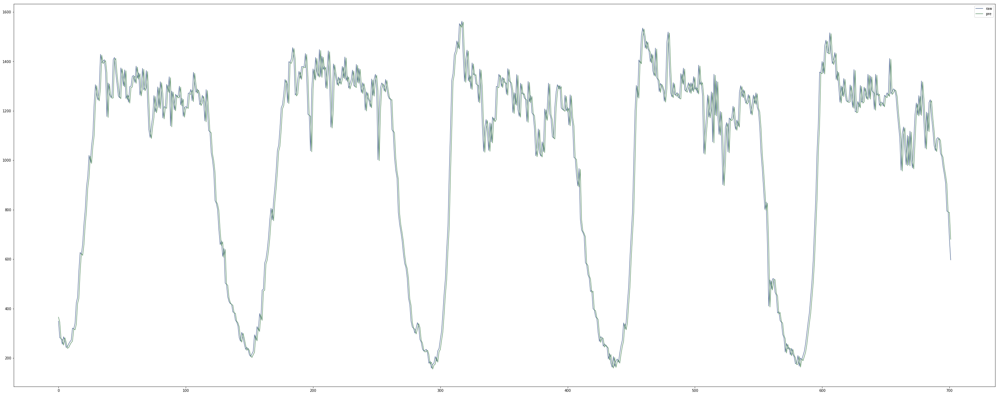

In [8]:
# report performance
rmse_1 = sqrt(mean_squared_error(expectation[:int(len(predictions_1))], predictions_1[:int(len(predictions_1))]))
rmse_2 = sqrt(mean_squared_error(expectation[:int(len(predictions_2))], predictions_2[:int(len(predictions_2))]))
mape_1 = mean_absolute_percentage_error(expectation,predictions_1)
mape_2 = mean_absolute_percentage_error(expectation,predictions_2)
print(rmse_1)
print(rmse_2)
print(str(mape_1 * 100)+'%')
print(str(mape_2 * 100)+'%')
# line plot of observed vs predicted
sns.set_palette('deep',desat = 0.6)
plt.figure(figsize = (50,20))
plt.plot(expectation[:int(len(predictions_1))],label = 'raw')
plt.plot(predictions_1[:int(len(predictions_1))],label = 'pre')
plt.legend()
plt.show()

In [3]:
data = xlrd.open_workbook('Data.xls')
table = data.sheets()[0]
table2 = data.sheets()[1]
raw_flow = table.col_values(0)
raw_flow2 = table2.col_values(0)
flow = np.array([i for i in raw_flow[1:]])
flow2 = np.array([i for i in raw_flow2[1:]])
series = pd.DataFrame(flow)

In [ ]:
params = {
    'learning_rate': 0.03,
    'n_estimators': 30,
    'subsample': 0.8,
    'colsample_bytree': 0.6,
    'max_depth': 10,
    'min_child_weight': 1,
    'reg_alpha': 0.1,
    'gamma': 0.7
}
neurons = 32
batch_size = 1
time_step = 1
epochs = 1

print('====Transforming data====')
# transform data to be stationary
raw_values = series.values
diff_values = difference(raw_values,1)

# transform data to be supervised learning
supervised = timeseries_to_supervised(diff_values,1)
supervised_values = supervised.values

# split data into train and test-sets
print('====Spliting data====')
(train,test) = train_test_split(supervised_values,rate = 0.92)

# transform the scale of the data
scaled_train,scaled_test,scaler = train_test_scale(train,test)

X_train, y_train = scaled_train[:, 0:-1], scaled_train[:, -1]
X_test, y_test = scaled_test[:, 0:-1], scaled_test[:, -1]
eval_set = [(X_test, y_test)]

regressor = xgb.XGBRegressor(learning_rate=params['learning_rate'], n_estimators=params['n_estimators'],
                             booster='gbtree', objective='reg:linear', n_jobs=-1, subsample=params['subsample'],
                             colsample_bytree=params['colsample_bytree'], random_state=0,
                             max_depth=params['max_depth'], gamma=params['gamma'],silent = 1,
                             min_child_weight=params['min_child_weight'], reg_alpha=params['reg_alpha'])


regressor.fit(X_train, y_train, verbose=True, early_stopping_rounds=3000, eval_set=eval_set)

predictions = list()
expectations = list()
for i in range(len(scaled_test)):
    X, y = scaled_test[i, 0:-1], scaled_test[i, -1]
    X = X.reshape(len(X),1)
    yhat = regressor.predict(X)
    yhat = invert_scale(scaler, X, yhat)
    yhat = inverse_difference(raw_values, yhat, len(scaled_test)+1-i)
    predictions.append(yhat)
    expected = raw_values[len(train) + i + 1]
    expectations.append(expected)
    scaled_train = np.vstack((scaled_train,np.array(scaled_test[i,:])))
    X_train, y_train = scaled_train[:, 0:-1], scaled_train[:, -1]
    regressor.fit(X_train, y_train, verbose=True, early_stopping_rounds=3000, eval_set=eval_set)
    #print('Month=%d, Predicted=%f, Expected=%f' % (i+1, yhat, expected))
rmse = sqrt(mean_squared_error(expectations[:int(len(predictions))], predictions[:int(len(predictions))]))

====Transforming data====
====Spliting data====
[0]	validation_0-rmse:0.324135
Will train until validation_0-rmse hasn't improved in 3000 rounds.
[1]	validation_0-rmse:0.31613
[2]	validation_0-rmse:0.308395
[3]	validation_0-rmse:0.300939
[4]	validation_0-rmse:0.293765
[5]	validation_0-rmse:0.286826
[6]	validation_0-rmse:0.280145
[7]	validation_0-rmse:0.273758
[8]	validation_0-rmse:0.267592
[9]	validation_0-rmse:0.261662
[10]	validation_0-rmse:0.25598
[11]	validation_0-rmse:0.250533
[12]	validation_0-rmse:0.245314
[13]	validation_0-rmse:0.24028
[14]	validation_0-rmse:0.235423
[15]	validation_0-rmse:0.230741
[16]	validation_0-rmse:0.226318
[17]	validation_0-rmse:0.222078
[18]	validation_0-rmse:0.217954
[19]	validation_0-rmse:0.214037
[20]	validation_0-rmse:0.210306
[21]	validation_0-rmse:0.206752
[22]	validation_0-rmse:0.203306
[23]	validation_0-rmse:0.199989
[24]	validation_0-rmse:0.196855
[25]	validation_0-rmse:0.193871
[26]	validation_0-rmse:0.190994
[27]	validation_0-rmse:0.188247
[2

C:\Users\Zeren Tan\Anaconda3\envs\tensorflow\lib\site-packages\sklearn\utils\validation.py:475: DataConversionWarning: Data with input dtype object was converted to float64 by MinMaxScaler.
  warnings.warn(msg, DataConversionWarning)


[51]	validation_0-rmse:0.151421
[52]	validation_0-rmse:0.150694
[53]	validation_0-rmse:0.150023
[54]	validation_0-rmse:0.149373
[55]	validation_0-rmse:0.148776
[56]	validation_0-rmse:0.1482
[57]	validation_0-rmse:0.147672
[58]	validation_0-rmse:0.147171
[59]	validation_0-rmse:0.146705
[60]	validation_0-rmse:0.146281
[61]	validation_0-rmse:0.145864
[62]	validation_0-rmse:0.145477
[63]	validation_0-rmse:0.145085
[64]	validation_0-rmse:0.144744
[65]	validation_0-rmse:0.144415
[66]	validation_0-rmse:0.144109
[67]	validation_0-rmse:0.143767
[68]	validation_0-rmse:0.143496
[69]	validation_0-rmse:0.143232
[70]	validation_0-rmse:0.142962
[71]	validation_0-rmse:0.142733
[72]	validation_0-rmse:0.142511
[73]	validation_0-rmse:0.142305
[74]	validation_0-rmse:0.142121
[75]	validation_0-rmse:0.141944
[76]	validation_0-rmse:0.141775
[77]	validation_0-rmse:0.141618
[78]	validation_0-rmse:0.141479
[79]	validation_0-rmse:0.14134
[80]	validation_0-rmse:0.141202
[81]	validation_0-rmse:0.141082
[82]	valida

[302]	validation_0-rmse:0.139477
[303]	validation_0-rmse:0.139478
[304]	validation_0-rmse:0.139477
[305]	validation_0-rmse:0.139477
[306]	validation_0-rmse:0.139478
[307]	validation_0-rmse:0.139477
[308]	validation_0-rmse:0.139477
[309]	validation_0-rmse:0.139477
[310]	validation_0-rmse:0.139476
[311]	validation_0-rmse:0.139476
[312]	validation_0-rmse:0.139476
[313]	validation_0-rmse:0.139476
[314]	validation_0-rmse:0.139476
[315]	validation_0-rmse:0.139477
[316]	validation_0-rmse:0.139477
[317]	validation_0-rmse:0.139477
[318]	validation_0-rmse:0.139476
[319]	validation_0-rmse:0.139477
[320]	validation_0-rmse:0.139477
[321]	validation_0-rmse:0.139477
[322]	validation_0-rmse:0.139476
[323]	validation_0-rmse:0.139477
[324]	validation_0-rmse:0.139476
[325]	validation_0-rmse:0.139476
[326]	validation_0-rmse:0.139476
[327]	validation_0-rmse:0.139476
[328]	validation_0-rmse:0.139476
[329]	validation_0-rmse:0.139476
[330]	validation_0-rmse:0.139476
[331]	validation_0-rmse:0.139476
[332]	vali

[551]	validation_0-rmse:0.139576
[552]	validation_0-rmse:0.139576
[553]	validation_0-rmse:0.139576
[554]	validation_0-rmse:0.139575
[555]	validation_0-rmse:0.139577
[556]	validation_0-rmse:0.139578
[557]	validation_0-rmse:0.139578
[558]	validation_0-rmse:0.139579
[559]	validation_0-rmse:0.13958
[560]	validation_0-rmse:0.139579
[561]	validation_0-rmse:0.139579
[562]	validation_0-rmse:0.13958
[563]	validation_0-rmse:0.13958
[564]	validation_0-rmse:0.13958
[565]	validation_0-rmse:0.13958
[566]	validation_0-rmse:0.13958
[567]	validation_0-rmse:0.139579
[568]	validation_0-rmse:0.139578
[569]	validation_0-rmse:0.139578
[570]	validation_0-rmse:0.139578
[571]	validation_0-rmse:0.139578
[572]	validation_0-rmse:0.139577
[573]	validation_0-rmse:0.139577
[574]	validation_0-rmse:0.139576
[575]	validation_0-rmse:0.139577
[576]	validation_0-rmse:0.139577
[577]	validation_0-rmse:0.139576
[578]	validation_0-rmse:0.139576
[579]	validation_0-rmse:0.139577
[580]	validation_0-rmse:0.139578
[581]	validation

[801]	validation_0-rmse:0.13963
[802]	validation_0-rmse:0.139631
[803]	validation_0-rmse:0.139631
[804]	validation_0-rmse:0.139631
[805]	validation_0-rmse:0.139631
[806]	validation_0-rmse:0.139631
[807]	validation_0-rmse:0.139631
[808]	validation_0-rmse:0.139631
[809]	validation_0-rmse:0.139631
[810]	validation_0-rmse:0.139631
[811]	validation_0-rmse:0.139631
[812]	validation_0-rmse:0.139631
[813]	validation_0-rmse:0.139632
[814]	validation_0-rmse:0.139633
[815]	validation_0-rmse:0.139633
[816]	validation_0-rmse:0.139633
[817]	validation_0-rmse:0.139632
[818]	validation_0-rmse:0.139631
[819]	validation_0-rmse:0.139631
[820]	validation_0-rmse:0.13963
[821]	validation_0-rmse:0.139631
[822]	validation_0-rmse:0.139631
[823]	validation_0-rmse:0.139632
[824]	validation_0-rmse:0.139632
[825]	validation_0-rmse:0.13963
[826]	validation_0-rmse:0.139631
[827]	validation_0-rmse:0.13963
[828]	validation_0-rmse:0.13963
[829]	validation_0-rmse:0.13963
[830]	validation_0-rmse:0.13963
[831]	validation_

[1049]	validation_0-rmse:0.139631
[1050]	validation_0-rmse:0.139632
[1051]	validation_0-rmse:0.139632
[1052]	validation_0-rmse:0.139632
[1053]	validation_0-rmse:0.139634
[1054]	validation_0-rmse:0.139634
[1055]	validation_0-rmse:0.139633
[1056]	validation_0-rmse:0.139633
[1057]	validation_0-rmse:0.139633
[1058]	validation_0-rmse:0.139634
[1059]	validation_0-rmse:0.139633
[1060]	validation_0-rmse:0.139633
[1061]	validation_0-rmse:0.139634
[1062]	validation_0-rmse:0.139635
[1063]	validation_0-rmse:0.139635
[1064]	validation_0-rmse:0.139635
[1065]	validation_0-rmse:0.139634
[1066]	validation_0-rmse:0.139634
[1067]	validation_0-rmse:0.139632
[1068]	validation_0-rmse:0.139632
[1069]	validation_0-rmse:0.139632
[1070]	validation_0-rmse:0.139632
[1071]	validation_0-rmse:0.139632
[1072]	validation_0-rmse:0.139632
[1073]	validation_0-rmse:0.139632
[1074]	validation_0-rmse:0.139632
[1075]	validation_0-rmse:0.139632
[1076]	validation_0-rmse:0.139631
[1077]	validation_0-rmse:0.139631
[1078]	validat

[1292]	validation_0-rmse:0.139712
[1293]	validation_0-rmse:0.139711
[1294]	validation_0-rmse:0.139711
[1295]	validation_0-rmse:0.139713
[1296]	validation_0-rmse:0.139713
[1297]	validation_0-rmse:0.139713
[1298]	validation_0-rmse:0.139713
[1299]	validation_0-rmse:0.139712
[1300]	validation_0-rmse:0.139713
[1301]	validation_0-rmse:0.139713
[1302]	validation_0-rmse:0.139715
[1303]	validation_0-rmse:0.139714
[1304]	validation_0-rmse:0.139713
[1305]	validation_0-rmse:0.139714
[1306]	validation_0-rmse:0.139713
[1307]	validation_0-rmse:0.139713
[1308]	validation_0-rmse:0.139712
[1309]	validation_0-rmse:0.139713
[1310]	validation_0-rmse:0.139712
[1311]	validation_0-rmse:0.139712
[1312]	validation_0-rmse:0.139711
[1313]	validation_0-rmse:0.139711
[1314]	validation_0-rmse:0.139713
[1315]	validation_0-rmse:0.139712
[1316]	validation_0-rmse:0.139713
[1317]	validation_0-rmse:0.139714
[1318]	validation_0-rmse:0.139714
[1319]	validation_0-rmse:0.139714
[1320]	validation_0-rmse:0.139714
[1321]	validat

[1534]	validation_0-rmse:0.139708
[1535]	validation_0-rmse:0.139709
[1536]	validation_0-rmse:0.139709
[1537]	validation_0-rmse:0.139709
[1538]	validation_0-rmse:0.139709
[1539]	validation_0-rmse:0.139711
[1540]	validation_0-rmse:0.13971
[1541]	validation_0-rmse:0.13971
[1542]	validation_0-rmse:0.13971
[1543]	validation_0-rmse:0.13971
[1544]	validation_0-rmse:0.139709
[1545]	validation_0-rmse:0.139709
[1546]	validation_0-rmse:0.139709
[1547]	validation_0-rmse:0.139709
[1548]	validation_0-rmse:0.139709
[1549]	validation_0-rmse:0.139709
[1550]	validation_0-rmse:0.139709
[1551]	validation_0-rmse:0.139709
[1552]	validation_0-rmse:0.139709
[1553]	validation_0-rmse:0.139708
[1554]	validation_0-rmse:0.139709
[1555]	validation_0-rmse:0.139709
[1556]	validation_0-rmse:0.139709
[1557]	validation_0-rmse:0.139709
[1558]	validation_0-rmse:0.139708
[1559]	validation_0-rmse:0.139708
[1560]	validation_0-rmse:0.139707
[1561]	validation_0-rmse:0.139708
[1562]	validation_0-rmse:0.139708
[1563]	validation_

[1777]	validation_0-rmse:0.13972
[1778]	validation_0-rmse:0.139721
[1779]	validation_0-rmse:0.139721
[1780]	validation_0-rmse:0.13972
[1781]	validation_0-rmse:0.13972
[1782]	validation_0-rmse:0.13972
[1783]	validation_0-rmse:0.139719
[1784]	validation_0-rmse:0.139719
[1785]	validation_0-rmse:0.139717
[1786]	validation_0-rmse:0.139717
[1787]	validation_0-rmse:0.139716
[1788]	validation_0-rmse:0.139716
[1789]	validation_0-rmse:0.139717
[1790]	validation_0-rmse:0.139717
[1791]	validation_0-rmse:0.139717
[1792]	validation_0-rmse:0.139716
[1793]	validation_0-rmse:0.139717
[1794]	validation_0-rmse:0.139716
[1795]	validation_0-rmse:0.139717
[1796]	validation_0-rmse:0.139718
[1797]	validation_0-rmse:0.139719
[1798]	validation_0-rmse:0.139719
[1799]	validation_0-rmse:0.139718
[1800]	validation_0-rmse:0.139719
[1801]	validation_0-rmse:0.139719
[1802]	validation_0-rmse:0.13972
[1803]	validation_0-rmse:0.139719
[1804]	validation_0-rmse:0.139718
[1805]	validation_0-rmse:0.139718
[1806]	validation_0

[2020]	validation_0-rmse:0.139727
[2021]	validation_0-rmse:0.139726
[2022]	validation_0-rmse:0.139726
[2023]	validation_0-rmse:0.139726
[2024]	validation_0-rmse:0.139726
[2025]	validation_0-rmse:0.139726
[2026]	validation_0-rmse:0.139726
[2027]	validation_0-rmse:0.139726
[2028]	validation_0-rmse:0.139725
[2029]	validation_0-rmse:0.139726
[2030]	validation_0-rmse:0.139726
[2031]	validation_0-rmse:0.139726
[2032]	validation_0-rmse:0.139727
[2033]	validation_0-rmse:0.139727
[2034]	validation_0-rmse:0.139726
[2035]	validation_0-rmse:0.139728
[2036]	validation_0-rmse:0.139727
[2037]	validation_0-rmse:0.139727
[2038]	validation_0-rmse:0.139728
[2039]	validation_0-rmse:0.139728
[2040]	validation_0-rmse:0.139728
[2041]	validation_0-rmse:0.139727
[2042]	validation_0-rmse:0.139726
[2043]	validation_0-rmse:0.139725
[2044]	validation_0-rmse:0.139725
[2045]	validation_0-rmse:0.139725
[2046]	validation_0-rmse:0.139724
[2047]	validation_0-rmse:0.139723
[2048]	validation_0-rmse:0.139724
[2049]	validat

[2262]	validation_0-rmse:0.139707
[2263]	validation_0-rmse:0.139707
[2264]	validation_0-rmse:0.139707
[2265]	validation_0-rmse:0.139707
[2266]	validation_0-rmse:0.139707
[2267]	validation_0-rmse:0.139706
[2268]	validation_0-rmse:0.139706
[2269]	validation_0-rmse:0.139705
[2270]	validation_0-rmse:0.139706
[2271]	validation_0-rmse:0.139707
[2272]	validation_0-rmse:0.139707
[2273]	validation_0-rmse:0.139705
[2274]	validation_0-rmse:0.139705
[2275]	validation_0-rmse:0.139705
[2276]	validation_0-rmse:0.139706
[2277]	validation_0-rmse:0.139707
[2278]	validation_0-rmse:0.139706
[2279]	validation_0-rmse:0.139706
[2280]	validation_0-rmse:0.139706
[2281]	validation_0-rmse:0.139707
[2282]	validation_0-rmse:0.139706
[2283]	validation_0-rmse:0.139706
[2284]	validation_0-rmse:0.139706
[2285]	validation_0-rmse:0.139706
[2286]	validation_0-rmse:0.139706
[2287]	validation_0-rmse:0.139705
[2288]	validation_0-rmse:0.139705
[2289]	validation_0-rmse:0.139706
[2290]	validation_0-rmse:0.139705
[2291]	validat

[2505]	validation_0-rmse:0.139729
[2506]	validation_0-rmse:0.139729
[2507]	validation_0-rmse:0.139729
[2508]	validation_0-rmse:0.139729
[2509]	validation_0-rmse:0.139729
[2510]	validation_0-rmse:0.13973
[2511]	validation_0-rmse:0.13973
[2512]	validation_0-rmse:0.139729
[2513]	validation_0-rmse:0.139728
[2514]	validation_0-rmse:0.139728
[2515]	validation_0-rmse:0.139728
[2516]	validation_0-rmse:0.139729
[2517]	validation_0-rmse:0.139728
[2518]	validation_0-rmse:0.139727
[2519]	validation_0-rmse:0.139727
[2520]	validation_0-rmse:0.139729
[2521]	validation_0-rmse:0.139729
[2522]	validation_0-rmse:0.139729
[2523]	validation_0-rmse:0.139729
[2524]	validation_0-rmse:0.139729
[2525]	validation_0-rmse:0.139729
[2526]	validation_0-rmse:0.139729
[2527]	validation_0-rmse:0.139729
[2528]	validation_0-rmse:0.139728
[2529]	validation_0-rmse:0.139729
[2530]	validation_0-rmse:0.139729
[2531]	validation_0-rmse:0.139729
[2532]	validation_0-rmse:0.139731
[2533]	validation_0-rmse:0.13973
[2534]	validation

[2747]	validation_0-rmse:0.139746
[2748]	validation_0-rmse:0.139746
[2749]	validation_0-rmse:0.139745
[2750]	validation_0-rmse:0.139745
[2751]	validation_0-rmse:0.139746
[2752]	validation_0-rmse:0.139746
[2753]	validation_0-rmse:0.139745
[2754]	validation_0-rmse:0.139744
[2755]	validation_0-rmse:0.139743
[2756]	validation_0-rmse:0.139743
[2757]	validation_0-rmse:0.139743
[2758]	validation_0-rmse:0.139743
[2759]	validation_0-rmse:0.139744
[2760]	validation_0-rmse:0.139745
[2761]	validation_0-rmse:0.139745
[2762]	validation_0-rmse:0.139746
[2763]	validation_0-rmse:0.139747
[2764]	validation_0-rmse:0.139748
[2765]	validation_0-rmse:0.139747
[2766]	validation_0-rmse:0.139747
[2767]	validation_0-rmse:0.139747
[2768]	validation_0-rmse:0.139749
[2769]	validation_0-rmse:0.139749
[2770]	validation_0-rmse:0.139748
[2771]	validation_0-rmse:0.139748
[2772]	validation_0-rmse:0.139748
[2773]	validation_0-rmse:0.139747
[2774]	validation_0-rmse:0.139748
[2775]	validation_0-rmse:0.139748
[2776]	validat

[2989]	validation_0-rmse:0.139744
[2990]	validation_0-rmse:0.139743
[2991]	validation_0-rmse:0.139744
[2992]	validation_0-rmse:0.139744
[2993]	validation_0-rmse:0.139744
[2994]	validation_0-rmse:0.139745
[2995]	validation_0-rmse:0.139745
[2996]	validation_0-rmse:0.139746
[2997]	validation_0-rmse:0.139745
[2998]	validation_0-rmse:0.139745
[2999]	validation_0-rmse:0.139744
[0]	validation_0-rmse:0.324135
Will train until validation_0-rmse hasn't improved in 3000 rounds.
[1]	validation_0-rmse:0.316064
[2]	validation_0-rmse:0.30837
[3]	validation_0-rmse:0.300932
[4]	validation_0-rmse:0.293752
[5]	validation_0-rmse:0.286868
[6]	validation_0-rmse:0.280144
[7]	validation_0-rmse:0.273773
[8]	validation_0-rmse:0.267631
[9]	validation_0-rmse:0.261771
[10]	validation_0-rmse:0.256081
[11]	validation_0-rmse:0.250611
[12]	validation_0-rmse:0.245351
[13]	validation_0-rmse:0.24031
[14]	validation_0-rmse:0.235494
[15]	validation_0-rmse:0.23085
[16]	validation_0-rmse:0.226396
[17]	validation_0-rmse:0.222

[240]	validation_0-rmse:0.139516
[241]	validation_0-rmse:0.139516
[242]	validation_0-rmse:0.139516
[243]	validation_0-rmse:0.139516
[244]	validation_0-rmse:0.139518
[245]	validation_0-rmse:0.139518
[246]	validation_0-rmse:0.139518
[247]	validation_0-rmse:0.139518
[248]	validation_0-rmse:0.139518
[249]	validation_0-rmse:0.13952
[250]	validation_0-rmse:0.139519
[251]	validation_0-rmse:0.139519
[252]	validation_0-rmse:0.13952
[253]	validation_0-rmse:0.13952
[254]	validation_0-rmse:0.139521
[255]	validation_0-rmse:0.139521
[256]	validation_0-rmse:0.13952
[257]	validation_0-rmse:0.13952
[258]	validation_0-rmse:0.139521
[259]	validation_0-rmse:0.139521
[260]	validation_0-rmse:0.139521
[261]	validation_0-rmse:0.139521
[262]	validation_0-rmse:0.13952
[263]	validation_0-rmse:0.13952
[264]	validation_0-rmse:0.13952
[265]	validation_0-rmse:0.13952
[266]	validation_0-rmse:0.139519
[267]	validation_0-rmse:0.139519
[268]	validation_0-rmse:0.13952
[269]	validation_0-rmse:0.139521
[270]	validation_0-r

[490]	validation_0-rmse:0.139536
[491]	validation_0-rmse:0.139535
[492]	validation_0-rmse:0.139536
[493]	validation_0-rmse:0.139536
[494]	validation_0-rmse:0.139536
[495]	validation_0-rmse:0.139535
[496]	validation_0-rmse:0.139534
[497]	validation_0-rmse:0.139535
[498]	validation_0-rmse:0.139536
[499]	validation_0-rmse:0.139535
[500]	validation_0-rmse:0.139534
[501]	validation_0-rmse:0.139535
[502]	validation_0-rmse:0.139534
[503]	validation_0-rmse:0.139533
[504]	validation_0-rmse:0.139533
[505]	validation_0-rmse:0.139519
[506]	validation_0-rmse:0.139519
[507]	validation_0-rmse:0.13952
[508]	validation_0-rmse:0.13952
[509]	validation_0-rmse:0.139518
[510]	validation_0-rmse:0.139518
[511]	validation_0-rmse:0.139518
[512]	validation_0-rmse:0.139517
[513]	validation_0-rmse:0.139517
[514]	validation_0-rmse:0.139517
[515]	validation_0-rmse:0.139516
[516]	validation_0-rmse:0.139517
[517]	validation_0-rmse:0.139518
[518]	validation_0-rmse:0.139516
[519]	validation_0-rmse:0.139516
[520]	valida

[740]	validation_0-rmse:0.139508
[741]	validation_0-rmse:0.139507
[742]	validation_0-rmse:0.139507
[743]	validation_0-rmse:0.139507
[744]	validation_0-rmse:0.139506
[745]	validation_0-rmse:0.139506
[746]	validation_0-rmse:0.139505
[747]	validation_0-rmse:0.139505
[748]	validation_0-rmse:0.139504
[749]	validation_0-rmse:0.139504
[750]	validation_0-rmse:0.139504
[751]	validation_0-rmse:0.139504
[752]	validation_0-rmse:0.139503
[753]	validation_0-rmse:0.139503
[754]	validation_0-rmse:0.139504
[755]	validation_0-rmse:0.139505
[756]	validation_0-rmse:0.139505
[757]	validation_0-rmse:0.139505
[758]	validation_0-rmse:0.139504
[759]	validation_0-rmse:0.139505
[760]	validation_0-rmse:0.139504
[761]	validation_0-rmse:0.139504
[762]	validation_0-rmse:0.139504
[763]	validation_0-rmse:0.139504
[764]	validation_0-rmse:0.139505
[765]	validation_0-rmse:0.139505
[766]	validation_0-rmse:0.139503
[767]	validation_0-rmse:0.139503
[768]	validation_0-rmse:0.139503
[769]	validation_0-rmse:0.139503
[770]	vali

[991]	validation_0-rmse:0.139511
[992]	validation_0-rmse:0.139511
[993]	validation_0-rmse:0.139511
[994]	validation_0-rmse:0.139512
[995]	validation_0-rmse:0.139513
[996]	validation_0-rmse:0.139513
[997]	validation_0-rmse:0.139513
[998]	validation_0-rmse:0.139513
[999]	validation_0-rmse:0.139513
[1000]	validation_0-rmse:0.139513
[1001]	validation_0-rmse:0.139514
[1002]	validation_0-rmse:0.139513
[1003]	validation_0-rmse:0.139513
[1004]	validation_0-rmse:0.139513
[1005]	validation_0-rmse:0.139512
[1006]	validation_0-rmse:0.139511
[1007]	validation_0-rmse:0.139512
[1008]	validation_0-rmse:0.139513
[1009]	validation_0-rmse:0.139513
[1010]	validation_0-rmse:0.139512
[1011]	validation_0-rmse:0.139512
[1012]	validation_0-rmse:0.139511
[1013]	validation_0-rmse:0.13951
[1014]	validation_0-rmse:0.13951
[1015]	validation_0-rmse:0.139511
[1016]	validation_0-rmse:0.139511
[1017]	validation_0-rmse:0.139511
[1018]	validation_0-rmse:0.139512
[1019]	validation_0-rmse:0.139511
[1020]	validation_0-rmse:

[1234]	validation_0-rmse:0.139536
[1235]	validation_0-rmse:0.139535
[1236]	validation_0-rmse:0.139535
[1237]	validation_0-rmse:0.139535
[1238]	validation_0-rmse:0.139535
[1239]	validation_0-rmse:0.139536
[1240]	validation_0-rmse:0.139537
[1241]	validation_0-rmse:0.139536
[1242]	validation_0-rmse:0.139536
[1243]	validation_0-rmse:0.139536
[1244]	validation_0-rmse:0.139536
[1245]	validation_0-rmse:0.139536
[1246]	validation_0-rmse:0.139536
[1247]	validation_0-rmse:0.139535
[1248]	validation_0-rmse:0.139534
[1249]	validation_0-rmse:0.139535
[1250]	validation_0-rmse:0.139534
[1251]	validation_0-rmse:0.139535
[1252]	validation_0-rmse:0.139534
[1253]	validation_0-rmse:0.139534
[1254]	validation_0-rmse:0.139534
[1255]	validation_0-rmse:0.139535
[1256]	validation_0-rmse:0.139535
[1257]	validation_0-rmse:0.139535
[1258]	validation_0-rmse:0.139536
[1259]	validation_0-rmse:0.139535
[1260]	validation_0-rmse:0.139535
[1261]	validation_0-rmse:0.139535
[1262]	validation_0-rmse:0.139535
[1263]	validat

[1476]	validation_0-rmse:0.139577
[1477]	validation_0-rmse:0.139576
[1478]	validation_0-rmse:0.139577
[1479]	validation_0-rmse:0.139577
[1480]	validation_0-rmse:0.139576
[1481]	validation_0-rmse:0.139577
[1482]	validation_0-rmse:0.139577
[1483]	validation_0-rmse:0.139577
[1484]	validation_0-rmse:0.139578
[1485]	validation_0-rmse:0.139581
[1486]	validation_0-rmse:0.139581
[1487]	validation_0-rmse:0.139581
[1488]	validation_0-rmse:0.139581
[1489]	validation_0-rmse:0.139579
[1490]	validation_0-rmse:0.139579
[1491]	validation_0-rmse:0.139579
[1492]	validation_0-rmse:0.13958
[1493]	validation_0-rmse:0.139581
[1494]	validation_0-rmse:0.139581
[1495]	validation_0-rmse:0.139582
[1496]	validation_0-rmse:0.139582
[1497]	validation_0-rmse:0.139582
[1498]	validation_0-rmse:0.139582
[1499]	validation_0-rmse:0.139582
[1500]	validation_0-rmse:0.139582
[1501]	validation_0-rmse:0.139582
[1502]	validation_0-rmse:0.139582
[1503]	validation_0-rmse:0.139581
[1504]	validation_0-rmse:0.139581
[1505]	validati

[1718]	validation_0-rmse:0.139627
[1719]	validation_0-rmse:0.139627
[1720]	validation_0-rmse:0.139628
[1721]	validation_0-rmse:0.139627
[1722]	validation_0-rmse:0.139626
[1723]	validation_0-rmse:0.139627
[1724]	validation_0-rmse:0.139628
[1725]	validation_0-rmse:0.139628
[1726]	validation_0-rmse:0.139627
[1727]	validation_0-rmse:0.139628
[1728]	validation_0-rmse:0.139628
[1729]	validation_0-rmse:0.139628
[1730]	validation_0-rmse:0.13963
[1731]	validation_0-rmse:0.13963
[1732]	validation_0-rmse:0.139631
[1733]	validation_0-rmse:0.139631
[1734]	validation_0-rmse:0.13963
[1735]	validation_0-rmse:0.13963
[1736]	validation_0-rmse:0.13963
[1737]	validation_0-rmse:0.139629
[1738]	validation_0-rmse:0.139628
[1739]	validation_0-rmse:0.139626
[1740]	validation_0-rmse:0.139627
[1741]	validation_0-rmse:0.139627
[1742]	validation_0-rmse:0.139628
[1743]	validation_0-rmse:0.139629
[1744]	validation_0-rmse:0.139628
[1745]	validation_0-rmse:0.139627
[1746]	validation_0-rmse:0.139626
[1747]	validation_0

[1960]	validation_0-rmse:0.139628
[1961]	validation_0-rmse:0.139629
[1962]	validation_0-rmse:0.13963
[1963]	validation_0-rmse:0.13963
[1964]	validation_0-rmse:0.139631
[1965]	validation_0-rmse:0.139632
[1966]	validation_0-rmse:0.139632
[1967]	validation_0-rmse:0.139633
[1968]	validation_0-rmse:0.139632
[1969]	validation_0-rmse:0.139633
[1970]	validation_0-rmse:0.139633
[1971]	validation_0-rmse:0.139632
[1972]	validation_0-rmse:0.139632
[1973]	validation_0-rmse:0.139631
[1974]	validation_0-rmse:0.13963
[1975]	validation_0-rmse:0.13963
[1976]	validation_0-rmse:0.139629
[1977]	validation_0-rmse:0.13963
[1978]	validation_0-rmse:0.13963
[1979]	validation_0-rmse:0.139629
[1980]	validation_0-rmse:0.13963
[1981]	validation_0-rmse:0.139628
[1982]	validation_0-rmse:0.139628
[1983]	validation_0-rmse:0.139627
[1984]	validation_0-rmse:0.139627
[1985]	validation_0-rmse:0.139627
[1986]	validation_0-rmse:0.139627
[1987]	validation_0-rmse:0.139628
[1988]	validation_0-rmse:0.139628
[1989]	validation_0-r

[2203]	validation_0-rmse:0.139627
[2204]	validation_0-rmse:0.139627
[2205]	validation_0-rmse:0.139628
[2206]	validation_0-rmse:0.139628
[2207]	validation_0-rmse:0.139628
[2208]	validation_0-rmse:0.139628
[2209]	validation_0-rmse:0.139629
[2210]	validation_0-rmse:0.139629
[2211]	validation_0-rmse:0.139629
[2212]	validation_0-rmse:0.13963
[2213]	validation_0-rmse:0.13963
[2214]	validation_0-rmse:0.139629
[2215]	validation_0-rmse:0.139629
[2216]	validation_0-rmse:0.13963
[2217]	validation_0-rmse:0.139629
[2218]	validation_0-rmse:0.139629
[2219]	validation_0-rmse:0.139631
[2220]	validation_0-rmse:0.13963
[2221]	validation_0-rmse:0.13963
[2222]	validation_0-rmse:0.13963
[2223]	validation_0-rmse:0.13963
[2224]	validation_0-rmse:0.13963
[2225]	validation_0-rmse:0.13963
[2226]	validation_0-rmse:0.139629
[2227]	validation_0-rmse:0.139629
[2228]	validation_0-rmse:0.139627
[2229]	validation_0-rmse:0.139629
[2230]	validation_0-rmse:0.139628
[2231]	validation_0-rmse:0.139627
[2232]	validation_0-rms

[2445]	validation_0-rmse:0.139632
[2446]	validation_0-rmse:0.139631
[2447]	validation_0-rmse:0.139631
[2448]	validation_0-rmse:0.13963
[2449]	validation_0-rmse:0.139629
[2450]	validation_0-rmse:0.139628
[2451]	validation_0-rmse:0.139628
[2452]	validation_0-rmse:0.139628
[2453]	validation_0-rmse:0.139627
[2454]	validation_0-rmse:0.139627
[2455]	validation_0-rmse:0.139627
[2456]	validation_0-rmse:0.139627
[2457]	validation_0-rmse:0.139627
[2458]	validation_0-rmse:0.139627
[2459]	validation_0-rmse:0.139627
[2460]	validation_0-rmse:0.139627
[2461]	validation_0-rmse:0.139626
[2462]	validation_0-rmse:0.139626
[2463]	validation_0-rmse:0.139627
[2464]	validation_0-rmse:0.139626
[2465]	validation_0-rmse:0.139627
[2466]	validation_0-rmse:0.139627
[2467]	validation_0-rmse:0.139628
[2468]	validation_0-rmse:0.139628
[2469]	validation_0-rmse:0.139627
[2470]	validation_0-rmse:0.139627
[2471]	validation_0-rmse:0.139628
[2472]	validation_0-rmse:0.139627
[2473]	validation_0-rmse:0.139627
[2474]	validati

[2687]	validation_0-rmse:0.139627
[2688]	validation_0-rmse:0.139626
[2689]	validation_0-rmse:0.139626
[2690]	validation_0-rmse:0.139626
[2691]	validation_0-rmse:0.139627
[2692]	validation_0-rmse:0.139627
[2693]	validation_0-rmse:0.139627
[2694]	validation_0-rmse:0.139627
[2695]	validation_0-rmse:0.139627
[2696]	validation_0-rmse:0.139627
[2697]	validation_0-rmse:0.139627
[2698]	validation_0-rmse:0.139627
[2699]	validation_0-rmse:0.139627
[2700]	validation_0-rmse:0.139626
[2701]	validation_0-rmse:0.139626
[2702]	validation_0-rmse:0.139627
[2703]	validation_0-rmse:0.139626
[2704]	validation_0-rmse:0.139626
[2705]	validation_0-rmse:0.139627
[2706]	validation_0-rmse:0.139626
[2707]	validation_0-rmse:0.139625
[2708]	validation_0-rmse:0.139624
[2709]	validation_0-rmse:0.139624
[2710]	validation_0-rmse:0.139624
[2711]	validation_0-rmse:0.139623
[2712]	validation_0-rmse:0.139623
[2713]	validation_0-rmse:0.139623
[2714]	validation_0-rmse:0.139622
[2715]	validation_0-rmse:0.139624
[2716]	validat

[2929]	validation_0-rmse:0.139626
[2930]	validation_0-rmse:0.139626
[2931]	validation_0-rmse:0.139625
[2932]	validation_0-rmse:0.139625
[2933]	validation_0-rmse:0.139626
[2934]	validation_0-rmse:0.139626
[2935]	validation_0-rmse:0.139626
[2936]	validation_0-rmse:0.139626
[2937]	validation_0-rmse:0.139626
[2938]	validation_0-rmse:0.139626
[2939]	validation_0-rmse:0.139627
[2940]	validation_0-rmse:0.139627
[2941]	validation_0-rmse:0.139627
[2942]	validation_0-rmse:0.139626
[2943]	validation_0-rmse:0.139627
[2944]	validation_0-rmse:0.139627
[2945]	validation_0-rmse:0.139628
[2946]	validation_0-rmse:0.139628
[2947]	validation_0-rmse:0.139628
[2948]	validation_0-rmse:0.139627
[2949]	validation_0-rmse:0.139627
[2950]	validation_0-rmse:0.139626
[2951]	validation_0-rmse:0.139625
[2952]	validation_0-rmse:0.139626
[2953]	validation_0-rmse:0.139626
[2954]	validation_0-rmse:0.139626
[2955]	validation_0-rmse:0.139626
[2956]	validation_0-rmse:0.139626
[2957]	validation_0-rmse:0.139626
[2958]	validat

[178]	validation_0-rmse:0.139391
[179]	validation_0-rmse:0.139392
[180]	validation_0-rmse:0.139392
[181]	validation_0-rmse:0.139392
[182]	validation_0-rmse:0.139393
[183]	validation_0-rmse:0.139394
[184]	validation_0-rmse:0.139394
[185]	validation_0-rmse:0.139394
[186]	validation_0-rmse:0.139394
[187]	validation_0-rmse:0.139395
[188]	validation_0-rmse:0.139395
[189]	validation_0-rmse:0.139396
[190]	validation_0-rmse:0.139397
[191]	validation_0-rmse:0.139398
[192]	validation_0-rmse:0.139398
[193]	validation_0-rmse:0.139399
[194]	validation_0-rmse:0.1394
[195]	validation_0-rmse:0.1394
[196]	validation_0-rmse:0.139399
[197]	validation_0-rmse:0.139399
[198]	validation_0-rmse:0.1394
[199]	validation_0-rmse:0.1394
[200]	validation_0-rmse:0.139401
[201]	validation_0-rmse:0.139402
[202]	validation_0-rmse:0.139386
[203]	validation_0-rmse:0.139386
[204]	validation_0-rmse:0.139387
[205]	validation_0-rmse:0.139387
[206]	validation_0-rmse:0.139388
[207]	validation_0-rmse:0.139387
[208]	validation_0

[427]	validation_0-rmse:0.139488
[428]	validation_0-rmse:0.139488
[429]	validation_0-rmse:0.139487
[430]	validation_0-rmse:0.139488
[431]	validation_0-rmse:0.139488
[432]	validation_0-rmse:0.139487
[433]	validation_0-rmse:0.139488
[434]	validation_0-rmse:0.139488
[435]	validation_0-rmse:0.139488
[436]	validation_0-rmse:0.139489
[437]	validation_0-rmse:0.139489
[438]	validation_0-rmse:0.139489
[439]	validation_0-rmse:0.139488
[440]	validation_0-rmse:0.139488
[441]	validation_0-rmse:0.139488
[442]	validation_0-rmse:0.139489
[443]	validation_0-rmse:0.139489
[444]	validation_0-rmse:0.139488
[445]	validation_0-rmse:0.139488
[446]	validation_0-rmse:0.139489
[447]	validation_0-rmse:0.139488
[448]	validation_0-rmse:0.139488
[449]	validation_0-rmse:0.139488
[450]	validation_0-rmse:0.139487
[451]	validation_0-rmse:0.139487
[452]	validation_0-rmse:0.139486
[453]	validation_0-rmse:0.139486
[454]	validation_0-rmse:0.139487
[455]	validation_0-rmse:0.139487
[456]	validation_0-rmse:0.139488
[457]	vali

[677]	validation_0-rmse:0.139502
[678]	validation_0-rmse:0.139502
[679]	validation_0-rmse:0.139501
[680]	validation_0-rmse:0.139501
[681]	validation_0-rmse:0.139502
[682]	validation_0-rmse:0.139502
[683]	validation_0-rmse:0.139502
[684]	validation_0-rmse:0.139503
[685]	validation_0-rmse:0.139503
[686]	validation_0-rmse:0.139503
[687]	validation_0-rmse:0.139504
[688]	validation_0-rmse:0.139503
[689]	validation_0-rmse:0.139503
[690]	validation_0-rmse:0.139504
[691]	validation_0-rmse:0.139503
[692]	validation_0-rmse:0.139502
[693]	validation_0-rmse:0.139501
[694]	validation_0-rmse:0.1395
[695]	validation_0-rmse:0.1395
[696]	validation_0-rmse:0.1395
[697]	validation_0-rmse:0.139499
[698]	validation_0-rmse:0.139498
[699]	validation_0-rmse:0.139499
[700]	validation_0-rmse:0.139497
[701]	validation_0-rmse:0.139497
[702]	validation_0-rmse:0.139497
[703]	validation_0-rmse:0.139497
[704]	validation_0-rmse:0.139497
[705]	validation_0-rmse:0.139496
[706]	validation_0-rmse:0.139496
[707]	validation

[927]	validation_0-rmse:0.139487
[928]	validation_0-rmse:0.139488
[929]	validation_0-rmse:0.139488
[930]	validation_0-rmse:0.139487
[931]	validation_0-rmse:0.139487
[932]	validation_0-rmse:0.139487
[933]	validation_0-rmse:0.139486
[934]	validation_0-rmse:0.139487
[935]	validation_0-rmse:0.139487
[936]	validation_0-rmse:0.139487
[937]	validation_0-rmse:0.139487
[938]	validation_0-rmse:0.139487
[939]	validation_0-rmse:0.139486
[940]	validation_0-rmse:0.139487
[941]	validation_0-rmse:0.139486
[942]	validation_0-rmse:0.139486
[943]	validation_0-rmse:0.139486
[944]	validation_0-rmse:0.139486
[945]	validation_0-rmse:0.139486
[946]	validation_0-rmse:0.139485
[947]	validation_0-rmse:0.139484
[948]	validation_0-rmse:0.139484
[949]	validation_0-rmse:0.139485
[950]	validation_0-rmse:0.139484
[951]	validation_0-rmse:0.139484
[952]	validation_0-rmse:0.139482
[953]	validation_0-rmse:0.139482
[954]	validation_0-rmse:0.139482
[955]	validation_0-rmse:0.139481
[956]	validation_0-rmse:0.13948
[957]	valid

[1173]	validation_0-rmse:0.139502
[1174]	validation_0-rmse:0.139502
[1175]	validation_0-rmse:0.139502
[1176]	validation_0-rmse:0.139502
[1177]	validation_0-rmse:0.139502
[1178]	validation_0-rmse:0.139502
[1179]	validation_0-rmse:0.139502
[1180]	validation_0-rmse:0.139503
[1181]	validation_0-rmse:0.139503
[1182]	validation_0-rmse:0.139504
[1183]	validation_0-rmse:0.139504
[1184]	validation_0-rmse:0.139503
[1185]	validation_0-rmse:0.139503
[1186]	validation_0-rmse:0.139502
[1187]	validation_0-rmse:0.139502
[1188]	validation_0-rmse:0.139502
[1189]	validation_0-rmse:0.139501
[1190]	validation_0-rmse:0.139501
[1191]	validation_0-rmse:0.139501
[1192]	validation_0-rmse:0.1395
[1193]	validation_0-rmse:0.1395
[1194]	validation_0-rmse:0.1395
[1195]	validation_0-rmse:0.1395
[1196]	validation_0-rmse:0.1395
[1197]	validation_0-rmse:0.1395
[1198]	validation_0-rmse:0.139501
[1199]	validation_0-rmse:0.1395
[1200]	validation_0-rmse:0.1395
[1201]	validation_0-rmse:0.139499
[1202]	validation_0-rmse:0.139

[1416]	validation_0-rmse:0.139514
[1417]	validation_0-rmse:0.139514
[1418]	validation_0-rmse:0.139514
[1419]	validation_0-rmse:0.139512
[1420]	validation_0-rmse:0.139512
[1421]	validation_0-rmse:0.139511
[1422]	validation_0-rmse:0.139512
[1423]	validation_0-rmse:0.139512
[1424]	validation_0-rmse:0.139511
[1425]	validation_0-rmse:0.13951
[1426]	validation_0-rmse:0.139511
[1427]	validation_0-rmse:0.13951
[1428]	validation_0-rmse:0.139509
[1429]	validation_0-rmse:0.13951
[1430]	validation_0-rmse:0.13951
[1431]	validation_0-rmse:0.13951
[1432]	validation_0-rmse:0.139509
[1433]	validation_0-rmse:0.139509
[1434]	validation_0-rmse:0.139509
[1435]	validation_0-rmse:0.13951
[1436]	validation_0-rmse:0.139511
[1437]	validation_0-rmse:0.13951
[1438]	validation_0-rmse:0.139509
[1439]	validation_0-rmse:0.139508
[1440]	validation_0-rmse:0.139509
[1441]	validation_0-rmse:0.13951
[1442]	validation_0-rmse:0.13951
[1443]	validation_0-rmse:0.139509
[1444]	validation_0-rmse:0.139509
[1445]	validation_0-rms

[1659]	validation_0-rmse:0.139502
[1660]	validation_0-rmse:0.139503
[1661]	validation_0-rmse:0.139503
[1662]	validation_0-rmse:0.139504
[1663]	validation_0-rmse:0.139504
[1664]	validation_0-rmse:0.139504
[1665]	validation_0-rmse:0.139505
[1666]	validation_0-rmse:0.139506
[1667]	validation_0-rmse:0.139506
[1668]	validation_0-rmse:0.139506
[1669]	validation_0-rmse:0.139507
[1670]	validation_0-rmse:0.139507
[1671]	validation_0-rmse:0.139508
[1672]	validation_0-rmse:0.139507
[1673]	validation_0-rmse:0.139508
[1674]	validation_0-rmse:0.139507
[1675]	validation_0-rmse:0.139507
[1676]	validation_0-rmse:0.139507
[1677]	validation_0-rmse:0.139507
[1678]	validation_0-rmse:0.139507
[1679]	validation_0-rmse:0.139506
[1680]	validation_0-rmse:0.139507
[1681]	validation_0-rmse:0.139508
[1682]	validation_0-rmse:0.139508
[1683]	validation_0-rmse:0.139508
[1684]	validation_0-rmse:0.139508
[1685]	validation_0-rmse:0.139508
[1686]	validation_0-rmse:0.139508
[1687]	validation_0-rmse:0.139508
[1688]	validat

[1902]	validation_0-rmse:0.139498
[1903]	validation_0-rmse:0.139498
[1904]	validation_0-rmse:0.139498
[1905]	validation_0-rmse:0.139498
[1906]	validation_0-rmse:0.139499
[1907]	validation_0-rmse:0.139499
[1908]	validation_0-rmse:0.139498
[1909]	validation_0-rmse:0.139499
[1910]	validation_0-rmse:0.139499
[1911]	validation_0-rmse:0.139499
[1912]	validation_0-rmse:0.139498
[1913]	validation_0-rmse:0.139496
[1914]	validation_0-rmse:0.139497
[1915]	validation_0-rmse:0.139497
[1916]	validation_0-rmse:0.139496
[1917]	validation_0-rmse:0.139496
[1918]	validation_0-rmse:0.139496
[1919]	validation_0-rmse:0.139497
[1920]	validation_0-rmse:0.139497
[1921]	validation_0-rmse:0.139497
[1922]	validation_0-rmse:0.139498
[1923]	validation_0-rmse:0.139498
[1924]	validation_0-rmse:0.139499
[1925]	validation_0-rmse:0.139499
[1926]	validation_0-rmse:0.139498
[1927]	validation_0-rmse:0.139498
[1928]	validation_0-rmse:0.139498
[1929]	validation_0-rmse:0.139499
[1930]	validation_0-rmse:0.139499
[1931]	validat

[2145]	validation_0-rmse:0.139499
[2146]	validation_0-rmse:0.1395
[2147]	validation_0-rmse:0.139501
[2148]	validation_0-rmse:0.1395
[2149]	validation_0-rmse:0.1395
[2150]	validation_0-rmse:0.1395
[2151]	validation_0-rmse:0.1395
[2152]	validation_0-rmse:0.139499
[2153]	validation_0-rmse:0.1395
[2154]	validation_0-rmse:0.1395
[2155]	validation_0-rmse:0.139499
[2156]	validation_0-rmse:0.139499
[2157]	validation_0-rmse:0.139499
[2158]	validation_0-rmse:0.139499
[2159]	validation_0-rmse:0.139498
[2160]	validation_0-rmse:0.139497
[2161]	validation_0-rmse:0.139498
[2162]	validation_0-rmse:0.139499
[2163]	validation_0-rmse:0.1395
[2164]	validation_0-rmse:0.139499
[2165]	validation_0-rmse:0.1395
[2166]	validation_0-rmse:0.139501
[2167]	validation_0-rmse:0.139501
[2168]	validation_0-rmse:0.139501
[2169]	validation_0-rmse:0.139501
[2170]	validation_0-rmse:0.139502
[2171]	validation_0-rmse:0.139502
[2172]	validation_0-rmse:0.1395
[2173]	validation_0-rmse:0.1395
[2174]	validation_0-rmse:0.1395
[217

[2388]	validation_0-rmse:0.139506
[2389]	validation_0-rmse:0.139505
[2390]	validation_0-rmse:0.139506
[2391]	validation_0-rmse:0.139506
[2392]	validation_0-rmse:0.139505
[2393]	validation_0-rmse:0.139506
[2394]	validation_0-rmse:0.139505
[2395]	validation_0-rmse:0.139505
[2396]	validation_0-rmse:0.139504
[2397]	validation_0-rmse:0.139504
[2398]	validation_0-rmse:0.139504
[2399]	validation_0-rmse:0.139503
[2400]	validation_0-rmse:0.139502
[2401]	validation_0-rmse:0.139502
[2402]	validation_0-rmse:0.139501
[2403]	validation_0-rmse:0.139503
[2404]	validation_0-rmse:0.139503
[2405]	validation_0-rmse:0.139503
[2406]	validation_0-rmse:0.139502
[2407]	validation_0-rmse:0.139503
[2408]	validation_0-rmse:0.139503
[2409]	validation_0-rmse:0.139503
[2410]	validation_0-rmse:0.139504
[2411]	validation_0-rmse:0.139504
[2412]	validation_0-rmse:0.139505
[2413]	validation_0-rmse:0.139505
[2414]	validation_0-rmse:0.139505
[2415]	validation_0-rmse:0.139505
[2416]	validation_0-rmse:0.139506
[2417]	validat

[2630]	validation_0-rmse:0.13949
[2631]	validation_0-rmse:0.139491
[2632]	validation_0-rmse:0.139491
[2633]	validation_0-rmse:0.139491
[2634]	validation_0-rmse:0.139491
[2635]	validation_0-rmse:0.139491
[2636]	validation_0-rmse:0.139491
[2637]	validation_0-rmse:0.139492
[2638]	validation_0-rmse:0.139492
[2639]	validation_0-rmse:0.139492
[2640]	validation_0-rmse:0.139492
[2641]	validation_0-rmse:0.139492
[2642]	validation_0-rmse:0.139492
[2643]	validation_0-rmse:0.139492
[2644]	validation_0-rmse:0.139492
[2645]	validation_0-rmse:0.139493
[2646]	validation_0-rmse:0.139494
[2647]	validation_0-rmse:0.139493
[2648]	validation_0-rmse:0.139493
[2649]	validation_0-rmse:0.139493
[2650]	validation_0-rmse:0.139493
[2651]	validation_0-rmse:0.139493
[2652]	validation_0-rmse:0.139492
[2653]	validation_0-rmse:0.139493
[2654]	validation_0-rmse:0.139492
[2655]	validation_0-rmse:0.139493
[2656]	validation_0-rmse:0.139494
[2657]	validation_0-rmse:0.139495
[2658]	validation_0-rmse:0.139494
[2659]	validati

[2872]	validation_0-rmse:0.139531
[2873]	validation_0-rmse:0.139531
[2874]	validation_0-rmse:0.139531
[2875]	validation_0-rmse:0.13953
[2876]	validation_0-rmse:0.13953
[2877]	validation_0-rmse:0.13953
[2878]	validation_0-rmse:0.139529
[2879]	validation_0-rmse:0.139528
[2880]	validation_0-rmse:0.139528
[2881]	validation_0-rmse:0.139528
[2882]	validation_0-rmse:0.139527
[2883]	validation_0-rmse:0.139527
[2884]	validation_0-rmse:0.139529
[2885]	validation_0-rmse:0.139528
[2886]	validation_0-rmse:0.13953
[2887]	validation_0-rmse:0.13953
[2888]	validation_0-rmse:0.139529
[2889]	validation_0-rmse:0.139528
[2890]	validation_0-rmse:0.139528
[2891]	validation_0-rmse:0.139529
[2892]	validation_0-rmse:0.139528
[2893]	validation_0-rmse:0.139528
[2894]	validation_0-rmse:0.139528
[2895]	validation_0-rmse:0.139529
[2896]	validation_0-rmse:0.139528
[2897]	validation_0-rmse:0.139528
[2898]	validation_0-rmse:0.139528
[2899]	validation_0-rmse:0.139528
[2900]	validation_0-rmse:0.139529
[2901]	validation_0

[119]	validation_0-rmse:0.139448
[120]	validation_0-rmse:0.13944
[121]	validation_0-rmse:0.139432
[122]	validation_0-rmse:0.139425
[123]	validation_0-rmse:0.139418
[124]	validation_0-rmse:0.139434
[125]	validation_0-rmse:0.139428
[126]	validation_0-rmse:0.139423
[127]	validation_0-rmse:0.139419
[128]	validation_0-rmse:0.139415
[129]	validation_0-rmse:0.139411
[130]	validation_0-rmse:0.139407
[131]	validation_0-rmse:0.139404
[132]	validation_0-rmse:0.139424
[133]	validation_0-rmse:0.139421
[134]	validation_0-rmse:0.139419
[135]	validation_0-rmse:0.139417
[136]	validation_0-rmse:0.139448
[137]	validation_0-rmse:0.139446
[138]	validation_0-rmse:0.139444
[139]	validation_0-rmse:0.139443
[140]	validation_0-rmse:0.139443
[141]	validation_0-rmse:0.139476
[142]	validation_0-rmse:0.139476
[143]	validation_0-rmse:0.139475
[144]	validation_0-rmse:0.139475
[145]	validation_0-rmse:0.139475
[146]	validation_0-rmse:0.139475
[147]	validation_0-rmse:0.139475
[148]	validation_0-rmse:0.139475
[149]	valid

[369]	validation_0-rmse:0.139509
[370]	validation_0-rmse:0.139508
[371]	validation_0-rmse:0.139508
[372]	validation_0-rmse:0.139507
[373]	validation_0-rmse:0.139508
[374]	validation_0-rmse:0.139507
[375]	validation_0-rmse:0.139507
[376]	validation_0-rmse:0.139507
[377]	validation_0-rmse:0.139507
[378]	validation_0-rmse:0.139507
[379]	validation_0-rmse:0.139508
[380]	validation_0-rmse:0.139509
[381]	validation_0-rmse:0.139509
[382]	validation_0-rmse:0.139508
[383]	validation_0-rmse:0.139508
[384]	validation_0-rmse:0.139508
[385]	validation_0-rmse:0.139509
[386]	validation_0-rmse:0.139509
[387]	validation_0-rmse:0.13951
[388]	validation_0-rmse:0.139509
[389]	validation_0-rmse:0.139509
[390]	validation_0-rmse:0.13951
[391]	validation_0-rmse:0.139509
[392]	validation_0-rmse:0.13951
[393]	validation_0-rmse:0.13951
[394]	validation_0-rmse:0.139509
[395]	validation_0-rmse:0.139509
[396]	validation_0-rmse:0.139509
[397]	validation_0-rmse:0.139509
[398]	validation_0-rmse:0.13951
[399]	validatio

[618]	validation_0-rmse:0.139509
[619]	validation_0-rmse:0.139508
[620]	validation_0-rmse:0.139508
[621]	validation_0-rmse:0.13951
[622]	validation_0-rmse:0.139509
[623]	validation_0-rmse:0.139509
[624]	validation_0-rmse:0.139509
[625]	validation_0-rmse:0.13951
[626]	validation_0-rmse:0.13951
[627]	validation_0-rmse:0.13951
[628]	validation_0-rmse:0.139509
[629]	validation_0-rmse:0.139509
[630]	validation_0-rmse:0.139509
[631]	validation_0-rmse:0.139508
[632]	validation_0-rmse:0.139508
[633]	validation_0-rmse:0.139507
[634]	validation_0-rmse:0.139506
[635]	validation_0-rmse:0.139507
[636]	validation_0-rmse:0.139507
[637]	validation_0-rmse:0.139507
[638]	validation_0-rmse:0.139507
[639]	validation_0-rmse:0.139508
[640]	validation_0-rmse:0.139508
[641]	validation_0-rmse:0.139508
[642]	validation_0-rmse:0.139506
[643]	validation_0-rmse:0.139507
[644]	validation_0-rmse:0.139508
[645]	validation_0-rmse:0.139508
[646]	validation_0-rmse:0.139508
[647]	validation_0-rmse:0.139508
[648]	validati

[868]	validation_0-rmse:0.13953
[869]	validation_0-rmse:0.13953
[870]	validation_0-rmse:0.13953
[871]	validation_0-rmse:0.13953
[872]	validation_0-rmse:0.13953
[873]	validation_0-rmse:0.139529
[874]	validation_0-rmse:0.139561
[875]	validation_0-rmse:0.13956
[876]	validation_0-rmse:0.139558
[877]	validation_0-rmse:0.139557
[878]	validation_0-rmse:0.139557
[879]	validation_0-rmse:0.139557
[880]	validation_0-rmse:0.139557
[881]	validation_0-rmse:0.139557
[882]	validation_0-rmse:0.139557
[883]	validation_0-rmse:0.139558
[884]	validation_0-rmse:0.139558
[885]	validation_0-rmse:0.139558
[886]	validation_0-rmse:0.139559
[887]	validation_0-rmse:0.139559
[888]	validation_0-rmse:0.139559
[889]	validation_0-rmse:0.13956
[890]	validation_0-rmse:0.139561
[891]	validation_0-rmse:0.139561
[892]	validation_0-rmse:0.13956
[893]	validation_0-rmse:0.13956
[894]	validation_0-rmse:0.13956
[895]	validation_0-rmse:0.139559
[896]	validation_0-rmse:0.13956
[897]	validation_0-rmse:0.13956
[898]	validation_0-rms

[1114]	validation_0-rmse:0.139579
[1115]	validation_0-rmse:0.139579
[1116]	validation_0-rmse:0.13958
[1117]	validation_0-rmse:0.13958
[1118]	validation_0-rmse:0.13958
[1119]	validation_0-rmse:0.13958
[1120]	validation_0-rmse:0.139581
[1121]	validation_0-rmse:0.139579
[1122]	validation_0-rmse:0.139579
[1123]	validation_0-rmse:0.13958
[1124]	validation_0-rmse:0.13958
[1125]	validation_0-rmse:0.13958
[1126]	validation_0-rmse:0.13958
[1127]	validation_0-rmse:0.139579
[1128]	validation_0-rmse:0.13958
[1129]	validation_0-rmse:0.13958
[1130]	validation_0-rmse:0.13958
[1131]	validation_0-rmse:0.139579
[1132]	validation_0-rmse:0.13958
[1133]	validation_0-rmse:0.139579
[1134]	validation_0-rmse:0.13958
[1135]	validation_0-rmse:0.139579
[1136]	validation_0-rmse:0.13958
[1137]	validation_0-rmse:0.13958
[1138]	validation_0-rmse:0.139579
[1139]	validation_0-rmse:0.139579
[1140]	validation_0-rmse:0.139579
[1141]	validation_0-rmse:0.139579
[1142]	validation_0-rmse:0.139578
[1143]	validation_0-rmse:0.13

[1357]	validation_0-rmse:0.139582
[1358]	validation_0-rmse:0.139582
[1359]	validation_0-rmse:0.139582
[1360]	validation_0-rmse:0.139583
[1361]	validation_0-rmse:0.139583
[1362]	validation_0-rmse:0.139583
[1363]	validation_0-rmse:0.139584
[1364]	validation_0-rmse:0.139584
[1365]	validation_0-rmse:0.139584
[1366]	validation_0-rmse:0.139583
[1367]	validation_0-rmse:0.139582
[1368]	validation_0-rmse:0.139581
[1369]	validation_0-rmse:0.139583
[1370]	validation_0-rmse:0.139581
[1371]	validation_0-rmse:0.13958
[1372]	validation_0-rmse:0.13958
[1373]	validation_0-rmse:0.139579
[1374]	validation_0-rmse:0.139579
[1375]	validation_0-rmse:0.139578
[1376]	validation_0-rmse:0.139578
[1377]	validation_0-rmse:0.139578
[1378]	validation_0-rmse:0.139578
[1379]	validation_0-rmse:0.139578
[1380]	validation_0-rmse:0.139578
[1381]	validation_0-rmse:0.139579
[1382]	validation_0-rmse:0.139579
[1383]	validation_0-rmse:0.139579
[1384]	validation_0-rmse:0.139578
[1385]	validation_0-rmse:0.139579
[1386]	validatio

[1600]	validation_0-rmse:0.139578
[1601]	validation_0-rmse:0.139578
[1602]	validation_0-rmse:0.139578
[1603]	validation_0-rmse:0.139578
[1604]	validation_0-rmse:0.139578
[1605]	validation_0-rmse:0.139578
[1606]	validation_0-rmse:0.139578
[1607]	validation_0-rmse:0.139577
[1608]	validation_0-rmse:0.139577
[1609]	validation_0-rmse:0.139577
[1610]	validation_0-rmse:0.139577
[1611]	validation_0-rmse:0.139578
[1612]	validation_0-rmse:0.139578
[1613]	validation_0-rmse:0.139579
[1614]	validation_0-rmse:0.139578
[1615]	validation_0-rmse:0.139578
[1616]	validation_0-rmse:0.139578
[1617]	validation_0-rmse:0.139578
[1618]	validation_0-rmse:0.139578
[1619]	validation_0-rmse:0.139579
[1620]	validation_0-rmse:0.139579
[1621]	validation_0-rmse:0.139578
[1622]	validation_0-rmse:0.139578
[1623]	validation_0-rmse:0.139577
[1624]	validation_0-rmse:0.139578
[1625]	validation_0-rmse:0.139578
[1626]	validation_0-rmse:0.139577
[1627]	validation_0-rmse:0.139577
[1628]	validation_0-rmse:0.139577
[1629]	validat

[1842]	validation_0-rmse:0.139576
[1843]	validation_0-rmse:0.139576
[1844]	validation_0-rmse:0.139576
[1845]	validation_0-rmse:0.139575
[1846]	validation_0-rmse:0.139574
[1847]	validation_0-rmse:0.139575
[1848]	validation_0-rmse:0.139574
[1849]	validation_0-rmse:0.139575
[1850]	validation_0-rmse:0.139575
[1851]	validation_0-rmse:0.139574
[1852]	validation_0-rmse:0.139574
[1853]	validation_0-rmse:0.139574
[1854]	validation_0-rmse:0.139573
[1855]	validation_0-rmse:0.139573
[1856]	validation_0-rmse:0.139573
[1857]	validation_0-rmse:0.139574
[1858]	validation_0-rmse:0.139573
[1859]	validation_0-rmse:0.139573
[1860]	validation_0-rmse:0.139572
[1861]	validation_0-rmse:0.139572
[1862]	validation_0-rmse:0.139573
[1863]	validation_0-rmse:0.139574
[1864]	validation_0-rmse:0.139574
[1865]	validation_0-rmse:0.139575
[1866]	validation_0-rmse:0.139574
[1867]	validation_0-rmse:0.139575
[1868]	validation_0-rmse:0.139574
[1869]	validation_0-rmse:0.139574
[1870]	validation_0-rmse:0.139575
[1871]	validat

[2084]	validation_0-rmse:0.139566
[2085]	validation_0-rmse:0.139567
[2086]	validation_0-rmse:0.139568
[2087]	validation_0-rmse:0.139567
[2088]	validation_0-rmse:0.139567
[2089]	validation_0-rmse:0.139566
[2090]	validation_0-rmse:0.139566
[2091]	validation_0-rmse:0.139566
[2092]	validation_0-rmse:0.139566
[2093]	validation_0-rmse:0.139566
[2094]	validation_0-rmse:0.139567
[2095]	validation_0-rmse:0.139567
[2096]	validation_0-rmse:0.139566
[2097]	validation_0-rmse:0.139565
[2098]	validation_0-rmse:0.139565
[2099]	validation_0-rmse:0.139565
[2100]	validation_0-rmse:0.139565
[2101]	validation_0-rmse:0.139565
[2102]	validation_0-rmse:0.139565
[2103]	validation_0-rmse:0.139565
[2104]	validation_0-rmse:0.139564
[2105]	validation_0-rmse:0.139564
[2106]	validation_0-rmse:0.139566
[2107]	validation_0-rmse:0.139566
[2108]	validation_0-rmse:0.139566
[2109]	validation_0-rmse:0.139566
[2110]	validation_0-rmse:0.139566
[2111]	validation_0-rmse:0.139566
[2112]	validation_0-rmse:0.139567
[2113]	validat

[2326]	validation_0-rmse:0.139634
[2327]	validation_0-rmse:0.139634
[2328]	validation_0-rmse:0.139634
[2329]	validation_0-rmse:0.139634
[2330]	validation_0-rmse:0.139634
[2331]	validation_0-rmse:0.139634
[2332]	validation_0-rmse:0.139633
[2333]	validation_0-rmse:0.139634
[2334]	validation_0-rmse:0.139633
[2335]	validation_0-rmse:0.139633
[2336]	validation_0-rmse:0.139634
[2337]	validation_0-rmse:0.139635
[2338]	validation_0-rmse:0.139635
[2339]	validation_0-rmse:0.139636
[2340]	validation_0-rmse:0.139636
[2341]	validation_0-rmse:0.139636
[2342]	validation_0-rmse:0.139637
[2343]	validation_0-rmse:0.139636
[2344]	validation_0-rmse:0.139636
[2345]	validation_0-rmse:0.139635
[2346]	validation_0-rmse:0.139635
[2347]	validation_0-rmse:0.139636
[2348]	validation_0-rmse:0.139635
[2349]	validation_0-rmse:0.139636
[2350]	validation_0-rmse:0.139635
[2351]	validation_0-rmse:0.139635
[2352]	validation_0-rmse:0.139637
[2353]	validation_0-rmse:0.139637
[2354]	validation_0-rmse:0.139638
[2355]	validat

[2569]	validation_0-rmse:0.139638
[2570]	validation_0-rmse:0.139639
[2571]	validation_0-rmse:0.139639
[2572]	validation_0-rmse:0.139639
[2573]	validation_0-rmse:0.139639
[2574]	validation_0-rmse:0.139639
[2575]	validation_0-rmse:0.139639
[2576]	validation_0-rmse:0.139639
[2577]	validation_0-rmse:0.139638
[2578]	validation_0-rmse:0.139637
[2579]	validation_0-rmse:0.139638
[2580]	validation_0-rmse:0.139639
[2581]	validation_0-rmse:0.139638
[2582]	validation_0-rmse:0.139638
[2583]	validation_0-rmse:0.139639
[2584]	validation_0-rmse:0.139638
[2585]	validation_0-rmse:0.139639
[2586]	validation_0-rmse:0.13964
[2587]	validation_0-rmse:0.139641
[2588]	validation_0-rmse:0.13964
[2589]	validation_0-rmse:0.139641
[2590]	validation_0-rmse:0.13964
[2591]	validation_0-rmse:0.13964
[2592]	validation_0-rmse:0.13964
[2593]	validation_0-rmse:0.139641
[2594]	validation_0-rmse:0.139641
[2595]	validation_0-rmse:0.139641
[2596]	validation_0-rmse:0.139641
[2597]	validation_0-rmse:0.139641
[2598]	validation_0

[2811]	validation_0-rmse:0.139637
[2812]	validation_0-rmse:0.139637
[2813]	validation_0-rmse:0.139637
[2814]	validation_0-rmse:0.139638
[2815]	validation_0-rmse:0.139638
[2816]	validation_0-rmse:0.139638
[2817]	validation_0-rmse:0.139638
[2818]	validation_0-rmse:0.139639
[2819]	validation_0-rmse:0.13964
[2820]	validation_0-rmse:0.139639
[2821]	validation_0-rmse:0.139641
[2822]	validation_0-rmse:0.13964
[2823]	validation_0-rmse:0.139639
[2824]	validation_0-rmse:0.13964
[2825]	validation_0-rmse:0.13964
[2826]	validation_0-rmse:0.13964
[2827]	validation_0-rmse:0.139638
[2828]	validation_0-rmse:0.139639
[2829]	validation_0-rmse:0.139639
[2830]	validation_0-rmse:0.139639
[2831]	validation_0-rmse:0.139639
[2832]	validation_0-rmse:0.13964
[2833]	validation_0-rmse:0.139639
[2834]	validation_0-rmse:0.139639
[2835]	validation_0-rmse:0.139638
[2836]	validation_0-rmse:0.139637
[2837]	validation_0-rmse:0.139636
[2838]	validation_0-rmse:0.139635
[2839]	validation_0-rmse:0.139635
[2840]	validation_0-

[55]	validation_0-rmse:0.148745
[56]	validation_0-rmse:0.148185
[57]	validation_0-rmse:0.147635
[58]	validation_0-rmse:0.147112
[59]	validation_0-rmse:0.146646
[60]	validation_0-rmse:0.146177
[61]	validation_0-rmse:0.14574
[62]	validation_0-rmse:0.145356
[63]	validation_0-rmse:0.144985
[64]	validation_0-rmse:0.144636
[65]	validation_0-rmse:0.144319
[66]	validation_0-rmse:0.144005
[67]	validation_0-rmse:0.143719
[68]	validation_0-rmse:0.143451
[69]	validation_0-rmse:0.143206
[70]	validation_0-rmse:0.142989
[71]	validation_0-rmse:0.142761
[72]	validation_0-rmse:0.142546
[73]	validation_0-rmse:0.142328
[74]	validation_0-rmse:0.142147
[75]	validation_0-rmse:0.141968
[76]	validation_0-rmse:0.1418
[77]	validation_0-rmse:0.141643
[78]	validation_0-rmse:0.141492
[79]	validation_0-rmse:0.141356
[80]	validation_0-rmse:0.141234
[81]	validation_0-rmse:0.141101
[82]	validation_0-rmse:0.140987
[83]	validation_0-rmse:0.140884
[84]	validation_0-rmse:0.140783
[85]	validation_0-rmse:0.140686
[86]	valida

[306]	validation_0-rmse:0.139531
[307]	validation_0-rmse:0.139532
[308]	validation_0-rmse:0.139531
[309]	validation_0-rmse:0.139531
[310]	validation_0-rmse:0.139532
[311]	validation_0-rmse:0.139533
[312]	validation_0-rmse:0.139534
[313]	validation_0-rmse:0.139533
[314]	validation_0-rmse:0.139533
[315]	validation_0-rmse:0.139534
[316]	validation_0-rmse:0.139533
[317]	validation_0-rmse:0.139533
[318]	validation_0-rmse:0.139534
[319]	validation_0-rmse:0.139533
[320]	validation_0-rmse:0.139533
[321]	validation_0-rmse:0.139534
[322]	validation_0-rmse:0.139533
[323]	validation_0-rmse:0.139533
[324]	validation_0-rmse:0.139534
[325]	validation_0-rmse:0.139533
[326]	validation_0-rmse:0.139534
[327]	validation_0-rmse:0.139534
[328]	validation_0-rmse:0.139535
[329]	validation_0-rmse:0.139535
[330]	validation_0-rmse:0.139535
[331]	validation_0-rmse:0.139536
[332]	validation_0-rmse:0.139536
[333]	validation_0-rmse:0.139536
[334]	validation_0-rmse:0.139537
[335]	validation_0-rmse:0.139537
[336]	vali

[555]	validation_0-rmse:0.139522
[556]	validation_0-rmse:0.139521
[557]	validation_0-rmse:0.13952
[558]	validation_0-rmse:0.139519
[559]	validation_0-rmse:0.139518
[560]	validation_0-rmse:0.139518
[561]	validation_0-rmse:0.139518
[562]	validation_0-rmse:0.139519
[563]	validation_0-rmse:0.139519
[564]	validation_0-rmse:0.13952
[565]	validation_0-rmse:0.13952
[566]	validation_0-rmse:0.139519
[567]	validation_0-rmse:0.139518
[568]	validation_0-rmse:0.139518
[569]	validation_0-rmse:0.139518
[570]	validation_0-rmse:0.139519
[571]	validation_0-rmse:0.139519
[572]	validation_0-rmse:0.13952
[573]	validation_0-rmse:0.13952
[574]	validation_0-rmse:0.139519
[575]	validation_0-rmse:0.139519
[576]	validation_0-rmse:0.13952
[577]	validation_0-rmse:0.13952
[578]	validation_0-rmse:0.139521
[579]	validation_0-rmse:0.139521
[580]	validation_0-rmse:0.139521
[581]	validation_0-rmse:0.139522
[582]	validation_0-rmse:0.139522
[583]	validation_0-rmse:0.139522
[584]	validation_0-rmse:0.139523
[585]	validation_

[805]	validation_0-rmse:0.139574
[806]	validation_0-rmse:0.139574
[807]	validation_0-rmse:0.139573
[808]	validation_0-rmse:0.139573
[809]	validation_0-rmse:0.139573
[810]	validation_0-rmse:0.139572
[811]	validation_0-rmse:0.13957
[812]	validation_0-rmse:0.13957
[813]	validation_0-rmse:0.13957
[814]	validation_0-rmse:0.13957
[815]	validation_0-rmse:0.13957
[816]	validation_0-rmse:0.13957
[817]	validation_0-rmse:0.139571
[818]	validation_0-rmse:0.139571
[819]	validation_0-rmse:0.139571
[820]	validation_0-rmse:0.139571
[821]	validation_0-rmse:0.139572
[822]	validation_0-rmse:0.139571
[823]	validation_0-rmse:0.139571
[824]	validation_0-rmse:0.13957
[825]	validation_0-rmse:0.13957
[826]	validation_0-rmse:0.139571
[827]	validation_0-rmse:0.139571
[828]	validation_0-rmse:0.139572
[829]	validation_0-rmse:0.139572
[830]	validation_0-rmse:0.13957
[831]	validation_0-rmse:0.13957
[832]	validation_0-rmse:0.13957
[833]	validation_0-rmse:0.139571
[834]	validation_0-rmse:0.139571
[835]	validation_0-rm

[1054]	validation_0-rmse:0.139586
[1055]	validation_0-rmse:0.139586
[1056]	validation_0-rmse:0.139586
[1057]	validation_0-rmse:0.139587
[1058]	validation_0-rmse:0.139588
[1059]	validation_0-rmse:0.139603
[1060]	validation_0-rmse:0.139603
[1061]	validation_0-rmse:0.139603
[1062]	validation_0-rmse:0.139603
[1063]	validation_0-rmse:0.139602
[1064]	validation_0-rmse:0.139602
[1065]	validation_0-rmse:0.139602
[1066]	validation_0-rmse:0.139603
[1067]	validation_0-rmse:0.139603
[1068]	validation_0-rmse:0.139604
[1069]	validation_0-rmse:0.139604
[1070]	validation_0-rmse:0.139605
[1071]	validation_0-rmse:0.139605
[1072]	validation_0-rmse:0.139604
[1073]	validation_0-rmse:0.139605
[1074]	validation_0-rmse:0.139605
[1075]	validation_0-rmse:0.139606
[1076]	validation_0-rmse:0.139606
[1077]	validation_0-rmse:0.139606
[1078]	validation_0-rmse:0.139606
[1079]	validation_0-rmse:0.139607
[1080]	validation_0-rmse:0.139608
[1081]	validation_0-rmse:0.139608
[1082]	validation_0-rmse:0.139608
[1083]	validat

[1296]	validation_0-rmse:0.139655
[1297]	validation_0-rmse:0.139655
[1298]	validation_0-rmse:0.139655
[1299]	validation_0-rmse:0.139654
[1300]	validation_0-rmse:0.139654
[1301]	validation_0-rmse:0.139655
[1302]	validation_0-rmse:0.139655
[1303]	validation_0-rmse:0.139654
[1304]	validation_0-rmse:0.139655
[1305]	validation_0-rmse:0.139654
[1306]	validation_0-rmse:0.139653
[1307]	validation_0-rmse:0.139652
[1308]	validation_0-rmse:0.139652
[1309]	validation_0-rmse:0.139652
[1310]	validation_0-rmse:0.13965
[1311]	validation_0-rmse:0.139651
[1312]	validation_0-rmse:0.13965
[1313]	validation_0-rmse:0.13965
[1314]	validation_0-rmse:0.13965
[1315]	validation_0-rmse:0.13965
[1316]	validation_0-rmse:0.13965
[1317]	validation_0-rmse:0.139649
[1318]	validation_0-rmse:0.13965
[1319]	validation_0-rmse:0.13965
[1320]	validation_0-rmse:0.139651
[1321]	validation_0-rmse:0.139652
[1322]	validation_0-rmse:0.139652
[1323]	validation_0-rmse:0.139651
[1324]	validation_0-rmse:0.139649
[1325]	validation_0-rm

[1538]	validation_0-rmse:0.139664
[1539]	validation_0-rmse:0.139665
[1540]	validation_0-rmse:0.139666
[1541]	validation_0-rmse:0.139666
[1542]	validation_0-rmse:0.139666
[1543]	validation_0-rmse:0.139665
[1544]	validation_0-rmse:0.139665
[1545]	validation_0-rmse:0.139665
[1546]	validation_0-rmse:0.139665
[1547]	validation_0-rmse:0.139665
[1548]	validation_0-rmse:0.139665
[1549]	validation_0-rmse:0.139664
[1550]	validation_0-rmse:0.139664
[1551]	validation_0-rmse:0.139665
[1552]	validation_0-rmse:0.139666
[1553]	validation_0-rmse:0.139666
[1554]	validation_0-rmse:0.139665
[1555]	validation_0-rmse:0.139666
[1556]	validation_0-rmse:0.139666
[1557]	validation_0-rmse:0.139667
[1558]	validation_0-rmse:0.139666
[1559]	validation_0-rmse:0.139666
[1560]	validation_0-rmse:0.139666
[1561]	validation_0-rmse:0.139666
[1562]	validation_0-rmse:0.139666
[1563]	validation_0-rmse:0.139666
[1564]	validation_0-rmse:0.139667
[1565]	validation_0-rmse:0.139667
[1566]	validation_0-rmse:0.139667
[1567]	validat

[1780]	validation_0-rmse:0.139656
[1781]	validation_0-rmse:0.139656
[1782]	validation_0-rmse:0.139657
[1783]	validation_0-rmse:0.139658
[1784]	validation_0-rmse:0.139658
[1785]	validation_0-rmse:0.139657
[1786]	validation_0-rmse:0.139657
[1787]	validation_0-rmse:0.139658
[1788]	validation_0-rmse:0.139657
[1789]	validation_0-rmse:0.139657
[1790]	validation_0-rmse:0.139657
[1791]	validation_0-rmse:0.139657
[1792]	validation_0-rmse:0.139658
[1793]	validation_0-rmse:0.139659
[1794]	validation_0-rmse:0.139658
[1795]	validation_0-rmse:0.139657
[1796]	validation_0-rmse:0.139656
[1797]	validation_0-rmse:0.139656
[1798]	validation_0-rmse:0.139657
[1799]	validation_0-rmse:0.139658
[1800]	validation_0-rmse:0.139658
[1801]	validation_0-rmse:0.139657
[1802]	validation_0-rmse:0.139659
[1803]	validation_0-rmse:0.139659
[1804]	validation_0-rmse:0.139659
[1805]	validation_0-rmse:0.139659
[1806]	validation_0-rmse:0.139659
[1807]	validation_0-rmse:0.139658
[1808]	validation_0-rmse:0.139658
[1809]	validat

[2022]	validation_0-rmse:0.139644
[2023]	validation_0-rmse:0.139644
[2024]	validation_0-rmse:0.139645
[2025]	validation_0-rmse:0.139645
[2026]	validation_0-rmse:0.139645
[2027]	validation_0-rmse:0.139645
[2028]	validation_0-rmse:0.139645
[2029]	validation_0-rmse:0.139645
[2030]	validation_0-rmse:0.139644
[2031]	validation_0-rmse:0.139643
[2032]	validation_0-rmse:0.139643
[2033]	validation_0-rmse:0.139644
[2034]	validation_0-rmse:0.139644
[2035]	validation_0-rmse:0.139644
[2036]	validation_0-rmse:0.139643
[2037]	validation_0-rmse:0.139642
[2038]	validation_0-rmse:0.139642
[2039]	validation_0-rmse:0.139643
[2040]	validation_0-rmse:0.139643
[2041]	validation_0-rmse:0.139643
[2042]	validation_0-rmse:0.139643
[2043]	validation_0-rmse:0.139643
[2044]	validation_0-rmse:0.139643
[2045]	validation_0-rmse:0.139643
[2046]	validation_0-rmse:0.139643
[2047]	validation_0-rmse:0.139643
[2048]	validation_0-rmse:0.139643
[2049]	validation_0-rmse:0.139644
[2050]	validation_0-rmse:0.139643
[2051]	validat

[2264]	validation_0-rmse:0.139663
[2265]	validation_0-rmse:0.139664
[2266]	validation_0-rmse:0.139663
[2267]	validation_0-rmse:0.139664
[2268]	validation_0-rmse:0.139663
[2269]	validation_0-rmse:0.139662
[2270]	validation_0-rmse:0.139662
[2271]	validation_0-rmse:0.139662
[2272]	validation_0-rmse:0.139661
[2273]	validation_0-rmse:0.139661
[2274]	validation_0-rmse:0.139661
[2275]	validation_0-rmse:0.139662
[2276]	validation_0-rmse:0.139662
[2277]	validation_0-rmse:0.139662
[2278]	validation_0-rmse:0.139663
[2279]	validation_0-rmse:0.139662
[2280]	validation_0-rmse:0.139662
[2281]	validation_0-rmse:0.139661
[2282]	validation_0-rmse:0.139661
[2283]	validation_0-rmse:0.139661
[2284]	validation_0-rmse:0.139662
[2285]	validation_0-rmse:0.139663
[2286]	validation_0-rmse:0.139662
[2287]	validation_0-rmse:0.139661
[2288]	validation_0-rmse:0.139663
[2289]	validation_0-rmse:0.139663
[2290]	validation_0-rmse:0.139662
[2291]	validation_0-rmse:0.139662
[2292]	validation_0-rmse:0.139661
[2293]	validat

[2507]	validation_0-rmse:0.139659
[2508]	validation_0-rmse:0.139659
[2509]	validation_0-rmse:0.139659
[2510]	validation_0-rmse:0.139659
[2511]	validation_0-rmse:0.139659
[2512]	validation_0-rmse:0.139683
[2513]	validation_0-rmse:0.139682
[2514]	validation_0-rmse:0.139683
[2515]	validation_0-rmse:0.139683
[2516]	validation_0-rmse:0.139683
[2517]	validation_0-rmse:0.139684
[2518]	validation_0-rmse:0.139685
[2519]	validation_0-rmse:0.139684
[2520]	validation_0-rmse:0.139684
[2521]	validation_0-rmse:0.139684
[2522]	validation_0-rmse:0.139685
[2523]	validation_0-rmse:0.139685
[2524]	validation_0-rmse:0.139684
[2525]	validation_0-rmse:0.139683
[2526]	validation_0-rmse:0.139683
[2527]	validation_0-rmse:0.139683
[2528]	validation_0-rmse:0.139683
[2529]	validation_0-rmse:0.139682
[2530]	validation_0-rmse:0.139683
[2531]	validation_0-rmse:0.139683
[2532]	validation_0-rmse:0.139684
[2533]	validation_0-rmse:0.139684
[2534]	validation_0-rmse:0.139685
[2535]	validation_0-rmse:0.139685
[2536]	validat

[2749]	validation_0-rmse:0.139686
[2750]	validation_0-rmse:0.139685
[2751]	validation_0-rmse:0.139686
[2752]	validation_0-rmse:0.139686
[2753]	validation_0-rmse:0.139687
[2754]	validation_0-rmse:0.139686
[2755]	validation_0-rmse:0.139686
[2756]	validation_0-rmse:0.139685
[2757]	validation_0-rmse:0.139685
[2758]	validation_0-rmse:0.139687
[2759]	validation_0-rmse:0.139687
[2760]	validation_0-rmse:0.139687
[2761]	validation_0-rmse:0.139686
[2762]	validation_0-rmse:0.139686
[2763]	validation_0-rmse:0.139685
[2764]	validation_0-rmse:0.139685
[2765]	validation_0-rmse:0.139686
[2766]	validation_0-rmse:0.139686
[2767]	validation_0-rmse:0.139687
[2768]	validation_0-rmse:0.139688
[2769]	validation_0-rmse:0.139687
[2770]	validation_0-rmse:0.139688
[2771]	validation_0-rmse:0.139688
[2772]	validation_0-rmse:0.139688
[2773]	validation_0-rmse:0.139688
[2774]	validation_0-rmse:0.13969
[2775]	validation_0-rmse:0.139691
[2776]	validation_0-rmse:0.139689
[2777]	validation_0-rmse:0.139689
[2778]	validati

[2991]	validation_0-rmse:0.139682
[2992]	validation_0-rmse:0.139681
[2993]	validation_0-rmse:0.139681
[2994]	validation_0-rmse:0.139681
[2995]	validation_0-rmse:0.139681
[2996]	validation_0-rmse:0.139681
[2997]	validation_0-rmse:0.139683
[2998]	validation_0-rmse:0.139683
[2999]	validation_0-rmse:0.139683
[0]	validation_0-rmse:0.324135
Will train until validation_0-rmse hasn't improved in 3000 rounds.
[1]	validation_0-rmse:0.316093
[2]	validation_0-rmse:0.308434
[3]	validation_0-rmse:0.30103
[4]	validation_0-rmse:0.293898
[5]	validation_0-rmse:0.286955
[6]	validation_0-rmse:0.280333
[7]	validation_0-rmse:0.273978
[8]	validation_0-rmse:0.267832
[9]	validation_0-rmse:0.261917
[10]	validation_0-rmse:0.256218
[11]	validation_0-rmse:0.25074
[12]	validation_0-rmse:0.245459
[13]	validation_0-rmse:0.24042
[14]	validation_0-rmse:0.235576
[15]	validation_0-rmse:0.23092
[16]	validation_0-rmse:0.226465
[17]	validation_0-rmse:0.222168
[18]	validation_0-rmse:0.218052
[19]	validation_0-rmse:0.214134
[

[241]	validation_0-rmse:0.139522
[242]	validation_0-rmse:0.139522
[243]	validation_0-rmse:0.139522
[244]	validation_0-rmse:0.139522
[245]	validation_0-rmse:0.139523
[246]	validation_0-rmse:0.139523
[247]	validation_0-rmse:0.139523
[248]	validation_0-rmse:0.139523
[249]	validation_0-rmse:0.139523
[250]	validation_0-rmse:0.139524
[251]	validation_0-rmse:0.139524
[252]	validation_0-rmse:0.139524
[253]	validation_0-rmse:0.139524
[254]	validation_0-rmse:0.139524
[255]	validation_0-rmse:0.139561
[256]	validation_0-rmse:0.139561
[257]	validation_0-rmse:0.139562
[258]	validation_0-rmse:0.139562
[259]	validation_0-rmse:0.139562
[260]	validation_0-rmse:0.139562
[261]	validation_0-rmse:0.139561
[262]	validation_0-rmse:0.139562
[263]	validation_0-rmse:0.139544
[264]	validation_0-rmse:0.139544
[265]	validation_0-rmse:0.139545
[266]	validation_0-rmse:0.139545
[267]	validation_0-rmse:0.139545
[268]	validation_0-rmse:0.139545
[269]	validation_0-rmse:0.139545
[270]	validation_0-rmse:0.139545
[271]	vali

[490]	validation_0-rmse:0.139534
[491]	validation_0-rmse:0.139534
[492]	validation_0-rmse:0.139534
[493]	validation_0-rmse:0.139533
[494]	validation_0-rmse:0.139532
[495]	validation_0-rmse:0.139533
[496]	validation_0-rmse:0.139534
[497]	validation_0-rmse:0.139534
[498]	validation_0-rmse:0.139534
[499]	validation_0-rmse:0.139534
[500]	validation_0-rmse:0.139534
[501]	validation_0-rmse:0.139534
[502]	validation_0-rmse:0.139535
[503]	validation_0-rmse:0.139536
[504]	validation_0-rmse:0.139533
[505]	validation_0-rmse:0.139533
[506]	validation_0-rmse:0.139533
[507]	validation_0-rmse:0.139535
[508]	validation_0-rmse:0.139535
[509]	validation_0-rmse:0.139535
[510]	validation_0-rmse:0.139535
[511]	validation_0-rmse:0.139535
[512]	validation_0-rmse:0.139534
[513]	validation_0-rmse:0.139534
[514]	validation_0-rmse:0.139533
[515]	validation_0-rmse:0.139534
[516]	validation_0-rmse:0.139534
[517]	validation_0-rmse:0.139534
[518]	validation_0-rmse:0.139534
[519]	validation_0-rmse:0.139534
[520]	vali

[739]	validation_0-rmse:0.139582
[740]	validation_0-rmse:0.139581
[741]	validation_0-rmse:0.139581
[742]	validation_0-rmse:0.139579
[743]	validation_0-rmse:0.139578
[744]	validation_0-rmse:0.139579
[745]	validation_0-rmse:0.139579
[746]	validation_0-rmse:0.139579
[747]	validation_0-rmse:0.13958
[748]	validation_0-rmse:0.13958
[749]	validation_0-rmse:0.13958
[750]	validation_0-rmse:0.13958
[751]	validation_0-rmse:0.13958
[752]	validation_0-rmse:0.139579
[753]	validation_0-rmse:0.13958
[754]	validation_0-rmse:0.13958
[755]	validation_0-rmse:0.139579
[756]	validation_0-rmse:0.139578
[757]	validation_0-rmse:0.139578
[758]	validation_0-rmse:0.139578
[759]	validation_0-rmse:0.139578
[760]	validation_0-rmse:0.139578
[761]	validation_0-rmse:0.139578
[762]	validation_0-rmse:0.139578
[763]	validation_0-rmse:0.139578
[764]	validation_0-rmse:0.139578
[765]	validation_0-rmse:0.139578
[766]	validation_0-rmse:0.139578
[767]	validation_0-rmse:0.139578
[768]	validation_0-rmse:0.139578
[769]	validation_

[989]	validation_0-rmse:0.139595
[990]	validation_0-rmse:0.139594
[991]	validation_0-rmse:0.139593
[992]	validation_0-rmse:0.139593
[993]	validation_0-rmse:0.139594
[994]	validation_0-rmse:0.139594
[995]	validation_0-rmse:0.139594
[996]	validation_0-rmse:0.139594
[997]	validation_0-rmse:0.139594
[998]	validation_0-rmse:0.139595
[999]	validation_0-rmse:0.139596
[1000]	validation_0-rmse:0.139596
[1001]	validation_0-rmse:0.139597
[1002]	validation_0-rmse:0.139596
[1003]	validation_0-rmse:0.139595
[1004]	validation_0-rmse:0.139595
[1005]	validation_0-rmse:0.139595
[1006]	validation_0-rmse:0.139595
[1007]	validation_0-rmse:0.139595
[1008]	validation_0-rmse:0.139595
[1009]	validation_0-rmse:0.139596
[1010]	validation_0-rmse:0.139596
[1011]	validation_0-rmse:0.139597
[1012]	validation_0-rmse:0.139598
[1013]	validation_0-rmse:0.139598
[1014]	validation_0-rmse:0.139599
[1015]	validation_0-rmse:0.139598
[1016]	validation_0-rmse:0.139599
[1017]	validation_0-rmse:0.139599
[1018]	validation_0-rmse:

[1231]	validation_0-rmse:0.139651
[1232]	validation_0-rmse:0.139651
[1233]	validation_0-rmse:0.139651
[1234]	validation_0-rmse:0.139651
[1235]	validation_0-rmse:0.139651
[1236]	validation_0-rmse:0.139651
[1237]	validation_0-rmse:0.139652
[1238]	validation_0-rmse:0.139652
[1239]	validation_0-rmse:0.139652
[1240]	validation_0-rmse:0.139651
[1241]	validation_0-rmse:0.139651
[1242]	validation_0-rmse:0.139652
[1243]	validation_0-rmse:0.139653
[1244]	validation_0-rmse:0.139653
[1245]	validation_0-rmse:0.139653
[1246]	validation_0-rmse:0.139653
[1247]	validation_0-rmse:0.139652
[1248]	validation_0-rmse:0.139653
[1249]	validation_0-rmse:0.139652
[1250]	validation_0-rmse:0.139653
[1251]	validation_0-rmse:0.139653
[1252]	validation_0-rmse:0.139653
[1253]	validation_0-rmse:0.139653
[1254]	validation_0-rmse:0.139653
[1255]	validation_0-rmse:0.139653
[1256]	validation_0-rmse:0.139653
[1257]	validation_0-rmse:0.139654
[1258]	validation_0-rmse:0.139654
[1259]	validation_0-rmse:0.139653
[1260]	validat

[1473]	validation_0-rmse:0.139654
[1474]	validation_0-rmse:0.139653
[1475]	validation_0-rmse:0.139653
[1476]	validation_0-rmse:0.139653
[1477]	validation_0-rmse:0.139653
[1478]	validation_0-rmse:0.139652
[1479]	validation_0-rmse:0.139652
[1480]	validation_0-rmse:0.139652
[1481]	validation_0-rmse:0.139652
[1482]	validation_0-rmse:0.139653
[1483]	validation_0-rmse:0.139653
[1484]	validation_0-rmse:0.139652
[1485]	validation_0-rmse:0.139653
[1486]	validation_0-rmse:0.139653
[1487]	validation_0-rmse:0.139654
[1488]	validation_0-rmse:0.139655
[1489]	validation_0-rmse:0.139654
[1490]	validation_0-rmse:0.139654
[1491]	validation_0-rmse:0.139654
[1492]	validation_0-rmse:0.139654
[1493]	validation_0-rmse:0.139654
[1494]	validation_0-rmse:0.139654
[1495]	validation_0-rmse:0.139655
[1496]	validation_0-rmse:0.139655
[1497]	validation_0-rmse:0.139655
[1498]	validation_0-rmse:0.139655
[1499]	validation_0-rmse:0.139653
[1500]	validation_0-rmse:0.139654
[1501]	validation_0-rmse:0.139653
[1502]	validat

[1715]	validation_0-rmse:0.139653
[1716]	validation_0-rmse:0.139653
[1717]	validation_0-rmse:0.139654
[1718]	validation_0-rmse:0.139654
[1719]	validation_0-rmse:0.139654
[1720]	validation_0-rmse:0.139654
[1721]	validation_0-rmse:0.139653
[1722]	validation_0-rmse:0.139652
[1723]	validation_0-rmse:0.139651
[1724]	validation_0-rmse:0.139651
[1725]	validation_0-rmse:0.13965
[1726]	validation_0-rmse:0.139651
[1727]	validation_0-rmse:0.139651
[1728]	validation_0-rmse:0.139652
[1729]	validation_0-rmse:0.139652
[1730]	validation_0-rmse:0.139652
[1731]	validation_0-rmse:0.139653
[1732]	validation_0-rmse:0.139654
[1733]	validation_0-rmse:0.139652
[1734]	validation_0-rmse:0.139652
[1735]	validation_0-rmse:0.139652
[1736]	validation_0-rmse:0.139653
[1737]	validation_0-rmse:0.139654
[1738]	validation_0-rmse:0.139655
[1739]	validation_0-rmse:0.139654
[1740]	validation_0-rmse:0.139653
[1741]	validation_0-rmse:0.139654
[1742]	validation_0-rmse:0.139654
[1743]	validation_0-rmse:0.139653
[1744]	validati

[1957]	validation_0-rmse:0.139611
[1958]	validation_0-rmse:0.139611
[1959]	validation_0-rmse:0.139611
[1960]	validation_0-rmse:0.13961
[1961]	validation_0-rmse:0.13961
[1962]	validation_0-rmse:0.139611
[1963]	validation_0-rmse:0.139611
[1964]	validation_0-rmse:0.139611
[1965]	validation_0-rmse:0.139611
[1966]	validation_0-rmse:0.139611
[1967]	validation_0-rmse:0.13961
[1968]	validation_0-rmse:0.13961
[1969]	validation_0-rmse:0.139611
[1970]	validation_0-rmse:0.13961
[1971]	validation_0-rmse:0.13961
[1972]	validation_0-rmse:0.13961
[1973]	validation_0-rmse:0.13961
[1974]	validation_0-rmse:0.13961
[1975]	validation_0-rmse:0.13961
[1976]	validation_0-rmse:0.13961
[1977]	validation_0-rmse:0.13961
[1978]	validation_0-rmse:0.13961
[1979]	validation_0-rmse:0.139611
[1980]	validation_0-rmse:0.139611
[1981]	validation_0-rmse:0.139612
[1982]	validation_0-rmse:0.139614
[1983]	validation_0-rmse:0.139613
[1984]	validation_0-rmse:0.139614
[1985]	validation_0-rmse:0.139614
[1986]	validation_0-rmse:0.

[2200]	validation_0-rmse:0.13965
[2201]	validation_0-rmse:0.139651
[2202]	validation_0-rmse:0.139652
[2203]	validation_0-rmse:0.139651
[2204]	validation_0-rmse:0.13965
[2205]	validation_0-rmse:0.13965
[2206]	validation_0-rmse:0.139651
[2207]	validation_0-rmse:0.139651
[2208]	validation_0-rmse:0.139652
[2209]	validation_0-rmse:0.139651
[2210]	validation_0-rmse:0.139651
[2211]	validation_0-rmse:0.13965
[2212]	validation_0-rmse:0.139649
[2213]	validation_0-rmse:0.139649
[2214]	validation_0-rmse:0.13965
[2215]	validation_0-rmse:0.139649
[2216]	validation_0-rmse:0.139648
[2217]	validation_0-rmse:0.139647
[2218]	validation_0-rmse:0.139648
[2219]	validation_0-rmse:0.139648
[2220]	validation_0-rmse:0.139649
[2221]	validation_0-rmse:0.139648
[2222]	validation_0-rmse:0.139649
[2223]	validation_0-rmse:0.139649
[2224]	validation_0-rmse:0.139648
[2225]	validation_0-rmse:0.139648
[2226]	validation_0-rmse:0.139648
[2227]	validation_0-rmse:0.139648
[2228]	validation_0-rmse:0.139647
[2229]	validation_0

[2443]	validation_0-rmse:0.139652
[2444]	validation_0-rmse:0.139651
[2445]	validation_0-rmse:0.139651
[2446]	validation_0-rmse:0.139651
[2447]	validation_0-rmse:0.139651
[2448]	validation_0-rmse:0.13965
[2449]	validation_0-rmse:0.139651
[2450]	validation_0-rmse:0.139651
[2451]	validation_0-rmse:0.139652
[2452]	validation_0-rmse:0.13965
[2453]	validation_0-rmse:0.139651
[2454]	validation_0-rmse:0.139651
[2455]	validation_0-rmse:0.13965
[2456]	validation_0-rmse:0.13965
[2457]	validation_0-rmse:0.139649
[2458]	validation_0-rmse:0.139649
[2459]	validation_0-rmse:0.139649
[2460]	validation_0-rmse:0.13965
[2461]	validation_0-rmse:0.139649
[2462]	validation_0-rmse:0.139648
[2463]	validation_0-rmse:0.139648
[2464]	validation_0-rmse:0.139648
[2465]	validation_0-rmse:0.139648
[2466]	validation_0-rmse:0.139647
[2467]	validation_0-rmse:0.139648
[2468]	validation_0-rmse:0.139648
[2469]	validation_0-rmse:0.139647
[2470]	validation_0-rmse:0.139648
[2471]	validation_0-rmse:0.139647
[2472]	validation_0

[2685]	validation_0-rmse:0.139656
[2686]	validation_0-rmse:0.139657
[2687]	validation_0-rmse:0.139657
[2688]	validation_0-rmse:0.139658
[2689]	validation_0-rmse:0.139657
[2690]	validation_0-rmse:0.139656
[2691]	validation_0-rmse:0.139656
[2692]	validation_0-rmse:0.139656
[2693]	validation_0-rmse:0.139656
[2694]	validation_0-rmse:0.139656
[2695]	validation_0-rmse:0.139655
[2696]	validation_0-rmse:0.139655
[2697]	validation_0-rmse:0.139655
[2698]	validation_0-rmse:0.139654
[2699]	validation_0-rmse:0.139654
[2700]	validation_0-rmse:0.139654
[2701]	validation_0-rmse:0.139654
[2702]	validation_0-rmse:0.139654
[2703]	validation_0-rmse:0.139652
[2704]	validation_0-rmse:0.139652
[2705]	validation_0-rmse:0.139652
[2706]	validation_0-rmse:0.139652
[2707]	validation_0-rmse:0.139651
[2708]	validation_0-rmse:0.139652
[2709]	validation_0-rmse:0.139651
[2710]	validation_0-rmse:0.139652
[2711]	validation_0-rmse:0.139652
[2712]	validation_0-rmse:0.139652
[2713]	validation_0-rmse:0.139653
[2714]	validat

[2927]	validation_0-rmse:0.139637
[2928]	validation_0-rmse:0.139637
[2929]	validation_0-rmse:0.139638
[2930]	validation_0-rmse:0.139639
[2931]	validation_0-rmse:0.139638
[2932]	validation_0-rmse:0.139639
[2933]	validation_0-rmse:0.139639
[2934]	validation_0-rmse:0.13964
[2935]	validation_0-rmse:0.139641
[2936]	validation_0-rmse:0.139641
[2937]	validation_0-rmse:0.139641
[2938]	validation_0-rmse:0.139642
[2939]	validation_0-rmse:0.139642
[2940]	validation_0-rmse:0.139642
[2941]	validation_0-rmse:0.139641
[2942]	validation_0-rmse:0.139642
[2943]	validation_0-rmse:0.139642
[2944]	validation_0-rmse:0.139643
[2945]	validation_0-rmse:0.139643
[2946]	validation_0-rmse:0.139643
[2947]	validation_0-rmse:0.139643
[2948]	validation_0-rmse:0.139643
[2949]	validation_0-rmse:0.139642
[2950]	validation_0-rmse:0.139642
[2951]	validation_0-rmse:0.139643
[2952]	validation_0-rmse:0.139644
[2953]	validation_0-rmse:0.139642
[2954]	validation_0-rmse:0.139641
[2955]	validation_0-rmse:0.139641
[2956]	validati

[176]	validation_0-rmse:0.139431
[177]	validation_0-rmse:0.139432
[178]	validation_0-rmse:0.139432
[179]	validation_0-rmse:0.139433
[180]	validation_0-rmse:0.139434
[181]	validation_0-rmse:0.139435
[182]	validation_0-rmse:0.139435
[183]	validation_0-rmse:0.139435
[184]	validation_0-rmse:0.139436
[185]	validation_0-rmse:0.139435
[186]	validation_0-rmse:0.139469
[187]	validation_0-rmse:0.139469
[188]	validation_0-rmse:0.139469
[189]	validation_0-rmse:0.139469
[190]	validation_0-rmse:0.13947
[191]	validation_0-rmse:0.13947
[192]	validation_0-rmse:0.13947
[193]	validation_0-rmse:0.13947
[194]	validation_0-rmse:0.139474
[195]	validation_0-rmse:0.139474
[196]	validation_0-rmse:0.139475
[197]	validation_0-rmse:0.139475
[198]	validation_0-rmse:0.139476
[199]	validation_0-rmse:0.139477
[200]	validation_0-rmse:0.139478
[201]	validation_0-rmse:0.139478
[202]	validation_0-rmse:0.139478
[203]	validation_0-rmse:0.139478
[204]	validation_0-rmse:0.139478
[205]	validation_0-rmse:0.139479
[206]	validati

[425]	validation_0-rmse:0.139445
[426]	validation_0-rmse:0.139445
[427]	validation_0-rmse:0.139443
[428]	validation_0-rmse:0.139444
[429]	validation_0-rmse:0.139445
[430]	validation_0-rmse:0.139444
[431]	validation_0-rmse:0.139444
[432]	validation_0-rmse:0.139444
[433]	validation_0-rmse:0.139443
[434]	validation_0-rmse:0.139444
[435]	validation_0-rmse:0.139443
[436]	validation_0-rmse:0.139444
[437]	validation_0-rmse:0.139444
[438]	validation_0-rmse:0.139444
[439]	validation_0-rmse:0.139444
[440]	validation_0-rmse:0.139444
[441]	validation_0-rmse:0.139443
[442]	validation_0-rmse:0.139443
[443]	validation_0-rmse:0.139443
[444]	validation_0-rmse:0.139443
[445]	validation_0-rmse:0.139443
[446]	validation_0-rmse:0.139443
[447]	validation_0-rmse:0.139444
[448]	validation_0-rmse:0.139445
[449]	validation_0-rmse:0.139444
[450]	validation_0-rmse:0.139445
[451]	validation_0-rmse:0.139445
[452]	validation_0-rmse:0.139445
[453]	validation_0-rmse:0.139446
[454]	validation_0-rmse:0.139444
[455]	vali

[674]	validation_0-rmse:0.139431
[675]	validation_0-rmse:0.139431
[676]	validation_0-rmse:0.13943
[677]	validation_0-rmse:0.13943
[678]	validation_0-rmse:0.139429
[679]	validation_0-rmse:0.139428
[680]	validation_0-rmse:0.139429
[681]	validation_0-rmse:0.139428
[682]	validation_0-rmse:0.139429
[683]	validation_0-rmse:0.139429
[684]	validation_0-rmse:0.13943
[685]	validation_0-rmse:0.13943
[686]	validation_0-rmse:0.139431
[687]	validation_0-rmse:0.139431
[688]	validation_0-rmse:0.139431
[689]	validation_0-rmse:0.139432
[690]	validation_0-rmse:0.139432
[691]	validation_0-rmse:0.139432
[692]	validation_0-rmse:0.139432
[693]	validation_0-rmse:0.139432
[694]	validation_0-rmse:0.139431
[695]	validation_0-rmse:0.139431
[696]	validation_0-rmse:0.13943
[697]	validation_0-rmse:0.13943
[698]	validation_0-rmse:0.139431
[699]	validation_0-rmse:0.139431
[700]	validation_0-rmse:0.139431
[701]	validation_0-rmse:0.139431
[702]	validation_0-rmse:0.139432
[703]	validation_0-rmse:0.139433
[704]	validation

[924]	validation_0-rmse:0.139432
[925]	validation_0-rmse:0.139432
[926]	validation_0-rmse:0.139431
[927]	validation_0-rmse:0.139431
[928]	validation_0-rmse:0.13943
[929]	validation_0-rmse:0.13943
[930]	validation_0-rmse:0.13943
[931]	validation_0-rmse:0.139429
[932]	validation_0-rmse:0.139429
[933]	validation_0-rmse:0.139429
[934]	validation_0-rmse:0.139429
[935]	validation_0-rmse:0.139429
[936]	validation_0-rmse:0.13943
[937]	validation_0-rmse:0.13943
[938]	validation_0-rmse:0.13943
[939]	validation_0-rmse:0.13943
[940]	validation_0-rmse:0.13943
[941]	validation_0-rmse:0.13943
[942]	validation_0-rmse:0.13943
[943]	validation_0-rmse:0.13943
[944]	validation_0-rmse:0.139431
[945]	validation_0-rmse:0.139432
[946]	validation_0-rmse:0.139431
[947]	validation_0-rmse:0.139432
[948]	validation_0-rmse:0.139431
[949]	validation_0-rmse:0.13943
[950]	validation_0-rmse:0.13943
[951]	validation_0-rmse:0.139431
[952]	validation_0-rmse:0.139432
[953]	validation_0-rmse:0.139431
[954]	validation_0-rmse

[1169]	validation_0-rmse:0.139444
[1170]	validation_0-rmse:0.139444
[1171]	validation_0-rmse:0.139445
[1172]	validation_0-rmse:0.139445
[1173]	validation_0-rmse:0.139444
[1174]	validation_0-rmse:0.139444
[1175]	validation_0-rmse:0.139445
[1176]	validation_0-rmse:0.139445
[1177]	validation_0-rmse:0.139445
[1178]	validation_0-rmse:0.139446
[1179]	validation_0-rmse:0.139447
[1180]	validation_0-rmse:0.139447
[1181]	validation_0-rmse:0.139447
[1182]	validation_0-rmse:0.139447
[1183]	validation_0-rmse:0.139447
[1184]	validation_0-rmse:0.139447
[1185]	validation_0-rmse:0.139447
[1186]	validation_0-rmse:0.139448
[1187]	validation_0-rmse:0.139448
[1188]	validation_0-rmse:0.139449
[1189]	validation_0-rmse:0.139449
[1190]	validation_0-rmse:0.139449
[1191]	validation_0-rmse:0.13945
[1192]	validation_0-rmse:0.139449
[1193]	validation_0-rmse:0.139448
[1194]	validation_0-rmse:0.139447
[1195]	validation_0-rmse:0.139449
[1196]	validation_0-rmse:0.139449
[1197]	validation_0-rmse:0.139449
[1198]	validati

[1411]	validation_0-rmse:0.139483
[1412]	validation_0-rmse:0.139483
[1413]	validation_0-rmse:0.139484
[1414]	validation_0-rmse:0.139484
[1415]	validation_0-rmse:0.139484
[1416]	validation_0-rmse:0.139482
[1417]	validation_0-rmse:0.139483
[1418]	validation_0-rmse:0.139483
[1419]	validation_0-rmse:0.139483
[1420]	validation_0-rmse:0.139482
[1421]	validation_0-rmse:0.139482
[1422]	validation_0-rmse:0.139482
[1423]	validation_0-rmse:0.139482
[1424]	validation_0-rmse:0.139482
[1425]	validation_0-rmse:0.139482
[1426]	validation_0-rmse:0.139482
[1427]	validation_0-rmse:0.139483
[1428]	validation_0-rmse:0.139483
[1429]	validation_0-rmse:0.139482
[1430]	validation_0-rmse:0.139483
[1431]	validation_0-rmse:0.139484
[1432]	validation_0-rmse:0.139483
[1433]	validation_0-rmse:0.139483
[1434]	validation_0-rmse:0.139482
[1435]	validation_0-rmse:0.139481
[1436]	validation_0-rmse:0.13948
[1437]	validation_0-rmse:0.13948
[1438]	validation_0-rmse:0.13948
[1439]	validation_0-rmse:0.13948
[1440]	validation_

[1654]	validation_0-rmse:0.139531
[1655]	validation_0-rmse:0.139531
[1656]	validation_0-rmse:0.139531
[1657]	validation_0-rmse:0.13953
[1658]	validation_0-rmse:0.139532
[1659]	validation_0-rmse:0.139531
[1660]	validation_0-rmse:0.139531
[1661]	validation_0-rmse:0.139531
[1662]	validation_0-rmse:0.139532
[1663]	validation_0-rmse:0.139533
[1664]	validation_0-rmse:0.139532
[1665]	validation_0-rmse:0.139532
[1666]	validation_0-rmse:0.139533
[1667]	validation_0-rmse:0.139532
[1668]	validation_0-rmse:0.139532
[1669]	validation_0-rmse:0.139531
[1670]	validation_0-rmse:0.139531
[1671]	validation_0-rmse:0.139531
[1672]	validation_0-rmse:0.139531
[1673]	validation_0-rmse:0.139531
[1674]	validation_0-rmse:0.139531
[1675]	validation_0-rmse:0.139532
[1676]	validation_0-rmse:0.139532
[1677]	validation_0-rmse:0.139532
[1678]	validation_0-rmse:0.13953
[1679]	validation_0-rmse:0.13953
[1680]	validation_0-rmse:0.139529
[1681]	validation_0-rmse:0.139528
[1682]	validation_0-rmse:0.139529
[1683]	validation

[1897]	validation_0-rmse:0.139555
[1898]	validation_0-rmse:0.139557
[1899]	validation_0-rmse:0.139556
[1900]	validation_0-rmse:0.139557
[1901]	validation_0-rmse:0.139558
[1902]	validation_0-rmse:0.139559
[1903]	validation_0-rmse:0.139558
[1904]	validation_0-rmse:0.139557
[1905]	validation_0-rmse:0.139557
[1906]	validation_0-rmse:0.139557
[1907]	validation_0-rmse:0.139559
[1908]	validation_0-rmse:0.139559
[1909]	validation_0-rmse:0.139557
[1910]	validation_0-rmse:0.139557
[1911]	validation_0-rmse:0.139559
[1912]	validation_0-rmse:0.139559
[1913]	validation_0-rmse:0.139559
[1914]	validation_0-rmse:0.139558
[1915]	validation_0-rmse:0.139557
[1916]	validation_0-rmse:0.139558
[1917]	validation_0-rmse:0.139558
[1918]	validation_0-rmse:0.139558
[1919]	validation_0-rmse:0.139557
[1920]	validation_0-rmse:0.139557
[1921]	validation_0-rmse:0.139556
[1922]	validation_0-rmse:0.139556
[1923]	validation_0-rmse:0.139557
[1924]	validation_0-rmse:0.139555
[1925]	validation_0-rmse:0.139556
[1926]	validat

[2139]	validation_0-rmse:0.139555
[2140]	validation_0-rmse:0.139553
[2141]	validation_0-rmse:0.139553
[2142]	validation_0-rmse:0.139553
[2143]	validation_0-rmse:0.139553
[2144]	validation_0-rmse:0.139533
[2145]	validation_0-rmse:0.139532
[2146]	validation_0-rmse:0.139531
[2147]	validation_0-rmse:0.139531
[2148]	validation_0-rmse:0.139531
[2149]	validation_0-rmse:0.13953
[2150]	validation_0-rmse:0.139529
[2151]	validation_0-rmse:0.139529
[2152]	validation_0-rmse:0.13953
[2153]	validation_0-rmse:0.139529
[2154]	validation_0-rmse:0.139531
[2155]	validation_0-rmse:0.139532
[2156]	validation_0-rmse:0.139531
[2157]	validation_0-rmse:0.13953
[2158]	validation_0-rmse:0.139531
[2159]	validation_0-rmse:0.139532
[2160]	validation_0-rmse:0.139532
[2161]	validation_0-rmse:0.139533
[2162]	validation_0-rmse:0.139534
[2163]	validation_0-rmse:0.139533
[2164]	validation_0-rmse:0.139534
[2165]	validation_0-rmse:0.139533
[2166]	validation_0-rmse:0.139534
[2167]	validation_0-rmse:0.139535
[2168]	validation

[2381]	validation_0-rmse:0.139533
[2382]	validation_0-rmse:0.139533
[2383]	validation_0-rmse:0.139533
[2384]	validation_0-rmse:0.139532
[2385]	validation_0-rmse:0.139531
[2386]	validation_0-rmse:0.139531
[2387]	validation_0-rmse:0.139532
[2388]	validation_0-rmse:0.139532
[2389]	validation_0-rmse:0.139531
[2390]	validation_0-rmse:0.139531
[2391]	validation_0-rmse:0.13953
[2392]	validation_0-rmse:0.139531
[2393]	validation_0-rmse:0.139531
[2394]	validation_0-rmse:0.139532
[2395]	validation_0-rmse:0.139532
[2396]	validation_0-rmse:0.139531
[2397]	validation_0-rmse:0.139531
[2398]	validation_0-rmse:0.139531
[2399]	validation_0-rmse:0.139531
[2400]	validation_0-rmse:0.13953
[2401]	validation_0-rmse:0.13953
[2402]	validation_0-rmse:0.13953
[2403]	validation_0-rmse:0.139531
[2404]	validation_0-rmse:0.139531
[2405]	validation_0-rmse:0.139531
[2406]	validation_0-rmse:0.139531
[2407]	validation_0-rmse:0.13953
[2408]	validation_0-rmse:0.139531
[2409]	validation_0-rmse:0.13953
[2410]	validation_0-

[2624]	validation_0-rmse:0.139532
[2625]	validation_0-rmse:0.139532
[2626]	validation_0-rmse:0.139532
[2627]	validation_0-rmse:0.139532
[2628]	validation_0-rmse:0.13953
[2629]	validation_0-rmse:0.139529
[2630]	validation_0-rmse:0.139529
[2631]	validation_0-rmse:0.139529
[2632]	validation_0-rmse:0.13953
[2633]	validation_0-rmse:0.13953
[2634]	validation_0-rmse:0.139531
[2635]	validation_0-rmse:0.139531
[2636]	validation_0-rmse:0.139532
[2637]	validation_0-rmse:0.139532
[2638]	validation_0-rmse:0.139533
[2639]	validation_0-rmse:0.139534
[2640]	validation_0-rmse:0.139534
[2641]	validation_0-rmse:0.139534
[2642]	validation_0-rmse:0.139534
[2643]	validation_0-rmse:0.139534
[2644]	validation_0-rmse:0.139535
[2645]	validation_0-rmse:0.139533
[2646]	validation_0-rmse:0.139534
[2647]	validation_0-rmse:0.139534
[2648]	validation_0-rmse:0.139534
[2649]	validation_0-rmse:0.139534
[2650]	validation_0-rmse:0.139535
[2651]	validation_0-rmse:0.139535
[2652]	validation_0-rmse:0.139534
[2653]	validation

[2866]	validation_0-rmse:0.139556
[2867]	validation_0-rmse:0.139557
[2868]	validation_0-rmse:0.139555
[2869]	validation_0-rmse:0.139555
[2870]	validation_0-rmse:0.139556
[2871]	validation_0-rmse:0.139556
[2872]	validation_0-rmse:0.139556
[2873]	validation_0-rmse:0.139556
[2874]	validation_0-rmse:0.139556
[2875]	validation_0-rmse:0.139556
[2876]	validation_0-rmse:0.139556
[2877]	validation_0-rmse:0.139557
[2878]	validation_0-rmse:0.139557
[2879]	validation_0-rmse:0.139557
[2880]	validation_0-rmse:0.139558
[2881]	validation_0-rmse:0.139558
[2882]	validation_0-rmse:0.139557
[2883]	validation_0-rmse:0.139557
[2884]	validation_0-rmse:0.139557
[2885]	validation_0-rmse:0.139558
[2886]	validation_0-rmse:0.139558
[2887]	validation_0-rmse:0.139558
[2888]	validation_0-rmse:0.139557
[2889]	validation_0-rmse:0.139558
[2890]	validation_0-rmse:0.139556
[2891]	validation_0-rmse:0.139556
[2892]	validation_0-rmse:0.139557
[2893]	validation_0-rmse:0.139557
[2894]	validation_0-rmse:0.139557
[2895]	validat

[112]	validation_0-rmse:0.139777
[113]	validation_0-rmse:0.139763
[114]	validation_0-rmse:0.139749
[115]	validation_0-rmse:0.139738
[116]	validation_0-rmse:0.139728
[117]	validation_0-rmse:0.13972
[118]	validation_0-rmse:0.139712
[119]	validation_0-rmse:0.139705
[120]	validation_0-rmse:0.139696
[121]	validation_0-rmse:0.139689
[122]	validation_0-rmse:0.139683
[123]	validation_0-rmse:0.139679
[124]	validation_0-rmse:0.139673
[125]	validation_0-rmse:0.139668
[126]	validation_0-rmse:0.139697
[127]	validation_0-rmse:0.139692
[128]	validation_0-rmse:0.139688
[129]	validation_0-rmse:0.139689
[130]	validation_0-rmse:0.139686
[131]	validation_0-rmse:0.139682
[132]	validation_0-rmse:0.13968
[133]	validation_0-rmse:0.139662
[134]	validation_0-rmse:0.13966
[135]	validation_0-rmse:0.139658
[136]	validation_0-rmse:0.139656
[137]	validation_0-rmse:0.139654
[138]	validation_0-rmse:0.139653
[139]	validation_0-rmse:0.139652
[140]	validation_0-rmse:0.139651
[141]	validation_0-rmse:0.13965
[142]	validati

[362]	validation_0-rmse:0.139762
[363]	validation_0-rmse:0.139763
[364]	validation_0-rmse:0.139762
[365]	validation_0-rmse:0.139762
[366]	validation_0-rmse:0.139761
[367]	validation_0-rmse:0.139762
[368]	validation_0-rmse:0.139761
[369]	validation_0-rmse:0.139762
[370]	validation_0-rmse:0.139762
[371]	validation_0-rmse:0.139762
[372]	validation_0-rmse:0.139762
[373]	validation_0-rmse:0.139761
[374]	validation_0-rmse:0.139762
[375]	validation_0-rmse:0.139762
[376]	validation_0-rmse:0.139761
[377]	validation_0-rmse:0.13976
[378]	validation_0-rmse:0.13976
[379]	validation_0-rmse:0.139761
[380]	validation_0-rmse:0.139761
[381]	validation_0-rmse:0.139761
[382]	validation_0-rmse:0.139759
[383]	validation_0-rmse:0.139758
[384]	validation_0-rmse:0.139759
[385]	validation_0-rmse:0.139758
[386]	validation_0-rmse:0.139759
[387]	validation_0-rmse:0.13976
[388]	validation_0-rmse:0.13976
[389]	validation_0-rmse:0.13976
[390]	validation_0-rmse:0.139759
[391]	validation_0-rmse:0.139759
[392]	validatio

[612]	validation_0-rmse:0.13976
[613]	validation_0-rmse:0.13976
[614]	validation_0-rmse:0.139759
[615]	validation_0-rmse:0.139759
[616]	validation_0-rmse:0.139759
[617]	validation_0-rmse:0.139759
[618]	validation_0-rmse:0.13976
[619]	validation_0-rmse:0.13976
[620]	validation_0-rmse:0.139759
[621]	validation_0-rmse:0.13976
[622]	validation_0-rmse:0.13976
[623]	validation_0-rmse:0.139761
[624]	validation_0-rmse:0.13976
[625]	validation_0-rmse:0.139761
[626]	validation_0-rmse:0.139761
[627]	validation_0-rmse:0.139761
[628]	validation_0-rmse:0.139762
[629]	validation_0-rmse:0.139763
[630]	validation_0-rmse:0.139764
[631]	validation_0-rmse:0.139764
[632]	validation_0-rmse:0.139763
[633]	validation_0-rmse:0.139763
[634]	validation_0-rmse:0.139764
[635]	validation_0-rmse:0.139764
[636]	validation_0-rmse:0.139764
[637]	validation_0-rmse:0.139764
[638]	validation_0-rmse:0.139763
[639]	validation_0-rmse:0.139763
[640]	validation_0-rmse:0.139763
[641]	validation_0-rmse:0.139762
[642]	validation_

[862]	validation_0-rmse:0.139808
[863]	validation_0-rmse:0.139808
[864]	validation_0-rmse:0.139809
[865]	validation_0-rmse:0.13981
[866]	validation_0-rmse:0.13981
[867]	validation_0-rmse:0.139809
[868]	validation_0-rmse:0.139808
[869]	validation_0-rmse:0.139808
[870]	validation_0-rmse:0.139807
[871]	validation_0-rmse:0.139807
[872]	validation_0-rmse:0.139807
[873]	validation_0-rmse:0.139808
[874]	validation_0-rmse:0.139808
[875]	validation_0-rmse:0.139809
[876]	validation_0-rmse:0.139808
[877]	validation_0-rmse:0.139807
[878]	validation_0-rmse:0.139806
[879]	validation_0-rmse:0.139806
[880]	validation_0-rmse:0.139799
[881]	validation_0-rmse:0.1398
[882]	validation_0-rmse:0.139801
[883]	validation_0-rmse:0.1398
[884]	validation_0-rmse:0.139801
[885]	validation_0-rmse:0.139801
[886]	validation_0-rmse:0.139801
[887]	validation_0-rmse:0.139801
[888]	validation_0-rmse:0.139802
[889]	validation_0-rmse:0.139801
[890]	validation_0-rmse:0.139801
[891]	validation_0-rmse:0.139802
[892]	validation

[1110]	validation_0-rmse:0.139832
[1111]	validation_0-rmse:0.139832
[1112]	validation_0-rmse:0.139831
[1113]	validation_0-rmse:0.13983
[1114]	validation_0-rmse:0.139832
[1115]	validation_0-rmse:0.139832
[1116]	validation_0-rmse:0.139834
[1117]	validation_0-rmse:0.139834
[1118]	validation_0-rmse:0.139834
[1119]	validation_0-rmse:0.139834
[1120]	validation_0-rmse:0.139834
[1121]	validation_0-rmse:0.139833
[1122]	validation_0-rmse:0.139833
[1123]	validation_0-rmse:0.139834
[1124]	validation_0-rmse:0.139834
[1125]	validation_0-rmse:0.139834
[1126]	validation_0-rmse:0.139835
[1127]	validation_0-rmse:0.139835
[1128]	validation_0-rmse:0.139834
[1129]	validation_0-rmse:0.139834
[1130]	validation_0-rmse:0.139834
[1131]	validation_0-rmse:0.139835
[1132]	validation_0-rmse:0.139834
[1133]	validation_0-rmse:0.139834
[1134]	validation_0-rmse:0.139833
[1135]	validation_0-rmse:0.139833
[1136]	validation_0-rmse:0.139833
[1137]	validation_0-rmse:0.139833
[1138]	validation_0-rmse:0.139832
[1139]	validati

[1352]	validation_0-rmse:0.139832
[1353]	validation_0-rmse:0.139831
[1354]	validation_0-rmse:0.139831
[1355]	validation_0-rmse:0.139831
[1356]	validation_0-rmse:0.13983
[1357]	validation_0-rmse:0.139829
[1358]	validation_0-rmse:0.139829
[1359]	validation_0-rmse:0.13983
[1360]	validation_0-rmse:0.139831
[1361]	validation_0-rmse:0.139831
[1362]	validation_0-rmse:0.139831
[1363]	validation_0-rmse:0.13983
[1364]	validation_0-rmse:0.13983
[1365]	validation_0-rmse:0.139831
[1366]	validation_0-rmse:0.139831
[1367]	validation_0-rmse:0.13983
[1368]	validation_0-rmse:0.139831
[1369]	validation_0-rmse:0.139831
[1370]	validation_0-rmse:0.139832
[1371]	validation_0-rmse:0.139833
[1372]	validation_0-rmse:0.139833
[1373]	validation_0-rmse:0.139833
[1374]	validation_0-rmse:0.139832
[1375]	validation_0-rmse:0.139832
[1376]	validation_0-rmse:0.139833
[1377]	validation_0-rmse:0.139832
[1378]	validation_0-rmse:0.139832
[1379]	validation_0-rmse:0.139831
[1380]	validation_0-rmse:0.139831
[1381]	validation_0

[1594]	validation_0-rmse:0.139835
[1595]	validation_0-rmse:0.139836
[1596]	validation_0-rmse:0.139837
[1597]	validation_0-rmse:0.139836
[1598]	validation_0-rmse:0.139837
[1599]	validation_0-rmse:0.139836
[1600]	validation_0-rmse:0.139835
[1601]	validation_0-rmse:0.139834
[1602]	validation_0-rmse:0.139832
[1603]	validation_0-rmse:0.139833
[1604]	validation_0-rmse:0.139833
[1605]	validation_0-rmse:0.139833
[1606]	validation_0-rmse:0.139833
[1607]	validation_0-rmse:0.139834
[1608]	validation_0-rmse:0.139833
[1609]	validation_0-rmse:0.139833
[1610]	validation_0-rmse:0.139833
[1611]	validation_0-rmse:0.139834
[1612]	validation_0-rmse:0.139834
[1613]	validation_0-rmse:0.139834
[1614]	validation_0-rmse:0.139834
[1615]	validation_0-rmse:0.139835
[1616]	validation_0-rmse:0.139836
[1617]	validation_0-rmse:0.139836
[1618]	validation_0-rmse:0.139835
[1619]	validation_0-rmse:0.139835
[1620]	validation_0-rmse:0.139834
[1621]	validation_0-rmse:0.139833
[1622]	validation_0-rmse:0.139833
[1623]	validat

[1836]	validation_0-rmse:0.139838
[1837]	validation_0-rmse:0.139837
[1838]	validation_0-rmse:0.139837
[1839]	validation_0-rmse:0.139838
[1840]	validation_0-rmse:0.139838
[1841]	validation_0-rmse:0.139838
[1842]	validation_0-rmse:0.139838
[1843]	validation_0-rmse:0.139839
[1844]	validation_0-rmse:0.139837
[1845]	validation_0-rmse:0.139837
[1846]	validation_0-rmse:0.139837
[1847]	validation_0-rmse:0.139838
[1848]	validation_0-rmse:0.139839
[1849]	validation_0-rmse:0.139837
[1850]	validation_0-rmse:0.139838
[1851]	validation_0-rmse:0.139838
[1852]	validation_0-rmse:0.139838
[1853]	validation_0-rmse:0.139838
[1854]	validation_0-rmse:0.139839
[1855]	validation_0-rmse:0.139838
[1856]	validation_0-rmse:0.139837
[1857]	validation_0-rmse:0.139837
[1858]	validation_0-rmse:0.139837
[1859]	validation_0-rmse:0.139837
[1860]	validation_0-rmse:0.139836
[1861]	validation_0-rmse:0.139836
[1862]	validation_0-rmse:0.139835
[1863]	validation_0-rmse:0.139835
[1864]	validation_0-rmse:0.139836
[1865]	validat

[2078]	validation_0-rmse:0.139804
[2079]	validation_0-rmse:0.139803
[2080]	validation_0-rmse:0.139804
[2081]	validation_0-rmse:0.139804
[2082]	validation_0-rmse:0.139804
[2083]	validation_0-rmse:0.139804
[2084]	validation_0-rmse:0.139806
[2085]	validation_0-rmse:0.139806
[2086]	validation_0-rmse:0.139807
[2087]	validation_0-rmse:0.139807
[2088]	validation_0-rmse:0.139807
[2089]	validation_0-rmse:0.139807
[2090]	validation_0-rmse:0.139807
[2091]	validation_0-rmse:0.139807
[2092]	validation_0-rmse:0.139807
[2093]	validation_0-rmse:0.139807
[2094]	validation_0-rmse:0.139808
[2095]	validation_0-rmse:0.139807
[2096]	validation_0-rmse:0.139808
[2097]	validation_0-rmse:0.139807
[2098]	validation_0-rmse:0.139807
[2099]	validation_0-rmse:0.139808
[2100]	validation_0-rmse:0.139808
[2101]	validation_0-rmse:0.139809
[2102]	validation_0-rmse:0.139808
[2103]	validation_0-rmse:0.139808
[2104]	validation_0-rmse:0.139809
[2105]	validation_0-rmse:0.139809
[2106]	validation_0-rmse:0.139811
[2107]	validat

[2320]	validation_0-rmse:0.139805
[2321]	validation_0-rmse:0.139804
[2322]	validation_0-rmse:0.139803
[2323]	validation_0-rmse:0.139803
[2324]	validation_0-rmse:0.139803
[2325]	validation_0-rmse:0.139804
[2326]	validation_0-rmse:0.139805
[2327]	validation_0-rmse:0.139805
[2328]	validation_0-rmse:0.139805
[2329]	validation_0-rmse:0.139804
[2330]	validation_0-rmse:0.139805
[2331]	validation_0-rmse:0.139805
[2332]	validation_0-rmse:0.139805
[2333]	validation_0-rmse:0.139805
[2334]	validation_0-rmse:0.139805
[2335]	validation_0-rmse:0.139805
[2336]	validation_0-rmse:0.139805
[2337]	validation_0-rmse:0.139805
[2338]	validation_0-rmse:0.139805
[2339]	validation_0-rmse:0.139806
[2340]	validation_0-rmse:0.139806
[2341]	validation_0-rmse:0.139807
[2342]	validation_0-rmse:0.139806
[2343]	validation_0-rmse:0.139806
[2344]	validation_0-rmse:0.139805
[2345]	validation_0-rmse:0.139805
[2346]	validation_0-rmse:0.139804
[2347]	validation_0-rmse:0.139803
[2348]	validation_0-rmse:0.139803
[2349]	validat

[2562]	validation_0-rmse:0.139807
[2563]	validation_0-rmse:0.139808
[2564]	validation_0-rmse:0.139808
[2565]	validation_0-rmse:0.139808
[2566]	validation_0-rmse:0.139808
[2567]	validation_0-rmse:0.139808
[2568]	validation_0-rmse:0.139809
[2569]	validation_0-rmse:0.139807
[2570]	validation_0-rmse:0.139806
[2571]	validation_0-rmse:0.139807
[2572]	validation_0-rmse:0.139806
[2573]	validation_0-rmse:0.139805
[2574]	validation_0-rmse:0.139805
[2575]	validation_0-rmse:0.139806
[2576]	validation_0-rmse:0.139805
[2577]	validation_0-rmse:0.139805
[2578]	validation_0-rmse:0.139805
[2579]	validation_0-rmse:0.139806
[2580]	validation_0-rmse:0.139806
[2581]	validation_0-rmse:0.139807
[2582]	validation_0-rmse:0.139808
[2583]	validation_0-rmse:0.139807
[2584]	validation_0-rmse:0.139808
[2585]	validation_0-rmse:0.139807
[2586]	validation_0-rmse:0.139808
[2587]	validation_0-rmse:0.139809
[2588]	validation_0-rmse:0.139808
[2589]	validation_0-rmse:0.139809
[2590]	validation_0-rmse:0.139808
[2591]	validat

[2804]	validation_0-rmse:0.139804
[2805]	validation_0-rmse:0.139804
[2806]	validation_0-rmse:0.139804
[2807]	validation_0-rmse:0.139804
[2808]	validation_0-rmse:0.139804
[2809]	validation_0-rmse:0.139804
[2810]	validation_0-rmse:0.139803
[2811]	validation_0-rmse:0.139803
[2812]	validation_0-rmse:0.139804
[2813]	validation_0-rmse:0.139804
[2814]	validation_0-rmse:0.139806
[2815]	validation_0-rmse:0.139806
[2816]	validation_0-rmse:0.139805
[2817]	validation_0-rmse:0.139806
[2818]	validation_0-rmse:0.139804
[2819]	validation_0-rmse:0.139803
[2820]	validation_0-rmse:0.139803
[2821]	validation_0-rmse:0.139804
[2822]	validation_0-rmse:0.139805
[2823]	validation_0-rmse:0.139805
[2824]	validation_0-rmse:0.139805
[2825]	validation_0-rmse:0.139805
[2826]	validation_0-rmse:0.139805
[2827]	validation_0-rmse:0.139806
[2828]	validation_0-rmse:0.139805
[2829]	validation_0-rmse:0.139805
[2830]	validation_0-rmse:0.139805
[2831]	validation_0-rmse:0.139805
[2832]	validation_0-rmse:0.139805
[2833]	validat

[48]	validation_0-rmse:0.153971
[49]	validation_0-rmse:0.153127
[50]	validation_0-rmse:0.152318
[51]	validation_0-rmse:0.151583
[52]	validation_0-rmse:0.150842
[53]	validation_0-rmse:0.150165
[54]	validation_0-rmse:0.149503
[55]	validation_0-rmse:0.148906
[56]	validation_0-rmse:0.148338
[57]	validation_0-rmse:0.147802
[58]	validation_0-rmse:0.147297
[59]	validation_0-rmse:0.146827
[60]	validation_0-rmse:0.146378
[61]	validation_0-rmse:0.145953
[62]	validation_0-rmse:0.145553
[63]	validation_0-rmse:0.145158
[64]	validation_0-rmse:0.144791
[65]	validation_0-rmse:0.144455
[66]	validation_0-rmse:0.144134
[67]	validation_0-rmse:0.143839
[68]	validation_0-rmse:0.143565
[69]	validation_0-rmse:0.143309
[70]	validation_0-rmse:0.143066
[71]	validation_0-rmse:0.142872
[72]	validation_0-rmse:0.142661
[73]	validation_0-rmse:0.142456
[74]	validation_0-rmse:0.142275
[75]	validation_0-rmse:0.142092
[76]	validation_0-rmse:0.141925
[77]	validation_0-rmse:0.141772
[78]	validation_0-rmse:0.14163
[79]	vali

[299]	validation_0-rmse:0.139523
[300]	validation_0-rmse:0.139524
[301]	validation_0-rmse:0.139523
[302]	validation_0-rmse:0.139524
[303]	validation_0-rmse:0.139523
[304]	validation_0-rmse:0.139569
[305]	validation_0-rmse:0.139568
[306]	validation_0-rmse:0.139569
[307]	validation_0-rmse:0.139569
[308]	validation_0-rmse:0.139569
[309]	validation_0-rmse:0.139619
[310]	validation_0-rmse:0.139619
[311]	validation_0-rmse:0.139619
[312]	validation_0-rmse:0.139619
[313]	validation_0-rmse:0.139619
[314]	validation_0-rmse:0.139618
[315]	validation_0-rmse:0.139618
[316]	validation_0-rmse:0.139618
[317]	validation_0-rmse:0.139619
[318]	validation_0-rmse:0.139619
[319]	validation_0-rmse:0.139619
[320]	validation_0-rmse:0.139619
[321]	validation_0-rmse:0.139619
[322]	validation_0-rmse:0.139619
[323]	validation_0-rmse:0.13962
[324]	validation_0-rmse:0.13962
[325]	validation_0-rmse:0.13962
[326]	validation_0-rmse:0.139619
[327]	validation_0-rmse:0.13962
[328]	validation_0-rmse:0.13962
[329]	validatio

[548]	validation_0-rmse:0.139667
[549]	validation_0-rmse:0.139667
[550]	validation_0-rmse:0.139667
[551]	validation_0-rmse:0.139667
[552]	validation_0-rmse:0.139668
[553]	validation_0-rmse:0.139669
[554]	validation_0-rmse:0.139668
[555]	validation_0-rmse:0.139667
[556]	validation_0-rmse:0.139667
[557]	validation_0-rmse:0.139668
[558]	validation_0-rmse:0.139667
[559]	validation_0-rmse:0.139668
[560]	validation_0-rmse:0.139668
[561]	validation_0-rmse:0.139668
[562]	validation_0-rmse:0.139667
[563]	validation_0-rmse:0.139667
[564]	validation_0-rmse:0.139666
[565]	validation_0-rmse:0.139666
[566]	validation_0-rmse:0.139666
[567]	validation_0-rmse:0.139666
[568]	validation_0-rmse:0.139667
[569]	validation_0-rmse:0.139666
[570]	validation_0-rmse:0.139666
[571]	validation_0-rmse:0.139666
[572]	validation_0-rmse:0.139666
[573]	validation_0-rmse:0.139667
[574]	validation_0-rmse:0.139667
[575]	validation_0-rmse:0.139666
[576]	validation_0-rmse:0.139667
[577]	validation_0-rmse:0.139667
[578]	vali

[798]	validation_0-rmse:0.139686
[799]	validation_0-rmse:0.139686
[800]	validation_0-rmse:0.139686
[801]	validation_0-rmse:0.139686
[802]	validation_0-rmse:0.139686
[803]	validation_0-rmse:0.139687
[804]	validation_0-rmse:0.139688
[805]	validation_0-rmse:0.139689
[806]	validation_0-rmse:0.139688
[807]	validation_0-rmse:0.139688
[808]	validation_0-rmse:0.139688
[809]	validation_0-rmse:0.139689
[810]	validation_0-rmse:0.139689
[811]	validation_0-rmse:0.139689
[812]	validation_0-rmse:0.139688
[813]	validation_0-rmse:0.139689
[814]	validation_0-rmse:0.139689
[815]	validation_0-rmse:0.139688
[816]	validation_0-rmse:0.139687
[817]	validation_0-rmse:0.139688
[818]	validation_0-rmse:0.139688
[819]	validation_0-rmse:0.139687
[820]	validation_0-rmse:0.139688
[821]	validation_0-rmse:0.139688
[822]	validation_0-rmse:0.139689
[823]	validation_0-rmse:0.139689
[824]	validation_0-rmse:0.139689
[825]	validation_0-rmse:0.139689
[826]	validation_0-rmse:0.139689
[827]	validation_0-rmse:0.13969
[828]	valid

[1046]	validation_0-rmse:0.139707
[1047]	validation_0-rmse:0.139706
[1048]	validation_0-rmse:0.139705
[1049]	validation_0-rmse:0.139705
[1050]	validation_0-rmse:0.139705
[1051]	validation_0-rmse:0.139705
[1052]	validation_0-rmse:0.139705
[1053]	validation_0-rmse:0.139704
[1054]	validation_0-rmse:0.139705
[1055]	validation_0-rmse:0.139704
[1056]	validation_0-rmse:0.139704
[1057]	validation_0-rmse:0.139704
[1058]	validation_0-rmse:0.139705
[1059]	validation_0-rmse:0.139704
[1060]	validation_0-rmse:0.139704
[1061]	validation_0-rmse:0.139703
[1062]	validation_0-rmse:0.139703
[1063]	validation_0-rmse:0.139704
[1064]	validation_0-rmse:0.139704
[1065]	validation_0-rmse:0.139703
[1066]	validation_0-rmse:0.139702
[1067]	validation_0-rmse:0.139702
[1068]	validation_0-rmse:0.139703
[1069]	validation_0-rmse:0.139704
[1070]	validation_0-rmse:0.139704
[1071]	validation_0-rmse:0.139704
[1072]	validation_0-rmse:0.139704
[1073]	validation_0-rmse:0.139703
[1074]	validation_0-rmse:0.139704
[1075]	validat

[1288]	validation_0-rmse:0.139703
[1289]	validation_0-rmse:0.139704
[1290]	validation_0-rmse:0.139705
[1291]	validation_0-rmse:0.139704
[1292]	validation_0-rmse:0.139705
[1293]	validation_0-rmse:0.139705
[1294]	validation_0-rmse:0.139704
[1295]	validation_0-rmse:0.139705
[1296]	validation_0-rmse:0.139705
[1297]	validation_0-rmse:0.139705
[1298]	validation_0-rmse:0.139704
[1299]	validation_0-rmse:0.139704
[1300]	validation_0-rmse:0.139705
[1301]	validation_0-rmse:0.139705
[1302]	validation_0-rmse:0.139704
[1303]	validation_0-rmse:0.139705
[1304]	validation_0-rmse:0.139705
[1305]	validation_0-rmse:0.139704
[1306]	validation_0-rmse:0.139704
[1307]	validation_0-rmse:0.139703
[1308]	validation_0-rmse:0.139703
[1309]	validation_0-rmse:0.139703
[1310]	validation_0-rmse:0.139704
[1311]	validation_0-rmse:0.139703
[1312]	validation_0-rmse:0.139703
[1313]	validation_0-rmse:0.139703
[1314]	validation_0-rmse:0.139704
[1315]	validation_0-rmse:0.139704
[1316]	validation_0-rmse:0.139704
[1317]	validat

[1530]	validation_0-rmse:0.139723
[1531]	validation_0-rmse:0.139723
[1532]	validation_0-rmse:0.139725
[1533]	validation_0-rmse:0.139725
[1534]	validation_0-rmse:0.139725
[1535]	validation_0-rmse:0.139725
[1536]	validation_0-rmse:0.139726
[1537]	validation_0-rmse:0.139725
[1538]	validation_0-rmse:0.139725
[1539]	validation_0-rmse:0.139724
[1540]	validation_0-rmse:0.139724
[1541]	validation_0-rmse:0.139725
[1542]	validation_0-rmse:0.139726
[1543]	validation_0-rmse:0.139725
[1544]	validation_0-rmse:0.139727
[1545]	validation_0-rmse:0.139727
[1546]	validation_0-rmse:0.139727
[1547]	validation_0-rmse:0.139727
[1548]	validation_0-rmse:0.139726
[1549]	validation_0-rmse:0.139726
[1550]	validation_0-rmse:0.139724
[1551]	validation_0-rmse:0.139725
[1552]	validation_0-rmse:0.139724
[1553]	validation_0-rmse:0.139724
[1554]	validation_0-rmse:0.139724
[1555]	validation_0-rmse:0.139724
[1556]	validation_0-rmse:0.139723
[1557]	validation_0-rmse:0.139723
[1558]	validation_0-rmse:0.139723
[1559]	validat

[1773]	validation_0-rmse:0.13972
[1774]	validation_0-rmse:0.139721
[1775]	validation_0-rmse:0.139721
[1776]	validation_0-rmse:0.13972
[1777]	validation_0-rmse:0.139721
[1778]	validation_0-rmse:0.139722
[1779]	validation_0-rmse:0.139722
[1780]	validation_0-rmse:0.139721
[1781]	validation_0-rmse:0.139722
[1782]	validation_0-rmse:0.139721
[1783]	validation_0-rmse:0.139721
[1784]	validation_0-rmse:0.139722
[1785]	validation_0-rmse:0.139723
[1786]	validation_0-rmse:0.139723
[1787]	validation_0-rmse:0.139723
[1788]	validation_0-rmse:0.139723
[1789]	validation_0-rmse:0.139723
[1790]	validation_0-rmse:0.139724
[1791]	validation_0-rmse:0.139724
[1792]	validation_0-rmse:0.139723
[1793]	validation_0-rmse:0.139722
[1794]	validation_0-rmse:0.139723
[1795]	validation_0-rmse:0.139723
[1796]	validation_0-rmse:0.139722
[1797]	validation_0-rmse:0.139723
[1798]	validation_0-rmse:0.139722
[1799]	validation_0-rmse:0.139722
[1800]	validation_0-rmse:0.139723
[1801]	validation_0-rmse:0.139722
[1802]	validatio

[2015]	validation_0-rmse:0.139758
[2016]	validation_0-rmse:0.139758
[2017]	validation_0-rmse:0.139759
[2018]	validation_0-rmse:0.139758
[2019]	validation_0-rmse:0.139757
[2020]	validation_0-rmse:0.139758
[2021]	validation_0-rmse:0.139758
[2022]	validation_0-rmse:0.139759
[2023]	validation_0-rmse:0.139759
[2024]	validation_0-rmse:0.139759
[2025]	validation_0-rmse:0.139759
[2026]	validation_0-rmse:0.139758
[2027]	validation_0-rmse:0.139757
[2028]	validation_0-rmse:0.139758
[2029]	validation_0-rmse:0.139758
[2030]	validation_0-rmse:0.13976
[2031]	validation_0-rmse:0.13976
[2032]	validation_0-rmse:0.13976
[2033]	validation_0-rmse:0.13976
[2034]	validation_0-rmse:0.139759
[2035]	validation_0-rmse:0.13976
[2036]	validation_0-rmse:0.13976
[2037]	validation_0-rmse:0.139759
[2038]	validation_0-rmse:0.139758
[2039]	validation_0-rmse:0.139759
[2040]	validation_0-rmse:0.139757
[2041]	validation_0-rmse:0.139758
[2042]	validation_0-rmse:0.139758
[2043]	validation_0-rmse:0.139758
[2044]	validation_0-

[2258]	validation_0-rmse:0.139803
[2259]	validation_0-rmse:0.139804
[2260]	validation_0-rmse:0.139804
[2261]	validation_0-rmse:0.139804
[2262]	validation_0-rmse:0.139804
[2263]	validation_0-rmse:0.139803
[2264]	validation_0-rmse:0.139804
[2265]	validation_0-rmse:0.139803
[2266]	validation_0-rmse:0.139803
[2267]	validation_0-rmse:0.139804
[2268]	validation_0-rmse:0.139803
[2269]	validation_0-rmse:0.139804
[2270]	validation_0-rmse:0.139805
[2271]	validation_0-rmse:0.139804
[2272]	validation_0-rmse:0.139804
[2273]	validation_0-rmse:0.139805
[2274]	validation_0-rmse:0.139806
[2275]	validation_0-rmse:0.139806
[2276]	validation_0-rmse:0.139806
[2277]	validation_0-rmse:0.139806
[2278]	validation_0-rmse:0.139807
[2279]	validation_0-rmse:0.139806
[2280]	validation_0-rmse:0.139806
[2281]	validation_0-rmse:0.139806
[2282]	validation_0-rmse:0.139805
[2283]	validation_0-rmse:0.139805
[2284]	validation_0-rmse:0.139806
[2285]	validation_0-rmse:0.139805
[2286]	validation_0-rmse:0.139805
[2287]	validat

[2502]	validation_0-rmse:0.139802
[2503]	validation_0-rmse:0.139803
[2504]	validation_0-rmse:0.139801
[2505]	validation_0-rmse:0.139801
[2506]	validation_0-rmse:0.139802
[2507]	validation_0-rmse:0.139802
[2508]	validation_0-rmse:0.139802
[2509]	validation_0-rmse:0.139802
[2510]	validation_0-rmse:0.139803
[2511]	validation_0-rmse:0.139802
[2512]	validation_0-rmse:0.139802
[2513]	validation_0-rmse:0.139802
[2514]	validation_0-rmse:0.139803
[2515]	validation_0-rmse:0.139804
[2516]	validation_0-rmse:0.139803
[2517]	validation_0-rmse:0.139802
[2518]	validation_0-rmse:0.139802
[2519]	validation_0-rmse:0.139801
[2520]	validation_0-rmse:0.1398
[2521]	validation_0-rmse:0.139799
[2522]	validation_0-rmse:0.139799
[2523]	validation_0-rmse:0.1398
[2524]	validation_0-rmse:0.139801
[2525]	validation_0-rmse:0.139801
[2526]	validation_0-rmse:0.139802
[2527]	validation_0-rmse:0.139802
[2528]	validation_0-rmse:0.139803
[2529]	validation_0-rmse:0.139803
[2530]	validation_0-rmse:0.139803
[2531]	validation_

[2744]	validation_0-rmse:0.139786
[2745]	validation_0-rmse:0.139787
[2746]	validation_0-rmse:0.139788
[2747]	validation_0-rmse:0.139787
[2748]	validation_0-rmse:0.139786
[2749]	validation_0-rmse:0.139786
[2750]	validation_0-rmse:0.139786
[2751]	validation_0-rmse:0.139786
[2752]	validation_0-rmse:0.139801
[2753]	validation_0-rmse:0.139802
[2754]	validation_0-rmse:0.139802
[2755]	validation_0-rmse:0.139803
[2756]	validation_0-rmse:0.139803
[2757]	validation_0-rmse:0.139803
[2758]	validation_0-rmse:0.139803
[2759]	validation_0-rmse:0.139804
[2760]	validation_0-rmse:0.139804
[2761]	validation_0-rmse:0.139805
[2762]	validation_0-rmse:0.139805
[2763]	validation_0-rmse:0.139806
[2764]	validation_0-rmse:0.139805
[2765]	validation_0-rmse:0.139806
[2766]	validation_0-rmse:0.139805
[2767]	validation_0-rmse:0.139805
[2768]	validation_0-rmse:0.139805
[2769]	validation_0-rmse:0.139806
[2770]	validation_0-rmse:0.139806
[2771]	validation_0-rmse:0.139807
[2772]	validation_0-rmse:0.139807
[2773]	validat

[2986]	validation_0-rmse:0.139802
[2987]	validation_0-rmse:0.139803
[2988]	validation_0-rmse:0.139802
[2989]	validation_0-rmse:0.139802
[2990]	validation_0-rmse:0.139803
[2991]	validation_0-rmse:0.139803
[2992]	validation_0-rmse:0.139803
[2993]	validation_0-rmse:0.139804
[2994]	validation_0-rmse:0.139805
[2995]	validation_0-rmse:0.139805
[2996]	validation_0-rmse:0.139805
[2997]	validation_0-rmse:0.139806
[2998]	validation_0-rmse:0.139805
[2999]	validation_0-rmse:0.139805
[0]	validation_0-rmse:0.324135
Will train until validation_0-rmse hasn't improved in 3000 rounds.
[1]	validation_0-rmse:0.316113
[2]	validation_0-rmse:0.308404
[3]	validation_0-rmse:0.300988
[4]	validation_0-rmse:0.293803
[5]	validation_0-rmse:0.286878
[6]	validation_0-rmse:0.280214
[7]	validation_0-rmse:0.273845
[8]	validation_0-rmse:0.267675
[9]	validation_0-rmse:0.261798
[10]	validation_0-rmse:0.256124
[11]	validation_0-rmse:0.250641
[12]	validation_0-rmse:0.245348
[13]	validation_0-rmse:0.240305
[14]	validation_0-r

[237]	validation_0-rmse:0.139406
[238]	validation_0-rmse:0.139406
[239]	validation_0-rmse:0.139406
[240]	validation_0-rmse:0.139406
[241]	validation_0-rmse:0.139405
[242]	validation_0-rmse:0.139405
[243]	validation_0-rmse:0.139405
[244]	validation_0-rmse:0.139406
[245]	validation_0-rmse:0.139405
[246]	validation_0-rmse:0.139405
[247]	validation_0-rmse:0.139405
[248]	validation_0-rmse:0.139405
[249]	validation_0-rmse:0.139406
[250]	validation_0-rmse:0.139406
[251]	validation_0-rmse:0.139407
[252]	validation_0-rmse:0.139407
[253]	validation_0-rmse:0.139403
[254]	validation_0-rmse:0.139403
[255]	validation_0-rmse:0.139404
[256]	validation_0-rmse:0.139404
[257]	validation_0-rmse:0.139404
[258]	validation_0-rmse:0.139404
[259]	validation_0-rmse:0.139403
[260]	validation_0-rmse:0.139404
[261]	validation_0-rmse:0.139396
[262]	validation_0-rmse:0.139396
[263]	validation_0-rmse:0.139377
[264]	validation_0-rmse:0.139376
[265]	validation_0-rmse:0.139376
[266]	validation_0-rmse:0.139377
[267]	vali

[486]	validation_0-rmse:0.139419
[487]	validation_0-rmse:0.139418
[488]	validation_0-rmse:0.139418
[489]	validation_0-rmse:0.139418
[490]	validation_0-rmse:0.139419
[491]	validation_0-rmse:0.13942
[492]	validation_0-rmse:0.139419
[493]	validation_0-rmse:0.13942
[494]	validation_0-rmse:0.139421
[495]	validation_0-rmse:0.139421
[496]	validation_0-rmse:0.13942
[497]	validation_0-rmse:0.13942
[498]	validation_0-rmse:0.13942
[499]	validation_0-rmse:0.13942
[500]	validation_0-rmse:0.13942
[501]	validation_0-rmse:0.139419
[502]	validation_0-rmse:0.139419
[503]	validation_0-rmse:0.139419
[504]	validation_0-rmse:0.13942
[505]	validation_0-rmse:0.13942
[506]	validation_0-rmse:0.139421
[507]	validation_0-rmse:0.13942
[508]	validation_0-rmse:0.13942
[509]	validation_0-rmse:0.13942
[510]	validation_0-rmse:0.13942
[511]	validation_0-rmse:0.139413
[512]	validation_0-rmse:0.139413
[513]	validation_0-rmse:0.139413
[514]	validation_0-rmse:0.139413
[515]	validation_0-rmse:0.139413
[516]	validation_0-rmse

[736]	validation_0-rmse:0.139448
[737]	validation_0-rmse:0.139448
[738]	validation_0-rmse:0.139447
[739]	validation_0-rmse:0.139447
[740]	validation_0-rmse:0.139447
[741]	validation_0-rmse:0.139447
[742]	validation_0-rmse:0.139448
[743]	validation_0-rmse:0.139448
[744]	validation_0-rmse:0.139449
[745]	validation_0-rmse:0.139449
[746]	validation_0-rmse:0.139448
[747]	validation_0-rmse:0.139447
[748]	validation_0-rmse:0.139447
[749]	validation_0-rmse:0.139447
[750]	validation_0-rmse:0.139447
[751]	validation_0-rmse:0.139448
[752]	validation_0-rmse:0.139449
[753]	validation_0-rmse:0.139449
[754]	validation_0-rmse:0.139449
[755]	validation_0-rmse:0.139448
[756]	validation_0-rmse:0.139448
[757]	validation_0-rmse:0.139448
[758]	validation_0-rmse:0.139449
[759]	validation_0-rmse:0.139449
[760]	validation_0-rmse:0.139449
[761]	validation_0-rmse:0.13945
[762]	validation_0-rmse:0.139449
[763]	validation_0-rmse:0.13945
[764]	validation_0-rmse:0.13945
[765]	validation_0-rmse:0.139449
[766]	validat

[985]	validation_0-rmse:0.139486
[986]	validation_0-rmse:0.139485
[987]	validation_0-rmse:0.139486
[988]	validation_0-rmse:0.139486
[989]	validation_0-rmse:0.139485
[990]	validation_0-rmse:0.139484
[991]	validation_0-rmse:0.139485
[992]	validation_0-rmse:0.139486
[993]	validation_0-rmse:0.139486
[994]	validation_0-rmse:0.139487
[995]	validation_0-rmse:0.139486
[996]	validation_0-rmse:0.139486
[997]	validation_0-rmse:0.139487
[998]	validation_0-rmse:0.139487
[999]	validation_0-rmse:0.139486
[1000]	validation_0-rmse:0.139485
[1001]	validation_0-rmse:0.139486
[1002]	validation_0-rmse:0.139486
[1003]	validation_0-rmse:0.139485
[1004]	validation_0-rmse:0.139485
[1005]	validation_0-rmse:0.139486
[1006]	validation_0-rmse:0.139486
[1007]	validation_0-rmse:0.139487
[1008]	validation_0-rmse:0.139485
[1009]	validation_0-rmse:0.139486
[1010]	validation_0-rmse:0.139486
[1011]	validation_0-rmse:0.139485
[1012]	validation_0-rmse:0.139486
[1013]	validation_0-rmse:0.139486
[1014]	validation_0-rmse:0.13

[1227]	validation_0-rmse:0.13952
[1228]	validation_0-rmse:0.13952
[1229]	validation_0-rmse:0.13952
[1230]	validation_0-rmse:0.13952
[1231]	validation_0-rmse:0.139519
[1232]	validation_0-rmse:0.139519
[1233]	validation_0-rmse:0.139519
[1234]	validation_0-rmse:0.139519
[1235]	validation_0-rmse:0.139519
[1236]	validation_0-rmse:0.13952
[1237]	validation_0-rmse:0.13952
[1238]	validation_0-rmse:0.13952
[1239]	validation_0-rmse:0.13952
[1240]	validation_0-rmse:0.139521
[1241]	validation_0-rmse:0.13952
[1242]	validation_0-rmse:0.13952
[1243]	validation_0-rmse:0.139521
[1244]	validation_0-rmse:0.139522
[1245]	validation_0-rmse:0.139521
[1246]	validation_0-rmse:0.139522
[1247]	validation_0-rmse:0.139522
[1248]	validation_0-rmse:0.139522
[1249]	validation_0-rmse:0.139522
[1250]	validation_0-rmse:0.139522
[1251]	validation_0-rmse:0.139521
[1252]	validation_0-rmse:0.13952
[1253]	validation_0-rmse:0.139521
[1254]	validation_0-rmse:0.139521
[1255]	validation_0-rmse:0.139521
[1256]	validation_0-rmse:

[1469]	validation_0-rmse:0.139525
[1470]	validation_0-rmse:0.139526
[1471]	validation_0-rmse:0.139537
[1472]	validation_0-rmse:0.139536
[1473]	validation_0-rmse:0.139536
[1474]	validation_0-rmse:0.139536
[1475]	validation_0-rmse:0.139537
[1476]	validation_0-rmse:0.139535
[1477]	validation_0-rmse:0.139535
[1478]	validation_0-rmse:0.139535
[1479]	validation_0-rmse:0.139535
[1480]	validation_0-rmse:0.139535
[1481]	validation_0-rmse:0.139535
[1482]	validation_0-rmse:0.139534
[1483]	validation_0-rmse:0.139535
[1484]	validation_0-rmse:0.139536
[1485]	validation_0-rmse:0.139536
[1486]	validation_0-rmse:0.139536
[1487]	validation_0-rmse:0.139536
[1488]	validation_0-rmse:0.139535
[1489]	validation_0-rmse:0.139535
[1490]	validation_0-rmse:0.139534
[1491]	validation_0-rmse:0.139533
[1492]	validation_0-rmse:0.139532
[1493]	validation_0-rmse:0.139532
[1494]	validation_0-rmse:0.139532
[1495]	validation_0-rmse:0.139532
[1496]	validation_0-rmse:0.139532
[1497]	validation_0-rmse:0.139532
[1498]	validat

[1711]	validation_0-rmse:0.139538
[1712]	validation_0-rmse:0.139538
[1713]	validation_0-rmse:0.139537
[1714]	validation_0-rmse:0.139536
[1715]	validation_0-rmse:0.139535
[1716]	validation_0-rmse:0.139535
[1717]	validation_0-rmse:0.139534
[1718]	validation_0-rmse:0.139534
[1719]	validation_0-rmse:0.139534
[1720]	validation_0-rmse:0.139534
[1721]	validation_0-rmse:0.139534
[1722]	validation_0-rmse:0.139535
[1723]	validation_0-rmse:0.139535
[1724]	validation_0-rmse:0.139535
[1725]	validation_0-rmse:0.139535
[1726]	validation_0-rmse:0.139535
[1727]	validation_0-rmse:0.139535
[1728]	validation_0-rmse:0.139534
[1729]	validation_0-rmse:0.139534
[1730]	validation_0-rmse:0.139535
[1731]	validation_0-rmse:0.139535
[1732]	validation_0-rmse:0.139534
[1733]	validation_0-rmse:0.139534
[1734]	validation_0-rmse:0.139534
[1735]	validation_0-rmse:0.139533
[1736]	validation_0-rmse:0.139535
[1737]	validation_0-rmse:0.139536
[1738]	validation_0-rmse:0.139536
[1739]	validation_0-rmse:0.139535
[1740]	validat

[1953]	validation_0-rmse:0.139516
[1954]	validation_0-rmse:0.139517
[1955]	validation_0-rmse:0.139517
[1956]	validation_0-rmse:0.139518
[1957]	validation_0-rmse:0.139518
[1958]	validation_0-rmse:0.139518
[1959]	validation_0-rmse:0.13952
[1960]	validation_0-rmse:0.139519
[1961]	validation_0-rmse:0.13952
[1962]	validation_0-rmse:0.13952
[1963]	validation_0-rmse:0.139521
[1964]	validation_0-rmse:0.139521
[1965]	validation_0-rmse:0.139521
[1966]	validation_0-rmse:0.139521
[1967]	validation_0-rmse:0.139521
[1968]	validation_0-rmse:0.13952
[1969]	validation_0-rmse:0.13952
[1970]	validation_0-rmse:0.13952
[1971]	validation_0-rmse:0.139519
[1972]	validation_0-rmse:0.139519
[1973]	validation_0-rmse:0.13952
[1974]	validation_0-rmse:0.13952
[1975]	validation_0-rmse:0.139519
[1976]	validation_0-rmse:0.13952
[1977]	validation_0-rmse:0.13952
[1978]	validation_0-rmse:0.13952
[1979]	validation_0-rmse:0.139519
[1980]	validation_0-rmse:0.139519
[1981]	validation_0-rmse:0.13952
[1982]	validation_0-rmse:0

[2195]	validation_0-rmse:0.139524
[2196]	validation_0-rmse:0.139524
[2197]	validation_0-rmse:0.139522
[2198]	validation_0-rmse:0.139522
[2199]	validation_0-rmse:0.139522
[2200]	validation_0-rmse:0.139521
[2201]	validation_0-rmse:0.13952
[2202]	validation_0-rmse:0.139519
[2203]	validation_0-rmse:0.13952
[2204]	validation_0-rmse:0.139519
[2205]	validation_0-rmse:0.139521
[2206]	validation_0-rmse:0.139522
[2207]	validation_0-rmse:0.139523
[2208]	validation_0-rmse:0.139522
[2209]	validation_0-rmse:0.139523
[2210]	validation_0-rmse:0.139523
[2211]	validation_0-rmse:0.139523
[2212]	validation_0-rmse:0.139523
[2213]	validation_0-rmse:0.139523
[2214]	validation_0-rmse:0.139523
[2215]	validation_0-rmse:0.139522
[2216]	validation_0-rmse:0.139522
[2217]	validation_0-rmse:0.139523
[2218]	validation_0-rmse:0.139523
[2219]	validation_0-rmse:0.139523
[2220]	validation_0-rmse:0.139522
[2221]	validation_0-rmse:0.139522
[2222]	validation_0-rmse:0.139521
[2223]	validation_0-rmse:0.139522
[2224]	validatio

[2437]	validation_0-rmse:0.139521
[2438]	validation_0-rmse:0.139521
[2439]	validation_0-rmse:0.139523
[2440]	validation_0-rmse:0.139523
[2441]	validation_0-rmse:0.139522
[2442]	validation_0-rmse:0.139521
[2443]	validation_0-rmse:0.13952
[2444]	validation_0-rmse:0.139519
[2445]	validation_0-rmse:0.13952
[2446]	validation_0-rmse:0.139521
[2447]	validation_0-rmse:0.139521
[2448]	validation_0-rmse:0.13952
[2449]	validation_0-rmse:0.139521
[2450]	validation_0-rmse:0.139521
[2451]	validation_0-rmse:0.13952
[2452]	validation_0-rmse:0.13952
[2453]	validation_0-rmse:0.13952
[2454]	validation_0-rmse:0.13952
[2455]	validation_0-rmse:0.139519
[2456]	validation_0-rmse:0.139519
[2457]	validation_0-rmse:0.139519
[2458]	validation_0-rmse:0.139519
[2459]	validation_0-rmse:0.139519
[2460]	validation_0-rmse:0.13952
[2461]	validation_0-rmse:0.139519
[2462]	validation_0-rmse:0.139519
[2463]	validation_0-rmse:0.139519
[2464]	validation_0-rmse:0.139519
[2465]	validation_0-rmse:0.139519
[2466]	validation_0-rm

[2679]	validation_0-rmse:0.139519
[2680]	validation_0-rmse:0.13952
[2681]	validation_0-rmse:0.139519
[2682]	validation_0-rmse:0.139517
[2683]	validation_0-rmse:0.139518
[2684]	validation_0-rmse:0.139519
[2685]	validation_0-rmse:0.139519
[2686]	validation_0-rmse:0.139518
[2687]	validation_0-rmse:0.139518
[2688]	validation_0-rmse:0.139518
[2689]	validation_0-rmse:0.139518
[2690]	validation_0-rmse:0.139519
[2691]	validation_0-rmse:0.139519
[2692]	validation_0-rmse:0.13952
[2693]	validation_0-rmse:0.13952
[2694]	validation_0-rmse:0.139521
[2695]	validation_0-rmse:0.139521
[2696]	validation_0-rmse:0.139521
[2697]	validation_0-rmse:0.13952
[2698]	validation_0-rmse:0.139521
[2699]	validation_0-rmse:0.139521
[2700]	validation_0-rmse:0.139521
[2701]	validation_0-rmse:0.139522
[2702]	validation_0-rmse:0.139522
[2703]	validation_0-rmse:0.139523
[2704]	validation_0-rmse:0.139523
[2705]	validation_0-rmse:0.139522
[2706]	validation_0-rmse:0.139523
[2707]	validation_0-rmse:0.139523
[2708]	validation_

[2921]	validation_0-rmse:0.139522
[2922]	validation_0-rmse:0.139522
[2923]	validation_0-rmse:0.139522
[2924]	validation_0-rmse:0.139522
[2925]	validation_0-rmse:0.139522
[2926]	validation_0-rmse:0.139522
[2927]	validation_0-rmse:0.139522
[2928]	validation_0-rmse:0.139522
[2929]	validation_0-rmse:0.139522
[2930]	validation_0-rmse:0.139522
[2931]	validation_0-rmse:0.139522
[2932]	validation_0-rmse:0.139523
[2933]	validation_0-rmse:0.139523
[2934]	validation_0-rmse:0.139524
[2935]	validation_0-rmse:0.139522
[2936]	validation_0-rmse:0.139522
[2937]	validation_0-rmse:0.139523
[2938]	validation_0-rmse:0.139523
[2939]	validation_0-rmse:0.139524
[2940]	validation_0-rmse:0.139524
[2941]	validation_0-rmse:0.139525
[2942]	validation_0-rmse:0.139523
[2943]	validation_0-rmse:0.139523
[2944]	validation_0-rmse:0.139522
[2945]	validation_0-rmse:0.139523
[2946]	validation_0-rmse:0.139522
[2947]	validation_0-rmse:0.139523
[2948]	validation_0-rmse:0.139522
[2949]	validation_0-rmse:0.139522
[2950]	validat

[169]	validation_0-rmse:0.139541
[170]	validation_0-rmse:0.139542
[171]	validation_0-rmse:0.139542
[172]	validation_0-rmse:0.139542
[173]	validation_0-rmse:0.139543
[174]	validation_0-rmse:0.139543
[175]	validation_0-rmse:0.139544
[176]	validation_0-rmse:0.139544
[177]	validation_0-rmse:0.139545
[178]	validation_0-rmse:0.139545
[179]	validation_0-rmse:0.139545
[180]	validation_0-rmse:0.139546
[181]	validation_0-rmse:0.139546
[182]	validation_0-rmse:0.139546
[183]	validation_0-rmse:0.139548
[184]	validation_0-rmse:0.139549
[185]	validation_0-rmse:0.139549
[186]	validation_0-rmse:0.139549
[187]	validation_0-rmse:0.139549
[188]	validation_0-rmse:0.139549
[189]	validation_0-rmse:0.13955
[190]	validation_0-rmse:0.13955
[191]	validation_0-rmse:0.13955
[192]	validation_0-rmse:0.139551
[193]	validation_0-rmse:0.139552
[194]	validation_0-rmse:0.139553
[195]	validation_0-rmse:0.139553
[196]	validation_0-rmse:0.139554
[197]	validation_0-rmse:0.139553
[198]	validation_0-rmse:0.139554
[199]	validat

[418]	validation_0-rmse:0.139554
[419]	validation_0-rmse:0.139555
[420]	validation_0-rmse:0.139568
[421]	validation_0-rmse:0.139568
[422]	validation_0-rmse:0.13957
[423]	validation_0-rmse:0.139569
[424]	validation_0-rmse:0.139569
[425]	validation_0-rmse:0.139569
[426]	validation_0-rmse:0.139585
[427]	validation_0-rmse:0.139586
[428]	validation_0-rmse:0.139587
[429]	validation_0-rmse:0.139587
[430]	validation_0-rmse:0.139588
[431]	validation_0-rmse:0.139588
[432]	validation_0-rmse:0.139587
[433]	validation_0-rmse:0.139575
[434]	validation_0-rmse:0.139575
[435]	validation_0-rmse:0.139574
[436]	validation_0-rmse:0.139574
[437]	validation_0-rmse:0.139575
[438]	validation_0-rmse:0.139575
[439]	validation_0-rmse:0.139575
[440]	validation_0-rmse:0.139574
[441]	validation_0-rmse:0.139573
[442]	validation_0-rmse:0.139573
[443]	validation_0-rmse:0.139573
[444]	validation_0-rmse:0.139573
[445]	validation_0-rmse:0.139572
[446]	validation_0-rmse:0.139561
[447]	validation_0-rmse:0.139561
[448]	valid

[668]	validation_0-rmse:0.139596
[669]	validation_0-rmse:0.139596
[670]	validation_0-rmse:0.139595
[671]	validation_0-rmse:0.139595
[672]	validation_0-rmse:0.139594
[673]	validation_0-rmse:0.139593
[674]	validation_0-rmse:0.139592
[675]	validation_0-rmse:0.139592
[676]	validation_0-rmse:0.139591
[677]	validation_0-rmse:0.139592
[678]	validation_0-rmse:0.139593
[679]	validation_0-rmse:0.139593
[680]	validation_0-rmse:0.139593
[681]	validation_0-rmse:0.139592
[682]	validation_0-rmse:0.139594
[683]	validation_0-rmse:0.139593
[684]	validation_0-rmse:0.139593
[685]	validation_0-rmse:0.139593
[686]	validation_0-rmse:0.139593
[687]	validation_0-rmse:0.139592
[688]	validation_0-rmse:0.139593
[689]	validation_0-rmse:0.139592
[690]	validation_0-rmse:0.139591
[691]	validation_0-rmse:0.13959
[692]	validation_0-rmse:0.139591
[693]	validation_0-rmse:0.139591
[694]	validation_0-rmse:0.139591
[695]	validation_0-rmse:0.139591
[696]	validation_0-rmse:0.139591
[697]	validation_0-rmse:0.13959
[698]	valida

[918]	validation_0-rmse:0.139604
[919]	validation_0-rmse:0.139605
[920]	validation_0-rmse:0.139605
[921]	validation_0-rmse:0.139605
[922]	validation_0-rmse:0.139605
[923]	validation_0-rmse:0.139603
[924]	validation_0-rmse:0.139604
[925]	validation_0-rmse:0.139603
[926]	validation_0-rmse:0.139603
[927]	validation_0-rmse:0.139603
[928]	validation_0-rmse:0.139603
[929]	validation_0-rmse:0.139603
[930]	validation_0-rmse:0.139602
[931]	validation_0-rmse:0.139601
[932]	validation_0-rmse:0.139601
[933]	validation_0-rmse:0.1396
[934]	validation_0-rmse:0.139601
[935]	validation_0-rmse:0.139601
[936]	validation_0-rmse:0.139601
[937]	validation_0-rmse:0.139601
[938]	validation_0-rmse:0.139601
[939]	validation_0-rmse:0.139602
[940]	validation_0-rmse:0.139601
[941]	validation_0-rmse:0.139602
[942]	validation_0-rmse:0.139603
[943]	validation_0-rmse:0.139602
[944]	validation_0-rmse:0.139602
[945]	validation_0-rmse:0.139601
[946]	validation_0-rmse:0.139601
[947]	validation_0-rmse:0.139602
[948]	valida

[1163]	validation_0-rmse:0.139587
[1164]	validation_0-rmse:0.139588
[1165]	validation_0-rmse:0.139588
[1166]	validation_0-rmse:0.139586
[1167]	validation_0-rmse:0.139586
[1168]	validation_0-rmse:0.139586
[1169]	validation_0-rmse:0.139586
[1170]	validation_0-rmse:0.139586
[1171]	validation_0-rmse:0.139586
[1172]	validation_0-rmse:0.139586
[1173]	validation_0-rmse:0.139587
[1174]	validation_0-rmse:0.139587
[1175]	validation_0-rmse:0.139587
[1176]	validation_0-rmse:0.139587
[1177]	validation_0-rmse:0.139586
[1178]	validation_0-rmse:0.139586
[1179]	validation_0-rmse:0.139587
[1180]	validation_0-rmse:0.139587
[1181]	validation_0-rmse:0.139587
[1182]	validation_0-rmse:0.139587
[1183]	validation_0-rmse:0.139587
[1184]	validation_0-rmse:0.139588
[1185]	validation_0-rmse:0.139588
[1186]	validation_0-rmse:0.139588
[1187]	validation_0-rmse:0.139588
[1188]	validation_0-rmse:0.139588
[1189]	validation_0-rmse:0.139588
[1190]	validation_0-rmse:0.139588
[1191]	validation_0-rmse:0.139588
[1192]	validat

[1404]	validation_0-rmse:0.139575
[1405]	validation_0-rmse:0.139574
[1406]	validation_0-rmse:0.139575
[1407]	validation_0-rmse:0.139574
[1408]	validation_0-rmse:0.139575
[1409]	validation_0-rmse:0.139575
[1410]	validation_0-rmse:0.139576
[1411]	validation_0-rmse:0.139575
[1412]	validation_0-rmse:0.139576
[1413]	validation_0-rmse:0.139576
[1414]	validation_0-rmse:0.139577
[1415]	validation_0-rmse:0.139577
[1416]	validation_0-rmse:0.139577
[1417]	validation_0-rmse:0.139577
[1418]	validation_0-rmse:0.139576
[1419]	validation_0-rmse:0.139577
[1420]	validation_0-rmse:0.139577
[1421]	validation_0-rmse:0.139577
[1422]	validation_0-rmse:0.139578
[1423]	validation_0-rmse:0.139578
[1424]	validation_0-rmse:0.139579
[1425]	validation_0-rmse:0.139579
[1426]	validation_0-rmse:0.139578
[1427]	validation_0-rmse:0.139578
[1428]	validation_0-rmse:0.139577
[1429]	validation_0-rmse:0.139577
[1430]	validation_0-rmse:0.139577
[1431]	validation_0-rmse:0.139576
[1432]	validation_0-rmse:0.139576
[1433]	validat

[1646]	validation_0-rmse:0.139603
[1647]	validation_0-rmse:0.139603
[1648]	validation_0-rmse:0.139603
[1649]	validation_0-rmse:0.139604
[1650]	validation_0-rmse:0.139602
[1651]	validation_0-rmse:0.139601
[1652]	validation_0-rmse:0.1396
[1653]	validation_0-rmse:0.1396
[1654]	validation_0-rmse:0.139601
[1655]	validation_0-rmse:0.1396
[1656]	validation_0-rmse:0.1396
[1657]	validation_0-rmse:0.139601
[1658]	validation_0-rmse:0.1396
[1659]	validation_0-rmse:0.1396
[1660]	validation_0-rmse:0.1396
[1661]	validation_0-rmse:0.1396
[1662]	validation_0-rmse:0.1396
[1663]	validation_0-rmse:0.1396
[1664]	validation_0-rmse:0.139599
[1665]	validation_0-rmse:0.139599
[1666]	validation_0-rmse:0.139598
[1667]	validation_0-rmse:0.139599
[1668]	validation_0-rmse:0.139599
[1669]	validation_0-rmse:0.139599
[1670]	validation_0-rmse:0.139599
[1671]	validation_0-rmse:0.139598
[1672]	validation_0-rmse:0.139598
[1673]	validation_0-rmse:0.139598
[1674]	validation_0-rmse:0.139599
[1675]	validation_0-rmse:0.139598


[1890]	validation_0-rmse:0.139602
[1891]	validation_0-rmse:0.139603
[1892]	validation_0-rmse:0.139603
[1893]	validation_0-rmse:0.139603
[1894]	validation_0-rmse:0.139602
[1895]	validation_0-rmse:0.139602
[1896]	validation_0-rmse:0.139602
[1897]	validation_0-rmse:0.139601
[1898]	validation_0-rmse:0.139603
[1899]	validation_0-rmse:0.139602
[1900]	validation_0-rmse:0.139602
[1901]	validation_0-rmse:0.139603
[1902]	validation_0-rmse:0.139603
[1903]	validation_0-rmse:0.139603
[1904]	validation_0-rmse:0.139602
[1905]	validation_0-rmse:0.139602
[1906]	validation_0-rmse:0.139602
[1907]	validation_0-rmse:0.139602
[1908]	validation_0-rmse:0.139603
[1909]	validation_0-rmse:0.139601
[1910]	validation_0-rmse:0.139602
[1911]	validation_0-rmse:0.139602
[1912]	validation_0-rmse:0.139602
[1913]	validation_0-rmse:0.139603
[1914]	validation_0-rmse:0.139603
[1915]	validation_0-rmse:0.139603
[1916]	validation_0-rmse:0.139602
[1917]	validation_0-rmse:0.139602
[1918]	validation_0-rmse:0.139602
[1919]	validat

[2133]	validation_0-rmse:0.139601
[2134]	validation_0-rmse:0.139602
[2135]	validation_0-rmse:0.139601
[2136]	validation_0-rmse:0.139602
[2137]	validation_0-rmse:0.139602
[2138]	validation_0-rmse:0.139602
[2139]	validation_0-rmse:0.139602
[2140]	validation_0-rmse:0.139602
[2141]	validation_0-rmse:0.139602
[2142]	validation_0-rmse:0.1396
[2143]	validation_0-rmse:0.139599
[2144]	validation_0-rmse:0.139599
[2145]	validation_0-rmse:0.139599
[2146]	validation_0-rmse:0.139599
[2147]	validation_0-rmse:0.139599
[2148]	validation_0-rmse:0.1396
[2149]	validation_0-rmse:0.139599
[2150]	validation_0-rmse:0.139599
[2151]	validation_0-rmse:0.139599
[2152]	validation_0-rmse:0.139599
[2153]	validation_0-rmse:0.139598
[2154]	validation_0-rmse:0.139598
[2155]	validation_0-rmse:0.139598
[2156]	validation_0-rmse:0.139599
[2157]	validation_0-rmse:0.139598
[2158]	validation_0-rmse:0.139599
[2159]	validation_0-rmse:0.1396
[2160]	validation_0-rmse:0.1396
[2161]	validation_0-rmse:0.1396
[2162]	validation_0-rmse

[2378]	validation_0-rmse:0.139618
[2379]	validation_0-rmse:0.139617
[2380]	validation_0-rmse:0.139617
[2381]	validation_0-rmse:0.139616
[2382]	validation_0-rmse:0.139617
[2383]	validation_0-rmse:0.139617
[2384]	validation_0-rmse:0.139617
[2385]	validation_0-rmse:0.139617
[2386]	validation_0-rmse:0.139617
[2387]	validation_0-rmse:0.139618
[2388]	validation_0-rmse:0.139618
[2389]	validation_0-rmse:0.139618
[2390]	validation_0-rmse:0.139617
[2391]	validation_0-rmse:0.139617
[2392]	validation_0-rmse:0.139618
[2393]	validation_0-rmse:0.139619
[2394]	validation_0-rmse:0.139618
[2395]	validation_0-rmse:0.139618
[2396]	validation_0-rmse:0.139618
[2397]	validation_0-rmse:0.139618
[2398]	validation_0-rmse:0.139618
[2399]	validation_0-rmse:0.139617
[2400]	validation_0-rmse:0.139618
[2401]	validation_0-rmse:0.139618
[2402]	validation_0-rmse:0.139618
[2403]	validation_0-rmse:0.139618
[2404]	validation_0-rmse:0.139618
[2405]	validation_0-rmse:0.139618
[2406]	validation_0-rmse:0.139619
[2407]	validat

[2620]	validation_0-rmse:0.139621
[2621]	validation_0-rmse:0.139621
[2622]	validation_0-rmse:0.13962
[2623]	validation_0-rmse:0.139621
[2624]	validation_0-rmse:0.139622
[2625]	validation_0-rmse:0.139621
[2626]	validation_0-rmse:0.139621
[2627]	validation_0-rmse:0.139623
[2628]	validation_0-rmse:0.139623
[2629]	validation_0-rmse:0.139623
[2630]	validation_0-rmse:0.139623
[2631]	validation_0-rmse:0.139623
[2632]	validation_0-rmse:0.139624
[2633]	validation_0-rmse:0.139623
[2634]	validation_0-rmse:0.139623
[2635]	validation_0-rmse:0.139624
[2636]	validation_0-rmse:0.139624
[2637]	validation_0-rmse:0.139624
[2638]	validation_0-rmse:0.139624
[2639]	validation_0-rmse:0.139624
[2640]	validation_0-rmse:0.139623
[2641]	validation_0-rmse:0.139623
[2642]	validation_0-rmse:0.139622
[2643]	validation_0-rmse:0.139622
[2644]	validation_0-rmse:0.139622
[2645]	validation_0-rmse:0.139622
[2646]	validation_0-rmse:0.139623
[2647]	validation_0-rmse:0.139623
[2648]	validation_0-rmse:0.139625
[2649]	validati

[2863]	validation_0-rmse:0.139621
[2864]	validation_0-rmse:0.139622
[2865]	validation_0-rmse:0.139622
[2866]	validation_0-rmse:0.139622
[2867]	validation_0-rmse:0.139622
[2868]	validation_0-rmse:0.139621
[2869]	validation_0-rmse:0.139621
[2870]	validation_0-rmse:0.139621
[2871]	validation_0-rmse:0.139621
[2872]	validation_0-rmse:0.139621
[2873]	validation_0-rmse:0.139621
[2874]	validation_0-rmse:0.139622
[2875]	validation_0-rmse:0.139622
[2876]	validation_0-rmse:0.139622
[2877]	validation_0-rmse:0.139623
[2878]	validation_0-rmse:0.139623
[2879]	validation_0-rmse:0.139623
[2880]	validation_0-rmse:0.139622
[2881]	validation_0-rmse:0.139622
[2882]	validation_0-rmse:0.139622
[2883]	validation_0-rmse:0.139623
[2884]	validation_0-rmse:0.139622
[2885]	validation_0-rmse:0.139623
[2886]	validation_0-rmse:0.139623
[2887]	validation_0-rmse:0.139622
[2888]	validation_0-rmse:0.139623
[2889]	validation_0-rmse:0.139622
[2890]	validation_0-rmse:0.139621
[2891]	validation_0-rmse:0.13962
[2892]	validati

[110]	validation_0-rmse:0.139484
[111]	validation_0-rmse:0.139469
[112]	validation_0-rmse:0.139434
[113]	validation_0-rmse:0.139422
[114]	validation_0-rmse:0.139408
[115]	validation_0-rmse:0.139396
[116]	validation_0-rmse:0.139382
[117]	validation_0-rmse:0.139373
[118]	validation_0-rmse:0.139365
[119]	validation_0-rmse:0.139357
[120]	validation_0-rmse:0.13935
[121]	validation_0-rmse:0.139345
[122]	validation_0-rmse:0.139337
[123]	validation_0-rmse:0.139331
[124]	validation_0-rmse:0.139327
[125]	validation_0-rmse:0.139321
[126]	validation_0-rmse:0.139317
[127]	validation_0-rmse:0.139299
[128]	validation_0-rmse:0.139295
[129]	validation_0-rmse:0.139292
[130]	validation_0-rmse:0.139287
[131]	validation_0-rmse:0.139284
[132]	validation_0-rmse:0.139282
[133]	validation_0-rmse:0.13928
[134]	validation_0-rmse:0.139277
[135]	validation_0-rmse:0.139275
[136]	validation_0-rmse:0.139274
[137]	validation_0-rmse:0.139272
[138]	validation_0-rmse:0.139271
[139]	validation_0-rmse:0.13927
[140]	validat

[360]	validation_0-rmse:0.139404
[361]	validation_0-rmse:0.139405
[362]	validation_0-rmse:0.139404
[363]	validation_0-rmse:0.139404
[364]	validation_0-rmse:0.139405
[365]	validation_0-rmse:0.139406
[366]	validation_0-rmse:0.139406
[367]	validation_0-rmse:0.139405
[368]	validation_0-rmse:0.139405
[369]	validation_0-rmse:0.139404
[370]	validation_0-rmse:0.139403
[371]	validation_0-rmse:0.139403
[372]	validation_0-rmse:0.139404
[373]	validation_0-rmse:0.139404
[374]	validation_0-rmse:0.139403
[375]	validation_0-rmse:0.139403
[376]	validation_0-rmse:0.139402
[377]	validation_0-rmse:0.139401
[378]	validation_0-rmse:0.139402
[379]	validation_0-rmse:0.139419
[380]	validation_0-rmse:0.139419
[381]	validation_0-rmse:0.139418
[382]	validation_0-rmse:0.139418
[383]	validation_0-rmse:0.139418
[384]	validation_0-rmse:0.139418
[385]	validation_0-rmse:0.139419
[386]	validation_0-rmse:0.139418
[387]	validation_0-rmse:0.139419
[388]	validation_0-rmse:0.139418
[389]	validation_0-rmse:0.139418
[390]	vali

[610]	validation_0-rmse:0.139464
[611]	validation_0-rmse:0.139464
[612]	validation_0-rmse:0.139464
[613]	validation_0-rmse:0.139465
[614]	validation_0-rmse:0.139465
[615]	validation_0-rmse:0.139464
[616]	validation_0-rmse:0.139464
[617]	validation_0-rmse:0.139464
[618]	validation_0-rmse:0.139464
[619]	validation_0-rmse:0.139464
[620]	validation_0-rmse:0.139464
[621]	validation_0-rmse:0.139463
[622]	validation_0-rmse:0.139463
[623]	validation_0-rmse:0.139463
[624]	validation_0-rmse:0.139464
[625]	validation_0-rmse:0.139464
[626]	validation_0-rmse:0.139463
[627]	validation_0-rmse:0.139463
[628]	validation_0-rmse:0.139463
[629]	validation_0-rmse:0.139464
[630]	validation_0-rmse:0.139464
[631]	validation_0-rmse:0.139464
[632]	validation_0-rmse:0.139464
[633]	validation_0-rmse:0.139464
[634]	validation_0-rmse:0.139465
[635]	validation_0-rmse:0.139464
[636]	validation_0-rmse:0.139465
[637]	validation_0-rmse:0.139464
[638]	validation_0-rmse:0.139463
[639]	validation_0-rmse:0.139462
[640]	vali

[859]	validation_0-rmse:0.139466
[860]	validation_0-rmse:0.139467
[861]	validation_0-rmse:0.139466
[862]	validation_0-rmse:0.139466
[863]	validation_0-rmse:0.139465
[864]	validation_0-rmse:0.139466
[865]	validation_0-rmse:0.139466
[866]	validation_0-rmse:0.139466
[867]	validation_0-rmse:0.139466
[868]	validation_0-rmse:0.139466
[869]	validation_0-rmse:0.139466
[870]	validation_0-rmse:0.139466
[871]	validation_0-rmse:0.139467
[872]	validation_0-rmse:0.139467
[873]	validation_0-rmse:0.139467
[874]	validation_0-rmse:0.139467
[875]	validation_0-rmse:0.139466
[876]	validation_0-rmse:0.139466
[877]	validation_0-rmse:0.139466
[878]	validation_0-rmse:0.139466
[879]	validation_0-rmse:0.139467
[880]	validation_0-rmse:0.139468
[881]	validation_0-rmse:0.139467
[882]	validation_0-rmse:0.139467
[883]	validation_0-rmse:0.139466
[884]	validation_0-rmse:0.139465
[885]	validation_0-rmse:0.139466
[886]	validation_0-rmse:0.139465
[887]	validation_0-rmse:0.139464
[888]	validation_0-rmse:0.139464
[889]	vali

[1105]	validation_0-rmse:0.139502
[1106]	validation_0-rmse:0.139503
[1107]	validation_0-rmse:0.139502
[1108]	validation_0-rmse:0.139503
[1109]	validation_0-rmse:0.139503
[1110]	validation_0-rmse:0.139502
[1111]	validation_0-rmse:0.139502
[1112]	validation_0-rmse:0.139502
[1113]	validation_0-rmse:0.139503
[1114]	validation_0-rmse:0.139504
[1115]	validation_0-rmse:0.139505
[1116]	validation_0-rmse:0.139504
[1117]	validation_0-rmse:0.139505
[1118]	validation_0-rmse:0.139504
[1119]	validation_0-rmse:0.139503
[1120]	validation_0-rmse:0.139503
[1121]	validation_0-rmse:0.139504
[1122]	validation_0-rmse:0.139504
[1123]	validation_0-rmse:0.139504
[1124]	validation_0-rmse:0.139504
[1125]	validation_0-rmse:0.139504
[1126]	validation_0-rmse:0.139504
[1127]	validation_0-rmse:0.139504
[1128]	validation_0-rmse:0.139503
[1129]	validation_0-rmse:0.139504
[1130]	validation_0-rmse:0.139504
[1131]	validation_0-rmse:0.139503
[1132]	validation_0-rmse:0.139503
[1133]	validation_0-rmse:0.139504
[1134]	validat

[1346]	validation_0-rmse:0.139524
[1347]	validation_0-rmse:0.139524
[1348]	validation_0-rmse:0.139524
[1349]	validation_0-rmse:0.139525
[1350]	validation_0-rmse:0.139524
[1351]	validation_0-rmse:0.139524
[1352]	validation_0-rmse:0.139525
[1353]	validation_0-rmse:0.139524
[1354]	validation_0-rmse:0.139523
[1355]	validation_0-rmse:0.139523
[1356]	validation_0-rmse:0.139523
[1357]	validation_0-rmse:0.139523
[1358]	validation_0-rmse:0.139523
[1359]	validation_0-rmse:0.139524
[1360]	validation_0-rmse:0.139524
[1361]	validation_0-rmse:0.139524
[1362]	validation_0-rmse:0.139524
[1363]	validation_0-rmse:0.139523
[1364]	validation_0-rmse:0.139523
[1365]	validation_0-rmse:0.139524
[1366]	validation_0-rmse:0.139524
[1367]	validation_0-rmse:0.139523
[1368]	validation_0-rmse:0.139523
[1369]	validation_0-rmse:0.139524
[1370]	validation_0-rmse:0.139524
[1371]	validation_0-rmse:0.139523
[1372]	validation_0-rmse:0.139523
[1373]	validation_0-rmse:0.139524
[1374]	validation_0-rmse:0.139523
[1375]	validat

[1588]	validation_0-rmse:0.139583
[1589]	validation_0-rmse:0.139582
[1590]	validation_0-rmse:0.139582
[1591]	validation_0-rmse:0.139583
[1592]	validation_0-rmse:0.139583
[1593]	validation_0-rmse:0.139582
[1594]	validation_0-rmse:0.139583
[1595]	validation_0-rmse:0.139582
[1596]	validation_0-rmse:0.139582
[1597]	validation_0-rmse:0.139582
[1598]	validation_0-rmse:0.139582
[1599]	validation_0-rmse:0.139582
[1600]	validation_0-rmse:0.139582
[1601]	validation_0-rmse:0.139581
[1602]	validation_0-rmse:0.139581
[1603]	validation_0-rmse:0.139581
[1604]	validation_0-rmse:0.139579
[1605]	validation_0-rmse:0.139579
[1606]	validation_0-rmse:0.13958
[1607]	validation_0-rmse:0.13958
[1608]	validation_0-rmse:0.13958
[1609]	validation_0-rmse:0.139579
[1610]	validation_0-rmse:0.13958
[1611]	validation_0-rmse:0.139581
[1612]	validation_0-rmse:0.139581
[1613]	validation_0-rmse:0.13958
[1614]	validation_0-rmse:0.139581
[1615]	validation_0-rmse:0.139581
[1616]	validation_0-rmse:0.13958
[1617]	validation_0-

[1831]	validation_0-rmse:0.139582
[1832]	validation_0-rmse:0.139582
[1833]	validation_0-rmse:0.139582
[1834]	validation_0-rmse:0.139581
[1835]	validation_0-rmse:0.139581
[1836]	validation_0-rmse:0.139582
[1837]	validation_0-rmse:0.139582
[1838]	validation_0-rmse:0.139582
[1839]	validation_0-rmse:0.139583
[1840]	validation_0-rmse:0.139582
[1841]	validation_0-rmse:0.139581
[1842]	validation_0-rmse:0.139582
[1843]	validation_0-rmse:0.139581
[1844]	validation_0-rmse:0.139582
[1845]	validation_0-rmse:0.139583
[1846]	validation_0-rmse:0.139581
[1847]	validation_0-rmse:0.139581
[1848]	validation_0-rmse:0.13958
[1849]	validation_0-rmse:0.13958
[1850]	validation_0-rmse:0.13958
[1851]	validation_0-rmse:0.139581
[1852]	validation_0-rmse:0.139581
[1853]	validation_0-rmse:0.13958
[1854]	validation_0-rmse:0.139581
[1855]	validation_0-rmse:0.139581
[1856]	validation_0-rmse:0.13958
[1857]	validation_0-rmse:0.139579
[1858]	validation_0-rmse:0.139579
[1859]	validation_0-rmse:0.139579
[1860]	validation_0

[2074]	validation_0-rmse:0.139582
[2075]	validation_0-rmse:0.139583
[2076]	validation_0-rmse:0.139582
[2077]	validation_0-rmse:0.139583
[2078]	validation_0-rmse:0.139585
[2079]	validation_0-rmse:0.139585
[2080]	validation_0-rmse:0.139585
[2081]	validation_0-rmse:0.139585
[2082]	validation_0-rmse:0.139584
[2083]	validation_0-rmse:0.139583
[2084]	validation_0-rmse:0.139582
[2085]	validation_0-rmse:0.139583
[2086]	validation_0-rmse:0.139583
[2087]	validation_0-rmse:0.139584
[2088]	validation_0-rmse:0.139584
[2089]	validation_0-rmse:0.139585
[2090]	validation_0-rmse:0.139584
[2091]	validation_0-rmse:0.139584
[2092]	validation_0-rmse:0.139584
[2093]	validation_0-rmse:0.139584
[2094]	validation_0-rmse:0.139584
[2095]	validation_0-rmse:0.139583
[2096]	validation_0-rmse:0.139583
[2097]	validation_0-rmse:0.139582
[2098]	validation_0-rmse:0.139582
[2099]	validation_0-rmse:0.139582
[2100]	validation_0-rmse:0.139582
[2101]	validation_0-rmse:0.139581
[2102]	validation_0-rmse:0.139581
[2103]	validat

[2317]	validation_0-rmse:0.139578
[2318]	validation_0-rmse:0.139578
[2319]	validation_0-rmse:0.139578
[2320]	validation_0-rmse:0.139579
[2321]	validation_0-rmse:0.139579
[2322]	validation_0-rmse:0.139578
[2323]	validation_0-rmse:0.139578
[2324]	validation_0-rmse:0.139578
[2325]	validation_0-rmse:0.139577
[2326]	validation_0-rmse:0.139578
[2327]	validation_0-rmse:0.139578
[2328]	validation_0-rmse:0.139578
[2329]	validation_0-rmse:0.139579
[2330]	validation_0-rmse:0.139579
[2331]	validation_0-rmse:0.139579
[2332]	validation_0-rmse:0.139579
[2333]	validation_0-rmse:0.139579
[2334]	validation_0-rmse:0.139578
[2335]	validation_0-rmse:0.139578
[2336]	validation_0-rmse:0.139579
[2337]	validation_0-rmse:0.139578
[2338]	validation_0-rmse:0.139577
[2339]	validation_0-rmse:0.139577
[2340]	validation_0-rmse:0.139578
[2341]	validation_0-rmse:0.13958
[2342]	validation_0-rmse:0.13958
[2343]	validation_0-rmse:0.13958
[2344]	validation_0-rmse:0.139581
[2345]	validation_0-rmse:0.139581
[2346]	validation

[2559]	validation_0-rmse:0.139582
[2560]	validation_0-rmse:0.139583
[2561]	validation_0-rmse:0.139583
[2562]	validation_0-rmse:0.139582
[2563]	validation_0-rmse:0.139583
[2564]	validation_0-rmse:0.139583
[2565]	validation_0-rmse:0.139583
[2566]	validation_0-rmse:0.139582
[2567]	validation_0-rmse:0.139582
[2568]	validation_0-rmse:0.139581
[2569]	validation_0-rmse:0.139582
[2570]	validation_0-rmse:0.139582
[2571]	validation_0-rmse:0.139583
[2572]	validation_0-rmse:0.139583
[2573]	validation_0-rmse:0.139581
[2574]	validation_0-rmse:0.139581
[2575]	validation_0-rmse:0.139582
[2576]	validation_0-rmse:0.139582
[2577]	validation_0-rmse:0.139583
[2578]	validation_0-rmse:0.139584
[2579]	validation_0-rmse:0.139584
[2580]	validation_0-rmse:0.139584
[2581]	validation_0-rmse:0.139583
[2582]	validation_0-rmse:0.139582
[2583]	validation_0-rmse:0.139582
[2584]	validation_0-rmse:0.139581
[2585]	validation_0-rmse:0.139582
[2586]	validation_0-rmse:0.139583
[2587]	validation_0-rmse:0.139582
[2588]	validat

[2802]	validation_0-rmse:0.139581
[2803]	validation_0-rmse:0.139582
[2804]	validation_0-rmse:0.139581
[2805]	validation_0-rmse:0.139581
[2806]	validation_0-rmse:0.139581
[2807]	validation_0-rmse:0.139581
[2808]	validation_0-rmse:0.139581
[2809]	validation_0-rmse:0.139583
[2810]	validation_0-rmse:0.139583
[2811]	validation_0-rmse:0.139582
[2812]	validation_0-rmse:0.13958
[2813]	validation_0-rmse:0.139581
[2814]	validation_0-rmse:0.13958
[2815]	validation_0-rmse:0.139581
[2816]	validation_0-rmse:0.13958
[2817]	validation_0-rmse:0.139579
[2818]	validation_0-rmse:0.139579
[2819]	validation_0-rmse:0.139578
[2820]	validation_0-rmse:0.139579
[2821]	validation_0-rmse:0.139579
[2822]	validation_0-rmse:0.139581
[2823]	validation_0-rmse:0.13958
[2824]	validation_0-rmse:0.13958
[2825]	validation_0-rmse:0.13958
[2826]	validation_0-rmse:0.13958
[2827]	validation_0-rmse:0.13958
[2828]	validation_0-rmse:0.139581
[2829]	validation_0-rmse:0.139581
[2830]	validation_0-rmse:0.13958
[2831]	validation_0-rms

[46]	validation_0-rmse:0.155908
[47]	validation_0-rmse:0.154947
[48]	validation_0-rmse:0.154029
[49]	validation_0-rmse:0.153163
[50]	validation_0-rmse:0.152355
[51]	validation_0-rmse:0.151584
[52]	validation_0-rmse:0.150858
[53]	validation_0-rmse:0.150175
[54]	validation_0-rmse:0.14954
[55]	validation_0-rmse:0.148932
[56]	validation_0-rmse:0.148365
[57]	validation_0-rmse:0.147823
[58]	validation_0-rmse:0.147313
[59]	validation_0-rmse:0.146832
[60]	validation_0-rmse:0.146379
[61]	validation_0-rmse:0.145949
[62]	validation_0-rmse:0.145534
[63]	validation_0-rmse:0.145165
[64]	validation_0-rmse:0.144794
[65]	validation_0-rmse:0.144467
[66]	validation_0-rmse:0.144163
[67]	validation_0-rmse:0.143868
[68]	validation_0-rmse:0.143596
[69]	validation_0-rmse:0.143329
[70]	validation_0-rmse:0.143074
[71]	validation_0-rmse:0.142853
[72]	validation_0-rmse:0.142639
[73]	validation_0-rmse:0.142428
[74]	validation_0-rmse:0.142239
[75]	validation_0-rmse:0.142059
[76]	validation_0-rmse:0.141897
[77]	vali

[297]	validation_0-rmse:0.139609
[298]	validation_0-rmse:0.13961
[299]	validation_0-rmse:0.139609
[300]	validation_0-rmse:0.139609
[301]	validation_0-rmse:0.139609
[302]	validation_0-rmse:0.139609
[303]	validation_0-rmse:0.139609
[304]	validation_0-rmse:0.139609
[305]	validation_0-rmse:0.139608
[306]	validation_0-rmse:0.139608
[307]	validation_0-rmse:0.139609
[308]	validation_0-rmse:0.139609
[309]	validation_0-rmse:0.139609
[310]	validation_0-rmse:0.139609
[311]	validation_0-rmse:0.13961
[312]	validation_0-rmse:0.139611
[313]	validation_0-rmse:0.139615
[314]	validation_0-rmse:0.139614
[315]	validation_0-rmse:0.139614
[316]	validation_0-rmse:0.139613
[317]	validation_0-rmse:0.139613
[318]	validation_0-rmse:0.139613
[319]	validation_0-rmse:0.139613
[320]	validation_0-rmse:0.139613
[321]	validation_0-rmse:0.139613
[322]	validation_0-rmse:0.139613
[323]	validation_0-rmse:0.139613
[324]	validation_0-rmse:0.139613
[325]	validation_0-rmse:0.139612
[326]	validation_0-rmse:0.139612
[327]	valida

[546]	validation_0-rmse:0.139622
[547]	validation_0-rmse:0.139622
[548]	validation_0-rmse:0.139621
[549]	validation_0-rmse:0.139622
[550]	validation_0-rmse:0.139621
[551]	validation_0-rmse:0.139621
[552]	validation_0-rmse:0.13962
[553]	validation_0-rmse:0.13962
[554]	validation_0-rmse:0.13962
[555]	validation_0-rmse:0.13962
[556]	validation_0-rmse:0.13962
[557]	validation_0-rmse:0.13962
[558]	validation_0-rmse:0.13962
[559]	validation_0-rmse:0.139621
[560]	validation_0-rmse:0.139621
[561]	validation_0-rmse:0.139621
[562]	validation_0-rmse:0.139622
[563]	validation_0-rmse:0.139622
[564]	validation_0-rmse:0.139598
[565]	validation_0-rmse:0.139598
[566]	validation_0-rmse:0.139598
[567]	validation_0-rmse:0.139598
[568]	validation_0-rmse:0.139597
[569]	validation_0-rmse:0.139597
[570]	validation_0-rmse:0.139597
[571]	validation_0-rmse:0.139598
[572]	validation_0-rmse:0.139599
[573]	validation_0-rmse:0.139599
[574]	validation_0-rmse:0.139599
[575]	validation_0-rmse:0.1396
[576]	validation_0-

[796]	validation_0-rmse:0.139569
[797]	validation_0-rmse:0.139568
[798]	validation_0-rmse:0.139569
[799]	validation_0-rmse:0.139569
[800]	validation_0-rmse:0.139569
[801]	validation_0-rmse:0.13957
[802]	validation_0-rmse:0.139569
[803]	validation_0-rmse:0.13957
[804]	validation_0-rmse:0.13957
[805]	validation_0-rmse:0.13957
[806]	validation_0-rmse:0.139569
[807]	validation_0-rmse:0.139569
[808]	validation_0-rmse:0.13957
[809]	validation_0-rmse:0.13957
[810]	validation_0-rmse:0.13957
[811]	validation_0-rmse:0.139569
[812]	validation_0-rmse:0.139568
[813]	validation_0-rmse:0.139567
[814]	validation_0-rmse:0.139566
[815]	validation_0-rmse:0.139566
[816]	validation_0-rmse:0.139567
[817]	validation_0-rmse:0.139567
[818]	validation_0-rmse:0.139567
[819]	validation_0-rmse:0.139567
[820]	validation_0-rmse:0.139568
[821]	validation_0-rmse:0.139569
[822]	validation_0-rmse:0.139569
[823]	validation_0-rmse:0.13957
[824]	validation_0-rmse:0.139569
[825]	validation_0-rmse:0.139568
[826]	validation_0

[1044]	validation_0-rmse:0.139581
[1045]	validation_0-rmse:0.139581
[1046]	validation_0-rmse:0.139582
[1047]	validation_0-rmse:0.139583
[1048]	validation_0-rmse:0.139582
[1049]	validation_0-rmse:0.139583
[1050]	validation_0-rmse:0.139584
[1051]	validation_0-rmse:0.139584
[1052]	validation_0-rmse:0.139585
[1053]	validation_0-rmse:0.139584
[1054]	validation_0-rmse:0.139585
[1055]	validation_0-rmse:0.139584
[1056]	validation_0-rmse:0.139584
[1057]	validation_0-rmse:0.139584
[1058]	validation_0-rmse:0.139583
[1059]	validation_0-rmse:0.139583
[1060]	validation_0-rmse:0.139583
[1061]	validation_0-rmse:0.139584
[1062]	validation_0-rmse:0.139583
[1063]	validation_0-rmse:0.139584
[1064]	validation_0-rmse:0.139583
[1065]	validation_0-rmse:0.139583
[1066]	validation_0-rmse:0.139583
[1067]	validation_0-rmse:0.139582
[1068]	validation_0-rmse:0.139583
[1069]	validation_0-rmse:0.139582
[1070]	validation_0-rmse:0.139582
[1071]	validation_0-rmse:0.139581
[1072]	validation_0-rmse:0.13958
[1073]	validati

[1286]	validation_0-rmse:0.139586
[1287]	validation_0-rmse:0.139586
[1288]	validation_0-rmse:0.139586
[1289]	validation_0-rmse:0.139586
[1290]	validation_0-rmse:0.139586
[1291]	validation_0-rmse:0.139586
[1292]	validation_0-rmse:0.139587
[1293]	validation_0-rmse:0.139586
[1294]	validation_0-rmse:0.139584
[1295]	validation_0-rmse:0.139585
[1296]	validation_0-rmse:0.139584
[1297]	validation_0-rmse:0.139584
[1298]	validation_0-rmse:0.139583
[1299]	validation_0-rmse:0.139583
[1300]	validation_0-rmse:0.139583
[1301]	validation_0-rmse:0.139585
[1302]	validation_0-rmse:0.139585
[1303]	validation_0-rmse:0.139585
[1304]	validation_0-rmse:0.139584
[1305]	validation_0-rmse:0.139585
[1306]	validation_0-rmse:0.139585
[1307]	validation_0-rmse:0.139584
[1308]	validation_0-rmse:0.139584
[1309]	validation_0-rmse:0.139583
[1310]	validation_0-rmse:0.139582
[1311]	validation_0-rmse:0.139582
[1312]	validation_0-rmse:0.139582
[1313]	validation_0-rmse:0.139582
[1314]	validation_0-rmse:0.139581
[1315]	validat

[1529]	validation_0-rmse:0.139617
[1530]	validation_0-rmse:0.139618
[1531]	validation_0-rmse:0.139618
[1532]	validation_0-rmse:0.139618
[1533]	validation_0-rmse:0.139617
[1534]	validation_0-rmse:0.139617
[1535]	validation_0-rmse:0.139618
[1536]	validation_0-rmse:0.139618
[1537]	validation_0-rmse:0.139618
[1538]	validation_0-rmse:0.139619
[1539]	validation_0-rmse:0.139619
[1540]	validation_0-rmse:0.139619
[1541]	validation_0-rmse:0.139619
[1542]	validation_0-rmse:0.139619
[1543]	validation_0-rmse:0.139619
[1544]	validation_0-rmse:0.139618
[1545]	validation_0-rmse:0.139617
[1546]	validation_0-rmse:0.139618
[1547]	validation_0-rmse:0.139619
[1548]	validation_0-rmse:0.139619
[1549]	validation_0-rmse:0.139619
[1550]	validation_0-rmse:0.139618
[1551]	validation_0-rmse:0.13962
[1552]	validation_0-rmse:0.13962
[1553]	validation_0-rmse:0.13962
[1554]	validation_0-rmse:0.13962
[1555]	validation_0-rmse:0.13962
[1556]	validation_0-rmse:0.13962
[1557]	validation_0-rmse:0.139621
[1558]	validation_0-

[1772]	validation_0-rmse:0.13962
[1773]	validation_0-rmse:0.13962
[1774]	validation_0-rmse:0.139619
[1775]	validation_0-rmse:0.139619
[1776]	validation_0-rmse:0.139619
[1777]	validation_0-rmse:0.139618
[1778]	validation_0-rmse:0.139619
[1779]	validation_0-rmse:0.139619
[1780]	validation_0-rmse:0.139619
[1781]	validation_0-rmse:0.139619
[1782]	validation_0-rmse:0.139618
[1783]	validation_0-rmse:0.139618
[1784]	validation_0-rmse:0.139618
[1785]	validation_0-rmse:0.139618
[1786]	validation_0-rmse:0.139618
[1787]	validation_0-rmse:0.139618
[1788]	validation_0-rmse:0.139617
[1789]	validation_0-rmse:0.139617
[1790]	validation_0-rmse:0.139618
[1791]	validation_0-rmse:0.139619
[1792]	validation_0-rmse:0.13962
[1793]	validation_0-rmse:0.139619
[1794]	validation_0-rmse:0.139619
[1795]	validation_0-rmse:0.13962
[1796]	validation_0-rmse:0.13962
[1797]	validation_0-rmse:0.13962
[1798]	validation_0-rmse:0.13962
[1799]	validation_0-rmse:0.139619
[1800]	validation_0-rmse:0.139619
[1801]	validation_0-r

[2014]	validation_0-rmse:0.13962
[2015]	validation_0-rmse:0.13962
[2016]	validation_0-rmse:0.139619
[2017]	validation_0-rmse:0.13962
[2018]	validation_0-rmse:0.13962
[2019]	validation_0-rmse:0.139619
[2020]	validation_0-rmse:0.139619
[2021]	validation_0-rmse:0.139618
[2022]	validation_0-rmse:0.139619
[2023]	validation_0-rmse:0.13962
[2024]	validation_0-rmse:0.13962
[2025]	validation_0-rmse:0.13962
[2026]	validation_0-rmse:0.139621
[2027]	validation_0-rmse:0.139621
[2028]	validation_0-rmse:0.139621
[2029]	validation_0-rmse:0.13962
[2030]	validation_0-rmse:0.13962
[2031]	validation_0-rmse:0.139622
[2032]	validation_0-rmse:0.139621
[2033]	validation_0-rmse:0.13962
[2034]	validation_0-rmse:0.139621
[2035]	validation_0-rmse:0.139621
[2036]	validation_0-rmse:0.139621
[2037]	validation_0-rmse:0.13962
[2038]	validation_0-rmse:0.139621
[2039]	validation_0-rmse:0.139622
[2040]	validation_0-rmse:0.139621
[2041]	validation_0-rmse:0.139622
[2042]	validation_0-rmse:0.139622
[2043]	validation_0-rmse:

[2256]	validation_0-rmse:0.139627
[2257]	validation_0-rmse:0.139627
[2258]	validation_0-rmse:0.139627
[2259]	validation_0-rmse:0.139628
[2260]	validation_0-rmse:0.139628
[2261]	validation_0-rmse:0.139628
[2262]	validation_0-rmse:0.139628
[2263]	validation_0-rmse:0.139628
[2264]	validation_0-rmse:0.139628
[2265]	validation_0-rmse:0.139628
[2266]	validation_0-rmse:0.139628
[2267]	validation_0-rmse:0.139628
[2268]	validation_0-rmse:0.139627
[2269]	validation_0-rmse:0.139639
[2270]	validation_0-rmse:0.139638
[2271]	validation_0-rmse:0.139637
[2272]	validation_0-rmse:0.139638
[2273]	validation_0-rmse:0.139638
[2274]	validation_0-rmse:0.139638
[2275]	validation_0-rmse:0.139637
[2276]	validation_0-rmse:0.139637
[2277]	validation_0-rmse:0.139638
[2278]	validation_0-rmse:0.139638
[2279]	validation_0-rmse:0.139639
[2280]	validation_0-rmse:0.13964
[2281]	validation_0-rmse:0.13964
[2282]	validation_0-rmse:0.13964
[2283]	validation_0-rmse:0.139639
[2284]	validation_0-rmse:0.139638
[2285]	validation

[2499]	validation_0-rmse:0.139641
[2500]	validation_0-rmse:0.139641
[2501]	validation_0-rmse:0.13964
[2502]	validation_0-rmse:0.139639
[2503]	validation_0-rmse:0.139639
[2504]	validation_0-rmse:0.139639
[2505]	validation_0-rmse:0.139639
[2506]	validation_0-rmse:0.139637
[2507]	validation_0-rmse:0.139638
[2508]	validation_0-rmse:0.139639
[2509]	validation_0-rmse:0.139639
[2510]	validation_0-rmse:0.13964
[2511]	validation_0-rmse:0.13964
[2512]	validation_0-rmse:0.13964
[2513]	validation_0-rmse:0.13964
[2514]	validation_0-rmse:0.13964
[2515]	validation_0-rmse:0.13964
[2516]	validation_0-rmse:0.13964
[2517]	validation_0-rmse:0.13964
[2518]	validation_0-rmse:0.139641
[2519]	validation_0-rmse:0.139642
[2520]	validation_0-rmse:0.139643
[2521]	validation_0-rmse:0.139643
[2522]	validation_0-rmse:0.139642
[2523]	validation_0-rmse:0.139642
[2524]	validation_0-rmse:0.139642
[2525]	validation_0-rmse:0.139642
[2526]	validation_0-rmse:0.139641
[2527]	validation_0-rmse:0.139641
[2528]	validation_0-rms

[2742]	validation_0-rmse:0.139672
[2743]	validation_0-rmse:0.139671
[2744]	validation_0-rmse:0.139673
[2745]	validation_0-rmse:0.139673
[2746]	validation_0-rmse:0.139674
[2747]	validation_0-rmse:0.139674
[2748]	validation_0-rmse:0.139674
[2749]	validation_0-rmse:0.139674
[2750]	validation_0-rmse:0.139674
[2751]	validation_0-rmse:0.139673
[2752]	validation_0-rmse:0.139672
[2753]	validation_0-rmse:0.139672
[2754]	validation_0-rmse:0.139672
[2755]	validation_0-rmse:0.139672
[2756]	validation_0-rmse:0.139672
[2757]	validation_0-rmse:0.139671
[2758]	validation_0-rmse:0.139671
[2759]	validation_0-rmse:0.139672
[2760]	validation_0-rmse:0.139671
[2761]	validation_0-rmse:0.139672
[2762]	validation_0-rmse:0.139672
[2763]	validation_0-rmse:0.139673
[2764]	validation_0-rmse:0.139675
[2765]	validation_0-rmse:0.139674
[2766]	validation_0-rmse:0.139673
[2767]	validation_0-rmse:0.139672
[2768]	validation_0-rmse:0.139673
[2769]	validation_0-rmse:0.139673
[2770]	validation_0-rmse:0.139672
[2771]	validat

[2984]	validation_0-rmse:0.139752
[2985]	validation_0-rmse:0.139752
[2986]	validation_0-rmse:0.139753
[2987]	validation_0-rmse:0.139752
[2988]	validation_0-rmse:0.139751
[2989]	validation_0-rmse:0.13975
[2990]	validation_0-rmse:0.13975
[2991]	validation_0-rmse:0.13975
[2992]	validation_0-rmse:0.13975
[2993]	validation_0-rmse:0.13975
[2994]	validation_0-rmse:0.13975
[2995]	validation_0-rmse:0.13975
[2996]	validation_0-rmse:0.13975
[2997]	validation_0-rmse:0.13975
[2998]	validation_0-rmse:0.13975
[2999]	validation_0-rmse:0.13975
[0]	validation_0-rmse:0.324136
Will train until validation_0-rmse hasn't improved in 3000 rounds.
[1]	validation_0-rmse:0.316121
[2]	validation_0-rmse:0.308415
[3]	validation_0-rmse:0.300915
[4]	validation_0-rmse:0.293801
[5]	validation_0-rmse:0.286905
[6]	validation_0-rmse:0.280209
[7]	validation_0-rmse:0.273816
[8]	validation_0-rmse:0.267688
[9]	validation_0-rmse:0.261756
[10]	validation_0-rmse:0.255969
[11]	validation_0-rmse:0.250491
[12]	validation_0-rmse:0.2

[234]	validation_0-rmse:0.13953
[235]	validation_0-rmse:0.139531
[236]	validation_0-rmse:0.139531
[237]	validation_0-rmse:0.139531
[238]	validation_0-rmse:0.139531
[239]	validation_0-rmse:0.139532
[240]	validation_0-rmse:0.139516
[241]	validation_0-rmse:0.139516
[242]	validation_0-rmse:0.139516
[243]	validation_0-rmse:0.139515
[244]	validation_0-rmse:0.139516
[245]	validation_0-rmse:0.139515
[246]	validation_0-rmse:0.139514
[247]	validation_0-rmse:0.139515
[248]	validation_0-rmse:0.139515
[249]	validation_0-rmse:0.139516
[250]	validation_0-rmse:0.139517
[251]	validation_0-rmse:0.139517
[252]	validation_0-rmse:0.139516
[253]	validation_0-rmse:0.139516
[254]	validation_0-rmse:0.139517
[255]	validation_0-rmse:0.139516
[256]	validation_0-rmse:0.139516
[257]	validation_0-rmse:0.139515
[258]	validation_0-rmse:0.139516
[259]	validation_0-rmse:0.139516
[260]	validation_0-rmse:0.139516
[261]	validation_0-rmse:0.139516
[262]	validation_0-rmse:0.139517
[263]	validation_0-rmse:0.139516
[264]	valid

[484]	validation_0-rmse:0.13958
[485]	validation_0-rmse:0.13958
[486]	validation_0-rmse:0.13958
[487]	validation_0-rmse:0.13958
[488]	validation_0-rmse:0.13958
[489]	validation_0-rmse:0.139579
[490]	validation_0-rmse:0.139579
[491]	validation_0-rmse:0.13958
[492]	validation_0-rmse:0.13958
[493]	validation_0-rmse:0.13958
[494]	validation_0-rmse:0.139581
[495]	validation_0-rmse:0.139582
[496]	validation_0-rmse:0.139583
[497]	validation_0-rmse:0.139611
[498]	validation_0-rmse:0.139611
[499]	validation_0-rmse:0.13961
[500]	validation_0-rmse:0.139609
[501]	validation_0-rmse:0.139608
[502]	validation_0-rmse:0.139609
[503]	validation_0-rmse:0.139608
[504]	validation_0-rmse:0.139609
[505]	validation_0-rmse:0.139608
[506]	validation_0-rmse:0.139609
[507]	validation_0-rmse:0.139608
[508]	validation_0-rmse:0.139607
[509]	validation_0-rmse:0.139607
[510]	validation_0-rmse:0.139607
[511]	validation_0-rmse:0.139607
[512]	validation_0-rmse:0.139606
[513]	validation_0-rmse:0.139607
[514]	validation_0-

[735]	validation_0-rmse:0.139598
[736]	validation_0-rmse:0.139599
[737]	validation_0-rmse:0.139599
[738]	validation_0-rmse:0.1396
[739]	validation_0-rmse:0.1396
[740]	validation_0-rmse:0.139599
[741]	validation_0-rmse:0.139599
[742]	validation_0-rmse:0.139598
[743]	validation_0-rmse:0.139599
[744]	validation_0-rmse:0.1396
[745]	validation_0-rmse:0.1396
[746]	validation_0-rmse:0.1396
[747]	validation_0-rmse:0.139602
[748]	validation_0-rmse:0.139601
[749]	validation_0-rmse:0.139602
[750]	validation_0-rmse:0.139602
[751]	validation_0-rmse:0.139602
[752]	validation_0-rmse:0.139601
[753]	validation_0-rmse:0.139601
[754]	validation_0-rmse:0.139601
[755]	validation_0-rmse:0.139602
[756]	validation_0-rmse:0.139602
[757]	validation_0-rmse:0.139602
[758]	validation_0-rmse:0.139602
[759]	validation_0-rmse:0.139602
[760]	validation_0-rmse:0.139602
[761]	validation_0-rmse:0.139601
[762]	validation_0-rmse:0.1396
[763]	validation_0-rmse:0.1396
[764]	validation_0-rmse:0.1396
[765]	validation_0-rmse:0.

[986]	validation_0-rmse:0.139655
[987]	validation_0-rmse:0.139654
[988]	validation_0-rmse:0.139655
[989]	validation_0-rmse:0.139655
[990]	validation_0-rmse:0.139655
[991]	validation_0-rmse:0.139655
[992]	validation_0-rmse:0.139654
[993]	validation_0-rmse:0.139653
[994]	validation_0-rmse:0.139653
[995]	validation_0-rmse:0.139653
[996]	validation_0-rmse:0.13965
[997]	validation_0-rmse:0.139651
[998]	validation_0-rmse:0.13967
[999]	validation_0-rmse:0.139658
[1000]	validation_0-rmse:0.139658
[1001]	validation_0-rmse:0.139659
[1002]	validation_0-rmse:0.139659
[1003]	validation_0-rmse:0.139659
[1004]	validation_0-rmse:0.139658
[1005]	validation_0-rmse:0.139658
[1006]	validation_0-rmse:0.139658
[1007]	validation_0-rmse:0.139657
[1008]	validation_0-rmse:0.139657
[1009]	validation_0-rmse:0.139657
[1010]	validation_0-rmse:0.139657
[1011]	validation_0-rmse:0.139658
[1012]	validation_0-rmse:0.139657
[1013]	validation_0-rmse:0.139658
[1014]	validation_0-rmse:0.139658
[1015]	validation_0-rmse:0.139

[1229]	validation_0-rmse:0.139633
[1230]	validation_0-rmse:0.139632
[1231]	validation_0-rmse:0.139633
[1232]	validation_0-rmse:0.139633
[1233]	validation_0-rmse:0.139633
[1234]	validation_0-rmse:0.139632
[1235]	validation_0-rmse:0.139633
[1236]	validation_0-rmse:0.139633
[1237]	validation_0-rmse:0.139633
[1238]	validation_0-rmse:0.139633
[1239]	validation_0-rmse:0.139633
[1240]	validation_0-rmse:0.139633
[1241]	validation_0-rmse:0.139634
[1242]	validation_0-rmse:0.139634
[1243]	validation_0-rmse:0.139633
[1244]	validation_0-rmse:0.139633
[1245]	validation_0-rmse:0.139633
[1246]	validation_0-rmse:0.139633
[1247]	validation_0-rmse:0.139632
[1248]	validation_0-rmse:0.139632
[1249]	validation_0-rmse:0.139632
[1250]	validation_0-rmse:0.139632
[1251]	validation_0-rmse:0.139632
[1252]	validation_0-rmse:0.139631
[1253]	validation_0-rmse:0.139631
[1254]	validation_0-rmse:0.139631
[1255]	validation_0-rmse:0.139632
[1256]	validation_0-rmse:0.139631
[1257]	validation_0-rmse:0.139631
[1258]	validat

[1471]	validation_0-rmse:0.139633
[1472]	validation_0-rmse:0.139634
[1473]	validation_0-rmse:0.139634
[1474]	validation_0-rmse:0.139634
[1475]	validation_0-rmse:0.139634
[1476]	validation_0-rmse:0.139635
[1477]	validation_0-rmse:0.139635
[1478]	validation_0-rmse:0.139635
[1479]	validation_0-rmse:0.139634
[1480]	validation_0-rmse:0.139634
[1481]	validation_0-rmse:0.139634
[1482]	validation_0-rmse:0.139634
[1483]	validation_0-rmse:0.139633
[1484]	validation_0-rmse:0.139634
[1485]	validation_0-rmse:0.139634
[1486]	validation_0-rmse:0.139634
[1487]	validation_0-rmse:0.139634
[1488]	validation_0-rmse:0.139635
[1489]	validation_0-rmse:0.139635
[1490]	validation_0-rmse:0.139635
[1491]	validation_0-rmse:0.139635
[1492]	validation_0-rmse:0.139634
[1493]	validation_0-rmse:0.139635
[1494]	validation_0-rmse:0.139636
[1495]	validation_0-rmse:0.139636
[1496]	validation_0-rmse:0.139636
[1497]	validation_0-rmse:0.139636
[1498]	validation_0-rmse:0.139636
[1499]	validation_0-rmse:0.139637
[1500]	validat

[1713]	validation_0-rmse:0.139621
[1714]	validation_0-rmse:0.139621
[1715]	validation_0-rmse:0.139621
[1716]	validation_0-rmse:0.139621
[1717]	validation_0-rmse:0.139621
[1718]	validation_0-rmse:0.13962
[1719]	validation_0-rmse:0.13962
[1720]	validation_0-rmse:0.139622
[1721]	validation_0-rmse:0.139621
[1722]	validation_0-rmse:0.139621
[1723]	validation_0-rmse:0.139621
[1724]	validation_0-rmse:0.139621
[1725]	validation_0-rmse:0.139621
[1726]	validation_0-rmse:0.139622
[1727]	validation_0-rmse:0.139623
[1728]	validation_0-rmse:0.139623
[1729]	validation_0-rmse:0.139623
[1730]	validation_0-rmse:0.139623
[1731]	validation_0-rmse:0.139623
[1732]	validation_0-rmse:0.139623
[1733]	validation_0-rmse:0.139622
[1734]	validation_0-rmse:0.139621
[1735]	validation_0-rmse:0.139622
[1736]	validation_0-rmse:0.139623
[1737]	validation_0-rmse:0.139622
[1738]	validation_0-rmse:0.139639
[1739]	validation_0-rmse:0.139639
[1740]	validation_0-rmse:0.139639
[1741]	validation_0-rmse:0.13964
[1742]	validation

[1955]	validation_0-rmse:0.13964
[1956]	validation_0-rmse:0.13964
[1957]	validation_0-rmse:0.139639
[1958]	validation_0-rmse:0.13964
[1959]	validation_0-rmse:0.13964
[1960]	validation_0-rmse:0.139639
[1961]	validation_0-rmse:0.139639
[1962]	validation_0-rmse:0.139639
[1963]	validation_0-rmse:0.139639
[1964]	validation_0-rmse:0.139639
[1965]	validation_0-rmse:0.139639
[1966]	validation_0-rmse:0.139639
[1967]	validation_0-rmse:0.139639
[1968]	validation_0-rmse:0.139638
[1969]	validation_0-rmse:0.139638
[1970]	validation_0-rmse:0.139638
[1971]	validation_0-rmse:0.139637
[1972]	validation_0-rmse:0.139638
[1973]	validation_0-rmse:0.139638
[1974]	validation_0-rmse:0.139637
[1975]	validation_0-rmse:0.139637
[1976]	validation_0-rmse:0.139638
[1977]	validation_0-rmse:0.139638
[1978]	validation_0-rmse:0.139638
[1979]	validation_0-rmse:0.139639
[1980]	validation_0-rmse:0.13964
[1981]	validation_0-rmse:0.139639
[1982]	validation_0-rmse:0.13964
[1983]	validation_0-rmse:0.139641
[1984]	validation_0-

[2198]	validation_0-rmse:0.139642
[2199]	validation_0-rmse:0.139643
[2200]	validation_0-rmse:0.139643
[2201]	validation_0-rmse:0.139643
[2202]	validation_0-rmse:0.139642
[2203]	validation_0-rmse:0.139642
[2204]	validation_0-rmse:0.139641
[2205]	validation_0-rmse:0.139641
[2206]	validation_0-rmse:0.139642
[2207]	validation_0-rmse:0.13964
[2208]	validation_0-rmse:0.13964
[2209]	validation_0-rmse:0.139641
[2210]	validation_0-rmse:0.139641
[2211]	validation_0-rmse:0.139642
[2212]	validation_0-rmse:0.139642
[2213]	validation_0-rmse:0.139641
[2214]	validation_0-rmse:0.139641
[2215]	validation_0-rmse:0.13964
[2216]	validation_0-rmse:0.13964
[2217]	validation_0-rmse:0.139639
[2218]	validation_0-rmse:0.139639
[2219]	validation_0-rmse:0.139639
[2220]	validation_0-rmse:0.139639
[2221]	validation_0-rmse:0.139639
[2222]	validation_0-rmse:0.139638
[2223]	validation_0-rmse:0.139639
[2224]	validation_0-rmse:0.139639
[2225]	validation_0-rmse:0.13964
[2226]	validation_0-rmse:0.13964
[2227]	validation_0-

[2440]	validation_0-rmse:0.139678
[2441]	validation_0-rmse:0.139678
[2442]	validation_0-rmse:0.139678
[2443]	validation_0-rmse:0.139679
[2444]	validation_0-rmse:0.139679
[2445]	validation_0-rmse:0.139679
[2446]	validation_0-rmse:0.139679
[2447]	validation_0-rmse:0.139679
[2448]	validation_0-rmse:0.139678
[2449]	validation_0-rmse:0.139679
[2450]	validation_0-rmse:0.139679
[2451]	validation_0-rmse:0.13968
[2452]	validation_0-rmse:0.13968
[2453]	validation_0-rmse:0.139678
[2454]	validation_0-rmse:0.139678
[2455]	validation_0-rmse:0.139677
[2456]	validation_0-rmse:0.139678
[2457]	validation_0-rmse:0.139678
[2458]	validation_0-rmse:0.139677
[2459]	validation_0-rmse:0.139678
[2460]	validation_0-rmse:0.139678
[2461]	validation_0-rmse:0.139678
[2462]	validation_0-rmse:0.139679
[2463]	validation_0-rmse:0.139679
[2464]	validation_0-rmse:0.139679
[2465]	validation_0-rmse:0.13968
[2466]	validation_0-rmse:0.139679
[2467]	validation_0-rmse:0.139681
[2468]	validation_0-rmse:0.13968
[2469]	validation_

[2683]	validation_0-rmse:0.13968
[2684]	validation_0-rmse:0.13968
[2685]	validation_0-rmse:0.139679
[2686]	validation_0-rmse:0.13968
[2687]	validation_0-rmse:0.13968
[2688]	validation_0-rmse:0.139679
[2689]	validation_0-rmse:0.13968
[2690]	validation_0-rmse:0.13968
[2691]	validation_0-rmse:0.13968
[2692]	validation_0-rmse:0.139678
[2693]	validation_0-rmse:0.139678
[2694]	validation_0-rmse:0.139678
[2695]	validation_0-rmse:0.139678
[2696]	validation_0-rmse:0.139678
[2697]	validation_0-rmse:0.139678
[2698]	validation_0-rmse:0.139678
[2699]	validation_0-rmse:0.139678
[2700]	validation_0-rmse:0.139677
[2701]	validation_0-rmse:0.139676
[2702]	validation_0-rmse:0.139677
[2703]	validation_0-rmse:0.139677
[2704]	validation_0-rmse:0.139677
[2705]	validation_0-rmse:0.139677
[2706]	validation_0-rmse:0.139678
[2707]	validation_0-rmse:0.139679
[2708]	validation_0-rmse:0.139678
[2709]	validation_0-rmse:0.139678
[2710]	validation_0-rmse:0.139678
[2711]	validation_0-rmse:0.139678
[2712]	validation_0-r

[2926]	validation_0-rmse:0.13968
[2927]	validation_0-rmse:0.13968
[2928]	validation_0-rmse:0.139679
[2929]	validation_0-rmse:0.13968
[2930]	validation_0-rmse:0.139681
[2931]	validation_0-rmse:0.139681
[2932]	validation_0-rmse:0.13968
[2933]	validation_0-rmse:0.139681
[2934]	validation_0-rmse:0.139681
[2935]	validation_0-rmse:0.139681
[2936]	validation_0-rmse:0.139681
[2937]	validation_0-rmse:0.139681
[2938]	validation_0-rmse:0.139681
[2939]	validation_0-rmse:0.139681
[2940]	validation_0-rmse:0.139682
[2941]	validation_0-rmse:0.139682
[2942]	validation_0-rmse:0.139682
[2943]	validation_0-rmse:0.139682
[2944]	validation_0-rmse:0.139681
[2945]	validation_0-rmse:0.139681
[2946]	validation_0-rmse:0.139681
[2947]	validation_0-rmse:0.13968
[2948]	validation_0-rmse:0.13968
[2949]	validation_0-rmse:0.13968
[2950]	validation_0-rmse:0.13968
[2951]	validation_0-rmse:0.13968
[2952]	validation_0-rmse:0.13968
[2953]	validation_0-rmse:0.139679
[2954]	validation_0-rmse:0.139679
[2955]	validation_0-rmse

[175]	validation_0-rmse:0.139378
[176]	validation_0-rmse:0.139419
[177]	validation_0-rmse:0.139419
[178]	validation_0-rmse:0.13942
[179]	validation_0-rmse:0.13942
[180]	validation_0-rmse:0.139421
[181]	validation_0-rmse:0.139421
[182]	validation_0-rmse:0.139421
[183]	validation_0-rmse:0.139422
[184]	validation_0-rmse:0.139413
[185]	validation_0-rmse:0.139413
[186]	validation_0-rmse:0.139413
[187]	validation_0-rmse:0.139414
[188]	validation_0-rmse:0.139414
[189]	validation_0-rmse:0.139416
[190]	validation_0-rmse:0.139416
[191]	validation_0-rmse:0.139416
[192]	validation_0-rmse:0.139416
[193]	validation_0-rmse:0.139416
[194]	validation_0-rmse:0.139416
[195]	validation_0-rmse:0.139416
[196]	validation_0-rmse:0.139416
[197]	validation_0-rmse:0.139416
[198]	validation_0-rmse:0.139416
[199]	validation_0-rmse:0.139417
[200]	validation_0-rmse:0.139416
[201]	validation_0-rmse:0.139417
[202]	validation_0-rmse:0.139425
[203]	validation_0-rmse:0.139425
[204]	validation_0-rmse:0.139426
[205]	valida

[425]	validation_0-rmse:0.139452
[426]	validation_0-rmse:0.139453
[427]	validation_0-rmse:0.139454
[428]	validation_0-rmse:0.139454
[429]	validation_0-rmse:0.139455
[430]	validation_0-rmse:0.139456
[431]	validation_0-rmse:0.139456
[432]	validation_0-rmse:0.139456
[433]	validation_0-rmse:0.139455
[434]	validation_0-rmse:0.139455
[435]	validation_0-rmse:0.139456
[436]	validation_0-rmse:0.139456
[437]	validation_0-rmse:0.139456
[438]	validation_0-rmse:0.139456
[439]	validation_0-rmse:0.139456
[440]	validation_0-rmse:0.139456
[441]	validation_0-rmse:0.139456
[442]	validation_0-rmse:0.139457
[443]	validation_0-rmse:0.139456
[444]	validation_0-rmse:0.139456
[445]	validation_0-rmse:0.139455
[446]	validation_0-rmse:0.139456
[447]	validation_0-rmse:0.139456
[448]	validation_0-rmse:0.139456
[449]	validation_0-rmse:0.139455
[450]	validation_0-rmse:0.139455
[451]	validation_0-rmse:0.139455
[452]	validation_0-rmse:0.139458
[453]	validation_0-rmse:0.139457
[454]	validation_0-rmse:0.139457
[455]	vali

[674]	validation_0-rmse:0.139474
[675]	validation_0-rmse:0.139475
[676]	validation_0-rmse:0.139475
[677]	validation_0-rmse:0.139476
[678]	validation_0-rmse:0.139475
[679]	validation_0-rmse:0.139475
[680]	validation_0-rmse:0.139475
[681]	validation_0-rmse:0.139474
[682]	validation_0-rmse:0.139474
[683]	validation_0-rmse:0.139474
[684]	validation_0-rmse:0.139474
[685]	validation_0-rmse:0.139474
[686]	validation_0-rmse:0.139474
[687]	validation_0-rmse:0.139475
[688]	validation_0-rmse:0.139476
[689]	validation_0-rmse:0.139476
[690]	validation_0-rmse:0.139476
[691]	validation_0-rmse:0.139476
[692]	validation_0-rmse:0.139476
[693]	validation_0-rmse:0.139476
[694]	validation_0-rmse:0.139476
[695]	validation_0-rmse:0.139475
[696]	validation_0-rmse:0.139475
[697]	validation_0-rmse:0.139475
[698]	validation_0-rmse:0.139474
[699]	validation_0-rmse:0.139475
[700]	validation_0-rmse:0.139476
[701]	validation_0-rmse:0.139476
[702]	validation_0-rmse:0.139476
[703]	validation_0-rmse:0.139476
[704]	vali

[923]	validation_0-rmse:0.139475
[924]	validation_0-rmse:0.139475
[925]	validation_0-rmse:0.139475
[926]	validation_0-rmse:0.139474
[927]	validation_0-rmse:0.139474
[928]	validation_0-rmse:0.139474
[929]	validation_0-rmse:0.139474
[930]	validation_0-rmse:0.139475
[931]	validation_0-rmse:0.139476
[932]	validation_0-rmse:0.139476
[933]	validation_0-rmse:0.139475
[934]	validation_0-rmse:0.139475
[935]	validation_0-rmse:0.139475
[936]	validation_0-rmse:0.139476
[937]	validation_0-rmse:0.139476
[938]	validation_0-rmse:0.139476
[939]	validation_0-rmse:0.139476
[940]	validation_0-rmse:0.139476
[941]	validation_0-rmse:0.139477
[942]	validation_0-rmse:0.139477
[943]	validation_0-rmse:0.139477
[944]	validation_0-rmse:0.139477
[945]	validation_0-rmse:0.139477
[946]	validation_0-rmse:0.139477
[947]	validation_0-rmse:0.139477
[948]	validation_0-rmse:0.139477
[949]	validation_0-rmse:0.139478
[950]	validation_0-rmse:0.139478
[951]	validation_0-rmse:0.139476
[952]	validation_0-rmse:0.139476
[953]	vali

[1168]	validation_0-rmse:0.13946
[1169]	validation_0-rmse:0.139461
[1170]	validation_0-rmse:0.139462
[1171]	validation_0-rmse:0.139463
[1172]	validation_0-rmse:0.139463
[1173]	validation_0-rmse:0.139462
[1174]	validation_0-rmse:0.139463
[1175]	validation_0-rmse:0.139463
[1176]	validation_0-rmse:0.139464
[1177]	validation_0-rmse:0.139463
[1178]	validation_0-rmse:0.139462
[1179]	validation_0-rmse:0.139462
[1180]	validation_0-rmse:0.139461
[1181]	validation_0-rmse:0.139461
[1182]	validation_0-rmse:0.13946
[1183]	validation_0-rmse:0.13946
[1184]	validation_0-rmse:0.13946
[1185]	validation_0-rmse:0.13946
[1186]	validation_0-rmse:0.139461
[1187]	validation_0-rmse:0.139461
[1188]	validation_0-rmse:0.139462
[1189]	validation_0-rmse:0.139462
[1190]	validation_0-rmse:0.139462
[1191]	validation_0-rmse:0.139463
[1192]	validation_0-rmse:0.139463
[1193]	validation_0-rmse:0.139463
[1194]	validation_0-rmse:0.139464
[1195]	validation_0-rmse:0.139464
[1196]	validation_0-rmse:0.139464
[1197]	validation_0

[1411]	validation_0-rmse:0.139467
[1412]	validation_0-rmse:0.139468
[1413]	validation_0-rmse:0.139468
[1414]	validation_0-rmse:0.139467
[1415]	validation_0-rmse:0.139468
[1416]	validation_0-rmse:0.139468
[1417]	validation_0-rmse:0.139467
[1418]	validation_0-rmse:0.139466
[1419]	validation_0-rmse:0.139467
[1420]	validation_0-rmse:0.139468
[1421]	validation_0-rmse:0.139467
[1422]	validation_0-rmse:0.139467
[1423]	validation_0-rmse:0.139468
[1424]	validation_0-rmse:0.139469
[1425]	validation_0-rmse:0.139468
[1426]	validation_0-rmse:0.139468
[1427]	validation_0-rmse:0.139468
[1428]	validation_0-rmse:0.13947
[1429]	validation_0-rmse:0.13947
[1430]	validation_0-rmse:0.13947
[1431]	validation_0-rmse:0.13947
[1432]	validation_0-rmse:0.13947
[1433]	validation_0-rmse:0.139469
[1434]	validation_0-rmse:0.13947
[1435]	validation_0-rmse:0.13947
[1436]	validation_0-rmse:0.139469
[1437]	validation_0-rmse:0.139461
[1438]	validation_0-rmse:0.139462
[1439]	validation_0-rmse:0.139461
[1440]	validation_0-r

[1654]	validation_0-rmse:0.139464
[1655]	validation_0-rmse:0.139463
[1656]	validation_0-rmse:0.139464
[1657]	validation_0-rmse:0.139463
[1658]	validation_0-rmse:0.139462
[1659]	validation_0-rmse:0.139462
[1660]	validation_0-rmse:0.139461
[1661]	validation_0-rmse:0.139461
[1662]	validation_0-rmse:0.139461
[1663]	validation_0-rmse:0.139461
[1664]	validation_0-rmse:0.13946
[1665]	validation_0-rmse:0.139459
[1666]	validation_0-rmse:0.139459
[1667]	validation_0-rmse:0.139459
[1668]	validation_0-rmse:0.139459
[1669]	validation_0-rmse:0.139458
[1670]	validation_0-rmse:0.139458
[1671]	validation_0-rmse:0.139458
[1672]	validation_0-rmse:0.139457
[1673]	validation_0-rmse:0.139457
[1674]	validation_0-rmse:0.139457
[1675]	validation_0-rmse:0.139458
[1676]	validation_0-rmse:0.139457
[1677]	validation_0-rmse:0.139458
[1678]	validation_0-rmse:0.139457
[1679]	validation_0-rmse:0.139456
[1680]	validation_0-rmse:0.139455
[1681]	validation_0-rmse:0.139456
[1682]	validation_0-rmse:0.139456
[1683]	validati

[1897]	validation_0-rmse:0.139496
[1898]	validation_0-rmse:0.139495
[1899]	validation_0-rmse:0.139495
[1900]	validation_0-rmse:0.139495
[1901]	validation_0-rmse:0.139495
[1902]	validation_0-rmse:0.139496
[1903]	validation_0-rmse:0.139496
[1904]	validation_0-rmse:0.139496
[1905]	validation_0-rmse:0.139496
[1906]	validation_0-rmse:0.139496
[1907]	validation_0-rmse:0.139496
[1908]	validation_0-rmse:0.139495
[1909]	validation_0-rmse:0.139495
[1910]	validation_0-rmse:0.139495
[1911]	validation_0-rmse:0.139496
[1912]	validation_0-rmse:0.139497
[1913]	validation_0-rmse:0.139496
[1914]	validation_0-rmse:0.139496
[1915]	validation_0-rmse:0.139497
[1916]	validation_0-rmse:0.139498
[1917]	validation_0-rmse:0.139498
[1918]	validation_0-rmse:0.139497
[1919]	validation_0-rmse:0.139497
[1920]	validation_0-rmse:0.139496
[1921]	validation_0-rmse:0.139496
[1922]	validation_0-rmse:0.139498
[1923]	validation_0-rmse:0.139496
[1924]	validation_0-rmse:0.139495
[1925]	validation_0-rmse:0.139496
[1926]	validat

[2138]	validation_0-rmse:0.139505
[2139]	validation_0-rmse:0.139505
[2140]	validation_0-rmse:0.139506
[2141]	validation_0-rmse:0.139505
[2142]	validation_0-rmse:0.139505
[2143]	validation_0-rmse:0.139504
[2144]	validation_0-rmse:0.139505
[2145]	validation_0-rmse:0.139504
[2146]	validation_0-rmse:0.139504
[2147]	validation_0-rmse:0.139504
[2148]	validation_0-rmse:0.139503
[2149]	validation_0-rmse:0.139503
[2150]	validation_0-rmse:0.139502
[2151]	validation_0-rmse:0.139502
[2152]	validation_0-rmse:0.139503
[2153]	validation_0-rmse:0.139503
[2154]	validation_0-rmse:0.139502
[2155]	validation_0-rmse:0.139502
[2156]	validation_0-rmse:0.139502
[2157]	validation_0-rmse:0.139501
[2158]	validation_0-rmse:0.139502
[2159]	validation_0-rmse:0.139502
[2160]	validation_0-rmse:0.139502
[2161]	validation_0-rmse:0.139502
[2162]	validation_0-rmse:0.139502
[2163]	validation_0-rmse:0.139503
[2164]	validation_0-rmse:0.139503
[2165]	validation_0-rmse:0.139503
[2166]	validation_0-rmse:0.139504
[2167]	validat

[2380]	validation_0-rmse:0.139491
[2381]	validation_0-rmse:0.139491
[2382]	validation_0-rmse:0.139491
[2383]	validation_0-rmse:0.139491
[2384]	validation_0-rmse:0.13949
[2385]	validation_0-rmse:0.139491
[2386]	validation_0-rmse:0.13949
[2387]	validation_0-rmse:0.139489
[2388]	validation_0-rmse:0.139489
[2389]	validation_0-rmse:0.13949
[2390]	validation_0-rmse:0.13949
[2391]	validation_0-rmse:0.13949
[2392]	validation_0-rmse:0.13949
[2393]	validation_0-rmse:0.139489
[2394]	validation_0-rmse:0.13949
[2395]	validation_0-rmse:0.139489
[2396]	validation_0-rmse:0.13949
[2397]	validation_0-rmse:0.13949
[2398]	validation_0-rmse:0.13949
[2399]	validation_0-rmse:0.13949
[2400]	validation_0-rmse:0.139489
[2401]	validation_0-rmse:0.139489
[2402]	validation_0-rmse:0.139489
[2403]	validation_0-rmse:0.139489
[2404]	validation_0-rmse:0.139489
[2405]	validation_0-rmse:0.139489
[2406]	validation_0-rmse:0.139489
[2407]	validation_0-rmse:0.13949
[2408]	validation_0-rmse:0.13949
[2409]	validation_0-rmse:0.

[2623]	validation_0-rmse:0.139493
[2624]	validation_0-rmse:0.139493
[2625]	validation_0-rmse:0.139492
[2626]	validation_0-rmse:0.139492
[2627]	validation_0-rmse:0.139492
[2628]	validation_0-rmse:0.139492
[2629]	validation_0-rmse:0.139492
[2630]	validation_0-rmse:0.139492
[2631]	validation_0-rmse:0.139492
[2632]	validation_0-rmse:0.139493
[2633]	validation_0-rmse:0.139492
[2634]	validation_0-rmse:0.139492
[2635]	validation_0-rmse:0.139492
[2636]	validation_0-rmse:0.139494
[2637]	validation_0-rmse:0.139494
[2638]	validation_0-rmse:0.139493
[2639]	validation_0-rmse:0.139493
[2640]	validation_0-rmse:0.139492
[2641]	validation_0-rmse:0.139491
[2642]	validation_0-rmse:0.139491
[2643]	validation_0-rmse:0.139491
[2644]	validation_0-rmse:0.139491
[2645]	validation_0-rmse:0.139491
[2646]	validation_0-rmse:0.139491
[2647]	validation_0-rmse:0.139492
[2648]	validation_0-rmse:0.139492
[2649]	validation_0-rmse:0.139493
[2650]	validation_0-rmse:0.139493
[2651]	validation_0-rmse:0.139493
[2652]	validat

[2865]	validation_0-rmse:0.139595
[2866]	validation_0-rmse:0.139595
[2867]	validation_0-rmse:0.139596
[2868]	validation_0-rmse:0.139596
[2869]	validation_0-rmse:0.139596
[2870]	validation_0-rmse:0.139595
[2871]	validation_0-rmse:0.139595
[2872]	validation_0-rmse:0.139595
[2873]	validation_0-rmse:0.139596
[2874]	validation_0-rmse:0.139595
[2875]	validation_0-rmse:0.139594
[2876]	validation_0-rmse:0.139595
[2877]	validation_0-rmse:0.139594
[2878]	validation_0-rmse:0.139595
[2879]	validation_0-rmse:0.139596
[2880]	validation_0-rmse:0.139596
[2881]	validation_0-rmse:0.139596
[2882]	validation_0-rmse:0.139595
[2883]	validation_0-rmse:0.139595
[2884]	validation_0-rmse:0.139595
[2885]	validation_0-rmse:0.139595
[2886]	validation_0-rmse:0.139595
[2887]	validation_0-rmse:0.139595
[2888]	validation_0-rmse:0.139596
[2889]	validation_0-rmse:0.139597
[2890]	validation_0-rmse:0.139597
[2891]	validation_0-rmse:0.139598
[2892]	validation_0-rmse:0.139598
[2893]	validation_0-rmse:0.139597
[2894]	validat

[112]	validation_0-rmse:0.139665
[113]	validation_0-rmse:0.139651
[114]	validation_0-rmse:0.139641
[115]	validation_0-rmse:0.13963
[116]	validation_0-rmse:0.139621
[117]	validation_0-rmse:0.139609
[118]	validation_0-rmse:0.139599
[119]	validation_0-rmse:0.139596
[120]	validation_0-rmse:0.139588
[121]	validation_0-rmse:0.139581
[122]	validation_0-rmse:0.139574
[123]	validation_0-rmse:0.139569
[124]	validation_0-rmse:0.139563
[125]	validation_0-rmse:0.139558
[126]	validation_0-rmse:0.139555
[127]	validation_0-rmse:0.13955
[128]	validation_0-rmse:0.139546
[129]	validation_0-rmse:0.139543
[130]	validation_0-rmse:0.13954
[131]	validation_0-rmse:0.139537
[132]	validation_0-rmse:0.139535
[133]	validation_0-rmse:0.139532
[134]	validation_0-rmse:0.13953
[135]	validation_0-rmse:0.139528
[136]	validation_0-rmse:0.139526
[137]	validation_0-rmse:0.139524
[138]	validation_0-rmse:0.139523
[139]	validation_0-rmse:0.139522
[140]	validation_0-rmse:0.139521
[141]	validation_0-rmse:0.13952
[142]	validatio

[361]	validation_0-rmse:0.139555
[362]	validation_0-rmse:0.139555
[363]	validation_0-rmse:0.139555
[364]	validation_0-rmse:0.139555
[365]	validation_0-rmse:0.139556
[366]	validation_0-rmse:0.139556
[367]	validation_0-rmse:0.139554
[368]	validation_0-rmse:0.139555
[369]	validation_0-rmse:0.139556
[370]	validation_0-rmse:0.139556
[371]	validation_0-rmse:0.139555
[372]	validation_0-rmse:0.139554
[373]	validation_0-rmse:0.139554
[374]	validation_0-rmse:0.139555
[375]	validation_0-rmse:0.139555
[376]	validation_0-rmse:0.139555
[377]	validation_0-rmse:0.139554
[378]	validation_0-rmse:0.139556
[379]	validation_0-rmse:0.139555
[380]	validation_0-rmse:0.139556
[381]	validation_0-rmse:0.139556
[382]	validation_0-rmse:0.139556
[383]	validation_0-rmse:0.139555
[384]	validation_0-rmse:0.139555
[385]	validation_0-rmse:0.139555
[386]	validation_0-rmse:0.139555
[387]	validation_0-rmse:0.139555
[388]	validation_0-rmse:0.139556
[389]	validation_0-rmse:0.139556
[390]	validation_0-rmse:0.139586
[391]	vali

[610]	validation_0-rmse:0.139582
[611]	validation_0-rmse:0.139583
[612]	validation_0-rmse:0.139584
[613]	validation_0-rmse:0.139585
[614]	validation_0-rmse:0.139584
[615]	validation_0-rmse:0.139585
[616]	validation_0-rmse:0.139585
[617]	validation_0-rmse:0.139584
[618]	validation_0-rmse:0.139584
[619]	validation_0-rmse:0.139584
[620]	validation_0-rmse:0.139586
[621]	validation_0-rmse:0.139585
[622]	validation_0-rmse:0.139584
[623]	validation_0-rmse:0.139585
[624]	validation_0-rmse:0.139585
[625]	validation_0-rmse:0.139585
[626]	validation_0-rmse:0.139584
[627]	validation_0-rmse:0.139584
[628]	validation_0-rmse:0.139584
[629]	validation_0-rmse:0.139582
[630]	validation_0-rmse:0.139582
[631]	validation_0-rmse:0.139583
[632]	validation_0-rmse:0.139584
[633]	validation_0-rmse:0.139584
[634]	validation_0-rmse:0.139584
[635]	validation_0-rmse:0.139584
[636]	validation_0-rmse:0.139583
[637]	validation_0-rmse:0.139584
[638]	validation_0-rmse:0.139583
[639]	validation_0-rmse:0.139583
[640]	vali

[859]	validation_0-rmse:0.139612
[860]	validation_0-rmse:0.139611
[861]	validation_0-rmse:0.13961
[862]	validation_0-rmse:0.13961
[863]	validation_0-rmse:0.139611
[864]	validation_0-rmse:0.13961
[865]	validation_0-rmse:0.139611
[866]	validation_0-rmse:0.139611
[867]	validation_0-rmse:0.139611
[868]	validation_0-rmse:0.139612
[869]	validation_0-rmse:0.139613
[870]	validation_0-rmse:0.139613
[871]	validation_0-rmse:0.139613
[872]	validation_0-rmse:0.139613
[873]	validation_0-rmse:0.139613
[874]	validation_0-rmse:0.139613
[875]	validation_0-rmse:0.139613
[876]	validation_0-rmse:0.139614
[877]	validation_0-rmse:0.139613
[878]	validation_0-rmse:0.139613
[879]	validation_0-rmse:0.139613
[880]	validation_0-rmse:0.139613
[881]	validation_0-rmse:0.139613
[882]	validation_0-rmse:0.139614
[883]	validation_0-rmse:0.139614
[884]	validation_0-rmse:0.139615
[885]	validation_0-rmse:0.139616
[886]	validation_0-rmse:0.139615
[887]	validation_0-rmse:0.139615
[888]	validation_0-rmse:0.139616
[889]	validat

[1105]	validation_0-rmse:0.139654
[1106]	validation_0-rmse:0.139653
[1107]	validation_0-rmse:0.139654
[1108]	validation_0-rmse:0.139653
[1109]	validation_0-rmse:0.139653
[1110]	validation_0-rmse:0.139653
[1111]	validation_0-rmse:0.139652
[1112]	validation_0-rmse:0.139653
[1113]	validation_0-rmse:0.139653
[1114]	validation_0-rmse:0.139653
[1115]	validation_0-rmse:0.139653
[1116]	validation_0-rmse:0.139653
[1117]	validation_0-rmse:0.139654
[1118]	validation_0-rmse:0.139653
[1119]	validation_0-rmse:0.139654
[1120]	validation_0-rmse:0.139654
[1121]	validation_0-rmse:0.139655
[1122]	validation_0-rmse:0.139655
[1123]	validation_0-rmse:0.139655
[1124]	validation_0-rmse:0.139654
[1125]	validation_0-rmse:0.139655
[1126]	validation_0-rmse:0.139655
[1127]	validation_0-rmse:0.139655
[1128]	validation_0-rmse:0.139654
[1129]	validation_0-rmse:0.139654
[1130]	validation_0-rmse:0.139654
[1131]	validation_0-rmse:0.139653
[1132]	validation_0-rmse:0.139654
[1133]	validation_0-rmse:0.139654
[1134]	validat

[1347]	validation_0-rmse:0.139659
[1348]	validation_0-rmse:0.139659
[1349]	validation_0-rmse:0.139657
[1350]	validation_0-rmse:0.139657
[1351]	validation_0-rmse:0.139657
[1352]	validation_0-rmse:0.139657
[1353]	validation_0-rmse:0.139658
[1354]	validation_0-rmse:0.139656
[1355]	validation_0-rmse:0.139657
[1356]	validation_0-rmse:0.139656
[1357]	validation_0-rmse:0.139657
[1358]	validation_0-rmse:0.139656
[1359]	validation_0-rmse:0.139657
[1360]	validation_0-rmse:0.139656
[1361]	validation_0-rmse:0.139656
[1362]	validation_0-rmse:0.139656
[1363]	validation_0-rmse:0.139656
[1364]	validation_0-rmse:0.139655
[1365]	validation_0-rmse:0.139654
[1366]	validation_0-rmse:0.139654
[1367]	validation_0-rmse:0.139652
[1368]	validation_0-rmse:0.139652
[1369]	validation_0-rmse:0.139652
[1370]	validation_0-rmse:0.139651
[1371]	validation_0-rmse:0.139651
[1372]	validation_0-rmse:0.13965
[1373]	validation_0-rmse:0.13965
[1374]	validation_0-rmse:0.13965
[1375]	validation_0-rmse:0.139651
[1376]	validation

[1589]	validation_0-rmse:0.139656
[1590]	validation_0-rmse:0.139655
[1591]	validation_0-rmse:0.139654
[1592]	validation_0-rmse:0.139654
[1593]	validation_0-rmse:0.139654
[1594]	validation_0-rmse:0.139655
[1595]	validation_0-rmse:0.139655
[1596]	validation_0-rmse:0.139655
[1597]	validation_0-rmse:0.139655
[1598]	validation_0-rmse:0.139655
[1599]	validation_0-rmse:0.139656
[1600]	validation_0-rmse:0.139656
[1601]	validation_0-rmse:0.139656
[1602]	validation_0-rmse:0.139655
[1603]	validation_0-rmse:0.139654
[1604]	validation_0-rmse:0.139655
[1605]	validation_0-rmse:0.139654
[1606]	validation_0-rmse:0.139654
[1607]	validation_0-rmse:0.139654
[1608]	validation_0-rmse:0.139654
[1609]	validation_0-rmse:0.139653
[1610]	validation_0-rmse:0.139653
[1611]	validation_0-rmse:0.139653
[1612]	validation_0-rmse:0.139654
[1613]	validation_0-rmse:0.139654
[1614]	validation_0-rmse:0.139654
[1615]	validation_0-rmse:0.139655
[1616]	validation_0-rmse:0.139656
[1617]	validation_0-rmse:0.139656
[1618]	validat

[1831]	validation_0-rmse:0.139678
[1832]	validation_0-rmse:0.139678
[1833]	validation_0-rmse:0.13968
[1834]	validation_0-rmse:0.13968
[1835]	validation_0-rmse:0.13968
[1836]	validation_0-rmse:0.139679
[1837]	validation_0-rmse:0.139679
[1838]	validation_0-rmse:0.13968
[1839]	validation_0-rmse:0.13968
[1840]	validation_0-rmse:0.13968
[1841]	validation_0-rmse:0.139681
[1842]	validation_0-rmse:0.139682
[1843]	validation_0-rmse:0.139681
[1844]	validation_0-rmse:0.139681
[1845]	validation_0-rmse:0.13968
[1846]	validation_0-rmse:0.139679
[1847]	validation_0-rmse:0.13968
[1848]	validation_0-rmse:0.139679
[1849]	validation_0-rmse:0.139679
[1850]	validation_0-rmse:0.139679
[1851]	validation_0-rmse:0.139679
[1852]	validation_0-rmse:0.139678
[1853]	validation_0-rmse:0.139677
[1854]	validation_0-rmse:0.139677
[1855]	validation_0-rmse:0.139678
[1856]	validation_0-rmse:0.139678
[1857]	validation_0-rmse:0.139677
[1858]	validation_0-rmse:0.139677
[1859]	validation_0-rmse:0.139676
[1860]	validation_0-rm

[2073]	validation_0-rmse:0.139667
[2074]	validation_0-rmse:0.139668
[2075]	validation_0-rmse:0.139667
[2076]	validation_0-rmse:0.139668
[2077]	validation_0-rmse:0.139667
[2078]	validation_0-rmse:0.139668
[2079]	validation_0-rmse:0.139668
[2080]	validation_0-rmse:0.139668
[2081]	validation_0-rmse:0.139668
[2082]	validation_0-rmse:0.139667
[2083]	validation_0-rmse:0.139668
[2084]	validation_0-rmse:0.139667
[2085]	validation_0-rmse:0.139667
[2086]	validation_0-rmse:0.139667
[2087]	validation_0-rmse:0.139667
[2088]	validation_0-rmse:0.139667
[2089]	validation_0-rmse:0.139667
[2090]	validation_0-rmse:0.139668
[2091]	validation_0-rmse:0.139667
[2092]	validation_0-rmse:0.139668
[2093]	validation_0-rmse:0.139667
[2094]	validation_0-rmse:0.139666
[2095]	validation_0-rmse:0.139667
[2096]	validation_0-rmse:0.139667
[2097]	validation_0-rmse:0.139667
[2098]	validation_0-rmse:0.139666
[2099]	validation_0-rmse:0.139667
[2100]	validation_0-rmse:0.139667
[2101]	validation_0-rmse:0.139667
[2102]	validat

[2316]	validation_0-rmse:0.139673
[2317]	validation_0-rmse:0.139673
[2318]	validation_0-rmse:0.139672
[2319]	validation_0-rmse:0.139672
[2320]	validation_0-rmse:0.139672
[2321]	validation_0-rmse:0.139672
[2322]	validation_0-rmse:0.139672
[2323]	validation_0-rmse:0.139673
[2324]	validation_0-rmse:0.139674
[2325]	validation_0-rmse:0.139675
[2326]	validation_0-rmse:0.139674
[2327]	validation_0-rmse:0.139674
[2328]	validation_0-rmse:0.139674
[2329]	validation_0-rmse:0.139673
[2330]	validation_0-rmse:0.139673
[2331]	validation_0-rmse:0.139673
[2332]	validation_0-rmse:0.139673
[2333]	validation_0-rmse:0.139673
[2334]	validation_0-rmse:0.139673
[2335]	validation_0-rmse:0.139673
[2336]	validation_0-rmse:0.139672
[2337]	validation_0-rmse:0.139672
[2338]	validation_0-rmse:0.139673
[2339]	validation_0-rmse:0.139674
[2340]	validation_0-rmse:0.139674
[2341]	validation_0-rmse:0.139673
[2342]	validation_0-rmse:0.139674
[2343]	validation_0-rmse:0.139673
[2344]	validation_0-rmse:0.139674
[2345]	validat

[2558]	validation_0-rmse:0.13967
[2559]	validation_0-rmse:0.13967
[2560]	validation_0-rmse:0.13967
[2561]	validation_0-rmse:0.13967
[2562]	validation_0-rmse:0.13967
[2563]	validation_0-rmse:0.139669
[2564]	validation_0-rmse:0.13967
[2565]	validation_0-rmse:0.139672
[2566]	validation_0-rmse:0.139672
[2567]	validation_0-rmse:0.139672
[2568]	validation_0-rmse:0.139671
[2569]	validation_0-rmse:0.139672
[2570]	validation_0-rmse:0.139672
[2571]	validation_0-rmse:0.139671
[2572]	validation_0-rmse:0.13967
[2573]	validation_0-rmse:0.139671
[2574]	validation_0-rmse:0.139671
[2575]	validation_0-rmse:0.139671
[2576]	validation_0-rmse:0.13967
[2577]	validation_0-rmse:0.13967
[2578]	validation_0-rmse:0.139669
[2579]	validation_0-rmse:0.13967
[2580]	validation_0-rmse:0.13967
[2581]	validation_0-rmse:0.139671
[2582]	validation_0-rmse:0.139671
[2583]	validation_0-rmse:0.139671
[2584]	validation_0-rmse:0.139671
[2585]	validation_0-rmse:0.139671
[2586]	validation_0-rmse:0.139671
[2587]	validation_0-rmse:

[2801]	validation_0-rmse:0.139663
[2802]	validation_0-rmse:0.139664
[2803]	validation_0-rmse:0.139664
[2804]	validation_0-rmse:0.139666
[2805]	validation_0-rmse:0.139666
[2806]	validation_0-rmse:0.139665
[2807]	validation_0-rmse:0.139664
[2808]	validation_0-rmse:0.139664
[2809]	validation_0-rmse:0.139665
[2810]	validation_0-rmse:0.139665
[2811]	validation_0-rmse:0.139665
[2812]	validation_0-rmse:0.139665
[2813]	validation_0-rmse:0.139664
[2814]	validation_0-rmse:0.139665
[2815]	validation_0-rmse:0.139665
[2816]	validation_0-rmse:0.139665
[2817]	validation_0-rmse:0.139665
[2818]	validation_0-rmse:0.139665
[2819]	validation_0-rmse:0.139665
[2820]	validation_0-rmse:0.139665
[2821]	validation_0-rmse:0.139665
[2822]	validation_0-rmse:0.139664
[2823]	validation_0-rmse:0.139664
[2824]	validation_0-rmse:0.139664
[2825]	validation_0-rmse:0.139664
[2826]	validation_0-rmse:0.139665
[2827]	validation_0-rmse:0.139665
[2828]	validation_0-rmse:0.139664
[2829]	validation_0-rmse:0.139665
[2830]	validat

[44]	validation_0-rmse:0.157835
[45]	validation_0-rmse:0.156731
[46]	validation_0-rmse:0.155712
[47]	validation_0-rmse:0.154771
[48]	validation_0-rmse:0.153864
[49]	validation_0-rmse:0.153019
[50]	validation_0-rmse:0.152236
[51]	validation_0-rmse:0.151492
[52]	validation_0-rmse:0.150789
[53]	validation_0-rmse:0.150111
[54]	validation_0-rmse:0.149458
[55]	validation_0-rmse:0.148852
[56]	validation_0-rmse:0.148277
[57]	validation_0-rmse:0.147727
[58]	validation_0-rmse:0.147228
[59]	validation_0-rmse:0.146741
[60]	validation_0-rmse:0.14628
[61]	validation_0-rmse:0.145871
[62]	validation_0-rmse:0.145472
[63]	validation_0-rmse:0.145095
[64]	validation_0-rmse:0.144707
[65]	validation_0-rmse:0.144389
[66]	validation_0-rmse:0.144095
[67]	validation_0-rmse:0.143797
[68]	validation_0-rmse:0.143511
[69]	validation_0-rmse:0.143243
[70]	validation_0-rmse:0.142996
[71]	validation_0-rmse:0.14276
[72]	validation_0-rmse:0.142544
[73]	validation_0-rmse:0.142337
[74]	validation_0-rmse:0.142148
[75]	valid

[296]	validation_0-rmse:0.139533
[297]	validation_0-rmse:0.139533
[298]	validation_0-rmse:0.139532
[299]	validation_0-rmse:0.139533
[300]	validation_0-rmse:0.139533
[301]	validation_0-rmse:0.139532
[302]	validation_0-rmse:0.139533
[303]	validation_0-rmse:0.139532
[304]	validation_0-rmse:0.139531
[305]	validation_0-rmse:0.139532
[306]	validation_0-rmse:0.139532
[307]	validation_0-rmse:0.139532
[308]	validation_0-rmse:0.139531
[309]	validation_0-rmse:0.13953
[310]	validation_0-rmse:0.139531
[311]	validation_0-rmse:0.13953
[312]	validation_0-rmse:0.13953
[313]	validation_0-rmse:0.13953
[314]	validation_0-rmse:0.139531
[315]	validation_0-rmse:0.139533
[316]	validation_0-rmse:0.139533
[317]	validation_0-rmse:0.139533
[318]	validation_0-rmse:0.139532
[319]	validation_0-rmse:0.139533
[320]	validation_0-rmse:0.139533
[321]	validation_0-rmse:0.139533
[322]	validation_0-rmse:0.139533
[323]	validation_0-rmse:0.139534
[324]	validation_0-rmse:0.139533
[325]	validation_0-rmse:0.139534
[326]	validati

[545]	validation_0-rmse:0.139605
[546]	validation_0-rmse:0.139605
[547]	validation_0-rmse:0.139605
[548]	validation_0-rmse:0.139605
[549]	validation_0-rmse:0.139604
[550]	validation_0-rmse:0.139605
[551]	validation_0-rmse:0.139605
[552]	validation_0-rmse:0.139604
[553]	validation_0-rmse:0.139604
[554]	validation_0-rmse:0.139605
[555]	validation_0-rmse:0.139606
[556]	validation_0-rmse:0.139606
[557]	validation_0-rmse:0.139606
[558]	validation_0-rmse:0.139606
[559]	validation_0-rmse:0.139606
[560]	validation_0-rmse:0.139606
[561]	validation_0-rmse:0.139606
[562]	validation_0-rmse:0.139606
[563]	validation_0-rmse:0.139607
[564]	validation_0-rmse:0.139608
[565]	validation_0-rmse:0.13961
[566]	validation_0-rmse:0.13961
[567]	validation_0-rmse:0.13961
[568]	validation_0-rmse:0.13961
[569]	validation_0-rmse:0.139609
[570]	validation_0-rmse:0.139608
[571]	validation_0-rmse:0.139609
[572]	validation_0-rmse:0.139609
[573]	validation_0-rmse:0.139609
[574]	validation_0-rmse:0.139609
[575]	validati

[795]	validation_0-rmse:0.139614
[796]	validation_0-rmse:0.139614
[797]	validation_0-rmse:0.139614
[798]	validation_0-rmse:0.139615
[799]	validation_0-rmse:0.139614
[800]	validation_0-rmse:0.139613
[801]	validation_0-rmse:0.139612
[802]	validation_0-rmse:0.139612
[803]	validation_0-rmse:0.139612
[804]	validation_0-rmse:0.139612
[805]	validation_0-rmse:0.139612
[806]	validation_0-rmse:0.139612
[807]	validation_0-rmse:0.139612
[808]	validation_0-rmse:0.139612
[809]	validation_0-rmse:0.139612
[810]	validation_0-rmse:0.139612
[811]	validation_0-rmse:0.139612
[812]	validation_0-rmse:0.139612
[813]	validation_0-rmse:0.139613
[814]	validation_0-rmse:0.139614
[815]	validation_0-rmse:0.139614
[816]	validation_0-rmse:0.139614
[817]	validation_0-rmse:0.139614
[818]	validation_0-rmse:0.139615
[819]	validation_0-rmse:0.139616
[820]	validation_0-rmse:0.139615
[821]	validation_0-rmse:0.139614
[822]	validation_0-rmse:0.139615
[823]	validation_0-rmse:0.139616
[824]	validation_0-rmse:0.139617
[825]	vali

[1044]	validation_0-rmse:0.13959
[1045]	validation_0-rmse:0.139591
[1046]	validation_0-rmse:0.139589
[1047]	validation_0-rmse:0.139589
[1048]	validation_0-rmse:0.139589
[1049]	validation_0-rmse:0.139587
[1050]	validation_0-rmse:0.139589
[1051]	validation_0-rmse:0.139588
[1052]	validation_0-rmse:0.139587
[1053]	validation_0-rmse:0.139587
[1054]	validation_0-rmse:0.139586
[1055]	validation_0-rmse:0.139587
[1056]	validation_0-rmse:0.139588
[1057]	validation_0-rmse:0.139588
[1058]	validation_0-rmse:0.139587
[1059]	validation_0-rmse:0.139588
[1060]	validation_0-rmse:0.13959
[1061]	validation_0-rmse:0.13959
[1062]	validation_0-rmse:0.139589
[1063]	validation_0-rmse:0.139589
[1064]	validation_0-rmse:0.13959
[1065]	validation_0-rmse:0.139589
[1066]	validation_0-rmse:0.139589
[1067]	validation_0-rmse:0.139588
[1068]	validation_0-rmse:0.139586
[1069]	validation_0-rmse:0.139587
[1070]	validation_0-rmse:0.139586
[1071]	validation_0-rmse:0.139586
[1072]	validation_0-rmse:0.139585
[1073]	validation_

[1286]	validation_0-rmse:0.139569
[1287]	validation_0-rmse:0.139568
[1288]	validation_0-rmse:0.139568
[1289]	validation_0-rmse:0.139568
[1290]	validation_0-rmse:0.139569
[1291]	validation_0-rmse:0.13957
[1292]	validation_0-rmse:0.139569
[1293]	validation_0-rmse:0.13957
[1294]	validation_0-rmse:0.139569
[1295]	validation_0-rmse:0.139569
[1296]	validation_0-rmse:0.13957
[1297]	validation_0-rmse:0.13957
[1298]	validation_0-rmse:0.13957
[1299]	validation_0-rmse:0.13957
[1300]	validation_0-rmse:0.139569
[1301]	validation_0-rmse:0.139569
[1302]	validation_0-rmse:0.139569
[1303]	validation_0-rmse:0.139569
[1304]	validation_0-rmse:0.13957
[1305]	validation_0-rmse:0.13957
[1306]	validation_0-rmse:0.13957
[1307]	validation_0-rmse:0.13957
[1308]	validation_0-rmse:0.139569
[1309]	validation_0-rmse:0.13957
[1310]	validation_0-rmse:0.13957
[1311]	validation_0-rmse:0.13957
[1312]	validation_0-rmse:0.13957
[1313]	validation_0-rmse:0.13957
[1314]	validation_0-rmse:0.13957
[1315]	validation_0-rmse:0.139

[1529]	validation_0-rmse:0.139564
[1530]	validation_0-rmse:0.139564
[1531]	validation_0-rmse:0.139565
[1532]	validation_0-rmse:0.139565
[1533]	validation_0-rmse:0.139565
[1534]	validation_0-rmse:0.139565
[1535]	validation_0-rmse:0.139565
[1536]	validation_0-rmse:0.139565
[1537]	validation_0-rmse:0.139565
[1538]	validation_0-rmse:0.139565
[1539]	validation_0-rmse:0.139564
[1540]	validation_0-rmse:0.139564
[1541]	validation_0-rmse:0.139565
[1542]	validation_0-rmse:0.139565
[1543]	validation_0-rmse:0.139564
[1544]	validation_0-rmse:0.139564
[1545]	validation_0-rmse:0.139564
[1546]	validation_0-rmse:0.139564
[1547]	validation_0-rmse:0.139564
[1548]	validation_0-rmse:0.139564
[1549]	validation_0-rmse:0.139564
[1550]	validation_0-rmse:0.139564
[1551]	validation_0-rmse:0.139565
[1552]	validation_0-rmse:0.139565
[1553]	validation_0-rmse:0.139565
[1554]	validation_0-rmse:0.139566
[1555]	validation_0-rmse:0.139567
[1556]	validation_0-rmse:0.139566
[1557]	validation_0-rmse:0.139566
[1558]	validat

[1771]	validation_0-rmse:0.139626
[1772]	validation_0-rmse:0.139626
[1773]	validation_0-rmse:0.139626
[1774]	validation_0-rmse:0.139626
[1775]	validation_0-rmse:0.139626
[1776]	validation_0-rmse:0.139626
[1777]	validation_0-rmse:0.139628
[1778]	validation_0-rmse:0.139628
[1779]	validation_0-rmse:0.139628
[1780]	validation_0-rmse:0.139628
[1781]	validation_0-rmse:0.139628
[1782]	validation_0-rmse:0.139628
[1783]	validation_0-rmse:0.139628
[1784]	validation_0-rmse:0.139628
[1785]	validation_0-rmse:0.139627
[1786]	validation_0-rmse:0.139627
[1787]	validation_0-rmse:0.139627
[1788]	validation_0-rmse:0.139627
[1789]	validation_0-rmse:0.139627
[1790]	validation_0-rmse:0.139628
[1791]	validation_0-rmse:0.139626
[1792]	validation_0-rmse:0.139625
[1793]	validation_0-rmse:0.139625
[1794]	validation_0-rmse:0.139625
[1795]	validation_0-rmse:0.139626
[1796]	validation_0-rmse:0.139625
[1797]	validation_0-rmse:0.139626
[1798]	validation_0-rmse:0.139625
[1799]	validation_0-rmse:0.139626
[1800]	validat

[2014]	validation_0-rmse:0.139625
[2015]	validation_0-rmse:0.139625
[2016]	validation_0-rmse:0.139625
[2017]	validation_0-rmse:0.139626
[2018]	validation_0-rmse:0.139625
[2019]	validation_0-rmse:0.139626
[2020]	validation_0-rmse:0.139626
[2021]	validation_0-rmse:0.139627
[2022]	validation_0-rmse:0.139627
[2023]	validation_0-rmse:0.139627
[2024]	validation_0-rmse:0.139628
[2025]	validation_0-rmse:0.139628
[2026]	validation_0-rmse:0.139629
[2027]	validation_0-rmse:0.139629
[2028]	validation_0-rmse:0.139627
[2029]	validation_0-rmse:0.139628
[2030]	validation_0-rmse:0.139627
[2031]	validation_0-rmse:0.139626
[2032]	validation_0-rmse:0.139626
[2033]	validation_0-rmse:0.139626
[2034]	validation_0-rmse:0.139626
[2035]	validation_0-rmse:0.139627
[2036]	validation_0-rmse:0.139627
[2037]	validation_0-rmse:0.139627
[2038]	validation_0-rmse:0.139627
[2039]	validation_0-rmse:0.139627
[2040]	validation_0-rmse:0.139627
[2041]	validation_0-rmse:0.139628
[2042]	validation_0-rmse:0.139627
[2043]	validat

[2257]	validation_0-rmse:0.139631
[2258]	validation_0-rmse:0.139631
[2259]	validation_0-rmse:0.13963
[2260]	validation_0-rmse:0.13963
[2261]	validation_0-rmse:0.139631
[2262]	validation_0-rmse:0.139631
[2263]	validation_0-rmse:0.13963
[2264]	validation_0-rmse:0.13963
[2265]	validation_0-rmse:0.13963
[2266]	validation_0-rmse:0.139631
[2267]	validation_0-rmse:0.139631
[2268]	validation_0-rmse:0.139632
[2269]	validation_0-rmse:0.139632
[2270]	validation_0-rmse:0.139632
[2271]	validation_0-rmse:0.139632
[2272]	validation_0-rmse:0.139631
[2273]	validation_0-rmse:0.139631
[2274]	validation_0-rmse:0.139631
[2275]	validation_0-rmse:0.139631
[2276]	validation_0-rmse:0.139631
[2277]	validation_0-rmse:0.139631
[2278]	validation_0-rmse:0.13963
[2279]	validation_0-rmse:0.139631
[2280]	validation_0-rmse:0.139631
[2281]	validation_0-rmse:0.139631
[2282]	validation_0-rmse:0.139631
[2283]	validation_0-rmse:0.139631
[2284]	validation_0-rmse:0.139631
[2285]	validation_0-rmse:0.139631
[2286]	validation_0-

[2499]	validation_0-rmse:0.13969
[2500]	validation_0-rmse:0.13969
[2501]	validation_0-rmse:0.13969
[2502]	validation_0-rmse:0.13969
[2503]	validation_0-rmse:0.139691
[2504]	validation_0-rmse:0.139691
[2505]	validation_0-rmse:0.13969
[2506]	validation_0-rmse:0.139691
[2507]	validation_0-rmse:0.139691
[2508]	validation_0-rmse:0.139691
[2509]	validation_0-rmse:0.139691
[2510]	validation_0-rmse:0.139691
[2511]	validation_0-rmse:0.13969
[2512]	validation_0-rmse:0.13969
[2513]	validation_0-rmse:0.13969
[2514]	validation_0-rmse:0.139689
[2515]	validation_0-rmse:0.13969
[2516]	validation_0-rmse:0.13969
[2517]	validation_0-rmse:0.139692
[2518]	validation_0-rmse:0.139691
[2519]	validation_0-rmse:0.139691
[2520]	validation_0-rmse:0.139692
[2521]	validation_0-rmse:0.139691
[2522]	validation_0-rmse:0.139691
[2523]	validation_0-rmse:0.139691
[2524]	validation_0-rmse:0.13969
[2525]	validation_0-rmse:0.13969
[2526]	validation_0-rmse:0.139691
[2527]	validation_0-rmse:0.139691
[2528]	validation_0-rmse:0

[2742]	validation_0-rmse:0.139694
[2743]	validation_0-rmse:0.139695
[2744]	validation_0-rmse:0.139695
[2745]	validation_0-rmse:0.139694
[2746]	validation_0-rmse:0.139693
[2747]	validation_0-rmse:0.139693
[2748]	validation_0-rmse:0.139693
[2749]	validation_0-rmse:0.139694
[2750]	validation_0-rmse:0.139695
[2751]	validation_0-rmse:0.139694
[2752]	validation_0-rmse:0.139694
[2753]	validation_0-rmse:0.139694
[2754]	validation_0-rmse:0.139693
[2755]	validation_0-rmse:0.139694
[2756]	validation_0-rmse:0.139694
[2757]	validation_0-rmse:0.139693
[2758]	validation_0-rmse:0.139693
[2759]	validation_0-rmse:0.139692
[2760]	validation_0-rmse:0.139692
[2761]	validation_0-rmse:0.139693
[2762]	validation_0-rmse:0.139693
[2763]	validation_0-rmse:0.139693
[2764]	validation_0-rmse:0.139695
[2765]	validation_0-rmse:0.139694
[2766]	validation_0-rmse:0.139692
[2767]	validation_0-rmse:0.139693
[2768]	validation_0-rmse:0.139693
[2769]	validation_0-rmse:0.139694
[2770]	validation_0-rmse:0.139694
[2771]	validat

[2984]	validation_0-rmse:0.139696
[2985]	validation_0-rmse:0.139696
[2986]	validation_0-rmse:0.139696
[2987]	validation_0-rmse:0.139697
[2988]	validation_0-rmse:0.139696
[2989]	validation_0-rmse:0.139697
[2990]	validation_0-rmse:0.139697
[2991]	validation_0-rmse:0.139697
[2992]	validation_0-rmse:0.139698
[2993]	validation_0-rmse:0.139699
[2994]	validation_0-rmse:0.139698
[2995]	validation_0-rmse:0.139698
[2996]	validation_0-rmse:0.139698
[2997]	validation_0-rmse:0.139698
[2998]	validation_0-rmse:0.139698
[2999]	validation_0-rmse:0.139698
[0]	validation_0-rmse:0.324137
Will train until validation_0-rmse hasn't improved in 3000 rounds.
[1]	validation_0-rmse:0.316123
[2]	validation_0-rmse:0.308347
[3]	validation_0-rmse:0.300854
[4]	validation_0-rmse:0.293703
[5]	validation_0-rmse:0.286778
[6]	validation_0-rmse:0.280115
[7]	validation_0-rmse:0.273739
[8]	validation_0-rmse:0.267586
[9]	validation_0-rmse:0.261666
[10]	validation_0-rmse:0.255963
[11]	validation_0-rmse:0.250519
[12]	validation

[234]	validation_0-rmse:0.139445
[235]	validation_0-rmse:0.139468
[236]	validation_0-rmse:0.139468
[237]	validation_0-rmse:0.139468
[238]	validation_0-rmse:0.139469
[239]	validation_0-rmse:0.139468
[240]	validation_0-rmse:0.139468
[241]	validation_0-rmse:0.139469
[242]	validation_0-rmse:0.13947
[243]	validation_0-rmse:0.139469
[244]	validation_0-rmse:0.139469
[245]	validation_0-rmse:0.13947
[246]	validation_0-rmse:0.139471
[247]	validation_0-rmse:0.139471
[248]	validation_0-rmse:0.139472
[249]	validation_0-rmse:0.139471
[250]	validation_0-rmse:0.13947
[251]	validation_0-rmse:0.13947
[252]	validation_0-rmse:0.139469
[253]	validation_0-rmse:0.13947
[254]	validation_0-rmse:0.139512
[255]	validation_0-rmse:0.139513
[256]	validation_0-rmse:0.139513
[257]	validation_0-rmse:0.139514
[258]	validation_0-rmse:0.139513
[259]	validation_0-rmse:0.139513
[260]	validation_0-rmse:0.139488
[261]	validation_0-rmse:0.139488
[262]	validation_0-rmse:0.139487
[263]	validation_0-rmse:0.139488
[264]	validatio

[484]	validation_0-rmse:0.139462
[485]	validation_0-rmse:0.139462
[486]	validation_0-rmse:0.139463
[487]	validation_0-rmse:0.139464
[488]	validation_0-rmse:0.139464
[489]	validation_0-rmse:0.139464
[490]	validation_0-rmse:0.139463
[491]	validation_0-rmse:0.139464
[492]	validation_0-rmse:0.139464
[493]	validation_0-rmse:0.139464
[494]	validation_0-rmse:0.139464
[495]	validation_0-rmse:0.139463
[496]	validation_0-rmse:0.139463
[497]	validation_0-rmse:0.139461
[498]	validation_0-rmse:0.139461
[499]	validation_0-rmse:0.139461
[500]	validation_0-rmse:0.13946
[501]	validation_0-rmse:0.13946
[502]	validation_0-rmse:0.139461
[503]	validation_0-rmse:0.139461
[504]	validation_0-rmse:0.13946
[505]	validation_0-rmse:0.139459
[506]	validation_0-rmse:0.13946
[507]	validation_0-rmse:0.13946
[508]	validation_0-rmse:0.139459
[509]	validation_0-rmse:0.13946
[510]	validation_0-rmse:0.13946
[511]	validation_0-rmse:0.13946
[512]	validation_0-rmse:0.13946
[513]	validation_0-rmse:0.13946
[514]	validation_0-r

[734]	validation_0-rmse:0.139528
[735]	validation_0-rmse:0.139527
[736]	validation_0-rmse:0.139527
[737]	validation_0-rmse:0.139527
[738]	validation_0-rmse:0.139527
[739]	validation_0-rmse:0.139528
[740]	validation_0-rmse:0.139528
[741]	validation_0-rmse:0.139528
[742]	validation_0-rmse:0.139529
[743]	validation_0-rmse:0.139529
[744]	validation_0-rmse:0.139529
[745]	validation_0-rmse:0.139528
[746]	validation_0-rmse:0.139528
[747]	validation_0-rmse:0.139529
[748]	validation_0-rmse:0.139529
[749]	validation_0-rmse:0.139527
[750]	validation_0-rmse:0.139527
[751]	validation_0-rmse:0.139526
[752]	validation_0-rmse:0.139528
[753]	validation_0-rmse:0.139528
[754]	validation_0-rmse:0.139528
[755]	validation_0-rmse:0.139527
[756]	validation_0-rmse:0.139527
[757]	validation_0-rmse:0.139528
[758]	validation_0-rmse:0.139528
[759]	validation_0-rmse:0.139527
[760]	validation_0-rmse:0.139527
[761]	validation_0-rmse:0.139528
[762]	validation_0-rmse:0.139527
[763]	validation_0-rmse:0.139527
[764]	vali

[984]	validation_0-rmse:0.139543
[985]	validation_0-rmse:0.139543
[986]	validation_0-rmse:0.139544
[987]	validation_0-rmse:0.139545
[988]	validation_0-rmse:0.139545
[989]	validation_0-rmse:0.139546
[990]	validation_0-rmse:0.139546
[991]	validation_0-rmse:0.139546
[992]	validation_0-rmse:0.139545
[993]	validation_0-rmse:0.13955
[994]	validation_0-rmse:0.13955
[995]	validation_0-rmse:0.139549
[996]	validation_0-rmse:0.139552
[997]	validation_0-rmse:0.139552
[998]	validation_0-rmse:0.139552
[999]	validation_0-rmse:0.139553
[1000]	validation_0-rmse:0.139552
[1001]	validation_0-rmse:0.139553
[1002]	validation_0-rmse:0.139554
[1003]	validation_0-rmse:0.139554
[1004]	validation_0-rmse:0.139553
[1005]	validation_0-rmse:0.139553
[1006]	validation_0-rmse:0.139554
[1007]	validation_0-rmse:0.139555
[1008]	validation_0-rmse:0.139554
[1009]	validation_0-rmse:0.139554
[1010]	validation_0-rmse:0.139554
[1011]	validation_0-rmse:0.139555
[1012]	validation_0-rmse:0.139555
[1013]	validation_0-rmse:0.13955

[1227]	validation_0-rmse:0.139631
[1228]	validation_0-rmse:0.139632
[1229]	validation_0-rmse:0.139632
[1230]	validation_0-rmse:0.139632
[1231]	validation_0-rmse:0.139633
[1232]	validation_0-rmse:0.139632
[1233]	validation_0-rmse:0.139632
[1234]	validation_0-rmse:0.139633
[1235]	validation_0-rmse:0.139633
[1236]	validation_0-rmse:0.139633
[1237]	validation_0-rmse:0.139634
[1238]	validation_0-rmse:0.139634
[1239]	validation_0-rmse:0.139634
[1240]	validation_0-rmse:0.139632
[1241]	validation_0-rmse:0.139633
[1242]	validation_0-rmse:0.139634
[1243]	validation_0-rmse:0.139633
[1244]	validation_0-rmse:0.139633
[1245]	validation_0-rmse:0.139632
[1246]	validation_0-rmse:0.139632
[1247]	validation_0-rmse:0.139632
[1248]	validation_0-rmse:0.139632
[1249]	validation_0-rmse:0.139631
[1250]	validation_0-rmse:0.139631
[1251]	validation_0-rmse:0.13963
[1252]	validation_0-rmse:0.13963
[1253]	validation_0-rmse:0.139631
[1254]	validation_0-rmse:0.139631
[1255]	validation_0-rmse:0.139631
[1256]	validatio

[1470]	validation_0-rmse:0.139633
[1471]	validation_0-rmse:0.139633
[1472]	validation_0-rmse:0.139633
[1473]	validation_0-rmse:0.139633
[1474]	validation_0-rmse:0.139633
[1475]	validation_0-rmse:0.139632
[1476]	validation_0-rmse:0.139632
[1477]	validation_0-rmse:0.139632
[1478]	validation_0-rmse:0.139632
[1479]	validation_0-rmse:0.139634
[1480]	validation_0-rmse:0.139634
[1481]	validation_0-rmse:0.139634
[1482]	validation_0-rmse:0.139634
[1483]	validation_0-rmse:0.139634
[1484]	validation_0-rmse:0.139634
[1485]	validation_0-rmse:0.139634
[1486]	validation_0-rmse:0.139635
[1487]	validation_0-rmse:0.139636
[1488]	validation_0-rmse:0.139635
[1489]	validation_0-rmse:0.139635
[1490]	validation_0-rmse:0.139634
[1491]	validation_0-rmse:0.139634
[1492]	validation_0-rmse:0.139635
[1493]	validation_0-rmse:0.139635
[1494]	validation_0-rmse:0.139635
[1495]	validation_0-rmse:0.139635
[1496]	validation_0-rmse:0.139634
[1497]	validation_0-rmse:0.139635
[1498]	validation_0-rmse:0.139635
[1499]	validat

[1712]	validation_0-rmse:0.139608
[1713]	validation_0-rmse:0.139608
[1714]	validation_0-rmse:0.139608
[1715]	validation_0-rmse:0.139608
[1716]	validation_0-rmse:0.139608
[1717]	validation_0-rmse:0.139608
[1718]	validation_0-rmse:0.139607
[1719]	validation_0-rmse:0.139607
[1720]	validation_0-rmse:0.139606
[1721]	validation_0-rmse:0.139605
[1722]	validation_0-rmse:0.139605
[1723]	validation_0-rmse:0.139605
[1724]	validation_0-rmse:0.139605
[1725]	validation_0-rmse:0.139606
[1726]	validation_0-rmse:0.139607
[1727]	validation_0-rmse:0.139607
[1728]	validation_0-rmse:0.139607
[1729]	validation_0-rmse:0.139607
[1730]	validation_0-rmse:0.139606
[1731]	validation_0-rmse:0.139605
[1732]	validation_0-rmse:0.139606
[1733]	validation_0-rmse:0.139606
[1734]	validation_0-rmse:0.139606
[1735]	validation_0-rmse:0.139605
[1736]	validation_0-rmse:0.139604
[1737]	validation_0-rmse:0.139604
[1738]	validation_0-rmse:0.139604
[1739]	validation_0-rmse:0.139604
[1740]	validation_0-rmse:0.139604
[1741]	validat

[1954]	validation_0-rmse:0.139607
[1955]	validation_0-rmse:0.139608
[1956]	validation_0-rmse:0.139608
[1957]	validation_0-rmse:0.139608
[1958]	validation_0-rmse:0.139609
[1959]	validation_0-rmse:0.139608
[1960]	validation_0-rmse:0.139608
[1961]	validation_0-rmse:0.139607
[1962]	validation_0-rmse:0.139607
[1963]	validation_0-rmse:0.139607
[1964]	validation_0-rmse:0.139606
[1965]	validation_0-rmse:0.139608
[1966]	validation_0-rmse:0.139607
[1967]	validation_0-rmse:0.139606
[1968]	validation_0-rmse:0.139606
[1969]	validation_0-rmse:0.139606
[1970]	validation_0-rmse:0.139606
[1971]	validation_0-rmse:0.139607
[1972]	validation_0-rmse:0.139607
[1973]	validation_0-rmse:0.139608
[1974]	validation_0-rmse:0.139607
[1975]	validation_0-rmse:0.139608
[1976]	validation_0-rmse:0.139607
[1977]	validation_0-rmse:0.139605
[1978]	validation_0-rmse:0.139605
[1979]	validation_0-rmse:0.139604
[1980]	validation_0-rmse:0.139604
[1981]	validation_0-rmse:0.139605
[1982]	validation_0-rmse:0.139604
[1983]	validat

[2197]	validation_0-rmse:0.139603
[2198]	validation_0-rmse:0.139604
[2199]	validation_0-rmse:0.139605
[2200]	validation_0-rmse:0.139605
[2201]	validation_0-rmse:0.139606
[2202]	validation_0-rmse:0.139606
[2203]	validation_0-rmse:0.139606
[2204]	validation_0-rmse:0.139606
[2205]	validation_0-rmse:0.139607
[2206]	validation_0-rmse:0.139606
[2207]	validation_0-rmse:0.139607
[2208]	validation_0-rmse:0.139606
[2209]	validation_0-rmse:0.139608
[2210]	validation_0-rmse:0.139608
[2211]	validation_0-rmse:0.139607
[2212]	validation_0-rmse:0.139607
[2213]	validation_0-rmse:0.139607
[2214]	validation_0-rmse:0.139607
[2215]	validation_0-rmse:0.139608
[2216]	validation_0-rmse:0.139608
[2217]	validation_0-rmse:0.139608
[2218]	validation_0-rmse:0.139608
[2219]	validation_0-rmse:0.139608
[2220]	validation_0-rmse:0.139608
[2221]	validation_0-rmse:0.139608
[2222]	validation_0-rmse:0.139609
[2223]	validation_0-rmse:0.139609
[2224]	validation_0-rmse:0.139608
[2225]	validation_0-rmse:0.139607
[2226]	validat

[2439]	validation_0-rmse:0.139607
[2440]	validation_0-rmse:0.139606
[2441]	validation_0-rmse:0.139607
[2442]	validation_0-rmse:0.139607
[2443]	validation_0-rmse:0.139608
[2444]	validation_0-rmse:0.139607
[2445]	validation_0-rmse:0.139608
[2446]	validation_0-rmse:0.139608
[2447]	validation_0-rmse:0.139607
[2448]	validation_0-rmse:0.139608
[2449]	validation_0-rmse:0.139608
[2450]	validation_0-rmse:0.139609
[2451]	validation_0-rmse:0.139608
[2452]	validation_0-rmse:0.139608
[2453]	validation_0-rmse:0.139609
[2454]	validation_0-rmse:0.139608
[2455]	validation_0-rmse:0.139608
[2456]	validation_0-rmse:0.139607
[2457]	validation_0-rmse:0.139606
[2458]	validation_0-rmse:0.139607
[2459]	validation_0-rmse:0.139608
[2460]	validation_0-rmse:0.139608
[2461]	validation_0-rmse:0.139608
[2462]	validation_0-rmse:0.139608
[2463]	validation_0-rmse:0.139607
[2464]	validation_0-rmse:0.139607
[2465]	validation_0-rmse:0.139609
[2466]	validation_0-rmse:0.139609
[2467]	validation_0-rmse:0.139609
[2468]	validat

[2680]	validation_0-rmse:0.139608
[2681]	validation_0-rmse:0.139608
[2682]	validation_0-rmse:0.139608
[2683]	validation_0-rmse:0.139608
[2684]	validation_0-rmse:0.139608
[2685]	validation_0-rmse:0.13961
[2686]	validation_0-rmse:0.139609
[2687]	validation_0-rmse:0.13961
[2688]	validation_0-rmse:0.13961
[2689]	validation_0-rmse:0.13961
[2690]	validation_0-rmse:0.139608
[2691]	validation_0-rmse:0.139608
[2692]	validation_0-rmse:0.139609
[2693]	validation_0-rmse:0.139609
[2694]	validation_0-rmse:0.139608
[2695]	validation_0-rmse:0.139608
[2696]	validation_0-rmse:0.139608
[2697]	validation_0-rmse:0.139607
[2698]	validation_0-rmse:0.139608
[2699]	validation_0-rmse:0.139608
[2700]	validation_0-rmse:0.139608
[2701]	validation_0-rmse:0.139608
[2702]	validation_0-rmse:0.139608
[2703]	validation_0-rmse:0.139608
[2704]	validation_0-rmse:0.139608
[2705]	validation_0-rmse:0.139607
[2706]	validation_0-rmse:0.139607
[2707]	validation_0-rmse:0.139607
[2708]	validation_0-rmse:0.139607
[2709]	validation_

[2922]	validation_0-rmse:0.139653
[2923]	validation_0-rmse:0.139653
[2924]	validation_0-rmse:0.139653
[2925]	validation_0-rmse:0.139653
[2926]	validation_0-rmse:0.139653
[2927]	validation_0-rmse:0.139654
[2928]	validation_0-rmse:0.139654
[2929]	validation_0-rmse:0.139654
[2930]	validation_0-rmse:0.139653
[2931]	validation_0-rmse:0.139653
[2932]	validation_0-rmse:0.139653
[2933]	validation_0-rmse:0.139651
[2934]	validation_0-rmse:0.139651
[2935]	validation_0-rmse:0.139651
[2936]	validation_0-rmse:0.139651
[2937]	validation_0-rmse:0.139652
[2938]	validation_0-rmse:0.139651
[2939]	validation_0-rmse:0.139649
[2940]	validation_0-rmse:0.139649
[2941]	validation_0-rmse:0.139649
[2942]	validation_0-rmse:0.139648
[2943]	validation_0-rmse:0.139649
[2944]	validation_0-rmse:0.13965
[2945]	validation_0-rmse:0.13965
[2946]	validation_0-rmse:0.13965
[2947]	validation_0-rmse:0.139651
[2948]	validation_0-rmse:0.13965
[2949]	validation_0-rmse:0.13965
[2950]	validation_0-rmse:0.139649
[2951]	validation_0

[171]	validation_0-rmse:0.139458
[172]	validation_0-rmse:0.139468
[173]	validation_0-rmse:0.13947
[174]	validation_0-rmse:0.13947
[175]	validation_0-rmse:0.139471
[176]	validation_0-rmse:0.139471
[177]	validation_0-rmse:0.139472
[178]	validation_0-rmse:0.139472
[179]	validation_0-rmse:0.139473
[180]	validation_0-rmse:0.139473
[181]	validation_0-rmse:0.139474
[182]	validation_0-rmse:0.139475
[183]	validation_0-rmse:0.139475
[184]	validation_0-rmse:0.139475
[185]	validation_0-rmse:0.139476
[186]	validation_0-rmse:0.139477
[187]	validation_0-rmse:0.139477
[188]	validation_0-rmse:0.139478
[189]	validation_0-rmse:0.139478
[190]	validation_0-rmse:0.139478
[191]	validation_0-rmse:0.139479
[192]	validation_0-rmse:0.139479
[193]	validation_0-rmse:0.139479
[194]	validation_0-rmse:0.13948
[195]	validation_0-rmse:0.13948
[196]	validation_0-rmse:0.139481
[197]	validation_0-rmse:0.139482
[198]	validation_0-rmse:0.139482
[199]	validation_0-rmse:0.139482
[200]	validation_0-rmse:0.139482
[201]	validati

[420]	validation_0-rmse:0.139511
[421]	validation_0-rmse:0.13951
[422]	validation_0-rmse:0.13951
[423]	validation_0-rmse:0.139509
[424]	validation_0-rmse:0.139508
[425]	validation_0-rmse:0.139508
[426]	validation_0-rmse:0.139508
[427]	validation_0-rmse:0.139507
[428]	validation_0-rmse:0.139507
[429]	validation_0-rmse:0.139507
[430]	validation_0-rmse:0.139508
[431]	validation_0-rmse:0.139507
[432]	validation_0-rmse:0.139508
[433]	validation_0-rmse:0.139508
[434]	validation_0-rmse:0.139509
[435]	validation_0-rmse:0.13951
[436]	validation_0-rmse:0.139509
[437]	validation_0-rmse:0.139509
[438]	validation_0-rmse:0.13951
[439]	validation_0-rmse:0.13951
[440]	validation_0-rmse:0.13951
[441]	validation_0-rmse:0.139509
[442]	validation_0-rmse:0.139509
[443]	validation_0-rmse:0.13951
[444]	validation_0-rmse:0.139519
[445]	validation_0-rmse:0.139519
[446]	validation_0-rmse:0.139518
[447]	validation_0-rmse:0.139519
[448]	validation_0-rmse:0.13952
[449]	validation_0-rmse:0.13952
[450]	validation_0-

[671]	validation_0-rmse:0.139521
[672]	validation_0-rmse:0.139521
[673]	validation_0-rmse:0.139521
[674]	validation_0-rmse:0.13952
[675]	validation_0-rmse:0.139521
[676]	validation_0-rmse:0.13952
[677]	validation_0-rmse:0.13952
[678]	validation_0-rmse:0.13952
[679]	validation_0-rmse:0.13952
[680]	validation_0-rmse:0.139521
[681]	validation_0-rmse:0.139521
[682]	validation_0-rmse:0.13952
[683]	validation_0-rmse:0.139521
[684]	validation_0-rmse:0.139522
[685]	validation_0-rmse:0.139522
[686]	validation_0-rmse:0.139521
[687]	validation_0-rmse:0.139521
[688]	validation_0-rmse:0.139554
[689]	validation_0-rmse:0.139555
[690]	validation_0-rmse:0.139555
[691]	validation_0-rmse:0.139556
[692]	validation_0-rmse:0.139556
[693]	validation_0-rmse:0.139554
[694]	validation_0-rmse:0.139554
[695]	validation_0-rmse:0.139555
[696]	validation_0-rmse:0.139555
[697]	validation_0-rmse:0.139556
[698]	validation_0-rmse:0.139556
[699]	validation_0-rmse:0.139555
[700]	validation_0-rmse:0.139555
[701]	validation

[920]	validation_0-rmse:0.139534
[921]	validation_0-rmse:0.139534
[922]	validation_0-rmse:0.139534
[923]	validation_0-rmse:0.139534
[924]	validation_0-rmse:0.139535
[925]	validation_0-rmse:0.139535
[926]	validation_0-rmse:0.139535
[927]	validation_0-rmse:0.139536
[928]	validation_0-rmse:0.139536
[929]	validation_0-rmse:0.139536
[930]	validation_0-rmse:0.139536
[931]	validation_0-rmse:0.139536
[932]	validation_0-rmse:0.139537
[933]	validation_0-rmse:0.139536
[934]	validation_0-rmse:0.139537
[935]	validation_0-rmse:0.139536
[936]	validation_0-rmse:0.139536
[937]	validation_0-rmse:0.139536
[938]	validation_0-rmse:0.139536
[939]	validation_0-rmse:0.139536
[940]	validation_0-rmse:0.139535
[941]	validation_0-rmse:0.139535
[942]	validation_0-rmse:0.139536
[943]	validation_0-rmse:0.139536
[944]	validation_0-rmse:0.139537
[945]	validation_0-rmse:0.139537
[946]	validation_0-rmse:0.139536
[947]	validation_0-rmse:0.139536
[948]	validation_0-rmse:0.139536
[949]	validation_0-rmse:0.139537
[950]	vali

[1165]	validation_0-rmse:0.139546
[1166]	validation_0-rmse:0.139545
[1167]	validation_0-rmse:0.139545
[1168]	validation_0-rmse:0.139544
[1169]	validation_0-rmse:0.139545
[1170]	validation_0-rmse:0.139544
[1171]	validation_0-rmse:0.139543
[1172]	validation_0-rmse:0.139544
[1173]	validation_0-rmse:0.139544
[1174]	validation_0-rmse:0.139543
[1175]	validation_0-rmse:0.139543
[1176]	validation_0-rmse:0.139543
[1177]	validation_0-rmse:0.139543
[1178]	validation_0-rmse:0.139544
[1179]	validation_0-rmse:0.139545
[1180]	validation_0-rmse:0.139545
[1181]	validation_0-rmse:0.139545
[1182]	validation_0-rmse:0.139544
[1183]	validation_0-rmse:0.139544
[1184]	validation_0-rmse:0.139544
[1185]	validation_0-rmse:0.139545
[1186]	validation_0-rmse:0.139547
[1187]	validation_0-rmse:0.139548
[1188]	validation_0-rmse:0.139547
[1189]	validation_0-rmse:0.139547
[1190]	validation_0-rmse:0.139547
[1191]	validation_0-rmse:0.139547
[1192]	validation_0-rmse:0.139547
[1193]	validation_0-rmse:0.139548
[1194]	validat

[1408]	validation_0-rmse:0.139574
[1409]	validation_0-rmse:0.139573
[1410]	validation_0-rmse:0.139572
[1411]	validation_0-rmse:0.139571
[1412]	validation_0-rmse:0.139571
[1413]	validation_0-rmse:0.139571
[1414]	validation_0-rmse:0.139571
[1415]	validation_0-rmse:0.139571
[1416]	validation_0-rmse:0.139571
[1417]	validation_0-rmse:0.139571
[1418]	validation_0-rmse:0.139571
[1419]	validation_0-rmse:0.13957
[1420]	validation_0-rmse:0.139571
[1421]	validation_0-rmse:0.139571
[1422]	validation_0-rmse:0.139571
[1423]	validation_0-rmse:0.139572
[1424]	validation_0-rmse:0.139572
[1425]	validation_0-rmse:0.139571
[1426]	validation_0-rmse:0.139572
[1427]	validation_0-rmse:0.139571
[1428]	validation_0-rmse:0.139572
[1429]	validation_0-rmse:0.139572
[1430]	validation_0-rmse:0.139572
[1431]	validation_0-rmse:0.139572
[1432]	validation_0-rmse:0.139572
[1433]	validation_0-rmse:0.139573
[1434]	validation_0-rmse:0.139573
[1435]	validation_0-rmse:0.139574
[1436]	validation_0-rmse:0.139573
[1437]	validati

[1650]	validation_0-rmse:0.13962
[1651]	validation_0-rmse:0.13962
[1652]	validation_0-rmse:0.13962
[1653]	validation_0-rmse:0.139619
[1654]	validation_0-rmse:0.139619
[1655]	validation_0-rmse:0.139619
[1656]	validation_0-rmse:0.139619
[1657]	validation_0-rmse:0.139619
[1658]	validation_0-rmse:0.13962
[1659]	validation_0-rmse:0.139619
[1660]	validation_0-rmse:0.13962
[1661]	validation_0-rmse:0.139619
[1662]	validation_0-rmse:0.13962
[1663]	validation_0-rmse:0.13962
[1664]	validation_0-rmse:0.13962
[1665]	validation_0-rmse:0.139621
[1666]	validation_0-rmse:0.139622
[1667]	validation_0-rmse:0.139621
[1668]	validation_0-rmse:0.13962
[1669]	validation_0-rmse:0.13962
[1670]	validation_0-rmse:0.13962
[1671]	validation_0-rmse:0.139621
[1672]	validation_0-rmse:0.13962
[1673]	validation_0-rmse:0.13962
[1674]	validation_0-rmse:0.13962
[1675]	validation_0-rmse:0.13962
[1676]	validation_0-rmse:0.13962
[1677]	validation_0-rmse:0.139621
[1678]	validation_0-rmse:0.13962
[1679]	validation_0-rmse:0.1396

[1893]	validation_0-rmse:0.139616
[1894]	validation_0-rmse:0.139616
[1895]	validation_0-rmse:0.139617
[1896]	validation_0-rmse:0.139617
[1897]	validation_0-rmse:0.139617
[1898]	validation_0-rmse:0.139617
[1899]	validation_0-rmse:0.139617
[1900]	validation_0-rmse:0.139616
[1901]	validation_0-rmse:0.139615
[1902]	validation_0-rmse:0.139616
[1903]	validation_0-rmse:0.139617
[1904]	validation_0-rmse:0.139616
[1905]	validation_0-rmse:0.139616
[1906]	validation_0-rmse:0.139617
[1907]	validation_0-rmse:0.139617
[1908]	validation_0-rmse:0.139617
[1909]	validation_0-rmse:0.139618
[1910]	validation_0-rmse:0.139618
[1911]	validation_0-rmse:0.139617
[1912]	validation_0-rmse:0.139617
[1913]	validation_0-rmse:0.139617
[1914]	validation_0-rmse:0.139617
[1915]	validation_0-rmse:0.139617
[1916]	validation_0-rmse:0.139618
[1917]	validation_0-rmse:0.139618
[1918]	validation_0-rmse:0.139619
[1919]	validation_0-rmse:0.139618
[1920]	validation_0-rmse:0.139618
[1921]	validation_0-rmse:0.139617
[1922]	validat

[2136]	validation_0-rmse:0.139625
[2137]	validation_0-rmse:0.139625
[2138]	validation_0-rmse:0.139624
[2139]	validation_0-rmse:0.139625
[2140]	validation_0-rmse:0.139626
[2141]	validation_0-rmse:0.139627
[2142]	validation_0-rmse:0.139626
[2143]	validation_0-rmse:0.139624
[2144]	validation_0-rmse:0.139624
[2145]	validation_0-rmse:0.139624
[2146]	validation_0-rmse:0.139624
[2147]	validation_0-rmse:0.139622
[2148]	validation_0-rmse:0.139622
[2149]	validation_0-rmse:0.139622
[2150]	validation_0-rmse:0.139622
[2151]	validation_0-rmse:0.139621
[2152]	validation_0-rmse:0.139621
[2153]	validation_0-rmse:0.139621
[2154]	validation_0-rmse:0.13962
[2155]	validation_0-rmse:0.13962
[2156]	validation_0-rmse:0.13962
[2157]	validation_0-rmse:0.139619
[2158]	validation_0-rmse:0.139619
[2159]	validation_0-rmse:0.139619
[2160]	validation_0-rmse:0.139619
[2161]	validation_0-rmse:0.139619
[2162]	validation_0-rmse:0.13962
[2163]	validation_0-rmse:0.13962
[2164]	validation_0-rmse:0.13962
[2165]	validation_0-

[2378]	validation_0-rmse:0.139604
[2379]	validation_0-rmse:0.139605
[2380]	validation_0-rmse:0.139605
[2381]	validation_0-rmse:0.139604
[2382]	validation_0-rmse:0.139604
[2383]	validation_0-rmse:0.139604
[2384]	validation_0-rmse:0.139605
[2385]	validation_0-rmse:0.139605
[2386]	validation_0-rmse:0.139605
[2387]	validation_0-rmse:0.139605
[2388]	validation_0-rmse:0.139605
[2389]	validation_0-rmse:0.139605
[2390]	validation_0-rmse:0.139606
[2391]	validation_0-rmse:0.139606
[2392]	validation_0-rmse:0.139607
[2393]	validation_0-rmse:0.139608
[2394]	validation_0-rmse:0.139608
[2395]	validation_0-rmse:0.139608
[2396]	validation_0-rmse:0.139608
[2397]	validation_0-rmse:0.139608
[2398]	validation_0-rmse:0.139607
[2399]	validation_0-rmse:0.139607
[2400]	validation_0-rmse:0.139607
[2401]	validation_0-rmse:0.139608
[2402]	validation_0-rmse:0.139608
[2403]	validation_0-rmse:0.139606
[2404]	validation_0-rmse:0.139607
[2405]	validation_0-rmse:0.139607
[2406]	validation_0-rmse:0.139607
[2407]	validat

[2620]	validation_0-rmse:0.139607
[2621]	validation_0-rmse:0.139608
[2622]	validation_0-rmse:0.139608
[2623]	validation_0-rmse:0.139607
[2624]	validation_0-rmse:0.139607
[2625]	validation_0-rmse:0.139607
[2626]	validation_0-rmse:0.139607
[2627]	validation_0-rmse:0.139607
[2628]	validation_0-rmse:0.139608
[2629]	validation_0-rmse:0.139607
[2630]	validation_0-rmse:0.139608
[2631]	validation_0-rmse:0.139607
[2632]	validation_0-rmse:0.139608
[2633]	validation_0-rmse:0.139608
[2634]	validation_0-rmse:0.139607
[2635]	validation_0-rmse:0.139606
[2636]	validation_0-rmse:0.139605
[2637]	validation_0-rmse:0.139605
[2638]	validation_0-rmse:0.139606
[2639]	validation_0-rmse:0.139606
[2640]	validation_0-rmse:0.139606
[2641]	validation_0-rmse:0.139606
[2642]	validation_0-rmse:0.139606
[2643]	validation_0-rmse:0.139606
[2644]	validation_0-rmse:0.139607
[2645]	validation_0-rmse:0.139607
[2646]	validation_0-rmse:0.139607
[2647]	validation_0-rmse:0.139607
[2648]	validation_0-rmse:0.139608
[2649]	validat

[2862]	validation_0-rmse:0.139638
[2863]	validation_0-rmse:0.139638
[2864]	validation_0-rmse:0.139638
[2865]	validation_0-rmse:0.139638
[2866]	validation_0-rmse:0.139638
[2867]	validation_0-rmse:0.139639
[2868]	validation_0-rmse:0.139639
[2869]	validation_0-rmse:0.139639
[2870]	validation_0-rmse:0.13964
[2871]	validation_0-rmse:0.139641
[2872]	validation_0-rmse:0.13964
[2873]	validation_0-rmse:0.139639
[2874]	validation_0-rmse:0.139639
[2875]	validation_0-rmse:0.139639
[2876]	validation_0-rmse:0.139639
[2877]	validation_0-rmse:0.139639
[2878]	validation_0-rmse:0.139638
[2879]	validation_0-rmse:0.139638
[2880]	validation_0-rmse:0.139638
[2881]	validation_0-rmse:0.139637
[2882]	validation_0-rmse:0.139638
[2883]	validation_0-rmse:0.139637
[2884]	validation_0-rmse:0.139638
[2885]	validation_0-rmse:0.139638
[2886]	validation_0-rmse:0.139676
[2887]	validation_0-rmse:0.139676
[2888]	validation_0-rmse:0.139678
[2889]	validation_0-rmse:0.139678
[2890]	validation_0-rmse:0.139678
[2891]	validatio

[109]	validation_0-rmse:0.139672
[110]	validation_0-rmse:0.139655
[111]	validation_0-rmse:0.139627
[112]	validation_0-rmse:0.13961
[113]	validation_0-rmse:0.139597
[114]	validation_0-rmse:0.139593
[115]	validation_0-rmse:0.139582
[116]	validation_0-rmse:0.13957
[117]	validation_0-rmse:0.139561
[118]	validation_0-rmse:0.139552
[119]	validation_0-rmse:0.139543
[120]	validation_0-rmse:0.139536
[121]	validation_0-rmse:0.139527
[122]	validation_0-rmse:0.139521
[123]	validation_0-rmse:0.139516
[124]	validation_0-rmse:0.139511
[125]	validation_0-rmse:0.139506
[126]	validation_0-rmse:0.139497
[127]	validation_0-rmse:0.139493
[128]	validation_0-rmse:0.139488
[129]	validation_0-rmse:0.139484
[130]	validation_0-rmse:0.13948
[131]	validation_0-rmse:0.139477
[132]	validation_0-rmse:0.139474
[133]	validation_0-rmse:0.139472
[134]	validation_0-rmse:0.13947
[135]	validation_0-rmse:0.139468
[136]	validation_0-rmse:0.139466
[137]	validation_0-rmse:0.139464
[138]	validation_0-rmse:0.139463
[139]	validati

[358]	validation_0-rmse:0.139523
[359]	validation_0-rmse:0.139523
[360]	validation_0-rmse:0.139523
[361]	validation_0-rmse:0.139523
[362]	validation_0-rmse:0.139524
[363]	validation_0-rmse:0.139524
[364]	validation_0-rmse:0.139524
[365]	validation_0-rmse:0.139524
[366]	validation_0-rmse:0.139524
[367]	validation_0-rmse:0.139524
[368]	validation_0-rmse:0.139525
[369]	validation_0-rmse:0.139525
[370]	validation_0-rmse:0.139524
[371]	validation_0-rmse:0.139525
[372]	validation_0-rmse:0.139524
[373]	validation_0-rmse:0.139525
[374]	validation_0-rmse:0.139525
[375]	validation_0-rmse:0.139525
[376]	validation_0-rmse:0.139525
[377]	validation_0-rmse:0.139525
[378]	validation_0-rmse:0.139524
[379]	validation_0-rmse:0.139524
[380]	validation_0-rmse:0.139524
[381]	validation_0-rmse:0.139524
[382]	validation_0-rmse:0.139525
[383]	validation_0-rmse:0.139524
[384]	validation_0-rmse:0.139524
[385]	validation_0-rmse:0.139523
[386]	validation_0-rmse:0.139523
[387]	validation_0-rmse:0.139524
[388]	vali

[607]	validation_0-rmse:0.139512
[608]	validation_0-rmse:0.139512
[609]	validation_0-rmse:0.139512
[610]	validation_0-rmse:0.139512
[611]	validation_0-rmse:0.139512
[612]	validation_0-rmse:0.139513
[613]	validation_0-rmse:0.139513
[614]	validation_0-rmse:0.139512
[615]	validation_0-rmse:0.139512
[616]	validation_0-rmse:0.139512
[617]	validation_0-rmse:0.139511
[618]	validation_0-rmse:0.139512
[619]	validation_0-rmse:0.139511
[620]	validation_0-rmse:0.139511
[621]	validation_0-rmse:0.139512
[622]	validation_0-rmse:0.139513
[623]	validation_0-rmse:0.139513
[624]	validation_0-rmse:0.139512
[625]	validation_0-rmse:0.139513
[626]	validation_0-rmse:0.139513
[627]	validation_0-rmse:0.139512
[628]	validation_0-rmse:0.139511
[629]	validation_0-rmse:0.139511
[630]	validation_0-rmse:0.13951
[631]	validation_0-rmse:0.139511
[632]	validation_0-rmse:0.139511
[633]	validation_0-rmse:0.139511
[634]	validation_0-rmse:0.139511
[635]	validation_0-rmse:0.139511
[636]	validation_0-rmse:0.139511
[637]	valid

[856]	validation_0-rmse:0.139527
[857]	validation_0-rmse:0.139526
[858]	validation_0-rmse:0.139526
[859]	validation_0-rmse:0.139527
[860]	validation_0-rmse:0.139527
[861]	validation_0-rmse:0.139526
[862]	validation_0-rmse:0.139526
[863]	validation_0-rmse:0.139526
[864]	validation_0-rmse:0.139527
[865]	validation_0-rmse:0.139527
[866]	validation_0-rmse:0.139527
[867]	validation_0-rmse:0.139527
[868]	validation_0-rmse:0.139527
[869]	validation_0-rmse:0.139528
[870]	validation_0-rmse:0.139527
[871]	validation_0-rmse:0.139527
[872]	validation_0-rmse:0.139527
[873]	validation_0-rmse:0.139526
[874]	validation_0-rmse:0.139527
[875]	validation_0-rmse:0.139527
[876]	validation_0-rmse:0.139527
[877]	validation_0-rmse:0.139527
[878]	validation_0-rmse:0.139527
[879]	validation_0-rmse:0.139527
[880]	validation_0-rmse:0.139527
[881]	validation_0-rmse:0.139526
[882]	validation_0-rmse:0.139525
[883]	validation_0-rmse:0.139524
[884]	validation_0-rmse:0.139526
[885]	validation_0-rmse:0.139527
[886]	vali

[1102]	validation_0-rmse:0.139545
[1103]	validation_0-rmse:0.139546
[1104]	validation_0-rmse:0.139544
[1105]	validation_0-rmse:0.139545
[1106]	validation_0-rmse:0.139546
[1107]	validation_0-rmse:0.139546
[1108]	validation_0-rmse:0.139546
[1109]	validation_0-rmse:0.139546
[1110]	validation_0-rmse:0.139547
[1111]	validation_0-rmse:0.139546
[1112]	validation_0-rmse:0.139547
[1113]	validation_0-rmse:0.139548
[1114]	validation_0-rmse:0.139548
[1115]	validation_0-rmse:0.139547
[1116]	validation_0-rmse:0.139547
[1117]	validation_0-rmse:0.139547
[1118]	validation_0-rmse:0.139547
[1119]	validation_0-rmse:0.139547
[1120]	validation_0-rmse:0.139547
[1121]	validation_0-rmse:0.139547
[1122]	validation_0-rmse:0.139548
[1123]	validation_0-rmse:0.139548
[1124]	validation_0-rmse:0.139548
[1125]	validation_0-rmse:0.139549
[1126]	validation_0-rmse:0.139549
[1127]	validation_0-rmse:0.139551
[1128]	validation_0-rmse:0.139551
[1129]	validation_0-rmse:0.139551
[1130]	validation_0-rmse:0.139552
[1131]	validat

[1345]	validation_0-rmse:0.139599
[1346]	validation_0-rmse:0.139599
[1347]	validation_0-rmse:0.1396
[1348]	validation_0-rmse:0.139599
[1349]	validation_0-rmse:0.139598
[1350]	validation_0-rmse:0.1396
[1351]	validation_0-rmse:0.1396
[1352]	validation_0-rmse:0.1396
[1353]	validation_0-rmse:0.1396
[1354]	validation_0-rmse:0.1396
[1355]	validation_0-rmse:0.139599
[1356]	validation_0-rmse:0.139599
[1357]	validation_0-rmse:0.139598
[1358]	validation_0-rmse:0.139598
[1359]	validation_0-rmse:0.139598
[1360]	validation_0-rmse:0.139598
[1361]	validation_0-rmse:0.139597
[1362]	validation_0-rmse:0.139597
[1363]	validation_0-rmse:0.139598
[1364]	validation_0-rmse:0.139596
[1365]	validation_0-rmse:0.139596
[1366]	validation_0-rmse:0.139595
[1367]	validation_0-rmse:0.139595
[1368]	validation_0-rmse:0.139594
[1369]	validation_0-rmse:0.139594
[1370]	validation_0-rmse:0.139593
[1371]	validation_0-rmse:0.139593
[1372]	validation_0-rmse:0.139594
[1373]	validation_0-rmse:0.139595
[1374]	validation_0-rmse:0

[1590]	validation_0-rmse:0.139602
[1591]	validation_0-rmse:0.139602
[1592]	validation_0-rmse:0.139601
[1593]	validation_0-rmse:0.139601
[1594]	validation_0-rmse:0.1396
[1595]	validation_0-rmse:0.139601
[1596]	validation_0-rmse:0.1396
[1597]	validation_0-rmse:0.139599
[1598]	validation_0-rmse:0.139599
[1599]	validation_0-rmse:0.139599
[1600]	validation_0-rmse:0.139598
[1601]	validation_0-rmse:0.139599
[1602]	validation_0-rmse:0.139598
[1603]	validation_0-rmse:0.139598
[1604]	validation_0-rmse:0.139598
[1605]	validation_0-rmse:0.139598
[1606]	validation_0-rmse:0.139598
[1607]	validation_0-rmse:0.139598
[1608]	validation_0-rmse:0.139598
[1609]	validation_0-rmse:0.139599
[1610]	validation_0-rmse:0.139598
[1611]	validation_0-rmse:0.139597
[1612]	validation_0-rmse:0.139597
[1613]	validation_0-rmse:0.139597
[1614]	validation_0-rmse:0.139597
[1615]	validation_0-rmse:0.139596
[1616]	validation_0-rmse:0.139596
[1617]	validation_0-rmse:0.139596
[1618]	validation_0-rmse:0.139596
[1619]	validation_

[1835]	validation_0-rmse:0.139602
[1836]	validation_0-rmse:0.139603
[1837]	validation_0-rmse:0.139603
[1838]	validation_0-rmse:0.139602
[1839]	validation_0-rmse:0.139601
[1840]	validation_0-rmse:0.139602
[1841]	validation_0-rmse:0.139601
[1842]	validation_0-rmse:0.139602
[1843]	validation_0-rmse:0.139602
[1844]	validation_0-rmse:0.139601
[1845]	validation_0-rmse:0.139602
[1846]	validation_0-rmse:0.139602
[1847]	validation_0-rmse:0.139602
[1848]	validation_0-rmse:0.139602
[1849]	validation_0-rmse:0.139603
[1850]	validation_0-rmse:0.139603
[1851]	validation_0-rmse:0.139603
[1852]	validation_0-rmse:0.139602
[1853]	validation_0-rmse:0.139602
[1854]	validation_0-rmse:0.139603
[1855]	validation_0-rmse:0.139603
[1856]	validation_0-rmse:0.139603
[1857]	validation_0-rmse:0.139602
[1858]	validation_0-rmse:0.139601
[1859]	validation_0-rmse:0.139602
[1860]	validation_0-rmse:0.139601
[1861]	validation_0-rmse:0.139602
[1862]	validation_0-rmse:0.139602
[1863]	validation_0-rmse:0.139603
[1864]	validat

[2078]	validation_0-rmse:0.139641
[2079]	validation_0-rmse:0.139641
[2080]	validation_0-rmse:0.139641
[2081]	validation_0-rmse:0.139641
[2082]	validation_0-rmse:0.139642
[2083]	validation_0-rmse:0.139642
[2084]	validation_0-rmse:0.139641
[2085]	validation_0-rmse:0.139641
[2086]	validation_0-rmse:0.13964
[2087]	validation_0-rmse:0.13964
[2088]	validation_0-rmse:0.139639
[2089]	validation_0-rmse:0.139639
[2090]	validation_0-rmse:0.139639
[2091]	validation_0-rmse:0.139639
[2092]	validation_0-rmse:0.13964
[2093]	validation_0-rmse:0.13964
[2094]	validation_0-rmse:0.13964
[2095]	validation_0-rmse:0.13964
[2096]	validation_0-rmse:0.139641
[2097]	validation_0-rmse:0.139641
[2098]	validation_0-rmse:0.139642
[2099]	validation_0-rmse:0.139641
[2100]	validation_0-rmse:0.139642
[2101]	validation_0-rmse:0.139641
[2102]	validation_0-rmse:0.139641
[2103]	validation_0-rmse:0.139642
[2104]	validation_0-rmse:0.139642
[2105]	validation_0-rmse:0.139641
[2106]	validation_0-rmse:0.139641
[2107]	validation_0-

[2320]	validation_0-rmse:0.139647
[2321]	validation_0-rmse:0.139647
[2322]	validation_0-rmse:0.139648
[2323]	validation_0-rmse:0.139647
[2324]	validation_0-rmse:0.139646
[2325]	validation_0-rmse:0.139646
[2326]	validation_0-rmse:0.139647
[2327]	validation_0-rmse:0.139647
[2328]	validation_0-rmse:0.139647
[2329]	validation_0-rmse:0.139648
[2330]	validation_0-rmse:0.139647
[2331]	validation_0-rmse:0.139647
[2332]	validation_0-rmse:0.139648
[2333]	validation_0-rmse:0.139649
[2334]	validation_0-rmse:0.139649
[2335]	validation_0-rmse:0.139648
[2336]	validation_0-rmse:0.139648
[2337]	validation_0-rmse:0.139648
[2338]	validation_0-rmse:0.139648
[2339]	validation_0-rmse:0.139648
[2340]	validation_0-rmse:0.139647
[2341]	validation_0-rmse:0.139647
[2342]	validation_0-rmse:0.139646
[2343]	validation_0-rmse:0.139645
[2344]	validation_0-rmse:0.139644
[2345]	validation_0-rmse:0.139645
[2346]	validation_0-rmse:0.139645
[2347]	validation_0-rmse:0.139644
[2348]	validation_0-rmse:0.139645
[2349]	validat

[2563]	validation_0-rmse:0.139639
[2564]	validation_0-rmse:0.13964
[2565]	validation_0-rmse:0.13964
[2566]	validation_0-rmse:0.13964
[2567]	validation_0-rmse:0.139639
[2568]	validation_0-rmse:0.139639
[2569]	validation_0-rmse:0.139639
[2570]	validation_0-rmse:0.139639
[2571]	validation_0-rmse:0.13964
[2572]	validation_0-rmse:0.139639
[2573]	validation_0-rmse:0.13964
[2574]	validation_0-rmse:0.13964
[2575]	validation_0-rmse:0.13964
[2576]	validation_0-rmse:0.13964
[2577]	validation_0-rmse:0.13964
[2578]	validation_0-rmse:0.139641
[2579]	validation_0-rmse:0.13964
[2580]	validation_0-rmse:0.139641
[2581]	validation_0-rmse:0.139641
[2582]	validation_0-rmse:0.139641
[2583]	validation_0-rmse:0.139641
[2584]	validation_0-rmse:0.139642
[2585]	validation_0-rmse:0.139642
[2586]	validation_0-rmse:0.139642
[2587]	validation_0-rmse:0.139642
[2588]	validation_0-rmse:0.139643
[2589]	validation_0-rmse:0.139643
[2590]	validation_0-rmse:0.139643
[2591]	validation_0-rmse:0.139643
[2592]	validation_0-rmse

[2805]	validation_0-rmse:0.139641
[2806]	validation_0-rmse:0.139641
[2807]	validation_0-rmse:0.13964
[2808]	validation_0-rmse:0.139639
[2809]	validation_0-rmse:0.13964
[2810]	validation_0-rmse:0.13964
[2811]	validation_0-rmse:0.13964
[2812]	validation_0-rmse:0.13964
[2813]	validation_0-rmse:0.139641
[2814]	validation_0-rmse:0.139641
[2815]	validation_0-rmse:0.13964
[2816]	validation_0-rmse:0.139641
[2817]	validation_0-rmse:0.13964
[2818]	validation_0-rmse:0.139641
[2819]	validation_0-rmse:0.139642
[2820]	validation_0-rmse:0.139642
[2821]	validation_0-rmse:0.139643
[2822]	validation_0-rmse:0.139643
[2823]	validation_0-rmse:0.139644
[2824]	validation_0-rmse:0.139644
[2825]	validation_0-rmse:0.139643
[2826]	validation_0-rmse:0.139645
[2827]	validation_0-rmse:0.139644
[2828]	validation_0-rmse:0.139644
[2829]	validation_0-rmse:0.139644
[2830]	validation_0-rmse:0.139643
[2831]	validation_0-rmse:0.139642
[2832]	validation_0-rmse:0.139643
[2833]	validation_0-rmse:0.139643
[2834]	validation_0-r

[48]	validation_0-rmse:0.154019
[49]	validation_0-rmse:0.153164
[50]	validation_0-rmse:0.152339
[51]	validation_0-rmse:0.151589
[52]	validation_0-rmse:0.150905
[53]	validation_0-rmse:0.150219
[54]	validation_0-rmse:0.149588
[55]	validation_0-rmse:0.148985
[56]	validation_0-rmse:0.148414
[57]	validation_0-rmse:0.147858
[58]	validation_0-rmse:0.147358
[59]	validation_0-rmse:0.146879
[60]	validation_0-rmse:0.146426
[61]	validation_0-rmse:0.146004
[62]	validation_0-rmse:0.145599
[63]	validation_0-rmse:0.145236
[64]	validation_0-rmse:0.144884
[65]	validation_0-rmse:0.144553
[66]	validation_0-rmse:0.144212
[67]	validation_0-rmse:0.143914
[68]	validation_0-rmse:0.143637
[69]	validation_0-rmse:0.143376
[70]	validation_0-rmse:0.143125
[71]	validation_0-rmse:0.142893
[72]	validation_0-rmse:0.142681
[73]	validation_0-rmse:0.142476
[74]	validation_0-rmse:0.14229
[75]	validation_0-rmse:0.142103
[76]	validation_0-rmse:0.141932
[77]	validation_0-rmse:0.14177
[78]	validation_0-rmse:0.141626
[79]	valid

[299]	validation_0-rmse:0.139637
[300]	validation_0-rmse:0.139637
[301]	validation_0-rmse:0.139637
[302]	validation_0-rmse:0.139636
[303]	validation_0-rmse:0.139636
[304]	validation_0-rmse:0.139637
[305]	validation_0-rmse:0.139636
[306]	validation_0-rmse:0.139637
[307]	validation_0-rmse:0.139637
[308]	validation_0-rmse:0.139637
[309]	validation_0-rmse:0.139639
[310]	validation_0-rmse:0.139638
[311]	validation_0-rmse:0.139638
[312]	validation_0-rmse:0.139639
[313]	validation_0-rmse:0.139639
[314]	validation_0-rmse:0.139637
[315]	validation_0-rmse:0.139638
[316]	validation_0-rmse:0.139638
[317]	validation_0-rmse:0.139638
[318]	validation_0-rmse:0.139639
[319]	validation_0-rmse:0.139638
[320]	validation_0-rmse:0.139638
[321]	validation_0-rmse:0.139639
[322]	validation_0-rmse:0.139639
[323]	validation_0-rmse:0.139638
[324]	validation_0-rmse:0.139638
[325]	validation_0-rmse:0.139639
[326]	validation_0-rmse:0.13964
[327]	validation_0-rmse:0.13964
[328]	validation_0-rmse:0.139641
[329]	valida

[549]	validation_0-rmse:0.139664
[550]	validation_0-rmse:0.139665
[551]	validation_0-rmse:0.139664
[552]	validation_0-rmse:0.139665
[553]	validation_0-rmse:0.139666
[554]	validation_0-rmse:0.139665
[555]	validation_0-rmse:0.139666
[556]	validation_0-rmse:0.139666
[557]	validation_0-rmse:0.139666
[558]	validation_0-rmse:0.139666
[559]	validation_0-rmse:0.139666
[560]	validation_0-rmse:0.139666
[561]	validation_0-rmse:0.139666
[562]	validation_0-rmse:0.139667
[563]	validation_0-rmse:0.139667
[564]	validation_0-rmse:0.139667
[565]	validation_0-rmse:0.139665
[566]	validation_0-rmse:0.139666
[567]	validation_0-rmse:0.139665
[568]	validation_0-rmse:0.139664
[569]	validation_0-rmse:0.139663
[570]	validation_0-rmse:0.139664
[571]	validation_0-rmse:0.139664
[572]	validation_0-rmse:0.139665
[573]	validation_0-rmse:0.139666
[574]	validation_0-rmse:0.139664
[575]	validation_0-rmse:0.139664
[576]	validation_0-rmse:0.139664
[577]	validation_0-rmse:0.139664
[578]	validation_0-rmse:0.139665
[579]	vali

[799]	validation_0-rmse:0.139749
[800]	validation_0-rmse:0.139749
[801]	validation_0-rmse:0.13975
[802]	validation_0-rmse:0.13975
[803]	validation_0-rmse:0.139749
[804]	validation_0-rmse:0.139748
[805]	validation_0-rmse:0.139748
[806]	validation_0-rmse:0.139748
[807]	validation_0-rmse:0.139748
[808]	validation_0-rmse:0.139748
[809]	validation_0-rmse:0.139748
[810]	validation_0-rmse:0.139748
[811]	validation_0-rmse:0.139748
[812]	validation_0-rmse:0.139748
[813]	validation_0-rmse:0.139748
[814]	validation_0-rmse:0.139748
[815]	validation_0-rmse:0.139748
[816]	validation_0-rmse:0.139748
[817]	validation_0-rmse:0.139748
[818]	validation_0-rmse:0.139748
[819]	validation_0-rmse:0.139748
[820]	validation_0-rmse:0.139748
[821]	validation_0-rmse:0.139748
[822]	validation_0-rmse:0.139748
[823]	validation_0-rmse:0.139748
[824]	validation_0-rmse:0.139749
[825]	validation_0-rmse:0.13975
[826]	validation_0-rmse:0.139749
[827]	validation_0-rmse:0.139748
[828]	validation_0-rmse:0.139748
[829]	validat

[1047]	validation_0-rmse:0.139734
[1048]	validation_0-rmse:0.139735
[1049]	validation_0-rmse:0.139736
[1050]	validation_0-rmse:0.139734
[1051]	validation_0-rmse:0.139734
[1052]	validation_0-rmse:0.139734
[1053]	validation_0-rmse:0.139734
[1054]	validation_0-rmse:0.139734
[1055]	validation_0-rmse:0.139734
[1056]	validation_0-rmse:0.139734
[1057]	validation_0-rmse:0.139735
[1058]	validation_0-rmse:0.139735
[1059]	validation_0-rmse:0.139735
[1060]	validation_0-rmse:0.139735
[1061]	validation_0-rmse:0.139735
[1062]	validation_0-rmse:0.139735
[1063]	validation_0-rmse:0.139736
[1064]	validation_0-rmse:0.139735
[1065]	validation_0-rmse:0.139735
[1066]	validation_0-rmse:0.139735
[1067]	validation_0-rmse:0.139735
[1068]	validation_0-rmse:0.139734
[1069]	validation_0-rmse:0.139734
[1070]	validation_0-rmse:0.139734
[1071]	validation_0-rmse:0.139734
[1072]	validation_0-rmse:0.139735
[1073]	validation_0-rmse:0.139735
[1074]	validation_0-rmse:0.139735
[1075]	validation_0-rmse:0.139734
[1076]	validat

[1289]	validation_0-rmse:0.139707
[1290]	validation_0-rmse:0.139707
[1291]	validation_0-rmse:0.139707
[1292]	validation_0-rmse:0.139707
[1293]	validation_0-rmse:0.139707
[1294]	validation_0-rmse:0.139706
[1295]	validation_0-rmse:0.139706
[1296]	validation_0-rmse:0.139707
[1297]	validation_0-rmse:0.139707
[1298]	validation_0-rmse:0.139708
[1299]	validation_0-rmse:0.139708
[1300]	validation_0-rmse:0.139708
[1301]	validation_0-rmse:0.139709
[1302]	validation_0-rmse:0.139708
[1303]	validation_0-rmse:0.139709
[1304]	validation_0-rmse:0.139709
[1305]	validation_0-rmse:0.139707
[1306]	validation_0-rmse:0.139707
[1307]	validation_0-rmse:0.139707
[1308]	validation_0-rmse:0.139708
[1309]	validation_0-rmse:0.139707
[1310]	validation_0-rmse:0.139708
[1311]	validation_0-rmse:0.139708
[1312]	validation_0-rmse:0.139707
[1313]	validation_0-rmse:0.139708
[1314]	validation_0-rmse:0.139708
[1315]	validation_0-rmse:0.139708
[1316]	validation_0-rmse:0.139708
[1317]	validation_0-rmse:0.139708
[1318]	validat

[1531]	validation_0-rmse:0.13974
[1532]	validation_0-rmse:0.139739
[1533]	validation_0-rmse:0.139739
[1534]	validation_0-rmse:0.13974
[1535]	validation_0-rmse:0.13974
[1536]	validation_0-rmse:0.139739
[1537]	validation_0-rmse:0.13974
[1538]	validation_0-rmse:0.13974
[1539]	validation_0-rmse:0.13974
[1540]	validation_0-rmse:0.13974
[1541]	validation_0-rmse:0.13974
[1542]	validation_0-rmse:0.13974
[1543]	validation_0-rmse:0.139741
[1544]	validation_0-rmse:0.139741
[1545]	validation_0-rmse:0.139741
[1546]	validation_0-rmse:0.13974
[1547]	validation_0-rmse:0.13974
[1548]	validation_0-rmse:0.139741
[1549]	validation_0-rmse:0.139741
[1550]	validation_0-rmse:0.13974
[1551]	validation_0-rmse:0.13974
[1552]	validation_0-rmse:0.139727
[1553]	validation_0-rmse:0.139727
[1554]	validation_0-rmse:0.139726
[1555]	validation_0-rmse:0.139727
[1556]	validation_0-rmse:0.139729
[1557]	validation_0-rmse:0.139728
[1558]	validation_0-rmse:0.139728
[1559]	validation_0-rmse:0.139728
[1560]	validation_0-rmse:0.

[1773]	validation_0-rmse:0.139746
[1774]	validation_0-rmse:0.139745
[1775]	validation_0-rmse:0.139744
[1776]	validation_0-rmse:0.139742
[1777]	validation_0-rmse:0.139742
[1778]	validation_0-rmse:0.139742
[1779]	validation_0-rmse:0.139741
[1780]	validation_0-rmse:0.13974
[1781]	validation_0-rmse:0.139741
[1782]	validation_0-rmse:0.139741
[1783]	validation_0-rmse:0.13974
[1784]	validation_0-rmse:0.139741
[1785]	validation_0-rmse:0.139742
[1786]	validation_0-rmse:0.139742
[1787]	validation_0-rmse:0.139743
[1788]	validation_0-rmse:0.139742
[1789]	validation_0-rmse:0.139742
[1790]	validation_0-rmse:0.139742
[1791]	validation_0-rmse:0.139743
[1792]	validation_0-rmse:0.139742
[1793]	validation_0-rmse:0.139741
[1794]	validation_0-rmse:0.139741
[1795]	validation_0-rmse:0.139741
[1796]	validation_0-rmse:0.139741
[1797]	validation_0-rmse:0.139742
[1798]	validation_0-rmse:0.139742
[1799]	validation_0-rmse:0.139742
[1800]	validation_0-rmse:0.139743
[1801]	validation_0-rmse:0.139743
[1802]	validatio

[2015]	validation_0-rmse:0.139727
[2016]	validation_0-rmse:0.139726
[2017]	validation_0-rmse:0.139726
[2018]	validation_0-rmse:0.139725
[2019]	validation_0-rmse:0.139726
[2020]	validation_0-rmse:0.139726
[2021]	validation_0-rmse:0.139726
[2022]	validation_0-rmse:0.139727
[2023]	validation_0-rmse:0.139727
[2024]	validation_0-rmse:0.139728
[2025]	validation_0-rmse:0.139728
[2026]	validation_0-rmse:0.139729
[2027]	validation_0-rmse:0.139728
[2028]	validation_0-rmse:0.139729
[2029]	validation_0-rmse:0.13973
[2030]	validation_0-rmse:0.13973
[2031]	validation_0-rmse:0.13973
[2032]	validation_0-rmse:0.139728
[2033]	validation_0-rmse:0.139727
[2034]	validation_0-rmse:0.139727
[2035]	validation_0-rmse:0.139727
[2036]	validation_0-rmse:0.139728
[2037]	validation_0-rmse:0.139729
[2038]	validation_0-rmse:0.13973
[2039]	validation_0-rmse:0.13973
[2040]	validation_0-rmse:0.139731
[2041]	validation_0-rmse:0.13973
[2042]	validation_0-rmse:0.139729
[2043]	validation_0-rmse:0.139729
[2044]	validation_0-

[2258]	validation_0-rmse:0.139727
[2259]	validation_0-rmse:0.139728
[2260]	validation_0-rmse:0.139727
[2261]	validation_0-rmse:0.139728
[2262]	validation_0-rmse:0.139728
[2263]	validation_0-rmse:0.139728
[2264]	validation_0-rmse:0.139728
[2265]	validation_0-rmse:0.139728
[2266]	validation_0-rmse:0.139727
[2267]	validation_0-rmse:0.139726
[2268]	validation_0-rmse:0.139726
[2269]	validation_0-rmse:0.139726
[2270]	validation_0-rmse:0.139726
[2271]	validation_0-rmse:0.139725
[2272]	validation_0-rmse:0.139727
[2273]	validation_0-rmse:0.139727
[2274]	validation_0-rmse:0.139727
[2275]	validation_0-rmse:0.139726
[2276]	validation_0-rmse:0.139726
[2277]	validation_0-rmse:0.139726
[2278]	validation_0-rmse:0.139725
[2279]	validation_0-rmse:0.139725
[2280]	validation_0-rmse:0.139725
[2281]	validation_0-rmse:0.139725
[2282]	validation_0-rmse:0.139725
[2283]	validation_0-rmse:0.139727
[2284]	validation_0-rmse:0.139727
[2285]	validation_0-rmse:0.139727
[2286]	validation_0-rmse:0.139727
[2287]	validat

[2500]	validation_0-rmse:0.139733
[2501]	validation_0-rmse:0.139735
[2502]	validation_0-rmse:0.139734
[2503]	validation_0-rmse:0.139732
[2504]	validation_0-rmse:0.139732
[2505]	validation_0-rmse:0.139733
[2506]	validation_0-rmse:0.139732
[2507]	validation_0-rmse:0.139732
[2508]	validation_0-rmse:0.139732
[2509]	validation_0-rmse:0.139732
[2510]	validation_0-rmse:0.139732
[2511]	validation_0-rmse:0.139731
[2512]	validation_0-rmse:0.139732
[2513]	validation_0-rmse:0.139733
[2514]	validation_0-rmse:0.139732
[2515]	validation_0-rmse:0.139733
[2516]	validation_0-rmse:0.139733
[2517]	validation_0-rmse:0.139733
[2518]	validation_0-rmse:0.139733
[2519]	validation_0-rmse:0.139734
[2520]	validation_0-rmse:0.139734
[2521]	validation_0-rmse:0.139735
[2522]	validation_0-rmse:0.139735
[2523]	validation_0-rmse:0.139734
[2524]	validation_0-rmse:0.139733
[2525]	validation_0-rmse:0.139733
[2526]	validation_0-rmse:0.139732
[2527]	validation_0-rmse:0.139733
[2528]	validation_0-rmse:0.139733
[2529]	validat

[2742]	validation_0-rmse:0.139729
[2743]	validation_0-rmse:0.139729
[2744]	validation_0-rmse:0.139729
[2745]	validation_0-rmse:0.13973
[2746]	validation_0-rmse:0.139729
[2747]	validation_0-rmse:0.139729
[2748]	validation_0-rmse:0.139729
[2749]	validation_0-rmse:0.139729
[2750]	validation_0-rmse:0.139728
[2751]	validation_0-rmse:0.139729
[2752]	validation_0-rmse:0.13973
[2753]	validation_0-rmse:0.13973
[2754]	validation_0-rmse:0.13973
[2755]	validation_0-rmse:0.139729
[2756]	validation_0-rmse:0.13973
[2757]	validation_0-rmse:0.139729
[2758]	validation_0-rmse:0.13973
[2759]	validation_0-rmse:0.13973
[2760]	validation_0-rmse:0.139729
[2761]	validation_0-rmse:0.13973
[2762]	validation_0-rmse:0.13973
[2763]	validation_0-rmse:0.139731
[2764]	validation_0-rmse:0.13973
[2765]	validation_0-rmse:0.139731
[2766]	validation_0-rmse:0.139732
[2767]	validation_0-rmse:0.139731
[2768]	validation_0-rmse:0.13973
[2769]	validation_0-rmse:0.139731
[2770]	validation_0-rmse:0.139732
[2771]	validation_0-rmse:

[2984]	validation_0-rmse:0.139736
[2985]	validation_0-rmse:0.139736
[2986]	validation_0-rmse:0.139737
[2987]	validation_0-rmse:0.139736
[2988]	validation_0-rmse:0.139736
[2989]	validation_0-rmse:0.139736
[2990]	validation_0-rmse:0.139736
[2991]	validation_0-rmse:0.139736
[2992]	validation_0-rmse:0.139736
[2993]	validation_0-rmse:0.139737
[2994]	validation_0-rmse:0.139736
[2995]	validation_0-rmse:0.139736
[2996]	validation_0-rmse:0.139736
[2997]	validation_0-rmse:0.139736
[2998]	validation_0-rmse:0.139736
[2999]	validation_0-rmse:0.139736
[0]	validation_0-rmse:0.324138
Will train until validation_0-rmse hasn't improved in 3000 rounds.
[1]	validation_0-rmse:0.316109
[2]	validation_0-rmse:0.308404
[3]	validation_0-rmse:0.300947
[4]	validation_0-rmse:0.293778
[5]	validation_0-rmse:0.286855
[6]	validation_0-rmse:0.280245
[7]	validation_0-rmse:0.273842
[8]	validation_0-rmse:0.267693
[9]	validation_0-rmse:0.261776
[10]	validation_0-rmse:0.256059
[11]	validation_0-rmse:0.250626
[12]	validation

[234]	validation_0-rmse:0.139528
[235]	validation_0-rmse:0.139528
[236]	validation_0-rmse:0.139529
[237]	validation_0-rmse:0.139529
[238]	validation_0-rmse:0.13953
[239]	validation_0-rmse:0.139531
[240]	validation_0-rmse:0.13953
[241]	validation_0-rmse:0.13953
[242]	validation_0-rmse:0.139531
[243]	validation_0-rmse:0.139531
[244]	validation_0-rmse:0.139532
[245]	validation_0-rmse:0.139532
[246]	validation_0-rmse:0.139532
[247]	validation_0-rmse:0.139531
[248]	validation_0-rmse:0.139531
[249]	validation_0-rmse:0.139532
[250]	validation_0-rmse:0.139532
[251]	validation_0-rmse:0.139532
[252]	validation_0-rmse:0.139532
[253]	validation_0-rmse:0.139533
[254]	validation_0-rmse:0.139533
[255]	validation_0-rmse:0.139534
[256]	validation_0-rmse:0.139534
[257]	validation_0-rmse:0.139534
[258]	validation_0-rmse:0.139533
[259]	validation_0-rmse:0.139532
[260]	validation_0-rmse:0.139533
[261]	validation_0-rmse:0.139533
[262]	validation_0-rmse:0.139533
[263]	validation_0-rmse:0.139533
[264]	validat

[483]	validation_0-rmse:0.139546
[484]	validation_0-rmse:0.139545
[485]	validation_0-rmse:0.139546
[486]	validation_0-rmse:0.139545
[487]	validation_0-rmse:0.139544
[488]	validation_0-rmse:0.139544
[489]	validation_0-rmse:0.139545
[490]	validation_0-rmse:0.139544
[491]	validation_0-rmse:0.139545
[492]	validation_0-rmse:0.139546
[493]	validation_0-rmse:0.139545
[494]	validation_0-rmse:0.139544
[495]	validation_0-rmse:0.139544
[496]	validation_0-rmse:0.139544
[497]	validation_0-rmse:0.139544
[498]	validation_0-rmse:0.139544
[499]	validation_0-rmse:0.139544
[500]	validation_0-rmse:0.139544
[501]	validation_0-rmse:0.139543
[502]	validation_0-rmse:0.139543
[503]	validation_0-rmse:0.139543
[504]	validation_0-rmse:0.139543
[505]	validation_0-rmse:0.139542
[506]	validation_0-rmse:0.139543
[507]	validation_0-rmse:0.139544
[508]	validation_0-rmse:0.139545
[509]	validation_0-rmse:0.139544
[510]	validation_0-rmse:0.139545
[511]	validation_0-rmse:0.139544
[512]	validation_0-rmse:0.139545
[513]	vali

[732]	validation_0-rmse:0.139583
[733]	validation_0-rmse:0.139583
[734]	validation_0-rmse:0.139584
[735]	validation_0-rmse:0.139584
[736]	validation_0-rmse:0.139584
[737]	validation_0-rmse:0.139621
[738]	validation_0-rmse:0.139621
[739]	validation_0-rmse:0.139622
[740]	validation_0-rmse:0.139623
[741]	validation_0-rmse:0.139623
[742]	validation_0-rmse:0.139623
[743]	validation_0-rmse:0.139624
[744]	validation_0-rmse:0.139623
[745]	validation_0-rmse:0.139624
[746]	validation_0-rmse:0.139624
[747]	validation_0-rmse:0.139621
[748]	validation_0-rmse:0.13962
[749]	validation_0-rmse:0.13962
[750]	validation_0-rmse:0.13962
[751]	validation_0-rmse:0.13962
[752]	validation_0-rmse:0.13962
[753]	validation_0-rmse:0.13962
[754]	validation_0-rmse:0.13962
[755]	validation_0-rmse:0.13962
[756]	validation_0-rmse:0.13962
[757]	validation_0-rmse:0.13962
[758]	validation_0-rmse:0.139619
[759]	validation_0-rmse:0.13962
[760]	validation_0-rmse:0.139619
[761]	validation_0-rmse:0.139621
[762]	validation_0-rm

[982]	validation_0-rmse:0.139602
[983]	validation_0-rmse:0.139601
[984]	validation_0-rmse:0.139599
[985]	validation_0-rmse:0.139599
[986]	validation_0-rmse:0.1396
[987]	validation_0-rmse:0.1396
[988]	validation_0-rmse:0.139601
[989]	validation_0-rmse:0.139601
[990]	validation_0-rmse:0.139601
[991]	validation_0-rmse:0.1396
[992]	validation_0-rmse:0.1396
[993]	validation_0-rmse:0.1396
[994]	validation_0-rmse:0.1396
[995]	validation_0-rmse:0.139601
[996]	validation_0-rmse:0.139601
[997]	validation_0-rmse:0.139601
[998]	validation_0-rmse:0.139602
[999]	validation_0-rmse:0.139601
[1000]	validation_0-rmse:0.139601
[1001]	validation_0-rmse:0.139602
[1002]	validation_0-rmse:0.139601
[1003]	validation_0-rmse:0.139601
[1004]	validation_0-rmse:0.139601
[1005]	validation_0-rmse:0.139601
[1006]	validation_0-rmse:0.139601
[1007]	validation_0-rmse:0.139602
[1008]	validation_0-rmse:0.139602
[1009]	validation_0-rmse:0.139603
[1010]	validation_0-rmse:0.139602
[1011]	validation_0-rmse:0.139601
[1012]	val

[1225]	validation_0-rmse:0.139626
[1226]	validation_0-rmse:0.139626
[1227]	validation_0-rmse:0.139626
[1228]	validation_0-rmse:0.139626
[1229]	validation_0-rmse:0.139626
[1230]	validation_0-rmse:0.139626
[1231]	validation_0-rmse:0.139627
[1232]	validation_0-rmse:0.139627
[1233]	validation_0-rmse:0.139627
[1234]	validation_0-rmse:0.139627
[1235]	validation_0-rmse:0.139627
[1236]	validation_0-rmse:0.139627
[1237]	validation_0-rmse:0.139627
[1238]	validation_0-rmse:0.139628
[1239]	validation_0-rmse:0.139629
[1240]	validation_0-rmse:0.139629
[1241]	validation_0-rmse:0.13963
[1242]	validation_0-rmse:0.13963
[1243]	validation_0-rmse:0.139631
[1244]	validation_0-rmse:0.13963
[1245]	validation_0-rmse:0.13963
[1246]	validation_0-rmse:0.139629
[1247]	validation_0-rmse:0.139628
[1248]	validation_0-rmse:0.139627
[1249]	validation_0-rmse:0.139627
[1250]	validation_0-rmse:0.139628
[1251]	validation_0-rmse:0.139628
[1252]	validation_0-rmse:0.139628
[1253]	validation_0-rmse:0.139629
[1254]	validation_

[1467]	validation_0-rmse:0.139618
[1468]	validation_0-rmse:0.139619
[1469]	validation_0-rmse:0.139619
[1470]	validation_0-rmse:0.13962
[1471]	validation_0-rmse:0.13962
[1472]	validation_0-rmse:0.13962
[1473]	validation_0-rmse:0.13962
[1474]	validation_0-rmse:0.13962
[1475]	validation_0-rmse:0.139619
[1476]	validation_0-rmse:0.139619
[1477]	validation_0-rmse:0.139619
[1478]	validation_0-rmse:0.13962
[1479]	validation_0-rmse:0.139626
[1480]	validation_0-rmse:0.139625
[1481]	validation_0-rmse:0.139625
[1482]	validation_0-rmse:0.139625
[1483]	validation_0-rmse:0.139626
[1484]	validation_0-rmse:0.139627
[1485]	validation_0-rmse:0.139628
[1486]	validation_0-rmse:0.139629
[1487]	validation_0-rmse:0.139629
[1488]	validation_0-rmse:0.139628
[1489]	validation_0-rmse:0.139628
[1490]	validation_0-rmse:0.139629
[1491]	validation_0-rmse:0.139629
[1492]	validation_0-rmse:0.139628
[1493]	validation_0-rmse:0.139629
[1494]	validation_0-rmse:0.139629
[1495]	validation_0-rmse:0.13963
[1496]	validation_0-r

[1709]	validation_0-rmse:0.139671
[1710]	validation_0-rmse:0.139671
[1711]	validation_0-rmse:0.139671
[1712]	validation_0-rmse:0.139671
[1713]	validation_0-rmse:0.139672
[1714]	validation_0-rmse:0.139671
[1715]	validation_0-rmse:0.139671
[1716]	validation_0-rmse:0.139673
[1717]	validation_0-rmse:0.139672
[1718]	validation_0-rmse:0.139673
[1719]	validation_0-rmse:0.139673
[1720]	validation_0-rmse:0.139673
[1721]	validation_0-rmse:0.139673
[1722]	validation_0-rmse:0.139673
[1723]	validation_0-rmse:0.139674
[1724]	validation_0-rmse:0.139673
[1725]	validation_0-rmse:0.139673
[1726]	validation_0-rmse:0.139673
[1727]	validation_0-rmse:0.139673
[1728]	validation_0-rmse:0.139673
[1729]	validation_0-rmse:0.139673
[1730]	validation_0-rmse:0.139672
[1731]	validation_0-rmse:0.139672
[1732]	validation_0-rmse:0.139672
[1733]	validation_0-rmse:0.139672
[1734]	validation_0-rmse:0.139672
[1735]	validation_0-rmse:0.139672
[1736]	validation_0-rmse:0.139672
[1737]	validation_0-rmse:0.139673
[1738]	validat

[1952]	validation_0-rmse:0.139668
[1953]	validation_0-rmse:0.139669
[1954]	validation_0-rmse:0.139668
[1955]	validation_0-rmse:0.139668
[1956]	validation_0-rmse:0.139667
[1957]	validation_0-rmse:0.139668
[1958]	validation_0-rmse:0.139667
[1959]	validation_0-rmse:0.139667
[1960]	validation_0-rmse:0.139668
[1961]	validation_0-rmse:0.139668
[1962]	validation_0-rmse:0.139668
[1963]	validation_0-rmse:0.139668
[1964]	validation_0-rmse:0.139667
[1965]	validation_0-rmse:0.139667
[1966]	validation_0-rmse:0.139667
[1967]	validation_0-rmse:0.139667
[1968]	validation_0-rmse:0.139667
[1969]	validation_0-rmse:0.139667
[1970]	validation_0-rmse:0.139668
[1971]	validation_0-rmse:0.139669
[1972]	validation_0-rmse:0.139669
[1973]	validation_0-rmse:0.139669
[1974]	validation_0-rmse:0.139669
[1975]	validation_0-rmse:0.139669
[1976]	validation_0-rmse:0.139669
[1977]	validation_0-rmse:0.139669
[1978]	validation_0-rmse:0.139669
[1979]	validation_0-rmse:0.139669
[1980]	validation_0-rmse:0.139669
[1981]	validat

[2195]	validation_0-rmse:0.139667
[2196]	validation_0-rmse:0.139667
[2197]	validation_0-rmse:0.139667
[2198]	validation_0-rmse:0.139668
[2199]	validation_0-rmse:0.139668
[2200]	validation_0-rmse:0.139668
[2201]	validation_0-rmse:0.139668
[2202]	validation_0-rmse:0.139669
[2203]	validation_0-rmse:0.139669
[2204]	validation_0-rmse:0.139669
[2205]	validation_0-rmse:0.139669
[2206]	validation_0-rmse:0.139669
[2207]	validation_0-rmse:0.13967
[2208]	validation_0-rmse:0.139669
[2209]	validation_0-rmse:0.139668
[2210]	validation_0-rmse:0.139667
[2211]	validation_0-rmse:0.139668
[2212]	validation_0-rmse:0.139668
[2213]	validation_0-rmse:0.139668
[2214]	validation_0-rmse:0.139668
[2215]	validation_0-rmse:0.139667
[2216]	validation_0-rmse:0.139667
[2217]	validation_0-rmse:0.139668
[2218]	validation_0-rmse:0.139667
[2219]	validation_0-rmse:0.139668
[2220]	validation_0-rmse:0.139666
[2221]	validation_0-rmse:0.139665
[2222]	validation_0-rmse:0.139667
[2223]	validation_0-rmse:0.139667
[2224]	validati

[2437]	validation_0-rmse:0.13965
[2438]	validation_0-rmse:0.13965
[2439]	validation_0-rmse:0.13965
[2440]	validation_0-rmse:0.139651
[2441]	validation_0-rmse:0.139651
[2442]	validation_0-rmse:0.139652
[2443]	validation_0-rmse:0.139652
[2444]	validation_0-rmse:0.139652
[2445]	validation_0-rmse:0.139652
[2446]	validation_0-rmse:0.139652
[2447]	validation_0-rmse:0.139653
[2448]	validation_0-rmse:0.139653
[2449]	validation_0-rmse:0.139653
[2450]	validation_0-rmse:0.139653
[2451]	validation_0-rmse:0.139652
[2452]	validation_0-rmse:0.139653
[2453]	validation_0-rmse:0.139654
[2454]	validation_0-rmse:0.139654
[2455]	validation_0-rmse:0.139652
[2456]	validation_0-rmse:0.139652
[2457]	validation_0-rmse:0.139652
[2458]	validation_0-rmse:0.139653
[2459]	validation_0-rmse:0.139654
[2460]	validation_0-rmse:0.139654
[2461]	validation_0-rmse:0.139653
[2462]	validation_0-rmse:0.139653
[2463]	validation_0-rmse:0.139653
[2464]	validation_0-rmse:0.139652
[2465]	validation_0-rmse:0.139652
[2466]	validation

[2679]	validation_0-rmse:0.139651
[2680]	validation_0-rmse:0.139651
[2681]	validation_0-rmse:0.139651
[2682]	validation_0-rmse:0.139651
[2683]	validation_0-rmse:0.13965
[2684]	validation_0-rmse:0.13965
[2685]	validation_0-rmse:0.139649
[2686]	validation_0-rmse:0.13965
[2687]	validation_0-rmse:0.13965
[2688]	validation_0-rmse:0.13965
[2689]	validation_0-rmse:0.139649
[2690]	validation_0-rmse:0.13965
[2691]	validation_0-rmse:0.13965
[2692]	validation_0-rmse:0.139649
[2693]	validation_0-rmse:0.13965
[2694]	validation_0-rmse:0.139649
[2695]	validation_0-rmse:0.139649
[2696]	validation_0-rmse:0.139649
[2697]	validation_0-rmse:0.139648
[2698]	validation_0-rmse:0.139648
[2699]	validation_0-rmse:0.139647
[2700]	validation_0-rmse:0.139647
[2701]	validation_0-rmse:0.139648
[2702]	validation_0-rmse:0.139647
[2703]	validation_0-rmse:0.139646
[2704]	validation_0-rmse:0.139646
[2705]	validation_0-rmse:0.139646
[2706]	validation_0-rmse:0.139646
[2707]	validation_0-rmse:0.139647
[2708]	validation_0-rm

[2922]	validation_0-rmse:0.13967
[2923]	validation_0-rmse:0.139669
[2924]	validation_0-rmse:0.13967
[2925]	validation_0-rmse:0.139669
[2926]	validation_0-rmse:0.139668
[2927]	validation_0-rmse:0.13967
[2928]	validation_0-rmse:0.139669
[2929]	validation_0-rmse:0.13967
[2930]	validation_0-rmse:0.139669
[2931]	validation_0-rmse:0.139669
[2932]	validation_0-rmse:0.139669
[2933]	validation_0-rmse:0.139668
[2934]	validation_0-rmse:0.139669
[2935]	validation_0-rmse:0.139667
[2936]	validation_0-rmse:0.139667
[2937]	validation_0-rmse:0.139668
[2938]	validation_0-rmse:0.139668
[2939]	validation_0-rmse:0.139669
[2940]	validation_0-rmse:0.139669
[2941]	validation_0-rmse:0.139668
[2942]	validation_0-rmse:0.139668
[2943]	validation_0-rmse:0.139669
[2944]	validation_0-rmse:0.139669
[2945]	validation_0-rmse:0.139668
[2946]	validation_0-rmse:0.139667
[2947]	validation_0-rmse:0.139667
[2948]	validation_0-rmse:0.139667
[2949]	validation_0-rmse:0.139667
[2950]	validation_0-rmse:0.139668
[2951]	validation_

[171]	validation_0-rmse:0.139467
[172]	validation_0-rmse:0.139468
[173]	validation_0-rmse:0.139468
[174]	validation_0-rmse:0.139469
[175]	validation_0-rmse:0.139469
[176]	validation_0-rmse:0.13947
[177]	validation_0-rmse:0.13947
[178]	validation_0-rmse:0.139471
[179]	validation_0-rmse:0.139469
[180]	validation_0-rmse:0.13947
[181]	validation_0-rmse:0.13947
[182]	validation_0-rmse:0.139471
[183]	validation_0-rmse:0.139471
[184]	validation_0-rmse:0.139472
[185]	validation_0-rmse:0.139472
[186]	validation_0-rmse:0.139473
[187]	validation_0-rmse:0.139474
[188]	validation_0-rmse:0.139475
[189]	validation_0-rmse:0.139476
[190]	validation_0-rmse:0.139475
[191]	validation_0-rmse:0.139476
[192]	validation_0-rmse:0.139476
[193]	validation_0-rmse:0.139477
[194]	validation_0-rmse:0.139477
[195]	validation_0-rmse:0.139477
[196]	validation_0-rmse:0.139478
[197]	validation_0-rmse:0.139477
[198]	validation_0-rmse:0.139479
[199]	validation_0-rmse:0.139479
[200]	validation_0-rmse:0.139479
[201]	validati

[421]	validation_0-rmse:0.13951
[422]	validation_0-rmse:0.139509
[423]	validation_0-rmse:0.139509
[424]	validation_0-rmse:0.13951
[425]	validation_0-rmse:0.13951
[426]	validation_0-rmse:0.139511
[427]	validation_0-rmse:0.139511
[428]	validation_0-rmse:0.139511
[429]	validation_0-rmse:0.139522
[430]	validation_0-rmse:0.139522
[431]	validation_0-rmse:0.139523
[432]	validation_0-rmse:0.139521
[433]	validation_0-rmse:0.139521
[434]	validation_0-rmse:0.139522
[435]	validation_0-rmse:0.139521
[436]	validation_0-rmse:0.139522
[437]	validation_0-rmse:0.139523
[438]	validation_0-rmse:0.139522
[439]	validation_0-rmse:0.139522
[440]	validation_0-rmse:0.139523
[441]	validation_0-rmse:0.139524
[442]	validation_0-rmse:0.139524
[443]	validation_0-rmse:0.139525
[444]	validation_0-rmse:0.139525
[445]	validation_0-rmse:0.139525
[446]	validation_0-rmse:0.139524
[447]	validation_0-rmse:0.139524
[448]	validation_0-rmse:0.139524
[449]	validation_0-rmse:0.139524
[450]	validation_0-rmse:0.139523
[451]	validat

[670]	validation_0-rmse:0.139623
[671]	validation_0-rmse:0.139622
[672]	validation_0-rmse:0.139621
[673]	validation_0-rmse:0.139621
[674]	validation_0-rmse:0.139621
[675]	validation_0-rmse:0.139621
[676]	validation_0-rmse:0.139621
[677]	validation_0-rmse:0.139621
[678]	validation_0-rmse:0.13962
[679]	validation_0-rmse:0.13962
[680]	validation_0-rmse:0.139618
[681]	validation_0-rmse:0.139618
[682]	validation_0-rmse:0.139618
[683]	validation_0-rmse:0.139619
[684]	validation_0-rmse:0.139618
[685]	validation_0-rmse:0.139619
[686]	validation_0-rmse:0.139619
[687]	validation_0-rmse:0.139619
[688]	validation_0-rmse:0.139619
[689]	validation_0-rmse:0.13962
[690]	validation_0-rmse:0.139619
[691]	validation_0-rmse:0.139619
[692]	validation_0-rmse:0.13962
[693]	validation_0-rmse:0.139621
[694]	validation_0-rmse:0.139621
[695]	validation_0-rmse:0.139621
[696]	validation_0-rmse:0.13962
[697]	validation_0-rmse:0.13962
[698]	validation_0-rmse:0.13962
[699]	validation_0-rmse:0.139621
[700]	validation_

[919]	validation_0-rmse:0.139653
[920]	validation_0-rmse:0.139654
[921]	validation_0-rmse:0.139653
[922]	validation_0-rmse:0.139654
[923]	validation_0-rmse:0.139653
[924]	validation_0-rmse:0.139653
[925]	validation_0-rmse:0.139653
[926]	validation_0-rmse:0.139653
[927]	validation_0-rmse:0.139676
[928]	validation_0-rmse:0.139676
[929]	validation_0-rmse:0.139676
[930]	validation_0-rmse:0.139677
[931]	validation_0-rmse:0.139676
[932]	validation_0-rmse:0.139676
[933]	validation_0-rmse:0.139677
[934]	validation_0-rmse:0.139676
[935]	validation_0-rmse:0.139677
[936]	validation_0-rmse:0.139677
[937]	validation_0-rmse:0.139677
[938]	validation_0-rmse:0.139678
[939]	validation_0-rmse:0.139678
[940]	validation_0-rmse:0.139678
[941]	validation_0-rmse:0.139677
[942]	validation_0-rmse:0.139677
[943]	validation_0-rmse:0.139676
[944]	validation_0-rmse:0.139676
[945]	validation_0-rmse:0.139676
[946]	validation_0-rmse:0.139675
[947]	validation_0-rmse:0.139676
[948]	validation_0-rmse:0.139675
[949]	vali

[1163]	validation_0-rmse:0.139673
[1164]	validation_0-rmse:0.139673
[1165]	validation_0-rmse:0.139673
[1166]	validation_0-rmse:0.139673
[1167]	validation_0-rmse:0.139673
[1168]	validation_0-rmse:0.139673
[1169]	validation_0-rmse:0.139674
[1170]	validation_0-rmse:0.139675
[1171]	validation_0-rmse:0.139673
[1172]	validation_0-rmse:0.139673
[1173]	validation_0-rmse:0.139673
[1174]	validation_0-rmse:0.139673
[1175]	validation_0-rmse:0.139674
[1176]	validation_0-rmse:0.139674
[1177]	validation_0-rmse:0.139673
[1178]	validation_0-rmse:0.139674
[1179]	validation_0-rmse:0.139674
[1180]	validation_0-rmse:0.139674
[1181]	validation_0-rmse:0.139674
[1182]	validation_0-rmse:0.139675
[1183]	validation_0-rmse:0.139674
[1184]	validation_0-rmse:0.139675
[1185]	validation_0-rmse:0.139675
[1186]	validation_0-rmse:0.139675
[1187]	validation_0-rmse:0.139675
[1188]	validation_0-rmse:0.139674
[1189]	validation_0-rmse:0.139674
[1190]	validation_0-rmse:0.139674
[1191]	validation_0-rmse:0.139674
[1192]	validat

[1405]	validation_0-rmse:0.139683
[1406]	validation_0-rmse:0.139682
[1407]	validation_0-rmse:0.139682
[1408]	validation_0-rmse:0.139682
[1409]	validation_0-rmse:0.139681
[1410]	validation_0-rmse:0.139681
[1411]	validation_0-rmse:0.139681
[1412]	validation_0-rmse:0.139681
[1413]	validation_0-rmse:0.13968
[1414]	validation_0-rmse:0.139682
[1415]	validation_0-rmse:0.139682
[1416]	validation_0-rmse:0.139683
[1417]	validation_0-rmse:0.139683
[1418]	validation_0-rmse:0.139682
[1419]	validation_0-rmse:0.139682
[1420]	validation_0-rmse:0.139682
[1421]	validation_0-rmse:0.139683
[1422]	validation_0-rmse:0.139683
[1423]	validation_0-rmse:0.139683
[1424]	validation_0-rmse:0.139683
[1425]	validation_0-rmse:0.139684
[1426]	validation_0-rmse:0.139684
[1427]	validation_0-rmse:0.139684
[1428]	validation_0-rmse:0.139684
[1429]	validation_0-rmse:0.139685
[1430]	validation_0-rmse:0.139685
[1431]	validation_0-rmse:0.139685
[1432]	validation_0-rmse:0.139686
[1433]	validation_0-rmse:0.139685
[1434]	validati

[1647]	validation_0-rmse:0.139688
[1648]	validation_0-rmse:0.139688
[1649]	validation_0-rmse:0.139687
[1650]	validation_0-rmse:0.139687
[1651]	validation_0-rmse:0.139687
[1652]	validation_0-rmse:0.139687
[1653]	validation_0-rmse:0.139687
[1654]	validation_0-rmse:0.139687
[1655]	validation_0-rmse:0.139686
[1656]	validation_0-rmse:0.139687
[1657]	validation_0-rmse:0.139687
[1658]	validation_0-rmse:0.139686
[1659]	validation_0-rmse:0.139686
[1660]	validation_0-rmse:0.139686
[1661]	validation_0-rmse:0.139686
[1662]	validation_0-rmse:0.139686
[1663]	validation_0-rmse:0.139685
[1664]	validation_0-rmse:0.139685
[1665]	validation_0-rmse:0.139686
[1666]	validation_0-rmse:0.139686
[1667]	validation_0-rmse:0.139686
[1668]	validation_0-rmse:0.139686
[1669]	validation_0-rmse:0.139686
[1670]	validation_0-rmse:0.139685
[1671]	validation_0-rmse:0.139685
[1672]	validation_0-rmse:0.139685
[1673]	validation_0-rmse:0.139685
[1674]	validation_0-rmse:0.139685
[1675]	validation_0-rmse:0.139686
[1676]	validat

[1889]	validation_0-rmse:0.139685
[1890]	validation_0-rmse:0.139685
[1891]	validation_0-rmse:0.139686
[1892]	validation_0-rmse:0.139686
[1893]	validation_0-rmse:0.139687
[1894]	validation_0-rmse:0.139687
[1895]	validation_0-rmse:0.139687
[1896]	validation_0-rmse:0.139688
[1897]	validation_0-rmse:0.139687
[1898]	validation_0-rmse:0.139686
[1899]	validation_0-rmse:0.139685
[1900]	validation_0-rmse:0.139685
[1901]	validation_0-rmse:0.139685
[1902]	validation_0-rmse:0.139685
[1903]	validation_0-rmse:0.139685
[1904]	validation_0-rmse:0.139684
[1905]	validation_0-rmse:0.139684
[1906]	validation_0-rmse:0.139683
[1907]	validation_0-rmse:0.139683
[1908]	validation_0-rmse:0.139683
[1909]	validation_0-rmse:0.139682
[1910]	validation_0-rmse:0.139682
[1911]	validation_0-rmse:0.139682
[1912]	validation_0-rmse:0.139683
[1913]	validation_0-rmse:0.139684
[1914]	validation_0-rmse:0.139685
[1915]	validation_0-rmse:0.139684
[1916]	validation_0-rmse:0.139684
[1917]	validation_0-rmse:0.139683
[1918]	validat

[2131]	validation_0-rmse:0.139742
[2132]	validation_0-rmse:0.139742
[2133]	validation_0-rmse:0.139742
[2134]	validation_0-rmse:0.139742
[2135]	validation_0-rmse:0.139742
[2136]	validation_0-rmse:0.139742
[2137]	validation_0-rmse:0.139742
[2138]	validation_0-rmse:0.139742
[2139]	validation_0-rmse:0.139743
[2140]	validation_0-rmse:0.139743
[2141]	validation_0-rmse:0.139744
[2142]	validation_0-rmse:0.139744
[2143]	validation_0-rmse:0.139744
[2144]	validation_0-rmse:0.139744
[2145]	validation_0-rmse:0.139743
[2146]	validation_0-rmse:0.139744
[2147]	validation_0-rmse:0.139745
[2148]	validation_0-rmse:0.139745
[2149]	validation_0-rmse:0.139745
[2150]	validation_0-rmse:0.139745
[2151]	validation_0-rmse:0.139745
[2152]	validation_0-rmse:0.139744
[2153]	validation_0-rmse:0.139743
[2154]	validation_0-rmse:0.139744
[2155]	validation_0-rmse:0.139743
[2156]	validation_0-rmse:0.139744
[2157]	validation_0-rmse:0.139745
[2158]	validation_0-rmse:0.139744
[2159]	validation_0-rmse:0.139744
[2160]	validat

[2373]	validation_0-rmse:0.139793
[2374]	validation_0-rmse:0.139793
[2375]	validation_0-rmse:0.139794
[2376]	validation_0-rmse:0.139793
[2377]	validation_0-rmse:0.139794
[2378]	validation_0-rmse:0.139793
[2379]	validation_0-rmse:0.139793
[2380]	validation_0-rmse:0.139794
[2381]	validation_0-rmse:0.139794
[2382]	validation_0-rmse:0.139794
[2383]	validation_0-rmse:0.139794
[2384]	validation_0-rmse:0.139794
[2385]	validation_0-rmse:0.139794
[2386]	validation_0-rmse:0.139794
[2387]	validation_0-rmse:0.139794
[2388]	validation_0-rmse:0.139795
[2389]	validation_0-rmse:0.139794
[2390]	validation_0-rmse:0.139793
[2391]	validation_0-rmse:0.139793
[2392]	validation_0-rmse:0.139793
[2393]	validation_0-rmse:0.139794
[2394]	validation_0-rmse:0.139794
[2395]	validation_0-rmse:0.139794
[2396]	validation_0-rmse:0.139794
[2397]	validation_0-rmse:0.139793
[2398]	validation_0-rmse:0.139793
[2399]	validation_0-rmse:0.139793
[2400]	validation_0-rmse:0.139792
[2401]	validation_0-rmse:0.139793
[2402]	validat

[2615]	validation_0-rmse:0.139796
[2616]	validation_0-rmse:0.139797
[2617]	validation_0-rmse:0.139798
[2618]	validation_0-rmse:0.139797
[2619]	validation_0-rmse:0.139797
[2620]	validation_0-rmse:0.139796
[2621]	validation_0-rmse:0.139796
[2622]	validation_0-rmse:0.139795
[2623]	validation_0-rmse:0.139794
[2624]	validation_0-rmse:0.139795
[2625]	validation_0-rmse:0.139795
[2626]	validation_0-rmse:0.139795
[2627]	validation_0-rmse:0.139795
[2628]	validation_0-rmse:0.139795
[2629]	validation_0-rmse:0.139795
[2630]	validation_0-rmse:0.139796
[2631]	validation_0-rmse:0.139795
[2632]	validation_0-rmse:0.139795
[2633]	validation_0-rmse:0.139795
[2634]	validation_0-rmse:0.139796
[2635]	validation_0-rmse:0.139796
[2636]	validation_0-rmse:0.139796
[2637]	validation_0-rmse:0.139796
[2638]	validation_0-rmse:0.139795
[2639]	validation_0-rmse:0.139797
[2640]	validation_0-rmse:0.139797
[2641]	validation_0-rmse:0.139797
[2642]	validation_0-rmse:0.139797
[2643]	validation_0-rmse:0.139797
[2644]	validat

[2857]	validation_0-rmse:0.139791
[2858]	validation_0-rmse:0.139791
[2859]	validation_0-rmse:0.13979
[2860]	validation_0-rmse:0.13979
[2861]	validation_0-rmse:0.139791
[2862]	validation_0-rmse:0.13979
[2863]	validation_0-rmse:0.13979
[2864]	validation_0-rmse:0.13979
[2865]	validation_0-rmse:0.13979
[2866]	validation_0-rmse:0.139791
[2867]	validation_0-rmse:0.139791
[2868]	validation_0-rmse:0.139792
[2869]	validation_0-rmse:0.139792
[2870]	validation_0-rmse:0.139792
[2871]	validation_0-rmse:0.139793
[2872]	validation_0-rmse:0.139792
[2873]	validation_0-rmse:0.139792
[2874]	validation_0-rmse:0.139791
[2875]	validation_0-rmse:0.139791
[2876]	validation_0-rmse:0.139789
[2877]	validation_0-rmse:0.13979
[2878]	validation_0-rmse:0.139791
[2879]	validation_0-rmse:0.139791
[2880]	validation_0-rmse:0.13979
[2881]	validation_0-rmse:0.13979
[2882]	validation_0-rmse:0.13979
[2883]	validation_0-rmse:0.139791
[2884]	validation_0-rmse:0.139792
[2885]	validation_0-rmse:0.139791
[2886]	validation_0-rmse

[103]	validation_0-rmse:0.139746
[104]	validation_0-rmse:0.13972
[105]	validation_0-rmse:0.139697
[106]	validation_0-rmse:0.139676
[107]	validation_0-rmse:0.139653
[108]	validation_0-rmse:0.139636
[109]	validation_0-rmse:0.139617
[110]	validation_0-rmse:0.139637
[111]	validation_0-rmse:0.13962
[112]	validation_0-rmse:0.139604
[113]	validation_0-rmse:0.139591
[114]	validation_0-rmse:0.139579
[115]	validation_0-rmse:0.139568
[116]	validation_0-rmse:0.139557
[117]	validation_0-rmse:0.139546
[118]	validation_0-rmse:0.139552
[119]	validation_0-rmse:0.139542
[120]	validation_0-rmse:0.139534
[121]	validation_0-rmse:0.139526
[122]	validation_0-rmse:0.139521
[123]	validation_0-rmse:0.139548
[124]	validation_0-rmse:0.139534
[125]	validation_0-rmse:0.139528
[126]	validation_0-rmse:0.139523
[127]	validation_0-rmse:0.139519
[128]	validation_0-rmse:0.139502
[129]	validation_0-rmse:0.139498
[130]	validation_0-rmse:0.139495
[131]	validation_0-rmse:0.139491
[132]	validation_0-rmse:0.139488
[133]	valida

[353]	validation_0-rmse:0.13959
[354]	validation_0-rmse:0.13959
[355]	validation_0-rmse:0.139589
[356]	validation_0-rmse:0.139591
[357]	validation_0-rmse:0.139591
[358]	validation_0-rmse:0.13959
[359]	validation_0-rmse:0.13959
[360]	validation_0-rmse:0.13959
[361]	validation_0-rmse:0.139591
[362]	validation_0-rmse:0.139591
[363]	validation_0-rmse:0.139591
[364]	validation_0-rmse:0.139591
[365]	validation_0-rmse:0.139592
[366]	validation_0-rmse:0.139592
[367]	validation_0-rmse:0.139592
[368]	validation_0-rmse:0.139592
[369]	validation_0-rmse:0.139598
[370]	validation_0-rmse:0.139599
[371]	validation_0-rmse:0.1396
[372]	validation_0-rmse:0.1396
[373]	validation_0-rmse:0.139601
[374]	validation_0-rmse:0.1396
[375]	validation_0-rmse:0.1396
[376]	validation_0-rmse:0.139609
[377]	validation_0-rmse:0.139608
[378]	validation_0-rmse:0.139608
[379]	validation_0-rmse:0.139608
[380]	validation_0-rmse:0.139608
[381]	validation_0-rmse:0.139609
[382]	validation_0-rmse:0.139609
[383]	validation_0-rmse

[602]	validation_0-rmse:0.139686
[603]	validation_0-rmse:0.139686
[604]	validation_0-rmse:0.139686
[605]	validation_0-rmse:0.139687
[606]	validation_0-rmse:0.139687
[607]	validation_0-rmse:0.139686
[608]	validation_0-rmse:0.139687
[609]	validation_0-rmse:0.139688
[610]	validation_0-rmse:0.139688
[611]	validation_0-rmse:0.139689
[612]	validation_0-rmse:0.139689
[613]	validation_0-rmse:0.139689
[614]	validation_0-rmse:0.139689
[615]	validation_0-rmse:0.139688
[616]	validation_0-rmse:0.139689
[617]	validation_0-rmse:0.139688
[618]	validation_0-rmse:0.139688
[619]	validation_0-rmse:0.139687
[620]	validation_0-rmse:0.139686
[621]	validation_0-rmse:0.139686
[622]	validation_0-rmse:0.139685
[623]	validation_0-rmse:0.139685
[624]	validation_0-rmse:0.139685
[625]	validation_0-rmse:0.139686
[626]	validation_0-rmse:0.139686
[627]	validation_0-rmse:0.139686
[628]	validation_0-rmse:0.139685
[629]	validation_0-rmse:0.139685
[630]	validation_0-rmse:0.139685
[631]	validation_0-rmse:0.139685
[632]	vali

[852]	validation_0-rmse:0.13968
[853]	validation_0-rmse:0.139679
[854]	validation_0-rmse:0.139679
[855]	validation_0-rmse:0.139679
[856]	validation_0-rmse:0.139679
[857]	validation_0-rmse:0.139679
[858]	validation_0-rmse:0.139679
[859]	validation_0-rmse:0.13968
[860]	validation_0-rmse:0.139679
[861]	validation_0-rmse:0.139679
[862]	validation_0-rmse:0.139679
[863]	validation_0-rmse:0.139679
[864]	validation_0-rmse:0.139679
[865]	validation_0-rmse:0.139678
[866]	validation_0-rmse:0.139677
[867]	validation_0-rmse:0.139678
[868]	validation_0-rmse:0.139679
[869]	validation_0-rmse:0.139678
[870]	validation_0-rmse:0.139678
[871]	validation_0-rmse:0.139679
[872]	validation_0-rmse:0.139679
[873]	validation_0-rmse:0.13968
[874]	validation_0-rmse:0.139681
[875]	validation_0-rmse:0.13968
[876]	validation_0-rmse:0.13968
[877]	validation_0-rmse:0.13968
[878]	validation_0-rmse:0.139681
[879]	validation_0-rmse:0.139681
[880]	validation_0-rmse:0.139682
[881]	validation_0-rmse:0.139682
[882]	validation

[1098]	validation_0-rmse:0.139686
[1099]	validation_0-rmse:0.139686
[1100]	validation_0-rmse:0.139686
[1101]	validation_0-rmse:0.139685
[1102]	validation_0-rmse:0.139685
[1103]	validation_0-rmse:0.139684
[1104]	validation_0-rmse:0.139684
[1105]	validation_0-rmse:0.139683
[1106]	validation_0-rmse:0.139683
[1107]	validation_0-rmse:0.139683
[1108]	validation_0-rmse:0.139683
[1109]	validation_0-rmse:0.139683
[1110]	validation_0-rmse:0.139682
[1111]	validation_0-rmse:0.139682
[1112]	validation_0-rmse:0.139682
[1113]	validation_0-rmse:0.139682
[1114]	validation_0-rmse:0.139682
[1115]	validation_0-rmse:0.139681
[1116]	validation_0-rmse:0.139682
[1117]	validation_0-rmse:0.139683
[1118]	validation_0-rmse:0.139683
[1119]	validation_0-rmse:0.139684
[1120]	validation_0-rmse:0.139685
[1121]	validation_0-rmse:0.139684
[1122]	validation_0-rmse:0.139684
[1123]	validation_0-rmse:0.139685
[1124]	validation_0-rmse:0.139685
[1125]	validation_0-rmse:0.139685
[1126]	validation_0-rmse:0.139686
[1127]	validat

[1339]	validation_0-rmse:0.139694
[1340]	validation_0-rmse:0.139693
[1341]	validation_0-rmse:0.139694
[1342]	validation_0-rmse:0.139694
[1343]	validation_0-rmse:0.139694
[1344]	validation_0-rmse:0.139695
[1345]	validation_0-rmse:0.139696
[1346]	validation_0-rmse:0.139697
[1347]	validation_0-rmse:0.139696
[1348]	validation_0-rmse:0.139697
[1349]	validation_0-rmse:0.139697
[1350]	validation_0-rmse:0.139696
[1351]	validation_0-rmse:0.139695
[1352]	validation_0-rmse:0.139696
[1353]	validation_0-rmse:0.139698
[1354]	validation_0-rmse:0.139697
[1355]	validation_0-rmse:0.139697
[1356]	validation_0-rmse:0.139697
[1357]	validation_0-rmse:0.139698
[1358]	validation_0-rmse:0.139698
[1359]	validation_0-rmse:0.139696
[1360]	validation_0-rmse:0.139696
[1361]	validation_0-rmse:0.139695
[1362]	validation_0-rmse:0.139696
[1363]	validation_0-rmse:0.139695
[1364]	validation_0-rmse:0.139695
[1365]	validation_0-rmse:0.139695
[1366]	validation_0-rmse:0.139695
[1367]	validation_0-rmse:0.139695
[1368]	validat

[1581]	validation_0-rmse:0.139699
[1582]	validation_0-rmse:0.1397
[1583]	validation_0-rmse:0.139699
[1584]	validation_0-rmse:0.139699
[1585]	validation_0-rmse:0.1397
[1586]	validation_0-rmse:0.1397
[1587]	validation_0-rmse:0.139701
[1588]	validation_0-rmse:0.139701
[1589]	validation_0-rmse:0.139701
[1590]	validation_0-rmse:0.139701
[1591]	validation_0-rmse:0.139701
[1592]	validation_0-rmse:0.139701
[1593]	validation_0-rmse:0.139701
[1594]	validation_0-rmse:0.139701
[1595]	validation_0-rmse:0.1397
[1596]	validation_0-rmse:0.139699
[1597]	validation_0-rmse:0.139699
[1598]	validation_0-rmse:0.139699
[1599]	validation_0-rmse:0.139699
[1600]	validation_0-rmse:0.139699
[1601]	validation_0-rmse:0.139699
[1602]	validation_0-rmse:0.139699
[1603]	validation_0-rmse:0.139699
[1604]	validation_0-rmse:0.139698
[1605]	validation_0-rmse:0.139698
[1606]	validation_0-rmse:0.139698
[1607]	validation_0-rmse:0.139698
[1608]	validation_0-rmse:0.139698
[1609]	validation_0-rmse:0.139698
[1610]	validation_0-rm

[1823]	validation_0-rmse:0.139717
[1824]	validation_0-rmse:0.139717
[1825]	validation_0-rmse:0.139717
[1826]	validation_0-rmse:0.139717
[1827]	validation_0-rmse:0.139717
[1828]	validation_0-rmse:0.139716
[1829]	validation_0-rmse:0.139716
[1830]	validation_0-rmse:0.139715
[1831]	validation_0-rmse:0.139716
[1832]	validation_0-rmse:0.139715
[1833]	validation_0-rmse:0.139715
[1834]	validation_0-rmse:0.139716
[1835]	validation_0-rmse:0.139717
[1836]	validation_0-rmse:0.139717
[1837]	validation_0-rmse:0.139716
[1838]	validation_0-rmse:0.139715
[1839]	validation_0-rmse:0.139715
[1840]	validation_0-rmse:0.139715
[1841]	validation_0-rmse:0.139714
[1842]	validation_0-rmse:0.139713
[1843]	validation_0-rmse:0.139714
[1844]	validation_0-rmse:0.139714
[1845]	validation_0-rmse:0.139713
[1846]	validation_0-rmse:0.139713
[1847]	validation_0-rmse:0.139713
[1848]	validation_0-rmse:0.139713
[1849]	validation_0-rmse:0.139714
[1850]	validation_0-rmse:0.139714
[1851]	validation_0-rmse:0.139713
[1852]	validat

[2065]	validation_0-rmse:0.139732
[2066]	validation_0-rmse:0.139732
[2067]	validation_0-rmse:0.139733
[2068]	validation_0-rmse:0.139733
[2069]	validation_0-rmse:0.139733
[2070]	validation_0-rmse:0.139732
[2071]	validation_0-rmse:0.139733
[2072]	validation_0-rmse:0.139732
[2073]	validation_0-rmse:0.139732
[2074]	validation_0-rmse:0.139731
[2075]	validation_0-rmse:0.13973
[2076]	validation_0-rmse:0.13973
[2077]	validation_0-rmse:0.139729
[2078]	validation_0-rmse:0.13973
[2079]	validation_0-rmse:0.139731
[2080]	validation_0-rmse:0.13973
[2081]	validation_0-rmse:0.139729
[2082]	validation_0-rmse:0.139729
[2083]	validation_0-rmse:0.13973
[2084]	validation_0-rmse:0.13973
[2085]	validation_0-rmse:0.13973
[2086]	validation_0-rmse:0.13973
[2087]	validation_0-rmse:0.13973
[2088]	validation_0-rmse:0.13973
[2089]	validation_0-rmse:0.13973
[2090]	validation_0-rmse:0.13973
[2091]	validation_0-rmse:0.139729
[2092]	validation_0-rmse:0.139729
[2093]	validation_0-rmse:0.139728
[2094]	validation_0-rmse:0

[2307]	validation_0-rmse:0.139727
[2308]	validation_0-rmse:0.139728
[2309]	validation_0-rmse:0.139728
[2310]	validation_0-rmse:0.139729
[2311]	validation_0-rmse:0.139729
[2312]	validation_0-rmse:0.139729
[2313]	validation_0-rmse:0.139729
[2314]	validation_0-rmse:0.139728
[2315]	validation_0-rmse:0.139727
[2316]	validation_0-rmse:0.139727
[2317]	validation_0-rmse:0.139727
[2318]	validation_0-rmse:0.139726
[2319]	validation_0-rmse:0.139726
[2320]	validation_0-rmse:0.139726
[2321]	validation_0-rmse:0.139727
[2322]	validation_0-rmse:0.139728
[2323]	validation_0-rmse:0.139728
[2324]	validation_0-rmse:0.139728
[2325]	validation_0-rmse:0.139727
[2326]	validation_0-rmse:0.139727
[2327]	validation_0-rmse:0.139727
[2328]	validation_0-rmse:0.139727
[2329]	validation_0-rmse:0.139726
[2330]	validation_0-rmse:0.139726
[2331]	validation_0-rmse:0.139728
[2332]	validation_0-rmse:0.139728
[2333]	validation_0-rmse:0.139727
[2334]	validation_0-rmse:0.139727
[2335]	validation_0-rmse:0.139728
[2336]	validat

[2549]	validation_0-rmse:0.139724
[2550]	validation_0-rmse:0.139724
[2551]	validation_0-rmse:0.139724
[2552]	validation_0-rmse:0.139724
[2553]	validation_0-rmse:0.139724
[2554]	validation_0-rmse:0.139723
[2555]	validation_0-rmse:0.139724
[2556]	validation_0-rmse:0.139724
[2557]	validation_0-rmse:0.139724
[2558]	validation_0-rmse:0.139724
[2559]	validation_0-rmse:0.139725
[2560]	validation_0-rmse:0.139725
[2561]	validation_0-rmse:0.139725
[2562]	validation_0-rmse:0.139724
[2563]	validation_0-rmse:0.139724
[2564]	validation_0-rmse:0.139724
[2565]	validation_0-rmse:0.139724
[2566]	validation_0-rmse:0.139723
[2567]	validation_0-rmse:0.139723
[2568]	validation_0-rmse:0.139723
[2569]	validation_0-rmse:0.139723
[2570]	validation_0-rmse:0.139722
[2571]	validation_0-rmse:0.139723
[2572]	validation_0-rmse:0.139723
[2573]	validation_0-rmse:0.139723
[2574]	validation_0-rmse:0.139723
[2575]	validation_0-rmse:0.139723
[2576]	validation_0-rmse:0.139723
[2577]	validation_0-rmse:0.139722
[2578]	validat

[2791]	validation_0-rmse:0.139728
[2792]	validation_0-rmse:0.139728
[2793]	validation_0-rmse:0.139728
[2794]	validation_0-rmse:0.139728
[2795]	validation_0-rmse:0.139728
[2796]	validation_0-rmse:0.139729
[2797]	validation_0-rmse:0.139729
[2798]	validation_0-rmse:0.139731
[2799]	validation_0-rmse:0.13973
[2800]	validation_0-rmse:0.139729
[2801]	validation_0-rmse:0.139728
[2802]	validation_0-rmse:0.139729
[2803]	validation_0-rmse:0.139729
[2804]	validation_0-rmse:0.139729
[2805]	validation_0-rmse:0.13973
[2806]	validation_0-rmse:0.139731
[2807]	validation_0-rmse:0.139731
[2808]	validation_0-rmse:0.139732
[2809]	validation_0-rmse:0.139732
[2810]	validation_0-rmse:0.139731
[2811]	validation_0-rmse:0.13973
[2812]	validation_0-rmse:0.139729
[2813]	validation_0-rmse:0.13973
[2814]	validation_0-rmse:0.13973
[2815]	validation_0-rmse:0.13973
[2816]	validation_0-rmse:0.13973
[2817]	validation_0-rmse:0.13973
[2818]	validation_0-rmse:0.139731
[2819]	validation_0-rmse:0.139731
[2820]	validation_0-rm

[34]	validation_0-rmse:0.172573
[35]	validation_0-rmse:0.17071
[36]	validation_0-rmse:0.16897
[37]	validation_0-rmse:0.167326
[38]	validation_0-rmse:0.165765
[39]	validation_0-rmse:0.164258
[40]	validation_0-rmse:0.162805
[41]	validation_0-rmse:0.161467
[42]	validation_0-rmse:0.160195
[43]	validation_0-rmse:0.159007
[44]	validation_0-rmse:0.157888
[45]	validation_0-rmse:0.156814
[46]	validation_0-rmse:0.155797
[47]	validation_0-rmse:0.154845
[48]	validation_0-rmse:0.15395
[49]	validation_0-rmse:0.153062
[50]	validation_0-rmse:0.152254
[51]	validation_0-rmse:0.151518
[52]	validation_0-rmse:0.150805
[53]	validation_0-rmse:0.150133
[54]	validation_0-rmse:0.149478
[55]	validation_0-rmse:0.148873
[56]	validation_0-rmse:0.148293
[57]	validation_0-rmse:0.147762
[58]	validation_0-rmse:0.147262
[59]	validation_0-rmse:0.146807
[60]	validation_0-rmse:0.146345
[61]	validation_0-rmse:0.145913
[62]	validation_0-rmse:0.145514
[63]	validation_0-rmse:0.145142
[64]	validation_0-rmse:0.144783
[65]	valida

[285]	validation_0-rmse:0.139375
[286]	validation_0-rmse:0.139375
[287]	validation_0-rmse:0.139375
[288]	validation_0-rmse:0.139375
[289]	validation_0-rmse:0.139375
[290]	validation_0-rmse:0.139375
[291]	validation_0-rmse:0.139375
[292]	validation_0-rmse:0.139376
[293]	validation_0-rmse:0.139377
[294]	validation_0-rmse:0.139377
[295]	validation_0-rmse:0.13938
[296]	validation_0-rmse:0.13938
[297]	validation_0-rmse:0.13938
[298]	validation_0-rmse:0.13938
[299]	validation_0-rmse:0.13938
[300]	validation_0-rmse:0.139379
[301]	validation_0-rmse:0.139396
[302]	validation_0-rmse:0.139396
[303]	validation_0-rmse:0.139397
[304]	validation_0-rmse:0.139398
[305]	validation_0-rmse:0.139398
[306]	validation_0-rmse:0.139397
[307]	validation_0-rmse:0.139398
[308]	validation_0-rmse:0.139398
[309]	validation_0-rmse:0.139399
[310]	validation_0-rmse:0.139398
[311]	validation_0-rmse:0.139398
[312]	validation_0-rmse:0.139398
[313]	validation_0-rmse:0.139399
[314]	validation_0-rmse:0.1394
[315]	validation_

[535]	validation_0-rmse:0.139479
[536]	validation_0-rmse:0.139478
[537]	validation_0-rmse:0.139478
[538]	validation_0-rmse:0.139478
[539]	validation_0-rmse:0.139478
[540]	validation_0-rmse:0.139479
[541]	validation_0-rmse:0.139478
[542]	validation_0-rmse:0.139479
[543]	validation_0-rmse:0.139479
[544]	validation_0-rmse:0.13948
[545]	validation_0-rmse:0.139479
[546]	validation_0-rmse:0.13948
[547]	validation_0-rmse:0.139479
[548]	validation_0-rmse:0.139479
[549]	validation_0-rmse:0.139479
[550]	validation_0-rmse:0.139479
[551]	validation_0-rmse:0.139479
[552]	validation_0-rmse:0.139478
[553]	validation_0-rmse:0.139478
[554]	validation_0-rmse:0.139477
[555]	validation_0-rmse:0.139477
[556]	validation_0-rmse:0.139478
[557]	validation_0-rmse:0.139478
[558]	validation_0-rmse:0.139479
[559]	validation_0-rmse:0.139479
[560]	validation_0-rmse:0.139478
[561]	validation_0-rmse:0.139477
[562]	validation_0-rmse:0.139478
[563]	validation_0-rmse:0.139479
[564]	validation_0-rmse:0.139479
[565]	valida

[785]	validation_0-rmse:0.139527
[786]	validation_0-rmse:0.139527
[787]	validation_0-rmse:0.139526
[788]	validation_0-rmse:0.139526
[789]	validation_0-rmse:0.139527
[790]	validation_0-rmse:0.139527
[791]	validation_0-rmse:0.139527
[792]	validation_0-rmse:0.139527
[793]	validation_0-rmse:0.139528
[794]	validation_0-rmse:0.139528
[795]	validation_0-rmse:0.139528
[796]	validation_0-rmse:0.139528
[797]	validation_0-rmse:0.139527
[798]	validation_0-rmse:0.139527
[799]	validation_0-rmse:0.139527
[800]	validation_0-rmse:0.139527
[801]	validation_0-rmse:0.139526
[802]	validation_0-rmse:0.139526
[803]	validation_0-rmse:0.139526
[804]	validation_0-rmse:0.139526
[805]	validation_0-rmse:0.139582
[806]	validation_0-rmse:0.139584
[807]	validation_0-rmse:0.139584
[808]	validation_0-rmse:0.139584
[809]	validation_0-rmse:0.139584
[810]	validation_0-rmse:0.139583
[811]	validation_0-rmse:0.139582
[812]	validation_0-rmse:0.139583
[813]	validation_0-rmse:0.139583
[814]	validation_0-rmse:0.139583
[815]	vali

[1034]	validation_0-rmse:0.13957
[1035]	validation_0-rmse:0.139569
[1036]	validation_0-rmse:0.13957
[1037]	validation_0-rmse:0.13957
[1038]	validation_0-rmse:0.139569
[1039]	validation_0-rmse:0.13957
[1040]	validation_0-rmse:0.13957
[1041]	validation_0-rmse:0.139571
[1042]	validation_0-rmse:0.139571
[1043]	validation_0-rmse:0.139571
[1044]	validation_0-rmse:0.13957
[1045]	validation_0-rmse:0.13957
[1046]	validation_0-rmse:0.13957
[1047]	validation_0-rmse:0.13957
[1048]	validation_0-rmse:0.139571
[1049]	validation_0-rmse:0.139571
[1050]	validation_0-rmse:0.139572
[1051]	validation_0-rmse:0.139572
[1052]	validation_0-rmse:0.139572
[1053]	validation_0-rmse:0.139573
[1054]	validation_0-rmse:0.139573
[1055]	validation_0-rmse:0.139574
[1056]	validation_0-rmse:0.139572
[1057]	validation_0-rmse:0.139571
[1058]	validation_0-rmse:0.139571
[1059]	validation_0-rmse:0.139572
[1060]	validation_0-rmse:0.139573
[1061]	validation_0-rmse:0.139573
[1062]	validation_0-rmse:0.139572
[1063]	validation_0-rms

[1277]	validation_0-rmse:0.139569
[1278]	validation_0-rmse:0.139569
[1279]	validation_0-rmse:0.139569
[1280]	validation_0-rmse:0.139569
[1281]	validation_0-rmse:0.139569
[1282]	validation_0-rmse:0.13957
[1283]	validation_0-rmse:0.13957
[1284]	validation_0-rmse:0.139569
[1285]	validation_0-rmse:0.13957
[1286]	validation_0-rmse:0.139569
[1287]	validation_0-rmse:0.139569
[1288]	validation_0-rmse:0.139569
[1289]	validation_0-rmse:0.13957
[1290]	validation_0-rmse:0.13957
[1291]	validation_0-rmse:0.13957
[1292]	validation_0-rmse:0.139569
[1293]	validation_0-rmse:0.139568
[1294]	validation_0-rmse:0.139567
[1295]	validation_0-rmse:0.139566
[1296]	validation_0-rmse:0.139566
[1297]	validation_0-rmse:0.139567
[1298]	validation_0-rmse:0.139566
[1299]	validation_0-rmse:0.139567
[1300]	validation_0-rmse:0.139568
[1301]	validation_0-rmse:0.139567
[1302]	validation_0-rmse:0.139567
[1303]	validation_0-rmse:0.139567
[1304]	validation_0-rmse:0.139566
[1305]	validation_0-rmse:0.139565
[1306]	validation_0-

[1519]	validation_0-rmse:0.13957
[1520]	validation_0-rmse:0.13957
[1521]	validation_0-rmse:0.139571
[1522]	validation_0-rmse:0.139571
[1523]	validation_0-rmse:0.139571
[1524]	validation_0-rmse:0.139571
[1525]	validation_0-rmse:0.139571
[1526]	validation_0-rmse:0.139572
[1527]	validation_0-rmse:0.139573
[1528]	validation_0-rmse:0.139573
[1529]	validation_0-rmse:0.139573
[1530]	validation_0-rmse:0.139573
[1531]	validation_0-rmse:0.139573
[1532]	validation_0-rmse:0.139573
[1533]	validation_0-rmse:0.139572
[1534]	validation_0-rmse:0.13957
[1535]	validation_0-rmse:0.139571
[1536]	validation_0-rmse:0.139571
[1537]	validation_0-rmse:0.139571
[1538]	validation_0-rmse:0.13957
[1539]	validation_0-rmse:0.139571
[1540]	validation_0-rmse:0.139572
[1541]	validation_0-rmse:0.139572
[1542]	validation_0-rmse:0.139571
[1543]	validation_0-rmse:0.139569
[1544]	validation_0-rmse:0.139569
[1545]	validation_0-rmse:0.139569
[1546]	validation_0-rmse:0.139569
[1547]	validation_0-rmse:0.139569
[1548]	validation_

[1762]	validation_0-rmse:0.139567
[1763]	validation_0-rmse:0.139567
[1764]	validation_0-rmse:0.139566
[1765]	validation_0-rmse:0.139565
[1766]	validation_0-rmse:0.139565
[1767]	validation_0-rmse:0.139564
[1768]	validation_0-rmse:0.139564
[1769]	validation_0-rmse:0.139563
[1770]	validation_0-rmse:0.139563
[1771]	validation_0-rmse:0.139564
[1772]	validation_0-rmse:0.139564
[1773]	validation_0-rmse:0.139564
[1774]	validation_0-rmse:0.139564
[1775]	validation_0-rmse:0.139564
[1776]	validation_0-rmse:0.139563
[1777]	validation_0-rmse:0.139562
[1778]	validation_0-rmse:0.139562
[1779]	validation_0-rmse:0.139562
[1780]	validation_0-rmse:0.139563
[1781]	validation_0-rmse:0.139564
[1782]	validation_0-rmse:0.139564
[1783]	validation_0-rmse:0.139564
[1784]	validation_0-rmse:0.139564
[1785]	validation_0-rmse:0.139564
[1786]	validation_0-rmse:0.139565
[1787]	validation_0-rmse:0.139566
[1788]	validation_0-rmse:0.139565
[1789]	validation_0-rmse:0.139565
[1790]	validation_0-rmse:0.139565
[1791]	validat

[2004]	validation_0-rmse:0.139603
[2005]	validation_0-rmse:0.139603
[2006]	validation_0-rmse:0.139604
[2007]	validation_0-rmse:0.139603
[2008]	validation_0-rmse:0.139603
[2009]	validation_0-rmse:0.139604
[2010]	validation_0-rmse:0.139605
[2011]	validation_0-rmse:0.139605
[2012]	validation_0-rmse:0.139605
[2013]	validation_0-rmse:0.139605
[2014]	validation_0-rmse:0.139605
[2015]	validation_0-rmse:0.139605
[2016]	validation_0-rmse:0.139605
[2017]	validation_0-rmse:0.139605
[2018]	validation_0-rmse:0.139605
[2019]	validation_0-rmse:0.139604
[2020]	validation_0-rmse:0.139604
[2021]	validation_0-rmse:0.139604
[2022]	validation_0-rmse:0.139605
[2023]	validation_0-rmse:0.139605
[2024]	validation_0-rmse:0.139605
[2025]	validation_0-rmse:0.139605
[2026]	validation_0-rmse:0.139604
[2027]	validation_0-rmse:0.139604
[2028]	validation_0-rmse:0.139603
[2029]	validation_0-rmse:0.139603
[2030]	validation_0-rmse:0.139603
[2031]	validation_0-rmse:0.139603
[2032]	validation_0-rmse:0.139603
[2033]	validat

[2246]	validation_0-rmse:0.139609
[2247]	validation_0-rmse:0.139608
[2248]	validation_0-rmse:0.139608
[2249]	validation_0-rmse:0.139608
[2250]	validation_0-rmse:0.139609
[2251]	validation_0-rmse:0.139609
[2252]	validation_0-rmse:0.139609
[2253]	validation_0-rmse:0.139608
[2254]	validation_0-rmse:0.139608
[2255]	validation_0-rmse:0.139608
[2256]	validation_0-rmse:0.139609
[2257]	validation_0-rmse:0.139608
[2258]	validation_0-rmse:0.139608
[2259]	validation_0-rmse:0.139608
[2260]	validation_0-rmse:0.139607
[2261]	validation_0-rmse:0.139607
[2262]	validation_0-rmse:0.139606
[2263]	validation_0-rmse:0.139606
[2264]	validation_0-rmse:0.139607
[2265]	validation_0-rmse:0.139607
[2266]	validation_0-rmse:0.139608
[2267]	validation_0-rmse:0.139607
[2268]	validation_0-rmse:0.139608
[2269]	validation_0-rmse:0.139608
[2270]	validation_0-rmse:0.139608
[2271]	validation_0-rmse:0.139607
[2272]	validation_0-rmse:0.139608
[2273]	validation_0-rmse:0.139607
[2274]	validation_0-rmse:0.139607
[2275]	validat

[2488]	validation_0-rmse:0.139601
[2489]	validation_0-rmse:0.1396
[2490]	validation_0-rmse:0.139601
[2491]	validation_0-rmse:0.1396
[2492]	validation_0-rmse:0.1396
[2493]	validation_0-rmse:0.139599
[2494]	validation_0-rmse:0.139599
[2495]	validation_0-rmse:0.139598
[2496]	validation_0-rmse:0.139598
[2497]	validation_0-rmse:0.139597
[2498]	validation_0-rmse:0.139598
[2499]	validation_0-rmse:0.139597
[2500]	validation_0-rmse:0.139598
[2501]	validation_0-rmse:0.139598
[2502]	validation_0-rmse:0.139598
[2503]	validation_0-rmse:0.139598
[2504]	validation_0-rmse:0.139597
[2505]	validation_0-rmse:0.139597
[2506]	validation_0-rmse:0.139597
[2507]	validation_0-rmse:0.139598
[2508]	validation_0-rmse:0.139598
[2509]	validation_0-rmse:0.139598
[2510]	validation_0-rmse:0.139598
[2511]	validation_0-rmse:0.139597
[2512]	validation_0-rmse:0.139597
[2513]	validation_0-rmse:0.139597
[2514]	validation_0-rmse:0.139597
[2515]	validation_0-rmse:0.139598
[2516]	validation_0-rmse:0.139597
[2517]	validation_0-

[2731]	validation_0-rmse:0.139595
[2732]	validation_0-rmse:0.139595
[2733]	validation_0-rmse:0.139596
[2734]	validation_0-rmse:0.139595
[2735]	validation_0-rmse:0.139595
[2736]	validation_0-rmse:0.139594
[2737]	validation_0-rmse:0.139594
[2738]	validation_0-rmse:0.139595
[2739]	validation_0-rmse:0.139595
[2740]	validation_0-rmse:0.139595
[2741]	validation_0-rmse:0.139595
[2742]	validation_0-rmse:0.139595
[2743]	validation_0-rmse:0.139596
[2744]	validation_0-rmse:0.139596
[2745]	validation_0-rmse:0.139596
[2746]	validation_0-rmse:0.139597
[2747]	validation_0-rmse:0.139597
[2748]	validation_0-rmse:0.139596
[2749]	validation_0-rmse:0.139595
[2750]	validation_0-rmse:0.139594
[2751]	validation_0-rmse:0.139594
[2752]	validation_0-rmse:0.139594
[2753]	validation_0-rmse:0.139594
[2754]	validation_0-rmse:0.139595
[2755]	validation_0-rmse:0.139596
[2756]	validation_0-rmse:0.139596
[2757]	validation_0-rmse:0.139596
[2758]	validation_0-rmse:0.139596
[2759]	validation_0-rmse:0.139595
[2760]	validat

[2974]	validation_0-rmse:0.139619
[2975]	validation_0-rmse:0.139619
[2976]	validation_0-rmse:0.139619
[2977]	validation_0-rmse:0.13962
[2978]	validation_0-rmse:0.139619
[2979]	validation_0-rmse:0.139618
[2980]	validation_0-rmse:0.139619
[2981]	validation_0-rmse:0.139619
[2982]	validation_0-rmse:0.13962
[2983]	validation_0-rmse:0.13962
[2984]	validation_0-rmse:0.139619
[2985]	validation_0-rmse:0.139619
[2986]	validation_0-rmse:0.139618
[2987]	validation_0-rmse:0.139618
[2988]	validation_0-rmse:0.139617
[2989]	validation_0-rmse:0.139617
[2990]	validation_0-rmse:0.139617
[2991]	validation_0-rmse:0.139617
[2992]	validation_0-rmse:0.139617
[2993]	validation_0-rmse:0.139617
[2994]	validation_0-rmse:0.139617
[2995]	validation_0-rmse:0.139617
[2996]	validation_0-rmse:0.139618
[2997]	validation_0-rmse:0.139618
[2998]	validation_0-rmse:0.139619
[2999]	validation_0-rmse:0.13962
[0]	validation_0-rmse:0.32414
Will train until validation_0-rmse hasn't improved in 3000 rounds.
[1]	validation_0-rmse:0

[224]	validation_0-rmse:0.139521
[225]	validation_0-rmse:0.13952
[226]	validation_0-rmse:0.13952
[227]	validation_0-rmse:0.13952
[228]	validation_0-rmse:0.139521
[229]	validation_0-rmse:0.139521
[230]	validation_0-rmse:0.139521
[231]	validation_0-rmse:0.139521
[232]	validation_0-rmse:0.139521
[233]	validation_0-rmse:0.139523
[234]	validation_0-rmse:0.139521
[235]	validation_0-rmse:0.139521
[236]	validation_0-rmse:0.139521
[237]	validation_0-rmse:0.139521
[238]	validation_0-rmse:0.139522
[239]	validation_0-rmse:0.139523
[240]	validation_0-rmse:0.139523
[241]	validation_0-rmse:0.139523
[242]	validation_0-rmse:0.139524
[243]	validation_0-rmse:0.139523
[244]	validation_0-rmse:0.139523
[245]	validation_0-rmse:0.139524
[246]	validation_0-rmse:0.139523
[247]	validation_0-rmse:0.139524
[248]	validation_0-rmse:0.139523
[249]	validation_0-rmse:0.139522
[250]	validation_0-rmse:0.139522
[251]	validation_0-rmse:0.139522
[252]	validation_0-rmse:0.139522
[253]	validation_0-rmse:0.139522
[254]	validat

[473]	validation_0-rmse:0.139584
[474]	validation_0-rmse:0.139584
[475]	validation_0-rmse:0.139585
[476]	validation_0-rmse:0.139585
[477]	validation_0-rmse:0.139583
[478]	validation_0-rmse:0.139583
[479]	validation_0-rmse:0.139582
[480]	validation_0-rmse:0.139582
[481]	validation_0-rmse:0.139583
[482]	validation_0-rmse:0.139582
[483]	validation_0-rmse:0.139582
[484]	validation_0-rmse:0.139582
[485]	validation_0-rmse:0.139582
[486]	validation_0-rmse:0.139583
[487]	validation_0-rmse:0.139582
[488]	validation_0-rmse:0.139582
[489]	validation_0-rmse:0.139583
[490]	validation_0-rmse:0.139582
[491]	validation_0-rmse:0.139583
[492]	validation_0-rmse:0.139583
[493]	validation_0-rmse:0.139584
[494]	validation_0-rmse:0.139584
[495]	validation_0-rmse:0.139584
[496]	validation_0-rmse:0.139584
[497]	validation_0-rmse:0.139585
[498]	validation_0-rmse:0.139586
[499]	validation_0-rmse:0.139585
[500]	validation_0-rmse:0.139585
[501]	validation_0-rmse:0.139585
[502]	validation_0-rmse:0.139584
[503]	vali

[723]	validation_0-rmse:0.139614
[724]	validation_0-rmse:0.139614
[725]	validation_0-rmse:0.139614
[726]	validation_0-rmse:0.139615
[727]	validation_0-rmse:0.139614
[728]	validation_0-rmse:0.139614
[729]	validation_0-rmse:0.139614
[730]	validation_0-rmse:0.139614
[731]	validation_0-rmse:0.139614
[732]	validation_0-rmse:0.139614
[733]	validation_0-rmse:0.139615
[734]	validation_0-rmse:0.139616
[735]	validation_0-rmse:0.139616
[736]	validation_0-rmse:0.139616
[737]	validation_0-rmse:0.139615
[738]	validation_0-rmse:0.139615
[739]	validation_0-rmse:0.139615
[740]	validation_0-rmse:0.139614
[741]	validation_0-rmse:0.139613
[742]	validation_0-rmse:0.139613
[743]	validation_0-rmse:0.139612
[744]	validation_0-rmse:0.139613
[745]	validation_0-rmse:0.139612
[746]	validation_0-rmse:0.139613
[747]	validation_0-rmse:0.139613
[748]	validation_0-rmse:0.139612
[749]	validation_0-rmse:0.139612
[750]	validation_0-rmse:0.139613
[751]	validation_0-rmse:0.139613
[752]	validation_0-rmse:0.139614
[753]	vali

[973]	validation_0-rmse:0.139612
[974]	validation_0-rmse:0.139612
[975]	validation_0-rmse:0.139611
[976]	validation_0-rmse:0.139612
[977]	validation_0-rmse:0.139611
[978]	validation_0-rmse:0.13961
[979]	validation_0-rmse:0.13961
[980]	validation_0-rmse:0.13961
[981]	validation_0-rmse:0.13961
[982]	validation_0-rmse:0.13961
[983]	validation_0-rmse:0.13961
[984]	validation_0-rmse:0.13961
[985]	validation_0-rmse:0.13961
[986]	validation_0-rmse:0.139611
[987]	validation_0-rmse:0.13961
[988]	validation_0-rmse:0.13961
[989]	validation_0-rmse:0.139611
[990]	validation_0-rmse:0.139611
[991]	validation_0-rmse:0.139611
[992]	validation_0-rmse:0.139611
[993]	validation_0-rmse:0.139611
[994]	validation_0-rmse:0.139611
[995]	validation_0-rmse:0.139611
[996]	validation_0-rmse:0.139613
[997]	validation_0-rmse:0.139613
[998]	validation_0-rmse:0.139613
[999]	validation_0-rmse:0.139613
[1000]	validation_0-rmse:0.139613
[1001]	validation_0-rmse:0.139613
[1002]	validation_0-rmse:0.139613
[1003]	validation

[1216]	validation_0-rmse:0.139596
[1217]	validation_0-rmse:0.139596
[1218]	validation_0-rmse:0.139644
[1219]	validation_0-rmse:0.139645
[1220]	validation_0-rmse:0.139643
[1221]	validation_0-rmse:0.139644
[1222]	validation_0-rmse:0.139643
[1223]	validation_0-rmse:0.139643
[1224]	validation_0-rmse:0.139642
[1225]	validation_0-rmse:0.139642
[1226]	validation_0-rmse:0.139642
[1227]	validation_0-rmse:0.139642
[1228]	validation_0-rmse:0.139643
[1229]	validation_0-rmse:0.139643
[1230]	validation_0-rmse:0.139643
[1231]	validation_0-rmse:0.139644
[1232]	validation_0-rmse:0.139643
[1233]	validation_0-rmse:0.139644
[1234]	validation_0-rmse:0.139644
[1235]	validation_0-rmse:0.139643
[1236]	validation_0-rmse:0.139643
[1237]	validation_0-rmse:0.139643
[1238]	validation_0-rmse:0.139643
[1239]	validation_0-rmse:0.139643
[1240]	validation_0-rmse:0.139644
[1241]	validation_0-rmse:0.139643
[1242]	validation_0-rmse:0.139644
[1243]	validation_0-rmse:0.139644
[1244]	validation_0-rmse:0.139645
[1245]	validat

[1458]	validation_0-rmse:0.139671
[1459]	validation_0-rmse:0.139672
[1460]	validation_0-rmse:0.139672
[1461]	validation_0-rmse:0.139672
[1462]	validation_0-rmse:0.139672
[1463]	validation_0-rmse:0.139673
[1464]	validation_0-rmse:0.139673
[1465]	validation_0-rmse:0.139672
[1466]	validation_0-rmse:0.139672
[1467]	validation_0-rmse:0.139672
[1468]	validation_0-rmse:0.139671
[1469]	validation_0-rmse:0.139672
[1470]	validation_0-rmse:0.139672
[1471]	validation_0-rmse:0.139671
[1472]	validation_0-rmse:0.139671
[1473]	validation_0-rmse:0.13967
[1474]	validation_0-rmse:0.139671
[1475]	validation_0-rmse:0.139671
[1476]	validation_0-rmse:0.139671
[1477]	validation_0-rmse:0.139672
[1478]	validation_0-rmse:0.139672
[1479]	validation_0-rmse:0.139672
[1480]	validation_0-rmse:0.139671
[1481]	validation_0-rmse:0.13967
[1482]	validation_0-rmse:0.13967
[1483]	validation_0-rmse:0.13967
[1484]	validation_0-rmse:0.13967
[1485]	validation_0-rmse:0.13967
[1486]	validation_0-rmse:0.13967
[1487]	validation_0-r

[1700]	validation_0-rmse:0.139651
[1701]	validation_0-rmse:0.139651
[1702]	validation_0-rmse:0.139651
[1703]	validation_0-rmse:0.139651
[1704]	validation_0-rmse:0.139651
[1705]	validation_0-rmse:0.139651
[1706]	validation_0-rmse:0.139651
[1707]	validation_0-rmse:0.139651
[1708]	validation_0-rmse:0.139651
[1709]	validation_0-rmse:0.139651
[1710]	validation_0-rmse:0.139652
[1711]	validation_0-rmse:0.139653
[1712]	validation_0-rmse:0.139653
[1713]	validation_0-rmse:0.139653
[1714]	validation_0-rmse:0.139653
[1715]	validation_0-rmse:0.139653
[1716]	validation_0-rmse:0.139653
[1717]	validation_0-rmse:0.139654
[1718]	validation_0-rmse:0.139653
[1719]	validation_0-rmse:0.139652
[1720]	validation_0-rmse:0.139652
[1721]	validation_0-rmse:0.139652
[1722]	validation_0-rmse:0.139654
[1723]	validation_0-rmse:0.139654
[1724]	validation_0-rmse:0.139652
[1725]	validation_0-rmse:0.139653
[1726]	validation_0-rmse:0.139653
[1727]	validation_0-rmse:0.139653
[1728]	validation_0-rmse:0.139652
[1729]	validat

[1941]	validation_0-rmse:0.139625
[1942]	validation_0-rmse:0.139625
[1943]	validation_0-rmse:0.139625
[1944]	validation_0-rmse:0.139625
[1945]	validation_0-rmse:0.139625
[1946]	validation_0-rmse:0.139625
[1947]	validation_0-rmse:0.139626
[1948]	validation_0-rmse:0.139626
[1949]	validation_0-rmse:0.139625
[1950]	validation_0-rmse:0.139624
[1951]	validation_0-rmse:0.139625
[1952]	validation_0-rmse:0.139625
[1953]	validation_0-rmse:0.139627
[1954]	validation_0-rmse:0.139628
[1955]	validation_0-rmse:0.139627
[1956]	validation_0-rmse:0.139627
[1957]	validation_0-rmse:0.139627
[1958]	validation_0-rmse:0.139626
[1959]	validation_0-rmse:0.139626
[1960]	validation_0-rmse:0.139626
[1961]	validation_0-rmse:0.139626
[1962]	validation_0-rmse:0.139626
[1963]	validation_0-rmse:0.139626
[1964]	validation_0-rmse:0.139626
[1965]	validation_0-rmse:0.139626
[1966]	validation_0-rmse:0.139627
[1967]	validation_0-rmse:0.139627
[1968]	validation_0-rmse:0.139627
[1969]	validation_0-rmse:0.139626
[1970]	validat

[2183]	validation_0-rmse:0.139622
[2184]	validation_0-rmse:0.139623
[2185]	validation_0-rmse:0.139623
[2186]	validation_0-rmse:0.139625
[2187]	validation_0-rmse:0.139625
[2188]	validation_0-rmse:0.139624
[2189]	validation_0-rmse:0.139625
[2190]	validation_0-rmse:0.139624
[2191]	validation_0-rmse:0.139625
[2192]	validation_0-rmse:0.139625
[2193]	validation_0-rmse:0.139624
[2194]	validation_0-rmse:0.139625
[2195]	validation_0-rmse:0.139626
[2196]	validation_0-rmse:0.139625
[2197]	validation_0-rmse:0.139625
[2198]	validation_0-rmse:0.139624
[2199]	validation_0-rmse:0.139625
[2200]	validation_0-rmse:0.139625
[2201]	validation_0-rmse:0.139624
[2202]	validation_0-rmse:0.139624
[2203]	validation_0-rmse:0.139624
[2204]	validation_0-rmse:0.139623
[2205]	validation_0-rmse:0.139624
[2206]	validation_0-rmse:0.139624
[2207]	validation_0-rmse:0.139625
[2208]	validation_0-rmse:0.139625
[2209]	validation_0-rmse:0.139625
[2210]	validation_0-rmse:0.139625
[2211]	validation_0-rmse:0.139626
[2212]	validat

[2425]	validation_0-rmse:0.139628
[2426]	validation_0-rmse:0.139628
[2427]	validation_0-rmse:0.139627
[2428]	validation_0-rmse:0.139627
[2429]	validation_0-rmse:0.139626
[2430]	validation_0-rmse:0.139626
[2431]	validation_0-rmse:0.139626
[2432]	validation_0-rmse:0.139626
[2433]	validation_0-rmse:0.139626
[2434]	validation_0-rmse:0.139627
[2435]	validation_0-rmse:0.139627
[2436]	validation_0-rmse:0.139626
[2437]	validation_0-rmse:0.139626
[2438]	validation_0-rmse:0.139626
[2439]	validation_0-rmse:0.139626
[2440]	validation_0-rmse:0.139627
[2441]	validation_0-rmse:0.139626
[2442]	validation_0-rmse:0.139626
[2443]	validation_0-rmse:0.139627
[2444]	validation_0-rmse:0.139628
[2445]	validation_0-rmse:0.139629
[2446]	validation_0-rmse:0.139628
[2447]	validation_0-rmse:0.139627
[2448]	validation_0-rmse:0.139627
[2449]	validation_0-rmse:0.139627
[2450]	validation_0-rmse:0.139627
[2451]	validation_0-rmse:0.139627
[2452]	validation_0-rmse:0.139628
[2453]	validation_0-rmse:0.139628
[2454]	validat

[2667]	validation_0-rmse:0.13967
[2668]	validation_0-rmse:0.13967
[2669]	validation_0-rmse:0.139669
[2670]	validation_0-rmse:0.13967
[2671]	validation_0-rmse:0.13967
[2672]	validation_0-rmse:0.139669
[2673]	validation_0-rmse:0.139671
[2674]	validation_0-rmse:0.13967
[2675]	validation_0-rmse:0.13967
[2676]	validation_0-rmse:0.139671
[2677]	validation_0-rmse:0.139671
[2678]	validation_0-rmse:0.139671
[2679]	validation_0-rmse:0.139671
[2680]	validation_0-rmse:0.13967
[2681]	validation_0-rmse:0.13967
[2682]	validation_0-rmse:0.13967
[2683]	validation_0-rmse:0.139668
[2684]	validation_0-rmse:0.139668
[2685]	validation_0-rmse:0.139668
[2686]	validation_0-rmse:0.139668
[2687]	validation_0-rmse:0.139668
[2688]	validation_0-rmse:0.139667
[2689]	validation_0-rmse:0.139667
[2690]	validation_0-rmse:0.139667
[2691]	validation_0-rmse:0.139668
[2692]	validation_0-rmse:0.139669
[2693]	validation_0-rmse:0.139668
[2694]	validation_0-rmse:0.139669
[2695]	validation_0-rmse:0.139668
[2696]	validation_0-rms

[2909]	validation_0-rmse:0.139667
[2910]	validation_0-rmse:0.139666
[2911]	validation_0-rmse:0.139666
[2912]	validation_0-rmse:0.139666
[2913]	validation_0-rmse:0.139665
[2914]	validation_0-rmse:0.139666
[2915]	validation_0-rmse:0.139666
[2916]	validation_0-rmse:0.139667
[2917]	validation_0-rmse:0.139666
[2918]	validation_0-rmse:0.139667
[2919]	validation_0-rmse:0.139667
[2920]	validation_0-rmse:0.139666
[2921]	validation_0-rmse:0.139667
[2922]	validation_0-rmse:0.139667
[2923]	validation_0-rmse:0.139667
[2924]	validation_0-rmse:0.139667
[2925]	validation_0-rmse:0.139667
[2926]	validation_0-rmse:0.139666
[2927]	validation_0-rmse:0.139665
[2928]	validation_0-rmse:0.139666
[2929]	validation_0-rmse:0.139667
[2930]	validation_0-rmse:0.139667
[2931]	validation_0-rmse:0.139667
[2932]	validation_0-rmse:0.139666
[2933]	validation_0-rmse:0.139667
[2934]	validation_0-rmse:0.139666
[2935]	validation_0-rmse:0.139667
[2936]	validation_0-rmse:0.139667
[2937]	validation_0-rmse:0.139667
[2938]	validat

[157]	validation_0-rmse:0.139641
[158]	validation_0-rmse:0.139642
[159]	validation_0-rmse:0.139642
[160]	validation_0-rmse:0.139642
[161]	validation_0-rmse:0.139642
[162]	validation_0-rmse:0.139643
[163]	validation_0-rmse:0.139643
[164]	validation_0-rmse:0.139643
[165]	validation_0-rmse:0.139644
[166]	validation_0-rmse:0.139645
[167]	validation_0-rmse:0.139645
[168]	validation_0-rmse:0.139645
[169]	validation_0-rmse:0.139646
[170]	validation_0-rmse:0.139647
[171]	validation_0-rmse:0.139647
[172]	validation_0-rmse:0.139647
[173]	validation_0-rmse:0.139648
[174]	validation_0-rmse:0.139648
[175]	validation_0-rmse:0.139649
[176]	validation_0-rmse:0.139649
[177]	validation_0-rmse:0.139649
[178]	validation_0-rmse:0.13965
[179]	validation_0-rmse:0.13965
[180]	validation_0-rmse:0.139652
[181]	validation_0-rmse:0.139653
[182]	validation_0-rmse:0.139653
[183]	validation_0-rmse:0.139654
[184]	validation_0-rmse:0.139654
[185]	validation_0-rmse:0.139654
[186]	validation_0-rmse:0.139655
[187]	valida

[406]	validation_0-rmse:0.139639
[407]	validation_0-rmse:0.139639
[408]	validation_0-rmse:0.139639
[409]	validation_0-rmse:0.139638
[410]	validation_0-rmse:0.139637
[411]	validation_0-rmse:0.139637
[412]	validation_0-rmse:0.139638
[413]	validation_0-rmse:0.139639
[414]	validation_0-rmse:0.139639
[415]	validation_0-rmse:0.13964
[416]	validation_0-rmse:0.13964
[417]	validation_0-rmse:0.13964
[418]	validation_0-rmse:0.139638
[419]	validation_0-rmse:0.139638
[420]	validation_0-rmse:0.139639
[421]	validation_0-rmse:0.139638
[422]	validation_0-rmse:0.139638
[423]	validation_0-rmse:0.139675
[424]	validation_0-rmse:0.139674
[425]	validation_0-rmse:0.139674
[426]	validation_0-rmse:0.139673
[427]	validation_0-rmse:0.139674
[428]	validation_0-rmse:0.139674
[429]	validation_0-rmse:0.139674
[430]	validation_0-rmse:0.139675
[431]	validation_0-rmse:0.139677
[432]	validation_0-rmse:0.139677
[433]	validation_0-rmse:0.139677
[434]	validation_0-rmse:0.139676
[435]	validation_0-rmse:0.139677
[436]	validat

[656]	validation_0-rmse:0.139709
[657]	validation_0-rmse:0.139709
[658]	validation_0-rmse:0.139708
[659]	validation_0-rmse:0.139708
[660]	validation_0-rmse:0.139707
[661]	validation_0-rmse:0.139706
[662]	validation_0-rmse:0.139705
[663]	validation_0-rmse:0.139705
[664]	validation_0-rmse:0.139705
[665]	validation_0-rmse:0.139704
[666]	validation_0-rmse:0.139706
[667]	validation_0-rmse:0.139706
[668]	validation_0-rmse:0.139706
[669]	validation_0-rmse:0.139705
[670]	validation_0-rmse:0.139706
[671]	validation_0-rmse:0.139706
[672]	validation_0-rmse:0.139706
[673]	validation_0-rmse:0.139706
[674]	validation_0-rmse:0.139706
[675]	validation_0-rmse:0.139707
[676]	validation_0-rmse:0.139707
[677]	validation_0-rmse:0.139707
[678]	validation_0-rmse:0.139708
[679]	validation_0-rmse:0.139708
[680]	validation_0-rmse:0.139709
[681]	validation_0-rmse:0.139709
[682]	validation_0-rmse:0.139708
[683]	validation_0-rmse:0.139709
[684]	validation_0-rmse:0.139708
[685]	validation_0-rmse:0.139708
[686]	vali

[906]	validation_0-rmse:0.139747
[907]	validation_0-rmse:0.139747
[908]	validation_0-rmse:0.139747
[909]	validation_0-rmse:0.139747
[910]	validation_0-rmse:0.139747
[911]	validation_0-rmse:0.139747
[912]	validation_0-rmse:0.139747
[913]	validation_0-rmse:0.139747
[914]	validation_0-rmse:0.139746
[915]	validation_0-rmse:0.139745
[916]	validation_0-rmse:0.139745
[917]	validation_0-rmse:0.139745
[918]	validation_0-rmse:0.139744
[919]	validation_0-rmse:0.139744
[920]	validation_0-rmse:0.139745
[921]	validation_0-rmse:0.139744
[922]	validation_0-rmse:0.139743
[923]	validation_0-rmse:0.139743
[924]	validation_0-rmse:0.139743
[925]	validation_0-rmse:0.139743
[926]	validation_0-rmse:0.139744
[927]	validation_0-rmse:0.139745
[928]	validation_0-rmse:0.139746
[929]	validation_0-rmse:0.139746
[930]	validation_0-rmse:0.139745
[931]	validation_0-rmse:0.139746
[932]	validation_0-rmse:0.139746
[933]	validation_0-rmse:0.139747
[934]	validation_0-rmse:0.139747
[935]	validation_0-rmse:0.139748
[936]	vali

[1151]	validation_0-rmse:0.139701
[1152]	validation_0-rmse:0.1397
[1153]	validation_0-rmse:0.139699
[1154]	validation_0-rmse:0.139699
[1155]	validation_0-rmse:0.139699
[1156]	validation_0-rmse:0.139699
[1157]	validation_0-rmse:0.139699
[1158]	validation_0-rmse:0.139699
[1159]	validation_0-rmse:0.1397
[1160]	validation_0-rmse:0.139699
[1161]	validation_0-rmse:0.1397
[1162]	validation_0-rmse:0.1397
[1163]	validation_0-rmse:0.1397
[1164]	validation_0-rmse:0.1397
[1165]	validation_0-rmse:0.139699
[1166]	validation_0-rmse:0.139699
[1167]	validation_0-rmse:0.139699
[1168]	validation_0-rmse:0.139698
[1169]	validation_0-rmse:0.139698
[1170]	validation_0-rmse:0.1397
[1171]	validation_0-rmse:0.1397
[1172]	validation_0-rmse:0.1397
[1173]	validation_0-rmse:0.139699
[1174]	validation_0-rmse:0.1397
[1175]	validation_0-rmse:0.1397
[1176]	validation_0-rmse:0.139701
[1177]	validation_0-rmse:0.139699
[1178]	validation_0-rmse:0.139699
[1179]	validation_0-rmse:0.1397
[1180]	validation_0-rmse:0.1397
[1181]

[1395]	validation_0-rmse:0.139705
[1396]	validation_0-rmse:0.139704
[1397]	validation_0-rmse:0.139704
[1398]	validation_0-rmse:0.139704
[1399]	validation_0-rmse:0.139703
[1400]	validation_0-rmse:0.139703
[1401]	validation_0-rmse:0.139702
[1402]	validation_0-rmse:0.139702
[1403]	validation_0-rmse:0.139702
[1404]	validation_0-rmse:0.139703
[1405]	validation_0-rmse:0.139703
[1406]	validation_0-rmse:0.139703
[1407]	validation_0-rmse:0.139703
[1408]	validation_0-rmse:0.139703
[1409]	validation_0-rmse:0.139702
[1410]	validation_0-rmse:0.139703
[1411]	validation_0-rmse:0.139702
[1412]	validation_0-rmse:0.139701
[1413]	validation_0-rmse:0.139701
[1414]	validation_0-rmse:0.139701
[1415]	validation_0-rmse:0.139702
[1416]	validation_0-rmse:0.139702
[1417]	validation_0-rmse:0.139702
[1418]	validation_0-rmse:0.139701
[1419]	validation_0-rmse:0.1397
[1420]	validation_0-rmse:0.1397
[1421]	validation_0-rmse:0.139699
[1422]	validation_0-rmse:0.1397
[1423]	validation_0-rmse:0.1397
[1424]	validation_0-rm

[1639]	validation_0-rmse:0.139703
[1640]	validation_0-rmse:0.139702
[1641]	validation_0-rmse:0.139701
[1642]	validation_0-rmse:0.139702
[1643]	validation_0-rmse:0.139702
[1644]	validation_0-rmse:0.139701
[1645]	validation_0-rmse:0.139701
[1646]	validation_0-rmse:0.139701
[1647]	validation_0-rmse:0.139702
[1648]	validation_0-rmse:0.139702
[1649]	validation_0-rmse:0.139701
[1650]	validation_0-rmse:0.139702
[1651]	validation_0-rmse:0.139702
[1652]	validation_0-rmse:0.139702
[1653]	validation_0-rmse:0.139702
[1654]	validation_0-rmse:0.139702
[1655]	validation_0-rmse:0.139703
[1656]	validation_0-rmse:0.139703
[1657]	validation_0-rmse:0.139703
[1658]	validation_0-rmse:0.139703
[1659]	validation_0-rmse:0.139703
[1660]	validation_0-rmse:0.139703
[1661]	validation_0-rmse:0.139703
[1662]	validation_0-rmse:0.139703
[1663]	validation_0-rmse:0.139703
[1664]	validation_0-rmse:0.139702
[1665]	validation_0-rmse:0.139702
[1666]	validation_0-rmse:0.139702
[1667]	validation_0-rmse:0.139702
[1668]	validat

[1881]	validation_0-rmse:0.139704
[1882]	validation_0-rmse:0.139704
[1883]	validation_0-rmse:0.139704
[1884]	validation_0-rmse:0.139704
[1885]	validation_0-rmse:0.139705
[1886]	validation_0-rmse:0.139706
[1887]	validation_0-rmse:0.139706
[1888]	validation_0-rmse:0.139705
[1889]	validation_0-rmse:0.139706
[1890]	validation_0-rmse:0.139705
[1891]	validation_0-rmse:0.139705
[1892]	validation_0-rmse:0.139706
[1893]	validation_0-rmse:0.139705
[1894]	validation_0-rmse:0.139705
[1895]	validation_0-rmse:0.139706
[1896]	validation_0-rmse:0.139706
[1897]	validation_0-rmse:0.139708
[1898]	validation_0-rmse:0.139708
[1899]	validation_0-rmse:0.139708
[1900]	validation_0-rmse:0.139708
[1901]	validation_0-rmse:0.13971
[1902]	validation_0-rmse:0.13971
[1903]	validation_0-rmse:0.139709
[1904]	validation_0-rmse:0.139709
[1905]	validation_0-rmse:0.139708
[1906]	validation_0-rmse:0.139708
[1907]	validation_0-rmse:0.139707
[1908]	validation_0-rmse:0.139708
[1909]	validation_0-rmse:0.139707
[1910]	validatio

[2123]	validation_0-rmse:0.139686
[2124]	validation_0-rmse:0.139687
[2125]	validation_0-rmse:0.139687
[2126]	validation_0-rmse:0.139687
[2127]	validation_0-rmse:0.139686
[2128]	validation_0-rmse:0.139687
[2129]	validation_0-rmse:0.139686
[2130]	validation_0-rmse:0.139688
[2131]	validation_0-rmse:0.139689
[2132]	validation_0-rmse:0.139689
[2133]	validation_0-rmse:0.139688
[2134]	validation_0-rmse:0.139692
[2135]	validation_0-rmse:0.139692
[2136]	validation_0-rmse:0.139693
[2137]	validation_0-rmse:0.139692
[2138]	validation_0-rmse:0.139691
[2139]	validation_0-rmse:0.13969
[2140]	validation_0-rmse:0.139689
[2141]	validation_0-rmse:0.13969
[2142]	validation_0-rmse:0.13969
[2143]	validation_0-rmse:0.139691
[2144]	validation_0-rmse:0.139691
[2145]	validation_0-rmse:0.139691
[2146]	validation_0-rmse:0.139692
[2147]	validation_0-rmse:0.139691
[2148]	validation_0-rmse:0.13969
[2149]	validation_0-rmse:0.139689
[2150]	validation_0-rmse:0.13969
[2151]	validation_0-rmse:0.139689
[2152]	validation_0

[2366]	validation_0-rmse:0.139721
[2367]	validation_0-rmse:0.139721
[2368]	validation_0-rmse:0.139722
[2369]	validation_0-rmse:0.139721
[2370]	validation_0-rmse:0.139722
[2371]	validation_0-rmse:0.139722
[2372]	validation_0-rmse:0.139722
[2373]	validation_0-rmse:0.139724
[2374]	validation_0-rmse:0.139723
[2375]	validation_0-rmse:0.139722
[2376]	validation_0-rmse:0.139722
[2377]	validation_0-rmse:0.139722
[2378]	validation_0-rmse:0.139723
[2379]	validation_0-rmse:0.139722
[2380]	validation_0-rmse:0.139722
[2381]	validation_0-rmse:0.139723
[2382]	validation_0-rmse:0.139722
[2383]	validation_0-rmse:0.139721
[2384]	validation_0-rmse:0.139721
[2385]	validation_0-rmse:0.139722
[2386]	validation_0-rmse:0.139722
[2387]	validation_0-rmse:0.139722
[2388]	validation_0-rmse:0.139722
[2389]	validation_0-rmse:0.139722
[2390]	validation_0-rmse:0.139722
[2391]	validation_0-rmse:0.139722
[2392]	validation_0-rmse:0.139721
[2393]	validation_0-rmse:0.139722
[2394]	validation_0-rmse:0.139723
[2395]	validat

[2609]	validation_0-rmse:0.139715
[2610]	validation_0-rmse:0.139714
[2611]	validation_0-rmse:0.139714
[2612]	validation_0-rmse:0.139715
[2613]	validation_0-rmse:0.139714
[2614]	validation_0-rmse:0.139714
[2615]	validation_0-rmse:0.139714
[2616]	validation_0-rmse:0.139714
[2617]	validation_0-rmse:0.139713
[2618]	validation_0-rmse:0.139713
[2619]	validation_0-rmse:0.139712
[2620]	validation_0-rmse:0.139712
[2621]	validation_0-rmse:0.139712
[2622]	validation_0-rmse:0.139712
[2623]	validation_0-rmse:0.139712
[2624]	validation_0-rmse:0.139712
[2625]	validation_0-rmse:0.139713
[2626]	validation_0-rmse:0.139713
[2627]	validation_0-rmse:0.139714
[2628]	validation_0-rmse:0.139714
[2629]	validation_0-rmse:0.139714
[2630]	validation_0-rmse:0.139714
[2631]	validation_0-rmse:0.139713
[2632]	validation_0-rmse:0.139713
[2633]	validation_0-rmse:0.139714
[2634]	validation_0-rmse:0.139714
[2635]	validation_0-rmse:0.139715
[2636]	validation_0-rmse:0.139715
[2637]	validation_0-rmse:0.139714
[2638]	validat

[2850]	validation_0-rmse:0.139687
[2851]	validation_0-rmse:0.139687
[2852]	validation_0-rmse:0.139687
[2853]	validation_0-rmse:0.139687
[2854]	validation_0-rmse:0.139686
[2855]	validation_0-rmse:0.139686
[2856]	validation_0-rmse:0.139686
[2857]	validation_0-rmse:0.139686
[2858]	validation_0-rmse:0.139687
[2859]	validation_0-rmse:0.139687
[2860]	validation_0-rmse:0.139687
[2861]	validation_0-rmse:0.139687
[2862]	validation_0-rmse:0.139687
[2863]	validation_0-rmse:0.139687
[2864]	validation_0-rmse:0.139687
[2865]	validation_0-rmse:0.139687
[2866]	validation_0-rmse:0.139687
[2867]	validation_0-rmse:0.139687
[2868]	validation_0-rmse:0.139687
[2869]	validation_0-rmse:0.139687
[2870]	validation_0-rmse:0.139687
[2871]	validation_0-rmse:0.139687
[2872]	validation_0-rmse:0.139689
[2873]	validation_0-rmse:0.139689
[2874]	validation_0-rmse:0.139688
[2875]	validation_0-rmse:0.139688
[2876]	validation_0-rmse:0.139689
[2877]	validation_0-rmse:0.139688
[2878]	validation_0-rmse:0.139689
[2879]	validat

[96]	validation_0-rmse:0.139824
[97]	validation_0-rmse:0.139783
[98]	validation_0-rmse:0.139748
[99]	validation_0-rmse:0.139705
[100]	validation_0-rmse:0.139668
[101]	validation_0-rmse:0.139638
[102]	validation_0-rmse:0.139605
[103]	validation_0-rmse:0.139576
[104]	validation_0-rmse:0.13955
[105]	validation_0-rmse:0.139525
[106]	validation_0-rmse:0.139499
[107]	validation_0-rmse:0.139473
[108]	validation_0-rmse:0.139453
[109]	validation_0-rmse:0.139435
[110]	validation_0-rmse:0.139418
[111]	validation_0-rmse:0.139404
[112]	validation_0-rmse:0.139389
[113]	validation_0-rmse:0.139377
[114]	validation_0-rmse:0.139361
[115]	validation_0-rmse:0.139349
[116]	validation_0-rmse:0.139337
[117]	validation_0-rmse:0.139329
[118]	validation_0-rmse:0.139331
[119]	validation_0-rmse:0.139322
[120]	validation_0-rmse:0.139314
[121]	validation_0-rmse:0.139306
[122]	validation_0-rmse:0.1393
[123]	validation_0-rmse:0.139293
[124]	validation_0-rmse:0.139287
[125]	validation_0-rmse:0.139282
[126]	validation_

[345]	validation_0-rmse:0.139381
[346]	validation_0-rmse:0.139381
[347]	validation_0-rmse:0.139382
[348]	validation_0-rmse:0.139382
[349]	validation_0-rmse:0.139381
[350]	validation_0-rmse:0.139381
[351]	validation_0-rmse:0.13938
[352]	validation_0-rmse:0.13938
[353]	validation_0-rmse:0.139381
[354]	validation_0-rmse:0.139382
[355]	validation_0-rmse:0.139382
[356]	validation_0-rmse:0.139382
[357]	validation_0-rmse:0.139381
[358]	validation_0-rmse:0.139382
[359]	validation_0-rmse:0.139381
[360]	validation_0-rmse:0.139382
[361]	validation_0-rmse:0.139383
[362]	validation_0-rmse:0.139383
[363]	validation_0-rmse:0.139383
[364]	validation_0-rmse:0.139384
[365]	validation_0-rmse:0.139382
[366]	validation_0-rmse:0.139383
[367]	validation_0-rmse:0.139383
[368]	validation_0-rmse:0.139382
[369]	validation_0-rmse:0.139382
[370]	validation_0-rmse:0.139382
[371]	validation_0-rmse:0.139382
[372]	validation_0-rmse:0.139381
[373]	validation_0-rmse:0.139381
[374]	validation_0-rmse:0.139382
[375]	valida

[594]	validation_0-rmse:0.139329
[595]	validation_0-rmse:0.139329
[596]	validation_0-rmse:0.139328
[597]	validation_0-rmse:0.139328
[598]	validation_0-rmse:0.139328
[599]	validation_0-rmse:0.139327
[600]	validation_0-rmse:0.139328
[601]	validation_0-rmse:0.139327
[602]	validation_0-rmse:0.139328
[603]	validation_0-rmse:0.139328
[604]	validation_0-rmse:0.139328
[605]	validation_0-rmse:0.139328
[606]	validation_0-rmse:0.139329
[607]	validation_0-rmse:0.139329
[608]	validation_0-rmse:0.13933
[609]	validation_0-rmse:0.13933
[610]	validation_0-rmse:0.139331
[611]	validation_0-rmse:0.139331
[612]	validation_0-rmse:0.139331
[613]	validation_0-rmse:0.139332
[614]	validation_0-rmse:0.139332
[615]	validation_0-rmse:0.139332
[616]	validation_0-rmse:0.139332
[617]	validation_0-rmse:0.139332
[618]	validation_0-rmse:0.139332
[619]	validation_0-rmse:0.139331
[620]	validation_0-rmse:0.139332
[621]	validation_0-rmse:0.139331
[622]	validation_0-rmse:0.13933
[623]	validation_0-rmse:0.13933
[624]	validati

[845]	validation_0-rmse:0.13933
[846]	validation_0-rmse:0.13933
[847]	validation_0-rmse:0.13933
[848]	validation_0-rmse:0.139331
[849]	validation_0-rmse:0.139331
[850]	validation_0-rmse:0.139331
[851]	validation_0-rmse:0.13933
[852]	validation_0-rmse:0.139332
[853]	validation_0-rmse:0.139332
[854]	validation_0-rmse:0.139332
[855]	validation_0-rmse:0.139333
[856]	validation_0-rmse:0.139333
[857]	validation_0-rmse:0.139333
[858]	validation_0-rmse:0.139332
[859]	validation_0-rmse:0.139333
[860]	validation_0-rmse:0.139332
[861]	validation_0-rmse:0.139333
[862]	validation_0-rmse:0.139332
[863]	validation_0-rmse:0.139333
[864]	validation_0-rmse:0.139332
[865]	validation_0-rmse:0.139333
[866]	validation_0-rmse:0.139332
[867]	validation_0-rmse:0.139333
[868]	validation_0-rmse:0.139332
[869]	validation_0-rmse:0.139331
[870]	validation_0-rmse:0.139331
[871]	validation_0-rmse:0.139332
[872]	validation_0-rmse:0.139332
[873]	validation_0-rmse:0.139333
[874]	validation_0-rmse:0.139331
[875]	validati

[1092]	validation_0-rmse:0.139319
[1093]	validation_0-rmse:0.139318
[1094]	validation_0-rmse:0.139318
[1095]	validation_0-rmse:0.139318
[1096]	validation_0-rmse:0.139318
[1097]	validation_0-rmse:0.139319
[1098]	validation_0-rmse:0.139318
[1099]	validation_0-rmse:0.139317
[1100]	validation_0-rmse:0.139318
[1101]	validation_0-rmse:0.139319
[1102]	validation_0-rmse:0.139318
[1103]	validation_0-rmse:0.139319
[1104]	validation_0-rmse:0.139318
[1105]	validation_0-rmse:0.139319
[1106]	validation_0-rmse:0.139318
[1107]	validation_0-rmse:0.139319
[1108]	validation_0-rmse:0.139318
[1109]	validation_0-rmse:0.139318
[1110]	validation_0-rmse:0.139318
[1111]	validation_0-rmse:0.139317
[1112]	validation_0-rmse:0.139317
[1113]	validation_0-rmse:0.139317
[1114]	validation_0-rmse:0.139317
[1115]	validation_0-rmse:0.139317
[1116]	validation_0-rmse:0.139318
[1117]	validation_0-rmse:0.139316
[1118]	validation_0-rmse:0.139317
[1119]	validation_0-rmse:0.139318
[1120]	validation_0-rmse:0.139318
[1121]	validat

[1334]	validation_0-rmse:0.139323
[1335]	validation_0-rmse:0.139323
[1336]	validation_0-rmse:0.139323
[1337]	validation_0-rmse:0.139323
[1338]	validation_0-rmse:0.139322
[1339]	validation_0-rmse:0.139322
[1340]	validation_0-rmse:0.139322
[1341]	validation_0-rmse:0.139321
[1342]	validation_0-rmse:0.139322
[1343]	validation_0-rmse:0.139322
[1344]	validation_0-rmse:0.139323
[1345]	validation_0-rmse:0.139323
[1346]	validation_0-rmse:0.139322
[1347]	validation_0-rmse:0.139322
[1348]	validation_0-rmse:0.139323
[1349]	validation_0-rmse:0.139323
[1350]	validation_0-rmse:0.139323
[1351]	validation_0-rmse:0.139323
[1352]	validation_0-rmse:0.139323
[1353]	validation_0-rmse:0.139323
[1354]	validation_0-rmse:0.139323
[1355]	validation_0-rmse:0.139323
[1356]	validation_0-rmse:0.139324
[1357]	validation_0-rmse:0.139324
[1358]	validation_0-rmse:0.139323
[1359]	validation_0-rmse:0.139325
[1360]	validation_0-rmse:0.139325
[1361]	validation_0-rmse:0.139324
[1362]	validation_0-rmse:0.139325
[1363]	validat

[1576]	validation_0-rmse:0.139333
[1577]	validation_0-rmse:0.139333
[1578]	validation_0-rmse:0.139333
[1579]	validation_0-rmse:0.139333
[1580]	validation_0-rmse:0.139333
[1581]	validation_0-rmse:0.139333
[1582]	validation_0-rmse:0.139333
[1583]	validation_0-rmse:0.139334
[1584]	validation_0-rmse:0.139334
[1585]	validation_0-rmse:0.139334
[1586]	validation_0-rmse:0.139334
[1587]	validation_0-rmse:0.139334
[1588]	validation_0-rmse:0.139334
[1589]	validation_0-rmse:0.139334
[1590]	validation_0-rmse:0.139334
[1591]	validation_0-rmse:0.139334
[1592]	validation_0-rmse:0.139333
[1593]	validation_0-rmse:0.139333
[1594]	validation_0-rmse:0.139333
[1595]	validation_0-rmse:0.139332
[1596]	validation_0-rmse:0.139332
[1597]	validation_0-rmse:0.139333
[1598]	validation_0-rmse:0.139333
[1599]	validation_0-rmse:0.139333
[1600]	validation_0-rmse:0.139333
[1601]	validation_0-rmse:0.139333
[1602]	validation_0-rmse:0.139331
[1603]	validation_0-rmse:0.139331
[1604]	validation_0-rmse:0.13933
[1605]	validati

[1820]	validation_0-rmse:0.13933
[1821]	validation_0-rmse:0.13933
[1822]	validation_0-rmse:0.139329
[1823]	validation_0-rmse:0.139328
[1824]	validation_0-rmse:0.139319
[1825]	validation_0-rmse:0.139319
[1826]	validation_0-rmse:0.139319
[1827]	validation_0-rmse:0.139319
[1828]	validation_0-rmse:0.139318
[1829]	validation_0-rmse:0.13932
[1830]	validation_0-rmse:0.13932
[1831]	validation_0-rmse:0.13932
[1832]	validation_0-rmse:0.13932
[1833]	validation_0-rmse:0.139321
[1834]	validation_0-rmse:0.139321
[1835]	validation_0-rmse:0.139321
[1836]	validation_0-rmse:0.139322
[1837]	validation_0-rmse:0.139322
[1838]	validation_0-rmse:0.139322
[1839]	validation_0-rmse:0.139322
[1840]	validation_0-rmse:0.139322
[1841]	validation_0-rmse:0.139322
[1842]	validation_0-rmse:0.139322
[1843]	validation_0-rmse:0.139321
[1844]	validation_0-rmse:0.139323
[1845]	validation_0-rmse:0.139322
[1846]	validation_0-rmse:0.139321
[1847]	validation_0-rmse:0.139321
[1848]	validation_0-rmse:0.13932
[1849]	validation_0-r

[2063]	validation_0-rmse:0.139331
[2064]	validation_0-rmse:0.139331
[2065]	validation_0-rmse:0.139331
[2066]	validation_0-rmse:0.139331
[2067]	validation_0-rmse:0.139332
[2068]	validation_0-rmse:0.13933
[2069]	validation_0-rmse:0.139331
[2070]	validation_0-rmse:0.139331
[2071]	validation_0-rmse:0.13933
[2072]	validation_0-rmse:0.139329
[2073]	validation_0-rmse:0.139329
[2074]	validation_0-rmse:0.139329
[2075]	validation_0-rmse:0.139328
[2076]	validation_0-rmse:0.139328
[2077]	validation_0-rmse:0.139329
[2078]	validation_0-rmse:0.139329
[2079]	validation_0-rmse:0.139329
[2080]	validation_0-rmse:0.139329
[2081]	validation_0-rmse:0.13933
[2082]	validation_0-rmse:0.13933
[2083]	validation_0-rmse:0.13933
[2084]	validation_0-rmse:0.13933
[2085]	validation_0-rmse:0.13933
[2086]	validation_0-rmse:0.13933
[2087]	validation_0-rmse:0.13933
[2088]	validation_0-rmse:0.13933
[2089]	validation_0-rmse:0.139329
[2090]	validation_0-rmse:0.13933
[2091]	validation_0-rmse:0.13933
[2092]	validation_0-rmse:0

[2306]	validation_0-rmse:0.139329
[2307]	validation_0-rmse:0.13933
[2308]	validation_0-rmse:0.13933
[2309]	validation_0-rmse:0.13933
[2310]	validation_0-rmse:0.13933
[2311]	validation_0-rmse:0.139329
[2312]	validation_0-rmse:0.139329
[2313]	validation_0-rmse:0.139328
[2314]	validation_0-rmse:0.139329
[2315]	validation_0-rmse:0.139329
[2316]	validation_0-rmse:0.13933
[2317]	validation_0-rmse:0.139329
[2318]	validation_0-rmse:0.139328
[2319]	validation_0-rmse:0.139328
[2320]	validation_0-rmse:0.139328
[2321]	validation_0-rmse:0.139329
[2322]	validation_0-rmse:0.139329
[2323]	validation_0-rmse:0.139328
[2324]	validation_0-rmse:0.139328
[2325]	validation_0-rmse:0.139329
[2326]	validation_0-rmse:0.139329
[2327]	validation_0-rmse:0.139327
[2328]	validation_0-rmse:0.139329
[2329]	validation_0-rmse:0.139328
[2330]	validation_0-rmse:0.139329
[2331]	validation_0-rmse:0.13933
[2332]	validation_0-rmse:0.139329
[2333]	validation_0-rmse:0.13933
[2334]	validation_0-rmse:0.139329
[2335]	validation_0-r

[2549]	validation_0-rmse:0.139329
[2550]	validation_0-rmse:0.139328
[2551]	validation_0-rmse:0.139328
[2552]	validation_0-rmse:0.139328
[2553]	validation_0-rmse:0.139329
[2554]	validation_0-rmse:0.139328
[2555]	validation_0-rmse:0.139329
[2556]	validation_0-rmse:0.13933
[2557]	validation_0-rmse:0.13933
[2558]	validation_0-rmse:0.13933
[2559]	validation_0-rmse:0.13933
[2560]	validation_0-rmse:0.13933
[2561]	validation_0-rmse:0.139331
[2562]	validation_0-rmse:0.13933
[2563]	validation_0-rmse:0.13933
[2564]	validation_0-rmse:0.13933
[2565]	validation_0-rmse:0.13933
[2566]	validation_0-rmse:0.139329
[2567]	validation_0-rmse:0.139329
[2568]	validation_0-rmse:0.13933
[2569]	validation_0-rmse:0.139331
[2570]	validation_0-rmse:0.139332
[2571]	validation_0-rmse:0.139331
[2572]	validation_0-rmse:0.139331
[2573]	validation_0-rmse:0.13933
[2574]	validation_0-rmse:0.139329
[2575]	validation_0-rmse:0.139329
[2576]	validation_0-rmse:0.139329
[2577]	validation_0-rmse:0.139329
[2578]	validation_0-rmse:

[2792]	validation_0-rmse:0.139365
[2793]	validation_0-rmse:0.139365
[2794]	validation_0-rmse:0.139365
[2795]	validation_0-rmse:0.139365
[2796]	validation_0-rmse:0.139365
[2797]	validation_0-rmse:0.139365
[2798]	validation_0-rmse:0.139365
[2799]	validation_0-rmse:0.139366
[2800]	validation_0-rmse:0.139367
[2801]	validation_0-rmse:0.139367
[2802]	validation_0-rmse:0.139367
[2803]	validation_0-rmse:0.139366
[2804]	validation_0-rmse:0.139365
[2805]	validation_0-rmse:0.139365
[2806]	validation_0-rmse:0.139364
[2807]	validation_0-rmse:0.139364
[2808]	validation_0-rmse:0.139364
[2809]	validation_0-rmse:0.139364
[2810]	validation_0-rmse:0.139364
[2811]	validation_0-rmse:0.139363
[2812]	validation_0-rmse:0.139364
[2813]	validation_0-rmse:0.139363
[2814]	validation_0-rmse:0.139361
[2815]	validation_0-rmse:0.139362
[2816]	validation_0-rmse:0.139363
[2817]	validation_0-rmse:0.139363
[2818]	validation_0-rmse:0.139362
[2819]	validation_0-rmse:0.139362
[2820]	validation_0-rmse:0.139362
[2821]	validat

[34]	validation_0-rmse:0.172787
[35]	validation_0-rmse:0.170945
[36]	validation_0-rmse:0.169202
[37]	validation_0-rmse:0.167547
[38]	validation_0-rmse:0.165987
[39]	validation_0-rmse:0.164493
[40]	validation_0-rmse:0.163085
[41]	validation_0-rmse:0.161727
[42]	validation_0-rmse:0.160454
[43]	validation_0-rmse:0.159251
[44]	validation_0-rmse:0.158111
[45]	validation_0-rmse:0.157043
[46]	validation_0-rmse:0.15602
[47]	validation_0-rmse:0.155029
[48]	validation_0-rmse:0.154114
[49]	validation_0-rmse:0.153244
[50]	validation_0-rmse:0.152438
[51]	validation_0-rmse:0.151658
[52]	validation_0-rmse:0.150931
[53]	validation_0-rmse:0.150255
[54]	validation_0-rmse:0.149634
[55]	validation_0-rmse:0.149016
[56]	validation_0-rmse:0.148442
[57]	validation_0-rmse:0.147901
[58]	validation_0-rmse:0.147386
[59]	validation_0-rmse:0.14687
[60]	validation_0-rmse:0.146415
[61]	validation_0-rmse:0.145992
[62]	validation_0-rmse:0.145594
[63]	validation_0-rmse:0.145225
[64]	validation_0-rmse:0.144861
[65]	valid

[285]	validation_0-rmse:0.139559
[286]	validation_0-rmse:0.13956
[287]	validation_0-rmse:0.139561
[288]	validation_0-rmse:0.139562
[289]	validation_0-rmse:0.139562
[290]	validation_0-rmse:0.139562
[291]	validation_0-rmse:0.139562
[292]	validation_0-rmse:0.139563
[293]	validation_0-rmse:0.139564
[294]	validation_0-rmse:0.139562
[295]	validation_0-rmse:0.139561
[296]	validation_0-rmse:0.139562
[297]	validation_0-rmse:0.139562
[298]	validation_0-rmse:0.139562
[299]	validation_0-rmse:0.139562
[300]	validation_0-rmse:0.139562
[301]	validation_0-rmse:0.139562
[302]	validation_0-rmse:0.139561
[303]	validation_0-rmse:0.139561
[304]	validation_0-rmse:0.139562
[305]	validation_0-rmse:0.139561
[306]	validation_0-rmse:0.139561
[307]	validation_0-rmse:0.139561
[308]	validation_0-rmse:0.139561
[309]	validation_0-rmse:0.13956
[310]	validation_0-rmse:0.139561
[311]	validation_0-rmse:0.139562
[312]	validation_0-rmse:0.139561
[313]	validation_0-rmse:0.13956
[314]	validation_0-rmse:0.13956
[315]	validati

[535]	validation_0-rmse:0.139571
[536]	validation_0-rmse:0.13957
[537]	validation_0-rmse:0.13957
[538]	validation_0-rmse:0.139569
[539]	validation_0-rmse:0.13957
[540]	validation_0-rmse:0.139568
[541]	validation_0-rmse:0.139568
[542]	validation_0-rmse:0.139568
[543]	validation_0-rmse:0.139568
[544]	validation_0-rmse:0.139568
[545]	validation_0-rmse:0.139569
[546]	validation_0-rmse:0.139569
[547]	validation_0-rmse:0.139568
[548]	validation_0-rmse:0.139568
[549]	validation_0-rmse:0.139567
[550]	validation_0-rmse:0.139567
[551]	validation_0-rmse:0.139568
[552]	validation_0-rmse:0.139567
[553]	validation_0-rmse:0.139566
[554]	validation_0-rmse:0.139567
[555]	validation_0-rmse:0.139567
[556]	validation_0-rmse:0.139566
[557]	validation_0-rmse:0.139566
[558]	validation_0-rmse:0.139567
[559]	validation_0-rmse:0.139566
[560]	validation_0-rmse:0.139567
[561]	validation_0-rmse:0.139567
[562]	validation_0-rmse:0.139567
[563]	validation_0-rmse:0.139568
[564]	validation_0-rmse:0.139568
[565]	validat

[784]	validation_0-rmse:0.139555
[785]	validation_0-rmse:0.139553
[786]	validation_0-rmse:0.139554
[787]	validation_0-rmse:0.139553
[788]	validation_0-rmse:0.139554
[789]	validation_0-rmse:0.139553
[790]	validation_0-rmse:0.139554
[791]	validation_0-rmse:0.139553
[792]	validation_0-rmse:0.139553
[793]	validation_0-rmse:0.139552
[794]	validation_0-rmse:0.139551
[795]	validation_0-rmse:0.139551
[796]	validation_0-rmse:0.13955
[797]	validation_0-rmse:0.13955
[798]	validation_0-rmse:0.139549
[799]	validation_0-rmse:0.139549
[800]	validation_0-rmse:0.13955
[801]	validation_0-rmse:0.139549
[802]	validation_0-rmse:0.13955
[803]	validation_0-rmse:0.139551
[804]	validation_0-rmse:0.139551
[805]	validation_0-rmse:0.139551
[806]	validation_0-rmse:0.139551
[807]	validation_0-rmse:0.139551
[808]	validation_0-rmse:0.139551
[809]	validation_0-rmse:0.139551
[810]	validation_0-rmse:0.139551
[811]	validation_0-rmse:0.139551
[812]	validation_0-rmse:0.139551
[813]	validation_0-rmse:0.139551
[814]	validati

[1032]	validation_0-rmse:0.139565
[1033]	validation_0-rmse:0.139565
[1034]	validation_0-rmse:0.139565
[1035]	validation_0-rmse:0.139565
[1036]	validation_0-rmse:0.139566
[1037]	validation_0-rmse:0.139566
[1038]	validation_0-rmse:0.139566
[1039]	validation_0-rmse:0.139566
[1040]	validation_0-rmse:0.139566
[1041]	validation_0-rmse:0.139567
[1042]	validation_0-rmse:0.139567
[1043]	validation_0-rmse:0.139567
[1044]	validation_0-rmse:0.139567
[1045]	validation_0-rmse:0.139567
[1046]	validation_0-rmse:0.139568
[1047]	validation_0-rmse:0.139568
[1048]	validation_0-rmse:0.139566
[1049]	validation_0-rmse:0.139566
[1050]	validation_0-rmse:0.139565
[1051]	validation_0-rmse:0.139565
[1052]	validation_0-rmse:0.139566
[1053]	validation_0-rmse:0.139565
[1054]	validation_0-rmse:0.139565
[1055]	validation_0-rmse:0.139564
[1056]	validation_0-rmse:0.139564
[1057]	validation_0-rmse:0.139563
[1058]	validation_0-rmse:0.139564
[1059]	validation_0-rmse:0.139563
[1060]	validation_0-rmse:0.139563
[1061]	validat

[1274]	validation_0-rmse:0.13955
[1275]	validation_0-rmse:0.13955
[1276]	validation_0-rmse:0.139551
[1277]	validation_0-rmse:0.139551
[1278]	validation_0-rmse:0.139551
[1279]	validation_0-rmse:0.139551
[1280]	validation_0-rmse:0.139551
[1281]	validation_0-rmse:0.139553
[1282]	validation_0-rmse:0.139551
[1283]	validation_0-rmse:0.139551
[1284]	validation_0-rmse:0.139551
[1285]	validation_0-rmse:0.13955
[1286]	validation_0-rmse:0.13955
[1287]	validation_0-rmse:0.139551
[1288]	validation_0-rmse:0.139552
[1289]	validation_0-rmse:0.139553
[1290]	validation_0-rmse:0.139552
[1291]	validation_0-rmse:0.139552
[1292]	validation_0-rmse:0.139552
[1293]	validation_0-rmse:0.139552
[1294]	validation_0-rmse:0.139551
[1295]	validation_0-rmse:0.139551
[1296]	validation_0-rmse:0.139551
[1297]	validation_0-rmse:0.139551
[1298]	validation_0-rmse:0.139551
[1299]	validation_0-rmse:0.139552
[1300]	validation_0-rmse:0.139551
[1301]	validation_0-rmse:0.139551
[1302]	validation_0-rmse:0.139551
[1303]	validation_

[1517]	validation_0-rmse:0.139601
[1518]	validation_0-rmse:0.1396
[1519]	validation_0-rmse:0.139601
[1520]	validation_0-rmse:0.139602
[1521]	validation_0-rmse:0.139602
[1522]	validation_0-rmse:0.139602
[1523]	validation_0-rmse:0.139603
[1524]	validation_0-rmse:0.139603
[1525]	validation_0-rmse:0.139603
[1526]	validation_0-rmse:0.139603
[1527]	validation_0-rmse:0.139603
[1528]	validation_0-rmse:0.139603
[1529]	validation_0-rmse:0.139602
[1530]	validation_0-rmse:0.139602
[1531]	validation_0-rmse:0.139603
[1532]	validation_0-rmse:0.139603
[1533]	validation_0-rmse:0.139603
[1534]	validation_0-rmse:0.139602
[1535]	validation_0-rmse:0.139603
[1536]	validation_0-rmse:0.139603
[1537]	validation_0-rmse:0.139604
[1538]	validation_0-rmse:0.139603
[1539]	validation_0-rmse:0.139602
[1540]	validation_0-rmse:0.139602
[1541]	validation_0-rmse:0.139602
[1542]	validation_0-rmse:0.139601
[1543]	validation_0-rmse:0.139602
[1544]	validation_0-rmse:0.139602
[1545]	validation_0-rmse:0.139603
[1546]	validatio

[1761]	validation_0-rmse:0.1396
[1762]	validation_0-rmse:0.1396
[1763]	validation_0-rmse:0.1396
[1764]	validation_0-rmse:0.1396
[1765]	validation_0-rmse:0.139599
[1766]	validation_0-rmse:0.1396
[1767]	validation_0-rmse:0.139598
[1768]	validation_0-rmse:0.139598
[1769]	validation_0-rmse:0.139599
[1770]	validation_0-rmse:0.139599
[1771]	validation_0-rmse:0.1396
[1772]	validation_0-rmse:0.1396
[1773]	validation_0-rmse:0.1396
[1774]	validation_0-rmse:0.139598
[1775]	validation_0-rmse:0.139598
[1776]	validation_0-rmse:0.1396
[1777]	validation_0-rmse:0.139599
[1778]	validation_0-rmse:0.139599
[1779]	validation_0-rmse:0.1396
[1780]	validation_0-rmse:0.1396
[1781]	validation_0-rmse:0.1396
[1782]	validation_0-rmse:0.139599
[1783]	validation_0-rmse:0.1396
[1784]	validation_0-rmse:0.1396
[1785]	validation_0-rmse:0.1396
[1786]	validation_0-rmse:0.1396
[1787]	validation_0-rmse:0.1396
[1788]	validation_0-rmse:0.1396
[1789]	validation_0-rmse:0.1396
[1790]	validation_0-rmse:0.139601
[1791]	validation_

[2004]	validation_0-rmse:0.139599
[2005]	validation_0-rmse:0.139599
[2006]	validation_0-rmse:0.139599
[2007]	validation_0-rmse:0.139599
[2008]	validation_0-rmse:0.1396
[2009]	validation_0-rmse:0.1396
[2010]	validation_0-rmse:0.139601
[2011]	validation_0-rmse:0.139601
[2012]	validation_0-rmse:0.139601
[2013]	validation_0-rmse:0.139601
[2014]	validation_0-rmse:0.1396
[2015]	validation_0-rmse:0.1396
[2016]	validation_0-rmse:0.139599
[2017]	validation_0-rmse:0.139599
[2018]	validation_0-rmse:0.139598
[2019]	validation_0-rmse:0.139597
[2020]	validation_0-rmse:0.139597
[2021]	validation_0-rmse:0.139597
[2022]	validation_0-rmse:0.139598
[2023]	validation_0-rmse:0.139599
[2024]	validation_0-rmse:0.139598
[2025]	validation_0-rmse:0.139598
[2026]	validation_0-rmse:0.139598
[2027]	validation_0-rmse:0.139598
[2028]	validation_0-rmse:0.139598
[2029]	validation_0-rmse:0.139598
[2030]	validation_0-rmse:0.139598
[2031]	validation_0-rmse:0.139599
[2032]	validation_0-rmse:0.139599
[2033]	validation_0-rm

[2246]	validation_0-rmse:0.139595
[2247]	validation_0-rmse:0.139595
[2248]	validation_0-rmse:0.139596
[2249]	validation_0-rmse:0.139596
[2250]	validation_0-rmse:0.139597
[2251]	validation_0-rmse:0.139597
[2252]	validation_0-rmse:0.139598
[2253]	validation_0-rmse:0.139598
[2254]	validation_0-rmse:0.139598
[2255]	validation_0-rmse:0.139598
[2256]	validation_0-rmse:0.139597
[2257]	validation_0-rmse:0.139596
[2258]	validation_0-rmse:0.139596
[2259]	validation_0-rmse:0.139596
[2260]	validation_0-rmse:0.139596
[2261]	validation_0-rmse:0.139596
[2262]	validation_0-rmse:0.139596
[2263]	validation_0-rmse:0.139596
[2264]	validation_0-rmse:0.139597
[2265]	validation_0-rmse:0.139598
[2266]	validation_0-rmse:0.139598
[2267]	validation_0-rmse:0.139597
[2268]	validation_0-rmse:0.139597
[2269]	validation_0-rmse:0.139597
[2270]	validation_0-rmse:0.139598
[2271]	validation_0-rmse:0.139599
[2272]	validation_0-rmse:0.139599
[2273]	validation_0-rmse:0.1396
[2274]	validation_0-rmse:0.139601
[2275]	validatio

[2489]	validation_0-rmse:0.139602
[2490]	validation_0-rmse:0.139602
[2491]	validation_0-rmse:0.139602
[2492]	validation_0-rmse:0.139601
[2493]	validation_0-rmse:0.139602
[2494]	validation_0-rmse:0.139601
[2495]	validation_0-rmse:0.139601
[2496]	validation_0-rmse:0.1396
[2497]	validation_0-rmse:0.139601
[2498]	validation_0-rmse:0.139601
[2499]	validation_0-rmse:0.139601
[2500]	validation_0-rmse:0.139601
[2501]	validation_0-rmse:0.139601
[2502]	validation_0-rmse:0.139601
[2503]	validation_0-rmse:0.139602
[2504]	validation_0-rmse:0.139603
[2505]	validation_0-rmse:0.139603
[2506]	validation_0-rmse:0.139601
[2507]	validation_0-rmse:0.139601
[2508]	validation_0-rmse:0.139601
[2509]	validation_0-rmse:0.139601
[2510]	validation_0-rmse:0.139602
[2511]	validation_0-rmse:0.139602
[2512]	validation_0-rmse:0.139602
[2513]	validation_0-rmse:0.139602
[2514]	validation_0-rmse:0.139602
[2515]	validation_0-rmse:0.139601
[2516]	validation_0-rmse:0.139601
[2517]	validation_0-rmse:0.139602
[2518]	validatio

[2732]	validation_0-rmse:0.139601
[2733]	validation_0-rmse:0.139601
[2734]	validation_0-rmse:0.139601
[2735]	validation_0-rmse:0.139601
[2736]	validation_0-rmse:0.1396
[2737]	validation_0-rmse:0.1396
[2738]	validation_0-rmse:0.1396
[2739]	validation_0-rmse:0.1396
[2740]	validation_0-rmse:0.1396
[2741]	validation_0-rmse:0.1396
[2742]	validation_0-rmse:0.1396
[2743]	validation_0-rmse:0.139601
[2744]	validation_0-rmse:0.139601
[2745]	validation_0-rmse:0.139602
[2746]	validation_0-rmse:0.139602
[2747]	validation_0-rmse:0.139602
[2748]	validation_0-rmse:0.139602
[2749]	validation_0-rmse:0.139602
[2750]	validation_0-rmse:0.139602
[2751]	validation_0-rmse:0.139601
[2752]	validation_0-rmse:0.139601
[2753]	validation_0-rmse:0.139601
[2754]	validation_0-rmse:0.139601
[2755]	validation_0-rmse:0.1396
[2756]	validation_0-rmse:0.139601
[2757]	validation_0-rmse:0.1396
[2758]	validation_0-rmse:0.139601
[2759]	validation_0-rmse:0.139601
[2760]	validation_0-rmse:0.139601
[2761]	validation_0-rmse:0.13960

[2975]	validation_0-rmse:0.1396
[2976]	validation_0-rmse:0.1396
[2977]	validation_0-rmse:0.139601
[2978]	validation_0-rmse:0.139601
[2979]	validation_0-rmse:0.139601
[2980]	validation_0-rmse:0.139601
[2981]	validation_0-rmse:0.139601
[2982]	validation_0-rmse:0.139601
[2983]	validation_0-rmse:0.139602
[2984]	validation_0-rmse:0.139602
[2985]	validation_0-rmse:0.139601
[2986]	validation_0-rmse:0.1396
[2987]	validation_0-rmse:0.139601
[2988]	validation_0-rmse:0.139601
[2989]	validation_0-rmse:0.139601
[2990]	validation_0-rmse:0.1396
[2991]	validation_0-rmse:0.1396
[2992]	validation_0-rmse:0.1396
[2993]	validation_0-rmse:0.1396
[2994]	validation_0-rmse:0.1396
[2995]	validation_0-rmse:0.1396
[2996]	validation_0-rmse:0.139601
[2997]	validation_0-rmse:0.139601
[2998]	validation_0-rmse:0.139601
[2999]	validation_0-rmse:0.139602
[0]	validation_0-rmse:0.324141
Will train until validation_0-rmse hasn't improved in 3000 rounds.
[1]	validation_0-rmse:0.316063
[2]	validation_0-rmse:0.308371
[3]	vali

[225]	validation_0-rmse:0.139427
[226]	validation_0-rmse:0.139427
[227]	validation_0-rmse:0.139428
[228]	validation_0-rmse:0.139428
[229]	validation_0-rmse:0.139428
[230]	validation_0-rmse:0.139429
[231]	validation_0-rmse:0.139429
[232]	validation_0-rmse:0.139429
[233]	validation_0-rmse:0.13943
[234]	validation_0-rmse:0.139429
[235]	validation_0-rmse:0.139429
[236]	validation_0-rmse:0.139414
[237]	validation_0-rmse:0.139414
[238]	validation_0-rmse:0.139414
[239]	validation_0-rmse:0.13942
[240]	validation_0-rmse:0.139421
[241]	validation_0-rmse:0.13942
[242]	validation_0-rmse:0.139419
[243]	validation_0-rmse:0.13942
[244]	validation_0-rmse:0.139419
[245]	validation_0-rmse:0.13942
[246]	validation_0-rmse:0.139419
[247]	validation_0-rmse:0.13942
[248]	validation_0-rmse:0.13942
[249]	validation_0-rmse:0.139419
[250]	validation_0-rmse:0.139419
[251]	validation_0-rmse:0.139419
[252]	validation_0-rmse:0.139419
[253]	validation_0-rmse:0.139419
[254]	validation_0-rmse:0.13942
[255]	validation_0

[475]	validation_0-rmse:0.139499
[476]	validation_0-rmse:0.1395
[477]	validation_0-rmse:0.139501
[478]	validation_0-rmse:0.139501
[479]	validation_0-rmse:0.139501
[480]	validation_0-rmse:0.1395
[481]	validation_0-rmse:0.1395
[482]	validation_0-rmse:0.1395
[483]	validation_0-rmse:0.1395
[484]	validation_0-rmse:0.1395
[485]	validation_0-rmse:0.139499
[486]	validation_0-rmse:0.139498
[487]	validation_0-rmse:0.139499
[488]	validation_0-rmse:0.139498
[489]	validation_0-rmse:0.139498
[490]	validation_0-rmse:0.139498
[491]	validation_0-rmse:0.139497
[492]	validation_0-rmse:0.139497
[493]	validation_0-rmse:0.139497
[494]	validation_0-rmse:0.139497
[495]	validation_0-rmse:0.139497
[496]	validation_0-rmse:0.139496
[497]	validation_0-rmse:0.139496
[498]	validation_0-rmse:0.139496
[499]	validation_0-rmse:0.139496
[500]	validation_0-rmse:0.139495
[501]	validation_0-rmse:0.139495
[502]	validation_0-rmse:0.139495
[503]	validation_0-rmse:0.139494
[504]	validation_0-rmse:0.139494
[505]	validation_0-rms

[724]	validation_0-rmse:0.139506
[725]	validation_0-rmse:0.139506
[726]	validation_0-rmse:0.139505
[727]	validation_0-rmse:0.139505
[728]	validation_0-rmse:0.139506
[729]	validation_0-rmse:0.139506
[730]	validation_0-rmse:0.139505
[731]	validation_0-rmse:0.139506
[732]	validation_0-rmse:0.139506
[733]	validation_0-rmse:0.139506
[734]	validation_0-rmse:0.139504
[735]	validation_0-rmse:0.139504
[736]	validation_0-rmse:0.139503
[737]	validation_0-rmse:0.139504
[738]	validation_0-rmse:0.139504
[739]	validation_0-rmse:0.139503
[740]	validation_0-rmse:0.139504
[741]	validation_0-rmse:0.139504
[742]	validation_0-rmse:0.139503
[743]	validation_0-rmse:0.139503
[744]	validation_0-rmse:0.139504
[745]	validation_0-rmse:0.139504
[746]	validation_0-rmse:0.139505
[747]	validation_0-rmse:0.139505
[748]	validation_0-rmse:0.139505
[749]	validation_0-rmse:0.139506
[750]	validation_0-rmse:0.139506
[751]	validation_0-rmse:0.139506
[752]	validation_0-rmse:0.139506
[753]	validation_0-rmse:0.139506
[754]	vali

[973]	validation_0-rmse:0.139489
[974]	validation_0-rmse:0.13949
[975]	validation_0-rmse:0.13949
[976]	validation_0-rmse:0.139489
[977]	validation_0-rmse:0.139488
[978]	validation_0-rmse:0.139489
[979]	validation_0-rmse:0.139489
[980]	validation_0-rmse:0.139489
[981]	validation_0-rmse:0.139488
[982]	validation_0-rmse:0.139488
[983]	validation_0-rmse:0.139488
[984]	validation_0-rmse:0.139487
[985]	validation_0-rmse:0.139487
[986]	validation_0-rmse:0.139487
[987]	validation_0-rmse:0.139486
[988]	validation_0-rmse:0.139486
[989]	validation_0-rmse:0.139486
[990]	validation_0-rmse:0.139486
[991]	validation_0-rmse:0.139485
[992]	validation_0-rmse:0.139486
[993]	validation_0-rmse:0.139485
[994]	validation_0-rmse:0.139485
[995]	validation_0-rmse:0.139486
[996]	validation_0-rmse:0.139487
[997]	validation_0-rmse:0.139487
[998]	validation_0-rmse:0.139487
[999]	validation_0-rmse:0.139487
[1000]	validation_0-rmse:0.139487
[1001]	validation_0-rmse:0.139487
[1002]	validation_0-rmse:0.139486
[1003]	va

[1216]	validation_0-rmse:0.139502
[1217]	validation_0-rmse:0.139503
[1218]	validation_0-rmse:0.139503
[1219]	validation_0-rmse:0.139504
[1220]	validation_0-rmse:0.139505
[1221]	validation_0-rmse:0.139506
[1222]	validation_0-rmse:0.139505
[1223]	validation_0-rmse:0.139505
[1224]	validation_0-rmse:0.139504
[1225]	validation_0-rmse:0.139504
[1226]	validation_0-rmse:0.139504
[1227]	validation_0-rmse:0.139504
[1228]	validation_0-rmse:0.139505
[1229]	validation_0-rmse:0.139505
[1230]	validation_0-rmse:0.139505
[1231]	validation_0-rmse:0.139504
[1232]	validation_0-rmse:0.139504
[1233]	validation_0-rmse:0.139505
[1234]	validation_0-rmse:0.139505
[1235]	validation_0-rmse:0.139506
[1236]	validation_0-rmse:0.139506
[1237]	validation_0-rmse:0.139506
[1238]	validation_0-rmse:0.139505
[1239]	validation_0-rmse:0.139505
[1240]	validation_0-rmse:0.139504
[1241]	validation_0-rmse:0.139504
[1242]	validation_0-rmse:0.139503
[1243]	validation_0-rmse:0.139503
[1244]	validation_0-rmse:0.139504
[1245]	validat

[1458]	validation_0-rmse:0.139551
[1459]	validation_0-rmse:0.139552
[1460]	validation_0-rmse:0.139552
[1461]	validation_0-rmse:0.139551
[1462]	validation_0-rmse:0.139551
[1463]	validation_0-rmse:0.139552
[1464]	validation_0-rmse:0.139552
[1465]	validation_0-rmse:0.139552
[1466]	validation_0-rmse:0.139552
[1467]	validation_0-rmse:0.139552
[1468]	validation_0-rmse:0.139552
[1469]	validation_0-rmse:0.139551
[1470]	validation_0-rmse:0.139552
[1471]	validation_0-rmse:0.139552
[1472]	validation_0-rmse:0.139552
[1473]	validation_0-rmse:0.139552
[1474]	validation_0-rmse:0.139553
[1475]	validation_0-rmse:0.139553
[1476]	validation_0-rmse:0.139553
[1477]	validation_0-rmse:0.139552
[1478]	validation_0-rmse:0.139552
[1479]	validation_0-rmse:0.139553
[1480]	validation_0-rmse:0.139552
[1481]	validation_0-rmse:0.139552
[1482]	validation_0-rmse:0.139551
[1483]	validation_0-rmse:0.139551
[1484]	validation_0-rmse:0.13955
[1485]	validation_0-rmse:0.139551
[1486]	validation_0-rmse:0.139552
[1487]	validati

[1700]	validation_0-rmse:0.139555
[1701]	validation_0-rmse:0.139555
[1702]	validation_0-rmse:0.139554
[1703]	validation_0-rmse:0.139554
[1704]	validation_0-rmse:0.139555
[1705]	validation_0-rmse:0.139554
[1706]	validation_0-rmse:0.139554
[1707]	validation_0-rmse:0.139554
[1708]	validation_0-rmse:0.139554
[1709]	validation_0-rmse:0.139552
[1710]	validation_0-rmse:0.139553
[1711]	validation_0-rmse:0.139553
[1712]	validation_0-rmse:0.139553
[1713]	validation_0-rmse:0.139552
[1714]	validation_0-rmse:0.139551
[1715]	validation_0-rmse:0.139551
[1716]	validation_0-rmse:0.139551
[1717]	validation_0-rmse:0.139551
[1718]	validation_0-rmse:0.139551
[1719]	validation_0-rmse:0.139552
[1720]	validation_0-rmse:0.139553
[1721]	validation_0-rmse:0.139553
[1722]	validation_0-rmse:0.139553
[1723]	validation_0-rmse:0.139553
[1724]	validation_0-rmse:0.139553
[1725]	validation_0-rmse:0.139553
[1726]	validation_0-rmse:0.139553
[1727]	validation_0-rmse:0.139554
[1728]	validation_0-rmse:0.139554
[1729]	validat

[1942]	validation_0-rmse:0.139553
[1943]	validation_0-rmse:0.139553
[1944]	validation_0-rmse:0.139553
[1945]	validation_0-rmse:0.139552
[1946]	validation_0-rmse:0.139552
[1947]	validation_0-rmse:0.139552
[1948]	validation_0-rmse:0.139551
[1949]	validation_0-rmse:0.139551
[1950]	validation_0-rmse:0.139552
[1951]	validation_0-rmse:0.139552
[1952]	validation_0-rmse:0.139552
[1953]	validation_0-rmse:0.139552
[1954]	validation_0-rmse:0.139552
[1955]	validation_0-rmse:0.139552
[1956]	validation_0-rmse:0.139551
[1957]	validation_0-rmse:0.139552
[1958]	validation_0-rmse:0.139552
[1959]	validation_0-rmse:0.139552
[1960]	validation_0-rmse:0.139551
[1961]	validation_0-rmse:0.139551
[1962]	validation_0-rmse:0.139551
[1963]	validation_0-rmse:0.139551
[1964]	validation_0-rmse:0.139552
[1965]	validation_0-rmse:0.139551
[1966]	validation_0-rmse:0.139552
[1967]	validation_0-rmse:0.139551
[1968]	validation_0-rmse:0.139551
[1969]	validation_0-rmse:0.13955
[1970]	validation_0-rmse:0.139551
[1971]	validati

[2184]	validation_0-rmse:0.139552
[2185]	validation_0-rmse:0.139552
[2186]	validation_0-rmse:0.139552
[2187]	validation_0-rmse:0.139552
[2188]	validation_0-rmse:0.139553
[2189]	validation_0-rmse:0.139552
[2190]	validation_0-rmse:0.139552
[2191]	validation_0-rmse:0.139552
[2192]	validation_0-rmse:0.139552
[2193]	validation_0-rmse:0.139552
[2194]	validation_0-rmse:0.139552
[2195]	validation_0-rmse:0.139552
[2196]	validation_0-rmse:0.139554
[2197]	validation_0-rmse:0.139552
[2198]	validation_0-rmse:0.139553
[2199]	validation_0-rmse:0.139553
[2200]	validation_0-rmse:0.139553
[2201]	validation_0-rmse:0.139552
[2202]	validation_0-rmse:0.139552
[2203]	validation_0-rmse:0.139552
[2204]	validation_0-rmse:0.139552
[2205]	validation_0-rmse:0.139554
[2206]	validation_0-rmse:0.139554
[2207]	validation_0-rmse:0.139555
[2208]	validation_0-rmse:0.139555
[2209]	validation_0-rmse:0.139554
[2210]	validation_0-rmse:0.139555
[2211]	validation_0-rmse:0.139555
[2212]	validation_0-rmse:0.139555
[2213]	validat

[2426]	validation_0-rmse:0.139555
[2427]	validation_0-rmse:0.139555
[2428]	validation_0-rmse:0.139554
[2429]	validation_0-rmse:0.139554
[2430]	validation_0-rmse:0.139554
[2431]	validation_0-rmse:0.139553
[2432]	validation_0-rmse:0.139553
[2433]	validation_0-rmse:0.139553
[2434]	validation_0-rmse:0.139553
[2435]	validation_0-rmse:0.139554
[2436]	validation_0-rmse:0.139555
[2437]	validation_0-rmse:0.139555
[2438]	validation_0-rmse:0.139554
[2439]	validation_0-rmse:0.139555
[2440]	validation_0-rmse:0.139554
[2441]	validation_0-rmse:0.139555
[2442]	validation_0-rmse:0.139555
[2443]	validation_0-rmse:0.139556
[2444]	validation_0-rmse:0.139556
[2445]	validation_0-rmse:0.139556
[2446]	validation_0-rmse:0.139556
[2447]	validation_0-rmse:0.139557
[2448]	validation_0-rmse:0.139556
[2449]	validation_0-rmse:0.139556
[2450]	validation_0-rmse:0.139557
[2451]	validation_0-rmse:0.139557
[2452]	validation_0-rmse:0.139556
[2453]	validation_0-rmse:0.139557
[2454]	validation_0-rmse:0.139557
[2455]	validat

[2668]	validation_0-rmse:0.139549
[2669]	validation_0-rmse:0.139549
[2670]	validation_0-rmse:0.139548
[2671]	validation_0-rmse:0.139547
[2672]	validation_0-rmse:0.139547
[2673]	validation_0-rmse:0.139548
[2674]	validation_0-rmse:0.139548
[2675]	validation_0-rmse:0.139549
[2676]	validation_0-rmse:0.139549
[2677]	validation_0-rmse:0.139549
[2678]	validation_0-rmse:0.139549
[2679]	validation_0-rmse:0.139549
[2680]	validation_0-rmse:0.13955
[2681]	validation_0-rmse:0.13955
[2682]	validation_0-rmse:0.13955
[2683]	validation_0-rmse:0.13955
[2684]	validation_0-rmse:0.13955
[2685]	validation_0-rmse:0.13955
[2686]	validation_0-rmse:0.13955
[2687]	validation_0-rmse:0.13955
[2688]	validation_0-rmse:0.13955
[2689]	validation_0-rmse:0.13955
[2690]	validation_0-rmse:0.139552
[2691]	validation_0-rmse:0.139552
[2692]	validation_0-rmse:0.139551
[2693]	validation_0-rmse:0.139551
[2694]	validation_0-rmse:0.139551
[2695]	validation_0-rmse:0.13955
[2696]	validation_0-rmse:0.13955
[2697]	validation_0-rmse:0

[2910]	validation_0-rmse:0.139553
[2911]	validation_0-rmse:0.139552
[2912]	validation_0-rmse:0.139552
[2913]	validation_0-rmse:0.139552
[2914]	validation_0-rmse:0.139552
[2915]	validation_0-rmse:0.139552
[2916]	validation_0-rmse:0.139553
[2917]	validation_0-rmse:0.139552
[2918]	validation_0-rmse:0.139553
[2919]	validation_0-rmse:0.139551
[2920]	validation_0-rmse:0.139551
[2921]	validation_0-rmse:0.139551
[2922]	validation_0-rmse:0.139552
[2923]	validation_0-rmse:0.139552
[2924]	validation_0-rmse:0.139552
[2925]	validation_0-rmse:0.139553
[2926]	validation_0-rmse:0.139553
[2927]	validation_0-rmse:0.139552
[2928]	validation_0-rmse:0.139553
[2929]	validation_0-rmse:0.139552
[2930]	validation_0-rmse:0.139552
[2931]	validation_0-rmse:0.139553
[2932]	validation_0-rmse:0.139553
[2933]	validation_0-rmse:0.139553
[2934]	validation_0-rmse:0.139552
[2935]	validation_0-rmse:0.139553
[2936]	validation_0-rmse:0.139553
[2937]	validation_0-rmse:0.139553
[2938]	validation_0-rmse:0.139553
[2939]	validat

[158]	validation_0-rmse:0.139454
[159]	validation_0-rmse:0.139454
[160]	validation_0-rmse:0.139454
[161]	validation_0-rmse:0.139455
[162]	validation_0-rmse:0.139455
[163]	validation_0-rmse:0.139455
[164]	validation_0-rmse:0.139456
[165]	validation_0-rmse:0.139456
[166]	validation_0-rmse:0.139456
[167]	validation_0-rmse:0.139457
[168]	validation_0-rmse:0.139457
[169]	validation_0-rmse:0.139458
[170]	validation_0-rmse:0.139458
[171]	validation_0-rmse:0.139458
[172]	validation_0-rmse:0.139459
[173]	validation_0-rmse:0.13946
[174]	validation_0-rmse:0.13946
[175]	validation_0-rmse:0.13946
[176]	validation_0-rmse:0.13946
[177]	validation_0-rmse:0.139461
[178]	validation_0-rmse:0.139461
[179]	validation_0-rmse:0.139462
[180]	validation_0-rmse:0.139463
[181]	validation_0-rmse:0.139463
[182]	validation_0-rmse:0.139463
[183]	validation_0-rmse:0.139463
[184]	validation_0-rmse:0.139464
[185]	validation_0-rmse:0.139464
[186]	validation_0-rmse:0.139465
[187]	validation_0-rmse:0.139466
[188]	validati

[407]	validation_0-rmse:0.139574
[408]	validation_0-rmse:0.139617
[409]	validation_0-rmse:0.139617
[410]	validation_0-rmse:0.139617
[411]	validation_0-rmse:0.139617
[412]	validation_0-rmse:0.139618
[413]	validation_0-rmse:0.139617
[414]	validation_0-rmse:0.139618
[415]	validation_0-rmse:0.139618
[416]	validation_0-rmse:0.139618
[417]	validation_0-rmse:0.139617
[418]	validation_0-rmse:0.139618
[419]	validation_0-rmse:0.139617
[420]	validation_0-rmse:0.139617
[421]	validation_0-rmse:0.139617
[422]	validation_0-rmse:0.139616
[423]	validation_0-rmse:0.139616
[424]	validation_0-rmse:0.139617
[425]	validation_0-rmse:0.139617
[426]	validation_0-rmse:0.139608
[427]	validation_0-rmse:0.139609
[428]	validation_0-rmse:0.139609
[429]	validation_0-rmse:0.139607
[430]	validation_0-rmse:0.139607
[431]	validation_0-rmse:0.139607
[432]	validation_0-rmse:0.139607
[433]	validation_0-rmse:0.139609
[434]	validation_0-rmse:0.139609
[435]	validation_0-rmse:0.139609
[436]	validation_0-rmse:0.139609
[437]	vali

[657]	validation_0-rmse:0.139638
[658]	validation_0-rmse:0.139638
[659]	validation_0-rmse:0.139637
[660]	validation_0-rmse:0.139637
[661]	validation_0-rmse:0.139637
[662]	validation_0-rmse:0.139637
[663]	validation_0-rmse:0.139637
[664]	validation_0-rmse:0.139637
[665]	validation_0-rmse:0.139637
[666]	validation_0-rmse:0.139637
[667]	validation_0-rmse:0.139639
[668]	validation_0-rmse:0.139639
[669]	validation_0-rmse:0.139639
[670]	validation_0-rmse:0.13964
[671]	validation_0-rmse:0.13964
[672]	validation_0-rmse:0.13964
[673]	validation_0-rmse:0.139639
[674]	validation_0-rmse:0.139639
[675]	validation_0-rmse:0.139639
[676]	validation_0-rmse:0.139639
[677]	validation_0-rmse:0.139639
[678]	validation_0-rmse:0.139639
[679]	validation_0-rmse:0.13964
[680]	validation_0-rmse:0.139639
[681]	validation_0-rmse:0.139636
[682]	validation_0-rmse:0.139637
[683]	validation_0-rmse:0.139637
[684]	validation_0-rmse:0.139636
[685]	validation_0-rmse:0.139637
[686]	validation_0-rmse:0.139637
[687]	validati

[906]	validation_0-rmse:0.139665
[907]	validation_0-rmse:0.139665
[908]	validation_0-rmse:0.139664
[909]	validation_0-rmse:0.139664
[910]	validation_0-rmse:0.139663
[911]	validation_0-rmse:0.139663
[912]	validation_0-rmse:0.139663
[913]	validation_0-rmse:0.139662
[914]	validation_0-rmse:0.139662
[915]	validation_0-rmse:0.139662
[916]	validation_0-rmse:0.139662
[917]	validation_0-rmse:0.139663
[918]	validation_0-rmse:0.139664
[919]	validation_0-rmse:0.139665
[920]	validation_0-rmse:0.139664
[921]	validation_0-rmse:0.139664
[922]	validation_0-rmse:0.139665
[923]	validation_0-rmse:0.139664
[924]	validation_0-rmse:0.139664
[925]	validation_0-rmse:0.139663
[926]	validation_0-rmse:0.139663
[927]	validation_0-rmse:0.139662
[928]	validation_0-rmse:0.139662
[929]	validation_0-rmse:0.139661
[930]	validation_0-rmse:0.139662
[931]	validation_0-rmse:0.139662
[932]	validation_0-rmse:0.139661
[933]	validation_0-rmse:0.139662
[934]	validation_0-rmse:0.139663
[935]	validation_0-rmse:0.139663
[936]	vali

[1150]	validation_0-rmse:0.139665
[1151]	validation_0-rmse:0.139666
[1152]	validation_0-rmse:0.139666
[1153]	validation_0-rmse:0.139666
[1154]	validation_0-rmse:0.139666
[1155]	validation_0-rmse:0.139666
[1156]	validation_0-rmse:0.139666
[1157]	validation_0-rmse:0.139665
[1158]	validation_0-rmse:0.139665
[1159]	validation_0-rmse:0.139664
[1160]	validation_0-rmse:0.139664
[1161]	validation_0-rmse:0.139662
[1162]	validation_0-rmse:0.139663
[1163]	validation_0-rmse:0.139663
[1164]	validation_0-rmse:0.139664
[1165]	validation_0-rmse:0.139663
[1166]	validation_0-rmse:0.139663
[1167]	validation_0-rmse:0.139663
[1168]	validation_0-rmse:0.139663
[1169]	validation_0-rmse:0.139662
[1170]	validation_0-rmse:0.139662
[1171]	validation_0-rmse:0.139662
[1172]	validation_0-rmse:0.139663
[1173]	validation_0-rmse:0.139663
[1174]	validation_0-rmse:0.139663
[1175]	validation_0-rmse:0.139663
[1176]	validation_0-rmse:0.139663
[1177]	validation_0-rmse:0.139663
[1178]	validation_0-rmse:0.139663
[1179]	validat

[1392]	validation_0-rmse:0.139665
[1393]	validation_0-rmse:0.139667
[1394]	validation_0-rmse:0.139667
[1395]	validation_0-rmse:0.139667
[1396]	validation_0-rmse:0.139668
[1397]	validation_0-rmse:0.139668
[1398]	validation_0-rmse:0.139666
[1399]	validation_0-rmse:0.139666
[1400]	validation_0-rmse:0.139665
[1401]	validation_0-rmse:0.139666
[1402]	validation_0-rmse:0.139665
[1403]	validation_0-rmse:0.139665
[1404]	validation_0-rmse:0.139666
[1405]	validation_0-rmse:0.139667
[1406]	validation_0-rmse:0.139667
[1407]	validation_0-rmse:0.139666
[1408]	validation_0-rmse:0.139665
[1409]	validation_0-rmse:0.139665
[1410]	validation_0-rmse:0.139665
[1411]	validation_0-rmse:0.139664
[1412]	validation_0-rmse:0.139663
[1413]	validation_0-rmse:0.139663
[1414]	validation_0-rmse:0.139664
[1415]	validation_0-rmse:0.139665
[1416]	validation_0-rmse:0.139665
[1417]	validation_0-rmse:0.139665
[1418]	validation_0-rmse:0.139664
[1419]	validation_0-rmse:0.139665
[1420]	validation_0-rmse:0.139666
[1421]	validat

[1634]	validation_0-rmse:0.139683
[1635]	validation_0-rmse:0.139682
[1636]	validation_0-rmse:0.139681
[1637]	validation_0-rmse:0.139681
[1638]	validation_0-rmse:0.13968
[1639]	validation_0-rmse:0.13968
[1640]	validation_0-rmse:0.139681
[1641]	validation_0-rmse:0.139681
[1642]	validation_0-rmse:0.139681
[1643]	validation_0-rmse:0.139681
[1644]	validation_0-rmse:0.139682
[1645]	validation_0-rmse:0.139682
[1646]	validation_0-rmse:0.139682
[1647]	validation_0-rmse:0.139681
[1648]	validation_0-rmse:0.139681
[1649]	validation_0-rmse:0.139681
[1650]	validation_0-rmse:0.139681
[1651]	validation_0-rmse:0.139681
[1652]	validation_0-rmse:0.139681
[1653]	validation_0-rmse:0.139682
[1654]	validation_0-rmse:0.139683
[1655]	validation_0-rmse:0.139682
[1656]	validation_0-rmse:0.139683
[1657]	validation_0-rmse:0.139683
[1658]	validation_0-rmse:0.139684
[1659]	validation_0-rmse:0.139684
[1660]	validation_0-rmse:0.139684
[1661]	validation_0-rmse:0.139683
[1662]	validation_0-rmse:0.139683
[1663]	validatio

[1876]	validation_0-rmse:0.139702
[1877]	validation_0-rmse:0.139703
[1878]	validation_0-rmse:0.139702
[1879]	validation_0-rmse:0.139703
[1880]	validation_0-rmse:0.139703
[1881]	validation_0-rmse:0.139703
[1882]	validation_0-rmse:0.139704
[1883]	validation_0-rmse:0.139705
[1884]	validation_0-rmse:0.139704
[1885]	validation_0-rmse:0.139703
[1886]	validation_0-rmse:0.139704
[1887]	validation_0-rmse:0.139704
[1888]	validation_0-rmse:0.139703
[1889]	validation_0-rmse:0.139704
[1890]	validation_0-rmse:0.139703
[1891]	validation_0-rmse:0.139703
[1892]	validation_0-rmse:0.139703
[1893]	validation_0-rmse:0.139703
[1894]	validation_0-rmse:0.139703
[1895]	validation_0-rmse:0.139703
[1896]	validation_0-rmse:0.139703
[1897]	validation_0-rmse:0.139704
[1898]	validation_0-rmse:0.139704
[1899]	validation_0-rmse:0.139704
[1900]	validation_0-rmse:0.139704
[1901]	validation_0-rmse:0.139705
[1902]	validation_0-rmse:0.139705
[1903]	validation_0-rmse:0.139705
[1904]	validation_0-rmse:0.139705
[1905]	validat

[2118]	validation_0-rmse:0.139706
[2119]	validation_0-rmse:0.139706
[2120]	validation_0-rmse:0.139706
[2121]	validation_0-rmse:0.139707
[2122]	validation_0-rmse:0.139706
[2123]	validation_0-rmse:0.139707
[2124]	validation_0-rmse:0.139706
[2125]	validation_0-rmse:0.139705
[2126]	validation_0-rmse:0.139706
[2127]	validation_0-rmse:0.139706
[2128]	validation_0-rmse:0.139705
[2129]	validation_0-rmse:0.139705
[2130]	validation_0-rmse:0.139706
[2131]	validation_0-rmse:0.139706
[2132]	validation_0-rmse:0.139706
[2133]	validation_0-rmse:0.139707
[2134]	validation_0-rmse:0.139707
[2135]	validation_0-rmse:0.139708
[2136]	validation_0-rmse:0.139706
[2137]	validation_0-rmse:0.139707
[2138]	validation_0-rmse:0.139707
[2139]	validation_0-rmse:0.139706
[2140]	validation_0-rmse:0.139706
[2141]	validation_0-rmse:0.139705
[2142]	validation_0-rmse:0.139704
[2143]	validation_0-rmse:0.139704
[2144]	validation_0-rmse:0.139703
[2145]	validation_0-rmse:0.139704
[2146]	validation_0-rmse:0.139704
[2147]	validat

[2360]	validation_0-rmse:0.139705
[2361]	validation_0-rmse:0.139705
[2362]	validation_0-rmse:0.139705
[2363]	validation_0-rmse:0.139706
[2364]	validation_0-rmse:0.139708
[2365]	validation_0-rmse:0.139707
[2366]	validation_0-rmse:0.139707
[2367]	validation_0-rmse:0.139708
[2368]	validation_0-rmse:0.139707
[2369]	validation_0-rmse:0.139707
[2370]	validation_0-rmse:0.139707
[2371]	validation_0-rmse:0.139707
[2372]	validation_0-rmse:0.139707
[2373]	validation_0-rmse:0.139706
[2374]	validation_0-rmse:0.139707
[2375]	validation_0-rmse:0.139708
[2376]	validation_0-rmse:0.139708
[2377]	validation_0-rmse:0.139708
[2378]	validation_0-rmse:0.139708
[2379]	validation_0-rmse:0.139707
[2380]	validation_0-rmse:0.139708
[2381]	validation_0-rmse:0.139708
[2382]	validation_0-rmse:0.139708
[2383]	validation_0-rmse:0.139709
[2384]	validation_0-rmse:0.139708
[2385]	validation_0-rmse:0.139708
[2386]	validation_0-rmse:0.139708
[2387]	validation_0-rmse:0.139709
[2388]	validation_0-rmse:0.139709
[2389]	validat

[2603]	validation_0-rmse:0.139778
[2604]	validation_0-rmse:0.139778
[2605]	validation_0-rmse:0.139779
[2606]	validation_0-rmse:0.139779
[2607]	validation_0-rmse:0.139781
[2608]	validation_0-rmse:0.139782
[2609]	validation_0-rmse:0.139782
[2610]	validation_0-rmse:0.13978
[2611]	validation_0-rmse:0.139779
[2612]	validation_0-rmse:0.139779
[2613]	validation_0-rmse:0.139779
[2614]	validation_0-rmse:0.139779
[2615]	validation_0-rmse:0.13978
[2616]	validation_0-rmse:0.139781
[2617]	validation_0-rmse:0.13978
[2618]	validation_0-rmse:0.13978
[2619]	validation_0-rmse:0.13978
[2620]	validation_0-rmse:0.139779
[2621]	validation_0-rmse:0.139778
[2622]	validation_0-rmse:0.139778
[2623]	validation_0-rmse:0.139778
[2624]	validation_0-rmse:0.139777
[2625]	validation_0-rmse:0.139778
[2626]	validation_0-rmse:0.139778
[2627]	validation_0-rmse:0.139778
[2628]	validation_0-rmse:0.139779
[2629]	validation_0-rmse:0.139778
[2630]	validation_0-rmse:0.139777
[2631]	validation_0-rmse:0.139777
[2632]	validation_0

[2845]	validation_0-rmse:0.13978
[2846]	validation_0-rmse:0.139781
[2847]	validation_0-rmse:0.139781
[2848]	validation_0-rmse:0.139781
[2849]	validation_0-rmse:0.139781
[2850]	validation_0-rmse:0.13978
[2851]	validation_0-rmse:0.13978
[2852]	validation_0-rmse:0.139779
[2853]	validation_0-rmse:0.139779
[2854]	validation_0-rmse:0.139778
[2855]	validation_0-rmse:0.139777
[2856]	validation_0-rmse:0.139777
[2857]	validation_0-rmse:0.139776
[2858]	validation_0-rmse:0.139775
[2859]	validation_0-rmse:0.139775
[2860]	validation_0-rmse:0.139775
[2861]	validation_0-rmse:0.139774
[2862]	validation_0-rmse:0.139774
[2863]	validation_0-rmse:0.139774
[2864]	validation_0-rmse:0.139774
[2865]	validation_0-rmse:0.139774
[2866]	validation_0-rmse:0.139774
[2867]	validation_0-rmse:0.139774
[2868]	validation_0-rmse:0.139774
[2869]	validation_0-rmse:0.139773
[2870]	validation_0-rmse:0.139773
[2871]	validation_0-rmse:0.139774
[2872]	validation_0-rmse:0.139773
[2873]	validation_0-rmse:0.139773
[2874]	validation

[90]	validation_0-rmse:0.140381
[91]	validation_0-rmse:0.140317
[92]	validation_0-rmse:0.14026
[93]	validation_0-rmse:0.140205
[94]	validation_0-rmse:0.140154
[95]	validation_0-rmse:0.140105
[96]	validation_0-rmse:0.14006
[97]	validation_0-rmse:0.140016
[98]	validation_0-rmse:0.139979
[99]	validation_0-rmse:0.139943
[100]	validation_0-rmse:0.139909
[101]	validation_0-rmse:0.139861
[102]	validation_0-rmse:0.139827
[103]	validation_0-rmse:0.139796
[104]	validation_0-rmse:0.139767
[105]	validation_0-rmse:0.139744
[106]	validation_0-rmse:0.139722
[107]	validation_0-rmse:0.139699
[108]	validation_0-rmse:0.139679
[109]	validation_0-rmse:0.139691
[110]	validation_0-rmse:0.139675
[111]	validation_0-rmse:0.139657
[112]	validation_0-rmse:0.139641
[113]	validation_0-rmse:0.139627
[114]	validation_0-rmse:0.139617
[115]	validation_0-rmse:0.139606
[116]	validation_0-rmse:0.139595
[117]	validation_0-rmse:0.139568
[118]	validation_0-rmse:0.139556
[119]	validation_0-rmse:0.139547
[120]	validation_0-rms

[340]	validation_0-rmse:0.139553
[341]	validation_0-rmse:0.139552
[342]	validation_0-rmse:0.139552
[343]	validation_0-rmse:0.139552
[344]	validation_0-rmse:0.139552
[345]	validation_0-rmse:0.139552
[346]	validation_0-rmse:0.139552
[347]	validation_0-rmse:0.139552
[348]	validation_0-rmse:0.139551
[349]	validation_0-rmse:0.139552
[350]	validation_0-rmse:0.139552
[351]	validation_0-rmse:0.139552
[352]	validation_0-rmse:0.139551
[353]	validation_0-rmse:0.139552
[354]	validation_0-rmse:0.139553
[355]	validation_0-rmse:0.139553
[356]	validation_0-rmse:0.139553
[357]	validation_0-rmse:0.139554
[358]	validation_0-rmse:0.139554
[359]	validation_0-rmse:0.139554
[360]	validation_0-rmse:0.139554
[361]	validation_0-rmse:0.139555
[362]	validation_0-rmse:0.139555
[363]	validation_0-rmse:0.139554
[364]	validation_0-rmse:0.139554
[365]	validation_0-rmse:0.139554
[366]	validation_0-rmse:0.139555
[367]	validation_0-rmse:0.139556
[368]	validation_0-rmse:0.139556
[369]	validation_0-rmse:0.139556
[370]	vali

[590]	validation_0-rmse:0.139573
[591]	validation_0-rmse:0.139573
[592]	validation_0-rmse:0.139571
[593]	validation_0-rmse:0.139571
[594]	validation_0-rmse:0.139572
[595]	validation_0-rmse:0.139571
[596]	validation_0-rmse:0.139572
[597]	validation_0-rmse:0.139571
[598]	validation_0-rmse:0.13957
[599]	validation_0-rmse:0.13957
[600]	validation_0-rmse:0.13957
[601]	validation_0-rmse:0.13957
[602]	validation_0-rmse:0.139571
[603]	validation_0-rmse:0.139571
[604]	validation_0-rmse:0.139574
[605]	validation_0-rmse:0.139575
[606]	validation_0-rmse:0.139575
[607]	validation_0-rmse:0.139575
[608]	validation_0-rmse:0.139574
[609]	validation_0-rmse:0.139574
[610]	validation_0-rmse:0.139573
[611]	validation_0-rmse:0.139572
[612]	validation_0-rmse:0.139572
[613]	validation_0-rmse:0.139572
[614]	validation_0-rmse:0.139572
[615]	validation_0-rmse:0.139572
[616]	validation_0-rmse:0.139572
[617]	validation_0-rmse:0.139571
[618]	validation_0-rmse:0.139571
[619]	validation_0-rmse:0.13957
[620]	validatio

[840]	validation_0-rmse:0.139569
[841]	validation_0-rmse:0.139567
[842]	validation_0-rmse:0.139567
[843]	validation_0-rmse:0.139568
[844]	validation_0-rmse:0.139567
[845]	validation_0-rmse:0.139567
[846]	validation_0-rmse:0.139567
[847]	validation_0-rmse:0.139567
[848]	validation_0-rmse:0.139568
[849]	validation_0-rmse:0.139568
[850]	validation_0-rmse:0.139568
[851]	validation_0-rmse:0.139568
[852]	validation_0-rmse:0.139568
[853]	validation_0-rmse:0.139568
[854]	validation_0-rmse:0.139568
[855]	validation_0-rmse:0.139568
[856]	validation_0-rmse:0.139569
[857]	validation_0-rmse:0.139569
[858]	validation_0-rmse:0.139569
[859]	validation_0-rmse:0.13957
[860]	validation_0-rmse:0.13957
[861]	validation_0-rmse:0.139571
[862]	validation_0-rmse:0.139571
[863]	validation_0-rmse:0.139571
[864]	validation_0-rmse:0.139571
[865]	validation_0-rmse:0.139572
[866]	validation_0-rmse:0.139572
[867]	validation_0-rmse:0.139572
[868]	validation_0-rmse:0.139573
[869]	validation_0-rmse:0.139573
[870]	valida

[1087]	validation_0-rmse:0.139554
[1088]	validation_0-rmse:0.139554
[1089]	validation_0-rmse:0.139553
[1090]	validation_0-rmse:0.139552
[1091]	validation_0-rmse:0.139552
[1092]	validation_0-rmse:0.139552
[1093]	validation_0-rmse:0.139553
[1094]	validation_0-rmse:0.139553
[1095]	validation_0-rmse:0.139553
[1096]	validation_0-rmse:0.139553
[1097]	validation_0-rmse:0.139551
[1098]	validation_0-rmse:0.139552
[1099]	validation_0-rmse:0.139552
[1100]	validation_0-rmse:0.139552
[1101]	validation_0-rmse:0.139553
[1102]	validation_0-rmse:0.139553
[1103]	validation_0-rmse:0.139553
[1104]	validation_0-rmse:0.139552
[1105]	validation_0-rmse:0.139552
[1106]	validation_0-rmse:0.139553
[1107]	validation_0-rmse:0.139554
[1108]	validation_0-rmse:0.139554
[1109]	validation_0-rmse:0.139554
[1110]	validation_0-rmse:0.139554
[1111]	validation_0-rmse:0.139554
[1112]	validation_0-rmse:0.139555
[1113]	validation_0-rmse:0.139555
[1114]	validation_0-rmse:0.139555
[1115]	validation_0-rmse:0.139555
[1116]	validat

[1329]	validation_0-rmse:0.139584
[1330]	validation_0-rmse:0.139584
[1331]	validation_0-rmse:0.139583
[1332]	validation_0-rmse:0.139584
[1333]	validation_0-rmse:0.139584
[1334]	validation_0-rmse:0.139584
[1335]	validation_0-rmse:0.139584
[1336]	validation_0-rmse:0.139584
[1337]	validation_0-rmse:0.139583
[1338]	validation_0-rmse:0.139583
[1339]	validation_0-rmse:0.139583
[1340]	validation_0-rmse:0.139584
[1341]	validation_0-rmse:0.139584
[1342]	validation_0-rmse:0.139584
[1343]	validation_0-rmse:0.139585
[1344]	validation_0-rmse:0.139584
[1345]	validation_0-rmse:0.139584
[1346]	validation_0-rmse:0.139585
[1347]	validation_0-rmse:0.139585
[1348]	validation_0-rmse:0.139584
[1349]	validation_0-rmse:0.139584
[1350]	validation_0-rmse:0.139583
[1351]	validation_0-rmse:0.139582
[1352]	validation_0-rmse:0.139582
[1353]	validation_0-rmse:0.139583
[1354]	validation_0-rmse:0.139583
[1355]	validation_0-rmse:0.139583
[1356]	validation_0-rmse:0.139584
[1357]	validation_0-rmse:0.139584
[1358]	validat

[1571]	validation_0-rmse:0.139603
[1572]	validation_0-rmse:0.139603
[1573]	validation_0-rmse:0.139602
[1574]	validation_0-rmse:0.139604
[1575]	validation_0-rmse:0.139603
[1576]	validation_0-rmse:0.139602
[1577]	validation_0-rmse:0.139603
[1578]	validation_0-rmse:0.139603
[1579]	validation_0-rmse:0.139603
[1580]	validation_0-rmse:0.139605
[1581]	validation_0-rmse:0.139606
[1582]	validation_0-rmse:0.139607
[1583]	validation_0-rmse:0.139606
[1584]	validation_0-rmse:0.139606
[1585]	validation_0-rmse:0.139606
[1586]	validation_0-rmse:0.139607
[1587]	validation_0-rmse:0.13959
[1588]	validation_0-rmse:0.13959
[1589]	validation_0-rmse:0.139591
[1590]	validation_0-rmse:0.139592
[1591]	validation_0-rmse:0.139593
[1592]	validation_0-rmse:0.139593
[1593]	validation_0-rmse:0.139593
[1594]	validation_0-rmse:0.139593
[1595]	validation_0-rmse:0.139593
[1596]	validation_0-rmse:0.139592
[1597]	validation_0-rmse:0.139592
[1598]	validation_0-rmse:0.139591
[1599]	validation_0-rmse:0.139592
[1600]	validatio

[1814]	validation_0-rmse:0.139591
[1815]	validation_0-rmse:0.139589
[1816]	validation_0-rmse:0.139589
[1817]	validation_0-rmse:0.139589
[1818]	validation_0-rmse:0.139589
[1819]	validation_0-rmse:0.139589
[1820]	validation_0-rmse:0.139589
[1821]	validation_0-rmse:0.139589
[1822]	validation_0-rmse:0.139589
[1823]	validation_0-rmse:0.139589
[1824]	validation_0-rmse:0.139588
[1825]	validation_0-rmse:0.139587
[1826]	validation_0-rmse:0.139588
[1827]	validation_0-rmse:0.139587
[1828]	validation_0-rmse:0.139588
[1829]	validation_0-rmse:0.139588
[1830]	validation_0-rmse:0.139588
[1831]	validation_0-rmse:0.139587
[1832]	validation_0-rmse:0.139587
[1833]	validation_0-rmse:0.139587
[1834]	validation_0-rmse:0.139587
[1835]	validation_0-rmse:0.139586
[1836]	validation_0-rmse:0.139586
[1837]	validation_0-rmse:0.139586
[1838]	validation_0-rmse:0.139586
[1839]	validation_0-rmse:0.139587
[1840]	validation_0-rmse:0.139587
[1841]	validation_0-rmse:0.139586
[1842]	validation_0-rmse:0.139586
[1843]	validat

[2056]	validation_0-rmse:0.13959
[2057]	validation_0-rmse:0.13959
[2058]	validation_0-rmse:0.13959
[2059]	validation_0-rmse:0.13959
[2060]	validation_0-rmse:0.139588
[2061]	validation_0-rmse:0.139589
[2062]	validation_0-rmse:0.139589
[2063]	validation_0-rmse:0.139588
[2064]	validation_0-rmse:0.139588
[2065]	validation_0-rmse:0.139588
[2066]	validation_0-rmse:0.139588
[2067]	validation_0-rmse:0.139589
[2068]	validation_0-rmse:0.139588
[2069]	validation_0-rmse:0.139588
[2070]	validation_0-rmse:0.139587
[2071]	validation_0-rmse:0.139587
[2072]	validation_0-rmse:0.139587
[2073]	validation_0-rmse:0.139587
[2074]	validation_0-rmse:0.139587
[2075]	validation_0-rmse:0.139587
[2076]	validation_0-rmse:0.139587
[2077]	validation_0-rmse:0.139587
[2078]	validation_0-rmse:0.139587
[2079]	validation_0-rmse:0.139587
[2080]	validation_0-rmse:0.139587
[2081]	validation_0-rmse:0.139588
[2082]	validation_0-rmse:0.139588
[2083]	validation_0-rmse:0.139588
[2084]	validation_0-rmse:0.139589
[2085]	validation_

[2298]	validation_0-rmse:0.139587
[2299]	validation_0-rmse:0.139587
[2300]	validation_0-rmse:0.139586
[2301]	validation_0-rmse:0.139586
[2302]	validation_0-rmse:0.139587
[2303]	validation_0-rmse:0.139587
[2304]	validation_0-rmse:0.139587
[2305]	validation_0-rmse:0.139585
[2306]	validation_0-rmse:0.139586
[2307]	validation_0-rmse:0.139586
[2308]	validation_0-rmse:0.139587
[2309]	validation_0-rmse:0.139587
[2310]	validation_0-rmse:0.139587
[2311]	validation_0-rmse:0.139586
[2312]	validation_0-rmse:0.139585
[2313]	validation_0-rmse:0.139586
[2314]	validation_0-rmse:0.139587
[2315]	validation_0-rmse:0.139586
[2316]	validation_0-rmse:0.139586
[2317]	validation_0-rmse:0.139587
[2318]	validation_0-rmse:0.139586
[2319]	validation_0-rmse:0.139586
[2320]	validation_0-rmse:0.139586
[2321]	validation_0-rmse:0.139585
[2322]	validation_0-rmse:0.139585
[2323]	validation_0-rmse:0.139586
[2324]	validation_0-rmse:0.139586
[2325]	validation_0-rmse:0.139585
[2326]	validation_0-rmse:0.139585
[2327]	validat

[2539]	validation_0-rmse:0.139587
[2540]	validation_0-rmse:0.139587
[2541]	validation_0-rmse:0.139587
[2542]	validation_0-rmse:0.139586
[2543]	validation_0-rmse:0.139586
[2544]	validation_0-rmse:0.139585
[2545]	validation_0-rmse:0.139585
[2546]	validation_0-rmse:0.139584
[2547]	validation_0-rmse:0.139584
[2548]	validation_0-rmse:0.139583
[2549]	validation_0-rmse:0.139583
[2550]	validation_0-rmse:0.139584
[2551]	validation_0-rmse:0.139582
[2552]	validation_0-rmse:0.139583
[2553]	validation_0-rmse:0.139584
[2554]	validation_0-rmse:0.139584
[2555]	validation_0-rmse:0.139584
[2556]	validation_0-rmse:0.139584
[2557]	validation_0-rmse:0.139584
[2558]	validation_0-rmse:0.139584
[2559]	validation_0-rmse:0.139584
[2560]	validation_0-rmse:0.139583
[2561]	validation_0-rmse:0.139584
[2562]	validation_0-rmse:0.139585
[2563]	validation_0-rmse:0.139585
[2564]	validation_0-rmse:0.139585
[2565]	validation_0-rmse:0.139586
[2566]	validation_0-rmse:0.139585
[2567]	validation_0-rmse:0.139586
[2568]	validat

[2781]	validation_0-rmse:0.139627
[2782]	validation_0-rmse:0.139626
[2783]	validation_0-rmse:0.139627
[2784]	validation_0-rmse:0.139628
[2785]	validation_0-rmse:0.139628
[2786]	validation_0-rmse:0.139628
[2787]	validation_0-rmse:0.139627
[2788]	validation_0-rmse:0.139626
[2789]	validation_0-rmse:0.139626
[2790]	validation_0-rmse:0.139626
[2791]	validation_0-rmse:0.139626
[2792]	validation_0-rmse:0.139626
[2793]	validation_0-rmse:0.139627
[2794]	validation_0-rmse:0.139627
[2795]	validation_0-rmse:0.139627
[2796]	validation_0-rmse:0.139626
[2797]	validation_0-rmse:0.139626
[2798]	validation_0-rmse:0.139626
[2799]	validation_0-rmse:0.139626
[2800]	validation_0-rmse:0.139626
[2801]	validation_0-rmse:0.139632
[2802]	validation_0-rmse:0.139633
[2803]	validation_0-rmse:0.139633
[2804]	validation_0-rmse:0.139633
[2805]	validation_0-rmse:0.139635
[2806]	validation_0-rmse:0.139634
[2807]	validation_0-rmse:0.139634
[2808]	validation_0-rmse:0.139635
[2809]	validation_0-rmse:0.139636
[2810]	validat

[22]	validation_0-rmse:0.203555
[23]	validation_0-rmse:0.200258
[24]	validation_0-rmse:0.19712
[25]	validation_0-rmse:0.194122
[26]	validation_0-rmse:0.191299
[27]	validation_0-rmse:0.18856
[28]	validation_0-rmse:0.185971
[29]	validation_0-rmse:0.183453
[30]	validation_0-rmse:0.181114
[31]	validation_0-rmse:0.178856
[32]	validation_0-rmse:0.176725
[33]	validation_0-rmse:0.174691
[34]	validation_0-rmse:0.172764
[35]	validation_0-rmse:0.170943
[36]	validation_0-rmse:0.169194
[37]	validation_0-rmse:0.167541
[38]	validation_0-rmse:0.165954
[39]	validation_0-rmse:0.164418
[40]	validation_0-rmse:0.162993
[41]	validation_0-rmse:0.161643
[42]	validation_0-rmse:0.160365
[43]	validation_0-rmse:0.159137
[44]	validation_0-rmse:0.157988
[45]	validation_0-rmse:0.156871
[46]	validation_0-rmse:0.15585
[47]	validation_0-rmse:0.154887
[48]	validation_0-rmse:0.153977
[49]	validation_0-rmse:0.153092
[50]	validation_0-rmse:0.152291
[51]	validation_0-rmse:0.151541
[52]	validation_0-rmse:0.150825
[53]	valida

[274]	validation_0-rmse:0.139612
[275]	validation_0-rmse:0.139612
[276]	validation_0-rmse:0.139611
[277]	validation_0-rmse:0.139612
[278]	validation_0-rmse:0.139611
[279]	validation_0-rmse:0.139611
[280]	validation_0-rmse:0.139611
[281]	validation_0-rmse:0.139611
[282]	validation_0-rmse:0.139611
[283]	validation_0-rmse:0.139612
[284]	validation_0-rmse:0.139613
[285]	validation_0-rmse:0.139613
[286]	validation_0-rmse:0.139614
[287]	validation_0-rmse:0.139613
[288]	validation_0-rmse:0.139613
[289]	validation_0-rmse:0.139614
[290]	validation_0-rmse:0.139614
[291]	validation_0-rmse:0.139605
[292]	validation_0-rmse:0.139604
[293]	validation_0-rmse:0.139605
[294]	validation_0-rmse:0.139606
[295]	validation_0-rmse:0.139605
[296]	validation_0-rmse:0.139606
[297]	validation_0-rmse:0.139606
[298]	validation_0-rmse:0.139607
[299]	validation_0-rmse:0.139606
[300]	validation_0-rmse:0.139606
[301]	validation_0-rmse:0.139606
[302]	validation_0-rmse:0.139605
[303]	validation_0-rmse:0.139605
[304]	vali

[524]	validation_0-rmse:0.139635
[525]	validation_0-rmse:0.139635
[526]	validation_0-rmse:0.139635
[527]	validation_0-rmse:0.139635
[528]	validation_0-rmse:0.139635
[529]	validation_0-rmse:0.139634
[530]	validation_0-rmse:0.139635
[531]	validation_0-rmse:0.139634
[532]	validation_0-rmse:0.139633
[533]	validation_0-rmse:0.139634
[534]	validation_0-rmse:0.139634
[535]	validation_0-rmse:0.139634
[536]	validation_0-rmse:0.139634
[537]	validation_0-rmse:0.139634
[538]	validation_0-rmse:0.139633
[539]	validation_0-rmse:0.139633
[540]	validation_0-rmse:0.139633
[541]	validation_0-rmse:0.139633
[542]	validation_0-rmse:0.139633
[543]	validation_0-rmse:0.139633
[544]	validation_0-rmse:0.139633
[545]	validation_0-rmse:0.139634
[546]	validation_0-rmse:0.139634
[547]	validation_0-rmse:0.139633
[548]	validation_0-rmse:0.139634
[549]	validation_0-rmse:0.139633
[550]	validation_0-rmse:0.139633
[551]	validation_0-rmse:0.139633
[552]	validation_0-rmse:0.139634
[553]	validation_0-rmse:0.139635
[554]	vali

[773]	validation_0-rmse:0.139681
[774]	validation_0-rmse:0.139681
[775]	validation_0-rmse:0.139682
[776]	validation_0-rmse:0.139682
[777]	validation_0-rmse:0.139682
[778]	validation_0-rmse:0.139683
[779]	validation_0-rmse:0.139683
[780]	validation_0-rmse:0.139682
[781]	validation_0-rmse:0.139682
[782]	validation_0-rmse:0.139682
[783]	validation_0-rmse:0.139682
[784]	validation_0-rmse:0.139682
[785]	validation_0-rmse:0.139682
[786]	validation_0-rmse:0.139683
[787]	validation_0-rmse:0.139683
[788]	validation_0-rmse:0.139684
[789]	validation_0-rmse:0.139685
[790]	validation_0-rmse:0.139685
[791]	validation_0-rmse:0.139685
[792]	validation_0-rmse:0.139687
[793]	validation_0-rmse:0.139686
[794]	validation_0-rmse:0.139687
[795]	validation_0-rmse:0.139686
[796]	validation_0-rmse:0.139686
[797]	validation_0-rmse:0.139686
[798]	validation_0-rmse:0.139687
[799]	validation_0-rmse:0.139686
[800]	validation_0-rmse:0.139686
[801]	validation_0-rmse:0.139686
[802]	validation_0-rmse:0.139686
[803]	vali

[1021]	validation_0-rmse:0.139732
[1022]	validation_0-rmse:0.139732
[1023]	validation_0-rmse:0.139732
[1024]	validation_0-rmse:0.139732
[1025]	validation_0-rmse:0.139732
[1026]	validation_0-rmse:0.139733
[1027]	validation_0-rmse:0.139733
[1028]	validation_0-rmse:0.13973
[1029]	validation_0-rmse:0.13973
[1030]	validation_0-rmse:0.13973
[1031]	validation_0-rmse:0.139731
[1032]	validation_0-rmse:0.139733
[1033]	validation_0-rmse:0.139731
[1034]	validation_0-rmse:0.139732
[1035]	validation_0-rmse:0.139732
[1036]	validation_0-rmse:0.139732
[1037]	validation_0-rmse:0.139731
[1038]	validation_0-rmse:0.139731
[1039]	validation_0-rmse:0.139731
[1040]	validation_0-rmse:0.139731
[1041]	validation_0-rmse:0.139732
[1042]	validation_0-rmse:0.139732
[1043]	validation_0-rmse:0.139731
[1044]	validation_0-rmse:0.139731
[1045]	validation_0-rmse:0.13973
[1046]	validation_0-rmse:0.139732
[1047]	validation_0-rmse:0.139732
[1048]	validation_0-rmse:0.139732
[1049]	validation_0-rmse:0.139732
[1050]	validation_

[1264]	validation_0-rmse:0.139727
[1265]	validation_0-rmse:0.139727
[1266]	validation_0-rmse:0.139727
[1267]	validation_0-rmse:0.139727
[1268]	validation_0-rmse:0.139727
[1269]	validation_0-rmse:0.139726
[1270]	validation_0-rmse:0.139726
[1271]	validation_0-rmse:0.139727
[1272]	validation_0-rmse:0.139728
[1273]	validation_0-rmse:0.139729
[1274]	validation_0-rmse:0.139729
[1275]	validation_0-rmse:0.13973
[1276]	validation_0-rmse:0.13973
[1277]	validation_0-rmse:0.13973
[1278]	validation_0-rmse:0.139731
[1279]	validation_0-rmse:0.139731
[1280]	validation_0-rmse:0.13973
[1281]	validation_0-rmse:0.139729
[1282]	validation_0-rmse:0.13973
[1283]	validation_0-rmse:0.139729
[1284]	validation_0-rmse:0.13973
[1285]	validation_0-rmse:0.13973
[1286]	validation_0-rmse:0.13973
[1287]	validation_0-rmse:0.139731
[1288]	validation_0-rmse:0.13973
[1289]	validation_0-rmse:0.13973
[1290]	validation_0-rmse:0.139729
[1291]	validation_0-rmse:0.13973
[1292]	validation_0-rmse:0.13973
[1293]	validation_0-rmse:0

[1506]	validation_0-rmse:0.139715
[1507]	validation_0-rmse:0.139716
[1508]	validation_0-rmse:0.139716
[1509]	validation_0-rmse:0.139716
[1510]	validation_0-rmse:0.139716
[1511]	validation_0-rmse:0.139716
[1512]	validation_0-rmse:0.139717
[1513]	validation_0-rmse:0.139716
[1514]	validation_0-rmse:0.139716
[1515]	validation_0-rmse:0.139717
[1516]	validation_0-rmse:0.139717
[1517]	validation_0-rmse:0.139717
[1518]	validation_0-rmse:0.139716
[1519]	validation_0-rmse:0.139717
[1520]	validation_0-rmse:0.139718
[1521]	validation_0-rmse:0.139717
[1522]	validation_0-rmse:0.139718
[1523]	validation_0-rmse:0.139718
[1524]	validation_0-rmse:0.139717
[1525]	validation_0-rmse:0.139717
[1526]	validation_0-rmse:0.139718
[1527]	validation_0-rmse:0.139717
[1528]	validation_0-rmse:0.139717
[1529]	validation_0-rmse:0.139717
[1530]	validation_0-rmse:0.139718
[1531]	validation_0-rmse:0.139717
[1532]	validation_0-rmse:0.139718
[1533]	validation_0-rmse:0.139719
[1534]	validation_0-rmse:0.139718
[1535]	validat

[1748]	validation_0-rmse:0.139714
[1749]	validation_0-rmse:0.139714
[1750]	validation_0-rmse:0.139716
[1751]	validation_0-rmse:0.139716
[1752]	validation_0-rmse:0.139716
[1753]	validation_0-rmse:0.139717
[1754]	validation_0-rmse:0.139717
[1755]	validation_0-rmse:0.139717
[1756]	validation_0-rmse:0.139716
[1757]	validation_0-rmse:0.139716
[1758]	validation_0-rmse:0.139715
[1759]	validation_0-rmse:0.139714
[1760]	validation_0-rmse:0.139713
[1761]	validation_0-rmse:0.139713
[1762]	validation_0-rmse:0.139713
[1763]	validation_0-rmse:0.139712
[1764]	validation_0-rmse:0.139713
[1765]	validation_0-rmse:0.139712
[1766]	validation_0-rmse:0.139711
[1767]	validation_0-rmse:0.139711
[1768]	validation_0-rmse:0.139711
[1769]	validation_0-rmse:0.139711
[1770]	validation_0-rmse:0.139711
[1771]	validation_0-rmse:0.139711
[1772]	validation_0-rmse:0.139711
[1773]	validation_0-rmse:0.139711
[1774]	validation_0-rmse:0.139711
[1775]	validation_0-rmse:0.139711
[1776]	validation_0-rmse:0.139711
[1777]	validat

[1990]	validation_0-rmse:0.139711
[1991]	validation_0-rmse:0.139711
[1992]	validation_0-rmse:0.139711
[1993]	validation_0-rmse:0.139711
[1994]	validation_0-rmse:0.13971
[1995]	validation_0-rmse:0.13971
[1996]	validation_0-rmse:0.13971
[1997]	validation_0-rmse:0.13971
[1998]	validation_0-rmse:0.139709
[1999]	validation_0-rmse:0.139708
[2000]	validation_0-rmse:0.139707
[2001]	validation_0-rmse:0.139707
[2002]	validation_0-rmse:0.139707
[2003]	validation_0-rmse:0.139707
[2004]	validation_0-rmse:0.139707
[2005]	validation_0-rmse:0.139707
[2006]	validation_0-rmse:0.139708
[2007]	validation_0-rmse:0.139707
[2008]	validation_0-rmse:0.139707
[2009]	validation_0-rmse:0.139708
[2010]	validation_0-rmse:0.139709
[2011]	validation_0-rmse:0.139708
[2012]	validation_0-rmse:0.139708
[2013]	validation_0-rmse:0.139709
[2014]	validation_0-rmse:0.139708
[2015]	validation_0-rmse:0.139709
[2016]	validation_0-rmse:0.139709
[2017]	validation_0-rmse:0.139709
[2018]	validation_0-rmse:0.139709
[2019]	validation_

[2233]	validation_0-rmse:0.139697
[2234]	validation_0-rmse:0.139697
[2235]	validation_0-rmse:0.139697
[2236]	validation_0-rmse:0.139697
[2237]	validation_0-rmse:0.139697
[2238]	validation_0-rmse:0.139697
[2239]	validation_0-rmse:0.139697
[2240]	validation_0-rmse:0.139696
[2241]	validation_0-rmse:0.139698
[2242]	validation_0-rmse:0.139699
[2243]	validation_0-rmse:0.139698
[2244]	validation_0-rmse:0.139697
[2245]	validation_0-rmse:0.139698
[2246]	validation_0-rmse:0.139698
[2247]	validation_0-rmse:0.139698
[2248]	validation_0-rmse:0.139698
[2249]	validation_0-rmse:0.139698
[2250]	validation_0-rmse:0.139698
[2251]	validation_0-rmse:0.139697
[2252]	validation_0-rmse:0.139698
[2253]	validation_0-rmse:0.139698
[2254]	validation_0-rmse:0.139698
[2255]	validation_0-rmse:0.139698
[2256]	validation_0-rmse:0.139699
[2257]	validation_0-rmse:0.139698
[2258]	validation_0-rmse:0.139698
[2259]	validation_0-rmse:0.139699
[2260]	validation_0-rmse:0.139699
[2261]	validation_0-rmse:0.1397
[2262]	validatio

[2476]	validation_0-rmse:0.139695
[2477]	validation_0-rmse:0.139697
[2478]	validation_0-rmse:0.139697
[2479]	validation_0-rmse:0.139697
[2480]	validation_0-rmse:0.139698
[2481]	validation_0-rmse:0.139697
[2482]	validation_0-rmse:0.139697
[2483]	validation_0-rmse:0.139697
[2484]	validation_0-rmse:0.139697
[2485]	validation_0-rmse:0.139697
[2486]	validation_0-rmse:0.139697
[2487]	validation_0-rmse:0.139697
[2488]	validation_0-rmse:0.139697
[2489]	validation_0-rmse:0.139696
[2490]	validation_0-rmse:0.139697
[2491]	validation_0-rmse:0.139696
[2492]	validation_0-rmse:0.139696
[2493]	validation_0-rmse:0.139695
[2494]	validation_0-rmse:0.139696
[2495]	validation_0-rmse:0.139695
[2496]	validation_0-rmse:0.139696
[2497]	validation_0-rmse:0.139695
[2498]	validation_0-rmse:0.139696
[2499]	validation_0-rmse:0.139696
[2500]	validation_0-rmse:0.139695
[2501]	validation_0-rmse:0.139695
[2502]	validation_0-rmse:0.139694
[2503]	validation_0-rmse:0.139694
[2504]	validation_0-rmse:0.139696
[2505]	validat

[2717]	validation_0-rmse:0.139695
[2718]	validation_0-rmse:0.139695
[2719]	validation_0-rmse:0.139696
[2720]	validation_0-rmse:0.139696
[2721]	validation_0-rmse:0.139696
[2722]	validation_0-rmse:0.139697
[2723]	validation_0-rmse:0.139697
[2724]	validation_0-rmse:0.139697
[2725]	validation_0-rmse:0.139698
[2726]	validation_0-rmse:0.139697
[2727]	validation_0-rmse:0.139698
[2728]	validation_0-rmse:0.139697
[2729]	validation_0-rmse:0.139698
[2730]	validation_0-rmse:0.139697
[2731]	validation_0-rmse:0.139696
[2732]	validation_0-rmse:0.139696
[2733]	validation_0-rmse:0.139695
[2734]	validation_0-rmse:0.139696
[2735]	validation_0-rmse:0.139695
[2736]	validation_0-rmse:0.139694
[2737]	validation_0-rmse:0.139694
[2738]	validation_0-rmse:0.139694
[2739]	validation_0-rmse:0.139695
[2740]	validation_0-rmse:0.139695
[2741]	validation_0-rmse:0.139695
[2742]	validation_0-rmse:0.139695
[2743]	validation_0-rmse:0.139695
[2744]	validation_0-rmse:0.139696
[2745]	validation_0-rmse:0.139696
[2746]	validat

[2959]	validation_0-rmse:0.139702
[2960]	validation_0-rmse:0.139702
[2961]	validation_0-rmse:0.139703
[2962]	validation_0-rmse:0.139702
[2963]	validation_0-rmse:0.139702
[2964]	validation_0-rmse:0.139702
[2965]	validation_0-rmse:0.139702
[2966]	validation_0-rmse:0.139703
[2967]	validation_0-rmse:0.139703
[2968]	validation_0-rmse:0.139702
[2969]	validation_0-rmse:0.139703
[2970]	validation_0-rmse:0.139703
[2971]	validation_0-rmse:0.139704
[2972]	validation_0-rmse:0.139704
[2973]	validation_0-rmse:0.139703
[2974]	validation_0-rmse:0.139703
[2975]	validation_0-rmse:0.139703
[2976]	validation_0-rmse:0.139703
[2977]	validation_0-rmse:0.139704
[2978]	validation_0-rmse:0.139704
[2979]	validation_0-rmse:0.139702
[2980]	validation_0-rmse:0.139702
[2981]	validation_0-rmse:0.139702
[2982]	validation_0-rmse:0.139702
[2983]	validation_0-rmse:0.139702
[2984]	validation_0-rmse:0.139701
[2985]	validation_0-rmse:0.139701
[2986]	validation_0-rmse:0.139701
[2987]	validation_0-rmse:0.139701
[2988]	validat

[209]	validation_0-rmse:0.139657
[210]	validation_0-rmse:0.139657
[211]	validation_0-rmse:0.139657
[212]	validation_0-rmse:0.139658
[213]	validation_0-rmse:0.139658
[214]	validation_0-rmse:0.139658
[215]	validation_0-rmse:0.139659
[216]	validation_0-rmse:0.139658
[217]	validation_0-rmse:0.139659
[218]	validation_0-rmse:0.13966
[219]	validation_0-rmse:0.13966
[220]	validation_0-rmse:0.139659
[221]	validation_0-rmse:0.139659
[222]	validation_0-rmse:0.13966
[223]	validation_0-rmse:0.13966
[224]	validation_0-rmse:0.139661
[225]	validation_0-rmse:0.139661
[226]	validation_0-rmse:0.139661
[227]	validation_0-rmse:0.139662
[228]	validation_0-rmse:0.139662
[229]	validation_0-rmse:0.139663
[230]	validation_0-rmse:0.139663
[231]	validation_0-rmse:0.139664
[232]	validation_0-rmse:0.139663
[233]	validation_0-rmse:0.139663
[234]	validation_0-rmse:0.139663
[235]	validation_0-rmse:0.139664
[236]	validation_0-rmse:0.139663
[237]	validation_0-rmse:0.139663
[238]	validation_0-rmse:0.139664
[239]	validati

[459]	validation_0-rmse:0.13967
[460]	validation_0-rmse:0.13967
[461]	validation_0-rmse:0.13967
[462]	validation_0-rmse:0.139669
[463]	validation_0-rmse:0.139669
[464]	validation_0-rmse:0.139669
[465]	validation_0-rmse:0.13967
[466]	validation_0-rmse:0.13967
[467]	validation_0-rmse:0.13967
[468]	validation_0-rmse:0.139669
[469]	validation_0-rmse:0.139701
[470]	validation_0-rmse:0.1397
[471]	validation_0-rmse:0.1397
[472]	validation_0-rmse:0.1397
[473]	validation_0-rmse:0.139701
[474]	validation_0-rmse:0.139701
[475]	validation_0-rmse:0.139701
[476]	validation_0-rmse:0.139701
[477]	validation_0-rmse:0.139732
[478]	validation_0-rmse:0.139733
[479]	validation_0-rmse:0.139732
[480]	validation_0-rmse:0.139733
[481]	validation_0-rmse:0.139732
[482]	validation_0-rmse:0.139732
[483]	validation_0-rmse:0.139732
[484]	validation_0-rmse:0.139733
[485]	validation_0-rmse:0.139732
[486]	validation_0-rmse:0.139732
[487]	validation_0-rmse:0.139731
[488]	validation_0-rmse:0.139731
[489]	validation_0-rms

[710]	validation_0-rmse:0.139809
[711]	validation_0-rmse:0.13981
[712]	validation_0-rmse:0.13981
[713]	validation_0-rmse:0.139809
[714]	validation_0-rmse:0.139808
[715]	validation_0-rmse:0.139807
[716]	validation_0-rmse:0.139806
[717]	validation_0-rmse:0.139807
[718]	validation_0-rmse:0.139807
[719]	validation_0-rmse:0.139806
[720]	validation_0-rmse:0.139807
[721]	validation_0-rmse:0.139807
[722]	validation_0-rmse:0.139807
[723]	validation_0-rmse:0.139808
[724]	validation_0-rmse:0.139807
[725]	validation_0-rmse:0.139808
[726]	validation_0-rmse:0.139807
[727]	validation_0-rmse:0.139806
[728]	validation_0-rmse:0.139807
[729]	validation_0-rmse:0.139808
[730]	validation_0-rmse:0.139808
[731]	validation_0-rmse:0.139808
[732]	validation_0-rmse:0.139809
[733]	validation_0-rmse:0.13981
[734]	validation_0-rmse:0.13981
[735]	validation_0-rmse:0.13981
[736]	validation_0-rmse:0.13981
[737]	validation_0-rmse:0.13981
[738]	validation_0-rmse:0.139811
[739]	validation_0-rmse:0.13981
[740]	validation_0

[959]	validation_0-rmse:0.13981
[960]	validation_0-rmse:0.13981
[961]	validation_0-rmse:0.13981
[962]	validation_0-rmse:0.13981
[963]	validation_0-rmse:0.139811
[964]	validation_0-rmse:0.139811
[965]	validation_0-rmse:0.13981
[966]	validation_0-rmse:0.13981
[967]	validation_0-rmse:0.13981
[968]	validation_0-rmse:0.13981
[969]	validation_0-rmse:0.139811
[970]	validation_0-rmse:0.13981
[971]	validation_0-rmse:0.13981
[972]	validation_0-rmse:0.13981
[973]	validation_0-rmse:0.13981
[974]	validation_0-rmse:0.13981
[975]	validation_0-rmse:0.13981
[976]	validation_0-rmse:0.13981
[977]	validation_0-rmse:0.139811
[978]	validation_0-rmse:0.13981
[979]	validation_0-rmse:0.13981
[980]	validation_0-rmse:0.13981
[981]	validation_0-rmse:0.139809
[982]	validation_0-rmse:0.13981
[983]	validation_0-rmse:0.139811
[984]	validation_0-rmse:0.13981
[985]	validation_0-rmse:0.13981
[986]	validation_0-rmse:0.139809
[987]	validation_0-rmse:0.139808
[988]	validation_0-rmse:0.139809
[989]	validation_0-rmse:0.13980

[1203]	validation_0-rmse:0.139813
[1204]	validation_0-rmse:0.139813
[1205]	validation_0-rmse:0.139813
[1206]	validation_0-rmse:0.139814
[1207]	validation_0-rmse:0.139813
[1208]	validation_0-rmse:0.139813
[1209]	validation_0-rmse:0.139813
[1210]	validation_0-rmse:0.139813
[1211]	validation_0-rmse:0.139814
[1212]	validation_0-rmse:0.139813
[1213]	validation_0-rmse:0.139813
[1214]	validation_0-rmse:0.139812
[1215]	validation_0-rmse:0.139813
[1216]	validation_0-rmse:0.139813
[1217]	validation_0-rmse:0.139814
[1218]	validation_0-rmse:0.139815
[1219]	validation_0-rmse:0.139815
[1220]	validation_0-rmse:0.139815
[1221]	validation_0-rmse:0.139813
[1222]	validation_0-rmse:0.139814
[1223]	validation_0-rmse:0.139814
[1224]	validation_0-rmse:0.139813
[1225]	validation_0-rmse:0.139814
[1226]	validation_0-rmse:0.139813
[1227]	validation_0-rmse:0.139813
[1228]	validation_0-rmse:0.139813
[1229]	validation_0-rmse:0.139813
[1230]	validation_0-rmse:0.139814
[1231]	validation_0-rmse:0.139815
[1232]	validat

[1445]	validation_0-rmse:0.139807
[1446]	validation_0-rmse:0.139808
[1447]	validation_0-rmse:0.139809
[1448]	validation_0-rmse:0.139808
[1449]	validation_0-rmse:0.139809
[1450]	validation_0-rmse:0.139809
[1451]	validation_0-rmse:0.139809
[1452]	validation_0-rmse:0.139809
[1453]	validation_0-rmse:0.139809
[1454]	validation_0-rmse:0.139809
[1455]	validation_0-rmse:0.139809
[1456]	validation_0-rmse:0.13981
[1457]	validation_0-rmse:0.139809
[1458]	validation_0-rmse:0.139809
[1459]	validation_0-rmse:0.139809
[1460]	validation_0-rmse:0.139809
[1461]	validation_0-rmse:0.13981
[1462]	validation_0-rmse:0.139811
[1463]	validation_0-rmse:0.139811
[1464]	validation_0-rmse:0.139811
[1465]	validation_0-rmse:0.139812
[1466]	validation_0-rmse:0.139812
[1467]	validation_0-rmse:0.139812
[1468]	validation_0-rmse:0.139811
[1469]	validation_0-rmse:0.139812
[1470]	validation_0-rmse:0.139811
[1471]	validation_0-rmse:0.139811
[1472]	validation_0-rmse:0.139812
[1473]	validation_0-rmse:0.139811
[1474]	validatio

[1687]	validation_0-rmse:0.139849
[1688]	validation_0-rmse:0.139849
[1689]	validation_0-rmse:0.13985
[1690]	validation_0-rmse:0.139849
[1691]	validation_0-rmse:0.13985
[1692]	validation_0-rmse:0.139851
[1693]	validation_0-rmse:0.139851
[1694]	validation_0-rmse:0.13985
[1695]	validation_0-rmse:0.139851
[1696]	validation_0-rmse:0.13985
[1697]	validation_0-rmse:0.13985
[1698]	validation_0-rmse:0.13985
[1699]	validation_0-rmse:0.139849
[1700]	validation_0-rmse:0.139849
[1701]	validation_0-rmse:0.139849
[1702]	validation_0-rmse:0.139849
[1703]	validation_0-rmse:0.139849
[1704]	validation_0-rmse:0.139849
[1705]	validation_0-rmse:0.139849
[1706]	validation_0-rmse:0.139849
[1707]	validation_0-rmse:0.13985
[1708]	validation_0-rmse:0.139851
[1709]	validation_0-rmse:0.13985
[1710]	validation_0-rmse:0.139851
[1711]	validation_0-rmse:0.13985
[1712]	validation_0-rmse:0.13985
[1713]	validation_0-rmse:0.139851
[1714]	validation_0-rmse:0.13985
[1715]	validation_0-rmse:0.139851
[1716]	validation_0-rmse:

[1929]	validation_0-rmse:0.139855
[1930]	validation_0-rmse:0.139855
[1931]	validation_0-rmse:0.139855
[1932]	validation_0-rmse:0.139855
[1933]	validation_0-rmse:0.139855
[1934]	validation_0-rmse:0.139856
[1935]	validation_0-rmse:0.139856
[1936]	validation_0-rmse:0.139856
[1937]	validation_0-rmse:0.139857
[1938]	validation_0-rmse:0.139857
[1939]	validation_0-rmse:0.139857
[1940]	validation_0-rmse:0.139857
[1941]	validation_0-rmse:0.139872
[1942]	validation_0-rmse:0.139871
[1943]	validation_0-rmse:0.139871
[1944]	validation_0-rmse:0.13987
[1945]	validation_0-rmse:0.13987
[1946]	validation_0-rmse:0.13987
[1947]	validation_0-rmse:0.139869
[1948]	validation_0-rmse:0.139869
[1949]	validation_0-rmse:0.13987
[1950]	validation_0-rmse:0.13987
[1951]	validation_0-rmse:0.13987
[1952]	validation_0-rmse:0.13987
[1953]	validation_0-rmse:0.13987
[1954]	validation_0-rmse:0.139869
[1955]	validation_0-rmse:0.139869
[1956]	validation_0-rmse:0.139869
[1957]	validation_0-rmse:0.139869
[1958]	validation_0-rm

[2171]	validation_0-rmse:0.139862
[2172]	validation_0-rmse:0.139862
[2173]	validation_0-rmse:0.139863
[2174]	validation_0-rmse:0.139863
[2175]	validation_0-rmse:0.139864
[2176]	validation_0-rmse:0.139864
[2177]	validation_0-rmse:0.139864
[2178]	validation_0-rmse:0.139863
[2179]	validation_0-rmse:0.139863
[2180]	validation_0-rmse:0.139862
[2181]	validation_0-rmse:0.139863
[2182]	validation_0-rmse:0.139864
[2183]	validation_0-rmse:0.139864
[2184]	validation_0-rmse:0.139864
[2185]	validation_0-rmse:0.139864
[2186]	validation_0-rmse:0.139863
[2187]	validation_0-rmse:0.139863
[2188]	validation_0-rmse:0.139863
[2189]	validation_0-rmse:0.139863
[2190]	validation_0-rmse:0.139862
[2191]	validation_0-rmse:0.139863
[2192]	validation_0-rmse:0.139863
[2193]	validation_0-rmse:0.139863
[2194]	validation_0-rmse:0.139864
[2195]	validation_0-rmse:0.139864
[2196]	validation_0-rmse:0.139864
[2197]	validation_0-rmse:0.139864
[2198]	validation_0-rmse:0.139864
[2199]	validation_0-rmse:0.139863
[2200]	validat

[2413]	validation_0-rmse:0.139866
[2414]	validation_0-rmse:0.139865
[2415]	validation_0-rmse:0.139865
[2416]	validation_0-rmse:0.139866
[2417]	validation_0-rmse:0.139866
[2418]	validation_0-rmse:0.139865
[2419]	validation_0-rmse:0.139865
[2420]	validation_0-rmse:0.139865
[2421]	validation_0-rmse:0.139866
[2422]	validation_0-rmse:0.139866
[2423]	validation_0-rmse:0.139866
[2424]	validation_0-rmse:0.139866
[2425]	validation_0-rmse:0.139866
[2426]	validation_0-rmse:0.139866
[2427]	validation_0-rmse:0.139866
[2428]	validation_0-rmse:0.139866
[2429]	validation_0-rmse:0.139866
[2430]	validation_0-rmse:0.139866
[2431]	validation_0-rmse:0.139866
[2432]	validation_0-rmse:0.139865
[2433]	validation_0-rmse:0.139865
[2434]	validation_0-rmse:0.139865
[2435]	validation_0-rmse:0.139865
[2436]	validation_0-rmse:0.139867
[2437]	validation_0-rmse:0.139866
[2438]	validation_0-rmse:0.139865
[2439]	validation_0-rmse:0.139865
[2440]	validation_0-rmse:0.139866
[2441]	validation_0-rmse:0.139867
[2442]	validat

[2655]	validation_0-rmse:0.139867
[2656]	validation_0-rmse:0.139868
[2657]	validation_0-rmse:0.139867
[2658]	validation_0-rmse:0.139868
[2659]	validation_0-rmse:0.139868
[2660]	validation_0-rmse:0.139868
[2661]	validation_0-rmse:0.139868
[2662]	validation_0-rmse:0.139869
[2663]	validation_0-rmse:0.13987
[2664]	validation_0-rmse:0.139869
[2665]	validation_0-rmse:0.139869
[2666]	validation_0-rmse:0.139869
[2667]	validation_0-rmse:0.139868
[2668]	validation_0-rmse:0.139868
[2669]	validation_0-rmse:0.139869
[2670]	validation_0-rmse:0.139869
[2671]	validation_0-rmse:0.139869
[2672]	validation_0-rmse:0.139869
[2673]	validation_0-rmse:0.139869
[2674]	validation_0-rmse:0.13987
[2675]	validation_0-rmse:0.13987
[2676]	validation_0-rmse:0.139869
[2677]	validation_0-rmse:0.139868
[2678]	validation_0-rmse:0.139868
[2679]	validation_0-rmse:0.139867
[2680]	validation_0-rmse:0.139865
[2681]	validation_0-rmse:0.139866
[2682]	validation_0-rmse:0.139865
[2683]	validation_0-rmse:0.139865
[2684]	validation

[2898]	validation_0-rmse:0.139862
[2899]	validation_0-rmse:0.139863
[2900]	validation_0-rmse:0.139862
[2901]	validation_0-rmse:0.139861
[2902]	validation_0-rmse:0.139861
[2903]	validation_0-rmse:0.13986
[2904]	validation_0-rmse:0.13986
[2905]	validation_0-rmse:0.13986
[2906]	validation_0-rmse:0.139859
[2907]	validation_0-rmse:0.13986
[2908]	validation_0-rmse:0.139859
[2909]	validation_0-rmse:0.139858
[2910]	validation_0-rmse:0.139859
[2911]	validation_0-rmse:0.139859
[2912]	validation_0-rmse:0.139858
[2913]	validation_0-rmse:0.139858
[2914]	validation_0-rmse:0.139859
[2915]	validation_0-rmse:0.139859
[2916]	validation_0-rmse:0.139858
[2917]	validation_0-rmse:0.139858
[2918]	validation_0-rmse:0.139858
[2919]	validation_0-rmse:0.139859
[2920]	validation_0-rmse:0.13986
[2921]	validation_0-rmse:0.13986
[2922]	validation_0-rmse:0.13986
[2923]	validation_0-rmse:0.139861
[2924]	validation_0-rmse:0.139861
[2925]	validation_0-rmse:0.139861
[2926]	validation_0-rmse:0.13986
[2927]	validation_0-rm

[146]	validation_0-rmse:0.139216
[147]	validation_0-rmse:0.139215
[148]	validation_0-rmse:0.139215
[149]	validation_0-rmse:0.139215
[150]	validation_0-rmse:0.139215
[151]	validation_0-rmse:0.139215
[152]	validation_0-rmse:0.139215
[153]	validation_0-rmse:0.139215
[154]	validation_0-rmse:0.139215
[155]	validation_0-rmse:0.139215
[156]	validation_0-rmse:0.139215
[157]	validation_0-rmse:0.139215
[158]	validation_0-rmse:0.139215
[159]	validation_0-rmse:0.139216
[160]	validation_0-rmse:0.139216
[161]	validation_0-rmse:0.139216
[162]	validation_0-rmse:0.139216
[163]	validation_0-rmse:0.139217
[164]	validation_0-rmse:0.139217
[165]	validation_0-rmse:0.139217
[166]	validation_0-rmse:0.139218
[167]	validation_0-rmse:0.139251
[168]	validation_0-rmse:0.139251
[169]	validation_0-rmse:0.139251
[170]	validation_0-rmse:0.139241
[171]	validation_0-rmse:0.139241
[172]	validation_0-rmse:0.139242
[173]	validation_0-rmse:0.139242
[174]	validation_0-rmse:0.139242
[175]	validation_0-rmse:0.139243
[176]	vali

[395]	validation_0-rmse:0.139278
[396]	validation_0-rmse:0.139272
[397]	validation_0-rmse:0.139272
[398]	validation_0-rmse:0.139272
[399]	validation_0-rmse:0.139271
[400]	validation_0-rmse:0.139271
[401]	validation_0-rmse:0.139271
[402]	validation_0-rmse:0.139271
[403]	validation_0-rmse:0.139315
[404]	validation_0-rmse:0.139315
[405]	validation_0-rmse:0.139315
[406]	validation_0-rmse:0.139315
[407]	validation_0-rmse:0.139314
[408]	validation_0-rmse:0.139314
[409]	validation_0-rmse:0.139314
[410]	validation_0-rmse:0.139314
[411]	validation_0-rmse:0.139315
[412]	validation_0-rmse:0.139314
[413]	validation_0-rmse:0.139314
[414]	validation_0-rmse:0.139314
[415]	validation_0-rmse:0.139314
[416]	validation_0-rmse:0.139313
[417]	validation_0-rmse:0.139314
[418]	validation_0-rmse:0.139313
[419]	validation_0-rmse:0.139313
[420]	validation_0-rmse:0.139313
[421]	validation_0-rmse:0.139314
[422]	validation_0-rmse:0.139314
[423]	validation_0-rmse:0.139314
[424]	validation_0-rmse:0.139314
[425]	vali

[644]	validation_0-rmse:0.139465
[645]	validation_0-rmse:0.139466
[646]	validation_0-rmse:0.139466
[647]	validation_0-rmse:0.139466
[648]	validation_0-rmse:0.139465
[649]	validation_0-rmse:0.139465
[650]	validation_0-rmse:0.139464
[651]	validation_0-rmse:0.139465
[652]	validation_0-rmse:0.139465
[653]	validation_0-rmse:0.139465
[654]	validation_0-rmse:0.139465
[655]	validation_0-rmse:0.139465
[656]	validation_0-rmse:0.139465
[657]	validation_0-rmse:0.139465
[658]	validation_0-rmse:0.139464
[659]	validation_0-rmse:0.139463
[660]	validation_0-rmse:0.139463
[661]	validation_0-rmse:0.139463
[662]	validation_0-rmse:0.139461
[663]	validation_0-rmse:0.139461
[664]	validation_0-rmse:0.139461
[665]	validation_0-rmse:0.139461
[666]	validation_0-rmse:0.139462
[667]	validation_0-rmse:0.139462
[668]	validation_0-rmse:0.139461
[669]	validation_0-rmse:0.139461
[670]	validation_0-rmse:0.139461
[671]	validation_0-rmse:0.139462
[672]	validation_0-rmse:0.139462
[673]	validation_0-rmse:0.139462
[674]	vali

[893]	validation_0-rmse:0.139521
[894]	validation_0-rmse:0.139521
[895]	validation_0-rmse:0.139521
[896]	validation_0-rmse:0.139521
[897]	validation_0-rmse:0.139521
[898]	validation_0-rmse:0.139521
[899]	validation_0-rmse:0.139522
[900]	validation_0-rmse:0.139522
[901]	validation_0-rmse:0.139522
[902]	validation_0-rmse:0.139522
[903]	validation_0-rmse:0.139522
[904]	validation_0-rmse:0.139521
[905]	validation_0-rmse:0.139522
[906]	validation_0-rmse:0.139522
[907]	validation_0-rmse:0.139522
[908]	validation_0-rmse:0.139522
[909]	validation_0-rmse:0.139522
[910]	validation_0-rmse:0.139521
[911]	validation_0-rmse:0.139521
[912]	validation_0-rmse:0.139521
[913]	validation_0-rmse:0.139522
[914]	validation_0-rmse:0.139521
[915]	validation_0-rmse:0.139521
[916]	validation_0-rmse:0.139521
[917]	validation_0-rmse:0.139521
[918]	validation_0-rmse:0.139522
[919]	validation_0-rmse:0.139521
[920]	validation_0-rmse:0.139522
[921]	validation_0-rmse:0.139523
[922]	validation_0-rmse:0.139522
[923]	vali

[1139]	validation_0-rmse:0.139518
[1140]	validation_0-rmse:0.139519
[1141]	validation_0-rmse:0.139518
[1142]	validation_0-rmse:0.139517
[1143]	validation_0-rmse:0.139517
[1144]	validation_0-rmse:0.139517
[1145]	validation_0-rmse:0.139517
[1146]	validation_0-rmse:0.139516
[1147]	validation_0-rmse:0.139516
[1148]	validation_0-rmse:0.139517
[1149]	validation_0-rmse:0.139517
[1150]	validation_0-rmse:0.139517
[1151]	validation_0-rmse:0.139516
[1152]	validation_0-rmse:0.139517
[1153]	validation_0-rmse:0.139517
[1154]	validation_0-rmse:0.139518
[1155]	validation_0-rmse:0.139518
[1156]	validation_0-rmse:0.139517
[1157]	validation_0-rmse:0.139518
[1158]	validation_0-rmse:0.139518
[1159]	validation_0-rmse:0.139518
[1160]	validation_0-rmse:0.139518
[1161]	validation_0-rmse:0.139517
[1162]	validation_0-rmse:0.139518
[1163]	validation_0-rmse:0.139518
[1164]	validation_0-rmse:0.139519
[1165]	validation_0-rmse:0.139519
[1166]	validation_0-rmse:0.139519
[1167]	validation_0-rmse:0.139518
[1168]	validat

[1380]	validation_0-rmse:0.139538
[1381]	validation_0-rmse:0.139538
[1382]	validation_0-rmse:0.139538
[1383]	validation_0-rmse:0.139538
[1384]	validation_0-rmse:0.139539
[1385]	validation_0-rmse:0.13954
[1386]	validation_0-rmse:0.139539
[1387]	validation_0-rmse:0.139539
[1388]	validation_0-rmse:0.139539
[1389]	validation_0-rmse:0.139539
[1390]	validation_0-rmse:0.13954
[1391]	validation_0-rmse:0.13954
[1392]	validation_0-rmse:0.13954
[1393]	validation_0-rmse:0.13954
[1394]	validation_0-rmse:0.13954
[1395]	validation_0-rmse:0.13954
[1396]	validation_0-rmse:0.13954
[1397]	validation_0-rmse:0.139541
[1398]	validation_0-rmse:0.139541
[1399]	validation_0-rmse:0.139541
[1400]	validation_0-rmse:0.13954
[1401]	validation_0-rmse:0.13954
[1402]	validation_0-rmse:0.139539
[1403]	validation_0-rmse:0.139539
[1404]	validation_0-rmse:0.13954
[1405]	validation_0-rmse:0.139538
[1406]	validation_0-rmse:0.139539
[1407]	validation_0-rmse:0.139539
[1408]	validation_0-rmse:0.139539
[1409]	validation_0-rmse:

[1622]	validation_0-rmse:0.139567
[1623]	validation_0-rmse:0.139569
[1624]	validation_0-rmse:0.13957
[1625]	validation_0-rmse:0.139569
[1626]	validation_0-rmse:0.13957
[1627]	validation_0-rmse:0.13957
[1628]	validation_0-rmse:0.13957
[1629]	validation_0-rmse:0.13957
[1630]	validation_0-rmse:0.13957
[1631]	validation_0-rmse:0.139571
[1632]	validation_0-rmse:0.139571
[1633]	validation_0-rmse:0.139571
[1634]	validation_0-rmse:0.139571
[1635]	validation_0-rmse:0.13957
[1636]	validation_0-rmse:0.13957
[1637]	validation_0-rmse:0.139569
[1638]	validation_0-rmse:0.139569
[1639]	validation_0-rmse:0.13957
[1640]	validation_0-rmse:0.13957
[1641]	validation_0-rmse:0.13957
[1642]	validation_0-rmse:0.139571
[1643]	validation_0-rmse:0.139572
[1644]	validation_0-rmse:0.13957
[1645]	validation_0-rmse:0.139571
[1646]	validation_0-rmse:0.139571
[1647]	validation_0-rmse:0.139571
[1648]	validation_0-rmse:0.139571
[1649]	validation_0-rmse:0.13957
[1650]	validation_0-rmse:0.139571
[1651]	validation_0-rmse:0.

[1864]	validation_0-rmse:0.139563
[1865]	validation_0-rmse:0.139562
[1866]	validation_0-rmse:0.139562
[1867]	validation_0-rmse:0.139562
[1868]	validation_0-rmse:0.139563
[1869]	validation_0-rmse:0.139563
[1870]	validation_0-rmse:0.139563
[1871]	validation_0-rmse:0.139563
[1872]	validation_0-rmse:0.139563
[1873]	validation_0-rmse:0.139563
[1874]	validation_0-rmse:0.139564
[1875]	validation_0-rmse:0.139564
[1876]	validation_0-rmse:0.139565
[1877]	validation_0-rmse:0.139565
[1878]	validation_0-rmse:0.139565
[1879]	validation_0-rmse:0.139564
[1880]	validation_0-rmse:0.139565
[1881]	validation_0-rmse:0.139565
[1882]	validation_0-rmse:0.139565
[1883]	validation_0-rmse:0.139566
[1884]	validation_0-rmse:0.139565
[1885]	validation_0-rmse:0.139565
[1886]	validation_0-rmse:0.139565
[1887]	validation_0-rmse:0.139565
[1888]	validation_0-rmse:0.139565
[1889]	validation_0-rmse:0.139566
[1890]	validation_0-rmse:0.139566
[1891]	validation_0-rmse:0.139566
[1892]	validation_0-rmse:0.139566
[1893]	validat

[2105]	validation_0-rmse:0.139555
[2106]	validation_0-rmse:0.139555
[2107]	validation_0-rmse:0.139555
[2108]	validation_0-rmse:0.139555
[2109]	validation_0-rmse:0.139554
[2110]	validation_0-rmse:0.139554
[2111]	validation_0-rmse:0.139553
[2112]	validation_0-rmse:0.139553
[2113]	validation_0-rmse:0.139554
[2114]	validation_0-rmse:0.139554
[2115]	validation_0-rmse:0.139555
[2116]	validation_0-rmse:0.139555
[2117]	validation_0-rmse:0.139555
[2118]	validation_0-rmse:0.139556
[2119]	validation_0-rmse:0.139556
[2120]	validation_0-rmse:0.139556
[2121]	validation_0-rmse:0.139556
[2122]	validation_0-rmse:0.139555
[2123]	validation_0-rmse:0.139555
[2124]	validation_0-rmse:0.139555
[2125]	validation_0-rmse:0.139555
[2126]	validation_0-rmse:0.139555
[2127]	validation_0-rmse:0.139555
[2128]	validation_0-rmse:0.139555
[2129]	validation_0-rmse:0.139555
[2130]	validation_0-rmse:0.139555
[2131]	validation_0-rmse:0.139555
[2132]	validation_0-rmse:0.139554
[2133]	validation_0-rmse:0.139554
[2134]	validat

[2347]	validation_0-rmse:0.139539
[2348]	validation_0-rmse:0.139539
[2349]	validation_0-rmse:0.139539
[2350]	validation_0-rmse:0.139538
[2351]	validation_0-rmse:0.139539
[2352]	validation_0-rmse:0.139539
[2353]	validation_0-rmse:0.139539
[2354]	validation_0-rmse:0.139538
[2355]	validation_0-rmse:0.139538
[2356]	validation_0-rmse:0.13954
[2357]	validation_0-rmse:0.139539
[2358]	validation_0-rmse:0.139541
[2359]	validation_0-rmse:0.139541
[2360]	validation_0-rmse:0.139541
[2361]	validation_0-rmse:0.139541
[2362]	validation_0-rmse:0.139541
[2363]	validation_0-rmse:0.13954
[2364]	validation_0-rmse:0.13954
[2365]	validation_0-rmse:0.139541
[2366]	validation_0-rmse:0.13954
[2367]	validation_0-rmse:0.13954
[2368]	validation_0-rmse:0.139539
[2369]	validation_0-rmse:0.139538
[2370]	validation_0-rmse:0.139539
[2371]	validation_0-rmse:0.139538
[2372]	validation_0-rmse:0.139539
[2373]	validation_0-rmse:0.139539
[2374]	validation_0-rmse:0.139539
[2375]	validation_0-rmse:0.13954
[2376]	validation_0-

[2589]	validation_0-rmse:0.139555
[2590]	validation_0-rmse:0.139555
[2591]	validation_0-rmse:0.139555
[2592]	validation_0-rmse:0.139555
[2593]	validation_0-rmse:0.139556
[2594]	validation_0-rmse:0.139557
[2595]	validation_0-rmse:0.139557
[2596]	validation_0-rmse:0.139558
[2597]	validation_0-rmse:0.139558
[2598]	validation_0-rmse:0.139557
[2599]	validation_0-rmse:0.139557
[2600]	validation_0-rmse:0.139557
[2601]	validation_0-rmse:0.139557
[2602]	validation_0-rmse:0.139557
[2603]	validation_0-rmse:0.139556
[2604]	validation_0-rmse:0.139557
[2605]	validation_0-rmse:0.139557
[2606]	validation_0-rmse:0.139557
[2607]	validation_0-rmse:0.139556
[2608]	validation_0-rmse:0.139555
[2609]	validation_0-rmse:0.139555
[2610]	validation_0-rmse:0.139555
[2611]	validation_0-rmse:0.139555
[2612]	validation_0-rmse:0.139555
[2613]	validation_0-rmse:0.139554
[2614]	validation_0-rmse:0.139554
[2615]	validation_0-rmse:0.139554
[2616]	validation_0-rmse:0.139553
[2617]	validation_0-rmse:0.139554
[2618]	validat

[2831]	validation_0-rmse:0.139555
[2832]	validation_0-rmse:0.139554
[2833]	validation_0-rmse:0.139559
[2834]	validation_0-rmse:0.139559
[2835]	validation_0-rmse:0.139559
[2836]	validation_0-rmse:0.139559
[2837]	validation_0-rmse:0.139558
[2838]	validation_0-rmse:0.139558
[2839]	validation_0-rmse:0.139558
[2840]	validation_0-rmse:0.139559
[2841]	validation_0-rmse:0.13956
[2842]	validation_0-rmse:0.139559
[2843]	validation_0-rmse:0.139559
[2844]	validation_0-rmse:0.139559
[2845]	validation_0-rmse:0.139559
[2846]	validation_0-rmse:0.139559
[2847]	validation_0-rmse:0.139559
[2848]	validation_0-rmse:0.139559
[2849]	validation_0-rmse:0.139559
[2850]	validation_0-rmse:0.13956
[2851]	validation_0-rmse:0.13956
[2852]	validation_0-rmse:0.13956
[2853]	validation_0-rmse:0.139561
[2854]	validation_0-rmse:0.13956
[2855]	validation_0-rmse:0.139559
[2856]	validation_0-rmse:0.139559
[2857]	validation_0-rmse:0.13956
[2858]	validation_0-rmse:0.139559
[2859]	validation_0-rmse:0.13956
[2860]	validation_0-r

[76]	validation_0-rmse:0.141787
[77]	validation_0-rmse:0.141628
[78]	validation_0-rmse:0.141486
[79]	validation_0-rmse:0.14134
[80]	validation_0-rmse:0.141212
[81]	validation_0-rmse:0.141083
[82]	validation_0-rmse:0.140966
[83]	validation_0-rmse:0.140859
[84]	validation_0-rmse:0.140757
[85]	validation_0-rmse:0.140665
[86]	validation_0-rmse:0.140575
[87]	validation_0-rmse:0.140489
[88]	validation_0-rmse:0.14041
[89]	validation_0-rmse:0.140338
[90]	validation_0-rmse:0.140273
[91]	validation_0-rmse:0.140207
[92]	validation_0-rmse:0.140145
[93]	validation_0-rmse:0.140089
[94]	validation_0-rmse:0.140035
[95]	validation_0-rmse:0.139986
[96]	validation_0-rmse:0.139937
[97]	validation_0-rmse:0.139893
[98]	validation_0-rmse:0.139847
[99]	validation_0-rmse:0.139811
[100]	validation_0-rmse:0.139774
[101]	validation_0-rmse:0.139742
[102]	validation_0-rmse:0.139712
[103]	validation_0-rmse:0.139682
[104]	validation_0-rmse:0.139654
[105]	validation_0-rmse:0.139632
[106]	validation_0-rmse:0.139609
[10

[326]	validation_0-rmse:0.139443
[327]	validation_0-rmse:0.139443
[328]	validation_0-rmse:0.139443
[329]	validation_0-rmse:0.139443
[330]	validation_0-rmse:0.139444
[331]	validation_0-rmse:0.139443
[332]	validation_0-rmse:0.139443
[333]	validation_0-rmse:0.139443
[334]	validation_0-rmse:0.139442
[335]	validation_0-rmse:0.139442
[336]	validation_0-rmse:0.139442
[337]	validation_0-rmse:0.139442
[338]	validation_0-rmse:0.139441
[339]	validation_0-rmse:0.139441
[340]	validation_0-rmse:0.139441
[341]	validation_0-rmse:0.139441
[342]	validation_0-rmse:0.139441
[343]	validation_0-rmse:0.139442
[344]	validation_0-rmse:0.139441
[345]	validation_0-rmse:0.139441
[346]	validation_0-rmse:0.139441
[347]	validation_0-rmse:0.139441
[348]	validation_0-rmse:0.139441
[349]	validation_0-rmse:0.139441
[350]	validation_0-rmse:0.139442
[351]	validation_0-rmse:0.139442
[352]	validation_0-rmse:0.139442
[353]	validation_0-rmse:0.139441
[354]	validation_0-rmse:0.13944
[355]	validation_0-rmse:0.139439
[356]	valid

[576]	validation_0-rmse:0.139456
[577]	validation_0-rmse:0.139457
[578]	validation_0-rmse:0.139457
[579]	validation_0-rmse:0.139457
[580]	validation_0-rmse:0.139457
[581]	validation_0-rmse:0.139457
[582]	validation_0-rmse:0.139457
[583]	validation_0-rmse:0.139456
[584]	validation_0-rmse:0.139456
[585]	validation_0-rmse:0.139455
[586]	validation_0-rmse:0.139455
[587]	validation_0-rmse:0.139455
[588]	validation_0-rmse:0.139455
[589]	validation_0-rmse:0.139455
[590]	validation_0-rmse:0.139455
[591]	validation_0-rmse:0.139455
[592]	validation_0-rmse:0.139455
[593]	validation_0-rmse:0.139455
[594]	validation_0-rmse:0.139456
[595]	validation_0-rmse:0.139456
[596]	validation_0-rmse:0.139456
[597]	validation_0-rmse:0.139456
[598]	validation_0-rmse:0.139456
[599]	validation_0-rmse:0.139456
[600]	validation_0-rmse:0.139456
[601]	validation_0-rmse:0.139456
[602]	validation_0-rmse:0.139456
[603]	validation_0-rmse:0.139456
[604]	validation_0-rmse:0.139456
[605]	validation_0-rmse:0.139456
[606]	vali

[825]	validation_0-rmse:0.139442
[826]	validation_0-rmse:0.139442
[827]	validation_0-rmse:0.139441
[828]	validation_0-rmse:0.139441
[829]	validation_0-rmse:0.139441
[830]	validation_0-rmse:0.139441
[831]	validation_0-rmse:0.139442
[832]	validation_0-rmse:0.139442
[833]	validation_0-rmse:0.139443
[834]	validation_0-rmse:0.139443
[835]	validation_0-rmse:0.139443
[836]	validation_0-rmse:0.139443
[837]	validation_0-rmse:0.139444
[838]	validation_0-rmse:0.139445
[839]	validation_0-rmse:0.139443
[840]	validation_0-rmse:0.139443
[841]	validation_0-rmse:0.139443
[842]	validation_0-rmse:0.139443
[843]	validation_0-rmse:0.139443
[844]	validation_0-rmse:0.139442
[845]	validation_0-rmse:0.139443
[846]	validation_0-rmse:0.139442
[847]	validation_0-rmse:0.139442
[848]	validation_0-rmse:0.139441
[849]	validation_0-rmse:0.13944
[850]	validation_0-rmse:0.139441
[851]	validation_0-rmse:0.13944
[852]	validation_0-rmse:0.139439
[853]	validation_0-rmse:0.13944
[854]	validation_0-rmse:0.13944
[855]	validati

[1072]	validation_0-rmse:0.139443
[1073]	validation_0-rmse:0.139443
[1074]	validation_0-rmse:0.139444
[1075]	validation_0-rmse:0.139444
[1076]	validation_0-rmse:0.139445
[1077]	validation_0-rmse:0.139444
[1078]	validation_0-rmse:0.139444
[1079]	validation_0-rmse:0.139444
[1080]	validation_0-rmse:0.139444
[1081]	validation_0-rmse:0.139444
[1082]	validation_0-rmse:0.139443
[1083]	validation_0-rmse:0.139444
[1084]	validation_0-rmse:0.139444
[1085]	validation_0-rmse:0.139446
[1086]	validation_0-rmse:0.139446
[1087]	validation_0-rmse:0.139445
[1088]	validation_0-rmse:0.139445
[1089]	validation_0-rmse:0.139445
[1090]	validation_0-rmse:0.139445
[1091]	validation_0-rmse:0.139446
[1092]	validation_0-rmse:0.139446
[1093]	validation_0-rmse:0.139446
[1094]	validation_0-rmse:0.139446
[1095]	validation_0-rmse:0.139447
[1096]	validation_0-rmse:0.139447
[1097]	validation_0-rmse:0.139447
[1098]	validation_0-rmse:0.139447
[1099]	validation_0-rmse:0.139447
[1100]	validation_0-rmse:0.139447
[1101]	validat

[1315]	validation_0-rmse:0.139448
[1316]	validation_0-rmse:0.13945
[1317]	validation_0-rmse:0.139449
[1318]	validation_0-rmse:0.13945
[1319]	validation_0-rmse:0.13945
[1320]	validation_0-rmse:0.13945
[1321]	validation_0-rmse:0.13945
[1322]	validation_0-rmse:0.139451
[1323]	validation_0-rmse:0.139452
[1324]	validation_0-rmse:0.139451
[1325]	validation_0-rmse:0.139451
[1326]	validation_0-rmse:0.13945
[1327]	validation_0-rmse:0.139451
[1328]	validation_0-rmse:0.139451
[1329]	validation_0-rmse:0.13945
[1330]	validation_0-rmse:0.139449
[1331]	validation_0-rmse:0.139449
[1332]	validation_0-rmse:0.13945
[1333]	validation_0-rmse:0.13945
[1334]	validation_0-rmse:0.13945
[1335]	validation_0-rmse:0.13945
[1336]	validation_0-rmse:0.13945
[1337]	validation_0-rmse:0.13945
[1338]	validation_0-rmse:0.139449
[1339]	validation_0-rmse:0.13945
[1340]	validation_0-rmse:0.13945
[1341]	validation_0-rmse:0.139449
[1342]	validation_0-rmse:0.139449
[1343]	validation_0-rmse:0.139449
[1344]	validation_0-rmse:0.13

[1557]	validation_0-rmse:0.139452
[1558]	validation_0-rmse:0.139452
[1559]	validation_0-rmse:0.139453
[1560]	validation_0-rmse:0.139453
[1561]	validation_0-rmse:0.139453
[1562]	validation_0-rmse:0.139452
[1563]	validation_0-rmse:0.139452
[1564]	validation_0-rmse:0.139453
[1565]	validation_0-rmse:0.139453
[1566]	validation_0-rmse:0.139453
[1567]	validation_0-rmse:0.139453
[1568]	validation_0-rmse:0.139452
[1569]	validation_0-rmse:0.139453
[1570]	validation_0-rmse:0.139453
[1571]	validation_0-rmse:0.139453
[1572]	validation_0-rmse:0.139454
[1573]	validation_0-rmse:0.139454
[1574]	validation_0-rmse:0.139454
[1575]	validation_0-rmse:0.139454
[1576]	validation_0-rmse:0.139455
[1577]	validation_0-rmse:0.139455
[1578]	validation_0-rmse:0.139456
[1579]	validation_0-rmse:0.139456
[1580]	validation_0-rmse:0.139456
[1581]	validation_0-rmse:0.139455
[1582]	validation_0-rmse:0.139455
[1583]	validation_0-rmse:0.139455
[1584]	validation_0-rmse:0.139455
[1585]	validation_0-rmse:0.139455
[1586]	validat

[1799]	validation_0-rmse:0.139428
[1800]	validation_0-rmse:0.139428
[1801]	validation_0-rmse:0.139428
[1802]	validation_0-rmse:0.139429
[1803]	validation_0-rmse:0.139428
[1804]	validation_0-rmse:0.139428
[1805]	validation_0-rmse:0.139428
[1806]	validation_0-rmse:0.139429
[1807]	validation_0-rmse:0.139428
[1808]	validation_0-rmse:0.139427
[1809]	validation_0-rmse:0.139428
[1810]	validation_0-rmse:0.139428
[1811]	validation_0-rmse:0.139427
[1812]	validation_0-rmse:0.139427
[1813]	validation_0-rmse:0.139427
[1814]	validation_0-rmse:0.139428
[1815]	validation_0-rmse:0.139428
[1816]	validation_0-rmse:0.139427
[1817]	validation_0-rmse:0.139428
[1818]	validation_0-rmse:0.139427
[1819]	validation_0-rmse:0.139428
[1820]	validation_0-rmse:0.139428
[1821]	validation_0-rmse:0.139427
[1822]	validation_0-rmse:0.139427
[1823]	validation_0-rmse:0.139427
[1824]	validation_0-rmse:0.139427
[1825]	validation_0-rmse:0.139427
[1826]	validation_0-rmse:0.139427
[1827]	validation_0-rmse:0.139427
[1828]	validat

[2041]	validation_0-rmse:0.13943
[2042]	validation_0-rmse:0.139431
[2043]	validation_0-rmse:0.139429
[2044]	validation_0-rmse:0.13943
[2045]	validation_0-rmse:0.139428
[2046]	validation_0-rmse:0.139428
[2047]	validation_0-rmse:0.139427
[2048]	validation_0-rmse:0.139427
[2049]	validation_0-rmse:0.139426
[2050]	validation_0-rmse:0.139428
[2051]	validation_0-rmse:0.139428
[2052]	validation_0-rmse:0.139428
[2053]	validation_0-rmse:0.139426
[2054]	validation_0-rmse:0.139426
[2055]	validation_0-rmse:0.139427
[2056]	validation_0-rmse:0.139426
[2057]	validation_0-rmse:0.139425
[2058]	validation_0-rmse:0.139426
[2059]	validation_0-rmse:0.139426
[2060]	validation_0-rmse:0.139427
[2061]	validation_0-rmse:0.139425
[2062]	validation_0-rmse:0.139424
[2063]	validation_0-rmse:0.139425
[2064]	validation_0-rmse:0.139424
[2065]	validation_0-rmse:0.139425
[2066]	validation_0-rmse:0.139425
[2067]	validation_0-rmse:0.139424
[2068]	validation_0-rmse:0.139425
[2069]	validation_0-rmse:0.139426
[2070]	validatio

[2283]	validation_0-rmse:0.139442
[2284]	validation_0-rmse:0.139441
[2285]	validation_0-rmse:0.13944
[2286]	validation_0-rmse:0.139441
[2287]	validation_0-rmse:0.139442
[2288]	validation_0-rmse:0.139442
[2289]	validation_0-rmse:0.139443
[2290]	validation_0-rmse:0.139443
[2291]	validation_0-rmse:0.139443
[2292]	validation_0-rmse:0.139443
[2293]	validation_0-rmse:0.139443
[2294]	validation_0-rmse:0.139443
[2295]	validation_0-rmse:0.139443
[2296]	validation_0-rmse:0.139444
[2297]	validation_0-rmse:0.139443
[2298]	validation_0-rmse:0.139443
[2299]	validation_0-rmse:0.139443
[2300]	validation_0-rmse:0.139442
[2301]	validation_0-rmse:0.139441
[2302]	validation_0-rmse:0.139441
[2303]	validation_0-rmse:0.139441
[2304]	validation_0-rmse:0.139441
[2305]	validation_0-rmse:0.139442
[2306]	validation_0-rmse:0.139443
[2307]	validation_0-rmse:0.139444
[2308]	validation_0-rmse:0.139443
[2309]	validation_0-rmse:0.139442
[2310]	validation_0-rmse:0.139442
[2311]	validation_0-rmse:0.139443
[2312]	validati

[2525]	validation_0-rmse:0.139426
[2526]	validation_0-rmse:0.139427
[2527]	validation_0-rmse:0.139427
[2528]	validation_0-rmse:0.139427
[2529]	validation_0-rmse:0.139427
[2530]	validation_0-rmse:0.139427
[2531]	validation_0-rmse:0.139428
[2532]	validation_0-rmse:0.139428
[2533]	validation_0-rmse:0.139427
[2534]	validation_0-rmse:0.139427
[2535]	validation_0-rmse:0.139427
[2536]	validation_0-rmse:0.139427
[2537]	validation_0-rmse:0.139426
[2538]	validation_0-rmse:0.139425
[2539]	validation_0-rmse:0.139425
[2540]	validation_0-rmse:0.139425
[2541]	validation_0-rmse:0.139426
[2542]	validation_0-rmse:0.139426
[2543]	validation_0-rmse:0.139426
[2544]	validation_0-rmse:0.139427
[2545]	validation_0-rmse:0.139427
[2546]	validation_0-rmse:0.139426
[2547]	validation_0-rmse:0.139426
[2548]	validation_0-rmse:0.139426
[2549]	validation_0-rmse:0.139425
[2550]	validation_0-rmse:0.139425
[2551]	validation_0-rmse:0.139426
[2552]	validation_0-rmse:0.139425
[2553]	validation_0-rmse:0.139424
[2554]	validat

[2767]	validation_0-rmse:0.139426
[2768]	validation_0-rmse:0.139427
[2769]	validation_0-rmse:0.139427
[2770]	validation_0-rmse:0.139427
[2771]	validation_0-rmse:0.139427
[2772]	validation_0-rmse:0.139426
[2773]	validation_0-rmse:0.139426
[2774]	validation_0-rmse:0.139427
[2775]	validation_0-rmse:0.139427
[2776]	validation_0-rmse:0.139427
[2777]	validation_0-rmse:0.139427
[2778]	validation_0-rmse:0.139426
[2779]	validation_0-rmse:0.139426
[2780]	validation_0-rmse:0.139425
[2781]	validation_0-rmse:0.139426
[2782]	validation_0-rmse:0.139425
[2783]	validation_0-rmse:0.139425
[2784]	validation_0-rmse:0.139426
[2785]	validation_0-rmse:0.139426
[2786]	validation_0-rmse:0.139426
[2787]	validation_0-rmse:0.139426
[2788]	validation_0-rmse:0.139427
[2789]	validation_0-rmse:0.139427
[2790]	validation_0-rmse:0.139426
[2791]	validation_0-rmse:0.139427
[2792]	validation_0-rmse:0.139426
[2793]	validation_0-rmse:0.139427
[2794]	validation_0-rmse:0.139427
[2795]	validation_0-rmse:0.139427
[2796]	validat

[7]	validation_0-rmse:0.274018
[8]	validation_0-rmse:0.267852
[9]	validation_0-rmse:0.261967
[10]	validation_0-rmse:0.256346
[11]	validation_0-rmse:0.250898
[12]	validation_0-rmse:0.245685
[13]	validation_0-rmse:0.240602
[14]	validation_0-rmse:0.235719
[15]	validation_0-rmse:0.231082
[16]	validation_0-rmse:0.226566
[17]	validation_0-rmse:0.222288
[18]	validation_0-rmse:0.218187
[19]	validation_0-rmse:0.21431
[20]	validation_0-rmse:0.210565
[21]	validation_0-rmse:0.206997
[22]	validation_0-rmse:0.203568
[23]	validation_0-rmse:0.200277
[24]	validation_0-rmse:0.197143
[25]	validation_0-rmse:0.194159
[26]	validation_0-rmse:0.191229
[27]	validation_0-rmse:0.18853
[28]	validation_0-rmse:0.185918
[29]	validation_0-rmse:0.183422
[30]	validation_0-rmse:0.181071
[31]	validation_0-rmse:0.178802
[32]	validation_0-rmse:0.176654
[33]	validation_0-rmse:0.174597
[34]	validation_0-rmse:0.172663
[35]	validation_0-rmse:0.170811
[36]	validation_0-rmse:0.169074
[37]	validation_0-rmse:0.16741
[38]	validatio

[259]	validation_0-rmse:0.139506
[260]	validation_0-rmse:0.139506
[261]	validation_0-rmse:0.139505
[262]	validation_0-rmse:0.139505
[263]	validation_0-rmse:0.139505
[264]	validation_0-rmse:0.139505
[265]	validation_0-rmse:0.139506
[266]	validation_0-rmse:0.139506
[267]	validation_0-rmse:0.139506
[268]	validation_0-rmse:0.139506
[269]	validation_0-rmse:0.139507
[270]	validation_0-rmse:0.139506
[271]	validation_0-rmse:0.139505
[272]	validation_0-rmse:0.139505
[273]	validation_0-rmse:0.139505
[274]	validation_0-rmse:0.139505
[275]	validation_0-rmse:0.139505
[276]	validation_0-rmse:0.139505
[277]	validation_0-rmse:0.139505
[278]	validation_0-rmse:0.139506
[279]	validation_0-rmse:0.139506
[280]	validation_0-rmse:0.139507
[281]	validation_0-rmse:0.139506
[282]	validation_0-rmse:0.139506
[283]	validation_0-rmse:0.139506
[284]	validation_0-rmse:0.139506
[285]	validation_0-rmse:0.139507
[286]	validation_0-rmse:0.139506
[287]	validation_0-rmse:0.139505
[288]	validation_0-rmse:0.139505
[289]	vali

[508]	validation_0-rmse:0.139505
[509]	validation_0-rmse:0.139504
[510]	validation_0-rmse:0.139503
[511]	validation_0-rmse:0.139504
[512]	validation_0-rmse:0.139504
[513]	validation_0-rmse:0.139503
[514]	validation_0-rmse:0.139503
[515]	validation_0-rmse:0.139503
[516]	validation_0-rmse:0.139503
[517]	validation_0-rmse:0.139502
[518]	validation_0-rmse:0.139502
[519]	validation_0-rmse:0.139502
[520]	validation_0-rmse:0.139503
[521]	validation_0-rmse:0.139503
[522]	validation_0-rmse:0.139502
[523]	validation_0-rmse:0.139503
[524]	validation_0-rmse:0.139503
[525]	validation_0-rmse:0.139503
[526]	validation_0-rmse:0.139504
[527]	validation_0-rmse:0.139503
[528]	validation_0-rmse:0.139503
[529]	validation_0-rmse:0.139503
[530]	validation_0-rmse:0.139502
[531]	validation_0-rmse:0.139504
[532]	validation_0-rmse:0.139504
[533]	validation_0-rmse:0.139505
[534]	validation_0-rmse:0.139505
[535]	validation_0-rmse:0.139504
[536]	validation_0-rmse:0.139503
[537]	validation_0-rmse:0.139505
[538]	vali

[758]	validation_0-rmse:0.139552
[759]	validation_0-rmse:0.13955
[760]	validation_0-rmse:0.13955
[761]	validation_0-rmse:0.13955
[762]	validation_0-rmse:0.13955
[763]	validation_0-rmse:0.139549
[764]	validation_0-rmse:0.139548
[765]	validation_0-rmse:0.139549
[766]	validation_0-rmse:0.139549
[767]	validation_0-rmse:0.13955
[768]	validation_0-rmse:0.13955
[769]	validation_0-rmse:0.139549
[770]	validation_0-rmse:0.139549
[771]	validation_0-rmse:0.139548
[772]	validation_0-rmse:0.139548
[773]	validation_0-rmse:0.139549
[774]	validation_0-rmse:0.139549
[775]	validation_0-rmse:0.13955
[776]	validation_0-rmse:0.13955
[777]	validation_0-rmse:0.13955
[778]	validation_0-rmse:0.13955
[779]	validation_0-rmse:0.139551
[780]	validation_0-rmse:0.139551
[781]	validation_0-rmse:0.139551
[782]	validation_0-rmse:0.139551
[783]	validation_0-rmse:0.139551
[784]	validation_0-rmse:0.139551
[785]	validation_0-rmse:0.139552
[786]	validation_0-rmse:0.139552
[787]	validation_0-rmse:0.139552
[788]	validation_0-r

[1008]	validation_0-rmse:0.139583
[1009]	validation_0-rmse:0.139583
[1010]	validation_0-rmse:0.139582
[1011]	validation_0-rmse:0.139582
[1012]	validation_0-rmse:0.139582
[1013]	validation_0-rmse:0.139582
[1014]	validation_0-rmse:0.139583
[1015]	validation_0-rmse:0.139583
[1016]	validation_0-rmse:0.139583
[1017]	validation_0-rmse:0.139583
[1018]	validation_0-rmse:0.139583
[1019]	validation_0-rmse:0.139584
[1020]	validation_0-rmse:0.139584
[1021]	validation_0-rmse:0.139583
[1022]	validation_0-rmse:0.139583
[1023]	validation_0-rmse:0.139583
[1024]	validation_0-rmse:0.139584
[1025]	validation_0-rmse:0.139583
[1026]	validation_0-rmse:0.139583
[1027]	validation_0-rmse:0.139583
[1028]	validation_0-rmse:0.139583
[1029]	validation_0-rmse:0.139583
[1030]	validation_0-rmse:0.139582
[1031]	validation_0-rmse:0.139582
[1032]	validation_0-rmse:0.139582
[1033]	validation_0-rmse:0.139582
[1034]	validation_0-rmse:0.139583
[1035]	validation_0-rmse:0.139582
[1036]	validation_0-rmse:0.139581
[1037]	validat

[1250]	validation_0-rmse:0.139619
[1251]	validation_0-rmse:0.139619
[1252]	validation_0-rmse:0.139619
[1253]	validation_0-rmse:0.13962
[1254]	validation_0-rmse:0.13962
[1255]	validation_0-rmse:0.13962
[1256]	validation_0-rmse:0.139622
[1257]	validation_0-rmse:0.139623
[1258]	validation_0-rmse:0.139624
[1259]	validation_0-rmse:0.139623
[1260]	validation_0-rmse:0.139624
[1261]	validation_0-rmse:0.139623
[1262]	validation_0-rmse:0.139623
[1263]	validation_0-rmse:0.139624
[1264]	validation_0-rmse:0.139624
[1265]	validation_0-rmse:0.139624
[1266]	validation_0-rmse:0.139625
[1267]	validation_0-rmse:0.139623
[1268]	validation_0-rmse:0.139623
[1269]	validation_0-rmse:0.139623
[1270]	validation_0-rmse:0.139622
[1271]	validation_0-rmse:0.139622
[1272]	validation_0-rmse:0.139623
[1273]	validation_0-rmse:0.139623
[1274]	validation_0-rmse:0.139623
[1275]	validation_0-rmse:0.139623
[1276]	validation_0-rmse:0.139622
[1277]	validation_0-rmse:0.139621
[1278]	validation_0-rmse:0.139621
[1279]	validation

[1492]	validation_0-rmse:0.139623
[1493]	validation_0-rmse:0.139621
[1494]	validation_0-rmse:0.139622
[1495]	validation_0-rmse:0.139621
[1496]	validation_0-rmse:0.139621
[1497]	validation_0-rmse:0.139621
[1498]	validation_0-rmse:0.139621
[1499]	validation_0-rmse:0.139622
[1500]	validation_0-rmse:0.139621
[1501]	validation_0-rmse:0.139621
[1502]	validation_0-rmse:0.13962
[1503]	validation_0-rmse:0.13962
[1504]	validation_0-rmse:0.13962
[1505]	validation_0-rmse:0.13962
[1506]	validation_0-rmse:0.13962
[1507]	validation_0-rmse:0.139619
[1508]	validation_0-rmse:0.139619
[1509]	validation_0-rmse:0.139619
[1510]	validation_0-rmse:0.139618
[1511]	validation_0-rmse:0.139618
[1512]	validation_0-rmse:0.139619
[1513]	validation_0-rmse:0.139619
[1514]	validation_0-rmse:0.139619
[1515]	validation_0-rmse:0.139619
[1516]	validation_0-rmse:0.139619
[1517]	validation_0-rmse:0.139619
[1518]	validation_0-rmse:0.13962
[1519]	validation_0-rmse:0.13962
[1520]	validation_0-rmse:0.139621
[1521]	validation_0-r

[1734]	validation_0-rmse:0.139635
[1735]	validation_0-rmse:0.139634
[1736]	validation_0-rmse:0.139633
[1737]	validation_0-rmse:0.139633
[1738]	validation_0-rmse:0.139632
[1739]	validation_0-rmse:0.139632
[1740]	validation_0-rmse:0.139632
[1741]	validation_0-rmse:0.139632
[1742]	validation_0-rmse:0.139632
[1743]	validation_0-rmse:0.139632
[1744]	validation_0-rmse:0.139633
[1745]	validation_0-rmse:0.139633
[1746]	validation_0-rmse:0.139632
[1747]	validation_0-rmse:0.139631
[1748]	validation_0-rmse:0.139632
[1749]	validation_0-rmse:0.139631
[1750]	validation_0-rmse:0.139631
[1751]	validation_0-rmse:0.139632
[1752]	validation_0-rmse:0.139632
[1753]	validation_0-rmse:0.139632
[1754]	validation_0-rmse:0.139633
[1755]	validation_0-rmse:0.139634
[1756]	validation_0-rmse:0.139634
[1757]	validation_0-rmse:0.139635
[1758]	validation_0-rmse:0.139635
[1759]	validation_0-rmse:0.139635
[1760]	validation_0-rmse:0.139635
[1761]	validation_0-rmse:0.139635
[1762]	validation_0-rmse:0.139635
[1763]	validat

[1977]	validation_0-rmse:0.13963
[1978]	validation_0-rmse:0.13963
[1979]	validation_0-rmse:0.13963
[1980]	validation_0-rmse:0.13963
[1981]	validation_0-rmse:0.139631
[1982]	validation_0-rmse:0.139631
[1983]	validation_0-rmse:0.139631
[1984]	validation_0-rmse:0.139629
[1985]	validation_0-rmse:0.13963
[1986]	validation_0-rmse:0.13963
[1987]	validation_0-rmse:0.139631
[1988]	validation_0-rmse:0.13963
[1989]	validation_0-rmse:0.13963
[1990]	validation_0-rmse:0.13963
[1991]	validation_0-rmse:0.13963
[1992]	validation_0-rmse:0.13963
[1993]	validation_0-rmse:0.13963
[1994]	validation_0-rmse:0.13963
[1995]	validation_0-rmse:0.139629
[1996]	validation_0-rmse:0.13963
[1997]	validation_0-rmse:0.13963
[1998]	validation_0-rmse:0.13963
[1999]	validation_0-rmse:0.13963
[2000]	validation_0-rmse:0.13963
[2001]	validation_0-rmse:0.13963
[2002]	validation_0-rmse:0.139629
[2003]	validation_0-rmse:0.139628
[2004]	validation_0-rmse:0.139629
[2005]	validation_0-rmse:0.139628
[2006]	validation_0-rmse:0.139628

[2220]	validation_0-rmse:0.139658
[2221]	validation_0-rmse:0.139658
[2222]	validation_0-rmse:0.139657
[2223]	validation_0-rmse:0.139656
[2224]	validation_0-rmse:0.139656
[2225]	validation_0-rmse:0.139658
[2226]	validation_0-rmse:0.139657
[2227]	validation_0-rmse:0.139656
[2228]	validation_0-rmse:0.139656
[2229]	validation_0-rmse:0.139656
[2230]	validation_0-rmse:0.139656
[2231]	validation_0-rmse:0.139656
[2232]	validation_0-rmse:0.139657
[2233]	validation_0-rmse:0.139657
[2234]	validation_0-rmse:0.139659
[2235]	validation_0-rmse:0.139659
[2236]	validation_0-rmse:0.139658
[2237]	validation_0-rmse:0.139657
[2238]	validation_0-rmse:0.139656
[2239]	validation_0-rmse:0.139656
[2240]	validation_0-rmse:0.139656
[2241]	validation_0-rmse:0.139657
[2242]	validation_0-rmse:0.139655
[2243]	validation_0-rmse:0.139656
[2244]	validation_0-rmse:0.139656
[2245]	validation_0-rmse:0.139656
[2246]	validation_0-rmse:0.139657
[2247]	validation_0-rmse:0.139657
[2248]	validation_0-rmse:0.139658
[2249]	validat

[2462]	validation_0-rmse:0.139653
[2463]	validation_0-rmse:0.139653
[2464]	validation_0-rmse:0.139652
[2465]	validation_0-rmse:0.139653
[2466]	validation_0-rmse:0.139653
[2467]	validation_0-rmse:0.139653
[2468]	validation_0-rmse:0.139652
[2469]	validation_0-rmse:0.139653
[2470]	validation_0-rmse:0.139653
[2471]	validation_0-rmse:0.139654
[2472]	validation_0-rmse:0.139655
[2473]	validation_0-rmse:0.139655
[2474]	validation_0-rmse:0.139654
[2475]	validation_0-rmse:0.139655
[2476]	validation_0-rmse:0.139655
[2477]	validation_0-rmse:0.139656
[2478]	validation_0-rmse:0.139655
[2479]	validation_0-rmse:0.139655
[2480]	validation_0-rmse:0.139655
[2481]	validation_0-rmse:0.139655
[2482]	validation_0-rmse:0.139656
[2483]	validation_0-rmse:0.139656
[2484]	validation_0-rmse:0.139656
[2485]	validation_0-rmse:0.139656
[2486]	validation_0-rmse:0.139656
[2487]	validation_0-rmse:0.139656
[2488]	validation_0-rmse:0.139656
[2489]	validation_0-rmse:0.139656
[2490]	validation_0-rmse:0.139657
[2491]	validat

[2704]	validation_0-rmse:0.139659
[2705]	validation_0-rmse:0.13966
[2706]	validation_0-rmse:0.13966
[2707]	validation_0-rmse:0.139659
[2708]	validation_0-rmse:0.139659
[2709]	validation_0-rmse:0.139658
[2710]	validation_0-rmse:0.139658
[2711]	validation_0-rmse:0.139657
[2712]	validation_0-rmse:0.139656
[2713]	validation_0-rmse:0.139656
[2714]	validation_0-rmse:0.139656
[2715]	validation_0-rmse:0.139655
[2716]	validation_0-rmse:0.139656
[2717]	validation_0-rmse:0.139656
[2718]	validation_0-rmse:0.139656
[2719]	validation_0-rmse:0.139656
[2720]	validation_0-rmse:0.139656
[2721]	validation_0-rmse:0.139656
[2722]	validation_0-rmse:0.139656
[2723]	validation_0-rmse:0.139656
[2724]	validation_0-rmse:0.139656
[2725]	validation_0-rmse:0.139655
[2726]	validation_0-rmse:0.139654
[2727]	validation_0-rmse:0.139656
[2728]	validation_0-rmse:0.139656
[2729]	validation_0-rmse:0.139657
[2730]	validation_0-rmse:0.139657
[2731]	validation_0-rmse:0.139657
[2732]	validation_0-rmse:0.139658
[2733]	validatio

[2946]	validation_0-rmse:0.139649
[2947]	validation_0-rmse:0.139649
[2948]	validation_0-rmse:0.139648
[2949]	validation_0-rmse:0.139648
[2950]	validation_0-rmse:0.139649
[2951]	validation_0-rmse:0.139649
[2952]	validation_0-rmse:0.13965
[2953]	validation_0-rmse:0.13965
[2954]	validation_0-rmse:0.139649
[2955]	validation_0-rmse:0.13965
[2956]	validation_0-rmse:0.13965
[2957]	validation_0-rmse:0.13965
[2958]	validation_0-rmse:0.13965
[2959]	validation_0-rmse:0.139649
[2960]	validation_0-rmse:0.13965
[2961]	validation_0-rmse:0.139649
[2962]	validation_0-rmse:0.139649
[2963]	validation_0-rmse:0.139649
[2964]	validation_0-rmse:0.139649
[2965]	validation_0-rmse:0.139649
[2966]	validation_0-rmse:0.13965
[2967]	validation_0-rmse:0.13965
[2968]	validation_0-rmse:0.13965
[2969]	validation_0-rmse:0.139649
[2970]	validation_0-rmse:0.139649
[2971]	validation_0-rmse:0.139649
[2972]	validation_0-rmse:0.139648
[2973]	validation_0-rmse:0.139648
[2974]	validation_0-rmse:0.139649
[2975]	validation_0-rmse

[196]	validation_0-rmse:0.139417
[197]	validation_0-rmse:0.139418
[198]	validation_0-rmse:0.139419
[199]	validation_0-rmse:0.13942
[200]	validation_0-rmse:0.13942
[201]	validation_0-rmse:0.139421
[202]	validation_0-rmse:0.139422
[203]	validation_0-rmse:0.139422
[204]	validation_0-rmse:0.139422
[205]	validation_0-rmse:0.139423
[206]	validation_0-rmse:0.139424
[207]	validation_0-rmse:0.139424
[208]	validation_0-rmse:0.139425
[209]	validation_0-rmse:0.139425
[210]	validation_0-rmse:0.139426
[211]	validation_0-rmse:0.139426
[212]	validation_0-rmse:0.139426
[213]	validation_0-rmse:0.139426
[214]	validation_0-rmse:0.139426
[215]	validation_0-rmse:0.139426
[216]	validation_0-rmse:0.139426
[217]	validation_0-rmse:0.139427
[218]	validation_0-rmse:0.139428
[219]	validation_0-rmse:0.139427
[220]	validation_0-rmse:0.139428
[221]	validation_0-rmse:0.139429
[222]	validation_0-rmse:0.139429
[223]	validation_0-rmse:0.139412
[224]	validation_0-rmse:0.139411
[225]	validation_0-rmse:0.139412
[226]	valida

[445]	validation_0-rmse:0.13945
[446]	validation_0-rmse:0.139451
[447]	validation_0-rmse:0.139451
[448]	validation_0-rmse:0.139451
[449]	validation_0-rmse:0.139451
[450]	validation_0-rmse:0.13945
[451]	validation_0-rmse:0.13945
[452]	validation_0-rmse:0.139451
[453]	validation_0-rmse:0.139452
[454]	validation_0-rmse:0.139451
[455]	validation_0-rmse:0.139451
[456]	validation_0-rmse:0.139451
[457]	validation_0-rmse:0.139451
[458]	validation_0-rmse:0.139451
[459]	validation_0-rmse:0.139451
[460]	validation_0-rmse:0.13945
[461]	validation_0-rmse:0.139448
[462]	validation_0-rmse:0.139448
[463]	validation_0-rmse:0.139448
[464]	validation_0-rmse:0.139447
[465]	validation_0-rmse:0.139447
[466]	validation_0-rmse:0.139447
[467]	validation_0-rmse:0.139448
[468]	validation_0-rmse:0.139449
[469]	validation_0-rmse:0.13945
[470]	validation_0-rmse:0.13945
[471]	validation_0-rmse:0.13945
[472]	validation_0-rmse:0.13945
[473]	validation_0-rmse:0.139449
[474]	validation_0-rmse:0.139449
[475]	validation_0

[695]	validation_0-rmse:0.139464
[696]	validation_0-rmse:0.139463
[697]	validation_0-rmse:0.139463
[698]	validation_0-rmse:0.139463
[699]	validation_0-rmse:0.139463
[700]	validation_0-rmse:0.139463
[701]	validation_0-rmse:0.139464
[702]	validation_0-rmse:0.139463
[703]	validation_0-rmse:0.139464
[704]	validation_0-rmse:0.139464
[705]	validation_0-rmse:0.139465
[706]	validation_0-rmse:0.139465
[707]	validation_0-rmse:0.139465
[708]	validation_0-rmse:0.139465
[709]	validation_0-rmse:0.139466
[710]	validation_0-rmse:0.139467
[711]	validation_0-rmse:0.139467
[712]	validation_0-rmse:0.139468
[713]	validation_0-rmse:0.139467
[714]	validation_0-rmse:0.139445
[715]	validation_0-rmse:0.139444
[716]	validation_0-rmse:0.139445
[717]	validation_0-rmse:0.139445
[718]	validation_0-rmse:0.139445
[719]	validation_0-rmse:0.139445
[720]	validation_0-rmse:0.139446
[721]	validation_0-rmse:0.139446
[722]	validation_0-rmse:0.139445
[723]	validation_0-rmse:0.139445
[724]	validation_0-rmse:0.139446
[725]	vali

[944]	validation_0-rmse:0.139484
[945]	validation_0-rmse:0.139484
[946]	validation_0-rmse:0.139485
[947]	validation_0-rmse:0.139485
[948]	validation_0-rmse:0.139486
[949]	validation_0-rmse:0.139487
[950]	validation_0-rmse:0.139487
[951]	validation_0-rmse:0.139488
[952]	validation_0-rmse:0.139487
[953]	validation_0-rmse:0.139488
[954]	validation_0-rmse:0.139488
[955]	validation_0-rmse:0.139488
[956]	validation_0-rmse:0.139488
[957]	validation_0-rmse:0.139489
[958]	validation_0-rmse:0.139488
[959]	validation_0-rmse:0.139488
[960]	validation_0-rmse:0.139488
[961]	validation_0-rmse:0.139487
[962]	validation_0-rmse:0.139486
[963]	validation_0-rmse:0.139486
[964]	validation_0-rmse:0.139487
[965]	validation_0-rmse:0.139486
[966]	validation_0-rmse:0.139487
[967]	validation_0-rmse:0.139488
[968]	validation_0-rmse:0.139488
[969]	validation_0-rmse:0.139488
[970]	validation_0-rmse:0.139489
[971]	validation_0-rmse:0.139489
[972]	validation_0-rmse:0.139489
[973]	validation_0-rmse:0.13949
[974]	valid

[1189]	validation_0-rmse:0.139502
[1190]	validation_0-rmse:0.139502
[1191]	validation_0-rmse:0.139502
[1192]	validation_0-rmse:0.139503
[1193]	validation_0-rmse:0.139504
[1194]	validation_0-rmse:0.139504
[1195]	validation_0-rmse:0.139503
[1196]	validation_0-rmse:0.139504
[1197]	validation_0-rmse:0.139504
[1198]	validation_0-rmse:0.139504
[1199]	validation_0-rmse:0.139502
[1200]	validation_0-rmse:0.139501
[1201]	validation_0-rmse:0.139501
[1202]	validation_0-rmse:0.139501
[1203]	validation_0-rmse:0.139502
[1204]	validation_0-rmse:0.139503
[1205]	validation_0-rmse:0.139502
[1206]	validation_0-rmse:0.139502
[1207]	validation_0-rmse:0.139502
[1208]	validation_0-rmse:0.139502
[1209]	validation_0-rmse:0.139502
[1210]	validation_0-rmse:0.139502
[1211]	validation_0-rmse:0.139502
[1212]	validation_0-rmse:0.139503
[1213]	validation_0-rmse:0.139504
[1214]	validation_0-rmse:0.139503
[1215]	validation_0-rmse:0.139503
[1216]	validation_0-rmse:0.139503
[1217]	validation_0-rmse:0.139503
[1218]	validat

[1431]	validation_0-rmse:0.139484
[1432]	validation_0-rmse:0.139485
[1433]	validation_0-rmse:0.139484
[1434]	validation_0-rmse:0.139484
[1435]	validation_0-rmse:0.139484
[1436]	validation_0-rmse:0.139483
[1437]	validation_0-rmse:0.139483
[1438]	validation_0-rmse:0.139483
[1439]	validation_0-rmse:0.139484
[1440]	validation_0-rmse:0.139483
[1441]	validation_0-rmse:0.139483
[1442]	validation_0-rmse:0.139484
[1443]	validation_0-rmse:0.139484
[1444]	validation_0-rmse:0.139484
[1445]	validation_0-rmse:0.139484
[1446]	validation_0-rmse:0.139485
[1447]	validation_0-rmse:0.139485
[1448]	validation_0-rmse:0.139486
[1449]	validation_0-rmse:0.139485
[1450]	validation_0-rmse:0.139484
[1451]	validation_0-rmse:0.139485
[1452]	validation_0-rmse:0.139485
[1453]	validation_0-rmse:0.139485
[1454]	validation_0-rmse:0.139486
[1455]	validation_0-rmse:0.139485
[1456]	validation_0-rmse:0.139484
[1457]	validation_0-rmse:0.139485
[1458]	validation_0-rmse:0.139484
[1459]	validation_0-rmse:0.139484
[1460]	validat

[1673]	validation_0-rmse:0.139506
[1674]	validation_0-rmse:0.139506
[1675]	validation_0-rmse:0.139505
[1676]	validation_0-rmse:0.139505
[1677]	validation_0-rmse:0.139505
[1678]	validation_0-rmse:0.139505
[1679]	validation_0-rmse:0.139504
[1680]	validation_0-rmse:0.139504
[1681]	validation_0-rmse:0.139504
[1682]	validation_0-rmse:0.139504
[1683]	validation_0-rmse:0.139505
[1684]	validation_0-rmse:0.139505
[1685]	validation_0-rmse:0.139505
[1686]	validation_0-rmse:0.139505
[1687]	validation_0-rmse:0.139505
[1688]	validation_0-rmse:0.139505
[1689]	validation_0-rmse:0.139505
[1690]	validation_0-rmse:0.139505
[1691]	validation_0-rmse:0.139505
[1692]	validation_0-rmse:0.139505
[1693]	validation_0-rmse:0.139505
[1694]	validation_0-rmse:0.139506
[1695]	validation_0-rmse:0.139504
[1696]	validation_0-rmse:0.139504
[1697]	validation_0-rmse:0.139504
[1698]	validation_0-rmse:0.139503
[1699]	validation_0-rmse:0.139503
[1700]	validation_0-rmse:0.139503
[1701]	validation_0-rmse:0.139503
[1702]	validat

[1915]	validation_0-rmse:0.139489
[1916]	validation_0-rmse:0.13949
[1917]	validation_0-rmse:0.139489
[1918]	validation_0-rmse:0.139489
[1919]	validation_0-rmse:0.139489
[1920]	validation_0-rmse:0.139489
[1921]	validation_0-rmse:0.139489
[1922]	validation_0-rmse:0.139489
[1923]	validation_0-rmse:0.139489
[1924]	validation_0-rmse:0.139489
[1925]	validation_0-rmse:0.139488
[1926]	validation_0-rmse:0.139488
[1927]	validation_0-rmse:0.139489
[1928]	validation_0-rmse:0.139489
[1929]	validation_0-rmse:0.139489
[1930]	validation_0-rmse:0.13949
[1931]	validation_0-rmse:0.13949
[1932]	validation_0-rmse:0.139489
[1933]	validation_0-rmse:0.13949
[1934]	validation_0-rmse:0.139492
[1935]	validation_0-rmse:0.139491
[1936]	validation_0-rmse:0.139491
[1937]	validation_0-rmse:0.139491
[1938]	validation_0-rmse:0.13949
[1939]	validation_0-rmse:0.13949
[1940]	validation_0-rmse:0.13949
[1941]	validation_0-rmse:0.13949
[1942]	validation_0-rmse:0.13949
[1943]	validation_0-rmse:0.13949
[1944]	validation_0-rmse

[2159]	validation_0-rmse:0.13949
[2160]	validation_0-rmse:0.139491
[2161]	validation_0-rmse:0.139491
[2162]	validation_0-rmse:0.139492
[2163]	validation_0-rmse:0.139492
[2164]	validation_0-rmse:0.139492
[2165]	validation_0-rmse:0.139492
[2166]	validation_0-rmse:0.139491
[2167]	validation_0-rmse:0.13949
[2168]	validation_0-rmse:0.13949
[2169]	validation_0-rmse:0.13949
[2170]	validation_0-rmse:0.13949
[2171]	validation_0-rmse:0.13949
[2172]	validation_0-rmse:0.13949
[2173]	validation_0-rmse:0.13949
[2174]	validation_0-rmse:0.13949
[2175]	validation_0-rmse:0.13949
[2176]	validation_0-rmse:0.13949
[2177]	validation_0-rmse:0.13949
[2178]	validation_0-rmse:0.13949
[2179]	validation_0-rmse:0.139489
[2180]	validation_0-rmse:0.139489
[2181]	validation_0-rmse:0.139488
[2182]	validation_0-rmse:0.139489
[2183]	validation_0-rmse:0.13949
[2184]	validation_0-rmse:0.139488
[2185]	validation_0-rmse:0.139489
[2186]	validation_0-rmse:0.139489
[2187]	validation_0-rmse:0.139489
[2188]	validation_0-rmse:0.1

[2403]	validation_0-rmse:0.139489
[2404]	validation_0-rmse:0.13949
[2405]	validation_0-rmse:0.13949
[2406]	validation_0-rmse:0.13949
[2407]	validation_0-rmse:0.13949
[2408]	validation_0-rmse:0.13949
[2409]	validation_0-rmse:0.139491
[2410]	validation_0-rmse:0.139491
[2411]	validation_0-rmse:0.139493
[2412]	validation_0-rmse:0.139493
[2413]	validation_0-rmse:0.139492
[2414]	validation_0-rmse:0.139494
[2415]	validation_0-rmse:0.139495
[2416]	validation_0-rmse:0.139495
[2417]	validation_0-rmse:0.139494
[2418]	validation_0-rmse:0.139494
[2419]	validation_0-rmse:0.139493
[2420]	validation_0-rmse:0.139493
[2421]	validation_0-rmse:0.139493
[2422]	validation_0-rmse:0.139493
[2423]	validation_0-rmse:0.139493
[2424]	validation_0-rmse:0.139494
[2425]	validation_0-rmse:0.139494
[2426]	validation_0-rmse:0.139493
[2427]	validation_0-rmse:0.139493
[2428]	validation_0-rmse:0.139493
[2429]	validation_0-rmse:0.139492
[2430]	validation_0-rmse:0.139492
[2431]	validation_0-rmse:0.139492
[2432]	validation_0

[2646]	validation_0-rmse:0.139487
[2647]	validation_0-rmse:0.139488
[2648]	validation_0-rmse:0.13949
[2649]	validation_0-rmse:0.139491
[2650]	validation_0-rmse:0.139492
[2651]	validation_0-rmse:0.139492
[2652]	validation_0-rmse:0.139492
[2653]	validation_0-rmse:0.139492
[2654]	validation_0-rmse:0.139492
[2655]	validation_0-rmse:0.139493
[2656]	validation_0-rmse:0.139493
[2657]	validation_0-rmse:0.139492
[2658]	validation_0-rmse:0.139492
[2659]	validation_0-rmse:0.139492
[2660]	validation_0-rmse:0.139492
[2661]	validation_0-rmse:0.139491
[2662]	validation_0-rmse:0.139491
[2663]	validation_0-rmse:0.13949
[2664]	validation_0-rmse:0.139491
[2665]	validation_0-rmse:0.139491
[2666]	validation_0-rmse:0.139491
[2667]	validation_0-rmse:0.139492
[2668]	validation_0-rmse:0.139492
[2669]	validation_0-rmse:0.139492
[2670]	validation_0-rmse:0.139493
[2671]	validation_0-rmse:0.139494
[2672]	validation_0-rmse:0.139495
[2673]	validation_0-rmse:0.139496
[2674]	validation_0-rmse:0.139495
[2675]	validatio

[2888]	validation_0-rmse:0.139502
[2889]	validation_0-rmse:0.139501
[2890]	validation_0-rmse:0.1395
[2891]	validation_0-rmse:0.139498
[2892]	validation_0-rmse:0.139497
[2893]	validation_0-rmse:0.139496
[2894]	validation_0-rmse:0.139497
[2895]	validation_0-rmse:0.139497
[2896]	validation_0-rmse:0.139496
[2897]	validation_0-rmse:0.139496
[2898]	validation_0-rmse:0.139496
[2899]	validation_0-rmse:0.139496
[2900]	validation_0-rmse:0.139495
[2901]	validation_0-rmse:0.139494
[2902]	validation_0-rmse:0.139495
[2903]	validation_0-rmse:0.139495
[2904]	validation_0-rmse:0.139495
[2905]	validation_0-rmse:0.139494
[2906]	validation_0-rmse:0.139495
[2907]	validation_0-rmse:0.139493
[2908]	validation_0-rmse:0.139493
[2909]	validation_0-rmse:0.139493
[2910]	validation_0-rmse:0.139494
[2911]	validation_0-rmse:0.139494
[2912]	validation_0-rmse:0.139496
[2913]	validation_0-rmse:0.139495
[2914]	validation_0-rmse:0.139495
[2915]	validation_0-rmse:0.139494
[2916]	validation_0-rmse:0.139494
[2917]	validatio

[135]	validation_0-rmse:0.139425
[136]	validation_0-rmse:0.139423
[137]	validation_0-rmse:0.139421
[138]	validation_0-rmse:0.13942
[139]	validation_0-rmse:0.139419
[140]	validation_0-rmse:0.139417
[141]	validation_0-rmse:0.139416
[142]	validation_0-rmse:0.139415
[143]	validation_0-rmse:0.139414
[144]	validation_0-rmse:0.139414
[145]	validation_0-rmse:0.139413
[146]	validation_0-rmse:0.139412
[147]	validation_0-rmse:0.139409
[148]	validation_0-rmse:0.139409
[149]	validation_0-rmse:0.139409
[150]	validation_0-rmse:0.139409
[151]	validation_0-rmse:0.139408
[152]	validation_0-rmse:0.139408
[153]	validation_0-rmse:0.139408
[154]	validation_0-rmse:0.139408
[155]	validation_0-rmse:0.139408
[156]	validation_0-rmse:0.139408
[157]	validation_0-rmse:0.139408
[158]	validation_0-rmse:0.139408
[159]	validation_0-rmse:0.139408
[160]	validation_0-rmse:0.139408
[161]	validation_0-rmse:0.139451
[162]	validation_0-rmse:0.139451
[163]	validation_0-rmse:0.139451
[164]	validation_0-rmse:0.139452
[165]	valid

[384]	validation_0-rmse:0.13961
[385]	validation_0-rmse:0.13961
[386]	validation_0-rmse:0.13961
[387]	validation_0-rmse:0.13961
[388]	validation_0-rmse:0.13961
[389]	validation_0-rmse:0.13961
[390]	validation_0-rmse:0.13961
[391]	validation_0-rmse:0.139609
[392]	validation_0-rmse:0.139609
[393]	validation_0-rmse:0.139609
[394]	validation_0-rmse:0.139609
[395]	validation_0-rmse:0.139608
[396]	validation_0-rmse:0.139608
[397]	validation_0-rmse:0.139607
[398]	validation_0-rmse:0.139607
[399]	validation_0-rmse:0.139607
[400]	validation_0-rmse:0.139608
[401]	validation_0-rmse:0.139608
[402]	validation_0-rmse:0.139608
[403]	validation_0-rmse:0.139607
[404]	validation_0-rmse:0.139591
[405]	validation_0-rmse:0.139591
[406]	validation_0-rmse:0.139591
[407]	validation_0-rmse:0.139591
[408]	validation_0-rmse:0.139592
[409]	validation_0-rmse:0.139592
[410]	validation_0-rmse:0.139593
[411]	validation_0-rmse:0.139593
[412]	validation_0-rmse:0.139594
[413]	validation_0-rmse:0.139593
[414]	validation_

[634]	validation_0-rmse:0.139636
[635]	validation_0-rmse:0.139637
[636]	validation_0-rmse:0.139637
[637]	validation_0-rmse:0.139637
[638]	validation_0-rmse:0.139636
[639]	validation_0-rmse:0.139637
[640]	validation_0-rmse:0.139638
[641]	validation_0-rmse:0.139637
[642]	validation_0-rmse:0.139637
[643]	validation_0-rmse:0.139637
[644]	validation_0-rmse:0.139637
[645]	validation_0-rmse:0.139637
[646]	validation_0-rmse:0.139637
[647]	validation_0-rmse:0.139636
[648]	validation_0-rmse:0.139637
[649]	validation_0-rmse:0.139637
[650]	validation_0-rmse:0.139637
[651]	validation_0-rmse:0.139637
[652]	validation_0-rmse:0.139637
[653]	validation_0-rmse:0.139637
[654]	validation_0-rmse:0.139636
[655]	validation_0-rmse:0.139635
[656]	validation_0-rmse:0.139635
[657]	validation_0-rmse:0.139635
[658]	validation_0-rmse:0.139634
[659]	validation_0-rmse:0.139633
[660]	validation_0-rmse:0.139633
[661]	validation_0-rmse:0.139634
[662]	validation_0-rmse:0.139635
[663]	validation_0-rmse:0.139635
[664]	vali

[884]	validation_0-rmse:0.139639
[885]	validation_0-rmse:0.139639
[886]	validation_0-rmse:0.139638
[887]	validation_0-rmse:0.139639
[888]	validation_0-rmse:0.139639
[889]	validation_0-rmse:0.139639
[890]	validation_0-rmse:0.139638
[891]	validation_0-rmse:0.139638
[892]	validation_0-rmse:0.139638
[893]	validation_0-rmse:0.139639
[894]	validation_0-rmse:0.139639
[895]	validation_0-rmse:0.139638
[896]	validation_0-rmse:0.139644
[897]	validation_0-rmse:0.139645
[898]	validation_0-rmse:0.139645
[899]	validation_0-rmse:0.139645
[900]	validation_0-rmse:0.139644
[901]	validation_0-rmse:0.139645
[902]	validation_0-rmse:0.139644
[903]	validation_0-rmse:0.139643
[904]	validation_0-rmse:0.139644
[905]	validation_0-rmse:0.139645
[906]	validation_0-rmse:0.139645
[907]	validation_0-rmse:0.139644
[908]	validation_0-rmse:0.139644
[909]	validation_0-rmse:0.139645
[910]	validation_0-rmse:0.139644
[911]	validation_0-rmse:0.139644
[912]	validation_0-rmse:0.139643
[913]	validation_0-rmse:0.139644
[914]	vali

[1129]	validation_0-rmse:0.139646
[1130]	validation_0-rmse:0.139644
[1131]	validation_0-rmse:0.139645
[1132]	validation_0-rmse:0.139644
[1133]	validation_0-rmse:0.139644
[1134]	validation_0-rmse:0.139645
[1135]	validation_0-rmse:0.139644
[1136]	validation_0-rmse:0.139644
[1137]	validation_0-rmse:0.139644
[1138]	validation_0-rmse:0.139644
[1139]	validation_0-rmse:0.139644
[1140]	validation_0-rmse:0.139645
[1141]	validation_0-rmse:0.139644
[1142]	validation_0-rmse:0.139645
[1143]	validation_0-rmse:0.139644
[1144]	validation_0-rmse:0.139645
[1145]	validation_0-rmse:0.139645
[1146]	validation_0-rmse:0.139645
[1147]	validation_0-rmse:0.139645
[1148]	validation_0-rmse:0.139646
[1149]	validation_0-rmse:0.139645
[1150]	validation_0-rmse:0.139645
[1151]	validation_0-rmse:0.139645
[1152]	validation_0-rmse:0.139646
[1153]	validation_0-rmse:0.139646
[1154]	validation_0-rmse:0.139646
[1155]	validation_0-rmse:0.139646
[1156]	validation_0-rmse:0.139647
[1157]	validation_0-rmse:0.139646
[1158]	validat

[1370]	validation_0-rmse:0.139642
[1371]	validation_0-rmse:0.139642
[1372]	validation_0-rmse:0.139642
[1373]	validation_0-rmse:0.139643
[1374]	validation_0-rmse:0.139643
[1375]	validation_0-rmse:0.139643
[1376]	validation_0-rmse:0.139643
[1377]	validation_0-rmse:0.139642
[1378]	validation_0-rmse:0.139642
[1379]	validation_0-rmse:0.139643
[1380]	validation_0-rmse:0.139643
[1381]	validation_0-rmse:0.139643
[1382]	validation_0-rmse:0.139643
[1383]	validation_0-rmse:0.139643
[1384]	validation_0-rmse:0.139642
[1385]	validation_0-rmse:0.139641
[1386]	validation_0-rmse:0.139641
[1387]	validation_0-rmse:0.139641
[1388]	validation_0-rmse:0.139642
[1389]	validation_0-rmse:0.139643
[1390]	validation_0-rmse:0.139642
[1391]	validation_0-rmse:0.139642
[1392]	validation_0-rmse:0.139642
[1393]	validation_0-rmse:0.139641
[1394]	validation_0-rmse:0.139641
[1395]	validation_0-rmse:0.139642
[1396]	validation_0-rmse:0.139641
[1397]	validation_0-rmse:0.139642
[1398]	validation_0-rmse:0.139642
[1399]	validat

[1612]	validation_0-rmse:0.139684
[1613]	validation_0-rmse:0.139684
[1614]	validation_0-rmse:0.139684
[1615]	validation_0-rmse:0.139685
[1616]	validation_0-rmse:0.139686
[1617]	validation_0-rmse:0.139686
[1618]	validation_0-rmse:0.139686
[1619]	validation_0-rmse:0.139685
[1620]	validation_0-rmse:0.139685
[1621]	validation_0-rmse:0.139684
[1622]	validation_0-rmse:0.139685
[1623]	validation_0-rmse:0.139685
[1624]	validation_0-rmse:0.139684
[1625]	validation_0-rmse:0.139684
[1626]	validation_0-rmse:0.139684
[1627]	validation_0-rmse:0.139684
[1628]	validation_0-rmse:0.139685
[1629]	validation_0-rmse:0.139686
[1630]	validation_0-rmse:0.139685
[1631]	validation_0-rmse:0.139686
[1632]	validation_0-rmse:0.139686
[1633]	validation_0-rmse:0.139687
[1634]	validation_0-rmse:0.139686
[1635]	validation_0-rmse:0.139686
[1636]	validation_0-rmse:0.139685
[1637]	validation_0-rmse:0.139686
[1638]	validation_0-rmse:0.139686
[1639]	validation_0-rmse:0.139685
[1640]	validation_0-rmse:0.139684
[1641]	validat

[1854]	validation_0-rmse:0.139698
[1855]	validation_0-rmse:0.139699
[1856]	validation_0-rmse:0.1397
[1857]	validation_0-rmse:0.139699
[1858]	validation_0-rmse:0.139699
[1859]	validation_0-rmse:0.139698
[1860]	validation_0-rmse:0.139698
[1861]	validation_0-rmse:0.139697
[1862]	validation_0-rmse:0.139697
[1863]	validation_0-rmse:0.139696
[1864]	validation_0-rmse:0.139696
[1865]	validation_0-rmse:0.139695
[1866]	validation_0-rmse:0.139695
[1867]	validation_0-rmse:0.139695
[1868]	validation_0-rmse:0.139694
[1869]	validation_0-rmse:0.139694
[1870]	validation_0-rmse:0.139694
[1871]	validation_0-rmse:0.139694
[1872]	validation_0-rmse:0.139695
[1873]	validation_0-rmse:0.139695
[1874]	validation_0-rmse:0.139695
[1875]	validation_0-rmse:0.139696
[1876]	validation_0-rmse:0.139696
[1877]	validation_0-rmse:0.139697
[1878]	validation_0-rmse:0.139697
[1879]	validation_0-rmse:0.139697
[1880]	validation_0-rmse:0.139697
[1881]	validation_0-rmse:0.139697
[1882]	validation_0-rmse:0.139697
[1883]	validatio

[2096]	validation_0-rmse:0.139696
[2097]	validation_0-rmse:0.139695
[2098]	validation_0-rmse:0.139695
[2099]	validation_0-rmse:0.139696
[2100]	validation_0-rmse:0.139695
[2101]	validation_0-rmse:0.139695
[2102]	validation_0-rmse:0.139696
[2103]	validation_0-rmse:0.139695
[2104]	validation_0-rmse:0.139695
[2105]	validation_0-rmse:0.139695
[2106]	validation_0-rmse:0.139694
[2107]	validation_0-rmse:0.139694
[2108]	validation_0-rmse:0.139695
[2109]	validation_0-rmse:0.139696
[2110]	validation_0-rmse:0.139695
[2111]	validation_0-rmse:0.139695
[2112]	validation_0-rmse:0.139695
[2113]	validation_0-rmse:0.139696
[2114]	validation_0-rmse:0.139697
[2115]	validation_0-rmse:0.139698
[2116]	validation_0-rmse:0.139697
[2117]	validation_0-rmse:0.139696
[2118]	validation_0-rmse:0.139697
[2119]	validation_0-rmse:0.139697
[2120]	validation_0-rmse:0.139697
[2121]	validation_0-rmse:0.139697
[2122]	validation_0-rmse:0.139697
[2123]	validation_0-rmse:0.139696
[2124]	validation_0-rmse:0.139695
[2125]	validat

[2338]	validation_0-rmse:0.139732
[2339]	validation_0-rmse:0.139732
[2340]	validation_0-rmse:0.139733
[2341]	validation_0-rmse:0.139734
[2342]	validation_0-rmse:0.139734
[2343]	validation_0-rmse:0.139735
[2344]	validation_0-rmse:0.139734
[2345]	validation_0-rmse:0.139732
[2346]	validation_0-rmse:0.139733
[2347]	validation_0-rmse:0.139733
[2348]	validation_0-rmse:0.139733
[2349]	validation_0-rmse:0.139734
[2350]	validation_0-rmse:0.139733
[2351]	validation_0-rmse:0.139733
[2352]	validation_0-rmse:0.139732
[2353]	validation_0-rmse:0.139732
[2354]	validation_0-rmse:0.139732
[2355]	validation_0-rmse:0.139731
[2356]	validation_0-rmse:0.139731
[2357]	validation_0-rmse:0.13973
[2358]	validation_0-rmse:0.13973
[2359]	validation_0-rmse:0.13973
[2360]	validation_0-rmse:0.13973
[2361]	validation_0-rmse:0.139731
[2362]	validation_0-rmse:0.139732
[2363]	validation_0-rmse:0.139732
[2364]	validation_0-rmse:0.139731
[2365]	validation_0-rmse:0.139731
[2366]	validation_0-rmse:0.139731
[2367]	validation_

[2580]	validation_0-rmse:0.139728
[2581]	validation_0-rmse:0.139728
[2582]	validation_0-rmse:0.139728
[2583]	validation_0-rmse:0.139729
[2584]	validation_0-rmse:0.139728
[2585]	validation_0-rmse:0.139727
[2586]	validation_0-rmse:0.139727
[2587]	validation_0-rmse:0.139727
[2588]	validation_0-rmse:0.139728
[2589]	validation_0-rmse:0.139727
[2590]	validation_0-rmse:0.139727
[2591]	validation_0-rmse:0.139727
[2592]	validation_0-rmse:0.139727
[2593]	validation_0-rmse:0.139727
[2594]	validation_0-rmse:0.139726
[2595]	validation_0-rmse:0.139726
[2596]	validation_0-rmse:0.139724
[2597]	validation_0-rmse:0.139723
[2598]	validation_0-rmse:0.139723
[2599]	validation_0-rmse:0.139724
[2600]	validation_0-rmse:0.139724
[2601]	validation_0-rmse:0.139725
[2602]	validation_0-rmse:0.139724
[2603]	validation_0-rmse:0.139723
[2604]	validation_0-rmse:0.139723
[2605]	validation_0-rmse:0.139723
[2606]	validation_0-rmse:0.139723
[2607]	validation_0-rmse:0.139722
[2608]	validation_0-rmse:0.139723
[2609]	validat

[2821]	validation_0-rmse:0.139725
[2822]	validation_0-rmse:0.139725
[2823]	validation_0-rmse:0.139724
[2824]	validation_0-rmse:0.139724
[2825]	validation_0-rmse:0.139724
[2826]	validation_0-rmse:0.139725
[2827]	validation_0-rmse:0.139726
[2828]	validation_0-rmse:0.139726
[2829]	validation_0-rmse:0.139726
[2830]	validation_0-rmse:0.139726
[2831]	validation_0-rmse:0.139726
[2832]	validation_0-rmse:0.139725
[2833]	validation_0-rmse:0.139726
[2834]	validation_0-rmse:0.139726
[2835]	validation_0-rmse:0.139724
[2836]	validation_0-rmse:0.139725
[2837]	validation_0-rmse:0.139726
[2838]	validation_0-rmse:0.139725
[2839]	validation_0-rmse:0.139726
[2840]	validation_0-rmse:0.139726
[2841]	validation_0-rmse:0.139725
[2842]	validation_0-rmse:0.139724
[2843]	validation_0-rmse:0.139724
[2844]	validation_0-rmse:0.139725
[2845]	validation_0-rmse:0.139725
[2846]	validation_0-rmse:0.139724
[2847]	validation_0-rmse:0.139724
[2848]	validation_0-rmse:0.139724
[2849]	validation_0-rmse:0.139725
[2850]	validat

[65]	validation_0-rmse:0.144583
[66]	validation_0-rmse:0.144267
[67]	validation_0-rmse:0.14397
[68]	validation_0-rmse:0.143698
[69]	validation_0-rmse:0.143449
[70]	validation_0-rmse:0.143196
[71]	validation_0-rmse:0.142963
[72]	validation_0-rmse:0.14274
[73]	validation_0-rmse:0.142537
[74]	validation_0-rmse:0.142342
[75]	validation_0-rmse:0.14216
[76]	validation_0-rmse:0.141996
[77]	validation_0-rmse:0.141857
[78]	validation_0-rmse:0.141709
[79]	validation_0-rmse:0.141574
[80]	validation_0-rmse:0.141439
[81]	validation_0-rmse:0.141319
[82]	validation_0-rmse:0.141204
[83]	validation_0-rmse:0.141101
[84]	validation_0-rmse:0.141004
[85]	validation_0-rmse:0.140904
[86]	validation_0-rmse:0.140812
[87]	validation_0-rmse:0.140725
[88]	validation_0-rmse:0.140646
[89]	validation_0-rmse:0.140573
[90]	validation_0-rmse:0.140507
[91]	validation_0-rmse:0.140446
[92]	validation_0-rmse:0.140386
[93]	validation_0-rmse:0.140333
[94]	validation_0-rmse:0.140277
[95]	validation_0-rmse:0.140226
[96]	valida

[316]	validation_0-rmse:0.139561
[317]	validation_0-rmse:0.139561
[318]	validation_0-rmse:0.139561
[319]	validation_0-rmse:0.139562
[320]	validation_0-rmse:0.139563
[321]	validation_0-rmse:0.139563
[322]	validation_0-rmse:0.139564
[323]	validation_0-rmse:0.139564
[324]	validation_0-rmse:0.139564
[325]	validation_0-rmse:0.139565
[326]	validation_0-rmse:0.139565
[327]	validation_0-rmse:0.139564
[328]	validation_0-rmse:0.139564
[329]	validation_0-rmse:0.139564
[330]	validation_0-rmse:0.139564
[331]	validation_0-rmse:0.139563
[332]	validation_0-rmse:0.139563
[333]	validation_0-rmse:0.139563
[334]	validation_0-rmse:0.139563
[335]	validation_0-rmse:0.139563
[336]	validation_0-rmse:0.139563
[337]	validation_0-rmse:0.139606
[338]	validation_0-rmse:0.139605
[339]	validation_0-rmse:0.139606
[340]	validation_0-rmse:0.139605
[341]	validation_0-rmse:0.139604
[342]	validation_0-rmse:0.139604
[343]	validation_0-rmse:0.139604
[344]	validation_0-rmse:0.139605
[345]	validation_0-rmse:0.139604
[346]	vali

[566]	validation_0-rmse:0.139596
[567]	validation_0-rmse:0.139596
[568]	validation_0-rmse:0.139597
[569]	validation_0-rmse:0.139597
[570]	validation_0-rmse:0.139597
[571]	validation_0-rmse:0.139596
[572]	validation_0-rmse:0.139598
[573]	validation_0-rmse:0.139597
[574]	validation_0-rmse:0.139596
[575]	validation_0-rmse:0.139596
[576]	validation_0-rmse:0.139597
[577]	validation_0-rmse:0.139585
[578]	validation_0-rmse:0.139585
[579]	validation_0-rmse:0.139586
[580]	validation_0-rmse:0.139585
[581]	validation_0-rmse:0.139585
[582]	validation_0-rmse:0.139585
[583]	validation_0-rmse:0.139585
[584]	validation_0-rmse:0.139585
[585]	validation_0-rmse:0.139583
[586]	validation_0-rmse:0.139582
[587]	validation_0-rmse:0.139583
[588]	validation_0-rmse:0.139582
[589]	validation_0-rmse:0.139583
[590]	validation_0-rmse:0.139583
[591]	validation_0-rmse:0.139584
[592]	validation_0-rmse:0.139584
[593]	validation_0-rmse:0.139585
[594]	validation_0-rmse:0.139585
[595]	validation_0-rmse:0.139584
[596]	vali

[815]	validation_0-rmse:0.139593
[816]	validation_0-rmse:0.139593
[817]	validation_0-rmse:0.139593
[818]	validation_0-rmse:0.139593
[819]	validation_0-rmse:0.139592
[820]	validation_0-rmse:0.139593
[821]	validation_0-rmse:0.139593
[822]	validation_0-rmse:0.139593
[823]	validation_0-rmse:0.139593
[824]	validation_0-rmse:0.139593
[825]	validation_0-rmse:0.139593
[826]	validation_0-rmse:0.139594
[827]	validation_0-rmse:0.139593
[828]	validation_0-rmse:0.139593
[829]	validation_0-rmse:0.139593
[830]	validation_0-rmse:0.139593
[831]	validation_0-rmse:0.139592
[832]	validation_0-rmse:0.139591
[833]	validation_0-rmse:0.139591
[834]	validation_0-rmse:0.139592
[835]	validation_0-rmse:0.139592
[836]	validation_0-rmse:0.139592
[837]	validation_0-rmse:0.139593
[838]	validation_0-rmse:0.139593
[839]	validation_0-rmse:0.139592
[840]	validation_0-rmse:0.139591
[841]	validation_0-rmse:0.139591
[842]	validation_0-rmse:0.139593
[843]	validation_0-rmse:0.139593
[844]	validation_0-rmse:0.139592
[845]	vali

[1063]	validation_0-rmse:0.139655
[1064]	validation_0-rmse:0.139655
[1065]	validation_0-rmse:0.139656
[1066]	validation_0-rmse:0.139656
[1067]	validation_0-rmse:0.139655
[1068]	validation_0-rmse:0.139654
[1069]	validation_0-rmse:0.139654
[1070]	validation_0-rmse:0.139653
[1071]	validation_0-rmse:0.139654
[1072]	validation_0-rmse:0.139653
[1073]	validation_0-rmse:0.139653
[1074]	validation_0-rmse:0.139653
[1075]	validation_0-rmse:0.139654
[1076]	validation_0-rmse:0.139654
[1077]	validation_0-rmse:0.139653
[1078]	validation_0-rmse:0.139653
[1079]	validation_0-rmse:0.139652
[1080]	validation_0-rmse:0.139652
[1081]	validation_0-rmse:0.139651
[1082]	validation_0-rmse:0.139652
[1083]	validation_0-rmse:0.139652
[1084]	validation_0-rmse:0.139651
[1085]	validation_0-rmse:0.139652
[1086]	validation_0-rmse:0.139653
[1087]	validation_0-rmse:0.139652
[1088]	validation_0-rmse:0.139652
[1089]	validation_0-rmse:0.139653
[1090]	validation_0-rmse:0.139652
[1091]	validation_0-rmse:0.139653
[1092]	validat

[1304]	validation_0-rmse:0.139659
[1305]	validation_0-rmse:0.13966
[1306]	validation_0-rmse:0.13966
[1307]	validation_0-rmse:0.139659
[1308]	validation_0-rmse:0.139659
[1309]	validation_0-rmse:0.139659
[1310]	validation_0-rmse:0.13966
[1311]	validation_0-rmse:0.139658
[1312]	validation_0-rmse:0.139658
[1313]	validation_0-rmse:0.139659
[1314]	validation_0-rmse:0.139658
[1315]	validation_0-rmse:0.139658
[1316]	validation_0-rmse:0.139658
[1317]	validation_0-rmse:0.139658
[1318]	validation_0-rmse:0.139659
[1319]	validation_0-rmse:0.139659
[1320]	validation_0-rmse:0.139659
[1321]	validation_0-rmse:0.13966
[1322]	validation_0-rmse:0.13966
[1323]	validation_0-rmse:0.13966
[1324]	validation_0-rmse:0.13966
[1325]	validation_0-rmse:0.13966
[1326]	validation_0-rmse:0.139659
[1327]	validation_0-rmse:0.139659
[1328]	validation_0-rmse:0.139659
[1329]	validation_0-rmse:0.139659
[1330]	validation_0-rmse:0.139659
[1331]	validation_0-rmse:0.139659
[1332]	validation_0-rmse:0.139659
[1333]	validation_0-rm

[1546]	validation_0-rmse:0.139659
[1547]	validation_0-rmse:0.139658
[1548]	validation_0-rmse:0.139657
[1549]	validation_0-rmse:0.139658
[1550]	validation_0-rmse:0.139657
[1551]	validation_0-rmse:0.139657
[1552]	validation_0-rmse:0.139657
[1553]	validation_0-rmse:0.139657
[1554]	validation_0-rmse:0.139657
[1555]	validation_0-rmse:0.139656
[1556]	validation_0-rmse:0.139656
[1557]	validation_0-rmse:0.139655
[1558]	validation_0-rmse:0.139655
[1559]	validation_0-rmse:0.139655
[1560]	validation_0-rmse:0.139655
[1561]	validation_0-rmse:0.139655
[1562]	validation_0-rmse:0.139656
[1563]	validation_0-rmse:0.139656
[1564]	validation_0-rmse:0.139657
[1565]	validation_0-rmse:0.139656
[1566]	validation_0-rmse:0.139656
[1567]	validation_0-rmse:0.139656
[1568]	validation_0-rmse:0.139656
[1569]	validation_0-rmse:0.139655
[1570]	validation_0-rmse:0.139656
[1571]	validation_0-rmse:0.139658
[1572]	validation_0-rmse:0.139657
[1573]	validation_0-rmse:0.139657
[1574]	validation_0-rmse:0.139657
[1575]	validat

[1788]	validation_0-rmse:0.139671
[1789]	validation_0-rmse:0.139671
[1790]	validation_0-rmse:0.139671
[1791]	validation_0-rmse:0.139672
[1792]	validation_0-rmse:0.139672
[1793]	validation_0-rmse:0.139671
[1794]	validation_0-rmse:0.139671
[1795]	validation_0-rmse:0.139671
[1796]	validation_0-rmse:0.13967
[1797]	validation_0-rmse:0.13967
[1798]	validation_0-rmse:0.139671
[1799]	validation_0-rmse:0.13967
[1800]	validation_0-rmse:0.139671
[1801]	validation_0-rmse:0.139672
[1802]	validation_0-rmse:0.139672
[1803]	validation_0-rmse:0.139672
[1804]	validation_0-rmse:0.139673
[1805]	validation_0-rmse:0.139674
[1806]	validation_0-rmse:0.139674
[1807]	validation_0-rmse:0.139675
[1808]	validation_0-rmse:0.139675
[1809]	validation_0-rmse:0.139675
[1810]	validation_0-rmse:0.139675
[1811]	validation_0-rmse:0.139675
[1812]	validation_0-rmse:0.139676
[1813]	validation_0-rmse:0.139676
[1814]	validation_0-rmse:0.139677
[1815]	validation_0-rmse:0.139677
[1816]	validation_0-rmse:0.139677
[1817]	validation

[2030]	validation_0-rmse:0.139678
[2031]	validation_0-rmse:0.139679
[2032]	validation_0-rmse:0.139679
[2033]	validation_0-rmse:0.139679
[2034]	validation_0-rmse:0.139695
[2035]	validation_0-rmse:0.139695
[2036]	validation_0-rmse:0.139695
[2037]	validation_0-rmse:0.139696
[2038]	validation_0-rmse:0.139695
[2039]	validation_0-rmse:0.139696
[2040]	validation_0-rmse:0.139695
[2041]	validation_0-rmse:0.139696
[2042]	validation_0-rmse:0.139696
[2043]	validation_0-rmse:0.139695
[2044]	validation_0-rmse:0.139696
[2045]	validation_0-rmse:0.139697
[2046]	validation_0-rmse:0.139696
[2047]	validation_0-rmse:0.139696
[2048]	validation_0-rmse:0.139697
[2049]	validation_0-rmse:0.139698
[2050]	validation_0-rmse:0.139699
[2051]	validation_0-rmse:0.139699
[2052]	validation_0-rmse:0.139698
[2053]	validation_0-rmse:0.139697
[2054]	validation_0-rmse:0.139698
[2055]	validation_0-rmse:0.139697
[2056]	validation_0-rmse:0.139696
[2057]	validation_0-rmse:0.139696
[2058]	validation_0-rmse:0.139696
[2059]	validat

[2273]	validation_0-rmse:0.139701
[2274]	validation_0-rmse:0.139701
[2275]	validation_0-rmse:0.139702
[2276]	validation_0-rmse:0.139703
[2277]	validation_0-rmse:0.139703
[2278]	validation_0-rmse:0.139703
[2279]	validation_0-rmse:0.139704
[2280]	validation_0-rmse:0.139704
[2281]	validation_0-rmse:0.139704
[2282]	validation_0-rmse:0.139704
[2283]	validation_0-rmse:0.139703
[2284]	validation_0-rmse:0.139703
[2285]	validation_0-rmse:0.139703
[2286]	validation_0-rmse:0.139702
[2287]	validation_0-rmse:0.139702
[2288]	validation_0-rmse:0.139702
[2289]	validation_0-rmse:0.139702
[2290]	validation_0-rmse:0.139702
[2291]	validation_0-rmse:0.139702
[2292]	validation_0-rmse:0.139702
[2293]	validation_0-rmse:0.139702
[2294]	validation_0-rmse:0.139703
[2295]	validation_0-rmse:0.139704
[2296]	validation_0-rmse:0.139703
[2297]	validation_0-rmse:0.139703
[2298]	validation_0-rmse:0.139703
[2299]	validation_0-rmse:0.139703
[2300]	validation_0-rmse:0.139702
[2301]	validation_0-rmse:0.139702
[2302]	validat

[2517]	validation_0-rmse:0.139703
[2518]	validation_0-rmse:0.139703
[2519]	validation_0-rmse:0.139703
[2520]	validation_0-rmse:0.139702
[2521]	validation_0-rmse:0.139702
[2522]	validation_0-rmse:0.139702
[2523]	validation_0-rmse:0.139703
[2524]	validation_0-rmse:0.139703
[2525]	validation_0-rmse:0.139702
[2526]	validation_0-rmse:0.139702
[2527]	validation_0-rmse:0.139702
[2528]	validation_0-rmse:0.139701
[2529]	validation_0-rmse:0.139702
[2530]	validation_0-rmse:0.139702
[2531]	validation_0-rmse:0.139703
[2532]	validation_0-rmse:0.139703
[2533]	validation_0-rmse:0.139703
[2534]	validation_0-rmse:0.139703
[2535]	validation_0-rmse:0.139703
[2536]	validation_0-rmse:0.139704
[2537]	validation_0-rmse:0.139703
[2538]	validation_0-rmse:0.139703
[2539]	validation_0-rmse:0.139703
[2540]	validation_0-rmse:0.139703
[2541]	validation_0-rmse:0.139703
[2542]	validation_0-rmse:0.139703
[2543]	validation_0-rmse:0.139703
[2544]	validation_0-rmse:0.139704
[2545]	validation_0-rmse:0.139704
[2546]	validat

[2760]	validation_0-rmse:0.139701
[2761]	validation_0-rmse:0.139701
[2762]	validation_0-rmse:0.139701
[2763]	validation_0-rmse:0.139701
[2764]	validation_0-rmse:0.1397
[2765]	validation_0-rmse:0.139701
[2766]	validation_0-rmse:0.139701
[2767]	validation_0-rmse:0.1397
[2768]	validation_0-rmse:0.139701
[2769]	validation_0-rmse:0.139701
[2770]	validation_0-rmse:0.139701
[2771]	validation_0-rmse:0.139701
[2772]	validation_0-rmse:0.139701
[2773]	validation_0-rmse:0.139701
[2774]	validation_0-rmse:0.1397
[2775]	validation_0-rmse:0.139701
[2776]	validation_0-rmse:0.139702
[2777]	validation_0-rmse:0.139703
[2778]	validation_0-rmse:0.139703
[2779]	validation_0-rmse:0.139702
[2780]	validation_0-rmse:0.139703
[2781]	validation_0-rmse:0.139703
[2782]	validation_0-rmse:0.139702
[2783]	validation_0-rmse:0.139702
[2784]	validation_0-rmse:0.139702
[2785]	validation_0-rmse:0.139702
[2786]	validation_0-rmse:0.139703
[2787]	validation_0-rmse:0.139703
[2788]	validation_0-rmse:0.139703
[2789]	validation_0-

[1]	validation_0-rmse:0.316126
[2]	validation_0-rmse:0.308393
[3]	validation_0-rmse:0.301001
[4]	validation_0-rmse:0.293824
[5]	validation_0-rmse:0.286947
[6]	validation_0-rmse:0.280303
[7]	validation_0-rmse:0.273881
[8]	validation_0-rmse:0.26772
[9]	validation_0-rmse:0.261796
[10]	validation_0-rmse:0.256118
[11]	validation_0-rmse:0.250691
[12]	validation_0-rmse:0.245456
[13]	validation_0-rmse:0.240395
[14]	validation_0-rmse:0.235574
[15]	validation_0-rmse:0.230957
[16]	validation_0-rmse:0.226502
[17]	validation_0-rmse:0.222231
[18]	validation_0-rmse:0.218098
[19]	validation_0-rmse:0.214168
[20]	validation_0-rmse:0.210427
[21]	validation_0-rmse:0.206891
[22]	validation_0-rmse:0.203455
[23]	validation_0-rmse:0.20015
[24]	validation_0-rmse:0.197005
[25]	validation_0-rmse:0.194018
[26]	validation_0-rmse:0.191145
[27]	validation_0-rmse:0.188414
[28]	validation_0-rmse:0.185826
[29]	validation_0-rmse:0.183379
[30]	validation_0-rmse:0.181
[31]	validation_0-rmse:0.178749
[32]	validation_0-rmse

[254]	validation_0-rmse:0.139612
[255]	validation_0-rmse:0.139613
[256]	validation_0-rmse:0.139613
[257]	validation_0-rmse:0.139613
[258]	validation_0-rmse:0.139614
[259]	validation_0-rmse:0.139614
[260]	validation_0-rmse:0.139614
[261]	validation_0-rmse:0.139614
[262]	validation_0-rmse:0.139614
[263]	validation_0-rmse:0.139615
[264]	validation_0-rmse:0.139615
[265]	validation_0-rmse:0.139616
[266]	validation_0-rmse:0.139616
[267]	validation_0-rmse:0.139616
[268]	validation_0-rmse:0.139615
[269]	validation_0-rmse:0.139616
[270]	validation_0-rmse:0.139615
[271]	validation_0-rmse:0.139612
[272]	validation_0-rmse:0.139611
[273]	validation_0-rmse:0.139611
[274]	validation_0-rmse:0.139612
[275]	validation_0-rmse:0.139612
[276]	validation_0-rmse:0.139613
[277]	validation_0-rmse:0.139613
[278]	validation_0-rmse:0.139613
[279]	validation_0-rmse:0.139613
[280]	validation_0-rmse:0.139614
[281]	validation_0-rmse:0.139614
[282]	validation_0-rmse:0.139615
[283]	validation_0-rmse:0.139615
[284]	vali

[504]	validation_0-rmse:0.139694
[505]	validation_0-rmse:0.139695
[506]	validation_0-rmse:0.139694
[507]	validation_0-rmse:0.139694
[508]	validation_0-rmse:0.139693
[509]	validation_0-rmse:0.139693
[510]	validation_0-rmse:0.139692
[511]	validation_0-rmse:0.139693
[512]	validation_0-rmse:0.139692
[513]	validation_0-rmse:0.139692
[514]	validation_0-rmse:0.139692
[515]	validation_0-rmse:0.139692
[516]	validation_0-rmse:0.139691
[517]	validation_0-rmse:0.139691
[518]	validation_0-rmse:0.139691
[519]	validation_0-rmse:0.139692
[520]	validation_0-rmse:0.139692
[521]	validation_0-rmse:0.139691
[522]	validation_0-rmse:0.139692
[523]	validation_0-rmse:0.139692
[524]	validation_0-rmse:0.139728
[525]	validation_0-rmse:0.139728
[526]	validation_0-rmse:0.139728
[527]	validation_0-rmse:0.139727
[528]	validation_0-rmse:0.139728
[529]	validation_0-rmse:0.13973
[530]	validation_0-rmse:0.13973
[531]	validation_0-rmse:0.139731
[532]	validation_0-rmse:0.139731
[533]	validation_0-rmse:0.139732
[534]	valida

[753]	validation_0-rmse:0.139728
[754]	validation_0-rmse:0.139729
[755]	validation_0-rmse:0.139729
[756]	validation_0-rmse:0.139728
[757]	validation_0-rmse:0.139729
[758]	validation_0-rmse:0.139728
[759]	validation_0-rmse:0.139728
[760]	validation_0-rmse:0.139729
[761]	validation_0-rmse:0.139728
[762]	validation_0-rmse:0.139728
[763]	validation_0-rmse:0.139727
[764]	validation_0-rmse:0.139726
[765]	validation_0-rmse:0.139726
[766]	validation_0-rmse:0.139727
[767]	validation_0-rmse:0.139726
[768]	validation_0-rmse:0.139727
[769]	validation_0-rmse:0.139727
[770]	validation_0-rmse:0.139727
[771]	validation_0-rmse:0.139727
[772]	validation_0-rmse:0.139726
[773]	validation_0-rmse:0.139727
[774]	validation_0-rmse:0.139726
[775]	validation_0-rmse:0.139727
[776]	validation_0-rmse:0.139727
[777]	validation_0-rmse:0.139728
[778]	validation_0-rmse:0.139728
[779]	validation_0-rmse:0.139728
[780]	validation_0-rmse:0.139728
[781]	validation_0-rmse:0.139728
[782]	validation_0-rmse:0.139728
[783]	vali

[1003]	validation_0-rmse:0.13973
[1004]	validation_0-rmse:0.139731
[1005]	validation_0-rmse:0.139731
[1006]	validation_0-rmse:0.139732
[1007]	validation_0-rmse:0.139731
[1008]	validation_0-rmse:0.139731
[1009]	validation_0-rmse:0.139732
[1010]	validation_0-rmse:0.139731
[1011]	validation_0-rmse:0.13973
[1012]	validation_0-rmse:0.139729
[1013]	validation_0-rmse:0.13973
[1014]	validation_0-rmse:0.139729
[1015]	validation_0-rmse:0.139729
[1016]	validation_0-rmse:0.139729
[1017]	validation_0-rmse:0.139729
[1018]	validation_0-rmse:0.13973
[1019]	validation_0-rmse:0.13973
[1020]	validation_0-rmse:0.139729
[1021]	validation_0-rmse:0.139729
[1022]	validation_0-rmse:0.13973
[1023]	validation_0-rmse:0.13973
[1024]	validation_0-rmse:0.139729
[1025]	validation_0-rmse:0.139729
[1026]	validation_0-rmse:0.139729
[1027]	validation_0-rmse:0.139728
[1028]	validation_0-rmse:0.139728
[1029]	validation_0-rmse:0.139728
[1030]	validation_0-rmse:0.139727
[1031]	validation_0-rmse:0.139728
[1032]	validation_0-r

[1246]	validation_0-rmse:0.139765
[1247]	validation_0-rmse:0.139766
[1248]	validation_0-rmse:0.139766
[1249]	validation_0-rmse:0.139766
[1250]	validation_0-rmse:0.139766
[1251]	validation_0-rmse:0.139766
[1252]	validation_0-rmse:0.139766
[1253]	validation_0-rmse:0.139766
[1254]	validation_0-rmse:0.139766
[1255]	validation_0-rmse:0.139766
[1256]	validation_0-rmse:0.139766
[1257]	validation_0-rmse:0.139765
[1258]	validation_0-rmse:0.139765
[1259]	validation_0-rmse:0.139764
[1260]	validation_0-rmse:0.139765
[1261]	validation_0-rmse:0.139765
[1262]	validation_0-rmse:0.139765
[1263]	validation_0-rmse:0.139764
[1264]	validation_0-rmse:0.139764
[1265]	validation_0-rmse:0.139765
[1266]	validation_0-rmse:0.139764
[1267]	validation_0-rmse:0.139765
[1268]	validation_0-rmse:0.139764
[1269]	validation_0-rmse:0.139765
[1270]	validation_0-rmse:0.139765
[1271]	validation_0-rmse:0.139765
[1272]	validation_0-rmse:0.139766
[1273]	validation_0-rmse:0.139766
[1274]	validation_0-rmse:0.139766
[1275]	validat

[1488]	validation_0-rmse:0.13977
[1489]	validation_0-rmse:0.139771
[1490]	validation_0-rmse:0.13977
[1491]	validation_0-rmse:0.13977
[1492]	validation_0-rmse:0.13977
[1493]	validation_0-rmse:0.13977
[1494]	validation_0-rmse:0.139769
[1495]	validation_0-rmse:0.139771
[1496]	validation_0-rmse:0.139771
[1497]	validation_0-rmse:0.139772
[1498]	validation_0-rmse:0.139773
[1499]	validation_0-rmse:0.139773
[1500]	validation_0-rmse:0.139773
[1501]	validation_0-rmse:0.139773
[1502]	validation_0-rmse:0.139773
[1503]	validation_0-rmse:0.139773
[1504]	validation_0-rmse:0.139773
[1505]	validation_0-rmse:0.139773
[1506]	validation_0-rmse:0.139773
[1507]	validation_0-rmse:0.139773
[1508]	validation_0-rmse:0.139772
[1509]	validation_0-rmse:0.139771
[1510]	validation_0-rmse:0.139771
[1511]	validation_0-rmse:0.139772
[1512]	validation_0-rmse:0.139772
[1513]	validation_0-rmse:0.139772
[1514]	validation_0-rmse:0.139773
[1515]	validation_0-rmse:0.139773
[1516]	validation_0-rmse:0.139772
[1517]	validation_0

[1730]	validation_0-rmse:0.139737
[1731]	validation_0-rmse:0.139737
[1732]	validation_0-rmse:0.139737
[1733]	validation_0-rmse:0.139737
[1734]	validation_0-rmse:0.139737
[1735]	validation_0-rmse:0.139737
[1736]	validation_0-rmse:0.139737
[1737]	validation_0-rmse:0.139736
[1738]	validation_0-rmse:0.139736
[1739]	validation_0-rmse:0.139737
[1740]	validation_0-rmse:0.139737
[1741]	validation_0-rmse:0.139738
[1742]	validation_0-rmse:0.139739
[1743]	validation_0-rmse:0.139739
[1744]	validation_0-rmse:0.13974
[1745]	validation_0-rmse:0.13974
[1746]	validation_0-rmse:0.139739
[1747]	validation_0-rmse:0.139739
[1748]	validation_0-rmse:0.139739
[1749]	validation_0-rmse:0.139739
[1750]	validation_0-rmse:0.139739
[1751]	validation_0-rmse:0.13974
[1752]	validation_0-rmse:0.13974
[1753]	validation_0-rmse:0.139741
[1754]	validation_0-rmse:0.13974
[1755]	validation_0-rmse:0.13974
[1756]	validation_0-rmse:0.139739
[1757]	validation_0-rmse:0.139739
[1758]	validation_0-rmse:0.139738
[1759]	validation_0-

[1972]	validation_0-rmse:0.139736
[1973]	validation_0-rmse:0.139738
[1974]	validation_0-rmse:0.139738
[1975]	validation_0-rmse:0.139737
[1976]	validation_0-rmse:0.139737
[1977]	validation_0-rmse:0.139721
[1978]	validation_0-rmse:0.13972
[1979]	validation_0-rmse:0.139721
[1980]	validation_0-rmse:0.139721
[1981]	validation_0-rmse:0.139721
[1982]	validation_0-rmse:0.139721
[1983]	validation_0-rmse:0.139721
[1984]	validation_0-rmse:0.13972
[1985]	validation_0-rmse:0.13972
[1986]	validation_0-rmse:0.13972
[1987]	validation_0-rmse:0.139721
[1988]	validation_0-rmse:0.139721
[1989]	validation_0-rmse:0.13972
[1990]	validation_0-rmse:0.13972
[1991]	validation_0-rmse:0.13972
[1992]	validation_0-rmse:0.13972
[1993]	validation_0-rmse:0.13972
[1994]	validation_0-rmse:0.13972
[1995]	validation_0-rmse:0.139721
[1996]	validation_0-rmse:0.139721
[1997]	validation_0-rmse:0.139721
[1998]	validation_0-rmse:0.139721
[1999]	validation_0-rmse:0.13972
[2000]	validation_0-rmse:0.13972
[2001]	validation_0-rmse:0

[2215]	validation_0-rmse:0.139694
[2216]	validation_0-rmse:0.139694
[2217]	validation_0-rmse:0.139693
[2218]	validation_0-rmse:0.139694
[2219]	validation_0-rmse:0.139693
[2220]	validation_0-rmse:0.139693
[2221]	validation_0-rmse:0.139693
[2222]	validation_0-rmse:0.139693
[2223]	validation_0-rmse:0.139693
[2224]	validation_0-rmse:0.139693
[2225]	validation_0-rmse:0.139693
[2226]	validation_0-rmse:0.139694
[2227]	validation_0-rmse:0.139694
[2228]	validation_0-rmse:0.139694
[2229]	validation_0-rmse:0.139692
[2230]	validation_0-rmse:0.139692
[2231]	validation_0-rmse:0.139692
[2232]	validation_0-rmse:0.139693
[2233]	validation_0-rmse:0.139692
[2234]	validation_0-rmse:0.139692
[2235]	validation_0-rmse:0.139691
[2236]	validation_0-rmse:0.139691
[2237]	validation_0-rmse:0.13969
[2238]	validation_0-rmse:0.139691
[2239]	validation_0-rmse:0.139691
[2240]	validation_0-rmse:0.139691
[2241]	validation_0-rmse:0.139692
[2242]	validation_0-rmse:0.139693
[2243]	validation_0-rmse:0.139693
[2244]	validati

[2456]	validation_0-rmse:0.139693
[2457]	validation_0-rmse:0.139694
[2458]	validation_0-rmse:0.139694
[2459]	validation_0-rmse:0.139694
[2460]	validation_0-rmse:0.139693
[2461]	validation_0-rmse:0.139693
[2462]	validation_0-rmse:0.139693
[2463]	validation_0-rmse:0.139693
[2464]	validation_0-rmse:0.139692
[2465]	validation_0-rmse:0.139692
[2466]	validation_0-rmse:0.139692
[2467]	validation_0-rmse:0.139691
[2468]	validation_0-rmse:0.139692
[2469]	validation_0-rmse:0.139692
[2470]	validation_0-rmse:0.139693
[2471]	validation_0-rmse:0.139693
[2472]	validation_0-rmse:0.139692
[2473]	validation_0-rmse:0.139691
[2474]	validation_0-rmse:0.139691
[2475]	validation_0-rmse:0.139691
[2476]	validation_0-rmse:0.139691
[2477]	validation_0-rmse:0.139692
[2478]	validation_0-rmse:0.139692
[2479]	validation_0-rmse:0.139692
[2480]	validation_0-rmse:0.139693
[2481]	validation_0-rmse:0.139693
[2482]	validation_0-rmse:0.139693
[2483]	validation_0-rmse:0.139692
[2484]	validation_0-rmse:0.139693
[2485]	validat

[2698]	validation_0-rmse:0.139695
[2699]	validation_0-rmse:0.139694
[2700]	validation_0-rmse:0.139694
[2701]	validation_0-rmse:0.139694
[2702]	validation_0-rmse:0.139694
[2703]	validation_0-rmse:0.139694
[2704]	validation_0-rmse:0.139694
[2705]	validation_0-rmse:0.139693
[2706]	validation_0-rmse:0.139692
[2707]	validation_0-rmse:0.139692
[2708]	validation_0-rmse:0.139693
[2709]	validation_0-rmse:0.139694
[2710]	validation_0-rmse:0.139694
[2711]	validation_0-rmse:0.139694
[2712]	validation_0-rmse:0.139694
[2713]	validation_0-rmse:0.139693
[2714]	validation_0-rmse:0.139694
[2715]	validation_0-rmse:0.139694
[2716]	validation_0-rmse:0.139693
[2717]	validation_0-rmse:0.139692
[2718]	validation_0-rmse:0.139692
[2719]	validation_0-rmse:0.139692
[2720]	validation_0-rmse:0.139692
[2721]	validation_0-rmse:0.139692
[2722]	validation_0-rmse:0.139691
[2723]	validation_0-rmse:0.139691
[2724]	validation_0-rmse:0.139691
[2725]	validation_0-rmse:0.139691
[2726]	validation_0-rmse:0.13969
[2727]	validati

[2940]	validation_0-rmse:0.139692
[2941]	validation_0-rmse:0.139693
[2942]	validation_0-rmse:0.139693
[2943]	validation_0-rmse:0.139695
[2944]	validation_0-rmse:0.139695
[2945]	validation_0-rmse:0.139694
[2946]	validation_0-rmse:0.139693
[2947]	validation_0-rmse:0.139693
[2948]	validation_0-rmse:0.139693
[2949]	validation_0-rmse:0.139693
[2950]	validation_0-rmse:0.139694
[2951]	validation_0-rmse:0.139694
[2952]	validation_0-rmse:0.139695
[2953]	validation_0-rmse:0.139695
[2954]	validation_0-rmse:0.139694
[2955]	validation_0-rmse:0.139694
[2956]	validation_0-rmse:0.139695
[2957]	validation_0-rmse:0.139695
[2958]	validation_0-rmse:0.139695
[2959]	validation_0-rmse:0.139694
[2960]	validation_0-rmse:0.139695
[2961]	validation_0-rmse:0.139694
[2962]	validation_0-rmse:0.139694
[2963]	validation_0-rmse:0.139693
[2964]	validation_0-rmse:0.139693
[2965]	validation_0-rmse:0.139693
[2966]	validation_0-rmse:0.139693
[2967]	validation_0-rmse:0.139693
[2968]	validation_0-rmse:0.139693
[2969]	validat

[189]	validation_0-rmse:0.139456
[190]	validation_0-rmse:0.139454
[191]	validation_0-rmse:0.139454
[192]	validation_0-rmse:0.139455
[193]	validation_0-rmse:0.139455
[194]	validation_0-rmse:0.139456
[195]	validation_0-rmse:0.139456
[196]	validation_0-rmse:0.139456
[197]	validation_0-rmse:0.139456
[198]	validation_0-rmse:0.139457
[199]	validation_0-rmse:0.139457
[200]	validation_0-rmse:0.139457
[201]	validation_0-rmse:0.139458
[202]	validation_0-rmse:0.139459
[203]	validation_0-rmse:0.139459
[204]	validation_0-rmse:0.139459
[205]	validation_0-rmse:0.13946
[206]	validation_0-rmse:0.13946
[207]	validation_0-rmse:0.139461
[208]	validation_0-rmse:0.139461
[209]	validation_0-rmse:0.139462
[210]	validation_0-rmse:0.139462
[211]	validation_0-rmse:0.139463
[212]	validation_0-rmse:0.139463
[213]	validation_0-rmse:0.139464
[214]	validation_0-rmse:0.139464
[215]	validation_0-rmse:0.139464
[216]	validation_0-rmse:0.139464
[217]	validation_0-rmse:0.139465
[218]	validation_0-rmse:0.139466
[219]	valida

[438]	validation_0-rmse:0.139527
[439]	validation_0-rmse:0.139528
[440]	validation_0-rmse:0.139528
[441]	validation_0-rmse:0.139527
[442]	validation_0-rmse:0.139528
[443]	validation_0-rmse:0.139528
[444]	validation_0-rmse:0.139528
[445]	validation_0-rmse:0.139529
[446]	validation_0-rmse:0.139529
[447]	validation_0-rmse:0.13953
[448]	validation_0-rmse:0.13953
[449]	validation_0-rmse:0.139531
[450]	validation_0-rmse:0.139531
[451]	validation_0-rmse:0.13953
[452]	validation_0-rmse:0.139531
[453]	validation_0-rmse:0.139541
[454]	validation_0-rmse:0.139541
[455]	validation_0-rmse:0.139541
[456]	validation_0-rmse:0.139541
[457]	validation_0-rmse:0.139541
[458]	validation_0-rmse:0.139541
[459]	validation_0-rmse:0.13954
[460]	validation_0-rmse:0.139539
[461]	validation_0-rmse:0.13954
[462]	validation_0-rmse:0.13954
[463]	validation_0-rmse:0.13954
[464]	validation_0-rmse:0.139539
[465]	validation_0-rmse:0.139539
[466]	validation_0-rmse:0.139539
[467]	validation_0-rmse:0.13954
[468]	validation_0

[688]	validation_0-rmse:0.139616
[689]	validation_0-rmse:0.139616
[690]	validation_0-rmse:0.139616
[691]	validation_0-rmse:0.139617
[692]	validation_0-rmse:0.139618
[693]	validation_0-rmse:0.139618
[694]	validation_0-rmse:0.139618
[695]	validation_0-rmse:0.139619
[696]	validation_0-rmse:0.139619
[697]	validation_0-rmse:0.139618
[698]	validation_0-rmse:0.139619
[699]	validation_0-rmse:0.139619
[700]	validation_0-rmse:0.139618
[701]	validation_0-rmse:0.139618
[702]	validation_0-rmse:0.139619
[703]	validation_0-rmse:0.139618
[704]	validation_0-rmse:0.139617
[705]	validation_0-rmse:0.139617
[706]	validation_0-rmse:0.139618
[707]	validation_0-rmse:0.139617
[708]	validation_0-rmse:0.139617
[709]	validation_0-rmse:0.139617
[710]	validation_0-rmse:0.139617
[711]	validation_0-rmse:0.139617
[712]	validation_0-rmse:0.139599
[713]	validation_0-rmse:0.139599
[714]	validation_0-rmse:0.139599
[715]	validation_0-rmse:0.139599
[716]	validation_0-rmse:0.1396
[717]	validation_0-rmse:0.139599
[718]	valida

[937]	validation_0-rmse:0.139659
[938]	validation_0-rmse:0.139659
[939]	validation_0-rmse:0.139659
[940]	validation_0-rmse:0.139658
[941]	validation_0-rmse:0.139658
[942]	validation_0-rmse:0.139657
[943]	validation_0-rmse:0.139658
[944]	validation_0-rmse:0.139658
[945]	validation_0-rmse:0.139657
[946]	validation_0-rmse:0.139657
[947]	validation_0-rmse:0.139658
[948]	validation_0-rmse:0.139656
[949]	validation_0-rmse:0.139656
[950]	validation_0-rmse:0.139657
[951]	validation_0-rmse:0.139657
[952]	validation_0-rmse:0.139657
[953]	validation_0-rmse:0.139656
[954]	validation_0-rmse:0.139657
[955]	validation_0-rmse:0.139658
[956]	validation_0-rmse:0.139658
[957]	validation_0-rmse:0.139657
[958]	validation_0-rmse:0.139657
[959]	validation_0-rmse:0.139658
[960]	validation_0-rmse:0.139658
[961]	validation_0-rmse:0.139658
[962]	validation_0-rmse:0.139658
[963]	validation_0-rmse:0.139657
[964]	validation_0-rmse:0.139658
[965]	validation_0-rmse:0.139657
[966]	validation_0-rmse:0.139658
[967]	vali

[1181]	validation_0-rmse:0.139645
[1182]	validation_0-rmse:0.139645
[1183]	validation_0-rmse:0.139645
[1184]	validation_0-rmse:0.139644
[1185]	validation_0-rmse:0.139645
[1186]	validation_0-rmse:0.139646
[1187]	validation_0-rmse:0.139645
[1188]	validation_0-rmse:0.139646
[1189]	validation_0-rmse:0.139646
[1190]	validation_0-rmse:0.139646
[1191]	validation_0-rmse:0.139645
[1192]	validation_0-rmse:0.139646
[1193]	validation_0-rmse:0.139645
[1194]	validation_0-rmse:0.139645
[1195]	validation_0-rmse:0.139646
[1196]	validation_0-rmse:0.139645
[1197]	validation_0-rmse:0.139645
[1198]	validation_0-rmse:0.139644
[1199]	validation_0-rmse:0.139645
[1200]	validation_0-rmse:0.139645
[1201]	validation_0-rmse:0.139646
[1202]	validation_0-rmse:0.139647
[1203]	validation_0-rmse:0.139647
[1204]	validation_0-rmse:0.139647
[1205]	validation_0-rmse:0.139647
[1206]	validation_0-rmse:0.139647
[1207]	validation_0-rmse:0.139649
[1208]	validation_0-rmse:0.139648
[1209]	validation_0-rmse:0.139647
[1210]	validat

[1423]	validation_0-rmse:0.139648
[1424]	validation_0-rmse:0.139648
[1425]	validation_0-rmse:0.139648
[1426]	validation_0-rmse:0.139648
[1427]	validation_0-rmse:0.139647
[1428]	validation_0-rmse:0.139648
[1429]	validation_0-rmse:0.139647
[1430]	validation_0-rmse:0.139647
[1431]	validation_0-rmse:0.139647
[1432]	validation_0-rmse:0.139646
[1433]	validation_0-rmse:0.139647
[1434]	validation_0-rmse:0.139648
[1435]	validation_0-rmse:0.139648
[1436]	validation_0-rmse:0.139648
[1437]	validation_0-rmse:0.139648
[1438]	validation_0-rmse:0.139649
[1439]	validation_0-rmse:0.13965
[1440]	validation_0-rmse:0.139649
[1441]	validation_0-rmse:0.139649
[1442]	validation_0-rmse:0.139649
[1443]	validation_0-rmse:0.139649
[1444]	validation_0-rmse:0.139649
[1445]	validation_0-rmse:0.139649
[1446]	validation_0-rmse:0.13965
[1447]	validation_0-rmse:0.139649
[1448]	validation_0-rmse:0.13965
[1449]	validation_0-rmse:0.13965
[1450]	validation_0-rmse:0.13965
[1451]	validation_0-rmse:0.13965
[1452]	validation_0-

[1666]	validation_0-rmse:0.139653
[1667]	validation_0-rmse:0.139654
[1668]	validation_0-rmse:0.139653
[1669]	validation_0-rmse:0.139653
[1670]	validation_0-rmse:0.139654
[1671]	validation_0-rmse:0.139654
[1672]	validation_0-rmse:0.139654
[1673]	validation_0-rmse:0.139654
[1674]	validation_0-rmse:0.139653
[1675]	validation_0-rmse:0.139654
[1676]	validation_0-rmse:0.139653
[1677]	validation_0-rmse:0.139654
[1678]	validation_0-rmse:0.139655
[1679]	validation_0-rmse:0.139655
[1680]	validation_0-rmse:0.139655
[1681]	validation_0-rmse:0.139653
[1682]	validation_0-rmse:0.139653
[1683]	validation_0-rmse:0.139652
[1684]	validation_0-rmse:0.139652
[1685]	validation_0-rmse:0.139652
[1686]	validation_0-rmse:0.139653
[1687]	validation_0-rmse:0.139653
[1688]	validation_0-rmse:0.139654
[1689]	validation_0-rmse:0.139654
[1690]	validation_0-rmse:0.139653
[1691]	validation_0-rmse:0.139654
[1692]	validation_0-rmse:0.139653
[1693]	validation_0-rmse:0.139653
[1694]	validation_0-rmse:0.139653
[1695]	validat

[1908]	validation_0-rmse:0.139645
[1909]	validation_0-rmse:0.139645
[1910]	validation_0-rmse:0.139644
[1911]	validation_0-rmse:0.139644
[1912]	validation_0-rmse:0.139644
[1913]	validation_0-rmse:0.139644
[1914]	validation_0-rmse:0.139645
[1915]	validation_0-rmse:0.139644
[1916]	validation_0-rmse:0.139644
[1917]	validation_0-rmse:0.139643
[1918]	validation_0-rmse:0.139644
[1919]	validation_0-rmse:0.139643
[1920]	validation_0-rmse:0.139643
[1921]	validation_0-rmse:0.139644
[1922]	validation_0-rmse:0.139644
[1923]	validation_0-rmse:0.139643
[1924]	validation_0-rmse:0.139643
[1925]	validation_0-rmse:0.139643
[1926]	validation_0-rmse:0.139643
[1927]	validation_0-rmse:0.139644
[1928]	validation_0-rmse:0.139643
[1929]	validation_0-rmse:0.139644
[1930]	validation_0-rmse:0.139643
[1931]	validation_0-rmse:0.139644
[1932]	validation_0-rmse:0.139644
[1933]	validation_0-rmse:0.139644
[1934]	validation_0-rmse:0.139644
[1935]	validation_0-rmse:0.139645
[1936]	validation_0-rmse:0.139645
[1937]	validat

[2150]	validation_0-rmse:0.139651
[2151]	validation_0-rmse:0.139651
[2152]	validation_0-rmse:0.139651
[2153]	validation_0-rmse:0.139651
[2154]	validation_0-rmse:0.13965
[2155]	validation_0-rmse:0.13965
[2156]	validation_0-rmse:0.139651
[2157]	validation_0-rmse:0.139652
[2158]	validation_0-rmse:0.139652
[2159]	validation_0-rmse:0.139652
[2160]	validation_0-rmse:0.139652
[2161]	validation_0-rmse:0.139652
[2162]	validation_0-rmse:0.139652
[2163]	validation_0-rmse:0.139651
[2164]	validation_0-rmse:0.139652
[2165]	validation_0-rmse:0.139652
[2166]	validation_0-rmse:0.139651
[2167]	validation_0-rmse:0.139651
[2168]	validation_0-rmse:0.139651
[2169]	validation_0-rmse:0.13965
[2170]	validation_0-rmse:0.139649
[2171]	validation_0-rmse:0.139649
[2172]	validation_0-rmse:0.13965
[2173]	validation_0-rmse:0.139651
[2174]	validation_0-rmse:0.139651
[2175]	validation_0-rmse:0.13965
[2176]	validation_0-rmse:0.139649
[2177]	validation_0-rmse:0.13965
[2178]	validation_0-rmse:0.13965
[2179]	validation_0-r

[2393]	validation_0-rmse:0.139635
[2394]	validation_0-rmse:0.139635
[2395]	validation_0-rmse:0.139635
[2396]	validation_0-rmse:0.139635
[2397]	validation_0-rmse:0.139634
[2398]	validation_0-rmse:0.139633
[2399]	validation_0-rmse:0.139634
[2400]	validation_0-rmse:0.139633
[2401]	validation_0-rmse:0.139633
[2402]	validation_0-rmse:0.139633
[2403]	validation_0-rmse:0.139635
[2404]	validation_0-rmse:0.139634
[2405]	validation_0-rmse:0.139634
[2406]	validation_0-rmse:0.139634
[2407]	validation_0-rmse:0.139634
[2408]	validation_0-rmse:0.139635
[2409]	validation_0-rmse:0.139636
[2410]	validation_0-rmse:0.139636
[2411]	validation_0-rmse:0.139635
[2412]	validation_0-rmse:0.139636
[2413]	validation_0-rmse:0.139634
[2414]	validation_0-rmse:0.139634
[2415]	validation_0-rmse:0.139634
[2416]	validation_0-rmse:0.139634
[2417]	validation_0-rmse:0.139634
[2418]	validation_0-rmse:0.139634
[2419]	validation_0-rmse:0.139634
[2420]	validation_0-rmse:0.139634
[2421]	validation_0-rmse:0.139633
[2422]	validat

[2634]	validation_0-rmse:0.139623
[2635]	validation_0-rmse:0.139623
[2636]	validation_0-rmse:0.139623
[2637]	validation_0-rmse:0.139623
[2638]	validation_0-rmse:0.139623
[2639]	validation_0-rmse:0.139624
[2640]	validation_0-rmse:0.139623
[2641]	validation_0-rmse:0.139623
[2642]	validation_0-rmse:0.139622
[2643]	validation_0-rmse:0.139622
[2644]	validation_0-rmse:0.139622
[2645]	validation_0-rmse:0.139621
[2646]	validation_0-rmse:0.139621
[2647]	validation_0-rmse:0.13962
[2648]	validation_0-rmse:0.13962
[2649]	validation_0-rmse:0.13962
[2650]	validation_0-rmse:0.13962
[2651]	validation_0-rmse:0.139619
[2652]	validation_0-rmse:0.13962
[2653]	validation_0-rmse:0.13962
[2654]	validation_0-rmse:0.13962
[2655]	validation_0-rmse:0.139621
[2656]	validation_0-rmse:0.13962
[2657]	validation_0-rmse:0.13962
[2658]	validation_0-rmse:0.13962
[2659]	validation_0-rmse:0.139619
[2660]	validation_0-rmse:0.13962
[2661]	validation_0-rmse:0.13962
[2662]	validation_0-rmse:0.13962
[2663]	validation_0-rmse:0.

[2877]	validation_0-rmse:0.139614
[2878]	validation_0-rmse:0.139614
[2879]	validation_0-rmse:0.139613
[2880]	validation_0-rmse:0.139613
[2881]	validation_0-rmse:0.139613
[2882]	validation_0-rmse:0.139613
[2883]	validation_0-rmse:0.139613
[2884]	validation_0-rmse:0.139612
[2885]	validation_0-rmse:0.139612
[2886]	validation_0-rmse:0.139612
[2887]	validation_0-rmse:0.139612
[2888]	validation_0-rmse:0.139613
[2889]	validation_0-rmse:0.139612
[2890]	validation_0-rmse:0.139612
[2891]	validation_0-rmse:0.139611
[2892]	validation_0-rmse:0.139613
[2893]	validation_0-rmse:0.139612
[2894]	validation_0-rmse:0.139613
[2895]	validation_0-rmse:0.139613
[2896]	validation_0-rmse:0.139613
[2897]	validation_0-rmse:0.139614
[2898]	validation_0-rmse:0.139613
[2899]	validation_0-rmse:0.139613
[2900]	validation_0-rmse:0.139614
[2901]	validation_0-rmse:0.139613
[2902]	validation_0-rmse:0.139613
[2903]	validation_0-rmse:0.139614
[2904]	validation_0-rmse:0.139615
[2905]	validation_0-rmse:0.139615
[2906]	validat

[124]	validation_0-rmse:0.139415
[125]	validation_0-rmse:0.13941
[126]	validation_0-rmse:0.139405
[127]	validation_0-rmse:0.139401
[128]	validation_0-rmse:0.139397
[129]	validation_0-rmse:0.139392
[130]	validation_0-rmse:0.139389
[131]	validation_0-rmse:0.139385
[132]	validation_0-rmse:0.139383
[133]	validation_0-rmse:0.139381
[134]	validation_0-rmse:0.139379
[135]	validation_0-rmse:0.139376
[136]	validation_0-rmse:0.139375
[137]	validation_0-rmse:0.139373
[138]	validation_0-rmse:0.139371
[139]	validation_0-rmse:0.13937
[140]	validation_0-rmse:0.139369
[141]	validation_0-rmse:0.139368
[142]	validation_0-rmse:0.139367
[143]	validation_0-rmse:0.139346
[144]	validation_0-rmse:0.139345
[145]	validation_0-rmse:0.139345
[146]	validation_0-rmse:0.139344
[147]	validation_0-rmse:0.139344
[148]	validation_0-rmse:0.139344
[149]	validation_0-rmse:0.139343
[150]	validation_0-rmse:0.139343
[151]	validation_0-rmse:0.139343
[152]	validation_0-rmse:0.139343
[153]	validation_0-rmse:0.139343
[154]	valida

[373]	validation_0-rmse:0.139367
[374]	validation_0-rmse:0.139367
[375]	validation_0-rmse:0.139366
[376]	validation_0-rmse:0.139366
[377]	validation_0-rmse:0.139367
[378]	validation_0-rmse:0.139367
[379]	validation_0-rmse:0.139368
[380]	validation_0-rmse:0.139367
[381]	validation_0-rmse:0.139366
[382]	validation_0-rmse:0.139367
[383]	validation_0-rmse:0.139368
[384]	validation_0-rmse:0.139367
[385]	validation_0-rmse:0.139367
[386]	validation_0-rmse:0.139368
[387]	validation_0-rmse:0.139367
[388]	validation_0-rmse:0.139368
[389]	validation_0-rmse:0.139368
[390]	validation_0-rmse:0.139368
[391]	validation_0-rmse:0.139369
[392]	validation_0-rmse:0.139369
[393]	validation_0-rmse:0.139368
[394]	validation_0-rmse:0.139368
[395]	validation_0-rmse:0.139367
[396]	validation_0-rmse:0.139367
[397]	validation_0-rmse:0.139366
[398]	validation_0-rmse:0.139367
[399]	validation_0-rmse:0.139366
[400]	validation_0-rmse:0.139365
[401]	validation_0-rmse:0.139365
[402]	validation_0-rmse:0.139366
[403]	vali

[622]	validation_0-rmse:0.139402
[623]	validation_0-rmse:0.139401
[624]	validation_0-rmse:0.1394
[625]	validation_0-rmse:0.1394
[626]	validation_0-rmse:0.139399
[627]	validation_0-rmse:0.139399
[628]	validation_0-rmse:0.1394
[629]	validation_0-rmse:0.1394
[630]	validation_0-rmse:0.139399
[631]	validation_0-rmse:0.139399
[632]	validation_0-rmse:0.139399
[633]	validation_0-rmse:0.139399
[634]	validation_0-rmse:0.139399
[635]	validation_0-rmse:0.1394
[636]	validation_0-rmse:0.139399
[637]	validation_0-rmse:0.139399
[638]	validation_0-rmse:0.139399
[639]	validation_0-rmse:0.139399
[640]	validation_0-rmse:0.139399
[641]	validation_0-rmse:0.139398
[642]	validation_0-rmse:0.139398
[643]	validation_0-rmse:0.139398
[644]	validation_0-rmse:0.139398
[645]	validation_0-rmse:0.139398
[646]	validation_0-rmse:0.139399
[647]	validation_0-rmse:0.139399
[648]	validation_0-rmse:0.139399
[649]	validation_0-rmse:0.1394
[650]	validation_0-rmse:0.1394
[651]	validation_0-rmse:0.1394
[652]	validation_0-rmse:0.

[873]	validation_0-rmse:0.139417
[874]	validation_0-rmse:0.139417
[875]	validation_0-rmse:0.139417
[876]	validation_0-rmse:0.139418
[877]	validation_0-rmse:0.139418
[878]	validation_0-rmse:0.139418
[879]	validation_0-rmse:0.139417
[880]	validation_0-rmse:0.139417
[881]	validation_0-rmse:0.139418
[882]	validation_0-rmse:0.139422
[883]	validation_0-rmse:0.139422
[884]	validation_0-rmse:0.139422
[885]	validation_0-rmse:0.139422
[886]	validation_0-rmse:0.139422
[887]	validation_0-rmse:0.139424
[888]	validation_0-rmse:0.139424
[889]	validation_0-rmse:0.139423
[890]	validation_0-rmse:0.139424
[891]	validation_0-rmse:0.139424
[892]	validation_0-rmse:0.139423
[893]	validation_0-rmse:0.139423
[894]	validation_0-rmse:0.139424
[895]	validation_0-rmse:0.139423
[896]	validation_0-rmse:0.139423
[897]	validation_0-rmse:0.139423
[898]	validation_0-rmse:0.139424
[899]	validation_0-rmse:0.139423
[900]	validation_0-rmse:0.139423
[901]	validation_0-rmse:0.139423
[902]	validation_0-rmse:0.139423
[903]	vali

[1118]	validation_0-rmse:0.139421
[1119]	validation_0-rmse:0.139421
[1120]	validation_0-rmse:0.139421
[1121]	validation_0-rmse:0.139421
[1122]	validation_0-rmse:0.139422
[1123]	validation_0-rmse:0.139421
[1124]	validation_0-rmse:0.139421
[1125]	validation_0-rmse:0.139421
[1126]	validation_0-rmse:0.139422
[1127]	validation_0-rmse:0.139421
[1128]	validation_0-rmse:0.139422
[1129]	validation_0-rmse:0.139422
[1130]	validation_0-rmse:0.139422
[1131]	validation_0-rmse:0.139422
[1132]	validation_0-rmse:0.139422
[1133]	validation_0-rmse:0.139422
[1134]	validation_0-rmse:0.139421
[1135]	validation_0-rmse:0.139422
[1136]	validation_0-rmse:0.139423
[1137]	validation_0-rmse:0.139422
[1138]	validation_0-rmse:0.139422
[1139]	validation_0-rmse:0.139422
[1140]	validation_0-rmse:0.139422
[1141]	validation_0-rmse:0.139422
[1142]	validation_0-rmse:0.139421
[1143]	validation_0-rmse:0.139421
[1144]	validation_0-rmse:0.139421
[1145]	validation_0-rmse:0.139421
[1146]	validation_0-rmse:0.139423
[1147]	validat

[1360]	validation_0-rmse:0.139424
[1361]	validation_0-rmse:0.139423
[1362]	validation_0-rmse:0.139423
[1363]	validation_0-rmse:0.139422
[1364]	validation_0-rmse:0.139423
[1365]	validation_0-rmse:0.139422
[1366]	validation_0-rmse:0.139422
[1367]	validation_0-rmse:0.139421
[1368]	validation_0-rmse:0.139421
[1369]	validation_0-rmse:0.13942
[1370]	validation_0-rmse:0.139421
[1371]	validation_0-rmse:0.139421
[1372]	validation_0-rmse:0.139421
[1373]	validation_0-rmse:0.139422
[1374]	validation_0-rmse:0.139422
[1375]	validation_0-rmse:0.139421
[1376]	validation_0-rmse:0.139422
[1377]	validation_0-rmse:0.139422
[1378]	validation_0-rmse:0.139422
[1379]	validation_0-rmse:0.139422
[1380]	validation_0-rmse:0.139422
[1381]	validation_0-rmse:0.139422
[1382]	validation_0-rmse:0.139422
[1383]	validation_0-rmse:0.139423
[1384]	validation_0-rmse:0.139423
[1385]	validation_0-rmse:0.139423
[1386]	validation_0-rmse:0.139423
[1387]	validation_0-rmse:0.139423
[1388]	validation_0-rmse:0.139422
[1389]	validati

[1602]	validation_0-rmse:0.139453
[1603]	validation_0-rmse:0.139453
[1604]	validation_0-rmse:0.139453
[1605]	validation_0-rmse:0.139453
[1606]	validation_0-rmse:0.139453
[1607]	validation_0-rmse:0.139453
[1608]	validation_0-rmse:0.139454
[1609]	validation_0-rmse:0.139453
[1610]	validation_0-rmse:0.139453
[1611]	validation_0-rmse:0.139454
[1612]	validation_0-rmse:0.139454
[1613]	validation_0-rmse:0.139454
[1614]	validation_0-rmse:0.139454
[1615]	validation_0-rmse:0.139454
[1616]	validation_0-rmse:0.139454
[1617]	validation_0-rmse:0.139454
[1618]	validation_0-rmse:0.139454
[1619]	validation_0-rmse:0.139454
[1620]	validation_0-rmse:0.139453
[1621]	validation_0-rmse:0.139454
[1622]	validation_0-rmse:0.139454
[1623]	validation_0-rmse:0.139454
[1624]	validation_0-rmse:0.139454
[1625]	validation_0-rmse:0.139454
[1626]	validation_0-rmse:0.139453
[1627]	validation_0-rmse:0.139453
[1628]	validation_0-rmse:0.139453
[1629]	validation_0-rmse:0.139453
[1630]	validation_0-rmse:0.139453
[1631]	validat

[1844]	validation_0-rmse:0.139487
[1845]	validation_0-rmse:0.139487
[1846]	validation_0-rmse:0.139487
[1847]	validation_0-rmse:0.139487
[1848]	validation_0-rmse:0.139486
[1849]	validation_0-rmse:0.139486
[1850]	validation_0-rmse:0.139487
[1851]	validation_0-rmse:0.139487
[1852]	validation_0-rmse:0.139487
[1853]	validation_0-rmse:0.139487
[1854]	validation_0-rmse:0.139486
[1855]	validation_0-rmse:0.139485
[1856]	validation_0-rmse:0.139485
[1857]	validation_0-rmse:0.139484
[1858]	validation_0-rmse:0.139486
[1859]	validation_0-rmse:0.139486
[1860]	validation_0-rmse:0.139487
[1861]	validation_0-rmse:0.139487
[1862]	validation_0-rmse:0.139487
[1863]	validation_0-rmse:0.139487
[1864]	validation_0-rmse:0.139487
[1865]	validation_0-rmse:0.139486
[1866]	validation_0-rmse:0.139486
[1867]	validation_0-rmse:0.139486
[1868]	validation_0-rmse:0.139486
[1869]	validation_0-rmse:0.139486
[1870]	validation_0-rmse:0.139486
[1871]	validation_0-rmse:0.139487
[1872]	validation_0-rmse:0.139487
[1873]	validat

[2085]	validation_0-rmse:0.13949
[2086]	validation_0-rmse:0.139489
[2087]	validation_0-rmse:0.139488
[2088]	validation_0-rmse:0.139488
[2089]	validation_0-rmse:0.139489
[2090]	validation_0-rmse:0.139489
[2091]	validation_0-rmse:0.139487
[2092]	validation_0-rmse:0.139487
[2093]	validation_0-rmse:0.139487
[2094]	validation_0-rmse:0.139487
[2095]	validation_0-rmse:0.139487
[2096]	validation_0-rmse:0.139487
[2097]	validation_0-rmse:0.139487
[2098]	validation_0-rmse:0.139486
[2099]	validation_0-rmse:0.139486
[2100]	validation_0-rmse:0.139486
[2101]	validation_0-rmse:0.139487
[2102]	validation_0-rmse:0.139486
[2103]	validation_0-rmse:0.139486
[2104]	validation_0-rmse:0.139486
[2105]	validation_0-rmse:0.139487
[2106]	validation_0-rmse:0.139487
[2107]	validation_0-rmse:0.139486
[2108]	validation_0-rmse:0.139486
[2109]	validation_0-rmse:0.139486
[2110]	validation_0-rmse:0.139486
[2111]	validation_0-rmse:0.139487
[2112]	validation_0-rmse:0.139487
[2113]	validation_0-rmse:0.139487
[2114]	validati

[2326]	validation_0-rmse:0.139486
[2327]	validation_0-rmse:0.139486
[2328]	validation_0-rmse:0.139486
[2329]	validation_0-rmse:0.139485
[2330]	validation_0-rmse:0.139485
[2331]	validation_0-rmse:0.139486
[2332]	validation_0-rmse:0.139486
[2333]	validation_0-rmse:0.139487
[2334]	validation_0-rmse:0.139487
[2335]	validation_0-rmse:0.139486
[2336]	validation_0-rmse:0.139487
[2337]	validation_0-rmse:0.139488
[2338]	validation_0-rmse:0.139488
[2339]	validation_0-rmse:0.139488
[2340]	validation_0-rmse:0.139488
[2341]	validation_0-rmse:0.139487
[2342]	validation_0-rmse:0.139486
[2343]	validation_0-rmse:0.139486
[2344]	validation_0-rmse:0.139486
[2345]	validation_0-rmse:0.139485
[2346]	validation_0-rmse:0.139486
[2347]	validation_0-rmse:0.139486
[2348]	validation_0-rmse:0.139486
[2349]	validation_0-rmse:0.139485
[2350]	validation_0-rmse:0.139485
[2351]	validation_0-rmse:0.139486
[2352]	validation_0-rmse:0.139486
[2353]	validation_0-rmse:0.139487
[2354]	validation_0-rmse:0.139486
[2355]	validat

[2567]	validation_0-rmse:0.139483
[2568]	validation_0-rmse:0.139482
[2569]	validation_0-rmse:0.139483
[2570]	validation_0-rmse:0.139483
[2571]	validation_0-rmse:0.139483
[2572]	validation_0-rmse:0.139484
[2573]	validation_0-rmse:0.139484
[2574]	validation_0-rmse:0.139484
[2575]	validation_0-rmse:0.139484
[2576]	validation_0-rmse:0.139483
[2577]	validation_0-rmse:0.139483
[2578]	validation_0-rmse:0.139483
[2579]	validation_0-rmse:0.139483
[2580]	validation_0-rmse:0.139484
[2581]	validation_0-rmse:0.139484
[2582]	validation_0-rmse:0.139484
[2583]	validation_0-rmse:0.139484
[2584]	validation_0-rmse:0.139484
[2585]	validation_0-rmse:0.139485
[2586]	validation_0-rmse:0.139485
[2587]	validation_0-rmse:0.139484
[2588]	validation_0-rmse:0.139485
[2589]	validation_0-rmse:0.139485
[2590]	validation_0-rmse:0.139486
[2591]	validation_0-rmse:0.139486
[2592]	validation_0-rmse:0.139487
[2593]	validation_0-rmse:0.139487
[2594]	validation_0-rmse:0.139488
[2595]	validation_0-rmse:0.139487
[2596]	validat

[2809]	validation_0-rmse:0.139484
[2810]	validation_0-rmse:0.139484
[2811]	validation_0-rmse:0.139485
[2812]	validation_0-rmse:0.139486
[2813]	validation_0-rmse:0.139486
[2814]	validation_0-rmse:0.139487
[2815]	validation_0-rmse:0.139487
[2816]	validation_0-rmse:0.139486
[2817]	validation_0-rmse:0.139486
[2818]	validation_0-rmse:0.139486
[2819]	validation_0-rmse:0.139486
[2820]	validation_0-rmse:0.139486
[2821]	validation_0-rmse:0.139487
[2822]	validation_0-rmse:0.139486
[2823]	validation_0-rmse:0.139486
[2824]	validation_0-rmse:0.139486
[2825]	validation_0-rmse:0.139485
[2826]	validation_0-rmse:0.139486
[2827]	validation_0-rmse:0.139486
[2828]	validation_0-rmse:0.139485
[2829]	validation_0-rmse:0.139485
[2830]	validation_0-rmse:0.139485
[2831]	validation_0-rmse:0.139486
[2832]	validation_0-rmse:0.139485
[2833]	validation_0-rmse:0.139486
[2834]	validation_0-rmse:0.139485
[2835]	validation_0-rmse:0.139485
[2836]	validation_0-rmse:0.139486
[2837]	validation_0-rmse:0.139486
[2838]	validat

[52]	validation_0-rmse:0.150807
[53]	validation_0-rmse:0.150143
[54]	validation_0-rmse:0.149505
[55]	validation_0-rmse:0.148896
[56]	validation_0-rmse:0.1483
[57]	validation_0-rmse:0.147752
[58]	validation_0-rmse:0.147249
[59]	validation_0-rmse:0.146773
[60]	validation_0-rmse:0.146331
[61]	validation_0-rmse:0.145894
[62]	validation_0-rmse:0.145469
[63]	validation_0-rmse:0.145071
[64]	validation_0-rmse:0.144717
[65]	validation_0-rmse:0.144369
[66]	validation_0-rmse:0.144058
[67]	validation_0-rmse:0.143768
[68]	validation_0-rmse:0.143496
[69]	validation_0-rmse:0.143229
[70]	validation_0-rmse:0.142962
[71]	validation_0-rmse:0.142724
[72]	validation_0-rmse:0.142502
[73]	validation_0-rmse:0.14229
[74]	validation_0-rmse:0.142129
[75]	validation_0-rmse:0.141957
[76]	validation_0-rmse:0.141792
[77]	validation_0-rmse:0.141628
[78]	validation_0-rmse:0.141482
[79]	validation_0-rmse:0.141343
[80]	validation_0-rmse:0.14121
[81]	validation_0-rmse:0.1411
[82]	validation_0-rmse:0.140978
[83]	validatio

[303]	validation_0-rmse:0.13943
[304]	validation_0-rmse:0.13943
[305]	validation_0-rmse:0.13943
[306]	validation_0-rmse:0.13943
[307]	validation_0-rmse:0.13943
[308]	validation_0-rmse:0.139431
[309]	validation_0-rmse:0.139431
[310]	validation_0-rmse:0.139432
[311]	validation_0-rmse:0.139432
[312]	validation_0-rmse:0.139432
[313]	validation_0-rmse:0.139433
[314]	validation_0-rmse:0.139432
[315]	validation_0-rmse:0.139448
[316]	validation_0-rmse:0.139447
[317]	validation_0-rmse:0.139446
[318]	validation_0-rmse:0.139447
[319]	validation_0-rmse:0.139446
[320]	validation_0-rmse:0.139446
[321]	validation_0-rmse:0.139447
[322]	validation_0-rmse:0.139447
[323]	validation_0-rmse:0.139446
[324]	validation_0-rmse:0.139447
[325]	validation_0-rmse:0.139448
[326]	validation_0-rmse:0.139449
[327]	validation_0-rmse:0.13945
[328]	validation_0-rmse:0.13945
[329]	validation_0-rmse:0.13945
[330]	validation_0-rmse:0.13945
[331]	validation_0-rmse:0.139449
[332]	validation_0-rmse:0.139449
[333]	validation_0-

[553]	validation_0-rmse:0.139549
[554]	validation_0-rmse:0.13955
[555]	validation_0-rmse:0.13955
[556]	validation_0-rmse:0.13955
[557]	validation_0-rmse:0.13955
[558]	validation_0-rmse:0.13955
[559]	validation_0-rmse:0.139551
[560]	validation_0-rmse:0.13955
[561]	validation_0-rmse:0.13955
[562]	validation_0-rmse:0.139551
[563]	validation_0-rmse:0.139551
[564]	validation_0-rmse:0.139551
[565]	validation_0-rmse:0.139551
[566]	validation_0-rmse:0.139552
[567]	validation_0-rmse:0.139551
[568]	validation_0-rmse:0.139552
[569]	validation_0-rmse:0.139552
[570]	validation_0-rmse:0.139552
[571]	validation_0-rmse:0.139552
[572]	validation_0-rmse:0.139551
[573]	validation_0-rmse:0.139552
[574]	validation_0-rmse:0.139551
[575]	validation_0-rmse:0.139552
[576]	validation_0-rmse:0.139552
[577]	validation_0-rmse:0.139551
[578]	validation_0-rmse:0.139551
[579]	validation_0-rmse:0.139551
[580]	validation_0-rmse:0.139549
[581]	validation_0-rmse:0.139548
[582]	validation_0-rmse:0.139548
[583]	validation_

[804]	validation_0-rmse:0.139572
[805]	validation_0-rmse:0.139572
[806]	validation_0-rmse:0.139572
[807]	validation_0-rmse:0.139572
[808]	validation_0-rmse:0.139572
[809]	validation_0-rmse:0.139572
[810]	validation_0-rmse:0.139571
[811]	validation_0-rmse:0.13957
[812]	validation_0-rmse:0.139569
[813]	validation_0-rmse:0.139569
[814]	validation_0-rmse:0.13957
[815]	validation_0-rmse:0.13957
[816]	validation_0-rmse:0.13957
[817]	validation_0-rmse:0.139569
[818]	validation_0-rmse:0.139569
[819]	validation_0-rmse:0.139569
[820]	validation_0-rmse:0.139569
[821]	validation_0-rmse:0.139568
[822]	validation_0-rmse:0.139568
[823]	validation_0-rmse:0.139569
[824]	validation_0-rmse:0.139569
[825]	validation_0-rmse:0.139568
[826]	validation_0-rmse:0.139569
[827]	validation_0-rmse:0.139568
[828]	validation_0-rmse:0.139568
[829]	validation_0-rmse:0.139569
[830]	validation_0-rmse:0.139568
[831]	validation_0-rmse:0.139568
[832]	validation_0-rmse:0.139568
[833]	validation_0-rmse:0.139569
[834]	validati

[1052]	validation_0-rmse:0.139549
[1053]	validation_0-rmse:0.13955
[1054]	validation_0-rmse:0.13955
[1055]	validation_0-rmse:0.13955
[1056]	validation_0-rmse:0.13955
[1057]	validation_0-rmse:0.139551
[1058]	validation_0-rmse:0.13955
[1059]	validation_0-rmse:0.139551
[1060]	validation_0-rmse:0.139552
[1061]	validation_0-rmse:0.139551
[1062]	validation_0-rmse:0.13955
[1063]	validation_0-rmse:0.13955
[1064]	validation_0-rmse:0.13955
[1065]	validation_0-rmse:0.139551
[1066]	validation_0-rmse:0.139551
[1067]	validation_0-rmse:0.13955
[1068]	validation_0-rmse:0.13955
[1069]	validation_0-rmse:0.13955
[1070]	validation_0-rmse:0.13955
[1071]	validation_0-rmse:0.139548
[1072]	validation_0-rmse:0.139548
[1073]	validation_0-rmse:0.139548
[1074]	validation_0-rmse:0.139548
[1075]	validation_0-rmse:0.139548
[1076]	validation_0-rmse:0.139548
[1077]	validation_0-rmse:0.139548
[1078]	validation_0-rmse:0.139549
[1079]	validation_0-rmse:0.139548
[1080]	validation_0-rmse:0.139548
[1081]	validation_0-rmse:0

[1295]	validation_0-rmse:0.13954
[1296]	validation_0-rmse:0.13954
[1297]	validation_0-rmse:0.13954
[1298]	validation_0-rmse:0.13954
[1299]	validation_0-rmse:0.13954
[1300]	validation_0-rmse:0.139541
[1301]	validation_0-rmse:0.139542
[1302]	validation_0-rmse:0.139542
[1303]	validation_0-rmse:0.139541
[1304]	validation_0-rmse:0.139543
[1305]	validation_0-rmse:0.139542
[1306]	validation_0-rmse:0.139542
[1307]	validation_0-rmse:0.139542
[1308]	validation_0-rmse:0.139542
[1309]	validation_0-rmse:0.139543
[1310]	validation_0-rmse:0.139543
[1311]	validation_0-rmse:0.139542
[1312]	validation_0-rmse:0.139542
[1313]	validation_0-rmse:0.139542
[1314]	validation_0-rmse:0.139542
[1315]	validation_0-rmse:0.139543
[1316]	validation_0-rmse:0.139542
[1317]	validation_0-rmse:0.139542
[1318]	validation_0-rmse:0.139541
[1319]	validation_0-rmse:0.139541
[1320]	validation_0-rmse:0.139541
[1321]	validation_0-rmse:0.13954
[1322]	validation_0-rmse:0.139541
[1323]	validation_0-rmse:0.139541
[1324]	validation_0-

[1537]	validation_0-rmse:0.139542
[1538]	validation_0-rmse:0.139541
[1539]	validation_0-rmse:0.139541
[1540]	validation_0-rmse:0.13954
[1541]	validation_0-rmse:0.139541
[1542]	validation_0-rmse:0.139542
[1543]	validation_0-rmse:0.139542
[1544]	validation_0-rmse:0.139541
[1545]	validation_0-rmse:0.139543
[1546]	validation_0-rmse:0.139543
[1547]	validation_0-rmse:0.139542
[1548]	validation_0-rmse:0.139542
[1549]	validation_0-rmse:0.139542
[1550]	validation_0-rmse:0.139543
[1551]	validation_0-rmse:0.139542
[1552]	validation_0-rmse:0.139542
[1553]	validation_0-rmse:0.139542
[1554]	validation_0-rmse:0.139541
[1555]	validation_0-rmse:0.139542
[1556]	validation_0-rmse:0.139542
[1557]	validation_0-rmse:0.139542
[1558]	validation_0-rmse:0.13954
[1559]	validation_0-rmse:0.13954
[1560]	validation_0-rmse:0.13954
[1561]	validation_0-rmse:0.13954
[1562]	validation_0-rmse:0.139541
[1563]	validation_0-rmse:0.13954
[1564]	validation_0-rmse:0.13954
[1565]	validation_0-rmse:0.13954
[1566]	validation_0-rm

[1780]	validation_0-rmse:0.139545
[1781]	validation_0-rmse:0.139545
[1782]	validation_0-rmse:0.139545
[1783]	validation_0-rmse:0.139544
[1784]	validation_0-rmse:0.139544
[1785]	validation_0-rmse:0.139545
[1786]	validation_0-rmse:0.139545
[1787]	validation_0-rmse:0.139546
[1788]	validation_0-rmse:0.139546
[1789]	validation_0-rmse:0.139545
[1790]	validation_0-rmse:0.139545
[1791]	validation_0-rmse:0.139544
[1792]	validation_0-rmse:0.139544
[1793]	validation_0-rmse:0.139544
[1794]	validation_0-rmse:0.139544
[1795]	validation_0-rmse:0.139544
[1796]	validation_0-rmse:0.139544
[1797]	validation_0-rmse:0.139544
[1798]	validation_0-rmse:0.139545
[1799]	validation_0-rmse:0.139544
[1800]	validation_0-rmse:0.139545
[1801]	validation_0-rmse:0.139545
[1802]	validation_0-rmse:0.139545
[1803]	validation_0-rmse:0.139544
[1804]	validation_0-rmse:0.139543
[1805]	validation_0-rmse:0.139542
[1806]	validation_0-rmse:0.139542
[1807]	validation_0-rmse:0.139541
[1808]	validation_0-rmse:0.139541
[1809]	validat

[2023]	validation_0-rmse:0.139537
[2024]	validation_0-rmse:0.139537
[2025]	validation_0-rmse:0.139538
[2026]	validation_0-rmse:0.139538
[2027]	validation_0-rmse:0.139537
[2028]	validation_0-rmse:0.139538
[2029]	validation_0-rmse:0.139538
[2030]	validation_0-rmse:0.139538
[2031]	validation_0-rmse:0.139538
[2032]	validation_0-rmse:0.139538
[2033]	validation_0-rmse:0.139538
[2034]	validation_0-rmse:0.139539
[2035]	validation_0-rmse:0.139539
[2036]	validation_0-rmse:0.13954
[2037]	validation_0-rmse:0.13954
[2038]	validation_0-rmse:0.139541
[2039]	validation_0-rmse:0.139541
[2040]	validation_0-rmse:0.139541
[2041]	validation_0-rmse:0.139541
[2042]	validation_0-rmse:0.139541
[2043]	validation_0-rmse:0.13954
[2044]	validation_0-rmse:0.139536
[2045]	validation_0-rmse:0.139535
[2046]	validation_0-rmse:0.139535
[2047]	validation_0-rmse:0.139535
[2048]	validation_0-rmse:0.139535
[2049]	validation_0-rmse:0.139537
[2050]	validation_0-rmse:0.139537
[2051]	validation_0-rmse:0.139536
[2052]	validation

[2265]	validation_0-rmse:0.139538
[2266]	validation_0-rmse:0.139539
[2267]	validation_0-rmse:0.13954
[2268]	validation_0-rmse:0.139541
[2269]	validation_0-rmse:0.139541
[2270]	validation_0-rmse:0.139541
[2271]	validation_0-rmse:0.139541
[2272]	validation_0-rmse:0.139541
[2273]	validation_0-rmse:0.139542
[2274]	validation_0-rmse:0.139543
[2275]	validation_0-rmse:0.139542
[2276]	validation_0-rmse:0.139542
[2277]	validation_0-rmse:0.139542
[2278]	validation_0-rmse:0.139541
[2279]	validation_0-rmse:0.139542
[2280]	validation_0-rmse:0.139541
[2281]	validation_0-rmse:0.139542
[2282]	validation_0-rmse:0.139543
[2283]	validation_0-rmse:0.139541
[2284]	validation_0-rmse:0.139541
[2285]	validation_0-rmse:0.139541
[2286]	validation_0-rmse:0.139541
[2287]	validation_0-rmse:0.13954
[2288]	validation_0-rmse:0.13954
[2289]	validation_0-rmse:0.139539
[2290]	validation_0-rmse:0.139539
[2291]	validation_0-rmse:0.13954
[2292]	validation_0-rmse:0.13954
[2293]	validation_0-rmse:0.139541
[2294]	validation_0

[2507]	validation_0-rmse:0.139537
[2508]	validation_0-rmse:0.139537
[2509]	validation_0-rmse:0.139536
[2510]	validation_0-rmse:0.139536
[2511]	validation_0-rmse:0.139537
[2512]	validation_0-rmse:0.139537
[2513]	validation_0-rmse:0.139537
[2514]	validation_0-rmse:0.139537
[2515]	validation_0-rmse:0.139536
[2516]	validation_0-rmse:0.139535
[2517]	validation_0-rmse:0.139536
[2518]	validation_0-rmse:0.139536
[2519]	validation_0-rmse:0.139535
[2520]	validation_0-rmse:0.139535
[2521]	validation_0-rmse:0.139536
[2522]	validation_0-rmse:0.139536
[2523]	validation_0-rmse:0.139537
[2524]	validation_0-rmse:0.139537
[2525]	validation_0-rmse:0.139537
[2526]	validation_0-rmse:0.139536
[2527]	validation_0-rmse:0.139536
[2528]	validation_0-rmse:0.139535
[2529]	validation_0-rmse:0.139535
[2530]	validation_0-rmse:0.139534
[2531]	validation_0-rmse:0.139535
[2532]	validation_0-rmse:0.139535
[2533]	validation_0-rmse:0.139535
[2534]	validation_0-rmse:0.139535
[2535]	validation_0-rmse:0.139535
[2536]	validat

[2749]	validation_0-rmse:0.139534
[2750]	validation_0-rmse:0.139535
[2751]	validation_0-rmse:0.139535
[2752]	validation_0-rmse:0.139537
[2753]	validation_0-rmse:0.139537
[2754]	validation_0-rmse:0.139538
[2755]	validation_0-rmse:0.139538
[2756]	validation_0-rmse:0.139538
[2757]	validation_0-rmse:0.139537
[2758]	validation_0-rmse:0.139536
[2759]	validation_0-rmse:0.139536
[2760]	validation_0-rmse:0.139536
[2761]	validation_0-rmse:0.139537
[2762]	validation_0-rmse:0.139536
[2763]	validation_0-rmse:0.139536
[2764]	validation_0-rmse:0.139538
[2765]	validation_0-rmse:0.139537
[2766]	validation_0-rmse:0.139538
[2767]	validation_0-rmse:0.139537
[2768]	validation_0-rmse:0.139538
[2769]	validation_0-rmse:0.139537
[2770]	validation_0-rmse:0.139537
[2771]	validation_0-rmse:0.139538
[2772]	validation_0-rmse:0.139537
[2773]	validation_0-rmse:0.139537
[2774]	validation_0-rmse:0.139536
[2775]	validation_0-rmse:0.139538
[2776]	validation_0-rmse:0.139538
[2777]	validation_0-rmse:0.139539
[2778]	validat

[2992]	validation_0-rmse:0.13954
[2993]	validation_0-rmse:0.13954
[2994]	validation_0-rmse:0.139539
[2995]	validation_0-rmse:0.13954
[2996]	validation_0-rmse:0.13954
[2997]	validation_0-rmse:0.13954
[2998]	validation_0-rmse:0.13954
[2999]	validation_0-rmse:0.139541
[0]	validation_0-rmse:0.324142
Will train until validation_0-rmse hasn't improved in 3000 rounds.
[1]	validation_0-rmse:0.316174
[2]	validation_0-rmse:0.308446
[3]	validation_0-rmse:0.301017
[4]	validation_0-rmse:0.29387
[5]	validation_0-rmse:0.286962
[6]	validation_0-rmse:0.280345
[7]	validation_0-rmse:0.273936
[8]	validation_0-rmse:0.26778
[9]	validation_0-rmse:0.261823
[10]	validation_0-rmse:0.256085
[11]	validation_0-rmse:0.250609
[12]	validation_0-rmse:0.245336
[13]	validation_0-rmse:0.240269
[14]	validation_0-rmse:0.235379
[15]	validation_0-rmse:0.230696
[16]	validation_0-rmse:0.226263
[17]	validation_0-rmse:0.221978
[18]	validation_0-rmse:0.217925
[19]	validation_0-rmse:0.214037
[20]	validation_0-rmse:0.210302
[21]	va

[243]	validation_0-rmse:0.139477
[244]	validation_0-rmse:0.139476
[245]	validation_0-rmse:0.139477
[246]	validation_0-rmse:0.139476
[247]	validation_0-rmse:0.139476
[248]	validation_0-rmse:0.139476
[249]	validation_0-rmse:0.139476
[250]	validation_0-rmse:0.139477
[251]	validation_0-rmse:0.139476
[252]	validation_0-rmse:0.139477
[253]	validation_0-rmse:0.139477
[254]	validation_0-rmse:0.139477
[255]	validation_0-rmse:0.139477
[256]	validation_0-rmse:0.139477
[257]	validation_0-rmse:0.139477
[258]	validation_0-rmse:0.139477
[259]	validation_0-rmse:0.139478
[260]	validation_0-rmse:0.139477
[261]	validation_0-rmse:0.139477
[262]	validation_0-rmse:0.139478
[263]	validation_0-rmse:0.139478
[264]	validation_0-rmse:0.139477
[265]	validation_0-rmse:0.139495
[266]	validation_0-rmse:0.139495
[267]	validation_0-rmse:0.139494
[268]	validation_0-rmse:0.139495
[269]	validation_0-rmse:0.139495
[270]	validation_0-rmse:0.139495
[271]	validation_0-rmse:0.139496
[272]	validation_0-rmse:0.139496
[273]	vali

[492]	validation_0-rmse:0.139538
[493]	validation_0-rmse:0.139538
[494]	validation_0-rmse:0.139538
[495]	validation_0-rmse:0.139537
[496]	validation_0-rmse:0.139538
[497]	validation_0-rmse:0.139537
[498]	validation_0-rmse:0.139536
[499]	validation_0-rmse:0.139536
[500]	validation_0-rmse:0.139536
[501]	validation_0-rmse:0.139536
[502]	validation_0-rmse:0.139536
[503]	validation_0-rmse:0.139537
[504]	validation_0-rmse:0.139537
[505]	validation_0-rmse:0.139537
[506]	validation_0-rmse:0.139537
[507]	validation_0-rmse:0.139538
[508]	validation_0-rmse:0.139538
[509]	validation_0-rmse:0.139539
[510]	validation_0-rmse:0.13954
[511]	validation_0-rmse:0.13954
[512]	validation_0-rmse:0.139541
[513]	validation_0-rmse:0.139541
[514]	validation_0-rmse:0.139541
[515]	validation_0-rmse:0.139541
[516]	validation_0-rmse:0.139541
[517]	validation_0-rmse:0.139542
[518]	validation_0-rmse:0.139542
[519]	validation_0-rmse:0.139542
[520]	validation_0-rmse:0.139541
[521]	validation_0-rmse:0.139541
[522]	valida

[743]	validation_0-rmse:0.139581
[744]	validation_0-rmse:0.139581
[745]	validation_0-rmse:0.13958
[746]	validation_0-rmse:0.13958
[747]	validation_0-rmse:0.139579
[748]	validation_0-rmse:0.139579
[749]	validation_0-rmse:0.139578
[750]	validation_0-rmse:0.139578
[751]	validation_0-rmse:0.139578
[752]	validation_0-rmse:0.139579
[753]	validation_0-rmse:0.13958
[754]	validation_0-rmse:0.13958
[755]	validation_0-rmse:0.139581
[756]	validation_0-rmse:0.13958
[757]	validation_0-rmse:0.139581
[758]	validation_0-rmse:0.139581
[759]	validation_0-rmse:0.13958
[760]	validation_0-rmse:0.13958
[761]	validation_0-rmse:0.13958
[762]	validation_0-rmse:0.13958
[763]	validation_0-rmse:0.139579
[764]	validation_0-rmse:0.139616
[765]	validation_0-rmse:0.139616
[766]	validation_0-rmse:0.139616
[767]	validation_0-rmse:0.139616
[768]	validation_0-rmse:0.139617
[769]	validation_0-rmse:0.139616
[770]	validation_0-rmse:0.139617
[771]	validation_0-rmse:0.139615
[772]	validation_0-rmse:0.139615
[773]	validation_0-

[993]	validation_0-rmse:0.13967
[994]	validation_0-rmse:0.139671
[995]	validation_0-rmse:0.13967
[996]	validation_0-rmse:0.13967
[997]	validation_0-rmse:0.139669
[998]	validation_0-rmse:0.13967
[999]	validation_0-rmse:0.139669
[1000]	validation_0-rmse:0.139669
[1001]	validation_0-rmse:0.139669
[1002]	validation_0-rmse:0.139669
[1003]	validation_0-rmse:0.139669
[1004]	validation_0-rmse:0.13967
[1005]	validation_0-rmse:0.13967
[1006]	validation_0-rmse:0.13967
[1007]	validation_0-rmse:0.139669
[1008]	validation_0-rmse:0.139669
[1009]	validation_0-rmse:0.139669
[1010]	validation_0-rmse:0.139668
[1011]	validation_0-rmse:0.139667
[1012]	validation_0-rmse:0.139668
[1013]	validation_0-rmse:0.139668
[1014]	validation_0-rmse:0.139667
[1015]	validation_0-rmse:0.139667
[1016]	validation_0-rmse:0.139666
[1017]	validation_0-rmse:0.139666
[1018]	validation_0-rmse:0.139666
[1019]	validation_0-rmse:0.139666
[1020]	validation_0-rmse:0.139666
[1021]	validation_0-rmse:0.139666
[1022]	validation_0-rmse:0.1

[1236]	validation_0-rmse:0.139669
[1237]	validation_0-rmse:0.139669
[1238]	validation_0-rmse:0.13967
[1239]	validation_0-rmse:0.13967
[1240]	validation_0-rmse:0.13967
[1241]	validation_0-rmse:0.13967
[1242]	validation_0-rmse:0.13967
[1243]	validation_0-rmse:0.13967
[1244]	validation_0-rmse:0.139671
[1245]	validation_0-rmse:0.13967
[1246]	validation_0-rmse:0.13967
[1247]	validation_0-rmse:0.13967
[1248]	validation_0-rmse:0.139671
[1249]	validation_0-rmse:0.139672
[1250]	validation_0-rmse:0.139671
[1251]	validation_0-rmse:0.139671
[1252]	validation_0-rmse:0.139671
[1253]	validation_0-rmse:0.139672
[1254]	validation_0-rmse:0.139672
[1255]	validation_0-rmse:0.139673
[1256]	validation_0-rmse:0.139673
[1257]	validation_0-rmse:0.139672
[1258]	validation_0-rmse:0.139673
[1259]	validation_0-rmse:0.139673
[1260]	validation_0-rmse:0.139673
[1261]	validation_0-rmse:0.139673
[1262]	validation_0-rmse:0.139673
[1263]	validation_0-rmse:0.139674
[1264]	validation_0-rmse:0.139674
[1265]	validation_0-rms

[1479]	validation_0-rmse:0.139671
[1480]	validation_0-rmse:0.13967
[1481]	validation_0-rmse:0.13967
[1482]	validation_0-rmse:0.139669
[1483]	validation_0-rmse:0.139669
[1484]	validation_0-rmse:0.139669
[1485]	validation_0-rmse:0.139669
[1486]	validation_0-rmse:0.139669
[1487]	validation_0-rmse:0.13967
[1488]	validation_0-rmse:0.13967
[1489]	validation_0-rmse:0.13967
[1490]	validation_0-rmse:0.13967
[1491]	validation_0-rmse:0.13967
[1492]	validation_0-rmse:0.13967
[1493]	validation_0-rmse:0.139671
[1494]	validation_0-rmse:0.13967
[1495]	validation_0-rmse:0.13967
[1496]	validation_0-rmse:0.139671
[1497]	validation_0-rmse:0.13967
[1498]	validation_0-rmse:0.13967
[1499]	validation_0-rmse:0.139671
[1500]	validation_0-rmse:0.139671
[1501]	validation_0-rmse:0.13967
[1502]	validation_0-rmse:0.139671
[1503]	validation_0-rmse:0.139671
[1504]	validation_0-rmse:0.139671
[1505]	validation_0-rmse:0.139672
[1506]	validation_0-rmse:0.139671
[1507]	validation_0-rmse:0.139671
[1508]	validation_0-rmse:0.

[1721]	validation_0-rmse:0.139669
[1722]	validation_0-rmse:0.139669
[1723]	validation_0-rmse:0.139669
[1724]	validation_0-rmse:0.139669
[1725]	validation_0-rmse:0.139669
[1726]	validation_0-rmse:0.139668
[1727]	validation_0-rmse:0.139668
[1728]	validation_0-rmse:0.139668
[1729]	validation_0-rmse:0.139669
[1730]	validation_0-rmse:0.139668
[1731]	validation_0-rmse:0.139668
[1732]	validation_0-rmse:0.139667
[1733]	validation_0-rmse:0.139667
[1734]	validation_0-rmse:0.139668
[1735]	validation_0-rmse:0.139668
[1736]	validation_0-rmse:0.139669
[1737]	validation_0-rmse:0.139669
[1738]	validation_0-rmse:0.139668
[1739]	validation_0-rmse:0.139668
[1740]	validation_0-rmse:0.139667
[1741]	validation_0-rmse:0.139669
[1742]	validation_0-rmse:0.139669
[1743]	validation_0-rmse:0.13967
[1744]	validation_0-rmse:0.13967
[1745]	validation_0-rmse:0.13967
[1746]	validation_0-rmse:0.13967
[1747]	validation_0-rmse:0.13967
[1748]	validation_0-rmse:0.13967
[1749]	validation_0-rmse:0.139671
[1750]	validation_0-

[1963]	validation_0-rmse:0.139635
[1964]	validation_0-rmse:0.139634
[1965]	validation_0-rmse:0.139634
[1966]	validation_0-rmse:0.139635
[1967]	validation_0-rmse:0.139635
[1968]	validation_0-rmse:0.139636
[1969]	validation_0-rmse:0.139635
[1970]	validation_0-rmse:0.139635
[1971]	validation_0-rmse:0.139635
[1972]	validation_0-rmse:0.139634
[1973]	validation_0-rmse:0.139634
[1974]	validation_0-rmse:0.139635
[1975]	validation_0-rmse:0.139635
[1976]	validation_0-rmse:0.139635
[1977]	validation_0-rmse:0.139636
[1978]	validation_0-rmse:0.139636
[1979]	validation_0-rmse:0.139636
[1980]	validation_0-rmse:0.139636
[1981]	validation_0-rmse:0.139636
[1982]	validation_0-rmse:0.139636
[1983]	validation_0-rmse:0.139636
[1984]	validation_0-rmse:0.139635
[1985]	validation_0-rmse:0.139635
[1986]	validation_0-rmse:0.139635
[1987]	validation_0-rmse:0.139635
[1988]	validation_0-rmse:0.139635
[1989]	validation_0-rmse:0.139636
[1990]	validation_0-rmse:0.139636
[1991]	validation_0-rmse:0.139635
[1992]	validat

[2205]	validation_0-rmse:0.139639
[2206]	validation_0-rmse:0.139639
[2207]	validation_0-rmse:0.13964
[2208]	validation_0-rmse:0.13964
[2209]	validation_0-rmse:0.13964
[2210]	validation_0-rmse:0.13964
[2211]	validation_0-rmse:0.13964
[2212]	validation_0-rmse:0.139639
[2213]	validation_0-rmse:0.13964
[2214]	validation_0-rmse:0.13964
[2215]	validation_0-rmse:0.13964
[2216]	validation_0-rmse:0.139641
[2217]	validation_0-rmse:0.13964
[2218]	validation_0-rmse:0.139641
[2219]	validation_0-rmse:0.139641
[2220]	validation_0-rmse:0.13964
[2221]	validation_0-rmse:0.139639
[2222]	validation_0-rmse:0.139641
[2223]	validation_0-rmse:0.139641
[2224]	validation_0-rmse:0.139641
[2225]	validation_0-rmse:0.139641
[2226]	validation_0-rmse:0.139642
[2227]	validation_0-rmse:0.139642
[2228]	validation_0-rmse:0.139643
[2229]	validation_0-rmse:0.139643
[2230]	validation_0-rmse:0.139644
[2231]	validation_0-rmse:0.139644
[2232]	validation_0-rmse:0.139644
[2233]	validation_0-rmse:0.139643
[2234]	validation_0-rmse

[2447]	validation_0-rmse:0.139632
[2448]	validation_0-rmse:0.139632
[2449]	validation_0-rmse:0.139631
[2450]	validation_0-rmse:0.139632
[2451]	validation_0-rmse:0.139632
[2452]	validation_0-rmse:0.139632
[2453]	validation_0-rmse:0.139632
[2454]	validation_0-rmse:0.139633
[2455]	validation_0-rmse:0.139632
[2456]	validation_0-rmse:0.139633
[2457]	validation_0-rmse:0.139631
[2458]	validation_0-rmse:0.139631
[2459]	validation_0-rmse:0.139632
[2460]	validation_0-rmse:0.139631
[2461]	validation_0-rmse:0.139632
[2462]	validation_0-rmse:0.139632
[2463]	validation_0-rmse:0.139631
[2464]	validation_0-rmse:0.139631
[2465]	validation_0-rmse:0.139631
[2466]	validation_0-rmse:0.139631
[2467]	validation_0-rmse:0.139631
[2468]	validation_0-rmse:0.139631
[2469]	validation_0-rmse:0.139631
[2470]	validation_0-rmse:0.139631
[2471]	validation_0-rmse:0.139631
[2472]	validation_0-rmse:0.139632
[2473]	validation_0-rmse:0.139631
[2474]	validation_0-rmse:0.139631
[2475]	validation_0-rmse:0.139631
[2476]	validat

[2689]	validation_0-rmse:0.139634
[2690]	validation_0-rmse:0.139633
[2691]	validation_0-rmse:0.139633
[2692]	validation_0-rmse:0.139632
[2693]	validation_0-rmse:0.139632
[2694]	validation_0-rmse:0.139633
[2695]	validation_0-rmse:0.139634
[2696]	validation_0-rmse:0.139634
[2697]	validation_0-rmse:0.139634
[2698]	validation_0-rmse:0.139635
[2699]	validation_0-rmse:0.139636
[2700]	validation_0-rmse:0.139636
[2701]	validation_0-rmse:0.139635
[2702]	validation_0-rmse:0.139635
[2703]	validation_0-rmse:0.139634
[2704]	validation_0-rmse:0.139633
[2705]	validation_0-rmse:0.139634
[2706]	validation_0-rmse:0.139634
[2707]	validation_0-rmse:0.139633
[2708]	validation_0-rmse:0.139632
[2709]	validation_0-rmse:0.139631
[2710]	validation_0-rmse:0.139633
[2711]	validation_0-rmse:0.139632
[2712]	validation_0-rmse:0.139632
[2713]	validation_0-rmse:0.139632
[2714]	validation_0-rmse:0.139632
[2715]	validation_0-rmse:0.139631
[2716]	validation_0-rmse:0.139632
[2717]	validation_0-rmse:0.139633
[2718]	validat

[2931]	validation_0-rmse:0.139688
[2932]	validation_0-rmse:0.139688
[2933]	validation_0-rmse:0.139689
[2934]	validation_0-rmse:0.139689
[2935]	validation_0-rmse:0.13969
[2936]	validation_0-rmse:0.139689
[2937]	validation_0-rmse:0.139689
[2938]	validation_0-rmse:0.139689
[2939]	validation_0-rmse:0.13969
[2940]	validation_0-rmse:0.139691
[2941]	validation_0-rmse:0.13969
[2942]	validation_0-rmse:0.139689
[2943]	validation_0-rmse:0.139689
[2944]	validation_0-rmse:0.139689
[2945]	validation_0-rmse:0.139689
[2946]	validation_0-rmse:0.139688
[2947]	validation_0-rmse:0.139689
[2948]	validation_0-rmse:0.139689
[2949]	validation_0-rmse:0.139689
[2950]	validation_0-rmse:0.13969
[2951]	validation_0-rmse:0.13969
[2952]	validation_0-rmse:0.13969
[2953]	validation_0-rmse:0.13969
[2954]	validation_0-rmse:0.13969
[2955]	validation_0-rmse:0.139691
[2956]	validation_0-rmse:0.139691
[2957]	validation_0-rmse:0.13969
[2958]	validation_0-rmse:0.13969
[2959]	validation_0-rmse:0.13969
[2960]	validation_0-rmse:

[180]	validation_0-rmse:0.139607
[181]	validation_0-rmse:0.139607
[182]	validation_0-rmse:0.139607
[183]	validation_0-rmse:0.139608
[184]	validation_0-rmse:0.139609
[185]	validation_0-rmse:0.139609
[186]	validation_0-rmse:0.13961
[187]	validation_0-rmse:0.13961
[188]	validation_0-rmse:0.139611
[189]	validation_0-rmse:0.139611
[190]	validation_0-rmse:0.139611
[191]	validation_0-rmse:0.139612
[192]	validation_0-rmse:0.139613
[193]	validation_0-rmse:0.139613
[194]	validation_0-rmse:0.139614
[195]	validation_0-rmse:0.139614
[196]	validation_0-rmse:0.139614
[197]	validation_0-rmse:0.139615
[198]	validation_0-rmse:0.1396
[199]	validation_0-rmse:0.1396
[200]	validation_0-rmse:0.139601
[201]	validation_0-rmse:0.139601
[202]	validation_0-rmse:0.139601
[203]	validation_0-rmse:0.139602
[204]	validation_0-rmse:0.139602
[205]	validation_0-rmse:0.139602
[206]	validation_0-rmse:0.139602
[207]	validation_0-rmse:0.139602
[208]	validation_0-rmse:0.139603
[209]	validation_0-rmse:0.139603
[210]	validation

[430]	validation_0-rmse:0.139644
[431]	validation_0-rmse:0.139645
[432]	validation_0-rmse:0.139646
[433]	validation_0-rmse:0.139645
[434]	validation_0-rmse:0.139645
[435]	validation_0-rmse:0.139646
[436]	validation_0-rmse:0.139646
[437]	validation_0-rmse:0.139646
[438]	validation_0-rmse:0.139646
[439]	validation_0-rmse:0.139645
[440]	validation_0-rmse:0.139645
[441]	validation_0-rmse:0.139644
[442]	validation_0-rmse:0.139643
[443]	validation_0-rmse:0.139643
[444]	validation_0-rmse:0.139643
[445]	validation_0-rmse:0.139643
[446]	validation_0-rmse:0.139643
[447]	validation_0-rmse:0.139643
[448]	validation_0-rmse:0.139643
[449]	validation_0-rmse:0.139644
[450]	validation_0-rmse:0.139643
[451]	validation_0-rmse:0.139644
[452]	validation_0-rmse:0.139643
[453]	validation_0-rmse:0.139643
[454]	validation_0-rmse:0.139644
[455]	validation_0-rmse:0.139644
[456]	validation_0-rmse:0.139644
[457]	validation_0-rmse:0.139644
[458]	validation_0-rmse:0.139643
[459]	validation_0-rmse:0.139644
[460]	vali

[680]	validation_0-rmse:0.13963
[681]	validation_0-rmse:0.13963
[682]	validation_0-rmse:0.139629
[683]	validation_0-rmse:0.139629
[684]	validation_0-rmse:0.139628
[685]	validation_0-rmse:0.139631
[686]	validation_0-rmse:0.139631
[687]	validation_0-rmse:0.139632
[688]	validation_0-rmse:0.139632
[689]	validation_0-rmse:0.139632
[690]	validation_0-rmse:0.139632
[691]	validation_0-rmse:0.139632
[692]	validation_0-rmse:0.139633
[693]	validation_0-rmse:0.139632
[694]	validation_0-rmse:0.139632
[695]	validation_0-rmse:0.139632
[696]	validation_0-rmse:0.139631
[697]	validation_0-rmse:0.139631
[698]	validation_0-rmse:0.13963
[699]	validation_0-rmse:0.13963
[700]	validation_0-rmse:0.13963
[701]	validation_0-rmse:0.139631
[702]	validation_0-rmse:0.13963
[703]	validation_0-rmse:0.139631
[704]	validation_0-rmse:0.139629
[705]	validation_0-rmse:0.13963
[706]	validation_0-rmse:0.13963
[707]	validation_0-rmse:0.13963
[708]	validation_0-rmse:0.139629
[709]	validation_0-rmse:0.139629
[710]	validation_0-

[929]	validation_0-rmse:0.139613
[930]	validation_0-rmse:0.139614
[931]	validation_0-rmse:0.139614
[932]	validation_0-rmse:0.139614
[933]	validation_0-rmse:0.139614
[934]	validation_0-rmse:0.139615
[935]	validation_0-rmse:0.139615
[936]	validation_0-rmse:0.139615
[937]	validation_0-rmse:0.139615
[938]	validation_0-rmse:0.139615
[939]	validation_0-rmse:0.139615
[940]	validation_0-rmse:0.139615
[941]	validation_0-rmse:0.139616
[942]	validation_0-rmse:0.139614
[943]	validation_0-rmse:0.139614
[944]	validation_0-rmse:0.139614
[945]	validation_0-rmse:0.139614
[946]	validation_0-rmse:0.139615
[947]	validation_0-rmse:0.139615
[948]	validation_0-rmse:0.139615
[949]	validation_0-rmse:0.139615
[950]	validation_0-rmse:0.139615
[951]	validation_0-rmse:0.139606
[952]	validation_0-rmse:0.139606
[953]	validation_0-rmse:0.139606
[954]	validation_0-rmse:0.139605
[955]	validation_0-rmse:0.139604
[956]	validation_0-rmse:0.139603
[957]	validation_0-rmse:0.139603
[958]	validation_0-rmse:0.139602
[959]	vali

[1174]	validation_0-rmse:0.139619
[1175]	validation_0-rmse:0.139619
[1176]	validation_0-rmse:0.139618
[1177]	validation_0-rmse:0.139619
[1178]	validation_0-rmse:0.139619
[1179]	validation_0-rmse:0.139619
[1180]	validation_0-rmse:0.139618
[1181]	validation_0-rmse:0.139619
[1182]	validation_0-rmse:0.139618
[1183]	validation_0-rmse:0.139618
[1184]	validation_0-rmse:0.139619
[1185]	validation_0-rmse:0.139619
[1186]	validation_0-rmse:0.139619
[1187]	validation_0-rmse:0.139619
[1188]	validation_0-rmse:0.13962
[1189]	validation_0-rmse:0.13962
[1190]	validation_0-rmse:0.139619
[1191]	validation_0-rmse:0.139619
[1192]	validation_0-rmse:0.139618
[1193]	validation_0-rmse:0.139618
[1194]	validation_0-rmse:0.139618
[1195]	validation_0-rmse:0.139617
[1196]	validation_0-rmse:0.139616
[1197]	validation_0-rmse:0.139616
[1198]	validation_0-rmse:0.139617
[1199]	validation_0-rmse:0.139616
[1200]	validation_0-rmse:0.139616
[1201]	validation_0-rmse:0.139616
[1202]	validation_0-rmse:0.139617
[1203]	validatio

[1416]	validation_0-rmse:0.13963
[1417]	validation_0-rmse:0.13963
[1418]	validation_0-rmse:0.139631
[1419]	validation_0-rmse:0.13963
[1420]	validation_0-rmse:0.139629
[1421]	validation_0-rmse:0.139628
[1422]	validation_0-rmse:0.139629
[1423]	validation_0-rmse:0.139629
[1424]	validation_0-rmse:0.13963
[1425]	validation_0-rmse:0.139631
[1426]	validation_0-rmse:0.139632
[1427]	validation_0-rmse:0.139632
[1428]	validation_0-rmse:0.139632
[1429]	validation_0-rmse:0.139632
[1430]	validation_0-rmse:0.139633
[1431]	validation_0-rmse:0.139632
[1432]	validation_0-rmse:0.139632
[1433]	validation_0-rmse:0.139632
[1434]	validation_0-rmse:0.139631
[1435]	validation_0-rmse:0.139631
[1436]	validation_0-rmse:0.139631
[1437]	validation_0-rmse:0.13963
[1438]	validation_0-rmse:0.13963
[1439]	validation_0-rmse:0.13963
[1440]	validation_0-rmse:0.139631
[1441]	validation_0-rmse:0.13963
[1442]	validation_0-rmse:0.13963
[1443]	validation_0-rmse:0.13963
[1444]	validation_0-rmse:0.13963
[1445]	validation_0-rmse:

[1659]	validation_0-rmse:0.139608
[1660]	validation_0-rmse:0.139609
[1661]	validation_0-rmse:0.139608
[1662]	validation_0-rmse:0.139608
[1663]	validation_0-rmse:0.139609
[1664]	validation_0-rmse:0.13961
[1665]	validation_0-rmse:0.13961
[1666]	validation_0-rmse:0.13961
[1667]	validation_0-rmse:0.139609
[1668]	validation_0-rmse:0.139607
[1669]	validation_0-rmse:0.139607
[1670]	validation_0-rmse:0.139607
[1671]	validation_0-rmse:0.139607
[1672]	validation_0-rmse:0.139608
[1673]	validation_0-rmse:0.139607
[1674]	validation_0-rmse:0.139607
[1675]	validation_0-rmse:0.139607
[1676]	validation_0-rmse:0.139607
[1677]	validation_0-rmse:0.139606
[1678]	validation_0-rmse:0.139606
[1679]	validation_0-rmse:0.139607
[1680]	validation_0-rmse:0.139608
[1681]	validation_0-rmse:0.139608
[1682]	validation_0-rmse:0.139607
[1683]	validation_0-rmse:0.139607
[1684]	validation_0-rmse:0.139607
[1685]	validation_0-rmse:0.139606
[1686]	validation_0-rmse:0.139606
[1687]	validation_0-rmse:0.139606
[1688]	validation

[1901]	validation_0-rmse:0.139601
[1902]	validation_0-rmse:0.139602
[1903]	validation_0-rmse:0.1396
[1904]	validation_0-rmse:0.1396
[1905]	validation_0-rmse:0.139601
[1906]	validation_0-rmse:0.139601
[1907]	validation_0-rmse:0.139602
[1908]	validation_0-rmse:0.139602
[1909]	validation_0-rmse:0.139602
[1910]	validation_0-rmse:0.139602
[1911]	validation_0-rmse:0.139601
[1912]	validation_0-rmse:0.139602
[1913]	validation_0-rmse:0.139603
[1914]	validation_0-rmse:0.139603
[1915]	validation_0-rmse:0.139603
[1916]	validation_0-rmse:0.139603
[1917]	validation_0-rmse:0.139604
[1918]	validation_0-rmse:0.139604
[1919]	validation_0-rmse:0.139604
[1920]	validation_0-rmse:0.139604
[1921]	validation_0-rmse:0.139604
[1922]	validation_0-rmse:0.139604
[1923]	validation_0-rmse:0.139605
[1924]	validation_0-rmse:0.139605
[1925]	validation_0-rmse:0.139605
[1926]	validation_0-rmse:0.139604
[1927]	validation_0-rmse:0.139605
[1928]	validation_0-rmse:0.139605
[1929]	validation_0-rmse:0.139604
[1930]	validation_

[2143]	validation_0-rmse:0.139584
[2144]	validation_0-rmse:0.139583
[2145]	validation_0-rmse:0.139584
[2146]	validation_0-rmse:0.139583
[2147]	validation_0-rmse:0.139583
[2148]	validation_0-rmse:0.139583
[2149]	validation_0-rmse:0.139582
[2150]	validation_0-rmse:0.139583
[2151]	validation_0-rmse:0.139583
[2152]	validation_0-rmse:0.139583
[2153]	validation_0-rmse:0.139584
[2154]	validation_0-rmse:0.139583
[2155]	validation_0-rmse:0.139584
[2156]	validation_0-rmse:0.139583
[2157]	validation_0-rmse:0.139583
[2158]	validation_0-rmse:0.139582
[2159]	validation_0-rmse:0.139582
[2160]	validation_0-rmse:0.139583
[2161]	validation_0-rmse:0.139583
[2162]	validation_0-rmse:0.139583
[2163]	validation_0-rmse:0.139582
[2164]	validation_0-rmse:0.139582
[2165]	validation_0-rmse:0.139582
[2166]	validation_0-rmse:0.139582
[2167]	validation_0-rmse:0.139583
[2168]	validation_0-rmse:0.139583
[2169]	validation_0-rmse:0.139582
[2170]	validation_0-rmse:0.139582
[2171]	validation_0-rmse:0.139582
[2172]	validat

[2385]	validation_0-rmse:0.139583
[2386]	validation_0-rmse:0.139583
[2387]	validation_0-rmse:0.139583
[2388]	validation_0-rmse:0.139582
[2389]	validation_0-rmse:0.139581
[2390]	validation_0-rmse:0.139581
[2391]	validation_0-rmse:0.139582
[2392]	validation_0-rmse:0.139582
[2393]	validation_0-rmse:0.139581
[2394]	validation_0-rmse:0.139581
[2395]	validation_0-rmse:0.13958
[2396]	validation_0-rmse:0.139581
[2397]	validation_0-rmse:0.139581
[2398]	validation_0-rmse:0.13958
[2399]	validation_0-rmse:0.139581
[2400]	validation_0-rmse:0.13958
[2401]	validation_0-rmse:0.13958
[2402]	validation_0-rmse:0.13958
[2403]	validation_0-rmse:0.13958
[2404]	validation_0-rmse:0.13958
[2405]	validation_0-rmse:0.13958
[2406]	validation_0-rmse:0.139579
[2407]	validation_0-rmse:0.139579
[2408]	validation_0-rmse:0.139579
[2409]	validation_0-rmse:0.139578
[2410]	validation_0-rmse:0.139579
[2411]	validation_0-rmse:0.139578
[2412]	validation_0-rmse:0.139578
[2413]	validation_0-rmse:0.139578
[2414]	validation_0-rm

[2628]	validation_0-rmse:0.139578
[2629]	validation_0-rmse:0.139578
[2630]	validation_0-rmse:0.139577
[2631]	validation_0-rmse:0.139578
[2632]	validation_0-rmse:0.139578
[2633]	validation_0-rmse:0.139579
[2634]	validation_0-rmse:0.139579
[2635]	validation_0-rmse:0.139579
[2636]	validation_0-rmse:0.139579
[2637]	validation_0-rmse:0.13958
[2638]	validation_0-rmse:0.139578
[2639]	validation_0-rmse:0.139579
[2640]	validation_0-rmse:0.139579
[2641]	validation_0-rmse:0.139578
[2642]	validation_0-rmse:0.139578
[2643]	validation_0-rmse:0.139578
[2644]	validation_0-rmse:0.139579
[2645]	validation_0-rmse:0.139578
[2646]	validation_0-rmse:0.13958
[2647]	validation_0-rmse:0.139579
[2648]	validation_0-rmse:0.139579
[2649]	validation_0-rmse:0.13958
[2650]	validation_0-rmse:0.139579
[2651]	validation_0-rmse:0.139579
[2652]	validation_0-rmse:0.139579
[2653]	validation_0-rmse:0.139579
[2654]	validation_0-rmse:0.139579
[2655]	validation_0-rmse:0.13958
[2656]	validation_0-rmse:0.13958
[2657]	validation_0

[2870]	validation_0-rmse:0.139579
[2871]	validation_0-rmse:0.139578
[2872]	validation_0-rmse:0.139578
[2873]	validation_0-rmse:0.139579
[2874]	validation_0-rmse:0.139579
[2875]	validation_0-rmse:0.139579
[2876]	validation_0-rmse:0.139578
[2877]	validation_0-rmse:0.139578
[2878]	validation_0-rmse:0.139577
[2879]	validation_0-rmse:0.139578
[2880]	validation_0-rmse:0.139578
[2881]	validation_0-rmse:0.139579
[2882]	validation_0-rmse:0.139579
[2883]	validation_0-rmse:0.139578
[2884]	validation_0-rmse:0.139578
[2885]	validation_0-rmse:0.139579
[2886]	validation_0-rmse:0.139579
[2887]	validation_0-rmse:0.13958
[2888]	validation_0-rmse:0.13958
[2889]	validation_0-rmse:0.139579
[2890]	validation_0-rmse:0.13958
[2891]	validation_0-rmse:0.139579
[2892]	validation_0-rmse:0.139579
[2893]	validation_0-rmse:0.139579
[2894]	validation_0-rmse:0.13958
[2895]	validation_0-rmse:0.13958
[2896]	validation_0-rmse:0.139581
[2897]	validation_0-rmse:0.139581
[2898]	validation_0-rmse:0.13958
[2899]	validation_0-

[117]	validation_0-rmse:0.139434
[118]	validation_0-rmse:0.139424
[119]	validation_0-rmse:0.139414
[120]	validation_0-rmse:0.139407
[121]	validation_0-rmse:0.139399
[122]	validation_0-rmse:0.139392
[123]	validation_0-rmse:0.139384
[124]	validation_0-rmse:0.139378
[125]	validation_0-rmse:0.139372
[126]	validation_0-rmse:0.139366
[127]	validation_0-rmse:0.139371
[128]	validation_0-rmse:0.139366
[129]	validation_0-rmse:0.139362
[130]	validation_0-rmse:0.139358
[131]	validation_0-rmse:0.139362
[132]	validation_0-rmse:0.139358
[133]	validation_0-rmse:0.139364
[134]	validation_0-rmse:0.139362
[135]	validation_0-rmse:0.139359
[136]	validation_0-rmse:0.139358
[137]	validation_0-rmse:0.139356
[138]	validation_0-rmse:0.139354
[139]	validation_0-rmse:0.139353
[140]	validation_0-rmse:0.139352
[141]	validation_0-rmse:0.139351
[142]	validation_0-rmse:0.13935
[143]	validation_0-rmse:0.139348
[144]	validation_0-rmse:0.139348
[145]	validation_0-rmse:0.139347
[146]	validation_0-rmse:0.139347
[147]	valid

[367]	validation_0-rmse:0.13945
[368]	validation_0-rmse:0.139451
[369]	validation_0-rmse:0.139451
[370]	validation_0-rmse:0.13945
[371]	validation_0-rmse:0.13945
[372]	validation_0-rmse:0.139451
[373]	validation_0-rmse:0.139451
[374]	validation_0-rmse:0.13945
[375]	validation_0-rmse:0.13945
[376]	validation_0-rmse:0.13945
[377]	validation_0-rmse:0.13945
[378]	validation_0-rmse:0.139451
[379]	validation_0-rmse:0.13945
[380]	validation_0-rmse:0.13945
[381]	validation_0-rmse:0.13945
[382]	validation_0-rmse:0.139449
[383]	validation_0-rmse:0.139449
[384]	validation_0-rmse:0.139449
[385]	validation_0-rmse:0.139449
[386]	validation_0-rmse:0.139449
[387]	validation_0-rmse:0.13945
[388]	validation_0-rmse:0.13945
[389]	validation_0-rmse:0.13945
[390]	validation_0-rmse:0.139449
[391]	validation_0-rmse:0.139449
[392]	validation_0-rmse:0.13945
[393]	validation_0-rmse:0.13945
[394]	validation_0-rmse:0.13945
[395]	validation_0-rmse:0.139449
[396]	validation_0-rmse:0.13945
[397]	validation_0-rmse:0.1

[618]	validation_0-rmse:0.13945
[619]	validation_0-rmse:0.139449
[620]	validation_0-rmse:0.13945
[621]	validation_0-rmse:0.13945
[622]	validation_0-rmse:0.13945
[623]	validation_0-rmse:0.13945
[624]	validation_0-rmse:0.139449
[625]	validation_0-rmse:0.139449
[626]	validation_0-rmse:0.13945
[627]	validation_0-rmse:0.139451
[628]	validation_0-rmse:0.139451
[629]	validation_0-rmse:0.139451
[630]	validation_0-rmse:0.139451
[631]	validation_0-rmse:0.139451
[632]	validation_0-rmse:0.139451
[633]	validation_0-rmse:0.139452
[634]	validation_0-rmse:0.139452
[635]	validation_0-rmse:0.139452
[636]	validation_0-rmse:0.139452
[637]	validation_0-rmse:0.139453
[638]	validation_0-rmse:0.139453
[639]	validation_0-rmse:0.139452
[640]	validation_0-rmse:0.139453
[641]	validation_0-rmse:0.139453
[642]	validation_0-rmse:0.139453
[643]	validation_0-rmse:0.139453
[644]	validation_0-rmse:0.139452
[645]	validation_0-rmse:0.139451
[646]	validation_0-rmse:0.13945
[647]	validation_0-rmse:0.13945
[648]	validation_0

[868]	validation_0-rmse:0.139461
[869]	validation_0-rmse:0.13946
[870]	validation_0-rmse:0.139461
[871]	validation_0-rmse:0.139461
[872]	validation_0-rmse:0.139461
[873]	validation_0-rmse:0.139462
[874]	validation_0-rmse:0.139462
[875]	validation_0-rmse:0.139462
[876]	validation_0-rmse:0.139462
[877]	validation_0-rmse:0.139462
[878]	validation_0-rmse:0.139462
[879]	validation_0-rmse:0.139462
[880]	validation_0-rmse:0.139463
[881]	validation_0-rmse:0.139462
[882]	validation_0-rmse:0.139462
[883]	validation_0-rmse:0.139462
[884]	validation_0-rmse:0.139462
[885]	validation_0-rmse:0.139462
[886]	validation_0-rmse:0.139462
[887]	validation_0-rmse:0.139462
[888]	validation_0-rmse:0.139463
[889]	validation_0-rmse:0.139462
[890]	validation_0-rmse:0.139462
[891]	validation_0-rmse:0.139461
[892]	validation_0-rmse:0.139461
[893]	validation_0-rmse:0.13946
[894]	validation_0-rmse:0.13946
[895]	validation_0-rmse:0.13946
[896]	validation_0-rmse:0.13946
[897]	validation_0-rmse:0.139461
[898]	validatio

[1114]	validation_0-rmse:0.139487
[1115]	validation_0-rmse:0.139488
[1116]	validation_0-rmse:0.139487
[1117]	validation_0-rmse:0.139488
[1118]	validation_0-rmse:0.139488
[1119]	validation_0-rmse:0.139489
[1120]	validation_0-rmse:0.139489
[1121]	validation_0-rmse:0.139489
[1122]	validation_0-rmse:0.139488
[1123]	validation_0-rmse:0.139512
[1124]	validation_0-rmse:0.139511
[1125]	validation_0-rmse:0.139511
[1126]	validation_0-rmse:0.13951
[1127]	validation_0-rmse:0.139509
[1128]	validation_0-rmse:0.13951
[1129]	validation_0-rmse:0.139511
[1130]	validation_0-rmse:0.13951
[1131]	validation_0-rmse:0.139512
[1132]	validation_0-rmse:0.139512
[1133]	validation_0-rmse:0.139511
[1134]	validation_0-rmse:0.139512
[1135]	validation_0-rmse:0.139511
[1136]	validation_0-rmse:0.139512
[1137]	validation_0-rmse:0.139511
[1138]	validation_0-rmse:0.139511
[1139]	validation_0-rmse:0.139511
[1140]	validation_0-rmse:0.139509
[1141]	validation_0-rmse:0.13951
[1142]	validation_0-rmse:0.13951
[1143]	validation_0

[1356]	validation_0-rmse:0.139595
[1357]	validation_0-rmse:0.139594
[1358]	validation_0-rmse:0.139594
[1359]	validation_0-rmse:0.139593
[1360]	validation_0-rmse:0.139592
[1361]	validation_0-rmse:0.139592
[1362]	validation_0-rmse:0.139592
[1363]	validation_0-rmse:0.139593
[1364]	validation_0-rmse:0.139593
[1365]	validation_0-rmse:0.139593
[1366]	validation_0-rmse:0.139593
[1367]	validation_0-rmse:0.139594
[1368]	validation_0-rmse:0.139594
[1369]	validation_0-rmse:0.139593
[1370]	validation_0-rmse:0.139593
[1371]	validation_0-rmse:0.139593
[1372]	validation_0-rmse:0.139592
[1373]	validation_0-rmse:0.139592
[1374]	validation_0-rmse:0.139592
[1375]	validation_0-rmse:0.139592
[1376]	validation_0-rmse:0.139592
[1377]	validation_0-rmse:0.139591
[1378]	validation_0-rmse:0.13959
[1379]	validation_0-rmse:0.13959
[1380]	validation_0-rmse:0.13959
[1381]	validation_0-rmse:0.13959
[1382]	validation_0-rmse:0.13959
[1383]	validation_0-rmse:0.139589
[1384]	validation_0-rmse:0.139589
[1385]	validation_0

[1598]	validation_0-rmse:0.139605
[1599]	validation_0-rmse:0.139605
[1600]	validation_0-rmse:0.139605
[1601]	validation_0-rmse:0.139604
[1602]	validation_0-rmse:0.139603
[1603]	validation_0-rmse:0.139603
[1604]	validation_0-rmse:0.139602
[1605]	validation_0-rmse:0.139602
[1606]	validation_0-rmse:0.139602
[1607]	validation_0-rmse:0.139602
[1608]	validation_0-rmse:0.139602
[1609]	validation_0-rmse:0.139602
[1610]	validation_0-rmse:0.139602
[1611]	validation_0-rmse:0.139601
[1612]	validation_0-rmse:0.139601
[1613]	validation_0-rmse:0.1396
[1614]	validation_0-rmse:0.139602
[1615]	validation_0-rmse:0.139602
[1616]	validation_0-rmse:0.139602
[1617]	validation_0-rmse:0.1396
[1618]	validation_0-rmse:0.1396
[1619]	validation_0-rmse:0.1396
[1620]	validation_0-rmse:0.1396
[1621]	validation_0-rmse:0.139601
[1622]	validation_0-rmse:0.139601
[1623]	validation_0-rmse:0.139602
[1624]	validation_0-rmse:0.139602
[1625]	validation_0-rmse:0.139603
[1626]	validation_0-rmse:0.139603
[1627]	validation_0-rmse

[1840]	validation_0-rmse:0.139604
[1841]	validation_0-rmse:0.139604
[1842]	validation_0-rmse:0.139603
[1843]	validation_0-rmse:0.139602
[1844]	validation_0-rmse:0.139603
[1845]	validation_0-rmse:0.139603
[1846]	validation_0-rmse:0.139603
[1847]	validation_0-rmse:0.139603
[1848]	validation_0-rmse:0.139603
[1849]	validation_0-rmse:0.139603
[1850]	validation_0-rmse:0.139603
[1851]	validation_0-rmse:0.139603
[1852]	validation_0-rmse:0.139604
[1853]	validation_0-rmse:0.139604
[1854]	validation_0-rmse:0.139605
[1855]	validation_0-rmse:0.139605
[1856]	validation_0-rmse:0.139606
[1857]	validation_0-rmse:0.139606
[1858]	validation_0-rmse:0.139606
[1859]	validation_0-rmse:0.139608
[1860]	validation_0-rmse:0.139608
[1861]	validation_0-rmse:0.139607
[1862]	validation_0-rmse:0.139607
[1863]	validation_0-rmse:0.139606
[1864]	validation_0-rmse:0.139605
[1865]	validation_0-rmse:0.139605
[1866]	validation_0-rmse:0.139605
[1867]	validation_0-rmse:0.139606
[1868]	validation_0-rmse:0.139606
[1869]	validat

[2083]	validation_0-rmse:0.139601
[2084]	validation_0-rmse:0.139601
[2085]	validation_0-rmse:0.1396
[2086]	validation_0-rmse:0.139601
[2087]	validation_0-rmse:0.139601
[2088]	validation_0-rmse:0.139601
[2089]	validation_0-rmse:0.139601
[2090]	validation_0-rmse:0.139602
[2091]	validation_0-rmse:0.139602
[2092]	validation_0-rmse:0.139603
[2093]	validation_0-rmse:0.139602
[2094]	validation_0-rmse:0.139602
[2095]	validation_0-rmse:0.139601
[2096]	validation_0-rmse:0.139601
[2097]	validation_0-rmse:0.139601
[2098]	validation_0-rmse:0.1396
[2099]	validation_0-rmse:0.1396
[2100]	validation_0-rmse:0.1396
[2101]	validation_0-rmse:0.1396
[2102]	validation_0-rmse:0.1396
[2103]	validation_0-rmse:0.139599
[2104]	validation_0-rmse:0.139599
[2105]	validation_0-rmse:0.139599
[2106]	validation_0-rmse:0.139599
[2107]	validation_0-rmse:0.139599
[2108]	validation_0-rmse:0.139598
[2109]	validation_0-rmse:0.139599
[2110]	validation_0-rmse:0.139599
[2111]	validation_0-rmse:0.139597
[2112]	validation_0-rmse:0

[2325]	validation_0-rmse:0.139605
[2326]	validation_0-rmse:0.139604
[2327]	validation_0-rmse:0.139604
[2328]	validation_0-rmse:0.139605
[2329]	validation_0-rmse:0.139605
[2330]	validation_0-rmse:0.139604
[2331]	validation_0-rmse:0.139604
[2332]	validation_0-rmse:0.139603
[2333]	validation_0-rmse:0.139603
[2334]	validation_0-rmse:0.139604
[2335]	validation_0-rmse:0.139604
[2336]	validation_0-rmse:0.139603
[2337]	validation_0-rmse:0.139603
[2338]	validation_0-rmse:0.139603
[2339]	validation_0-rmse:0.139602
[2340]	validation_0-rmse:0.139603
[2341]	validation_0-rmse:0.139603
[2342]	validation_0-rmse:0.139603
[2343]	validation_0-rmse:0.139603
[2344]	validation_0-rmse:0.139602
[2345]	validation_0-rmse:0.139603
[2346]	validation_0-rmse:0.139603
[2347]	validation_0-rmse:0.139603
[2348]	validation_0-rmse:0.139603
[2349]	validation_0-rmse:0.139603
[2350]	validation_0-rmse:0.139603
[2351]	validation_0-rmse:0.139604
[2352]	validation_0-rmse:0.139604
[2353]	validation_0-rmse:0.139605
[2354]	validat

[2567]	validation_0-rmse:0.139623
[2568]	validation_0-rmse:0.139624
[2569]	validation_0-rmse:0.139624
[2570]	validation_0-rmse:0.139625
[2571]	validation_0-rmse:0.139624
[2572]	validation_0-rmse:0.139624
[2573]	validation_0-rmse:0.139624
[2574]	validation_0-rmse:0.139625
[2575]	validation_0-rmse:0.139625
[2576]	validation_0-rmse:0.139625
[2577]	validation_0-rmse:0.139625
[2578]	validation_0-rmse:0.139625
[2579]	validation_0-rmse:0.139624
[2580]	validation_0-rmse:0.139623
[2581]	validation_0-rmse:0.139623
[2582]	validation_0-rmse:0.139623
[2583]	validation_0-rmse:0.139624
[2584]	validation_0-rmse:0.139625
[2585]	validation_0-rmse:0.139625
[2586]	validation_0-rmse:0.139625
[2587]	validation_0-rmse:0.139626
[2588]	validation_0-rmse:0.139626
[2589]	validation_0-rmse:0.139626
[2590]	validation_0-rmse:0.139625
[2591]	validation_0-rmse:0.139625
[2592]	validation_0-rmse:0.139624
[2593]	validation_0-rmse:0.139624
[2594]	validation_0-rmse:0.139624
[2595]	validation_0-rmse:0.139624
[2596]	validat

[2809]	validation_0-rmse:0.139623
[2810]	validation_0-rmse:0.139623
[2811]	validation_0-rmse:0.139622
[2812]	validation_0-rmse:0.139621
[2813]	validation_0-rmse:0.139621
[2814]	validation_0-rmse:0.139621
[2815]	validation_0-rmse:0.139621
[2816]	validation_0-rmse:0.13962
[2817]	validation_0-rmse:0.139621
[2818]	validation_0-rmse:0.139621
[2819]	validation_0-rmse:0.139621
[2820]	validation_0-rmse:0.13962
[2821]	validation_0-rmse:0.13962
[2822]	validation_0-rmse:0.13962
[2823]	validation_0-rmse:0.13962
[2824]	validation_0-rmse:0.13962
[2825]	validation_0-rmse:0.13962
[2826]	validation_0-rmse:0.13962
[2827]	validation_0-rmse:0.139619
[2828]	validation_0-rmse:0.139619
[2829]	validation_0-rmse:0.13962
[2830]	validation_0-rmse:0.139619
[2831]	validation_0-rmse:0.139619
[2832]	validation_0-rmse:0.13962
[2833]	validation_0-rmse:0.13962
[2834]	validation_0-rmse:0.139621
[2835]	validation_0-rmse:0.139621
[2836]	validation_0-rmse:0.139621
[2837]	validation_0-rmse:0.139621
[2838]	validation_0-rmse:

[53]	validation_0-rmse:0.150188
[54]	validation_0-rmse:0.149551
[55]	validation_0-rmse:0.148942
[56]	validation_0-rmse:0.148372
[57]	validation_0-rmse:0.147821
[58]	validation_0-rmse:0.147323
[59]	validation_0-rmse:0.146838
[60]	validation_0-rmse:0.146375
[61]	validation_0-rmse:0.145941
[62]	validation_0-rmse:0.145534
[63]	validation_0-rmse:0.145161
[64]	validation_0-rmse:0.144809
[65]	validation_0-rmse:0.144487
[66]	validation_0-rmse:0.144182
[67]	validation_0-rmse:0.143871
[68]	validation_0-rmse:0.143589
[69]	validation_0-rmse:0.143328
[70]	validation_0-rmse:0.143082
[71]	validation_0-rmse:0.142846
[72]	validation_0-rmse:0.142639
[73]	validation_0-rmse:0.142442
[74]	validation_0-rmse:0.142252
[75]	validation_0-rmse:0.142066
[76]	validation_0-rmse:0.1419
[77]	validation_0-rmse:0.14173
[78]	validation_0-rmse:0.141585
[79]	validation_0-rmse:0.141455
[80]	validation_0-rmse:0.141318
[81]	validation_0-rmse:0.141188
[82]	validation_0-rmse:0.141075
[83]	validation_0-rmse:0.140966
[84]	valida

[304]	validation_0-rmse:0.139557
[305]	validation_0-rmse:0.139556
[306]	validation_0-rmse:0.139556
[307]	validation_0-rmse:0.139556
[308]	validation_0-rmse:0.139555
[309]	validation_0-rmse:0.139555
[310]	validation_0-rmse:0.139555
[311]	validation_0-rmse:0.139556
[312]	validation_0-rmse:0.139556
[313]	validation_0-rmse:0.139556
[314]	validation_0-rmse:0.139556
[315]	validation_0-rmse:0.139556
[316]	validation_0-rmse:0.139557
[317]	validation_0-rmse:0.139557
[318]	validation_0-rmse:0.139558
[319]	validation_0-rmse:0.139557
[320]	validation_0-rmse:0.139558
[321]	validation_0-rmse:0.139558
[322]	validation_0-rmse:0.139559
[323]	validation_0-rmse:0.139559
[324]	validation_0-rmse:0.139558
[325]	validation_0-rmse:0.139559
[326]	validation_0-rmse:0.13956
[327]	validation_0-rmse:0.139562
[328]	validation_0-rmse:0.139561
[329]	validation_0-rmse:0.139563
[330]	validation_0-rmse:0.139549
[331]	validation_0-rmse:0.13955
[332]	validation_0-rmse:0.139551
[333]	validation_0-rmse:0.139551
[334]	valida

[554]	validation_0-rmse:0.139555
[555]	validation_0-rmse:0.139554
[556]	validation_0-rmse:0.139555
[557]	validation_0-rmse:0.139556
[558]	validation_0-rmse:0.139556
[559]	validation_0-rmse:0.139556
[560]	validation_0-rmse:0.139554
[561]	validation_0-rmse:0.139554
[562]	validation_0-rmse:0.139555
[563]	validation_0-rmse:0.139555
[564]	validation_0-rmse:0.139555
[565]	validation_0-rmse:0.139556
[566]	validation_0-rmse:0.139556
[567]	validation_0-rmse:0.139556
[568]	validation_0-rmse:0.139555
[569]	validation_0-rmse:0.139555
[570]	validation_0-rmse:0.139597
[571]	validation_0-rmse:0.139597
[572]	validation_0-rmse:0.139598
[573]	validation_0-rmse:0.139597
[574]	validation_0-rmse:0.139596
[575]	validation_0-rmse:0.139597
[576]	validation_0-rmse:0.139598
[577]	validation_0-rmse:0.139597
[578]	validation_0-rmse:0.139597
[579]	validation_0-rmse:0.139597
[580]	validation_0-rmse:0.139597
[581]	validation_0-rmse:0.139597
[582]	validation_0-rmse:0.139597
[583]	validation_0-rmse:0.139597
[584]	vali

[803]	validation_0-rmse:0.139577
[804]	validation_0-rmse:0.139578
[805]	validation_0-rmse:0.139577
[806]	validation_0-rmse:0.139576
[807]	validation_0-rmse:0.139576
[808]	validation_0-rmse:0.139576
[809]	validation_0-rmse:0.139576
[810]	validation_0-rmse:0.139575
[811]	validation_0-rmse:0.139575
[812]	validation_0-rmse:0.139574
[813]	validation_0-rmse:0.139574
[814]	validation_0-rmse:0.139574
[815]	validation_0-rmse:0.139573
[816]	validation_0-rmse:0.139573
[817]	validation_0-rmse:0.139574
[818]	validation_0-rmse:0.139573
[819]	validation_0-rmse:0.139573
[820]	validation_0-rmse:0.139574
[821]	validation_0-rmse:0.139574
[822]	validation_0-rmse:0.139574
[823]	validation_0-rmse:0.139573
[824]	validation_0-rmse:0.139573
[825]	validation_0-rmse:0.139573
[826]	validation_0-rmse:0.139573
[827]	validation_0-rmse:0.139573
[828]	validation_0-rmse:0.139574
[829]	validation_0-rmse:0.139574
[830]	validation_0-rmse:0.139575
[831]	validation_0-rmse:0.139575
[832]	validation_0-rmse:0.139619
[833]	vali

[1051]	validation_0-rmse:0.139622
[1052]	validation_0-rmse:0.139622
[1053]	validation_0-rmse:0.139622
[1054]	validation_0-rmse:0.13962
[1055]	validation_0-rmse:0.13962
[1056]	validation_0-rmse:0.139619
[1057]	validation_0-rmse:0.139619
[1058]	validation_0-rmse:0.139619
[1059]	validation_0-rmse:0.139619
[1060]	validation_0-rmse:0.13962
[1061]	validation_0-rmse:0.13962
[1062]	validation_0-rmse:0.139621
[1063]	validation_0-rmse:0.139621
[1064]	validation_0-rmse:0.13962
[1065]	validation_0-rmse:0.13962
[1066]	validation_0-rmse:0.13962
[1067]	validation_0-rmse:0.139619
[1068]	validation_0-rmse:0.139619
[1069]	validation_0-rmse:0.139618
[1070]	validation_0-rmse:0.139618
[1071]	validation_0-rmse:0.139619
[1072]	validation_0-rmse:0.139618
[1073]	validation_0-rmse:0.139618
[1074]	validation_0-rmse:0.139618
[1075]	validation_0-rmse:0.139618
[1076]	validation_0-rmse:0.139618
[1077]	validation_0-rmse:0.139619
[1078]	validation_0-rmse:0.139619
[1079]	validation_0-rmse:0.139619
[1080]	validation_0-r

[1295]	validation_0-rmse:0.139611
[1296]	validation_0-rmse:0.139611
[1297]	validation_0-rmse:0.13961
[1298]	validation_0-rmse:0.13961
[1299]	validation_0-rmse:0.13961
[1300]	validation_0-rmse:0.139609
[1301]	validation_0-rmse:0.139608
[1302]	validation_0-rmse:0.13961
[1303]	validation_0-rmse:0.13961
[1304]	validation_0-rmse:0.13961
[1305]	validation_0-rmse:0.13961
[1306]	validation_0-rmse:0.13961
[1307]	validation_0-rmse:0.139612
[1308]	validation_0-rmse:0.139612
[1309]	validation_0-rmse:0.139612
[1310]	validation_0-rmse:0.139612
[1311]	validation_0-rmse:0.139612
[1312]	validation_0-rmse:0.139612
[1313]	validation_0-rmse:0.139613
[1314]	validation_0-rmse:0.139614
[1315]	validation_0-rmse:0.139612
[1316]	validation_0-rmse:0.139612
[1317]	validation_0-rmse:0.139613
[1318]	validation_0-rmse:0.139612
[1319]	validation_0-rmse:0.139612
[1320]	validation_0-rmse:0.139612
[1321]	validation_0-rmse:0.139612
[1322]	validation_0-rmse:0.139613
[1323]	validation_0-rmse:0.139613
[1324]	validation_0-rm

[1537]	validation_0-rmse:0.13961
[1538]	validation_0-rmse:0.13961
[1539]	validation_0-rmse:0.139611
[1540]	validation_0-rmse:0.139611
[1541]	validation_0-rmse:0.139611
[1542]	validation_0-rmse:0.139611
[1543]	validation_0-rmse:0.139611
[1544]	validation_0-rmse:0.139611
[1545]	validation_0-rmse:0.13961
[1546]	validation_0-rmse:0.13961
[1547]	validation_0-rmse:0.13961
[1548]	validation_0-rmse:0.139611
[1549]	validation_0-rmse:0.139611
[1550]	validation_0-rmse:0.139611
[1551]	validation_0-rmse:0.139611
[1552]	validation_0-rmse:0.13961
[1553]	validation_0-rmse:0.139612
[1554]	validation_0-rmse:0.13961
[1555]	validation_0-rmse:0.139611
[1556]	validation_0-rmse:0.139611
[1557]	validation_0-rmse:0.139611
[1558]	validation_0-rmse:0.139612
[1559]	validation_0-rmse:0.139611
[1560]	validation_0-rmse:0.139611
[1561]	validation_0-rmse:0.139611
[1562]	validation_0-rmse:0.13961
[1563]	validation_0-rmse:0.13961
[1564]	validation_0-rmse:0.13961
[1565]	validation_0-rmse:0.13961
[1566]	validation_0-rmse:

[1780]	validation_0-rmse:0.139608
[1781]	validation_0-rmse:0.139609
[1782]	validation_0-rmse:0.13961
[1783]	validation_0-rmse:0.139609
[1784]	validation_0-rmse:0.139609
[1785]	validation_0-rmse:0.13961
[1786]	validation_0-rmse:0.13961
[1787]	validation_0-rmse:0.139612
[1788]	validation_0-rmse:0.139612
[1789]	validation_0-rmse:0.139611
[1790]	validation_0-rmse:0.139612
[1791]	validation_0-rmse:0.139612
[1792]	validation_0-rmse:0.139613
[1793]	validation_0-rmse:0.139612
[1794]	validation_0-rmse:0.139612
[1795]	validation_0-rmse:0.139611
[1796]	validation_0-rmse:0.139611
[1797]	validation_0-rmse:0.139611
[1798]	validation_0-rmse:0.139611
[1799]	validation_0-rmse:0.139611
[1800]	validation_0-rmse:0.139611
[1801]	validation_0-rmse:0.139611
[1802]	validation_0-rmse:0.139609
[1803]	validation_0-rmse:0.139609
[1804]	validation_0-rmse:0.139609
[1805]	validation_0-rmse:0.139608
[1806]	validation_0-rmse:0.139607
[1807]	validation_0-rmse:0.139607
[1808]	validation_0-rmse:0.139607
[1809]	validation

[2023]	validation_0-rmse:0.139609
[2024]	validation_0-rmse:0.139608
[2025]	validation_0-rmse:0.139608
[2026]	validation_0-rmse:0.139608
[2027]	validation_0-rmse:0.139609
[2028]	validation_0-rmse:0.139608
[2029]	validation_0-rmse:0.139608
[2030]	validation_0-rmse:0.139608
[2031]	validation_0-rmse:0.139608
[2032]	validation_0-rmse:0.139607
[2033]	validation_0-rmse:0.139607
[2034]	validation_0-rmse:0.139607
[2035]	validation_0-rmse:0.139607
[2036]	validation_0-rmse:0.139607
[2037]	validation_0-rmse:0.139608
[2038]	validation_0-rmse:0.139608
[2039]	validation_0-rmse:0.139608
[2040]	validation_0-rmse:0.139608
[2041]	validation_0-rmse:0.139608
[2042]	validation_0-rmse:0.139609
[2043]	validation_0-rmse:0.139609
[2044]	validation_0-rmse:0.13961
[2045]	validation_0-rmse:0.13961
[2046]	validation_0-rmse:0.139611
[2047]	validation_0-rmse:0.13961
[2048]	validation_0-rmse:0.13961
[2049]	validation_0-rmse:0.13961
[2050]	validation_0-rmse:0.13961
[2051]	validation_0-rmse:0.139609
[2052]	validation_0-

[2266]	validation_0-rmse:0.139608
[2267]	validation_0-rmse:0.139608
[2268]	validation_0-rmse:0.139609
[2269]	validation_0-rmse:0.139609
[2270]	validation_0-rmse:0.139608
[2271]	validation_0-rmse:0.139609
[2272]	validation_0-rmse:0.139609
[2273]	validation_0-rmse:0.139608
[2274]	validation_0-rmse:0.139607
[2275]	validation_0-rmse:0.139607
[2276]	validation_0-rmse:0.139607
[2277]	validation_0-rmse:0.139607
[2278]	validation_0-rmse:0.139607
[2279]	validation_0-rmse:0.139607
[2280]	validation_0-rmse:0.139607
[2281]	validation_0-rmse:0.139608
[2282]	validation_0-rmse:0.139608
[2283]	validation_0-rmse:0.139607
[2284]	validation_0-rmse:0.139607
[2285]	validation_0-rmse:0.139607
[2286]	validation_0-rmse:0.139607
[2287]	validation_0-rmse:0.139607
[2288]	validation_0-rmse:0.139607
[2289]	validation_0-rmse:0.139608
[2290]	validation_0-rmse:0.139608
[2291]	validation_0-rmse:0.139607
[2292]	validation_0-rmse:0.139607
[2293]	validation_0-rmse:0.139606
[2294]	validation_0-rmse:0.139606
[2295]	validat

[2510]	validation_0-rmse:0.139611
[2511]	validation_0-rmse:0.139612
[2512]	validation_0-rmse:0.139612
[2513]	validation_0-rmse:0.139612
[2514]	validation_0-rmse:0.139612
[2515]	validation_0-rmse:0.139612
[2516]	validation_0-rmse:0.139612
[2517]	validation_0-rmse:0.139611
[2518]	validation_0-rmse:0.13961
[2519]	validation_0-rmse:0.13961
[2520]	validation_0-rmse:0.139611
[2521]	validation_0-rmse:0.13961
[2522]	validation_0-rmse:0.139609
[2523]	validation_0-rmse:0.139609
[2524]	validation_0-rmse:0.139609
[2525]	validation_0-rmse:0.139609
[2526]	validation_0-rmse:0.13961
[2527]	validation_0-rmse:0.139611
[2528]	validation_0-rmse:0.139611
[2529]	validation_0-rmse:0.139611
[2530]	validation_0-rmse:0.139613
[2531]	validation_0-rmse:0.139613
[2532]	validation_0-rmse:0.139613
[2533]	validation_0-rmse:0.139613
[2534]	validation_0-rmse:0.139613
[2535]	validation_0-rmse:0.139614
[2536]	validation_0-rmse:0.139613
[2537]	validation_0-rmse:0.139614
[2538]	validation_0-rmse:0.139613
[2539]	validation_

[2752]	validation_0-rmse:0.139612
[2753]	validation_0-rmse:0.139612
[2754]	validation_0-rmse:0.139612
[2755]	validation_0-rmse:0.139612
[2756]	validation_0-rmse:0.139612
[2757]	validation_0-rmse:0.139613
[2758]	validation_0-rmse:0.139612
[2759]	validation_0-rmse:0.139611
[2760]	validation_0-rmse:0.139612
[2761]	validation_0-rmse:0.139611
[2762]	validation_0-rmse:0.139611
[2763]	validation_0-rmse:0.139611
[2764]	validation_0-rmse:0.139611
[2765]	validation_0-rmse:0.139611
[2766]	validation_0-rmse:0.139611
[2767]	validation_0-rmse:0.139611
[2768]	validation_0-rmse:0.139611
[2769]	validation_0-rmse:0.139611
[2770]	validation_0-rmse:0.139611
[2771]	validation_0-rmse:0.139611
[2772]	validation_0-rmse:0.13961
[2773]	validation_0-rmse:0.139611
[2774]	validation_0-rmse:0.139612
[2775]	validation_0-rmse:0.139611
[2776]	validation_0-rmse:0.139611
[2777]	validation_0-rmse:0.139611
[2778]	validation_0-rmse:0.139612
[2779]	validation_0-rmse:0.139612
[2780]	validation_0-rmse:0.139613
[2781]	validati

[2995]	validation_0-rmse:0.139607
[2996]	validation_0-rmse:0.139608
[2997]	validation_0-rmse:0.139608
[2998]	validation_0-rmse:0.139607
[2999]	validation_0-rmse:0.139607
[0]	validation_0-rmse:0.324141
Will train until validation_0-rmse hasn't improved in 3000 rounds.
[1]	validation_0-rmse:0.316135
[2]	validation_0-rmse:0.308429
[3]	validation_0-rmse:0.300972
[4]	validation_0-rmse:0.293782
[5]	validation_0-rmse:0.286909
[6]	validation_0-rmse:0.280271
[7]	validation_0-rmse:0.273865
[8]	validation_0-rmse:0.267728
[9]	validation_0-rmse:0.261806
[10]	validation_0-rmse:0.25619
[11]	validation_0-rmse:0.250771
[12]	validation_0-rmse:0.24549
[13]	validation_0-rmse:0.240427
[14]	validation_0-rmse:0.23558
[15]	validation_0-rmse:0.230878
[16]	validation_0-rmse:0.22643
[17]	validation_0-rmse:0.222146
[18]	validation_0-rmse:0.218068
[19]	validation_0-rmse:0.214158
[20]	validation_0-rmse:0.210369
[21]	validation_0-rmse:0.206784
[22]	validation_0-rmse:0.203349
[23]	validation_0-rmse:0.200072
[24]	vali

[245]	validation_0-rmse:0.13952
[246]	validation_0-rmse:0.139529
[247]	validation_0-rmse:0.13953
[248]	validation_0-rmse:0.13953
[249]	validation_0-rmse:0.139531
[250]	validation_0-rmse:0.139531
[251]	validation_0-rmse:0.139532
[252]	validation_0-rmse:0.139531
[253]	validation_0-rmse:0.13953
[254]	validation_0-rmse:0.13953
[255]	validation_0-rmse:0.139529
[256]	validation_0-rmse:0.13953
[257]	validation_0-rmse:0.13953
[258]	validation_0-rmse:0.13953
[259]	validation_0-rmse:0.139531
[260]	validation_0-rmse:0.13953
[261]	validation_0-rmse:0.13953
[262]	validation_0-rmse:0.13953
[263]	validation_0-rmse:0.139531
[264]	validation_0-rmse:0.139531
[265]	validation_0-rmse:0.139531
[266]	validation_0-rmse:0.139531
[267]	validation_0-rmse:0.139531
[268]	validation_0-rmse:0.139531
[269]	validation_0-rmse:0.139531
[270]	validation_0-rmse:0.139532
[271]	validation_0-rmse:0.139532
[272]	validation_0-rmse:0.139532
[273]	validation_0-rmse:0.139533
[274]	validation_0-rmse:0.139533
[275]	validation_0-rm

[496]	validation_0-rmse:0.139553
[497]	validation_0-rmse:0.139552
[498]	validation_0-rmse:0.139552
[499]	validation_0-rmse:0.139551
[500]	validation_0-rmse:0.139552
[501]	validation_0-rmse:0.139552
[502]	validation_0-rmse:0.139552
[503]	validation_0-rmse:0.139552
[504]	validation_0-rmse:0.139551
[505]	validation_0-rmse:0.139551
[506]	validation_0-rmse:0.139552
[507]	validation_0-rmse:0.139552
[508]	validation_0-rmse:0.139553
[509]	validation_0-rmse:0.139553
[510]	validation_0-rmse:0.139552
[511]	validation_0-rmse:0.139552
[512]	validation_0-rmse:0.139551
[513]	validation_0-rmse:0.139551
[514]	validation_0-rmse:0.13955
[515]	validation_0-rmse:0.13955
[516]	validation_0-rmse:0.13955
[517]	validation_0-rmse:0.13955
[518]	validation_0-rmse:0.139549
[519]	validation_0-rmse:0.13955
[520]	validation_0-rmse:0.139549
[521]	validation_0-rmse:0.13955
[522]	validation_0-rmse:0.13955
[523]	validation_0-rmse:0.139551
[524]	validation_0-rmse:0.13955
[525]	validation_0-rmse:0.13955
[526]	validation_0-

[746]	validation_0-rmse:0.13951
[747]	validation_0-rmse:0.139511
[748]	validation_0-rmse:0.139511
[749]	validation_0-rmse:0.139511
[750]	validation_0-rmse:0.139511
[751]	validation_0-rmse:0.139511
[752]	validation_0-rmse:0.139511
[753]	validation_0-rmse:0.139511
[754]	validation_0-rmse:0.13951
[755]	validation_0-rmse:0.13951
[756]	validation_0-rmse:0.139511
[757]	validation_0-rmse:0.139511
[758]	validation_0-rmse:0.13951
[759]	validation_0-rmse:0.139511
[760]	validation_0-rmse:0.139511
[761]	validation_0-rmse:0.13951
[762]	validation_0-rmse:0.139511
[763]	validation_0-rmse:0.139511
[764]	validation_0-rmse:0.139512
[765]	validation_0-rmse:0.139512
[766]	validation_0-rmse:0.139512
[767]	validation_0-rmse:0.139512
[768]	validation_0-rmse:0.139511
[769]	validation_0-rmse:0.139511
[770]	validation_0-rmse:0.139512
[771]	validation_0-rmse:0.139511
[772]	validation_0-rmse:0.139511
[773]	validation_0-rmse:0.139511
[774]	validation_0-rmse:0.139511
[775]	validation_0-rmse:0.139511
[776]	validatio

[995]	validation_0-rmse:0.139551
[996]	validation_0-rmse:0.139551
[997]	validation_0-rmse:0.139551
[998]	validation_0-rmse:0.139551
[999]	validation_0-rmse:0.139552
[1000]	validation_0-rmse:0.139551
[1001]	validation_0-rmse:0.139552
[1002]	validation_0-rmse:0.139553
[1003]	validation_0-rmse:0.139553
[1004]	validation_0-rmse:0.139553
[1005]	validation_0-rmse:0.139554
[1006]	validation_0-rmse:0.139553
[1007]	validation_0-rmse:0.139553
[1008]	validation_0-rmse:0.139553
[1009]	validation_0-rmse:0.139554
[1010]	validation_0-rmse:0.139554
[1011]	validation_0-rmse:0.139555
[1012]	validation_0-rmse:0.139555
[1013]	validation_0-rmse:0.139555
[1014]	validation_0-rmse:0.139554
[1015]	validation_0-rmse:0.139554
[1016]	validation_0-rmse:0.139553
[1017]	validation_0-rmse:0.139554
[1018]	validation_0-rmse:0.139553
[1019]	validation_0-rmse:0.139553
[1020]	validation_0-rmse:0.139553
[1021]	validation_0-rmse:0.139553
[1022]	validation_0-rmse:0.139554
[1023]	validation_0-rmse:0.139554
[1024]	validation_0

[1237]	validation_0-rmse:0.139577
[1238]	validation_0-rmse:0.139577
[1239]	validation_0-rmse:0.139576
[1240]	validation_0-rmse:0.139577
[1241]	validation_0-rmse:0.139577
[1242]	validation_0-rmse:0.139576
[1243]	validation_0-rmse:0.139576
[1244]	validation_0-rmse:0.139574
[1245]	validation_0-rmse:0.139576
[1246]	validation_0-rmse:0.139575
[1247]	validation_0-rmse:0.139575
[1248]	validation_0-rmse:0.139575
[1249]	validation_0-rmse:0.139576
[1250]	validation_0-rmse:0.139575
[1251]	validation_0-rmse:0.139576
[1252]	validation_0-rmse:0.139576
[1253]	validation_0-rmse:0.139576
[1254]	validation_0-rmse:0.139576
[1255]	validation_0-rmse:0.139576
[1256]	validation_0-rmse:0.139577
[1257]	validation_0-rmse:0.139575
[1258]	validation_0-rmse:0.139577
[1259]	validation_0-rmse:0.139577
[1260]	validation_0-rmse:0.139578
[1261]	validation_0-rmse:0.139578
[1262]	validation_0-rmse:0.139577
[1263]	validation_0-rmse:0.139578
[1264]	validation_0-rmse:0.139577
[1265]	validation_0-rmse:0.139577
[1266]	validat

[1479]	validation_0-rmse:0.139579
[1480]	validation_0-rmse:0.139579
[1481]	validation_0-rmse:0.139579
[1482]	validation_0-rmse:0.139579
[1483]	validation_0-rmse:0.139579
[1484]	validation_0-rmse:0.139579
[1485]	validation_0-rmse:0.139579
[1486]	validation_0-rmse:0.139579
[1487]	validation_0-rmse:0.139579
[1488]	validation_0-rmse:0.139579
[1489]	validation_0-rmse:0.13958
[1490]	validation_0-rmse:0.13958
[1491]	validation_0-rmse:0.13958
[1492]	validation_0-rmse:0.139579
[1493]	validation_0-rmse:0.13958
[1494]	validation_0-rmse:0.139578
[1495]	validation_0-rmse:0.139577
[1496]	validation_0-rmse:0.139577
[1497]	validation_0-rmse:0.139577
[1498]	validation_0-rmse:0.139578
[1499]	validation_0-rmse:0.139579
[1500]	validation_0-rmse:0.139578
[1501]	validation_0-rmse:0.139577
[1502]	validation_0-rmse:0.139578
[1503]	validation_0-rmse:0.139579
[1504]	validation_0-rmse:0.13958
[1505]	validation_0-rmse:0.13958
[1506]	validation_0-rmse:0.13958
[1507]	validation_0-rmse:0.13958
[1508]	validation_0-rm

[1722]	validation_0-rmse:0.139591
[1723]	validation_0-rmse:0.139591
[1724]	validation_0-rmse:0.13959
[1725]	validation_0-rmse:0.13959
[1726]	validation_0-rmse:0.13959
[1727]	validation_0-rmse:0.139591
[1728]	validation_0-rmse:0.13959
[1729]	validation_0-rmse:0.13959
[1730]	validation_0-rmse:0.139591
[1731]	validation_0-rmse:0.139591
[1732]	validation_0-rmse:0.13959
[1733]	validation_0-rmse:0.139589
[1734]	validation_0-rmse:0.139589
[1735]	validation_0-rmse:0.139589
[1736]	validation_0-rmse:0.139589
[1737]	validation_0-rmse:0.13959
[1738]	validation_0-rmse:0.13959
[1739]	validation_0-rmse:0.13959
[1740]	validation_0-rmse:0.13959
[1741]	validation_0-rmse:0.13959
[1742]	validation_0-rmse:0.13959
[1743]	validation_0-rmse:0.139589
[1744]	validation_0-rmse:0.13959
[1745]	validation_0-rmse:0.139589
[1746]	validation_0-rmse:0.139587
[1747]	validation_0-rmse:0.139588
[1748]	validation_0-rmse:0.139588
[1749]	validation_0-rmse:0.139589
[1750]	validation_0-rmse:0.139588
[1751]	validation_0-rmse:0.

[1964]	validation_0-rmse:0.139626
[1965]	validation_0-rmse:0.139625
[1966]	validation_0-rmse:0.139624
[1967]	validation_0-rmse:0.139625
[1968]	validation_0-rmse:0.139625
[1969]	validation_0-rmse:0.139624
[1970]	validation_0-rmse:0.139624
[1971]	validation_0-rmse:0.139625
[1972]	validation_0-rmse:0.139626
[1973]	validation_0-rmse:0.139626
[1974]	validation_0-rmse:0.139626
[1975]	validation_0-rmse:0.139626
[1976]	validation_0-rmse:0.139626
[1977]	validation_0-rmse:0.139626
[1978]	validation_0-rmse:0.139626
[1979]	validation_0-rmse:0.139626
[1980]	validation_0-rmse:0.139626
[1981]	validation_0-rmse:0.139626
[1982]	validation_0-rmse:0.139626
[1983]	validation_0-rmse:0.139626
[1984]	validation_0-rmse:0.139626
[1985]	validation_0-rmse:0.139626
[1986]	validation_0-rmse:0.139626
[1987]	validation_0-rmse:0.139626
[1988]	validation_0-rmse:0.139626
[1989]	validation_0-rmse:0.139626
[1990]	validation_0-rmse:0.139626
[1991]	validation_0-rmse:0.139626
[1992]	validation_0-rmse:0.139626
[1993]	validat

[2206]	validation_0-rmse:0.139622
[2207]	validation_0-rmse:0.139621
[2208]	validation_0-rmse:0.139621
[2209]	validation_0-rmse:0.13962
[2210]	validation_0-rmse:0.139621
[2211]	validation_0-rmse:0.13962
[2212]	validation_0-rmse:0.139622
[2213]	validation_0-rmse:0.139622
[2214]	validation_0-rmse:0.139623
[2215]	validation_0-rmse:0.139622
[2216]	validation_0-rmse:0.139623
[2217]	validation_0-rmse:0.139622
[2218]	validation_0-rmse:0.139622
[2219]	validation_0-rmse:0.139623
[2220]	validation_0-rmse:0.139623
[2221]	validation_0-rmse:0.139623
[2222]	validation_0-rmse:0.139624
[2223]	validation_0-rmse:0.139623
[2224]	validation_0-rmse:0.139623
[2225]	validation_0-rmse:0.139624
[2226]	validation_0-rmse:0.139625
[2227]	validation_0-rmse:0.139625
[2228]	validation_0-rmse:0.139625
[2229]	validation_0-rmse:0.139624
[2230]	validation_0-rmse:0.139625
[2231]	validation_0-rmse:0.139625
[2232]	validation_0-rmse:0.139625
[2233]	validation_0-rmse:0.139625
[2234]	validation_0-rmse:0.139625
[2235]	validatio

[2448]	validation_0-rmse:0.139623
[2449]	validation_0-rmse:0.139623
[2450]	validation_0-rmse:0.139623
[2451]	validation_0-rmse:0.139623
[2452]	validation_0-rmse:0.139624
[2453]	validation_0-rmse:0.139623
[2454]	validation_0-rmse:0.139623
[2455]	validation_0-rmse:0.139623
[2456]	validation_0-rmse:0.139623
[2457]	validation_0-rmse:0.139623
[2458]	validation_0-rmse:0.139623
[2459]	validation_0-rmse:0.139622
[2460]	validation_0-rmse:0.139622
[2461]	validation_0-rmse:0.139621
[2462]	validation_0-rmse:0.139621
[2463]	validation_0-rmse:0.139621
[2464]	validation_0-rmse:0.139621
[2465]	validation_0-rmse:0.139622
[2466]	validation_0-rmse:0.139621
[2467]	validation_0-rmse:0.13962
[2468]	validation_0-rmse:0.13962
[2469]	validation_0-rmse:0.139619
[2470]	validation_0-rmse:0.139618
[2471]	validation_0-rmse:0.139619
[2472]	validation_0-rmse:0.139618
[2473]	validation_0-rmse:0.13962
[2474]	validation_0-rmse:0.13962
[2475]	validation_0-rmse:0.139621
[2476]	validation_0-rmse:0.139622
[2477]	validation_

[2690]	validation_0-rmse:0.139616
[2691]	validation_0-rmse:0.139615
[2692]	validation_0-rmse:0.139615
[2693]	validation_0-rmse:0.139615
[2694]	validation_0-rmse:0.139614
[2695]	validation_0-rmse:0.139614
[2696]	validation_0-rmse:0.139614
[2697]	validation_0-rmse:0.139614
[2698]	validation_0-rmse:0.139615
[2699]	validation_0-rmse:0.139615
[2700]	validation_0-rmse:0.139615
[2701]	validation_0-rmse:0.139615
[2702]	validation_0-rmse:0.139616
[2703]	validation_0-rmse:0.139618
[2704]	validation_0-rmse:0.139618
[2705]	validation_0-rmse:0.139619
[2706]	validation_0-rmse:0.139619
[2707]	validation_0-rmse:0.139618
[2708]	validation_0-rmse:0.13962
[2709]	validation_0-rmse:0.13962
[2710]	validation_0-rmse:0.13962
[2711]	validation_0-rmse:0.13962
[2712]	validation_0-rmse:0.139622
[2713]	validation_0-rmse:0.139621
[2714]	validation_0-rmse:0.139621
[2715]	validation_0-rmse:0.139621
[2716]	validation_0-rmse:0.139621
[2717]	validation_0-rmse:0.139621
[2718]	validation_0-rmse:0.139621
[2719]	validation_

[2933]	validation_0-rmse:0.139619
[2934]	validation_0-rmse:0.13962
[2935]	validation_0-rmse:0.139619
[2936]	validation_0-rmse:0.139619
[2937]	validation_0-rmse:0.139619
[2938]	validation_0-rmse:0.139618
[2939]	validation_0-rmse:0.139618
[2940]	validation_0-rmse:0.139619
[2941]	validation_0-rmse:0.139619
[2942]	validation_0-rmse:0.139619
[2943]	validation_0-rmse:0.139619
[2944]	validation_0-rmse:0.139619
[2945]	validation_0-rmse:0.139619
[2946]	validation_0-rmse:0.13962
[2947]	validation_0-rmse:0.139621
[2948]	validation_0-rmse:0.139621
[2949]	validation_0-rmse:0.13962
[2950]	validation_0-rmse:0.139621
[2951]	validation_0-rmse:0.139621
[2952]	validation_0-rmse:0.139621
[2953]	validation_0-rmse:0.139622
[2954]	validation_0-rmse:0.139623
[2955]	validation_0-rmse:0.139623
[2956]	validation_0-rmse:0.139622
[2957]	validation_0-rmse:0.139623
[2958]	validation_0-rmse:0.139622
[2959]	validation_0-rmse:0.139622
[2960]	validation_0-rmse:0.139622
[2961]	validation_0-rmse:0.139621
[2962]	validation

[182]	validation_0-rmse:0.139552
[183]	validation_0-rmse:0.139552
[184]	validation_0-rmse:0.139552
[185]	validation_0-rmse:0.139552
[186]	validation_0-rmse:0.139552
[187]	validation_0-rmse:0.139553
[188]	validation_0-rmse:0.139553
[189]	validation_0-rmse:0.139554
[190]	validation_0-rmse:0.139552
[191]	validation_0-rmse:0.139553
[192]	validation_0-rmse:0.139553
[193]	validation_0-rmse:0.139554
[194]	validation_0-rmse:0.139555
[195]	validation_0-rmse:0.139555
[196]	validation_0-rmse:0.139556
[197]	validation_0-rmse:0.139556
[198]	validation_0-rmse:0.139556
[199]	validation_0-rmse:0.139556
[200]	validation_0-rmse:0.139556
[201]	validation_0-rmse:0.139556
[202]	validation_0-rmse:0.139556
[203]	validation_0-rmse:0.139557
[204]	validation_0-rmse:0.139557
[205]	validation_0-rmse:0.139557
[206]	validation_0-rmse:0.139557
[207]	validation_0-rmse:0.139557
[208]	validation_0-rmse:0.139558
[209]	validation_0-rmse:0.139558
[210]	validation_0-rmse:0.139558
[211]	validation_0-rmse:0.139557
[212]	vali

[432]	validation_0-rmse:0.139532
[433]	validation_0-rmse:0.139532
[434]	validation_0-rmse:0.139533
[435]	validation_0-rmse:0.139532
[436]	validation_0-rmse:0.139532
[437]	validation_0-rmse:0.139532
[438]	validation_0-rmse:0.139532
[439]	validation_0-rmse:0.139533
[440]	validation_0-rmse:0.139534
[441]	validation_0-rmse:0.139534
[442]	validation_0-rmse:0.139534
[443]	validation_0-rmse:0.139535
[444]	validation_0-rmse:0.139535
[445]	validation_0-rmse:0.139535
[446]	validation_0-rmse:0.139536
[447]	validation_0-rmse:0.139536
[448]	validation_0-rmse:0.139537
[449]	validation_0-rmse:0.139536
[450]	validation_0-rmse:0.139536
[451]	validation_0-rmse:0.139536
[452]	validation_0-rmse:0.139536
[453]	validation_0-rmse:0.139536
[454]	validation_0-rmse:0.139536
[455]	validation_0-rmse:0.139535
[456]	validation_0-rmse:0.139535
[457]	validation_0-rmse:0.139536
[458]	validation_0-rmse:0.139536
[459]	validation_0-rmse:0.139537
[460]	validation_0-rmse:0.139536
[461]	validation_0-rmse:0.139536
[462]	vali

[681]	validation_0-rmse:0.139614
[682]	validation_0-rmse:0.139614
[683]	validation_0-rmse:0.139614
[684]	validation_0-rmse:0.139614
[685]	validation_0-rmse:0.139614
[686]	validation_0-rmse:0.139615
[687]	validation_0-rmse:0.139615
[688]	validation_0-rmse:0.139615
[689]	validation_0-rmse:0.139614
[690]	validation_0-rmse:0.139614
[691]	validation_0-rmse:0.139615
[692]	validation_0-rmse:0.139614
[693]	validation_0-rmse:0.139614
[694]	validation_0-rmse:0.139614
[695]	validation_0-rmse:0.139614
[696]	validation_0-rmse:0.139615
[697]	validation_0-rmse:0.139614
[698]	validation_0-rmse:0.139615
[699]	validation_0-rmse:0.139614
[700]	validation_0-rmse:0.139613
[701]	validation_0-rmse:0.139613
[702]	validation_0-rmse:0.139613
[703]	validation_0-rmse:0.139613
[704]	validation_0-rmse:0.139613
[705]	validation_0-rmse:0.139613
[706]	validation_0-rmse:0.139614
[707]	validation_0-rmse:0.139614
[708]	validation_0-rmse:0.139614
[709]	validation_0-rmse:0.139614
[710]	validation_0-rmse:0.139613
[711]	vali

[930]	validation_0-rmse:0.139622
[931]	validation_0-rmse:0.139622
[932]	validation_0-rmse:0.139622
[933]	validation_0-rmse:0.139622
[934]	validation_0-rmse:0.139623
[935]	validation_0-rmse:0.139623
[936]	validation_0-rmse:0.139624
[937]	validation_0-rmse:0.139624
[938]	validation_0-rmse:0.139624
[939]	validation_0-rmse:0.139625
[940]	validation_0-rmse:0.139624
[941]	validation_0-rmse:0.139624
[942]	validation_0-rmse:0.139623
[943]	validation_0-rmse:0.139624
[944]	validation_0-rmse:0.139623
[945]	validation_0-rmse:0.139623
[946]	validation_0-rmse:0.139624
[947]	validation_0-rmse:0.139623
[948]	validation_0-rmse:0.139624
[949]	validation_0-rmse:0.139623
[950]	validation_0-rmse:0.139623
[951]	validation_0-rmse:0.139623
[952]	validation_0-rmse:0.139622
[953]	validation_0-rmse:0.139622
[954]	validation_0-rmse:0.139622
[955]	validation_0-rmse:0.139623
[956]	validation_0-rmse:0.139622
[957]	validation_0-rmse:0.139622
[958]	validation_0-rmse:0.139622
[959]	validation_0-rmse:0.139622
[960]	vali

[1174]	validation_0-rmse:0.139666
[1175]	validation_0-rmse:0.139665
[1176]	validation_0-rmse:0.139667
[1177]	validation_0-rmse:0.139667
[1178]	validation_0-rmse:0.139667
[1179]	validation_0-rmse:0.139668
[1180]	validation_0-rmse:0.139667
[1181]	validation_0-rmse:0.139667
[1182]	validation_0-rmse:0.139668
[1183]	validation_0-rmse:0.139667
[1184]	validation_0-rmse:0.139667
[1185]	validation_0-rmse:0.139666
[1186]	validation_0-rmse:0.139666
[1187]	validation_0-rmse:0.139665
[1188]	validation_0-rmse:0.139664
[1189]	validation_0-rmse:0.139665
[1190]	validation_0-rmse:0.139665
[1191]	validation_0-rmse:0.139666
[1192]	validation_0-rmse:0.139666
[1193]	validation_0-rmse:0.139666
[1194]	validation_0-rmse:0.139666
[1195]	validation_0-rmse:0.139666
[1196]	validation_0-rmse:0.139666
[1197]	validation_0-rmse:0.139665
[1198]	validation_0-rmse:0.139665
[1199]	validation_0-rmse:0.139665
[1200]	validation_0-rmse:0.139665
[1201]	validation_0-rmse:0.139664
[1202]	validation_0-rmse:0.139664
[1203]	validat

[1416]	validation_0-rmse:0.139666
[1417]	validation_0-rmse:0.139666
[1418]	validation_0-rmse:0.139665
[1419]	validation_0-rmse:0.139666
[1420]	validation_0-rmse:0.139666
[1421]	validation_0-rmse:0.139666
[1422]	validation_0-rmse:0.139666
[1423]	validation_0-rmse:0.139664
[1424]	validation_0-rmse:0.139664
[1425]	validation_0-rmse:0.139666
[1426]	validation_0-rmse:0.139665
[1427]	validation_0-rmse:0.139664
[1428]	validation_0-rmse:0.139664
[1429]	validation_0-rmse:0.139664
[1430]	validation_0-rmse:0.139665
[1431]	validation_0-rmse:0.139666
[1432]	validation_0-rmse:0.139667
[1433]	validation_0-rmse:0.139668
[1434]	validation_0-rmse:0.139668
[1435]	validation_0-rmse:0.139668
[1436]	validation_0-rmse:0.139667
[1437]	validation_0-rmse:0.139667
[1438]	validation_0-rmse:0.139666
[1439]	validation_0-rmse:0.139666
[1440]	validation_0-rmse:0.139666
[1441]	validation_0-rmse:0.139665
[1442]	validation_0-rmse:0.139664
[1443]	validation_0-rmse:0.139664
[1444]	validation_0-rmse:0.139664
[1445]	validat

[1658]	validation_0-rmse:0.139673
[1659]	validation_0-rmse:0.139673
[1660]	validation_0-rmse:0.139673
[1661]	validation_0-rmse:0.139673
[1662]	validation_0-rmse:0.139672
[1663]	validation_0-rmse:0.139672
[1664]	validation_0-rmse:0.139672
[1665]	validation_0-rmse:0.139674
[1666]	validation_0-rmse:0.139673
[1667]	validation_0-rmse:0.139672
[1668]	validation_0-rmse:0.139672
[1669]	validation_0-rmse:0.139672
[1670]	validation_0-rmse:0.139673
[1671]	validation_0-rmse:0.139673
[1672]	validation_0-rmse:0.139674
[1673]	validation_0-rmse:0.139674
[1674]	validation_0-rmse:0.139675
[1675]	validation_0-rmse:0.139675
[1676]	validation_0-rmse:0.139674
[1677]	validation_0-rmse:0.139674
[1678]	validation_0-rmse:0.139673
[1679]	validation_0-rmse:0.139674
[1680]	validation_0-rmse:0.139673
[1681]	validation_0-rmse:0.139673
[1682]	validation_0-rmse:0.139673
[1683]	validation_0-rmse:0.139673
[1684]	validation_0-rmse:0.139672
[1685]	validation_0-rmse:0.139673
[1686]	validation_0-rmse:0.139672
[1687]	validat

[1900]	validation_0-rmse:0.139672
[1901]	validation_0-rmse:0.139671
[1902]	validation_0-rmse:0.139671
[1903]	validation_0-rmse:0.139671
[1904]	validation_0-rmse:0.139671
[1905]	validation_0-rmse:0.139671
[1906]	validation_0-rmse:0.139671
[1907]	validation_0-rmse:0.139671
[1908]	validation_0-rmse:0.139671
[1909]	validation_0-rmse:0.139671
[1910]	validation_0-rmse:0.13967
[1911]	validation_0-rmse:0.139669
[1912]	validation_0-rmse:0.13967
[1913]	validation_0-rmse:0.13967
[1914]	validation_0-rmse:0.13967
[1915]	validation_0-rmse:0.13967
[1916]	validation_0-rmse:0.13967
[1917]	validation_0-rmse:0.139671
[1918]	validation_0-rmse:0.139672
[1919]	validation_0-rmse:0.139673
[1920]	validation_0-rmse:0.139674
[1921]	validation_0-rmse:0.139673
[1922]	validation_0-rmse:0.139674
[1923]	validation_0-rmse:0.139674
[1924]	validation_0-rmse:0.139673
[1925]	validation_0-rmse:0.139673
[1926]	validation_0-rmse:0.139673
[1927]	validation_0-rmse:0.139672
[1928]	validation_0-rmse:0.139672
[1929]	validation_0-

[2142]	validation_0-rmse:0.13967
[2143]	validation_0-rmse:0.139671
[2144]	validation_0-rmse:0.139671
[2145]	validation_0-rmse:0.139671
[2146]	validation_0-rmse:0.13967
[2147]	validation_0-rmse:0.13967
[2148]	validation_0-rmse:0.139669
[2149]	validation_0-rmse:0.139668
[2150]	validation_0-rmse:0.139668
[2151]	validation_0-rmse:0.139668
[2152]	validation_0-rmse:0.139668
[2153]	validation_0-rmse:0.139668
[2154]	validation_0-rmse:0.13967
[2155]	validation_0-rmse:0.13967
[2156]	validation_0-rmse:0.13967
[2157]	validation_0-rmse:0.139671
[2158]	validation_0-rmse:0.139671
[2159]	validation_0-rmse:0.13967
[2160]	validation_0-rmse:0.139671
[2161]	validation_0-rmse:0.139671
[2162]	validation_0-rmse:0.139671
[2163]	validation_0-rmse:0.139671
[2164]	validation_0-rmse:0.13967
[2165]	validation_0-rmse:0.13967
[2166]	validation_0-rmse:0.13967
[2167]	validation_0-rmse:0.139672
[2168]	validation_0-rmse:0.139672
[2169]	validation_0-rmse:0.139672
[2170]	validation_0-rmse:0.139672
[2171]	validation_0-rmse

[2384]	validation_0-rmse:0.139674
[2385]	validation_0-rmse:0.139675
[2386]	validation_0-rmse:0.139675
[2387]	validation_0-rmse:0.139675
[2388]	validation_0-rmse:0.139676
[2389]	validation_0-rmse:0.139676
[2390]	validation_0-rmse:0.139676
[2391]	validation_0-rmse:0.139676
[2392]	validation_0-rmse:0.139677
[2393]	validation_0-rmse:0.139677
[2394]	validation_0-rmse:0.139677
[2395]	validation_0-rmse:0.139676
[2396]	validation_0-rmse:0.139675
[2397]	validation_0-rmse:0.139675
[2398]	validation_0-rmse:0.139675
[2399]	validation_0-rmse:0.139675
[2400]	validation_0-rmse:0.139674
[2401]	validation_0-rmse:0.139673
[2402]	validation_0-rmse:0.139672
[2403]	validation_0-rmse:0.139671
[2404]	validation_0-rmse:0.139671
[2405]	validation_0-rmse:0.139671
[2406]	validation_0-rmse:0.139672
[2407]	validation_0-rmse:0.139671
[2408]	validation_0-rmse:0.139671
[2409]	validation_0-rmse:0.139671
[2410]	validation_0-rmse:0.139671
[2411]	validation_0-rmse:0.139671
[2412]	validation_0-rmse:0.139672
[2413]	validat

[2626]	validation_0-rmse:0.139662
[2627]	validation_0-rmse:0.139663
[2628]	validation_0-rmse:0.139663
[2629]	validation_0-rmse:0.139663
[2630]	validation_0-rmse:0.139664
[2631]	validation_0-rmse:0.139664
[2632]	validation_0-rmse:0.139664
[2633]	validation_0-rmse:0.139664
[2634]	validation_0-rmse:0.139665
[2635]	validation_0-rmse:0.139664
[2636]	validation_0-rmse:0.139664
[2637]	validation_0-rmse:0.139663
[2638]	validation_0-rmse:0.139663
[2639]	validation_0-rmse:0.139663
[2640]	validation_0-rmse:0.139663
[2641]	validation_0-rmse:0.139663
[2642]	validation_0-rmse:0.139663
[2643]	validation_0-rmse:0.139663
[2644]	validation_0-rmse:0.139663
[2645]	validation_0-rmse:0.139663
[2646]	validation_0-rmse:0.139663
[2647]	validation_0-rmse:0.139663
[2648]	validation_0-rmse:0.139663
[2649]	validation_0-rmse:0.139663
[2650]	validation_0-rmse:0.139662
[2651]	validation_0-rmse:0.139662
[2652]	validation_0-rmse:0.139662
[2653]	validation_0-rmse:0.139663
[2654]	validation_0-rmse:0.139663
[2655]	validat

[2868]	validation_0-rmse:0.139669
[2869]	validation_0-rmse:0.139669
[2870]	validation_0-rmse:0.13967
[2871]	validation_0-rmse:0.13967
[2872]	validation_0-rmse:0.139669
[2873]	validation_0-rmse:0.13967
[2874]	validation_0-rmse:0.13967
[2875]	validation_0-rmse:0.13967
[2876]	validation_0-rmse:0.139669
[2877]	validation_0-rmse:0.139669
[2878]	validation_0-rmse:0.139668
[2879]	validation_0-rmse:0.139669
[2880]	validation_0-rmse:0.139669
[2881]	validation_0-rmse:0.139669
[2882]	validation_0-rmse:0.13967
[2883]	validation_0-rmse:0.13967
[2884]	validation_0-rmse:0.13967
[2885]	validation_0-rmse:0.139669
[2886]	validation_0-rmse:0.139669
[2887]	validation_0-rmse:0.139669
[2888]	validation_0-rmse:0.139668
[2889]	validation_0-rmse:0.139667
[2890]	validation_0-rmse:0.139668
[2891]	validation_0-rmse:0.139668
[2892]	validation_0-rmse:0.139668
[2893]	validation_0-rmse:0.139668
[2894]	validation_0-rmse:0.139669
[2895]	validation_0-rmse:0.139669
[2896]	validation_0-rmse:0.139669
[2897]	validation_0-rm

[115]	validation_0-rmse:0.139528
[116]	validation_0-rmse:0.139516
[117]	validation_0-rmse:0.139504
[118]	validation_0-rmse:0.139493
[119]	validation_0-rmse:0.139484
[120]	validation_0-rmse:0.139475
[121]	validation_0-rmse:0.139468
[122]	validation_0-rmse:0.13948
[123]	validation_0-rmse:0.139473
[124]	validation_0-rmse:0.139467
[125]	validation_0-rmse:0.139462
[126]	validation_0-rmse:0.139457
[127]	validation_0-rmse:0.139453
[128]	validation_0-rmse:0.139434
[129]	validation_0-rmse:0.139429
[130]	validation_0-rmse:0.139425
[131]	validation_0-rmse:0.139421
[132]	validation_0-rmse:0.139419
[133]	validation_0-rmse:0.139416
[134]	validation_0-rmse:0.139413
[135]	validation_0-rmse:0.139411
[136]	validation_0-rmse:0.139409
[137]	validation_0-rmse:0.139408
[138]	validation_0-rmse:0.139406
[139]	validation_0-rmse:0.139405
[140]	validation_0-rmse:0.139403
[141]	validation_0-rmse:0.139402
[142]	validation_0-rmse:0.1394
[143]	validation_0-rmse:0.1394
[144]	validation_0-rmse:0.139399
[145]	validatio

[364]	validation_0-rmse:0.139635
[365]	validation_0-rmse:0.139636
[366]	validation_0-rmse:0.139636
[367]	validation_0-rmse:0.139636
[368]	validation_0-rmse:0.139636
[369]	validation_0-rmse:0.139635
[370]	validation_0-rmse:0.139635
[371]	validation_0-rmse:0.139634
[372]	validation_0-rmse:0.139634
[373]	validation_0-rmse:0.139633
[374]	validation_0-rmse:0.139633
[375]	validation_0-rmse:0.139633
[376]	validation_0-rmse:0.139634
[377]	validation_0-rmse:0.139635
[378]	validation_0-rmse:0.139635
[379]	validation_0-rmse:0.139634
[380]	validation_0-rmse:0.139633
[381]	validation_0-rmse:0.139633
[382]	validation_0-rmse:0.139633
[383]	validation_0-rmse:0.139632
[384]	validation_0-rmse:0.139632
[385]	validation_0-rmse:0.139633
[386]	validation_0-rmse:0.139633
[387]	validation_0-rmse:0.139633
[388]	validation_0-rmse:0.139631
[389]	validation_0-rmse:0.139631
[390]	validation_0-rmse:0.139631
[391]	validation_0-rmse:0.139631
[392]	validation_0-rmse:0.139631
[393]	validation_0-rmse:0.139642
[394]	vali

[613]	validation_0-rmse:0.13962
[614]	validation_0-rmse:0.139619
[615]	validation_0-rmse:0.139619
[616]	validation_0-rmse:0.139619
[617]	validation_0-rmse:0.139619
[618]	validation_0-rmse:0.139619
[619]	validation_0-rmse:0.139619
[620]	validation_0-rmse:0.13962
[621]	validation_0-rmse:0.139619
[622]	validation_0-rmse:0.139619
[623]	validation_0-rmse:0.139619
[624]	validation_0-rmse:0.139619
[625]	validation_0-rmse:0.139619
[626]	validation_0-rmse:0.13962
[627]	validation_0-rmse:0.13962
[628]	validation_0-rmse:0.139621
[629]	validation_0-rmse:0.139621
[630]	validation_0-rmse:0.139621
[631]	validation_0-rmse:0.139622
[632]	validation_0-rmse:0.139622
[633]	validation_0-rmse:0.139621
[634]	validation_0-rmse:0.139621
[635]	validation_0-rmse:0.139621
[636]	validation_0-rmse:0.139621
[637]	validation_0-rmse:0.139622
[638]	validation_0-rmse:0.139622
[639]	validation_0-rmse:0.139622
[640]	validation_0-rmse:0.139622
[641]	validation_0-rmse:0.139621
[642]	validation_0-rmse:0.139621
[643]	validati

[862]	validation_0-rmse:0.139663
[863]	validation_0-rmse:0.139663
[864]	validation_0-rmse:0.139662
[865]	validation_0-rmse:0.139662
[866]	validation_0-rmse:0.139661
[867]	validation_0-rmse:0.139661
[868]	validation_0-rmse:0.139662
[869]	validation_0-rmse:0.139662
[870]	validation_0-rmse:0.139662
[871]	validation_0-rmse:0.139663
[872]	validation_0-rmse:0.139671
[873]	validation_0-rmse:0.139672
[874]	validation_0-rmse:0.139672
[875]	validation_0-rmse:0.139673
[876]	validation_0-rmse:0.139673
[877]	validation_0-rmse:0.139672
[878]	validation_0-rmse:0.139672
[879]	validation_0-rmse:0.139672
[880]	validation_0-rmse:0.139672
[881]	validation_0-rmse:0.139671
[882]	validation_0-rmse:0.139672
[883]	validation_0-rmse:0.139671
[884]	validation_0-rmse:0.139671
[885]	validation_0-rmse:0.139671
[886]	validation_0-rmse:0.13967
[887]	validation_0-rmse:0.13967
[888]	validation_0-rmse:0.13967
[889]	validation_0-rmse:0.13967
[890]	validation_0-rmse:0.139671
[891]	validation_0-rmse:0.13967
[892]	validatio

[1108]	validation_0-rmse:0.13969
[1109]	validation_0-rmse:0.13969
[1110]	validation_0-rmse:0.139689
[1111]	validation_0-rmse:0.13969
[1112]	validation_0-rmse:0.13969
[1113]	validation_0-rmse:0.13969
[1114]	validation_0-rmse:0.13969
[1115]	validation_0-rmse:0.139691
[1116]	validation_0-rmse:0.139691
[1117]	validation_0-rmse:0.139692
[1118]	validation_0-rmse:0.139691
[1119]	validation_0-rmse:0.139692
[1120]	validation_0-rmse:0.139692
[1121]	validation_0-rmse:0.139693
[1122]	validation_0-rmse:0.139693
[1123]	validation_0-rmse:0.139693
[1124]	validation_0-rmse:0.139693
[1125]	validation_0-rmse:0.139692
[1126]	validation_0-rmse:0.139693
[1127]	validation_0-rmse:0.139692
[1128]	validation_0-rmse:0.139692
[1129]	validation_0-rmse:0.139692
[1130]	validation_0-rmse:0.139692
[1131]	validation_0-rmse:0.139691
[1132]	validation_0-rmse:0.139691
[1133]	validation_0-rmse:0.139692
[1134]	validation_0-rmse:0.139691
[1135]	validation_0-rmse:0.13969
[1136]	validation_0-rmse:0.139691
[1137]	validation_0-r

[1350]	validation_0-rmse:0.139687
[1351]	validation_0-rmse:0.139688
[1352]	validation_0-rmse:0.139688
[1353]	validation_0-rmse:0.139688
[1354]	validation_0-rmse:0.139689
[1355]	validation_0-rmse:0.139689
[1356]	validation_0-rmse:0.139689
[1357]	validation_0-rmse:0.13969
[1358]	validation_0-rmse:0.13969
[1359]	validation_0-rmse:0.139691
[1360]	validation_0-rmse:0.139692
[1361]	validation_0-rmse:0.139692
[1362]	validation_0-rmse:0.139691
[1363]	validation_0-rmse:0.139691
[1364]	validation_0-rmse:0.139692
[1365]	validation_0-rmse:0.139691
[1366]	validation_0-rmse:0.139691
[1367]	validation_0-rmse:0.139691
[1368]	validation_0-rmse:0.139691
[1369]	validation_0-rmse:0.13969
[1370]	validation_0-rmse:0.139691
[1371]	validation_0-rmse:0.139692
[1372]	validation_0-rmse:0.139691
[1373]	validation_0-rmse:0.139691
[1374]	validation_0-rmse:0.139691
[1375]	validation_0-rmse:0.139691
[1376]	validation_0-rmse:0.13969
[1377]	validation_0-rmse:0.139691
[1378]	validation_0-rmse:0.139691
[1379]	validation_

[1592]	validation_0-rmse:0.139666
[1593]	validation_0-rmse:0.139666
[1594]	validation_0-rmse:0.139666
[1595]	validation_0-rmse:0.139666
[1596]	validation_0-rmse:0.139666
[1597]	validation_0-rmse:0.139667
[1598]	validation_0-rmse:0.139667
[1599]	validation_0-rmse:0.139666
[1600]	validation_0-rmse:0.139666
[1601]	validation_0-rmse:0.139666
[1602]	validation_0-rmse:0.139665
[1603]	validation_0-rmse:0.139665
[1604]	validation_0-rmse:0.139665
[1605]	validation_0-rmse:0.139666
[1606]	validation_0-rmse:0.139665
[1607]	validation_0-rmse:0.139665
[1608]	validation_0-rmse:0.139666
[1609]	validation_0-rmse:0.139666
[1610]	validation_0-rmse:0.139665
[1611]	validation_0-rmse:0.139665
[1612]	validation_0-rmse:0.139665
[1613]	validation_0-rmse:0.139664
[1614]	validation_0-rmse:0.139665
[1615]	validation_0-rmse:0.139664
[1616]	validation_0-rmse:0.139664
[1617]	validation_0-rmse:0.139664
[1618]	validation_0-rmse:0.139664
[1619]	validation_0-rmse:0.139664
[1620]	validation_0-rmse:0.139663
[1621]	validat

[1834]	validation_0-rmse:0.13967
[1835]	validation_0-rmse:0.139669
[1836]	validation_0-rmse:0.139669
[1837]	validation_0-rmse:0.139669
[1838]	validation_0-rmse:0.139669
[1839]	validation_0-rmse:0.139669
[1840]	validation_0-rmse:0.139669
[1841]	validation_0-rmse:0.139668
[1842]	validation_0-rmse:0.139669
[1843]	validation_0-rmse:0.139668
[1844]	validation_0-rmse:0.139667
[1845]	validation_0-rmse:0.139668
[1846]	validation_0-rmse:0.139668
[1847]	validation_0-rmse:0.139668
[1848]	validation_0-rmse:0.139669
[1849]	validation_0-rmse:0.139668
[1850]	validation_0-rmse:0.139669
[1851]	validation_0-rmse:0.139669
[1852]	validation_0-rmse:0.139669
[1853]	validation_0-rmse:0.139667
[1854]	validation_0-rmse:0.139668
[1855]	validation_0-rmse:0.139668
[1856]	validation_0-rmse:0.139666
[1857]	validation_0-rmse:0.139667
[1858]	validation_0-rmse:0.139666
[1859]	validation_0-rmse:0.139667
[1860]	validation_0-rmse:0.139667
[1861]	validation_0-rmse:0.139667
[1862]	validation_0-rmse:0.139667
[1863]	validati

[2076]	validation_0-rmse:0.139665
[2077]	validation_0-rmse:0.139664
[2078]	validation_0-rmse:0.139664
[2079]	validation_0-rmse:0.139664
[2080]	validation_0-rmse:0.139663
[2081]	validation_0-rmse:0.139663
[2082]	validation_0-rmse:0.139663
[2083]	validation_0-rmse:0.139663
[2084]	validation_0-rmse:0.139663
[2085]	validation_0-rmse:0.139663
[2086]	validation_0-rmse:0.139662
[2087]	validation_0-rmse:0.139662
[2088]	validation_0-rmse:0.139661
[2089]	validation_0-rmse:0.139662
[2090]	validation_0-rmse:0.139663
[2091]	validation_0-rmse:0.139663
[2092]	validation_0-rmse:0.139662
[2093]	validation_0-rmse:0.139663
[2094]	validation_0-rmse:0.139663
[2095]	validation_0-rmse:0.139663
[2096]	validation_0-rmse:0.139663
[2097]	validation_0-rmse:0.139663
[2098]	validation_0-rmse:0.139663
[2099]	validation_0-rmse:0.139663
[2100]	validation_0-rmse:0.139664
[2101]	validation_0-rmse:0.139664
[2102]	validation_0-rmse:0.139663
[2103]	validation_0-rmse:0.139663
[2104]	validation_0-rmse:0.139663
[2105]	validat

[2317]	validation_0-rmse:0.139709
[2318]	validation_0-rmse:0.139709
[2319]	validation_0-rmse:0.139709
[2320]	validation_0-rmse:0.139709
[2321]	validation_0-rmse:0.139709
[2322]	validation_0-rmse:0.139709
[2323]	validation_0-rmse:0.139708
[2324]	validation_0-rmse:0.139709
[2325]	validation_0-rmse:0.139708
[2326]	validation_0-rmse:0.139708
[2327]	validation_0-rmse:0.139709
[2328]	validation_0-rmse:0.13971
[2329]	validation_0-rmse:0.13971
[2330]	validation_0-rmse:0.139711
[2331]	validation_0-rmse:0.139711
[2332]	validation_0-rmse:0.13971
[2333]	validation_0-rmse:0.13971
[2334]	validation_0-rmse:0.139709
[2335]	validation_0-rmse:0.139709
[2336]	validation_0-rmse:0.139708
[2337]	validation_0-rmse:0.139708
[2338]	validation_0-rmse:0.139706
[2339]	validation_0-rmse:0.139707
[2340]	validation_0-rmse:0.139706
[2341]	validation_0-rmse:0.139707
[2342]	validation_0-rmse:0.139706
[2343]	validation_0-rmse:0.139707
[2344]	validation_0-rmse:0.139707
[2345]	validation_0-rmse:0.139707
[2346]	validation_

[2560]	validation_0-rmse:0.139723
[2561]	validation_0-rmse:0.139723
[2562]	validation_0-rmse:0.139723
[2563]	validation_0-rmse:0.139722
[2564]	validation_0-rmse:0.139723
[2565]	validation_0-rmse:0.139723
[2566]	validation_0-rmse:0.139722
[2567]	validation_0-rmse:0.139722
[2568]	validation_0-rmse:0.139722
[2569]	validation_0-rmse:0.139723
[2570]	validation_0-rmse:0.139723
[2571]	validation_0-rmse:0.139722
[2572]	validation_0-rmse:0.139723
[2573]	validation_0-rmse:0.139723
[2574]	validation_0-rmse:0.139722
[2575]	validation_0-rmse:0.139723
[2576]	validation_0-rmse:0.139722
[2577]	validation_0-rmse:0.139722
[2578]	validation_0-rmse:0.139723
[2579]	validation_0-rmse:0.139723
[2580]	validation_0-rmse:0.139724
[2581]	validation_0-rmse:0.139724
[2582]	validation_0-rmse:0.139724
[2583]	validation_0-rmse:0.139725
[2584]	validation_0-rmse:0.139725
[2585]	validation_0-rmse:0.139724
[2586]	validation_0-rmse:0.139724
[2587]	validation_0-rmse:0.139725
[2588]	validation_0-rmse:0.139724
[2589]	validat

[2801]	validation_0-rmse:0.139724
[2802]	validation_0-rmse:0.139723
[2803]	validation_0-rmse:0.139722
[2804]	validation_0-rmse:0.139723
[2805]	validation_0-rmse:0.139723
[2806]	validation_0-rmse:0.139723
[2807]	validation_0-rmse:0.139723
[2808]	validation_0-rmse:0.139723
[2809]	validation_0-rmse:0.139723
[2810]	validation_0-rmse:0.139723
[2811]	validation_0-rmse:0.139723
[2812]	validation_0-rmse:0.139723
[2813]	validation_0-rmse:0.139723
[2814]	validation_0-rmse:0.139724
[2815]	validation_0-rmse:0.139724
[2816]	validation_0-rmse:0.139724
[2817]	validation_0-rmse:0.139724
[2818]	validation_0-rmse:0.139723
[2819]	validation_0-rmse:0.139723
[2820]	validation_0-rmse:0.139722
[2821]	validation_0-rmse:0.139722
[2822]	validation_0-rmse:0.139723
[2823]	validation_0-rmse:0.139723
[2824]	validation_0-rmse:0.139723
[2825]	validation_0-rmse:0.139722
[2826]	validation_0-rmse:0.139721
[2827]	validation_0-rmse:0.139721
[2828]	validation_0-rmse:0.139722
[2829]	validation_0-rmse:0.139721
[2830]	validat

[44]	validation_0-rmse:0.158085
[45]	validation_0-rmse:0.157023
[46]	validation_0-rmse:0.156014
[47]	validation_0-rmse:0.155038
[48]	validation_0-rmse:0.154113
[49]	validation_0-rmse:0.153245
[50]	validation_0-rmse:0.152444
[51]	validation_0-rmse:0.151685
[52]	validation_0-rmse:0.150967
[53]	validation_0-rmse:0.150291
[54]	validation_0-rmse:0.149645
[55]	validation_0-rmse:0.149007
[56]	validation_0-rmse:0.148426
[57]	validation_0-rmse:0.147894
[58]	validation_0-rmse:0.14736
[59]	validation_0-rmse:0.146879
[60]	validation_0-rmse:0.146418
[61]	validation_0-rmse:0.145974
[62]	validation_0-rmse:0.145586
[63]	validation_0-rmse:0.145209
[64]	validation_0-rmse:0.144842
[65]	validation_0-rmse:0.14454
[66]	validation_0-rmse:0.14422
[67]	validation_0-rmse:0.143931
[68]	validation_0-rmse:0.143643
[69]	validation_0-rmse:0.143356
[70]	validation_0-rmse:0.143103
[71]	validation_0-rmse:0.142871
[72]	validation_0-rmse:0.142652
[73]	validation_0-rmse:0.142447
[74]	validation_0-rmse:0.142259
[75]	valida

[295]	validation_0-rmse:0.139525
[296]	validation_0-rmse:0.139525
[297]	validation_0-rmse:0.139524
[298]	validation_0-rmse:0.139524
[299]	validation_0-rmse:0.139524
[300]	validation_0-rmse:0.139524
[301]	validation_0-rmse:0.139524
[302]	validation_0-rmse:0.139524
[303]	validation_0-rmse:0.139524
[304]	validation_0-rmse:0.139524
[305]	validation_0-rmse:0.139525
[306]	validation_0-rmse:0.139525
[307]	validation_0-rmse:0.139526
[308]	validation_0-rmse:0.139527
[309]	validation_0-rmse:0.139526
[310]	validation_0-rmse:0.139526
[311]	validation_0-rmse:0.139525
[312]	validation_0-rmse:0.139525
[313]	validation_0-rmse:0.139525
[314]	validation_0-rmse:0.139525
[315]	validation_0-rmse:0.139524
[316]	validation_0-rmse:0.139525
[317]	validation_0-rmse:0.139525
[318]	validation_0-rmse:0.139525
[319]	validation_0-rmse:0.139525
[320]	validation_0-rmse:0.139526
[321]	validation_0-rmse:0.139526
[322]	validation_0-rmse:0.139525
[323]	validation_0-rmse:0.139525
[324]	validation_0-rmse:0.139526
[325]	vali

[544]	validation_0-rmse:0.13961
[545]	validation_0-rmse:0.139609
[546]	validation_0-rmse:0.139609
[547]	validation_0-rmse:0.139609
[548]	validation_0-rmse:0.139608
[549]	validation_0-rmse:0.139609
[550]	validation_0-rmse:0.139608
[551]	validation_0-rmse:0.139608
[552]	validation_0-rmse:0.139609
[553]	validation_0-rmse:0.139609
[554]	validation_0-rmse:0.139609
[555]	validation_0-rmse:0.139608
[556]	validation_0-rmse:0.139607
[557]	validation_0-rmse:0.139607
[558]	validation_0-rmse:0.139608
[559]	validation_0-rmse:0.139608
[560]	validation_0-rmse:0.139608
[561]	validation_0-rmse:0.139596
[562]	validation_0-rmse:0.139596
[563]	validation_0-rmse:0.139596
[564]	validation_0-rmse:0.139596
[565]	validation_0-rmse:0.139596
[566]	validation_0-rmse:0.139596
[567]	validation_0-rmse:0.139597
[568]	validation_0-rmse:0.139597
[569]	validation_0-rmse:0.139598
[570]	validation_0-rmse:0.139598
[571]	validation_0-rmse:0.139598
[572]	validation_0-rmse:0.139598
[573]	validation_0-rmse:0.139598
[574]	valid

[794]	validation_0-rmse:0.139577
[795]	validation_0-rmse:0.139576
[796]	validation_0-rmse:0.139576
[797]	validation_0-rmse:0.139576
[798]	validation_0-rmse:0.139576
[799]	validation_0-rmse:0.139576
[800]	validation_0-rmse:0.139577
[801]	validation_0-rmse:0.139577
[802]	validation_0-rmse:0.139576
[803]	validation_0-rmse:0.139576
[804]	validation_0-rmse:0.139576
[805]	validation_0-rmse:0.139575
[806]	validation_0-rmse:0.139577
[807]	validation_0-rmse:0.139575
[808]	validation_0-rmse:0.139574
[809]	validation_0-rmse:0.139574
[810]	validation_0-rmse:0.139574
[811]	validation_0-rmse:0.139575
[812]	validation_0-rmse:0.139574
[813]	validation_0-rmse:0.139574
[814]	validation_0-rmse:0.139573
[815]	validation_0-rmse:0.139572
[816]	validation_0-rmse:0.139573
[817]	validation_0-rmse:0.139573
[818]	validation_0-rmse:0.139573
[819]	validation_0-rmse:0.139573
[820]	validation_0-rmse:0.139573
[821]	validation_0-rmse:0.139574
[822]	validation_0-rmse:0.139574
[823]	validation_0-rmse:0.139575
[824]	vali

[1043]	validation_0-rmse:0.139529
[1044]	validation_0-rmse:0.139528
[1045]	validation_0-rmse:0.139528
[1046]	validation_0-rmse:0.139529
[1047]	validation_0-rmse:0.139528
[1048]	validation_0-rmse:0.139528
[1049]	validation_0-rmse:0.139529
[1050]	validation_0-rmse:0.139528
[1051]	validation_0-rmse:0.139528
[1052]	validation_0-rmse:0.139528
[1053]	validation_0-rmse:0.139529
[1054]	validation_0-rmse:0.139529
[1055]	validation_0-rmse:0.139529
[1056]	validation_0-rmse:0.13953
[1057]	validation_0-rmse:0.13953
[1058]	validation_0-rmse:0.13953
[1059]	validation_0-rmse:0.13953
[1060]	validation_0-rmse:0.139531
[1061]	validation_0-rmse:0.13953
[1062]	validation_0-rmse:0.139531
[1063]	validation_0-rmse:0.139531
[1064]	validation_0-rmse:0.139531
[1065]	validation_0-rmse:0.139531
[1066]	validation_0-rmse:0.139531
[1067]	validation_0-rmse:0.139531
[1068]	validation_0-rmse:0.139531
[1069]	validation_0-rmse:0.139531
[1070]	validation_0-rmse:0.13953
[1071]	validation_0-rmse:0.13953
[1072]	validation_0-r

[1286]	validation_0-rmse:0.139581
[1287]	validation_0-rmse:0.139581
[1288]	validation_0-rmse:0.139581
[1289]	validation_0-rmse:0.139581
[1290]	validation_0-rmse:0.139582
[1291]	validation_0-rmse:0.139582
[1292]	validation_0-rmse:0.139582
[1293]	validation_0-rmse:0.139582
[1294]	validation_0-rmse:0.139583
[1295]	validation_0-rmse:0.139583
[1296]	validation_0-rmse:0.139584
[1297]	validation_0-rmse:0.139584
[1298]	validation_0-rmse:0.139583
[1299]	validation_0-rmse:0.139583
[1300]	validation_0-rmse:0.139582
[1301]	validation_0-rmse:0.139582
[1302]	validation_0-rmse:0.139582
[1303]	validation_0-rmse:0.139583
[1304]	validation_0-rmse:0.139582
[1305]	validation_0-rmse:0.139582
[1306]	validation_0-rmse:0.139581
[1307]	validation_0-rmse:0.139581
[1308]	validation_0-rmse:0.139581
[1309]	validation_0-rmse:0.139581
[1310]	validation_0-rmse:0.13958
[1311]	validation_0-rmse:0.139581
[1312]	validation_0-rmse:0.139581
[1313]	validation_0-rmse:0.139581
[1314]	validation_0-rmse:0.139581
[1315]	validati

[1528]	validation_0-rmse:0.139583
[1529]	validation_0-rmse:0.139583
[1530]	validation_0-rmse:0.139584
[1531]	validation_0-rmse:0.139585
[1532]	validation_0-rmse:0.139584
[1533]	validation_0-rmse:0.139584
[1534]	validation_0-rmse:0.139585
[1535]	validation_0-rmse:0.139585
[1536]	validation_0-rmse:0.139586
[1537]	validation_0-rmse:0.139585
[1538]	validation_0-rmse:0.139586
[1539]	validation_0-rmse:0.139587
[1540]	validation_0-rmse:0.139588
[1541]	validation_0-rmse:0.139588
[1542]	validation_0-rmse:0.139587
[1543]	validation_0-rmse:0.139586
[1544]	validation_0-rmse:0.139586
[1545]	validation_0-rmse:0.139586
[1546]	validation_0-rmse:0.139586
[1547]	validation_0-rmse:0.139585
[1548]	validation_0-rmse:0.139585
[1549]	validation_0-rmse:0.139585
[1550]	validation_0-rmse:0.139584
[1551]	validation_0-rmse:0.139585
[1552]	validation_0-rmse:0.139584
[1553]	validation_0-rmse:0.139583
[1554]	validation_0-rmse:0.139582
[1555]	validation_0-rmse:0.139583
[1556]	validation_0-rmse:0.139583
[1557]	validat

[1769]	validation_0-rmse:0.139568
[1770]	validation_0-rmse:0.139567
[1771]	validation_0-rmse:0.139566
[1772]	validation_0-rmse:0.139567
[1773]	validation_0-rmse:0.139568
[1774]	validation_0-rmse:0.139569
[1775]	validation_0-rmse:0.139568
[1776]	validation_0-rmse:0.13957
[1777]	validation_0-rmse:0.13957
[1778]	validation_0-rmse:0.13957
[1779]	validation_0-rmse:0.13957
[1780]	validation_0-rmse:0.13957
[1781]	validation_0-rmse:0.139569
[1782]	validation_0-rmse:0.13957
[1783]	validation_0-rmse:0.139569
[1784]	validation_0-rmse:0.13957
[1785]	validation_0-rmse:0.13957
[1786]	validation_0-rmse:0.139571
[1787]	validation_0-rmse:0.139571
[1788]	validation_0-rmse:0.13957
[1789]	validation_0-rmse:0.13957
[1790]	validation_0-rmse:0.13957
[1791]	validation_0-rmse:0.13957
[1792]	validation_0-rmse:0.139571
[1793]	validation_0-rmse:0.13957
[1794]	validation_0-rmse:0.13957
[1795]	validation_0-rmse:0.139568
[1796]	validation_0-rmse:0.139568
[1797]	validation_0-rmse:0.139568
[1798]	validation_0-rmse:0.1

[2012]	validation_0-rmse:0.139567
[2013]	validation_0-rmse:0.139567
[2014]	validation_0-rmse:0.139567
[2015]	validation_0-rmse:0.139568
[2016]	validation_0-rmse:0.139568
[2017]	validation_0-rmse:0.139568
[2018]	validation_0-rmse:0.139568
[2019]	validation_0-rmse:0.13957
[2020]	validation_0-rmse:0.139569
[2021]	validation_0-rmse:0.139568
[2022]	validation_0-rmse:0.139568
[2023]	validation_0-rmse:0.139568
[2024]	validation_0-rmse:0.139568
[2025]	validation_0-rmse:0.139569
[2026]	validation_0-rmse:0.13957
[2027]	validation_0-rmse:0.13957
[2028]	validation_0-rmse:0.139571
[2029]	validation_0-rmse:0.13957
[2030]	validation_0-rmse:0.139571
[2031]	validation_0-rmse:0.139571
[2032]	validation_0-rmse:0.13957
[2033]	validation_0-rmse:0.13957
[2034]	validation_0-rmse:0.139569
[2035]	validation_0-rmse:0.13957
[2036]	validation_0-rmse:0.139571
[2037]	validation_0-rmse:0.139571
[2038]	validation_0-rmse:0.139571
[2039]	validation_0-rmse:0.139572
[2040]	validation_0-rmse:0.139571
[2041]	validation_0-r

[2256]	validation_0-rmse:0.1396
[2257]	validation_0-rmse:0.139599
[2258]	validation_0-rmse:0.139599
[2259]	validation_0-rmse:0.139598
[2260]	validation_0-rmse:0.139598
[2261]	validation_0-rmse:0.139598
[2262]	validation_0-rmse:0.139598
[2263]	validation_0-rmse:0.1396
[2264]	validation_0-rmse:0.139599
[2265]	validation_0-rmse:0.1396
[2266]	validation_0-rmse:0.139602
[2267]	validation_0-rmse:0.139601
[2268]	validation_0-rmse:0.139602
[2269]	validation_0-rmse:0.139601
[2270]	validation_0-rmse:0.139601
[2271]	validation_0-rmse:0.139601
[2272]	validation_0-rmse:0.1396
[2273]	validation_0-rmse:0.1396
[2274]	validation_0-rmse:0.139599
[2275]	validation_0-rmse:0.1396
[2276]	validation_0-rmse:0.1396
[2277]	validation_0-rmse:0.1396
[2278]	validation_0-rmse:0.1396
[2279]	validation_0-rmse:0.1396
[2280]	validation_0-rmse:0.1396
[2281]	validation_0-rmse:0.1396
[2282]	validation_0-rmse:0.139599
[2283]	validation_0-rmse:0.139599
[2284]	validation_0-rmse:0.139599
[2285]	validation_0-rmse:0.139599
[228

[2499]	validation_0-rmse:0.139592
[2500]	validation_0-rmse:0.139593
[2501]	validation_0-rmse:0.139594
[2502]	validation_0-rmse:0.139594
[2503]	validation_0-rmse:0.139595
[2504]	validation_0-rmse:0.139594
[2505]	validation_0-rmse:0.139594
[2506]	validation_0-rmse:0.139593
[2507]	validation_0-rmse:0.139594
[2508]	validation_0-rmse:0.139594
[2509]	validation_0-rmse:0.139593
[2510]	validation_0-rmse:0.139593
[2511]	validation_0-rmse:0.139594
[2512]	validation_0-rmse:0.139593
[2513]	validation_0-rmse:0.139594
[2514]	validation_0-rmse:0.139593
[2515]	validation_0-rmse:0.139595
[2516]	validation_0-rmse:0.139595
[2517]	validation_0-rmse:0.139595
[2518]	validation_0-rmse:0.139595
[2519]	validation_0-rmse:0.139596
[2520]	validation_0-rmse:0.139596
[2521]	validation_0-rmse:0.139595
[2522]	validation_0-rmse:0.139595
[2523]	validation_0-rmse:0.139596
[2524]	validation_0-rmse:0.139595
[2525]	validation_0-rmse:0.139596
[2526]	validation_0-rmse:0.139596
[2527]	validation_0-rmse:0.139596
[2528]	validat

[2741]	validation_0-rmse:0.139598
[2742]	validation_0-rmse:0.139598
[2743]	validation_0-rmse:0.139598
[2744]	validation_0-rmse:0.139598
[2745]	validation_0-rmse:0.139598
[2746]	validation_0-rmse:0.139597
[2747]	validation_0-rmse:0.139597
[2748]	validation_0-rmse:0.139597
[2749]	validation_0-rmse:0.139599
[2750]	validation_0-rmse:0.139599
[2751]	validation_0-rmse:0.139599
[2752]	validation_0-rmse:0.1396
[2753]	validation_0-rmse:0.139599
[2754]	validation_0-rmse:0.139599
[2755]	validation_0-rmse:0.139598
[2756]	validation_0-rmse:0.139598
[2757]	validation_0-rmse:0.139598
[2758]	validation_0-rmse:0.139598
[2759]	validation_0-rmse:0.139598
[2760]	validation_0-rmse:0.139597
[2761]	validation_0-rmse:0.139598
[2762]	validation_0-rmse:0.139597
[2763]	validation_0-rmse:0.139597
[2764]	validation_0-rmse:0.139596
[2765]	validation_0-rmse:0.139597
[2766]	validation_0-rmse:0.139597
[2767]	validation_0-rmse:0.139596
[2768]	validation_0-rmse:0.139596
[2769]	validation_0-rmse:0.139596
[2770]	validatio

[2983]	validation_0-rmse:0.139635
[2984]	validation_0-rmse:0.139634
[2985]	validation_0-rmse:0.139635
[2986]	validation_0-rmse:0.139635
[2987]	validation_0-rmse:0.139636
[2988]	validation_0-rmse:0.139636
[2989]	validation_0-rmse:0.139637
[2990]	validation_0-rmse:0.139637
[2991]	validation_0-rmse:0.139637
[2992]	validation_0-rmse:0.139638
[2993]	validation_0-rmse:0.139639
[2994]	validation_0-rmse:0.13964
[2995]	validation_0-rmse:0.13964
[2996]	validation_0-rmse:0.139639
[2997]	validation_0-rmse:0.13964
[2998]	validation_0-rmse:0.13964
[2999]	validation_0-rmse:0.139638
[0]	validation_0-rmse:0.324142
Will train until validation_0-rmse hasn't improved in 3000 rounds.
[1]	validation_0-rmse:0.316163
[2]	validation_0-rmse:0.308462
[3]	validation_0-rmse:0.301007
[4]	validation_0-rmse:0.293828
[5]	validation_0-rmse:0.286886
[6]	validation_0-rmse:0.280238
[7]	validation_0-rmse:0.273856
[8]	validation_0-rmse:0.267706
[9]	validation_0-rmse:0.261836
[10]	validation_0-rmse:0.256207
[11]	validation_0

[233]	validation_0-rmse:0.139361
[234]	validation_0-rmse:0.13936
[235]	validation_0-rmse:0.13936
[236]	validation_0-rmse:0.139361
[237]	validation_0-rmse:0.139362
[238]	validation_0-rmse:0.139362
[239]	validation_0-rmse:0.139361
[240]	validation_0-rmse:0.139362
[241]	validation_0-rmse:0.139362
[242]	validation_0-rmse:0.139362
[243]	validation_0-rmse:0.139362
[244]	validation_0-rmse:0.139362
[245]	validation_0-rmse:0.139362
[246]	validation_0-rmse:0.139362
[247]	validation_0-rmse:0.139362
[248]	validation_0-rmse:0.139362
[249]	validation_0-rmse:0.139361
[250]	validation_0-rmse:0.139361
[251]	validation_0-rmse:0.139361
[252]	validation_0-rmse:0.139361
[253]	validation_0-rmse:0.139361
[254]	validation_0-rmse:0.13936
[255]	validation_0-rmse:0.13936
[256]	validation_0-rmse:0.13936
[257]	validation_0-rmse:0.13936
[258]	validation_0-rmse:0.139361
[259]	validation_0-rmse:0.139361
[260]	validation_0-rmse:0.13936
[261]	validation_0-rmse:0.13936
[262]	validation_0-rmse:0.139361
[263]	validation_0

[483]	validation_0-rmse:0.139419
[484]	validation_0-rmse:0.139418
[485]	validation_0-rmse:0.139418
[486]	validation_0-rmse:0.139419
[487]	validation_0-rmse:0.139419
[488]	validation_0-rmse:0.139419
[489]	validation_0-rmse:0.139419
[490]	validation_0-rmse:0.13942
[491]	validation_0-rmse:0.139419
[492]	validation_0-rmse:0.139419
[493]	validation_0-rmse:0.139419
[494]	validation_0-rmse:0.139418
[495]	validation_0-rmse:0.139419
[496]	validation_0-rmse:0.13942
[497]	validation_0-rmse:0.13942
[498]	validation_0-rmse:0.139421
[499]	validation_0-rmse:0.13942
[500]	validation_0-rmse:0.139419
[501]	validation_0-rmse:0.13942
[502]	validation_0-rmse:0.139419
[503]	validation_0-rmse:0.139419
[504]	validation_0-rmse:0.139419
[505]	validation_0-rmse:0.13942
[506]	validation_0-rmse:0.139419
[507]	validation_0-rmse:0.139419
[508]	validation_0-rmse:0.139418
[509]	validation_0-rmse:0.139417
[510]	validation_0-rmse:0.139417
[511]	validation_0-rmse:0.139417
[512]	validation_0-rmse:0.139417
[513]	validation

[732]	validation_0-rmse:0.139442
[733]	validation_0-rmse:0.139441
[734]	validation_0-rmse:0.139442
[735]	validation_0-rmse:0.139443
[736]	validation_0-rmse:0.139443
[737]	validation_0-rmse:0.139442
[738]	validation_0-rmse:0.139442
[739]	validation_0-rmse:0.139443
[740]	validation_0-rmse:0.139443
[741]	validation_0-rmse:0.139443
[742]	validation_0-rmse:0.139443
[743]	validation_0-rmse:0.139443
[744]	validation_0-rmse:0.139444
[745]	validation_0-rmse:0.139444
[746]	validation_0-rmse:0.139443
[747]	validation_0-rmse:0.139444
[748]	validation_0-rmse:0.139445
[749]	validation_0-rmse:0.139446
[750]	validation_0-rmse:0.139446
[751]	validation_0-rmse:0.139445
[752]	validation_0-rmse:0.139445
[753]	validation_0-rmse:0.139446
[754]	validation_0-rmse:0.139444
[755]	validation_0-rmse:0.139444
[756]	validation_0-rmse:0.139444
[757]	validation_0-rmse:0.139444
[758]	validation_0-rmse:0.139444
[759]	validation_0-rmse:0.139443
[760]	validation_0-rmse:0.139443
[761]	validation_0-rmse:0.139443
[762]	vali

[981]	validation_0-rmse:0.139442
[982]	validation_0-rmse:0.139443
[983]	validation_0-rmse:0.139442
[984]	validation_0-rmse:0.139443
[985]	validation_0-rmse:0.139444
[986]	validation_0-rmse:0.139444
[987]	validation_0-rmse:0.139444
[988]	validation_0-rmse:0.139444
[989]	validation_0-rmse:0.139444
[990]	validation_0-rmse:0.139444
[991]	validation_0-rmse:0.139444
[992]	validation_0-rmse:0.139444
[993]	validation_0-rmse:0.139445
[994]	validation_0-rmse:0.139445
[995]	validation_0-rmse:0.139446
[996]	validation_0-rmse:0.139445
[997]	validation_0-rmse:0.139444
[998]	validation_0-rmse:0.139443
[999]	validation_0-rmse:0.139445
[1000]	validation_0-rmse:0.139444
[1001]	validation_0-rmse:0.139443
[1002]	validation_0-rmse:0.139443
[1003]	validation_0-rmse:0.139445
[1004]	validation_0-rmse:0.139445
[1005]	validation_0-rmse:0.139444
[1006]	validation_0-rmse:0.139444
[1007]	validation_0-rmse:0.139445
[1008]	validation_0-rmse:0.139444
[1009]	validation_0-rmse:0.139445
[1010]	validation_0-rmse:0.139445

[1224]	validation_0-rmse:0.139432
[1225]	validation_0-rmse:0.139432
[1226]	validation_0-rmse:0.139431
[1227]	validation_0-rmse:0.139431
[1228]	validation_0-rmse:0.139432
[1229]	validation_0-rmse:0.139431
[1230]	validation_0-rmse:0.139432
[1231]	validation_0-rmse:0.13943
[1232]	validation_0-rmse:0.139431
[1233]	validation_0-rmse:0.139431
[1234]	validation_0-rmse:0.13943
[1235]	validation_0-rmse:0.13943
[1236]	validation_0-rmse:0.139431
[1237]	validation_0-rmse:0.13943
[1238]	validation_0-rmse:0.13943
[1239]	validation_0-rmse:0.13943
[1240]	validation_0-rmse:0.13943
[1241]	validation_0-rmse:0.13943
[1242]	validation_0-rmse:0.13943
[1243]	validation_0-rmse:0.139431
[1244]	validation_0-rmse:0.13943
[1245]	validation_0-rmse:0.139431
[1246]	validation_0-rmse:0.139431
[1247]	validation_0-rmse:0.139431
[1248]	validation_0-rmse:0.139431
[1249]	validation_0-rmse:0.139431
[1250]	validation_0-rmse:0.13943
[1251]	validation_0-rmse:0.13943
[1252]	validation_0-rmse:0.139429
[1253]	validation_0-rmse:0

[1466]	validation_0-rmse:0.139434
[1467]	validation_0-rmse:0.139434
[1468]	validation_0-rmse:0.139434
[1469]	validation_0-rmse:0.139433
[1470]	validation_0-rmse:0.139434
[1471]	validation_0-rmse:0.139434
[1472]	validation_0-rmse:0.139434
[1473]	validation_0-rmse:0.139433
[1474]	validation_0-rmse:0.139433
[1475]	validation_0-rmse:0.139433
[1476]	validation_0-rmse:0.139434
[1477]	validation_0-rmse:0.139434
[1478]	validation_0-rmse:0.139434
[1479]	validation_0-rmse:0.139435
[1480]	validation_0-rmse:0.139436
[1481]	validation_0-rmse:0.139435
[1482]	validation_0-rmse:0.139434
[1483]	validation_0-rmse:0.139433
[1484]	validation_0-rmse:0.139434
[1485]	validation_0-rmse:0.139433
[1486]	validation_0-rmse:0.139432
[1487]	validation_0-rmse:0.139431
[1488]	validation_0-rmse:0.139431
[1489]	validation_0-rmse:0.139431
[1490]	validation_0-rmse:0.139431
[1491]	validation_0-rmse:0.13943
[1492]	validation_0-rmse:0.13943
[1493]	validation_0-rmse:0.13943
[1494]	validation_0-rmse:0.139429
[1495]	validation

[1709]	validation_0-rmse:0.139467
[1710]	validation_0-rmse:0.139468
[1711]	validation_0-rmse:0.139468
[1712]	validation_0-rmse:0.139469
[1713]	validation_0-rmse:0.139469
[1714]	validation_0-rmse:0.139468
[1715]	validation_0-rmse:0.139469
[1716]	validation_0-rmse:0.139468
[1717]	validation_0-rmse:0.139468
[1718]	validation_0-rmse:0.139468
[1719]	validation_0-rmse:0.139468
[1720]	validation_0-rmse:0.139468
[1721]	validation_0-rmse:0.139467
[1722]	validation_0-rmse:0.139467
[1723]	validation_0-rmse:0.139467
[1724]	validation_0-rmse:0.139467
[1725]	validation_0-rmse:0.139467
[1726]	validation_0-rmse:0.139468
[1727]	validation_0-rmse:0.139468
[1728]	validation_0-rmse:0.139468
[1729]	validation_0-rmse:0.139468
[1730]	validation_0-rmse:0.139469
[1731]	validation_0-rmse:0.139469
[1732]	validation_0-rmse:0.139468
[1733]	validation_0-rmse:0.139469
[1734]	validation_0-rmse:0.139468
[1735]	validation_0-rmse:0.139468
[1736]	validation_0-rmse:0.139469
[1737]	validation_0-rmse:0.139468
[1738]	validat

[1951]	validation_0-rmse:0.139472
[1952]	validation_0-rmse:0.139472
[1953]	validation_0-rmse:0.13947
[1954]	validation_0-rmse:0.13947
[1955]	validation_0-rmse:0.13947
[1956]	validation_0-rmse:0.13947
[1957]	validation_0-rmse:0.139471
[1958]	validation_0-rmse:0.139471
[1959]	validation_0-rmse:0.13947
[1960]	validation_0-rmse:0.139471
[1961]	validation_0-rmse:0.139472
[1962]	validation_0-rmse:0.139472
[1963]	validation_0-rmse:0.139472
[1964]	validation_0-rmse:0.139471
[1965]	validation_0-rmse:0.139472
[1966]	validation_0-rmse:0.139471
[1967]	validation_0-rmse:0.139472
[1968]	validation_0-rmse:0.139472
[1969]	validation_0-rmse:0.139471
[1970]	validation_0-rmse:0.139472
[1971]	validation_0-rmse:0.139471
[1972]	validation_0-rmse:0.13947
[1973]	validation_0-rmse:0.139471
[1974]	validation_0-rmse:0.13947
[1975]	validation_0-rmse:0.13947
[1976]	validation_0-rmse:0.139469
[1977]	validation_0-rmse:0.13947
[1978]	validation_0-rmse:0.13947
[1979]	validation_0-rmse:0.139471
[1980]	validation_0-rmse

[2194]	validation_0-rmse:0.139469
[2195]	validation_0-rmse:0.139469
[2196]	validation_0-rmse:0.139469
[2197]	validation_0-rmse:0.139469
[2198]	validation_0-rmse:0.13947
[2199]	validation_0-rmse:0.139469
[2200]	validation_0-rmse:0.139468
[2201]	validation_0-rmse:0.139468
[2202]	validation_0-rmse:0.139467
[2203]	validation_0-rmse:0.139467
[2204]	validation_0-rmse:0.139468
[2205]	validation_0-rmse:0.139467
[2206]	validation_0-rmse:0.139467
[2207]	validation_0-rmse:0.139467
[2208]	validation_0-rmse:0.139467
[2209]	validation_0-rmse:0.139467
[2210]	validation_0-rmse:0.139468
[2211]	validation_0-rmse:0.139469
[2212]	validation_0-rmse:0.139469
[2213]	validation_0-rmse:0.139469
[2214]	validation_0-rmse:0.13947
[2215]	validation_0-rmse:0.139469
[2216]	validation_0-rmse:0.139469
[2217]	validation_0-rmse:0.139469
[2218]	validation_0-rmse:0.139469
[2219]	validation_0-rmse:0.13947
[2220]	validation_0-rmse:0.13947
[2221]	validation_0-rmse:0.13947
[2222]	validation_0-rmse:0.139469
[2223]	validation_0

[2436]	validation_0-rmse:0.139468
[2437]	validation_0-rmse:0.139469
[2438]	validation_0-rmse:0.139469
[2439]	validation_0-rmse:0.139469
[2440]	validation_0-rmse:0.139469
[2441]	validation_0-rmse:0.139468
[2442]	validation_0-rmse:0.139468
[2443]	validation_0-rmse:0.139468
[2444]	validation_0-rmse:0.139468
[2445]	validation_0-rmse:0.139468
[2446]	validation_0-rmse:0.139467
[2447]	validation_0-rmse:0.139467
[2448]	validation_0-rmse:0.139468
[2449]	validation_0-rmse:0.139468
[2450]	validation_0-rmse:0.139468
[2451]	validation_0-rmse:0.139468
[2452]	validation_0-rmse:0.139468
[2453]	validation_0-rmse:0.139468
[2454]	validation_0-rmse:0.139468
[2455]	validation_0-rmse:0.139468
[2456]	validation_0-rmse:0.139467
[2457]	validation_0-rmse:0.139467
[2458]	validation_0-rmse:0.139468
[2459]	validation_0-rmse:0.139468
[2460]	validation_0-rmse:0.139467
[2461]	validation_0-rmse:0.139467
[2462]	validation_0-rmse:0.139467
[2463]	validation_0-rmse:0.139467
[2464]	validation_0-rmse:0.139468
[2465]	validat

[2678]	validation_0-rmse:0.139467
[2679]	validation_0-rmse:0.139467
[2680]	validation_0-rmse:0.139467
[2681]	validation_0-rmse:0.139466
[2682]	validation_0-rmse:0.139466
[2683]	validation_0-rmse:0.139465
[2684]	validation_0-rmse:0.139465
[2685]	validation_0-rmse:0.139464
[2686]	validation_0-rmse:0.139465
[2687]	validation_0-rmse:0.139465
[2688]	validation_0-rmse:0.139464
[2689]	validation_0-rmse:0.139465
[2690]	validation_0-rmse:0.139466
[2691]	validation_0-rmse:0.139467
[2692]	validation_0-rmse:0.139467
[2693]	validation_0-rmse:0.139467
[2694]	validation_0-rmse:0.139466
[2695]	validation_0-rmse:0.139467
[2696]	validation_0-rmse:0.139466
[2697]	validation_0-rmse:0.139466
[2698]	validation_0-rmse:0.139467
[2699]	validation_0-rmse:0.139467
[2700]	validation_0-rmse:0.139466
[2701]	validation_0-rmse:0.139467
[2702]	validation_0-rmse:0.139467
[2703]	validation_0-rmse:0.139467
[2704]	validation_0-rmse:0.139467
[2705]	validation_0-rmse:0.139466
[2706]	validation_0-rmse:0.139467
[2707]	validat

[2920]	validation_0-rmse:0.139464
[2921]	validation_0-rmse:0.139464
[2922]	validation_0-rmse:0.139465
[2923]	validation_0-rmse:0.139466
[2924]	validation_0-rmse:0.139466
[2925]	validation_0-rmse:0.139465
[2926]	validation_0-rmse:0.139465
[2927]	validation_0-rmse:0.139466
[2928]	validation_0-rmse:0.139467
[2929]	validation_0-rmse:0.139468
[2930]	validation_0-rmse:0.139467
[2931]	validation_0-rmse:0.139467
[2932]	validation_0-rmse:0.139467
[2933]	validation_0-rmse:0.139469
[2934]	validation_0-rmse:0.139469
[2935]	validation_0-rmse:0.139469
[2936]	validation_0-rmse:0.139468
[2937]	validation_0-rmse:0.139469
[2938]	validation_0-rmse:0.139469
[2939]	validation_0-rmse:0.139469
[2940]	validation_0-rmse:0.139468
[2941]	validation_0-rmse:0.139468
[2942]	validation_0-rmse:0.139468
[2943]	validation_0-rmse:0.139468
[2944]	validation_0-rmse:0.139468
[2945]	validation_0-rmse:0.139468
[2946]	validation_0-rmse:0.139468
[2947]	validation_0-rmse:0.139469
[2948]	validation_0-rmse:0.139469
[2949]	validat

[168]	validation_0-rmse:0.13948
[169]	validation_0-rmse:0.139481
[170]	validation_0-rmse:0.139481
[171]	validation_0-rmse:0.139483
[172]	validation_0-rmse:0.139483
[173]	validation_0-rmse:0.139483
[174]	validation_0-rmse:0.139458
[175]	validation_0-rmse:0.139459
[176]	validation_0-rmse:0.139459
[177]	validation_0-rmse:0.13946
[178]	validation_0-rmse:0.13946
[179]	validation_0-rmse:0.139461
[180]	validation_0-rmse:0.139461
[181]	validation_0-rmse:0.139462
[182]	validation_0-rmse:0.139463
[183]	validation_0-rmse:0.139463
[184]	validation_0-rmse:0.139463
[185]	validation_0-rmse:0.139463
[186]	validation_0-rmse:0.139463
[187]	validation_0-rmse:0.139464
[188]	validation_0-rmse:0.139464
[189]	validation_0-rmse:0.139465
[190]	validation_0-rmse:0.139466
[191]	validation_0-rmse:0.139466
[192]	validation_0-rmse:0.139466
[193]	validation_0-rmse:0.139466
[194]	validation_0-rmse:0.139467
[195]	validation_0-rmse:0.139467
[196]	validation_0-rmse:0.139467
[197]	validation_0-rmse:0.139468
[198]	validat

[418]	validation_0-rmse:0.139453
[419]	validation_0-rmse:0.139454
[420]	validation_0-rmse:0.139455
[421]	validation_0-rmse:0.139454
[422]	validation_0-rmse:0.139455
[423]	validation_0-rmse:0.139455
[424]	validation_0-rmse:0.139454
[425]	validation_0-rmse:0.139455
[426]	validation_0-rmse:0.139456
[427]	validation_0-rmse:0.139457
[428]	validation_0-rmse:0.139457
[429]	validation_0-rmse:0.139457
[430]	validation_0-rmse:0.139494
[431]	validation_0-rmse:0.139492
[432]	validation_0-rmse:0.139492
[433]	validation_0-rmse:0.139491
[434]	validation_0-rmse:0.139491
[435]	validation_0-rmse:0.139491
[436]	validation_0-rmse:0.13949
[437]	validation_0-rmse:0.139491
[438]	validation_0-rmse:0.1395
[439]	validation_0-rmse:0.1395
[440]	validation_0-rmse:0.139499
[441]	validation_0-rmse:0.139498
[442]	validation_0-rmse:0.139498
[443]	validation_0-rmse:0.139498
[444]	validation_0-rmse:0.139498
[445]	validation_0-rmse:0.139497
[446]	validation_0-rmse:0.139498
[447]	validation_0-rmse:0.139498
[448]	validatio

[668]	validation_0-rmse:0.139483
[669]	validation_0-rmse:0.139482
[670]	validation_0-rmse:0.139481
[671]	validation_0-rmse:0.139482
[672]	validation_0-rmse:0.139503
[673]	validation_0-rmse:0.139502
[674]	validation_0-rmse:0.139502
[675]	validation_0-rmse:0.139501
[676]	validation_0-rmse:0.139501
[677]	validation_0-rmse:0.139501
[678]	validation_0-rmse:0.139501
[679]	validation_0-rmse:0.139501
[680]	validation_0-rmse:0.139502
[681]	validation_0-rmse:0.139502
[682]	validation_0-rmse:0.139501
[683]	validation_0-rmse:0.139501
[684]	validation_0-rmse:0.139502
[685]	validation_0-rmse:0.139503
[686]	validation_0-rmse:0.139502
[687]	validation_0-rmse:0.139501
[688]	validation_0-rmse:0.139501
[689]	validation_0-rmse:0.139502
[690]	validation_0-rmse:0.139502
[691]	validation_0-rmse:0.139503
[692]	validation_0-rmse:0.139503
[693]	validation_0-rmse:0.139502
[694]	validation_0-rmse:0.139503
[695]	validation_0-rmse:0.139502
[696]	validation_0-rmse:0.139502
[697]	validation_0-rmse:0.139502
[698]	vali

[917]	validation_0-rmse:0.139507
[918]	validation_0-rmse:0.139507
[919]	validation_0-rmse:0.139507
[920]	validation_0-rmse:0.139507
[921]	validation_0-rmse:0.139508
[922]	validation_0-rmse:0.139508
[923]	validation_0-rmse:0.139508
[924]	validation_0-rmse:0.139507
[925]	validation_0-rmse:0.139507
[926]	validation_0-rmse:0.139507
[927]	validation_0-rmse:0.139507
[928]	validation_0-rmse:0.139507
[929]	validation_0-rmse:0.139507
[930]	validation_0-rmse:0.139507
[931]	validation_0-rmse:0.139508
[932]	validation_0-rmse:0.139507
[933]	validation_0-rmse:0.139506
[934]	validation_0-rmse:0.139506
[935]	validation_0-rmse:0.139505
[936]	validation_0-rmse:0.139506
[937]	validation_0-rmse:0.139506
[938]	validation_0-rmse:0.139507
[939]	validation_0-rmse:0.139507
[940]	validation_0-rmse:0.139506
[941]	validation_0-rmse:0.139507
[942]	validation_0-rmse:0.139507
[943]	validation_0-rmse:0.139508
[944]	validation_0-rmse:0.139508
[945]	validation_0-rmse:0.139508
[946]	validation_0-rmse:0.139507
[947]	vali

[1162]	validation_0-rmse:0.139512
[1163]	validation_0-rmse:0.139513
[1164]	validation_0-rmse:0.139513
[1165]	validation_0-rmse:0.139514
[1166]	validation_0-rmse:0.139513
[1167]	validation_0-rmse:0.139513
[1168]	validation_0-rmse:0.139514
[1169]	validation_0-rmse:0.139513
[1170]	validation_0-rmse:0.139512
[1171]	validation_0-rmse:0.139512
[1172]	validation_0-rmse:0.139512
[1173]	validation_0-rmse:0.139512
[1174]	validation_0-rmse:0.139511
[1175]	validation_0-rmse:0.13951
[1176]	validation_0-rmse:0.13951
[1177]	validation_0-rmse:0.13951
[1178]	validation_0-rmse:0.13951
[1179]	validation_0-rmse:0.139509
[1180]	validation_0-rmse:0.139509
[1181]	validation_0-rmse:0.139509
[1182]	validation_0-rmse:0.139508
[1183]	validation_0-rmse:0.139509
[1184]	validation_0-rmse:0.139509
[1185]	validation_0-rmse:0.139508
[1186]	validation_0-rmse:0.139508
[1187]	validation_0-rmse:0.139509
[1188]	validation_0-rmse:0.139509
[1189]	validation_0-rmse:0.139509
[1190]	validation_0-rmse:0.139509
[1191]	validation_

[1405]	validation_0-rmse:0.139472
[1406]	validation_0-rmse:0.139472
[1407]	validation_0-rmse:0.139473
[1408]	validation_0-rmse:0.139473
[1409]	validation_0-rmse:0.139472
[1410]	validation_0-rmse:0.139472
[1411]	validation_0-rmse:0.139471
[1412]	validation_0-rmse:0.139472
[1413]	validation_0-rmse:0.139472
[1414]	validation_0-rmse:0.139472
[1415]	validation_0-rmse:0.139472
[1416]	validation_0-rmse:0.139472
[1417]	validation_0-rmse:0.139473
[1418]	validation_0-rmse:0.139472
[1419]	validation_0-rmse:0.139472
[1420]	validation_0-rmse:0.139471
[1421]	validation_0-rmse:0.13947
[1422]	validation_0-rmse:0.13947
[1423]	validation_0-rmse:0.13947
[1424]	validation_0-rmse:0.13947
[1425]	validation_0-rmse:0.139469
[1426]	validation_0-rmse:0.139469
[1427]	validation_0-rmse:0.139469
[1428]	validation_0-rmse:0.139469
[1429]	validation_0-rmse:0.139469
[1430]	validation_0-rmse:0.139468
[1431]	validation_0-rmse:0.139469
[1432]	validation_0-rmse:0.139469
[1433]	validation_0-rmse:0.139469
[1434]	validation_

[1648]	validation_0-rmse:0.139504
[1649]	validation_0-rmse:0.139505
[1650]	validation_0-rmse:0.139505
[1651]	validation_0-rmse:0.139506
[1652]	validation_0-rmse:0.139505
[1653]	validation_0-rmse:0.139505
[1654]	validation_0-rmse:0.139506
[1655]	validation_0-rmse:0.139507
[1656]	validation_0-rmse:0.139507
[1657]	validation_0-rmse:0.139507
[1658]	validation_0-rmse:0.139507
[1659]	validation_0-rmse:0.139507
[1660]	validation_0-rmse:0.139507
[1661]	validation_0-rmse:0.139507
[1662]	validation_0-rmse:0.139508
[1663]	validation_0-rmse:0.139508
[1664]	validation_0-rmse:0.139508
[1665]	validation_0-rmse:0.139509
[1666]	validation_0-rmse:0.139508
[1667]	validation_0-rmse:0.139508
[1668]	validation_0-rmse:0.139508
[1669]	validation_0-rmse:0.139509
[1670]	validation_0-rmse:0.139509
[1671]	validation_0-rmse:0.139508
[1672]	validation_0-rmse:0.139507
[1673]	validation_0-rmse:0.139507
[1674]	validation_0-rmse:0.139508
[1675]	validation_0-rmse:0.139508
[1676]	validation_0-rmse:0.139508
[1677]	validat

[1891]	validation_0-rmse:0.13951
[1892]	validation_0-rmse:0.13951
[1893]	validation_0-rmse:0.139511
[1894]	validation_0-rmse:0.139511
[1895]	validation_0-rmse:0.139511
[1896]	validation_0-rmse:0.13951
[1897]	validation_0-rmse:0.139511
[1898]	validation_0-rmse:0.139512
[1899]	validation_0-rmse:0.139512
[1900]	validation_0-rmse:0.139513
[1901]	validation_0-rmse:0.139513
[1902]	validation_0-rmse:0.139512
[1903]	validation_0-rmse:0.139512
[1904]	validation_0-rmse:0.139513
[1905]	validation_0-rmse:0.139513
[1906]	validation_0-rmse:0.139512
[1907]	validation_0-rmse:0.139513
[1908]	validation_0-rmse:0.139512
[1909]	validation_0-rmse:0.139511
[1910]	validation_0-rmse:0.139511
[1911]	validation_0-rmse:0.139511
[1912]	validation_0-rmse:0.139512
[1913]	validation_0-rmse:0.139511
[1914]	validation_0-rmse:0.13951
[1915]	validation_0-rmse:0.139512
[1916]	validation_0-rmse:0.139512
[1917]	validation_0-rmse:0.139512
[1918]	validation_0-rmse:0.139513
[1919]	validation_0-rmse:0.139513
[1920]	validation_

[2133]	validation_0-rmse:0.139512
[2134]	validation_0-rmse:0.139511
[2135]	validation_0-rmse:0.139511
[2136]	validation_0-rmse:0.139511
[2137]	validation_0-rmse:0.139511
[2138]	validation_0-rmse:0.139511
[2139]	validation_0-rmse:0.139511
[2140]	validation_0-rmse:0.139512
[2141]	validation_0-rmse:0.139511
[2142]	validation_0-rmse:0.13951
[2143]	validation_0-rmse:0.13951
[2144]	validation_0-rmse:0.139511
[2145]	validation_0-rmse:0.139511
[2146]	validation_0-rmse:0.139511
[2147]	validation_0-rmse:0.139511
[2148]	validation_0-rmse:0.139511
[2149]	validation_0-rmse:0.139512
[2150]	validation_0-rmse:0.13951
[2151]	validation_0-rmse:0.13951
[2152]	validation_0-rmse:0.13951
[2153]	validation_0-rmse:0.13951
[2154]	validation_0-rmse:0.139511
[2155]	validation_0-rmse:0.13951
[2156]	validation_0-rmse:0.13951
[2157]	validation_0-rmse:0.13951
[2158]	validation_0-rmse:0.139509
[2159]	validation_0-rmse:0.13951
[2160]	validation_0-rmse:0.13951
[2161]	validation_0-rmse:0.139509
[2162]	validation_0-rmse:

[2375]	validation_0-rmse:0.139535
[2376]	validation_0-rmse:0.139535
[2377]	validation_0-rmse:0.139534
[2378]	validation_0-rmse:0.139535
[2379]	validation_0-rmse:0.139535
[2380]	validation_0-rmse:0.139535
[2381]	validation_0-rmse:0.139535
[2382]	validation_0-rmse:0.139535
[2383]	validation_0-rmse:0.139534
[2384]	validation_0-rmse:0.139535
[2385]	validation_0-rmse:0.139534
[2386]	validation_0-rmse:0.139535
[2387]	validation_0-rmse:0.139536
[2388]	validation_0-rmse:0.139535
[2389]	validation_0-rmse:0.139535
[2390]	validation_0-rmse:0.139535
[2391]	validation_0-rmse:0.139536
[2392]	validation_0-rmse:0.139536
[2393]	validation_0-rmse:0.139536
[2394]	validation_0-rmse:0.139536
[2395]	validation_0-rmse:0.139536
[2396]	validation_0-rmse:0.139536
[2397]	validation_0-rmse:0.139536
[2398]	validation_0-rmse:0.139536
[2399]	validation_0-rmse:0.139535
[2400]	validation_0-rmse:0.139535
[2401]	validation_0-rmse:0.139536
[2402]	validation_0-rmse:0.139536
[2403]	validation_0-rmse:0.139536
[2404]	validat

[2617]	validation_0-rmse:0.13952
[2618]	validation_0-rmse:0.13952
[2619]	validation_0-rmse:0.139519
[2620]	validation_0-rmse:0.13952
[2621]	validation_0-rmse:0.13952
[2622]	validation_0-rmse:0.139519
[2623]	validation_0-rmse:0.139519
[2624]	validation_0-rmse:0.13952
[2625]	validation_0-rmse:0.13952
[2626]	validation_0-rmse:0.13952
[2627]	validation_0-rmse:0.139521
[2628]	validation_0-rmse:0.139522
[2629]	validation_0-rmse:0.139523
[2630]	validation_0-rmse:0.139523
[2631]	validation_0-rmse:0.139523
[2632]	validation_0-rmse:0.139522
[2633]	validation_0-rmse:0.139521
[2634]	validation_0-rmse:0.139521
[2635]	validation_0-rmse:0.13952
[2636]	validation_0-rmse:0.13952
[2637]	validation_0-rmse:0.13952
[2638]	validation_0-rmse:0.139519
[2639]	validation_0-rmse:0.139519
[2640]	validation_0-rmse:0.139519
[2641]	validation_0-rmse:0.13952
[2642]	validation_0-rmse:0.13952
[2643]	validation_0-rmse:0.13952
[2644]	validation_0-rmse:0.139519
[2645]	validation_0-rmse:0.13952
[2646]	validation_0-rmse:0.1

[2860]	validation_0-rmse:0.139522
[2861]	validation_0-rmse:0.139522
[2862]	validation_0-rmse:0.139521
[2863]	validation_0-rmse:0.139521
[2864]	validation_0-rmse:0.139522
[2865]	validation_0-rmse:0.139522
[2866]	validation_0-rmse:0.139521
[2867]	validation_0-rmse:0.139521
[2868]	validation_0-rmse:0.13952
[2869]	validation_0-rmse:0.13952
[2870]	validation_0-rmse:0.13952
[2871]	validation_0-rmse:0.139521
[2872]	validation_0-rmse:0.139521
[2873]	validation_0-rmse:0.13952
[2874]	validation_0-rmse:0.13952
[2875]	validation_0-rmse:0.139521
[2876]	validation_0-rmse:0.139521
[2877]	validation_0-rmse:0.139522
[2878]	validation_0-rmse:0.139522
[2879]	validation_0-rmse:0.139524
[2880]	validation_0-rmse:0.139523
[2881]	validation_0-rmse:0.139523
[2882]	validation_0-rmse:0.139523
[2883]	validation_0-rmse:0.139522
[2884]	validation_0-rmse:0.139521
[2885]	validation_0-rmse:0.139521
[2886]	validation_0-rmse:0.139521
[2887]	validation_0-rmse:0.139522
[2888]	validation_0-rmse:0.139522
[2889]	validation_0

[107]	validation_0-rmse:0.139711
[108]	validation_0-rmse:0.139692
[109]	validation_0-rmse:0.139673
[110]	validation_0-rmse:0.139655
[111]	validation_0-rmse:0.139639
[112]	validation_0-rmse:0.139618
[113]	validation_0-rmse:0.139605
[114]	validation_0-rmse:0.139593
[115]	validation_0-rmse:0.13958
[116]	validation_0-rmse:0.139569
[117]	validation_0-rmse:0.139558
[118]	validation_0-rmse:0.139548
[119]	validation_0-rmse:0.13954
[120]	validation_0-rmse:0.139514
[121]	validation_0-rmse:0.139509
[122]	validation_0-rmse:0.139503
[123]	validation_0-rmse:0.139496
[124]	validation_0-rmse:0.13949
[125]	validation_0-rmse:0.139469
[126]	validation_0-rmse:0.139462
[127]	validation_0-rmse:0.139443
[128]	validation_0-rmse:0.139439
[129]	validation_0-rmse:0.139435
[130]	validation_0-rmse:0.139431
[131]	validation_0-rmse:0.139428
[132]	validation_0-rmse:0.139425
[133]	validation_0-rmse:0.139423
[134]	validation_0-rmse:0.139421
[135]	validation_0-rmse:0.139419
[136]	validation_0-rmse:0.139417
[137]	validat

[356]	validation_0-rmse:0.139527
[357]	validation_0-rmse:0.139527
[358]	validation_0-rmse:0.139528
[359]	validation_0-rmse:0.139529
[360]	validation_0-rmse:0.139529
[361]	validation_0-rmse:0.13953
[362]	validation_0-rmse:0.13953
[363]	validation_0-rmse:0.13953
[364]	validation_0-rmse:0.139529
[365]	validation_0-rmse:0.139529
[366]	validation_0-rmse:0.139529
[367]	validation_0-rmse:0.13953
[368]	validation_0-rmse:0.13953
[369]	validation_0-rmse:0.139529
[370]	validation_0-rmse:0.139529
[371]	validation_0-rmse:0.139529
[372]	validation_0-rmse:0.139529
[373]	validation_0-rmse:0.139529
[374]	validation_0-rmse:0.139529
[375]	validation_0-rmse:0.13953
[376]	validation_0-rmse:0.13953
[377]	validation_0-rmse:0.139529
[378]	validation_0-rmse:0.139529
[379]	validation_0-rmse:0.139529
[380]	validation_0-rmse:0.139531
[381]	validation_0-rmse:0.13953
[382]	validation_0-rmse:0.13953
[383]	validation_0-rmse:0.139532
[384]	validation_0-rmse:0.139532
[385]	validation_0-rmse:0.139533
[386]	validation_0-

[607]	validation_0-rmse:0.139497
[608]	validation_0-rmse:0.139497
[609]	validation_0-rmse:0.139498
[610]	validation_0-rmse:0.139498
[611]	validation_0-rmse:0.139499
[612]	validation_0-rmse:0.139498
[613]	validation_0-rmse:0.139498
[614]	validation_0-rmse:0.139498
[615]	validation_0-rmse:0.139497
[616]	validation_0-rmse:0.139497
[617]	validation_0-rmse:0.139497
[618]	validation_0-rmse:0.139496
[619]	validation_0-rmse:0.139496
[620]	validation_0-rmse:0.139496
[621]	validation_0-rmse:0.139496
[622]	validation_0-rmse:0.139497
[623]	validation_0-rmse:0.139497
[624]	validation_0-rmse:0.139496
[625]	validation_0-rmse:0.139495
[626]	validation_0-rmse:0.139495
[627]	validation_0-rmse:0.139496
[628]	validation_0-rmse:0.139497
[629]	validation_0-rmse:0.139497
[630]	validation_0-rmse:0.139498
[631]	validation_0-rmse:0.139498
[632]	validation_0-rmse:0.139498
[633]	validation_0-rmse:0.139498
[634]	validation_0-rmse:0.139497
[635]	validation_0-rmse:0.139496
[636]	validation_0-rmse:0.139495
[637]	vali

[856]	validation_0-rmse:0.13948
[857]	validation_0-rmse:0.139479
[858]	validation_0-rmse:0.139479
[859]	validation_0-rmse:0.13948
[860]	validation_0-rmse:0.139481
[861]	validation_0-rmse:0.139481
[862]	validation_0-rmse:0.139481
[863]	validation_0-rmse:0.139481
[864]	validation_0-rmse:0.139482
[865]	validation_0-rmse:0.139483
[866]	validation_0-rmse:0.139482
[867]	validation_0-rmse:0.139482
[868]	validation_0-rmse:0.139482
[869]	validation_0-rmse:0.139482
[870]	validation_0-rmse:0.139483
[871]	validation_0-rmse:0.139482
[872]	validation_0-rmse:0.139482
[873]	validation_0-rmse:0.139481
[874]	validation_0-rmse:0.139481
[875]	validation_0-rmse:0.139482
[876]	validation_0-rmse:0.139481
[877]	validation_0-rmse:0.139481
[878]	validation_0-rmse:0.139481
[879]	validation_0-rmse:0.139481
[880]	validation_0-rmse:0.139482
[881]	validation_0-rmse:0.139481
[882]	validation_0-rmse:0.139481
[883]	validation_0-rmse:0.139481
[884]	validation_0-rmse:0.139481
[885]	validation_0-rmse:0.139482
[886]	valida

[1103]	validation_0-rmse:0.139474
[1104]	validation_0-rmse:0.139475
[1105]	validation_0-rmse:0.139474
[1106]	validation_0-rmse:0.139474
[1107]	validation_0-rmse:0.139474
[1108]	validation_0-rmse:0.139474
[1109]	validation_0-rmse:0.139474
[1110]	validation_0-rmse:0.139474
[1111]	validation_0-rmse:0.139475
[1112]	validation_0-rmse:0.139476
[1113]	validation_0-rmse:0.139474
[1114]	validation_0-rmse:0.139475
[1115]	validation_0-rmse:0.139475
[1116]	validation_0-rmse:0.139475
[1117]	validation_0-rmse:0.139475
[1118]	validation_0-rmse:0.139474
[1119]	validation_0-rmse:0.139474
[1120]	validation_0-rmse:0.139475
[1121]	validation_0-rmse:0.139475
[1122]	validation_0-rmse:0.139475
[1123]	validation_0-rmse:0.139475
[1124]	validation_0-rmse:0.139475
[1125]	validation_0-rmse:0.139474
[1126]	validation_0-rmse:0.139473
[1127]	validation_0-rmse:0.139474
[1128]	validation_0-rmse:0.139474
[1129]	validation_0-rmse:0.139474
[1130]	validation_0-rmse:0.139474
[1131]	validation_0-rmse:0.139474
[1132]	validat

[1345]	validation_0-rmse:0.139508
[1346]	validation_0-rmse:0.139508
[1347]	validation_0-rmse:0.139508
[1348]	validation_0-rmse:0.139509
[1349]	validation_0-rmse:0.139509
[1350]	validation_0-rmse:0.139509
[1351]	validation_0-rmse:0.139508
[1352]	validation_0-rmse:0.139508
[1353]	validation_0-rmse:0.139508
[1354]	validation_0-rmse:0.139509
[1355]	validation_0-rmse:0.13951
[1356]	validation_0-rmse:0.139509
[1357]	validation_0-rmse:0.13951
[1358]	validation_0-rmse:0.13951
[1359]	validation_0-rmse:0.13951
[1360]	validation_0-rmse:0.139511
[1361]	validation_0-rmse:0.139511
[1362]	validation_0-rmse:0.139512
[1363]	validation_0-rmse:0.139512
[1364]	validation_0-rmse:0.139512
[1365]	validation_0-rmse:0.139512
[1366]	validation_0-rmse:0.139512
[1367]	validation_0-rmse:0.139513
[1368]	validation_0-rmse:0.139512
[1369]	validation_0-rmse:0.139511
[1370]	validation_0-rmse:0.139511
[1371]	validation_0-rmse:0.139511
[1372]	validation_0-rmse:0.139512
[1373]	validation_0-rmse:0.139512
[1374]	validation_

[1587]	validation_0-rmse:0.139522
[1588]	validation_0-rmse:0.139522
[1589]	validation_0-rmse:0.139521
[1590]	validation_0-rmse:0.139521
[1591]	validation_0-rmse:0.139521
[1592]	validation_0-rmse:0.139522
[1593]	validation_0-rmse:0.139522
[1594]	validation_0-rmse:0.139521
[1595]	validation_0-rmse:0.139521
[1596]	validation_0-rmse:0.139522
[1597]	validation_0-rmse:0.139521
[1598]	validation_0-rmse:0.139522
[1599]	validation_0-rmse:0.139521
[1600]	validation_0-rmse:0.139521
[1601]	validation_0-rmse:0.139522
[1602]	validation_0-rmse:0.139522
[1603]	validation_0-rmse:0.139522
[1604]	validation_0-rmse:0.139522
[1605]	validation_0-rmse:0.139523
[1606]	validation_0-rmse:0.139524
[1607]	validation_0-rmse:0.139523
[1608]	validation_0-rmse:0.139523
[1609]	validation_0-rmse:0.139523
[1610]	validation_0-rmse:0.139522
[1611]	validation_0-rmse:0.139522
[1612]	validation_0-rmse:0.139522
[1613]	validation_0-rmse:0.139522
[1614]	validation_0-rmse:0.139523
[1615]	validation_0-rmse:0.139524
[1616]	validat

[1829]	validation_0-rmse:0.139535
[1830]	validation_0-rmse:0.139535
[1831]	validation_0-rmse:0.139534
[1832]	validation_0-rmse:0.139534
[1833]	validation_0-rmse:0.139534
[1834]	validation_0-rmse:0.139534
[1835]	validation_0-rmse:0.139535
[1836]	validation_0-rmse:0.139535
[1837]	validation_0-rmse:0.139536
[1838]	validation_0-rmse:0.139536
[1839]	validation_0-rmse:0.139536
[1840]	validation_0-rmse:0.139535
[1841]	validation_0-rmse:0.139535
[1842]	validation_0-rmse:0.139535
[1843]	validation_0-rmse:0.139534
[1844]	validation_0-rmse:0.139534
[1845]	validation_0-rmse:0.139534
[1846]	validation_0-rmse:0.139535
[1847]	validation_0-rmse:0.139534
[1848]	validation_0-rmse:0.139534
[1849]	validation_0-rmse:0.139533
[1850]	validation_0-rmse:0.139533
[1851]	validation_0-rmse:0.139534
[1852]	validation_0-rmse:0.139533
[1853]	validation_0-rmse:0.139533
[1854]	validation_0-rmse:0.139533
[1855]	validation_0-rmse:0.139533
[1856]	validation_0-rmse:0.139534
[1857]	validation_0-rmse:0.139533
[1858]	validat

[2071]	validation_0-rmse:0.139534
[2072]	validation_0-rmse:0.139534
[2073]	validation_0-rmse:0.139534
[2074]	validation_0-rmse:0.139532
[2075]	validation_0-rmse:0.139532
[2076]	validation_0-rmse:0.139532
[2077]	validation_0-rmse:0.139531
[2078]	validation_0-rmse:0.139531
[2079]	validation_0-rmse:0.13953
[2080]	validation_0-rmse:0.13953
[2081]	validation_0-rmse:0.13953
[2082]	validation_0-rmse:0.13953
[2083]	validation_0-rmse:0.13953
[2084]	validation_0-rmse:0.139531
[2085]	validation_0-rmse:0.13953
[2086]	validation_0-rmse:0.13953
[2087]	validation_0-rmse:0.139531
[2088]	validation_0-rmse:0.139532
[2089]	validation_0-rmse:0.139531
[2090]	validation_0-rmse:0.139532
[2091]	validation_0-rmse:0.139532
[2092]	validation_0-rmse:0.139531
[2093]	validation_0-rmse:0.139531
[2094]	validation_0-rmse:0.139531
[2095]	validation_0-rmse:0.139531
[2096]	validation_0-rmse:0.139531
[2097]	validation_0-rmse:0.139531
[2098]	validation_0-rmse:0.139531
[2099]	validation_0-rmse:0.139531
[2100]	validation_0-r

[2313]	validation_0-rmse:0.139539
[2314]	validation_0-rmse:0.139539
[2315]	validation_0-rmse:0.139538
[2316]	validation_0-rmse:0.139538
[2317]	validation_0-rmse:0.139538
[2318]	validation_0-rmse:0.139538
[2319]	validation_0-rmse:0.139538
[2320]	validation_0-rmse:0.139536
[2321]	validation_0-rmse:0.139535
[2322]	validation_0-rmse:0.139535
[2323]	validation_0-rmse:0.139536
[2324]	validation_0-rmse:0.139536
[2325]	validation_0-rmse:0.139535
[2326]	validation_0-rmse:0.139536
[2327]	validation_0-rmse:0.139536
[2328]	validation_0-rmse:0.139535
[2329]	validation_0-rmse:0.139535
[2330]	validation_0-rmse:0.139535
[2331]	validation_0-rmse:0.139535
[2332]	validation_0-rmse:0.139534
[2333]	validation_0-rmse:0.139534
[2334]	validation_0-rmse:0.139534
[2335]	validation_0-rmse:0.139534
[2336]	validation_0-rmse:0.139533
[2337]	validation_0-rmse:0.139533
[2338]	validation_0-rmse:0.139532
[2339]	validation_0-rmse:0.139532
[2340]	validation_0-rmse:0.139532
[2341]	validation_0-rmse:0.139532
[2342]	validat

[2555]	validation_0-rmse:0.139527
[2556]	validation_0-rmse:0.139527
[2557]	validation_0-rmse:0.139528
[2558]	validation_0-rmse:0.139527
[2559]	validation_0-rmse:0.139528
[2560]	validation_0-rmse:0.139528
[2561]	validation_0-rmse:0.139528
[2562]	validation_0-rmse:0.139528
[2563]	validation_0-rmse:0.139528
[2564]	validation_0-rmse:0.139528
[2565]	validation_0-rmse:0.139528
[2566]	validation_0-rmse:0.139528
[2567]	validation_0-rmse:0.13953
[2568]	validation_0-rmse:0.139529
[2569]	validation_0-rmse:0.139529
[2570]	validation_0-rmse:0.139527
[2571]	validation_0-rmse:0.139528
[2572]	validation_0-rmse:0.139528
[2573]	validation_0-rmse:0.139527
[2574]	validation_0-rmse:0.139528
[2575]	validation_0-rmse:0.139527
[2576]	validation_0-rmse:0.139528
[2577]	validation_0-rmse:0.139529
[2578]	validation_0-rmse:0.13953
[2579]	validation_0-rmse:0.139529
[2580]	validation_0-rmse:0.139529
[2581]	validation_0-rmse:0.13953
[2582]	validation_0-rmse:0.13953
[2583]	validation_0-rmse:0.139531
[2584]	validation_

[2797]	validation_0-rmse:0.139536
[2798]	validation_0-rmse:0.139537
[2799]	validation_0-rmse:0.139536
[2800]	validation_0-rmse:0.139536
[2801]	validation_0-rmse:0.139536
[2802]	validation_0-rmse:0.139535
[2803]	validation_0-rmse:0.139535
[2804]	validation_0-rmse:0.139535
[2805]	validation_0-rmse:0.139536
[2806]	validation_0-rmse:0.139537
[2807]	validation_0-rmse:0.139536
[2808]	validation_0-rmse:0.139537
[2809]	validation_0-rmse:0.139537
[2810]	validation_0-rmse:0.139536
[2811]	validation_0-rmse:0.139536
[2812]	validation_0-rmse:0.139535
[2813]	validation_0-rmse:0.139535
[2814]	validation_0-rmse:0.139535
[2815]	validation_0-rmse:0.139534
[2816]	validation_0-rmse:0.139535
[2817]	validation_0-rmse:0.139536
[2818]	validation_0-rmse:0.139535
[2819]	validation_0-rmse:0.139535
[2820]	validation_0-rmse:0.139535
[2821]	validation_0-rmse:0.139535
[2822]	validation_0-rmse:0.139535
[2823]	validation_0-rmse:0.139535
[2824]	validation_0-rmse:0.139535
[2825]	validation_0-rmse:0.139536
[2826]	validat

[39]	validation_0-rmse:0.164433
[40]	validation_0-rmse:0.163026
[41]	validation_0-rmse:0.161662
[42]	validation_0-rmse:0.160376
[43]	validation_0-rmse:0.15917
[44]	validation_0-rmse:0.158042
[45]	validation_0-rmse:0.156961
[46]	validation_0-rmse:0.15595
[47]	validation_0-rmse:0.154947
[48]	validation_0-rmse:0.154031
[49]	validation_0-rmse:0.153173
[50]	validation_0-rmse:0.152375
[51]	validation_0-rmse:0.151611
[52]	validation_0-rmse:0.150875
[53]	validation_0-rmse:0.150191
[54]	validation_0-rmse:0.149567
[55]	validation_0-rmse:0.148945
[56]	validation_0-rmse:0.148381
[57]	validation_0-rmse:0.147824
[58]	validation_0-rmse:0.14733
[59]	validation_0-rmse:0.146827
[60]	validation_0-rmse:0.146386
[61]	validation_0-rmse:0.14598
[62]	validation_0-rmse:0.145587
[63]	validation_0-rmse:0.145224
[64]	validation_0-rmse:0.14484
[65]	validation_0-rmse:0.144502
[66]	validation_0-rmse:0.144181
[67]	validation_0-rmse:0.143891
[68]	validation_0-rmse:0.143605
[69]	validation_0-rmse:0.143368
[70]	validati

[291]	validation_0-rmse:0.1394
[292]	validation_0-rmse:0.139401
[293]	validation_0-rmse:0.139402
[294]	validation_0-rmse:0.139403
[295]	validation_0-rmse:0.139402
[296]	validation_0-rmse:0.139402
[297]	validation_0-rmse:0.139402
[298]	validation_0-rmse:0.139403
[299]	validation_0-rmse:0.139402
[300]	validation_0-rmse:0.139403
[301]	validation_0-rmse:0.139403
[302]	validation_0-rmse:0.139403
[303]	validation_0-rmse:0.139403
[304]	validation_0-rmse:0.139404
[305]	validation_0-rmse:0.139403
[306]	validation_0-rmse:0.139402
[307]	validation_0-rmse:0.139402
[308]	validation_0-rmse:0.139403
[309]	validation_0-rmse:0.139402
[310]	validation_0-rmse:0.139401
[311]	validation_0-rmse:0.139401
[312]	validation_0-rmse:0.139401
[313]	validation_0-rmse:0.1394
[314]	validation_0-rmse:0.1394
[315]	validation_0-rmse:0.139399
[316]	validation_0-rmse:0.139398
[317]	validation_0-rmse:0.139399
[318]	validation_0-rmse:0.1394
[319]	validation_0-rmse:0.1394
[320]	validation_0-rmse:0.1394
[321]	validation_0-rms

[541]	validation_0-rmse:0.13955
[542]	validation_0-rmse:0.13955
[543]	validation_0-rmse:0.139549
[544]	validation_0-rmse:0.139549
[545]	validation_0-rmse:0.13955
[546]	validation_0-rmse:0.13955
[547]	validation_0-rmse:0.13955
[548]	validation_0-rmse:0.139549
[549]	validation_0-rmse:0.139549
[550]	validation_0-rmse:0.139549
[551]	validation_0-rmse:0.13955
[552]	validation_0-rmse:0.13955
[553]	validation_0-rmse:0.13955
[554]	validation_0-rmse:0.139549
[555]	validation_0-rmse:0.139549
[556]	validation_0-rmse:0.139534
[557]	validation_0-rmse:0.139534
[558]	validation_0-rmse:0.139533
[559]	validation_0-rmse:0.139533
[560]	validation_0-rmse:0.139534
[561]	validation_0-rmse:0.139533
[562]	validation_0-rmse:0.139533
[563]	validation_0-rmse:0.139534
[564]	validation_0-rmse:0.139534
[565]	validation_0-rmse:0.139534
[566]	validation_0-rmse:0.139535
[567]	validation_0-rmse:0.139535
[568]	validation_0-rmse:0.139535
[569]	validation_0-rmse:0.139536
[570]	validation_0-rmse:0.139537
[571]	validation_0

[791]	validation_0-rmse:0.13952
[792]	validation_0-rmse:0.13952
[793]	validation_0-rmse:0.13952
[794]	validation_0-rmse:0.13952
[795]	validation_0-rmse:0.139519
[796]	validation_0-rmse:0.139519
[797]	validation_0-rmse:0.139519
[798]	validation_0-rmse:0.139518
[799]	validation_0-rmse:0.139518
[800]	validation_0-rmse:0.139519
[801]	validation_0-rmse:0.139519
[802]	validation_0-rmse:0.139519
[803]	validation_0-rmse:0.139519
[804]	validation_0-rmse:0.13952
[805]	validation_0-rmse:0.13952
[806]	validation_0-rmse:0.139521
[807]	validation_0-rmse:0.139521
[808]	validation_0-rmse:0.139521
[809]	validation_0-rmse:0.139522
[810]	validation_0-rmse:0.139523
[811]	validation_0-rmse:0.139523
[812]	validation_0-rmse:0.139522
[813]	validation_0-rmse:0.139523
[814]	validation_0-rmse:0.139522
[815]	validation_0-rmse:0.139521
[816]	validation_0-rmse:0.139522
[817]	validation_0-rmse:0.139521
[818]	validation_0-rmse:0.139521
[819]	validation_0-rmse:0.139522
[820]	validation_0-rmse:0.139522
[821]	validation

[1039]	validation_0-rmse:0.139532
[1040]	validation_0-rmse:0.139533
[1041]	validation_0-rmse:0.139534
[1042]	validation_0-rmse:0.139533
[1043]	validation_0-rmse:0.139532
[1044]	validation_0-rmse:0.139531
[1045]	validation_0-rmse:0.139531
[1046]	validation_0-rmse:0.139531
[1047]	validation_0-rmse:0.139532
[1048]	validation_0-rmse:0.139532
[1049]	validation_0-rmse:0.139532
[1050]	validation_0-rmse:0.139533
[1051]	validation_0-rmse:0.139533
[1052]	validation_0-rmse:0.139533
[1053]	validation_0-rmse:0.139532
[1054]	validation_0-rmse:0.139532
[1055]	validation_0-rmse:0.139532
[1056]	validation_0-rmse:0.139531
[1057]	validation_0-rmse:0.139532
[1058]	validation_0-rmse:0.139532
[1059]	validation_0-rmse:0.139532
[1060]	validation_0-rmse:0.139532
[1061]	validation_0-rmse:0.139532
[1062]	validation_0-rmse:0.139533
[1063]	validation_0-rmse:0.139533
[1064]	validation_0-rmse:0.139533
[1065]	validation_0-rmse:0.139533
[1066]	validation_0-rmse:0.139532
[1067]	validation_0-rmse:0.139532
[1068]	validat

[1281]	validation_0-rmse:0.139562
[1282]	validation_0-rmse:0.139562
[1283]	validation_0-rmse:0.139562
[1284]	validation_0-rmse:0.139562
[1285]	validation_0-rmse:0.139562
[1286]	validation_0-rmse:0.139562
[1287]	validation_0-rmse:0.139562
[1288]	validation_0-rmse:0.139562
[1289]	validation_0-rmse:0.139561
[1290]	validation_0-rmse:0.139562
[1291]	validation_0-rmse:0.139563
[1292]	validation_0-rmse:0.139562
[1293]	validation_0-rmse:0.139562
[1294]	validation_0-rmse:0.139562
[1295]	validation_0-rmse:0.139562
[1296]	validation_0-rmse:0.139563
[1297]	validation_0-rmse:0.139562
[1298]	validation_0-rmse:0.139561
[1299]	validation_0-rmse:0.13956
[1300]	validation_0-rmse:0.13956
[1301]	validation_0-rmse:0.13956
[1302]	validation_0-rmse:0.139561
[1303]	validation_0-rmse:0.139561
[1304]	validation_0-rmse:0.13956
[1305]	validation_0-rmse:0.139559
[1306]	validation_0-rmse:0.139559
[1307]	validation_0-rmse:0.139557
[1308]	validation_0-rmse:0.139557
[1309]	validation_0-rmse:0.139557
[1310]	validation_

[1524]	validation_0-rmse:0.139557
[1525]	validation_0-rmse:0.139557
[1526]	validation_0-rmse:0.139557
[1527]	validation_0-rmse:0.139557
[1528]	validation_0-rmse:0.139557
[1529]	validation_0-rmse:0.139557
[1530]	validation_0-rmse:0.139556
[1531]	validation_0-rmse:0.139556
[1532]	validation_0-rmse:0.139557
[1533]	validation_0-rmse:0.139557
[1534]	validation_0-rmse:0.139557
[1535]	validation_0-rmse:0.139557
[1536]	validation_0-rmse:0.139556
[1537]	validation_0-rmse:0.139556
[1538]	validation_0-rmse:0.139557
[1539]	validation_0-rmse:0.139558
[1540]	validation_0-rmse:0.139557
[1541]	validation_0-rmse:0.139557
[1542]	validation_0-rmse:0.139557
[1543]	validation_0-rmse:0.139558
[1544]	validation_0-rmse:0.139558
[1545]	validation_0-rmse:0.139558
[1546]	validation_0-rmse:0.139559
[1547]	validation_0-rmse:0.139558
[1548]	validation_0-rmse:0.139559
[1549]	validation_0-rmse:0.139559
[1550]	validation_0-rmse:0.13956
[1551]	validation_0-rmse:0.13956
[1552]	validation_0-rmse:0.139561
[1553]	validatio

[1766]	validation_0-rmse:0.139571
[1767]	validation_0-rmse:0.139571
[1768]	validation_0-rmse:0.139571
[1769]	validation_0-rmse:0.139572
[1770]	validation_0-rmse:0.139571
[1771]	validation_0-rmse:0.139571
[1772]	validation_0-rmse:0.139571
[1773]	validation_0-rmse:0.139571
[1774]	validation_0-rmse:0.139572
[1775]	validation_0-rmse:0.139571
[1776]	validation_0-rmse:0.139571
[1777]	validation_0-rmse:0.139572
[1778]	validation_0-rmse:0.139572
[1779]	validation_0-rmse:0.139571
[1780]	validation_0-rmse:0.139572
[1781]	validation_0-rmse:0.139572
[1782]	validation_0-rmse:0.139573
[1783]	validation_0-rmse:0.139574
[1784]	validation_0-rmse:0.139574
[1785]	validation_0-rmse:0.139576
[1786]	validation_0-rmse:0.139575
[1787]	validation_0-rmse:0.139576
[1788]	validation_0-rmse:0.139576
[1789]	validation_0-rmse:0.139575
[1790]	validation_0-rmse:0.139575
[1791]	validation_0-rmse:0.139577
[1792]	validation_0-rmse:0.139577
[1793]	validation_0-rmse:0.139576
[1794]	validation_0-rmse:0.139575
[1795]	validat

[2008]	validation_0-rmse:0.139569
[2009]	validation_0-rmse:0.139568
[2010]	validation_0-rmse:0.139568
[2011]	validation_0-rmse:0.139568
[2012]	validation_0-rmse:0.139568
[2013]	validation_0-rmse:0.139568
[2014]	validation_0-rmse:0.139568
[2015]	validation_0-rmse:0.139569
[2016]	validation_0-rmse:0.139569
[2017]	validation_0-rmse:0.139569
[2018]	validation_0-rmse:0.139569
[2019]	validation_0-rmse:0.13957
[2020]	validation_0-rmse:0.13957
[2021]	validation_0-rmse:0.139569
[2022]	validation_0-rmse:0.139569
[2023]	validation_0-rmse:0.139569
[2024]	validation_0-rmse:0.139569
[2025]	validation_0-rmse:0.139571
[2026]	validation_0-rmse:0.139571
[2027]	validation_0-rmse:0.139571
[2028]	validation_0-rmse:0.139571
[2029]	validation_0-rmse:0.13957
[2030]	validation_0-rmse:0.139571
[2031]	validation_0-rmse:0.139571
[2032]	validation_0-rmse:0.139571
[2033]	validation_0-rmse:0.13957
[2034]	validation_0-rmse:0.139571
[2035]	validation_0-rmse:0.13957
[2036]	validation_0-rmse:0.139571
[2037]	validation_0

[2250]	validation_0-rmse:0.139575
[2251]	validation_0-rmse:0.139574
[2252]	validation_0-rmse:0.139574
[2253]	validation_0-rmse:0.139574
[2254]	validation_0-rmse:0.139574
[2255]	validation_0-rmse:0.139575
[2256]	validation_0-rmse:0.139575
[2257]	validation_0-rmse:0.139575
[2258]	validation_0-rmse:0.139575
[2259]	validation_0-rmse:0.139574
[2260]	validation_0-rmse:0.139574
[2261]	validation_0-rmse:0.139574
[2262]	validation_0-rmse:0.139573
[2263]	validation_0-rmse:0.139573
[2264]	validation_0-rmse:0.139574
[2265]	validation_0-rmse:0.139573
[2266]	validation_0-rmse:0.139573
[2267]	validation_0-rmse:0.139573
[2268]	validation_0-rmse:0.139572
[2269]	validation_0-rmse:0.139572
[2270]	validation_0-rmse:0.139572
[2271]	validation_0-rmse:0.139572
[2272]	validation_0-rmse:0.139572
[2273]	validation_0-rmse:0.139572
[2274]	validation_0-rmse:0.13957
[2275]	validation_0-rmse:0.13957
[2276]	validation_0-rmse:0.13957
[2277]	validation_0-rmse:0.139569
[2278]	validation_0-rmse:0.139568
[2279]	validation

[2492]	validation_0-rmse:0.139574
[2493]	validation_0-rmse:0.139573
[2494]	validation_0-rmse:0.139573
[2495]	validation_0-rmse:0.139572
[2496]	validation_0-rmse:0.139573
[2497]	validation_0-rmse:0.139612
[2498]	validation_0-rmse:0.139611
[2499]	validation_0-rmse:0.13958
[2500]	validation_0-rmse:0.13958
[2501]	validation_0-rmse:0.139579
[2502]	validation_0-rmse:0.13958
[2503]	validation_0-rmse:0.139581
[2504]	validation_0-rmse:0.139581
[2505]	validation_0-rmse:0.139582
[2506]	validation_0-rmse:0.139581
[2507]	validation_0-rmse:0.139581
[2508]	validation_0-rmse:0.139581
[2509]	validation_0-rmse:0.139581
[2510]	validation_0-rmse:0.139581
[2511]	validation_0-rmse:0.139582
[2512]	validation_0-rmse:0.139583
[2513]	validation_0-rmse:0.139583
[2514]	validation_0-rmse:0.139582
[2515]	validation_0-rmse:0.139583
[2516]	validation_0-rmse:0.139582
[2517]	validation_0-rmse:0.139582
[2518]	validation_0-rmse:0.139583
[2519]	validation_0-rmse:0.139584
[2520]	validation_0-rmse:0.139583
[2521]	validation

[2734]	validation_0-rmse:0.139575
[2735]	validation_0-rmse:0.139574
[2736]	validation_0-rmse:0.139573
[2737]	validation_0-rmse:0.139573
[2738]	validation_0-rmse:0.139573
[2739]	validation_0-rmse:0.139573
[2740]	validation_0-rmse:0.139573
[2741]	validation_0-rmse:0.139573
[2742]	validation_0-rmse:0.139574
[2743]	validation_0-rmse:0.139573
[2744]	validation_0-rmse:0.139573
[2745]	validation_0-rmse:0.139573
[2746]	validation_0-rmse:0.139573
[2747]	validation_0-rmse:0.139572
[2748]	validation_0-rmse:0.139572
[2749]	validation_0-rmse:0.139572
[2750]	validation_0-rmse:0.139572
[2751]	validation_0-rmse:0.139571
[2752]	validation_0-rmse:0.139571
[2753]	validation_0-rmse:0.139572
[2754]	validation_0-rmse:0.139557
[2755]	validation_0-rmse:0.139559
[2756]	validation_0-rmse:0.139558
[2757]	validation_0-rmse:0.139558
[2758]	validation_0-rmse:0.139557
[2759]	validation_0-rmse:0.139558
[2760]	validation_0-rmse:0.139558
[2761]	validation_0-rmse:0.139558
[2762]	validation_0-rmse:0.139557
[2763]	validat

[2976]	validation_0-rmse:0.139596
[2977]	validation_0-rmse:0.139595
[2978]	validation_0-rmse:0.139595
[2979]	validation_0-rmse:0.139594
[2980]	validation_0-rmse:0.139594
[2981]	validation_0-rmse:0.139594
[2982]	validation_0-rmse:0.139594
[2983]	validation_0-rmse:0.139594
[2984]	validation_0-rmse:0.139594
[2985]	validation_0-rmse:0.139594
[2986]	validation_0-rmse:0.139594
[2987]	validation_0-rmse:0.139593
[2988]	validation_0-rmse:0.139593
[2989]	validation_0-rmse:0.139593
[2990]	validation_0-rmse:0.139592
[2991]	validation_0-rmse:0.139593
[2992]	validation_0-rmse:0.139593
[2993]	validation_0-rmse:0.139594
[2994]	validation_0-rmse:0.139593
[2995]	validation_0-rmse:0.139592
[2996]	validation_0-rmse:0.139592
[2997]	validation_0-rmse:0.139592
[2998]	validation_0-rmse:0.139592
[2999]	validation_0-rmse:0.139592
[0]	validation_0-rmse:0.324142
Will train until validation_0-rmse hasn't improved in 3000 rounds.
[1]	validation_0-rmse:0.31612
[2]	validation_0-rmse:0.308388
[3]	validation_0-rmse:0.3

[226]	validation_0-rmse:0.139529
[227]	validation_0-rmse:0.139529
[228]	validation_0-rmse:0.13953
[229]	validation_0-rmse:0.13953
[230]	validation_0-rmse:0.13953
[231]	validation_0-rmse:0.139531
[232]	validation_0-rmse:0.139531
[233]	validation_0-rmse:0.139531
[234]	validation_0-rmse:0.139572
[235]	validation_0-rmse:0.139573
[236]	validation_0-rmse:0.139574
[237]	validation_0-rmse:0.139574
[238]	validation_0-rmse:0.139574
[239]	validation_0-rmse:0.139574
[240]	validation_0-rmse:0.139574
[241]	validation_0-rmse:0.139575
[242]	validation_0-rmse:0.139575
[243]	validation_0-rmse:0.139574
[244]	validation_0-rmse:0.139575
[245]	validation_0-rmse:0.139576
[246]	validation_0-rmse:0.139577
[247]	validation_0-rmse:0.139576
[248]	validation_0-rmse:0.139576
[249]	validation_0-rmse:0.139576
[250]	validation_0-rmse:0.139576
[251]	validation_0-rmse:0.139575
[252]	validation_0-rmse:0.139576
[253]	validation_0-rmse:0.139575
[254]	validation_0-rmse:0.139576
[255]	validation_0-rmse:0.139577
[256]	validat

[475]	validation_0-rmse:0.139657
[476]	validation_0-rmse:0.139657
[477]	validation_0-rmse:0.139657
[478]	validation_0-rmse:0.139656
[479]	validation_0-rmse:0.139656
[480]	validation_0-rmse:0.139656
[481]	validation_0-rmse:0.139656
[482]	validation_0-rmse:0.139656
[483]	validation_0-rmse:0.139656
[484]	validation_0-rmse:0.139656
[485]	validation_0-rmse:0.139657
[486]	validation_0-rmse:0.139656
[487]	validation_0-rmse:0.139656
[488]	validation_0-rmse:0.139657
[489]	validation_0-rmse:0.139657
[490]	validation_0-rmse:0.139656
[491]	validation_0-rmse:0.139657
[492]	validation_0-rmse:0.139657
[493]	validation_0-rmse:0.139655
[494]	validation_0-rmse:0.139655
[495]	validation_0-rmse:0.139655
[496]	validation_0-rmse:0.139655
[497]	validation_0-rmse:0.139654
[498]	validation_0-rmse:0.139655
[499]	validation_0-rmse:0.139655
[500]	validation_0-rmse:0.139644
[501]	validation_0-rmse:0.139644
[502]	validation_0-rmse:0.139644
[503]	validation_0-rmse:0.139644
[504]	validation_0-rmse:0.139644
[505]	vali

[724]	validation_0-rmse:0.139659
[725]	validation_0-rmse:0.139659
[726]	validation_0-rmse:0.139659
[727]	validation_0-rmse:0.139658
[728]	validation_0-rmse:0.139658
[729]	validation_0-rmse:0.139659
[730]	validation_0-rmse:0.13966
[731]	validation_0-rmse:0.139659
[732]	validation_0-rmse:0.139659
[733]	validation_0-rmse:0.139659
[734]	validation_0-rmse:0.139659
[735]	validation_0-rmse:0.139659
[736]	validation_0-rmse:0.139657
[737]	validation_0-rmse:0.139658
[738]	validation_0-rmse:0.139659
[739]	validation_0-rmse:0.139659
[740]	validation_0-rmse:0.139659
[741]	validation_0-rmse:0.13966
[742]	validation_0-rmse:0.13966
[743]	validation_0-rmse:0.139661
[744]	validation_0-rmse:0.139661
[745]	validation_0-rmse:0.139661
[746]	validation_0-rmse:0.139661
[747]	validation_0-rmse:0.139661
[748]	validation_0-rmse:0.139661
[749]	validation_0-rmse:0.13966
[750]	validation_0-rmse:0.139661
[751]	validation_0-rmse:0.139661
[752]	validation_0-rmse:0.139661
[753]	validation_0-rmse:0.139661
[754]	validati

[974]	validation_0-rmse:0.139663
[975]	validation_0-rmse:0.139664
[976]	validation_0-rmse:0.139664
[977]	validation_0-rmse:0.139665
[978]	validation_0-rmse:0.139664
[979]	validation_0-rmse:0.139663
[980]	validation_0-rmse:0.139663
[981]	validation_0-rmse:0.139664
[982]	validation_0-rmse:0.139664
[983]	validation_0-rmse:0.139664
[984]	validation_0-rmse:0.139665
[985]	validation_0-rmse:0.139665
[986]	validation_0-rmse:0.139664
[987]	validation_0-rmse:0.139665
[988]	validation_0-rmse:0.139664
[989]	validation_0-rmse:0.139663
[990]	validation_0-rmse:0.139664
[991]	validation_0-rmse:0.139664
[992]	validation_0-rmse:0.139663
[993]	validation_0-rmse:0.139663
[994]	validation_0-rmse:0.139662
[995]	validation_0-rmse:0.139663
[996]	validation_0-rmse:0.139664
[997]	validation_0-rmse:0.139663
[998]	validation_0-rmse:0.139663
[999]	validation_0-rmse:0.139663
[1000]	validation_0-rmse:0.139662
[1001]	validation_0-rmse:0.139662
[1002]	validation_0-rmse:0.139663
[1003]	validation_0-rmse:0.139663
[1004]

[1217]	validation_0-rmse:0.139672
[1218]	validation_0-rmse:0.139671
[1219]	validation_0-rmse:0.139671
[1220]	validation_0-rmse:0.13967
[1221]	validation_0-rmse:0.13967
[1222]	validation_0-rmse:0.139671
[1223]	validation_0-rmse:0.139671
[1224]	validation_0-rmse:0.139672
[1225]	validation_0-rmse:0.139671
[1226]	validation_0-rmse:0.13967
[1227]	validation_0-rmse:0.139669
[1228]	validation_0-rmse:0.139669
[1229]	validation_0-rmse:0.13967
[1230]	validation_0-rmse:0.13967
[1231]	validation_0-rmse:0.13967
[1232]	validation_0-rmse:0.13967
[1233]	validation_0-rmse:0.139671
[1234]	validation_0-rmse:0.13967
[1235]	validation_0-rmse:0.139669
[1236]	validation_0-rmse:0.139669
[1237]	validation_0-rmse:0.139669
[1238]	validation_0-rmse:0.139669
[1239]	validation_0-rmse:0.139669
[1240]	validation_0-rmse:0.139669
[1241]	validation_0-rmse:0.139669
[1242]	validation_0-rmse:0.139669
[1243]	validation_0-rmse:0.139668
[1244]	validation_0-rmse:0.13967
[1245]	validation_0-rmse:0.13967
[1246]	validation_0-rmse

[1459]	validation_0-rmse:0.139664
[1460]	validation_0-rmse:0.139664
[1461]	validation_0-rmse:0.139665
[1462]	validation_0-rmse:0.139666
[1463]	validation_0-rmse:0.139665
[1464]	validation_0-rmse:0.139664
[1465]	validation_0-rmse:0.139666
[1466]	validation_0-rmse:0.139643
[1467]	validation_0-rmse:0.139643
[1468]	validation_0-rmse:0.139644
[1469]	validation_0-rmse:0.139643
[1470]	validation_0-rmse:0.139644
[1471]	validation_0-rmse:0.139644
[1472]	validation_0-rmse:0.139644
[1473]	validation_0-rmse:0.139645
[1474]	validation_0-rmse:0.139644
[1475]	validation_0-rmse:0.139645
[1476]	validation_0-rmse:0.139645
[1477]	validation_0-rmse:0.139644
[1478]	validation_0-rmse:0.139644
[1479]	validation_0-rmse:0.139644
[1480]	validation_0-rmse:0.139644
[1481]	validation_0-rmse:0.139643
[1482]	validation_0-rmse:0.139644
[1483]	validation_0-rmse:0.139644
[1484]	validation_0-rmse:0.139644
[1485]	validation_0-rmse:0.139643
[1486]	validation_0-rmse:0.139643
[1487]	validation_0-rmse:0.139644
[1488]	validat

[1701]	validation_0-rmse:0.139673
[1702]	validation_0-rmse:0.139673
[1703]	validation_0-rmse:0.139672
[1704]	validation_0-rmse:0.139672
[1705]	validation_0-rmse:0.139673
[1706]	validation_0-rmse:0.139672
[1707]	validation_0-rmse:0.139672
[1708]	validation_0-rmse:0.139672
[1709]	validation_0-rmse:0.139672
[1710]	validation_0-rmse:0.139671
[1711]	validation_0-rmse:0.139672
[1712]	validation_0-rmse:0.139672
[1713]	validation_0-rmse:0.139673
[1714]	validation_0-rmse:0.139673
[1715]	validation_0-rmse:0.139674
[1716]	validation_0-rmse:0.139674
[1717]	validation_0-rmse:0.139674
[1718]	validation_0-rmse:0.139675
[1719]	validation_0-rmse:0.139675
[1720]	validation_0-rmse:0.139675
[1721]	validation_0-rmse:0.139674
[1722]	validation_0-rmse:0.139674
[1723]	validation_0-rmse:0.139675
[1724]	validation_0-rmse:0.139674
[1725]	validation_0-rmse:0.139674
[1726]	validation_0-rmse:0.139673
[1727]	validation_0-rmse:0.139673
[1728]	validation_0-rmse:0.139673
[1729]	validation_0-rmse:0.139673
[1730]	validat

[1943]	validation_0-rmse:0.139673
[1944]	validation_0-rmse:0.139673
[1945]	validation_0-rmse:0.139674
[1946]	validation_0-rmse:0.139674
[1947]	validation_0-rmse:0.139674
[1948]	validation_0-rmse:0.139673
[1949]	validation_0-rmse:0.139673
[1950]	validation_0-rmse:0.139673
[1951]	validation_0-rmse:0.139673
[1952]	validation_0-rmse:0.139673
[1953]	validation_0-rmse:0.139674
[1954]	validation_0-rmse:0.139674
[1955]	validation_0-rmse:0.139674
[1956]	validation_0-rmse:0.139674
[1957]	validation_0-rmse:0.139675
[1958]	validation_0-rmse:0.139675
[1959]	validation_0-rmse:0.139675
[1960]	validation_0-rmse:0.139674
[1961]	validation_0-rmse:0.139674
[1962]	validation_0-rmse:0.139673
[1963]	validation_0-rmse:0.139673
[1964]	validation_0-rmse:0.139673
[1965]	validation_0-rmse:0.139674
[1966]	validation_0-rmse:0.139674
[1967]	validation_0-rmse:0.139674
[1968]	validation_0-rmse:0.139675
[1969]	validation_0-rmse:0.139674
[1970]	validation_0-rmse:0.139674
[1971]	validation_0-rmse:0.139674
[1972]	validat

[2185]	validation_0-rmse:0.139677
[2186]	validation_0-rmse:0.139677
[2187]	validation_0-rmse:0.139676
[2188]	validation_0-rmse:0.139676
[2189]	validation_0-rmse:0.139676
[2190]	validation_0-rmse:0.139676
[2191]	validation_0-rmse:0.139675
[2192]	validation_0-rmse:0.139676
[2193]	validation_0-rmse:0.139686
[2194]	validation_0-rmse:0.139687
[2195]	validation_0-rmse:0.139686
[2196]	validation_0-rmse:0.139685
[2197]	validation_0-rmse:0.139684
[2198]	validation_0-rmse:0.139684
[2199]	validation_0-rmse:0.139684
[2200]	validation_0-rmse:0.139684
[2201]	validation_0-rmse:0.139685
[2202]	validation_0-rmse:0.139684
[2203]	validation_0-rmse:0.139684
[2204]	validation_0-rmse:0.139685
[2205]	validation_0-rmse:0.139685
[2206]	validation_0-rmse:0.139685
[2207]	validation_0-rmse:0.139686
[2208]	validation_0-rmse:0.139685
[2209]	validation_0-rmse:0.139685
[2210]	validation_0-rmse:0.139686
[2211]	validation_0-rmse:0.139686
[2212]	validation_0-rmse:0.139684
[2213]	validation_0-rmse:0.139684
[2214]	validat

[2426]	validation_0-rmse:0.139682
[2427]	validation_0-rmse:0.139681
[2428]	validation_0-rmse:0.139681
[2429]	validation_0-rmse:0.139681
[2430]	validation_0-rmse:0.139682
[2431]	validation_0-rmse:0.139682
[2432]	validation_0-rmse:0.139683
[2433]	validation_0-rmse:0.139683
[2434]	validation_0-rmse:0.139682
[2435]	validation_0-rmse:0.139682
[2436]	validation_0-rmse:0.139682
[2437]	validation_0-rmse:0.139682
[2438]	validation_0-rmse:0.139681
[2439]	validation_0-rmse:0.139681
[2440]	validation_0-rmse:0.139681
[2441]	validation_0-rmse:0.139681
[2442]	validation_0-rmse:0.139681
[2443]	validation_0-rmse:0.139681
[2444]	validation_0-rmse:0.139681
[2445]	validation_0-rmse:0.139681
[2446]	validation_0-rmse:0.139682
[2447]	validation_0-rmse:0.139683
[2448]	validation_0-rmse:0.139684
[2449]	validation_0-rmse:0.139683
[2450]	validation_0-rmse:0.139682
[2451]	validation_0-rmse:0.139681
[2452]	validation_0-rmse:0.13968
[2453]	validation_0-rmse:0.13968
[2454]	validation_0-rmse:0.13968
[2455]	validation

[2668]	validation_0-rmse:0.139681
[2669]	validation_0-rmse:0.139681
[2670]	validation_0-rmse:0.139681
[2671]	validation_0-rmse:0.139681
[2672]	validation_0-rmse:0.139681
[2673]	validation_0-rmse:0.13968
[2674]	validation_0-rmse:0.139681
[2675]	validation_0-rmse:0.13968
[2676]	validation_0-rmse:0.13968
[2677]	validation_0-rmse:0.13968
[2678]	validation_0-rmse:0.13968
[2679]	validation_0-rmse:0.139681
[2680]	validation_0-rmse:0.139682
[2681]	validation_0-rmse:0.139681
[2682]	validation_0-rmse:0.139682
[2683]	validation_0-rmse:0.139682
[2684]	validation_0-rmse:0.139683
[2685]	validation_0-rmse:0.139683
[2686]	validation_0-rmse:0.139684
[2687]	validation_0-rmse:0.139684
[2688]	validation_0-rmse:0.139685
[2689]	validation_0-rmse:0.139686
[2690]	validation_0-rmse:0.139686
[2691]	validation_0-rmse:0.139687
[2692]	validation_0-rmse:0.139687
[2693]	validation_0-rmse:0.139688
[2694]	validation_0-rmse:0.139688
[2695]	validation_0-rmse:0.139688
[2696]	validation_0-rmse:0.139688
[2697]	validation_0

[2911]	validation_0-rmse:0.139697
[2912]	validation_0-rmse:0.139697
[2913]	validation_0-rmse:0.139698
[2914]	validation_0-rmse:0.139698
[2915]	validation_0-rmse:0.139698
[2916]	validation_0-rmse:0.139696
[2917]	validation_0-rmse:0.139698
[2918]	validation_0-rmse:0.139698
[2919]	validation_0-rmse:0.139699
[2920]	validation_0-rmse:0.139698
[2921]	validation_0-rmse:0.139697
[2922]	validation_0-rmse:0.139697
[2923]	validation_0-rmse:0.139696
[2924]	validation_0-rmse:0.139695
[2925]	validation_0-rmse:0.139695
[2926]	validation_0-rmse:0.139696
[2927]	validation_0-rmse:0.139696
[2928]	validation_0-rmse:0.139697
[2929]	validation_0-rmse:0.139696
[2930]	validation_0-rmse:0.139696
[2931]	validation_0-rmse:0.139697
[2932]	validation_0-rmse:0.139696
[2933]	validation_0-rmse:0.139696
[2934]	validation_0-rmse:0.139697
[2935]	validation_0-rmse:0.139698
[2936]	validation_0-rmse:0.139698
[2937]	validation_0-rmse:0.139698
[2938]	validation_0-rmse:0.139697
[2939]	validation_0-rmse:0.139697
[2940]	validat

[159]	validation_0-rmse:0.139394
[160]	validation_0-rmse:0.139394
[161]	validation_0-rmse:0.139395
[162]	validation_0-rmse:0.139395
[163]	validation_0-rmse:0.139395
[164]	validation_0-rmse:0.139396
[165]	validation_0-rmse:0.139396
[166]	validation_0-rmse:0.139396
[167]	validation_0-rmse:0.139397
[168]	validation_0-rmse:0.139397
[169]	validation_0-rmse:0.139398
[170]	validation_0-rmse:0.139398
[171]	validation_0-rmse:0.139398
[172]	validation_0-rmse:0.139399
[173]	validation_0-rmse:0.139424
[174]	validation_0-rmse:0.139425
[175]	validation_0-rmse:0.139425
[176]	validation_0-rmse:0.139425
[177]	validation_0-rmse:0.139426
[178]	validation_0-rmse:0.139426
[179]	validation_0-rmse:0.139426
[180]	validation_0-rmse:0.139426
[181]	validation_0-rmse:0.139427
[182]	validation_0-rmse:0.139427
[183]	validation_0-rmse:0.139427
[184]	validation_0-rmse:0.139428
[185]	validation_0-rmse:0.139428
[186]	validation_0-rmse:0.139429
[187]	validation_0-rmse:0.139429
[188]	validation_0-rmse:0.139429
[189]	vali

[409]	validation_0-rmse:0.139486
[410]	validation_0-rmse:0.139485
[411]	validation_0-rmse:0.139485
[412]	validation_0-rmse:0.139486
[413]	validation_0-rmse:0.139485
[414]	validation_0-rmse:0.139484
[415]	validation_0-rmse:0.139484
[416]	validation_0-rmse:0.139485
[417]	validation_0-rmse:0.139485
[418]	validation_0-rmse:0.139486
[419]	validation_0-rmse:0.139485
[420]	validation_0-rmse:0.139485
[421]	validation_0-rmse:0.139485
[422]	validation_0-rmse:0.139486
[423]	validation_0-rmse:0.139485
[424]	validation_0-rmse:0.139485
[425]	validation_0-rmse:0.139485
[426]	validation_0-rmse:0.139485
[427]	validation_0-rmse:0.139485
[428]	validation_0-rmse:0.139485
[429]	validation_0-rmse:0.139485
[430]	validation_0-rmse:0.139485
[431]	validation_0-rmse:0.139486
[432]	validation_0-rmse:0.139485
[433]	validation_0-rmse:0.139485
[434]	validation_0-rmse:0.139484
[435]	validation_0-rmse:0.139484
[436]	validation_0-rmse:0.139484
[437]	validation_0-rmse:0.139483
[438]	validation_0-rmse:0.139484
[439]	vali

[658]	validation_0-rmse:0.139531
[659]	validation_0-rmse:0.139531
[660]	validation_0-rmse:0.13953
[661]	validation_0-rmse:0.13953
[662]	validation_0-rmse:0.13953
[663]	validation_0-rmse:0.13953
[664]	validation_0-rmse:0.139531
[665]	validation_0-rmse:0.139531
[666]	validation_0-rmse:0.139531
[667]	validation_0-rmse:0.13953
[668]	validation_0-rmse:0.139531
[669]	validation_0-rmse:0.13953
[670]	validation_0-rmse:0.139529
[671]	validation_0-rmse:0.139531
[672]	validation_0-rmse:0.13953
[673]	validation_0-rmse:0.139529
[674]	validation_0-rmse:0.139528
[675]	validation_0-rmse:0.139528
[676]	validation_0-rmse:0.139528
[677]	validation_0-rmse:0.139528
[678]	validation_0-rmse:0.139528
[679]	validation_0-rmse:0.139528
[680]	validation_0-rmse:0.139528
[681]	validation_0-rmse:0.139529
[682]	validation_0-rmse:0.139529
[683]	validation_0-rmse:0.139529
[684]	validation_0-rmse:0.13953
[685]	validation_0-rmse:0.139529
[686]	validation_0-rmse:0.139529
[687]	validation_0-rmse:0.139529
[688]	validation_0

[908]	validation_0-rmse:0.139641
[909]	validation_0-rmse:0.13964
[910]	validation_0-rmse:0.139642
[911]	validation_0-rmse:0.139642
[912]	validation_0-rmse:0.139642
[913]	validation_0-rmse:0.139641
[914]	validation_0-rmse:0.139641
[915]	validation_0-rmse:0.139641
[916]	validation_0-rmse:0.139641
[917]	validation_0-rmse:0.13964
[918]	validation_0-rmse:0.139641
[919]	validation_0-rmse:0.13964
[920]	validation_0-rmse:0.13964
[921]	validation_0-rmse:0.13964
[922]	validation_0-rmse:0.139639
[923]	validation_0-rmse:0.139638
[924]	validation_0-rmse:0.139639
[925]	validation_0-rmse:0.139639
[926]	validation_0-rmse:0.139638
[927]	validation_0-rmse:0.139637
[928]	validation_0-rmse:0.139637
[929]	validation_0-rmse:0.139637
[930]	validation_0-rmse:0.139638
[931]	validation_0-rmse:0.139638
[932]	validation_0-rmse:0.139638
[933]	validation_0-rmse:0.139638
[934]	validation_0-rmse:0.139638
[935]	validation_0-rmse:0.139639
[936]	validation_0-rmse:0.139638
[937]	validation_0-rmse:0.139639
[938]	validatio

[1153]	validation_0-rmse:0.139647
[1154]	validation_0-rmse:0.139647
[1155]	validation_0-rmse:0.139648
[1156]	validation_0-rmse:0.139648
[1157]	validation_0-rmse:0.139649
[1158]	validation_0-rmse:0.139649
[1159]	validation_0-rmse:0.139648
[1160]	validation_0-rmse:0.139648
[1161]	validation_0-rmse:0.139648
[1162]	validation_0-rmse:0.139647
[1163]	validation_0-rmse:0.139647
[1164]	validation_0-rmse:0.139648
[1165]	validation_0-rmse:0.139647
[1166]	validation_0-rmse:0.139647
[1167]	validation_0-rmse:0.139647
[1168]	validation_0-rmse:0.139647
[1169]	validation_0-rmse:0.139647
[1170]	validation_0-rmse:0.139646
[1171]	validation_0-rmse:0.139646
[1172]	validation_0-rmse:0.139646
[1173]	validation_0-rmse:0.139646
[1174]	validation_0-rmse:0.139646
[1175]	validation_0-rmse:0.139646
[1176]	validation_0-rmse:0.139646
[1177]	validation_0-rmse:0.139645
[1178]	validation_0-rmse:0.139645
[1179]	validation_0-rmse:0.139645
[1180]	validation_0-rmse:0.139646
[1181]	validation_0-rmse:0.139645
[1182]	validat

[1395]	validation_0-rmse:0.139632
[1396]	validation_0-rmse:0.139631
[1397]	validation_0-rmse:0.139631
[1398]	validation_0-rmse:0.139631
[1399]	validation_0-rmse:0.139631
[1400]	validation_0-rmse:0.139631
[1401]	validation_0-rmse:0.139631
[1402]	validation_0-rmse:0.139631
[1403]	validation_0-rmse:0.139631
[1404]	validation_0-rmse:0.139631
[1405]	validation_0-rmse:0.139633
[1406]	validation_0-rmse:0.139633
[1407]	validation_0-rmse:0.139631
[1408]	validation_0-rmse:0.139631
[1409]	validation_0-rmse:0.139632
[1410]	validation_0-rmse:0.139633
[1411]	validation_0-rmse:0.139633
[1412]	validation_0-rmse:0.139635
[1413]	validation_0-rmse:0.139635
[1414]	validation_0-rmse:0.139634
[1415]	validation_0-rmse:0.139634
[1416]	validation_0-rmse:0.139633
[1417]	validation_0-rmse:0.139634
[1418]	validation_0-rmse:0.139634
[1419]	validation_0-rmse:0.139634
[1420]	validation_0-rmse:0.139634
[1421]	validation_0-rmse:0.139634
[1422]	validation_0-rmse:0.139633
[1423]	validation_0-rmse:0.139633
[1424]	validat

[1636]	validation_0-rmse:0.139642
[1637]	validation_0-rmse:0.139641
[1638]	validation_0-rmse:0.139641
[1639]	validation_0-rmse:0.13964
[1640]	validation_0-rmse:0.139639
[1641]	validation_0-rmse:0.13964
[1642]	validation_0-rmse:0.139639
[1643]	validation_0-rmse:0.139639
[1644]	validation_0-rmse:0.139639
[1645]	validation_0-rmse:0.139641
[1646]	validation_0-rmse:0.13964
[1647]	validation_0-rmse:0.13964
[1648]	validation_0-rmse:0.139641
[1649]	validation_0-rmse:0.139641
[1650]	validation_0-rmse:0.139641
[1651]	validation_0-rmse:0.13964
[1652]	validation_0-rmse:0.13964
[1653]	validation_0-rmse:0.13964
[1654]	validation_0-rmse:0.13964
[1655]	validation_0-rmse:0.13964
[1656]	validation_0-rmse:0.139641
[1657]	validation_0-rmse:0.13964
[1658]	validation_0-rmse:0.13964
[1659]	validation_0-rmse:0.13964
[1660]	validation_0-rmse:0.13964
[1661]	validation_0-rmse:0.13964
[1662]	validation_0-rmse:0.139641
[1663]	validation_0-rmse:0.139641
[1664]	validation_0-rmse:0.139641
[1665]	validation_0-rmse:0.1

[1878]	validation_0-rmse:0.139643
[1879]	validation_0-rmse:0.139643
[1880]	validation_0-rmse:0.139644
[1881]	validation_0-rmse:0.139644
[1882]	validation_0-rmse:0.139644
[1883]	validation_0-rmse:0.139646
[1884]	validation_0-rmse:0.139645
[1885]	validation_0-rmse:0.139645
[1886]	validation_0-rmse:0.139646
[1887]	validation_0-rmse:0.139645
[1888]	validation_0-rmse:0.139645
[1889]	validation_0-rmse:0.139644
[1890]	validation_0-rmse:0.139644
[1891]	validation_0-rmse:0.139644
[1892]	validation_0-rmse:0.139644
[1893]	validation_0-rmse:0.139644
[1894]	validation_0-rmse:0.139645
[1895]	validation_0-rmse:0.139645
[1896]	validation_0-rmse:0.139645
[1897]	validation_0-rmse:0.139645
[1898]	validation_0-rmse:0.139645
[1899]	validation_0-rmse:0.139645
[1900]	validation_0-rmse:0.139644
[1901]	validation_0-rmse:0.139645
[1902]	validation_0-rmse:0.139645
[1903]	validation_0-rmse:0.139644
[1904]	validation_0-rmse:0.139644
[1905]	validation_0-rmse:0.139644
[1906]	validation_0-rmse:0.139645
[1907]	validat

[2120]	validation_0-rmse:0.139645
[2121]	validation_0-rmse:0.139645
[2122]	validation_0-rmse:0.139645
[2123]	validation_0-rmse:0.139644
[2124]	validation_0-rmse:0.139645
[2125]	validation_0-rmse:0.139645
[2126]	validation_0-rmse:0.139645
[2127]	validation_0-rmse:0.139645
[2128]	validation_0-rmse:0.139645
[2129]	validation_0-rmse:0.139644
[2130]	validation_0-rmse:0.139645
[2131]	validation_0-rmse:0.139645
[2132]	validation_0-rmse:0.139645
[2133]	validation_0-rmse:0.139646
[2134]	validation_0-rmse:0.139645
[2135]	validation_0-rmse:0.139644
[2136]	validation_0-rmse:0.139645
[2137]	validation_0-rmse:0.139645
[2138]	validation_0-rmse:0.139644
[2139]	validation_0-rmse:0.139644
[2140]	validation_0-rmse:0.139644
[2141]	validation_0-rmse:0.139645
[2142]	validation_0-rmse:0.139644
[2143]	validation_0-rmse:0.139645
[2144]	validation_0-rmse:0.139644
[2145]	validation_0-rmse:0.139643
[2146]	validation_0-rmse:0.139643
[2147]	validation_0-rmse:0.139643
[2148]	validation_0-rmse:0.139652
[2149]	validat

[2362]	validation_0-rmse:0.139658
[2363]	validation_0-rmse:0.139659
[2364]	validation_0-rmse:0.139659
[2365]	validation_0-rmse:0.139659
[2366]	validation_0-rmse:0.139659
[2367]	validation_0-rmse:0.139658
[2368]	validation_0-rmse:0.139658
[2369]	validation_0-rmse:0.139658
[2370]	validation_0-rmse:0.139659
[2371]	validation_0-rmse:0.139658
[2372]	validation_0-rmse:0.139659
[2373]	validation_0-rmse:0.13966
[2374]	validation_0-rmse:0.13966
[2375]	validation_0-rmse:0.13966
[2376]	validation_0-rmse:0.139659
[2377]	validation_0-rmse:0.139659
[2378]	validation_0-rmse:0.139659
[2379]	validation_0-rmse:0.139658
[2380]	validation_0-rmse:0.139659
[2381]	validation_0-rmse:0.139658
[2382]	validation_0-rmse:0.139659
[2383]	validation_0-rmse:0.139659
[2384]	validation_0-rmse:0.139659
[2385]	validation_0-rmse:0.139658
[2386]	validation_0-rmse:0.139658
[2387]	validation_0-rmse:0.139658
[2388]	validation_0-rmse:0.139657
[2389]	validation_0-rmse:0.139658
[2390]	validation_0-rmse:0.139658
[2391]	validation

[2604]	validation_0-rmse:0.139656
[2605]	validation_0-rmse:0.139656
[2606]	validation_0-rmse:0.139656
[2607]	validation_0-rmse:0.139656
[2608]	validation_0-rmse:0.139656
[2609]	validation_0-rmse:0.139657
[2610]	validation_0-rmse:0.139656
[2611]	validation_0-rmse:0.139656
[2612]	validation_0-rmse:0.139656
[2613]	validation_0-rmse:0.139657
[2614]	validation_0-rmse:0.139657
[2615]	validation_0-rmse:0.139657
[2616]	validation_0-rmse:0.139656
[2617]	validation_0-rmse:0.139656
[2618]	validation_0-rmse:0.139656
[2619]	validation_0-rmse:0.139657
[2620]	validation_0-rmse:0.139657
[2621]	validation_0-rmse:0.139656
[2622]	validation_0-rmse:0.139657
[2623]	validation_0-rmse:0.139655
[2624]	validation_0-rmse:0.139655
[2625]	validation_0-rmse:0.139655
[2626]	validation_0-rmse:0.139655
[2627]	validation_0-rmse:0.139655
[2628]	validation_0-rmse:0.139655
[2629]	validation_0-rmse:0.139656
[2630]	validation_0-rmse:0.139655
[2631]	validation_0-rmse:0.139654
[2632]	validation_0-rmse:0.139654
[2633]	validat

[2846]	validation_0-rmse:0.139656
[2847]	validation_0-rmse:0.139656
[2848]	validation_0-rmse:0.139655
[2849]	validation_0-rmse:0.139656
[2850]	validation_0-rmse:0.139657
[2851]	validation_0-rmse:0.139656
[2852]	validation_0-rmse:0.139656
[2853]	validation_0-rmse:0.139656
[2854]	validation_0-rmse:0.139656
[2855]	validation_0-rmse:0.139655
[2856]	validation_0-rmse:0.139656
[2857]	validation_0-rmse:0.139657
[2858]	validation_0-rmse:0.139657
[2859]	validation_0-rmse:0.139657
[2860]	validation_0-rmse:0.139656
[2861]	validation_0-rmse:0.139657
[2862]	validation_0-rmse:0.139658
[2863]	validation_0-rmse:0.139658
[2864]	validation_0-rmse:0.139657
[2865]	validation_0-rmse:0.139656
[2866]	validation_0-rmse:0.139655
[2867]	validation_0-rmse:0.139654
[2868]	validation_0-rmse:0.139654
[2869]	validation_0-rmse:0.139654
[2870]	validation_0-rmse:0.139655
[2871]	validation_0-rmse:0.139656
[2872]	validation_0-rmse:0.139656
[2873]	validation_0-rmse:0.139656
[2874]	validation_0-rmse:0.139656
[2875]	validat

[92]	validation_0-rmse:0.140291
[93]	validation_0-rmse:0.140238
[94]	validation_0-rmse:0.14018
[95]	validation_0-rmse:0.14013
[96]	validation_0-rmse:0.140067
[97]	validation_0-rmse:0.140019
[98]	validation_0-rmse:0.139981
[99]	validation_0-rmse:0.139943
[100]	validation_0-rmse:0.139909
[101]	validation_0-rmse:0.139876
[102]	validation_0-rmse:0.139845
[103]	validation_0-rmse:0.139814
[104]	validation_0-rmse:0.13979
[105]	validation_0-rmse:0.139761
[106]	validation_0-rmse:0.139724
[107]	validation_0-rmse:0.139744
[108]	validation_0-rmse:0.139726
[109]	validation_0-rmse:0.139706
[110]	validation_0-rmse:0.139685
[111]	validation_0-rmse:0.139667
[112]	validation_0-rmse:0.139651
[113]	validation_0-rmse:0.139638
[114]	validation_0-rmse:0.139625
[115]	validation_0-rmse:0.139613
[116]	validation_0-rmse:0.139603
[117]	validation_0-rmse:0.139572
[118]	validation_0-rmse:0.139559
[119]	validation_0-rmse:0.139552
[120]	validation_0-rmse:0.139545
[121]	validation_0-rmse:0.139537
[122]	validation_0-rm

[342]	validation_0-rmse:0.139585
[343]	validation_0-rmse:0.139585
[344]	validation_0-rmse:0.139585
[345]	validation_0-rmse:0.139585
[346]	validation_0-rmse:0.139585
[347]	validation_0-rmse:0.139584
[348]	validation_0-rmse:0.139585
[349]	validation_0-rmse:0.139585
[350]	validation_0-rmse:0.139585
[351]	validation_0-rmse:0.139585
[352]	validation_0-rmse:0.139585
[353]	validation_0-rmse:0.139585
[354]	validation_0-rmse:0.139585
[355]	validation_0-rmse:0.139585
[356]	validation_0-rmse:0.139585
[357]	validation_0-rmse:0.139585
[358]	validation_0-rmse:0.139585
[359]	validation_0-rmse:0.139572
[360]	validation_0-rmse:0.139572
[361]	validation_0-rmse:0.139572
[362]	validation_0-rmse:0.139571
[363]	validation_0-rmse:0.139572
[364]	validation_0-rmse:0.139572
[365]	validation_0-rmse:0.139572
[366]	validation_0-rmse:0.139572
[367]	validation_0-rmse:0.139572
[368]	validation_0-rmse:0.139571
[369]	validation_0-rmse:0.13957
[370]	validation_0-rmse:0.13957
[371]	validation_0-rmse:0.13957
[372]	validat

[592]	validation_0-rmse:0.139561
[593]	validation_0-rmse:0.139559
[594]	validation_0-rmse:0.139559
[595]	validation_0-rmse:0.13956
[596]	validation_0-rmse:0.13956
[597]	validation_0-rmse:0.139561
[598]	validation_0-rmse:0.13956
[599]	validation_0-rmse:0.13956
[600]	validation_0-rmse:0.139559
[601]	validation_0-rmse:0.139559
[602]	validation_0-rmse:0.139559
[603]	validation_0-rmse:0.139559
[604]	validation_0-rmse:0.139558
[605]	validation_0-rmse:0.139558
[606]	validation_0-rmse:0.139559
[607]	validation_0-rmse:0.139559
[608]	validation_0-rmse:0.139558
[609]	validation_0-rmse:0.139558
[610]	validation_0-rmse:0.139559
[611]	validation_0-rmse:0.139559
[612]	validation_0-rmse:0.13956
[613]	validation_0-rmse:0.13956
[614]	validation_0-rmse:0.139559
[615]	validation_0-rmse:0.139559
[616]	validation_0-rmse:0.139559
[617]	validation_0-rmse:0.139559
[618]	validation_0-rmse:0.139559
[619]	validation_0-rmse:0.139558
[620]	validation_0-rmse:0.139557
[621]	validation_0-rmse:0.139559
[622]	validation

[842]	validation_0-rmse:0.13956
[843]	validation_0-rmse:0.13956
[844]	validation_0-rmse:0.13956
[845]	validation_0-rmse:0.139561
[846]	validation_0-rmse:0.13956
[847]	validation_0-rmse:0.13956
[848]	validation_0-rmse:0.13956
[849]	validation_0-rmse:0.13956
[850]	validation_0-rmse:0.139559
[851]	validation_0-rmse:0.139559
[852]	validation_0-rmse:0.139559
[853]	validation_0-rmse:0.139559
[854]	validation_0-rmse:0.139559
[855]	validation_0-rmse:0.13956
[856]	validation_0-rmse:0.13956
[857]	validation_0-rmse:0.13956
[858]	validation_0-rmse:0.13956
[859]	validation_0-rmse:0.139559
[860]	validation_0-rmse:0.139559
[861]	validation_0-rmse:0.139559
[862]	validation_0-rmse:0.139559
[863]	validation_0-rmse:0.139559
[864]	validation_0-rmse:0.139558
[865]	validation_0-rmse:0.139558
[866]	validation_0-rmse:0.139558
[867]	validation_0-rmse:0.139558
[868]	validation_0-rmse:0.139557
[869]	validation_0-rmse:0.139557
[870]	validation_0-rmse:0.139556
[871]	validation_0-rmse:0.139556
[872]	validation_0-rm

[1089]	validation_0-rmse:0.139574
[1090]	validation_0-rmse:0.139573
[1091]	validation_0-rmse:0.139573
[1092]	validation_0-rmse:0.139573
[1093]	validation_0-rmse:0.139573
[1094]	validation_0-rmse:0.139573
[1095]	validation_0-rmse:0.139572
[1096]	validation_0-rmse:0.139572
[1097]	validation_0-rmse:0.139573
[1098]	validation_0-rmse:0.139573
[1099]	validation_0-rmse:0.139573
[1100]	validation_0-rmse:0.139574
[1101]	validation_0-rmse:0.139576
[1102]	validation_0-rmse:0.139576
[1103]	validation_0-rmse:0.139576
[1104]	validation_0-rmse:0.139576
[1105]	validation_0-rmse:0.139575
[1106]	validation_0-rmse:0.139575
[1107]	validation_0-rmse:0.139575
[1108]	validation_0-rmse:0.139575
[1109]	validation_0-rmse:0.139576
[1110]	validation_0-rmse:0.139576
[1111]	validation_0-rmse:0.139575
[1112]	validation_0-rmse:0.139575
[1113]	validation_0-rmse:0.139574
[1114]	validation_0-rmse:0.139574
[1115]	validation_0-rmse:0.139574
[1116]	validation_0-rmse:0.139573
[1117]	validation_0-rmse:0.139573
[1118]	validat

[1330]	validation_0-rmse:0.139575
[1331]	validation_0-rmse:0.139575
[1332]	validation_0-rmse:0.139575
[1333]	validation_0-rmse:0.139574
[1334]	validation_0-rmse:0.139574
[1335]	validation_0-rmse:0.139574
[1336]	validation_0-rmse:0.139575
[1337]	validation_0-rmse:0.139574
[1338]	validation_0-rmse:0.139551
[1339]	validation_0-rmse:0.139551
[1340]	validation_0-rmse:0.139551
[1341]	validation_0-rmse:0.139551
[1342]	validation_0-rmse:0.139552
[1343]	validation_0-rmse:0.139551
[1344]	validation_0-rmse:0.13955
[1345]	validation_0-rmse:0.13955
[1346]	validation_0-rmse:0.139551
[1347]	validation_0-rmse:0.139551
[1348]	validation_0-rmse:0.139551
[1349]	validation_0-rmse:0.139551
[1350]	validation_0-rmse:0.139552
[1351]	validation_0-rmse:0.139552
[1352]	validation_0-rmse:0.139552
[1353]	validation_0-rmse:0.139551
[1354]	validation_0-rmse:0.139551
[1355]	validation_0-rmse:0.139551
[1356]	validation_0-rmse:0.13955
[1357]	validation_0-rmse:0.13955
[1358]	validation_0-rmse:0.13955
[1359]	validation_0

[1572]	validation_0-rmse:0.139572
[1573]	validation_0-rmse:0.139572
[1574]	validation_0-rmse:0.139571
[1575]	validation_0-rmse:0.139571
[1576]	validation_0-rmse:0.139571
[1577]	validation_0-rmse:0.13957
[1578]	validation_0-rmse:0.13957
[1579]	validation_0-rmse:0.13957
[1580]	validation_0-rmse:0.13957
[1581]	validation_0-rmse:0.139571
[1582]	validation_0-rmse:0.139571
[1583]	validation_0-rmse:0.139571
[1584]	validation_0-rmse:0.139572
[1585]	validation_0-rmse:0.139572
[1586]	validation_0-rmse:0.139572
[1587]	validation_0-rmse:0.139573
[1588]	validation_0-rmse:0.139573
[1589]	validation_0-rmse:0.139573
[1590]	validation_0-rmse:0.139572
[1591]	validation_0-rmse:0.139573
[1592]	validation_0-rmse:0.139573
[1593]	validation_0-rmse:0.139572
[1594]	validation_0-rmse:0.139572
[1595]	validation_0-rmse:0.139572
[1596]	validation_0-rmse:0.139573
[1597]	validation_0-rmse:0.139573
[1598]	validation_0-rmse:0.139573
[1599]	validation_0-rmse:0.139572
[1600]	validation_0-rmse:0.139573
[1601]	validation_

[1814]	validation_0-rmse:0.139571
[1815]	validation_0-rmse:0.139571
[1816]	validation_0-rmse:0.139572
[1817]	validation_0-rmse:0.139571
[1818]	validation_0-rmse:0.139571
[1819]	validation_0-rmse:0.139571
[1820]	validation_0-rmse:0.139571
[1821]	validation_0-rmse:0.139572
[1822]	validation_0-rmse:0.139571
[1823]	validation_0-rmse:0.139571
[1824]	validation_0-rmse:0.139571
[1825]	validation_0-rmse:0.139571
[1826]	validation_0-rmse:0.139571
[1827]	validation_0-rmse:0.139571
[1828]	validation_0-rmse:0.139572
[1829]	validation_0-rmse:0.139573
[1830]	validation_0-rmse:0.139573
[1831]	validation_0-rmse:0.139573
[1832]	validation_0-rmse:0.139574
[1833]	validation_0-rmse:0.139573
[1834]	validation_0-rmse:0.139574
[1835]	validation_0-rmse:0.139575
[1836]	validation_0-rmse:0.139574
[1837]	validation_0-rmse:0.139574
[1838]	validation_0-rmse:0.139574
[1839]	validation_0-rmse:0.139575
[1840]	validation_0-rmse:0.139574
[1841]	validation_0-rmse:0.139574
[1842]	validation_0-rmse:0.139574
[1843]	validat

[2056]	validation_0-rmse:0.139574
[2057]	validation_0-rmse:0.139575
[2058]	validation_0-rmse:0.139575
[2059]	validation_0-rmse:0.139575
[2060]	validation_0-rmse:0.139574
[2061]	validation_0-rmse:0.139575
[2062]	validation_0-rmse:0.139575
[2063]	validation_0-rmse:0.139575
[2064]	validation_0-rmse:0.139575
[2065]	validation_0-rmse:0.139576
[2066]	validation_0-rmse:0.139575
[2067]	validation_0-rmse:0.139575
[2068]	validation_0-rmse:0.139575
[2069]	validation_0-rmse:0.139575
[2070]	validation_0-rmse:0.139575
[2071]	validation_0-rmse:0.139574
[2072]	validation_0-rmse:0.139575
[2073]	validation_0-rmse:0.139575
[2074]	validation_0-rmse:0.139574
[2075]	validation_0-rmse:0.139574
[2076]	validation_0-rmse:0.139574
[2077]	validation_0-rmse:0.139574
[2078]	validation_0-rmse:0.139574
[2079]	validation_0-rmse:0.139573
[2080]	validation_0-rmse:0.139573
[2081]	validation_0-rmse:0.139574
[2082]	validation_0-rmse:0.139574
[2083]	validation_0-rmse:0.139573
[2084]	validation_0-rmse:0.139574
[2085]	validat

[2298]	validation_0-rmse:0.139564
[2299]	validation_0-rmse:0.139564
[2300]	validation_0-rmse:0.139564
[2301]	validation_0-rmse:0.139564
[2302]	validation_0-rmse:0.139564
[2303]	validation_0-rmse:0.139564
[2304]	validation_0-rmse:0.139563
[2305]	validation_0-rmse:0.139564
[2306]	validation_0-rmse:0.139564
[2307]	validation_0-rmse:0.139564
[2308]	validation_0-rmse:0.139565
[2309]	validation_0-rmse:0.139565
[2310]	validation_0-rmse:0.139565
[2311]	validation_0-rmse:0.139564
[2312]	validation_0-rmse:0.139564
[2313]	validation_0-rmse:0.139564
[2314]	validation_0-rmse:0.139563
[2315]	validation_0-rmse:0.139563
[2316]	validation_0-rmse:0.139562
[2317]	validation_0-rmse:0.139563
[2318]	validation_0-rmse:0.139563
[2319]	validation_0-rmse:0.139563
[2320]	validation_0-rmse:0.139564
[2321]	validation_0-rmse:0.139564
[2322]	validation_0-rmse:0.139564
[2323]	validation_0-rmse:0.139564
[2324]	validation_0-rmse:0.139565
[2325]	validation_0-rmse:0.139564
[2326]	validation_0-rmse:0.139564
[2327]	validat

[2540]	validation_0-rmse:0.139554
[2541]	validation_0-rmse:0.139555
[2542]	validation_0-rmse:0.139554
[2543]	validation_0-rmse:0.139554
[2544]	validation_0-rmse:0.139555
[2545]	validation_0-rmse:0.139555
[2546]	validation_0-rmse:0.139556
[2547]	validation_0-rmse:0.139556
[2548]	validation_0-rmse:0.139556
[2549]	validation_0-rmse:0.139556
[2550]	validation_0-rmse:0.139555
[2551]	validation_0-rmse:0.139555
[2552]	validation_0-rmse:0.139556
[2553]	validation_0-rmse:0.139556
[2554]	validation_0-rmse:0.139556
[2555]	validation_0-rmse:0.139556
[2556]	validation_0-rmse:0.139556
[2557]	validation_0-rmse:0.139556
[2558]	validation_0-rmse:0.139555
[2559]	validation_0-rmse:0.139555
[2560]	validation_0-rmse:0.139555
[2561]	validation_0-rmse:0.139556
[2562]	validation_0-rmse:0.139557
[2563]	validation_0-rmse:0.139556
[2564]	validation_0-rmse:0.139556
[2565]	validation_0-rmse:0.139557
[2566]	validation_0-rmse:0.139556
[2567]	validation_0-rmse:0.139556
[2568]	validation_0-rmse:0.139557
[2569]	validat

[2782]	validation_0-rmse:0.139549
[2783]	validation_0-rmse:0.139549
[2784]	validation_0-rmse:0.139549
[2785]	validation_0-rmse:0.139548
[2786]	validation_0-rmse:0.139548
[2787]	validation_0-rmse:0.139548
[2788]	validation_0-rmse:0.139548
[2789]	validation_0-rmse:0.139548
[2790]	validation_0-rmse:0.139549
[2791]	validation_0-rmse:0.139549
[2792]	validation_0-rmse:0.139549
[2793]	validation_0-rmse:0.139549
[2794]	validation_0-rmse:0.139549
[2795]	validation_0-rmse:0.13955
[2796]	validation_0-rmse:0.139549
[2797]	validation_0-rmse:0.13955
[2798]	validation_0-rmse:0.139549
[2799]	validation_0-rmse:0.139549
[2800]	validation_0-rmse:0.139549
[2801]	validation_0-rmse:0.139548
[2802]	validation_0-rmse:0.139549
[2803]	validation_0-rmse:0.139549
[2804]	validation_0-rmse:0.139548
[2805]	validation_0-rmse:0.139548
[2806]	validation_0-rmse:0.139549
[2807]	validation_0-rmse:0.139549
[2808]	validation_0-rmse:0.139549
[2809]	validation_0-rmse:0.13955
[2810]	validation_0-rmse:0.139549
[2811]	validation

[24]	validation_0-rmse:0.197083
[25]	validation_0-rmse:0.194073
[26]	validation_0-rmse:0.191201
[27]	validation_0-rmse:0.188488
[28]	validation_0-rmse:0.185879
[29]	validation_0-rmse:0.183402
[30]	validation_0-rmse:0.181028
[31]	validation_0-rmse:0.178772
[32]	validation_0-rmse:0.176602
[33]	validation_0-rmse:0.174538
[34]	validation_0-rmse:0.172604
[35]	validation_0-rmse:0.170792
[36]	validation_0-rmse:0.169066
[37]	validation_0-rmse:0.167362
[38]	validation_0-rmse:0.165757
[39]	validation_0-rmse:0.164262
[40]	validation_0-rmse:0.162828
[41]	validation_0-rmse:0.161524
[42]	validation_0-rmse:0.160283
[43]	validation_0-rmse:0.159088
[44]	validation_0-rmse:0.157921
[45]	validation_0-rmse:0.156834
[46]	validation_0-rmse:0.155814
[47]	validation_0-rmse:0.154819
[48]	validation_0-rmse:0.153936
[49]	validation_0-rmse:0.153079
[50]	validation_0-rmse:0.152284
[51]	validation_0-rmse:0.151524
[52]	validation_0-rmse:0.150792
[53]	validation_0-rmse:0.150113
[54]	validation_0-rmse:0.149466
[55]	val

[276]	validation_0-rmse:0.139494
[277]	validation_0-rmse:0.139494
[278]	validation_0-rmse:0.139495
[279]	validation_0-rmse:0.139494
[280]	validation_0-rmse:0.139494
[281]	validation_0-rmse:0.139494
[282]	validation_0-rmse:0.139538
[283]	validation_0-rmse:0.139539
[284]	validation_0-rmse:0.13954
[285]	validation_0-rmse:0.139541
[286]	validation_0-rmse:0.139541
[287]	validation_0-rmse:0.139542
[288]	validation_0-rmse:0.139541
[289]	validation_0-rmse:0.139541
[290]	validation_0-rmse:0.139541
[291]	validation_0-rmse:0.139541
[292]	validation_0-rmse:0.139541
[293]	validation_0-rmse:0.139541
[294]	validation_0-rmse:0.139541
[295]	validation_0-rmse:0.13954
[296]	validation_0-rmse:0.139539
[297]	validation_0-rmse:0.139539
[298]	validation_0-rmse:0.139539
[299]	validation_0-rmse:0.13954
[300]	validation_0-rmse:0.139557
[301]	validation_0-rmse:0.139558
[302]	validation_0-rmse:0.139558
[303]	validation_0-rmse:0.139558
[304]	validation_0-rmse:0.139558
[305]	validation_0-rmse:0.139559
[306]	validat

[526]	validation_0-rmse:0.13962
[527]	validation_0-rmse:0.13962
[528]	validation_0-rmse:0.13962
[529]	validation_0-rmse:0.13962
[530]	validation_0-rmse:0.13962
[531]	validation_0-rmse:0.13962
[532]	validation_0-rmse:0.13962
[533]	validation_0-rmse:0.139621
[534]	validation_0-rmse:0.139621
[535]	validation_0-rmse:0.139621
[536]	validation_0-rmse:0.13962
[537]	validation_0-rmse:0.139621
[538]	validation_0-rmse:0.13962
[539]	validation_0-rmse:0.13962
[540]	validation_0-rmse:0.13962
[541]	validation_0-rmse:0.13962
[542]	validation_0-rmse:0.13962
[543]	validation_0-rmse:0.139619
[544]	validation_0-rmse:0.139619
[545]	validation_0-rmse:0.139619
[546]	validation_0-rmse:0.13962
[547]	validation_0-rmse:0.13962
[548]	validation_0-rmse:0.139645
[549]	validation_0-rmse:0.139645
[550]	validation_0-rmse:0.139644
[551]	validation_0-rmse:0.139645
[552]	validation_0-rmse:0.139644
[553]	validation_0-rmse:0.139644
[554]	validation_0-rmse:0.139644
[555]	validation_0-rmse:0.139644
[556]	validation_0-rmse:0

[775]	validation_0-rmse:0.139626
[776]	validation_0-rmse:0.139624
[777]	validation_0-rmse:0.139624
[778]	validation_0-rmse:0.139623
[779]	validation_0-rmse:0.139622
[780]	validation_0-rmse:0.139623
[781]	validation_0-rmse:0.139623
[782]	validation_0-rmse:0.139623
[783]	validation_0-rmse:0.139622
[784]	validation_0-rmse:0.139623
[785]	validation_0-rmse:0.139624
[786]	validation_0-rmse:0.139625
[787]	validation_0-rmse:0.139625
[788]	validation_0-rmse:0.139624
[789]	validation_0-rmse:0.139624
[790]	validation_0-rmse:0.139625
[791]	validation_0-rmse:0.139625
[792]	validation_0-rmse:0.139624
[793]	validation_0-rmse:0.139625
[794]	validation_0-rmse:0.139626
[795]	validation_0-rmse:0.139625
[796]	validation_0-rmse:0.139625
[797]	validation_0-rmse:0.139626
[798]	validation_0-rmse:0.139625
[799]	validation_0-rmse:0.139624
[800]	validation_0-rmse:0.139624
[801]	validation_0-rmse:0.139624
[802]	validation_0-rmse:0.139624
[803]	validation_0-rmse:0.139623
[804]	validation_0-rmse:0.139623
[805]	vali

[1024]	validation_0-rmse:0.139636
[1025]	validation_0-rmse:0.139637
[1026]	validation_0-rmse:0.139637
[1027]	validation_0-rmse:0.139638
[1028]	validation_0-rmse:0.139637
[1029]	validation_0-rmse:0.139637
[1030]	validation_0-rmse:0.139636
[1031]	validation_0-rmse:0.139637
[1032]	validation_0-rmse:0.139638
[1033]	validation_0-rmse:0.139638
[1034]	validation_0-rmse:0.139638
[1035]	validation_0-rmse:0.139637
[1036]	validation_0-rmse:0.139637
[1037]	validation_0-rmse:0.139637
[1038]	validation_0-rmse:0.139637
[1039]	validation_0-rmse:0.139636
[1040]	validation_0-rmse:0.139636
[1041]	validation_0-rmse:0.139637
[1042]	validation_0-rmse:0.139636
[1043]	validation_0-rmse:0.139636
[1044]	validation_0-rmse:0.139636
[1045]	validation_0-rmse:0.139636
[1046]	validation_0-rmse:0.139635
[1047]	validation_0-rmse:0.139635
[1048]	validation_0-rmse:0.139636
[1049]	validation_0-rmse:0.139636
[1050]	validation_0-rmse:0.139637
[1051]	validation_0-rmse:0.139637
[1052]	validation_0-rmse:0.139637
[1053]	validat

[1267]	validation_0-rmse:0.139639
[1268]	validation_0-rmse:0.139639
[1269]	validation_0-rmse:0.139638
[1270]	validation_0-rmse:0.139639
[1271]	validation_0-rmse:0.139639
[1272]	validation_0-rmse:0.139639
[1273]	validation_0-rmse:0.13964
[1274]	validation_0-rmse:0.13964
[1275]	validation_0-rmse:0.139639
[1276]	validation_0-rmse:0.139639
[1277]	validation_0-rmse:0.139639
[1278]	validation_0-rmse:0.13964
[1279]	validation_0-rmse:0.13964
[1280]	validation_0-rmse:0.13964
[1281]	validation_0-rmse:0.13964
[1282]	validation_0-rmse:0.13964
[1283]	validation_0-rmse:0.13964
[1284]	validation_0-rmse:0.13964
[1285]	validation_0-rmse:0.13964
[1286]	validation_0-rmse:0.13964
[1287]	validation_0-rmse:0.13964
[1288]	validation_0-rmse:0.13964
[1289]	validation_0-rmse:0.13964
[1290]	validation_0-rmse:0.13964
[1291]	validation_0-rmse:0.139639
[1292]	validation_0-rmse:0.13964
[1293]	validation_0-rmse:0.139639
[1294]	validation_0-rmse:0.139639
[1295]	validation_0-rmse:0.139639
[1296]	validation_0-rmse:0.139

[1509]	validation_0-rmse:0.139638
[1510]	validation_0-rmse:0.139638
[1511]	validation_0-rmse:0.139638
[1512]	validation_0-rmse:0.139638
[1513]	validation_0-rmse:0.139683
[1514]	validation_0-rmse:0.139684
[1515]	validation_0-rmse:0.139684
[1516]	validation_0-rmse:0.139684
[1517]	validation_0-rmse:0.139682
[1518]	validation_0-rmse:0.139682
[1519]	validation_0-rmse:0.139682
[1520]	validation_0-rmse:0.139682
[1521]	validation_0-rmse:0.139682
[1522]	validation_0-rmse:0.139683
[1523]	validation_0-rmse:0.139683
[1524]	validation_0-rmse:0.139683
[1525]	validation_0-rmse:0.139683
[1526]	validation_0-rmse:0.139682
[1527]	validation_0-rmse:0.139682
[1528]	validation_0-rmse:0.139683
[1529]	validation_0-rmse:0.139681
[1530]	validation_0-rmse:0.139681
[1531]	validation_0-rmse:0.139681
[1532]	validation_0-rmse:0.139681
[1533]	validation_0-rmse:0.139681
[1534]	validation_0-rmse:0.139681
[1535]	validation_0-rmse:0.139681
[1536]	validation_0-rmse:0.139681
[1537]	validation_0-rmse:0.139681
[1538]	validat

[1751]	validation_0-rmse:0.139685
[1752]	validation_0-rmse:0.139685
[1753]	validation_0-rmse:0.139685
[1754]	validation_0-rmse:0.139686
[1755]	validation_0-rmse:0.139686
[1756]	validation_0-rmse:0.139686
[1757]	validation_0-rmse:0.139686
[1758]	validation_0-rmse:0.139686
[1759]	validation_0-rmse:0.139687
[1760]	validation_0-rmse:0.139687
[1761]	validation_0-rmse:0.139687
[1762]	validation_0-rmse:0.139686
[1763]	validation_0-rmse:0.139686
[1764]	validation_0-rmse:0.139685
[1765]	validation_0-rmse:0.139685
[1766]	validation_0-rmse:0.139685
[1767]	validation_0-rmse:0.139686
[1768]	validation_0-rmse:0.139687
[1769]	validation_0-rmse:0.139688
[1770]	validation_0-rmse:0.139688
[1771]	validation_0-rmse:0.139688
[1772]	validation_0-rmse:0.139687
[1773]	validation_0-rmse:0.139688
[1774]	validation_0-rmse:0.139689
[1775]	validation_0-rmse:0.139689
[1776]	validation_0-rmse:0.139689
[1777]	validation_0-rmse:0.13969
[1778]	validation_0-rmse:0.139691
[1779]	validation_0-rmse:0.13969
[1780]	validatio

[1993]	validation_0-rmse:0.139708
[1994]	validation_0-rmse:0.139708
[1995]	validation_0-rmse:0.139707
[1996]	validation_0-rmse:0.139706
[1997]	validation_0-rmse:0.139706
[1998]	validation_0-rmse:0.139705
[1999]	validation_0-rmse:0.139706
[2000]	validation_0-rmse:0.139706
[2001]	validation_0-rmse:0.139706
[2002]	validation_0-rmse:0.139705
[2003]	validation_0-rmse:0.139704
[2004]	validation_0-rmse:0.139705
[2005]	validation_0-rmse:0.139705
[2006]	validation_0-rmse:0.139706
[2007]	validation_0-rmse:0.139706
[2008]	validation_0-rmse:0.139707
[2009]	validation_0-rmse:0.139706
[2010]	validation_0-rmse:0.139706
[2011]	validation_0-rmse:0.139706
[2012]	validation_0-rmse:0.139706
[2013]	validation_0-rmse:0.139704
[2014]	validation_0-rmse:0.139704
[2015]	validation_0-rmse:0.139704
[2016]	validation_0-rmse:0.139705
[2017]	validation_0-rmse:0.139705
[2018]	validation_0-rmse:0.139705
[2019]	validation_0-rmse:0.139706
[2020]	validation_0-rmse:0.139706
[2021]	validation_0-rmse:0.139706
[2022]	validat

[2235]	validation_0-rmse:0.139705
[2236]	validation_0-rmse:0.139705
[2237]	validation_0-rmse:0.139705
[2238]	validation_0-rmse:0.139705
[2239]	validation_0-rmse:0.139705
[2240]	validation_0-rmse:0.139705
[2241]	validation_0-rmse:0.139705
[2242]	validation_0-rmse:0.139705
[2243]	validation_0-rmse:0.139705
[2244]	validation_0-rmse:0.139705
[2245]	validation_0-rmse:0.139705
[2246]	validation_0-rmse:0.139705
[2247]	validation_0-rmse:0.139705
[2248]	validation_0-rmse:0.139705
[2249]	validation_0-rmse:0.139706
[2250]	validation_0-rmse:0.139705
[2251]	validation_0-rmse:0.139705
[2252]	validation_0-rmse:0.139706
[2253]	validation_0-rmse:0.139706
[2254]	validation_0-rmse:0.139705
[2255]	validation_0-rmse:0.139706
[2256]	validation_0-rmse:0.139705
[2257]	validation_0-rmse:0.139706
[2258]	validation_0-rmse:0.139706
[2259]	validation_0-rmse:0.139705
[2260]	validation_0-rmse:0.139705
[2261]	validation_0-rmse:0.139705
[2262]	validation_0-rmse:0.139705
[2263]	validation_0-rmse:0.139705
[2264]	validat

[2477]	validation_0-rmse:0.139707
[2478]	validation_0-rmse:0.139707
[2479]	validation_0-rmse:0.139707
[2480]	validation_0-rmse:0.139707
[2481]	validation_0-rmse:0.139708
[2482]	validation_0-rmse:0.139707
[2483]	validation_0-rmse:0.139707
[2484]	validation_0-rmse:0.139708
[2485]	validation_0-rmse:0.139708
[2486]	validation_0-rmse:0.139708
[2487]	validation_0-rmse:0.139709
[2488]	validation_0-rmse:0.139709
[2489]	validation_0-rmse:0.139709
[2490]	validation_0-rmse:0.139707
[2491]	validation_0-rmse:0.139707
[2492]	validation_0-rmse:0.139708
[2493]	validation_0-rmse:0.139707
[2494]	validation_0-rmse:0.139707
[2495]	validation_0-rmse:0.139706
[2496]	validation_0-rmse:0.139706
[2497]	validation_0-rmse:0.139706
[2498]	validation_0-rmse:0.139706
[2499]	validation_0-rmse:0.139706
[2500]	validation_0-rmse:0.139706
[2501]	validation_0-rmse:0.139706
[2502]	validation_0-rmse:0.139707
[2503]	validation_0-rmse:0.139707
[2504]	validation_0-rmse:0.139707
[2505]	validation_0-rmse:0.139708
[2506]	validat

[2719]	validation_0-rmse:0.139709
[2720]	validation_0-rmse:0.139709
[2721]	validation_0-rmse:0.139708
[2722]	validation_0-rmse:0.139708
[2723]	validation_0-rmse:0.139708
[2724]	validation_0-rmse:0.139709
[2725]	validation_0-rmse:0.139708
[2726]	validation_0-rmse:0.139708
[2727]	validation_0-rmse:0.139708
[2728]	validation_0-rmse:0.139707
[2729]	validation_0-rmse:0.139707
[2730]	validation_0-rmse:0.139707
[2731]	validation_0-rmse:0.139707
[2732]	validation_0-rmse:0.139707
[2733]	validation_0-rmse:0.139709
[2734]	validation_0-rmse:0.139708
[2735]	validation_0-rmse:0.139708
[2736]	validation_0-rmse:0.139709
[2737]	validation_0-rmse:0.139709
[2738]	validation_0-rmse:0.139708
[2739]	validation_0-rmse:0.139708
[2740]	validation_0-rmse:0.139708
[2741]	validation_0-rmse:0.139709
[2742]	validation_0-rmse:0.139709
[2743]	validation_0-rmse:0.13971
[2744]	validation_0-rmse:0.139709
[2745]	validation_0-rmse:0.139709
[2746]	validation_0-rmse:0.139709
[2747]	validation_0-rmse:0.139709
[2748]	validati

[2962]	validation_0-rmse:0.139703
[2963]	validation_0-rmse:0.139703
[2964]	validation_0-rmse:0.139702
[2965]	validation_0-rmse:0.139702
[2966]	validation_0-rmse:0.139702
[2967]	validation_0-rmse:0.139702
[2968]	validation_0-rmse:0.139702
[2969]	validation_0-rmse:0.139703
[2970]	validation_0-rmse:0.139703
[2971]	validation_0-rmse:0.139703
[2972]	validation_0-rmse:0.139703
[2973]	validation_0-rmse:0.139703
[2974]	validation_0-rmse:0.139702
[2975]	validation_0-rmse:0.139703
[2976]	validation_0-rmse:0.139703
[2977]	validation_0-rmse:0.139702
[2978]	validation_0-rmse:0.139702
[2979]	validation_0-rmse:0.139702
[2980]	validation_0-rmse:0.139702
[2981]	validation_0-rmse:0.139703
[2982]	validation_0-rmse:0.139703
[2983]	validation_0-rmse:0.139704
[2984]	validation_0-rmse:0.139704
[2985]	validation_0-rmse:0.139704
[2986]	validation_0-rmse:0.139704
[2987]	validation_0-rmse:0.139705
[2988]	validation_0-rmse:0.139706
[2989]	validation_0-rmse:0.139706
[2990]	validation_0-rmse:0.139706
[2991]	validat

[212]	validation_0-rmse:0.139442
[213]	validation_0-rmse:0.139442
[214]	validation_0-rmse:0.139443
[215]	validation_0-rmse:0.139468
[216]	validation_0-rmse:0.139468
[217]	validation_0-rmse:0.139469
[218]	validation_0-rmse:0.139469
[219]	validation_0-rmse:0.13947
[220]	validation_0-rmse:0.13947
[221]	validation_0-rmse:0.139469
[222]	validation_0-rmse:0.13947
[223]	validation_0-rmse:0.139472
[224]	validation_0-rmse:0.139459
[225]	validation_0-rmse:0.139458
[226]	validation_0-rmse:0.139458
[227]	validation_0-rmse:0.139458
[228]	validation_0-rmse:0.139459
[229]	validation_0-rmse:0.13946
[230]	validation_0-rmse:0.139459
[231]	validation_0-rmse:0.139459
[232]	validation_0-rmse:0.13946
[233]	validation_0-rmse:0.139462
[234]	validation_0-rmse:0.139462
[235]	validation_0-rmse:0.1395
[236]	validation_0-rmse:0.139499
[237]	validation_0-rmse:0.139498
[238]	validation_0-rmse:0.139499
[239]	validation_0-rmse:0.139499
[240]	validation_0-rmse:0.139499
[241]	validation_0-rmse:0.139499
[242]	validation_

[462]	validation_0-rmse:0.13956
[463]	validation_0-rmse:0.13956
[464]	validation_0-rmse:0.13956
[465]	validation_0-rmse:0.139559
[466]	validation_0-rmse:0.13956
[467]	validation_0-rmse:0.139559
[468]	validation_0-rmse:0.139558
[469]	validation_0-rmse:0.139558
[470]	validation_0-rmse:0.139558
[471]	validation_0-rmse:0.139558
[472]	validation_0-rmse:0.139557
[473]	validation_0-rmse:0.139557
[474]	validation_0-rmse:0.139558
[475]	validation_0-rmse:0.139557
[476]	validation_0-rmse:0.139557
[477]	validation_0-rmse:0.139556
[478]	validation_0-rmse:0.139557
[479]	validation_0-rmse:0.139557
[480]	validation_0-rmse:0.139557
[481]	validation_0-rmse:0.139557
[482]	validation_0-rmse:0.139556
[483]	validation_0-rmse:0.139556
[484]	validation_0-rmse:0.139556
[485]	validation_0-rmse:0.139556
[486]	validation_0-rmse:0.139556
[487]	validation_0-rmse:0.139555
[488]	validation_0-rmse:0.139555
[489]	validation_0-rmse:0.139555
[490]	validation_0-rmse:0.139555
[491]	validation_0-rmse:0.139555
[492]	validati

[712]	validation_0-rmse:0.139571
[713]	validation_0-rmse:0.139571
[714]	validation_0-rmse:0.139571
[715]	validation_0-rmse:0.139571
[716]	validation_0-rmse:0.139571
[717]	validation_0-rmse:0.139571
[718]	validation_0-rmse:0.139571
[719]	validation_0-rmse:0.139571
[720]	validation_0-rmse:0.139571
[721]	validation_0-rmse:0.139571
[722]	validation_0-rmse:0.13957
[723]	validation_0-rmse:0.139569
[724]	validation_0-rmse:0.139569
[725]	validation_0-rmse:0.13957
[726]	validation_0-rmse:0.139569
[727]	validation_0-rmse:0.139569
[728]	validation_0-rmse:0.13957
[729]	validation_0-rmse:0.13957
[730]	validation_0-rmse:0.13957
[731]	validation_0-rmse:0.139571
[732]	validation_0-rmse:0.139572
[733]	validation_0-rmse:0.139572
[734]	validation_0-rmse:0.139573
[735]	validation_0-rmse:0.139572
[736]	validation_0-rmse:0.139572
[737]	validation_0-rmse:0.139572
[738]	validation_0-rmse:0.139571
[739]	validation_0-rmse:0.139571
[740]	validation_0-rmse:0.139571
[741]	validation_0-rmse:0.139571
[742]	validatio

[962]	validation_0-rmse:0.139567
[963]	validation_0-rmse:0.139569
[964]	validation_0-rmse:0.139568
[965]	validation_0-rmse:0.139567
[966]	validation_0-rmse:0.139567
[967]	validation_0-rmse:0.139567
[968]	validation_0-rmse:0.139566
[969]	validation_0-rmse:0.139566
[970]	validation_0-rmse:0.139566
[971]	validation_0-rmse:0.139565
[972]	validation_0-rmse:0.139567
[973]	validation_0-rmse:0.139566
[974]	validation_0-rmse:0.139566
[975]	validation_0-rmse:0.139565
[976]	validation_0-rmse:0.139565
[977]	validation_0-rmse:0.139564
[978]	validation_0-rmse:0.139564
[979]	validation_0-rmse:0.139564
[980]	validation_0-rmse:0.139564
[981]	validation_0-rmse:0.139564
[982]	validation_0-rmse:0.139564
[983]	validation_0-rmse:0.139564
[984]	validation_0-rmse:0.139565
[985]	validation_0-rmse:0.139564
[986]	validation_0-rmse:0.139565
[987]	validation_0-rmse:0.139566
[988]	validation_0-rmse:0.139566
[989]	validation_0-rmse:0.139567
[990]	validation_0-rmse:0.139568
[991]	validation_0-rmse:0.139568
[992]	vali

[1205]	validation_0-rmse:0.139573
[1206]	validation_0-rmse:0.139573
[1207]	validation_0-rmse:0.139572
[1208]	validation_0-rmse:0.139573
[1209]	validation_0-rmse:0.139573
[1210]	validation_0-rmse:0.139574
[1211]	validation_0-rmse:0.139573
[1212]	validation_0-rmse:0.139573
[1213]	validation_0-rmse:0.139573
[1214]	validation_0-rmse:0.139572
[1215]	validation_0-rmse:0.139573
[1216]	validation_0-rmse:0.139571
[1217]	validation_0-rmse:0.139571
[1218]	validation_0-rmse:0.139571
[1219]	validation_0-rmse:0.13957
[1220]	validation_0-rmse:0.139571
[1221]	validation_0-rmse:0.139571
[1222]	validation_0-rmse:0.139571
[1223]	validation_0-rmse:0.139572
[1224]	validation_0-rmse:0.139572
[1225]	validation_0-rmse:0.139573
[1226]	validation_0-rmse:0.139573
[1227]	validation_0-rmse:0.139572
[1228]	validation_0-rmse:0.139573
[1229]	validation_0-rmse:0.139573
[1230]	validation_0-rmse:0.139573
[1231]	validation_0-rmse:0.139574
[1232]	validation_0-rmse:0.139573
[1233]	validation_0-rmse:0.139572
[1234]	validati

[1447]	validation_0-rmse:0.139574
[1448]	validation_0-rmse:0.139575
[1449]	validation_0-rmse:0.139575
[1450]	validation_0-rmse:0.139575
[1451]	validation_0-rmse:0.139575
[1452]	validation_0-rmse:0.139575
[1453]	validation_0-rmse:0.139575
[1454]	validation_0-rmse:0.139575
[1455]	validation_0-rmse:0.139575
[1456]	validation_0-rmse:0.139574
[1457]	validation_0-rmse:0.139576
[1458]	validation_0-rmse:0.139576
[1459]	validation_0-rmse:0.139577
[1460]	validation_0-rmse:0.139577
[1461]	validation_0-rmse:0.139577
[1462]	validation_0-rmse:0.139576
[1463]	validation_0-rmse:0.139577
[1464]	validation_0-rmse:0.139576
[1465]	validation_0-rmse:0.139577
[1466]	validation_0-rmse:0.139577
[1467]	validation_0-rmse:0.139576
[1468]	validation_0-rmse:0.139576
[1469]	validation_0-rmse:0.139576
[1470]	validation_0-rmse:0.139575
[1471]	validation_0-rmse:0.139576
[1472]	validation_0-rmse:0.139576
[1473]	validation_0-rmse:0.139576
[1474]	validation_0-rmse:0.139576
[1475]	validation_0-rmse:0.139576
[1476]	validat

[1688]	validation_0-rmse:0.139575
[1689]	validation_0-rmse:0.139574
[1690]	validation_0-rmse:0.139573
[1691]	validation_0-rmse:0.139573
[1692]	validation_0-rmse:0.139572
[1693]	validation_0-rmse:0.139572
[1694]	validation_0-rmse:0.139573
[1695]	validation_0-rmse:0.139573
[1696]	validation_0-rmse:0.139573
[1697]	validation_0-rmse:0.139573
[1698]	validation_0-rmse:0.139573
[1699]	validation_0-rmse:0.139574
[1700]	validation_0-rmse:0.139575
[1701]	validation_0-rmse:0.139575
[1702]	validation_0-rmse:0.139574
[1703]	validation_0-rmse:0.139574
[1704]	validation_0-rmse:0.139574
[1705]	validation_0-rmse:0.139574
[1706]	validation_0-rmse:0.139574
[1707]	validation_0-rmse:0.139574
[1708]	validation_0-rmse:0.139574
[1709]	validation_0-rmse:0.139574
[1710]	validation_0-rmse:0.139575
[1711]	validation_0-rmse:0.139574
[1712]	validation_0-rmse:0.139574
[1713]	validation_0-rmse:0.139574
[1714]	validation_0-rmse:0.139574
[1715]	validation_0-rmse:0.139575
[1716]	validation_0-rmse:0.139575
[1717]	validat

[1929]	validation_0-rmse:0.139558
[1930]	validation_0-rmse:0.139558
[1931]	validation_0-rmse:0.139557
[1932]	validation_0-rmse:0.139557
[1933]	validation_0-rmse:0.139558
[1934]	validation_0-rmse:0.139558
[1935]	validation_0-rmse:0.139558
[1936]	validation_0-rmse:0.139559
[1937]	validation_0-rmse:0.139559
[1938]	validation_0-rmse:0.139559
[1939]	validation_0-rmse:0.139559
[1940]	validation_0-rmse:0.13956
[1941]	validation_0-rmse:0.13956
[1942]	validation_0-rmse:0.139561
[1943]	validation_0-rmse:0.139561
[1944]	validation_0-rmse:0.139562
[1945]	validation_0-rmse:0.139562
[1946]	validation_0-rmse:0.139562
[1947]	validation_0-rmse:0.139562
[1948]	validation_0-rmse:0.139562
[1949]	validation_0-rmse:0.139563
[1950]	validation_0-rmse:0.139564
[1951]	validation_0-rmse:0.139565
[1952]	validation_0-rmse:0.139565
[1953]	validation_0-rmse:0.139565
[1954]	validation_0-rmse:0.139565
[1955]	validation_0-rmse:0.139565
[1956]	validation_0-rmse:0.139565
[1957]	validation_0-rmse:0.139565
[1958]	validatio

[2172]	validation_0-rmse:0.139563
[2173]	validation_0-rmse:0.139563
[2174]	validation_0-rmse:0.139563
[2175]	validation_0-rmse:0.139563
[2176]	validation_0-rmse:0.139562
[2177]	validation_0-rmse:0.139563
[2178]	validation_0-rmse:0.139564
[2179]	validation_0-rmse:0.139564
[2180]	validation_0-rmse:0.139564
[2181]	validation_0-rmse:0.139565
[2182]	validation_0-rmse:0.139565
[2183]	validation_0-rmse:0.139565
[2184]	validation_0-rmse:0.139565
[2185]	validation_0-rmse:0.139565
[2186]	validation_0-rmse:0.139564
[2187]	validation_0-rmse:0.139563
[2188]	validation_0-rmse:0.139563
[2189]	validation_0-rmse:0.139563
[2190]	validation_0-rmse:0.139563
[2191]	validation_0-rmse:0.139563
[2192]	validation_0-rmse:0.139563
[2193]	validation_0-rmse:0.139564
[2194]	validation_0-rmse:0.139564
[2195]	validation_0-rmse:0.139564
[2196]	validation_0-rmse:0.139564
[2197]	validation_0-rmse:0.139563
[2198]	validation_0-rmse:0.139562
[2199]	validation_0-rmse:0.139562
[2200]	validation_0-rmse:0.139561
[2201]	validat

[2414]	validation_0-rmse:0.13956
[2415]	validation_0-rmse:0.13956
[2416]	validation_0-rmse:0.13956
[2417]	validation_0-rmse:0.13956
[2418]	validation_0-rmse:0.13956
[2419]	validation_0-rmse:0.139561
[2420]	validation_0-rmse:0.13956
[2421]	validation_0-rmse:0.139559
[2422]	validation_0-rmse:0.13956
[2423]	validation_0-rmse:0.13956
[2424]	validation_0-rmse:0.13956
[2425]	validation_0-rmse:0.13956
[2426]	validation_0-rmse:0.13956
[2427]	validation_0-rmse:0.13956
[2428]	validation_0-rmse:0.139561
[2429]	validation_0-rmse:0.139561
[2430]	validation_0-rmse:0.139561
[2431]	validation_0-rmse:0.139561
[2432]	validation_0-rmse:0.139561
[2433]	validation_0-rmse:0.139561
[2434]	validation_0-rmse:0.139561
[2435]	validation_0-rmse:0.139561
[2436]	validation_0-rmse:0.139562
[2437]	validation_0-rmse:0.139562
[2438]	validation_0-rmse:0.139562
[2439]	validation_0-rmse:0.139562
[2440]	validation_0-rmse:0.139561
[2441]	validation_0-rmse:0.139561
[2442]	validation_0-rmse:0.139561
[2443]	validation_0-rmse:0

[2657]	validation_0-rmse:0.139557
[2658]	validation_0-rmse:0.139557
[2659]	validation_0-rmse:0.139557
[2660]	validation_0-rmse:0.139557
[2661]	validation_0-rmse:0.139557
[2662]	validation_0-rmse:0.139556
[2663]	validation_0-rmse:0.139558
[2664]	validation_0-rmse:0.139557
[2665]	validation_0-rmse:0.139557
[2666]	validation_0-rmse:0.139557
[2667]	validation_0-rmse:0.139556
[2668]	validation_0-rmse:0.139557
[2669]	validation_0-rmse:0.139557
[2670]	validation_0-rmse:0.139559
[2671]	validation_0-rmse:0.139559
[2672]	validation_0-rmse:0.139558
[2673]	validation_0-rmse:0.139558
[2674]	validation_0-rmse:0.139558
[2675]	validation_0-rmse:0.139558
[2676]	validation_0-rmse:0.139558
[2677]	validation_0-rmse:0.139558
[2678]	validation_0-rmse:0.139559
[2679]	validation_0-rmse:0.139558
[2680]	validation_0-rmse:0.139558
[2681]	validation_0-rmse:0.139559
[2682]	validation_0-rmse:0.139559
[2683]	validation_0-rmse:0.139558
[2684]	validation_0-rmse:0.139556
[2685]	validation_0-rmse:0.139557
[2686]	validat

[2899]	validation_0-rmse:0.139562
[2900]	validation_0-rmse:0.139563
[2901]	validation_0-rmse:0.139563
[2902]	validation_0-rmse:0.139563
[2903]	validation_0-rmse:0.139562
[2904]	validation_0-rmse:0.139562
[2905]	validation_0-rmse:0.139561
[2906]	validation_0-rmse:0.139562
[2907]	validation_0-rmse:0.139562
[2908]	validation_0-rmse:0.139562
[2909]	validation_0-rmse:0.139563
[2910]	validation_0-rmse:0.139563
[2911]	validation_0-rmse:0.139563
[2912]	validation_0-rmse:0.139563
[2913]	validation_0-rmse:0.139563
[2914]	validation_0-rmse:0.139564
[2915]	validation_0-rmse:0.139564
[2916]	validation_0-rmse:0.139564
[2917]	validation_0-rmse:0.139564
[2918]	validation_0-rmse:0.139564
[2919]	validation_0-rmse:0.139564
[2920]	validation_0-rmse:0.139563
[2921]	validation_0-rmse:0.139563
[2922]	validation_0-rmse:0.139563
[2923]	validation_0-rmse:0.139563
[2924]	validation_0-rmse:0.139562
[2925]	validation_0-rmse:0.139562
[2926]	validation_0-rmse:0.139563
[2927]	validation_0-rmse:0.139563
[2928]	validat

[147]	validation_0-rmse:0.139435
[148]	validation_0-rmse:0.139435
[149]	validation_0-rmse:0.139434
[150]	validation_0-rmse:0.139434
[151]	validation_0-rmse:0.139434
[152]	validation_0-rmse:0.139434
[153]	validation_0-rmse:0.139434
[154]	validation_0-rmse:0.139434
[155]	validation_0-rmse:0.139434
[156]	validation_0-rmse:0.139434
[157]	validation_0-rmse:0.139434
[158]	validation_0-rmse:0.139434
[159]	validation_0-rmse:0.139435
[160]	validation_0-rmse:0.139435
[161]	validation_0-rmse:0.139435
[162]	validation_0-rmse:0.139473
[163]	validation_0-rmse:0.139474
[164]	validation_0-rmse:0.139474
[165]	validation_0-rmse:0.139474
[166]	validation_0-rmse:0.139475
[167]	validation_0-rmse:0.139475
[168]	validation_0-rmse:0.139475
[169]	validation_0-rmse:0.139476
[170]	validation_0-rmse:0.139476
[171]	validation_0-rmse:0.139477
[172]	validation_0-rmse:0.139478
[173]	validation_0-rmse:0.139478
[174]	validation_0-rmse:0.139478
[175]	validation_0-rmse:0.139479
[176]	validation_0-rmse:0.139456
[177]	vali

[396]	validation_0-rmse:0.139493
[397]	validation_0-rmse:0.139494
[398]	validation_0-rmse:0.139494
[399]	validation_0-rmse:0.139494
[400]	validation_0-rmse:0.139494
[401]	validation_0-rmse:0.139494
[402]	validation_0-rmse:0.139494
[403]	validation_0-rmse:0.139493
[404]	validation_0-rmse:0.139493
[405]	validation_0-rmse:0.139493
[406]	validation_0-rmse:0.139493
[407]	validation_0-rmse:0.139492
[408]	validation_0-rmse:0.139492
[409]	validation_0-rmse:0.139494
[410]	validation_0-rmse:0.139493
[411]	validation_0-rmse:0.139493
[412]	validation_0-rmse:0.139493
[413]	validation_0-rmse:0.139493
[414]	validation_0-rmse:0.139494
[415]	validation_0-rmse:0.139494
[416]	validation_0-rmse:0.139494
[417]	validation_0-rmse:0.139494
[418]	validation_0-rmse:0.139494
[419]	validation_0-rmse:0.139494
[420]	validation_0-rmse:0.139495
[421]	validation_0-rmse:0.139496
[422]	validation_0-rmse:0.139496
[423]	validation_0-rmse:0.139496
[424]	validation_0-rmse:0.139496
[425]	validation_0-rmse:0.139496
[426]	vali

[645]	validation_0-rmse:0.1395
[646]	validation_0-rmse:0.1395
[647]	validation_0-rmse:0.139501
[648]	validation_0-rmse:0.139501
[649]	validation_0-rmse:0.139501
[650]	validation_0-rmse:0.139502
[651]	validation_0-rmse:0.139501
[652]	validation_0-rmse:0.139501
[653]	validation_0-rmse:0.139501
[654]	validation_0-rmse:0.1395
[655]	validation_0-rmse:0.139501
[656]	validation_0-rmse:0.1395
[657]	validation_0-rmse:0.1395
[658]	validation_0-rmse:0.1395
[659]	validation_0-rmse:0.139499
[660]	validation_0-rmse:0.139499
[661]	validation_0-rmse:0.139499
[662]	validation_0-rmse:0.139499
[663]	validation_0-rmse:0.139499
[664]	validation_0-rmse:0.139498
[665]	validation_0-rmse:0.139498
[666]	validation_0-rmse:0.139498
[667]	validation_0-rmse:0.139498
[668]	validation_0-rmse:0.139498
[669]	validation_0-rmse:0.139498
[670]	validation_0-rmse:0.139497
[671]	validation_0-rmse:0.139497
[672]	validation_0-rmse:0.139497
[673]	validation_0-rmse:0.139496
[674]	validation_0-rmse:0.139496
[675]	validation_0-rms

[895]	validation_0-rmse:0.139513
[896]	validation_0-rmse:0.139514
[897]	validation_0-rmse:0.139514
[898]	validation_0-rmse:0.139512
[899]	validation_0-rmse:0.139512
[900]	validation_0-rmse:0.139512
[901]	validation_0-rmse:0.139513
[902]	validation_0-rmse:0.139513
[903]	validation_0-rmse:0.139514
[904]	validation_0-rmse:0.139515
[905]	validation_0-rmse:0.139514
[906]	validation_0-rmse:0.139515
[907]	validation_0-rmse:0.139514
[908]	validation_0-rmse:0.139514
[909]	validation_0-rmse:0.139514
[910]	validation_0-rmse:0.139514
[911]	validation_0-rmse:0.139515
[912]	validation_0-rmse:0.139514
[913]	validation_0-rmse:0.139514
[914]	validation_0-rmse:0.139513
[915]	validation_0-rmse:0.139513
[916]	validation_0-rmse:0.139513
[917]	validation_0-rmse:0.139514
[918]	validation_0-rmse:0.139514
[919]	validation_0-rmse:0.139513
[920]	validation_0-rmse:0.139512
[921]	validation_0-rmse:0.139511
[922]	validation_0-rmse:0.139512
[923]	validation_0-rmse:0.139512
[924]	validation_0-rmse:0.139511
[925]	vali

[1140]	validation_0-rmse:0.13957
[1141]	validation_0-rmse:0.13957
[1142]	validation_0-rmse:0.13957
[1143]	validation_0-rmse:0.13957
[1144]	validation_0-rmse:0.139569
[1145]	validation_0-rmse:0.139569
[1146]	validation_0-rmse:0.139568
[1147]	validation_0-rmse:0.139568
[1148]	validation_0-rmse:0.139568
[1149]	validation_0-rmse:0.139568
[1150]	validation_0-rmse:0.139568
[1151]	validation_0-rmse:0.139568
[1152]	validation_0-rmse:0.13957
[1153]	validation_0-rmse:0.13957
[1154]	validation_0-rmse:0.13957
[1155]	validation_0-rmse:0.13957
[1156]	validation_0-rmse:0.13957
[1157]	validation_0-rmse:0.13957
[1158]	validation_0-rmse:0.139571
[1159]	validation_0-rmse:0.13957
[1160]	validation_0-rmse:0.13957
[1161]	validation_0-rmse:0.139571
[1162]	validation_0-rmse:0.13957
[1163]	validation_0-rmse:0.139569
[1164]	validation_0-rmse:0.139569
[1165]	validation_0-rmse:0.139568
[1166]	validation_0-rmse:0.139568
[1167]	validation_0-rmse:0.139568
[1168]	validation_0-rmse:0.139568
[1169]	validation_0-rmse:0.

[1383]	validation_0-rmse:0.139596
[1384]	validation_0-rmse:0.139595
[1385]	validation_0-rmse:0.139595
[1386]	validation_0-rmse:0.139596
[1387]	validation_0-rmse:0.139597
[1388]	validation_0-rmse:0.139596
[1389]	validation_0-rmse:0.139596
[1390]	validation_0-rmse:0.139596
[1391]	validation_0-rmse:0.139594
[1392]	validation_0-rmse:0.139595
[1393]	validation_0-rmse:0.139595
[1394]	validation_0-rmse:0.139596
[1395]	validation_0-rmse:0.139595
[1396]	validation_0-rmse:0.139595
[1397]	validation_0-rmse:0.139596
[1398]	validation_0-rmse:0.139596
[1399]	validation_0-rmse:0.139597
[1400]	validation_0-rmse:0.139597
[1401]	validation_0-rmse:0.139597
[1402]	validation_0-rmse:0.139597
[1403]	validation_0-rmse:0.139597
[1404]	validation_0-rmse:0.139597
[1405]	validation_0-rmse:0.139597
[1406]	validation_0-rmse:0.139597
[1407]	validation_0-rmse:0.139597
[1408]	validation_0-rmse:0.139595
[1409]	validation_0-rmse:0.139595
[1410]	validation_0-rmse:0.139594
[1411]	validation_0-rmse:0.139595
[1412]	validat

[1625]	validation_0-rmse:0.139595
[1626]	validation_0-rmse:0.139595
[1627]	validation_0-rmse:0.139594
[1628]	validation_0-rmse:0.139594
[1629]	validation_0-rmse:0.139595
[1630]	validation_0-rmse:0.139595
[1631]	validation_0-rmse:0.139595
[1632]	validation_0-rmse:0.139596
[1633]	validation_0-rmse:0.139597
[1634]	validation_0-rmse:0.139596
[1635]	validation_0-rmse:0.139596
[1636]	validation_0-rmse:0.139596
[1637]	validation_0-rmse:0.139596
[1638]	validation_0-rmse:0.139596
[1639]	validation_0-rmse:0.139595
[1640]	validation_0-rmse:0.139596
[1641]	validation_0-rmse:0.139596
[1642]	validation_0-rmse:0.139596
[1643]	validation_0-rmse:0.139596
[1644]	validation_0-rmse:0.139597
[1645]	validation_0-rmse:0.139597
[1646]	validation_0-rmse:0.139597
[1647]	validation_0-rmse:0.139599
[1648]	validation_0-rmse:0.1396
[1649]	validation_0-rmse:0.1396
[1650]	validation_0-rmse:0.139599
[1651]	validation_0-rmse:0.139599
[1652]	validation_0-rmse:0.139599
[1653]	validation_0-rmse:0.139599
[1654]	validation_

[1867]	validation_0-rmse:0.13959
[1868]	validation_0-rmse:0.13959
[1869]	validation_0-rmse:0.139591
[1870]	validation_0-rmse:0.139591
[1871]	validation_0-rmse:0.13959
[1872]	validation_0-rmse:0.13959
[1873]	validation_0-rmse:0.139591
[1874]	validation_0-rmse:0.139592
[1875]	validation_0-rmse:0.139592
[1876]	validation_0-rmse:0.139592
[1877]	validation_0-rmse:0.139592
[1878]	validation_0-rmse:0.139592
[1879]	validation_0-rmse:0.139593
[1880]	validation_0-rmse:0.139594
[1881]	validation_0-rmse:0.139593
[1882]	validation_0-rmse:0.139593
[1883]	validation_0-rmse:0.139593
[1884]	validation_0-rmse:0.139593
[1885]	validation_0-rmse:0.139594
[1886]	validation_0-rmse:0.139595
[1887]	validation_0-rmse:0.139595
[1888]	validation_0-rmse:0.139595
[1889]	validation_0-rmse:0.139596
[1890]	validation_0-rmse:0.139597
[1891]	validation_0-rmse:0.139597
[1892]	validation_0-rmse:0.139597
[1893]	validation_0-rmse:0.139595
[1894]	validation_0-rmse:0.139596
[1895]	validation_0-rmse:0.139597
[1896]	validation_

[2109]	validation_0-rmse:0.139604
[2110]	validation_0-rmse:0.139605
[2111]	validation_0-rmse:0.139605
[2112]	validation_0-rmse:0.139606
[2113]	validation_0-rmse:0.139606
[2114]	validation_0-rmse:0.139605
[2115]	validation_0-rmse:0.139605
[2116]	validation_0-rmse:0.139605
[2117]	validation_0-rmse:0.139606
[2118]	validation_0-rmse:0.139605
[2119]	validation_0-rmse:0.139604
[2120]	validation_0-rmse:0.139604
[2121]	validation_0-rmse:0.139603
[2122]	validation_0-rmse:0.139602
[2123]	validation_0-rmse:0.139602
[2124]	validation_0-rmse:0.139602
[2125]	validation_0-rmse:0.139601
[2126]	validation_0-rmse:0.139602
[2127]	validation_0-rmse:0.139604
[2128]	validation_0-rmse:0.139604
[2129]	validation_0-rmse:0.139604
[2130]	validation_0-rmse:0.139602
[2131]	validation_0-rmse:0.139603
[2132]	validation_0-rmse:0.139602
[2133]	validation_0-rmse:0.139602
[2134]	validation_0-rmse:0.139603
[2135]	validation_0-rmse:0.139602
[2136]	validation_0-rmse:0.139601
[2137]	validation_0-rmse:0.1396
[2138]	validatio

[2352]	validation_0-rmse:0.139581
[2353]	validation_0-rmse:0.139581
[2354]	validation_0-rmse:0.13958
[2355]	validation_0-rmse:0.13958
[2356]	validation_0-rmse:0.13958
[2357]	validation_0-rmse:0.139579
[2358]	validation_0-rmse:0.13958
[2359]	validation_0-rmse:0.13958
[2360]	validation_0-rmse:0.139581
[2361]	validation_0-rmse:0.13958
[2362]	validation_0-rmse:0.13958
[2363]	validation_0-rmse:0.13958
[2364]	validation_0-rmse:0.13958
[2365]	validation_0-rmse:0.13958
[2366]	validation_0-rmse:0.139581
[2367]	validation_0-rmse:0.139581
[2368]	validation_0-rmse:0.13958
[2369]	validation_0-rmse:0.13958
[2370]	validation_0-rmse:0.13958
[2371]	validation_0-rmse:0.13958
[2372]	validation_0-rmse:0.13958
[2373]	validation_0-rmse:0.13958
[2374]	validation_0-rmse:0.139581
[2375]	validation_0-rmse:0.139581
[2376]	validation_0-rmse:0.139581
[2377]	validation_0-rmse:0.13958
[2378]	validation_0-rmse:0.13958
[2379]	validation_0-rmse:0.13958
[2380]	validation_0-rmse:0.139581
[2381]	validation_0-rmse:0.13958


[2595]	validation_0-rmse:0.139576
[2596]	validation_0-rmse:0.139576
[2597]	validation_0-rmse:0.139576
[2598]	validation_0-rmse:0.139576
[2599]	validation_0-rmse:0.139576
[2600]	validation_0-rmse:0.139576
[2601]	validation_0-rmse:0.139576
[2602]	validation_0-rmse:0.139576
[2603]	validation_0-rmse:0.139577
[2604]	validation_0-rmse:0.139576
[2605]	validation_0-rmse:0.139577
[2606]	validation_0-rmse:0.139577
[2607]	validation_0-rmse:0.139577
[2608]	validation_0-rmse:0.139578
[2609]	validation_0-rmse:0.139577
[2610]	validation_0-rmse:0.139578
[2611]	validation_0-rmse:0.139577
[2612]	validation_0-rmse:0.139577
[2613]	validation_0-rmse:0.139578
[2614]	validation_0-rmse:0.139578
[2615]	validation_0-rmse:0.139578
[2616]	validation_0-rmse:0.139577
[2617]	validation_0-rmse:0.139578
[2618]	validation_0-rmse:0.139578
[2619]	validation_0-rmse:0.139578
[2620]	validation_0-rmse:0.139578
[2621]	validation_0-rmse:0.139577
[2622]	validation_0-rmse:0.139578
[2623]	validation_0-rmse:0.139578
[2624]	validat

[2837]	validation_0-rmse:0.139584
[2838]	validation_0-rmse:0.139585
[2839]	validation_0-rmse:0.139585
[2840]	validation_0-rmse:0.139585
[2841]	validation_0-rmse:0.139586
[2842]	validation_0-rmse:0.139585
[2843]	validation_0-rmse:0.139585
[2844]	validation_0-rmse:0.139586
[2845]	validation_0-rmse:0.139585
[2846]	validation_0-rmse:0.139584
[2847]	validation_0-rmse:0.139585
[2848]	validation_0-rmse:0.139584
[2849]	validation_0-rmse:0.139584
[2850]	validation_0-rmse:0.139583
[2851]	validation_0-rmse:0.139583
[2852]	validation_0-rmse:0.139582
[2853]	validation_0-rmse:0.139581
[2854]	validation_0-rmse:0.139581
[2855]	validation_0-rmse:0.139581
[2856]	validation_0-rmse:0.139581
[2857]	validation_0-rmse:0.139581
[2858]	validation_0-rmse:0.139581
[2859]	validation_0-rmse:0.139582
[2860]	validation_0-rmse:0.13958
[2861]	validation_0-rmse:0.139581
[2862]	validation_0-rmse:0.139581
[2863]	validation_0-rmse:0.13958
[2864]	validation_0-rmse:0.13958
[2865]	validation_0-rmse:0.13958
[2866]	validation_

[83]	validation_0-rmse:0.140944
[84]	validation_0-rmse:0.140836
[85]	validation_0-rmse:0.140744
[86]	validation_0-rmse:0.140655
[87]	validation_0-rmse:0.140607
[88]	validation_0-rmse:0.140528
[89]	validation_0-rmse:0.140455
[90]	validation_0-rmse:0.140386
[91]	validation_0-rmse:0.140322
[92]	validation_0-rmse:0.140262
[93]	validation_0-rmse:0.140205
[94]	validation_0-rmse:0.140151
[95]	validation_0-rmse:0.140097
[96]	validation_0-rmse:0.140049
[97]	validation_0-rmse:0.140051
[98]	validation_0-rmse:0.140008
[99]	validation_0-rmse:0.139968
[100]	validation_0-rmse:0.139932
[101]	validation_0-rmse:0.139898
[102]	validation_0-rmse:0.139866
[103]	validation_0-rmse:0.139838
[104]	validation_0-rmse:0.139796
[105]	validation_0-rmse:0.139769
[106]	validation_0-rmse:0.139748
[107]	validation_0-rmse:0.139724
[108]	validation_0-rmse:0.139705
[109]	validation_0-rmse:0.139684
[110]	validation_0-rmse:0.139665
[111]	validation_0-rmse:0.139648
[112]	validation_0-rmse:0.139631
[113]	validation_0-rmse:0.1

[333]	validation_0-rmse:0.139605
[334]	validation_0-rmse:0.139605
[335]	validation_0-rmse:0.139605
[336]	validation_0-rmse:0.139605
[337]	validation_0-rmse:0.139604
[338]	validation_0-rmse:0.139603
[339]	validation_0-rmse:0.139603
[340]	validation_0-rmse:0.139603
[341]	validation_0-rmse:0.139604
[342]	validation_0-rmse:0.139603
[343]	validation_0-rmse:0.139603
[344]	validation_0-rmse:0.139603
[345]	validation_0-rmse:0.139603
[346]	validation_0-rmse:0.139603
[347]	validation_0-rmse:0.139602
[348]	validation_0-rmse:0.139601
[349]	validation_0-rmse:0.139602
[350]	validation_0-rmse:0.139601
[351]	validation_0-rmse:0.139601
[352]	validation_0-rmse:0.139601
[353]	validation_0-rmse:0.139601
[354]	validation_0-rmse:0.1396
[355]	validation_0-rmse:0.1396
[356]	validation_0-rmse:0.1396
[357]	validation_0-rmse:0.1396
[358]	validation_0-rmse:0.1396
[359]	validation_0-rmse:0.139598
[360]	validation_0-rmse:0.139598
[361]	validation_0-rmse:0.139598
[362]	validation_0-rmse:0.139597
[363]	validation_0-r

[583]	validation_0-rmse:0.139619
[584]	validation_0-rmse:0.13962
[585]	validation_0-rmse:0.139619
[586]	validation_0-rmse:0.139618
[587]	validation_0-rmse:0.139619
[588]	validation_0-rmse:0.139619
[589]	validation_0-rmse:0.139619
[590]	validation_0-rmse:0.139619
[591]	validation_0-rmse:0.13962
[592]	validation_0-rmse:0.139621
[593]	validation_0-rmse:0.13962
[594]	validation_0-rmse:0.139621
[595]	validation_0-rmse:0.13962
[596]	validation_0-rmse:0.139621
[597]	validation_0-rmse:0.13962
[598]	validation_0-rmse:0.13962
[599]	validation_0-rmse:0.139619
[600]	validation_0-rmse:0.13962
[601]	validation_0-rmse:0.139619
[602]	validation_0-rmse:0.139618
[603]	validation_0-rmse:0.139618
[604]	validation_0-rmse:0.139618
[605]	validation_0-rmse:0.139618
[606]	validation_0-rmse:0.139618
[607]	validation_0-rmse:0.139619
[608]	validation_0-rmse:0.139619
[609]	validation_0-rmse:0.139619
[610]	validation_0-rmse:0.139619
[611]	validation_0-rmse:0.13962
[612]	validation_0-rmse:0.13962
[613]	validation_0-

[833]	validation_0-rmse:0.139568
[834]	validation_0-rmse:0.139567
[835]	validation_0-rmse:0.139567
[836]	validation_0-rmse:0.139566
[837]	validation_0-rmse:0.139566
[838]	validation_0-rmse:0.139567
[839]	validation_0-rmse:0.139566
[840]	validation_0-rmse:0.139566
[841]	validation_0-rmse:0.139566
[842]	validation_0-rmse:0.139565
[843]	validation_0-rmse:0.139564
[844]	validation_0-rmse:0.139565
[845]	validation_0-rmse:0.139565
[846]	validation_0-rmse:0.139565
[847]	validation_0-rmse:0.139565
[848]	validation_0-rmse:0.139565
[849]	validation_0-rmse:0.139565
[850]	validation_0-rmse:0.139565
[851]	validation_0-rmse:0.139565
[852]	validation_0-rmse:0.139566
[853]	validation_0-rmse:0.139566
[854]	validation_0-rmse:0.139565
[855]	validation_0-rmse:0.139564
[856]	validation_0-rmse:0.139565
[857]	validation_0-rmse:0.139565
[858]	validation_0-rmse:0.139566
[859]	validation_0-rmse:0.139566
[860]	validation_0-rmse:0.139566
[861]	validation_0-rmse:0.139567
[862]	validation_0-rmse:0.139567
[863]	vali

[1080]	validation_0-rmse:0.139531
[1081]	validation_0-rmse:0.139531
[1082]	validation_0-rmse:0.139531
[1083]	validation_0-rmse:0.13953
[1084]	validation_0-rmse:0.13953
[1085]	validation_0-rmse:0.13953
[1086]	validation_0-rmse:0.139529
[1087]	validation_0-rmse:0.139529
[1088]	validation_0-rmse:0.13953
[1089]	validation_0-rmse:0.13953
[1090]	validation_0-rmse:0.139529
[1091]	validation_0-rmse:0.139531
[1092]	validation_0-rmse:0.13953
[1093]	validation_0-rmse:0.139531
[1094]	validation_0-rmse:0.13953
[1095]	validation_0-rmse:0.13953
[1096]	validation_0-rmse:0.13953
[1097]	validation_0-rmse:0.13953
[1098]	validation_0-rmse:0.13953
[1099]	validation_0-rmse:0.139531
[1100]	validation_0-rmse:0.139531
[1101]	validation_0-rmse:0.139531
[1102]	validation_0-rmse:0.139531
[1103]	validation_0-rmse:0.139531
[1104]	validation_0-rmse:0.139532
[1105]	validation_0-rmse:0.139532
[1106]	validation_0-rmse:0.139531
[1107]	validation_0-rmse:0.139532
[1108]	validation_0-rmse:0.139532
[1109]	validation_0-rmse:

[1322]	validation_0-rmse:0.139518
[1323]	validation_0-rmse:0.139518
[1324]	validation_0-rmse:0.139518
[1325]	validation_0-rmse:0.139519
[1326]	validation_0-rmse:0.13952
[1327]	validation_0-rmse:0.13952
[1328]	validation_0-rmse:0.13952
[1329]	validation_0-rmse:0.139521
[1330]	validation_0-rmse:0.13952
[1331]	validation_0-rmse:0.13952
[1332]	validation_0-rmse:0.13952
[1333]	validation_0-rmse:0.139521
[1334]	validation_0-rmse:0.13952
[1335]	validation_0-rmse:0.13952
[1336]	validation_0-rmse:0.139521
[1337]	validation_0-rmse:0.139521
[1338]	validation_0-rmse:0.13952
[1339]	validation_0-rmse:0.139521
[1340]	validation_0-rmse:0.139521
[1341]	validation_0-rmse:0.139521
[1342]	validation_0-rmse:0.13952
[1343]	validation_0-rmse:0.139522
[1344]	validation_0-rmse:0.139522
[1345]	validation_0-rmse:0.139521
[1346]	validation_0-rmse:0.139521
[1347]	validation_0-rmse:0.139521
[1348]	validation_0-rmse:0.139521
[1349]	validation_0-rmse:0.139522
[1350]	validation_0-rmse:0.139521
[1351]	validation_0-rmse

[1565]	validation_0-rmse:0.139567
[1566]	validation_0-rmse:0.139567
[1567]	validation_0-rmse:0.139566
[1568]	validation_0-rmse:0.139566
[1569]	validation_0-rmse:0.139566
[1570]	validation_0-rmse:0.139567
[1571]	validation_0-rmse:0.139568
[1572]	validation_0-rmse:0.139567
[1573]	validation_0-rmse:0.139567
[1574]	validation_0-rmse:0.139566
[1575]	validation_0-rmse:0.139566
[1576]	validation_0-rmse:0.139567
[1577]	validation_0-rmse:0.139567
[1578]	validation_0-rmse:0.139566
[1579]	validation_0-rmse:0.139566
[1580]	validation_0-rmse:0.139566
[1581]	validation_0-rmse:0.139566
[1582]	validation_0-rmse:0.139566
[1583]	validation_0-rmse:0.139565
[1584]	validation_0-rmse:0.139566
[1585]	validation_0-rmse:0.139566
[1586]	validation_0-rmse:0.139565
[1587]	validation_0-rmse:0.139565
[1588]	validation_0-rmse:0.139565
[1589]	validation_0-rmse:0.139566
[1590]	validation_0-rmse:0.139566
[1591]	validation_0-rmse:0.139566
[1592]	validation_0-rmse:0.139566
[1593]	validation_0-rmse:0.139565
[1594]	validat

[1807]	validation_0-rmse:0.139564
[1808]	validation_0-rmse:0.139565
[1809]	validation_0-rmse:0.139564
[1810]	validation_0-rmse:0.139565
[1811]	validation_0-rmse:0.139564
[1812]	validation_0-rmse:0.139564
[1813]	validation_0-rmse:0.139565
[1814]	validation_0-rmse:0.139565
[1815]	validation_0-rmse:0.139565
[1816]	validation_0-rmse:0.139565
[1817]	validation_0-rmse:0.139565
[1818]	validation_0-rmse:0.139565
[1819]	validation_0-rmse:0.139566
[1820]	validation_0-rmse:0.139565
[1821]	validation_0-rmse:0.139565
[1822]	validation_0-rmse:0.139565
[1823]	validation_0-rmse:0.139566
[1824]	validation_0-rmse:0.139566
[1825]	validation_0-rmse:0.139566
[1826]	validation_0-rmse:0.139566
[1827]	validation_0-rmse:0.139566
[1828]	validation_0-rmse:0.139566
[1829]	validation_0-rmse:0.139567
[1830]	validation_0-rmse:0.139566
[1831]	validation_0-rmse:0.139566
[1832]	validation_0-rmse:0.139566
[1833]	validation_0-rmse:0.139566
[1834]	validation_0-rmse:0.139565
[1835]	validation_0-rmse:0.139566
[1836]	validat

[2049]	validation_0-rmse:0.139568
[2050]	validation_0-rmse:0.139568
[2051]	validation_0-rmse:0.139569
[2052]	validation_0-rmse:0.139569
[2053]	validation_0-rmse:0.139571
[2054]	validation_0-rmse:0.13957
[2055]	validation_0-rmse:0.13957
[2056]	validation_0-rmse:0.13957
[2057]	validation_0-rmse:0.13957
[2058]	validation_0-rmse:0.13957
[2059]	validation_0-rmse:0.13957
[2060]	validation_0-rmse:0.13957
[2061]	validation_0-rmse:0.139569
[2062]	validation_0-rmse:0.139569
[2063]	validation_0-rmse:0.139569
[2064]	validation_0-rmse:0.139569
[2065]	validation_0-rmse:0.139568
[2066]	validation_0-rmse:0.139568
[2067]	validation_0-rmse:0.139568
[2068]	validation_0-rmse:0.139567
[2069]	validation_0-rmse:0.139566
[2070]	validation_0-rmse:0.139566
[2071]	validation_0-rmse:0.139567
[2072]	validation_0-rmse:0.139568
[2073]	validation_0-rmse:0.139568
[2074]	validation_0-rmse:0.139568
[2075]	validation_0-rmse:0.139568
[2076]	validation_0-rmse:0.139567
[2077]	validation_0-rmse:0.139567
[2078]	validation_0-r

[2291]	validation_0-rmse:0.139597
[2292]	validation_0-rmse:0.139596
[2293]	validation_0-rmse:0.139596
[2294]	validation_0-rmse:0.139596
[2295]	validation_0-rmse:0.139596
[2296]	validation_0-rmse:0.139596
[2297]	validation_0-rmse:0.139596
[2298]	validation_0-rmse:0.139595
[2299]	validation_0-rmse:0.139594
[2300]	validation_0-rmse:0.139594
[2301]	validation_0-rmse:0.139595
[2302]	validation_0-rmse:0.139595
[2303]	validation_0-rmse:0.139596
[2304]	validation_0-rmse:0.139596
[2305]	validation_0-rmse:0.139597
[2306]	validation_0-rmse:0.139596
[2307]	validation_0-rmse:0.139597
[2308]	validation_0-rmse:0.139597
[2309]	validation_0-rmse:0.139597
[2310]	validation_0-rmse:0.139596
[2311]	validation_0-rmse:0.139596
[2312]	validation_0-rmse:0.139597
[2313]	validation_0-rmse:0.139597
[2314]	validation_0-rmse:0.139598
[2315]	validation_0-rmse:0.139598
[2316]	validation_0-rmse:0.139599
[2317]	validation_0-rmse:0.139599
[2318]	validation_0-rmse:0.139598
[2319]	validation_0-rmse:0.139599
[2320]	validat

[2533]	validation_0-rmse:0.139645
[2534]	validation_0-rmse:0.139646
[2535]	validation_0-rmse:0.139645
[2536]	validation_0-rmse:0.139647
[2537]	validation_0-rmse:0.139647
[2538]	validation_0-rmse:0.139646
[2539]	validation_0-rmse:0.139646
[2540]	validation_0-rmse:0.139648
[2541]	validation_0-rmse:0.139647
[2542]	validation_0-rmse:0.139646
[2543]	validation_0-rmse:0.139647
[2544]	validation_0-rmse:0.139647
[2545]	validation_0-rmse:0.139646
[2546]	validation_0-rmse:0.139647
[2547]	validation_0-rmse:0.139648
[2548]	validation_0-rmse:0.139647
[2549]	validation_0-rmse:0.139647
[2550]	validation_0-rmse:0.139647
[2551]	validation_0-rmse:0.139647
[2552]	validation_0-rmse:0.139646
[2553]	validation_0-rmse:0.139647
[2554]	validation_0-rmse:0.139646
[2555]	validation_0-rmse:0.139646
[2556]	validation_0-rmse:0.139645
[2557]	validation_0-rmse:0.139645
[2558]	validation_0-rmse:0.139645
[2559]	validation_0-rmse:0.139644
[2560]	validation_0-rmse:0.139644
[2561]	validation_0-rmse:0.139642
[2562]	validat

[2775]	validation_0-rmse:0.139646
[2776]	validation_0-rmse:0.139645
[2777]	validation_0-rmse:0.139645
[2778]	validation_0-rmse:0.139645
[2779]	validation_0-rmse:0.139645
[2780]	validation_0-rmse:0.139645
[2781]	validation_0-rmse:0.139644
[2782]	validation_0-rmse:0.139644
[2783]	validation_0-rmse:0.139644
[2784]	validation_0-rmse:0.139644
[2785]	validation_0-rmse:0.139645
[2786]	validation_0-rmse:0.139645
[2787]	validation_0-rmse:0.139644
[2788]	validation_0-rmse:0.139645
[2789]	validation_0-rmse:0.139646
[2790]	validation_0-rmse:0.139646
[2791]	validation_0-rmse:0.139646
[2792]	validation_0-rmse:0.139645
[2793]	validation_0-rmse:0.139645
[2794]	validation_0-rmse:0.139646
[2795]	validation_0-rmse:0.139646
[2796]	validation_0-rmse:0.139647
[2797]	validation_0-rmse:0.139647
[2798]	validation_0-rmse:0.139646
[2799]	validation_0-rmse:0.139645
[2800]	validation_0-rmse:0.139645
[2801]	validation_0-rmse:0.139645
[2802]	validation_0-rmse:0.139646
[2803]	validation_0-rmse:0.139646
[2804]	validat

[16]	validation_0-rmse:0.226514
[17]	validation_0-rmse:0.222247
[18]	validation_0-rmse:0.218176
[19]	validation_0-rmse:0.214237
[20]	validation_0-rmse:0.210489
[21]	validation_0-rmse:0.206903
[22]	validation_0-rmse:0.203458
[23]	validation_0-rmse:0.200168
[24]	validation_0-rmse:0.197006
[25]	validation_0-rmse:0.193999
[26]	validation_0-rmse:0.191152
[27]	validation_0-rmse:0.188432
[28]	validation_0-rmse:0.185821
[29]	validation_0-rmse:0.183347
[30]	validation_0-rmse:0.180988
[31]	validation_0-rmse:0.178747
[32]	validation_0-rmse:0.176576
[33]	validation_0-rmse:0.174572
[34]	validation_0-rmse:0.172626
[35]	validation_0-rmse:0.170832
[36]	validation_0-rmse:0.169066
[37]	validation_0-rmse:0.167426
[38]	validation_0-rmse:0.165878
[39]	validation_0-rmse:0.164389
[40]	validation_0-rmse:0.162984
[41]	validation_0-rmse:0.161639
[42]	validation_0-rmse:0.160379
[43]	validation_0-rmse:0.159183
[44]	validation_0-rmse:0.158025
[45]	validation_0-rmse:0.156943
[46]	validation_0-rmse:0.155919
[47]	val

[268]	validation_0-rmse:0.139354
[269]	validation_0-rmse:0.139353
[270]	validation_0-rmse:0.139354
[271]	validation_0-rmse:0.139353
[272]	validation_0-rmse:0.139353
[273]	validation_0-rmse:0.139352
[274]	validation_0-rmse:0.139353
[275]	validation_0-rmse:0.139352
[276]	validation_0-rmse:0.139351
[277]	validation_0-rmse:0.139351
[278]	validation_0-rmse:0.139352
[279]	validation_0-rmse:0.139353
[280]	validation_0-rmse:0.139351
[281]	validation_0-rmse:0.13935
[282]	validation_0-rmse:0.139351
[283]	validation_0-rmse:0.139351
[284]	validation_0-rmse:0.139351
[285]	validation_0-rmse:0.139351
[286]	validation_0-rmse:0.139351
[287]	validation_0-rmse:0.139352
[288]	validation_0-rmse:0.139352
[289]	validation_0-rmse:0.139352
[290]	validation_0-rmse:0.139351
[291]	validation_0-rmse:0.139352
[292]	validation_0-rmse:0.139353
[293]	validation_0-rmse:0.139353
[294]	validation_0-rmse:0.139354
[295]	validation_0-rmse:0.139354
[296]	validation_0-rmse:0.139354
[297]	validation_0-rmse:0.139354
[298]	valid

[518]	validation_0-rmse:0.139389
[519]	validation_0-rmse:0.139389
[520]	validation_0-rmse:0.139388
[521]	validation_0-rmse:0.139388
[522]	validation_0-rmse:0.139388
[523]	validation_0-rmse:0.139388
[524]	validation_0-rmse:0.139388
[525]	validation_0-rmse:0.139388
[526]	validation_0-rmse:0.139388
[527]	validation_0-rmse:0.139387
[528]	validation_0-rmse:0.139388
[529]	validation_0-rmse:0.139387
[530]	validation_0-rmse:0.139389
[531]	validation_0-rmse:0.139389
[532]	validation_0-rmse:0.139389
[533]	validation_0-rmse:0.139388
[534]	validation_0-rmse:0.139389
[535]	validation_0-rmse:0.139389
[536]	validation_0-rmse:0.139389
[537]	validation_0-rmse:0.139389
[538]	validation_0-rmse:0.139387
[539]	validation_0-rmse:0.139386
[540]	validation_0-rmse:0.139386
[541]	validation_0-rmse:0.139386
[542]	validation_0-rmse:0.139386
[543]	validation_0-rmse:0.139387
[544]	validation_0-rmse:0.139387
[545]	validation_0-rmse:0.139387
[546]	validation_0-rmse:0.139387
[547]	validation_0-rmse:0.139388
[548]	vali

[768]	validation_0-rmse:0.139389
[769]	validation_0-rmse:0.139388
[770]	validation_0-rmse:0.139388
[771]	validation_0-rmse:0.139389
[772]	validation_0-rmse:0.139389
[773]	validation_0-rmse:0.139389
[774]	validation_0-rmse:0.139388
[775]	validation_0-rmse:0.139388
[776]	validation_0-rmse:0.139388
[777]	validation_0-rmse:0.139389
[778]	validation_0-rmse:0.139388
[779]	validation_0-rmse:0.139388
[780]	validation_0-rmse:0.139388
[781]	validation_0-rmse:0.139387
[782]	validation_0-rmse:0.139388
[783]	validation_0-rmse:0.139388
[784]	validation_0-rmse:0.139388
[785]	validation_0-rmse:0.139387
[786]	validation_0-rmse:0.139388
[787]	validation_0-rmse:0.139388
[788]	validation_0-rmse:0.139388
[789]	validation_0-rmse:0.139388
[790]	validation_0-rmse:0.139388
[791]	validation_0-rmse:0.139388
[792]	validation_0-rmse:0.139388
[793]	validation_0-rmse:0.139388
[794]	validation_0-rmse:0.139387
[795]	validation_0-rmse:0.139389
[796]	validation_0-rmse:0.139389
[797]	validation_0-rmse:0.139388
[798]	vali

[1018]	validation_0-rmse:0.139389
[1019]	validation_0-rmse:0.139389
[1020]	validation_0-rmse:0.139389
[1021]	validation_0-rmse:0.139389
[1022]	validation_0-rmse:0.139388
[1023]	validation_0-rmse:0.139388
[1024]	validation_0-rmse:0.139388
[1025]	validation_0-rmse:0.139389
[1026]	validation_0-rmse:0.139388
[1027]	validation_0-rmse:0.139388
[1028]	validation_0-rmse:0.139387
[1029]	validation_0-rmse:0.139387
[1030]	validation_0-rmse:0.139387
[1031]	validation_0-rmse:0.139387
[1032]	validation_0-rmse:0.139387
[1033]	validation_0-rmse:0.139387
[1034]	validation_0-rmse:0.139387
[1035]	validation_0-rmse:0.139388
[1036]	validation_0-rmse:0.139388
[1037]	validation_0-rmse:0.139388
[1038]	validation_0-rmse:0.139387
[1039]	validation_0-rmse:0.139387
[1040]	validation_0-rmse:0.139387
[1041]	validation_0-rmse:0.139388
[1042]	validation_0-rmse:0.139389
[1043]	validation_0-rmse:0.139389
[1044]	validation_0-rmse:0.139389
[1045]	validation_0-rmse:0.139366
[1046]	validation_0-rmse:0.139365
[1047]	validat

[1261]	validation_0-rmse:0.139366
[1262]	validation_0-rmse:0.139367
[1263]	validation_0-rmse:0.139367
[1264]	validation_0-rmse:0.139367
[1265]	validation_0-rmse:0.139366
[1266]	validation_0-rmse:0.139366
[1267]	validation_0-rmse:0.139365
[1268]	validation_0-rmse:0.139365
[1269]	validation_0-rmse:0.139365
[1270]	validation_0-rmse:0.139364
[1271]	validation_0-rmse:0.139364
[1272]	validation_0-rmse:0.139364
[1273]	validation_0-rmse:0.139364
[1274]	validation_0-rmse:0.139364
[1275]	validation_0-rmse:0.139365
[1276]	validation_0-rmse:0.139366
[1277]	validation_0-rmse:0.139366
[1278]	validation_0-rmse:0.139365
[1279]	validation_0-rmse:0.139365
[1280]	validation_0-rmse:0.139364
[1281]	validation_0-rmse:0.139363
[1282]	validation_0-rmse:0.139363
[1283]	validation_0-rmse:0.139364
[1284]	validation_0-rmse:0.139363
[1285]	validation_0-rmse:0.139364
[1286]	validation_0-rmse:0.139363
[1287]	validation_0-rmse:0.139363
[1288]	validation_0-rmse:0.139362
[1289]	validation_0-rmse:0.139363
[1290]	validat

[1503]	validation_0-rmse:0.139416
[1504]	validation_0-rmse:0.139415
[1505]	validation_0-rmse:0.139416
[1506]	validation_0-rmse:0.139416
[1507]	validation_0-rmse:0.139415
[1508]	validation_0-rmse:0.139415
[1509]	validation_0-rmse:0.139415
[1510]	validation_0-rmse:0.139416
[1511]	validation_0-rmse:0.139415
[1512]	validation_0-rmse:0.139416
[1513]	validation_0-rmse:0.139416
[1514]	validation_0-rmse:0.139416
[1515]	validation_0-rmse:0.139415
[1516]	validation_0-rmse:0.139415
[1517]	validation_0-rmse:0.139415
[1518]	validation_0-rmse:0.139415
[1519]	validation_0-rmse:0.139415
[1520]	validation_0-rmse:0.139415
[1521]	validation_0-rmse:0.139415
[1522]	validation_0-rmse:0.139415
[1523]	validation_0-rmse:0.139415
[1524]	validation_0-rmse:0.139415
[1525]	validation_0-rmse:0.139415
[1526]	validation_0-rmse:0.139415
[1527]	validation_0-rmse:0.139416
[1528]	validation_0-rmse:0.139416
[1529]	validation_0-rmse:0.139416
[1530]	validation_0-rmse:0.139415
[1531]	validation_0-rmse:0.139416
[1532]	validat

[1745]	validation_0-rmse:0.139419
[1746]	validation_0-rmse:0.139418
[1747]	validation_0-rmse:0.139418
[1748]	validation_0-rmse:0.139417
[1749]	validation_0-rmse:0.139416
[1750]	validation_0-rmse:0.139415
[1751]	validation_0-rmse:0.139415
[1752]	validation_0-rmse:0.139416
[1753]	validation_0-rmse:0.139415
[1754]	validation_0-rmse:0.139415
[1755]	validation_0-rmse:0.139414
[1756]	validation_0-rmse:0.139414
[1757]	validation_0-rmse:0.139415
[1758]	validation_0-rmse:0.139415
[1759]	validation_0-rmse:0.139413
[1760]	validation_0-rmse:0.139413
[1761]	validation_0-rmse:0.139413
[1762]	validation_0-rmse:0.139413
[1763]	validation_0-rmse:0.139414
[1764]	validation_0-rmse:0.139414
[1765]	validation_0-rmse:0.139413
[1766]	validation_0-rmse:0.139414
[1767]	validation_0-rmse:0.139413
[1768]	validation_0-rmse:0.139412
[1769]	validation_0-rmse:0.139412
[1770]	validation_0-rmse:0.139413
[1771]	validation_0-rmse:0.139413
[1772]	validation_0-rmse:0.139414
[1773]	validation_0-rmse:0.139415
[1774]	validat

[1987]	validation_0-rmse:0.13942
[1988]	validation_0-rmse:0.139419
[1989]	validation_0-rmse:0.139419
[1990]	validation_0-rmse:0.139419
[1991]	validation_0-rmse:0.139419
[1992]	validation_0-rmse:0.13942
[1993]	validation_0-rmse:0.139419
[1994]	validation_0-rmse:0.139419
[1995]	validation_0-rmse:0.139419
[1996]	validation_0-rmse:0.139418
[1997]	validation_0-rmse:0.139419
[1998]	validation_0-rmse:0.139419
[1999]	validation_0-rmse:0.13942
[2000]	validation_0-rmse:0.139419
[2001]	validation_0-rmse:0.139419
[2002]	validation_0-rmse:0.139419
[2003]	validation_0-rmse:0.139419
[2004]	validation_0-rmse:0.139419
[2005]	validation_0-rmse:0.139419
[2006]	validation_0-rmse:0.139419
[2007]	validation_0-rmse:0.139419
[2008]	validation_0-rmse:0.139419
[2009]	validation_0-rmse:0.139419
[2010]	validation_0-rmse:0.139418
[2011]	validation_0-rmse:0.139418
[2012]	validation_0-rmse:0.139417
[2013]	validation_0-rmse:0.139417
[2014]	validation_0-rmse:0.139416
[2015]	validation_0-rmse:0.139417
[2016]	validation

[2230]	validation_0-rmse:0.139412
[2231]	validation_0-rmse:0.139411
[2232]	validation_0-rmse:0.139411
[2233]	validation_0-rmse:0.139412
[2234]	validation_0-rmse:0.139412
[2235]	validation_0-rmse:0.139412
[2236]	validation_0-rmse:0.139412
[2237]	validation_0-rmse:0.139412
[2238]	validation_0-rmse:0.139412
[2239]	validation_0-rmse:0.139413
[2240]	validation_0-rmse:0.139412
[2241]	validation_0-rmse:0.139411
[2242]	validation_0-rmse:0.139411
[2243]	validation_0-rmse:0.139412
[2244]	validation_0-rmse:0.139412
[2245]	validation_0-rmse:0.139411
[2246]	validation_0-rmse:0.139411
[2247]	validation_0-rmse:0.139411
[2248]	validation_0-rmse:0.13941
[2249]	validation_0-rmse:0.13941
[2250]	validation_0-rmse:0.139409
[2251]	validation_0-rmse:0.139409
[2252]	validation_0-rmse:0.139407
[2253]	validation_0-rmse:0.139406
[2254]	validation_0-rmse:0.139407
[2255]	validation_0-rmse:0.139407
[2256]	validation_0-rmse:0.139408
[2257]	validation_0-rmse:0.139408
[2258]	validation_0-rmse:0.139407
[2259]	validatio

[2473]	validation_0-rmse:0.139495
[2474]	validation_0-rmse:0.139494
[2475]	validation_0-rmse:0.139494
[2476]	validation_0-rmse:0.139494
[2477]	validation_0-rmse:0.139493
[2478]	validation_0-rmse:0.139493
[2479]	validation_0-rmse:0.139493
[2480]	validation_0-rmse:0.139492
[2481]	validation_0-rmse:0.139493
[2482]	validation_0-rmse:0.139493
[2483]	validation_0-rmse:0.139493
[2484]	validation_0-rmse:0.139492
[2485]	validation_0-rmse:0.139494
[2486]	validation_0-rmse:0.139493
[2487]	validation_0-rmse:0.139492
[2488]	validation_0-rmse:0.139492
[2489]	validation_0-rmse:0.139493
[2490]	validation_0-rmse:0.139493
[2491]	validation_0-rmse:0.139492
[2492]	validation_0-rmse:0.139492
[2493]	validation_0-rmse:0.139492
[2494]	validation_0-rmse:0.139492
[2495]	validation_0-rmse:0.139492
[2496]	validation_0-rmse:0.139491
[2497]	validation_0-rmse:0.139491
[2498]	validation_0-rmse:0.13949
[2499]	validation_0-rmse:0.13949
[2500]	validation_0-rmse:0.13949
[2501]	validation_0-rmse:0.13949
[2502]	validation_

[2715]	validation_0-rmse:0.139495
[2716]	validation_0-rmse:0.139496
[2717]	validation_0-rmse:0.139497
[2718]	validation_0-rmse:0.139496
[2719]	validation_0-rmse:0.139496
[2720]	validation_0-rmse:0.139496
[2721]	validation_0-rmse:0.139496
[2722]	validation_0-rmse:0.139495
[2723]	validation_0-rmse:0.139494
[2724]	validation_0-rmse:0.139493
[2725]	validation_0-rmse:0.139493
[2726]	validation_0-rmse:0.139493
[2727]	validation_0-rmse:0.139493
[2728]	validation_0-rmse:0.139494
[2729]	validation_0-rmse:0.139492
[2730]	validation_0-rmse:0.139493
[2731]	validation_0-rmse:0.139493
[2732]	validation_0-rmse:0.139493
[2733]	validation_0-rmse:0.139493
[2734]	validation_0-rmse:0.139493
[2735]	validation_0-rmse:0.139493
[2736]	validation_0-rmse:0.139493
[2737]	validation_0-rmse:0.139493
[2738]	validation_0-rmse:0.139494
[2739]	validation_0-rmse:0.139493
[2740]	validation_0-rmse:0.139494
[2741]	validation_0-rmse:0.139494
[2742]	validation_0-rmse:0.139494
[2743]	validation_0-rmse:0.139495
[2744]	validat

[2957]	validation_0-rmse:0.139497
[2958]	validation_0-rmse:0.139498
[2959]	validation_0-rmse:0.139498
[2960]	validation_0-rmse:0.139499
[2961]	validation_0-rmse:0.139499
[2962]	validation_0-rmse:0.139499
[2963]	validation_0-rmse:0.139498
[2964]	validation_0-rmse:0.139498
[2965]	validation_0-rmse:0.139497
[2966]	validation_0-rmse:0.139497
[2967]	validation_0-rmse:0.139498
[2968]	validation_0-rmse:0.139497
[2969]	validation_0-rmse:0.139496
[2970]	validation_0-rmse:0.139496
[2971]	validation_0-rmse:0.139497
[2972]	validation_0-rmse:0.139497
[2973]	validation_0-rmse:0.139497
[2974]	validation_0-rmse:0.139496
[2975]	validation_0-rmse:0.139497
[2976]	validation_0-rmse:0.139498
[2977]	validation_0-rmse:0.139497
[2978]	validation_0-rmse:0.139497
[2979]	validation_0-rmse:0.139497
[2980]	validation_0-rmse:0.139497
[2981]	validation_0-rmse:0.139497
[2982]	validation_0-rmse:0.139497
[2983]	validation_0-rmse:0.139496
[2984]	validation_0-rmse:0.139496
[2985]	validation_0-rmse:0.139496
[2986]	validat

[207]	validation_0-rmse:0.139495
[208]	validation_0-rmse:0.139495
[209]	validation_0-rmse:0.139495
[210]	validation_0-rmse:0.139496
[211]	validation_0-rmse:0.139497
[212]	validation_0-rmse:0.139498
[213]	validation_0-rmse:0.139498
[214]	validation_0-rmse:0.139498
[215]	validation_0-rmse:0.139498
[216]	validation_0-rmse:0.139497
[217]	validation_0-rmse:0.139497
[218]	validation_0-rmse:0.139497
[219]	validation_0-rmse:0.139497
[220]	validation_0-rmse:0.139498
[221]	validation_0-rmse:0.139498
[222]	validation_0-rmse:0.139498
[223]	validation_0-rmse:0.139498
[224]	validation_0-rmse:0.139499
[225]	validation_0-rmse:0.139499
[226]	validation_0-rmse:0.1395
[227]	validation_0-rmse:0.1395
[228]	validation_0-rmse:0.139499
[229]	validation_0-rmse:0.139499
[230]	validation_0-rmse:0.1395
[231]	validation_0-rmse:0.1395
[232]	validation_0-rmse:0.139501
[233]	validation_0-rmse:0.1395
[234]	validation_0-rmse:0.139501
[235]	validation_0-rmse:0.139501
[236]	validation_0-rmse:0.1395
[237]	validation_0-rms

[457]	validation_0-rmse:0.1395
[458]	validation_0-rmse:0.1395
[459]	validation_0-rmse:0.1395
[460]	validation_0-rmse:0.139501
[461]	validation_0-rmse:0.1395
[462]	validation_0-rmse:0.1395
[463]	validation_0-rmse:0.1395
[464]	validation_0-rmse:0.1395
[465]	validation_0-rmse:0.1395
[466]	validation_0-rmse:0.139501
[467]	validation_0-rmse:0.1395
[468]	validation_0-rmse:0.1395
[469]	validation_0-rmse:0.1395
[470]	validation_0-rmse:0.139499
[471]	validation_0-rmse:0.139498
[472]	validation_0-rmse:0.139498
[473]	validation_0-rmse:0.139499
[474]	validation_0-rmse:0.139499
[475]	validation_0-rmse:0.1395
[476]	validation_0-rmse:0.139509
[477]	validation_0-rmse:0.139509
[478]	validation_0-rmse:0.139509
[479]	validation_0-rmse:0.139508
[480]	validation_0-rmse:0.139509
[481]	validation_0-rmse:0.139509
[482]	validation_0-rmse:0.139509
[483]	validation_0-rmse:0.139509
[484]	validation_0-rmse:0.139509
[485]	validation_0-rmse:0.139509
[486]	validation_0-rmse:0.139509
[487]	validation_0-rmse:0.13951
[4

[708]	validation_0-rmse:0.139542
[709]	validation_0-rmse:0.139543
[710]	validation_0-rmse:0.139544
[711]	validation_0-rmse:0.139544
[712]	validation_0-rmse:0.139544
[713]	validation_0-rmse:0.139544
[714]	validation_0-rmse:0.139545
[715]	validation_0-rmse:0.139545
[716]	validation_0-rmse:0.139545
[717]	validation_0-rmse:0.139546
[718]	validation_0-rmse:0.139546
[719]	validation_0-rmse:0.139546
[720]	validation_0-rmse:0.139545
[721]	validation_0-rmse:0.139545
[722]	validation_0-rmse:0.139546
[723]	validation_0-rmse:0.139545
[724]	validation_0-rmse:0.139544
[725]	validation_0-rmse:0.139545
[726]	validation_0-rmse:0.139545
[727]	validation_0-rmse:0.139544
[728]	validation_0-rmse:0.139546
[729]	validation_0-rmse:0.139546
[730]	validation_0-rmse:0.139547
[731]	validation_0-rmse:0.139547
[732]	validation_0-rmse:0.139546
[733]	validation_0-rmse:0.139545
[734]	validation_0-rmse:0.139545
[735]	validation_0-rmse:0.139545
[736]	validation_0-rmse:0.139545
[737]	validation_0-rmse:0.139545
[738]	vali

[957]	validation_0-rmse:0.139587
[958]	validation_0-rmse:0.139588
[959]	validation_0-rmse:0.139588
[960]	validation_0-rmse:0.139587
[961]	validation_0-rmse:0.139587
[962]	validation_0-rmse:0.139588
[963]	validation_0-rmse:0.139587
[964]	validation_0-rmse:0.139588
[965]	validation_0-rmse:0.139588
[966]	validation_0-rmse:0.139588
[967]	validation_0-rmse:0.139589
[968]	validation_0-rmse:0.139589
[969]	validation_0-rmse:0.139589
[970]	validation_0-rmse:0.139588
[971]	validation_0-rmse:0.139587
[972]	validation_0-rmse:0.139587
[973]	validation_0-rmse:0.139587
[974]	validation_0-rmse:0.139587
[975]	validation_0-rmse:0.139587
[976]	validation_0-rmse:0.139588
[977]	validation_0-rmse:0.139587
[978]	validation_0-rmse:0.139586
[979]	validation_0-rmse:0.139586
[980]	validation_0-rmse:0.139598
[981]	validation_0-rmse:0.139598
[982]	validation_0-rmse:0.139599
[983]	validation_0-rmse:0.1396
[984]	validation_0-rmse:0.1396
[985]	validation_0-rmse:0.139601
[986]	validation_0-rmse:0.139601
[987]	validati

[1201]	validation_0-rmse:0.13961
[1202]	validation_0-rmse:0.139609
[1203]	validation_0-rmse:0.139609
[1204]	validation_0-rmse:0.13961
[1205]	validation_0-rmse:0.139609
[1206]	validation_0-rmse:0.139609
[1207]	validation_0-rmse:0.139608
[1208]	validation_0-rmse:0.139609
[1209]	validation_0-rmse:0.139609
[1210]	validation_0-rmse:0.13961
[1211]	validation_0-rmse:0.139609
[1212]	validation_0-rmse:0.13961
[1213]	validation_0-rmse:0.13961
[1214]	validation_0-rmse:0.13961
[1215]	validation_0-rmse:0.13961
[1216]	validation_0-rmse:0.13961
[1217]	validation_0-rmse:0.13961
[1218]	validation_0-rmse:0.13961
[1219]	validation_0-rmse:0.13961
[1220]	validation_0-rmse:0.139609
[1221]	validation_0-rmse:0.13961
[1222]	validation_0-rmse:0.13961
[1223]	validation_0-rmse:0.13961
[1224]	validation_0-rmse:0.139609
[1225]	validation_0-rmse:0.13961
[1226]	validation_0-rmse:0.139609
[1227]	validation_0-rmse:0.139609
[1228]	validation_0-rmse:0.139609
[1229]	validation_0-rmse:0.139609
[1230]	validation_0-rmse:0.13

[1444]	validation_0-rmse:0.139656
[1445]	validation_0-rmse:0.139657
[1446]	validation_0-rmse:0.139658
[1447]	validation_0-rmse:0.139658
[1448]	validation_0-rmse:0.139658
[1449]	validation_0-rmse:0.139658
[1450]	validation_0-rmse:0.139658
[1451]	validation_0-rmse:0.139657
[1452]	validation_0-rmse:0.139656
[1453]	validation_0-rmse:0.139657
[1454]	validation_0-rmse:0.139656
[1455]	validation_0-rmse:0.139657
[1456]	validation_0-rmse:0.139657
[1457]	validation_0-rmse:0.139657
[1458]	validation_0-rmse:0.139657
[1459]	validation_0-rmse:0.139657
[1460]	validation_0-rmse:0.139658
[1461]	validation_0-rmse:0.139658
[1462]	validation_0-rmse:0.139657
[1463]	validation_0-rmse:0.139658
[1464]	validation_0-rmse:0.139657
[1465]	validation_0-rmse:0.139658
[1466]	validation_0-rmse:0.139658
[1467]	validation_0-rmse:0.139658
[1468]	validation_0-rmse:0.139658
[1469]	validation_0-rmse:0.139658
[1470]	validation_0-rmse:0.139659
[1471]	validation_0-rmse:0.139659
[1472]	validation_0-rmse:0.13966
[1473]	validati

[1686]	validation_0-rmse:0.139658
[1687]	validation_0-rmse:0.139657
[1688]	validation_0-rmse:0.139658
[1689]	validation_0-rmse:0.139659
[1690]	validation_0-rmse:0.139659
[1691]	validation_0-rmse:0.139658
[1692]	validation_0-rmse:0.139658
[1693]	validation_0-rmse:0.139658
[1694]	validation_0-rmse:0.139658
[1695]	validation_0-rmse:0.139658
[1696]	validation_0-rmse:0.139658
[1697]	validation_0-rmse:0.139658
[1698]	validation_0-rmse:0.139658
[1699]	validation_0-rmse:0.139657
[1700]	validation_0-rmse:0.139659
[1701]	validation_0-rmse:0.139659
[1702]	validation_0-rmse:0.13966
[1703]	validation_0-rmse:0.13966
[1704]	validation_0-rmse:0.13966
[1705]	validation_0-rmse:0.139661
[1706]	validation_0-rmse:0.13966
[1707]	validation_0-rmse:0.139659
[1708]	validation_0-rmse:0.139658
[1709]	validation_0-rmse:0.139659
[1710]	validation_0-rmse:0.139658
[1711]	validation_0-rmse:0.139658
[1712]	validation_0-rmse:0.139658
[1713]	validation_0-rmse:0.139658
[1714]	validation_0-rmse:0.139659
[1715]	validation_

[1928]	validation_0-rmse:0.139647
[1929]	validation_0-rmse:0.139646
[1930]	validation_0-rmse:0.139646
[1931]	validation_0-rmse:0.139646
[1932]	validation_0-rmse:0.139646
[1933]	validation_0-rmse:0.139646
[1934]	validation_0-rmse:0.139646
[1935]	validation_0-rmse:0.139646
[1936]	validation_0-rmse:0.139646
[1937]	validation_0-rmse:0.139645
[1938]	validation_0-rmse:0.139645
[1939]	validation_0-rmse:0.139645
[1940]	validation_0-rmse:0.139646
[1941]	validation_0-rmse:0.139646
[1942]	validation_0-rmse:0.139647
[1943]	validation_0-rmse:0.139646
[1944]	validation_0-rmse:0.139647
[1945]	validation_0-rmse:0.139648
[1946]	validation_0-rmse:0.139647
[1947]	validation_0-rmse:0.139647
[1948]	validation_0-rmse:0.139647
[1949]	validation_0-rmse:0.139646
[1950]	validation_0-rmse:0.139645
[1951]	validation_0-rmse:0.139646
[1952]	validation_0-rmse:0.139646
[1953]	validation_0-rmse:0.139646
[1954]	validation_0-rmse:0.139647
[1955]	validation_0-rmse:0.139647
[1956]	validation_0-rmse:0.139646
[1957]	validat

[2170]	validation_0-rmse:0.139619
[2171]	validation_0-rmse:0.139619
[2172]	validation_0-rmse:0.139619
[2173]	validation_0-rmse:0.139619
[2174]	validation_0-rmse:0.139618
[2175]	validation_0-rmse:0.139619
[2176]	validation_0-rmse:0.139619
[2177]	validation_0-rmse:0.13962
[2178]	validation_0-rmse:0.139621
[2179]	validation_0-rmse:0.13962
[2180]	validation_0-rmse:0.13962
[2181]	validation_0-rmse:0.139621
[2182]	validation_0-rmse:0.139621
[2183]	validation_0-rmse:0.139621
[2184]	validation_0-rmse:0.139621
[2185]	validation_0-rmse:0.13962
[2186]	validation_0-rmse:0.139621
[2187]	validation_0-rmse:0.139621
[2188]	validation_0-rmse:0.139621
[2189]	validation_0-rmse:0.139621
[2190]	validation_0-rmse:0.139621
[2191]	validation_0-rmse:0.139622
[2192]	validation_0-rmse:0.139622
[2193]	validation_0-rmse:0.139622
[2194]	validation_0-rmse:0.139622
[2195]	validation_0-rmse:0.139622
[2196]	validation_0-rmse:0.139622
[2197]	validation_0-rmse:0.139622
[2198]	validation_0-rmse:0.139621
[2199]	validation_

[2414]	validation_0-rmse:0.139621
[2415]	validation_0-rmse:0.13962
[2416]	validation_0-rmse:0.13962
[2417]	validation_0-rmse:0.13962
[2418]	validation_0-rmse:0.139619
[2419]	validation_0-rmse:0.13962
[2420]	validation_0-rmse:0.139621
[2421]	validation_0-rmse:0.139622
[2422]	validation_0-rmse:0.139622
[2423]	validation_0-rmse:0.139623
[2424]	validation_0-rmse:0.139623
[2425]	validation_0-rmse:0.139623
[2426]	validation_0-rmse:0.139624
[2427]	validation_0-rmse:0.139623
[2428]	validation_0-rmse:0.139622
[2429]	validation_0-rmse:0.139622
[2430]	validation_0-rmse:0.139622
[2431]	validation_0-rmse:0.139622
[2432]	validation_0-rmse:0.139622
[2433]	validation_0-rmse:0.139622
[2434]	validation_0-rmse:0.139622
[2435]	validation_0-rmse:0.139621
[2436]	validation_0-rmse:0.139621
[2437]	validation_0-rmse:0.13962
[2438]	validation_0-rmse:0.139621
[2439]	validation_0-rmse:0.139621
[2440]	validation_0-rmse:0.139621
[2441]	validation_0-rmse:0.139621
[2442]	validation_0-rmse:0.139622
[2443]	validation_0

[2656]	validation_0-rmse:0.13962
[2657]	validation_0-rmse:0.13962
[2658]	validation_0-rmse:0.13962
[2659]	validation_0-rmse:0.139619
[2660]	validation_0-rmse:0.139619
[2661]	validation_0-rmse:0.139619
[2662]	validation_0-rmse:0.139619
[2663]	validation_0-rmse:0.139619
[2664]	validation_0-rmse:0.139618
[2665]	validation_0-rmse:0.139619
[2666]	validation_0-rmse:0.139619
[2667]	validation_0-rmse:0.139619
[2668]	validation_0-rmse:0.139618
[2669]	validation_0-rmse:0.139618
[2670]	validation_0-rmse:0.139618
[2671]	validation_0-rmse:0.139618
[2672]	validation_0-rmse:0.139617
[2673]	validation_0-rmse:0.139617
[2674]	validation_0-rmse:0.139617
[2675]	validation_0-rmse:0.139618
[2676]	validation_0-rmse:0.139617
[2677]	validation_0-rmse:0.139618
[2678]	validation_0-rmse:0.139618
[2679]	validation_0-rmse:0.139618
[2680]	validation_0-rmse:0.139619
[2681]	validation_0-rmse:0.139619
[2682]	validation_0-rmse:0.139619
[2683]	validation_0-rmse:0.139619
[2684]	validation_0-rmse:0.139619
[2685]	validation

[2898]	validation_0-rmse:0.139625
[2899]	validation_0-rmse:0.139625
[2900]	validation_0-rmse:0.139626
[2901]	validation_0-rmse:0.139626
[2902]	validation_0-rmse:0.139626
[2903]	validation_0-rmse:0.139625
[2904]	validation_0-rmse:0.139626
[2905]	validation_0-rmse:0.139626
[2906]	validation_0-rmse:0.139626
[2907]	validation_0-rmse:0.139627
[2908]	validation_0-rmse:0.139626
[2909]	validation_0-rmse:0.139627
[2910]	validation_0-rmse:0.139627
[2911]	validation_0-rmse:0.139626
[2912]	validation_0-rmse:0.139626
[2913]	validation_0-rmse:0.139626
[2914]	validation_0-rmse:0.139626
[2915]	validation_0-rmse:0.139627
[2916]	validation_0-rmse:0.139628
[2917]	validation_0-rmse:0.139627
[2918]	validation_0-rmse:0.139626
[2919]	validation_0-rmse:0.139627
[2920]	validation_0-rmse:0.139626
[2921]	validation_0-rmse:0.139627
[2922]	validation_0-rmse:0.139627
[2923]	validation_0-rmse:0.139627
[2924]	validation_0-rmse:0.139627
[2925]	validation_0-rmse:0.139628
[2926]	validation_0-rmse:0.139628
[2927]	validat

[146]	validation_0-rmse:0.139303
[147]	validation_0-rmse:0.139302
[148]	validation_0-rmse:0.139302
[149]	validation_0-rmse:0.139302
[150]	validation_0-rmse:0.139302
[151]	validation_0-rmse:0.139302
[152]	validation_0-rmse:0.139302
[153]	validation_0-rmse:0.139302
[154]	validation_0-rmse:0.139302
[155]	validation_0-rmse:0.139302
[156]	validation_0-rmse:0.139303
[157]	validation_0-rmse:0.139303
[158]	validation_0-rmse:0.139303
[159]	validation_0-rmse:0.139298
[160]	validation_0-rmse:0.139298
[161]	validation_0-rmse:0.139298
[162]	validation_0-rmse:0.139299
[163]	validation_0-rmse:0.139299
[164]	validation_0-rmse:0.139299
[165]	validation_0-rmse:0.139299
[166]	validation_0-rmse:0.1393
[167]	validation_0-rmse:0.1393
[168]	validation_0-rmse:0.139301
[169]	validation_0-rmse:0.139301
[170]	validation_0-rmse:0.139301
[171]	validation_0-rmse:0.139301
[172]	validation_0-rmse:0.139334
[173]	validation_0-rmse:0.139334
[174]	validation_0-rmse:0.139335
[175]	validation_0-rmse:0.139335
[176]	validati

[396]	validation_0-rmse:0.139293
[397]	validation_0-rmse:0.139292
[398]	validation_0-rmse:0.139292
[399]	validation_0-rmse:0.139292
[400]	validation_0-rmse:0.139293
[401]	validation_0-rmse:0.139292
[402]	validation_0-rmse:0.139292
[403]	validation_0-rmse:0.139291
[404]	validation_0-rmse:0.139292
[405]	validation_0-rmse:0.139328
[406]	validation_0-rmse:0.139328
[407]	validation_0-rmse:0.139328
[408]	validation_0-rmse:0.139328
[409]	validation_0-rmse:0.139329
[410]	validation_0-rmse:0.139329
[411]	validation_0-rmse:0.139328
[412]	validation_0-rmse:0.139329
[413]	validation_0-rmse:0.139329
[414]	validation_0-rmse:0.139328
[415]	validation_0-rmse:0.139328
[416]	validation_0-rmse:0.139328
[417]	validation_0-rmse:0.139327
[418]	validation_0-rmse:0.139328
[419]	validation_0-rmse:0.139328
[420]	validation_0-rmse:0.139328
[421]	validation_0-rmse:0.139327
[422]	validation_0-rmse:0.139328
[423]	validation_0-rmse:0.139328
[424]	validation_0-rmse:0.139328
[425]	validation_0-rmse:0.139329
[426]	vali

[646]	validation_0-rmse:0.139436
[647]	validation_0-rmse:0.139436
[648]	validation_0-rmse:0.139435
[649]	validation_0-rmse:0.139435
[650]	validation_0-rmse:0.139436
[651]	validation_0-rmse:0.139437
[652]	validation_0-rmse:0.139436
[653]	validation_0-rmse:0.139437
[654]	validation_0-rmse:0.139436
[655]	validation_0-rmse:0.139437
[656]	validation_0-rmse:0.139437
[657]	validation_0-rmse:0.139436
[658]	validation_0-rmse:0.139436
[659]	validation_0-rmse:0.139438
[660]	validation_0-rmse:0.139438
[661]	validation_0-rmse:0.139438
[662]	validation_0-rmse:0.139438
[663]	validation_0-rmse:0.139437
[664]	validation_0-rmse:0.139436
[665]	validation_0-rmse:0.139437
[666]	validation_0-rmse:0.139437
[667]	validation_0-rmse:0.139437
[668]	validation_0-rmse:0.139438
[669]	validation_0-rmse:0.139438
[670]	validation_0-rmse:0.139439
[671]	validation_0-rmse:0.139439
[672]	validation_0-rmse:0.139439
[673]	validation_0-rmse:0.139439
[674]	validation_0-rmse:0.139439
[675]	validation_0-rmse:0.139438
[676]	vali

[895]	validation_0-rmse:0.139474
[896]	validation_0-rmse:0.139474
[897]	validation_0-rmse:0.139475
[898]	validation_0-rmse:0.139475
[899]	validation_0-rmse:0.139475
[900]	validation_0-rmse:0.139475
[901]	validation_0-rmse:0.139475
[902]	validation_0-rmse:0.139474
[903]	validation_0-rmse:0.139474
[904]	validation_0-rmse:0.139475
[905]	validation_0-rmse:0.139474
[906]	validation_0-rmse:0.139474
[907]	validation_0-rmse:0.139474
[908]	validation_0-rmse:0.139473
[909]	validation_0-rmse:0.139473
[910]	validation_0-rmse:0.139473
[911]	validation_0-rmse:0.139473
[912]	validation_0-rmse:0.139474
[913]	validation_0-rmse:0.139473
[914]	validation_0-rmse:0.139473
[915]	validation_0-rmse:0.139473
[916]	validation_0-rmse:0.139475
[917]	validation_0-rmse:0.139474
[918]	validation_0-rmse:0.139474
[919]	validation_0-rmse:0.139473
[920]	validation_0-rmse:0.139473
[921]	validation_0-rmse:0.139472
[922]	validation_0-rmse:0.139472
[923]	validation_0-rmse:0.139508
[924]	validation_0-rmse:0.139508
[925]	vali

[1141]	validation_0-rmse:0.139512
[1142]	validation_0-rmse:0.139512
[1143]	validation_0-rmse:0.139512
[1144]	validation_0-rmse:0.139513
[1145]	validation_0-rmse:0.139512
[1146]	validation_0-rmse:0.139512
[1147]	validation_0-rmse:0.139513
[1148]	validation_0-rmse:0.139512
[1149]	validation_0-rmse:0.139511
[1150]	validation_0-rmse:0.139512
[1151]	validation_0-rmse:0.139512
[1152]	validation_0-rmse:0.139513
[1153]	validation_0-rmse:0.139512
[1154]	validation_0-rmse:0.139512
[1155]	validation_0-rmse:0.139512
[1156]	validation_0-rmse:0.139512
[1157]	validation_0-rmse:0.139513
[1158]	validation_0-rmse:0.139512
[1159]	validation_0-rmse:0.139511
[1160]	validation_0-rmse:0.139511
[1161]	validation_0-rmse:0.139511
[1162]	validation_0-rmse:0.13951
[1163]	validation_0-rmse:0.139511
[1164]	validation_0-rmse:0.13951
[1165]	validation_0-rmse:0.13951
[1166]	validation_0-rmse:0.13951
[1167]	validation_0-rmse:0.139509
[1168]	validation_0-rmse:0.139509
[1169]	validation_0-rmse:0.139509
[1170]	validation_

[1384]	validation_0-rmse:0.139527
[1385]	validation_0-rmse:0.139527
[1386]	validation_0-rmse:0.139526
[1387]	validation_0-rmse:0.139526
[1388]	validation_0-rmse:0.139526
[1389]	validation_0-rmse:0.139526
[1390]	validation_0-rmse:0.139527
[1391]	validation_0-rmse:0.139528
[1392]	validation_0-rmse:0.139528
[1393]	validation_0-rmse:0.139528
[1394]	validation_0-rmse:0.139529
[1395]	validation_0-rmse:0.139528
[1396]	validation_0-rmse:0.139528
[1397]	validation_0-rmse:0.139528
[1398]	validation_0-rmse:0.139527
[1399]	validation_0-rmse:0.139526
[1400]	validation_0-rmse:0.139526
[1401]	validation_0-rmse:0.139527
[1402]	validation_0-rmse:0.139527
[1403]	validation_0-rmse:0.139527
[1404]	validation_0-rmse:0.139527
[1405]	validation_0-rmse:0.139527
[1406]	validation_0-rmse:0.139526
[1407]	validation_0-rmse:0.139526
[1408]	validation_0-rmse:0.139526
[1409]	validation_0-rmse:0.139526
[1410]	validation_0-rmse:0.139525
[1411]	validation_0-rmse:0.139525
[1412]	validation_0-rmse:0.139526
[1413]	validat

[1626]	validation_0-rmse:0.139571
[1627]	validation_0-rmse:0.139572
[1628]	validation_0-rmse:0.139572
[1629]	validation_0-rmse:0.139571
[1630]	validation_0-rmse:0.139571
[1631]	validation_0-rmse:0.139571
[1632]	validation_0-rmse:0.139571
[1633]	validation_0-rmse:0.139572
[1634]	validation_0-rmse:0.139572
[1635]	validation_0-rmse:0.139573
[1636]	validation_0-rmse:0.139574
[1637]	validation_0-rmse:0.139574
[1638]	validation_0-rmse:0.139573
[1639]	validation_0-rmse:0.139574
[1640]	validation_0-rmse:0.139574
[1641]	validation_0-rmse:0.139574
[1642]	validation_0-rmse:0.139574
[1643]	validation_0-rmse:0.139574
[1644]	validation_0-rmse:0.139573
[1645]	validation_0-rmse:0.139574
[1646]	validation_0-rmse:0.139574
[1647]	validation_0-rmse:0.139575
[1648]	validation_0-rmse:0.139574
[1649]	validation_0-rmse:0.139574
[1650]	validation_0-rmse:0.139574
[1651]	validation_0-rmse:0.139574
[1652]	validation_0-rmse:0.139574
[1653]	validation_0-rmse:0.139575
[1654]	validation_0-rmse:0.139573
[1655]	validat

[1869]	validation_0-rmse:0.139569
[1870]	validation_0-rmse:0.139569
[1871]	validation_0-rmse:0.139568
[1872]	validation_0-rmse:0.139568
[1873]	validation_0-rmse:0.139568
[1874]	validation_0-rmse:0.139568
[1875]	validation_0-rmse:0.139568
[1876]	validation_0-rmse:0.139568
[1877]	validation_0-rmse:0.139568
[1878]	validation_0-rmse:0.139567
[1879]	validation_0-rmse:0.139568
[1880]	validation_0-rmse:0.139567
[1881]	validation_0-rmse:0.139567
[1882]	validation_0-rmse:0.139567
[1883]	validation_0-rmse:0.139566
[1884]	validation_0-rmse:0.139567
[1885]	validation_0-rmse:0.139567
[1886]	validation_0-rmse:0.139566
[1887]	validation_0-rmse:0.139566
[1888]	validation_0-rmse:0.139566
[1889]	validation_0-rmse:0.139565
[1890]	validation_0-rmse:0.139565
[1891]	validation_0-rmse:0.139566
[1892]	validation_0-rmse:0.139566
[1893]	validation_0-rmse:0.139566
[1894]	validation_0-rmse:0.139567
[1895]	validation_0-rmse:0.139566
[1896]	validation_0-rmse:0.139567
[1897]	validation_0-rmse:0.139566
[1898]	validat

[2111]	validation_0-rmse:0.139584
[2112]	validation_0-rmse:0.139584
[2113]	validation_0-rmse:0.139583
[2114]	validation_0-rmse:0.139584
[2115]	validation_0-rmse:0.139583
[2116]	validation_0-rmse:0.139583
[2117]	validation_0-rmse:0.139584
[2118]	validation_0-rmse:0.139583
[2119]	validation_0-rmse:0.139583
[2120]	validation_0-rmse:0.139583
[2121]	validation_0-rmse:0.139584
[2122]	validation_0-rmse:0.139585
[2123]	validation_0-rmse:0.139585
[2124]	validation_0-rmse:0.139584
[2125]	validation_0-rmse:0.139583
[2126]	validation_0-rmse:0.139583
[2127]	validation_0-rmse:0.139582
[2128]	validation_0-rmse:0.139583
[2129]	validation_0-rmse:0.139583
[2130]	validation_0-rmse:0.139584
[2131]	validation_0-rmse:0.139583
[2132]	validation_0-rmse:0.139583
[2133]	validation_0-rmse:0.139584
[2134]	validation_0-rmse:0.139584
[2135]	validation_0-rmse:0.139583
[2136]	validation_0-rmse:0.139583
[2137]	validation_0-rmse:0.139584
[2138]	validation_0-rmse:0.139584
[2139]	validation_0-rmse:0.139583
[2140]	validat

[2353]	validation_0-rmse:0.139578
[2354]	validation_0-rmse:0.139577
[2355]	validation_0-rmse:0.139578
[2356]	validation_0-rmse:0.139578
[2357]	validation_0-rmse:0.139578
[2358]	validation_0-rmse:0.139578
[2359]	validation_0-rmse:0.139577
[2360]	validation_0-rmse:0.139577
[2361]	validation_0-rmse:0.139578
[2362]	validation_0-rmse:0.139579
[2363]	validation_0-rmse:0.139579
[2364]	validation_0-rmse:0.13958
[2365]	validation_0-rmse:0.13958
[2366]	validation_0-rmse:0.13958
[2367]	validation_0-rmse:0.13958
[2368]	validation_0-rmse:0.13958
[2369]	validation_0-rmse:0.13958
[2370]	validation_0-rmse:0.13958
[2371]	validation_0-rmse:0.13958
[2372]	validation_0-rmse:0.13958
[2373]	validation_0-rmse:0.139579
[2374]	validation_0-rmse:0.139579
[2375]	validation_0-rmse:0.13958
[2376]	validation_0-rmse:0.139581
[2377]	validation_0-rmse:0.139581
[2378]	validation_0-rmse:0.139582
[2379]	validation_0-rmse:0.139582
[2380]	validation_0-rmse:0.139582
[2381]	validation_0-rmse:0.139582
[2382]	validation_0-rmse

[2595]	validation_0-rmse:0.139584
[2596]	validation_0-rmse:0.139583
[2597]	validation_0-rmse:0.139583
[2598]	validation_0-rmse:0.139583
[2599]	validation_0-rmse:0.139582
[2600]	validation_0-rmse:0.139582
[2601]	validation_0-rmse:0.139582
[2602]	validation_0-rmse:0.139583
[2603]	validation_0-rmse:0.139582
[2604]	validation_0-rmse:0.139582
[2605]	validation_0-rmse:0.139582
[2606]	validation_0-rmse:0.139582
[2607]	validation_0-rmse:0.139582
[2608]	validation_0-rmse:0.139582
[2609]	validation_0-rmse:0.139582
[2610]	validation_0-rmse:0.139582
[2611]	validation_0-rmse:0.139582
[2612]	validation_0-rmse:0.139582
[2613]	validation_0-rmse:0.139582
[2614]	validation_0-rmse:0.139582
[2615]	validation_0-rmse:0.139583
[2616]	validation_0-rmse:0.139583
[2617]	validation_0-rmse:0.139583
[2618]	validation_0-rmse:0.139584
[2619]	validation_0-rmse:0.139584
[2620]	validation_0-rmse:0.139584
[2621]	validation_0-rmse:0.139583
[2622]	validation_0-rmse:0.139584
[2623]	validation_0-rmse:0.139582
[2624]	validat

[2837]	validation_0-rmse:0.139585
[2838]	validation_0-rmse:0.139585
[2839]	validation_0-rmse:0.139584
[2840]	validation_0-rmse:0.139585
[2841]	validation_0-rmse:0.139584
[2842]	validation_0-rmse:0.139584
[2843]	validation_0-rmse:0.139583
[2844]	validation_0-rmse:0.139583
[2845]	validation_0-rmse:0.139583
[2846]	validation_0-rmse:0.139583
[2847]	validation_0-rmse:0.139583
[2848]	validation_0-rmse:0.139583
[2849]	validation_0-rmse:0.139584
[2850]	validation_0-rmse:0.139584
[2851]	validation_0-rmse:0.139585
[2852]	validation_0-rmse:0.139585
[2853]	validation_0-rmse:0.139586
[2854]	validation_0-rmse:0.139585
[2855]	validation_0-rmse:0.139584
[2856]	validation_0-rmse:0.139584
[2857]	validation_0-rmse:0.139584
[2858]	validation_0-rmse:0.139584
[2859]	validation_0-rmse:0.139584
[2860]	validation_0-rmse:0.139583
[2861]	validation_0-rmse:0.139583
[2862]	validation_0-rmse:0.139583
[2863]	validation_0-rmse:0.139584
[2864]	validation_0-rmse:0.139584
[2865]	validation_0-rmse:0.139585
[2866]	validat

[82]	validation_0-rmse:0.141014
[83]	validation_0-rmse:0.140909
[84]	validation_0-rmse:0.14081
[85]	validation_0-rmse:0.140715
[86]	validation_0-rmse:0.140628
[87]	validation_0-rmse:0.140547
[88]	validation_0-rmse:0.140466
[89]	validation_0-rmse:0.140392
[90]	validation_0-rmse:0.140307
[91]	validation_0-rmse:0.140245
[92]	validation_0-rmse:0.140183
[93]	validation_0-rmse:0.140129
[94]	validation_0-rmse:0.140069
[95]	validation_0-rmse:0.140021
[96]	validation_0-rmse:0.139975
[97]	validation_0-rmse:0.139933
[98]	validation_0-rmse:0.139892
[99]	validation_0-rmse:0.139852
[100]	validation_0-rmse:0.139815
[101]	validation_0-rmse:0.139784
[102]	validation_0-rmse:0.139754
[103]	validation_0-rmse:0.139727
[104]	validation_0-rmse:0.139703
[105]	validation_0-rmse:0.139678
[106]	validation_0-rmse:0.139655
[107]	validation_0-rmse:0.139635
[108]	validation_0-rmse:0.139612
[109]	validation_0-rmse:0.139593
[110]	validation_0-rmse:0.139574
[111]	validation_0-rmse:0.139558
[112]	validation_0-rmse:0.139

[332]	validation_0-rmse:0.139535
[333]	validation_0-rmse:0.139535
[334]	validation_0-rmse:0.139535
[335]	validation_0-rmse:0.139535
[336]	validation_0-rmse:0.139535
[337]	validation_0-rmse:0.139534
[338]	validation_0-rmse:0.139534
[339]	validation_0-rmse:0.139534
[340]	validation_0-rmse:0.139535
[341]	validation_0-rmse:0.139535
[342]	validation_0-rmse:0.139535
[343]	validation_0-rmse:0.139536
[344]	validation_0-rmse:0.139536
[345]	validation_0-rmse:0.139536
[346]	validation_0-rmse:0.139536
[347]	validation_0-rmse:0.139535
[348]	validation_0-rmse:0.139535
[349]	validation_0-rmse:0.139535
[350]	validation_0-rmse:0.139536
[351]	validation_0-rmse:0.139536
[352]	validation_0-rmse:0.139536
[353]	validation_0-rmse:0.139536
[354]	validation_0-rmse:0.139537
[355]	validation_0-rmse:0.139537
[356]	validation_0-rmse:0.139538
[357]	validation_0-rmse:0.139537
[358]	validation_0-rmse:0.139537
[359]	validation_0-rmse:0.139537
[360]	validation_0-rmse:0.139537
[361]	validation_0-rmse:0.139537
[362]	vali

[581]	validation_0-rmse:0.139591
[582]	validation_0-rmse:0.139591
[583]	validation_0-rmse:0.139591
[584]	validation_0-rmse:0.139591
[585]	validation_0-rmse:0.13959
[586]	validation_0-rmse:0.13959
[587]	validation_0-rmse:0.13959
[588]	validation_0-rmse:0.139591
[589]	validation_0-rmse:0.139591
[590]	validation_0-rmse:0.139592
[591]	validation_0-rmse:0.139592
[592]	validation_0-rmse:0.139592
[593]	validation_0-rmse:0.139592
[594]	validation_0-rmse:0.139592
[595]	validation_0-rmse:0.139593
[596]	validation_0-rmse:0.139593
[597]	validation_0-rmse:0.139593
[598]	validation_0-rmse:0.139594
[599]	validation_0-rmse:0.139594
[600]	validation_0-rmse:0.139593
[601]	validation_0-rmse:0.139593
[602]	validation_0-rmse:0.139594
[603]	validation_0-rmse:0.139594
[604]	validation_0-rmse:0.139594
[605]	validation_0-rmse:0.139593
[606]	validation_0-rmse:0.139593
[607]	validation_0-rmse:0.139594
[608]	validation_0-rmse:0.139594
[609]	validation_0-rmse:0.139594
[610]	validation_0-rmse:0.139594
[611]	validat

[830]	validation_0-rmse:0.139626
[831]	validation_0-rmse:0.139625
[832]	validation_0-rmse:0.139626
[833]	validation_0-rmse:0.139626
[834]	validation_0-rmse:0.139625
[835]	validation_0-rmse:0.139624
[836]	validation_0-rmse:0.139624
[837]	validation_0-rmse:0.139625
[838]	validation_0-rmse:0.139625
[839]	validation_0-rmse:0.139625
[840]	validation_0-rmse:0.139625
[841]	validation_0-rmse:0.139625
[842]	validation_0-rmse:0.139625
[843]	validation_0-rmse:0.139625
[844]	validation_0-rmse:0.139625
[845]	validation_0-rmse:0.139625
[846]	validation_0-rmse:0.139626
[847]	validation_0-rmse:0.139627
[848]	validation_0-rmse:0.139627
[849]	validation_0-rmse:0.139628
[850]	validation_0-rmse:0.139628
[851]	validation_0-rmse:0.139628
[852]	validation_0-rmse:0.139628
[853]	validation_0-rmse:0.139629
[854]	validation_0-rmse:0.139629
[855]	validation_0-rmse:0.139629
[856]	validation_0-rmse:0.139629
[857]	validation_0-rmse:0.139629
[858]	validation_0-rmse:0.139629
[859]	validation_0-rmse:0.139629
[860]	vali

[1078]	validation_0-rmse:0.139602
[1079]	validation_0-rmse:0.139602
[1080]	validation_0-rmse:0.139603
[1081]	validation_0-rmse:0.139603
[1082]	validation_0-rmse:0.139603
[1083]	validation_0-rmse:0.139603
[1084]	validation_0-rmse:0.139603
[1085]	validation_0-rmse:0.139604
[1086]	validation_0-rmse:0.139605
[1087]	validation_0-rmse:0.139605
[1088]	validation_0-rmse:0.139605
[1089]	validation_0-rmse:0.139605
[1090]	validation_0-rmse:0.139606
[1091]	validation_0-rmse:0.139606
[1092]	validation_0-rmse:0.139607
[1093]	validation_0-rmse:0.139607
[1094]	validation_0-rmse:0.139607
[1095]	validation_0-rmse:0.139607
[1096]	validation_0-rmse:0.139607
[1097]	validation_0-rmse:0.139608
[1098]	validation_0-rmse:0.139608
[1099]	validation_0-rmse:0.139607
[1100]	validation_0-rmse:0.139607
[1101]	validation_0-rmse:0.139608
[1102]	validation_0-rmse:0.139608
[1103]	validation_0-rmse:0.139608
[1104]	validation_0-rmse:0.139608
[1105]	validation_0-rmse:0.139582
[1106]	validation_0-rmse:0.139582
[1107]	validat

[1320]	validation_0-rmse:0.13956
[1321]	validation_0-rmse:0.139562
[1322]	validation_0-rmse:0.139563
[1323]	validation_0-rmse:0.139562
[1324]	validation_0-rmse:0.139562
[1325]	validation_0-rmse:0.139562
[1326]	validation_0-rmse:0.139561
[1327]	validation_0-rmse:0.139562
[1328]	validation_0-rmse:0.139562
[1329]	validation_0-rmse:0.139562
[1330]	validation_0-rmse:0.139563
[1331]	validation_0-rmse:0.139562
[1332]	validation_0-rmse:0.139561
[1333]	validation_0-rmse:0.139561
[1334]	validation_0-rmse:0.139562
[1335]	validation_0-rmse:0.139561
[1336]	validation_0-rmse:0.139561
[1337]	validation_0-rmse:0.139561
[1338]	validation_0-rmse:0.139561
[1339]	validation_0-rmse:0.139561
[1340]	validation_0-rmse:0.139561
[1341]	validation_0-rmse:0.139561
[1342]	validation_0-rmse:0.13956
[1343]	validation_0-rmse:0.13956
[1344]	validation_0-rmse:0.13956
[1345]	validation_0-rmse:0.13956
[1346]	validation_0-rmse:0.13956
[1347]	validation_0-rmse:0.139561
[1348]	validation_0-rmse:0.13956
[1349]	validation_0-r

[1563]	validation_0-rmse:0.139559
[1564]	validation_0-rmse:0.139559
[1565]	validation_0-rmse:0.139559
[1566]	validation_0-rmse:0.13956
[1567]	validation_0-rmse:0.139559
[1568]	validation_0-rmse:0.139559
[1569]	validation_0-rmse:0.139559
[1570]	validation_0-rmse:0.139559
[1571]	validation_0-rmse:0.139558
[1572]	validation_0-rmse:0.139558
[1573]	validation_0-rmse:0.139558
[1574]	validation_0-rmse:0.139558
[1575]	validation_0-rmse:0.139558
[1576]	validation_0-rmse:0.139558
[1577]	validation_0-rmse:0.139558
[1578]	validation_0-rmse:0.139557
[1579]	validation_0-rmse:0.139557
[1580]	validation_0-rmse:0.139557
[1581]	validation_0-rmse:0.139558
[1582]	validation_0-rmse:0.139558
[1583]	validation_0-rmse:0.139558
[1584]	validation_0-rmse:0.139558
[1585]	validation_0-rmse:0.139557
[1586]	validation_0-rmse:0.139557
[1587]	validation_0-rmse:0.139558
[1588]	validation_0-rmse:0.139558
[1589]	validation_0-rmse:0.139558
[1590]	validation_0-rmse:0.139559
[1591]	validation_0-rmse:0.139559
[1592]	validati

[1805]	validation_0-rmse:0.139556
[1806]	validation_0-rmse:0.139556
[1807]	validation_0-rmse:0.139557
[1808]	validation_0-rmse:0.139556
[1809]	validation_0-rmse:0.139555
[1810]	validation_0-rmse:0.139555
[1811]	validation_0-rmse:0.139555
[1812]	validation_0-rmse:0.139556
[1813]	validation_0-rmse:0.139603
[1814]	validation_0-rmse:0.139603
[1815]	validation_0-rmse:0.139604
[1816]	validation_0-rmse:0.139604
[1817]	validation_0-rmse:0.139603
[1818]	validation_0-rmse:0.139602
[1819]	validation_0-rmse:0.139603
[1820]	validation_0-rmse:0.139603
[1821]	validation_0-rmse:0.139603
[1822]	validation_0-rmse:0.139603
[1823]	validation_0-rmse:0.139603
[1824]	validation_0-rmse:0.139603
[1825]	validation_0-rmse:0.139603
[1826]	validation_0-rmse:0.139603
[1827]	validation_0-rmse:0.139602
[1828]	validation_0-rmse:0.139601
[1829]	validation_0-rmse:0.139602
[1830]	validation_0-rmse:0.139601
[1831]	validation_0-rmse:0.139601
[1832]	validation_0-rmse:0.1396
[1833]	validation_0-rmse:0.1396
[1834]	validation_

[2047]	validation_0-rmse:0.139605
[2048]	validation_0-rmse:0.139606
[2049]	validation_0-rmse:0.139605
[2050]	validation_0-rmse:0.139605
[2051]	validation_0-rmse:0.139605
[2052]	validation_0-rmse:0.139605
[2053]	validation_0-rmse:0.139605
[2054]	validation_0-rmse:0.139605
[2055]	validation_0-rmse:0.139605
[2056]	validation_0-rmse:0.139604
[2057]	validation_0-rmse:0.139604
[2058]	validation_0-rmse:0.139604
[2059]	validation_0-rmse:0.139604
[2060]	validation_0-rmse:0.139604
[2061]	validation_0-rmse:0.139604
[2062]	validation_0-rmse:0.139604
[2063]	validation_0-rmse:0.139604
[2064]	validation_0-rmse:0.139603
[2065]	validation_0-rmse:0.139603
[2066]	validation_0-rmse:0.139602
[2067]	validation_0-rmse:0.139602
[2068]	validation_0-rmse:0.139603
[2069]	validation_0-rmse:0.139603
[2070]	validation_0-rmse:0.139603
[2071]	validation_0-rmse:0.139604
[2072]	validation_0-rmse:0.139603
[2073]	validation_0-rmse:0.139604
[2074]	validation_0-rmse:0.139604
[2075]	validation_0-rmse:0.139605
[2076]	validat

[2289]	validation_0-rmse:0.139638
[2290]	validation_0-rmse:0.139638
[2291]	validation_0-rmse:0.139637
[2292]	validation_0-rmse:0.139638
[2293]	validation_0-rmse:0.139638
[2294]	validation_0-rmse:0.139637
[2295]	validation_0-rmse:0.139637
[2296]	validation_0-rmse:0.139636
[2297]	validation_0-rmse:0.139636
[2298]	validation_0-rmse:0.139636
[2299]	validation_0-rmse:0.139637
[2300]	validation_0-rmse:0.139637
[2301]	validation_0-rmse:0.139638
[2302]	validation_0-rmse:0.139637
[2303]	validation_0-rmse:0.139638
[2304]	validation_0-rmse:0.139638
[2305]	validation_0-rmse:0.139638
[2306]	validation_0-rmse:0.139637
[2307]	validation_0-rmse:0.139637
[2308]	validation_0-rmse:0.139637
[2309]	validation_0-rmse:0.139637
[2310]	validation_0-rmse:0.139636
[2311]	validation_0-rmse:0.139636
[2312]	validation_0-rmse:0.139637
[2313]	validation_0-rmse:0.139637
[2314]	validation_0-rmse:0.139638
[2315]	validation_0-rmse:0.139639
[2316]	validation_0-rmse:0.139638
[2317]	validation_0-rmse:0.139638
[2318]	validat

[2531]	validation_0-rmse:0.13964
[2532]	validation_0-rmse:0.13964
[2533]	validation_0-rmse:0.13964
[2534]	validation_0-rmse:0.13964
[2535]	validation_0-rmse:0.13964
[2536]	validation_0-rmse:0.13964
[2537]	validation_0-rmse:0.13964
[2538]	validation_0-rmse:0.13964
[2539]	validation_0-rmse:0.13964
[2540]	validation_0-rmse:0.13964
[2541]	validation_0-rmse:0.139639
[2542]	validation_0-rmse:0.13964
[2543]	validation_0-rmse:0.139641
[2544]	validation_0-rmse:0.13964
[2545]	validation_0-rmse:0.139639
[2546]	validation_0-rmse:0.139639
[2547]	validation_0-rmse:0.139639
[2548]	validation_0-rmse:0.139639
[2549]	validation_0-rmse:0.139639
[2550]	validation_0-rmse:0.139638
[2551]	validation_0-rmse:0.139638
[2552]	validation_0-rmse:0.139638
[2553]	validation_0-rmse:0.139638
[2554]	validation_0-rmse:0.139637
[2555]	validation_0-rmse:0.139638
[2556]	validation_0-rmse:0.139638
[2557]	validation_0-rmse:0.139638
[2558]	validation_0-rmse:0.139637
[2559]	validation_0-rmse:0.139638
[2560]	validation_0-rmse:0

[2773]	validation_0-rmse:0.139637
[2774]	validation_0-rmse:0.139637
[2775]	validation_0-rmse:0.139636
[2776]	validation_0-rmse:0.139636
[2777]	validation_0-rmse:0.139637
[2778]	validation_0-rmse:0.139636
[2779]	validation_0-rmse:0.139636
[2780]	validation_0-rmse:0.139636
[2781]	validation_0-rmse:0.139636
[2782]	validation_0-rmse:0.139637
[2783]	validation_0-rmse:0.139638
[2784]	validation_0-rmse:0.139637
[2785]	validation_0-rmse:0.139638
[2786]	validation_0-rmse:0.139637
[2787]	validation_0-rmse:0.139639
[2788]	validation_0-rmse:0.139638
[2789]	validation_0-rmse:0.139639
[2790]	validation_0-rmse:0.139639
[2791]	validation_0-rmse:0.139638
[2792]	validation_0-rmse:0.139638
[2793]	validation_0-rmse:0.139638
[2794]	validation_0-rmse:0.139636
[2795]	validation_0-rmse:0.139635
[2796]	validation_0-rmse:0.139635
[2797]	validation_0-rmse:0.139636
[2798]	validation_0-rmse:0.139636
[2799]	validation_0-rmse:0.139636
[2800]	validation_0-rmse:0.139635
[2801]	validation_0-rmse:0.139635
[2802]	validat

[15]	validation_0-rmse:0.230971
[16]	validation_0-rmse:0.226499
[17]	validation_0-rmse:0.222196
[18]	validation_0-rmse:0.218121
[19]	validation_0-rmse:0.214159
[20]	validation_0-rmse:0.210429
[21]	validation_0-rmse:0.206863
[22]	validation_0-rmse:0.203388
[23]	validation_0-rmse:0.200086
[24]	validation_0-rmse:0.196954
[25]	validation_0-rmse:0.193977
[26]	validation_0-rmse:0.191144
[27]	validation_0-rmse:0.18843
[28]	validation_0-rmse:0.185839
[29]	validation_0-rmse:0.183367
[30]	validation_0-rmse:0.181038
[31]	validation_0-rmse:0.178767
[32]	validation_0-rmse:0.176681
[33]	validation_0-rmse:0.174637
[34]	validation_0-rmse:0.172647
[35]	validation_0-rmse:0.170808
[36]	validation_0-rmse:0.169042
[37]	validation_0-rmse:0.167421
[38]	validation_0-rmse:0.165851
[39]	validation_0-rmse:0.164367
[40]	validation_0-rmse:0.162952
[41]	validation_0-rmse:0.161624
[42]	validation_0-rmse:0.160361
[43]	validation_0-rmse:0.159153
[44]	validation_0-rmse:0.157984
[45]	validation_0-rmse:0.156874
[46]	vali

[267]	validation_0-rmse:0.139468
[268]	validation_0-rmse:0.139467
[269]	validation_0-rmse:0.139467
[270]	validation_0-rmse:0.139467
[271]	validation_0-rmse:0.139467
[272]	validation_0-rmse:0.139467
[273]	validation_0-rmse:0.139466
[274]	validation_0-rmse:0.139466
[275]	validation_0-rmse:0.139466
[276]	validation_0-rmse:0.139466
[277]	validation_0-rmse:0.139466
[278]	validation_0-rmse:0.139467
[279]	validation_0-rmse:0.139467
[280]	validation_0-rmse:0.139466
[281]	validation_0-rmse:0.139466
[282]	validation_0-rmse:0.139466
[283]	validation_0-rmse:0.139467
[284]	validation_0-rmse:0.139467
[285]	validation_0-rmse:0.139467
[286]	validation_0-rmse:0.139467
[287]	validation_0-rmse:0.139468
[288]	validation_0-rmse:0.139469
[289]	validation_0-rmse:0.139469
[290]	validation_0-rmse:0.139469
[291]	validation_0-rmse:0.139468
[292]	validation_0-rmse:0.139468
[293]	validation_0-rmse:0.139468
[294]	validation_0-rmse:0.139467
[295]	validation_0-rmse:0.139467
[296]	validation_0-rmse:0.139468
[297]	vali

[517]	validation_0-rmse:0.139489
[518]	validation_0-rmse:0.139489
[519]	validation_0-rmse:0.13949
[520]	validation_0-rmse:0.139489
[521]	validation_0-rmse:0.139488
[522]	validation_0-rmse:0.139489
[523]	validation_0-rmse:0.139489
[524]	validation_0-rmse:0.139489
[525]	validation_0-rmse:0.139489
[526]	validation_0-rmse:0.139489
[527]	validation_0-rmse:0.13949
[528]	validation_0-rmse:0.13949
[529]	validation_0-rmse:0.13949
[530]	validation_0-rmse:0.139491
[531]	validation_0-rmse:0.13949
[532]	validation_0-rmse:0.13949
[533]	validation_0-rmse:0.13949
[534]	validation_0-rmse:0.13949
[535]	validation_0-rmse:0.13949
[536]	validation_0-rmse:0.139489
[537]	validation_0-rmse:0.139489
[538]	validation_0-rmse:0.139489
[539]	validation_0-rmse:0.139489
[540]	validation_0-rmse:0.13949
[541]	validation_0-rmse:0.139489
[542]	validation_0-rmse:0.139488
[543]	validation_0-rmse:0.139488
[544]	validation_0-rmse:0.139488
[545]	validation_0-rmse:0.139489
[546]	validation_0-rmse:0.139488
[547]	validation_0-r

[767]	validation_0-rmse:0.139556
[768]	validation_0-rmse:0.139556
[769]	validation_0-rmse:0.139556
[770]	validation_0-rmse:0.139556
[771]	validation_0-rmse:0.139556
[772]	validation_0-rmse:0.139556
[773]	validation_0-rmse:0.139556
[774]	validation_0-rmse:0.139556
[775]	validation_0-rmse:0.139556
[776]	validation_0-rmse:0.139556
[777]	validation_0-rmse:0.139555
[778]	validation_0-rmse:0.139554
[779]	validation_0-rmse:0.139554
[780]	validation_0-rmse:0.139555
[781]	validation_0-rmse:0.139555
[782]	validation_0-rmse:0.139555
[783]	validation_0-rmse:0.139555
[784]	validation_0-rmse:0.139556
[785]	validation_0-rmse:0.139555
[786]	validation_0-rmse:0.139556
[787]	validation_0-rmse:0.139556
[788]	validation_0-rmse:0.139556
[789]	validation_0-rmse:0.139557
[790]	validation_0-rmse:0.139556
[791]	validation_0-rmse:0.139556
[792]	validation_0-rmse:0.139555
[793]	validation_0-rmse:0.139555
[794]	validation_0-rmse:0.139556
[795]	validation_0-rmse:0.139556
[796]	validation_0-rmse:0.139557
[797]	vali

[1016]	validation_0-rmse:0.139511
[1017]	validation_0-rmse:0.139512
[1018]	validation_0-rmse:0.139513
[1019]	validation_0-rmse:0.139513
[1020]	validation_0-rmse:0.139512
[1021]	validation_0-rmse:0.139512
[1022]	validation_0-rmse:0.139512
[1023]	validation_0-rmse:0.139512
[1024]	validation_0-rmse:0.139512
[1025]	validation_0-rmse:0.139512
[1026]	validation_0-rmse:0.139512
[1027]	validation_0-rmse:0.139512
[1028]	validation_0-rmse:0.139512
[1029]	validation_0-rmse:0.139512
[1030]	validation_0-rmse:0.139512
[1031]	validation_0-rmse:0.139512
[1032]	validation_0-rmse:0.139512
[1033]	validation_0-rmse:0.139514
[1034]	validation_0-rmse:0.139514
[1035]	validation_0-rmse:0.139514
[1036]	validation_0-rmse:0.139514
[1037]	validation_0-rmse:0.139514
[1038]	validation_0-rmse:0.139513
[1039]	validation_0-rmse:0.139512
[1040]	validation_0-rmse:0.139512
[1041]	validation_0-rmse:0.139513
[1042]	validation_0-rmse:0.139513
[1043]	validation_0-rmse:0.139514
[1044]	validation_0-rmse:0.139513
[1045]	validat

[1258]	validation_0-rmse:0.139537
[1259]	validation_0-rmse:0.139537
[1260]	validation_0-rmse:0.139539
[1261]	validation_0-rmse:0.139537
[1262]	validation_0-rmse:0.139538
[1263]	validation_0-rmse:0.139538
[1264]	validation_0-rmse:0.139538
[1265]	validation_0-rmse:0.139539
[1266]	validation_0-rmse:0.139539
[1267]	validation_0-rmse:0.139539
[1268]	validation_0-rmse:0.139539
[1269]	validation_0-rmse:0.139538
[1270]	validation_0-rmse:0.139539
[1271]	validation_0-rmse:0.139538
[1272]	validation_0-rmse:0.139538
[1273]	validation_0-rmse:0.139538
[1274]	validation_0-rmse:0.139538
[1275]	validation_0-rmse:0.139539
[1276]	validation_0-rmse:0.139537
[1277]	validation_0-rmse:0.139537
[1278]	validation_0-rmse:0.139537
[1279]	validation_0-rmse:0.139537
[1280]	validation_0-rmse:0.139538
[1281]	validation_0-rmse:0.139536
[1282]	validation_0-rmse:0.139536
[1283]	validation_0-rmse:0.139537
[1284]	validation_0-rmse:0.139537
[1285]	validation_0-rmse:0.139537
[1286]	validation_0-rmse:0.139538
[1287]	validat

[1501]	validation_0-rmse:0.139542
[1502]	validation_0-rmse:0.139542
[1503]	validation_0-rmse:0.139542
[1504]	validation_0-rmse:0.139541
[1505]	validation_0-rmse:0.139542
[1506]	validation_0-rmse:0.139541
[1507]	validation_0-rmse:0.139542
[1508]	validation_0-rmse:0.139541
[1509]	validation_0-rmse:0.139541
[1510]	validation_0-rmse:0.139541
[1511]	validation_0-rmse:0.139541
[1512]	validation_0-rmse:0.139542
[1513]	validation_0-rmse:0.139543
[1514]	validation_0-rmse:0.139542
[1515]	validation_0-rmse:0.139543
[1516]	validation_0-rmse:0.139543
[1517]	validation_0-rmse:0.139542
[1518]	validation_0-rmse:0.139542
[1519]	validation_0-rmse:0.139541
[1520]	validation_0-rmse:0.13954
[1521]	validation_0-rmse:0.13954
[1522]	validation_0-rmse:0.139541
[1523]	validation_0-rmse:0.139541
[1524]	validation_0-rmse:0.139541
[1525]	validation_0-rmse:0.139542
[1526]	validation_0-rmse:0.139541
[1527]	validation_0-rmse:0.139541
[1528]	validation_0-rmse:0.139541
[1529]	validation_0-rmse:0.139541
[1530]	validatio

[1743]	validation_0-rmse:0.13954
[1744]	validation_0-rmse:0.13954
[1745]	validation_0-rmse:0.139539
[1746]	validation_0-rmse:0.13954
[1747]	validation_0-rmse:0.13954
[1748]	validation_0-rmse:0.13954
[1749]	validation_0-rmse:0.139539
[1750]	validation_0-rmse:0.13954
[1751]	validation_0-rmse:0.13954
[1752]	validation_0-rmse:0.139541
[1753]	validation_0-rmse:0.139542
[1754]	validation_0-rmse:0.139542
[1755]	validation_0-rmse:0.139542
[1756]	validation_0-rmse:0.139541
[1757]	validation_0-rmse:0.139541
[1758]	validation_0-rmse:0.139541
[1759]	validation_0-rmse:0.139542
[1760]	validation_0-rmse:0.13954
[1761]	validation_0-rmse:0.139541
[1762]	validation_0-rmse:0.13954
[1763]	validation_0-rmse:0.13954
[1764]	validation_0-rmse:0.13954
[1765]	validation_0-rmse:0.139541
[1766]	validation_0-rmse:0.139541
[1767]	validation_0-rmse:0.139542
[1768]	validation_0-rmse:0.139541
[1769]	validation_0-rmse:0.13954
[1770]	validation_0-rmse:0.139539
[1771]	validation_0-rmse:0.139539
[1772]	validation_0-rmse:0

[1986]	validation_0-rmse:0.139538
[1987]	validation_0-rmse:0.139539
[1988]	validation_0-rmse:0.13954
[1989]	validation_0-rmse:0.139541
[1990]	validation_0-rmse:0.139541
[1991]	validation_0-rmse:0.139541
[1992]	validation_0-rmse:0.13954
[1993]	validation_0-rmse:0.13954
[1994]	validation_0-rmse:0.139542
[1995]	validation_0-rmse:0.139543
[1996]	validation_0-rmse:0.139543
[1997]	validation_0-rmse:0.139542
[1998]	validation_0-rmse:0.139541
[1999]	validation_0-rmse:0.139541
[2000]	validation_0-rmse:0.139542
[2001]	validation_0-rmse:0.139546
[2002]	validation_0-rmse:0.139546
[2003]	validation_0-rmse:0.139546
[2004]	validation_0-rmse:0.139546
[2005]	validation_0-rmse:0.139545
[2006]	validation_0-rmse:0.139545
[2007]	validation_0-rmse:0.139544
[2008]	validation_0-rmse:0.139544
[2009]	validation_0-rmse:0.139544
[2010]	validation_0-rmse:0.139544
[2011]	validation_0-rmse:0.139544
[2012]	validation_0-rmse:0.139544
[2013]	validation_0-rmse:0.139544
[2014]	validation_0-rmse:0.139543
[2015]	validation

[2228]	validation_0-rmse:0.139539
[2229]	validation_0-rmse:0.139538
[2230]	validation_0-rmse:0.139538
[2231]	validation_0-rmse:0.139538
[2232]	validation_0-rmse:0.139538
[2233]	validation_0-rmse:0.139538
[2234]	validation_0-rmse:0.139538
[2235]	validation_0-rmse:0.139538
[2236]	validation_0-rmse:0.139539
[2237]	validation_0-rmse:0.139539
[2238]	validation_0-rmse:0.139539
[2239]	validation_0-rmse:0.13954
[2240]	validation_0-rmse:0.13954
[2241]	validation_0-rmse:0.13954
[2242]	validation_0-rmse:0.13954
[2243]	validation_0-rmse:0.13954
[2244]	validation_0-rmse:0.139539
[2245]	validation_0-rmse:0.139539
[2246]	validation_0-rmse:0.139538
[2247]	validation_0-rmse:0.139539
[2248]	validation_0-rmse:0.139538
[2249]	validation_0-rmse:0.139538
[2250]	validation_0-rmse:0.139538
[2251]	validation_0-rmse:0.139537
[2252]	validation_0-rmse:0.139536
[2253]	validation_0-rmse:0.139536
[2254]	validation_0-rmse:0.139535
[2255]	validation_0-rmse:0.139535
[2256]	validation_0-rmse:0.139535
[2257]	validation_0

[2470]	validation_0-rmse:0.139547
[2471]	validation_0-rmse:0.139547
[2472]	validation_0-rmse:0.139548
[2473]	validation_0-rmse:0.139548
[2474]	validation_0-rmse:0.139548
[2475]	validation_0-rmse:0.139548
[2476]	validation_0-rmse:0.139548
[2477]	validation_0-rmse:0.139549
[2478]	validation_0-rmse:0.139548
[2479]	validation_0-rmse:0.139548
[2480]	validation_0-rmse:0.139548
[2481]	validation_0-rmse:0.139547
[2482]	validation_0-rmse:0.139547
[2483]	validation_0-rmse:0.139547
[2484]	validation_0-rmse:0.139547
[2485]	validation_0-rmse:0.139547
[2486]	validation_0-rmse:0.139547
[2487]	validation_0-rmse:0.139547
[2488]	validation_0-rmse:0.139547
[2489]	validation_0-rmse:0.139548
[2490]	validation_0-rmse:0.139547
[2491]	validation_0-rmse:0.139547
[2492]	validation_0-rmse:0.139547
[2493]	validation_0-rmse:0.139547
[2494]	validation_0-rmse:0.139547
[2495]	validation_0-rmse:0.139547
[2496]	validation_0-rmse:0.139547
[2497]	validation_0-rmse:0.139546
[2498]	validation_0-rmse:0.139547
[2499]	validat

[2712]	validation_0-rmse:0.139541
[2713]	validation_0-rmse:0.139541
[2714]	validation_0-rmse:0.139542
[2715]	validation_0-rmse:0.139542
[2716]	validation_0-rmse:0.139543
[2717]	validation_0-rmse:0.139542
[2718]	validation_0-rmse:0.139542
[2719]	validation_0-rmse:0.139542
[2720]	validation_0-rmse:0.139543
[2721]	validation_0-rmse:0.139543
[2722]	validation_0-rmse:0.139544
[2723]	validation_0-rmse:0.139542
[2724]	validation_0-rmse:0.139542
[2725]	validation_0-rmse:0.139542
[2726]	validation_0-rmse:0.139543
[2727]	validation_0-rmse:0.139543
[2728]	validation_0-rmse:0.139544
[2729]	validation_0-rmse:0.139544
[2730]	validation_0-rmse:0.139544
[2731]	validation_0-rmse:0.139545
[2732]	validation_0-rmse:0.139545
[2733]	validation_0-rmse:0.139546
[2734]	validation_0-rmse:0.139546
[2735]	validation_0-rmse:0.139547
[2736]	validation_0-rmse:0.139547
[2737]	validation_0-rmse:0.139547
[2738]	validation_0-rmse:0.139547
[2739]	validation_0-rmse:0.139548
[2740]	validation_0-rmse:0.139548
[2741]	validat

[2954]	validation_0-rmse:0.139545
[2955]	validation_0-rmse:0.139546
[2956]	validation_0-rmse:0.139546
[2957]	validation_0-rmse:0.139547
[2958]	validation_0-rmse:0.139546
[2959]	validation_0-rmse:0.139546
[2960]	validation_0-rmse:0.139546
[2961]	validation_0-rmse:0.139546
[2962]	validation_0-rmse:0.139546
[2963]	validation_0-rmse:0.139547
[2964]	validation_0-rmse:0.139548
[2965]	validation_0-rmse:0.139547
[2966]	validation_0-rmse:0.139547
[2967]	validation_0-rmse:0.139547
[2968]	validation_0-rmse:0.139546
[2969]	validation_0-rmse:0.139546
[2970]	validation_0-rmse:0.139546
[2971]	validation_0-rmse:0.139546
[2972]	validation_0-rmse:0.139545
[2973]	validation_0-rmse:0.139545
[2974]	validation_0-rmse:0.139546
[2975]	validation_0-rmse:0.139545
[2976]	validation_0-rmse:0.139545
[2977]	validation_0-rmse:0.139545
[2978]	validation_0-rmse:0.139546
[2979]	validation_0-rmse:0.139546
[2980]	validation_0-rmse:0.139546
[2981]	validation_0-rmse:0.139546
[2982]	validation_0-rmse:0.139546
[2983]	validat

[203]	validation_0-rmse:0.139394
[204]	validation_0-rmse:0.139394
[205]	validation_0-rmse:0.139394
[206]	validation_0-rmse:0.139394
[207]	validation_0-rmse:0.139394
[208]	validation_0-rmse:0.139394
[209]	validation_0-rmse:0.139394
[210]	validation_0-rmse:0.139395
[211]	validation_0-rmse:0.139395
[212]	validation_0-rmse:0.139395
[213]	validation_0-rmse:0.139396
[214]	validation_0-rmse:0.139396
[215]	validation_0-rmse:0.139397
[216]	validation_0-rmse:0.139398
[217]	validation_0-rmse:0.139399
[218]	validation_0-rmse:0.139399
[219]	validation_0-rmse:0.1394
[220]	validation_0-rmse:0.1394
[221]	validation_0-rmse:0.1394
[222]	validation_0-rmse:0.139399
[223]	validation_0-rmse:0.1394
[224]	validation_0-rmse:0.139401
[225]	validation_0-rmse:0.139401
[226]	validation_0-rmse:0.139401
[227]	validation_0-rmse:0.1394
[228]	validation_0-rmse:0.1394
[229]	validation_0-rmse:0.139399
[230]	validation_0-rmse:0.139399
[231]	validation_0-rmse:0.139399
[232]	validation_0-rmse:0.139401
[233]	validation_0-rms

[452]	validation_0-rmse:0.139475
[453]	validation_0-rmse:0.139475
[454]	validation_0-rmse:0.139475
[455]	validation_0-rmse:0.139475
[456]	validation_0-rmse:0.139475
[457]	validation_0-rmse:0.139474
[458]	validation_0-rmse:0.139475
[459]	validation_0-rmse:0.139475
[460]	validation_0-rmse:0.139476
[461]	validation_0-rmse:0.139477
[462]	validation_0-rmse:0.139477
[463]	validation_0-rmse:0.139477
[464]	validation_0-rmse:0.139478
[465]	validation_0-rmse:0.139478
[466]	validation_0-rmse:0.139478
[467]	validation_0-rmse:0.139478
[468]	validation_0-rmse:0.139477
[469]	validation_0-rmse:0.139477
[470]	validation_0-rmse:0.139479
[471]	validation_0-rmse:0.139479
[472]	validation_0-rmse:0.139479
[473]	validation_0-rmse:0.139479
[474]	validation_0-rmse:0.139479
[475]	validation_0-rmse:0.13948
[476]	validation_0-rmse:0.13948
[477]	validation_0-rmse:0.13948
[478]	validation_0-rmse:0.139481
[479]	validation_0-rmse:0.139481
[480]	validation_0-rmse:0.13948
[481]	validation_0-rmse:0.13948
[482]	validatio

[701]	validation_0-rmse:0.139527
[702]	validation_0-rmse:0.139528
[703]	validation_0-rmse:0.139528
[704]	validation_0-rmse:0.139528
[705]	validation_0-rmse:0.139527
[706]	validation_0-rmse:0.139528
[707]	validation_0-rmse:0.139528
[708]	validation_0-rmse:0.139529
[709]	validation_0-rmse:0.139528
[710]	validation_0-rmse:0.139528
[711]	validation_0-rmse:0.139527
[712]	validation_0-rmse:0.139527
[713]	validation_0-rmse:0.139528
[714]	validation_0-rmse:0.139528
[715]	validation_0-rmse:0.139567
[716]	validation_0-rmse:0.139567
[717]	validation_0-rmse:0.139568
[718]	validation_0-rmse:0.139567
[719]	validation_0-rmse:0.139568
[720]	validation_0-rmse:0.139568
[721]	validation_0-rmse:0.139567
[722]	validation_0-rmse:0.139567
[723]	validation_0-rmse:0.139567
[724]	validation_0-rmse:0.139566
[725]	validation_0-rmse:0.139565
[726]	validation_0-rmse:0.139566
[727]	validation_0-rmse:0.139566
[728]	validation_0-rmse:0.139566
[729]	validation_0-rmse:0.139566
[730]	validation_0-rmse:0.139566
[731]	vali

[950]	validation_0-rmse:0.139561
[951]	validation_0-rmse:0.13956
[952]	validation_0-rmse:0.13956
[953]	validation_0-rmse:0.13956
[954]	validation_0-rmse:0.13956
[955]	validation_0-rmse:0.13956
[956]	validation_0-rmse:0.13956
[957]	validation_0-rmse:0.13956
[958]	validation_0-rmse:0.13956
[959]	validation_0-rmse:0.13956
[960]	validation_0-rmse:0.139561
[961]	validation_0-rmse:0.139561
[962]	validation_0-rmse:0.139561
[963]	validation_0-rmse:0.139561
[964]	validation_0-rmse:0.139561
[965]	validation_0-rmse:0.13956
[966]	validation_0-rmse:0.13956
[967]	validation_0-rmse:0.139559
[968]	validation_0-rmse:0.139559
[969]	validation_0-rmse:0.139559
[970]	validation_0-rmse:0.139559
[971]	validation_0-rmse:0.13956
[972]	validation_0-rmse:0.13956
[973]	validation_0-rmse:0.139559
[974]	validation_0-rmse:0.13956
[975]	validation_0-rmse:0.13956
[976]	validation_0-rmse:0.13956
[977]	validation_0-rmse:0.13956
[978]	validation_0-rmse:0.139559
[979]	validation_0-rmse:0.139559
[980]	validation_0-rmse:0.1

[1195]	validation_0-rmse:0.139615
[1196]	validation_0-rmse:0.139615
[1197]	validation_0-rmse:0.139615
[1198]	validation_0-rmse:0.139616
[1199]	validation_0-rmse:0.139616
[1200]	validation_0-rmse:0.139616
[1201]	validation_0-rmse:0.139616
[1202]	validation_0-rmse:0.139616
[1203]	validation_0-rmse:0.139617
[1204]	validation_0-rmse:0.139617
[1205]	validation_0-rmse:0.139617
[1206]	validation_0-rmse:0.139616
[1207]	validation_0-rmse:0.139616
[1208]	validation_0-rmse:0.139616
[1209]	validation_0-rmse:0.139617
[1210]	validation_0-rmse:0.139618
[1211]	validation_0-rmse:0.139618
[1212]	validation_0-rmse:0.139617
[1213]	validation_0-rmse:0.139617
[1214]	validation_0-rmse:0.139617
[1215]	validation_0-rmse:0.139616
[1216]	validation_0-rmse:0.139617
[1217]	validation_0-rmse:0.139617
[1218]	validation_0-rmse:0.139617
[1219]	validation_0-rmse:0.139615
[1220]	validation_0-rmse:0.139615
[1221]	validation_0-rmse:0.139615
[1222]	validation_0-rmse:0.139615
[1223]	validation_0-rmse:0.139615
[1224]	validat

[1437]	validation_0-rmse:0.139609
[1438]	validation_0-rmse:0.139609
[1439]	validation_0-rmse:0.139609
[1440]	validation_0-rmse:0.13961
[1441]	validation_0-rmse:0.13961
[1442]	validation_0-rmse:0.139611
[1443]	validation_0-rmse:0.139611
[1444]	validation_0-rmse:0.139611
[1445]	validation_0-rmse:0.139611
[1446]	validation_0-rmse:0.139611
[1447]	validation_0-rmse:0.139611
[1448]	validation_0-rmse:0.139611
[1449]	validation_0-rmse:0.139611
[1450]	validation_0-rmse:0.139612
[1451]	validation_0-rmse:0.139612
[1452]	validation_0-rmse:0.139612
[1453]	validation_0-rmse:0.139612
[1454]	validation_0-rmse:0.139612
[1455]	validation_0-rmse:0.139612
[1456]	validation_0-rmse:0.139612
[1457]	validation_0-rmse:0.139612
[1458]	validation_0-rmse:0.139611
[1459]	validation_0-rmse:0.139612
[1460]	validation_0-rmse:0.139611
[1461]	validation_0-rmse:0.13961
[1462]	validation_0-rmse:0.13961
[1463]	validation_0-rmse:0.13961
[1464]	validation_0-rmse:0.13961
[1465]	validation_0-rmse:0.13961
[1466]	validation_0-r

[1679]	validation_0-rmse:0.139613
[1680]	validation_0-rmse:0.139613
[1681]	validation_0-rmse:0.139613
[1682]	validation_0-rmse:0.139614
[1683]	validation_0-rmse:0.139614
[1684]	validation_0-rmse:0.139614
[1685]	validation_0-rmse:0.139614
[1686]	validation_0-rmse:0.139613
[1687]	validation_0-rmse:0.139613
[1688]	validation_0-rmse:0.139613
[1689]	validation_0-rmse:0.139613
[1690]	validation_0-rmse:0.139613
[1691]	validation_0-rmse:0.139612
[1692]	validation_0-rmse:0.139613
[1693]	validation_0-rmse:0.139612
[1694]	validation_0-rmse:0.139612
[1695]	validation_0-rmse:0.139611
[1696]	validation_0-rmse:0.139611
[1697]	validation_0-rmse:0.139611
[1698]	validation_0-rmse:0.139611
[1699]	validation_0-rmse:0.139611
[1700]	validation_0-rmse:0.13961
[1701]	validation_0-rmse:0.139609
[1702]	validation_0-rmse:0.139609
[1703]	validation_0-rmse:0.139608
[1704]	validation_0-rmse:0.139608
[1705]	validation_0-rmse:0.139608
[1706]	validation_0-rmse:0.139608
[1707]	validation_0-rmse:0.139608
[1708]	validati

[1921]	validation_0-rmse:0.139606
[1922]	validation_0-rmse:0.139605
[1923]	validation_0-rmse:0.139605
[1924]	validation_0-rmse:0.139607
[1925]	validation_0-rmse:0.139607
[1926]	validation_0-rmse:0.139607
[1927]	validation_0-rmse:0.139607
[1928]	validation_0-rmse:0.139608
[1929]	validation_0-rmse:0.139608
[1930]	validation_0-rmse:0.139607
[1931]	validation_0-rmse:0.139607
[1932]	validation_0-rmse:0.139606
[1933]	validation_0-rmse:0.139606
[1934]	validation_0-rmse:0.139606
[1935]	validation_0-rmse:0.139606
[1936]	validation_0-rmse:0.139607
[1937]	validation_0-rmse:0.139607
[1938]	validation_0-rmse:0.139607
[1939]	validation_0-rmse:0.139607
[1940]	validation_0-rmse:0.139607
[1941]	validation_0-rmse:0.139608
[1942]	validation_0-rmse:0.139609
[1943]	validation_0-rmse:0.139608
[1944]	validation_0-rmse:0.139608
[1945]	validation_0-rmse:0.139608
[1946]	validation_0-rmse:0.139608
[1947]	validation_0-rmse:0.139607
[1948]	validation_0-rmse:0.139608
[1949]	validation_0-rmse:0.139608
[1950]	validat

[2163]	validation_0-rmse:0.139606
[2164]	validation_0-rmse:0.139606
[2165]	validation_0-rmse:0.139607
[2166]	validation_0-rmse:0.139607
[2167]	validation_0-rmse:0.139607
[2168]	validation_0-rmse:0.139608
[2169]	validation_0-rmse:0.139608
[2170]	validation_0-rmse:0.139609
[2171]	validation_0-rmse:0.139608
[2172]	validation_0-rmse:0.139607
[2173]	validation_0-rmse:0.139607
[2174]	validation_0-rmse:0.139607
[2175]	validation_0-rmse:0.139606
[2176]	validation_0-rmse:0.139606
[2177]	validation_0-rmse:0.139606
[2178]	validation_0-rmse:0.139605
[2179]	validation_0-rmse:0.139605
[2180]	validation_0-rmse:0.139605
[2181]	validation_0-rmse:0.139605
[2182]	validation_0-rmse:0.139606
[2183]	validation_0-rmse:0.139605
[2184]	validation_0-rmse:0.139605
[2185]	validation_0-rmse:0.139605
[2186]	validation_0-rmse:0.139605
[2187]	validation_0-rmse:0.139605
[2188]	validation_0-rmse:0.139604
[2189]	validation_0-rmse:0.139604
[2190]	validation_0-rmse:0.139604
[2191]	validation_0-rmse:0.139604
[2192]	validat

[2405]	validation_0-rmse:0.139595
[2406]	validation_0-rmse:0.139594
[2407]	validation_0-rmse:0.139594
[2408]	validation_0-rmse:0.139593
[2409]	validation_0-rmse:0.139594
[2410]	validation_0-rmse:0.139594
[2411]	validation_0-rmse:0.139595
[2412]	validation_0-rmse:0.139596
[2413]	validation_0-rmse:0.139596
[2414]	validation_0-rmse:0.139597
[2415]	validation_0-rmse:0.139596
[2416]	validation_0-rmse:0.139596
[2417]	validation_0-rmse:0.139596
[2418]	validation_0-rmse:0.139596
[2419]	validation_0-rmse:0.139595
[2420]	validation_0-rmse:0.139595
[2421]	validation_0-rmse:0.139595
[2422]	validation_0-rmse:0.139595
[2423]	validation_0-rmse:0.139596
[2424]	validation_0-rmse:0.139596
[2425]	validation_0-rmse:0.139596
[2426]	validation_0-rmse:0.139596
[2427]	validation_0-rmse:0.139595
[2428]	validation_0-rmse:0.139596
[2429]	validation_0-rmse:0.139595
[2430]	validation_0-rmse:0.139594
[2431]	validation_0-rmse:0.139594
[2432]	validation_0-rmse:0.139594
[2433]	validation_0-rmse:0.139593
[2434]	validat

[2647]	validation_0-rmse:0.139591
[2648]	validation_0-rmse:0.139592
[2649]	validation_0-rmse:0.139592
[2650]	validation_0-rmse:0.139592
[2651]	validation_0-rmse:0.139592
[2652]	validation_0-rmse:0.139591
[2653]	validation_0-rmse:0.139591
[2654]	validation_0-rmse:0.139592
[2655]	validation_0-rmse:0.139592
[2656]	validation_0-rmse:0.139593
[2657]	validation_0-rmse:0.139592
[2658]	validation_0-rmse:0.139591
[2659]	validation_0-rmse:0.139592
[2660]	validation_0-rmse:0.139594
[2661]	validation_0-rmse:0.139595
[2662]	validation_0-rmse:0.139596
[2663]	validation_0-rmse:0.139595
[2664]	validation_0-rmse:0.139594
[2665]	validation_0-rmse:0.139595
[2666]	validation_0-rmse:0.139595
[2667]	validation_0-rmse:0.139596
[2668]	validation_0-rmse:0.139595
[2669]	validation_0-rmse:0.139594
[2670]	validation_0-rmse:0.139596
[2671]	validation_0-rmse:0.139596
[2672]	validation_0-rmse:0.139596
[2673]	validation_0-rmse:0.139596
[2674]	validation_0-rmse:0.139595
[2675]	validation_0-rmse:0.139595
[2676]	validat

[2889]	validation_0-rmse:0.139593
[2890]	validation_0-rmse:0.139593
[2891]	validation_0-rmse:0.139593
[2892]	validation_0-rmse:0.139591
[2893]	validation_0-rmse:0.139591
[2894]	validation_0-rmse:0.13959
[2895]	validation_0-rmse:0.139589
[2896]	validation_0-rmse:0.13959
[2897]	validation_0-rmse:0.13959
[2898]	validation_0-rmse:0.13959
[2899]	validation_0-rmse:0.13959
[2900]	validation_0-rmse:0.139589
[2901]	validation_0-rmse:0.13959
[2902]	validation_0-rmse:0.139589
[2903]	validation_0-rmse:0.139588
[2904]	validation_0-rmse:0.139589
[2905]	validation_0-rmse:0.139589
[2906]	validation_0-rmse:0.139589
[2907]	validation_0-rmse:0.13959
[2908]	validation_0-rmse:0.139591
[2909]	validation_0-rmse:0.13959
[2910]	validation_0-rmse:0.139589
[2911]	validation_0-rmse:0.139588
[2912]	validation_0-rmse:0.13959
[2913]	validation_0-rmse:0.13959
[2914]	validation_0-rmse:0.139591
[2915]	validation_0-rmse:0.13959
[2916]	validation_0-rmse:0.139589
[2917]	validation_0-rmse:0.139589
[2918]	validation_0-rmse:

[137]	validation_0-rmse:0.139416
[138]	validation_0-rmse:0.139414
[139]	validation_0-rmse:0.139398
[140]	validation_0-rmse:0.139397
[141]	validation_0-rmse:0.139396
[142]	validation_0-rmse:0.139395
[143]	validation_0-rmse:0.139394
[144]	validation_0-rmse:0.139393
[145]	validation_0-rmse:0.139393
[146]	validation_0-rmse:0.139373
[147]	validation_0-rmse:0.139373
[148]	validation_0-rmse:0.139372
[149]	validation_0-rmse:0.139372
[150]	validation_0-rmse:0.139372
[151]	validation_0-rmse:0.139372
[152]	validation_0-rmse:0.139372
[153]	validation_0-rmse:0.139372
[154]	validation_0-rmse:0.139372
[155]	validation_0-rmse:0.139373
[156]	validation_0-rmse:0.139415
[157]	validation_0-rmse:0.139416
[158]	validation_0-rmse:0.139416
[159]	validation_0-rmse:0.139416
[160]	validation_0-rmse:0.139416
[161]	validation_0-rmse:0.139417
[162]	validation_0-rmse:0.139417
[163]	validation_0-rmse:0.139417
[164]	validation_0-rmse:0.139418
[165]	validation_0-rmse:0.139419
[166]	validation_0-rmse:0.139419
[167]	vali

[387]	validation_0-rmse:0.139477
[388]	validation_0-rmse:0.139478
[389]	validation_0-rmse:0.139478
[390]	validation_0-rmse:0.139478
[391]	validation_0-rmse:0.139477
[392]	validation_0-rmse:0.139476
[393]	validation_0-rmse:0.139476
[394]	validation_0-rmse:0.139476
[395]	validation_0-rmse:0.139477
[396]	validation_0-rmse:0.139476
[397]	validation_0-rmse:0.139476
[398]	validation_0-rmse:0.139476
[399]	validation_0-rmse:0.139476
[400]	validation_0-rmse:0.139475
[401]	validation_0-rmse:0.139475
[402]	validation_0-rmse:0.139474
[403]	validation_0-rmse:0.139475
[404]	validation_0-rmse:0.139475
[405]	validation_0-rmse:0.139476
[406]	validation_0-rmse:0.139476
[407]	validation_0-rmse:0.139476
[408]	validation_0-rmse:0.139477
[409]	validation_0-rmse:0.139477
[410]	validation_0-rmse:0.139477
[411]	validation_0-rmse:0.139477
[412]	validation_0-rmse:0.139478
[413]	validation_0-rmse:0.139478
[414]	validation_0-rmse:0.139478
[415]	validation_0-rmse:0.139478
[416]	validation_0-rmse:0.139479
[417]	vali

[636]	validation_0-rmse:0.139522
[637]	validation_0-rmse:0.139522
[638]	validation_0-rmse:0.139521
[639]	validation_0-rmse:0.139522
[640]	validation_0-rmse:0.139521
[641]	validation_0-rmse:0.139521
[642]	validation_0-rmse:0.13952
[643]	validation_0-rmse:0.13952
[644]	validation_0-rmse:0.13952
[645]	validation_0-rmse:0.139521
[646]	validation_0-rmse:0.139519
[647]	validation_0-rmse:0.139519
[648]	validation_0-rmse:0.13952
[649]	validation_0-rmse:0.13952
[650]	validation_0-rmse:0.13952
[651]	validation_0-rmse:0.13952
[652]	validation_0-rmse:0.13952
[653]	validation_0-rmse:0.13952
[654]	validation_0-rmse:0.139521
[655]	validation_0-rmse:0.139521
[656]	validation_0-rmse:0.139521
[657]	validation_0-rmse:0.139548
[658]	validation_0-rmse:0.13955
[659]	validation_0-rmse:0.139549
[660]	validation_0-rmse:0.139549
[661]	validation_0-rmse:0.13955
[662]	validation_0-rmse:0.139551
[663]	validation_0-rmse:0.13955
[664]	validation_0-rmse:0.13955
[665]	validation_0-rmse:0.139551
[666]	validation_0-rmse

[886]	validation_0-rmse:0.139592
[887]	validation_0-rmse:0.139591
[888]	validation_0-rmse:0.139591
[889]	validation_0-rmse:0.13959
[890]	validation_0-rmse:0.139592
[891]	validation_0-rmse:0.139592
[892]	validation_0-rmse:0.139591
[893]	validation_0-rmse:0.139591
[894]	validation_0-rmse:0.139591
[895]	validation_0-rmse:0.139591
[896]	validation_0-rmse:0.139592
[897]	validation_0-rmse:0.139592
[898]	validation_0-rmse:0.139592
[899]	validation_0-rmse:0.139592
[900]	validation_0-rmse:0.139592
[901]	validation_0-rmse:0.139592
[902]	validation_0-rmse:0.139593
[903]	validation_0-rmse:0.139593
[904]	validation_0-rmse:0.139595
[905]	validation_0-rmse:0.139593
[906]	validation_0-rmse:0.139592
[907]	validation_0-rmse:0.139591
[908]	validation_0-rmse:0.139591
[909]	validation_0-rmse:0.139591
[910]	validation_0-rmse:0.139592
[911]	validation_0-rmse:0.139591
[912]	validation_0-rmse:0.13959
[913]	validation_0-rmse:0.13959
[914]	validation_0-rmse:0.139589
[915]	validation_0-rmse:0.139588
[916]	validat

[1131]	validation_0-rmse:0.139614
[1132]	validation_0-rmse:0.139614
[1133]	validation_0-rmse:0.139614
[1134]	validation_0-rmse:0.139616
[1135]	validation_0-rmse:0.139616
[1136]	validation_0-rmse:0.139616
[1137]	validation_0-rmse:0.139616
[1138]	validation_0-rmse:0.139616
[1139]	validation_0-rmse:0.139615
[1140]	validation_0-rmse:0.139616
[1141]	validation_0-rmse:0.139617
[1142]	validation_0-rmse:0.139617
[1143]	validation_0-rmse:0.139617
[1144]	validation_0-rmse:0.139617
[1145]	validation_0-rmse:0.139617
[1146]	validation_0-rmse:0.139617
[1147]	validation_0-rmse:0.139617
[1148]	validation_0-rmse:0.139619
[1149]	validation_0-rmse:0.139619
[1150]	validation_0-rmse:0.139619
[1151]	validation_0-rmse:0.139618
[1152]	validation_0-rmse:0.139617
[1153]	validation_0-rmse:0.139618
[1154]	validation_0-rmse:0.139618
[1155]	validation_0-rmse:0.139618
[1156]	validation_0-rmse:0.139619
[1157]	validation_0-rmse:0.139619
[1158]	validation_0-rmse:0.139618
[1159]	validation_0-rmse:0.139619
[1160]	validat

[1373]	validation_0-rmse:0.139621
[1374]	validation_0-rmse:0.139621
[1375]	validation_0-rmse:0.139622
[1376]	validation_0-rmse:0.13962
[1377]	validation_0-rmse:0.139618
[1378]	validation_0-rmse:0.139617
[1379]	validation_0-rmse:0.139617
[1380]	validation_0-rmse:0.139617
[1381]	validation_0-rmse:0.139618
[1382]	validation_0-rmse:0.139618
[1383]	validation_0-rmse:0.139618
[1384]	validation_0-rmse:0.139618
[1385]	validation_0-rmse:0.139618
[1386]	validation_0-rmse:0.139617
[1387]	validation_0-rmse:0.139617
[1388]	validation_0-rmse:0.139617
[1389]	validation_0-rmse:0.139616
[1390]	validation_0-rmse:0.139616
[1391]	validation_0-rmse:0.139617
[1392]	validation_0-rmse:0.139616
[1393]	validation_0-rmse:0.139616
[1394]	validation_0-rmse:0.139617
[1395]	validation_0-rmse:0.139616
[1396]	validation_0-rmse:0.139616
[1397]	validation_0-rmse:0.139617
[1398]	validation_0-rmse:0.139616
[1399]	validation_0-rmse:0.139617
[1400]	validation_0-rmse:0.139617
[1401]	validation_0-rmse:0.139616
[1402]	validati

[1614]	validation_0-rmse:0.139617
[1615]	validation_0-rmse:0.139617
[1616]	validation_0-rmse:0.139617
[1617]	validation_0-rmse:0.139617
[1618]	validation_0-rmse:0.139617
[1619]	validation_0-rmse:0.139617
[1620]	validation_0-rmse:0.139616
[1621]	validation_0-rmse:0.139616
[1622]	validation_0-rmse:0.139617
[1623]	validation_0-rmse:0.139617
[1624]	validation_0-rmse:0.139616
[1625]	validation_0-rmse:0.139617
[1626]	validation_0-rmse:0.139617
[1627]	validation_0-rmse:0.139617
[1628]	validation_0-rmse:0.139616
[1629]	validation_0-rmse:0.139616
[1630]	validation_0-rmse:0.139615
[1631]	validation_0-rmse:0.139615
[1632]	validation_0-rmse:0.139615
[1633]	validation_0-rmse:0.139616
[1634]	validation_0-rmse:0.139615
[1635]	validation_0-rmse:0.139615
[1636]	validation_0-rmse:0.139615
[1637]	validation_0-rmse:0.139614
[1638]	validation_0-rmse:0.139615
[1639]	validation_0-rmse:0.139615
[1640]	validation_0-rmse:0.139616
[1641]	validation_0-rmse:0.139617
[1642]	validation_0-rmse:0.139617
[1643]	validat

[1855]	validation_0-rmse:0.139622
[1856]	validation_0-rmse:0.139623
[1857]	validation_0-rmse:0.139622
[1858]	validation_0-rmse:0.139624
[1859]	validation_0-rmse:0.139625
[1860]	validation_0-rmse:0.139625
[1861]	validation_0-rmse:0.139625
[1862]	validation_0-rmse:0.139625
[1863]	validation_0-rmse:0.139625
[1864]	validation_0-rmse:0.139625
[1865]	validation_0-rmse:0.139625
[1866]	validation_0-rmse:0.139624
[1867]	validation_0-rmse:0.139624
[1868]	validation_0-rmse:0.139623
[1869]	validation_0-rmse:0.139624
[1870]	validation_0-rmse:0.139624
[1871]	validation_0-rmse:0.139623
[1872]	validation_0-rmse:0.139624
[1873]	validation_0-rmse:0.139624
[1874]	validation_0-rmse:0.139624
[1875]	validation_0-rmse:0.139624
[1876]	validation_0-rmse:0.139623
[1877]	validation_0-rmse:0.139623
[1878]	validation_0-rmse:0.139623
[1879]	validation_0-rmse:0.139623
[1880]	validation_0-rmse:0.139623
[1881]	validation_0-rmse:0.139623
[1882]	validation_0-rmse:0.139623
[1883]	validation_0-rmse:0.139624
[1884]	validat

[2097]	validation_0-rmse:0.139621
[2098]	validation_0-rmse:0.139621
[2099]	validation_0-rmse:0.139621
[2100]	validation_0-rmse:0.139621
[2101]	validation_0-rmse:0.13962
[2102]	validation_0-rmse:0.13962
[2103]	validation_0-rmse:0.139621
[2104]	validation_0-rmse:0.13962
[2105]	validation_0-rmse:0.13962
[2106]	validation_0-rmse:0.13962
[2107]	validation_0-rmse:0.139621
[2108]	validation_0-rmse:0.13962
[2109]	validation_0-rmse:0.139621
[2110]	validation_0-rmse:0.139622
[2111]	validation_0-rmse:0.139622
[2112]	validation_0-rmse:0.139622
[2113]	validation_0-rmse:0.139622
[2114]	validation_0-rmse:0.139622
[2115]	validation_0-rmse:0.13962
[2116]	validation_0-rmse:0.13962
[2117]	validation_0-rmse:0.13962
[2118]	validation_0-rmse:0.139621
[2119]	validation_0-rmse:0.139622
[2120]	validation_0-rmse:0.139621
[2121]	validation_0-rmse:0.139622
[2122]	validation_0-rmse:0.139624
[2123]	validation_0-rmse:0.139624
[2124]	validation_0-rmse:0.139624
[2125]	validation_0-rmse:0.139623
[2126]	validation_0-rms

[2339]	validation_0-rmse:0.139672
[2340]	validation_0-rmse:0.139673
[2341]	validation_0-rmse:0.139672
[2342]	validation_0-rmse:0.139673
[2343]	validation_0-rmse:0.139673
[2344]	validation_0-rmse:0.139673
[2345]	validation_0-rmse:0.139674
[2346]	validation_0-rmse:0.139674
[2347]	validation_0-rmse:0.139674
[2348]	validation_0-rmse:0.139674
[2349]	validation_0-rmse:0.139673
[2350]	validation_0-rmse:0.139672
[2351]	validation_0-rmse:0.139673
[2352]	validation_0-rmse:0.139673
[2353]	validation_0-rmse:0.139673
[2354]	validation_0-rmse:0.139673
[2355]	validation_0-rmse:0.139673
[2356]	validation_0-rmse:0.139673
[2357]	validation_0-rmse:0.139673
[2358]	validation_0-rmse:0.139673
[2359]	validation_0-rmse:0.139672
[2360]	validation_0-rmse:0.139672
[2361]	validation_0-rmse:0.139673
[2362]	validation_0-rmse:0.139672
[2363]	validation_0-rmse:0.139672
[2364]	validation_0-rmse:0.139671
[2365]	validation_0-rmse:0.139672
[2366]	validation_0-rmse:0.13967
[2367]	validation_0-rmse:0.13967
[2368]	validatio

[2581]	validation_0-rmse:0.139741
[2582]	validation_0-rmse:0.139741
[2583]	validation_0-rmse:0.139741
[2584]	validation_0-rmse:0.139741
[2585]	validation_0-rmse:0.139741
[2586]	validation_0-rmse:0.139741
[2587]	validation_0-rmse:0.13974
[2588]	validation_0-rmse:0.139741
[2589]	validation_0-rmse:0.139741
[2590]	validation_0-rmse:0.139741
[2591]	validation_0-rmse:0.139742
[2592]	validation_0-rmse:0.139741
[2593]	validation_0-rmse:0.139742
[2594]	validation_0-rmse:0.139741
[2595]	validation_0-rmse:0.139741
[2596]	validation_0-rmse:0.13974
[2597]	validation_0-rmse:0.139739
[2598]	validation_0-rmse:0.13974
[2599]	validation_0-rmse:0.13974
[2600]	validation_0-rmse:0.13974
[2601]	validation_0-rmse:0.139739
[2602]	validation_0-rmse:0.13974
[2603]	validation_0-rmse:0.13974
[2604]	validation_0-rmse:0.13974
[2605]	validation_0-rmse:0.13974
[2606]	validation_0-rmse:0.139739
[2607]	validation_0-rmse:0.13974
[2608]	validation_0-rmse:0.139739
[2609]	validation_0-rmse:0.13974
[2610]	validation_0-rmse:

[2823]	validation_0-rmse:0.139742
[2824]	validation_0-rmse:0.139741
[2825]	validation_0-rmse:0.139741
[2826]	validation_0-rmse:0.139741
[2827]	validation_0-rmse:0.13974
[2828]	validation_0-rmse:0.139741
[2829]	validation_0-rmse:0.139741
[2830]	validation_0-rmse:0.139741
[2831]	validation_0-rmse:0.139741
[2832]	validation_0-rmse:0.139741
[2833]	validation_0-rmse:0.13974
[2834]	validation_0-rmse:0.139741
[2835]	validation_0-rmse:0.139741
[2836]	validation_0-rmse:0.139742
[2837]	validation_0-rmse:0.139741
[2838]	validation_0-rmse:0.139741
[2839]	validation_0-rmse:0.139742
[2840]	validation_0-rmse:0.139742
[2841]	validation_0-rmse:0.139742
[2842]	validation_0-rmse:0.139743
[2843]	validation_0-rmse:0.139743
[2844]	validation_0-rmse:0.139744
[2845]	validation_0-rmse:0.139744
[2846]	validation_0-rmse:0.139744
[2847]	validation_0-rmse:0.139744
[2848]	validation_0-rmse:0.139744
[2849]	validation_0-rmse:0.139744
[2850]	validation_0-rmse:0.139744
[2851]	validation_0-rmse:0.139743
[2852]	validatio

[68]	validation_0-rmse:0.143343
[69]	validation_0-rmse:0.143116
[70]	validation_0-rmse:0.142866
[71]	validation_0-rmse:0.142636
[72]	validation_0-rmse:0.142426
[73]	validation_0-rmse:0.142229
[74]	validation_0-rmse:0.142108
[75]	validation_0-rmse:0.141933
[76]	validation_0-rmse:0.141769
[77]	validation_0-rmse:0.141612
[78]	validation_0-rmse:0.141462
[79]	validation_0-rmse:0.141318
[80]	validation_0-rmse:0.141181
[81]	validation_0-rmse:0.141088
[82]	validation_0-rmse:0.140974
[83]	validation_0-rmse:0.140866
[84]	validation_0-rmse:0.140766
[85]	validation_0-rmse:0.140672
[86]	validation_0-rmse:0.140615
[87]	validation_0-rmse:0.140539
[88]	validation_0-rmse:0.140466
[89]	validation_0-rmse:0.140398
[90]	validation_0-rmse:0.140329
[91]	validation_0-rmse:0.140264
[92]	validation_0-rmse:0.140202
[93]	validation_0-rmse:0.140139
[94]	validation_0-rmse:0.140087
[95]	validation_0-rmse:0.140035
[96]	validation_0-rmse:0.139988
[97]	validation_0-rmse:0.139952
[98]	validation_0-rmse:0.139918
[99]	val

[318]	validation_0-rmse:0.139478
[319]	validation_0-rmse:0.139478
[320]	validation_0-rmse:0.139477
[321]	validation_0-rmse:0.139477
[322]	validation_0-rmse:0.139476
[323]	validation_0-rmse:0.139476
[324]	validation_0-rmse:0.139477
[325]	validation_0-rmse:0.139477
[326]	validation_0-rmse:0.139476
[327]	validation_0-rmse:0.139476
[328]	validation_0-rmse:0.139476
[329]	validation_0-rmse:0.139476
[330]	validation_0-rmse:0.139477
[331]	validation_0-rmse:0.139476
[332]	validation_0-rmse:0.139476
[333]	validation_0-rmse:0.139476
[334]	validation_0-rmse:0.139475
[335]	validation_0-rmse:0.139475
[336]	validation_0-rmse:0.139475
[337]	validation_0-rmse:0.139476
[338]	validation_0-rmse:0.139476
[339]	validation_0-rmse:0.139476
[340]	validation_0-rmse:0.139477
[341]	validation_0-rmse:0.139477
[342]	validation_0-rmse:0.139477
[343]	validation_0-rmse:0.139478
[344]	validation_0-rmse:0.139478
[345]	validation_0-rmse:0.139478
[346]	validation_0-rmse:0.139478
[347]	validation_0-rmse:0.139479
[348]	vali

[568]	validation_0-rmse:0.139509
[569]	validation_0-rmse:0.139509
[570]	validation_0-rmse:0.139509
[571]	validation_0-rmse:0.139508
[572]	validation_0-rmse:0.139509
[573]	validation_0-rmse:0.13951
[574]	validation_0-rmse:0.13951
[575]	validation_0-rmse:0.139509
[576]	validation_0-rmse:0.139508
[577]	validation_0-rmse:0.139508
[578]	validation_0-rmse:0.139508
[579]	validation_0-rmse:0.139508
[580]	validation_0-rmse:0.139507
[581]	validation_0-rmse:0.139507
[582]	validation_0-rmse:0.139507
[583]	validation_0-rmse:0.139507
[584]	validation_0-rmse:0.139506
[585]	validation_0-rmse:0.139506
[586]	validation_0-rmse:0.139506
[587]	validation_0-rmse:0.139505
[588]	validation_0-rmse:0.139505
[589]	validation_0-rmse:0.139505
[590]	validation_0-rmse:0.139504
[591]	validation_0-rmse:0.139505
[592]	validation_0-rmse:0.139505
[593]	validation_0-rmse:0.139504
[594]	validation_0-rmse:0.139505
[595]	validation_0-rmse:0.139505
[596]	validation_0-rmse:0.139505
[597]	validation_0-rmse:0.139506
[598]	valida

[818]	validation_0-rmse:0.139581
[819]	validation_0-rmse:0.13958
[820]	validation_0-rmse:0.13958
[821]	validation_0-rmse:0.13958
[822]	validation_0-rmse:0.139579
[823]	validation_0-rmse:0.13958
[824]	validation_0-rmse:0.139581
[825]	validation_0-rmse:0.139582
[826]	validation_0-rmse:0.139581
[827]	validation_0-rmse:0.139581
[828]	validation_0-rmse:0.139582
[829]	validation_0-rmse:0.139583
[830]	validation_0-rmse:0.139584
[831]	validation_0-rmse:0.139583
[832]	validation_0-rmse:0.139583
[833]	validation_0-rmse:0.139582
[834]	validation_0-rmse:0.13958
[835]	validation_0-rmse:0.139579
[836]	validation_0-rmse:0.139578
[837]	validation_0-rmse:0.139578
[838]	validation_0-rmse:0.139578
[839]	validation_0-rmse:0.139578
[840]	validation_0-rmse:0.139579
[841]	validation_0-rmse:0.139579
[842]	validation_0-rmse:0.139579
[843]	validation_0-rmse:0.13958
[844]	validation_0-rmse:0.13958
[845]	validation_0-rmse:0.139579
[846]	validation_0-rmse:0.139579
[847]	validation_0-rmse:0.139579
[848]	validation_

[1065]	validation_0-rmse:0.139597
[1066]	validation_0-rmse:0.139596
[1067]	validation_0-rmse:0.139597
[1068]	validation_0-rmse:0.139598
[1069]	validation_0-rmse:0.139597
[1070]	validation_0-rmse:0.139597
[1071]	validation_0-rmse:0.139597
[1072]	validation_0-rmse:0.139597
[1073]	validation_0-rmse:0.139596
[1074]	validation_0-rmse:0.139595
[1075]	validation_0-rmse:0.139596
[1076]	validation_0-rmse:0.139595
[1077]	validation_0-rmse:0.139595
[1078]	validation_0-rmse:0.139595
[1079]	validation_0-rmse:0.139596
[1080]	validation_0-rmse:0.139597
[1081]	validation_0-rmse:0.139597
[1082]	validation_0-rmse:0.139597
[1083]	validation_0-rmse:0.139598
[1084]	validation_0-rmse:0.139599
[1085]	validation_0-rmse:0.139599
[1086]	validation_0-rmse:0.139599
[1087]	validation_0-rmse:0.139598
[1088]	validation_0-rmse:0.139598
[1089]	validation_0-rmse:0.139599
[1090]	validation_0-rmse:0.139597
[1091]	validation_0-rmse:0.139597
[1092]	validation_0-rmse:0.139597
[1093]	validation_0-rmse:0.139597
[1094]	validat

[1309]	validation_0-rmse:0.139596
[1310]	validation_0-rmse:0.139596
[1311]	validation_0-rmse:0.139596
[1312]	validation_0-rmse:0.139596
[1313]	validation_0-rmse:0.139596
[1314]	validation_0-rmse:0.139597
[1315]	validation_0-rmse:0.139597
[1316]	validation_0-rmse:0.139598
[1317]	validation_0-rmse:0.139598
[1318]	validation_0-rmse:0.139598
[1319]	validation_0-rmse:0.139597
[1320]	validation_0-rmse:0.139598
[1321]	validation_0-rmse:0.139598
[1322]	validation_0-rmse:0.139598
[1323]	validation_0-rmse:0.139598
[1324]	validation_0-rmse:0.139597
[1325]	validation_0-rmse:0.139597
[1326]	validation_0-rmse:0.139595
[1327]	validation_0-rmse:0.139595
[1328]	validation_0-rmse:0.139596
[1329]	validation_0-rmse:0.139596
[1330]	validation_0-rmse:0.139596
[1331]	validation_0-rmse:0.139596
[1332]	validation_0-rmse:0.139596
[1333]	validation_0-rmse:0.139596
[1334]	validation_0-rmse:0.139596
[1335]	validation_0-rmse:0.139597
[1336]	validation_0-rmse:0.139597
[1337]	validation_0-rmse:0.139597
[1338]	validat

[1551]	validation_0-rmse:0.139625
[1552]	validation_0-rmse:0.139624
[1553]	validation_0-rmse:0.139624
[1554]	validation_0-rmse:0.139624
[1555]	validation_0-rmse:0.139624
[1556]	validation_0-rmse:0.139624
[1557]	validation_0-rmse:0.139623
[1558]	validation_0-rmse:0.139623
[1559]	validation_0-rmse:0.139623
[1560]	validation_0-rmse:0.139623
[1561]	validation_0-rmse:0.139623
[1562]	validation_0-rmse:0.139624
[1563]	validation_0-rmse:0.139624
[1564]	validation_0-rmse:0.139624
[1565]	validation_0-rmse:0.139624
[1566]	validation_0-rmse:0.139625
[1567]	validation_0-rmse:0.139625
[1568]	validation_0-rmse:0.139625
[1569]	validation_0-rmse:0.139624
[1570]	validation_0-rmse:0.139624
[1571]	validation_0-rmse:0.139624
[1572]	validation_0-rmse:0.139624
[1573]	validation_0-rmse:0.139624
[1574]	validation_0-rmse:0.139624
[1575]	validation_0-rmse:0.139624
[1576]	validation_0-rmse:0.139624
[1577]	validation_0-rmse:0.139623
[1578]	validation_0-rmse:0.139623
[1579]	validation_0-rmse:0.139623
[1580]	validat

[1792]	validation_0-rmse:0.139626
[1793]	validation_0-rmse:0.139626
[1794]	validation_0-rmse:0.139626
[1795]	validation_0-rmse:0.139626
[1796]	validation_0-rmse:0.139627
[1797]	validation_0-rmse:0.139627
[1798]	validation_0-rmse:0.139627
[1799]	validation_0-rmse:0.139627
[1800]	validation_0-rmse:0.139627
[1801]	validation_0-rmse:0.139627
[1802]	validation_0-rmse:0.139627
[1803]	validation_0-rmse:0.139627
[1804]	validation_0-rmse:0.139626
[1805]	validation_0-rmse:0.139626
[1806]	validation_0-rmse:0.139627
[1807]	validation_0-rmse:0.139627
[1808]	validation_0-rmse:0.139627
[1809]	validation_0-rmse:0.139626
[1810]	validation_0-rmse:0.139626
[1811]	validation_0-rmse:0.139627
[1812]	validation_0-rmse:0.139626
[1813]	validation_0-rmse:0.139626
[1814]	validation_0-rmse:0.139627
[1815]	validation_0-rmse:0.139627
[1816]	validation_0-rmse:0.139626
[1817]	validation_0-rmse:0.139626
[1818]	validation_0-rmse:0.139625
[1819]	validation_0-rmse:0.139626
[1820]	validation_0-rmse:0.139626
[1821]	validat

[2034]	validation_0-rmse:0.139625
[2035]	validation_0-rmse:0.139625
[2036]	validation_0-rmse:0.139625
[2037]	validation_0-rmse:0.139626
[2038]	validation_0-rmse:0.139626
[2039]	validation_0-rmse:0.139626
[2040]	validation_0-rmse:0.139626
[2041]	validation_0-rmse:0.139626
[2042]	validation_0-rmse:0.139626
[2043]	validation_0-rmse:0.139626
[2044]	validation_0-rmse:0.139625
[2045]	validation_0-rmse:0.139625
[2046]	validation_0-rmse:0.139626
[2047]	validation_0-rmse:0.139626
[2048]	validation_0-rmse:0.139625
[2049]	validation_0-rmse:0.139625
[2050]	validation_0-rmse:0.139625
[2051]	validation_0-rmse:0.139625
[2052]	validation_0-rmse:0.139623
[2053]	validation_0-rmse:0.139624
[2054]	validation_0-rmse:0.139624
[2055]	validation_0-rmse:0.139625
[2056]	validation_0-rmse:0.139626
[2057]	validation_0-rmse:0.139626
[2058]	validation_0-rmse:0.139627
[2059]	validation_0-rmse:0.139627
[2060]	validation_0-rmse:0.139628
[2061]	validation_0-rmse:0.139629
[2062]	validation_0-rmse:0.139629
[2063]	validat

[2276]	validation_0-rmse:0.139624
[2277]	validation_0-rmse:0.139624
[2278]	validation_0-rmse:0.139624
[2279]	validation_0-rmse:0.139623
[2280]	validation_0-rmse:0.139624
[2281]	validation_0-rmse:0.139624
[2282]	validation_0-rmse:0.139624
[2283]	validation_0-rmse:0.139623
[2284]	validation_0-rmse:0.139623
[2285]	validation_0-rmse:0.139625
[2286]	validation_0-rmse:0.139626
[2287]	validation_0-rmse:0.139627
[2288]	validation_0-rmse:0.139627
[2289]	validation_0-rmse:0.139627
[2290]	validation_0-rmse:0.139626
[2291]	validation_0-rmse:0.139626
[2292]	validation_0-rmse:0.139626
[2293]	validation_0-rmse:0.139626
[2294]	validation_0-rmse:0.139626
[2295]	validation_0-rmse:0.139626
[2296]	validation_0-rmse:0.139627
[2297]	validation_0-rmse:0.139626
[2298]	validation_0-rmse:0.139626
[2299]	validation_0-rmse:0.139625
[2300]	validation_0-rmse:0.139625
[2301]	validation_0-rmse:0.139625
[2302]	validation_0-rmse:0.139625
[2303]	validation_0-rmse:0.139626
[2304]	validation_0-rmse:0.139626
[2305]	validat

[2517]	validation_0-rmse:0.139625
[2518]	validation_0-rmse:0.139626
[2519]	validation_0-rmse:0.139624
[2520]	validation_0-rmse:0.139624
[2521]	validation_0-rmse:0.139626
[2522]	validation_0-rmse:0.139627
[2523]	validation_0-rmse:0.139626
[2524]	validation_0-rmse:0.139627
[2525]	validation_0-rmse:0.139626
[2526]	validation_0-rmse:0.139626
[2527]	validation_0-rmse:0.139626
[2528]	validation_0-rmse:0.139626
[2529]	validation_0-rmse:0.139626
[2530]	validation_0-rmse:0.139627
[2531]	validation_0-rmse:0.139627
[2532]	validation_0-rmse:0.139627
[2533]	validation_0-rmse:0.139627
[2534]	validation_0-rmse:0.139625
[2535]	validation_0-rmse:0.139626
[2536]	validation_0-rmse:0.139626
[2537]	validation_0-rmse:0.139627
[2538]	validation_0-rmse:0.139626
[2539]	validation_0-rmse:0.139626
[2540]	validation_0-rmse:0.139626
[2541]	validation_0-rmse:0.139627
[2542]	validation_0-rmse:0.139626
[2543]	validation_0-rmse:0.139626
[2544]	validation_0-rmse:0.139626
[2545]	validation_0-rmse:0.139626
[2546]	validat

[2759]	validation_0-rmse:0.13965
[2760]	validation_0-rmse:0.139649
[2761]	validation_0-rmse:0.139649
[2762]	validation_0-rmse:0.139649
[2763]	validation_0-rmse:0.139649
[2764]	validation_0-rmse:0.13965
[2765]	validation_0-rmse:0.13965
[2766]	validation_0-rmse:0.139649
[2767]	validation_0-rmse:0.139649
[2768]	validation_0-rmse:0.139649
[2769]	validation_0-rmse:0.139649
[2770]	validation_0-rmse:0.13965
[2771]	validation_0-rmse:0.13965
[2772]	validation_0-rmse:0.13965
[2773]	validation_0-rmse:0.13965
[2774]	validation_0-rmse:0.139649
[2775]	validation_0-rmse:0.139649
[2776]	validation_0-rmse:0.13965
[2777]	validation_0-rmse:0.13965
[2778]	validation_0-rmse:0.13965
[2779]	validation_0-rmse:0.139649
[2780]	validation_0-rmse:0.13965
[2781]	validation_0-rmse:0.139649
[2782]	validation_0-rmse:0.139649
[2783]	validation_0-rmse:0.139649
[2784]	validation_0-rmse:0.139649
[2785]	validation_0-rmse:0.139649
[2786]	validation_0-rmse:0.139649
[2787]	validation_0-rmse:0.13965
[2788]	validation_0-rmse:0

Will train until validation_0-rmse hasn't improved in 3000 rounds.
[1]	validation_0-rmse:0.316178
[2]	validation_0-rmse:0.308502
[3]	validation_0-rmse:0.301067
[4]	validation_0-rmse:0.293942
[5]	validation_0-rmse:0.287053
[6]	validation_0-rmse:0.280376
[7]	validation_0-rmse:0.27397
[8]	validation_0-rmse:0.267776
[9]	validation_0-rmse:0.261887
[10]	validation_0-rmse:0.2562
[11]	validation_0-rmse:0.250737
[12]	validation_0-rmse:0.245499
[13]	validation_0-rmse:0.240449
[14]	validation_0-rmse:0.235638
[15]	validation_0-rmse:0.230998
[16]	validation_0-rmse:0.226576
[17]	validation_0-rmse:0.222264
[18]	validation_0-rmse:0.218183
[19]	validation_0-rmse:0.214254
[20]	validation_0-rmse:0.210508
[21]	validation_0-rmse:0.20693
[22]	validation_0-rmse:0.203459
[23]	validation_0-rmse:0.200152
[24]	validation_0-rmse:0.196998
[25]	validation_0-rmse:0.19404
[26]	validation_0-rmse:0.191238
[27]	validation_0-rmse:0.188498
[28]	validation_0-rmse:0.185911
[29]	validation_0-rmse:0.183378
[30]	validation_0-r

[252]	validation_0-rmse:0.139403
[253]	validation_0-rmse:0.139403
[254]	validation_0-rmse:0.139403
[255]	validation_0-rmse:0.139403
[256]	validation_0-rmse:0.139402
[257]	validation_0-rmse:0.139402
[258]	validation_0-rmse:0.139402
[259]	validation_0-rmse:0.13939
[260]	validation_0-rmse:0.139431
[261]	validation_0-rmse:0.139484
[262]	validation_0-rmse:0.139484
[263]	validation_0-rmse:0.139485
[264]	validation_0-rmse:0.139485
[265]	validation_0-rmse:0.139487
[266]	validation_0-rmse:0.139486
[267]	validation_0-rmse:0.139486
[268]	validation_0-rmse:0.139486
[269]	validation_0-rmse:0.139486
[270]	validation_0-rmse:0.139487
[271]	validation_0-rmse:0.139487
[272]	validation_0-rmse:0.139488
[273]	validation_0-rmse:0.139489
[274]	validation_0-rmse:0.139489
[275]	validation_0-rmse:0.13949
[276]	validation_0-rmse:0.13949
[277]	validation_0-rmse:0.139489
[278]	validation_0-rmse:0.13949
[279]	validation_0-rmse:0.13949
[280]	validation_0-rmse:0.13949
[281]	validation_0-rmse:0.139491
[282]	validation

[502]	validation_0-rmse:0.13953
[503]	validation_0-rmse:0.13953
[504]	validation_0-rmse:0.13953
[505]	validation_0-rmse:0.13953
[506]	validation_0-rmse:0.13953
[507]	validation_0-rmse:0.13953
[508]	validation_0-rmse:0.13953
[509]	validation_0-rmse:0.139529
[510]	validation_0-rmse:0.139528
[511]	validation_0-rmse:0.139528
[512]	validation_0-rmse:0.139528
[513]	validation_0-rmse:0.139529
[514]	validation_0-rmse:0.139528
[515]	validation_0-rmse:0.139528
[516]	validation_0-rmse:0.139543
[517]	validation_0-rmse:0.139543
[518]	validation_0-rmse:0.139543
[519]	validation_0-rmse:0.139543
[520]	validation_0-rmse:0.139542
[521]	validation_0-rmse:0.139542
[522]	validation_0-rmse:0.139542
[523]	validation_0-rmse:0.139542
[524]	validation_0-rmse:0.139542
[525]	validation_0-rmse:0.139543
[526]	validation_0-rmse:0.139543
[527]	validation_0-rmse:0.139542
[528]	validation_0-rmse:0.139541
[529]	validation_0-rmse:0.139541
[530]	validation_0-rmse:0.139542
[531]	validation_0-rmse:0.139542
[532]	validation_

[752]	validation_0-rmse:0.139547
[753]	validation_0-rmse:0.139545
[754]	validation_0-rmse:0.139545
[755]	validation_0-rmse:0.139545
[756]	validation_0-rmse:0.139544
[757]	validation_0-rmse:0.139544
[758]	validation_0-rmse:0.139544
[759]	validation_0-rmse:0.139544
[760]	validation_0-rmse:0.139544
[761]	validation_0-rmse:0.139543
[762]	validation_0-rmse:0.139543
[763]	validation_0-rmse:0.139543
[764]	validation_0-rmse:0.139543
[765]	validation_0-rmse:0.139543
[766]	validation_0-rmse:0.139544
[767]	validation_0-rmse:0.139543
[768]	validation_0-rmse:0.139543
[769]	validation_0-rmse:0.139544
[770]	validation_0-rmse:0.139544
[771]	validation_0-rmse:0.139545
[772]	validation_0-rmse:0.139545
[773]	validation_0-rmse:0.139544
[774]	validation_0-rmse:0.139544
[775]	validation_0-rmse:0.139544
[776]	validation_0-rmse:0.139545
[777]	validation_0-rmse:0.139545
[778]	validation_0-rmse:0.139544
[779]	validation_0-rmse:0.139543
[780]	validation_0-rmse:0.139543
[781]	validation_0-rmse:0.139543
[782]	vali

[1001]	validation_0-rmse:0.139553
[1002]	validation_0-rmse:0.139552
[1003]	validation_0-rmse:0.139552
[1004]	validation_0-rmse:0.139551
[1005]	validation_0-rmse:0.13955
[1006]	validation_0-rmse:0.13955
[1007]	validation_0-rmse:0.139551
[1008]	validation_0-rmse:0.139553
[1009]	validation_0-rmse:0.139553
[1010]	validation_0-rmse:0.139553
[1011]	validation_0-rmse:0.139553
[1012]	validation_0-rmse:0.139552
[1013]	validation_0-rmse:0.139552
[1014]	validation_0-rmse:0.139552
[1015]	validation_0-rmse:0.139552
[1016]	validation_0-rmse:0.139552
[1017]	validation_0-rmse:0.139553
[1018]	validation_0-rmse:0.139553
[1019]	validation_0-rmse:0.139553
[1020]	validation_0-rmse:0.139553
[1021]	validation_0-rmse:0.139554
[1022]	validation_0-rmse:0.139554
[1023]	validation_0-rmse:0.139555
[1024]	validation_0-rmse:0.139555
[1025]	validation_0-rmse:0.139556
[1026]	validation_0-rmse:0.139555
[1027]	validation_0-rmse:0.139554
[1028]	validation_0-rmse:0.139554
[1029]	validation_0-rmse:0.139554
[1030]	validatio

[1243]	validation_0-rmse:0.139555
[1244]	validation_0-rmse:0.139554
[1245]	validation_0-rmse:0.139554
[1246]	validation_0-rmse:0.139554
[1247]	validation_0-rmse:0.139553
[1248]	validation_0-rmse:0.139553
[1249]	validation_0-rmse:0.139553
[1250]	validation_0-rmse:0.139553
[1251]	validation_0-rmse:0.139553
[1252]	validation_0-rmse:0.139553
[1253]	validation_0-rmse:0.139553
[1254]	validation_0-rmse:0.139553
[1255]	validation_0-rmse:0.139553
[1256]	validation_0-rmse:0.139554
[1257]	validation_0-rmse:0.139554
[1258]	validation_0-rmse:0.139555
[1259]	validation_0-rmse:0.139554
[1260]	validation_0-rmse:0.139554
[1261]	validation_0-rmse:0.139555
[1262]	validation_0-rmse:0.139554
[1263]	validation_0-rmse:0.139554
[1264]	validation_0-rmse:0.139554
[1265]	validation_0-rmse:0.139554
[1266]	validation_0-rmse:0.139554
[1267]	validation_0-rmse:0.139555
[1268]	validation_0-rmse:0.139555
[1269]	validation_0-rmse:0.139555
[1270]	validation_0-rmse:0.139554
[1271]	validation_0-rmse:0.139554
[1272]	validat

[1485]	validation_0-rmse:0.139557
[1486]	validation_0-rmse:0.139558
[1487]	validation_0-rmse:0.139558
[1488]	validation_0-rmse:0.139559
[1489]	validation_0-rmse:0.139558
[1490]	validation_0-rmse:0.139559
[1491]	validation_0-rmse:0.139559
[1492]	validation_0-rmse:0.139559
[1493]	validation_0-rmse:0.139558
[1494]	validation_0-rmse:0.139557
[1495]	validation_0-rmse:0.139558
[1496]	validation_0-rmse:0.139558
[1497]	validation_0-rmse:0.139558
[1498]	validation_0-rmse:0.139561
[1499]	validation_0-rmse:0.139561
[1500]	validation_0-rmse:0.13956
[1501]	validation_0-rmse:0.139559
[1502]	validation_0-rmse:0.139558
[1503]	validation_0-rmse:0.139557
[1504]	validation_0-rmse:0.139556
[1505]	validation_0-rmse:0.139556
[1506]	validation_0-rmse:0.139557
[1507]	validation_0-rmse:0.139557
[1508]	validation_0-rmse:0.139559
[1509]	validation_0-rmse:0.139559
[1510]	validation_0-rmse:0.139558
[1511]	validation_0-rmse:0.139558
[1512]	validation_0-rmse:0.139557
[1513]	validation_0-rmse:0.139556
[1514]	validati

[1727]	validation_0-rmse:0.139557
[1728]	validation_0-rmse:0.139557
[1729]	validation_0-rmse:0.139558
[1730]	validation_0-rmse:0.139558
[1731]	validation_0-rmse:0.139558
[1732]	validation_0-rmse:0.139558
[1733]	validation_0-rmse:0.139559
[1734]	validation_0-rmse:0.139558
[1735]	validation_0-rmse:0.139556
[1736]	validation_0-rmse:0.139557
[1737]	validation_0-rmse:0.139556
[1738]	validation_0-rmse:0.139555
[1739]	validation_0-rmse:0.139555
[1740]	validation_0-rmse:0.139554
[1741]	validation_0-rmse:0.139555
[1742]	validation_0-rmse:0.139554
[1743]	validation_0-rmse:0.139554
[1744]	validation_0-rmse:0.139554
[1745]	validation_0-rmse:0.139554
[1746]	validation_0-rmse:0.139555
[1747]	validation_0-rmse:0.139554
[1748]	validation_0-rmse:0.139553
[1749]	validation_0-rmse:0.139553
[1750]	validation_0-rmse:0.139554
[1751]	validation_0-rmse:0.139555
[1752]	validation_0-rmse:0.139554
[1753]	validation_0-rmse:0.139554
[1754]	validation_0-rmse:0.139554
[1755]	validation_0-rmse:0.139554
[1756]	validat

[1969]	validation_0-rmse:0.139565
[1970]	validation_0-rmse:0.139565
[1971]	validation_0-rmse:0.139564
[1972]	validation_0-rmse:0.139564
[1973]	validation_0-rmse:0.139565
[1974]	validation_0-rmse:0.139564
[1975]	validation_0-rmse:0.139564
[1976]	validation_0-rmse:0.139565
[1977]	validation_0-rmse:0.139565
[1978]	validation_0-rmse:0.139566
[1979]	validation_0-rmse:0.139566
[1980]	validation_0-rmse:0.139566
[1981]	validation_0-rmse:0.139566
[1982]	validation_0-rmse:0.139567
[1983]	validation_0-rmse:0.139567
[1984]	validation_0-rmse:0.139566
[1985]	validation_0-rmse:0.139566
[1986]	validation_0-rmse:0.139565
[1987]	validation_0-rmse:0.139566
[1988]	validation_0-rmse:0.139566
[1989]	validation_0-rmse:0.139566
[1990]	validation_0-rmse:0.139566
[1991]	validation_0-rmse:0.139566
[1992]	validation_0-rmse:0.139566
[1993]	validation_0-rmse:0.139566
[1994]	validation_0-rmse:0.139566
[1995]	validation_0-rmse:0.139566
[1996]	validation_0-rmse:0.139567
[1997]	validation_0-rmse:0.139568
[1998]	validat

[2211]	validation_0-rmse:0.139596
[2212]	validation_0-rmse:0.139596
[2213]	validation_0-rmse:0.139596
[2214]	validation_0-rmse:0.139595
[2215]	validation_0-rmse:0.139595
[2216]	validation_0-rmse:0.139595
[2217]	validation_0-rmse:0.139595
[2218]	validation_0-rmse:0.139594
[2219]	validation_0-rmse:0.139595
[2220]	validation_0-rmse:0.139595
[2221]	validation_0-rmse:0.139594
[2222]	validation_0-rmse:0.139594
[2223]	validation_0-rmse:0.139594
[2224]	validation_0-rmse:0.139594
[2225]	validation_0-rmse:0.139594
[2226]	validation_0-rmse:0.139594
[2227]	validation_0-rmse:0.139595
[2228]	validation_0-rmse:0.139595
[2229]	validation_0-rmse:0.139595
[2230]	validation_0-rmse:0.139594
[2231]	validation_0-rmse:0.139595
[2232]	validation_0-rmse:0.139596
[2233]	validation_0-rmse:0.139596
[2234]	validation_0-rmse:0.139596
[2235]	validation_0-rmse:0.139596
[2236]	validation_0-rmse:0.139596
[2237]	validation_0-rmse:0.139596
[2238]	validation_0-rmse:0.139595
[2239]	validation_0-rmse:0.139595
[2240]	validat

[2453]	validation_0-rmse:0.139617
[2454]	validation_0-rmse:0.139616
[2455]	validation_0-rmse:0.139616
[2456]	validation_0-rmse:0.139615
[2457]	validation_0-rmse:0.139616
[2458]	validation_0-rmse:0.139616
[2459]	validation_0-rmse:0.139616
[2460]	validation_0-rmse:0.139616
[2461]	validation_0-rmse:0.139616
[2462]	validation_0-rmse:0.139617
[2463]	validation_0-rmse:0.139616
[2464]	validation_0-rmse:0.139616
[2465]	validation_0-rmse:0.139617
[2466]	validation_0-rmse:0.139616
[2467]	validation_0-rmse:0.139617
[2468]	validation_0-rmse:0.139617
[2469]	validation_0-rmse:0.139616
[2470]	validation_0-rmse:0.139616
[2471]	validation_0-rmse:0.139616
[2472]	validation_0-rmse:0.139616
[2473]	validation_0-rmse:0.139616
[2474]	validation_0-rmse:0.139616
[2475]	validation_0-rmse:0.139616
[2476]	validation_0-rmse:0.139616
[2477]	validation_0-rmse:0.139617
[2478]	validation_0-rmse:0.139617
[2479]	validation_0-rmse:0.139618
[2480]	validation_0-rmse:0.139617
[2481]	validation_0-rmse:0.139617
[2482]	validat

[2695]	validation_0-rmse:0.139617
[2696]	validation_0-rmse:0.139617
[2697]	validation_0-rmse:0.139616
[2698]	validation_0-rmse:0.139617
[2699]	validation_0-rmse:0.139617
[2700]	validation_0-rmse:0.139618
[2701]	validation_0-rmse:0.139617
[2702]	validation_0-rmse:0.139617
[2703]	validation_0-rmse:0.139619
[2704]	validation_0-rmse:0.139618
[2705]	validation_0-rmse:0.139619
[2706]	validation_0-rmse:0.139619
[2707]	validation_0-rmse:0.139619
[2708]	validation_0-rmse:0.139618
[2709]	validation_0-rmse:0.139618
[2710]	validation_0-rmse:0.139618
[2711]	validation_0-rmse:0.139618
[2712]	validation_0-rmse:0.139618
[2713]	validation_0-rmse:0.139618
[2714]	validation_0-rmse:0.139618
[2715]	validation_0-rmse:0.139618
[2716]	validation_0-rmse:0.139619
[2717]	validation_0-rmse:0.139619
[2718]	validation_0-rmse:0.139619
[2719]	validation_0-rmse:0.139618
[2720]	validation_0-rmse:0.139618
[2721]	validation_0-rmse:0.139617
[2722]	validation_0-rmse:0.139617
[2723]	validation_0-rmse:0.139617
[2724]	validat

[2937]	validation_0-rmse:0.139617
[2938]	validation_0-rmse:0.139617
[2939]	validation_0-rmse:0.139618
[2940]	validation_0-rmse:0.139618
[2941]	validation_0-rmse:0.139618
[2942]	validation_0-rmse:0.139619
[2943]	validation_0-rmse:0.139619
[2944]	validation_0-rmse:0.139619
[2945]	validation_0-rmse:0.139618
[2946]	validation_0-rmse:0.139619
[2947]	validation_0-rmse:0.139619
[2948]	validation_0-rmse:0.139618
[2949]	validation_0-rmse:0.139618
[2950]	validation_0-rmse:0.139618
[2951]	validation_0-rmse:0.139619
[2952]	validation_0-rmse:0.139618
[2953]	validation_0-rmse:0.139618
[2954]	validation_0-rmse:0.139618
[2955]	validation_0-rmse:0.139618
[2956]	validation_0-rmse:0.139618
[2957]	validation_0-rmse:0.139617
[2958]	validation_0-rmse:0.139615
[2959]	validation_0-rmse:0.139616
[2960]	validation_0-rmse:0.139615
[2961]	validation_0-rmse:0.139615
[2962]	validation_0-rmse:0.139616
[2963]	validation_0-rmse:0.139615
[2964]	validation_0-rmse:0.139616
[2965]	validation_0-rmse:0.139617
[2966]	validat

[186]	validation_0-rmse:0.139519
[187]	validation_0-rmse:0.139519
[188]	validation_0-rmse:0.139519
[189]	validation_0-rmse:0.139519
[190]	validation_0-rmse:0.13952
[191]	validation_0-rmse:0.139521
[192]	validation_0-rmse:0.139522
[193]	validation_0-rmse:0.139523
[194]	validation_0-rmse:0.139523
[195]	validation_0-rmse:0.139501
[196]	validation_0-rmse:0.139502
[197]	validation_0-rmse:0.139503
[198]	validation_0-rmse:0.139503
[199]	validation_0-rmse:0.139503
[200]	validation_0-rmse:0.139502
[201]	validation_0-rmse:0.139503
[202]	validation_0-rmse:0.139503
[203]	validation_0-rmse:0.139503
[204]	validation_0-rmse:0.139503
[205]	validation_0-rmse:0.139503
[206]	validation_0-rmse:0.139504
[207]	validation_0-rmse:0.139504
[208]	validation_0-rmse:0.139504
[209]	validation_0-rmse:0.139504
[210]	validation_0-rmse:0.139504
[211]	validation_0-rmse:0.139504
[212]	validation_0-rmse:0.139504
[213]	validation_0-rmse:0.139505
[214]	validation_0-rmse:0.139505
[215]	validation_0-rmse:0.139506
[216]	valid

[435]	validation_0-rmse:0.13955
[436]	validation_0-rmse:0.139551
[437]	validation_0-rmse:0.139551
[438]	validation_0-rmse:0.13955
[439]	validation_0-rmse:0.139551
[440]	validation_0-rmse:0.139551
[441]	validation_0-rmse:0.139551
[442]	validation_0-rmse:0.13955
[443]	validation_0-rmse:0.139551
[444]	validation_0-rmse:0.13955
[445]	validation_0-rmse:0.139549
[446]	validation_0-rmse:0.13955
[447]	validation_0-rmse:0.139549
[448]	validation_0-rmse:0.13955
[449]	validation_0-rmse:0.13955
[450]	validation_0-rmse:0.139551
[451]	validation_0-rmse:0.139551
[452]	validation_0-rmse:0.139551
[453]	validation_0-rmse:0.139552
[454]	validation_0-rmse:0.139552
[455]	validation_0-rmse:0.139552
[456]	validation_0-rmse:0.139552
[457]	validation_0-rmse:0.139553
[458]	validation_0-rmse:0.139553
[459]	validation_0-rmse:0.139552
[460]	validation_0-rmse:0.139552
[461]	validation_0-rmse:0.139552
[462]	validation_0-rmse:0.139553
[463]	validation_0-rmse:0.139552
[464]	validation_0-rmse:0.139552
[465]	validation_

[685]	validation_0-rmse:0.139559
[686]	validation_0-rmse:0.139558
[687]	validation_0-rmse:0.139559
[688]	validation_0-rmse:0.139559
[689]	validation_0-rmse:0.139558
[690]	validation_0-rmse:0.139557
[691]	validation_0-rmse:0.139544
[692]	validation_0-rmse:0.139544
[693]	validation_0-rmse:0.139544
[694]	validation_0-rmse:0.139544
[695]	validation_0-rmse:0.139544
[696]	validation_0-rmse:0.139545
[697]	validation_0-rmse:0.139544
[698]	validation_0-rmse:0.139545
[699]	validation_0-rmse:0.139545
[700]	validation_0-rmse:0.139546
[701]	validation_0-rmse:0.139546
[702]	validation_0-rmse:0.139546
[703]	validation_0-rmse:0.139546
[704]	validation_0-rmse:0.139546
[705]	validation_0-rmse:0.139546
[706]	validation_0-rmse:0.139545
[707]	validation_0-rmse:0.139545
[708]	validation_0-rmse:0.139546
[709]	validation_0-rmse:0.139546
[710]	validation_0-rmse:0.139546
[711]	validation_0-rmse:0.139546
[712]	validation_0-rmse:0.139546
[713]	validation_0-rmse:0.139546
[714]	validation_0-rmse:0.139546
[715]	vali

[934]	validation_0-rmse:0.139556
[935]	validation_0-rmse:0.139555
[936]	validation_0-rmse:0.139555
[937]	validation_0-rmse:0.139555
[938]	validation_0-rmse:0.139556
[939]	validation_0-rmse:0.139556
[940]	validation_0-rmse:0.139556
[941]	validation_0-rmse:0.139556
[942]	validation_0-rmse:0.139557
[943]	validation_0-rmse:0.139556
[944]	validation_0-rmse:0.139558
[945]	validation_0-rmse:0.139558
[946]	validation_0-rmse:0.139553
[947]	validation_0-rmse:0.139553
[948]	validation_0-rmse:0.139553
[949]	validation_0-rmse:0.139554
[950]	validation_0-rmse:0.139554
[951]	validation_0-rmse:0.139554
[952]	validation_0-rmse:0.139554
[953]	validation_0-rmse:0.139554
[954]	validation_0-rmse:0.139553
[955]	validation_0-rmse:0.139554
[956]	validation_0-rmse:0.139553
[957]	validation_0-rmse:0.139553
[958]	validation_0-rmse:0.139553
[959]	validation_0-rmse:0.139553
[960]	validation_0-rmse:0.139553
[961]	validation_0-rmse:0.139553
[962]	validation_0-rmse:0.139552
[963]	validation_0-rmse:0.139553
[964]	vali

[1177]	validation_0-rmse:0.139587
[1178]	validation_0-rmse:0.139587
[1179]	validation_0-rmse:0.139586
[1180]	validation_0-rmse:0.139586
[1181]	validation_0-rmse:0.139586
[1182]	validation_0-rmse:0.139586
[1183]	validation_0-rmse:0.139585
[1184]	validation_0-rmse:0.139585
[1185]	validation_0-rmse:0.139586
[1186]	validation_0-rmse:0.139585
[1187]	validation_0-rmse:0.139585
[1188]	validation_0-rmse:0.139584
[1189]	validation_0-rmse:0.139584
[1190]	validation_0-rmse:0.139584
[1191]	validation_0-rmse:0.139583
[1192]	validation_0-rmse:0.139582
[1193]	validation_0-rmse:0.139583
[1194]	validation_0-rmse:0.139584
[1195]	validation_0-rmse:0.139583
[1196]	validation_0-rmse:0.139582
[1197]	validation_0-rmse:0.139582
[1198]	validation_0-rmse:0.139582
[1199]	validation_0-rmse:0.139582
[1200]	validation_0-rmse:0.139583
[1201]	validation_0-rmse:0.139582
[1202]	validation_0-rmse:0.139582
[1203]	validation_0-rmse:0.139583
[1204]	validation_0-rmse:0.139583
[1205]	validation_0-rmse:0.139583
[1206]	validat

[1419]	validation_0-rmse:0.139583
[1420]	validation_0-rmse:0.139583
[1421]	validation_0-rmse:0.139582
[1422]	validation_0-rmse:0.139584
[1423]	validation_0-rmse:0.139583
[1424]	validation_0-rmse:0.139583
[1425]	validation_0-rmse:0.139583
[1426]	validation_0-rmse:0.139584
[1427]	validation_0-rmse:0.139584
[1428]	validation_0-rmse:0.139584
[1429]	validation_0-rmse:0.139584
[1430]	validation_0-rmse:0.139585
[1431]	validation_0-rmse:0.139585
[1432]	validation_0-rmse:0.139586
[1433]	validation_0-rmse:0.139585
[1434]	validation_0-rmse:0.139585
[1435]	validation_0-rmse:0.139584
[1436]	validation_0-rmse:0.139585
[1437]	validation_0-rmse:0.139584
[1438]	validation_0-rmse:0.139585
[1439]	validation_0-rmse:0.139585
[1440]	validation_0-rmse:0.139584
[1441]	validation_0-rmse:0.139584
[1442]	validation_0-rmse:0.139585
[1443]	validation_0-rmse:0.139585
[1444]	validation_0-rmse:0.139585
[1445]	validation_0-rmse:0.139585
[1446]	validation_0-rmse:0.139586
[1447]	validation_0-rmse:0.139586
[1448]	validat

[1661]	validation_0-rmse:0.139573
[1662]	validation_0-rmse:0.139573
[1663]	validation_0-rmse:0.139573
[1664]	validation_0-rmse:0.139572
[1665]	validation_0-rmse:0.139571
[1666]	validation_0-rmse:0.139571
[1667]	validation_0-rmse:0.139569
[1668]	validation_0-rmse:0.139569
[1669]	validation_0-rmse:0.139568
[1670]	validation_0-rmse:0.139568
[1671]	validation_0-rmse:0.139569
[1672]	validation_0-rmse:0.139569
[1673]	validation_0-rmse:0.139569
[1674]	validation_0-rmse:0.139569
[1675]	validation_0-rmse:0.139568
[1676]	validation_0-rmse:0.139568
[1677]	validation_0-rmse:0.139569
[1678]	validation_0-rmse:0.139568
[1679]	validation_0-rmse:0.139567
[1680]	validation_0-rmse:0.139568
[1681]	validation_0-rmse:0.139569
[1682]	validation_0-rmse:0.139569
[1683]	validation_0-rmse:0.139569
[1684]	validation_0-rmse:0.139569
[1685]	validation_0-rmse:0.139569
[1686]	validation_0-rmse:0.139569
[1687]	validation_0-rmse:0.13957
[1688]	validation_0-rmse:0.139571
[1689]	validation_0-rmse:0.139572
[1690]	validati

[1903]	validation_0-rmse:0.139577
[1904]	validation_0-rmse:0.139577
[1905]	validation_0-rmse:0.139577
[1906]	validation_0-rmse:0.139578
[1907]	validation_0-rmse:0.139578
[1908]	validation_0-rmse:0.13958
[1909]	validation_0-rmse:0.13958
[1910]	validation_0-rmse:0.139579
[1911]	validation_0-rmse:0.13958
[1912]	validation_0-rmse:0.13958
[1913]	validation_0-rmse:0.13958
[1914]	validation_0-rmse:0.139579
[1915]	validation_0-rmse:0.13958
[1916]	validation_0-rmse:0.13958
[1917]	validation_0-rmse:0.139581
[1918]	validation_0-rmse:0.139579
[1919]	validation_0-rmse:0.13958
[1920]	validation_0-rmse:0.139578
[1921]	validation_0-rmse:0.139576
[1922]	validation_0-rmse:0.139576
[1923]	validation_0-rmse:0.139577
[1924]	validation_0-rmse:0.139577
[1925]	validation_0-rmse:0.139577
[1926]	validation_0-rmse:0.139576
[1927]	validation_0-rmse:0.139577
[1928]	validation_0-rmse:0.139577
[1929]	validation_0-rmse:0.139577
[1930]	validation_0-rmse:0.139576
[1931]	validation_0-rmse:0.139576
[1932]	validation_0-rm

[2145]	validation_0-rmse:0.139579
[2146]	validation_0-rmse:0.139579
[2147]	validation_0-rmse:0.139578
[2148]	validation_0-rmse:0.139578
[2149]	validation_0-rmse:0.139578
[2150]	validation_0-rmse:0.139578
[2151]	validation_0-rmse:0.139579
[2152]	validation_0-rmse:0.139578
[2153]	validation_0-rmse:0.139579
[2154]	validation_0-rmse:0.139581
[2155]	validation_0-rmse:0.13958
[2156]	validation_0-rmse:0.139581
[2157]	validation_0-rmse:0.139581
[2158]	validation_0-rmse:0.139581
[2159]	validation_0-rmse:0.13958
[2160]	validation_0-rmse:0.139579
[2161]	validation_0-rmse:0.139578
[2162]	validation_0-rmse:0.139579
[2163]	validation_0-rmse:0.139579
[2164]	validation_0-rmse:0.139579
[2165]	validation_0-rmse:0.139579
[2166]	validation_0-rmse:0.139579
[2167]	validation_0-rmse:0.139579
[2168]	validation_0-rmse:0.139579
[2169]	validation_0-rmse:0.139579
[2170]	validation_0-rmse:0.139579
[2171]	validation_0-rmse:0.139579
[2172]	validation_0-rmse:0.139579
[2173]	validation_0-rmse:0.139579
[2174]	validatio

[2387]	validation_0-rmse:0.139619
[2388]	validation_0-rmse:0.139619
[2389]	validation_0-rmse:0.13962
[2390]	validation_0-rmse:0.139621
[2391]	validation_0-rmse:0.139621
[2392]	validation_0-rmse:0.139621
[2393]	validation_0-rmse:0.139621
[2394]	validation_0-rmse:0.13962
[2395]	validation_0-rmse:0.13962
[2396]	validation_0-rmse:0.13962
[2397]	validation_0-rmse:0.13962
[2398]	validation_0-rmse:0.13962
[2399]	validation_0-rmse:0.13962
[2400]	validation_0-rmse:0.13962
[2401]	validation_0-rmse:0.13962
[2402]	validation_0-rmse:0.13962
[2403]	validation_0-rmse:0.139621
[2404]	validation_0-rmse:0.13962
[2405]	validation_0-rmse:0.13962
[2406]	validation_0-rmse:0.139619
[2407]	validation_0-rmse:0.139619
[2408]	validation_0-rmse:0.139619
[2409]	validation_0-rmse:0.139618
[2410]	validation_0-rmse:0.139617
[2411]	validation_0-rmse:0.139616
[2412]	validation_0-rmse:0.139615
[2413]	validation_0-rmse:0.139615
[2414]	validation_0-rmse:0.139616
[2415]	validation_0-rmse:0.139616
[2416]	validation_0-rmse:0

[2629]	validation_0-rmse:0.139626
[2630]	validation_0-rmse:0.139625
[2631]	validation_0-rmse:0.139626
[2632]	validation_0-rmse:0.139625
[2633]	validation_0-rmse:0.139625
[2634]	validation_0-rmse:0.139626
[2635]	validation_0-rmse:0.139625
[2636]	validation_0-rmse:0.139624
[2637]	validation_0-rmse:0.139624
[2638]	validation_0-rmse:0.139624
[2639]	validation_0-rmse:0.139623
[2640]	validation_0-rmse:0.139623
[2641]	validation_0-rmse:0.139623
[2642]	validation_0-rmse:0.139623
[2643]	validation_0-rmse:0.139624
[2644]	validation_0-rmse:0.139623
[2645]	validation_0-rmse:0.139622
[2646]	validation_0-rmse:0.139622
[2647]	validation_0-rmse:0.139622
[2648]	validation_0-rmse:0.139622
[2649]	validation_0-rmse:0.139622
[2650]	validation_0-rmse:0.139623
[2651]	validation_0-rmse:0.139623
[2652]	validation_0-rmse:0.139623
[2653]	validation_0-rmse:0.139623
[2654]	validation_0-rmse:0.139624
[2655]	validation_0-rmse:0.139623
[2656]	validation_0-rmse:0.139622
[2657]	validation_0-rmse:0.139623
[2658]	validat

[2871]	validation_0-rmse:0.13962
[2872]	validation_0-rmse:0.13962
[2873]	validation_0-rmse:0.13962
[2874]	validation_0-rmse:0.13962
[2875]	validation_0-rmse:0.13962
[2876]	validation_0-rmse:0.139619
[2877]	validation_0-rmse:0.139619
[2878]	validation_0-rmse:0.139619
[2879]	validation_0-rmse:0.139619
[2880]	validation_0-rmse:0.13962
[2881]	validation_0-rmse:0.139619
[2882]	validation_0-rmse:0.139619
[2883]	validation_0-rmse:0.13962
[2884]	validation_0-rmse:0.13962
[2885]	validation_0-rmse:0.139619
[2886]	validation_0-rmse:0.139619
[2887]	validation_0-rmse:0.139619
[2888]	validation_0-rmse:0.139619
[2889]	validation_0-rmse:0.13962
[2890]	validation_0-rmse:0.139619
[2891]	validation_0-rmse:0.139619
[2892]	validation_0-rmse:0.139619
[2893]	validation_0-rmse:0.139619
[2894]	validation_0-rmse:0.139619
[2895]	validation_0-rmse:0.139619
[2896]	validation_0-rmse:0.139619
[2897]	validation_0-rmse:0.139619
[2898]	validation_0-rmse:0.139618
[2899]	validation_0-rmse:0.139617
[2900]	validation_0-rms

[118]	validation_0-rmse:0.139474
[119]	validation_0-rmse:0.139465
[120]	validation_0-rmse:0.139458
[121]	validation_0-rmse:0.139451
[122]	validation_0-rmse:0.139444
[123]	validation_0-rmse:0.139438
[124]	validation_0-rmse:0.139432
[125]	validation_0-rmse:0.139427
[126]	validation_0-rmse:0.139422
[127]	validation_0-rmse:0.139416
[128]	validation_0-rmse:0.139413
[129]	validation_0-rmse:0.139409
[130]	validation_0-rmse:0.139406
[131]	validation_0-rmse:0.139403
[132]	validation_0-rmse:0.1394
[133]	validation_0-rmse:0.139397
[134]	validation_0-rmse:0.139393
[135]	validation_0-rmse:0.139393
[136]	validation_0-rmse:0.139391
[137]	validation_0-rmse:0.13939
[138]	validation_0-rmse:0.139389
[139]	validation_0-rmse:0.139429
[140]	validation_0-rmse:0.139427
[141]	validation_0-rmse:0.139426
[142]	validation_0-rmse:0.139416
[143]	validation_0-rmse:0.139415
[144]	validation_0-rmse:0.139415
[145]	validation_0-rmse:0.139414
[146]	validation_0-rmse:0.139413
[147]	validation_0-rmse:0.139412
[148]	validat

[367]	validation_0-rmse:0.139526
[368]	validation_0-rmse:0.139527
[369]	validation_0-rmse:0.139526
[370]	validation_0-rmse:0.139527
[371]	validation_0-rmse:0.139527
[372]	validation_0-rmse:0.139527
[373]	validation_0-rmse:0.139526
[374]	validation_0-rmse:0.139525
[375]	validation_0-rmse:0.139526
[376]	validation_0-rmse:0.139526
[377]	validation_0-rmse:0.139527
[378]	validation_0-rmse:0.139527
[379]	validation_0-rmse:0.139527
[380]	validation_0-rmse:0.139527
[381]	validation_0-rmse:0.139528
[382]	validation_0-rmse:0.139527
[383]	validation_0-rmse:0.139528
[384]	validation_0-rmse:0.139528
[385]	validation_0-rmse:0.139528
[386]	validation_0-rmse:0.139528
[387]	validation_0-rmse:0.139528
[388]	validation_0-rmse:0.139528
[389]	validation_0-rmse:0.139528
[390]	validation_0-rmse:0.139527
[391]	validation_0-rmse:0.139527
[392]	validation_0-rmse:0.139527
[393]	validation_0-rmse:0.139527
[394]	validation_0-rmse:0.139528
[395]	validation_0-rmse:0.139529
[396]	validation_0-rmse:0.139529
[397]	vali

[617]	validation_0-rmse:0.139616
[618]	validation_0-rmse:0.139616
[619]	validation_0-rmse:0.139616
[620]	validation_0-rmse:0.139616
[621]	validation_0-rmse:0.139617
[622]	validation_0-rmse:0.139616
[623]	validation_0-rmse:0.139616
[624]	validation_0-rmse:0.139616
[625]	validation_0-rmse:0.139616
[626]	validation_0-rmse:0.139616
[627]	validation_0-rmse:0.139615
[628]	validation_0-rmse:0.139616
[629]	validation_0-rmse:0.139616
[630]	validation_0-rmse:0.139616
[631]	validation_0-rmse:0.139615
[632]	validation_0-rmse:0.139615
[633]	validation_0-rmse:0.139615
[634]	validation_0-rmse:0.139615
[635]	validation_0-rmse:0.139615
[636]	validation_0-rmse:0.139614
[637]	validation_0-rmse:0.139614
[638]	validation_0-rmse:0.139614
[639]	validation_0-rmse:0.139614
[640]	validation_0-rmse:0.139616
[641]	validation_0-rmse:0.139615
[642]	validation_0-rmse:0.139616
[643]	validation_0-rmse:0.139616
[644]	validation_0-rmse:0.139616
[645]	validation_0-rmse:0.139616
[646]	validation_0-rmse:0.139617
[647]	vali

[866]	validation_0-rmse:0.139613
[867]	validation_0-rmse:0.139613
[868]	validation_0-rmse:0.139613
[869]	validation_0-rmse:0.139614
[870]	validation_0-rmse:0.139614
[871]	validation_0-rmse:0.139614
[872]	validation_0-rmse:0.139614
[873]	validation_0-rmse:0.139613
[874]	validation_0-rmse:0.139613
[875]	validation_0-rmse:0.139613
[876]	validation_0-rmse:0.139613
[877]	validation_0-rmse:0.139613
[878]	validation_0-rmse:0.139613
[879]	validation_0-rmse:0.139612
[880]	validation_0-rmse:0.139612
[881]	validation_0-rmse:0.139613
[882]	validation_0-rmse:0.139613
[883]	validation_0-rmse:0.139613
[884]	validation_0-rmse:0.139613
[885]	validation_0-rmse:0.139614
[886]	validation_0-rmse:0.139615
[887]	validation_0-rmse:0.139615
[888]	validation_0-rmse:0.139616
[889]	validation_0-rmse:0.139616
[890]	validation_0-rmse:0.139616
[891]	validation_0-rmse:0.139616
[892]	validation_0-rmse:0.139615
[893]	validation_0-rmse:0.139614
[894]	validation_0-rmse:0.139614
[895]	validation_0-rmse:0.139614
[896]	vali

[1112]	validation_0-rmse:0.139614
[1113]	validation_0-rmse:0.139614
[1114]	validation_0-rmse:0.139614
[1115]	validation_0-rmse:0.139614
[1116]	validation_0-rmse:0.139614
[1117]	validation_0-rmse:0.139614
[1118]	validation_0-rmse:0.139614
[1119]	validation_0-rmse:0.139613
[1120]	validation_0-rmse:0.139597
[1121]	validation_0-rmse:0.139596
[1122]	validation_0-rmse:0.139596
[1123]	validation_0-rmse:0.139596
[1124]	validation_0-rmse:0.139596
[1125]	validation_0-rmse:0.139597
[1126]	validation_0-rmse:0.139597
[1127]	validation_0-rmse:0.139596
[1128]	validation_0-rmse:0.139595
[1129]	validation_0-rmse:0.139595
[1130]	validation_0-rmse:0.139595
[1131]	validation_0-rmse:0.139594
[1132]	validation_0-rmse:0.139594
[1133]	validation_0-rmse:0.139595
[1134]	validation_0-rmse:0.139594
[1135]	validation_0-rmse:0.139595
[1136]	validation_0-rmse:0.139595
[1137]	validation_0-rmse:0.139594
[1138]	validation_0-rmse:0.139594
[1139]	validation_0-rmse:0.139594
[1140]	validation_0-rmse:0.139594
[1141]	validat

[1355]	validation_0-rmse:0.1396
[1356]	validation_0-rmse:0.1396
[1357]	validation_0-rmse:0.139601
[1358]	validation_0-rmse:0.139601
[1359]	validation_0-rmse:0.139601
[1360]	validation_0-rmse:0.139602
[1361]	validation_0-rmse:0.139602
[1362]	validation_0-rmse:0.139602
[1363]	validation_0-rmse:0.139602
[1364]	validation_0-rmse:0.139602
[1365]	validation_0-rmse:0.139602
[1366]	validation_0-rmse:0.139601
[1367]	validation_0-rmse:0.139601
[1368]	validation_0-rmse:0.139601
[1369]	validation_0-rmse:0.139601
[1370]	validation_0-rmse:0.139601
[1371]	validation_0-rmse:0.139601
[1372]	validation_0-rmse:0.139601
[1373]	validation_0-rmse:0.1396
[1374]	validation_0-rmse:0.139599
[1375]	validation_0-rmse:0.139599
[1376]	validation_0-rmse:0.139599
[1377]	validation_0-rmse:0.139599
[1378]	validation_0-rmse:0.139599
[1379]	validation_0-rmse:0.139599
[1380]	validation_0-rmse:0.1396
[1381]	validation_0-rmse:0.1396
[1382]	validation_0-rmse:0.1396
[1383]	validation_0-rmse:0.139598
[1384]	validation_0-rmse:0

[1597]	validation_0-rmse:0.139635
[1598]	validation_0-rmse:0.139634
[1599]	validation_0-rmse:0.139635
[1600]	validation_0-rmse:0.139635
[1601]	validation_0-rmse:0.139636
[1602]	validation_0-rmse:0.139636
[1603]	validation_0-rmse:0.139637
[1604]	validation_0-rmse:0.139637
[1605]	validation_0-rmse:0.139637
[1606]	validation_0-rmse:0.139637
[1607]	validation_0-rmse:0.139637
[1608]	validation_0-rmse:0.139636
[1609]	validation_0-rmse:0.139637
[1610]	validation_0-rmse:0.139636
[1611]	validation_0-rmse:0.139637
[1612]	validation_0-rmse:0.139636
[1613]	validation_0-rmse:0.139635
[1614]	validation_0-rmse:0.139636
[1615]	validation_0-rmse:0.139635
[1616]	validation_0-rmse:0.139635
[1617]	validation_0-rmse:0.139634
[1618]	validation_0-rmse:0.139635
[1619]	validation_0-rmse:0.139636
[1620]	validation_0-rmse:0.139636
[1621]	validation_0-rmse:0.139635
[1622]	validation_0-rmse:0.139635
[1623]	validation_0-rmse:0.139635
[1624]	validation_0-rmse:0.139635
[1625]	validation_0-rmse:0.139635
[1626]	validat

[1839]	validation_0-rmse:0.139637
[1840]	validation_0-rmse:0.139638
[1841]	validation_0-rmse:0.139638
[1842]	validation_0-rmse:0.139637
[1843]	validation_0-rmse:0.139638
[1844]	validation_0-rmse:0.139637
[1845]	validation_0-rmse:0.139636
[1846]	validation_0-rmse:0.139636
[1847]	validation_0-rmse:0.139635
[1848]	validation_0-rmse:0.139635
[1849]	validation_0-rmse:0.139636
[1850]	validation_0-rmse:0.139636
[1851]	validation_0-rmse:0.139635
[1852]	validation_0-rmse:0.139635
[1853]	validation_0-rmse:0.139635
[1854]	validation_0-rmse:0.139635
[1855]	validation_0-rmse:0.139635
[1856]	validation_0-rmse:0.139635
[1857]	validation_0-rmse:0.139635
[1858]	validation_0-rmse:0.139634
[1859]	validation_0-rmse:0.139634
[1860]	validation_0-rmse:0.139634
[1861]	validation_0-rmse:0.139634
[1862]	validation_0-rmse:0.139634
[1863]	validation_0-rmse:0.139634
[1864]	validation_0-rmse:0.139634
[1865]	validation_0-rmse:0.139634
[1866]	validation_0-rmse:0.139634
[1867]	validation_0-rmse:0.139633
[1868]	validat

[2080]	validation_0-rmse:0.139636
[2081]	validation_0-rmse:0.139637
[2082]	validation_0-rmse:0.139637
[2083]	validation_0-rmse:0.139637
[2084]	validation_0-rmse:0.139638
[2085]	validation_0-rmse:0.139637
[2086]	validation_0-rmse:0.139636
[2087]	validation_0-rmse:0.139635
[2088]	validation_0-rmse:0.139635
[2089]	validation_0-rmse:0.139635
[2090]	validation_0-rmse:0.139635
[2091]	validation_0-rmse:0.139634
[2092]	validation_0-rmse:0.139634
[2093]	validation_0-rmse:0.139633
[2094]	validation_0-rmse:0.139632
[2095]	validation_0-rmse:0.139632
[2096]	validation_0-rmse:0.139631
[2097]	validation_0-rmse:0.139632
[2098]	validation_0-rmse:0.139633
[2099]	validation_0-rmse:0.139633
[2100]	validation_0-rmse:0.139633
[2101]	validation_0-rmse:0.139632
[2102]	validation_0-rmse:0.139632
[2103]	validation_0-rmse:0.139631
[2104]	validation_0-rmse:0.139632
[2105]	validation_0-rmse:0.139632
[2106]	validation_0-rmse:0.139634
[2107]	validation_0-rmse:0.139632
[2108]	validation_0-rmse:0.139632
[2109]	validat

[2322]	validation_0-rmse:0.139657
[2323]	validation_0-rmse:0.139658
[2324]	validation_0-rmse:0.139657
[2325]	validation_0-rmse:0.139657
[2326]	validation_0-rmse:0.139657
[2327]	validation_0-rmse:0.139658
[2328]	validation_0-rmse:0.139658
[2329]	validation_0-rmse:0.139657
[2330]	validation_0-rmse:0.139657
[2331]	validation_0-rmse:0.139657
[2332]	validation_0-rmse:0.139657
[2333]	validation_0-rmse:0.139657
[2334]	validation_0-rmse:0.139658
[2335]	validation_0-rmse:0.139658
[2336]	validation_0-rmse:0.139659
[2337]	validation_0-rmse:0.139658
[2338]	validation_0-rmse:0.139658
[2339]	validation_0-rmse:0.139659
[2340]	validation_0-rmse:0.139659
[2341]	validation_0-rmse:0.139659
[2342]	validation_0-rmse:0.13966
[2343]	validation_0-rmse:0.13966
[2344]	validation_0-rmse:0.13966
[2345]	validation_0-rmse:0.139659
[2346]	validation_0-rmse:0.139659
[2347]	validation_0-rmse:0.13966
[2348]	validation_0-rmse:0.139661
[2349]	validation_0-rmse:0.13966
[2350]	validation_0-rmse:0.139661
[2351]	validation_0

[2564]	validation_0-rmse:0.139659
[2565]	validation_0-rmse:0.139659
[2566]	validation_0-rmse:0.139659
[2567]	validation_0-rmse:0.139658
[2568]	validation_0-rmse:0.139657
[2569]	validation_0-rmse:0.139657
[2570]	validation_0-rmse:0.139657
[2571]	validation_0-rmse:0.139657
[2572]	validation_0-rmse:0.139657
[2573]	validation_0-rmse:0.139657
[2574]	validation_0-rmse:0.139658
[2575]	validation_0-rmse:0.139658
[2576]	validation_0-rmse:0.139658
[2577]	validation_0-rmse:0.139657
[2578]	validation_0-rmse:0.139658
[2579]	validation_0-rmse:0.139658
[2580]	validation_0-rmse:0.13966
[2581]	validation_0-rmse:0.13966
[2582]	validation_0-rmse:0.13966
[2583]	validation_0-rmse:0.13966
[2584]	validation_0-rmse:0.13966
[2585]	validation_0-rmse:0.13966
[2586]	validation_0-rmse:0.13966
[2587]	validation_0-rmse:0.13966
[2588]	validation_0-rmse:0.139659
[2589]	validation_0-rmse:0.139658
[2590]	validation_0-rmse:0.139658
[2591]	validation_0-rmse:0.139657
[2592]	validation_0-rmse:0.139658
[2593]	validation_0-rm

[2806]	validation_0-rmse:0.139635
[2807]	validation_0-rmse:0.139636
[2808]	validation_0-rmse:0.139636
[2809]	validation_0-rmse:0.139636
[2810]	validation_0-rmse:0.139635
[2811]	validation_0-rmse:0.139635
[2812]	validation_0-rmse:0.139635
[2813]	validation_0-rmse:0.139636
[2814]	validation_0-rmse:0.139637
[2815]	validation_0-rmse:0.139637
[2816]	validation_0-rmse:0.139637
[2817]	validation_0-rmse:0.139638
[2818]	validation_0-rmse:0.139638
[2819]	validation_0-rmse:0.139639
[2820]	validation_0-rmse:0.139639
[2821]	validation_0-rmse:0.139638
[2822]	validation_0-rmse:0.139638
[2823]	validation_0-rmse:0.139638
[2824]	validation_0-rmse:0.139638
[2825]	validation_0-rmse:0.139638
[2826]	validation_0-rmse:0.139638
[2827]	validation_0-rmse:0.139638
[2828]	validation_0-rmse:0.139638
[2829]	validation_0-rmse:0.139638
[2830]	validation_0-rmse:0.139639
[2831]	validation_0-rmse:0.13964
[2832]	validation_0-rmse:0.139641
[2833]	validation_0-rmse:0.139641
[2834]	validation_0-rmse:0.13964
[2835]	validatio

[50]	validation_0-rmse:0.152315
[51]	validation_0-rmse:0.151547
[52]	validation_0-rmse:0.150825
[53]	validation_0-rmse:0.150153
[54]	validation_0-rmse:0.149482
[55]	validation_0-rmse:0.148891
[56]	validation_0-rmse:0.148314
[57]	validation_0-rmse:0.147761
[58]	validation_0-rmse:0.147254
[59]	validation_0-rmse:0.146783
[60]	validation_0-rmse:0.146339
[61]	validation_0-rmse:0.145922
[62]	validation_0-rmse:0.145531
[63]	validation_0-rmse:0.145162
[64]	validation_0-rmse:0.144804
[65]	validation_0-rmse:0.144469
[66]	validation_0-rmse:0.144157
[67]	validation_0-rmse:0.143863
[68]	validation_0-rmse:0.143591
[69]	validation_0-rmse:0.14333
[70]	validation_0-rmse:0.143088
[71]	validation_0-rmse:0.142856
[72]	validation_0-rmse:0.142646
[73]	validation_0-rmse:0.142437
[74]	validation_0-rmse:0.142248
[75]	validation_0-rmse:0.142069
[76]	validation_0-rmse:0.141905
[77]	validation_0-rmse:0.141728
[78]	validation_0-rmse:0.141574
[79]	validation_0-rmse:0.141431
[80]	validation_0-rmse:0.141301
[81]	vali

[301]	validation_0-rmse:0.13942
[302]	validation_0-rmse:0.13942
[303]	validation_0-rmse:0.139437
[304]	validation_0-rmse:0.139436
[305]	validation_0-rmse:0.139437
[306]	validation_0-rmse:0.139436
[307]	validation_0-rmse:0.139436
[308]	validation_0-rmse:0.139437
[309]	validation_0-rmse:0.139437
[310]	validation_0-rmse:0.139437
[311]	validation_0-rmse:0.139437
[312]	validation_0-rmse:0.139437
[313]	validation_0-rmse:0.139436
[314]	validation_0-rmse:0.139435
[315]	validation_0-rmse:0.139435
[316]	validation_0-rmse:0.139436
[317]	validation_0-rmse:0.139436
[318]	validation_0-rmse:0.139436
[319]	validation_0-rmse:0.139436
[320]	validation_0-rmse:0.139436
[321]	validation_0-rmse:0.139436
[322]	validation_0-rmse:0.139435
[323]	validation_0-rmse:0.139436
[324]	validation_0-rmse:0.139436
[325]	validation_0-rmse:0.139436
[326]	validation_0-rmse:0.139435
[327]	validation_0-rmse:0.139437
[328]	validation_0-rmse:0.139437
[329]	validation_0-rmse:0.139437
[330]	validation_0-rmse:0.139437
[331]	valida

[550]	validation_0-rmse:0.139446
[551]	validation_0-rmse:0.139446
[552]	validation_0-rmse:0.139445
[553]	validation_0-rmse:0.139445
[554]	validation_0-rmse:0.139446
[555]	validation_0-rmse:0.139445
[556]	validation_0-rmse:0.139445
[557]	validation_0-rmse:0.139446
[558]	validation_0-rmse:0.139446
[559]	validation_0-rmse:0.139446
[560]	validation_0-rmse:0.139446
[561]	validation_0-rmse:0.139446
[562]	validation_0-rmse:0.139446
[563]	validation_0-rmse:0.139445
[564]	validation_0-rmse:0.139446
[565]	validation_0-rmse:0.139446
[566]	validation_0-rmse:0.139446
[567]	validation_0-rmse:0.139447
[568]	validation_0-rmse:0.139447
[569]	validation_0-rmse:0.139448
[570]	validation_0-rmse:0.139448
[571]	validation_0-rmse:0.139449
[572]	validation_0-rmse:0.13945
[573]	validation_0-rmse:0.13945
[574]	validation_0-rmse:0.139451
[575]	validation_0-rmse:0.139451
[576]	validation_0-rmse:0.13945
[577]	validation_0-rmse:0.139449
[578]	validation_0-rmse:0.13945
[579]	validation_0-rmse:0.13945
[580]	validatio

[800]	validation_0-rmse:0.139446
[801]	validation_0-rmse:0.139446
[802]	validation_0-rmse:0.139446
[803]	validation_0-rmse:0.139446
[804]	validation_0-rmse:0.139446
[805]	validation_0-rmse:0.139446
[806]	validation_0-rmse:0.139445
[807]	validation_0-rmse:0.139445
[808]	validation_0-rmse:0.139445
[809]	validation_0-rmse:0.139445
[810]	validation_0-rmse:0.139444
[811]	validation_0-rmse:0.139444
[812]	validation_0-rmse:0.139446
[813]	validation_0-rmse:0.139446
[814]	validation_0-rmse:0.139446
[815]	validation_0-rmse:0.139446
[816]	validation_0-rmse:0.139447
[817]	validation_0-rmse:0.139446
[818]	validation_0-rmse:0.139448
[819]	validation_0-rmse:0.139448
[820]	validation_0-rmse:0.139449
[821]	validation_0-rmse:0.139449
[822]	validation_0-rmse:0.139448
[823]	validation_0-rmse:0.139448
[824]	validation_0-rmse:0.139447
[825]	validation_0-rmse:0.139447
[826]	validation_0-rmse:0.139447
[827]	validation_0-rmse:0.139446
[828]	validation_0-rmse:0.139447
[829]	validation_0-rmse:0.139448
[830]	vali

[1048]	validation_0-rmse:0.139498
[1049]	validation_0-rmse:0.139498
[1050]	validation_0-rmse:0.139498
[1051]	validation_0-rmse:0.139498
[1052]	validation_0-rmse:0.139498
[1053]	validation_0-rmse:0.139498
[1054]	validation_0-rmse:0.139498
[1055]	validation_0-rmse:0.139498
[1056]	validation_0-rmse:0.139498
[1057]	validation_0-rmse:0.139498
[1058]	validation_0-rmse:0.139498
[1059]	validation_0-rmse:0.139498
[1060]	validation_0-rmse:0.139499
[1061]	validation_0-rmse:0.139499
[1062]	validation_0-rmse:0.139499
[1063]	validation_0-rmse:0.139499
[1064]	validation_0-rmse:0.139499
[1065]	validation_0-rmse:0.139499
[1066]	validation_0-rmse:0.139498
[1067]	validation_0-rmse:0.139498
[1068]	validation_0-rmse:0.139498
[1069]	validation_0-rmse:0.139498
[1070]	validation_0-rmse:0.139498
[1071]	validation_0-rmse:0.139498
[1072]	validation_0-rmse:0.1395
[1073]	validation_0-rmse:0.1395
[1074]	validation_0-rmse:0.1395
[1075]	validation_0-rmse:0.139501
[1076]	validation_0-rmse:0.139501
[1077]	validation_0-

[1290]	validation_0-rmse:0.13952
[1291]	validation_0-rmse:0.13952
[1292]	validation_0-rmse:0.13952
[1293]	validation_0-rmse:0.13952
[1294]	validation_0-rmse:0.139521
[1295]	validation_0-rmse:0.139522
[1296]	validation_0-rmse:0.139523
[1297]	validation_0-rmse:0.139522
[1298]	validation_0-rmse:0.139521
[1299]	validation_0-rmse:0.139521
[1300]	validation_0-rmse:0.139521
[1301]	validation_0-rmse:0.139522
[1302]	validation_0-rmse:0.139522
[1303]	validation_0-rmse:0.139521
[1304]	validation_0-rmse:0.13952
[1305]	validation_0-rmse:0.13952
[1306]	validation_0-rmse:0.13952
[1307]	validation_0-rmse:0.139521
[1308]	validation_0-rmse:0.139522
[1309]	validation_0-rmse:0.139521
[1310]	validation_0-rmse:0.139522
[1311]	validation_0-rmse:0.139522
[1312]	validation_0-rmse:0.139522
[1313]	validation_0-rmse:0.139524
[1314]	validation_0-rmse:0.139523
[1315]	validation_0-rmse:0.139524
[1316]	validation_0-rmse:0.139525
[1317]	validation_0-rmse:0.139525
[1318]	validation_0-rmse:0.139525
[1319]	validation_0-r

[1533]	validation_0-rmse:0.139525
[1534]	validation_0-rmse:0.139525
[1535]	validation_0-rmse:0.139525
[1536]	validation_0-rmse:0.139526
[1537]	validation_0-rmse:0.139525
[1538]	validation_0-rmse:0.139525
[1539]	validation_0-rmse:0.139525
[1540]	validation_0-rmse:0.139524
[1541]	validation_0-rmse:0.139525
[1542]	validation_0-rmse:0.139527
[1543]	validation_0-rmse:0.139527
[1544]	validation_0-rmse:0.139527
[1545]	validation_0-rmse:0.139527
[1546]	validation_0-rmse:0.139573
[1547]	validation_0-rmse:0.139574
[1548]	validation_0-rmse:0.139573
[1549]	validation_0-rmse:0.139573
[1550]	validation_0-rmse:0.139573
[1551]	validation_0-rmse:0.139572
[1552]	validation_0-rmse:0.139572
[1553]	validation_0-rmse:0.139572
[1554]	validation_0-rmse:0.139572
[1555]	validation_0-rmse:0.139572
[1556]	validation_0-rmse:0.139572
[1557]	validation_0-rmse:0.139571
[1558]	validation_0-rmse:0.139571
[1559]	validation_0-rmse:0.139572
[1560]	validation_0-rmse:0.139573
[1561]	validation_0-rmse:0.139573
[1562]	validat

[1775]	validation_0-rmse:0.139567
[1776]	validation_0-rmse:0.139566
[1777]	validation_0-rmse:0.139566
[1778]	validation_0-rmse:0.139566
[1779]	validation_0-rmse:0.139566
[1780]	validation_0-rmse:0.139568
[1781]	validation_0-rmse:0.139569
[1782]	validation_0-rmse:0.139569
[1783]	validation_0-rmse:0.13957
[1784]	validation_0-rmse:0.13957
[1785]	validation_0-rmse:0.139569
[1786]	validation_0-rmse:0.139569
[1787]	validation_0-rmse:0.139568
[1788]	validation_0-rmse:0.139567
[1789]	validation_0-rmse:0.139567
[1790]	validation_0-rmse:0.139567
[1791]	validation_0-rmse:0.139565
[1792]	validation_0-rmse:0.139566
[1793]	validation_0-rmse:0.139566
[1794]	validation_0-rmse:0.139566
[1795]	validation_0-rmse:0.139564
[1796]	validation_0-rmse:0.139565
[1797]	validation_0-rmse:0.139565
[1798]	validation_0-rmse:0.139566
[1799]	validation_0-rmse:0.139566
[1800]	validation_0-rmse:0.139568
[1801]	validation_0-rmse:0.139567
[1802]	validation_0-rmse:0.139566
[1803]	validation_0-rmse:0.139567
[1804]	validatio

[2017]	validation_0-rmse:0.139566
[2018]	validation_0-rmse:0.139565
[2019]	validation_0-rmse:0.139566
[2020]	validation_0-rmse:0.139567
[2021]	validation_0-rmse:0.139567
[2022]	validation_0-rmse:0.139568
[2023]	validation_0-rmse:0.139569
[2024]	validation_0-rmse:0.139569
[2025]	validation_0-rmse:0.139569
[2026]	validation_0-rmse:0.139569
[2027]	validation_0-rmse:0.13957
[2028]	validation_0-rmse:0.139569
[2029]	validation_0-rmse:0.139569
[2030]	validation_0-rmse:0.139568
[2031]	validation_0-rmse:0.139569
[2032]	validation_0-rmse:0.139569
[2033]	validation_0-rmse:0.139567
[2034]	validation_0-rmse:0.139566
[2035]	validation_0-rmse:0.139566
[2036]	validation_0-rmse:0.139567
[2037]	validation_0-rmse:0.139567
[2038]	validation_0-rmse:0.139567
[2039]	validation_0-rmse:0.139567
[2040]	validation_0-rmse:0.139567
[2041]	validation_0-rmse:0.139567
[2042]	validation_0-rmse:0.139566
[2043]	validation_0-rmse:0.139567
[2044]	validation_0-rmse:0.139566
[2045]	validation_0-rmse:0.139567
[2046]	validati

[2260]	validation_0-rmse:0.139591
[2261]	validation_0-rmse:0.13959
[2262]	validation_0-rmse:0.13959
[2263]	validation_0-rmse:0.13959
[2264]	validation_0-rmse:0.139591
[2265]	validation_0-rmse:0.139591
[2266]	validation_0-rmse:0.139591
[2267]	validation_0-rmse:0.139592
[2268]	validation_0-rmse:0.139592
[2269]	validation_0-rmse:0.13959
[2270]	validation_0-rmse:0.13959
[2271]	validation_0-rmse:0.13959
[2272]	validation_0-rmse:0.13959
[2273]	validation_0-rmse:0.13959
[2274]	validation_0-rmse:0.139588
[2275]	validation_0-rmse:0.139588
[2276]	validation_0-rmse:0.139588
[2277]	validation_0-rmse:0.139588
[2278]	validation_0-rmse:0.139589
[2279]	validation_0-rmse:0.139589
[2280]	validation_0-rmse:0.139589
[2281]	validation_0-rmse:0.13959
[2282]	validation_0-rmse:0.139589
[2283]	validation_0-rmse:0.13959
[2284]	validation_0-rmse:0.13959
[2285]	validation_0-rmse:0.13959
[2286]	validation_0-rmse:0.13959
[2287]	validation_0-rmse:0.139589
[2288]	validation_0-rmse:0.13959
[2289]	validation_0-rmse:0.1

[2503]	validation_0-rmse:0.139575
[2504]	validation_0-rmse:0.139576
[2505]	validation_0-rmse:0.139576
[2506]	validation_0-rmse:0.139577
[2507]	validation_0-rmse:0.139577
[2508]	validation_0-rmse:0.139577
[2509]	validation_0-rmse:0.139577
[2510]	validation_0-rmse:0.139577
[2511]	validation_0-rmse:0.139576
[2512]	validation_0-rmse:0.139575
[2513]	validation_0-rmse:0.139576
[2514]	validation_0-rmse:0.139575
[2515]	validation_0-rmse:0.139575
[2516]	validation_0-rmse:0.139574
[2517]	validation_0-rmse:0.139575
[2518]	validation_0-rmse:0.139574
[2519]	validation_0-rmse:0.139574
[2520]	validation_0-rmse:0.139574
[2521]	validation_0-rmse:0.139575
[2522]	validation_0-rmse:0.139574
[2523]	validation_0-rmse:0.139573
[2524]	validation_0-rmse:0.139573
[2525]	validation_0-rmse:0.139574
[2526]	validation_0-rmse:0.139574
[2527]	validation_0-rmse:0.139574
[2528]	validation_0-rmse:0.139573
[2529]	validation_0-rmse:0.139574
[2530]	validation_0-rmse:0.139575
[2531]	validation_0-rmse:0.139577
[2532]	validat

[2745]	validation_0-rmse:0.139565
[2746]	validation_0-rmse:0.139565
[2747]	validation_0-rmse:0.139565
[2748]	validation_0-rmse:0.139565
[2749]	validation_0-rmse:0.139564
[2750]	validation_0-rmse:0.139565
[2751]	validation_0-rmse:0.139564
[2752]	validation_0-rmse:0.139563
[2753]	validation_0-rmse:0.139561
[2754]	validation_0-rmse:0.139561
[2755]	validation_0-rmse:0.139561
[2756]	validation_0-rmse:0.13956
[2757]	validation_0-rmse:0.13956
[2758]	validation_0-rmse:0.139561
[2759]	validation_0-rmse:0.13956
[2760]	validation_0-rmse:0.139561
[2761]	validation_0-rmse:0.139561
[2762]	validation_0-rmse:0.139561
[2763]	validation_0-rmse:0.139561
[2764]	validation_0-rmse:0.139561
[2765]	validation_0-rmse:0.13956
[2766]	validation_0-rmse:0.139561
[2767]	validation_0-rmse:0.139561
[2768]	validation_0-rmse:0.139561
[2769]	validation_0-rmse:0.139561
[2770]	validation_0-rmse:0.139562
[2771]	validation_0-rmse:0.139562
[2772]	validation_0-rmse:0.139563
[2773]	validation_0-rmse:0.139563
[2774]	validation_

[2987]	validation_0-rmse:0.139562
[2988]	validation_0-rmse:0.139563
[2989]	validation_0-rmse:0.139563
[2990]	validation_0-rmse:0.139564
[2991]	validation_0-rmse:0.139563
[2992]	validation_0-rmse:0.139564
[2993]	validation_0-rmse:0.139563
[2994]	validation_0-rmse:0.139563
[2995]	validation_0-rmse:0.139564
[2996]	validation_0-rmse:0.139565
[2997]	validation_0-rmse:0.139566
[2998]	validation_0-rmse:0.139565
[2999]	validation_0-rmse:0.139566
[0]	validation_0-rmse:0.324143
Will train until validation_0-rmse hasn't improved in 3000 rounds.
[1]	validation_0-rmse:0.316125
[2]	validation_0-rmse:0.308442
[3]	validation_0-rmse:0.301021
[4]	validation_0-rmse:0.293854
[5]	validation_0-rmse:0.287032
[6]	validation_0-rmse:0.280416
[7]	validation_0-rmse:0.274113
[8]	validation_0-rmse:0.267973
[9]	validation_0-rmse:0.262047
[10]	validation_0-rmse:0.256316
[11]	validation_0-rmse:0.250831
[12]	validation_0-rmse:0.245582
[13]	validation_0-rmse:0.240502
[14]	validation_0-rmse:0.235619
[15]	validation_0-rms

[237]	validation_0-rmse:0.139477
[238]	validation_0-rmse:0.139477
[239]	validation_0-rmse:0.139477
[240]	validation_0-rmse:0.139477
[241]	validation_0-rmse:0.139478
[242]	validation_0-rmse:0.139478
[243]	validation_0-rmse:0.139479
[244]	validation_0-rmse:0.139479
[245]	validation_0-rmse:0.139479
[246]	validation_0-rmse:0.139478
[247]	validation_0-rmse:0.139479
[248]	validation_0-rmse:0.139477
[249]	validation_0-rmse:0.139478
[250]	validation_0-rmse:0.139478
[251]	validation_0-rmse:0.139479
[252]	validation_0-rmse:0.139478
[253]	validation_0-rmse:0.139479
[254]	validation_0-rmse:0.13948
[255]	validation_0-rmse:0.139479
[256]	validation_0-rmse:0.139479
[257]	validation_0-rmse:0.139479
[258]	validation_0-rmse:0.139479
[259]	validation_0-rmse:0.139478
[260]	validation_0-rmse:0.139478
[261]	validation_0-rmse:0.139478
[262]	validation_0-rmse:0.139479
[263]	validation_0-rmse:0.139479
[264]	validation_0-rmse:0.139478
[265]	validation_0-rmse:0.139478
[266]	validation_0-rmse:0.139479
[267]	valid

[486]	validation_0-rmse:0.139454
[487]	validation_0-rmse:0.139454
[488]	validation_0-rmse:0.139454
[489]	validation_0-rmse:0.139453
[490]	validation_0-rmse:0.139452
[491]	validation_0-rmse:0.139452
[492]	validation_0-rmse:0.139452
[493]	validation_0-rmse:0.139453
[494]	validation_0-rmse:0.139453
[495]	validation_0-rmse:0.139453
[496]	validation_0-rmse:0.139453
[497]	validation_0-rmse:0.139453
[498]	validation_0-rmse:0.139452
[499]	validation_0-rmse:0.139453
[500]	validation_0-rmse:0.139453
[501]	validation_0-rmse:0.139454
[502]	validation_0-rmse:0.139454
[503]	validation_0-rmse:0.139454
[504]	validation_0-rmse:0.139454
[505]	validation_0-rmse:0.139456
[506]	validation_0-rmse:0.139455
[507]	validation_0-rmse:0.139455
[508]	validation_0-rmse:0.139454
[509]	validation_0-rmse:0.139455
[510]	validation_0-rmse:0.139455
[511]	validation_0-rmse:0.139454
[512]	validation_0-rmse:0.139453
[513]	validation_0-rmse:0.139453
[514]	validation_0-rmse:0.139453
[515]	validation_0-rmse:0.139453
[516]	vali

[736]	validation_0-rmse:0.139457
[737]	validation_0-rmse:0.139458
[738]	validation_0-rmse:0.139457
[739]	validation_0-rmse:0.139458
[740]	validation_0-rmse:0.139458
[741]	validation_0-rmse:0.139458
[742]	validation_0-rmse:0.139457
[743]	validation_0-rmse:0.139457
[744]	validation_0-rmse:0.139457
[745]	validation_0-rmse:0.139457
[746]	validation_0-rmse:0.139457
[747]	validation_0-rmse:0.139456
[748]	validation_0-rmse:0.139455
[749]	validation_0-rmse:0.139456
[750]	validation_0-rmse:0.139456
[751]	validation_0-rmse:0.139456
[752]	validation_0-rmse:0.139456
[753]	validation_0-rmse:0.139456
[754]	validation_0-rmse:0.139455
[755]	validation_0-rmse:0.139454
[756]	validation_0-rmse:0.139454
[757]	validation_0-rmse:0.139455
[758]	validation_0-rmse:0.139456
[759]	validation_0-rmse:0.139456
[760]	validation_0-rmse:0.139456
[761]	validation_0-rmse:0.139456
[762]	validation_0-rmse:0.139456
[763]	validation_0-rmse:0.139456
[764]	validation_0-rmse:0.139455
[765]	validation_0-rmse:0.139456
[766]	vali

[985]	validation_0-rmse:0.139483
[986]	validation_0-rmse:0.139482
[987]	validation_0-rmse:0.139481
[988]	validation_0-rmse:0.139481
[989]	validation_0-rmse:0.139482
[990]	validation_0-rmse:0.139483
[991]	validation_0-rmse:0.139482
[992]	validation_0-rmse:0.139481
[993]	validation_0-rmse:0.139482
[994]	validation_0-rmse:0.139481
[995]	validation_0-rmse:0.13948
[996]	validation_0-rmse:0.13948
[997]	validation_0-rmse:0.13948
[998]	validation_0-rmse:0.139481
[999]	validation_0-rmse:0.139481
[1000]	validation_0-rmse:0.139481
[1001]	validation_0-rmse:0.13948
[1002]	validation_0-rmse:0.13948
[1003]	validation_0-rmse:0.13948
[1004]	validation_0-rmse:0.13948
[1005]	validation_0-rmse:0.139481
[1006]	validation_0-rmse:0.13948
[1007]	validation_0-rmse:0.13948
[1008]	validation_0-rmse:0.139481
[1009]	validation_0-rmse:0.139481
[1010]	validation_0-rmse:0.139481
[1011]	validation_0-rmse:0.139481
[1012]	validation_0-rmse:0.13948
[1013]	validation_0-rmse:0.13948
[1014]	validation_0-rmse:0.13948
[1015]	

[1228]	validation_0-rmse:0.139484
[1229]	validation_0-rmse:0.139484
[1230]	validation_0-rmse:0.139485
[1231]	validation_0-rmse:0.139485
[1232]	validation_0-rmse:0.139484
[1233]	validation_0-rmse:0.139485
[1234]	validation_0-rmse:0.139486
[1235]	validation_0-rmse:0.139485
[1236]	validation_0-rmse:0.139485
[1237]	validation_0-rmse:0.139485
[1238]	validation_0-rmse:0.139485
[1239]	validation_0-rmse:0.139485
[1240]	validation_0-rmse:0.139486
[1241]	validation_0-rmse:0.139486
[1242]	validation_0-rmse:0.139486
[1243]	validation_0-rmse:0.139486
[1244]	validation_0-rmse:0.139486
[1245]	validation_0-rmse:0.139486
[1246]	validation_0-rmse:0.139486
[1247]	validation_0-rmse:0.139485
[1248]	validation_0-rmse:0.139485
[1249]	validation_0-rmse:0.139485
[1250]	validation_0-rmse:0.139485
[1251]	validation_0-rmse:0.139485
[1252]	validation_0-rmse:0.139484
[1253]	validation_0-rmse:0.139485
[1254]	validation_0-rmse:0.139484
[1255]	validation_0-rmse:0.139484
[1256]	validation_0-rmse:0.139485
[1257]	validat

[1469]	validation_0-rmse:0.139482
[1470]	validation_0-rmse:0.139483
[1471]	validation_0-rmse:0.139483
[1472]	validation_0-rmse:0.139482
[1473]	validation_0-rmse:0.139482
[1474]	validation_0-rmse:0.139482
[1475]	validation_0-rmse:0.139482
[1476]	validation_0-rmse:0.139482
[1477]	validation_0-rmse:0.139483
[1478]	validation_0-rmse:0.139482
[1479]	validation_0-rmse:0.139482
[1480]	validation_0-rmse:0.139483
[1481]	validation_0-rmse:0.139483
[1482]	validation_0-rmse:0.139483
[1483]	validation_0-rmse:0.139483
[1484]	validation_0-rmse:0.139483
[1485]	validation_0-rmse:0.139484
[1486]	validation_0-rmse:0.139484
[1487]	validation_0-rmse:0.139484
[1488]	validation_0-rmse:0.139485
[1489]	validation_0-rmse:0.139485
[1490]	validation_0-rmse:0.139484
[1491]	validation_0-rmse:0.139484
[1492]	validation_0-rmse:0.139484
[1493]	validation_0-rmse:0.139484
[1494]	validation_0-rmse:0.139483
[1495]	validation_0-rmse:0.139484
[1496]	validation_0-rmse:0.139484
[1497]	validation_0-rmse:0.139483
[1498]	validat

[1711]	validation_0-rmse:0.13947
[1712]	validation_0-rmse:0.13947
[1713]	validation_0-rmse:0.13947
[1714]	validation_0-rmse:0.13947
[1715]	validation_0-rmse:0.139471
[1716]	validation_0-rmse:0.13947
[1717]	validation_0-rmse:0.139471
[1718]	validation_0-rmse:0.13947
[1719]	validation_0-rmse:0.139469
[1720]	validation_0-rmse:0.139469
[1721]	validation_0-rmse:0.13947
[1722]	validation_0-rmse:0.13947
[1723]	validation_0-rmse:0.13947
[1724]	validation_0-rmse:0.13947
[1725]	validation_0-rmse:0.13947
[1726]	validation_0-rmse:0.139471
[1727]	validation_0-rmse:0.139471
[1728]	validation_0-rmse:0.139471
[1729]	validation_0-rmse:0.139471
[1730]	validation_0-rmse:0.139469
[1731]	validation_0-rmse:0.139468
[1732]	validation_0-rmse:0.139468
[1733]	validation_0-rmse:0.139468
[1734]	validation_0-rmse:0.139468
[1735]	validation_0-rmse:0.139467
[1736]	validation_0-rmse:0.139466
[1737]	validation_0-rmse:0.139467
[1738]	validation_0-rmse:0.139466
[1739]	validation_0-rmse:0.139466
[1740]	validation_0-rmse:

[1953]	validation_0-rmse:0.139455
[1954]	validation_0-rmse:0.139457
[1955]	validation_0-rmse:0.139457
[1956]	validation_0-rmse:0.139456
[1957]	validation_0-rmse:0.139456
[1958]	validation_0-rmse:0.139456
[1959]	validation_0-rmse:0.139456
[1960]	validation_0-rmse:0.139457
[1961]	validation_0-rmse:0.139456
[1962]	validation_0-rmse:0.139455
[1963]	validation_0-rmse:0.139456
[1964]	validation_0-rmse:0.139457
[1965]	validation_0-rmse:0.139456
[1966]	validation_0-rmse:0.139456
[1967]	validation_0-rmse:0.139456
[1968]	validation_0-rmse:0.139456
[1969]	validation_0-rmse:0.139455
[1970]	validation_0-rmse:0.139456
[1971]	validation_0-rmse:0.139456
[1972]	validation_0-rmse:0.139456
[1973]	validation_0-rmse:0.139455
[1974]	validation_0-rmse:0.139456
[1975]	validation_0-rmse:0.139456
[1976]	validation_0-rmse:0.139456
[1977]	validation_0-rmse:0.139455
[1978]	validation_0-rmse:0.139455
[1979]	validation_0-rmse:0.139455
[1980]	validation_0-rmse:0.139456
[1981]	validation_0-rmse:0.139456
[1982]	validat

[2195]	validation_0-rmse:0.139483
[2196]	validation_0-rmse:0.139483
[2197]	validation_0-rmse:0.139483
[2198]	validation_0-rmse:0.139483
[2199]	validation_0-rmse:0.139483
[2200]	validation_0-rmse:0.139484
[2201]	validation_0-rmse:0.139484
[2202]	validation_0-rmse:0.139484
[2203]	validation_0-rmse:0.139484
[2204]	validation_0-rmse:0.139485
[2205]	validation_0-rmse:0.139485
[2206]	validation_0-rmse:0.139485
[2207]	validation_0-rmse:0.139485
[2208]	validation_0-rmse:0.139486
[2209]	validation_0-rmse:0.139486
[2210]	validation_0-rmse:0.139486
[2211]	validation_0-rmse:0.139485
[2212]	validation_0-rmse:0.139484
[2213]	validation_0-rmse:0.139484
[2214]	validation_0-rmse:0.139485
[2215]	validation_0-rmse:0.139485
[2216]	validation_0-rmse:0.139486
[2217]	validation_0-rmse:0.139485
[2218]	validation_0-rmse:0.139485
[2219]	validation_0-rmse:0.139486
[2220]	validation_0-rmse:0.139486
[2221]	validation_0-rmse:0.139486
[2222]	validation_0-rmse:0.139486
[2223]	validation_0-rmse:0.139485
[2224]	validat

[2437]	validation_0-rmse:0.139485
[2438]	validation_0-rmse:0.139486
[2439]	validation_0-rmse:0.139485
[2440]	validation_0-rmse:0.139485
[2441]	validation_0-rmse:0.139486
[2442]	validation_0-rmse:0.139486
[2443]	validation_0-rmse:0.139486
[2444]	validation_0-rmse:0.139485
[2445]	validation_0-rmse:0.139485
[2446]	validation_0-rmse:0.139485
[2447]	validation_0-rmse:0.139484
[2448]	validation_0-rmse:0.139485
[2449]	validation_0-rmse:0.139485
[2450]	validation_0-rmse:0.139485
[2451]	validation_0-rmse:0.139486
[2452]	validation_0-rmse:0.139485
[2453]	validation_0-rmse:0.139485
[2454]	validation_0-rmse:0.139483
[2455]	validation_0-rmse:0.139483
[2456]	validation_0-rmse:0.139484
[2457]	validation_0-rmse:0.139484
[2458]	validation_0-rmse:0.139484
[2459]	validation_0-rmse:0.139484
[2460]	validation_0-rmse:0.139484
[2461]	validation_0-rmse:0.139484
[2462]	validation_0-rmse:0.139485
[2463]	validation_0-rmse:0.139484
[2464]	validation_0-rmse:0.139485
[2465]	validation_0-rmse:0.139484
[2466]	validat

[2679]	validation_0-rmse:0.139483
[2680]	validation_0-rmse:0.139482
[2681]	validation_0-rmse:0.139482
[2682]	validation_0-rmse:0.139482
[2683]	validation_0-rmse:0.139483
[2684]	validation_0-rmse:0.139483
[2685]	validation_0-rmse:0.139483
[2686]	validation_0-rmse:0.139484
[2687]	validation_0-rmse:0.139484
[2688]	validation_0-rmse:0.139483
[2689]	validation_0-rmse:0.139483
[2690]	validation_0-rmse:0.139483
[2691]	validation_0-rmse:0.139484
[2692]	validation_0-rmse:0.139484
[2693]	validation_0-rmse:0.139484
[2694]	validation_0-rmse:0.139484
[2695]	validation_0-rmse:0.139482
[2696]	validation_0-rmse:0.139483
[2697]	validation_0-rmse:0.139483
[2698]	validation_0-rmse:0.139483
[2699]	validation_0-rmse:0.139483
[2700]	validation_0-rmse:0.139483
[2701]	validation_0-rmse:0.139484
[2702]	validation_0-rmse:0.139484
[2703]	validation_0-rmse:0.139485
[2704]	validation_0-rmse:0.139485
[2705]	validation_0-rmse:0.139486
[2706]	validation_0-rmse:0.139487
[2707]	validation_0-rmse:0.139487
[2708]	validat

[2921]	validation_0-rmse:0.139485
[2922]	validation_0-rmse:0.139484
[2923]	validation_0-rmse:0.139484
[2924]	validation_0-rmse:0.139485
[2925]	validation_0-rmse:0.139485
[2926]	validation_0-rmse:0.139485
[2927]	validation_0-rmse:0.139484
[2928]	validation_0-rmse:0.139485
[2929]	validation_0-rmse:0.139486
[2930]	validation_0-rmse:0.139486
[2931]	validation_0-rmse:0.139486
[2932]	validation_0-rmse:0.139486
[2933]	validation_0-rmse:0.139487
[2934]	validation_0-rmse:0.139486
[2935]	validation_0-rmse:0.139486
[2936]	validation_0-rmse:0.139486
[2937]	validation_0-rmse:0.139486
[2938]	validation_0-rmse:0.139486
[2939]	validation_0-rmse:0.139486
[2940]	validation_0-rmse:0.139486
[2941]	validation_0-rmse:0.139485
[2942]	validation_0-rmse:0.139485
[2943]	validation_0-rmse:0.139486
[2944]	validation_0-rmse:0.139486
[2945]	validation_0-rmse:0.139487
[2946]	validation_0-rmse:0.139487
[2947]	validation_0-rmse:0.139487
[2948]	validation_0-rmse:0.139487
[2949]	validation_0-rmse:0.139487
[2950]	validat

[169]	validation_0-rmse:0.139497
[170]	validation_0-rmse:0.139498
[171]	validation_0-rmse:0.139498
[172]	validation_0-rmse:0.139499
[173]	validation_0-rmse:0.139499
[174]	validation_0-rmse:0.139499
[175]	validation_0-rmse:0.1395
[176]	validation_0-rmse:0.1395
[177]	validation_0-rmse:0.1395
[178]	validation_0-rmse:0.139501
[179]	validation_0-rmse:0.139501
[180]	validation_0-rmse:0.139502
[181]	validation_0-rmse:0.139514
[182]	validation_0-rmse:0.139514
[183]	validation_0-rmse:0.139515
[184]	validation_0-rmse:0.139515
[185]	validation_0-rmse:0.139515
[186]	validation_0-rmse:0.139516
[187]	validation_0-rmse:0.139516
[188]	validation_0-rmse:0.139516
[189]	validation_0-rmse:0.139517
[190]	validation_0-rmse:0.139517
[191]	validation_0-rmse:0.139517
[192]	validation_0-rmse:0.139518
[193]	validation_0-rmse:0.139518
[194]	validation_0-rmse:0.139518
[195]	validation_0-rmse:0.139518
[196]	validation_0-rmse:0.139519
[197]	validation_0-rmse:0.139504
[198]	validation_0-rmse:0.139505
[199]	validation

[419]	validation_0-rmse:0.139562
[420]	validation_0-rmse:0.139563
[421]	validation_0-rmse:0.139563
[422]	validation_0-rmse:0.139564
[423]	validation_0-rmse:0.139563
[424]	validation_0-rmse:0.139562
[425]	validation_0-rmse:0.139563
[426]	validation_0-rmse:0.139544
[427]	validation_0-rmse:0.139544
[428]	validation_0-rmse:0.139543
[429]	validation_0-rmse:0.139544
[430]	validation_0-rmse:0.139543
[431]	validation_0-rmse:0.139543
[432]	validation_0-rmse:0.139542
[433]	validation_0-rmse:0.139543
[434]	validation_0-rmse:0.139542
[435]	validation_0-rmse:0.139542
[436]	validation_0-rmse:0.139532
[437]	validation_0-rmse:0.139533
[438]	validation_0-rmse:0.139532
[439]	validation_0-rmse:0.139532
[440]	validation_0-rmse:0.139533
[441]	validation_0-rmse:0.139533
[442]	validation_0-rmse:0.139533
[443]	validation_0-rmse:0.139533
[444]	validation_0-rmse:0.139533
[445]	validation_0-rmse:0.139533
[446]	validation_0-rmse:0.139534
[447]	validation_0-rmse:0.139533
[448]	validation_0-rmse:0.139534
[449]	vali

[668]	validation_0-rmse:0.139595
[669]	validation_0-rmse:0.139595
[670]	validation_0-rmse:0.139595
[671]	validation_0-rmse:0.139594
[672]	validation_0-rmse:0.139594
[673]	validation_0-rmse:0.139594
[674]	validation_0-rmse:0.139594
[675]	validation_0-rmse:0.139595
[676]	validation_0-rmse:0.139594
[677]	validation_0-rmse:0.139595
[678]	validation_0-rmse:0.139594
[679]	validation_0-rmse:0.139595
[680]	validation_0-rmse:0.139593
[681]	validation_0-rmse:0.139594
[682]	validation_0-rmse:0.139594
[683]	validation_0-rmse:0.139595
[684]	validation_0-rmse:0.139596
[685]	validation_0-rmse:0.139596
[686]	validation_0-rmse:0.139596
[687]	validation_0-rmse:0.139597
[688]	validation_0-rmse:0.139597
[689]	validation_0-rmse:0.139596
[690]	validation_0-rmse:0.139597
[691]	validation_0-rmse:0.139596
[692]	validation_0-rmse:0.139596
[693]	validation_0-rmse:0.139596
[694]	validation_0-rmse:0.139596
[695]	validation_0-rmse:0.139596
[696]	validation_0-rmse:0.139596
[697]	validation_0-rmse:0.139596
[698]	vali

[917]	validation_0-rmse:0.139556
[918]	validation_0-rmse:0.139557
[919]	validation_0-rmse:0.139557
[920]	validation_0-rmse:0.139557
[921]	validation_0-rmse:0.139556
[922]	validation_0-rmse:0.139555
[923]	validation_0-rmse:0.139556
[924]	validation_0-rmse:0.139556
[925]	validation_0-rmse:0.139556
[926]	validation_0-rmse:0.139557
[927]	validation_0-rmse:0.139557
[928]	validation_0-rmse:0.139558
[929]	validation_0-rmse:0.139558
[930]	validation_0-rmse:0.139559
[931]	validation_0-rmse:0.139558
[932]	validation_0-rmse:0.139558
[933]	validation_0-rmse:0.139557
[934]	validation_0-rmse:0.139556
[935]	validation_0-rmse:0.139556
[936]	validation_0-rmse:0.139556
[937]	validation_0-rmse:0.139557
[938]	validation_0-rmse:0.139557
[939]	validation_0-rmse:0.139558
[940]	validation_0-rmse:0.139557
[941]	validation_0-rmse:0.139558
[942]	validation_0-rmse:0.139558
[943]	validation_0-rmse:0.139558
[944]	validation_0-rmse:0.139558
[945]	validation_0-rmse:0.139558
[946]	validation_0-rmse:0.139558
[947]	vali

[1162]	validation_0-rmse:0.139507
[1163]	validation_0-rmse:0.139507
[1164]	validation_0-rmse:0.139508
[1165]	validation_0-rmse:0.139508
[1166]	validation_0-rmse:0.139508
[1167]	validation_0-rmse:0.139509
[1168]	validation_0-rmse:0.139507
[1169]	validation_0-rmse:0.139506
[1170]	validation_0-rmse:0.139506
[1171]	validation_0-rmse:0.139506
[1172]	validation_0-rmse:0.139506
[1173]	validation_0-rmse:0.139506
[1174]	validation_0-rmse:0.139506
[1175]	validation_0-rmse:0.139505
[1176]	validation_0-rmse:0.139504
[1177]	validation_0-rmse:0.139504
[1178]	validation_0-rmse:0.139505
[1179]	validation_0-rmse:0.139505
[1180]	validation_0-rmse:0.139505
[1181]	validation_0-rmse:0.139506
[1182]	validation_0-rmse:0.139506
[1183]	validation_0-rmse:0.139506
[1184]	validation_0-rmse:0.139506
[1185]	validation_0-rmse:0.139506
[1186]	validation_0-rmse:0.139506
[1187]	validation_0-rmse:0.139506
[1188]	validation_0-rmse:0.139506
[1189]	validation_0-rmse:0.139506
[1190]	validation_0-rmse:0.139506
[1191]	validat

[1405]	validation_0-rmse:0.139508
[1406]	validation_0-rmse:0.139508
[1407]	validation_0-rmse:0.139509
[1408]	validation_0-rmse:0.139509
[1409]	validation_0-rmse:0.139509
[1410]	validation_0-rmse:0.139509
[1411]	validation_0-rmse:0.139508
[1412]	validation_0-rmse:0.139508
[1413]	validation_0-rmse:0.139508
[1414]	validation_0-rmse:0.139507
[1415]	validation_0-rmse:0.139507
[1416]	validation_0-rmse:0.139507
[1417]	validation_0-rmse:0.139507
[1418]	validation_0-rmse:0.139507
[1419]	validation_0-rmse:0.139507
[1420]	validation_0-rmse:0.139507
[1421]	validation_0-rmse:0.139507
[1422]	validation_0-rmse:0.139508
[1423]	validation_0-rmse:0.139509
[1424]	validation_0-rmse:0.139509
[1425]	validation_0-rmse:0.139508
[1426]	validation_0-rmse:0.139508
[1427]	validation_0-rmse:0.139509
[1428]	validation_0-rmse:0.139509
[1429]	validation_0-rmse:0.139509
[1430]	validation_0-rmse:0.13951
[1431]	validation_0-rmse:0.13951
[1432]	validation_0-rmse:0.139511
[1433]	validation_0-rmse:0.139511
[1434]	validatio

[1648]	validation_0-rmse:0.139492
[1649]	validation_0-rmse:0.139491
[1650]	validation_0-rmse:0.139491
[1651]	validation_0-rmse:0.139491
[1652]	validation_0-rmse:0.139491
[1653]	validation_0-rmse:0.139492
[1654]	validation_0-rmse:0.139491
[1655]	validation_0-rmse:0.139491
[1656]	validation_0-rmse:0.139491
[1657]	validation_0-rmse:0.139491
[1658]	validation_0-rmse:0.139491
[1659]	validation_0-rmse:0.139491
[1660]	validation_0-rmse:0.139492
[1661]	validation_0-rmse:0.139492
[1662]	validation_0-rmse:0.139492
[1663]	validation_0-rmse:0.139492
[1664]	validation_0-rmse:0.139492
[1665]	validation_0-rmse:0.139492
[1666]	validation_0-rmse:0.139492
[1667]	validation_0-rmse:0.139492
[1668]	validation_0-rmse:0.139491
[1669]	validation_0-rmse:0.139491
[1670]	validation_0-rmse:0.139491
[1671]	validation_0-rmse:0.139492
[1672]	validation_0-rmse:0.139492
[1673]	validation_0-rmse:0.139493
[1674]	validation_0-rmse:0.139493
[1675]	validation_0-rmse:0.139493
[1676]	validation_0-rmse:0.139493
[1677]	validat

[1890]	validation_0-rmse:0.139491
[1891]	validation_0-rmse:0.13949
[1892]	validation_0-rmse:0.139489
[1893]	validation_0-rmse:0.139489
[1894]	validation_0-rmse:0.139489
[1895]	validation_0-rmse:0.139489
[1896]	validation_0-rmse:0.139489
[1897]	validation_0-rmse:0.139489
[1898]	validation_0-rmse:0.139489
[1899]	validation_0-rmse:0.139488
[1900]	validation_0-rmse:0.139489
[1901]	validation_0-rmse:0.139489
[1902]	validation_0-rmse:0.13949
[1903]	validation_0-rmse:0.13949
[1904]	validation_0-rmse:0.13949
[1905]	validation_0-rmse:0.13949
[1906]	validation_0-rmse:0.13949
[1907]	validation_0-rmse:0.13949
[1908]	validation_0-rmse:0.139489
[1909]	validation_0-rmse:0.13949
[1910]	validation_0-rmse:0.139489
[1911]	validation_0-rmse:0.13949
[1912]	validation_0-rmse:0.139491
[1913]	validation_0-rmse:0.139491
[1914]	validation_0-rmse:0.139491
[1915]	validation_0-rmse:0.139491
[1916]	validation_0-rmse:0.139491
[1917]	validation_0-rmse:0.139491
[1918]	validation_0-rmse:0.139492
[1919]	validation_0-rms

[2132]	validation_0-rmse:0.139494
[2133]	validation_0-rmse:0.139495
[2134]	validation_0-rmse:0.139494
[2135]	validation_0-rmse:0.139494
[2136]	validation_0-rmse:0.139494
[2137]	validation_0-rmse:0.139494
[2138]	validation_0-rmse:0.139495
[2139]	validation_0-rmse:0.139494
[2140]	validation_0-rmse:0.139495
[2141]	validation_0-rmse:0.139495
[2142]	validation_0-rmse:0.139494
[2143]	validation_0-rmse:0.139494
[2144]	validation_0-rmse:0.139493
[2145]	validation_0-rmse:0.139493
[2146]	validation_0-rmse:0.139493
[2147]	validation_0-rmse:0.139493
[2148]	validation_0-rmse:0.139492
[2149]	validation_0-rmse:0.139492
[2150]	validation_0-rmse:0.139492
[2151]	validation_0-rmse:0.139493
[2152]	validation_0-rmse:0.139493
[2153]	validation_0-rmse:0.139492
[2154]	validation_0-rmse:0.139493
[2155]	validation_0-rmse:0.139493
[2156]	validation_0-rmse:0.139493
[2157]	validation_0-rmse:0.139492
[2158]	validation_0-rmse:0.139493
[2159]	validation_0-rmse:0.139493
[2160]	validation_0-rmse:0.139493
[2161]	validat

[2374]	validation_0-rmse:0.139557
[2375]	validation_0-rmse:0.139557
[2376]	validation_0-rmse:0.139557
[2377]	validation_0-rmse:0.139557
[2378]	validation_0-rmse:0.139557
[2379]	validation_0-rmse:0.139557
[2380]	validation_0-rmse:0.139557
[2381]	validation_0-rmse:0.139557
[2382]	validation_0-rmse:0.139557
[2383]	validation_0-rmse:0.139558
[2384]	validation_0-rmse:0.139558
[2385]	validation_0-rmse:0.139558
[2386]	validation_0-rmse:0.139558
[2387]	validation_0-rmse:0.139558
[2388]	validation_0-rmse:0.139558
[2389]	validation_0-rmse:0.139558
[2390]	validation_0-rmse:0.139558
[2391]	validation_0-rmse:0.139559
[2392]	validation_0-rmse:0.13956
[2393]	validation_0-rmse:0.13956
[2394]	validation_0-rmse:0.13956
[2395]	validation_0-rmse:0.139561
[2396]	validation_0-rmse:0.139561
[2397]	validation_0-rmse:0.139561
[2398]	validation_0-rmse:0.139561
[2399]	validation_0-rmse:0.139562
[2400]	validation_0-rmse:0.139561
[2401]	validation_0-rmse:0.139561
[2402]	validation_0-rmse:0.139561
[2403]	validation

[2616]	validation_0-rmse:0.139557
[2617]	validation_0-rmse:0.139558
[2618]	validation_0-rmse:0.139559
[2619]	validation_0-rmse:0.139559
[2620]	validation_0-rmse:0.139559
[2621]	validation_0-rmse:0.139559
[2622]	validation_0-rmse:0.13956
[2623]	validation_0-rmse:0.139559
[2624]	validation_0-rmse:0.139559
[2625]	validation_0-rmse:0.13956
[2626]	validation_0-rmse:0.13956
[2627]	validation_0-rmse:0.13956
[2628]	validation_0-rmse:0.139561
[2629]	validation_0-rmse:0.13956
[2630]	validation_0-rmse:0.13956
[2631]	validation_0-rmse:0.139559
[2632]	validation_0-rmse:0.139559
[2633]	validation_0-rmse:0.13956
[2634]	validation_0-rmse:0.13956
[2635]	validation_0-rmse:0.139559
[2636]	validation_0-rmse:0.139559
[2637]	validation_0-rmse:0.13956
[2638]	validation_0-rmse:0.13956
[2639]	validation_0-rmse:0.139559
[2640]	validation_0-rmse:0.13956
[2641]	validation_0-rmse:0.13956
[2642]	validation_0-rmse:0.139559
[2643]	validation_0-rmse:0.139559
[2644]	validation_0-rmse:0.139559
[2645]	validation_0-rmse:0

[2859]	validation_0-rmse:0.139611
[2860]	validation_0-rmse:0.139611
[2861]	validation_0-rmse:0.139611
[2862]	validation_0-rmse:0.139611
[2863]	validation_0-rmse:0.139612
[2864]	validation_0-rmse:0.139612
[2865]	validation_0-rmse:0.139612
[2866]	validation_0-rmse:0.139612
[2867]	validation_0-rmse:0.139612
[2868]	validation_0-rmse:0.139612
[2869]	validation_0-rmse:0.139611
[2870]	validation_0-rmse:0.139611
[2871]	validation_0-rmse:0.139611
[2872]	validation_0-rmse:0.13961
[2873]	validation_0-rmse:0.139611
[2874]	validation_0-rmse:0.139611
[2875]	validation_0-rmse:0.139611
[2876]	validation_0-rmse:0.13961
[2877]	validation_0-rmse:0.13961
[2878]	validation_0-rmse:0.13961
[2879]	validation_0-rmse:0.139609
[2880]	validation_0-rmse:0.13961
[2881]	validation_0-rmse:0.13961
[2882]	validation_0-rmse:0.13961
[2883]	validation_0-rmse:0.13961
[2884]	validation_0-rmse:0.139612
[2885]	validation_0-rmse:0.139612
[2886]	validation_0-rmse:0.139612
[2887]	validation_0-rmse:0.139611
[2888]	validation_0-rm

[105]	validation_0-rmse:0.139659
[106]	validation_0-rmse:0.139634
[107]	validation_0-rmse:0.13961
[108]	validation_0-rmse:0.13959
[109]	validation_0-rmse:0.139579
[110]	validation_0-rmse:0.139583
[111]	validation_0-rmse:0.139566
[112]	validation_0-rmse:0.139551
[113]	validation_0-rmse:0.139536
[114]	validation_0-rmse:0.13952
[115]	validation_0-rmse:0.139509
[116]	validation_0-rmse:0.139496
[117]	validation_0-rmse:0.139468
[118]	validation_0-rmse:0.139458
[119]	validation_0-rmse:0.139449
[120]	validation_0-rmse:0.139442
[121]	validation_0-rmse:0.139434
[122]	validation_0-rmse:0.139427
[123]	validation_0-rmse:0.13942
[124]	validation_0-rmse:0.139413
[125]	validation_0-rmse:0.139414
[126]	validation_0-rmse:0.139409
[127]	validation_0-rmse:0.139405
[128]	validation_0-rmse:0.139402
[129]	validation_0-rmse:0.139399
[130]	validation_0-rmse:0.139394
[131]	validation_0-rmse:0.13939
[132]	validation_0-rmse:0.139386
[133]	validation_0-rmse:0.139383
[134]	validation_0-rmse:0.139381
[135]	validatio

[354]	validation_0-rmse:0.13949
[355]	validation_0-rmse:0.13949
[356]	validation_0-rmse:0.139489
[357]	validation_0-rmse:0.13949
[358]	validation_0-rmse:0.13949
[359]	validation_0-rmse:0.13949
[360]	validation_0-rmse:0.13949
[361]	validation_0-rmse:0.13949
[362]	validation_0-rmse:0.13949
[363]	validation_0-rmse:0.139489
[364]	validation_0-rmse:0.139488
[365]	validation_0-rmse:0.139488
[366]	validation_0-rmse:0.139488
[367]	validation_0-rmse:0.139488
[368]	validation_0-rmse:0.139488
[369]	validation_0-rmse:0.139487
[370]	validation_0-rmse:0.139488
[371]	validation_0-rmse:0.139487
[372]	validation_0-rmse:0.139487
[373]	validation_0-rmse:0.139487
[374]	validation_0-rmse:0.139488
[375]	validation_0-rmse:0.139488
[376]	validation_0-rmse:0.139487
[377]	validation_0-rmse:0.139487
[378]	validation_0-rmse:0.139487
[379]	validation_0-rmse:0.139488
[380]	validation_0-rmse:0.139488
[381]	validation_0-rmse:0.139487
[382]	validation_0-rmse:0.139486
[383]	validation_0-rmse:0.139487
[384]	validation_0

[604]	validation_0-rmse:0.139496
[605]	validation_0-rmse:0.139496
[606]	validation_0-rmse:0.139495
[607]	validation_0-rmse:0.139495
[608]	validation_0-rmse:0.139495
[609]	validation_0-rmse:0.139496
[610]	validation_0-rmse:0.139496
[611]	validation_0-rmse:0.139496
[612]	validation_0-rmse:0.139496
[613]	validation_0-rmse:0.139497
[614]	validation_0-rmse:0.139497
[615]	validation_0-rmse:0.139496
[616]	validation_0-rmse:0.139495
[617]	validation_0-rmse:0.139495
[618]	validation_0-rmse:0.139495
[619]	validation_0-rmse:0.139495
[620]	validation_0-rmse:0.139495
[621]	validation_0-rmse:0.139496
[622]	validation_0-rmse:0.139495
[623]	validation_0-rmse:0.139495
[624]	validation_0-rmse:0.139495
[625]	validation_0-rmse:0.139495
[626]	validation_0-rmse:0.139495
[627]	validation_0-rmse:0.139495
[628]	validation_0-rmse:0.139495
[629]	validation_0-rmse:0.139496
[630]	validation_0-rmse:0.139495
[631]	validation_0-rmse:0.139496
[632]	validation_0-rmse:0.139497
[633]	validation_0-rmse:0.139497
[634]	vali

[854]	validation_0-rmse:0.139518
[855]	validation_0-rmse:0.139518
[856]	validation_0-rmse:0.139518
[857]	validation_0-rmse:0.139518
[858]	validation_0-rmse:0.139517
[859]	validation_0-rmse:0.139518
[860]	validation_0-rmse:0.139518
[861]	validation_0-rmse:0.139518
[862]	validation_0-rmse:0.139518
[863]	validation_0-rmse:0.139518
[864]	validation_0-rmse:0.139518
[865]	validation_0-rmse:0.139519
[866]	validation_0-rmse:0.139518
[867]	validation_0-rmse:0.139518
[868]	validation_0-rmse:0.139519
[869]	validation_0-rmse:0.139519
[870]	validation_0-rmse:0.139518
[871]	validation_0-rmse:0.139519
[872]	validation_0-rmse:0.13952
[873]	validation_0-rmse:0.139519
[874]	validation_0-rmse:0.139518
[875]	validation_0-rmse:0.139518
[876]	validation_0-rmse:0.139518
[877]	validation_0-rmse:0.139519
[878]	validation_0-rmse:0.139519
[879]	validation_0-rmse:0.139518
[880]	validation_0-rmse:0.139518
[881]	validation_0-rmse:0.139517
[882]	validation_0-rmse:0.139518
[883]	validation_0-rmse:0.139519
[884]	valid

[1100]	validation_0-rmse:0.139508
[1101]	validation_0-rmse:0.139508
[1102]	validation_0-rmse:0.139506
[1103]	validation_0-rmse:0.139507
[1104]	validation_0-rmse:0.139506
[1105]	validation_0-rmse:0.139506
[1106]	validation_0-rmse:0.139507
[1107]	validation_0-rmse:0.139509
[1108]	validation_0-rmse:0.139509
[1109]	validation_0-rmse:0.139509
[1110]	validation_0-rmse:0.13951
[1111]	validation_0-rmse:0.139509
[1112]	validation_0-rmse:0.139509
[1113]	validation_0-rmse:0.139509
[1114]	validation_0-rmse:0.139509
[1115]	validation_0-rmse:0.139509
[1116]	validation_0-rmse:0.139509
[1117]	validation_0-rmse:0.139509
[1118]	validation_0-rmse:0.139508
[1119]	validation_0-rmse:0.139508
[1120]	validation_0-rmse:0.139509
[1121]	validation_0-rmse:0.139509
[1122]	validation_0-rmse:0.139509
[1123]	validation_0-rmse:0.139508
[1124]	validation_0-rmse:0.139509
[1125]	validation_0-rmse:0.139509
[1126]	validation_0-rmse:0.139508
[1127]	validation_0-rmse:0.139509
[1128]	validation_0-rmse:0.139509
[1129]	validati

[1342]	validation_0-rmse:0.139525
[1343]	validation_0-rmse:0.139525
[1344]	validation_0-rmse:0.139525
[1345]	validation_0-rmse:0.139525
[1346]	validation_0-rmse:0.139525
[1347]	validation_0-rmse:0.139525
[1348]	validation_0-rmse:0.139525
[1349]	validation_0-rmse:0.139525
[1350]	validation_0-rmse:0.139523
[1351]	validation_0-rmse:0.139523
[1352]	validation_0-rmse:0.139523
[1353]	validation_0-rmse:0.139523
[1354]	validation_0-rmse:0.139523
[1355]	validation_0-rmse:0.139523
[1356]	validation_0-rmse:0.139523
[1357]	validation_0-rmse:0.139523
[1358]	validation_0-rmse:0.139522
[1359]	validation_0-rmse:0.139523
[1360]	validation_0-rmse:0.139523
[1361]	validation_0-rmse:0.139524
[1362]	validation_0-rmse:0.139524
[1363]	validation_0-rmse:0.139525
[1364]	validation_0-rmse:0.139524
[1365]	validation_0-rmse:0.139524
[1366]	validation_0-rmse:0.139525
[1367]	validation_0-rmse:0.139525
[1368]	validation_0-rmse:0.139525
[1369]	validation_0-rmse:0.139525
[1370]	validation_0-rmse:0.139525
[1371]	validat

[1584]	validation_0-rmse:0.139527
[1585]	validation_0-rmse:0.139528
[1586]	validation_0-rmse:0.139529
[1587]	validation_0-rmse:0.139529
[1588]	validation_0-rmse:0.139529
[1589]	validation_0-rmse:0.139529
[1590]	validation_0-rmse:0.139529
[1591]	validation_0-rmse:0.139529
[1592]	validation_0-rmse:0.139529
[1593]	validation_0-rmse:0.139528
[1594]	validation_0-rmse:0.139528
[1595]	validation_0-rmse:0.139528
[1596]	validation_0-rmse:0.139527
[1597]	validation_0-rmse:0.139527
[1598]	validation_0-rmse:0.139528
[1599]	validation_0-rmse:0.139527
[1600]	validation_0-rmse:0.139527
[1601]	validation_0-rmse:0.139526
[1602]	validation_0-rmse:0.139525
[1603]	validation_0-rmse:0.139524
[1604]	validation_0-rmse:0.139524
[1605]	validation_0-rmse:0.139524
[1606]	validation_0-rmse:0.139524
[1607]	validation_0-rmse:0.139524
[1608]	validation_0-rmse:0.139525
[1609]	validation_0-rmse:0.139524
[1610]	validation_0-rmse:0.139525
[1611]	validation_0-rmse:0.139524
[1612]	validation_0-rmse:0.139524
[1613]	validat

[1826]	validation_0-rmse:0.139555
[1827]	validation_0-rmse:0.139556
[1828]	validation_0-rmse:0.139556
[1829]	validation_0-rmse:0.139554
[1830]	validation_0-rmse:0.139554
[1831]	validation_0-rmse:0.139554
[1832]	validation_0-rmse:0.139555
[1833]	validation_0-rmse:0.139556
[1834]	validation_0-rmse:0.139556
[1835]	validation_0-rmse:0.139556
[1836]	validation_0-rmse:0.139556
[1837]	validation_0-rmse:0.139557
[1838]	validation_0-rmse:0.139556
[1839]	validation_0-rmse:0.139558
[1840]	validation_0-rmse:0.139557
[1841]	validation_0-rmse:0.139557
[1842]	validation_0-rmse:0.139555
[1843]	validation_0-rmse:0.139551
[1844]	validation_0-rmse:0.139552
[1845]	validation_0-rmse:0.139551
[1846]	validation_0-rmse:0.139552
[1847]	validation_0-rmse:0.139552
[1848]	validation_0-rmse:0.139552
[1849]	validation_0-rmse:0.139553
[1850]	validation_0-rmse:0.139552
[1851]	validation_0-rmse:0.139552
[1852]	validation_0-rmse:0.139553
[1853]	validation_0-rmse:0.139553
[1854]	validation_0-rmse:0.139553
[1855]	validat

[2068]	validation_0-rmse:0.139552
[2069]	validation_0-rmse:0.139552
[2070]	validation_0-rmse:0.139552
[2071]	validation_0-rmse:0.139553
[2072]	validation_0-rmse:0.139553
[2073]	validation_0-rmse:0.139553
[2074]	validation_0-rmse:0.139553
[2075]	validation_0-rmse:0.139553
[2076]	validation_0-rmse:0.139551
[2077]	validation_0-rmse:0.139551
[2078]	validation_0-rmse:0.139551
[2079]	validation_0-rmse:0.139551
[2080]	validation_0-rmse:0.13955
[2081]	validation_0-rmse:0.139549
[2082]	validation_0-rmse:0.13955
[2083]	validation_0-rmse:0.13955
[2084]	validation_0-rmse:0.139549
[2085]	validation_0-rmse:0.139549
[2086]	validation_0-rmse:0.139549
[2087]	validation_0-rmse:0.139549
[2088]	validation_0-rmse:0.13955
[2089]	validation_0-rmse:0.13955
[2090]	validation_0-rmse:0.139549
[2091]	validation_0-rmse:0.139549
[2092]	validation_0-rmse:0.139549
[2093]	validation_0-rmse:0.13955
[2094]	validation_0-rmse:0.13955
[2095]	validation_0-rmse:0.13955
[2096]	validation_0-rmse:0.13955
[2097]	validation_0-rms

[2310]	validation_0-rmse:0.139548
[2311]	validation_0-rmse:0.139548
[2312]	validation_0-rmse:0.139548
[2313]	validation_0-rmse:0.139548
[2314]	validation_0-rmse:0.139548
[2315]	validation_0-rmse:0.139548
[2316]	validation_0-rmse:0.139548
[2317]	validation_0-rmse:0.139549
[2318]	validation_0-rmse:0.13955
[2319]	validation_0-rmse:0.139549
[2320]	validation_0-rmse:0.139549
[2321]	validation_0-rmse:0.13955
[2322]	validation_0-rmse:0.139551
[2323]	validation_0-rmse:0.139551
[2324]	validation_0-rmse:0.139552
[2325]	validation_0-rmse:0.139551
[2326]	validation_0-rmse:0.13955
[2327]	validation_0-rmse:0.139549
[2328]	validation_0-rmse:0.13955
[2329]	validation_0-rmse:0.13955
[2330]	validation_0-rmse:0.13955
[2331]	validation_0-rmse:0.139549
[2332]	validation_0-rmse:0.139549
[2333]	validation_0-rmse:0.139549
[2334]	validation_0-rmse:0.139548
[2335]	validation_0-rmse:0.139548
[2336]	validation_0-rmse:0.139548
[2337]	validation_0-rmse:0.13955
[2338]	validation_0-rmse:0.13955
[2339]	validation_0-rm

[2553]	validation_0-rmse:0.139546
[2554]	validation_0-rmse:0.139546
[2555]	validation_0-rmse:0.139546
[2556]	validation_0-rmse:0.139547
[2557]	validation_0-rmse:0.139547
[2558]	validation_0-rmse:0.139547
[2559]	validation_0-rmse:0.139548
[2560]	validation_0-rmse:0.139548
[2561]	validation_0-rmse:0.139547
[2562]	validation_0-rmse:0.139546
[2563]	validation_0-rmse:0.139546
[2564]	validation_0-rmse:0.139546
[2565]	validation_0-rmse:0.139546
[2566]	validation_0-rmse:0.139545
[2567]	validation_0-rmse:0.139545
[2568]	validation_0-rmse:0.139545
[2569]	validation_0-rmse:0.139545
[2570]	validation_0-rmse:0.139545
[2571]	validation_0-rmse:0.139546
[2572]	validation_0-rmse:0.139546
[2573]	validation_0-rmse:0.139547
[2574]	validation_0-rmse:0.139547
[2575]	validation_0-rmse:0.139548
[2576]	validation_0-rmse:0.139549
[2577]	validation_0-rmse:0.139548
[2578]	validation_0-rmse:0.139548
[2579]	validation_0-rmse:0.139549
[2580]	validation_0-rmse:0.139549
[2581]	validation_0-rmse:0.13955
[2582]	validati

[2795]	validation_0-rmse:0.139547
[2796]	validation_0-rmse:0.139547
[2797]	validation_0-rmse:0.139546
[2798]	validation_0-rmse:0.139547
[2799]	validation_0-rmse:0.139547
[2800]	validation_0-rmse:0.139548
[2801]	validation_0-rmse:0.139548
[2802]	validation_0-rmse:0.139549
[2803]	validation_0-rmse:0.139548
[2804]	validation_0-rmse:0.139549
[2805]	validation_0-rmse:0.139548
[2806]	validation_0-rmse:0.139549
[2807]	validation_0-rmse:0.139548
[2808]	validation_0-rmse:0.139547
[2809]	validation_0-rmse:0.139548
[2810]	validation_0-rmse:0.139548
[2811]	validation_0-rmse:0.139548
[2812]	validation_0-rmse:0.139549
[2813]	validation_0-rmse:0.139549
[2814]	validation_0-rmse:0.13955
[2815]	validation_0-rmse:0.13955
[2816]	validation_0-rmse:0.13955
[2817]	validation_0-rmse:0.139549
[2818]	validation_0-rmse:0.13955
[2819]	validation_0-rmse:0.139549
[2820]	validation_0-rmse:0.139549
[2821]	validation_0-rmse:0.139549
[2822]	validation_0-rmse:0.139549
[2823]	validation_0-rmse:0.139549
[2824]	validation_

[38]	validation_0-rmse:0.165816
[39]	validation_0-rmse:0.164336
[40]	validation_0-rmse:0.162892
[41]	validation_0-rmse:0.161562
[42]	validation_0-rmse:0.160309
[43]	validation_0-rmse:0.15908
[44]	validation_0-rmse:0.157925
[45]	validation_0-rmse:0.156856
[46]	validation_0-rmse:0.155841
[47]	validation_0-rmse:0.154897
[48]	validation_0-rmse:0.153979
[49]	validation_0-rmse:0.153109
[50]	validation_0-rmse:0.15229
[51]	validation_0-rmse:0.151537
[52]	validation_0-rmse:0.150844
[53]	validation_0-rmse:0.150167
[54]	validation_0-rmse:0.149499
[55]	validation_0-rmse:0.14891
[56]	validation_0-rmse:0.148335
[57]	validation_0-rmse:0.147787
[58]	validation_0-rmse:0.14727
[59]	validation_0-rmse:0.146746
[60]	validation_0-rmse:0.146303
[61]	validation_0-rmse:0.145871
[62]	validation_0-rmse:0.145443
[63]	validation_0-rmse:0.145063
[64]	validation_0-rmse:0.1447
[65]	validation_0-rmse:0.144344
[66]	validation_0-rmse:0.144039
[67]	validation_0-rmse:0.143744
[68]	validation_0-rmse:0.143452
[69]	validatio

[290]	validation_0-rmse:0.139411
[291]	validation_0-rmse:0.139411
[292]	validation_0-rmse:0.139411
[293]	validation_0-rmse:0.139411
[294]	validation_0-rmse:0.139411
[295]	validation_0-rmse:0.139411
[296]	validation_0-rmse:0.139409
[297]	validation_0-rmse:0.13941
[298]	validation_0-rmse:0.13941
[299]	validation_0-rmse:0.13941
[300]	validation_0-rmse:0.13941
[301]	validation_0-rmse:0.13941
[302]	validation_0-rmse:0.13941
[303]	validation_0-rmse:0.139411
[304]	validation_0-rmse:0.139412
[305]	validation_0-rmse:0.139413
[306]	validation_0-rmse:0.139413
[307]	validation_0-rmse:0.139414
[308]	validation_0-rmse:0.139413
[309]	validation_0-rmse:0.139413
[310]	validation_0-rmse:0.139413
[311]	validation_0-rmse:0.139414
[312]	validation_0-rmse:0.139414
[313]	validation_0-rmse:0.139414
[314]	validation_0-rmse:0.139414
[315]	validation_0-rmse:0.139414
[316]	validation_0-rmse:0.139414
[317]	validation_0-rmse:0.139414
[318]	validation_0-rmse:0.139414
[319]	validation_0-rmse:0.139413
[320]	validation

[540]	validation_0-rmse:0.139516
[541]	validation_0-rmse:0.139515
[542]	validation_0-rmse:0.139515
[543]	validation_0-rmse:0.139515
[544]	validation_0-rmse:0.139514
[545]	validation_0-rmse:0.139514
[546]	validation_0-rmse:0.139514
[547]	validation_0-rmse:0.139514
[548]	validation_0-rmse:0.139514
[549]	validation_0-rmse:0.139515
[550]	validation_0-rmse:0.139516
[551]	validation_0-rmse:0.139517
[552]	validation_0-rmse:0.139518
[553]	validation_0-rmse:0.139517
[554]	validation_0-rmse:0.139517
[555]	validation_0-rmse:0.139518
[556]	validation_0-rmse:0.139517
[557]	validation_0-rmse:0.139517
[558]	validation_0-rmse:0.139518
[559]	validation_0-rmse:0.139518
[560]	validation_0-rmse:0.139518
[561]	validation_0-rmse:0.139518
[562]	validation_0-rmse:0.139519
[563]	validation_0-rmse:0.13952
[564]	validation_0-rmse:0.139529
[565]	validation_0-rmse:0.139529
[566]	validation_0-rmse:0.139529
[567]	validation_0-rmse:0.139528
[568]	validation_0-rmse:0.139528
[569]	validation_0-rmse:0.139527
[570]	valid

[789]	validation_0-rmse:0.139546
[790]	validation_0-rmse:0.139546
[791]	validation_0-rmse:0.139545
[792]	validation_0-rmse:0.139545
[793]	validation_0-rmse:0.139546
[794]	validation_0-rmse:0.139545
[795]	validation_0-rmse:0.139546
[796]	validation_0-rmse:0.139546
[797]	validation_0-rmse:0.139546
[798]	validation_0-rmse:0.139545
[799]	validation_0-rmse:0.139545
[800]	validation_0-rmse:0.139545
[801]	validation_0-rmse:0.139545
[802]	validation_0-rmse:0.139544
[803]	validation_0-rmse:0.139545
[804]	validation_0-rmse:0.139544
[805]	validation_0-rmse:0.139544
[806]	validation_0-rmse:0.139544
[807]	validation_0-rmse:0.139544
[808]	validation_0-rmse:0.139544
[809]	validation_0-rmse:0.139545
[810]	validation_0-rmse:0.139545
[811]	validation_0-rmse:0.139544
[812]	validation_0-rmse:0.139544
[813]	validation_0-rmse:0.139544
[814]	validation_0-rmse:0.139544
[815]	validation_0-rmse:0.139544
[816]	validation_0-rmse:0.139543
[817]	validation_0-rmse:0.139543
[818]	validation_0-rmse:0.139544
[819]	vali

[1037]	validation_0-rmse:0.139545
[1038]	validation_0-rmse:0.139545
[1039]	validation_0-rmse:0.139545
[1040]	validation_0-rmse:0.139545
[1041]	validation_0-rmse:0.139545
[1042]	validation_0-rmse:0.139544
[1043]	validation_0-rmse:0.139545
[1044]	validation_0-rmse:0.139546
[1045]	validation_0-rmse:0.139545
[1046]	validation_0-rmse:0.139545
[1047]	validation_0-rmse:0.139545
[1048]	validation_0-rmse:0.139545
[1049]	validation_0-rmse:0.139545
[1050]	validation_0-rmse:0.139544
[1051]	validation_0-rmse:0.139544
[1052]	validation_0-rmse:0.139543
[1053]	validation_0-rmse:0.139543
[1054]	validation_0-rmse:0.139543
[1055]	validation_0-rmse:0.139541
[1056]	validation_0-rmse:0.139542
[1057]	validation_0-rmse:0.139541
[1058]	validation_0-rmse:0.139541
[1059]	validation_0-rmse:0.13954
[1060]	validation_0-rmse:0.13954
[1061]	validation_0-rmse:0.13954
[1062]	validation_0-rmse:0.13954
[1063]	validation_0-rmse:0.13954
[1064]	validation_0-rmse:0.139541
[1065]	validation_0-rmse:0.13954
[1066]	validation_0-

[1280]	validation_0-rmse:0.139559
[1281]	validation_0-rmse:0.13956
[1282]	validation_0-rmse:0.139559
[1283]	validation_0-rmse:0.139559
[1284]	validation_0-rmse:0.139559
[1285]	validation_0-rmse:0.139559
[1286]	validation_0-rmse:0.13956
[1287]	validation_0-rmse:0.13956
[1288]	validation_0-rmse:0.13956
[1289]	validation_0-rmse:0.139559
[1290]	validation_0-rmse:0.13956
[1291]	validation_0-rmse:0.13956
[1292]	validation_0-rmse:0.13956
[1293]	validation_0-rmse:0.13956
[1294]	validation_0-rmse:0.139559
[1295]	validation_0-rmse:0.139558
[1296]	validation_0-rmse:0.139558
[1297]	validation_0-rmse:0.139558
[1298]	validation_0-rmse:0.139557
[1299]	validation_0-rmse:0.139557
[1300]	validation_0-rmse:0.139558
[1301]	validation_0-rmse:0.139558
[1302]	validation_0-rmse:0.139558
[1303]	validation_0-rmse:0.139558
[1304]	validation_0-rmse:0.139559
[1305]	validation_0-rmse:0.13956
[1306]	validation_0-rmse:0.13956
[1307]	validation_0-rmse:0.13956
[1308]	validation_0-rmse:0.13956
[1309]	validation_0-rmse:0

[1523]	validation_0-rmse:0.13956
[1524]	validation_0-rmse:0.13956
[1525]	validation_0-rmse:0.139561
[1526]	validation_0-rmse:0.139562
[1527]	validation_0-rmse:0.139562
[1528]	validation_0-rmse:0.139563
[1529]	validation_0-rmse:0.139563
[1530]	validation_0-rmse:0.139563
[1531]	validation_0-rmse:0.139564
[1532]	validation_0-rmse:0.139563
[1533]	validation_0-rmse:0.139563
[1534]	validation_0-rmse:0.139562
[1535]	validation_0-rmse:0.139562
[1536]	validation_0-rmse:0.139562
[1537]	validation_0-rmse:0.139563
[1538]	validation_0-rmse:0.139563
[1539]	validation_0-rmse:0.139562
[1540]	validation_0-rmse:0.139563
[1541]	validation_0-rmse:0.139562
[1542]	validation_0-rmse:0.139563
[1543]	validation_0-rmse:0.139563
[1544]	validation_0-rmse:0.139563
[1545]	validation_0-rmse:0.139563
[1546]	validation_0-rmse:0.139562
[1547]	validation_0-rmse:0.139563
[1548]	validation_0-rmse:0.139561
[1549]	validation_0-rmse:0.139562
[1550]	validation_0-rmse:0.139561
[1551]	validation_0-rmse:0.139561
[1552]	validatio

[1765]	validation_0-rmse:0.139536
[1766]	validation_0-rmse:0.139537
[1767]	validation_0-rmse:0.139536
[1768]	validation_0-rmse:0.139535
[1769]	validation_0-rmse:0.139535
[1770]	validation_0-rmse:0.139535
[1771]	validation_0-rmse:0.139536
[1772]	validation_0-rmse:0.139536
[1773]	validation_0-rmse:0.139536
[1774]	validation_0-rmse:0.139536
[1775]	validation_0-rmse:0.139537
[1776]	validation_0-rmse:0.139537
[1777]	validation_0-rmse:0.139536
[1778]	validation_0-rmse:0.139537
[1779]	validation_0-rmse:0.139536
[1780]	validation_0-rmse:0.139536
[1781]	validation_0-rmse:0.139536
[1782]	validation_0-rmse:0.139536
[1783]	validation_0-rmse:0.139536
[1784]	validation_0-rmse:0.139537
[1785]	validation_0-rmse:0.139537
[1786]	validation_0-rmse:0.139536
[1787]	validation_0-rmse:0.139537
[1788]	validation_0-rmse:0.139537
[1789]	validation_0-rmse:0.139537
[1790]	validation_0-rmse:0.139536
[1791]	validation_0-rmse:0.139536
[1792]	validation_0-rmse:0.139536
[1793]	validation_0-rmse:0.139536
[1794]	validat

[2007]	validation_0-rmse:0.139523
[2008]	validation_0-rmse:0.139522
[2009]	validation_0-rmse:0.139523
[2010]	validation_0-rmse:0.139522
[2011]	validation_0-rmse:0.139523
[2012]	validation_0-rmse:0.139524
[2013]	validation_0-rmse:0.139523
[2014]	validation_0-rmse:0.139523
[2015]	validation_0-rmse:0.139522
[2016]	validation_0-rmse:0.139523
[2017]	validation_0-rmse:0.139522
[2018]	validation_0-rmse:0.139523
[2019]	validation_0-rmse:0.139523
[2020]	validation_0-rmse:0.139523
[2021]	validation_0-rmse:0.139523
[2022]	validation_0-rmse:0.139522
[2023]	validation_0-rmse:0.139522
[2024]	validation_0-rmse:0.139523
[2025]	validation_0-rmse:0.139523
[2026]	validation_0-rmse:0.139523
[2027]	validation_0-rmse:0.139523
[2028]	validation_0-rmse:0.139521
[2029]	validation_0-rmse:0.139521
[2030]	validation_0-rmse:0.139521
[2031]	validation_0-rmse:0.139521
[2032]	validation_0-rmse:0.139521
[2033]	validation_0-rmse:0.139521
[2034]	validation_0-rmse:0.139522
[2035]	validation_0-rmse:0.139522
[2036]	validat

[2250]	validation_0-rmse:0.139524
[2251]	validation_0-rmse:0.139526
[2252]	validation_0-rmse:0.139525
[2253]	validation_0-rmse:0.139525
[2254]	validation_0-rmse:0.139525
[2255]	validation_0-rmse:0.139525
[2256]	validation_0-rmse:0.139525
[2257]	validation_0-rmse:0.139511
[2258]	validation_0-rmse:0.139512
[2259]	validation_0-rmse:0.139511
[2260]	validation_0-rmse:0.139512
[2261]	validation_0-rmse:0.139512
[2262]	validation_0-rmse:0.139511
[2263]	validation_0-rmse:0.139511
[2264]	validation_0-rmse:0.139511
[2265]	validation_0-rmse:0.13951
[2266]	validation_0-rmse:0.13951
[2267]	validation_0-rmse:0.139509
[2268]	validation_0-rmse:0.139511
[2269]	validation_0-rmse:0.13951
[2270]	validation_0-rmse:0.13951
[2271]	validation_0-rmse:0.139509
[2272]	validation_0-rmse:0.139508
[2273]	validation_0-rmse:0.139508
[2274]	validation_0-rmse:0.139508
[2275]	validation_0-rmse:0.139508
[2276]	validation_0-rmse:0.139507
[2277]	validation_0-rmse:0.139507
[2278]	validation_0-rmse:0.139507
[2279]	validation_

[2492]	validation_0-rmse:0.139507
[2493]	validation_0-rmse:0.139507
[2494]	validation_0-rmse:0.139508
[2495]	validation_0-rmse:0.139508
[2496]	validation_0-rmse:0.139507
[2497]	validation_0-rmse:0.139507
[2498]	validation_0-rmse:0.139506
[2499]	validation_0-rmse:0.139506
[2500]	validation_0-rmse:0.139506
[2501]	validation_0-rmse:0.139507
[2502]	validation_0-rmse:0.139506
[2503]	validation_0-rmse:0.139505
[2504]	validation_0-rmse:0.139504
[2505]	validation_0-rmse:0.139506
[2506]	validation_0-rmse:0.139506
[2507]	validation_0-rmse:0.139506
[2508]	validation_0-rmse:0.139507
[2509]	validation_0-rmse:0.139506
[2510]	validation_0-rmse:0.139506
[2511]	validation_0-rmse:0.139506
[2512]	validation_0-rmse:0.139506
[2513]	validation_0-rmse:0.139506
[2514]	validation_0-rmse:0.139506
[2515]	validation_0-rmse:0.139506
[2516]	validation_0-rmse:0.139507
[2517]	validation_0-rmse:0.139507
[2518]	validation_0-rmse:0.139508
[2519]	validation_0-rmse:0.139507
[2520]	validation_0-rmse:0.139506
[2521]	validat

[2734]	validation_0-rmse:0.139508
[2735]	validation_0-rmse:0.139508
[2736]	validation_0-rmse:0.139507
[2737]	validation_0-rmse:0.139508
[2738]	validation_0-rmse:0.139508
[2739]	validation_0-rmse:0.139508
[2740]	validation_0-rmse:0.13951
[2741]	validation_0-rmse:0.13951
[2742]	validation_0-rmse:0.13951
[2743]	validation_0-rmse:0.13951
[2744]	validation_0-rmse:0.139508
[2745]	validation_0-rmse:0.139508
[2746]	validation_0-rmse:0.139507
[2747]	validation_0-rmse:0.139506
[2748]	validation_0-rmse:0.139507
[2749]	validation_0-rmse:0.139506
[2750]	validation_0-rmse:0.139507
[2751]	validation_0-rmse:0.139506
[2752]	validation_0-rmse:0.139506
[2753]	validation_0-rmse:0.139507
[2754]	validation_0-rmse:0.139508
[2755]	validation_0-rmse:0.139508
[2756]	validation_0-rmse:0.139508
[2757]	validation_0-rmse:0.139508
[2758]	validation_0-rmse:0.139509
[2759]	validation_0-rmse:0.139509
[2760]	validation_0-rmse:0.139508
[2761]	validation_0-rmse:0.139509
[2762]	validation_0-rmse:0.139508
[2763]	validation_

[2976]	validation_0-rmse:0.139515
[2977]	validation_0-rmse:0.139515
[2978]	validation_0-rmse:0.139516
[2979]	validation_0-rmse:0.139515
[2980]	validation_0-rmse:0.139517
[2981]	validation_0-rmse:0.139516
[2982]	validation_0-rmse:0.139515
[2983]	validation_0-rmse:0.139516
[2984]	validation_0-rmse:0.139516
[2985]	validation_0-rmse:0.139515
[2986]	validation_0-rmse:0.139514
[2987]	validation_0-rmse:0.139515
[2988]	validation_0-rmse:0.139516
[2989]	validation_0-rmse:0.139515
[2990]	validation_0-rmse:0.139515
[2991]	validation_0-rmse:0.139515
[2992]	validation_0-rmse:0.139515
[2993]	validation_0-rmse:0.139516
[2994]	validation_0-rmse:0.139516
[2995]	validation_0-rmse:0.139517
[2996]	validation_0-rmse:0.139516
[2997]	validation_0-rmse:0.139518
[2998]	validation_0-rmse:0.139518
[2999]	validation_0-rmse:0.139517
[0]	validation_0-rmse:0.324144
Will train until validation_0-rmse hasn't improved in 3000 rounds.
[1]	validation_0-rmse:0.316133
[2]	validation_0-rmse:0.308478
[3]	validation_0-rmse:0.

[226]	validation_0-rmse:0.139374
[227]	validation_0-rmse:0.139374
[228]	validation_0-rmse:0.139375
[229]	validation_0-rmse:0.139375
[230]	validation_0-rmse:0.139375
[231]	validation_0-rmse:0.139376
[232]	validation_0-rmse:0.139376
[233]	validation_0-rmse:0.139376
[234]	validation_0-rmse:0.139376
[235]	validation_0-rmse:0.139377
[236]	validation_0-rmse:0.139376
[237]	validation_0-rmse:0.139377
[238]	validation_0-rmse:0.139377
[239]	validation_0-rmse:0.139377
[240]	validation_0-rmse:0.139376
[241]	validation_0-rmse:0.139377
[242]	validation_0-rmse:0.139377
[243]	validation_0-rmse:0.139378
[244]	validation_0-rmse:0.139377
[245]	validation_0-rmse:0.139377
[246]	validation_0-rmse:0.139376
[247]	validation_0-rmse:0.139377
[248]	validation_0-rmse:0.139377
[249]	validation_0-rmse:0.139377
[250]	validation_0-rmse:0.139378
[251]	validation_0-rmse:0.139378
[252]	validation_0-rmse:0.139379
[253]	validation_0-rmse:0.139379
[254]	validation_0-rmse:0.13938
[255]	validation_0-rmse:0.139379
[256]	valid

[475]	validation_0-rmse:0.13955
[476]	validation_0-rmse:0.13955
[477]	validation_0-rmse:0.139552
[478]	validation_0-rmse:0.139551
[479]	validation_0-rmse:0.139551
[480]	validation_0-rmse:0.13955
[481]	validation_0-rmse:0.139551
[482]	validation_0-rmse:0.139551
[483]	validation_0-rmse:0.139551
[484]	validation_0-rmse:0.139551
[485]	validation_0-rmse:0.139551
[486]	validation_0-rmse:0.139551
[487]	validation_0-rmse:0.139552
[488]	validation_0-rmse:0.139551
[489]	validation_0-rmse:0.139551
[490]	validation_0-rmse:0.13955
[491]	validation_0-rmse:0.139549
[492]	validation_0-rmse:0.139549
[493]	validation_0-rmse:0.13952
[494]	validation_0-rmse:0.13952
[495]	validation_0-rmse:0.139519
[496]	validation_0-rmse:0.13952
[497]	validation_0-rmse:0.13952
[498]	validation_0-rmse:0.139518
[499]	validation_0-rmse:0.139518
[500]	validation_0-rmse:0.139518
[501]	validation_0-rmse:0.139518
[502]	validation_0-rmse:0.139518
[503]	validation_0-rmse:0.139519
[504]	validation_0-rmse:0.13952
[505]	validation_0-

[725]	validation_0-rmse:0.139506
[726]	validation_0-rmse:0.139507
[727]	validation_0-rmse:0.139507
[728]	validation_0-rmse:0.139507
[729]	validation_0-rmse:0.139508
[730]	validation_0-rmse:0.139507
[731]	validation_0-rmse:0.139507
[732]	validation_0-rmse:0.139506
[733]	validation_0-rmse:0.139505
[734]	validation_0-rmse:0.139506
[735]	validation_0-rmse:0.139506
[736]	validation_0-rmse:0.139506
[737]	validation_0-rmse:0.139506
[738]	validation_0-rmse:0.139507
[739]	validation_0-rmse:0.139507
[740]	validation_0-rmse:0.139507
[741]	validation_0-rmse:0.139505
[742]	validation_0-rmse:0.139504
[743]	validation_0-rmse:0.139504
[744]	validation_0-rmse:0.139504
[745]	validation_0-rmse:0.139505
[746]	validation_0-rmse:0.139506
[747]	validation_0-rmse:0.139505
[748]	validation_0-rmse:0.139505
[749]	validation_0-rmse:0.139505
[750]	validation_0-rmse:0.139507
[751]	validation_0-rmse:0.139508
[752]	validation_0-rmse:0.139507
[753]	validation_0-rmse:0.139506
[754]	validation_0-rmse:0.139505
[755]	vali

[975]	validation_0-rmse:0.139618
[976]	validation_0-rmse:0.139618
[977]	validation_0-rmse:0.139617
[978]	validation_0-rmse:0.139616
[979]	validation_0-rmse:0.139616
[980]	validation_0-rmse:0.139615
[981]	validation_0-rmse:0.139616
[982]	validation_0-rmse:0.139616
[983]	validation_0-rmse:0.139616
[984]	validation_0-rmse:0.139616
[985]	validation_0-rmse:0.139615
[986]	validation_0-rmse:0.139615
[987]	validation_0-rmse:0.139614
[988]	validation_0-rmse:0.139614
[989]	validation_0-rmse:0.139613
[990]	validation_0-rmse:0.139613
[991]	validation_0-rmse:0.139613
[992]	validation_0-rmse:0.139599
[993]	validation_0-rmse:0.139599
[994]	validation_0-rmse:0.1396
[995]	validation_0-rmse:0.139601
[996]	validation_0-rmse:0.1396
[997]	validation_0-rmse:0.139599
[998]	validation_0-rmse:0.139599
[999]	validation_0-rmse:0.139599
[1000]	validation_0-rmse:0.139599
[1001]	validation_0-rmse:0.139599
[1002]	validation_0-rmse:0.1396
[1003]	validation_0-rmse:0.1396
[1004]	validation_0-rmse:0.139599
[1005]	valida

[1218]	validation_0-rmse:0.139566
[1219]	validation_0-rmse:0.139566
[1220]	validation_0-rmse:0.139566
[1221]	validation_0-rmse:0.139566
[1222]	validation_0-rmse:0.139567
[1223]	validation_0-rmse:0.139567
[1224]	validation_0-rmse:0.139566
[1225]	validation_0-rmse:0.139566
[1226]	validation_0-rmse:0.139566
[1227]	validation_0-rmse:0.139566
[1228]	validation_0-rmse:0.139567
[1229]	validation_0-rmse:0.139568
[1230]	validation_0-rmse:0.139568
[1231]	validation_0-rmse:0.139568
[1232]	validation_0-rmse:0.139567
[1233]	validation_0-rmse:0.139567
[1234]	validation_0-rmse:0.139566
[1235]	validation_0-rmse:0.139566
[1236]	validation_0-rmse:0.139566
[1237]	validation_0-rmse:0.139566
[1238]	validation_0-rmse:0.139567
[1239]	validation_0-rmse:0.139568
[1240]	validation_0-rmse:0.139567
[1241]	validation_0-rmse:0.139568
[1242]	validation_0-rmse:0.139568
[1243]	validation_0-rmse:0.139568
[1244]	validation_0-rmse:0.139567
[1245]	validation_0-rmse:0.139567
[1246]	validation_0-rmse:0.139566
[1247]	validat

[1459]	validation_0-rmse:0.139551
[1460]	validation_0-rmse:0.139552
[1461]	validation_0-rmse:0.139552
[1462]	validation_0-rmse:0.139552
[1463]	validation_0-rmse:0.139553
[1464]	validation_0-rmse:0.139553
[1465]	validation_0-rmse:0.139553
[1466]	validation_0-rmse:0.139554
[1467]	validation_0-rmse:0.139554
[1468]	validation_0-rmse:0.139554
[1469]	validation_0-rmse:0.139554
[1470]	validation_0-rmse:0.139555
[1471]	validation_0-rmse:0.139555
[1472]	validation_0-rmse:0.139556
[1473]	validation_0-rmse:0.139556
[1474]	validation_0-rmse:0.139556
[1475]	validation_0-rmse:0.139556
[1476]	validation_0-rmse:0.139557
[1477]	validation_0-rmse:0.139556
[1478]	validation_0-rmse:0.139557
[1479]	validation_0-rmse:0.139556
[1480]	validation_0-rmse:0.139556
[1481]	validation_0-rmse:0.139555
[1482]	validation_0-rmse:0.139555
[1483]	validation_0-rmse:0.139555
[1484]	validation_0-rmse:0.139556
[1485]	validation_0-rmse:0.139555
[1486]	validation_0-rmse:0.139554
[1487]	validation_0-rmse:0.139554
[1488]	validat

[1701]	validation_0-rmse:0.139531
[1702]	validation_0-rmse:0.139531
[1703]	validation_0-rmse:0.13953
[1704]	validation_0-rmse:0.13953
[1705]	validation_0-rmse:0.139531
[1706]	validation_0-rmse:0.139531
[1707]	validation_0-rmse:0.139531
[1708]	validation_0-rmse:0.13953
[1709]	validation_0-rmse:0.13953
[1710]	validation_0-rmse:0.139569
[1711]	validation_0-rmse:0.139569
[1712]	validation_0-rmse:0.139569
[1713]	validation_0-rmse:0.139568
[1714]	validation_0-rmse:0.139569
[1715]	validation_0-rmse:0.139567
[1716]	validation_0-rmse:0.139568
[1717]	validation_0-rmse:0.139568
[1718]	validation_0-rmse:0.139568
[1719]	validation_0-rmse:0.139567
[1720]	validation_0-rmse:0.139568
[1721]	validation_0-rmse:0.139568
[1722]	validation_0-rmse:0.139569
[1723]	validation_0-rmse:0.139568
[1724]	validation_0-rmse:0.139569
[1725]	validation_0-rmse:0.139568
[1726]	validation_0-rmse:0.139569
[1727]	validation_0-rmse:0.139566
[1728]	validation_0-rmse:0.139567
[1729]	validation_0-rmse:0.139567
[1730]	validation_

[1943]	validation_0-rmse:0.139596
[1944]	validation_0-rmse:0.139597
[1945]	validation_0-rmse:0.139597
[1946]	validation_0-rmse:0.139597
[1947]	validation_0-rmse:0.139596
[1948]	validation_0-rmse:0.139597
[1949]	validation_0-rmse:0.139597
[1950]	validation_0-rmse:0.139596
[1951]	validation_0-rmse:0.139596
[1952]	validation_0-rmse:0.139596
[1953]	validation_0-rmse:0.139597
[1954]	validation_0-rmse:0.139598
[1955]	validation_0-rmse:0.139598
[1956]	validation_0-rmse:0.139599
[1957]	validation_0-rmse:0.139598
[1958]	validation_0-rmse:0.139598
[1959]	validation_0-rmse:0.139598
[1960]	validation_0-rmse:0.139599
[1961]	validation_0-rmse:0.139598
[1962]	validation_0-rmse:0.139599
[1963]	validation_0-rmse:0.139599
[1964]	validation_0-rmse:0.139599
[1965]	validation_0-rmse:0.1396
[1966]	validation_0-rmse:0.139599
[1967]	validation_0-rmse:0.139599
[1968]	validation_0-rmse:0.139599
[1969]	validation_0-rmse:0.139581
[1970]	validation_0-rmse:0.13958
[1971]	validation_0-rmse:0.13958
[1972]	validation_

[2185]	validation_0-rmse:0.139577
[2186]	validation_0-rmse:0.139576
[2187]	validation_0-rmse:0.139576
[2188]	validation_0-rmse:0.139577
[2189]	validation_0-rmse:0.139577
[2190]	validation_0-rmse:0.139577
[2191]	validation_0-rmse:0.139577
[2192]	validation_0-rmse:0.139578
[2193]	validation_0-rmse:0.139578
[2194]	validation_0-rmse:0.139577
[2195]	validation_0-rmse:0.139576
[2196]	validation_0-rmse:0.139576
[2197]	validation_0-rmse:0.139577
[2198]	validation_0-rmse:0.139577
[2199]	validation_0-rmse:0.139576
[2200]	validation_0-rmse:0.139577
[2201]	validation_0-rmse:0.139577
[2202]	validation_0-rmse:0.139577
[2203]	validation_0-rmse:0.139576
[2204]	validation_0-rmse:0.139576
[2205]	validation_0-rmse:0.139575
[2206]	validation_0-rmse:0.139575
[2207]	validation_0-rmse:0.139575
[2208]	validation_0-rmse:0.139575
[2209]	validation_0-rmse:0.139576
[2210]	validation_0-rmse:0.139576
[2211]	validation_0-rmse:0.139575
[2212]	validation_0-rmse:0.139576
[2213]	validation_0-rmse:0.139577
[2214]	validat

[2427]	validation_0-rmse:0.139581
[2428]	validation_0-rmse:0.139581
[2429]	validation_0-rmse:0.139581
[2430]	validation_0-rmse:0.139582
[2431]	validation_0-rmse:0.139582
[2432]	validation_0-rmse:0.139582
[2433]	validation_0-rmse:0.139581
[2434]	validation_0-rmse:0.13958
[2435]	validation_0-rmse:0.139579
[2436]	validation_0-rmse:0.139579
[2437]	validation_0-rmse:0.13958
[2438]	validation_0-rmse:0.139582
[2439]	validation_0-rmse:0.139583
[2440]	validation_0-rmse:0.139582
[2441]	validation_0-rmse:0.139581
[2442]	validation_0-rmse:0.139581
[2443]	validation_0-rmse:0.139581
[2444]	validation_0-rmse:0.139581
[2445]	validation_0-rmse:0.139581
[2446]	validation_0-rmse:0.139582
[2447]	validation_0-rmse:0.139583
[2448]	validation_0-rmse:0.139583
[2449]	validation_0-rmse:0.139583
[2450]	validation_0-rmse:0.139583
[2451]	validation_0-rmse:0.139582
[2452]	validation_0-rmse:0.139582
[2453]	validation_0-rmse:0.139581
[2454]	validation_0-rmse:0.139582
[2455]	validation_0-rmse:0.139581
[2456]	validatio

[2669]	validation_0-rmse:0.139593
[2670]	validation_0-rmse:0.139591
[2671]	validation_0-rmse:0.139592
[2672]	validation_0-rmse:0.139591
[2673]	validation_0-rmse:0.13959
[2674]	validation_0-rmse:0.13959
[2675]	validation_0-rmse:0.13959
[2676]	validation_0-rmse:0.13959
[2677]	validation_0-rmse:0.13959
[2678]	validation_0-rmse:0.139589
[2679]	validation_0-rmse:0.139588
[2680]	validation_0-rmse:0.139588
[2681]	validation_0-rmse:0.139589
[2682]	validation_0-rmse:0.139588
[2683]	validation_0-rmse:0.139589
[2684]	validation_0-rmse:0.139589
[2685]	validation_0-rmse:0.139589
[2686]	validation_0-rmse:0.139589
[2687]	validation_0-rmse:0.139589
[2688]	validation_0-rmse:0.139589
[2689]	validation_0-rmse:0.139589
[2690]	validation_0-rmse:0.13959
[2691]	validation_0-rmse:0.139591
[2692]	validation_0-rmse:0.139591
[2693]	validation_0-rmse:0.13959
[2694]	validation_0-rmse:0.139591
[2695]	validation_0-rmse:0.139591
[2696]	validation_0-rmse:0.13959
[2697]	validation_0-rmse:0.139589
[2698]	validation_0-rm

[2911]	validation_0-rmse:0.139596
[2912]	validation_0-rmse:0.139596
[2913]	validation_0-rmse:0.139596
[2914]	validation_0-rmse:0.139597
[2915]	validation_0-rmse:0.139596
[2916]	validation_0-rmse:0.139596
[2917]	validation_0-rmse:0.139595
[2918]	validation_0-rmse:0.139595
[2919]	validation_0-rmse:0.139594
[2920]	validation_0-rmse:0.139595
[2921]	validation_0-rmse:0.139595
[2922]	validation_0-rmse:0.139595
[2923]	validation_0-rmse:0.139594
[2924]	validation_0-rmse:0.139594
[2925]	validation_0-rmse:0.139593
[2926]	validation_0-rmse:0.139594
[2927]	validation_0-rmse:0.139594
[2928]	validation_0-rmse:0.139594
[2929]	validation_0-rmse:0.139594
[2930]	validation_0-rmse:0.139594
[2931]	validation_0-rmse:0.139594
[2932]	validation_0-rmse:0.139595
[2933]	validation_0-rmse:0.139596
[2934]	validation_0-rmse:0.139595
[2935]	validation_0-rmse:0.139595
[2936]	validation_0-rmse:0.139595
[2937]	validation_0-rmse:0.139595
[2938]	validation_0-rmse:0.139597
[2939]	validation_0-rmse:0.139598
[2940]	validat

[159]	validation_0-rmse:0.139408
[160]	validation_0-rmse:0.139408
[161]	validation_0-rmse:0.139408
[162]	validation_0-rmse:0.139409
[163]	validation_0-rmse:0.139409
[164]	validation_0-rmse:0.13941
[165]	validation_0-rmse:0.13941
[166]	validation_0-rmse:0.139411
[167]	validation_0-rmse:0.139412
[168]	validation_0-rmse:0.139453
[169]	validation_0-rmse:0.139456
[170]	validation_0-rmse:0.139457
[171]	validation_0-rmse:0.139457
[172]	validation_0-rmse:0.139458
[173]	validation_0-rmse:0.139458
[174]	validation_0-rmse:0.139459
[175]	validation_0-rmse:0.139459
[176]	validation_0-rmse:0.139494
[177]	validation_0-rmse:0.139494
[178]	validation_0-rmse:0.139494
[179]	validation_0-rmse:0.139495
[180]	validation_0-rmse:0.139496
[181]	validation_0-rmse:0.139497
[182]	validation_0-rmse:0.139497
[183]	validation_0-rmse:0.139497
[184]	validation_0-rmse:0.139498
[185]	validation_0-rmse:0.139498
[186]	validation_0-rmse:0.139498
[187]	validation_0-rmse:0.139475
[188]	validation_0-rmse:0.139476
[189]	valida

[408]	validation_0-rmse:0.139496
[409]	validation_0-rmse:0.139497
[410]	validation_0-rmse:0.139496
[411]	validation_0-rmse:0.139496
[412]	validation_0-rmse:0.139497
[413]	validation_0-rmse:0.139497
[414]	validation_0-rmse:0.139496
[415]	validation_0-rmse:0.139495
[416]	validation_0-rmse:0.139495
[417]	validation_0-rmse:0.139495
[418]	validation_0-rmse:0.139495
[419]	validation_0-rmse:0.139494
[420]	validation_0-rmse:0.139494
[421]	validation_0-rmse:0.139495
[422]	validation_0-rmse:0.139496
[423]	validation_0-rmse:0.139496
[424]	validation_0-rmse:0.139496
[425]	validation_0-rmse:0.139496
[426]	validation_0-rmse:0.139496
[427]	validation_0-rmse:0.139497
[428]	validation_0-rmse:0.139497
[429]	validation_0-rmse:0.139497
[430]	validation_0-rmse:0.139497
[431]	validation_0-rmse:0.139497
[432]	validation_0-rmse:0.139495
[433]	validation_0-rmse:0.139496
[434]	validation_0-rmse:0.139495
[435]	validation_0-rmse:0.139494
[436]	validation_0-rmse:0.139495
[437]	validation_0-rmse:0.139494
[438]	vali

[658]	validation_0-rmse:0.139502
[659]	validation_0-rmse:0.139503
[660]	validation_0-rmse:0.139502
[661]	validation_0-rmse:0.139501
[662]	validation_0-rmse:0.139501
[663]	validation_0-rmse:0.139501
[664]	validation_0-rmse:0.139501
[665]	validation_0-rmse:0.139501
[666]	validation_0-rmse:0.139501
[667]	validation_0-rmse:0.139501
[668]	validation_0-rmse:0.139501
[669]	validation_0-rmse:0.139501
[670]	validation_0-rmse:0.139502
[671]	validation_0-rmse:0.139504
[672]	validation_0-rmse:0.139503
[673]	validation_0-rmse:0.139503
[674]	validation_0-rmse:0.139503
[675]	validation_0-rmse:0.139503
[676]	validation_0-rmse:0.139503
[677]	validation_0-rmse:0.139502
[678]	validation_0-rmse:0.1395
[679]	validation_0-rmse:0.139501
[680]	validation_0-rmse:0.139501
[681]	validation_0-rmse:0.139501
[682]	validation_0-rmse:0.139501
[683]	validation_0-rmse:0.139503
[684]	validation_0-rmse:0.139504
[685]	validation_0-rmse:0.139504
[686]	validation_0-rmse:0.139503
[687]	validation_0-rmse:0.139503
[688]	valida

[907]	validation_0-rmse:0.139533
[908]	validation_0-rmse:0.139533
[909]	validation_0-rmse:0.139533
[910]	validation_0-rmse:0.139533
[911]	validation_0-rmse:0.139533
[912]	validation_0-rmse:0.139533
[913]	validation_0-rmse:0.139533
[914]	validation_0-rmse:0.139534
[915]	validation_0-rmse:0.139533
[916]	validation_0-rmse:0.139533
[917]	validation_0-rmse:0.139533
[918]	validation_0-rmse:0.139534
[919]	validation_0-rmse:0.139534
[920]	validation_0-rmse:0.139534
[921]	validation_0-rmse:0.139533
[922]	validation_0-rmse:0.139532
[923]	validation_0-rmse:0.139531
[924]	validation_0-rmse:0.139533
[925]	validation_0-rmse:0.139533
[926]	validation_0-rmse:0.139533
[927]	validation_0-rmse:0.139533
[928]	validation_0-rmse:0.139534
[929]	validation_0-rmse:0.139534
[930]	validation_0-rmse:0.139533
[931]	validation_0-rmse:0.139534
[932]	validation_0-rmse:0.139532
[933]	validation_0-rmse:0.139533
[934]	validation_0-rmse:0.139533
[935]	validation_0-rmse:0.139533
[936]	validation_0-rmse:0.139532
[937]	vali

[1152]	validation_0-rmse:0.139513
[1153]	validation_0-rmse:0.139514
[1154]	validation_0-rmse:0.139513
[1155]	validation_0-rmse:0.139513
[1156]	validation_0-rmse:0.139512
[1157]	validation_0-rmse:0.139512
[1158]	validation_0-rmse:0.139511
[1159]	validation_0-rmse:0.139512
[1160]	validation_0-rmse:0.139512
[1161]	validation_0-rmse:0.139512
[1162]	validation_0-rmse:0.139512
[1163]	validation_0-rmse:0.139512
[1164]	validation_0-rmse:0.139512
[1165]	validation_0-rmse:0.139511
[1166]	validation_0-rmse:0.139511
[1167]	validation_0-rmse:0.139512
[1168]	validation_0-rmse:0.139512
[1169]	validation_0-rmse:0.139512
[1170]	validation_0-rmse:0.139512
[1171]	validation_0-rmse:0.139513
[1172]	validation_0-rmse:0.139512
[1173]	validation_0-rmse:0.139512
[1174]	validation_0-rmse:0.139511
[1175]	validation_0-rmse:0.139557
[1176]	validation_0-rmse:0.139557
[1177]	validation_0-rmse:0.139557
[1178]	validation_0-rmse:0.139557
[1179]	validation_0-rmse:0.139557
[1180]	validation_0-rmse:0.139557
[1181]	validat

[1394]	validation_0-rmse:0.139548
[1395]	validation_0-rmse:0.139548
[1396]	validation_0-rmse:0.139548
[1397]	validation_0-rmse:0.139548
[1398]	validation_0-rmse:0.139547
[1399]	validation_0-rmse:0.139534
[1400]	validation_0-rmse:0.139534
[1401]	validation_0-rmse:0.139534
[1402]	validation_0-rmse:0.139533
[1403]	validation_0-rmse:0.139534
[1404]	validation_0-rmse:0.139534
[1405]	validation_0-rmse:0.139534
[1406]	validation_0-rmse:0.139535
[1407]	validation_0-rmse:0.139534
[1408]	validation_0-rmse:0.139534
[1409]	validation_0-rmse:0.139534
[1410]	validation_0-rmse:0.139534
[1411]	validation_0-rmse:0.139534
[1412]	validation_0-rmse:0.139534
[1413]	validation_0-rmse:0.139534
[1414]	validation_0-rmse:0.139533
[1415]	validation_0-rmse:0.139532
[1416]	validation_0-rmse:0.139532
[1417]	validation_0-rmse:0.139533
[1418]	validation_0-rmse:0.139533
[1419]	validation_0-rmse:0.139534
[1420]	validation_0-rmse:0.139533
[1421]	validation_0-rmse:0.139534
[1422]	validation_0-rmse:0.139534
[1423]	validat

[1636]	validation_0-rmse:0.139537
[1637]	validation_0-rmse:0.139537
[1638]	validation_0-rmse:0.139538
[1639]	validation_0-rmse:0.139539
[1640]	validation_0-rmse:0.139538
[1641]	validation_0-rmse:0.139537
[1642]	validation_0-rmse:0.139537
[1643]	validation_0-rmse:0.139535
[1644]	validation_0-rmse:0.139535
[1645]	validation_0-rmse:0.139535
[1646]	validation_0-rmse:0.139534
[1647]	validation_0-rmse:0.139535
[1648]	validation_0-rmse:0.139534
[1649]	validation_0-rmse:0.139535
[1650]	validation_0-rmse:0.139534
[1651]	validation_0-rmse:0.139535
[1652]	validation_0-rmse:0.139536
[1653]	validation_0-rmse:0.139536
[1654]	validation_0-rmse:0.139536
[1655]	validation_0-rmse:0.139536
[1656]	validation_0-rmse:0.139535
[1657]	validation_0-rmse:0.139536
[1658]	validation_0-rmse:0.139536
[1659]	validation_0-rmse:0.139536
[1660]	validation_0-rmse:0.139535
[1661]	validation_0-rmse:0.139535
[1662]	validation_0-rmse:0.139534
[1663]	validation_0-rmse:0.139533
[1664]	validation_0-rmse:0.139534
[1665]	validat

[1877]	validation_0-rmse:0.139533
[1878]	validation_0-rmse:0.139533
[1879]	validation_0-rmse:0.139532
[1880]	validation_0-rmse:0.139531
[1881]	validation_0-rmse:0.139531
[1882]	validation_0-rmse:0.139532
[1883]	validation_0-rmse:0.139531
[1884]	validation_0-rmse:0.139531
[1885]	validation_0-rmse:0.139531
[1886]	validation_0-rmse:0.139531
[1887]	validation_0-rmse:0.13953
[1888]	validation_0-rmse:0.13953
[1889]	validation_0-rmse:0.13953
[1890]	validation_0-rmse:0.139529
[1891]	validation_0-rmse:0.13953
[1892]	validation_0-rmse:0.139531
[1893]	validation_0-rmse:0.13953
[1894]	validation_0-rmse:0.139529
[1895]	validation_0-rmse:0.139531
[1896]	validation_0-rmse:0.139531
[1897]	validation_0-rmse:0.13953
[1898]	validation_0-rmse:0.13953
[1899]	validation_0-rmse:0.139529
[1900]	validation_0-rmse:0.13953
[1901]	validation_0-rmse:0.13953
[1902]	validation_0-rmse:0.13953
[1903]	validation_0-rmse:0.13953
[1904]	validation_0-rmse:0.13953
[1905]	validation_0-rmse:0.13953
[1906]	validation_0-rmse:0.

[2120]	validation_0-rmse:0.139549
[2121]	validation_0-rmse:0.139548
[2122]	validation_0-rmse:0.139548
[2123]	validation_0-rmse:0.139549
[2124]	validation_0-rmse:0.139548
[2125]	validation_0-rmse:0.139549
[2126]	validation_0-rmse:0.13955
[2127]	validation_0-rmse:0.13955
[2128]	validation_0-rmse:0.139551
[2129]	validation_0-rmse:0.13955
[2130]	validation_0-rmse:0.13955
[2131]	validation_0-rmse:0.139551
[2132]	validation_0-rmse:0.139551
[2133]	validation_0-rmse:0.139551
[2134]	validation_0-rmse:0.139551
[2135]	validation_0-rmse:0.139551
[2136]	validation_0-rmse:0.13955
[2137]	validation_0-rmse:0.139549
[2138]	validation_0-rmse:0.139549
[2139]	validation_0-rmse:0.139549
[2140]	validation_0-rmse:0.139549
[2141]	validation_0-rmse:0.139549
[2142]	validation_0-rmse:0.139549
[2143]	validation_0-rmse:0.13955
[2144]	validation_0-rmse:0.13955
[2145]	validation_0-rmse:0.139549
[2146]	validation_0-rmse:0.139549
[2147]	validation_0-rmse:0.139549
[2148]	validation_0-rmse:0.139549
[2149]	validation_0-r

[2363]	validation_0-rmse:0.139549
[2364]	validation_0-rmse:0.13955
[2365]	validation_0-rmse:0.13955
[2366]	validation_0-rmse:0.13955
[2367]	validation_0-rmse:0.139551
[2368]	validation_0-rmse:0.139551
[2369]	validation_0-rmse:0.139551
[2370]	validation_0-rmse:0.13955
[2371]	validation_0-rmse:0.13955
[2372]	validation_0-rmse:0.139551
[2373]	validation_0-rmse:0.13955
[2374]	validation_0-rmse:0.13955
[2375]	validation_0-rmse:0.13955
[2376]	validation_0-rmse:0.13955
[2377]	validation_0-rmse:0.13955
[2378]	validation_0-rmse:0.13955
[2379]	validation_0-rmse:0.13955
[2380]	validation_0-rmse:0.13955
[2381]	validation_0-rmse:0.139549
[2382]	validation_0-rmse:0.13955
[2383]	validation_0-rmse:0.13955
[2384]	validation_0-rmse:0.13955
[2385]	validation_0-rmse:0.139551
[2386]	validation_0-rmse:0.139551
[2387]	validation_0-rmse:0.139551
[2388]	validation_0-rmse:0.139551
[2389]	validation_0-rmse:0.13955
[2390]	validation_0-rmse:0.13955
[2391]	validation_0-rmse:0.139549
[2392]	validation_0-rmse:0.13954

[2606]	validation_0-rmse:0.139549
[2607]	validation_0-rmse:0.139548
[2608]	validation_0-rmse:0.139549
[2609]	validation_0-rmse:0.139548
[2610]	validation_0-rmse:0.139549
[2611]	validation_0-rmse:0.139549
[2612]	validation_0-rmse:0.139549
[2613]	validation_0-rmse:0.139548
[2614]	validation_0-rmse:0.139547
[2615]	validation_0-rmse:0.139547
[2616]	validation_0-rmse:0.139547
[2617]	validation_0-rmse:0.139548
[2618]	validation_0-rmse:0.139546
[2619]	validation_0-rmse:0.139546
[2620]	validation_0-rmse:0.139545
[2621]	validation_0-rmse:0.139545
[2622]	validation_0-rmse:0.139545
[2623]	validation_0-rmse:0.139545
[2624]	validation_0-rmse:0.139545
[2625]	validation_0-rmse:0.139545
[2626]	validation_0-rmse:0.139545
[2627]	validation_0-rmse:0.139545
[2628]	validation_0-rmse:0.139545
[2629]	validation_0-rmse:0.139545
[2630]	validation_0-rmse:0.139544
[2631]	validation_0-rmse:0.139544
[2632]	validation_0-rmse:0.139545
[2633]	validation_0-rmse:0.139545
[2634]	validation_0-rmse:0.139545
[2635]	validat

[2848]	validation_0-rmse:0.13955
[2849]	validation_0-rmse:0.139551
[2850]	validation_0-rmse:0.13955
[2851]	validation_0-rmse:0.13955
[2852]	validation_0-rmse:0.13955
[2853]	validation_0-rmse:0.13955
[2854]	validation_0-rmse:0.139551
[2855]	validation_0-rmse:0.139551
[2856]	validation_0-rmse:0.139551
[2857]	validation_0-rmse:0.139551
[2858]	validation_0-rmse:0.139551
[2859]	validation_0-rmse:0.139551
[2860]	validation_0-rmse:0.139552
[2861]	validation_0-rmse:0.139551
[2862]	validation_0-rmse:0.139551
[2863]	validation_0-rmse:0.139551
[2864]	validation_0-rmse:0.139551
[2865]	validation_0-rmse:0.139552
[2866]	validation_0-rmse:0.139552
[2867]	validation_0-rmse:0.139552
[2868]	validation_0-rmse:0.139552
[2869]	validation_0-rmse:0.139552
[2870]	validation_0-rmse:0.139551
[2871]	validation_0-rmse:0.13955
[2872]	validation_0-rmse:0.139549
[2873]	validation_0-rmse:0.13955
[2874]	validation_0-rmse:0.13955
[2875]	validation_0-rmse:0.139549
[2876]	validation_0-rmse:0.13955
[2877]	validation_0-rms

[94]	validation_0-rmse:0.140231
[95]	validation_0-rmse:0.140183
[96]	validation_0-rmse:0.140137
[97]	validation_0-rmse:0.140092
[98]	validation_0-rmse:0.140051
[99]	validation_0-rmse:0.140014
[100]	validation_0-rmse:0.139981
[101]	validation_0-rmse:0.13995
[102]	validation_0-rmse:0.139918
[103]	validation_0-rmse:0.13989
[104]	validation_0-rmse:0.139865
[105]	validation_0-rmse:0.13984
[106]	validation_0-rmse:0.139818
[107]	validation_0-rmse:0.139794
[108]	validation_0-rmse:0.139774
[109]	validation_0-rmse:0.139757
[110]	validation_0-rmse:0.139737
[111]	validation_0-rmse:0.139723
[112]	validation_0-rmse:0.139705
[113]	validation_0-rmse:0.139692
[114]	validation_0-rmse:0.13968
[115]	validation_0-rmse:0.139669
[116]	validation_0-rmse:0.139658
[117]	validation_0-rmse:0.139648
[118]	validation_0-rmse:0.139639
[119]	validation_0-rmse:0.139629
[120]	validation_0-rmse:0.13962
[121]	validation_0-rmse:0.139613
[122]	validation_0-rmse:0.139607
[123]	validation_0-rmse:0.139602
[124]	validation_0-rm

[344]	validation_0-rmse:0.139709
[345]	validation_0-rmse:0.139709
[346]	validation_0-rmse:0.139708
[347]	validation_0-rmse:0.139707
[348]	validation_0-rmse:0.139706
[349]	validation_0-rmse:0.139705
[350]	validation_0-rmse:0.139705
[351]	validation_0-rmse:0.139705
[352]	validation_0-rmse:0.139706
[353]	validation_0-rmse:0.139706
[354]	validation_0-rmse:0.139706
[355]	validation_0-rmse:0.139706
[356]	validation_0-rmse:0.139705
[357]	validation_0-rmse:0.139705
[358]	validation_0-rmse:0.139705
[359]	validation_0-rmse:0.139705
[360]	validation_0-rmse:0.139706
[361]	validation_0-rmse:0.139707
[362]	validation_0-rmse:0.139708
[363]	validation_0-rmse:0.139708
[364]	validation_0-rmse:0.139707
[365]	validation_0-rmse:0.139707
[366]	validation_0-rmse:0.139708
[367]	validation_0-rmse:0.139708
[368]	validation_0-rmse:0.139708
[369]	validation_0-rmse:0.139709
[370]	validation_0-rmse:0.139708
[371]	validation_0-rmse:0.139707
[372]	validation_0-rmse:0.139707
[373]	validation_0-rmse:0.139708
[374]	vali

[593]	validation_0-rmse:0.139682
[594]	validation_0-rmse:0.139683
[595]	validation_0-rmse:0.139683
[596]	validation_0-rmse:0.139683
[597]	validation_0-rmse:0.139683
[598]	validation_0-rmse:0.139683
[599]	validation_0-rmse:0.139683
[600]	validation_0-rmse:0.139684
[601]	validation_0-rmse:0.139667
[602]	validation_0-rmse:0.139667
[603]	validation_0-rmse:0.139667
[604]	validation_0-rmse:0.139668
[605]	validation_0-rmse:0.139667
[606]	validation_0-rmse:0.139668
[607]	validation_0-rmse:0.139669
[608]	validation_0-rmse:0.139669
[609]	validation_0-rmse:0.139669
[610]	validation_0-rmse:0.139668
[611]	validation_0-rmse:0.139667
[612]	validation_0-rmse:0.139667
[613]	validation_0-rmse:0.139666
[614]	validation_0-rmse:0.139667
[615]	validation_0-rmse:0.139668
[616]	validation_0-rmse:0.139667
[617]	validation_0-rmse:0.139668
[618]	validation_0-rmse:0.139669
[619]	validation_0-rmse:0.139668
[620]	validation_0-rmse:0.139667
[621]	validation_0-rmse:0.139668
[622]	validation_0-rmse:0.139668
[623]	vali

[843]	validation_0-rmse:0.13964
[844]	validation_0-rmse:0.139639
[845]	validation_0-rmse:0.139639
[846]	validation_0-rmse:0.13964
[847]	validation_0-rmse:0.13964
[848]	validation_0-rmse:0.13964
[849]	validation_0-rmse:0.13964
[850]	validation_0-rmse:0.139639
[851]	validation_0-rmse:0.139639
[852]	validation_0-rmse:0.139638
[853]	validation_0-rmse:0.139639
[854]	validation_0-rmse:0.139638
[855]	validation_0-rmse:0.139638
[856]	validation_0-rmse:0.139638
[857]	validation_0-rmse:0.139638
[858]	validation_0-rmse:0.139639
[859]	validation_0-rmse:0.139639
[860]	validation_0-rmse:0.139639
[861]	validation_0-rmse:0.13964
[862]	validation_0-rmse:0.139641
[863]	validation_0-rmse:0.139641
[864]	validation_0-rmse:0.139641
[865]	validation_0-rmse:0.13964
[866]	validation_0-rmse:0.13964
[867]	validation_0-rmse:0.13964
[868]	validation_0-rmse:0.139639
[869]	validation_0-rmse:0.139638
[870]	validation_0-rmse:0.139637
[871]	validation_0-rmse:0.139637
[872]	validation_0-rmse:0.139636
[873]	validation_0-

[1089]	validation_0-rmse:0.139629
[1090]	validation_0-rmse:0.139629
[1091]	validation_0-rmse:0.139629
[1092]	validation_0-rmse:0.13963
[1093]	validation_0-rmse:0.13963
[1094]	validation_0-rmse:0.13963
[1095]	validation_0-rmse:0.13963
[1096]	validation_0-rmse:0.139629
[1097]	validation_0-rmse:0.139629
[1098]	validation_0-rmse:0.13963
[1099]	validation_0-rmse:0.13963
[1100]	validation_0-rmse:0.139629
[1101]	validation_0-rmse:0.13963
[1102]	validation_0-rmse:0.13963
[1103]	validation_0-rmse:0.13963
[1104]	validation_0-rmse:0.139631
[1105]	validation_0-rmse:0.13963
[1106]	validation_0-rmse:0.13963
[1107]	validation_0-rmse:0.13963
[1108]	validation_0-rmse:0.13963
[1109]	validation_0-rmse:0.13963
[1110]	validation_0-rmse:0.13963
[1111]	validation_0-rmse:0.13963
[1112]	validation_0-rmse:0.13963
[1113]	validation_0-rmse:0.139631
[1114]	validation_0-rmse:0.139631
[1115]	validation_0-rmse:0.139632
[1116]	validation_0-rmse:0.139632
[1117]	validation_0-rmse:0.139632
[1118]	validation_0-rmse:0.1396

[1332]	validation_0-rmse:0.13962
[1333]	validation_0-rmse:0.139621
[1334]	validation_0-rmse:0.139621
[1335]	validation_0-rmse:0.13962
[1336]	validation_0-rmse:0.13962
[1337]	validation_0-rmse:0.13962
[1338]	validation_0-rmse:0.139619
[1339]	validation_0-rmse:0.139619
[1340]	validation_0-rmse:0.139619
[1341]	validation_0-rmse:0.139619
[1342]	validation_0-rmse:0.139619
[1343]	validation_0-rmse:0.139619
[1344]	validation_0-rmse:0.139619
[1345]	validation_0-rmse:0.139618
[1346]	validation_0-rmse:0.139618
[1347]	validation_0-rmse:0.139618
[1348]	validation_0-rmse:0.139619
[1349]	validation_0-rmse:0.139618
[1350]	validation_0-rmse:0.139618
[1351]	validation_0-rmse:0.139619
[1352]	validation_0-rmse:0.139619
[1353]	validation_0-rmse:0.13962
[1354]	validation_0-rmse:0.13962
[1355]	validation_0-rmse:0.13962
[1356]	validation_0-rmse:0.139619
[1357]	validation_0-rmse:0.139618
[1358]	validation_0-rmse:0.139618
[1359]	validation_0-rmse:0.139619
[1360]	validation_0-rmse:0.13962
[1361]	validation_0-rm

[1574]	validation_0-rmse:0.139632
[1575]	validation_0-rmse:0.139631
[1576]	validation_0-rmse:0.139631
[1577]	validation_0-rmse:0.139631
[1578]	validation_0-rmse:0.139632
[1579]	validation_0-rmse:0.139631
[1580]	validation_0-rmse:0.139631
[1581]	validation_0-rmse:0.139631
[1582]	validation_0-rmse:0.139632
[1583]	validation_0-rmse:0.139632
[1584]	validation_0-rmse:0.139631
[1585]	validation_0-rmse:0.139631
[1586]	validation_0-rmse:0.13963
[1587]	validation_0-rmse:0.13963
[1588]	validation_0-rmse:0.13963
[1589]	validation_0-rmse:0.13963
[1590]	validation_0-rmse:0.139631
[1591]	validation_0-rmse:0.139631
[1592]	validation_0-rmse:0.139631
[1593]	validation_0-rmse:0.139631
[1594]	validation_0-rmse:0.139631
[1595]	validation_0-rmse:0.139631
[1596]	validation_0-rmse:0.139632
[1597]	validation_0-rmse:0.139631
[1598]	validation_0-rmse:0.139632
[1599]	validation_0-rmse:0.139632
[1600]	validation_0-rmse:0.139632
[1601]	validation_0-rmse:0.139632
[1602]	validation_0-rmse:0.139632
[1603]	validation_

[1816]	validation_0-rmse:0.139633
[1817]	validation_0-rmse:0.139633
[1818]	validation_0-rmse:0.139633
[1819]	validation_0-rmse:0.139632
[1820]	validation_0-rmse:0.139631
[1821]	validation_0-rmse:0.139632
[1822]	validation_0-rmse:0.139632
[1823]	validation_0-rmse:0.139632
[1824]	validation_0-rmse:0.139632
[1825]	validation_0-rmse:0.139632
[1826]	validation_0-rmse:0.139632
[1827]	validation_0-rmse:0.139632
[1828]	validation_0-rmse:0.139632
[1829]	validation_0-rmse:0.139631
[1830]	validation_0-rmse:0.139631
[1831]	validation_0-rmse:0.139631
[1832]	validation_0-rmse:0.139631
[1833]	validation_0-rmse:0.139631
[1834]	validation_0-rmse:0.139631
[1835]	validation_0-rmse:0.139632
[1836]	validation_0-rmse:0.139631
[1837]	validation_0-rmse:0.139631
[1838]	validation_0-rmse:0.139631
[1839]	validation_0-rmse:0.139631
[1840]	validation_0-rmse:0.139632
[1841]	validation_0-rmse:0.139633
[1842]	validation_0-rmse:0.139633
[1843]	validation_0-rmse:0.139633
[1844]	validation_0-rmse:0.139633
[1845]	validat

[2058]	validation_0-rmse:0.139648
[2059]	validation_0-rmse:0.139648
[2060]	validation_0-rmse:0.139649
[2061]	validation_0-rmse:0.139649
[2062]	validation_0-rmse:0.139649
[2063]	validation_0-rmse:0.13965
[2064]	validation_0-rmse:0.13965
[2065]	validation_0-rmse:0.13965
[2066]	validation_0-rmse:0.13965
[2067]	validation_0-rmse:0.13965
[2068]	validation_0-rmse:0.13965
[2069]	validation_0-rmse:0.139651
[2070]	validation_0-rmse:0.139651
[2071]	validation_0-rmse:0.13965
[2072]	validation_0-rmse:0.13965
[2073]	validation_0-rmse:0.139649
[2074]	validation_0-rmse:0.139649
[2075]	validation_0-rmse:0.139649
[2076]	validation_0-rmse:0.139648
[2077]	validation_0-rmse:0.139648
[2078]	validation_0-rmse:0.139648
[2079]	validation_0-rmse:0.139647
[2080]	validation_0-rmse:0.139647
[2081]	validation_0-rmse:0.139647
[2082]	validation_0-rmse:0.139647
[2083]	validation_0-rmse:0.139648
[2084]	validation_0-rmse:0.139647
[2085]	validation_0-rmse:0.139648
[2086]	validation_0-rmse:0.139647
[2087]	validation_0-rm

[2300]	validation_0-rmse:0.139664
[2301]	validation_0-rmse:0.139664
[2302]	validation_0-rmse:0.139665
[2303]	validation_0-rmse:0.139665
[2304]	validation_0-rmse:0.139665
[2305]	validation_0-rmse:0.139665
[2306]	validation_0-rmse:0.139665
[2307]	validation_0-rmse:0.139665
[2308]	validation_0-rmse:0.139666
[2309]	validation_0-rmse:0.139666
[2310]	validation_0-rmse:0.139667
[2311]	validation_0-rmse:0.139667
[2312]	validation_0-rmse:0.139666
[2313]	validation_0-rmse:0.139665
[2314]	validation_0-rmse:0.139665
[2315]	validation_0-rmse:0.139665
[2316]	validation_0-rmse:0.139667
[2317]	validation_0-rmse:0.139667
[2318]	validation_0-rmse:0.139667
[2319]	validation_0-rmse:0.139666
[2320]	validation_0-rmse:0.139666
[2321]	validation_0-rmse:0.139666
[2322]	validation_0-rmse:0.139666
[2323]	validation_0-rmse:0.139666
[2324]	validation_0-rmse:0.139666
[2325]	validation_0-rmse:0.139666
[2326]	validation_0-rmse:0.139668
[2327]	validation_0-rmse:0.139667
[2328]	validation_0-rmse:0.139668
[2329]	validat

[2542]	validation_0-rmse:0.139697
[2543]	validation_0-rmse:0.139698
[2544]	validation_0-rmse:0.139697
[2545]	validation_0-rmse:0.139698
[2546]	validation_0-rmse:0.139698
[2547]	validation_0-rmse:0.139698
[2548]	validation_0-rmse:0.139697
[2549]	validation_0-rmse:0.139696
[2550]	validation_0-rmse:0.139695
[2551]	validation_0-rmse:0.139696
[2552]	validation_0-rmse:0.139695
[2553]	validation_0-rmse:0.139696
[2554]	validation_0-rmse:0.139696
[2555]	validation_0-rmse:0.139695
[2556]	validation_0-rmse:0.139695
[2557]	validation_0-rmse:0.139694
[2558]	validation_0-rmse:0.139695
[2559]	validation_0-rmse:0.139695
[2560]	validation_0-rmse:0.139695
[2561]	validation_0-rmse:0.139695
[2562]	validation_0-rmse:0.139695
[2563]	validation_0-rmse:0.139695
[2564]	validation_0-rmse:0.139696
[2565]	validation_0-rmse:0.139695
[2566]	validation_0-rmse:0.139694
[2567]	validation_0-rmse:0.139695
[2568]	validation_0-rmse:0.139694
[2569]	validation_0-rmse:0.139694
[2570]	validation_0-rmse:0.139693
[2571]	validat

[2785]	validation_0-rmse:0.139699
[2786]	validation_0-rmse:0.139699
[2787]	validation_0-rmse:0.139699
[2788]	validation_0-rmse:0.1397
[2789]	validation_0-rmse:0.1397
[2790]	validation_0-rmse:0.1397
[2791]	validation_0-rmse:0.1397
[2792]	validation_0-rmse:0.139699
[2793]	validation_0-rmse:0.139699
[2794]	validation_0-rmse:0.139698
[2795]	validation_0-rmse:0.139698
[2796]	validation_0-rmse:0.139697
[2797]	validation_0-rmse:0.139697
[2798]	validation_0-rmse:0.139698
[2799]	validation_0-rmse:0.139698
[2800]	validation_0-rmse:0.139698
[2801]	validation_0-rmse:0.139698
[2802]	validation_0-rmse:0.139699
[2803]	validation_0-rmse:0.139698
[2804]	validation_0-rmse:0.139699
[2805]	validation_0-rmse:0.139699
[2806]	validation_0-rmse:0.139698
[2807]	validation_0-rmse:0.139698
[2808]	validation_0-rmse:0.139698
[2809]	validation_0-rmse:0.139698
[2810]	validation_0-rmse:0.139705
[2811]	validation_0-rmse:0.139705
[2812]	validation_0-rmse:0.139706
[2813]	validation_0-rmse:0.139706
[2814]	validation_0-rm

[27]	validation_0-rmse:0.188283
[28]	validation_0-rmse:0.185709
[29]	validation_0-rmse:0.183224
[30]	validation_0-rmse:0.18084
[31]	validation_0-rmse:0.178574
[32]	validation_0-rmse:0.176446
[33]	validation_0-rmse:0.1744
[34]	validation_0-rmse:0.172466
[35]	validation_0-rmse:0.170619
[36]	validation_0-rmse:0.168888
[37]	validation_0-rmse:0.167201
[38]	validation_0-rmse:0.165664
[39]	validation_0-rmse:0.164192
[40]	validation_0-rmse:0.162806
[41]	validation_0-rmse:0.161477
[42]	validation_0-rmse:0.160211
[43]	validation_0-rmse:0.159053
[44]	validation_0-rmse:0.157918
[45]	validation_0-rmse:0.156852
[46]	validation_0-rmse:0.15583
[47]	validation_0-rmse:0.154896
[48]	validation_0-rmse:0.154
[49]	validation_0-rmse:0.153131
[50]	validation_0-rmse:0.152324
[51]	validation_0-rmse:0.151537
[52]	validation_0-rmse:0.150824
[53]	validation_0-rmse:0.150148
[54]	validation_0-rmse:0.149509
[55]	validation_0-rmse:0.148901
[56]	validation_0-rmse:0.148311
[57]	validation_0-rmse:0.147775
[58]	validation

[279]	validation_0-rmse:0.139446
[280]	validation_0-rmse:0.139446
[281]	validation_0-rmse:0.139446
[282]	validation_0-rmse:0.139446
[283]	validation_0-rmse:0.139446
[284]	validation_0-rmse:0.139446
[285]	validation_0-rmse:0.139446
[286]	validation_0-rmse:0.139446
[287]	validation_0-rmse:0.139445
[288]	validation_0-rmse:0.139446
[289]	validation_0-rmse:0.139446
[290]	validation_0-rmse:0.139447
[291]	validation_0-rmse:0.139447
[292]	validation_0-rmse:0.139447
[293]	validation_0-rmse:0.139446
[294]	validation_0-rmse:0.139446
[295]	validation_0-rmse:0.139446
[296]	validation_0-rmse:0.139446
[297]	validation_0-rmse:0.139446
[298]	validation_0-rmse:0.139446
[299]	validation_0-rmse:0.139446
[300]	validation_0-rmse:0.139446
[301]	validation_0-rmse:0.139446
[302]	validation_0-rmse:0.139445
[303]	validation_0-rmse:0.139446
[304]	validation_0-rmse:0.139446
[305]	validation_0-rmse:0.139446
[306]	validation_0-rmse:0.139447
[307]	validation_0-rmse:0.139446
[308]	validation_0-rmse:0.139446
[309]	vali

[529]	validation_0-rmse:0.139493
[530]	validation_0-rmse:0.139494
[531]	validation_0-rmse:0.139494
[532]	validation_0-rmse:0.139493
[533]	validation_0-rmse:0.139493
[534]	validation_0-rmse:0.139494
[535]	validation_0-rmse:0.139493
[536]	validation_0-rmse:0.139494
[537]	validation_0-rmse:0.139494
[538]	validation_0-rmse:0.139494
[539]	validation_0-rmse:0.139494
[540]	validation_0-rmse:0.139494
[541]	validation_0-rmse:0.139494
[542]	validation_0-rmse:0.139493
[543]	validation_0-rmse:0.139493
[544]	validation_0-rmse:0.139494
[545]	validation_0-rmse:0.139494
[546]	validation_0-rmse:0.139493
[547]	validation_0-rmse:0.139493
[548]	validation_0-rmse:0.139492
[549]	validation_0-rmse:0.139493
[550]	validation_0-rmse:0.139493
[551]	validation_0-rmse:0.139493
[552]	validation_0-rmse:0.139493
[553]	validation_0-rmse:0.139494
[554]	validation_0-rmse:0.139494
[555]	validation_0-rmse:0.139494
[556]	validation_0-rmse:0.139493
[557]	validation_0-rmse:0.139492
[558]	validation_0-rmse:0.139492
[559]	vali

[779]	validation_0-rmse:0.139493
[780]	validation_0-rmse:0.139494
[781]	validation_0-rmse:0.139494
[782]	validation_0-rmse:0.139494
[783]	validation_0-rmse:0.139494
[784]	validation_0-rmse:0.139494
[785]	validation_0-rmse:0.139494
[786]	validation_0-rmse:0.139494
[787]	validation_0-rmse:0.139494
[788]	validation_0-rmse:0.139495
[789]	validation_0-rmse:0.139496
[790]	validation_0-rmse:0.139497
[791]	validation_0-rmse:0.139497
[792]	validation_0-rmse:0.139497
[793]	validation_0-rmse:0.139497
[794]	validation_0-rmse:0.139497
[795]	validation_0-rmse:0.139497
[796]	validation_0-rmse:0.139497
[797]	validation_0-rmse:0.139497
[798]	validation_0-rmse:0.139498
[799]	validation_0-rmse:0.139498
[800]	validation_0-rmse:0.139497
[801]	validation_0-rmse:0.139497
[802]	validation_0-rmse:0.139497
[803]	validation_0-rmse:0.139497
[804]	validation_0-rmse:0.139497
[805]	validation_0-rmse:0.139496
[806]	validation_0-rmse:0.139496
[807]	validation_0-rmse:0.139495
[808]	validation_0-rmse:0.139496
[809]	vali

[1028]	validation_0-rmse:0.1395
[1029]	validation_0-rmse:0.139499
[1030]	validation_0-rmse:0.139499
[1031]	validation_0-rmse:0.139499
[1032]	validation_0-rmse:0.139498
[1033]	validation_0-rmse:0.139498
[1034]	validation_0-rmse:0.139498
[1035]	validation_0-rmse:0.139498
[1036]	validation_0-rmse:0.139499
[1037]	validation_0-rmse:0.139498
[1038]	validation_0-rmse:0.139498
[1039]	validation_0-rmse:0.139498
[1040]	validation_0-rmse:0.139498
[1041]	validation_0-rmse:0.139496
[1042]	validation_0-rmse:0.139496
[1043]	validation_0-rmse:0.139495
[1044]	validation_0-rmse:0.139495
[1045]	validation_0-rmse:0.139496
[1046]	validation_0-rmse:0.139497
[1047]	validation_0-rmse:0.139497
[1048]	validation_0-rmse:0.139497
[1049]	validation_0-rmse:0.139497
[1050]	validation_0-rmse:0.139498
[1051]	validation_0-rmse:0.139498
[1052]	validation_0-rmse:0.139498
[1053]	validation_0-rmse:0.139498
[1054]	validation_0-rmse:0.139498
[1055]	validation_0-rmse:0.139498
[1056]	validation_0-rmse:0.139498
[1057]	validatio

[1270]	validation_0-rmse:0.139494
[1271]	validation_0-rmse:0.139493
[1272]	validation_0-rmse:0.139492
[1273]	validation_0-rmse:0.139493
[1274]	validation_0-rmse:0.139493
[1275]	validation_0-rmse:0.139493
[1276]	validation_0-rmse:0.139493
[1277]	validation_0-rmse:0.139494
[1278]	validation_0-rmse:0.139495
[1279]	validation_0-rmse:0.139496
[1280]	validation_0-rmse:0.139496
[1281]	validation_0-rmse:0.139496
[1282]	validation_0-rmse:0.139496
[1283]	validation_0-rmse:0.139497
[1284]	validation_0-rmse:0.139497
[1285]	validation_0-rmse:0.139498
[1286]	validation_0-rmse:0.139498
[1287]	validation_0-rmse:0.139499
[1288]	validation_0-rmse:0.139499
[1289]	validation_0-rmse:0.139499
[1290]	validation_0-rmse:0.139499
[1291]	validation_0-rmse:0.139498
[1292]	validation_0-rmse:0.139498
[1293]	validation_0-rmse:0.139498
[1294]	validation_0-rmse:0.139498
[1295]	validation_0-rmse:0.139498
[1296]	validation_0-rmse:0.139498
[1297]	validation_0-rmse:0.139498
[1298]	validation_0-rmse:0.139498
[1299]	validat

[1513]	validation_0-rmse:0.139486
[1514]	validation_0-rmse:0.139486
[1515]	validation_0-rmse:0.139486
[1516]	validation_0-rmse:0.139486
[1517]	validation_0-rmse:0.139486
[1518]	validation_0-rmse:0.139487
[1519]	validation_0-rmse:0.139486
[1520]	validation_0-rmse:0.139487
[1521]	validation_0-rmse:0.139486
[1522]	validation_0-rmse:0.139485
[1523]	validation_0-rmse:0.139485
[1524]	validation_0-rmse:0.139486
[1525]	validation_0-rmse:0.139487
[1526]	validation_0-rmse:0.139488
[1527]	validation_0-rmse:0.139488
[1528]	validation_0-rmse:0.139488
[1529]	validation_0-rmse:0.139488
[1530]	validation_0-rmse:0.139488
[1531]	validation_0-rmse:0.139489
[1532]	validation_0-rmse:0.139489
[1533]	validation_0-rmse:0.139489
[1534]	validation_0-rmse:0.13949
[1535]	validation_0-rmse:0.13949
[1536]	validation_0-rmse:0.13949
[1537]	validation_0-rmse:0.13949
[1538]	validation_0-rmse:0.13949
[1539]	validation_0-rmse:0.139489
[1540]	validation_0-rmse:0.139488
[1541]	validation_0-rmse:0.139488
[1542]	validation_0

[1755]	validation_0-rmse:0.139477
[1756]	validation_0-rmse:0.139477
[1757]	validation_0-rmse:0.139477
[1758]	validation_0-rmse:0.139476
[1759]	validation_0-rmse:0.139476
[1760]	validation_0-rmse:0.139476
[1761]	validation_0-rmse:0.139477
[1762]	validation_0-rmse:0.139475
[1763]	validation_0-rmse:0.139475
[1764]	validation_0-rmse:0.139475
[1765]	validation_0-rmse:0.139474
[1766]	validation_0-rmse:0.139474
[1767]	validation_0-rmse:0.139475
[1768]	validation_0-rmse:0.139475
[1769]	validation_0-rmse:0.139475
[1770]	validation_0-rmse:0.139476
[1771]	validation_0-rmse:0.139476
[1772]	validation_0-rmse:0.139475
[1773]	validation_0-rmse:0.139475
[1774]	validation_0-rmse:0.139475
[1775]	validation_0-rmse:0.139475
[1776]	validation_0-rmse:0.139475
[1777]	validation_0-rmse:0.139475
[1778]	validation_0-rmse:0.139476
[1779]	validation_0-rmse:0.139475
[1780]	validation_0-rmse:0.139475
[1781]	validation_0-rmse:0.139475
[1782]	validation_0-rmse:0.139475
[1783]	validation_0-rmse:0.139476
[1784]	validat

[1997]	validation_0-rmse:0.13948
[1998]	validation_0-rmse:0.13948
[1999]	validation_0-rmse:0.139481
[2000]	validation_0-rmse:0.13948
[2001]	validation_0-rmse:0.139481
[2002]	validation_0-rmse:0.139481
[2003]	validation_0-rmse:0.13948
[2004]	validation_0-rmse:0.13948
[2005]	validation_0-rmse:0.139479
[2006]	validation_0-rmse:0.139478
[2007]	validation_0-rmse:0.139479
[2008]	validation_0-rmse:0.139479
[2009]	validation_0-rmse:0.139479
[2010]	validation_0-rmse:0.139479
[2011]	validation_0-rmse:0.139479
[2012]	validation_0-rmse:0.139479
[2013]	validation_0-rmse:0.139479
[2014]	validation_0-rmse:0.139479
[2015]	validation_0-rmse:0.13948
[2016]	validation_0-rmse:0.139479
[2017]	validation_0-rmse:0.13948
[2018]	validation_0-rmse:0.139482
[2019]	validation_0-rmse:0.139483
[2020]	validation_0-rmse:0.139483
[2021]	validation_0-rmse:0.139481
[2022]	validation_0-rmse:0.13948
[2023]	validation_0-rmse:0.13948
[2024]	validation_0-rmse:0.139479
[2025]	validation_0-rmse:0.139479
[2026]	validation_0-rms

[2240]	validation_0-rmse:0.139475
[2241]	validation_0-rmse:0.139475
[2242]	validation_0-rmse:0.139476
[2243]	validation_0-rmse:0.139476
[2244]	validation_0-rmse:0.139476
[2245]	validation_0-rmse:0.139477
[2246]	validation_0-rmse:0.139476
[2247]	validation_0-rmse:0.139477
[2248]	validation_0-rmse:0.139477
[2249]	validation_0-rmse:0.139477
[2250]	validation_0-rmse:0.139478
[2251]	validation_0-rmse:0.139478
[2252]	validation_0-rmse:0.139476
[2253]	validation_0-rmse:0.139476
[2254]	validation_0-rmse:0.139476
[2255]	validation_0-rmse:0.139477
[2256]	validation_0-rmse:0.139477
[2257]	validation_0-rmse:0.139477
[2258]	validation_0-rmse:0.139477
[2259]	validation_0-rmse:0.139476
[2260]	validation_0-rmse:0.139477
[2261]	validation_0-rmse:0.139477
[2262]	validation_0-rmse:0.139477
[2263]	validation_0-rmse:0.139475
[2264]	validation_0-rmse:0.139476
[2265]	validation_0-rmse:0.139475
[2266]	validation_0-rmse:0.139474
[2267]	validation_0-rmse:0.139474
[2268]	validation_0-rmse:0.139475
[2269]	validat

[2482]	validation_0-rmse:0.139467
[2483]	validation_0-rmse:0.139466
[2484]	validation_0-rmse:0.139466
[2485]	validation_0-rmse:0.139466
[2486]	validation_0-rmse:0.139467
[2487]	validation_0-rmse:0.139467
[2488]	validation_0-rmse:0.139468
[2489]	validation_0-rmse:0.139467
[2490]	validation_0-rmse:0.139467
[2491]	validation_0-rmse:0.139467
[2492]	validation_0-rmse:0.139468
[2493]	validation_0-rmse:0.139467
[2494]	validation_0-rmse:0.139467
[2495]	validation_0-rmse:0.139467
[2496]	validation_0-rmse:0.139467
[2497]	validation_0-rmse:0.139466
[2498]	validation_0-rmse:0.139466
[2499]	validation_0-rmse:0.139466
[2500]	validation_0-rmse:0.139466
[2501]	validation_0-rmse:0.139467
[2502]	validation_0-rmse:0.139467
[2503]	validation_0-rmse:0.139467
[2504]	validation_0-rmse:0.139468
[2505]	validation_0-rmse:0.139469
[2506]	validation_0-rmse:0.139468
[2507]	validation_0-rmse:0.139467
[2508]	validation_0-rmse:0.139467
[2509]	validation_0-rmse:0.139467
[2510]	validation_0-rmse:0.139467
[2511]	validat

[2723]	validation_0-rmse:0.13947
[2724]	validation_0-rmse:0.13947
[2725]	validation_0-rmse:0.13947
[2726]	validation_0-rmse:0.13947
[2727]	validation_0-rmse:0.13947
[2728]	validation_0-rmse:0.139471
[2729]	validation_0-rmse:0.139471
[2730]	validation_0-rmse:0.139471
[2731]	validation_0-rmse:0.139471
[2732]	validation_0-rmse:0.13947
[2733]	validation_0-rmse:0.13947
[2734]	validation_0-rmse:0.139469
[2735]	validation_0-rmse:0.139469
[2736]	validation_0-rmse:0.13947
[2737]	validation_0-rmse:0.13947
[2738]	validation_0-rmse:0.13947
[2739]	validation_0-rmse:0.139472
[2740]	validation_0-rmse:0.139471
[2741]	validation_0-rmse:0.139471
[2742]	validation_0-rmse:0.139472
[2743]	validation_0-rmse:0.139472
[2744]	validation_0-rmse:0.139472
[2745]	validation_0-rmse:0.139472
[2746]	validation_0-rmse:0.139471
[2747]	validation_0-rmse:0.139472
[2748]	validation_0-rmse:0.139473
[2749]	validation_0-rmse:0.139472
[2750]	validation_0-rmse:0.139471
[2751]	validation_0-rmse:0.139471
[2752]	validation_0-rmse

[2966]	validation_0-rmse:0.139468
[2967]	validation_0-rmse:0.139468
[2968]	validation_0-rmse:0.139467
[2969]	validation_0-rmse:0.139468
[2970]	validation_0-rmse:0.139468
[2971]	validation_0-rmse:0.139468
[2972]	validation_0-rmse:0.139468
[2973]	validation_0-rmse:0.139469
[2974]	validation_0-rmse:0.139469
[2975]	validation_0-rmse:0.139469
[2976]	validation_0-rmse:0.139469
[2977]	validation_0-rmse:0.139468
[2978]	validation_0-rmse:0.139469
[2979]	validation_0-rmse:0.139468
[2980]	validation_0-rmse:0.139467
[2981]	validation_0-rmse:0.139467
[2982]	validation_0-rmse:0.139468
[2983]	validation_0-rmse:0.139467
[2984]	validation_0-rmse:0.139467
[2985]	validation_0-rmse:0.139466
[2986]	validation_0-rmse:0.139467
[2987]	validation_0-rmse:0.139468
[2988]	validation_0-rmse:0.139468
[2989]	validation_0-rmse:0.139468
[2990]	validation_0-rmse:0.139468
[2991]	validation_0-rmse:0.139467
[2992]	validation_0-rmse:0.139467
[2993]	validation_0-rmse:0.139467
[2994]	validation_0-rmse:0.139467
[2995]	validat

[216]	validation_0-rmse:0.139378
[217]	validation_0-rmse:0.139378
[218]	validation_0-rmse:0.139379
[219]	validation_0-rmse:0.139378
[220]	validation_0-rmse:0.139378
[221]	validation_0-rmse:0.139378
[222]	validation_0-rmse:0.139378
[223]	validation_0-rmse:0.139377
[224]	validation_0-rmse:0.139377
[225]	validation_0-rmse:0.139377
[226]	validation_0-rmse:0.139377
[227]	validation_0-rmse:0.139377
[228]	validation_0-rmse:0.139377
[229]	validation_0-rmse:0.139377
[230]	validation_0-rmse:0.139377
[231]	validation_0-rmse:0.139377
[232]	validation_0-rmse:0.139378
[233]	validation_0-rmse:0.139378
[234]	validation_0-rmse:0.139378
[235]	validation_0-rmse:0.139379
[236]	validation_0-rmse:0.139379
[237]	validation_0-rmse:0.139379
[238]	validation_0-rmse:0.139379
[239]	validation_0-rmse:0.139379
[240]	validation_0-rmse:0.139378
[241]	validation_0-rmse:0.139378
[242]	validation_0-rmse:0.139378
[243]	validation_0-rmse:0.139379
[244]	validation_0-rmse:0.13938
[245]	validation_0-rmse:0.13938
[246]	valida

[466]	validation_0-rmse:0.139366
[467]	validation_0-rmse:0.139366
[468]	validation_0-rmse:0.139367
[469]	validation_0-rmse:0.139367
[470]	validation_0-rmse:0.139367
[471]	validation_0-rmse:0.139367
[472]	validation_0-rmse:0.139368
[473]	validation_0-rmse:0.139368
[474]	validation_0-rmse:0.139369
[475]	validation_0-rmse:0.139369
[476]	validation_0-rmse:0.139368
[477]	validation_0-rmse:0.139368
[478]	validation_0-rmse:0.139368
[479]	validation_0-rmse:0.139368
[480]	validation_0-rmse:0.139368
[481]	validation_0-rmse:0.139369
[482]	validation_0-rmse:0.139369
[483]	validation_0-rmse:0.139369
[484]	validation_0-rmse:0.139369
[485]	validation_0-rmse:0.139369
[486]	validation_0-rmse:0.139368
[487]	validation_0-rmse:0.139367
[488]	validation_0-rmse:0.139367
[489]	validation_0-rmse:0.139366
[490]	validation_0-rmse:0.139365
[491]	validation_0-rmse:0.139365
[492]	validation_0-rmse:0.139365
[493]	validation_0-rmse:0.139365
[494]	validation_0-rmse:0.139365
[495]	validation_0-rmse:0.139366
[496]	vali

[716]	validation_0-rmse:0.139396
[717]	validation_0-rmse:0.139397
[718]	validation_0-rmse:0.139397
[719]	validation_0-rmse:0.139398
[720]	validation_0-rmse:0.139397
[721]	validation_0-rmse:0.139398
[722]	validation_0-rmse:0.139398
[723]	validation_0-rmse:0.139398
[724]	validation_0-rmse:0.139398
[725]	validation_0-rmse:0.139399
[726]	validation_0-rmse:0.139398
[727]	validation_0-rmse:0.139398
[728]	validation_0-rmse:0.139398
[729]	validation_0-rmse:0.139398
[730]	validation_0-rmse:0.139398
[731]	validation_0-rmse:0.139397
[732]	validation_0-rmse:0.139396
[733]	validation_0-rmse:0.139396
[734]	validation_0-rmse:0.139396
[735]	validation_0-rmse:0.139397
[736]	validation_0-rmse:0.139397
[737]	validation_0-rmse:0.139397
[738]	validation_0-rmse:0.139397
[739]	validation_0-rmse:0.139397
[740]	validation_0-rmse:0.139398
[741]	validation_0-rmse:0.139399
[742]	validation_0-rmse:0.139399
[743]	validation_0-rmse:0.1394
[744]	validation_0-rmse:0.139399
[745]	validation_0-rmse:0.139399
[746]	valida

[967]	validation_0-rmse:0.139395
[968]	validation_0-rmse:0.139395
[969]	validation_0-rmse:0.139396
[970]	validation_0-rmse:0.139395
[971]	validation_0-rmse:0.139414
[972]	validation_0-rmse:0.139414
[973]	validation_0-rmse:0.139414
[974]	validation_0-rmse:0.139413
[975]	validation_0-rmse:0.139414
[976]	validation_0-rmse:0.139414
[977]	validation_0-rmse:0.139414
[978]	validation_0-rmse:0.139414
[979]	validation_0-rmse:0.139415
[980]	validation_0-rmse:0.139414
[981]	validation_0-rmse:0.139414
[982]	validation_0-rmse:0.139414
[983]	validation_0-rmse:0.139414
[984]	validation_0-rmse:0.139415
[985]	validation_0-rmse:0.139415
[986]	validation_0-rmse:0.139415
[987]	validation_0-rmse:0.139415
[988]	validation_0-rmse:0.139415
[989]	validation_0-rmse:0.139415
[990]	validation_0-rmse:0.139415
[991]	validation_0-rmse:0.139414
[992]	validation_0-rmse:0.139414
[993]	validation_0-rmse:0.139414
[994]	validation_0-rmse:0.139414
[995]	validation_0-rmse:0.139414
[996]	validation_0-rmse:0.139415
[997]	vali

[1210]	validation_0-rmse:0.139417
[1211]	validation_0-rmse:0.139417
[1212]	validation_0-rmse:0.139418
[1213]	validation_0-rmse:0.139417
[1214]	validation_0-rmse:0.139416
[1215]	validation_0-rmse:0.139416
[1216]	validation_0-rmse:0.139415
[1217]	validation_0-rmse:0.139416
[1218]	validation_0-rmse:0.139416
[1219]	validation_0-rmse:0.139416
[1220]	validation_0-rmse:0.139416
[1221]	validation_0-rmse:0.139416
[1222]	validation_0-rmse:0.139416
[1223]	validation_0-rmse:0.139416
[1224]	validation_0-rmse:0.139416
[1225]	validation_0-rmse:0.139415
[1226]	validation_0-rmse:0.139414
[1227]	validation_0-rmse:0.139415
[1228]	validation_0-rmse:0.139414
[1229]	validation_0-rmse:0.139414
[1230]	validation_0-rmse:0.139415
[1231]	validation_0-rmse:0.139416
[1232]	validation_0-rmse:0.139416
[1233]	validation_0-rmse:0.139416
[1234]	validation_0-rmse:0.139417
[1235]	validation_0-rmse:0.139416
[1236]	validation_0-rmse:0.139415
[1237]	validation_0-rmse:0.139414
[1238]	validation_0-rmse:0.139414
[1239]	validat

[1452]	validation_0-rmse:0.139441
[1453]	validation_0-rmse:0.139442
[1454]	validation_0-rmse:0.139443
[1455]	validation_0-rmse:0.139443
[1456]	validation_0-rmse:0.139443
[1457]	validation_0-rmse:0.139443
[1458]	validation_0-rmse:0.139444
[1459]	validation_0-rmse:0.139444
[1460]	validation_0-rmse:0.139445
[1461]	validation_0-rmse:0.139445
[1462]	validation_0-rmse:0.139445
[1463]	validation_0-rmse:0.139445
[1464]	validation_0-rmse:0.139446
[1465]	validation_0-rmse:0.13949
[1466]	validation_0-rmse:0.139492
[1467]	validation_0-rmse:0.139491
[1468]	validation_0-rmse:0.139492
[1469]	validation_0-rmse:0.139492
[1470]	validation_0-rmse:0.139492
[1471]	validation_0-rmse:0.139491
[1472]	validation_0-rmse:0.139491
[1473]	validation_0-rmse:0.13949
[1474]	validation_0-rmse:0.13949
[1475]	validation_0-rmse:0.13949
[1476]	validation_0-rmse:0.13949
[1477]	validation_0-rmse:0.13949
[1478]	validation_0-rmse:0.139489
[1479]	validation_0-rmse:0.13949
[1480]	validation_0-rmse:0.13949
[1481]	validation_0-rm

[1695]	validation_0-rmse:0.139479
[1696]	validation_0-rmse:0.139479
[1697]	validation_0-rmse:0.139479
[1698]	validation_0-rmse:0.13948
[1699]	validation_0-rmse:0.139481
[1700]	validation_0-rmse:0.13948
[1701]	validation_0-rmse:0.139481
[1702]	validation_0-rmse:0.139482
[1703]	validation_0-rmse:0.139482
[1704]	validation_0-rmse:0.139482
[1705]	validation_0-rmse:0.139482
[1706]	validation_0-rmse:0.139482
[1707]	validation_0-rmse:0.139482
[1708]	validation_0-rmse:0.139482
[1709]	validation_0-rmse:0.139482
[1710]	validation_0-rmse:0.139483
[1711]	validation_0-rmse:0.139482
[1712]	validation_0-rmse:0.139482
[1713]	validation_0-rmse:0.139481
[1714]	validation_0-rmse:0.139481
[1715]	validation_0-rmse:0.139482
[1716]	validation_0-rmse:0.139481
[1717]	validation_0-rmse:0.13948
[1718]	validation_0-rmse:0.13948
[1719]	validation_0-rmse:0.139479
[1720]	validation_0-rmse:0.139479
[1721]	validation_0-rmse:0.139479
[1722]	validation_0-rmse:0.139479
[1723]	validation_0-rmse:0.13948
[1724]	validation_0

[1937]	validation_0-rmse:0.139527
[1938]	validation_0-rmse:0.139527
[1939]	validation_0-rmse:0.139527
[1940]	validation_0-rmse:0.139528
[1941]	validation_0-rmse:0.139529
[1942]	validation_0-rmse:0.139529
[1943]	validation_0-rmse:0.13953
[1944]	validation_0-rmse:0.13953
[1945]	validation_0-rmse:0.13953
[1946]	validation_0-rmse:0.13953
[1947]	validation_0-rmse:0.139529
[1948]	validation_0-rmse:0.13953
[1949]	validation_0-rmse:0.139529
[1950]	validation_0-rmse:0.139529
[1951]	validation_0-rmse:0.139529
[1952]	validation_0-rmse:0.13953
[1953]	validation_0-rmse:0.139529
[1954]	validation_0-rmse:0.13953
[1955]	validation_0-rmse:0.139529
[1956]	validation_0-rmse:0.13953
[1957]	validation_0-rmse:0.139529
[1958]	validation_0-rmse:0.139529
[1959]	validation_0-rmse:0.139528
[1960]	validation_0-rmse:0.139528
[1961]	validation_0-rmse:0.139528
[1962]	validation_0-rmse:0.139529
[1963]	validation_0-rmse:0.139528
[1964]	validation_0-rmse:0.13953
[1965]	validation_0-rmse:0.13953
[1966]	validation_0-rmse

[2179]	validation_0-rmse:0.139529
[2180]	validation_0-rmse:0.139529
[2181]	validation_0-rmse:0.139529
[2182]	validation_0-rmse:0.13953
[2183]	validation_0-rmse:0.139529
[2184]	validation_0-rmse:0.139529
[2185]	validation_0-rmse:0.139529
[2186]	validation_0-rmse:0.139529
[2187]	validation_0-rmse:0.13953
[2188]	validation_0-rmse:0.139529
[2189]	validation_0-rmse:0.13953
[2190]	validation_0-rmse:0.139529
[2191]	validation_0-rmse:0.139529
[2192]	validation_0-rmse:0.139528
[2193]	validation_0-rmse:0.139528
[2194]	validation_0-rmse:0.139528
[2195]	validation_0-rmse:0.139529
[2196]	validation_0-rmse:0.139528
[2197]	validation_0-rmse:0.139528
[2198]	validation_0-rmse:0.139528
[2199]	validation_0-rmse:0.139528
[2200]	validation_0-rmse:0.139529
[2201]	validation_0-rmse:0.139529
[2202]	validation_0-rmse:0.139529
[2203]	validation_0-rmse:0.139529
[2204]	validation_0-rmse:0.139529
[2205]	validation_0-rmse:0.139529
[2206]	validation_0-rmse:0.139529
[2207]	validation_0-rmse:0.139528
[2208]	validation

[2421]	validation_0-rmse:0.139532
[2422]	validation_0-rmse:0.139533
[2423]	validation_0-rmse:0.139533
[2424]	validation_0-rmse:0.139533
[2425]	validation_0-rmse:0.139533
[2426]	validation_0-rmse:0.139532
[2427]	validation_0-rmse:0.139533
[2428]	validation_0-rmse:0.139533
[2429]	validation_0-rmse:0.139532
[2430]	validation_0-rmse:0.139532
[2431]	validation_0-rmse:0.139531
[2432]	validation_0-rmse:0.139531
[2433]	validation_0-rmse:0.139531
[2434]	validation_0-rmse:0.139532
[2435]	validation_0-rmse:0.139532
[2436]	validation_0-rmse:0.139533
[2437]	validation_0-rmse:0.139533
[2438]	validation_0-rmse:0.139531
[2439]	validation_0-rmse:0.13953
[2440]	validation_0-rmse:0.13953
[2441]	validation_0-rmse:0.139531
[2442]	validation_0-rmse:0.139531
[2443]	validation_0-rmse:0.13953
[2444]	validation_0-rmse:0.139531
[2445]	validation_0-rmse:0.13953
[2446]	validation_0-rmse:0.139531
[2447]	validation_0-rmse:0.139531
[2448]	validation_0-rmse:0.139531
[2449]	validation_0-rmse:0.139531
[2450]	validation_

[2664]	validation_0-rmse:0.139504
[2665]	validation_0-rmse:0.139504
[2666]	validation_0-rmse:0.139517
[2667]	validation_0-rmse:0.139518
[2668]	validation_0-rmse:0.139518
[2669]	validation_0-rmse:0.139518
[2670]	validation_0-rmse:0.139519
[2671]	validation_0-rmse:0.139519
[2672]	validation_0-rmse:0.139518
[2673]	validation_0-rmse:0.139519
[2674]	validation_0-rmse:0.139519
[2675]	validation_0-rmse:0.139519
[2676]	validation_0-rmse:0.139519
[2677]	validation_0-rmse:0.139518
[2678]	validation_0-rmse:0.139517
[2679]	validation_0-rmse:0.139519
[2680]	validation_0-rmse:0.13952
[2681]	validation_0-rmse:0.13952
[2682]	validation_0-rmse:0.139519
[2683]	validation_0-rmse:0.139519
[2684]	validation_0-rmse:0.139519
[2685]	validation_0-rmse:0.13952
[2686]	validation_0-rmse:0.13952
[2687]	validation_0-rmse:0.13952
[2688]	validation_0-rmse:0.13952
[2689]	validation_0-rmse:0.139519
[2690]	validation_0-rmse:0.139519
[2691]	validation_0-rmse:0.139518
[2692]	validation_0-rmse:0.13952
[2693]	validation_0-r

[2907]	validation_0-rmse:0.139509
[2908]	validation_0-rmse:0.139509
[2909]	validation_0-rmse:0.139509
[2910]	validation_0-rmse:0.139508
[2911]	validation_0-rmse:0.139508
[2912]	validation_0-rmse:0.139509
[2913]	validation_0-rmse:0.139509
[2914]	validation_0-rmse:0.139509
[2915]	validation_0-rmse:0.139508
[2916]	validation_0-rmse:0.139509
[2917]	validation_0-rmse:0.139508
[2918]	validation_0-rmse:0.139508
[2919]	validation_0-rmse:0.139509
[2920]	validation_0-rmse:0.139509
[2921]	validation_0-rmse:0.139509
[2922]	validation_0-rmse:0.139509
[2923]	validation_0-rmse:0.139508
[2924]	validation_0-rmse:0.139509
[2925]	validation_0-rmse:0.139509
[2926]	validation_0-rmse:0.139509
[2927]	validation_0-rmse:0.139509
[2928]	validation_0-rmse:0.139509
[2929]	validation_0-rmse:0.139509
[2930]	validation_0-rmse:0.139508
[2931]	validation_0-rmse:0.139509
[2932]	validation_0-rmse:0.139511
[2933]	validation_0-rmse:0.139512
[2934]	validation_0-rmse:0.139512
[2935]	validation_0-rmse:0.139512
[2936]	validat

[155]	validation_0-rmse:0.139287
[156]	validation_0-rmse:0.139287
[157]	validation_0-rmse:0.139287
[158]	validation_0-rmse:0.139287
[159]	validation_0-rmse:0.139288
[160]	validation_0-rmse:0.139288
[161]	validation_0-rmse:0.139288
[162]	validation_0-rmse:0.139289
[163]	validation_0-rmse:0.139289
[164]	validation_0-rmse:0.139289
[165]	validation_0-rmse:0.13929
[166]	validation_0-rmse:0.13929
[167]	validation_0-rmse:0.139291
[168]	validation_0-rmse:0.139291
[169]	validation_0-rmse:0.139305
[170]	validation_0-rmse:0.139306
[171]	validation_0-rmse:0.139307
[172]	validation_0-rmse:0.139308
[173]	validation_0-rmse:0.139308
[174]	validation_0-rmse:0.139309
[175]	validation_0-rmse:0.139309
[176]	validation_0-rmse:0.139309
[177]	validation_0-rmse:0.13931
[178]	validation_0-rmse:0.13931
[179]	validation_0-rmse:0.139311
[180]	validation_0-rmse:0.139312
[181]	validation_0-rmse:0.139313
[182]	validation_0-rmse:0.139312
[183]	validation_0-rmse:0.139346
[184]	validation_0-rmse:0.139347
[185]	validati

[404]	validation_0-rmse:0.139405
[405]	validation_0-rmse:0.139405
[406]	validation_0-rmse:0.139406
[407]	validation_0-rmse:0.139407
[408]	validation_0-rmse:0.139407
[409]	validation_0-rmse:0.139407
[410]	validation_0-rmse:0.139407
[411]	validation_0-rmse:0.139408
[412]	validation_0-rmse:0.139408
[413]	validation_0-rmse:0.139409
[414]	validation_0-rmse:0.139408
[415]	validation_0-rmse:0.139407
[416]	validation_0-rmse:0.139407
[417]	validation_0-rmse:0.139409
[418]	validation_0-rmse:0.139411
[419]	validation_0-rmse:0.139412
[420]	validation_0-rmse:0.139413
[421]	validation_0-rmse:0.139412
[422]	validation_0-rmse:0.139412
[423]	validation_0-rmse:0.139412
[424]	validation_0-rmse:0.139413
[425]	validation_0-rmse:0.139413
[426]	validation_0-rmse:0.139413
[427]	validation_0-rmse:0.139413
[428]	validation_0-rmse:0.139413
[429]	validation_0-rmse:0.139411
[430]	validation_0-rmse:0.139411
[431]	validation_0-rmse:0.139411
[432]	validation_0-rmse:0.13941
[433]	validation_0-rmse:0.139443
[434]	valid

[654]	validation_0-rmse:0.139483
[655]	validation_0-rmse:0.139483
[656]	validation_0-rmse:0.139483
[657]	validation_0-rmse:0.139483
[658]	validation_0-rmse:0.139483
[659]	validation_0-rmse:0.139482
[660]	validation_0-rmse:0.139483
[661]	validation_0-rmse:0.139483
[662]	validation_0-rmse:0.139483
[663]	validation_0-rmse:0.139484
[664]	validation_0-rmse:0.139485
[665]	validation_0-rmse:0.139484
[666]	validation_0-rmse:0.139484
[667]	validation_0-rmse:0.139484
[668]	validation_0-rmse:0.139483
[669]	validation_0-rmse:0.139484
[670]	validation_0-rmse:0.139484
[671]	validation_0-rmse:0.139484
[672]	validation_0-rmse:0.139484
[673]	validation_0-rmse:0.139483
[674]	validation_0-rmse:0.139483
[675]	validation_0-rmse:0.139482
[676]	validation_0-rmse:0.139482
[677]	validation_0-rmse:0.139482
[678]	validation_0-rmse:0.139483
[679]	validation_0-rmse:0.139483
[680]	validation_0-rmse:0.139483
[681]	validation_0-rmse:0.139483
[682]	validation_0-rmse:0.139483
[683]	validation_0-rmse:0.139483
[684]	vali

[904]	validation_0-rmse:0.13951
[905]	validation_0-rmse:0.13951
[906]	validation_0-rmse:0.13951
[907]	validation_0-rmse:0.13951
[908]	validation_0-rmse:0.139492
[909]	validation_0-rmse:0.139491
[910]	validation_0-rmse:0.139491
[911]	validation_0-rmse:0.139491
[912]	validation_0-rmse:0.13949
[913]	validation_0-rmse:0.13949
[914]	validation_0-rmse:0.13949
[915]	validation_0-rmse:0.13949
[916]	validation_0-rmse:0.13949
[917]	validation_0-rmse:0.13949
[918]	validation_0-rmse:0.139489
[919]	validation_0-rmse:0.13949
[920]	validation_0-rmse:0.13949
[921]	validation_0-rmse:0.13949
[922]	validation_0-rmse:0.13949
[923]	validation_0-rmse:0.139491
[924]	validation_0-rmse:0.13949
[925]	validation_0-rmse:0.139491
[926]	validation_0-rmse:0.139491
[927]	validation_0-rmse:0.139491
[928]	validation_0-rmse:0.139492
[929]	validation_0-rmse:0.139492
[930]	validation_0-rmse:0.139492
[931]	validation_0-rmse:0.139492
[932]	validation_0-rmse:0.139492
[933]	validation_0-rmse:0.139492
[934]	validation_0-rmse:0

[1150]	validation_0-rmse:0.139491
[1151]	validation_0-rmse:0.139491
[1152]	validation_0-rmse:0.139492
[1153]	validation_0-rmse:0.139491
[1154]	validation_0-rmse:0.139492
[1155]	validation_0-rmse:0.139492
[1156]	validation_0-rmse:0.139492
[1157]	validation_0-rmse:0.139492
[1158]	validation_0-rmse:0.139492
[1159]	validation_0-rmse:0.139493
[1160]	validation_0-rmse:0.139492
[1161]	validation_0-rmse:0.139493
[1162]	validation_0-rmse:0.139492
[1163]	validation_0-rmse:0.139492
[1164]	validation_0-rmse:0.139493
[1165]	validation_0-rmse:0.139492
[1166]	validation_0-rmse:0.139492
[1167]	validation_0-rmse:0.139492
[1168]	validation_0-rmse:0.139493
[1169]	validation_0-rmse:0.139493
[1170]	validation_0-rmse:0.139494
[1171]	validation_0-rmse:0.139494
[1172]	validation_0-rmse:0.139495
[1173]	validation_0-rmse:0.139494
[1174]	validation_0-rmse:0.139494
[1175]	validation_0-rmse:0.139494
[1176]	validation_0-rmse:0.139494
[1177]	validation_0-rmse:0.139493
[1178]	validation_0-rmse:0.139493
[1179]	validat

[1392]	validation_0-rmse:0.139458
[1393]	validation_0-rmse:0.139459
[1394]	validation_0-rmse:0.139458
[1395]	validation_0-rmse:0.139459
[1396]	validation_0-rmse:0.139458
[1397]	validation_0-rmse:0.139457
[1398]	validation_0-rmse:0.139458
[1399]	validation_0-rmse:0.139459
[1400]	validation_0-rmse:0.139459
[1401]	validation_0-rmse:0.139457
[1402]	validation_0-rmse:0.139457
[1403]	validation_0-rmse:0.139457
[1404]	validation_0-rmse:0.139456
[1405]	validation_0-rmse:0.139457
[1406]	validation_0-rmse:0.139458
[1407]	validation_0-rmse:0.139457
[1408]	validation_0-rmse:0.139458
[1409]	validation_0-rmse:0.139456
[1410]	validation_0-rmse:0.139456
[1411]	validation_0-rmse:0.139456
[1412]	validation_0-rmse:0.139455
[1413]	validation_0-rmse:0.139455
[1414]	validation_0-rmse:0.139454
[1415]	validation_0-rmse:0.139454
[1416]	validation_0-rmse:0.139454
[1417]	validation_0-rmse:0.139454
[1418]	validation_0-rmse:0.139454
[1419]	validation_0-rmse:0.139454
[1420]	validation_0-rmse:0.139454
[1421]	validat

[1634]	validation_0-rmse:0.139457
[1635]	validation_0-rmse:0.139457
[1636]	validation_0-rmse:0.139455
[1637]	validation_0-rmse:0.139455
[1638]	validation_0-rmse:0.139456
[1639]	validation_0-rmse:0.139455
[1640]	validation_0-rmse:0.139456
[1641]	validation_0-rmse:0.139457
[1642]	validation_0-rmse:0.139457
[1643]	validation_0-rmse:0.139456
[1644]	validation_0-rmse:0.139457
[1645]	validation_0-rmse:0.139457
[1646]	validation_0-rmse:0.139457
[1647]	validation_0-rmse:0.139457
[1648]	validation_0-rmse:0.139456
[1649]	validation_0-rmse:0.139457
[1650]	validation_0-rmse:0.139456
[1651]	validation_0-rmse:0.139456
[1652]	validation_0-rmse:0.139456
[1653]	validation_0-rmse:0.139456
[1654]	validation_0-rmse:0.139457
[1655]	validation_0-rmse:0.139467
[1656]	validation_0-rmse:0.139467
[1657]	validation_0-rmse:0.139467
[1658]	validation_0-rmse:0.139466
[1659]	validation_0-rmse:0.139466
[1660]	validation_0-rmse:0.139467
[1661]	validation_0-rmse:0.139467
[1662]	validation_0-rmse:0.139466
[1663]	validat

[1876]	validation_0-rmse:0.139467
[1877]	validation_0-rmse:0.139467
[1878]	validation_0-rmse:0.139467
[1879]	validation_0-rmse:0.139467
[1880]	validation_0-rmse:0.139466
[1881]	validation_0-rmse:0.139465
[1882]	validation_0-rmse:0.139464
[1883]	validation_0-rmse:0.139464
[1884]	validation_0-rmse:0.139465
[1885]	validation_0-rmse:0.139465
[1886]	validation_0-rmse:0.139465
[1887]	validation_0-rmse:0.139465
[1888]	validation_0-rmse:0.139464
[1889]	validation_0-rmse:0.139464
[1890]	validation_0-rmse:0.139464
[1891]	validation_0-rmse:0.139464
[1892]	validation_0-rmse:0.139463
[1893]	validation_0-rmse:0.139463
[1894]	validation_0-rmse:0.139463
[1895]	validation_0-rmse:0.139463
[1896]	validation_0-rmse:0.139464
[1897]	validation_0-rmse:0.139465
[1898]	validation_0-rmse:0.139465
[1899]	validation_0-rmse:0.139465
[1900]	validation_0-rmse:0.139465
[1901]	validation_0-rmse:0.139465
[1902]	validation_0-rmse:0.139465
[1903]	validation_0-rmse:0.139465
[1904]	validation_0-rmse:0.139465
[1905]	validat

[2118]	validation_0-rmse:0.13947
[2119]	validation_0-rmse:0.139469
[2120]	validation_0-rmse:0.139469
[2121]	validation_0-rmse:0.139469
[2122]	validation_0-rmse:0.139469
[2123]	validation_0-rmse:0.139469
[2124]	validation_0-rmse:0.139468
[2125]	validation_0-rmse:0.139467
[2126]	validation_0-rmse:0.139468
[2127]	validation_0-rmse:0.139467
[2128]	validation_0-rmse:0.139467
[2129]	validation_0-rmse:0.139467
[2130]	validation_0-rmse:0.139468
[2131]	validation_0-rmse:0.139468
[2132]	validation_0-rmse:0.139468
[2133]	validation_0-rmse:0.139468
[2134]	validation_0-rmse:0.13947
[2135]	validation_0-rmse:0.13947
[2136]	validation_0-rmse:0.139472
[2137]	validation_0-rmse:0.139472
[2138]	validation_0-rmse:0.139471
[2139]	validation_0-rmse:0.139471
[2140]	validation_0-rmse:0.139471
[2141]	validation_0-rmse:0.139471
[2142]	validation_0-rmse:0.139471
[2143]	validation_0-rmse:0.139471
[2144]	validation_0-rmse:0.13947
[2145]	validation_0-rmse:0.139469
[2146]	validation_0-rmse:0.139468
[2147]	validation_

[2360]	validation_0-rmse:0.13948
[2361]	validation_0-rmse:0.13948
[2362]	validation_0-rmse:0.13948
[2363]	validation_0-rmse:0.13948
[2364]	validation_0-rmse:0.139481
[2365]	validation_0-rmse:0.139481
[2366]	validation_0-rmse:0.13948
[2367]	validation_0-rmse:0.13948
[2368]	validation_0-rmse:0.139479
[2369]	validation_0-rmse:0.139478
[2370]	validation_0-rmse:0.139479
[2371]	validation_0-rmse:0.139479
[2372]	validation_0-rmse:0.139479
[2373]	validation_0-rmse:0.139478
[2374]	validation_0-rmse:0.139479
[2375]	validation_0-rmse:0.139479
[2376]	validation_0-rmse:0.139479
[2377]	validation_0-rmse:0.139479
[2378]	validation_0-rmse:0.13948
[2379]	validation_0-rmse:0.13948
[2380]	validation_0-rmse:0.13948
[2381]	validation_0-rmse:0.139481
[2382]	validation_0-rmse:0.13948
[2383]	validation_0-rmse:0.13948
[2384]	validation_0-rmse:0.139481
[2385]	validation_0-rmse:0.13948
[2386]	validation_0-rmse:0.13948
[2387]	validation_0-rmse:0.13948
[2388]	validation_0-rmse:0.13948
[2389]	validation_0-rmse:0.13

[2602]	validation_0-rmse:0.139483
[2603]	validation_0-rmse:0.139483
[2604]	validation_0-rmse:0.139483
[2605]	validation_0-rmse:0.139483
[2606]	validation_0-rmse:0.139482
[2607]	validation_0-rmse:0.139482
[2608]	validation_0-rmse:0.139483
[2609]	validation_0-rmse:0.139484
[2610]	validation_0-rmse:0.139484
[2611]	validation_0-rmse:0.139485
[2612]	validation_0-rmse:0.139485
[2613]	validation_0-rmse:0.139484
[2614]	validation_0-rmse:0.139484
[2615]	validation_0-rmse:0.139485
[2616]	validation_0-rmse:0.139484
[2617]	validation_0-rmse:0.139485
[2618]	validation_0-rmse:0.139485
[2619]	validation_0-rmse:0.139484
[2620]	validation_0-rmse:0.139484
[2621]	validation_0-rmse:0.139484
[2622]	validation_0-rmse:0.139483
[2623]	validation_0-rmse:0.139481
[2624]	validation_0-rmse:0.139481
[2625]	validation_0-rmse:0.139481
[2626]	validation_0-rmse:0.13948
[2627]	validation_0-rmse:0.13948
[2628]	validation_0-rmse:0.13948
[2629]	validation_0-rmse:0.13948
[2630]	validation_0-rmse:0.139479
[2631]	validation_

[2845]	validation_0-rmse:0.13948
[2846]	validation_0-rmse:0.13948
[2847]	validation_0-rmse:0.13948
[2848]	validation_0-rmse:0.13948
[2849]	validation_0-rmse:0.139479
[2850]	validation_0-rmse:0.139479
[2851]	validation_0-rmse:0.139479
[2852]	validation_0-rmse:0.139479
[2853]	validation_0-rmse:0.139479
[2854]	validation_0-rmse:0.13948
[2855]	validation_0-rmse:0.139481
[2856]	validation_0-rmse:0.139481
[2857]	validation_0-rmse:0.13948
[2858]	validation_0-rmse:0.139481
[2859]	validation_0-rmse:0.139481
[2860]	validation_0-rmse:0.139482
[2861]	validation_0-rmse:0.139482
[2862]	validation_0-rmse:0.139482
[2863]	validation_0-rmse:0.139482
[2864]	validation_0-rmse:0.139482
[2865]	validation_0-rmse:0.139481
[2866]	validation_0-rmse:0.139482
[2867]	validation_0-rmse:0.139482
[2868]	validation_0-rmse:0.139482
[2869]	validation_0-rmse:0.139482
[2870]	validation_0-rmse:0.139482
[2871]	validation_0-rmse:0.139482
[2872]	validation_0-rmse:0.139483
[2873]	validation_0-rmse:0.139483
[2874]	validation_0-

[90]	validation_0-rmse:0.140236
[91]	validation_0-rmse:0.140173
[92]	validation_0-rmse:0.140112
[93]	validation_0-rmse:0.140052
[94]	validation_0-rmse:0.140002
[95]	validation_0-rmse:0.139947
[96]	validation_0-rmse:0.139896
[97]	validation_0-rmse:0.13985
[98]	validation_0-rmse:0.139814
[99]	validation_0-rmse:0.139781
[100]	validation_0-rmse:0.139748
[101]	validation_0-rmse:0.139715
[102]	validation_0-rmse:0.139687
[103]	validation_0-rmse:0.139651
[104]	validation_0-rmse:0.139625
[105]	validation_0-rmse:0.139601
[106]	validation_0-rmse:0.139596
[107]	validation_0-rmse:0.139575
[108]	validation_0-rmse:0.139557
[109]	validation_0-rmse:0.13954
[110]	validation_0-rmse:0.139523
[111]	validation_0-rmse:0.139506
[112]	validation_0-rmse:0.139491
[113]	validation_0-rmse:0.139474
[114]	validation_0-rmse:0.139461
[115]	validation_0-rmse:0.139449
[116]	validation_0-rmse:0.139436
[117]	validation_0-rmse:0.139425
[118]	validation_0-rmse:0.139418
[119]	validation_0-rmse:0.139409
[120]	validation_0-rms

[340]	validation_0-rmse:0.1394
[341]	validation_0-rmse:0.139401
[342]	validation_0-rmse:0.139399
[343]	validation_0-rmse:0.1394
[344]	validation_0-rmse:0.1394
[345]	validation_0-rmse:0.1394
[346]	validation_0-rmse:0.139401
[347]	validation_0-rmse:0.139402
[348]	validation_0-rmse:0.139403
[349]	validation_0-rmse:0.139404
[350]	validation_0-rmse:0.139403
[351]	validation_0-rmse:0.139403
[352]	validation_0-rmse:0.139403
[353]	validation_0-rmse:0.139403
[354]	validation_0-rmse:0.139395
[355]	validation_0-rmse:0.139395
[356]	validation_0-rmse:0.139396
[357]	validation_0-rmse:0.139397
[358]	validation_0-rmse:0.139397
[359]	validation_0-rmse:0.139396
[360]	validation_0-rmse:0.139396
[361]	validation_0-rmse:0.139395
[362]	validation_0-rmse:0.139395
[363]	validation_0-rmse:0.139395
[364]	validation_0-rmse:0.139395
[365]	validation_0-rmse:0.139395
[366]	validation_0-rmse:0.139394
[367]	validation_0-rmse:0.139393
[368]	validation_0-rmse:0.139394
[369]	validation_0-rmse:0.139394
[370]	validation_0

[590]	validation_0-rmse:0.139386
[591]	validation_0-rmse:0.139387
[592]	validation_0-rmse:0.139386
[593]	validation_0-rmse:0.139386
[594]	validation_0-rmse:0.139386
[595]	validation_0-rmse:0.139386
[596]	validation_0-rmse:0.139386
[597]	validation_0-rmse:0.139386
[598]	validation_0-rmse:0.139385
[599]	validation_0-rmse:0.139385
[600]	validation_0-rmse:0.139385
[601]	validation_0-rmse:0.139385
[602]	validation_0-rmse:0.139385
[603]	validation_0-rmse:0.139385
[604]	validation_0-rmse:0.139384
[605]	validation_0-rmse:0.139385
[606]	validation_0-rmse:0.139384
[607]	validation_0-rmse:0.139384
[608]	validation_0-rmse:0.139384
[609]	validation_0-rmse:0.139384
[610]	validation_0-rmse:0.139384
[611]	validation_0-rmse:0.139384
[612]	validation_0-rmse:0.139383
[613]	validation_0-rmse:0.139382
[614]	validation_0-rmse:0.139383
[615]	validation_0-rmse:0.139383
[616]	validation_0-rmse:0.139383
[617]	validation_0-rmse:0.139383
[618]	validation_0-rmse:0.139383
[619]	validation_0-rmse:0.139383
[620]	vali

[839]	validation_0-rmse:0.139379
[840]	validation_0-rmse:0.13938
[841]	validation_0-rmse:0.13938
[842]	validation_0-rmse:0.139379
[843]	validation_0-rmse:0.13938
[844]	validation_0-rmse:0.13938
[845]	validation_0-rmse:0.139379
[846]	validation_0-rmse:0.139379
[847]	validation_0-rmse:0.139378
[848]	validation_0-rmse:0.139378
[849]	validation_0-rmse:0.139379
[850]	validation_0-rmse:0.139379
[851]	validation_0-rmse:0.13938
[852]	validation_0-rmse:0.13938
[853]	validation_0-rmse:0.13938
[854]	validation_0-rmse:0.13938
[855]	validation_0-rmse:0.139381
[856]	validation_0-rmse:0.139381
[857]	validation_0-rmse:0.139382
[858]	validation_0-rmse:0.139382
[859]	validation_0-rmse:0.139382
[860]	validation_0-rmse:0.139381
[861]	validation_0-rmse:0.139381
[862]	validation_0-rmse:0.139381
[863]	validation_0-rmse:0.139382
[864]	validation_0-rmse:0.139382
[865]	validation_0-rmse:0.139381
[866]	validation_0-rmse:0.139382
[867]	validation_0-rmse:0.139381
[868]	validation_0-rmse:0.139382
[869]	validation_0

[1087]	validation_0-rmse:0.139487
[1088]	validation_0-rmse:0.139486
[1089]	validation_0-rmse:0.139486
[1090]	validation_0-rmse:0.139486
[1091]	validation_0-rmse:0.139485
[1092]	validation_0-rmse:0.139485
[1093]	validation_0-rmse:0.139485
[1094]	validation_0-rmse:0.139486
[1095]	validation_0-rmse:0.139485
[1096]	validation_0-rmse:0.139486
[1097]	validation_0-rmse:0.139487
[1098]	validation_0-rmse:0.139488
[1099]	validation_0-rmse:0.139488
[1100]	validation_0-rmse:0.139487
[1101]	validation_0-rmse:0.139488
[1102]	validation_0-rmse:0.139488
[1103]	validation_0-rmse:0.139487
[1104]	validation_0-rmse:0.139487
[1105]	validation_0-rmse:0.139487
[1106]	validation_0-rmse:0.139488
[1107]	validation_0-rmse:0.139487
[1108]	validation_0-rmse:0.139488
[1109]	validation_0-rmse:0.139489
[1110]	validation_0-rmse:0.139488
[1111]	validation_0-rmse:0.139489
[1112]	validation_0-rmse:0.139489
[1113]	validation_0-rmse:0.139489
[1114]	validation_0-rmse:0.13949
[1115]	validation_0-rmse:0.13949
[1116]	validatio

[1330]	validation_0-rmse:0.139487
[1331]	validation_0-rmse:0.139487
[1332]	validation_0-rmse:0.139487
[1333]	validation_0-rmse:0.139486
[1334]	validation_0-rmse:0.139486
[1335]	validation_0-rmse:0.139487
[1336]	validation_0-rmse:0.139487
[1337]	validation_0-rmse:0.139487
[1338]	validation_0-rmse:0.139487
[1339]	validation_0-rmse:0.139486
[1340]	validation_0-rmse:0.139487
[1341]	validation_0-rmse:0.139486
[1342]	validation_0-rmse:0.139487
[1343]	validation_0-rmse:0.139488
[1344]	validation_0-rmse:0.139488
[1345]	validation_0-rmse:0.139488
[1346]	validation_0-rmse:0.139488
[1347]	validation_0-rmse:0.139488
[1348]	validation_0-rmse:0.139491
[1349]	validation_0-rmse:0.13949
[1350]	validation_0-rmse:0.13949
[1351]	validation_0-rmse:0.13949
[1352]	validation_0-rmse:0.139489
[1353]	validation_0-rmse:0.139489
[1354]	validation_0-rmse:0.139489
[1355]	validation_0-rmse:0.139488
[1356]	validation_0-rmse:0.139488
[1357]	validation_0-rmse:0.139489
[1358]	validation_0-rmse:0.139489
[1359]	validation

[1573]	validation_0-rmse:0.139479
[1574]	validation_0-rmse:0.139479
[1575]	validation_0-rmse:0.139479
[1576]	validation_0-rmse:0.139478
[1577]	validation_0-rmse:0.139476
[1578]	validation_0-rmse:0.139476
[1579]	validation_0-rmse:0.139476
[1580]	validation_0-rmse:0.139476
[1581]	validation_0-rmse:0.139476
[1582]	validation_0-rmse:0.139476
[1583]	validation_0-rmse:0.139476
[1584]	validation_0-rmse:0.139476
[1585]	validation_0-rmse:0.139476
[1586]	validation_0-rmse:0.139476
[1587]	validation_0-rmse:0.139476
[1588]	validation_0-rmse:0.139476
[1589]	validation_0-rmse:0.139476
[1590]	validation_0-rmse:0.139476
[1591]	validation_0-rmse:0.139476
[1592]	validation_0-rmse:0.139476
[1593]	validation_0-rmse:0.139476
[1594]	validation_0-rmse:0.139477
[1595]	validation_0-rmse:0.139477
[1596]	validation_0-rmse:0.139477
[1597]	validation_0-rmse:0.139476
[1598]	validation_0-rmse:0.139476
[1599]	validation_0-rmse:0.139475
[1600]	validation_0-rmse:0.139475
[1601]	validation_0-rmse:0.139475
[1602]	validat

[1816]	validation_0-rmse:0.139478
[1817]	validation_0-rmse:0.139478
[1818]	validation_0-rmse:0.139478
[1819]	validation_0-rmse:0.139478
[1820]	validation_0-rmse:0.139478
[1821]	validation_0-rmse:0.139479
[1822]	validation_0-rmse:0.13948
[1823]	validation_0-rmse:0.139478
[1824]	validation_0-rmse:0.13948
[1825]	validation_0-rmse:0.13948
[1826]	validation_0-rmse:0.139479
[1827]	validation_0-rmse:0.139479
[1828]	validation_0-rmse:0.139479
[1829]	validation_0-rmse:0.139478
[1830]	validation_0-rmse:0.139479
[1831]	validation_0-rmse:0.139478
[1832]	validation_0-rmse:0.139477
[1833]	validation_0-rmse:0.139476
[1834]	validation_0-rmse:0.139476
[1835]	validation_0-rmse:0.139477
[1836]	validation_0-rmse:0.139477
[1837]	validation_0-rmse:0.139478
[1838]	validation_0-rmse:0.139477
[1839]	validation_0-rmse:0.139478
[1840]	validation_0-rmse:0.139478
[1841]	validation_0-rmse:0.139477
[1842]	validation_0-rmse:0.139477
[1843]	validation_0-rmse:0.139476
[1844]	validation_0-rmse:0.139477
[1845]	validation

[2058]	validation_0-rmse:0.139482
[2059]	validation_0-rmse:0.139482
[2060]	validation_0-rmse:0.139482
[2061]	validation_0-rmse:0.139482
[2062]	validation_0-rmse:0.139482
[2063]	validation_0-rmse:0.139482
[2064]	validation_0-rmse:0.139481
[2065]	validation_0-rmse:0.13948
[2066]	validation_0-rmse:0.139481
[2067]	validation_0-rmse:0.139481
[2068]	validation_0-rmse:0.139481
[2069]	validation_0-rmse:0.13948
[2070]	validation_0-rmse:0.13948
[2071]	validation_0-rmse:0.13948
[2072]	validation_0-rmse:0.13948
[2073]	validation_0-rmse:0.13948
[2074]	validation_0-rmse:0.13948
[2075]	validation_0-rmse:0.13948
[2076]	validation_0-rmse:0.13951
[2077]	validation_0-rmse:0.13951
[2078]	validation_0-rmse:0.139511
[2079]	validation_0-rmse:0.139511
[2080]	validation_0-rmse:0.139511
[2081]	validation_0-rmse:0.139512
[2082]	validation_0-rmse:0.139511
[2083]	validation_0-rmse:0.139511
[2084]	validation_0-rmse:0.139511
[2085]	validation_0-rmse:0.139512
[2086]	validation_0-rmse:0.139513
[2087]	validation_0-rmse

[2300]	validation_0-rmse:0.139479
[2301]	validation_0-rmse:0.139479
[2302]	validation_0-rmse:0.139478
[2303]	validation_0-rmse:0.139478
[2304]	validation_0-rmse:0.139479
[2305]	validation_0-rmse:0.13948
[2306]	validation_0-rmse:0.139479
[2307]	validation_0-rmse:0.139479
[2308]	validation_0-rmse:0.13948
[2309]	validation_0-rmse:0.13948
[2310]	validation_0-rmse:0.139479
[2311]	validation_0-rmse:0.139479
[2312]	validation_0-rmse:0.139479
[2313]	validation_0-rmse:0.139478
[2314]	validation_0-rmse:0.139479
[2315]	validation_0-rmse:0.139479
[2316]	validation_0-rmse:0.139479
[2317]	validation_0-rmse:0.139479
[2318]	validation_0-rmse:0.139479
[2319]	validation_0-rmse:0.139479
[2320]	validation_0-rmse:0.139479
[2321]	validation_0-rmse:0.139477
[2322]	validation_0-rmse:0.139478
[2323]	validation_0-rmse:0.139476
[2324]	validation_0-rmse:0.139477
[2325]	validation_0-rmse:0.139477
[2326]	validation_0-rmse:0.139477
[2327]	validation_0-rmse:0.139477
[2328]	validation_0-rmse:0.139477
[2329]	validation

[2542]	validation_0-rmse:0.139477
[2543]	validation_0-rmse:0.139477
[2544]	validation_0-rmse:0.139478
[2545]	validation_0-rmse:0.139477
[2546]	validation_0-rmse:0.139478
[2547]	validation_0-rmse:0.139478
[2548]	validation_0-rmse:0.139477
[2549]	validation_0-rmse:0.139479
[2550]	validation_0-rmse:0.139478
[2551]	validation_0-rmse:0.139477
[2552]	validation_0-rmse:0.139477
[2553]	validation_0-rmse:0.139478
[2554]	validation_0-rmse:0.139478
[2555]	validation_0-rmse:0.139478
[2556]	validation_0-rmse:0.139479
[2557]	validation_0-rmse:0.139477
[2558]	validation_0-rmse:0.139477
[2559]	validation_0-rmse:0.139478
[2560]	validation_0-rmse:0.139479
[2561]	validation_0-rmse:0.139478
[2562]	validation_0-rmse:0.139478
[2563]	validation_0-rmse:0.139478
[2564]	validation_0-rmse:0.139478
[2565]	validation_0-rmse:0.139478
[2566]	validation_0-rmse:0.139477
[2567]	validation_0-rmse:0.139477
[2568]	validation_0-rmse:0.139477
[2569]	validation_0-rmse:0.139477
[2570]	validation_0-rmse:0.139478
[2571]	validat

[2783]	validation_0-rmse:0.139475
[2784]	validation_0-rmse:0.139476
[2785]	validation_0-rmse:0.139475
[2786]	validation_0-rmse:0.139476
[2787]	validation_0-rmse:0.139476
[2788]	validation_0-rmse:0.139478
[2789]	validation_0-rmse:0.139477
[2790]	validation_0-rmse:0.139477
[2791]	validation_0-rmse:0.139478
[2792]	validation_0-rmse:0.139478
[2793]	validation_0-rmse:0.139478
[2794]	validation_0-rmse:0.139479
[2795]	validation_0-rmse:0.139479
[2796]	validation_0-rmse:0.139479
[2797]	validation_0-rmse:0.139479
[2798]	validation_0-rmse:0.139479
[2799]	validation_0-rmse:0.13948
[2800]	validation_0-rmse:0.13948
[2801]	validation_0-rmse:0.13948
[2802]	validation_0-rmse:0.13948
[2803]	validation_0-rmse:0.139479
[2804]	validation_0-rmse:0.13948
[2805]	validation_0-rmse:0.13948
[2806]	validation_0-rmse:0.139479
[2807]	validation_0-rmse:0.139479
[2808]	validation_0-rmse:0.139478
[2809]	validation_0-rmse:0.139479
[2810]	validation_0-rmse:0.139479
[2811]	validation_0-rmse:0.139479
[2812]	validation_0-

[25]	validation_0-rmse:0.193834
[26]	validation_0-rmse:0.190938
[27]	validation_0-rmse:0.188243
[28]	validation_0-rmse:0.185631
[29]	validation_0-rmse:0.18317
[30]	validation_0-rmse:0.180834
[31]	validation_0-rmse:0.178639
[32]	validation_0-rmse:0.176501
[33]	validation_0-rmse:0.174496
[34]	validation_0-rmse:0.172588
[35]	validation_0-rmse:0.170762
[36]	validation_0-rmse:0.168995
[37]	validation_0-rmse:0.167321
[38]	validation_0-rmse:0.165758
[39]	validation_0-rmse:0.16426
[40]	validation_0-rmse:0.162854
[41]	validation_0-rmse:0.161488
[42]	validation_0-rmse:0.160232
[43]	validation_0-rmse:0.15901
[44]	validation_0-rmse:0.157854
[45]	validation_0-rmse:0.156817
[46]	validation_0-rmse:0.155812
[47]	validation_0-rmse:0.154845
[48]	validation_0-rmse:0.153938
[49]	validation_0-rmse:0.153119
[50]	validation_0-rmse:0.152281
[51]	validation_0-rmse:0.15152
[52]	validation_0-rmse:0.150817
[53]	validation_0-rmse:0.150127
[54]	validation_0-rmse:0.149477
[55]	validation_0-rmse:0.148874
[56]	validat

[277]	validation_0-rmse:0.139476
[278]	validation_0-rmse:0.139476
[279]	validation_0-rmse:0.139476
[280]	validation_0-rmse:0.139476
[281]	validation_0-rmse:0.139475
[282]	validation_0-rmse:0.139476
[283]	validation_0-rmse:0.139476
[284]	validation_0-rmse:0.139476
[285]	validation_0-rmse:0.139476
[286]	validation_0-rmse:0.139476
[287]	validation_0-rmse:0.139476
[288]	validation_0-rmse:0.139477
[289]	validation_0-rmse:0.139476
[290]	validation_0-rmse:0.139476
[291]	validation_0-rmse:0.139475
[292]	validation_0-rmse:0.139475
[293]	validation_0-rmse:0.139474
[294]	validation_0-rmse:0.139475
[295]	validation_0-rmse:0.139475
[296]	validation_0-rmse:0.139476
[297]	validation_0-rmse:0.139476
[298]	validation_0-rmse:0.139477
[299]	validation_0-rmse:0.139477
[300]	validation_0-rmse:0.139476
[301]	validation_0-rmse:0.139476
[302]	validation_0-rmse:0.139477
[303]	validation_0-rmse:0.139477
[304]	validation_0-rmse:0.139477
[305]	validation_0-rmse:0.139478
[306]	validation_0-rmse:0.139479
[307]	vali

[526]	validation_0-rmse:0.139428
[527]	validation_0-rmse:0.139428
[528]	validation_0-rmse:0.139427
[529]	validation_0-rmse:0.139427
[530]	validation_0-rmse:0.139428
[531]	validation_0-rmse:0.139428
[532]	validation_0-rmse:0.139428
[533]	validation_0-rmse:0.139435
[534]	validation_0-rmse:0.139435
[535]	validation_0-rmse:0.139435
[536]	validation_0-rmse:0.139436
[537]	validation_0-rmse:0.139437
[538]	validation_0-rmse:0.139436
[539]	validation_0-rmse:0.139437
[540]	validation_0-rmse:0.139436
[541]	validation_0-rmse:0.139436
[542]	validation_0-rmse:0.139435
[543]	validation_0-rmse:0.139434
[544]	validation_0-rmse:0.139435
[545]	validation_0-rmse:0.139435
[546]	validation_0-rmse:0.139435
[547]	validation_0-rmse:0.139435
[548]	validation_0-rmse:0.139435
[549]	validation_0-rmse:0.139435
[550]	validation_0-rmse:0.139435
[551]	validation_0-rmse:0.139436
[552]	validation_0-rmse:0.139435
[553]	validation_0-rmse:0.139434
[554]	validation_0-rmse:0.139434
[555]	validation_0-rmse:0.139434
[556]	vali

[776]	validation_0-rmse:0.139467
[777]	validation_0-rmse:0.139467
[778]	validation_0-rmse:0.139467
[779]	validation_0-rmse:0.139466
[780]	validation_0-rmse:0.139466
[781]	validation_0-rmse:0.139466
[782]	validation_0-rmse:0.139466
[783]	validation_0-rmse:0.139466
[784]	validation_0-rmse:0.139465
[785]	validation_0-rmse:0.139465
[786]	validation_0-rmse:0.139465
[787]	validation_0-rmse:0.139465
[788]	validation_0-rmse:0.139465
[789]	validation_0-rmse:0.139463
[790]	validation_0-rmse:0.139462
[791]	validation_0-rmse:0.139463
[792]	validation_0-rmse:0.139463
[793]	validation_0-rmse:0.139463
[794]	validation_0-rmse:0.139464
[795]	validation_0-rmse:0.139464
[796]	validation_0-rmse:0.139464
[797]	validation_0-rmse:0.139464
[798]	validation_0-rmse:0.139464
[799]	validation_0-rmse:0.139464
[800]	validation_0-rmse:0.139463
[801]	validation_0-rmse:0.139463
[802]	validation_0-rmse:0.139463
[803]	validation_0-rmse:0.139464
[804]	validation_0-rmse:0.139463
[805]	validation_0-rmse:0.139463
[806]	vali

[1024]	validation_0-rmse:0.139477
[1025]	validation_0-rmse:0.139478
[1026]	validation_0-rmse:0.139477
[1027]	validation_0-rmse:0.139477
[1028]	validation_0-rmse:0.139477
[1029]	validation_0-rmse:0.139477
[1030]	validation_0-rmse:0.139477
[1031]	validation_0-rmse:0.139477
[1032]	validation_0-rmse:0.139478
[1033]	validation_0-rmse:0.139477
[1034]	validation_0-rmse:0.139477
[1035]	validation_0-rmse:0.139477
[1036]	validation_0-rmse:0.139477
[1037]	validation_0-rmse:0.139476
[1038]	validation_0-rmse:0.139476
[1039]	validation_0-rmse:0.139476
[1040]	validation_0-rmse:0.139476
[1041]	validation_0-rmse:0.139476
[1042]	validation_0-rmse:0.139476
[1043]	validation_0-rmse:0.139476
[1044]	validation_0-rmse:0.139475
[1045]	validation_0-rmse:0.139474
[1046]	validation_0-rmse:0.139475
[1047]	validation_0-rmse:0.139475
[1048]	validation_0-rmse:0.139465
[1049]	validation_0-rmse:0.139465
[1050]	validation_0-rmse:0.139465
[1051]	validation_0-rmse:0.139465
[1052]	validation_0-rmse:0.139464
[1053]	validat

[1266]	validation_0-rmse:0.139469
[1267]	validation_0-rmse:0.139469
[1268]	validation_0-rmse:0.139469
[1269]	validation_0-rmse:0.139469
[1270]	validation_0-rmse:0.139468
[1271]	validation_0-rmse:0.139469
[1272]	validation_0-rmse:0.139469
[1273]	validation_0-rmse:0.139468
[1274]	validation_0-rmse:0.139468
[1275]	validation_0-rmse:0.139467
[1276]	validation_0-rmse:0.139468
[1277]	validation_0-rmse:0.139469
[1278]	validation_0-rmse:0.139469
[1279]	validation_0-rmse:0.13947
[1280]	validation_0-rmse:0.13947
[1281]	validation_0-rmse:0.13947
[1282]	validation_0-rmse:0.13947
[1283]	validation_0-rmse:0.139471
[1284]	validation_0-rmse:0.139472
[1285]	validation_0-rmse:0.139472
[1286]	validation_0-rmse:0.139472
[1287]	validation_0-rmse:0.139472
[1288]	validation_0-rmse:0.139472
[1289]	validation_0-rmse:0.139471
[1290]	validation_0-rmse:0.139472
[1291]	validation_0-rmse:0.139472
[1292]	validation_0-rmse:0.139472
[1293]	validation_0-rmse:0.139472
[1294]	validation_0-rmse:0.139471
[1295]	validation_

[1508]	validation_0-rmse:0.139489
[1509]	validation_0-rmse:0.139489
[1510]	validation_0-rmse:0.13949
[1511]	validation_0-rmse:0.139491
[1512]	validation_0-rmse:0.139492
[1513]	validation_0-rmse:0.139491
[1514]	validation_0-rmse:0.139491
[1515]	validation_0-rmse:0.139491
[1516]	validation_0-rmse:0.139492
[1517]	validation_0-rmse:0.139492
[1518]	validation_0-rmse:0.139492
[1519]	validation_0-rmse:0.139492
[1520]	validation_0-rmse:0.139492
[1521]	validation_0-rmse:0.139492
[1522]	validation_0-rmse:0.139491
[1523]	validation_0-rmse:0.139491
[1524]	validation_0-rmse:0.13949
[1525]	validation_0-rmse:0.139491
[1526]	validation_0-rmse:0.13949
[1527]	validation_0-rmse:0.13949
[1528]	validation_0-rmse:0.139489
[1529]	validation_0-rmse:0.139489
[1530]	validation_0-rmse:0.139488
[1531]	validation_0-rmse:0.139486
[1532]	validation_0-rmse:0.139486
[1533]	validation_0-rmse:0.139486
[1534]	validation_0-rmse:0.139486
[1535]	validation_0-rmse:0.139486
[1536]	validation_0-rmse:0.139486
[1537]	validation_

[1750]	validation_0-rmse:0.139512
[1751]	validation_0-rmse:0.139512
[1752]	validation_0-rmse:0.139512
[1753]	validation_0-rmse:0.139512
[1754]	validation_0-rmse:0.139512
[1755]	validation_0-rmse:0.139512
[1756]	validation_0-rmse:0.139512
[1757]	validation_0-rmse:0.139513
[1758]	validation_0-rmse:0.139513
[1759]	validation_0-rmse:0.139512
[1760]	validation_0-rmse:0.139512
[1761]	validation_0-rmse:0.139512
[1762]	validation_0-rmse:0.139513
[1763]	validation_0-rmse:0.139513
[1764]	validation_0-rmse:0.139513
[1765]	validation_0-rmse:0.139514
[1766]	validation_0-rmse:0.139514
[1767]	validation_0-rmse:0.139514
[1768]	validation_0-rmse:0.139514
[1769]	validation_0-rmse:0.139513
[1770]	validation_0-rmse:0.139514
[1771]	validation_0-rmse:0.139513
[1772]	validation_0-rmse:0.139513
[1773]	validation_0-rmse:0.139514
[1774]	validation_0-rmse:0.139514
[1775]	validation_0-rmse:0.139513
[1776]	validation_0-rmse:0.139512
[1777]	validation_0-rmse:0.139513
[1778]	validation_0-rmse:0.139513
[1779]	validat

[1992]	validation_0-rmse:0.13951
[1993]	validation_0-rmse:0.13951
[1994]	validation_0-rmse:0.139509
[1995]	validation_0-rmse:0.13951
[1996]	validation_0-rmse:0.13951
[1997]	validation_0-rmse:0.13951
[1998]	validation_0-rmse:0.139511
[1999]	validation_0-rmse:0.139511
[2000]	validation_0-rmse:0.139511
[2001]	validation_0-rmse:0.139511
[2002]	validation_0-rmse:0.139511
[2003]	validation_0-rmse:0.139511
[2004]	validation_0-rmse:0.139511
[2005]	validation_0-rmse:0.139511
[2006]	validation_0-rmse:0.139511
[2007]	validation_0-rmse:0.139511
[2008]	validation_0-rmse:0.13951
[2009]	validation_0-rmse:0.139509
[2010]	validation_0-rmse:0.13951
[2011]	validation_0-rmse:0.13951
[2012]	validation_0-rmse:0.13951
[2013]	validation_0-rmse:0.139511
[2014]	validation_0-rmse:0.13951
[2015]	validation_0-rmse:0.13951
[2016]	validation_0-rmse:0.139511
[2017]	validation_0-rmse:0.13951
[2018]	validation_0-rmse:0.13951
[2019]	validation_0-rmse:0.13951
[2020]	validation_0-rmse:0.13951
[2021]	validation_0-rmse:0.13

[2235]	validation_0-rmse:0.139513
[2236]	validation_0-rmse:0.139513
[2237]	validation_0-rmse:0.139512
[2238]	validation_0-rmse:0.139512
[2239]	validation_0-rmse:0.139513
[2240]	validation_0-rmse:0.139513
[2241]	validation_0-rmse:0.139513
[2242]	validation_0-rmse:0.139513
[2243]	validation_0-rmse:0.139513
[2244]	validation_0-rmse:0.139513
[2245]	validation_0-rmse:0.139513
[2246]	validation_0-rmse:0.139515
[2247]	validation_0-rmse:0.139514
[2248]	validation_0-rmse:0.139514
[2249]	validation_0-rmse:0.139514
[2250]	validation_0-rmse:0.139513
[2251]	validation_0-rmse:0.139513
[2252]	validation_0-rmse:0.139514
[2253]	validation_0-rmse:0.139513
[2254]	validation_0-rmse:0.139514
[2255]	validation_0-rmse:0.139514
[2256]	validation_0-rmse:0.139515
[2257]	validation_0-rmse:0.139514
[2258]	validation_0-rmse:0.139514
[2259]	validation_0-rmse:0.139513
[2260]	validation_0-rmse:0.139514
[2261]	validation_0-rmse:0.139514
[2262]	validation_0-rmse:0.139513
[2263]	validation_0-rmse:0.139514
[2264]	validat

[2477]	validation_0-rmse:0.139538
[2478]	validation_0-rmse:0.139538
[2479]	validation_0-rmse:0.139538
[2480]	validation_0-rmse:0.139537
[2481]	validation_0-rmse:0.139537
[2482]	validation_0-rmse:0.139539
[2483]	validation_0-rmse:0.139538
[2484]	validation_0-rmse:0.13954
[2485]	validation_0-rmse:0.139539
[2486]	validation_0-rmse:0.13954
[2487]	validation_0-rmse:0.13954
[2488]	validation_0-rmse:0.139539
[2489]	validation_0-rmse:0.13954
[2490]	validation_0-rmse:0.13954
[2491]	validation_0-rmse:0.13954
[2492]	validation_0-rmse:0.13954
[2493]	validation_0-rmse:0.13954
[2494]	validation_0-rmse:0.139539
[2495]	validation_0-rmse:0.139539
[2496]	validation_0-rmse:0.139539
[2497]	validation_0-rmse:0.139539
[2498]	validation_0-rmse:0.139538
[2499]	validation_0-rmse:0.139538
[2500]	validation_0-rmse:0.139536
[2501]	validation_0-rmse:0.139537
[2502]	validation_0-rmse:0.139537
[2503]	validation_0-rmse:0.139539
[2504]	validation_0-rmse:0.13954
[2505]	validation_0-rmse:0.13954
[2506]	validation_0-rmse

[2719]	validation_0-rmse:0.139526
[2720]	validation_0-rmse:0.139527
[2721]	validation_0-rmse:0.139526
[2722]	validation_0-rmse:0.139527
[2723]	validation_0-rmse:0.139528
[2724]	validation_0-rmse:0.139528
[2725]	validation_0-rmse:0.139529
[2726]	validation_0-rmse:0.139529
[2727]	validation_0-rmse:0.139528
[2728]	validation_0-rmse:0.139528
[2729]	validation_0-rmse:0.139528
[2730]	validation_0-rmse:0.139528
[2731]	validation_0-rmse:0.139528
[2732]	validation_0-rmse:0.139528
[2733]	validation_0-rmse:0.139529
[2734]	validation_0-rmse:0.139528
[2735]	validation_0-rmse:0.139528
[2736]	validation_0-rmse:0.139527
[2737]	validation_0-rmse:0.139528
[2738]	validation_0-rmse:0.139529
[2739]	validation_0-rmse:0.13953
[2740]	validation_0-rmse:0.139529
[2741]	validation_0-rmse:0.139529
[2742]	validation_0-rmse:0.139528
[2743]	validation_0-rmse:0.139527
[2744]	validation_0-rmse:0.139527
[2745]	validation_0-rmse:0.139527
[2746]	validation_0-rmse:0.139527
[2747]	validation_0-rmse:0.139526
[2748]	validati

[2961]	validation_0-rmse:0.139525
[2962]	validation_0-rmse:0.139525
[2963]	validation_0-rmse:0.139525
[2964]	validation_0-rmse:0.139525
[2965]	validation_0-rmse:0.139524
[2966]	validation_0-rmse:0.139524
[2967]	validation_0-rmse:0.139524
[2968]	validation_0-rmse:0.139524
[2969]	validation_0-rmse:0.139524
[2970]	validation_0-rmse:0.139524
[2971]	validation_0-rmse:0.139524
[2972]	validation_0-rmse:0.139525
[2973]	validation_0-rmse:0.139525
[2974]	validation_0-rmse:0.139524
[2975]	validation_0-rmse:0.139525
[2976]	validation_0-rmse:0.139524
[2977]	validation_0-rmse:0.139525
[2978]	validation_0-rmse:0.139523
[2979]	validation_0-rmse:0.139523
[2980]	validation_0-rmse:0.139522
[2981]	validation_0-rmse:0.139521
[2982]	validation_0-rmse:0.139522
[2983]	validation_0-rmse:0.139521
[2984]	validation_0-rmse:0.139521
[2985]	validation_0-rmse:0.13952
[2986]	validation_0-rmse:0.139521
[2987]	validation_0-rmse:0.139521
[2988]	validation_0-rmse:0.13952
[2989]	validation_0-rmse:0.13952
[2990]	validation

[211]	validation_0-rmse:0.139349
[212]	validation_0-rmse:0.139349
[213]	validation_0-rmse:0.13935
[214]	validation_0-rmse:0.13935
[215]	validation_0-rmse:0.139351
[216]	validation_0-rmse:0.139352
[217]	validation_0-rmse:0.139352
[218]	validation_0-rmse:0.139351
[219]	validation_0-rmse:0.139351
[220]	validation_0-rmse:0.139403
[221]	validation_0-rmse:0.139403
[222]	validation_0-rmse:0.139403
[223]	validation_0-rmse:0.139402
[224]	validation_0-rmse:0.139403
[225]	validation_0-rmse:0.139403
[226]	validation_0-rmse:0.139404
[227]	validation_0-rmse:0.139404
[228]	validation_0-rmse:0.139404
[229]	validation_0-rmse:0.139403
[230]	validation_0-rmse:0.139403
[231]	validation_0-rmse:0.139404
[232]	validation_0-rmse:0.139404
[233]	validation_0-rmse:0.139405
[234]	validation_0-rmse:0.139406
[235]	validation_0-rmse:0.139406
[236]	validation_0-rmse:0.139406
[237]	validation_0-rmse:0.139407
[238]	validation_0-rmse:0.139407
[239]	validation_0-rmse:0.139407
[240]	validation_0-rmse:0.139407
[241]	valida

[460]	validation_0-rmse:0.139517
[461]	validation_0-rmse:0.139516
[462]	validation_0-rmse:0.139515
[463]	validation_0-rmse:0.139516
[464]	validation_0-rmse:0.139516
[465]	validation_0-rmse:0.139517
[466]	validation_0-rmse:0.139517
[467]	validation_0-rmse:0.139518
[468]	validation_0-rmse:0.139518
[469]	validation_0-rmse:0.139519
[470]	validation_0-rmse:0.139519
[471]	validation_0-rmse:0.13952
[472]	validation_0-rmse:0.139519
[473]	validation_0-rmse:0.139519
[474]	validation_0-rmse:0.139519
[475]	validation_0-rmse:0.139518
[476]	validation_0-rmse:0.139518
[477]	validation_0-rmse:0.139518
[478]	validation_0-rmse:0.139518
[479]	validation_0-rmse:0.139518
[480]	validation_0-rmse:0.139518
[481]	validation_0-rmse:0.139518
[482]	validation_0-rmse:0.139518
[483]	validation_0-rmse:0.139517
[484]	validation_0-rmse:0.139517
[485]	validation_0-rmse:0.139516
[486]	validation_0-rmse:0.139516
[487]	validation_0-rmse:0.139516
[488]	validation_0-rmse:0.139516
[489]	validation_0-rmse:0.139515
[490]	valid

[710]	validation_0-rmse:0.139552
[711]	validation_0-rmse:0.139552
[712]	validation_0-rmse:0.139552
[713]	validation_0-rmse:0.139552
[714]	validation_0-rmse:0.139553
[715]	validation_0-rmse:0.139552
[716]	validation_0-rmse:0.139552
[717]	validation_0-rmse:0.139552
[718]	validation_0-rmse:0.139551
[719]	validation_0-rmse:0.139551
[720]	validation_0-rmse:0.139551
[721]	validation_0-rmse:0.139551
[722]	validation_0-rmse:0.13955
[723]	validation_0-rmse:0.13955
[724]	validation_0-rmse:0.139551
[725]	validation_0-rmse:0.139551
[726]	validation_0-rmse:0.139551
[727]	validation_0-rmse:0.139551
[728]	validation_0-rmse:0.139551
[729]	validation_0-rmse:0.139551
[730]	validation_0-rmse:0.139551
[731]	validation_0-rmse:0.139552
[732]	validation_0-rmse:0.139552
[733]	validation_0-rmse:0.139552
[734]	validation_0-rmse:0.139553
[735]	validation_0-rmse:0.139555
[736]	validation_0-rmse:0.139555
[737]	validation_0-rmse:0.139555
[738]	validation_0-rmse:0.139554
[739]	validation_0-rmse:0.139554
[740]	valida

[959]	validation_0-rmse:0.139577
[960]	validation_0-rmse:0.139577
[961]	validation_0-rmse:0.139577
[962]	validation_0-rmse:0.139577
[963]	validation_0-rmse:0.139577
[964]	validation_0-rmse:0.139577
[965]	validation_0-rmse:0.139577
[966]	validation_0-rmse:0.139577
[967]	validation_0-rmse:0.139578
[968]	validation_0-rmse:0.139577
[969]	validation_0-rmse:0.139577
[970]	validation_0-rmse:0.139577
[971]	validation_0-rmse:0.139576
[972]	validation_0-rmse:0.139576
[973]	validation_0-rmse:0.139576
[974]	validation_0-rmse:0.139576
[975]	validation_0-rmse:0.139576
[976]	validation_0-rmse:0.139576
[977]	validation_0-rmse:0.139576
[978]	validation_0-rmse:0.139576
[979]	validation_0-rmse:0.139574
[980]	validation_0-rmse:0.139574
[981]	validation_0-rmse:0.139574
[982]	validation_0-rmse:0.139574
[983]	validation_0-rmse:0.139574
[984]	validation_0-rmse:0.139574
[985]	validation_0-rmse:0.139574
[986]	validation_0-rmse:0.139574
[987]	validation_0-rmse:0.139574
[988]	validation_0-rmse:0.139575
[989]	vali

[1202]	validation_0-rmse:0.139577
[1203]	validation_0-rmse:0.139577
[1204]	validation_0-rmse:0.139578
[1205]	validation_0-rmse:0.139578
[1206]	validation_0-rmse:0.139579
[1207]	validation_0-rmse:0.139579
[1208]	validation_0-rmse:0.139579
[1209]	validation_0-rmse:0.139578
[1210]	validation_0-rmse:0.139577
[1211]	validation_0-rmse:0.139578
[1212]	validation_0-rmse:0.139578
[1213]	validation_0-rmse:0.139578
[1214]	validation_0-rmse:0.139578
[1215]	validation_0-rmse:0.139578
[1216]	validation_0-rmse:0.139579
[1217]	validation_0-rmse:0.139578
[1218]	validation_0-rmse:0.139579
[1219]	validation_0-rmse:0.139579
[1220]	validation_0-rmse:0.139579
[1221]	validation_0-rmse:0.139579
[1222]	validation_0-rmse:0.139579
[1223]	validation_0-rmse:0.139579
[1224]	validation_0-rmse:0.13958
[1225]	validation_0-rmse:0.13958
[1226]	validation_0-rmse:0.139578
[1227]	validation_0-rmse:0.139578
[1228]	validation_0-rmse:0.139577
[1229]	validation_0-rmse:0.139577
[1230]	validation_0-rmse:0.139576
[1231]	validatio

[1444]	validation_0-rmse:0.139564
[1445]	validation_0-rmse:0.139564
[1446]	validation_0-rmse:0.139564
[1447]	validation_0-rmse:0.139565
[1448]	validation_0-rmse:0.139564
[1449]	validation_0-rmse:0.139563
[1450]	validation_0-rmse:0.139563
[1451]	validation_0-rmse:0.139563
[1452]	validation_0-rmse:0.139563
[1453]	validation_0-rmse:0.139563
[1454]	validation_0-rmse:0.139563
[1455]	validation_0-rmse:0.139563
[1456]	validation_0-rmse:0.139563
[1457]	validation_0-rmse:0.139564
[1458]	validation_0-rmse:0.139564
[1459]	validation_0-rmse:0.139565
[1460]	validation_0-rmse:0.139565
[1461]	validation_0-rmse:0.139565
[1462]	validation_0-rmse:0.139566
[1463]	validation_0-rmse:0.139566
[1464]	validation_0-rmse:0.139565
[1465]	validation_0-rmse:0.139565
[1466]	validation_0-rmse:0.139564
[1467]	validation_0-rmse:0.139564
[1468]	validation_0-rmse:0.139564
[1469]	validation_0-rmse:0.139564
[1470]	validation_0-rmse:0.139563
[1471]	validation_0-rmse:0.139564
[1472]	validation_0-rmse:0.139564
[1473]	validat

[1686]	validation_0-rmse:0.139567
[1687]	validation_0-rmse:0.139567
[1688]	validation_0-rmse:0.139567
[1689]	validation_0-rmse:0.139568
[1690]	validation_0-rmse:0.139569
[1691]	validation_0-rmse:0.13957
[1692]	validation_0-rmse:0.13957
[1693]	validation_0-rmse:0.139571
[1694]	validation_0-rmse:0.13957
[1695]	validation_0-rmse:0.13957
[1696]	validation_0-rmse:0.139569
[1697]	validation_0-rmse:0.13957
[1698]	validation_0-rmse:0.139568
[1699]	validation_0-rmse:0.139568
[1700]	validation_0-rmse:0.139568
[1701]	validation_0-rmse:0.139568
[1702]	validation_0-rmse:0.139568
[1703]	validation_0-rmse:0.139568
[1704]	validation_0-rmse:0.139568
[1705]	validation_0-rmse:0.139567
[1706]	validation_0-rmse:0.139567
[1707]	validation_0-rmse:0.139566
[1708]	validation_0-rmse:0.139566
[1709]	validation_0-rmse:0.139567
[1710]	validation_0-rmse:0.139566
[1711]	validation_0-rmse:0.139566
[1712]	validation_0-rmse:0.139566
[1713]	validation_0-rmse:0.139567
[1714]	validation_0-rmse:0.139566
[1715]	validation_0

[1928]	validation_0-rmse:0.139567
[1929]	validation_0-rmse:0.139567
[1930]	validation_0-rmse:0.139566
[1931]	validation_0-rmse:0.139567
[1932]	validation_0-rmse:0.139566
[1933]	validation_0-rmse:0.139566
[1934]	validation_0-rmse:0.139567
[1935]	validation_0-rmse:0.139566
[1936]	validation_0-rmse:0.139566
[1937]	validation_0-rmse:0.139565
[1938]	validation_0-rmse:0.139564
[1939]	validation_0-rmse:0.139564
[1940]	validation_0-rmse:0.139564
[1941]	validation_0-rmse:0.139564
[1942]	validation_0-rmse:0.139564
[1943]	validation_0-rmse:0.139564
[1944]	validation_0-rmse:0.139564
[1945]	validation_0-rmse:0.139564
[1946]	validation_0-rmse:0.139564
[1947]	validation_0-rmse:0.139563
[1948]	validation_0-rmse:0.139562
[1949]	validation_0-rmse:0.139562
[1950]	validation_0-rmse:0.139563
[1951]	validation_0-rmse:0.139562
[1952]	validation_0-rmse:0.139562
[1953]	validation_0-rmse:0.139562
[1954]	validation_0-rmse:0.139563
[1955]	validation_0-rmse:0.139564
[1956]	validation_0-rmse:0.139565
[1957]	validat

[2170]	validation_0-rmse:0.139565
[2171]	validation_0-rmse:0.139566
[2172]	validation_0-rmse:0.139566
[2173]	validation_0-rmse:0.139565
[2174]	validation_0-rmse:0.139564
[2175]	validation_0-rmse:0.139565
[2176]	validation_0-rmse:0.139564
[2177]	validation_0-rmse:0.139565
[2178]	validation_0-rmse:0.139564
[2179]	validation_0-rmse:0.139564
[2180]	validation_0-rmse:0.139563
[2181]	validation_0-rmse:0.139563
[2182]	validation_0-rmse:0.139561
[2183]	validation_0-rmse:0.139561
[2184]	validation_0-rmse:0.139562
[2185]	validation_0-rmse:0.139562
[2186]	validation_0-rmse:0.139561
[2187]	validation_0-rmse:0.13956
[2188]	validation_0-rmse:0.13956
[2189]	validation_0-rmse:0.13956
[2190]	validation_0-rmse:0.13956
[2191]	validation_0-rmse:0.13956
[2192]	validation_0-rmse:0.139561
[2193]	validation_0-rmse:0.139561
[2194]	validation_0-rmse:0.139561
[2195]	validation_0-rmse:0.139561
[2196]	validation_0-rmse:0.139562
[2197]	validation_0-rmse:0.139563
[2198]	validation_0-rmse:0.139562
[2199]	validation_0

[2412]	validation_0-rmse:0.139595
[2413]	validation_0-rmse:0.139594
[2414]	validation_0-rmse:0.139594
[2415]	validation_0-rmse:0.139607
[2416]	validation_0-rmse:0.139607
[2417]	validation_0-rmse:0.139608
[2418]	validation_0-rmse:0.139607
[2419]	validation_0-rmse:0.139606
[2420]	validation_0-rmse:0.139605
[2421]	validation_0-rmse:0.139606
[2422]	validation_0-rmse:0.139606
[2423]	validation_0-rmse:0.139606
[2424]	validation_0-rmse:0.139607
[2425]	validation_0-rmse:0.139608
[2426]	validation_0-rmse:0.139607
[2427]	validation_0-rmse:0.139608
[2428]	validation_0-rmse:0.139608
[2429]	validation_0-rmse:0.139607
[2430]	validation_0-rmse:0.139606
[2431]	validation_0-rmse:0.139605
[2432]	validation_0-rmse:0.139606
[2433]	validation_0-rmse:0.139605
[2434]	validation_0-rmse:0.139605
[2435]	validation_0-rmse:0.139605
[2436]	validation_0-rmse:0.139607
[2437]	validation_0-rmse:0.139607
[2438]	validation_0-rmse:0.139608
[2439]	validation_0-rmse:0.139608
[2440]	validation_0-rmse:0.139607
[2441]	validat

[2654]	validation_0-rmse:0.13961
[2655]	validation_0-rmse:0.139609
[2656]	validation_0-rmse:0.139609
[2657]	validation_0-rmse:0.139609
[2658]	validation_0-rmse:0.139608
[2659]	validation_0-rmse:0.139607
[2660]	validation_0-rmse:0.139607
[2661]	validation_0-rmse:0.139607
[2662]	validation_0-rmse:0.139607
[2663]	validation_0-rmse:0.139607
[2664]	validation_0-rmse:0.139607
[2665]	validation_0-rmse:0.139607
[2666]	validation_0-rmse:0.139608
[2667]	validation_0-rmse:0.139608
[2668]	validation_0-rmse:0.139609
[2669]	validation_0-rmse:0.139609
[2670]	validation_0-rmse:0.139608
[2671]	validation_0-rmse:0.139609
[2672]	validation_0-rmse:0.139608
[2673]	validation_0-rmse:0.139607
[2674]	validation_0-rmse:0.139607
[2675]	validation_0-rmse:0.139607
[2676]	validation_0-rmse:0.139608
[2677]	validation_0-rmse:0.139608
[2678]	validation_0-rmse:0.139609
[2679]	validation_0-rmse:0.139608
[2680]	validation_0-rmse:0.139607
[2681]	validation_0-rmse:0.139605
[2682]	validation_0-rmse:0.139606
[2683]	validati

[2896]	validation_0-rmse:0.139608
[2897]	validation_0-rmse:0.139608
[2898]	validation_0-rmse:0.139607
[2899]	validation_0-rmse:0.139607
[2900]	validation_0-rmse:0.139608
[2901]	validation_0-rmse:0.139608
[2902]	validation_0-rmse:0.139609
[2903]	validation_0-rmse:0.139609
[2904]	validation_0-rmse:0.139609
[2905]	validation_0-rmse:0.139608
[2906]	validation_0-rmse:0.139609
[2907]	validation_0-rmse:0.13961
[2908]	validation_0-rmse:0.13961
[2909]	validation_0-rmse:0.139611
[2910]	validation_0-rmse:0.13961
[2911]	validation_0-rmse:0.139612
[2912]	validation_0-rmse:0.139612
[2913]	validation_0-rmse:0.139611
[2914]	validation_0-rmse:0.13961
[2915]	validation_0-rmse:0.139609
[2916]	validation_0-rmse:0.13961
[2917]	validation_0-rmse:0.139609
[2918]	validation_0-rmse:0.139608
[2919]	validation_0-rmse:0.139607
[2920]	validation_0-rmse:0.139607
[2921]	validation_0-rmse:0.139606
[2922]	validation_0-rmse:0.139606
[2923]	validation_0-rmse:0.139606
[2924]	validation_0-rmse:0.139606
[2925]	validation_0

[144]	validation_0-rmse:0.139285
[145]	validation_0-rmse:0.139284
[146]	validation_0-rmse:0.139283
[147]	validation_0-rmse:0.139283
[148]	validation_0-rmse:0.139267
[149]	validation_0-rmse:0.139266
[150]	validation_0-rmse:0.139266
[151]	validation_0-rmse:0.139266
[152]	validation_0-rmse:0.139266
[153]	validation_0-rmse:0.139266
[154]	validation_0-rmse:0.139266
[155]	validation_0-rmse:0.139266
[156]	validation_0-rmse:0.139266
[157]	validation_0-rmse:0.139266
[158]	validation_0-rmse:0.139267
[159]	validation_0-rmse:0.139267
[160]	validation_0-rmse:0.139267
[161]	validation_0-rmse:0.139267
[162]	validation_0-rmse:0.139267
[163]	validation_0-rmse:0.139267
[164]	validation_0-rmse:0.139268
[165]	validation_0-rmse:0.139268
[166]	validation_0-rmse:0.139268
[167]	validation_0-rmse:0.139269
[168]	validation_0-rmse:0.139269
[169]	validation_0-rmse:0.139269
[170]	validation_0-rmse:0.13927
[171]	validation_0-rmse:0.13927
[172]	validation_0-rmse:0.13927
[173]	validation_0-rmse:0.139271
[174]	validat

[394]	validation_0-rmse:0.139414
[395]	validation_0-rmse:0.139414
[396]	validation_0-rmse:0.139414
[397]	validation_0-rmse:0.139414
[398]	validation_0-rmse:0.139414
[399]	validation_0-rmse:0.139414
[400]	validation_0-rmse:0.139415
[401]	validation_0-rmse:0.139416
[402]	validation_0-rmse:0.139416
[403]	validation_0-rmse:0.139416
[404]	validation_0-rmse:0.139417
[405]	validation_0-rmse:0.139417
[406]	validation_0-rmse:0.139418
[407]	validation_0-rmse:0.139416
[408]	validation_0-rmse:0.139417
[409]	validation_0-rmse:0.139416
[410]	validation_0-rmse:0.139415
[411]	validation_0-rmse:0.139415
[412]	validation_0-rmse:0.139414
[413]	validation_0-rmse:0.139415
[414]	validation_0-rmse:0.139415
[415]	validation_0-rmse:0.139415
[416]	validation_0-rmse:0.139416
[417]	validation_0-rmse:0.139416
[418]	validation_0-rmse:0.139417
[419]	validation_0-rmse:0.139417
[420]	validation_0-rmse:0.139418
[421]	validation_0-rmse:0.139418
[422]	validation_0-rmse:0.139419
[423]	validation_0-rmse:0.139418
[424]	vali

[643]	validation_0-rmse:0.139426
[644]	validation_0-rmse:0.139426
[645]	validation_0-rmse:0.139426
[646]	validation_0-rmse:0.139425
[647]	validation_0-rmse:0.139425
[648]	validation_0-rmse:0.139426
[649]	validation_0-rmse:0.139426
[650]	validation_0-rmse:0.139425
[651]	validation_0-rmse:0.139426
[652]	validation_0-rmse:0.139425
[653]	validation_0-rmse:0.139425
[654]	validation_0-rmse:0.139425
[655]	validation_0-rmse:0.139425
[656]	validation_0-rmse:0.139425
[657]	validation_0-rmse:0.139426
[658]	validation_0-rmse:0.139426
[659]	validation_0-rmse:0.139427
[660]	validation_0-rmse:0.139427
[661]	validation_0-rmse:0.139428
[662]	validation_0-rmse:0.139428
[663]	validation_0-rmse:0.139428
[664]	validation_0-rmse:0.139429
[665]	validation_0-rmse:0.139429
[666]	validation_0-rmse:0.139428
[667]	validation_0-rmse:0.139428
[668]	validation_0-rmse:0.139428
[669]	validation_0-rmse:0.139428
[670]	validation_0-rmse:0.139429
[671]	validation_0-rmse:0.139427
[672]	validation_0-rmse:0.139428
[673]	vali

[892]	validation_0-rmse:0.139476
[893]	validation_0-rmse:0.139476
[894]	validation_0-rmse:0.139476
[895]	validation_0-rmse:0.139476
[896]	validation_0-rmse:0.139477
[897]	validation_0-rmse:0.139477
[898]	validation_0-rmse:0.139478
[899]	validation_0-rmse:0.139477
[900]	validation_0-rmse:0.139478
[901]	validation_0-rmse:0.139478
[902]	validation_0-rmse:0.139478
[903]	validation_0-rmse:0.139478
[904]	validation_0-rmse:0.139478
[905]	validation_0-rmse:0.139477
[906]	validation_0-rmse:0.139477
[907]	validation_0-rmse:0.139477
[908]	validation_0-rmse:0.139478
[909]	validation_0-rmse:0.139478
[910]	validation_0-rmse:0.139478
[911]	validation_0-rmse:0.139479
[912]	validation_0-rmse:0.139479
[913]	validation_0-rmse:0.139479
[914]	validation_0-rmse:0.139478
[915]	validation_0-rmse:0.139478
[916]	validation_0-rmse:0.139478
[917]	validation_0-rmse:0.139477
[918]	validation_0-rmse:0.139477
[919]	validation_0-rmse:0.139477
[920]	validation_0-rmse:0.139477
[921]	validation_0-rmse:0.139477
[922]	vali

[1137]	validation_0-rmse:0.139495
[1138]	validation_0-rmse:0.139495
[1139]	validation_0-rmse:0.139494
[1140]	validation_0-rmse:0.139494
[1141]	validation_0-rmse:0.139495
[1142]	validation_0-rmse:0.139496
[1143]	validation_0-rmse:0.139496
[1144]	validation_0-rmse:0.139496
[1145]	validation_0-rmse:0.139496
[1146]	validation_0-rmse:0.139496
[1147]	validation_0-rmse:0.139496
[1148]	validation_0-rmse:0.139496
[1149]	validation_0-rmse:0.139495
[1150]	validation_0-rmse:0.139495
[1151]	validation_0-rmse:0.139495
[1152]	validation_0-rmse:0.139495
[1153]	validation_0-rmse:0.139495
[1154]	validation_0-rmse:0.139496
[1155]	validation_0-rmse:0.139496
[1156]	validation_0-rmse:0.139496
[1157]	validation_0-rmse:0.139495
[1158]	validation_0-rmse:0.139495
[1159]	validation_0-rmse:0.139495
[1160]	validation_0-rmse:0.139495
[1161]	validation_0-rmse:0.139496
[1162]	validation_0-rmse:0.139495
[1163]	validation_0-rmse:0.139495
[1164]	validation_0-rmse:0.139495
[1165]	validation_0-rmse:0.139495
[1166]	validat

[1380]	validation_0-rmse:0.139483
[1381]	validation_0-rmse:0.139483
[1382]	validation_0-rmse:0.139484
[1383]	validation_0-rmse:0.139484
[1384]	validation_0-rmse:0.139483
[1385]	validation_0-rmse:0.139484
[1386]	validation_0-rmse:0.139483
[1387]	validation_0-rmse:0.139483
[1388]	validation_0-rmse:0.139483
[1389]	validation_0-rmse:0.139483
[1390]	validation_0-rmse:0.139484
[1391]	validation_0-rmse:0.139484
[1392]	validation_0-rmse:0.139485
[1393]	validation_0-rmse:0.139485
[1394]	validation_0-rmse:0.139485
[1395]	validation_0-rmse:0.139485
[1396]	validation_0-rmse:0.139484
[1397]	validation_0-rmse:0.139485
[1398]	validation_0-rmse:0.139485
[1399]	validation_0-rmse:0.139486
[1400]	validation_0-rmse:0.139486
[1401]	validation_0-rmse:0.139485
[1402]	validation_0-rmse:0.139484
[1403]	validation_0-rmse:0.139484
[1404]	validation_0-rmse:0.139484
[1405]	validation_0-rmse:0.139485
[1406]	validation_0-rmse:0.139485
[1407]	validation_0-rmse:0.139484
[1408]	validation_0-rmse:0.139484
[1409]	validat

[1621]	validation_0-rmse:0.139485
[1622]	validation_0-rmse:0.139485
[1623]	validation_0-rmse:0.139485
[1624]	validation_0-rmse:0.139486
[1625]	validation_0-rmse:0.139485
[1626]	validation_0-rmse:0.139485
[1627]	validation_0-rmse:0.139484
[1628]	validation_0-rmse:0.139484
[1629]	validation_0-rmse:0.139485
[1630]	validation_0-rmse:0.139486
[1631]	validation_0-rmse:0.139486
[1632]	validation_0-rmse:0.139486
[1633]	validation_0-rmse:0.139486
[1634]	validation_0-rmse:0.139486
[1635]	validation_0-rmse:0.139486
[1636]	validation_0-rmse:0.139487
[1637]	validation_0-rmse:0.139488
[1638]	validation_0-rmse:0.139487
[1639]	validation_0-rmse:0.139487
[1640]	validation_0-rmse:0.139487
[1641]	validation_0-rmse:0.139486
[1642]	validation_0-rmse:0.139486
[1643]	validation_0-rmse:0.139486
[1644]	validation_0-rmse:0.139486
[1645]	validation_0-rmse:0.139485
[1646]	validation_0-rmse:0.139484
[1647]	validation_0-rmse:0.139484
[1648]	validation_0-rmse:0.139484
[1649]	validation_0-rmse:0.139484
[1650]	validat

[1863]	validation_0-rmse:0.139491
[1864]	validation_0-rmse:0.139491
[1865]	validation_0-rmse:0.13949
[1866]	validation_0-rmse:0.13949
[1867]	validation_0-rmse:0.13949
[1868]	validation_0-rmse:0.13949
[1869]	validation_0-rmse:0.139489
[1870]	validation_0-rmse:0.139489
[1871]	validation_0-rmse:0.139488
[1872]	validation_0-rmse:0.139488
[1873]	validation_0-rmse:0.139488
[1874]	validation_0-rmse:0.139488
[1875]	validation_0-rmse:0.139488
[1876]	validation_0-rmse:0.139489
[1877]	validation_0-rmse:0.13949
[1878]	validation_0-rmse:0.13949
[1879]	validation_0-rmse:0.139488
[1880]	validation_0-rmse:0.139489
[1881]	validation_0-rmse:0.139488
[1882]	validation_0-rmse:0.139488
[1883]	validation_0-rmse:0.13949
[1884]	validation_0-rmse:0.13949
[1885]	validation_0-rmse:0.13949
[1886]	validation_0-rmse:0.139489
[1887]	validation_0-rmse:0.139489
[1888]	validation_0-rmse:0.139488
[1889]	validation_0-rmse:0.139488
[1890]	validation_0-rmse:0.139489
[1891]	validation_0-rmse:0.139489
[1892]	validation_0-rms

[2105]	validation_0-rmse:0.139517
[2106]	validation_0-rmse:0.139518
[2107]	validation_0-rmse:0.139518
[2108]	validation_0-rmse:0.139518
[2109]	validation_0-rmse:0.139517
[2110]	validation_0-rmse:0.139517
[2111]	validation_0-rmse:0.139516
[2112]	validation_0-rmse:0.139517
[2113]	validation_0-rmse:0.139517
[2114]	validation_0-rmse:0.139518
[2115]	validation_0-rmse:0.139518
[2116]	validation_0-rmse:0.139517
[2117]	validation_0-rmse:0.139517
[2118]	validation_0-rmse:0.139517
[2119]	validation_0-rmse:0.139517
[2120]	validation_0-rmse:0.139517
[2121]	validation_0-rmse:0.139517
[2122]	validation_0-rmse:0.139517
[2123]	validation_0-rmse:0.139518
[2124]	validation_0-rmse:0.139519
[2125]	validation_0-rmse:0.139519
[2126]	validation_0-rmse:0.139519
[2127]	validation_0-rmse:0.13952
[2128]	validation_0-rmse:0.13952
[2129]	validation_0-rmse:0.139521
[2130]	validation_0-rmse:0.139521
[2131]	validation_0-rmse:0.139521
[2132]	validation_0-rmse:0.139521
[2133]	validation_0-rmse:0.139521
[2134]	validatio

[2348]	validation_0-rmse:0.139521
[2349]	validation_0-rmse:0.139522
[2350]	validation_0-rmse:0.139522
[2351]	validation_0-rmse:0.139522
[2352]	validation_0-rmse:0.139521
[2353]	validation_0-rmse:0.139521
[2354]	validation_0-rmse:0.139522
[2355]	validation_0-rmse:0.139523
[2356]	validation_0-rmse:0.139522
[2357]	validation_0-rmse:0.139522
[2358]	validation_0-rmse:0.139521
[2359]	validation_0-rmse:0.139522
[2360]	validation_0-rmse:0.139522
[2361]	validation_0-rmse:0.139522
[2362]	validation_0-rmse:0.139522
[2363]	validation_0-rmse:0.139522
[2364]	validation_0-rmse:0.139523
[2365]	validation_0-rmse:0.139523
[2366]	validation_0-rmse:0.139523
[2367]	validation_0-rmse:0.139523
[2368]	validation_0-rmse:0.139521
[2369]	validation_0-rmse:0.13952
[2370]	validation_0-rmse:0.13952
[2371]	validation_0-rmse:0.13952
[2372]	validation_0-rmse:0.13952
[2373]	validation_0-rmse:0.139522
[2374]	validation_0-rmse:0.139521
[2375]	validation_0-rmse:0.139522
[2376]	validation_0-rmse:0.139522
[2377]	validation_

[2590]	validation_0-rmse:0.139535
[2591]	validation_0-rmse:0.139536
[2592]	validation_0-rmse:0.139536
[2593]	validation_0-rmse:0.139536
[2594]	validation_0-rmse:0.139536
[2595]	validation_0-rmse:0.139537
[2596]	validation_0-rmse:0.139537
[2597]	validation_0-rmse:0.139537
[2598]	validation_0-rmse:0.139538
[2599]	validation_0-rmse:0.139538
[2600]	validation_0-rmse:0.139538
[2601]	validation_0-rmse:0.139537
[2602]	validation_0-rmse:0.139537
[2603]	validation_0-rmse:0.139537
[2604]	validation_0-rmse:0.139538
[2605]	validation_0-rmse:0.139538
[2606]	validation_0-rmse:0.139539
[2607]	validation_0-rmse:0.139539
[2608]	validation_0-rmse:0.139539
[2609]	validation_0-rmse:0.139537
[2610]	validation_0-rmse:0.139537
[2611]	validation_0-rmse:0.139537
[2612]	validation_0-rmse:0.139537
[2613]	validation_0-rmse:0.139537
[2614]	validation_0-rmse:0.139535
[2615]	validation_0-rmse:0.139536
[2616]	validation_0-rmse:0.139535
[2617]	validation_0-rmse:0.139535
[2618]	validation_0-rmse:0.139535
[2619]	validat

[2832]	validation_0-rmse:0.139534
[2833]	validation_0-rmse:0.139535
[2834]	validation_0-rmse:0.139535
[2835]	validation_0-rmse:0.139533
[2836]	validation_0-rmse:0.139533
[2837]	validation_0-rmse:0.139533
[2838]	validation_0-rmse:0.139533
[2839]	validation_0-rmse:0.139534
[2840]	validation_0-rmse:0.139534
[2841]	validation_0-rmse:0.139534
[2842]	validation_0-rmse:0.139534
[2843]	validation_0-rmse:0.139535
[2844]	validation_0-rmse:0.139535
[2845]	validation_0-rmse:0.139534
[2846]	validation_0-rmse:0.139534
[2847]	validation_0-rmse:0.139533
[2848]	validation_0-rmse:0.139534
[2849]	validation_0-rmse:0.139534
[2850]	validation_0-rmse:0.139535
[2851]	validation_0-rmse:0.139534
[2852]	validation_0-rmse:0.139535
[2853]	validation_0-rmse:0.139535
[2854]	validation_0-rmse:0.139535
[2855]	validation_0-rmse:0.139534
[2856]	validation_0-rmse:0.139534
[2857]	validation_0-rmse:0.139533
[2858]	validation_0-rmse:0.139533
[2859]	validation_0-rmse:0.139533
[2860]	validation_0-rmse:0.139532
[2861]	validat

[76]	validation_0-rmse:0.14183
[77]	validation_0-rmse:0.141669
[78]	validation_0-rmse:0.141517
[79]	validation_0-rmse:0.141378
[80]	validation_0-rmse:0.141277
[81]	validation_0-rmse:0.141151
[82]	validation_0-rmse:0.141034
[83]	validation_0-rmse:0.14095
[84]	validation_0-rmse:0.140845
[85]	validation_0-rmse:0.140751
[86]	validation_0-rmse:0.14066
[87]	validation_0-rmse:0.140582
[88]	validation_0-rmse:0.140503
[89]	validation_0-rmse:0.140428
[90]	validation_0-rmse:0.140364
[91]	validation_0-rmse:0.140303
[92]	validation_0-rmse:0.140245
[93]	validation_0-rmse:0.14019
[94]	validation_0-rmse:0.140136
[95]	validation_0-rmse:0.140087
[96]	validation_0-rmse:0.140039
[97]	validation_0-rmse:0.140003
[98]	validation_0-rmse:0.139964
[99]	validation_0-rmse:0.139924
[100]	validation_0-rmse:0.139898
[101]	validation_0-rmse:0.139866
[102]	validation_0-rmse:0.139839
[103]	validation_0-rmse:0.139813
[104]	validation_0-rmse:0.139788
[105]	validation_0-rmse:0.139761
[106]	validation_0-rmse:0.139737
[107]

[326]	validation_0-rmse:0.1395
[327]	validation_0-rmse:0.139502
[328]	validation_0-rmse:0.1395
[329]	validation_0-rmse:0.1395
[330]	validation_0-rmse:0.139501
[331]	validation_0-rmse:0.139501
[332]	validation_0-rmse:0.139501
[333]	validation_0-rmse:0.139502
[334]	validation_0-rmse:0.139501
[335]	validation_0-rmse:0.139501
[336]	validation_0-rmse:0.139501
[337]	validation_0-rmse:0.139501
[338]	validation_0-rmse:0.139501
[339]	validation_0-rmse:0.139501
[340]	validation_0-rmse:0.1395
[341]	validation_0-rmse:0.1395
[342]	validation_0-rmse:0.1395
[343]	validation_0-rmse:0.1395
[344]	validation_0-rmse:0.1395
[345]	validation_0-rmse:0.139499
[346]	validation_0-rmse:0.139499
[347]	validation_0-rmse:0.1395
[348]	validation_0-rmse:0.1395
[349]	validation_0-rmse:0.1395
[350]	validation_0-rmse:0.1395
[351]	validation_0-rmse:0.139501
[352]	validation_0-rmse:0.139502
[353]	validation_0-rmse:0.139503
[354]	validation_0-rmse:0.139503
[355]	validation_0-rmse:0.139502
[356]	validation_0-rmse:0.139502
[

[576]	validation_0-rmse:0.139525
[577]	validation_0-rmse:0.139525
[578]	validation_0-rmse:0.139526
[579]	validation_0-rmse:0.139526
[580]	validation_0-rmse:0.139527
[581]	validation_0-rmse:0.139527
[582]	validation_0-rmse:0.139527
[583]	validation_0-rmse:0.139526
[584]	validation_0-rmse:0.139525
[585]	validation_0-rmse:0.139525
[586]	validation_0-rmse:0.139524
[587]	validation_0-rmse:0.139523
[588]	validation_0-rmse:0.139524
[589]	validation_0-rmse:0.139524
[590]	validation_0-rmse:0.139524
[591]	validation_0-rmse:0.139524
[592]	validation_0-rmse:0.139524
[593]	validation_0-rmse:0.139524
[594]	validation_0-rmse:0.139524
[595]	validation_0-rmse:0.139525
[596]	validation_0-rmse:0.139525
[597]	validation_0-rmse:0.139525
[598]	validation_0-rmse:0.139526
[599]	validation_0-rmse:0.139526
[600]	validation_0-rmse:0.139526
[601]	validation_0-rmse:0.139527
[602]	validation_0-rmse:0.139527
[603]	validation_0-rmse:0.139527
[604]	validation_0-rmse:0.139527
[605]	validation_0-rmse:0.139528
[606]	vali

[825]	validation_0-rmse:0.139533
[826]	validation_0-rmse:0.139533
[827]	validation_0-rmse:0.139533
[828]	validation_0-rmse:0.139533
[829]	validation_0-rmse:0.139533
[830]	validation_0-rmse:0.139533
[831]	validation_0-rmse:0.139534
[832]	validation_0-rmse:0.139534
[833]	validation_0-rmse:0.139533
[834]	validation_0-rmse:0.139533
[835]	validation_0-rmse:0.139533
[836]	validation_0-rmse:0.139534
[837]	validation_0-rmse:0.139534
[838]	validation_0-rmse:0.139533
[839]	validation_0-rmse:0.139533
[840]	validation_0-rmse:0.139532
[841]	validation_0-rmse:0.139531
[842]	validation_0-rmse:0.139531
[843]	validation_0-rmse:0.139531
[844]	validation_0-rmse:0.139532
[845]	validation_0-rmse:0.139532
[846]	validation_0-rmse:0.139532
[847]	validation_0-rmse:0.139532
[848]	validation_0-rmse:0.139532
[849]	validation_0-rmse:0.139532
[850]	validation_0-rmse:0.139532
[851]	validation_0-rmse:0.139531
[852]	validation_0-rmse:0.13953
[853]	validation_0-rmse:0.139531
[854]	validation_0-rmse:0.13953
[855]	valida

[1072]	validation_0-rmse:0.139535
[1073]	validation_0-rmse:0.139535
[1074]	validation_0-rmse:0.139535
[1075]	validation_0-rmse:0.139535
[1076]	validation_0-rmse:0.139535
[1077]	validation_0-rmse:0.139535
[1078]	validation_0-rmse:0.139535
[1079]	validation_0-rmse:0.139535
[1080]	validation_0-rmse:0.139536
[1081]	validation_0-rmse:0.139535
[1082]	validation_0-rmse:0.139534
[1083]	validation_0-rmse:0.139535
[1084]	validation_0-rmse:0.139535
[1085]	validation_0-rmse:0.139534
[1086]	validation_0-rmse:0.139533
[1087]	validation_0-rmse:0.139534
[1088]	validation_0-rmse:0.139534
[1089]	validation_0-rmse:0.139533
[1090]	validation_0-rmse:0.139534
[1091]	validation_0-rmse:0.139533
[1092]	validation_0-rmse:0.139533
[1093]	validation_0-rmse:0.139533
[1094]	validation_0-rmse:0.139532
[1095]	validation_0-rmse:0.139532
[1096]	validation_0-rmse:0.139532
[1097]	validation_0-rmse:0.139532
[1098]	validation_0-rmse:0.139532
[1099]	validation_0-rmse:0.139531
[1100]	validation_0-rmse:0.139532
[1101]	validat

[1314]	validation_0-rmse:0.139542
[1315]	validation_0-rmse:0.139541
[1316]	validation_0-rmse:0.139542
[1317]	validation_0-rmse:0.139542
[1318]	validation_0-rmse:0.139542
[1319]	validation_0-rmse:0.139541
[1320]	validation_0-rmse:0.139542
[1321]	validation_0-rmse:0.139542
[1322]	validation_0-rmse:0.139542
[1323]	validation_0-rmse:0.139542
[1324]	validation_0-rmse:0.139542
[1325]	validation_0-rmse:0.139542
[1326]	validation_0-rmse:0.139542
[1327]	validation_0-rmse:0.139542
[1328]	validation_0-rmse:0.139543
[1329]	validation_0-rmse:0.139542
[1330]	validation_0-rmse:0.139542
[1331]	validation_0-rmse:0.139542
[1332]	validation_0-rmse:0.139541
[1333]	validation_0-rmse:0.139541
[1334]	validation_0-rmse:0.13954
[1335]	validation_0-rmse:0.13954
[1336]	validation_0-rmse:0.13954
[1337]	validation_0-rmse:0.13954
[1338]	validation_0-rmse:0.139539
[1339]	validation_0-rmse:0.139539
[1340]	validation_0-rmse:0.139539
[1341]	validation_0-rmse:0.139538
[1342]	validation_0-rmse:0.139538
[1343]	validation_

[1557]	validation_0-rmse:0.139519
[1558]	validation_0-rmse:0.139519
[1559]	validation_0-rmse:0.139519
[1560]	validation_0-rmse:0.139519
[1561]	validation_0-rmse:0.13952
[1562]	validation_0-rmse:0.13952
[1563]	validation_0-rmse:0.13952
[1564]	validation_0-rmse:0.139521
[1565]	validation_0-rmse:0.13952
[1566]	validation_0-rmse:0.13952
[1567]	validation_0-rmse:0.13952
[1568]	validation_0-rmse:0.139519
[1569]	validation_0-rmse:0.139519
[1570]	validation_0-rmse:0.139519
[1571]	validation_0-rmse:0.139519
[1572]	validation_0-rmse:0.139518
[1573]	validation_0-rmse:0.139518
[1574]	validation_0-rmse:0.139518
[1575]	validation_0-rmse:0.139518
[1576]	validation_0-rmse:0.139517
[1577]	validation_0-rmse:0.139517
[1578]	validation_0-rmse:0.139517
[1579]	validation_0-rmse:0.139517
[1580]	validation_0-rmse:0.139517
[1581]	validation_0-rmse:0.139517
[1582]	validation_0-rmse:0.139518
[1583]	validation_0-rmse:0.139518
[1584]	validation_0-rmse:0.139517
[1585]	validation_0-rmse:0.139518
[1586]	validation_0-

[1799]	validation_0-rmse:0.139517
[1800]	validation_0-rmse:0.139517
[1801]	validation_0-rmse:0.139518
[1802]	validation_0-rmse:0.139518
[1803]	validation_0-rmse:0.139518
[1804]	validation_0-rmse:0.139518
[1805]	validation_0-rmse:0.139519
[1806]	validation_0-rmse:0.139518
[1807]	validation_0-rmse:0.139519
[1808]	validation_0-rmse:0.139519
[1809]	validation_0-rmse:0.13952
[1810]	validation_0-rmse:0.13952
[1811]	validation_0-rmse:0.13952
[1812]	validation_0-rmse:0.139521
[1813]	validation_0-rmse:0.139521
[1814]	validation_0-rmse:0.13952
[1815]	validation_0-rmse:0.13952
[1816]	validation_0-rmse:0.139521
[1817]	validation_0-rmse:0.139522
[1818]	validation_0-rmse:0.139522
[1819]	validation_0-rmse:0.139523
[1820]	validation_0-rmse:0.139523
[1821]	validation_0-rmse:0.139522
[1822]	validation_0-rmse:0.139523
[1823]	validation_0-rmse:0.139523
[1824]	validation_0-rmse:0.139521
[1825]	validation_0-rmse:0.13952
[1826]	validation_0-rmse:0.139519
[1827]	validation_0-rmse:0.13952
[1828]	validation_0-r

[2041]	validation_0-rmse:0.13953
[2042]	validation_0-rmse:0.139529
[2043]	validation_0-rmse:0.13953
[2044]	validation_0-rmse:0.13953
[2045]	validation_0-rmse:0.139529
[2046]	validation_0-rmse:0.13953
[2047]	validation_0-rmse:0.139529
[2048]	validation_0-rmse:0.13953
[2049]	validation_0-rmse:0.13953
[2050]	validation_0-rmse:0.139529
[2051]	validation_0-rmse:0.139528
[2052]	validation_0-rmse:0.139528
[2053]	validation_0-rmse:0.139528
[2054]	validation_0-rmse:0.139528
[2055]	validation_0-rmse:0.139529
[2056]	validation_0-rmse:0.139529
[2057]	validation_0-rmse:0.13953
[2058]	validation_0-rmse:0.139529
[2059]	validation_0-rmse:0.13953
[2060]	validation_0-rmse:0.13953
[2061]	validation_0-rmse:0.13953
[2062]	validation_0-rmse:0.13953
[2063]	validation_0-rmse:0.13953
[2064]	validation_0-rmse:0.13953
[2065]	validation_0-rmse:0.13953
[2066]	validation_0-rmse:0.13953
[2067]	validation_0-rmse:0.139531
[2068]	validation_0-rmse:0.139532
[2069]	validation_0-rmse:0.139531
[2070]	validation_0-rmse:0.13

[2283]	validation_0-rmse:0.139554
[2284]	validation_0-rmse:0.139554
[2285]	validation_0-rmse:0.139554
[2286]	validation_0-rmse:0.139554
[2287]	validation_0-rmse:0.139554
[2288]	validation_0-rmse:0.139554
[2289]	validation_0-rmse:0.139554
[2290]	validation_0-rmse:0.139554
[2291]	validation_0-rmse:0.139553
[2292]	validation_0-rmse:0.139552
[2293]	validation_0-rmse:0.139551
[2294]	validation_0-rmse:0.139551
[2295]	validation_0-rmse:0.13955
[2296]	validation_0-rmse:0.139549
[2297]	validation_0-rmse:0.139548
[2298]	validation_0-rmse:0.13955
[2299]	validation_0-rmse:0.13955
[2300]	validation_0-rmse:0.139551
[2301]	validation_0-rmse:0.139551
[2302]	validation_0-rmse:0.139551
[2303]	validation_0-rmse:0.139551
[2304]	validation_0-rmse:0.139551
[2305]	validation_0-rmse:0.139551
[2306]	validation_0-rmse:0.139552
[2307]	validation_0-rmse:0.139553
[2308]	validation_0-rmse:0.139553
[2309]	validation_0-rmse:0.139553
[2310]	validation_0-rmse:0.139552
[2311]	validation_0-rmse:0.139552
[2312]	validation

[2525]	validation_0-rmse:0.139553
[2526]	validation_0-rmse:0.139553
[2527]	validation_0-rmse:0.139552
[2528]	validation_0-rmse:0.139552
[2529]	validation_0-rmse:0.139551
[2530]	validation_0-rmse:0.13955
[2531]	validation_0-rmse:0.139551
[2532]	validation_0-rmse:0.139551
[2533]	validation_0-rmse:0.13955
[2534]	validation_0-rmse:0.139551
[2535]	validation_0-rmse:0.139551
[2536]	validation_0-rmse:0.139551
[2537]	validation_0-rmse:0.13955
[2538]	validation_0-rmse:0.139551
[2539]	validation_0-rmse:0.13955
[2540]	validation_0-rmse:0.139551
[2541]	validation_0-rmse:0.13955
[2542]	validation_0-rmse:0.139551
[2543]	validation_0-rmse:0.13955
[2544]	validation_0-rmse:0.13955
[2545]	validation_0-rmse:0.139551
[2546]	validation_0-rmse:0.139552
[2547]	validation_0-rmse:0.139552
[2548]	validation_0-rmse:0.139551
[2549]	validation_0-rmse:0.139552
[2550]	validation_0-rmse:0.139552
[2551]	validation_0-rmse:0.139552
[2552]	validation_0-rmse:0.139551
[2553]	validation_0-rmse:0.139551
[2554]	validation_0-r

[2768]	validation_0-rmse:0.139551
[2769]	validation_0-rmse:0.13955
[2770]	validation_0-rmse:0.139549
[2771]	validation_0-rmse:0.139549
[2772]	validation_0-rmse:0.13955
[2773]	validation_0-rmse:0.13955
[2774]	validation_0-rmse:0.13955
[2775]	validation_0-rmse:0.139549
[2776]	validation_0-rmse:0.139549
[2777]	validation_0-rmse:0.139549
[2778]	validation_0-rmse:0.13955
[2779]	validation_0-rmse:0.13955
[2780]	validation_0-rmse:0.139551
[2781]	validation_0-rmse:0.139551
[2782]	validation_0-rmse:0.139552
[2783]	validation_0-rmse:0.139552
[2784]	validation_0-rmse:0.139552
[2785]	validation_0-rmse:0.139552
[2786]	validation_0-rmse:0.139552
[2787]	validation_0-rmse:0.139552
[2788]	validation_0-rmse:0.139552
[2789]	validation_0-rmse:0.139551
[2790]	validation_0-rmse:0.139552
[2791]	validation_0-rmse:0.139552
[2792]	validation_0-rmse:0.139553
[2793]	validation_0-rmse:0.139552
[2794]	validation_0-rmse:0.139551
[2795]	validation_0-rmse:0.13955
[2796]	validation_0-rmse:0.13955
[2797]	validation_0-rm

[10]	validation_0-rmse:0.256024
[11]	validation_0-rmse:0.250557
[12]	validation_0-rmse:0.245282
[13]	validation_0-rmse:0.240216
[14]	validation_0-rmse:0.235424
[15]	validation_0-rmse:0.230801
[16]	validation_0-rmse:0.226309
[17]	validation_0-rmse:0.22208
[18]	validation_0-rmse:0.218021
[19]	validation_0-rmse:0.214108
[20]	validation_0-rmse:0.210368
[21]	validation_0-rmse:0.206825
[22]	validation_0-rmse:0.203404
[23]	validation_0-rmse:0.200111
[24]	validation_0-rmse:0.196973
[25]	validation_0-rmse:0.193966
[26]	validation_0-rmse:0.191089
[27]	validation_0-rmse:0.188356
[28]	validation_0-rmse:0.185709
[29]	validation_0-rmse:0.183227
[30]	validation_0-rmse:0.18084
[31]	validation_0-rmse:0.178587
[32]	validation_0-rmse:0.176469
[33]	validation_0-rmse:0.174412
[34]	validation_0-rmse:0.17247
[35]	validation_0-rmse:0.170649
[36]	validation_0-rmse:0.168879
[37]	validation_0-rmse:0.167221
[38]	validation_0-rmse:0.165605
[39]	validation_0-rmse:0.164124
[40]	validation_0-rmse:0.162709
[41]	valida

[262]	validation_0-rmse:0.139468
[263]	validation_0-rmse:0.139468
[264]	validation_0-rmse:0.139469
[265]	validation_0-rmse:0.139469
[266]	validation_0-rmse:0.139469
[267]	validation_0-rmse:0.13947
[268]	validation_0-rmse:0.13947
[269]	validation_0-rmse:0.13947
[270]	validation_0-rmse:0.139469
[271]	validation_0-rmse:0.13947
[272]	validation_0-rmse:0.139471
[273]	validation_0-rmse:0.139472
[274]	validation_0-rmse:0.139472
[275]	validation_0-rmse:0.139472
[276]	validation_0-rmse:0.139471
[277]	validation_0-rmse:0.139472
[278]	validation_0-rmse:0.139472
[279]	validation_0-rmse:0.139472
[280]	validation_0-rmse:0.139472
[281]	validation_0-rmse:0.139472
[282]	validation_0-rmse:0.139473
[283]	validation_0-rmse:0.139473
[284]	validation_0-rmse:0.139474
[285]	validation_0-rmse:0.139474
[286]	validation_0-rmse:0.139474
[287]	validation_0-rmse:0.139474
[288]	validation_0-rmse:0.139474
[289]	validation_0-rmse:0.139474
[290]	validation_0-rmse:0.139473
[291]	validation_0-rmse:0.139472
[292]	validati

[512]	validation_0-rmse:0.139507
[513]	validation_0-rmse:0.139536
[514]	validation_0-rmse:0.139537
[515]	validation_0-rmse:0.139538
[516]	validation_0-rmse:0.139537
[517]	validation_0-rmse:0.139537
[518]	validation_0-rmse:0.139538
[519]	validation_0-rmse:0.139538
[520]	validation_0-rmse:0.139538
[521]	validation_0-rmse:0.139538
[522]	validation_0-rmse:0.139537
[523]	validation_0-rmse:0.139537
[524]	validation_0-rmse:0.139538
[525]	validation_0-rmse:0.139537
[526]	validation_0-rmse:0.139538
[527]	validation_0-rmse:0.139539
[528]	validation_0-rmse:0.139539
[529]	validation_0-rmse:0.139539
[530]	validation_0-rmse:0.139539
[531]	validation_0-rmse:0.13954
[532]	validation_0-rmse:0.13954
[533]	validation_0-rmse:0.13954
[534]	validation_0-rmse:0.13954
[535]	validation_0-rmse:0.13954
[536]	validation_0-rmse:0.139539
[537]	validation_0-rmse:0.139538
[538]	validation_0-rmse:0.139538
[539]	validation_0-rmse:0.139539
[540]	validation_0-rmse:0.139539
[541]	validation_0-rmse:0.139538
[542]	validatio

[762]	validation_0-rmse:0.139513
[763]	validation_0-rmse:0.139514
[764]	validation_0-rmse:0.139514
[765]	validation_0-rmse:0.139515
[766]	validation_0-rmse:0.139515
[767]	validation_0-rmse:0.139514
[768]	validation_0-rmse:0.139514
[769]	validation_0-rmse:0.139513
[770]	validation_0-rmse:0.139512
[771]	validation_0-rmse:0.139512
[772]	validation_0-rmse:0.139514
[773]	validation_0-rmse:0.139514
[774]	validation_0-rmse:0.139515
[775]	validation_0-rmse:0.139516
[776]	validation_0-rmse:0.139516
[777]	validation_0-rmse:0.139516
[778]	validation_0-rmse:0.139516
[779]	validation_0-rmse:0.139515
[780]	validation_0-rmse:0.139516
[781]	validation_0-rmse:0.139515
[782]	validation_0-rmse:0.139514
[783]	validation_0-rmse:0.139515
[784]	validation_0-rmse:0.139514
[785]	validation_0-rmse:0.139514
[786]	validation_0-rmse:0.139514
[787]	validation_0-rmse:0.139513
[788]	validation_0-rmse:0.139513
[789]	validation_0-rmse:0.139513
[790]	validation_0-rmse:0.139513
[791]	validation_0-rmse:0.139513
[792]	vali

[1011]	validation_0-rmse:0.139542
[1012]	validation_0-rmse:0.139542
[1013]	validation_0-rmse:0.139542
[1014]	validation_0-rmse:0.139542
[1015]	validation_0-rmse:0.139543
[1016]	validation_0-rmse:0.139543
[1017]	validation_0-rmse:0.139543
[1018]	validation_0-rmse:0.139543
[1019]	validation_0-rmse:0.139543
[1020]	validation_0-rmse:0.139544
[1021]	validation_0-rmse:0.139542
[1022]	validation_0-rmse:0.139543
[1023]	validation_0-rmse:0.139544
[1024]	validation_0-rmse:0.139544
[1025]	validation_0-rmse:0.139544
[1026]	validation_0-rmse:0.139545
[1027]	validation_0-rmse:0.139544
[1028]	validation_0-rmse:0.139544
[1029]	validation_0-rmse:0.139543
[1030]	validation_0-rmse:0.139541
[1031]	validation_0-rmse:0.139541
[1032]	validation_0-rmse:0.139542
[1033]	validation_0-rmse:0.139543
[1034]	validation_0-rmse:0.139544
[1035]	validation_0-rmse:0.139544
[1036]	validation_0-rmse:0.139544
[1037]	validation_0-rmse:0.139543
[1038]	validation_0-rmse:0.139543
[1039]	validation_0-rmse:0.139543
[1040]	validat

[1253]	validation_0-rmse:0.139543
[1254]	validation_0-rmse:0.139544
[1255]	validation_0-rmse:0.139543
[1256]	validation_0-rmse:0.139543
[1257]	validation_0-rmse:0.139544
[1258]	validation_0-rmse:0.139544
[1259]	validation_0-rmse:0.139543
[1260]	validation_0-rmse:0.139543
[1261]	validation_0-rmse:0.139544
[1262]	validation_0-rmse:0.139544
[1263]	validation_0-rmse:0.139544
[1264]	validation_0-rmse:0.139544
[1265]	validation_0-rmse:0.139544
[1266]	validation_0-rmse:0.139544
[1267]	validation_0-rmse:0.139543
[1268]	validation_0-rmse:0.139543
[1269]	validation_0-rmse:0.139543
[1270]	validation_0-rmse:0.139542
[1271]	validation_0-rmse:0.139542
[1272]	validation_0-rmse:0.139542
[1273]	validation_0-rmse:0.139542
[1274]	validation_0-rmse:0.139542
[1275]	validation_0-rmse:0.139541
[1276]	validation_0-rmse:0.13954
[1277]	validation_0-rmse:0.139539
[1278]	validation_0-rmse:0.139538
[1279]	validation_0-rmse:0.139538
[1280]	validation_0-rmse:0.139539
[1281]	validation_0-rmse:0.139538
[1282]	validati

[1496]	validation_0-rmse:0.139544
[1497]	validation_0-rmse:0.139544
[1498]	validation_0-rmse:0.139545
[1499]	validation_0-rmse:0.139545
[1500]	validation_0-rmse:0.139545
[1501]	validation_0-rmse:0.139545
[1502]	validation_0-rmse:0.139545
[1503]	validation_0-rmse:0.139546
[1504]	validation_0-rmse:0.139546
[1505]	validation_0-rmse:0.139545
[1506]	validation_0-rmse:0.139545
[1507]	validation_0-rmse:0.139544
[1508]	validation_0-rmse:0.139544
[1509]	validation_0-rmse:0.139544
[1510]	validation_0-rmse:0.139543
[1511]	validation_0-rmse:0.139544
[1512]	validation_0-rmse:0.139545
[1513]	validation_0-rmse:0.139546
[1514]	validation_0-rmse:0.139545
[1515]	validation_0-rmse:0.139545
[1516]	validation_0-rmse:0.139546
[1517]	validation_0-rmse:0.139547
[1518]	validation_0-rmse:0.139547
[1519]	validation_0-rmse:0.139547
[1520]	validation_0-rmse:0.139547
[1521]	validation_0-rmse:0.139547
[1522]	validation_0-rmse:0.139546
[1523]	validation_0-rmse:0.139546
[1524]	validation_0-rmse:0.139546
[1525]	validat

[1738]	validation_0-rmse:0.139549
[1739]	validation_0-rmse:0.139547
[1740]	validation_0-rmse:0.139548
[1741]	validation_0-rmse:0.139548
[1742]	validation_0-rmse:0.139547
[1743]	validation_0-rmse:0.139548
[1744]	validation_0-rmse:0.139548
[1745]	validation_0-rmse:0.139547
[1746]	validation_0-rmse:0.139548
[1747]	validation_0-rmse:0.139546
[1748]	validation_0-rmse:0.139546
[1749]	validation_0-rmse:0.139546
[1750]	validation_0-rmse:0.139546
[1751]	validation_0-rmse:0.139545
[1752]	validation_0-rmse:0.139546
[1753]	validation_0-rmse:0.139545
[1754]	validation_0-rmse:0.139545
[1755]	validation_0-rmse:0.139545
[1756]	validation_0-rmse:0.139546
[1757]	validation_0-rmse:0.139546
[1758]	validation_0-rmse:0.139547
[1759]	validation_0-rmse:0.139547
[1760]	validation_0-rmse:0.139548
[1761]	validation_0-rmse:0.139547
[1762]	validation_0-rmse:0.139547
[1763]	validation_0-rmse:0.139547
[1764]	validation_0-rmse:0.139547
[1765]	validation_0-rmse:0.139547
[1766]	validation_0-rmse:0.139547
[1767]	validat

[1980]	validation_0-rmse:0.139498
[1981]	validation_0-rmse:0.139498
[1982]	validation_0-rmse:0.139497
[1983]	validation_0-rmse:0.139497
[1984]	validation_0-rmse:0.139496
[1985]	validation_0-rmse:0.139496
[1986]	validation_0-rmse:0.139496
[1987]	validation_0-rmse:0.139497
[1988]	validation_0-rmse:0.139497
[1989]	validation_0-rmse:0.139496
[1990]	validation_0-rmse:0.139496
[1991]	validation_0-rmse:0.139495
[1992]	validation_0-rmse:0.139495
[1993]	validation_0-rmse:0.139496
[1994]	validation_0-rmse:0.139496
[1995]	validation_0-rmse:0.139497
[1996]	validation_0-rmse:0.139496
[1997]	validation_0-rmse:0.139496
[1998]	validation_0-rmse:0.139496
[1999]	validation_0-rmse:0.139495
[2000]	validation_0-rmse:0.139495
[2001]	validation_0-rmse:0.139494
[2002]	validation_0-rmse:0.139495
[2003]	validation_0-rmse:0.139495
[2004]	validation_0-rmse:0.139495
[2005]	validation_0-rmse:0.139496
[2006]	validation_0-rmse:0.139495
[2007]	validation_0-rmse:0.139495
[2008]	validation_0-rmse:0.139495
[2009]	validat

[2222]	validation_0-rmse:0.139481
[2223]	validation_0-rmse:0.139481
[2224]	validation_0-rmse:0.139481
[2225]	validation_0-rmse:0.139481
[2226]	validation_0-rmse:0.139481
[2227]	validation_0-rmse:0.139481
[2228]	validation_0-rmse:0.139482
[2229]	validation_0-rmse:0.139481
[2230]	validation_0-rmse:0.139481
[2231]	validation_0-rmse:0.139481
[2232]	validation_0-rmse:0.139481
[2233]	validation_0-rmse:0.139481
[2234]	validation_0-rmse:0.139481
[2235]	validation_0-rmse:0.139481
[2236]	validation_0-rmse:0.139482
[2237]	validation_0-rmse:0.139483
[2238]	validation_0-rmse:0.139484
[2239]	validation_0-rmse:0.139483
[2240]	validation_0-rmse:0.139483
[2241]	validation_0-rmse:0.139484
[2242]	validation_0-rmse:0.139483
[2243]	validation_0-rmse:0.139483
[2244]	validation_0-rmse:0.139483
[2245]	validation_0-rmse:0.139483
[2246]	validation_0-rmse:0.139483
[2247]	validation_0-rmse:0.139483
[2248]	validation_0-rmse:0.139482
[2249]	validation_0-rmse:0.139482
[2250]	validation_0-rmse:0.139482
[2251]	validat

[2464]	validation_0-rmse:0.139482
[2465]	validation_0-rmse:0.139483
[2466]	validation_0-rmse:0.139482
[2467]	validation_0-rmse:0.139483
[2468]	validation_0-rmse:0.139483
[2469]	validation_0-rmse:0.139482
[2470]	validation_0-rmse:0.139482
[2471]	validation_0-rmse:0.139482
[2472]	validation_0-rmse:0.139483
[2473]	validation_0-rmse:0.139482
[2474]	validation_0-rmse:0.139482
[2475]	validation_0-rmse:0.139482
[2476]	validation_0-rmse:0.139482
[2477]	validation_0-rmse:0.139482
[2478]	validation_0-rmse:0.139482
[2479]	validation_0-rmse:0.139483
[2480]	validation_0-rmse:0.139482
[2481]	validation_0-rmse:0.139482
[2482]	validation_0-rmse:0.139483
[2483]	validation_0-rmse:0.139483
[2484]	validation_0-rmse:0.139484
[2485]	validation_0-rmse:0.139483
[2486]	validation_0-rmse:0.139483
[2487]	validation_0-rmse:0.139482
[2488]	validation_0-rmse:0.139482
[2489]	validation_0-rmse:0.139482
[2490]	validation_0-rmse:0.139482
[2491]	validation_0-rmse:0.139484
[2492]	validation_0-rmse:0.139483
[2493]	validat

[2706]	validation_0-rmse:0.139497
[2707]	validation_0-rmse:0.139496
[2708]	validation_0-rmse:0.139496
[2709]	validation_0-rmse:0.139495
[2710]	validation_0-rmse:0.139497
[2711]	validation_0-rmse:0.139497
[2712]	validation_0-rmse:0.139498
[2713]	validation_0-rmse:0.139497
[2714]	validation_0-rmse:0.139496
[2715]	validation_0-rmse:0.139496
[2716]	validation_0-rmse:0.139495
[2717]	validation_0-rmse:0.139495
[2718]	validation_0-rmse:0.139495
[2719]	validation_0-rmse:0.139494
[2720]	validation_0-rmse:0.139493
[2721]	validation_0-rmse:0.139492
[2722]	validation_0-rmse:0.139493
[2723]	validation_0-rmse:0.139493
[2724]	validation_0-rmse:0.139494
[2725]	validation_0-rmse:0.139495
[2726]	validation_0-rmse:0.139495
[2727]	validation_0-rmse:0.139495
[2728]	validation_0-rmse:0.139495
[2729]	validation_0-rmse:0.139495
[2730]	validation_0-rmse:0.139495
[2731]	validation_0-rmse:0.139495
[2732]	validation_0-rmse:0.139495
[2733]	validation_0-rmse:0.139495
[2734]	validation_0-rmse:0.139495
[2735]	validat

[2948]	validation_0-rmse:0.139496
[2949]	validation_0-rmse:0.139496
[2950]	validation_0-rmse:0.139497
[2951]	validation_0-rmse:0.139496
[2952]	validation_0-rmse:0.139497
[2953]	validation_0-rmse:0.139496
[2954]	validation_0-rmse:0.139496
[2955]	validation_0-rmse:0.139495
[2956]	validation_0-rmse:0.139496
[2957]	validation_0-rmse:0.139496
[2958]	validation_0-rmse:0.139496
[2959]	validation_0-rmse:0.139496
[2960]	validation_0-rmse:0.139497
[2961]	validation_0-rmse:0.139497
[2962]	validation_0-rmse:0.139498
[2963]	validation_0-rmse:0.139499
[2964]	validation_0-rmse:0.139498
[2965]	validation_0-rmse:0.139499
[2966]	validation_0-rmse:0.139498
[2967]	validation_0-rmse:0.139497
[2968]	validation_0-rmse:0.139497
[2969]	validation_0-rmse:0.139499
[2970]	validation_0-rmse:0.139498
[2971]	validation_0-rmse:0.139499
[2972]	validation_0-rmse:0.1395
[2973]	validation_0-rmse:0.139499
[2974]	validation_0-rmse:0.139499
[2975]	validation_0-rmse:0.139499
[2976]	validation_0-rmse:0.1395
[2977]	validation_

[197]	validation_0-rmse:0.139555
[198]	validation_0-rmse:0.139555
[199]	validation_0-rmse:0.139556
[200]	validation_0-rmse:0.139545
[201]	validation_0-rmse:0.139545
[202]	validation_0-rmse:0.139545
[203]	validation_0-rmse:0.139546
[204]	validation_0-rmse:0.139546
[205]	validation_0-rmse:0.139583
[206]	validation_0-rmse:0.139584
[207]	validation_0-rmse:0.139584
[208]	validation_0-rmse:0.139584
[209]	validation_0-rmse:0.139584
[210]	validation_0-rmse:0.139584
[211]	validation_0-rmse:0.139584
[212]	validation_0-rmse:0.139584
[213]	validation_0-rmse:0.139584
[214]	validation_0-rmse:0.139584
[215]	validation_0-rmse:0.139585
[216]	validation_0-rmse:0.139585
[217]	validation_0-rmse:0.139585
[218]	validation_0-rmse:0.139585
[219]	validation_0-rmse:0.139585
[220]	validation_0-rmse:0.139586
[221]	validation_0-rmse:0.139587
[222]	validation_0-rmse:0.139587
[223]	validation_0-rmse:0.139587
[224]	validation_0-rmse:0.139587
[225]	validation_0-rmse:0.139588
[226]	validation_0-rmse:0.139588
[227]	vali

[447]	validation_0-rmse:0.139627
[448]	validation_0-rmse:0.139627
[449]	validation_0-rmse:0.139627
[450]	validation_0-rmse:0.139627
[451]	validation_0-rmse:0.139626
[452]	validation_0-rmse:0.139626
[453]	validation_0-rmse:0.139624
[454]	validation_0-rmse:0.139625
[455]	validation_0-rmse:0.139624
[456]	validation_0-rmse:0.139626
[457]	validation_0-rmse:0.139626
[458]	validation_0-rmse:0.139626
[459]	validation_0-rmse:0.139626
[460]	validation_0-rmse:0.139627
[461]	validation_0-rmse:0.139627
[462]	validation_0-rmse:0.139627
[463]	validation_0-rmse:0.139625
[464]	validation_0-rmse:0.139626
[465]	validation_0-rmse:0.139626
[466]	validation_0-rmse:0.139625
[467]	validation_0-rmse:0.139625
[468]	validation_0-rmse:0.139625
[469]	validation_0-rmse:0.139625
[470]	validation_0-rmse:0.139625
[471]	validation_0-rmse:0.139626
[472]	validation_0-rmse:0.139627
[473]	validation_0-rmse:0.139627
[474]	validation_0-rmse:0.139628
[475]	validation_0-rmse:0.139628
[476]	validation_0-rmse:0.139629
[477]	vali

[697]	validation_0-rmse:0.13965
[698]	validation_0-rmse:0.139651
[699]	validation_0-rmse:0.139651
[700]	validation_0-rmse:0.13965
[701]	validation_0-rmse:0.13965
[702]	validation_0-rmse:0.139651
[703]	validation_0-rmse:0.139651
[704]	validation_0-rmse:0.139651
[705]	validation_0-rmse:0.139652
[706]	validation_0-rmse:0.139652
[707]	validation_0-rmse:0.139652
[708]	validation_0-rmse:0.139652
[709]	validation_0-rmse:0.139652
[710]	validation_0-rmse:0.139653
[711]	validation_0-rmse:0.139652
[712]	validation_0-rmse:0.139652
[713]	validation_0-rmse:0.139652
[714]	validation_0-rmse:0.139652
[715]	validation_0-rmse:0.139652
[716]	validation_0-rmse:0.139652
[717]	validation_0-rmse:0.139651
[718]	validation_0-rmse:0.139651
[719]	validation_0-rmse:0.139651
[720]	validation_0-rmse:0.139651
[721]	validation_0-rmse:0.139652
[722]	validation_0-rmse:0.139652
[723]	validation_0-rmse:0.139653
[724]	validation_0-rmse:0.139653
[725]	validation_0-rmse:0.139652
[726]	validation_0-rmse:0.139652
[727]	validat

[946]	validation_0-rmse:0.139646
[947]	validation_0-rmse:0.139646
[948]	validation_0-rmse:0.139647
[949]	validation_0-rmse:0.139646
[950]	validation_0-rmse:0.139646
[951]	validation_0-rmse:0.139645
[952]	validation_0-rmse:0.139646
[953]	validation_0-rmse:0.139647
[954]	validation_0-rmse:0.139648
[955]	validation_0-rmse:0.139649
[956]	validation_0-rmse:0.139649
[957]	validation_0-rmse:0.139649
[958]	validation_0-rmse:0.139649
[959]	validation_0-rmse:0.139648
[960]	validation_0-rmse:0.139647
[961]	validation_0-rmse:0.139647
[962]	validation_0-rmse:0.139647
[963]	validation_0-rmse:0.139647
[964]	validation_0-rmse:0.139648
[965]	validation_0-rmse:0.139648
[966]	validation_0-rmse:0.139647
[967]	validation_0-rmse:0.139648
[968]	validation_0-rmse:0.139647
[969]	validation_0-rmse:0.139648
[970]	validation_0-rmse:0.139647
[971]	validation_0-rmse:0.139647
[972]	validation_0-rmse:0.139647
[973]	validation_0-rmse:0.139647
[974]	validation_0-rmse:0.139647
[975]	validation_0-rmse:0.139647
[976]	vali

[1190]	validation_0-rmse:0.139643
[1191]	validation_0-rmse:0.139643
[1192]	validation_0-rmse:0.139644
[1193]	validation_0-rmse:0.139644
[1194]	validation_0-rmse:0.139644
[1195]	validation_0-rmse:0.139643
[1196]	validation_0-rmse:0.139642
[1197]	validation_0-rmse:0.139643
[1198]	validation_0-rmse:0.139643
[1199]	validation_0-rmse:0.139643
[1200]	validation_0-rmse:0.139642
[1201]	validation_0-rmse:0.139643
[1202]	validation_0-rmse:0.139643
[1203]	validation_0-rmse:0.139643
[1204]	validation_0-rmse:0.139643
[1205]	validation_0-rmse:0.139642
[1206]	validation_0-rmse:0.139641
[1207]	validation_0-rmse:0.139642
[1208]	validation_0-rmse:0.139601
[1209]	validation_0-rmse:0.1396
[1210]	validation_0-rmse:0.139599
[1211]	validation_0-rmse:0.139599
[1212]	validation_0-rmse:0.139599
[1213]	validation_0-rmse:0.1396
[1214]	validation_0-rmse:0.139601
[1215]	validation_0-rmse:0.139601
[1216]	validation_0-rmse:0.1396
[1217]	validation_0-rmse:0.1396
[1218]	validation_0-rmse:0.1396
[1219]	validation_0-rmse

[1435]	validation_0-rmse:0.139652
[1436]	validation_0-rmse:0.139652
[1437]	validation_0-rmse:0.139651
[1438]	validation_0-rmse:0.139651
[1439]	validation_0-rmse:0.13965
[1440]	validation_0-rmse:0.13965
[1441]	validation_0-rmse:0.139649
[1442]	validation_0-rmse:0.139649
[1443]	validation_0-rmse:0.13965
[1444]	validation_0-rmse:0.139651
[1445]	validation_0-rmse:0.139651
[1446]	validation_0-rmse:0.139652
[1447]	validation_0-rmse:0.139652
[1448]	validation_0-rmse:0.139651
[1449]	validation_0-rmse:0.13965
[1450]	validation_0-rmse:0.139649
[1451]	validation_0-rmse:0.13965
[1452]	validation_0-rmse:0.13965
[1453]	validation_0-rmse:0.13965
[1454]	validation_0-rmse:0.13965
[1455]	validation_0-rmse:0.139651
[1456]	validation_0-rmse:0.139651
[1457]	validation_0-rmse:0.139651
[1458]	validation_0-rmse:0.139651
[1459]	validation_0-rmse:0.13965
[1460]	validation_0-rmse:0.139651
[1461]	validation_0-rmse:0.139651
[1462]	validation_0-rmse:0.139651
[1463]	validation_0-rmse:0.139652
[1464]	validation_0-rms

[1678]	validation_0-rmse:0.139694
[1679]	validation_0-rmse:0.139694
[1680]	validation_0-rmse:0.139694
[1681]	validation_0-rmse:0.139694
[1682]	validation_0-rmse:0.139694
[1683]	validation_0-rmse:0.139694
[1684]	validation_0-rmse:0.139693
[1685]	validation_0-rmse:0.139694
[1686]	validation_0-rmse:0.139694
[1687]	validation_0-rmse:0.139693
[1688]	validation_0-rmse:0.139694
[1689]	validation_0-rmse:0.139693
[1690]	validation_0-rmse:0.139694
[1691]	validation_0-rmse:0.139695
[1692]	validation_0-rmse:0.139695
[1693]	validation_0-rmse:0.139695
[1694]	validation_0-rmse:0.139695
[1695]	validation_0-rmse:0.139695
[1696]	validation_0-rmse:0.139695
[1697]	validation_0-rmse:0.139695
[1698]	validation_0-rmse:0.139695
[1699]	validation_0-rmse:0.139696
[1700]	validation_0-rmse:0.139696
[1701]	validation_0-rmse:0.139696
[1702]	validation_0-rmse:0.139696
[1703]	validation_0-rmse:0.139696
[1704]	validation_0-rmse:0.139696
[1705]	validation_0-rmse:0.139695
[1706]	validation_0-rmse:0.139696
[1707]	validat

[1921]	validation_0-rmse:0.139701
[1922]	validation_0-rmse:0.1397
[1923]	validation_0-rmse:0.1397
[1924]	validation_0-rmse:0.139699
[1925]	validation_0-rmse:0.139699
[1926]	validation_0-rmse:0.1397
[1927]	validation_0-rmse:0.139699
[1928]	validation_0-rmse:0.139699
[1929]	validation_0-rmse:0.1397
[1930]	validation_0-rmse:0.1397
[1931]	validation_0-rmse:0.1397
[1932]	validation_0-rmse:0.1397
[1933]	validation_0-rmse:0.1397
[1934]	validation_0-rmse:0.1397
[1935]	validation_0-rmse:0.139699
[1936]	validation_0-rmse:0.1397
[1937]	validation_0-rmse:0.1397
[1938]	validation_0-rmse:0.139702
[1939]	validation_0-rmse:0.139702
[1940]	validation_0-rmse:0.139702
[1941]	validation_0-rmse:0.139702
[1942]	validation_0-rmse:0.139702
[1943]	validation_0-rmse:0.139703
[1944]	validation_0-rmse:0.139704
[1945]	validation_0-rmse:0.139703
[1946]	validation_0-rmse:0.139703
[1947]	validation_0-rmse:0.139704
[1948]	validation_0-rmse:0.139704
[1949]	validation_0-rmse:0.139702
[1950]	validation_0-rmse:0.139702
[1

[2167]	validation_0-rmse:0.139698
[2168]	validation_0-rmse:0.139698
[2169]	validation_0-rmse:0.139697
[2170]	validation_0-rmse:0.139698
[2171]	validation_0-rmse:0.139697
[2172]	validation_0-rmse:0.139697
[2173]	validation_0-rmse:0.139698
[2174]	validation_0-rmse:0.139698
[2175]	validation_0-rmse:0.139698
[2176]	validation_0-rmse:0.139698
[2177]	validation_0-rmse:0.139699
[2178]	validation_0-rmse:0.139699
[2179]	validation_0-rmse:0.1397
[2180]	validation_0-rmse:0.139699
[2181]	validation_0-rmse:0.139699
[2182]	validation_0-rmse:0.139699
[2183]	validation_0-rmse:0.1397
[2184]	validation_0-rmse:0.1397
[2185]	validation_0-rmse:0.1397
[2186]	validation_0-rmse:0.139699
[2187]	validation_0-rmse:0.139699
[2188]	validation_0-rmse:0.139699
[2189]	validation_0-rmse:0.139699
[2190]	validation_0-rmse:0.139698
[2191]	validation_0-rmse:0.139699
[2192]	validation_0-rmse:0.1397
[2193]	validation_0-rmse:0.1397
[2194]	validation_0-rmse:0.1397
[2195]	validation_0-rmse:0.1397
[2196]	validation_0-rmse:0.139

[2411]	validation_0-rmse:0.139701
[2412]	validation_0-rmse:0.139701
[2413]	validation_0-rmse:0.139701
[2414]	validation_0-rmse:0.139702
[2415]	validation_0-rmse:0.139701
[2416]	validation_0-rmse:0.139701
[2417]	validation_0-rmse:0.1397
[2418]	validation_0-rmse:0.1397
[2419]	validation_0-rmse:0.1397
[2420]	validation_0-rmse:0.139702
[2421]	validation_0-rmse:0.139702
[2422]	validation_0-rmse:0.139702
[2423]	validation_0-rmse:0.139702
[2424]	validation_0-rmse:0.139701
[2425]	validation_0-rmse:0.139701
[2426]	validation_0-rmse:0.139702
[2427]	validation_0-rmse:0.139702
[2428]	validation_0-rmse:0.139702
[2429]	validation_0-rmse:0.139701
[2430]	validation_0-rmse:0.139701
[2431]	validation_0-rmse:0.139701
[2432]	validation_0-rmse:0.139701
[2433]	validation_0-rmse:0.1397
[2434]	validation_0-rmse:0.139701
[2435]	validation_0-rmse:0.139701
[2436]	validation_0-rmse:0.139701
[2437]	validation_0-rmse:0.139701
[2438]	validation_0-rmse:0.139701
[2439]	validation_0-rmse:0.139701
[2440]	validation_0-rm

[2656]	validation_0-rmse:0.139699
[2657]	validation_0-rmse:0.139701
[2658]	validation_0-rmse:0.1397
[2659]	validation_0-rmse:0.1397
[2660]	validation_0-rmse:0.1397
[2661]	validation_0-rmse:0.1397
[2662]	validation_0-rmse:0.1397
[2663]	validation_0-rmse:0.139701
[2664]	validation_0-rmse:0.1397
[2665]	validation_0-rmse:0.139699
[2666]	validation_0-rmse:0.139699
[2667]	validation_0-rmse:0.139699
[2668]	validation_0-rmse:0.139699
[2669]	validation_0-rmse:0.1397
[2670]	validation_0-rmse:0.1397
[2671]	validation_0-rmse:0.1397
[2672]	validation_0-rmse:0.139699
[2673]	validation_0-rmse:0.139699
[2674]	validation_0-rmse:0.1397
[2675]	validation_0-rmse:0.1397
[2676]	validation_0-rmse:0.1397
[2677]	validation_0-rmse:0.139701
[2678]	validation_0-rmse:0.1397
[2679]	validation_0-rmse:0.1397
[2680]	validation_0-rmse:0.1397
[2681]	validation_0-rmse:0.1397
[2682]	validation_0-rmse:0.139699
[2683]	validation_0-rmse:0.139699
[2684]	validation_0-rmse:0.1397
[2685]	validation_0-rmse:0.1397
[2686]	validatio

[2902]	validation_0-rmse:0.139699
[2903]	validation_0-rmse:0.139699
[2904]	validation_0-rmse:0.139699
[2905]	validation_0-rmse:0.139699
[2906]	validation_0-rmse:0.139699
[2907]	validation_0-rmse:0.1397
[2908]	validation_0-rmse:0.1397
[2909]	validation_0-rmse:0.1397
[2910]	validation_0-rmse:0.1397
[2911]	validation_0-rmse:0.1397
[2912]	validation_0-rmse:0.1397
[2913]	validation_0-rmse:0.1397
[2914]	validation_0-rmse:0.1397
[2915]	validation_0-rmse:0.139701
[2916]	validation_0-rmse:0.139702
[2917]	validation_0-rmse:0.139702
[2918]	validation_0-rmse:0.139702
[2919]	validation_0-rmse:0.139701
[2920]	validation_0-rmse:0.139702
[2921]	validation_0-rmse:0.139702
[2922]	validation_0-rmse:0.139702
[2923]	validation_0-rmse:0.139701
[2924]	validation_0-rmse:0.139701
[2925]	validation_0-rmse:0.139701
[2926]	validation_0-rmse:0.1397
[2927]	validation_0-rmse:0.139701
[2928]	validation_0-rmse:0.1397
[2929]	validation_0-rmse:0.1397
[2930]	validation_0-rmse:0.1397
[2931]	validation_0-rmse:0.139701
[293

[151]	validation_0-rmse:0.139117
[152]	validation_0-rmse:0.139117
[153]	validation_0-rmse:0.139117
[154]	validation_0-rmse:0.139117
[155]	validation_0-rmse:0.139162
[156]	validation_0-rmse:0.139162
[157]	validation_0-rmse:0.139162
[158]	validation_0-rmse:0.139162
[159]	validation_0-rmse:0.139162
[160]	validation_0-rmse:0.139163
[161]	validation_0-rmse:0.139163
[162]	validation_0-rmse:0.139163
[163]	validation_0-rmse:0.139164
[164]	validation_0-rmse:0.139164
[165]	validation_0-rmse:0.139164
[166]	validation_0-rmse:0.139165
[167]	validation_0-rmse:0.139166
[168]	validation_0-rmse:0.139166
[169]	validation_0-rmse:0.139167
[170]	validation_0-rmse:0.139167
[171]	validation_0-rmse:0.139188
[172]	validation_0-rmse:0.139188
[173]	validation_0-rmse:0.139189
[174]	validation_0-rmse:0.139189
[175]	validation_0-rmse:0.13919
[176]	validation_0-rmse:0.139191
[177]	validation_0-rmse:0.139191
[178]	validation_0-rmse:0.139191
[179]	validation_0-rmse:0.139234
[180]	validation_0-rmse:0.139234
[181]	valid

[401]	validation_0-rmse:0.139346
[402]	validation_0-rmse:0.139345
[403]	validation_0-rmse:0.139346
[404]	validation_0-rmse:0.139346
[405]	validation_0-rmse:0.139346
[406]	validation_0-rmse:0.139347
[407]	validation_0-rmse:0.139347
[408]	validation_0-rmse:0.139346
[409]	validation_0-rmse:0.139346
[410]	validation_0-rmse:0.139347
[411]	validation_0-rmse:0.139348
[412]	validation_0-rmse:0.13935
[413]	validation_0-rmse:0.139349
[414]	validation_0-rmse:0.139348
[415]	validation_0-rmse:0.139348
[416]	validation_0-rmse:0.139348
[417]	validation_0-rmse:0.139349
[418]	validation_0-rmse:0.139349
[419]	validation_0-rmse:0.139349
[420]	validation_0-rmse:0.139349
[421]	validation_0-rmse:0.139349
[422]	validation_0-rmse:0.139349
[423]	validation_0-rmse:0.139349
[424]	validation_0-rmse:0.13935
[425]	validation_0-rmse:0.139351
[426]	validation_0-rmse:0.13935
[427]	validation_0-rmse:0.13935
[428]	validation_0-rmse:0.13935
[429]	validation_0-rmse:0.13935
[430]	validation_0-rmse:0.139349
[431]	validation

[650]	validation_0-rmse:0.139383
[651]	validation_0-rmse:0.139383
[652]	validation_0-rmse:0.139383
[653]	validation_0-rmse:0.139384
[654]	validation_0-rmse:0.139384
[655]	validation_0-rmse:0.139383
[656]	validation_0-rmse:0.139384
[657]	validation_0-rmse:0.139384
[658]	validation_0-rmse:0.139412
[659]	validation_0-rmse:0.139413
[660]	validation_0-rmse:0.139412
[661]	validation_0-rmse:0.139412
[662]	validation_0-rmse:0.139413
[663]	validation_0-rmse:0.139413
[664]	validation_0-rmse:0.139413
[665]	validation_0-rmse:0.139412
[666]	validation_0-rmse:0.139412
[667]	validation_0-rmse:0.139413
[668]	validation_0-rmse:0.139413
[669]	validation_0-rmse:0.139413
[670]	validation_0-rmse:0.139413
[671]	validation_0-rmse:0.139413
[672]	validation_0-rmse:0.139413
[673]	validation_0-rmse:0.139414
[674]	validation_0-rmse:0.139413
[675]	validation_0-rmse:0.139412
[676]	validation_0-rmse:0.139412
[677]	validation_0-rmse:0.139413
[678]	validation_0-rmse:0.139413
[679]	validation_0-rmse:0.139413
[680]	vali

[899]	validation_0-rmse:0.13941
[900]	validation_0-rmse:0.13941
[901]	validation_0-rmse:0.139409
[902]	validation_0-rmse:0.13941
[903]	validation_0-rmse:0.13941
[904]	validation_0-rmse:0.139409
[905]	validation_0-rmse:0.139409
[906]	validation_0-rmse:0.139409
[907]	validation_0-rmse:0.139408
[908]	validation_0-rmse:0.139408
[909]	validation_0-rmse:0.139408
[910]	validation_0-rmse:0.139408
[911]	validation_0-rmse:0.139408
[912]	validation_0-rmse:0.139408
[913]	validation_0-rmse:0.139408
[914]	validation_0-rmse:0.139407
[915]	validation_0-rmse:0.139408
[916]	validation_0-rmse:0.139408
[917]	validation_0-rmse:0.139408
[918]	validation_0-rmse:0.139408
[919]	validation_0-rmse:0.139409
[920]	validation_0-rmse:0.139408
[921]	validation_0-rmse:0.139408
[922]	validation_0-rmse:0.139408
[923]	validation_0-rmse:0.139408
[924]	validation_0-rmse:0.139408
[925]	validation_0-rmse:0.139408
[926]	validation_0-rmse:0.139409
[927]	validation_0-rmse:0.139409
[928]	validation_0-rmse:0.139409
[929]	validati

[1144]	validation_0-rmse:0.139414
[1145]	validation_0-rmse:0.139415
[1146]	validation_0-rmse:0.139415
[1147]	validation_0-rmse:0.139415
[1148]	validation_0-rmse:0.139415
[1149]	validation_0-rmse:0.139415
[1150]	validation_0-rmse:0.139415
[1151]	validation_0-rmse:0.139415
[1152]	validation_0-rmse:0.139415
[1153]	validation_0-rmse:0.139415
[1154]	validation_0-rmse:0.139415
[1155]	validation_0-rmse:0.139414
[1156]	validation_0-rmse:0.139414
[1157]	validation_0-rmse:0.139414
[1158]	validation_0-rmse:0.139414
[1159]	validation_0-rmse:0.139413
[1160]	validation_0-rmse:0.139414
[1161]	validation_0-rmse:0.139414
[1162]	validation_0-rmse:0.139414
[1163]	validation_0-rmse:0.139414
[1164]	validation_0-rmse:0.139414
[1165]	validation_0-rmse:0.139414
[1166]	validation_0-rmse:0.139414
[1167]	validation_0-rmse:0.139415
[1168]	validation_0-rmse:0.139415
[1169]	validation_0-rmse:0.139416
[1170]	validation_0-rmse:0.139416
[1171]	validation_0-rmse:0.139416
[1172]	validation_0-rmse:0.139416
[1173]	validat

[1386]	validation_0-rmse:0.13941
[1387]	validation_0-rmse:0.13941
[1388]	validation_0-rmse:0.13941
[1389]	validation_0-rmse:0.139411
[1390]	validation_0-rmse:0.139411
[1391]	validation_0-rmse:0.13941
[1392]	validation_0-rmse:0.139411
[1393]	validation_0-rmse:0.139411
[1394]	validation_0-rmse:0.139411
[1395]	validation_0-rmse:0.139411
[1396]	validation_0-rmse:0.13941
[1397]	validation_0-rmse:0.139411
[1398]	validation_0-rmse:0.139411
[1399]	validation_0-rmse:0.13941
[1400]	validation_0-rmse:0.13941
[1401]	validation_0-rmse:0.139409
[1402]	validation_0-rmse:0.139409
[1403]	validation_0-rmse:0.139409
[1404]	validation_0-rmse:0.139409
[1405]	validation_0-rmse:0.13941
[1406]	validation_0-rmse:0.13941
[1407]	validation_0-rmse:0.13941
[1408]	validation_0-rmse:0.139411
[1409]	validation_0-rmse:0.139412
[1410]	validation_0-rmse:0.139411
[1411]	validation_0-rmse:0.139412
[1412]	validation_0-rmse:0.139413
[1413]	validation_0-rmse:0.139413
[1414]	validation_0-rmse:0.139412
[1415]	validation_0-rmse

[1628]	validation_0-rmse:0.139414
[1629]	validation_0-rmse:0.139414
[1630]	validation_0-rmse:0.139416
[1631]	validation_0-rmse:0.139416
[1632]	validation_0-rmse:0.139415
[1633]	validation_0-rmse:0.139415
[1634]	validation_0-rmse:0.139415
[1635]	validation_0-rmse:0.139415
[1636]	validation_0-rmse:0.139416
[1637]	validation_0-rmse:0.139415
[1638]	validation_0-rmse:0.139416
[1639]	validation_0-rmse:0.139416
[1640]	validation_0-rmse:0.139416
[1641]	validation_0-rmse:0.139417
[1642]	validation_0-rmse:0.139416
[1643]	validation_0-rmse:0.139417
[1644]	validation_0-rmse:0.139416
[1645]	validation_0-rmse:0.139416
[1646]	validation_0-rmse:0.139416
[1647]	validation_0-rmse:0.139416
[1648]	validation_0-rmse:0.139416
[1649]	validation_0-rmse:0.139415
[1650]	validation_0-rmse:0.139415
[1651]	validation_0-rmse:0.139415
[1652]	validation_0-rmse:0.139415
[1653]	validation_0-rmse:0.139415
[1654]	validation_0-rmse:0.139414
[1655]	validation_0-rmse:0.139414
[1656]	validation_0-rmse:0.139414
[1657]	validat

[1870]	validation_0-rmse:0.13943
[1871]	validation_0-rmse:0.13943
[1872]	validation_0-rmse:0.13943
[1873]	validation_0-rmse:0.139431
[1874]	validation_0-rmse:0.139431
[1875]	validation_0-rmse:0.13943
[1876]	validation_0-rmse:0.139431
[1877]	validation_0-rmse:0.139429
[1878]	validation_0-rmse:0.139428
[1879]	validation_0-rmse:0.139428
[1880]	validation_0-rmse:0.139427
[1881]	validation_0-rmse:0.139427
[1882]	validation_0-rmse:0.139427
[1883]	validation_0-rmse:0.139427
[1884]	validation_0-rmse:0.139427
[1885]	validation_0-rmse:0.139427
[1886]	validation_0-rmse:0.139428
[1887]	validation_0-rmse:0.139427
[1888]	validation_0-rmse:0.139427
[1889]	validation_0-rmse:0.139406
[1890]	validation_0-rmse:0.139406
[1891]	validation_0-rmse:0.139407
[1892]	validation_0-rmse:0.139408
[1893]	validation_0-rmse:0.139408
[1894]	validation_0-rmse:0.139441
[1895]	validation_0-rmse:0.139441
[1896]	validation_0-rmse:0.139441
[1897]	validation_0-rmse:0.13944
[1898]	validation_0-rmse:0.13944
[1899]	validation_0-

[2112]	validation_0-rmse:0.13945
[2113]	validation_0-rmse:0.139451
[2114]	validation_0-rmse:0.139451
[2115]	validation_0-rmse:0.13945
[2116]	validation_0-rmse:0.13945
[2117]	validation_0-rmse:0.139449
[2118]	validation_0-rmse:0.13945
[2119]	validation_0-rmse:0.13945
[2120]	validation_0-rmse:0.13945
[2121]	validation_0-rmse:0.13945
[2122]	validation_0-rmse:0.13945
[2123]	validation_0-rmse:0.13945
[2124]	validation_0-rmse:0.13945
[2125]	validation_0-rmse:0.139449
[2126]	validation_0-rmse:0.13945
[2127]	validation_0-rmse:0.139449
[2128]	validation_0-rmse:0.139449
[2129]	validation_0-rmse:0.139449
[2130]	validation_0-rmse:0.139449
[2131]	validation_0-rmse:0.139449
[2132]	validation_0-rmse:0.139449
[2133]	validation_0-rmse:0.139449
[2134]	validation_0-rmse:0.139449
[2135]	validation_0-rmse:0.13945
[2136]	validation_0-rmse:0.13945
[2137]	validation_0-rmse:0.139451
[2138]	validation_0-rmse:0.139451
[2139]	validation_0-rmse:0.13945
[2140]	validation_0-rmse:0.13945
[2141]	validation_0-rmse:0.13

[2355]	validation_0-rmse:0.139451
[2356]	validation_0-rmse:0.139452
[2357]	validation_0-rmse:0.139452
[2358]	validation_0-rmse:0.139452
[2359]	validation_0-rmse:0.139451
[2360]	validation_0-rmse:0.13945
[2361]	validation_0-rmse:0.139451
[2362]	validation_0-rmse:0.13945
[2363]	validation_0-rmse:0.139449
[2364]	validation_0-rmse:0.139449
[2365]	validation_0-rmse:0.139449
[2366]	validation_0-rmse:0.139449
[2367]	validation_0-rmse:0.139448
[2368]	validation_0-rmse:0.139449
[2369]	validation_0-rmse:0.139449
[2370]	validation_0-rmse:0.139448
[2371]	validation_0-rmse:0.139447
[2372]	validation_0-rmse:0.139447
[2373]	validation_0-rmse:0.139447
[2374]	validation_0-rmse:0.139448
[2375]	validation_0-rmse:0.139448
[2376]	validation_0-rmse:0.139447
[2377]	validation_0-rmse:0.139447
[2378]	validation_0-rmse:0.139446
[2379]	validation_0-rmse:0.139446
[2380]	validation_0-rmse:0.139446
[2381]	validation_0-rmse:0.139445
[2382]	validation_0-rmse:0.139446
[2383]	validation_0-rmse:0.139445
[2384]	validatio

[2598]	validation_0-rmse:0.13945
[2599]	validation_0-rmse:0.139449
[2600]	validation_0-rmse:0.13945
[2601]	validation_0-rmse:0.13945
[2602]	validation_0-rmse:0.13945
[2603]	validation_0-rmse:0.13945
[2604]	validation_0-rmse:0.13945
[2605]	validation_0-rmse:0.139451
[2606]	validation_0-rmse:0.13945
[2607]	validation_0-rmse:0.139449
[2608]	validation_0-rmse:0.139449
[2609]	validation_0-rmse:0.139449
[2610]	validation_0-rmse:0.139449
[2611]	validation_0-rmse:0.139448
[2612]	validation_0-rmse:0.139448
[2613]	validation_0-rmse:0.139448
[2614]	validation_0-rmse:0.139448
[2615]	validation_0-rmse:0.139447
[2616]	validation_0-rmse:0.139447
[2617]	validation_0-rmse:0.139446
[2618]	validation_0-rmse:0.139447
[2619]	validation_0-rmse:0.139447
[2620]	validation_0-rmse:0.139447
[2621]	validation_0-rmse:0.139446
[2622]	validation_0-rmse:0.139446
[2623]	validation_0-rmse:0.139447
[2624]	validation_0-rmse:0.139446
[2625]	validation_0-rmse:0.139446
[2626]	validation_0-rmse:0.139447
[2627]	validation_0-r

[2840]	validation_0-rmse:0.139464
[2841]	validation_0-rmse:0.139465
[2842]	validation_0-rmse:0.139465
[2843]	validation_0-rmse:0.139464
[2844]	validation_0-rmse:0.139464
[2845]	validation_0-rmse:0.139464
[2846]	validation_0-rmse:0.139463
[2847]	validation_0-rmse:0.139463
[2848]	validation_0-rmse:0.139463
[2849]	validation_0-rmse:0.139462
[2850]	validation_0-rmse:0.139463
[2851]	validation_0-rmse:0.139462
[2852]	validation_0-rmse:0.139461
[2853]	validation_0-rmse:0.139461
[2854]	validation_0-rmse:0.139463
[2855]	validation_0-rmse:0.139463
[2856]	validation_0-rmse:0.139463
[2857]	validation_0-rmse:0.139463
[2858]	validation_0-rmse:0.139463
[2859]	validation_0-rmse:0.139463
[2860]	validation_0-rmse:0.139464
[2861]	validation_0-rmse:0.139463
[2862]	validation_0-rmse:0.139463
[2863]	validation_0-rmse:0.139463
[2864]	validation_0-rmse:0.139461
[2865]	validation_0-rmse:0.139462
[2866]	validation_0-rmse:0.139461
[2867]	validation_0-rmse:0.13946
[2868]	validation_0-rmse:0.139461
[2869]	validati

[86]	validation_0-rmse:0.140449
[87]	validation_0-rmse:0.140369
[88]	validation_0-rmse:0.140289
[89]	validation_0-rmse:0.140213
[90]	validation_0-rmse:0.14016
[91]	validation_0-rmse:0.1401
[92]	validation_0-rmse:0.140045
[93]	validation_0-rmse:0.139992
[94]	validation_0-rmse:0.139943
[95]	validation_0-rmse:0.139889
[96]	validation_0-rmse:0.139847
[97]	validation_0-rmse:0.139806
[98]	validation_0-rmse:0.139765
[99]	validation_0-rmse:0.139725
[100]	validation_0-rmse:0.139696
[101]	validation_0-rmse:0.139662
[102]	validation_0-rmse:0.139629
[103]	validation_0-rmse:0.139603
[104]	validation_0-rmse:0.139579
[105]	validation_0-rmse:0.139555
[106]	validation_0-rmse:0.139531
[107]	validation_0-rmse:0.139509
[108]	validation_0-rmse:0.139489
[109]	validation_0-rmse:0.139501
[110]	validation_0-rmse:0.139481
[111]	validation_0-rmse:0.139466
[112]	validation_0-rmse:0.13945
[113]	validation_0-rmse:0.139438
[114]	validation_0-rmse:0.139418
[115]	validation_0-rmse:0.139406
[116]	validation_0-rmse:0.13

[336]	validation_0-rmse:0.139363
[337]	validation_0-rmse:0.139363
[338]	validation_0-rmse:0.139363
[339]	validation_0-rmse:0.139364
[340]	validation_0-rmse:0.139365
[341]	validation_0-rmse:0.139365
[342]	validation_0-rmse:0.139364
[343]	validation_0-rmse:0.139365
[344]	validation_0-rmse:0.139364
[345]	validation_0-rmse:0.139364
[346]	validation_0-rmse:0.139364
[347]	validation_0-rmse:0.139365
[348]	validation_0-rmse:0.139365
[349]	validation_0-rmse:0.139365
[350]	validation_0-rmse:0.139341
[351]	validation_0-rmse:0.13934
[352]	validation_0-rmse:0.139341
[353]	validation_0-rmse:0.139341
[354]	validation_0-rmse:0.139341
[355]	validation_0-rmse:0.139342
[356]	validation_0-rmse:0.139342
[357]	validation_0-rmse:0.139341
[358]	validation_0-rmse:0.139342
[359]	validation_0-rmse:0.139341
[360]	validation_0-rmse:0.139341
[361]	validation_0-rmse:0.139342
[362]	validation_0-rmse:0.139342
[363]	validation_0-rmse:0.139342
[364]	validation_0-rmse:0.139342
[365]	validation_0-rmse:0.139341
[366]	valid

[585]	validation_0-rmse:0.139351
[586]	validation_0-rmse:0.139351
[587]	validation_0-rmse:0.139351
[588]	validation_0-rmse:0.139351
[589]	validation_0-rmse:0.13935
[590]	validation_0-rmse:0.13935
[591]	validation_0-rmse:0.13935
[592]	validation_0-rmse:0.13935
[593]	validation_0-rmse:0.139349
[594]	validation_0-rmse:0.139349
[595]	validation_0-rmse:0.13935
[596]	validation_0-rmse:0.13935
[597]	validation_0-rmse:0.13935
[598]	validation_0-rmse:0.13935
[599]	validation_0-rmse:0.13935
[600]	validation_0-rmse:0.139349
[601]	validation_0-rmse:0.139349
[602]	validation_0-rmse:0.139349
[603]	validation_0-rmse:0.13935
[604]	validation_0-rmse:0.139351
[605]	validation_0-rmse:0.139351
[606]	validation_0-rmse:0.13935
[607]	validation_0-rmse:0.13935
[608]	validation_0-rmse:0.139349
[609]	validation_0-rmse:0.139349
[610]	validation_0-rmse:0.139348
[611]	validation_0-rmse:0.139349
[612]	validation_0-rmse:0.139349
[613]	validation_0-rmse:0.139349
[614]	validation_0-rmse:0.139349
[615]	validation_0-rms

[835]	validation_0-rmse:0.139483
[836]	validation_0-rmse:0.139484
[837]	validation_0-rmse:0.139484
[838]	validation_0-rmse:0.139484
[839]	validation_0-rmse:0.139484
[840]	validation_0-rmse:0.139483
[841]	validation_0-rmse:0.139482
[842]	validation_0-rmse:0.139481
[843]	validation_0-rmse:0.139482
[844]	validation_0-rmse:0.139481
[845]	validation_0-rmse:0.139481
[846]	validation_0-rmse:0.139481
[847]	validation_0-rmse:0.139481
[848]	validation_0-rmse:0.139481
[849]	validation_0-rmse:0.139481
[850]	validation_0-rmse:0.139481
[851]	validation_0-rmse:0.13948
[852]	validation_0-rmse:0.139481
[853]	validation_0-rmse:0.139479
[854]	validation_0-rmse:0.139479
[855]	validation_0-rmse:0.139479
[856]	validation_0-rmse:0.139479
[857]	validation_0-rmse:0.139479
[858]	validation_0-rmse:0.139478
[859]	validation_0-rmse:0.139478
[860]	validation_0-rmse:0.139477
[861]	validation_0-rmse:0.139477
[862]	validation_0-rmse:0.139477
[863]	validation_0-rmse:0.139477
[864]	validation_0-rmse:0.139476
[865]	valid

[1082]	validation_0-rmse:0.13948
[1083]	validation_0-rmse:0.13948
[1084]	validation_0-rmse:0.13948
[1085]	validation_0-rmse:0.139479
[1086]	validation_0-rmse:0.13948
[1087]	validation_0-rmse:0.13948
[1088]	validation_0-rmse:0.13948
[1089]	validation_0-rmse:0.139479
[1090]	validation_0-rmse:0.139479
[1091]	validation_0-rmse:0.13948
[1092]	validation_0-rmse:0.13948
[1093]	validation_0-rmse:0.13948
[1094]	validation_0-rmse:0.139481
[1095]	validation_0-rmse:0.139481
[1096]	validation_0-rmse:0.13948
[1097]	validation_0-rmse:0.13948
[1098]	validation_0-rmse:0.139479
[1099]	validation_0-rmse:0.13948
[1100]	validation_0-rmse:0.13948
[1101]	validation_0-rmse:0.13948
[1102]	validation_0-rmse:0.13948
[1103]	validation_0-rmse:0.139479
[1104]	validation_0-rmse:0.139479
[1105]	validation_0-rmse:0.139478
[1106]	validation_0-rmse:0.139478
[1107]	validation_0-rmse:0.139479
[1108]	validation_0-rmse:0.139478
[1109]	validation_0-rmse:0.139478
[1110]	validation_0-rmse:0.139477
[1111]	validation_0-rmse:0.13

[1324]	validation_0-rmse:0.13948
[1325]	validation_0-rmse:0.139479
[1326]	validation_0-rmse:0.13948
[1327]	validation_0-rmse:0.13948
[1328]	validation_0-rmse:0.139482
[1329]	validation_0-rmse:0.139482
[1330]	validation_0-rmse:0.139481
[1331]	validation_0-rmse:0.139481
[1332]	validation_0-rmse:0.139481
[1333]	validation_0-rmse:0.139482
[1334]	validation_0-rmse:0.139481
[1335]	validation_0-rmse:0.139482
[1336]	validation_0-rmse:0.139482
[1337]	validation_0-rmse:0.139482
[1338]	validation_0-rmse:0.139483
[1339]	validation_0-rmse:0.139482
[1340]	validation_0-rmse:0.139482
[1341]	validation_0-rmse:0.139481
[1342]	validation_0-rmse:0.13948
[1343]	validation_0-rmse:0.13948
[1344]	validation_0-rmse:0.139479
[1345]	validation_0-rmse:0.139479
[1346]	validation_0-rmse:0.13948
[1347]	validation_0-rmse:0.139479
[1348]	validation_0-rmse:0.139478
[1349]	validation_0-rmse:0.139479
[1350]	validation_0-rmse:0.139479
[1351]	validation_0-rmse:0.139479
[1352]	validation_0-rmse:0.139479
[1353]	validation_0-

[1566]	validation_0-rmse:0.13948
[1567]	validation_0-rmse:0.13948
[1568]	validation_0-rmse:0.13948
[1569]	validation_0-rmse:0.13948
[1570]	validation_0-rmse:0.139479
[1571]	validation_0-rmse:0.139479
[1572]	validation_0-rmse:0.139479
[1573]	validation_0-rmse:0.139479
[1574]	validation_0-rmse:0.139479
[1575]	validation_0-rmse:0.139479
[1576]	validation_0-rmse:0.139479
[1577]	validation_0-rmse:0.139479
[1578]	validation_0-rmse:0.139478
[1579]	validation_0-rmse:0.139477
[1580]	validation_0-rmse:0.139476
[1581]	validation_0-rmse:0.139477
[1582]	validation_0-rmse:0.139478
[1583]	validation_0-rmse:0.139479
[1584]	validation_0-rmse:0.13948
[1585]	validation_0-rmse:0.139481
[1586]	validation_0-rmse:0.139481
[1587]	validation_0-rmse:0.139481
[1588]	validation_0-rmse:0.139481
[1589]	validation_0-rmse:0.13948
[1590]	validation_0-rmse:0.139479
[1591]	validation_0-rmse:0.139478
[1592]	validation_0-rmse:0.139479
[1593]	validation_0-rmse:0.139479
[1594]	validation_0-rmse:0.139479
[1595]	validation_0-

[1809]	validation_0-rmse:0.139507
[1810]	validation_0-rmse:0.139506
[1811]	validation_0-rmse:0.139505
[1812]	validation_0-rmse:0.139505
[1813]	validation_0-rmse:0.139505
[1814]	validation_0-rmse:0.139505
[1815]	validation_0-rmse:0.139505
[1816]	validation_0-rmse:0.139505
[1817]	validation_0-rmse:0.139505
[1818]	validation_0-rmse:0.139505
[1819]	validation_0-rmse:0.139505
[1820]	validation_0-rmse:0.139504
[1821]	validation_0-rmse:0.139503
[1822]	validation_0-rmse:0.139503
[1823]	validation_0-rmse:0.139504
[1824]	validation_0-rmse:0.139504
[1825]	validation_0-rmse:0.139504
[1826]	validation_0-rmse:0.139505
[1827]	validation_0-rmse:0.139505
[1828]	validation_0-rmse:0.139505
[1829]	validation_0-rmse:0.139505
[1830]	validation_0-rmse:0.139506
[1831]	validation_0-rmse:0.139505
[1832]	validation_0-rmse:0.139505
[1833]	validation_0-rmse:0.139505
[1834]	validation_0-rmse:0.139506
[1835]	validation_0-rmse:0.139505
[1836]	validation_0-rmse:0.139505
[1837]	validation_0-rmse:0.139504
[1838]	validat

[2051]	validation_0-rmse:0.13953
[2052]	validation_0-rmse:0.13953
[2053]	validation_0-rmse:0.13953
[2054]	validation_0-rmse:0.139529
[2055]	validation_0-rmse:0.139529
[2056]	validation_0-rmse:0.139528
[2057]	validation_0-rmse:0.139527
[2058]	validation_0-rmse:0.139527
[2059]	validation_0-rmse:0.139528
[2060]	validation_0-rmse:0.139529
[2061]	validation_0-rmse:0.13953
[2062]	validation_0-rmse:0.13953
[2063]	validation_0-rmse:0.139584
[2064]	validation_0-rmse:0.139584
[2065]	validation_0-rmse:0.139584
[2066]	validation_0-rmse:0.139584
[2067]	validation_0-rmse:0.139585
[2068]	validation_0-rmse:0.139585
[2069]	validation_0-rmse:0.139585
[2070]	validation_0-rmse:0.139585
[2071]	validation_0-rmse:0.139585
[2072]	validation_0-rmse:0.139585
[2073]	validation_0-rmse:0.139586
[2074]	validation_0-rmse:0.139586
[2075]	validation_0-rmse:0.139585
[2076]	validation_0-rmse:0.139586
[2077]	validation_0-rmse:0.139586
[2078]	validation_0-rmse:0.139586
[2079]	validation_0-rmse:0.139587
[2080]	validation_0

[2293]	validation_0-rmse:0.139576
[2294]	validation_0-rmse:0.139577
[2295]	validation_0-rmse:0.139576
[2296]	validation_0-rmse:0.139576
[2297]	validation_0-rmse:0.139577
[2298]	validation_0-rmse:0.139577
[2299]	validation_0-rmse:0.139576
[2300]	validation_0-rmse:0.139577
[2301]	validation_0-rmse:0.139576
[2302]	validation_0-rmse:0.139576
[2303]	validation_0-rmse:0.139577
[2304]	validation_0-rmse:0.139577
[2305]	validation_0-rmse:0.139576
[2306]	validation_0-rmse:0.139575
[2307]	validation_0-rmse:0.139576
[2308]	validation_0-rmse:0.139575
[2309]	validation_0-rmse:0.139574
[2310]	validation_0-rmse:0.139574
[2311]	validation_0-rmse:0.139573
[2312]	validation_0-rmse:0.139573
[2313]	validation_0-rmse:0.139573
[2314]	validation_0-rmse:0.139571
[2315]	validation_0-rmse:0.139572
[2316]	validation_0-rmse:0.139572
[2317]	validation_0-rmse:0.139573
[2318]	validation_0-rmse:0.139573
[2319]	validation_0-rmse:0.139572
[2320]	validation_0-rmse:0.139574
[2321]	validation_0-rmse:0.139573
[2322]	validat

[2535]	validation_0-rmse:0.139576
[2536]	validation_0-rmse:0.139575
[2537]	validation_0-rmse:0.139575
[2538]	validation_0-rmse:0.139575
[2539]	validation_0-rmse:0.139575
[2540]	validation_0-rmse:0.139574
[2541]	validation_0-rmse:0.139575
[2542]	validation_0-rmse:0.139574
[2543]	validation_0-rmse:0.139575
[2544]	validation_0-rmse:0.139576
[2545]	validation_0-rmse:0.139576
[2546]	validation_0-rmse:0.139576
[2547]	validation_0-rmse:0.139576
[2548]	validation_0-rmse:0.139577
[2549]	validation_0-rmse:0.139578
[2550]	validation_0-rmse:0.139577
[2551]	validation_0-rmse:0.139578
[2552]	validation_0-rmse:0.139578
[2553]	validation_0-rmse:0.139578
[2554]	validation_0-rmse:0.139578
[2555]	validation_0-rmse:0.139579
[2556]	validation_0-rmse:0.139579
[2557]	validation_0-rmse:0.139578
[2558]	validation_0-rmse:0.139577
[2559]	validation_0-rmse:0.139577
[2560]	validation_0-rmse:0.139576
[2561]	validation_0-rmse:0.139577
[2562]	validation_0-rmse:0.139576
[2563]	validation_0-rmse:0.139576
[2564]	validat

[2777]	validation_0-rmse:0.139573
[2778]	validation_0-rmse:0.139572
[2779]	validation_0-rmse:0.139573
[2780]	validation_0-rmse:0.139573
[2781]	validation_0-rmse:0.139573
[2782]	validation_0-rmse:0.139574
[2783]	validation_0-rmse:0.139573
[2784]	validation_0-rmse:0.139573
[2785]	validation_0-rmse:0.139573
[2786]	validation_0-rmse:0.139574
[2787]	validation_0-rmse:0.139574
[2788]	validation_0-rmse:0.139574
[2789]	validation_0-rmse:0.139575
[2790]	validation_0-rmse:0.139575
[2791]	validation_0-rmse:0.139575
[2792]	validation_0-rmse:0.139575
[2793]	validation_0-rmse:0.139576
[2794]	validation_0-rmse:0.139576
[2795]	validation_0-rmse:0.139576
[2796]	validation_0-rmse:0.139575
[2797]	validation_0-rmse:0.139575
[2798]	validation_0-rmse:0.139575
[2799]	validation_0-rmse:0.139575
[2800]	validation_0-rmse:0.139575
[2801]	validation_0-rmse:0.139573
[2802]	validation_0-rmse:0.139574
[2803]	validation_0-rmse:0.139574
[2804]	validation_0-rmse:0.139574
[2805]	validation_0-rmse:0.139574
[2806]	validat

[18]	validation_0-rmse:0.217951
[19]	validation_0-rmse:0.214015
[20]	validation_0-rmse:0.210261
[21]	validation_0-rmse:0.206665
[22]	validation_0-rmse:0.203223
[23]	validation_0-rmse:0.199969
[24]	validation_0-rmse:0.196825
[25]	validation_0-rmse:0.193821
[26]	validation_0-rmse:0.191001
[27]	validation_0-rmse:0.188282
[28]	validation_0-rmse:0.18563
[29]	validation_0-rmse:0.183184
[30]	validation_0-rmse:0.180772
[31]	validation_0-rmse:0.178522
[32]	validation_0-rmse:0.17638
[33]	validation_0-rmse:0.174331
[34]	validation_0-rmse:0.172372
[35]	validation_0-rmse:0.170528
[36]	validation_0-rmse:0.168779
[37]	validation_0-rmse:0.167142
[38]	validation_0-rmse:0.165595
[39]	validation_0-rmse:0.164047
[40]	validation_0-rmse:0.16266
[41]	validation_0-rmse:0.16131
[42]	validation_0-rmse:0.160055
[43]	validation_0-rmse:0.15885
[44]	validation_0-rmse:0.157708
[45]	validation_0-rmse:0.156638
[46]	validation_0-rmse:0.155593
[47]	validation_0-rmse:0.154639
[48]	validation_0-rmse:0.153757
[49]	validati

[270]	validation_0-rmse:0.139409
[271]	validation_0-rmse:0.13941
[272]	validation_0-rmse:0.13941
[273]	validation_0-rmse:0.139409
[274]	validation_0-rmse:0.139409
[275]	validation_0-rmse:0.139409
[276]	validation_0-rmse:0.139408
[277]	validation_0-rmse:0.139409
[278]	validation_0-rmse:0.13941
[279]	validation_0-rmse:0.13941
[280]	validation_0-rmse:0.13941
[281]	validation_0-rmse:0.13941
[282]	validation_0-rmse:0.139411
[283]	validation_0-rmse:0.139411
[284]	validation_0-rmse:0.139411
[285]	validation_0-rmse:0.13941
[286]	validation_0-rmse:0.13941
[287]	validation_0-rmse:0.13941
[288]	validation_0-rmse:0.139411
[289]	validation_0-rmse:0.13941
[290]	validation_0-rmse:0.139409
[291]	validation_0-rmse:0.139409
[292]	validation_0-rmse:0.13941
[293]	validation_0-rmse:0.13941
[294]	validation_0-rmse:0.13941
[295]	validation_0-rmse:0.13941
[296]	validation_0-rmse:0.139409
[297]	validation_0-rmse:0.13941
[298]	validation_0-rmse:0.139411
[299]	validation_0-rmse:0.139411
[300]	validation_0-rmse:0

[520]	validation_0-rmse:0.13943
[521]	validation_0-rmse:0.13943
[522]	validation_0-rmse:0.13943
[523]	validation_0-rmse:0.13943
[524]	validation_0-rmse:0.13943
[525]	validation_0-rmse:0.13943
[526]	validation_0-rmse:0.13943
[527]	validation_0-rmse:0.13943
[528]	validation_0-rmse:0.139432
[529]	validation_0-rmse:0.13943
[530]	validation_0-rmse:0.139431
[531]	validation_0-rmse:0.13943
[532]	validation_0-rmse:0.139446
[533]	validation_0-rmse:0.139446
[534]	validation_0-rmse:0.139446
[535]	validation_0-rmse:0.139447
[536]	validation_0-rmse:0.139446
[537]	validation_0-rmse:0.139446
[538]	validation_0-rmse:0.139446
[539]	validation_0-rmse:0.139446
[540]	validation_0-rmse:0.139447
[541]	validation_0-rmse:0.139447
[542]	validation_0-rmse:0.139447
[543]	validation_0-rmse:0.139446
[544]	validation_0-rmse:0.139446
[545]	validation_0-rmse:0.139446
[546]	validation_0-rmse:0.139446
[547]	validation_0-rmse:0.139446
[548]	validation_0-rmse:0.139446
[549]	validation_0-rmse:0.139445
[550]	validation_0-r

[769]	validation_0-rmse:0.139488
[770]	validation_0-rmse:0.139488
[771]	validation_0-rmse:0.139488
[772]	validation_0-rmse:0.139487
[773]	validation_0-rmse:0.139489
[774]	validation_0-rmse:0.139488
[775]	validation_0-rmse:0.139488
[776]	validation_0-rmse:0.139489
[777]	validation_0-rmse:0.139488
[778]	validation_0-rmse:0.139487
[779]	validation_0-rmse:0.139488
[780]	validation_0-rmse:0.139488
[781]	validation_0-rmse:0.139488
[782]	validation_0-rmse:0.139489
[783]	validation_0-rmse:0.139489
[784]	validation_0-rmse:0.139489
[785]	validation_0-rmse:0.139489
[786]	validation_0-rmse:0.139489
[787]	validation_0-rmse:0.139487
[788]	validation_0-rmse:0.139489
[789]	validation_0-rmse:0.139487
[790]	validation_0-rmse:0.139488
[791]	validation_0-rmse:0.139487
[792]	validation_0-rmse:0.139488
[793]	validation_0-rmse:0.139487
[794]	validation_0-rmse:0.139487
[795]	validation_0-rmse:0.139487
[796]	validation_0-rmse:0.139487
[797]	validation_0-rmse:0.139487
[798]	validation_0-rmse:0.139486
[799]	vali

[1017]	validation_0-rmse:0.139484
[1018]	validation_0-rmse:0.139483
[1019]	validation_0-rmse:0.139483
[1020]	validation_0-rmse:0.139483
[1021]	validation_0-rmse:0.139483
[1022]	validation_0-rmse:0.139484
[1023]	validation_0-rmse:0.139484
[1024]	validation_0-rmse:0.139484
[1025]	validation_0-rmse:0.139484
[1026]	validation_0-rmse:0.139484
[1027]	validation_0-rmse:0.139484
[1028]	validation_0-rmse:0.139485
[1029]	validation_0-rmse:0.139484
[1030]	validation_0-rmse:0.139484
[1031]	validation_0-rmse:0.139485
[1032]	validation_0-rmse:0.139485
[1033]	validation_0-rmse:0.139485
[1034]	validation_0-rmse:0.139486
[1035]	validation_0-rmse:0.139486
[1036]	validation_0-rmse:0.139486
[1037]	validation_0-rmse:0.139487
[1038]	validation_0-rmse:0.139487
[1039]	validation_0-rmse:0.139487
[1040]	validation_0-rmse:0.139487
[1041]	validation_0-rmse:0.139487
[1042]	validation_0-rmse:0.139486
[1043]	validation_0-rmse:0.139486
[1044]	validation_0-rmse:0.139486
[1045]	validation_0-rmse:0.139486
[1046]	validat

[1259]	validation_0-rmse:0.139586
[1260]	validation_0-rmse:0.139586
[1261]	validation_0-rmse:0.139587
[1262]	validation_0-rmse:0.139586
[1263]	validation_0-rmse:0.139586
[1264]	validation_0-rmse:0.139587
[1265]	validation_0-rmse:0.139587
[1266]	validation_0-rmse:0.139587
[1267]	validation_0-rmse:0.139588
[1268]	validation_0-rmse:0.139588
[1269]	validation_0-rmse:0.139588
[1270]	validation_0-rmse:0.139588
[1271]	validation_0-rmse:0.139587
[1272]	validation_0-rmse:0.139587
[1273]	validation_0-rmse:0.139587
[1274]	validation_0-rmse:0.139586
[1275]	validation_0-rmse:0.139586
[1276]	validation_0-rmse:0.139586
[1277]	validation_0-rmse:0.139587
[1278]	validation_0-rmse:0.139586
[1279]	validation_0-rmse:0.139586
[1280]	validation_0-rmse:0.139586
[1281]	validation_0-rmse:0.139586
[1282]	validation_0-rmse:0.139587
[1283]	validation_0-rmse:0.139587
[1284]	validation_0-rmse:0.139586
[1285]	validation_0-rmse:0.139587
[1286]	validation_0-rmse:0.139588
[1287]	validation_0-rmse:0.139589
[1288]	validat

[1501]	validation_0-rmse:0.139582
[1502]	validation_0-rmse:0.139582
[1503]	validation_0-rmse:0.139582
[1504]	validation_0-rmse:0.139582
[1505]	validation_0-rmse:0.139583
[1506]	validation_0-rmse:0.139582
[1507]	validation_0-rmse:0.139583
[1508]	validation_0-rmse:0.139583
[1509]	validation_0-rmse:0.139583
[1510]	validation_0-rmse:0.139583
[1511]	validation_0-rmse:0.139584
[1512]	validation_0-rmse:0.139585
[1513]	validation_0-rmse:0.139585
[1514]	validation_0-rmse:0.139585
[1515]	validation_0-rmse:0.139584
[1516]	validation_0-rmse:0.139585
[1517]	validation_0-rmse:0.139584
[1518]	validation_0-rmse:0.139584
[1519]	validation_0-rmse:0.139583
[1520]	validation_0-rmse:0.139583
[1521]	validation_0-rmse:0.139583
[1522]	validation_0-rmse:0.139583
[1523]	validation_0-rmse:0.139583
[1524]	validation_0-rmse:0.139583
[1525]	validation_0-rmse:0.139583
[1526]	validation_0-rmse:0.139583
[1527]	validation_0-rmse:0.139583
[1528]	validation_0-rmse:0.139583
[1529]	validation_0-rmse:0.139583
[1530]	validat

[1743]	validation_0-rmse:0.139582
[1744]	validation_0-rmse:0.139581
[1745]	validation_0-rmse:0.139581
[1746]	validation_0-rmse:0.139581
[1747]	validation_0-rmse:0.139581
[1748]	validation_0-rmse:0.139581
[1749]	validation_0-rmse:0.13958
[1750]	validation_0-rmse:0.13958
[1751]	validation_0-rmse:0.13958
[1752]	validation_0-rmse:0.13958
[1753]	validation_0-rmse:0.13958
[1754]	validation_0-rmse:0.139581
[1755]	validation_0-rmse:0.139581
[1756]	validation_0-rmse:0.139581
[1757]	validation_0-rmse:0.139581
[1758]	validation_0-rmse:0.139582
[1759]	validation_0-rmse:0.139581
[1760]	validation_0-rmse:0.139581
[1761]	validation_0-rmse:0.139581
[1762]	validation_0-rmse:0.139582
[1763]	validation_0-rmse:0.139581
[1764]	validation_0-rmse:0.13958
[1765]	validation_0-rmse:0.13958
[1766]	validation_0-rmse:0.139579
[1767]	validation_0-rmse:0.139578
[1768]	validation_0-rmse:0.139579
[1769]	validation_0-rmse:0.139579
[1770]	validation_0-rmse:0.139581
[1771]	validation_0-rmse:0.139581
[1772]	validation_0-r

[1985]	validation_0-rmse:0.139585
[1986]	validation_0-rmse:0.139585
[1987]	validation_0-rmse:0.139585
[1988]	validation_0-rmse:0.139584
[1989]	validation_0-rmse:0.139583
[1990]	validation_0-rmse:0.139583
[1991]	validation_0-rmse:0.139584
[1992]	validation_0-rmse:0.139584
[1993]	validation_0-rmse:0.139585
[1994]	validation_0-rmse:0.139585
[1995]	validation_0-rmse:0.139584
[1996]	validation_0-rmse:0.139584
[1997]	validation_0-rmse:0.139584
[1998]	validation_0-rmse:0.139583
[1999]	validation_0-rmse:0.139583
[2000]	validation_0-rmse:0.139582
[2001]	validation_0-rmse:0.139582
[2002]	validation_0-rmse:0.139582
[2003]	validation_0-rmse:0.139582
[2004]	validation_0-rmse:0.139581
[2005]	validation_0-rmse:0.139581
[2006]	validation_0-rmse:0.139581
[2007]	validation_0-rmse:0.139581
[2008]	validation_0-rmse:0.139581
[2009]	validation_0-rmse:0.13958
[2010]	validation_0-rmse:0.139579
[2011]	validation_0-rmse:0.139578
[2012]	validation_0-rmse:0.139579
[2013]	validation_0-rmse:0.139577
[2014]	validati

[2228]	validation_0-rmse:0.139582
[2229]	validation_0-rmse:0.139583
[2230]	validation_0-rmse:0.139583
[2231]	validation_0-rmse:0.139582
[2232]	validation_0-rmse:0.139581
[2233]	validation_0-rmse:0.139582
[2234]	validation_0-rmse:0.139582
[2235]	validation_0-rmse:0.139583
[2236]	validation_0-rmse:0.139583
[2237]	validation_0-rmse:0.139583
[2238]	validation_0-rmse:0.139583
[2239]	validation_0-rmse:0.139582
[2240]	validation_0-rmse:0.139582
[2241]	validation_0-rmse:0.139582
[2242]	validation_0-rmse:0.139582
[2243]	validation_0-rmse:0.139581
[2244]	validation_0-rmse:0.13958
[2245]	validation_0-rmse:0.13958
[2246]	validation_0-rmse:0.13958
[2247]	validation_0-rmse:0.13958
[2248]	validation_0-rmse:0.139579
[2249]	validation_0-rmse:0.139581
[2250]	validation_0-rmse:0.13958
[2251]	validation_0-rmse:0.13958
[2252]	validation_0-rmse:0.139581
[2253]	validation_0-rmse:0.139581
[2254]	validation_0-rmse:0.139581
[2255]	validation_0-rmse:0.139581
[2256]	validation_0-rmse:0.139581
[2257]	validation_0-

[2470]	validation_0-rmse:0.139585
[2471]	validation_0-rmse:0.139585
[2472]	validation_0-rmse:0.139585
[2473]	validation_0-rmse:0.139585
[2474]	validation_0-rmse:0.139584
[2475]	validation_0-rmse:0.139586
[2476]	validation_0-rmse:0.139586
[2477]	validation_0-rmse:0.139585
[2478]	validation_0-rmse:0.139584
[2479]	validation_0-rmse:0.139584
[2480]	validation_0-rmse:0.139585
[2481]	validation_0-rmse:0.139584
[2482]	validation_0-rmse:0.139584
[2483]	validation_0-rmse:0.139583
[2484]	validation_0-rmse:0.139582
[2485]	validation_0-rmse:0.139582
[2486]	validation_0-rmse:0.139583
[2487]	validation_0-rmse:0.139581
[2488]	validation_0-rmse:0.139581
[2489]	validation_0-rmse:0.139582
[2490]	validation_0-rmse:0.139582
[2491]	validation_0-rmse:0.139582
[2492]	validation_0-rmse:0.139584
[2493]	validation_0-rmse:0.139584
[2494]	validation_0-rmse:0.139584
[2495]	validation_0-rmse:0.139584
[2496]	validation_0-rmse:0.139584
[2497]	validation_0-rmse:0.139583
[2498]	validation_0-rmse:0.139582
[2499]	validat

[2712]	validation_0-rmse:0.139594
[2713]	validation_0-rmse:0.139595
[2714]	validation_0-rmse:0.139595
[2715]	validation_0-rmse:0.139595
[2716]	validation_0-rmse:0.139595
[2717]	validation_0-rmse:0.139595
[2718]	validation_0-rmse:0.139596
[2719]	validation_0-rmse:0.139596
[2720]	validation_0-rmse:0.139596
[2721]	validation_0-rmse:0.139596
[2722]	validation_0-rmse:0.139596
[2723]	validation_0-rmse:0.139597
[2724]	validation_0-rmse:0.139598
[2725]	validation_0-rmse:0.139599
[2726]	validation_0-rmse:0.139598
[2727]	validation_0-rmse:0.139598
[2728]	validation_0-rmse:0.139598
[2729]	validation_0-rmse:0.139598
[2730]	validation_0-rmse:0.139598
[2731]	validation_0-rmse:0.139599
[2732]	validation_0-rmse:0.139599
[2733]	validation_0-rmse:0.139598
[2734]	validation_0-rmse:0.139597
[2735]	validation_0-rmse:0.139596
[2736]	validation_0-rmse:0.139595
[2737]	validation_0-rmse:0.139595
[2738]	validation_0-rmse:0.139595
[2739]	validation_0-rmse:0.139593
[2740]	validation_0-rmse:0.139593
[2741]	validat

[2954]	validation_0-rmse:0.139578
[2955]	validation_0-rmse:0.139578
[2956]	validation_0-rmse:0.139578
[2957]	validation_0-rmse:0.139578
[2958]	validation_0-rmse:0.139577
[2959]	validation_0-rmse:0.139577
[2960]	validation_0-rmse:0.139577
[2961]	validation_0-rmse:0.139576
[2962]	validation_0-rmse:0.139576
[2963]	validation_0-rmse:0.139575
[2964]	validation_0-rmse:0.139575
[2965]	validation_0-rmse:0.139575
[2966]	validation_0-rmse:0.139576
[2967]	validation_0-rmse:0.139577
[2968]	validation_0-rmse:0.139577
[2969]	validation_0-rmse:0.139577
[2970]	validation_0-rmse:0.139577
[2971]	validation_0-rmse:0.139576
[2972]	validation_0-rmse:0.139576
[2973]	validation_0-rmse:0.139576
[2974]	validation_0-rmse:0.139577
[2975]	validation_0-rmse:0.139576
[2976]	validation_0-rmse:0.139576
[2977]	validation_0-rmse:0.139575
[2978]	validation_0-rmse:0.139577
[2979]	validation_0-rmse:0.139577
[2980]	validation_0-rmse:0.139576
[2981]	validation_0-rmse:0.139575
[2982]	validation_0-rmse:0.139575
[2983]	validat

[203]	validation_0-rmse:0.139619
[204]	validation_0-rmse:0.139618
[205]	validation_0-rmse:0.139618
[206]	validation_0-rmse:0.139618
[207]	validation_0-rmse:0.139618
[208]	validation_0-rmse:0.139618
[209]	validation_0-rmse:0.139619
[210]	validation_0-rmse:0.139619
[211]	validation_0-rmse:0.13962
[212]	validation_0-rmse:0.13962
[213]	validation_0-rmse:0.139621
[214]	validation_0-rmse:0.139621
[215]	validation_0-rmse:0.139622
[216]	validation_0-rmse:0.139622
[217]	validation_0-rmse:0.139623
[218]	validation_0-rmse:0.139623
[219]	validation_0-rmse:0.139624
[220]	validation_0-rmse:0.139624
[221]	validation_0-rmse:0.139624
[222]	validation_0-rmse:0.139625
[223]	validation_0-rmse:0.139625
[224]	validation_0-rmse:0.139625
[225]	validation_0-rmse:0.139625
[226]	validation_0-rmse:0.139625
[227]	validation_0-rmse:0.139625
[228]	validation_0-rmse:0.139625
[229]	validation_0-rmse:0.139625
[230]	validation_0-rmse:0.139625
[231]	validation_0-rmse:0.139624
[232]	validation_0-rmse:0.139625
[233]	valida

[452]	validation_0-rmse:0.139666
[453]	validation_0-rmse:0.139665
[454]	validation_0-rmse:0.139664
[455]	validation_0-rmse:0.139665
[456]	validation_0-rmse:0.139666
[457]	validation_0-rmse:0.139666
[458]	validation_0-rmse:0.139666
[459]	validation_0-rmse:0.139665
[460]	validation_0-rmse:0.139665
[461]	validation_0-rmse:0.139664
[462]	validation_0-rmse:0.139665
[463]	validation_0-rmse:0.139665
[464]	validation_0-rmse:0.139664
[465]	validation_0-rmse:0.139664
[466]	validation_0-rmse:0.139664
[467]	validation_0-rmse:0.139665
[468]	validation_0-rmse:0.139665
[469]	validation_0-rmse:0.139664
[470]	validation_0-rmse:0.139665
[471]	validation_0-rmse:0.139664
[472]	validation_0-rmse:0.139665
[473]	validation_0-rmse:0.139664
[474]	validation_0-rmse:0.139664
[475]	validation_0-rmse:0.139664
[476]	validation_0-rmse:0.139664
[477]	validation_0-rmse:0.139665
[478]	validation_0-rmse:0.139664
[479]	validation_0-rmse:0.139664
[480]	validation_0-rmse:0.139664
[481]	validation_0-rmse:0.139663
[482]	vali

[701]	validation_0-rmse:0.139663
[702]	validation_0-rmse:0.139664
[703]	validation_0-rmse:0.139664
[704]	validation_0-rmse:0.139664
[705]	validation_0-rmse:0.139664
[706]	validation_0-rmse:0.139664
[707]	validation_0-rmse:0.139664
[708]	validation_0-rmse:0.139666
[709]	validation_0-rmse:0.139666
[710]	validation_0-rmse:0.139667
[711]	validation_0-rmse:0.139667
[712]	validation_0-rmse:0.139668
[713]	validation_0-rmse:0.139668
[714]	validation_0-rmse:0.139668
[715]	validation_0-rmse:0.139669
[716]	validation_0-rmse:0.139669
[717]	validation_0-rmse:0.139669
[718]	validation_0-rmse:0.139669
[719]	validation_0-rmse:0.139669
[720]	validation_0-rmse:0.13967
[721]	validation_0-rmse:0.13967
[722]	validation_0-rmse:0.13967
[723]	validation_0-rmse:0.13967
[724]	validation_0-rmse:0.13967
[725]	validation_0-rmse:0.139671
[726]	validation_0-rmse:0.13967
[727]	validation_0-rmse:0.13967
[728]	validation_0-rmse:0.13967
[729]	validation_0-rmse:0.13967
[730]	validation_0-rmse:0.139671
[731]	validation_0-

[950]	validation_0-rmse:0.139655
[951]	validation_0-rmse:0.139654
[952]	validation_0-rmse:0.139654
[953]	validation_0-rmse:0.139655
[954]	validation_0-rmse:0.139655
[955]	validation_0-rmse:0.139655
[956]	validation_0-rmse:0.139654
[957]	validation_0-rmse:0.139653
[958]	validation_0-rmse:0.139653
[959]	validation_0-rmse:0.139653
[960]	validation_0-rmse:0.139653
[961]	validation_0-rmse:0.139653
[962]	validation_0-rmse:0.139653
[963]	validation_0-rmse:0.139653
[964]	validation_0-rmse:0.139653
[965]	validation_0-rmse:0.139653
[966]	validation_0-rmse:0.139653
[967]	validation_0-rmse:0.139654
[968]	validation_0-rmse:0.139655
[969]	validation_0-rmse:0.139654
[970]	validation_0-rmse:0.139655
[971]	validation_0-rmse:0.139655
[972]	validation_0-rmse:0.139656
[973]	validation_0-rmse:0.139656
[974]	validation_0-rmse:0.139657
[975]	validation_0-rmse:0.139657
[976]	validation_0-rmse:0.139657
[977]	validation_0-rmse:0.139656
[978]	validation_0-rmse:0.139655
[979]	validation_0-rmse:0.139655
[980]	vali

[1194]	validation_0-rmse:0.139639
[1195]	validation_0-rmse:0.139638
[1196]	validation_0-rmse:0.139635
[1197]	validation_0-rmse:0.139636
[1198]	validation_0-rmse:0.139635
[1199]	validation_0-rmse:0.139635
[1200]	validation_0-rmse:0.139635
[1201]	validation_0-rmse:0.139636
[1202]	validation_0-rmse:0.139635
[1203]	validation_0-rmse:0.139635
[1204]	validation_0-rmse:0.139635
[1205]	validation_0-rmse:0.139636
[1206]	validation_0-rmse:0.139636
[1207]	validation_0-rmse:0.139635
[1208]	validation_0-rmse:0.139635
[1209]	validation_0-rmse:0.139635
[1210]	validation_0-rmse:0.139636
[1211]	validation_0-rmse:0.139637
[1212]	validation_0-rmse:0.139636
[1213]	validation_0-rmse:0.139636
[1214]	validation_0-rmse:0.139637
[1215]	validation_0-rmse:0.139637
[1216]	validation_0-rmse:0.139638
[1217]	validation_0-rmse:0.139638
[1218]	validation_0-rmse:0.139639
[1219]	validation_0-rmse:0.13964
[1220]	validation_0-rmse:0.139641
[1221]	validation_0-rmse:0.139641
[1222]	validation_0-rmse:0.139641
[1223]	validati

[1436]	validation_0-rmse:0.139683
[1437]	validation_0-rmse:0.139682
[1438]	validation_0-rmse:0.139682
[1439]	validation_0-rmse:0.139683
[1440]	validation_0-rmse:0.139684
[1441]	validation_0-rmse:0.139683
[1442]	validation_0-rmse:0.139683
[1443]	validation_0-rmse:0.139683
[1444]	validation_0-rmse:0.139683
[1445]	validation_0-rmse:0.139684
[1446]	validation_0-rmse:0.139683
[1447]	validation_0-rmse:0.139684
[1448]	validation_0-rmse:0.139684
[1449]	validation_0-rmse:0.139683
[1450]	validation_0-rmse:0.139684
[1451]	validation_0-rmse:0.139684
[1452]	validation_0-rmse:0.139684
[1453]	validation_0-rmse:0.139683
[1454]	validation_0-rmse:0.139682
[1455]	validation_0-rmse:0.139682
[1456]	validation_0-rmse:0.139682
[1457]	validation_0-rmse:0.139681
[1458]	validation_0-rmse:0.139681
[1459]	validation_0-rmse:0.139682
[1460]	validation_0-rmse:0.139681
[1461]	validation_0-rmse:0.139682
[1462]	validation_0-rmse:0.139681
[1463]	validation_0-rmse:0.139681
[1464]	validation_0-rmse:0.139681
[1465]	validat

[1678]	validation_0-rmse:0.13967
[1679]	validation_0-rmse:0.13967
[1680]	validation_0-rmse:0.139671
[1681]	validation_0-rmse:0.139672
[1682]	validation_0-rmse:0.139672
[1683]	validation_0-rmse:0.139672
[1684]	validation_0-rmse:0.139672
[1685]	validation_0-rmse:0.139673
[1686]	validation_0-rmse:0.139673
[1687]	validation_0-rmse:0.139672
[1688]	validation_0-rmse:0.139671
[1689]	validation_0-rmse:0.139672
[1690]	validation_0-rmse:0.139672
[1691]	validation_0-rmse:0.139672
[1692]	validation_0-rmse:0.139672
[1693]	validation_0-rmse:0.139671
[1694]	validation_0-rmse:0.139671
[1695]	validation_0-rmse:0.13967
[1696]	validation_0-rmse:0.13967
[1697]	validation_0-rmse:0.13967
[1698]	validation_0-rmse:0.13967
[1699]	validation_0-rmse:0.13967
[1700]	validation_0-rmse:0.13967
[1701]	validation_0-rmse:0.139669
[1702]	validation_0-rmse:0.13967
[1703]	validation_0-rmse:0.13967
[1704]	validation_0-rmse:0.13967
[1705]	validation_0-rmse:0.139671
[1706]	validation_0-rmse:0.139671
[1707]	validation_0-rmse:

[1920]	validation_0-rmse:0.139673
[1921]	validation_0-rmse:0.139674
[1922]	validation_0-rmse:0.139673
[1923]	validation_0-rmse:0.139674
[1924]	validation_0-rmse:0.139674
[1925]	validation_0-rmse:0.139675
[1926]	validation_0-rmse:0.139674
[1927]	validation_0-rmse:0.139674
[1928]	validation_0-rmse:0.139675
[1929]	validation_0-rmse:0.139675
[1930]	validation_0-rmse:0.139676
[1931]	validation_0-rmse:0.139676
[1932]	validation_0-rmse:0.139678
[1933]	validation_0-rmse:0.139678
[1934]	validation_0-rmse:0.139677
[1935]	validation_0-rmse:0.139679
[1936]	validation_0-rmse:0.139678
[1937]	validation_0-rmse:0.139679
[1938]	validation_0-rmse:0.139679
[1939]	validation_0-rmse:0.13968
[1940]	validation_0-rmse:0.139678
[1941]	validation_0-rmse:0.139678
[1942]	validation_0-rmse:0.139678
[1943]	validation_0-rmse:0.139679
[1944]	validation_0-rmse:0.139678
[1945]	validation_0-rmse:0.139679
[1946]	validation_0-rmse:0.139679
[1947]	validation_0-rmse:0.139678
[1948]	validation_0-rmse:0.139678
[1949]	validati

[2161]	validation_0-rmse:0.139675
[2162]	validation_0-rmse:0.139675
[2163]	validation_0-rmse:0.139675
[2164]	validation_0-rmse:0.139675
[2165]	validation_0-rmse:0.139675
[2166]	validation_0-rmse:0.139675
[2167]	validation_0-rmse:0.139676
[2168]	validation_0-rmse:0.139676
[2169]	validation_0-rmse:0.139676
[2170]	validation_0-rmse:0.139677
[2171]	validation_0-rmse:0.139677
[2172]	validation_0-rmse:0.139676
[2173]	validation_0-rmse:0.139677
[2174]	validation_0-rmse:0.139678
[2175]	validation_0-rmse:0.139677
[2176]	validation_0-rmse:0.139677
[2177]	validation_0-rmse:0.139676
[2178]	validation_0-rmse:0.139676
[2179]	validation_0-rmse:0.139676
[2180]	validation_0-rmse:0.139676
[2181]	validation_0-rmse:0.139677
[2182]	validation_0-rmse:0.139676
[2183]	validation_0-rmse:0.139675
[2184]	validation_0-rmse:0.139676
[2185]	validation_0-rmse:0.139675
[2186]	validation_0-rmse:0.139675
[2187]	validation_0-rmse:0.139674
[2188]	validation_0-rmse:0.139674
[2189]	validation_0-rmse:0.139673
[2190]	validat

[2403]	validation_0-rmse:0.139676
[2404]	validation_0-rmse:0.139676
[2405]	validation_0-rmse:0.139675
[2406]	validation_0-rmse:0.139675
[2407]	validation_0-rmse:0.139675
[2408]	validation_0-rmse:0.139675
[2409]	validation_0-rmse:0.139676
[2410]	validation_0-rmse:0.139677
[2411]	validation_0-rmse:0.139677
[2412]	validation_0-rmse:0.139677
[2413]	validation_0-rmse:0.139677
[2414]	validation_0-rmse:0.139677
[2415]	validation_0-rmse:0.139676
[2416]	validation_0-rmse:0.139675
[2417]	validation_0-rmse:0.139677
[2418]	validation_0-rmse:0.139677
[2419]	validation_0-rmse:0.139677
[2420]	validation_0-rmse:0.139677
[2421]	validation_0-rmse:0.139677
[2422]	validation_0-rmse:0.139676
[2423]	validation_0-rmse:0.139676
[2424]	validation_0-rmse:0.139676
[2425]	validation_0-rmse:0.139676
[2426]	validation_0-rmse:0.139677
[2427]	validation_0-rmse:0.139677
[2428]	validation_0-rmse:0.139676
[2429]	validation_0-rmse:0.139676
[2430]	validation_0-rmse:0.139675
[2431]	validation_0-rmse:0.139675
[2432]	validat

[2645]	validation_0-rmse:0.139673
[2646]	validation_0-rmse:0.139672
[2647]	validation_0-rmse:0.139672
[2648]	validation_0-rmse:0.139673
[2649]	validation_0-rmse:0.139674
[2650]	validation_0-rmse:0.139673
[2651]	validation_0-rmse:0.139672
[2652]	validation_0-rmse:0.139671
[2653]	validation_0-rmse:0.139671
[2654]	validation_0-rmse:0.13967
[2655]	validation_0-rmse:0.139671
[2656]	validation_0-rmse:0.139671
[2657]	validation_0-rmse:0.139671
[2658]	validation_0-rmse:0.139671
[2659]	validation_0-rmse:0.13967
[2660]	validation_0-rmse:0.13967
[2661]	validation_0-rmse:0.13967
[2662]	validation_0-rmse:0.13967
[2663]	validation_0-rmse:0.139671
[2664]	validation_0-rmse:0.139672
[2665]	validation_0-rmse:0.139672
[2666]	validation_0-rmse:0.139671
[2667]	validation_0-rmse:0.13967
[2668]	validation_0-rmse:0.139669
[2669]	validation_0-rmse:0.13967
[2670]	validation_0-rmse:0.13967
[2671]	validation_0-rmse:0.13967
[2672]	validation_0-rmse:0.13967
[2673]	validation_0-rmse:0.13967
[2674]	validation_0-rmse:

[2887]	validation_0-rmse:0.139708
[2888]	validation_0-rmse:0.139708
[2889]	validation_0-rmse:0.139708
[2890]	validation_0-rmse:0.139708
[2891]	validation_0-rmse:0.139708
[2892]	validation_0-rmse:0.139708
[2893]	validation_0-rmse:0.139707
[2894]	validation_0-rmse:0.139708
[2895]	validation_0-rmse:0.139707
[2896]	validation_0-rmse:0.139708
[2897]	validation_0-rmse:0.139708
[2898]	validation_0-rmse:0.139709
[2899]	validation_0-rmse:0.139707
[2900]	validation_0-rmse:0.139707
[2901]	validation_0-rmse:0.139707
[2902]	validation_0-rmse:0.139708
[2903]	validation_0-rmse:0.139708
[2904]	validation_0-rmse:0.139708
[2905]	validation_0-rmse:0.139708
[2906]	validation_0-rmse:0.139708
[2907]	validation_0-rmse:0.139707
[2908]	validation_0-rmse:0.139707
[2909]	validation_0-rmse:0.139706
[2910]	validation_0-rmse:0.139706
[2911]	validation_0-rmse:0.139706
[2912]	validation_0-rmse:0.139707
[2913]	validation_0-rmse:0.139706
[2914]	validation_0-rmse:0.139707
[2915]	validation_0-rmse:0.139706
[2916]	validat

[134]	validation_0-rmse:0.139439
[135]	validation_0-rmse:0.139437
[136]	validation_0-rmse:0.139431
[137]	validation_0-rmse:0.139433
[138]	validation_0-rmse:0.139432
[139]	validation_0-rmse:0.13943
[140]	validation_0-rmse:0.139429
[141]	validation_0-rmse:0.139428
[142]	validation_0-rmse:0.139428
[143]	validation_0-rmse:0.139427
[144]	validation_0-rmse:0.139427
[145]	validation_0-rmse:0.139426
[146]	validation_0-rmse:0.139426
[147]	validation_0-rmse:0.139447
[148]	validation_0-rmse:0.139446
[149]	validation_0-rmse:0.139446
[150]	validation_0-rmse:0.139446
[151]	validation_0-rmse:0.139446
[152]	validation_0-rmse:0.139446
[153]	validation_0-rmse:0.139446
[154]	validation_0-rmse:0.139446
[155]	validation_0-rmse:0.139446
[156]	validation_0-rmse:0.139446
[157]	validation_0-rmse:0.139447
[158]	validation_0-rmse:0.139447
[159]	validation_0-rmse:0.139447
[160]	validation_0-rmse:0.139435
[161]	validation_0-rmse:0.139457
[162]	validation_0-rmse:0.139457
[163]	validation_0-rmse:0.139458
[164]	valid

[383]	validation_0-rmse:0.139472
[384]	validation_0-rmse:0.139472
[385]	validation_0-rmse:0.139473
[386]	validation_0-rmse:0.139473
[387]	validation_0-rmse:0.139473
[388]	validation_0-rmse:0.139473
[389]	validation_0-rmse:0.139473
[390]	validation_0-rmse:0.139473
[391]	validation_0-rmse:0.139473
[392]	validation_0-rmse:0.139473
[393]	validation_0-rmse:0.139474
[394]	validation_0-rmse:0.139474
[395]	validation_0-rmse:0.139474
[396]	validation_0-rmse:0.139473
[397]	validation_0-rmse:0.139473
[398]	validation_0-rmse:0.139472
[399]	validation_0-rmse:0.139472
[400]	validation_0-rmse:0.139471
[401]	validation_0-rmse:0.139472
[402]	validation_0-rmse:0.139471
[403]	validation_0-rmse:0.139471
[404]	validation_0-rmse:0.139471
[405]	validation_0-rmse:0.139471
[406]	validation_0-rmse:0.139471
[407]	validation_0-rmse:0.139472
[408]	validation_0-rmse:0.139471
[409]	validation_0-rmse:0.139472
[410]	validation_0-rmse:0.139472
[411]	validation_0-rmse:0.139472
[412]	validation_0-rmse:0.139472
[413]	vali

[633]	validation_0-rmse:0.13951
[634]	validation_0-rmse:0.139509
[635]	validation_0-rmse:0.13956
[636]	validation_0-rmse:0.139559
[637]	validation_0-rmse:0.139558
[638]	validation_0-rmse:0.139559
[639]	validation_0-rmse:0.139559
[640]	validation_0-rmse:0.139559
[641]	validation_0-rmse:0.13956
[642]	validation_0-rmse:0.13956
[643]	validation_0-rmse:0.13956
[644]	validation_0-rmse:0.139561
[645]	validation_0-rmse:0.139559
[646]	validation_0-rmse:0.139559
[647]	validation_0-rmse:0.13956
[648]	validation_0-rmse:0.13956
[649]	validation_0-rmse:0.13956
[650]	validation_0-rmse:0.139559
[651]	validation_0-rmse:0.139559
[652]	validation_0-rmse:0.139558
[653]	validation_0-rmse:0.139558
[654]	validation_0-rmse:0.139558
[655]	validation_0-rmse:0.139558
[656]	validation_0-rmse:0.139558
[657]	validation_0-rmse:0.139558
[658]	validation_0-rmse:0.13956
[659]	validation_0-rmse:0.13956
[660]	validation_0-rmse:0.139562
[661]	validation_0-rmse:0.139561
[662]	validation_0-rmse:0.139561
[663]	validation_0-r

[883]	validation_0-rmse:0.139577
[884]	validation_0-rmse:0.139576
[885]	validation_0-rmse:0.139576
[886]	validation_0-rmse:0.139577
[887]	validation_0-rmse:0.139576
[888]	validation_0-rmse:0.139576
[889]	validation_0-rmse:0.139576
[890]	validation_0-rmse:0.139575
[891]	validation_0-rmse:0.139576
[892]	validation_0-rmse:0.139575
[893]	validation_0-rmse:0.139574
[894]	validation_0-rmse:0.139574
[895]	validation_0-rmse:0.139574
[896]	validation_0-rmse:0.139573
[897]	validation_0-rmse:0.139575
[898]	validation_0-rmse:0.139575
[899]	validation_0-rmse:0.139575
[900]	validation_0-rmse:0.139575
[901]	validation_0-rmse:0.139575
[902]	validation_0-rmse:0.139575
[903]	validation_0-rmse:0.139575
[904]	validation_0-rmse:0.139575
[905]	validation_0-rmse:0.139576
[906]	validation_0-rmse:0.139575
[907]	validation_0-rmse:0.139575
[908]	validation_0-rmse:0.139575
[909]	validation_0-rmse:0.139575
[910]	validation_0-rmse:0.139574
[911]	validation_0-rmse:0.139574
[912]	validation_0-rmse:0.139574
[913]	vali

[1128]	validation_0-rmse:0.139574
[1129]	validation_0-rmse:0.139574
[1130]	validation_0-rmse:0.139574
[1131]	validation_0-rmse:0.139574
[1132]	validation_0-rmse:0.139574
[1133]	validation_0-rmse:0.139574
[1134]	validation_0-rmse:0.139574
[1135]	validation_0-rmse:0.139573
[1136]	validation_0-rmse:0.139573
[1137]	validation_0-rmse:0.139574
[1138]	validation_0-rmse:0.139574
[1139]	validation_0-rmse:0.139574
[1140]	validation_0-rmse:0.139573
[1141]	validation_0-rmse:0.139572
[1142]	validation_0-rmse:0.139573
[1143]	validation_0-rmse:0.139573
[1144]	validation_0-rmse:0.139574
[1145]	validation_0-rmse:0.139574
[1146]	validation_0-rmse:0.139574
[1147]	validation_0-rmse:0.139575
[1148]	validation_0-rmse:0.139576
[1149]	validation_0-rmse:0.139575
[1150]	validation_0-rmse:0.139574
[1151]	validation_0-rmse:0.139575
[1152]	validation_0-rmse:0.139575
[1153]	validation_0-rmse:0.139576
[1154]	validation_0-rmse:0.139576
[1155]	validation_0-rmse:0.139576
[1156]	validation_0-rmse:0.139575
[1157]	validat

[1370]	validation_0-rmse:0.139607
[1371]	validation_0-rmse:0.139607
[1372]	validation_0-rmse:0.139607
[1373]	validation_0-rmse:0.139608
[1374]	validation_0-rmse:0.139608
[1375]	validation_0-rmse:0.139609
[1376]	validation_0-rmse:0.139609
[1377]	validation_0-rmse:0.139609
[1378]	validation_0-rmse:0.139608
[1379]	validation_0-rmse:0.139606
[1380]	validation_0-rmse:0.139607
[1381]	validation_0-rmse:0.139606
[1382]	validation_0-rmse:0.139606
[1383]	validation_0-rmse:0.139607
[1384]	validation_0-rmse:0.139606
[1385]	validation_0-rmse:0.139607
[1386]	validation_0-rmse:0.139605
[1387]	validation_0-rmse:0.139605
[1388]	validation_0-rmse:0.139606
[1389]	validation_0-rmse:0.139606
[1390]	validation_0-rmse:0.139606
[1391]	validation_0-rmse:0.139605
[1392]	validation_0-rmse:0.139605
[1393]	validation_0-rmse:0.139605
[1394]	validation_0-rmse:0.139605
[1395]	validation_0-rmse:0.139605
[1396]	validation_0-rmse:0.139606
[1397]	validation_0-rmse:0.139606
[1398]	validation_0-rmse:0.139606
[1399]	validat

[1612]	validation_0-rmse:0.139603
[1613]	validation_0-rmse:0.139602
[1614]	validation_0-rmse:0.139602
[1615]	validation_0-rmse:0.139601
[1616]	validation_0-rmse:0.139601
[1617]	validation_0-rmse:0.1396
[1618]	validation_0-rmse:0.1396
[1619]	validation_0-rmse:0.1396
[1620]	validation_0-rmse:0.1396
[1621]	validation_0-rmse:0.139601
[1622]	validation_0-rmse:0.1396
[1623]	validation_0-rmse:0.139601
[1624]	validation_0-rmse:0.139601
[1625]	validation_0-rmse:0.139601
[1626]	validation_0-rmse:0.1396
[1627]	validation_0-rmse:0.1396
[1628]	validation_0-rmse:0.1396
[1629]	validation_0-rmse:0.139599
[1630]	validation_0-rmse:0.139599
[1631]	validation_0-rmse:0.1396
[1632]	validation_0-rmse:0.139601
[1633]	validation_0-rmse:0.1396
[1634]	validation_0-rmse:0.139601
[1635]	validation_0-rmse:0.1396
[1636]	validation_0-rmse:0.1396
[1637]	validation_0-rmse:0.1396
[1638]	validation_0-rmse:0.139601
[1639]	validation_0-rmse:0.1396
[1640]	validation_0-rmse:0.139601
[1641]	validation_0-rmse:0.1396
[1642]	val

[1856]	validation_0-rmse:0.139599
[1857]	validation_0-rmse:0.1396
[1858]	validation_0-rmse:0.139601
[1859]	validation_0-rmse:0.139601
[1860]	validation_0-rmse:0.139601
[1861]	validation_0-rmse:0.139602
[1862]	validation_0-rmse:0.139602
[1863]	validation_0-rmse:0.139602
[1864]	validation_0-rmse:0.139602
[1865]	validation_0-rmse:0.139601
[1866]	validation_0-rmse:0.139602
[1867]	validation_0-rmse:0.139602
[1868]	validation_0-rmse:0.139601
[1869]	validation_0-rmse:0.139602
[1870]	validation_0-rmse:0.139602
[1871]	validation_0-rmse:0.139602
[1872]	validation_0-rmse:0.139603
[1873]	validation_0-rmse:0.139603
[1874]	validation_0-rmse:0.139603
[1875]	validation_0-rmse:0.139603
[1876]	validation_0-rmse:0.139604
[1877]	validation_0-rmse:0.139603
[1878]	validation_0-rmse:0.139602
[1879]	validation_0-rmse:0.139603
[1880]	validation_0-rmse:0.139603
[1881]	validation_0-rmse:0.139603
[1882]	validation_0-rmse:0.139603
[1883]	validation_0-rmse:0.139604
[1884]	validation_0-rmse:0.139603
[1885]	validatio

[2100]	validation_0-rmse:0.139605
[2101]	validation_0-rmse:0.139604
[2102]	validation_0-rmse:0.139604
[2103]	validation_0-rmse:0.139604
[2104]	validation_0-rmse:0.139604
[2105]	validation_0-rmse:0.139603
[2106]	validation_0-rmse:0.139602
[2107]	validation_0-rmse:0.139603
[2108]	validation_0-rmse:0.139602
[2109]	validation_0-rmse:0.139603
[2110]	validation_0-rmse:0.139602
[2111]	validation_0-rmse:0.139601
[2112]	validation_0-rmse:0.1396
[2113]	validation_0-rmse:0.139599
[2114]	validation_0-rmse:0.1396
[2115]	validation_0-rmse:0.139599
[2116]	validation_0-rmse:0.139599
[2117]	validation_0-rmse:0.1396
[2118]	validation_0-rmse:0.139601
[2119]	validation_0-rmse:0.139602
[2120]	validation_0-rmse:0.139601
[2121]	validation_0-rmse:0.139602
[2122]	validation_0-rmse:0.139602
[2123]	validation_0-rmse:0.139602
[2124]	validation_0-rmse:0.139602
[2125]	validation_0-rmse:0.139601
[2126]	validation_0-rmse:0.139601
[2127]	validation_0-rmse:0.139601
[2128]	validation_0-rmse:0.139602
[2129]	validation_0-

[2344]	validation_0-rmse:0.139597
[2345]	validation_0-rmse:0.139599
[2346]	validation_0-rmse:0.139599
[2347]	validation_0-rmse:0.139599
[2348]	validation_0-rmse:0.1396
[2349]	validation_0-rmse:0.139599
[2350]	validation_0-rmse:0.139599
[2351]	validation_0-rmse:0.139599
[2352]	validation_0-rmse:0.139598
[2353]	validation_0-rmse:0.139599
[2354]	validation_0-rmse:0.139598
[2355]	validation_0-rmse:0.139598
[2356]	validation_0-rmse:0.139598
[2357]	validation_0-rmse:0.139599
[2358]	validation_0-rmse:0.139599
[2359]	validation_0-rmse:0.139598
[2360]	validation_0-rmse:0.139599
[2361]	validation_0-rmse:0.139598
[2362]	validation_0-rmse:0.139598
[2363]	validation_0-rmse:0.139599
[2364]	validation_0-rmse:0.139598
[2365]	validation_0-rmse:0.139598
[2366]	validation_0-rmse:0.139596
[2367]	validation_0-rmse:0.139595
[2368]	validation_0-rmse:0.139595
[2369]	validation_0-rmse:0.139597
[2370]	validation_0-rmse:0.139597
[2371]	validation_0-rmse:0.139596
[2372]	validation_0-rmse:0.139597
[2373]	validatio

[2589]	validation_0-rmse:0.139601
[2590]	validation_0-rmse:0.1396
[2591]	validation_0-rmse:0.1396
[2592]	validation_0-rmse:0.1396
[2593]	validation_0-rmse:0.1396
[2594]	validation_0-rmse:0.139599
[2595]	validation_0-rmse:0.139599
[2596]	validation_0-rmse:0.139598
[2597]	validation_0-rmse:0.139598
[2598]	validation_0-rmse:0.139598
[2599]	validation_0-rmse:0.139599
[2600]	validation_0-rmse:0.139599
[2601]	validation_0-rmse:0.139601
[2602]	validation_0-rmse:0.1396
[2603]	validation_0-rmse:0.1396
[2604]	validation_0-rmse:0.139601
[2605]	validation_0-rmse:0.139601
[2606]	validation_0-rmse:0.139601
[2607]	validation_0-rmse:0.139603
[2608]	validation_0-rmse:0.139604
[2609]	validation_0-rmse:0.139603
[2610]	validation_0-rmse:0.139604
[2611]	validation_0-rmse:0.139602
[2612]	validation_0-rmse:0.139602
[2613]	validation_0-rmse:0.139602
[2614]	validation_0-rmse:0.139603
[2615]	validation_0-rmse:0.139602
[2616]	validation_0-rmse:0.139603
[2617]	validation_0-rmse:0.139602
[2618]	validation_0-rmse:0

[2832]	validation_0-rmse:0.139598
[2833]	validation_0-rmse:0.139598
[2834]	validation_0-rmse:0.139599
[2835]	validation_0-rmse:0.139599
[2836]	validation_0-rmse:0.139599
[2837]	validation_0-rmse:0.139598
[2838]	validation_0-rmse:0.139598
[2839]	validation_0-rmse:0.139599
[2840]	validation_0-rmse:0.139599
[2841]	validation_0-rmse:0.139599
[2842]	validation_0-rmse:0.139599
[2843]	validation_0-rmse:0.139599
[2844]	validation_0-rmse:0.139599
[2845]	validation_0-rmse:0.139599
[2846]	validation_0-rmse:0.139599
[2847]	validation_0-rmse:0.139599
[2848]	validation_0-rmse:0.139598
[2849]	validation_0-rmse:0.139597
[2850]	validation_0-rmse:0.139597
[2851]	validation_0-rmse:0.139598
[2852]	validation_0-rmse:0.139597
[2853]	validation_0-rmse:0.139599
[2854]	validation_0-rmse:0.139599
[2855]	validation_0-rmse:0.139599
[2856]	validation_0-rmse:0.139599
[2857]	validation_0-rmse:0.139599
[2858]	validation_0-rmse:0.139599
[2859]	validation_0-rmse:0.139598
[2860]	validation_0-rmse:0.139598
[2861]	validat

[77]	validation_0-rmse:0.141505
[78]	validation_0-rmse:0.14136
[79]	validation_0-rmse:0.141227
[80]	validation_0-rmse:0.141095
[81]	validation_0-rmse:0.140955
[82]	validation_0-rmse:0.140817
[83]	validation_0-rmse:0.140699
[84]	validation_0-rmse:0.140595
[85]	validation_0-rmse:0.140499
[86]	validation_0-rmse:0.140412
[87]	validation_0-rmse:0.140333
[88]	validation_0-rmse:0.140251
[89]	validation_0-rmse:0.140178
[90]	validation_0-rmse:0.140126
[91]	validation_0-rmse:0.140067
[92]	validation_0-rmse:0.140008
[93]	validation_0-rmse:0.139953
[94]	validation_0-rmse:0.139903
[95]	validation_0-rmse:0.139855
[96]	validation_0-rmse:0.139808
[97]	validation_0-rmse:0.139766
[98]	validation_0-rmse:0.139728
[99]	validation_0-rmse:0.13969
[100]	validation_0-rmse:0.139655
[101]	validation_0-rmse:0.139662
[102]	validation_0-rmse:0.139632
[103]	validation_0-rmse:0.139604
[104]	validation_0-rmse:0.139575
[105]	validation_0-rmse:0.13953
[106]	validation_0-rmse:0.139508
[107]	validation_0-rmse:0.139485
[10

[327]	validation_0-rmse:0.139343
[328]	validation_0-rmse:0.139343
[329]	validation_0-rmse:0.139343
[330]	validation_0-rmse:0.139343
[331]	validation_0-rmse:0.139343
[332]	validation_0-rmse:0.139344
[333]	validation_0-rmse:0.139345
[334]	validation_0-rmse:0.139344
[335]	validation_0-rmse:0.139344
[336]	validation_0-rmse:0.139343
[337]	validation_0-rmse:0.139341
[338]	validation_0-rmse:0.139342
[339]	validation_0-rmse:0.139342
[340]	validation_0-rmse:0.139342
[341]	validation_0-rmse:0.13934
[342]	validation_0-rmse:0.139341
[343]	validation_0-rmse:0.139341
[344]	validation_0-rmse:0.139341
[345]	validation_0-rmse:0.139342
[346]	validation_0-rmse:0.139342
[347]	validation_0-rmse:0.139343
[348]	validation_0-rmse:0.139343
[349]	validation_0-rmse:0.139344
[350]	validation_0-rmse:0.139343
[351]	validation_0-rmse:0.139342
[352]	validation_0-rmse:0.139341
[353]	validation_0-rmse:0.139341
[354]	validation_0-rmse:0.139343
[355]	validation_0-rmse:0.139343
[356]	validation_0-rmse:0.139342
[357]	valid

[577]	validation_0-rmse:0.139419
[578]	validation_0-rmse:0.139419
[579]	validation_0-rmse:0.13942
[580]	validation_0-rmse:0.13942
[581]	validation_0-rmse:0.13942
[582]	validation_0-rmse:0.13942
[583]	validation_0-rmse:0.13942
[584]	validation_0-rmse:0.13942
[585]	validation_0-rmse:0.13942
[586]	validation_0-rmse:0.13942
[587]	validation_0-rmse:0.13942
[588]	validation_0-rmse:0.13942
[589]	validation_0-rmse:0.139421
[590]	validation_0-rmse:0.139422
[591]	validation_0-rmse:0.139423
[592]	validation_0-rmse:0.139423
[593]	validation_0-rmse:0.139423
[594]	validation_0-rmse:0.139423
[595]	validation_0-rmse:0.139424
[596]	validation_0-rmse:0.139424
[597]	validation_0-rmse:0.139423
[598]	validation_0-rmse:0.139423
[599]	validation_0-rmse:0.139424
[600]	validation_0-rmse:0.139424
[601]	validation_0-rmse:0.139424
[602]	validation_0-rmse:0.139425
[603]	validation_0-rmse:0.139425
[604]	validation_0-rmse:0.139425
[605]	validation_0-rmse:0.139425
[606]	validation_0-rmse:0.139425
[607]	validation_0-r

[827]	validation_0-rmse:0.139475
[828]	validation_0-rmse:0.139475
[829]	validation_0-rmse:0.139475
[830]	validation_0-rmse:0.139476
[831]	validation_0-rmse:0.139476
[832]	validation_0-rmse:0.139477
[833]	validation_0-rmse:0.139477
[834]	validation_0-rmse:0.139476
[835]	validation_0-rmse:0.139476
[836]	validation_0-rmse:0.139476
[837]	validation_0-rmse:0.139476
[838]	validation_0-rmse:0.139476
[839]	validation_0-rmse:0.139476
[840]	validation_0-rmse:0.139476
[841]	validation_0-rmse:0.139474
[842]	validation_0-rmse:0.139474
[843]	validation_0-rmse:0.139474
[844]	validation_0-rmse:0.139475
[845]	validation_0-rmse:0.139475
[846]	validation_0-rmse:0.139476
[847]	validation_0-rmse:0.139476
[848]	validation_0-rmse:0.139475
[849]	validation_0-rmse:0.139475
[850]	validation_0-rmse:0.139475
[851]	validation_0-rmse:0.139475
[852]	validation_0-rmse:0.139473
[853]	validation_0-rmse:0.139474
[854]	validation_0-rmse:0.139474
[855]	validation_0-rmse:0.139473
[856]	validation_0-rmse:0.139473
[857]	vali

[1074]	validation_0-rmse:0.139468
[1075]	validation_0-rmse:0.139469
[1076]	validation_0-rmse:0.139468
[1077]	validation_0-rmse:0.139469
[1078]	validation_0-rmse:0.139468
[1079]	validation_0-rmse:0.139468
[1080]	validation_0-rmse:0.139468
[1081]	validation_0-rmse:0.139467
[1082]	validation_0-rmse:0.139467
[1083]	validation_0-rmse:0.139467
[1084]	validation_0-rmse:0.139466
[1085]	validation_0-rmse:0.139466
[1086]	validation_0-rmse:0.139466
[1087]	validation_0-rmse:0.139465
[1088]	validation_0-rmse:0.139466
[1089]	validation_0-rmse:0.139467
[1090]	validation_0-rmse:0.139467
[1091]	validation_0-rmse:0.139467
[1092]	validation_0-rmse:0.139467
[1093]	validation_0-rmse:0.139466
[1094]	validation_0-rmse:0.139465
[1095]	validation_0-rmse:0.139465
[1096]	validation_0-rmse:0.139466
[1097]	validation_0-rmse:0.139466
[1098]	validation_0-rmse:0.139466
[1099]	validation_0-rmse:0.139467
[1100]	validation_0-rmse:0.139466
[1101]	validation_0-rmse:0.139466
[1102]	validation_0-rmse:0.139466
[1103]	validat

[1316]	validation_0-rmse:0.139483
[1317]	validation_0-rmse:0.139483
[1318]	validation_0-rmse:0.139482
[1319]	validation_0-rmse:0.139482
[1320]	validation_0-rmse:0.139481
[1321]	validation_0-rmse:0.139482
[1322]	validation_0-rmse:0.139481
[1323]	validation_0-rmse:0.139479
[1324]	validation_0-rmse:0.139479
[1325]	validation_0-rmse:0.139479
[1326]	validation_0-rmse:0.139479
[1327]	validation_0-rmse:0.139479
[1328]	validation_0-rmse:0.139479
[1329]	validation_0-rmse:0.139479
[1330]	validation_0-rmse:0.139479
[1331]	validation_0-rmse:0.139479
[1332]	validation_0-rmse:0.139479
[1333]	validation_0-rmse:0.139478
[1334]	validation_0-rmse:0.139478
[1335]	validation_0-rmse:0.139478
[1336]	validation_0-rmse:0.139478
[1337]	validation_0-rmse:0.139478
[1338]	validation_0-rmse:0.139479
[1339]	validation_0-rmse:0.139479
[1340]	validation_0-rmse:0.13948
[1341]	validation_0-rmse:0.139479
[1342]	validation_0-rmse:0.13948
[1343]	validation_0-rmse:0.13948
[1344]	validation_0-rmse:0.139481
[1345]	validation

[1559]	validation_0-rmse:0.139467
[1560]	validation_0-rmse:0.139467
[1561]	validation_0-rmse:0.139466
[1562]	validation_0-rmse:0.139466
[1563]	validation_0-rmse:0.139466
[1564]	validation_0-rmse:0.139466
[1565]	validation_0-rmse:0.139467
[1566]	validation_0-rmse:0.139466
[1567]	validation_0-rmse:0.139465
[1568]	validation_0-rmse:0.139465
[1569]	validation_0-rmse:0.139465
[1570]	validation_0-rmse:0.139466
[1571]	validation_0-rmse:0.139465
[1572]	validation_0-rmse:0.139465
[1573]	validation_0-rmse:0.139465
[1574]	validation_0-rmse:0.139465
[1575]	validation_0-rmse:0.139464
[1576]	validation_0-rmse:0.139465
[1577]	validation_0-rmse:0.139465
[1578]	validation_0-rmse:0.139465
[1579]	validation_0-rmse:0.139466
[1580]	validation_0-rmse:0.139466
[1581]	validation_0-rmse:0.139467
[1582]	validation_0-rmse:0.139466
[1583]	validation_0-rmse:0.139468
[1584]	validation_0-rmse:0.139468
[1585]	validation_0-rmse:0.139469
[1586]	validation_0-rmse:0.139469
[1587]	validation_0-rmse:0.139469
[1588]	validat

[1801]	validation_0-rmse:0.139467
[1802]	validation_0-rmse:0.139467
[1803]	validation_0-rmse:0.139467
[1804]	validation_0-rmse:0.139467
[1805]	validation_0-rmse:0.139467
[1806]	validation_0-rmse:0.139466
[1807]	validation_0-rmse:0.139465
[1808]	validation_0-rmse:0.139465
[1809]	validation_0-rmse:0.139466
[1810]	validation_0-rmse:0.139466
[1811]	validation_0-rmse:0.139466
[1812]	validation_0-rmse:0.139466
[1813]	validation_0-rmse:0.139466
[1814]	validation_0-rmse:0.139466
[1815]	validation_0-rmse:0.139466
[1816]	validation_0-rmse:0.139467
[1817]	validation_0-rmse:0.139466
[1818]	validation_0-rmse:0.139466
[1819]	validation_0-rmse:0.139467
[1820]	validation_0-rmse:0.139467
[1821]	validation_0-rmse:0.139466
[1822]	validation_0-rmse:0.139466
[1823]	validation_0-rmse:0.139465
[1824]	validation_0-rmse:0.139465
[1825]	validation_0-rmse:0.139465
[1826]	validation_0-rmse:0.139465
[1827]	validation_0-rmse:0.139466
[1828]	validation_0-rmse:0.139465
[1829]	validation_0-rmse:0.139465
[1830]	validat

[2043]	validation_0-rmse:0.139471
[2044]	validation_0-rmse:0.13947
[2045]	validation_0-rmse:0.139471
[2046]	validation_0-rmse:0.139471
[2047]	validation_0-rmse:0.139471
[2048]	validation_0-rmse:0.139472
[2049]	validation_0-rmse:0.139472
[2050]	validation_0-rmse:0.139473
[2051]	validation_0-rmse:0.139473
[2052]	validation_0-rmse:0.139472
[2053]	validation_0-rmse:0.139473
[2054]	validation_0-rmse:0.139472
[2055]	validation_0-rmse:0.139472
[2056]	validation_0-rmse:0.139472
[2057]	validation_0-rmse:0.139472
[2058]	validation_0-rmse:0.139471
[2059]	validation_0-rmse:0.139473
[2060]	validation_0-rmse:0.139472
[2061]	validation_0-rmse:0.139473
[2062]	validation_0-rmse:0.139472
[2063]	validation_0-rmse:0.139472
[2064]	validation_0-rmse:0.139471
[2065]	validation_0-rmse:0.139471
[2066]	validation_0-rmse:0.139471
[2067]	validation_0-rmse:0.139472
[2068]	validation_0-rmse:0.139472
[2069]	validation_0-rmse:0.139472
[2070]	validation_0-rmse:0.139472
[2071]	validation_0-rmse:0.139471
[2072]	validati

[2285]	validation_0-rmse:0.139483
[2286]	validation_0-rmse:0.139483
[2287]	validation_0-rmse:0.139483
[2288]	validation_0-rmse:0.139483
[2289]	validation_0-rmse:0.139483
[2290]	validation_0-rmse:0.139484
[2291]	validation_0-rmse:0.139483
[2292]	validation_0-rmse:0.139484
[2293]	validation_0-rmse:0.139484
[2294]	validation_0-rmse:0.139483
[2295]	validation_0-rmse:0.139483
[2296]	validation_0-rmse:0.139484
[2297]	validation_0-rmse:0.139484
[2298]	validation_0-rmse:0.139483
[2299]	validation_0-rmse:0.139483
[2300]	validation_0-rmse:0.139483
[2301]	validation_0-rmse:0.139482
[2302]	validation_0-rmse:0.139481
[2303]	validation_0-rmse:0.139481
[2304]	validation_0-rmse:0.139481
[2305]	validation_0-rmse:0.13948
[2306]	validation_0-rmse:0.139481
[2307]	validation_0-rmse:0.139481
[2308]	validation_0-rmse:0.139482
[2309]	validation_0-rmse:0.139481
[2310]	validation_0-rmse:0.139482
[2311]	validation_0-rmse:0.139482
[2312]	validation_0-rmse:0.139483
[2313]	validation_0-rmse:0.139484
[2314]	validati

[2528]	validation_0-rmse:0.139486
[2529]	validation_0-rmse:0.139487
[2530]	validation_0-rmse:0.139486
[2531]	validation_0-rmse:0.139486
[2532]	validation_0-rmse:0.139485
[2533]	validation_0-rmse:0.139486
[2534]	validation_0-rmse:0.139487
[2535]	validation_0-rmse:0.139487
[2536]	validation_0-rmse:0.139488
[2537]	validation_0-rmse:0.139489
[2538]	validation_0-rmse:0.139489
[2539]	validation_0-rmse:0.139489
[2540]	validation_0-rmse:0.139489
[2541]	validation_0-rmse:0.139489
[2542]	validation_0-rmse:0.139489
[2543]	validation_0-rmse:0.139489
[2544]	validation_0-rmse:0.139489
[2545]	validation_0-rmse:0.139488
[2546]	validation_0-rmse:0.139487
[2547]	validation_0-rmse:0.139488
[2548]	validation_0-rmse:0.139488
[2549]	validation_0-rmse:0.139487
[2550]	validation_0-rmse:0.139487
[2551]	validation_0-rmse:0.139486
[2552]	validation_0-rmse:0.139486
[2553]	validation_0-rmse:0.139487
[2554]	validation_0-rmse:0.139487
[2555]	validation_0-rmse:0.139487
[2556]	validation_0-rmse:0.139487
[2557]	validat

[2770]	validation_0-rmse:0.139475
[2771]	validation_0-rmse:0.139474
[2772]	validation_0-rmse:0.139474
[2773]	validation_0-rmse:0.139473
[2774]	validation_0-rmse:0.139474
[2775]	validation_0-rmse:0.139473
[2776]	validation_0-rmse:0.139473
[2777]	validation_0-rmse:0.139473
[2778]	validation_0-rmse:0.139472
[2779]	validation_0-rmse:0.139473
[2780]	validation_0-rmse:0.139472
[2781]	validation_0-rmse:0.139473
[2782]	validation_0-rmse:0.139473
[2783]	validation_0-rmse:0.139473
[2784]	validation_0-rmse:0.139473
[2785]	validation_0-rmse:0.139473
[2786]	validation_0-rmse:0.139473
[2787]	validation_0-rmse:0.139473
[2788]	validation_0-rmse:0.139473
[2789]	validation_0-rmse:0.139473
[2790]	validation_0-rmse:0.139474
[2791]	validation_0-rmse:0.139474
[2792]	validation_0-rmse:0.139473
[2793]	validation_0-rmse:0.139473
[2794]	validation_0-rmse:0.139473
[2795]	validation_0-rmse:0.139473
[2796]	validation_0-rmse:0.139473
[2797]	validation_0-rmse:0.139473
[2798]	validation_0-rmse:0.139472
[2799]	validat

[10]	validation_0-rmse:0.256082
[11]	validation_0-rmse:0.250613
[12]	validation_0-rmse:0.245361
[13]	validation_0-rmse:0.240296
[14]	validation_0-rmse:0.235411
[15]	validation_0-rmse:0.230755
[16]	validation_0-rmse:0.226326
[17]	validation_0-rmse:0.222063
[18]	validation_0-rmse:0.218004
[19]	validation_0-rmse:0.214066
[20]	validation_0-rmse:0.210335
[21]	validation_0-rmse:0.206742
[22]	validation_0-rmse:0.203326
[23]	validation_0-rmse:0.200033
[24]	validation_0-rmse:0.196892
[25]	validation_0-rmse:0.193917
[26]	validation_0-rmse:0.191022
[27]	validation_0-rmse:0.188297
[28]	validation_0-rmse:0.185744
[29]	validation_0-rmse:0.183275
[30]	validation_0-rmse:0.180923
[31]	validation_0-rmse:0.178685
[32]	validation_0-rmse:0.176562
[33]	validation_0-rmse:0.174545
[34]	validation_0-rmse:0.172605
[35]	validation_0-rmse:0.170775
[36]	validation_0-rmse:0.169052
[37]	validation_0-rmse:0.167401
[38]	validation_0-rmse:0.16583
[39]	validation_0-rmse:0.164356
[40]	validation_0-rmse:0.162955
[41]	vali

[262]	validation_0-rmse:0.139541
[263]	validation_0-rmse:0.139541
[264]	validation_0-rmse:0.139541
[265]	validation_0-rmse:0.13954
[266]	validation_0-rmse:0.13954
[267]	validation_0-rmse:0.13954
[268]	validation_0-rmse:0.139539
[269]	validation_0-rmse:0.139538
[270]	validation_0-rmse:0.139538
[271]	validation_0-rmse:0.139538
[272]	validation_0-rmse:0.139538
[273]	validation_0-rmse:0.139538
[274]	validation_0-rmse:0.139537
[275]	validation_0-rmse:0.139537
[276]	validation_0-rmse:0.139537
[277]	validation_0-rmse:0.139538
[278]	validation_0-rmse:0.139537
[279]	validation_0-rmse:0.139537
[280]	validation_0-rmse:0.139573
[281]	validation_0-rmse:0.139573
[282]	validation_0-rmse:0.139573
[283]	validation_0-rmse:0.139574
[284]	validation_0-rmse:0.139574
[285]	validation_0-rmse:0.139573
[286]	validation_0-rmse:0.139573
[287]	validation_0-rmse:0.139573
[288]	validation_0-rmse:0.139573
[289]	validation_0-rmse:0.139573
[290]	validation_0-rmse:0.139573
[291]	validation_0-rmse:0.139572
[292]	validat

[511]	validation_0-rmse:0.139647
[512]	validation_0-rmse:0.139648
[513]	validation_0-rmse:0.139648
[514]	validation_0-rmse:0.13965
[515]	validation_0-rmse:0.13965
[516]	validation_0-rmse:0.13965
[517]	validation_0-rmse:0.139651
[518]	validation_0-rmse:0.139651
[519]	validation_0-rmse:0.139651
[520]	validation_0-rmse:0.13965
[521]	validation_0-rmse:0.13965
[522]	validation_0-rmse:0.139651
[523]	validation_0-rmse:0.139651
[524]	validation_0-rmse:0.139652
[525]	validation_0-rmse:0.139652
[526]	validation_0-rmse:0.139652
[527]	validation_0-rmse:0.139651
[528]	validation_0-rmse:0.139651
[529]	validation_0-rmse:0.139651
[530]	validation_0-rmse:0.13965
[531]	validation_0-rmse:0.13965
[532]	validation_0-rmse:0.13965
[533]	validation_0-rmse:0.13965
[534]	validation_0-rmse:0.13965
[535]	validation_0-rmse:0.13965
[536]	validation_0-rmse:0.139649
[537]	validation_0-rmse:0.139649
[538]	validation_0-rmse:0.139648
[539]	validation_0-rmse:0.139648
[540]	validation_0-rmse:0.139647
[541]	validation_0-rm

[761]	validation_0-rmse:0.139655
[762]	validation_0-rmse:0.139655
[763]	validation_0-rmse:0.139655
[764]	validation_0-rmse:0.139656
[765]	validation_0-rmse:0.139656
[766]	validation_0-rmse:0.139656
[767]	validation_0-rmse:0.139621
[768]	validation_0-rmse:0.139621
[769]	validation_0-rmse:0.139621
[770]	validation_0-rmse:0.139621
[771]	validation_0-rmse:0.139623
[772]	validation_0-rmse:0.139622
[773]	validation_0-rmse:0.139623
[774]	validation_0-rmse:0.139622
[775]	validation_0-rmse:0.139623
[776]	validation_0-rmse:0.139622
[777]	validation_0-rmse:0.139621
[778]	validation_0-rmse:0.139621
[779]	validation_0-rmse:0.139621
[780]	validation_0-rmse:0.13962
[781]	validation_0-rmse:0.13962
[782]	validation_0-rmse:0.13962
[783]	validation_0-rmse:0.13962
[784]	validation_0-rmse:0.139619
[785]	validation_0-rmse:0.139619
[786]	validation_0-rmse:0.139619
[787]	validation_0-rmse:0.139618
[788]	validation_0-rmse:0.139618
[789]	validation_0-rmse:0.139618
[790]	validation_0-rmse:0.139618
[791]	validati

[1011]	validation_0-rmse:0.139611
[1012]	validation_0-rmse:0.139611
[1013]	validation_0-rmse:0.139613
[1014]	validation_0-rmse:0.139613
[1015]	validation_0-rmse:0.139612
[1016]	validation_0-rmse:0.139614
[1017]	validation_0-rmse:0.139615
[1018]	validation_0-rmse:0.139614
[1019]	validation_0-rmse:0.139614
[1020]	validation_0-rmse:0.139615
[1021]	validation_0-rmse:0.139615
[1022]	validation_0-rmse:0.139614
[1023]	validation_0-rmse:0.139613
[1024]	validation_0-rmse:0.139613
[1025]	validation_0-rmse:0.139614
[1026]	validation_0-rmse:0.139614
[1027]	validation_0-rmse:0.139614
[1028]	validation_0-rmse:0.139615
[1029]	validation_0-rmse:0.139615
[1030]	validation_0-rmse:0.139616
[1031]	validation_0-rmse:0.139616
[1032]	validation_0-rmse:0.139615
[1033]	validation_0-rmse:0.139616
[1034]	validation_0-rmse:0.139616
[1035]	validation_0-rmse:0.139616
[1036]	validation_0-rmse:0.139616
[1037]	validation_0-rmse:0.139616
[1038]	validation_0-rmse:0.139616
[1039]	validation_0-rmse:0.139615
[1040]	validat

[1253]	validation_0-rmse:0.139611
[1254]	validation_0-rmse:0.139612
[1255]	validation_0-rmse:0.139612
[1256]	validation_0-rmse:0.139613
[1257]	validation_0-rmse:0.139613
[1258]	validation_0-rmse:0.139613
[1259]	validation_0-rmse:0.139613
[1260]	validation_0-rmse:0.139613
[1261]	validation_0-rmse:0.139612
[1262]	validation_0-rmse:0.139612
[1263]	validation_0-rmse:0.139613
[1264]	validation_0-rmse:0.139612
[1265]	validation_0-rmse:0.139612
[1266]	validation_0-rmse:0.139611
[1267]	validation_0-rmse:0.139611
[1268]	validation_0-rmse:0.13961
[1269]	validation_0-rmse:0.13961
[1270]	validation_0-rmse:0.139609
[1271]	validation_0-rmse:0.139609
[1272]	validation_0-rmse:0.139608
[1273]	validation_0-rmse:0.139609
[1274]	validation_0-rmse:0.13961
[1275]	validation_0-rmse:0.13961
[1276]	validation_0-rmse:0.13961
[1277]	validation_0-rmse:0.13961
[1278]	validation_0-rmse:0.13961
[1279]	validation_0-rmse:0.139609
[1280]	validation_0-rmse:0.13961
[1281]	validation_0-rmse:0.13961
[1282]	validation_0-rms

[1495]	validation_0-rmse:0.139615
[1496]	validation_0-rmse:0.139615
[1497]	validation_0-rmse:0.139615
[1498]	validation_0-rmse:0.139615
[1499]	validation_0-rmse:0.139615
[1500]	validation_0-rmse:0.139616
[1501]	validation_0-rmse:0.139616
[1502]	validation_0-rmse:0.139616
[1503]	validation_0-rmse:0.139615
[1504]	validation_0-rmse:0.139616
[1505]	validation_0-rmse:0.139615
[1506]	validation_0-rmse:0.139615
[1507]	validation_0-rmse:0.139614
[1508]	validation_0-rmse:0.139614
[1509]	validation_0-rmse:0.139615
[1510]	validation_0-rmse:0.139614
[1511]	validation_0-rmse:0.139614
[1512]	validation_0-rmse:0.139614
[1513]	validation_0-rmse:0.139615
[1514]	validation_0-rmse:0.139615
[1515]	validation_0-rmse:0.139617
[1516]	validation_0-rmse:0.139616
[1517]	validation_0-rmse:0.139615
[1518]	validation_0-rmse:0.139616
[1519]	validation_0-rmse:0.139617
[1520]	validation_0-rmse:0.139617
[1521]	validation_0-rmse:0.139618
[1522]	validation_0-rmse:0.139618
[1523]	validation_0-rmse:0.139617
[1524]	validat

[1737]	validation_0-rmse:0.139615
[1738]	validation_0-rmse:0.139615
[1739]	validation_0-rmse:0.139615
[1740]	validation_0-rmse:0.139616
[1741]	validation_0-rmse:0.139616
[1742]	validation_0-rmse:0.139615
[1743]	validation_0-rmse:0.139616
[1744]	validation_0-rmse:0.139615
[1745]	validation_0-rmse:0.139615
[1746]	validation_0-rmse:0.139616
[1747]	validation_0-rmse:0.139616
[1748]	validation_0-rmse:0.139616
[1749]	validation_0-rmse:0.139616
[1750]	validation_0-rmse:0.139617
[1751]	validation_0-rmse:0.139616
[1752]	validation_0-rmse:0.139616
[1753]	validation_0-rmse:0.139617
[1754]	validation_0-rmse:0.139617
[1755]	validation_0-rmse:0.139617
[1756]	validation_0-rmse:0.139617
[1757]	validation_0-rmse:0.139617
[1758]	validation_0-rmse:0.139617
[1759]	validation_0-rmse:0.139616
[1760]	validation_0-rmse:0.139616
[1761]	validation_0-rmse:0.139616
[1762]	validation_0-rmse:0.139617
[1763]	validation_0-rmse:0.139617
[1764]	validation_0-rmse:0.139617
[1765]	validation_0-rmse:0.139617
[1766]	validat

[1980]	validation_0-rmse:0.139618
[1981]	validation_0-rmse:0.139618
[1982]	validation_0-rmse:0.139618
[1983]	validation_0-rmse:0.139619
[1984]	validation_0-rmse:0.139619
[1985]	validation_0-rmse:0.139619
[1986]	validation_0-rmse:0.139619
[1987]	validation_0-rmse:0.139619
[1988]	validation_0-rmse:0.139619
[1989]	validation_0-rmse:0.139619
[1990]	validation_0-rmse:0.139618
[1991]	validation_0-rmse:0.139619
[1992]	validation_0-rmse:0.139619
[1993]	validation_0-rmse:0.13962
[1994]	validation_0-rmse:0.139619
[1995]	validation_0-rmse:0.139619
[1996]	validation_0-rmse:0.139619
[1997]	validation_0-rmse:0.13962
[1998]	validation_0-rmse:0.139621
[1999]	validation_0-rmse:0.139619
[2000]	validation_0-rmse:0.139619
[2001]	validation_0-rmse:0.139618
[2002]	validation_0-rmse:0.139618
[2003]	validation_0-rmse:0.139619
[2004]	validation_0-rmse:0.139619
[2005]	validation_0-rmse:0.139619
[2006]	validation_0-rmse:0.139618
[2007]	validation_0-rmse:0.139619
[2008]	validation_0-rmse:0.13962
[2009]	validation

[2222]	validation_0-rmse:0.139624
[2223]	validation_0-rmse:0.139625
[2224]	validation_0-rmse:0.139625
[2225]	validation_0-rmse:0.139625
[2226]	validation_0-rmse:0.139625
[2227]	validation_0-rmse:0.139625
[2228]	validation_0-rmse:0.139625
[2229]	validation_0-rmse:0.139624
[2230]	validation_0-rmse:0.139624
[2231]	validation_0-rmse:0.139625
[2232]	validation_0-rmse:0.139624
[2233]	validation_0-rmse:0.139624
[2234]	validation_0-rmse:0.139624
[2235]	validation_0-rmse:0.139625
[2236]	validation_0-rmse:0.139626
[2237]	validation_0-rmse:0.139625
[2238]	validation_0-rmse:0.139625
[2239]	validation_0-rmse:0.139626
[2240]	validation_0-rmse:0.139626
[2241]	validation_0-rmse:0.139626
[2242]	validation_0-rmse:0.139626
[2243]	validation_0-rmse:0.139626
[2244]	validation_0-rmse:0.139626
[2245]	validation_0-rmse:0.139625
[2246]	validation_0-rmse:0.139624
[2247]	validation_0-rmse:0.139625
[2248]	validation_0-rmse:0.139625
[2249]	validation_0-rmse:0.139623
[2250]	validation_0-rmse:0.139623
[2251]	validat

[2464]	validation_0-rmse:0.139619
[2465]	validation_0-rmse:0.139619
[2466]	validation_0-rmse:0.139619
[2467]	validation_0-rmse:0.139618
[2468]	validation_0-rmse:0.139618
[2469]	validation_0-rmse:0.139619
[2470]	validation_0-rmse:0.13962
[2471]	validation_0-rmse:0.139619
[2472]	validation_0-rmse:0.139619
[2473]	validation_0-rmse:0.13962
[2474]	validation_0-rmse:0.139618
[2475]	validation_0-rmse:0.139618
[2476]	validation_0-rmse:0.139618
[2477]	validation_0-rmse:0.139617
[2478]	validation_0-rmse:0.139617
[2479]	validation_0-rmse:0.139617
[2480]	validation_0-rmse:0.139618
[2481]	validation_0-rmse:0.139617
[2482]	validation_0-rmse:0.139618
[2483]	validation_0-rmse:0.139618
[2484]	validation_0-rmse:0.139618
[2485]	validation_0-rmse:0.139618
[2486]	validation_0-rmse:0.139618
[2487]	validation_0-rmse:0.139618
[2488]	validation_0-rmse:0.139618
[2489]	validation_0-rmse:0.139619
[2490]	validation_0-rmse:0.139619
[2491]	validation_0-rmse:0.139618
[2492]	validation_0-rmse:0.13962
[2493]	validation

[2707]	validation_0-rmse:0.139619
[2708]	validation_0-rmse:0.139619
[2709]	validation_0-rmse:0.139619
[2710]	validation_0-rmse:0.139619
[2711]	validation_0-rmse:0.139618
[2712]	validation_0-rmse:0.139617
[2713]	validation_0-rmse:0.139617
[2714]	validation_0-rmse:0.139618
[2715]	validation_0-rmse:0.139618
[2716]	validation_0-rmse:0.139617
[2717]	validation_0-rmse:0.139618
[2718]	validation_0-rmse:0.139617
[2719]	validation_0-rmse:0.139618
[2720]	validation_0-rmse:0.139619
[2721]	validation_0-rmse:0.139618
[2722]	validation_0-rmse:0.139619
[2723]	validation_0-rmse:0.139618
[2724]	validation_0-rmse:0.139618
[2725]	validation_0-rmse:0.139618
[2726]	validation_0-rmse:0.139618
[2727]	validation_0-rmse:0.139618
[2728]	validation_0-rmse:0.139618
[2729]	validation_0-rmse:0.139619
[2730]	validation_0-rmse:0.139619
[2731]	validation_0-rmse:0.13962
[2732]	validation_0-rmse:0.13962
[2733]	validation_0-rmse:0.13962
[2734]	validation_0-rmse:0.13962
[2735]	validation_0-rmse:0.13962
[2736]	validation_0

[2949]	validation_0-rmse:0.139621
[2950]	validation_0-rmse:0.139621
[2951]	validation_0-rmse:0.139621
[2952]	validation_0-rmse:0.139622
[2953]	validation_0-rmse:0.139621
[2954]	validation_0-rmse:0.139623
[2955]	validation_0-rmse:0.139623
[2956]	validation_0-rmse:0.139622
[2957]	validation_0-rmse:0.139622
[2958]	validation_0-rmse:0.139622
[2959]	validation_0-rmse:0.139621
[2960]	validation_0-rmse:0.13962
[2961]	validation_0-rmse:0.13962
[2962]	validation_0-rmse:0.139621
[2963]	validation_0-rmse:0.13962
[2964]	validation_0-rmse:0.139621
[2965]	validation_0-rmse:0.13962
[2966]	validation_0-rmse:0.13962
[2967]	validation_0-rmse:0.13962
[2968]	validation_0-rmse:0.13962
[2969]	validation_0-rmse:0.13962
[2970]	validation_0-rmse:0.13962
[2971]	validation_0-rmse:0.139621
[2972]	validation_0-rmse:0.13962
[2973]	validation_0-rmse:0.13962
[2974]	validation_0-rmse:0.13962
[2975]	validation_0-rmse:0.13962
[2976]	validation_0-rmse:0.13962
[2977]	validation_0-rmse:0.13962
[2978]	validation_0-rmse:0.13

[199]	validation_0-rmse:0.139434
[200]	validation_0-rmse:0.139434
[201]	validation_0-rmse:0.139434
[202]	validation_0-rmse:0.139434
[203]	validation_0-rmse:0.139434
[204]	validation_0-rmse:0.139434
[205]	validation_0-rmse:0.139435
[206]	validation_0-rmse:0.139435
[207]	validation_0-rmse:0.139435
[208]	validation_0-rmse:0.139435
[209]	validation_0-rmse:0.139435
[210]	validation_0-rmse:0.139436
[211]	validation_0-rmse:0.139436
[212]	validation_0-rmse:0.139435
[213]	validation_0-rmse:0.139434
[214]	validation_0-rmse:0.139434
[215]	validation_0-rmse:0.139434
[216]	validation_0-rmse:0.139434
[217]	validation_0-rmse:0.139434
[218]	validation_0-rmse:0.139434
[219]	validation_0-rmse:0.139434
[220]	validation_0-rmse:0.139434
[221]	validation_0-rmse:0.139434
[222]	validation_0-rmse:0.139434
[223]	validation_0-rmse:0.139433
[224]	validation_0-rmse:0.139434
[225]	validation_0-rmse:0.139434
[226]	validation_0-rmse:0.139434
[227]	validation_0-rmse:0.139434
[228]	validation_0-rmse:0.139435
[229]	vali

[448]	validation_0-rmse:0.139428
[449]	validation_0-rmse:0.139427
[450]	validation_0-rmse:0.139428
[451]	validation_0-rmse:0.139428
[452]	validation_0-rmse:0.139428
[453]	validation_0-rmse:0.139427
[454]	validation_0-rmse:0.139427
[455]	validation_0-rmse:0.139413
[456]	validation_0-rmse:0.139413
[457]	validation_0-rmse:0.139413
[458]	validation_0-rmse:0.139412
[459]	validation_0-rmse:0.139412
[460]	validation_0-rmse:0.139413
[461]	validation_0-rmse:0.139413
[462]	validation_0-rmse:0.139413
[463]	validation_0-rmse:0.139415
[464]	validation_0-rmse:0.139414
[465]	validation_0-rmse:0.139414
[466]	validation_0-rmse:0.139413
[467]	validation_0-rmse:0.139413
[468]	validation_0-rmse:0.139413
[469]	validation_0-rmse:0.139413
[470]	validation_0-rmse:0.139413
[471]	validation_0-rmse:0.139412
[472]	validation_0-rmse:0.139412
[473]	validation_0-rmse:0.139412
[474]	validation_0-rmse:0.139412
[475]	validation_0-rmse:0.139412
[476]	validation_0-rmse:0.139412
[477]	validation_0-rmse:0.139412
[478]	vali

[697]	validation_0-rmse:0.139441
[698]	validation_0-rmse:0.139441
[699]	validation_0-rmse:0.139442
[700]	validation_0-rmse:0.139442
[701]	validation_0-rmse:0.139443
[702]	validation_0-rmse:0.139443
[703]	validation_0-rmse:0.139442
[704]	validation_0-rmse:0.139443
[705]	validation_0-rmse:0.139443
[706]	validation_0-rmse:0.139443
[707]	validation_0-rmse:0.139443
[708]	validation_0-rmse:0.139443
[709]	validation_0-rmse:0.139443
[710]	validation_0-rmse:0.139442
[711]	validation_0-rmse:0.139442
[712]	validation_0-rmse:0.139443
[713]	validation_0-rmse:0.139441
[714]	validation_0-rmse:0.139442
[715]	validation_0-rmse:0.139442
[716]	validation_0-rmse:0.139442
[717]	validation_0-rmse:0.139442
[718]	validation_0-rmse:0.139441
[719]	validation_0-rmse:0.13944
[720]	validation_0-rmse:0.13944
[721]	validation_0-rmse:0.139441
[722]	validation_0-rmse:0.139441
[723]	validation_0-rmse:0.139442
[724]	validation_0-rmse:0.139441
[725]	validation_0-rmse:0.139441
[726]	validation_0-rmse:0.139441
[727]	valida

[946]	validation_0-rmse:0.139426
[947]	validation_0-rmse:0.139426
[948]	validation_0-rmse:0.139426
[949]	validation_0-rmse:0.139426
[950]	validation_0-rmse:0.139426
[951]	validation_0-rmse:0.139426
[952]	validation_0-rmse:0.139425
[953]	validation_0-rmse:0.139425
[954]	validation_0-rmse:0.139426
[955]	validation_0-rmse:0.139425
[956]	validation_0-rmse:0.139424
[957]	validation_0-rmse:0.139425
[958]	validation_0-rmse:0.139426
[959]	validation_0-rmse:0.139426
[960]	validation_0-rmse:0.139425
[961]	validation_0-rmse:0.139426
[962]	validation_0-rmse:0.139425
[963]	validation_0-rmse:0.139426
[964]	validation_0-rmse:0.139426
[965]	validation_0-rmse:0.139426
[966]	validation_0-rmse:0.139425
[967]	validation_0-rmse:0.139425
[968]	validation_0-rmse:0.139425
[969]	validation_0-rmse:0.139424
[970]	validation_0-rmse:0.139424
[971]	validation_0-rmse:0.139424
[972]	validation_0-rmse:0.139424
[973]	validation_0-rmse:0.139425
[974]	validation_0-rmse:0.139424
[975]	validation_0-rmse:0.139424
[976]	vali

[1191]	validation_0-rmse:0.13942
[1192]	validation_0-rmse:0.13942
[1193]	validation_0-rmse:0.13942
[1194]	validation_0-rmse:0.139419
[1195]	validation_0-rmse:0.13942
[1196]	validation_0-rmse:0.139419
[1197]	validation_0-rmse:0.139419
[1198]	validation_0-rmse:0.139418
[1199]	validation_0-rmse:0.139419
[1200]	validation_0-rmse:0.139419
[1201]	validation_0-rmse:0.139419
[1202]	validation_0-rmse:0.139419
[1203]	validation_0-rmse:0.139418
[1204]	validation_0-rmse:0.139418
[1205]	validation_0-rmse:0.139418
[1206]	validation_0-rmse:0.139418
[1207]	validation_0-rmse:0.139418
[1208]	validation_0-rmse:0.139417
[1209]	validation_0-rmse:0.139418
[1210]	validation_0-rmse:0.139418
[1211]	validation_0-rmse:0.139418
[1212]	validation_0-rmse:0.139418
[1213]	validation_0-rmse:0.13942
[1214]	validation_0-rmse:0.139419
[1215]	validation_0-rmse:0.13942
[1216]	validation_0-rmse:0.139421
[1217]	validation_0-rmse:0.139421
[1218]	validation_0-rmse:0.139422
[1219]	validation_0-rmse:0.139422
[1220]	validation_0-

[1433]	validation_0-rmse:0.139499
[1434]	validation_0-rmse:0.139498
[1435]	validation_0-rmse:0.139498
[1436]	validation_0-rmse:0.139497
[1437]	validation_0-rmse:0.139498
[1438]	validation_0-rmse:0.139497
[1439]	validation_0-rmse:0.139496
[1440]	validation_0-rmse:0.139496
[1441]	validation_0-rmse:0.139496
[1442]	validation_0-rmse:0.139496
[1443]	validation_0-rmse:0.139495
[1444]	validation_0-rmse:0.139496
[1445]	validation_0-rmse:0.139495
[1446]	validation_0-rmse:0.139494
[1447]	validation_0-rmse:0.139494
[1448]	validation_0-rmse:0.139494
[1449]	validation_0-rmse:0.139494
[1450]	validation_0-rmse:0.139495
[1451]	validation_0-rmse:0.139495
[1452]	validation_0-rmse:0.139495
[1453]	validation_0-rmse:0.139494
[1454]	validation_0-rmse:0.139494
[1455]	validation_0-rmse:0.139494
[1456]	validation_0-rmse:0.139495
[1457]	validation_0-rmse:0.139494
[1458]	validation_0-rmse:0.139494
[1459]	validation_0-rmse:0.139495
[1460]	validation_0-rmse:0.139495
[1461]	validation_0-rmse:0.139495
[1462]	validat

[1676]	validation_0-rmse:0.139539
[1677]	validation_0-rmse:0.139539
[1678]	validation_0-rmse:0.139539
[1679]	validation_0-rmse:0.139538
[1680]	validation_0-rmse:0.139538
[1681]	validation_0-rmse:0.139539
[1682]	validation_0-rmse:0.139538
[1683]	validation_0-rmse:0.139538
[1684]	validation_0-rmse:0.139539
[1685]	validation_0-rmse:0.139538
[1686]	validation_0-rmse:0.139539
[1687]	validation_0-rmse:0.139538
[1688]	validation_0-rmse:0.139538
[1689]	validation_0-rmse:0.139538
[1690]	validation_0-rmse:0.139538
[1691]	validation_0-rmse:0.139538
[1692]	validation_0-rmse:0.139538
[1693]	validation_0-rmse:0.139537
[1694]	validation_0-rmse:0.139538
[1695]	validation_0-rmse:0.139538
[1696]	validation_0-rmse:0.139539
[1697]	validation_0-rmse:0.139539
[1698]	validation_0-rmse:0.13954
[1699]	validation_0-rmse:0.13954
[1700]	validation_0-rmse:0.13954
[1701]	validation_0-rmse:0.139539
[1702]	validation_0-rmse:0.139539
[1703]	validation_0-rmse:0.139539
[1704]	validation_0-rmse:0.139539
[1705]	validation

[1918]	validation_0-rmse:0.139543
[1919]	validation_0-rmse:0.139544
[1920]	validation_0-rmse:0.139544
[1921]	validation_0-rmse:0.139544
[1922]	validation_0-rmse:0.139544
[1923]	validation_0-rmse:0.139543
[1924]	validation_0-rmse:0.139543
[1925]	validation_0-rmse:0.139543
[1926]	validation_0-rmse:0.139541
[1927]	validation_0-rmse:0.139541
[1928]	validation_0-rmse:0.139541
[1929]	validation_0-rmse:0.13954
[1930]	validation_0-rmse:0.13954
[1931]	validation_0-rmse:0.139541
[1932]	validation_0-rmse:0.13954
[1933]	validation_0-rmse:0.139539
[1934]	validation_0-rmse:0.139539
[1935]	validation_0-rmse:0.139539
[1936]	validation_0-rmse:0.139541
[1937]	validation_0-rmse:0.139541
[1938]	validation_0-rmse:0.139542
[1939]	validation_0-rmse:0.139541
[1940]	validation_0-rmse:0.139542
[1941]	validation_0-rmse:0.139541
[1942]	validation_0-rmse:0.13954
[1943]	validation_0-rmse:0.13954
[1944]	validation_0-rmse:0.13954
[1945]	validation_0-rmse:0.13954
[1946]	validation_0-rmse:0.139539
[1947]	validation_0-r

[2160]	validation_0-rmse:0.13954
[2161]	validation_0-rmse:0.13954
[2162]	validation_0-rmse:0.13954
[2163]	validation_0-rmse:0.13954
[2164]	validation_0-rmse:0.13954
[2165]	validation_0-rmse:0.139539
[2166]	validation_0-rmse:0.13954
[2167]	validation_0-rmse:0.13954
[2168]	validation_0-rmse:0.139539
[2169]	validation_0-rmse:0.139538
[2170]	validation_0-rmse:0.139538
[2171]	validation_0-rmse:0.139538
[2172]	validation_0-rmse:0.139539
[2173]	validation_0-rmse:0.13954
[2174]	validation_0-rmse:0.13954
[2175]	validation_0-rmse:0.13954
[2176]	validation_0-rmse:0.139539
[2177]	validation_0-rmse:0.139539
[2178]	validation_0-rmse:0.139538
[2179]	validation_0-rmse:0.139537
[2180]	validation_0-rmse:0.139537
[2181]	validation_0-rmse:0.139537
[2182]	validation_0-rmse:0.139537
[2183]	validation_0-rmse:0.139537
[2184]	validation_0-rmse:0.139537
[2185]	validation_0-rmse:0.139537
[2186]	validation_0-rmse:0.139537
[2187]	validation_0-rmse:0.139537
[2188]	validation_0-rmse:0.139538
[2189]	validation_0-rmse

[2402]	validation_0-rmse:0.13958
[2403]	validation_0-rmse:0.13958
[2404]	validation_0-rmse:0.139579
[2405]	validation_0-rmse:0.139579
[2406]	validation_0-rmse:0.139578
[2407]	validation_0-rmse:0.139577
[2408]	validation_0-rmse:0.139577
[2409]	validation_0-rmse:0.139577
[2410]	validation_0-rmse:0.139577
[2411]	validation_0-rmse:0.139578
[2412]	validation_0-rmse:0.139578
[2413]	validation_0-rmse:0.139577
[2414]	validation_0-rmse:0.139578
[2415]	validation_0-rmse:0.139577
[2416]	validation_0-rmse:0.139578
[2417]	validation_0-rmse:0.139578
[2418]	validation_0-rmse:0.139579
[2419]	validation_0-rmse:0.139579
[2420]	validation_0-rmse:0.139579
[2421]	validation_0-rmse:0.139579
[2422]	validation_0-rmse:0.139578
[2423]	validation_0-rmse:0.139578
[2424]	validation_0-rmse:0.139577
[2425]	validation_0-rmse:0.139576
[2426]	validation_0-rmse:0.139576
[2427]	validation_0-rmse:0.139576
[2428]	validation_0-rmse:0.139577
[2429]	validation_0-rmse:0.139577
[2430]	validation_0-rmse:0.139576
[2431]	validatio

[2644]	validation_0-rmse:0.139578
[2645]	validation_0-rmse:0.139576
[2646]	validation_0-rmse:0.139576
[2647]	validation_0-rmse:0.139577
[2648]	validation_0-rmse:0.139577
[2649]	validation_0-rmse:0.139577
[2650]	validation_0-rmse:0.139577
[2651]	validation_0-rmse:0.139577
[2652]	validation_0-rmse:0.139577
[2653]	validation_0-rmse:0.139577
[2654]	validation_0-rmse:0.139578
[2655]	validation_0-rmse:0.139579
[2656]	validation_0-rmse:0.139579
[2657]	validation_0-rmse:0.139579
[2658]	validation_0-rmse:0.139579
[2659]	validation_0-rmse:0.139578
[2660]	validation_0-rmse:0.139579
[2661]	validation_0-rmse:0.139578
[2662]	validation_0-rmse:0.139578
[2663]	validation_0-rmse:0.139578
[2664]	validation_0-rmse:0.139577
[2665]	validation_0-rmse:0.139577
[2666]	validation_0-rmse:0.139578
[2667]	validation_0-rmse:0.139578
[2668]	validation_0-rmse:0.139579
[2669]	validation_0-rmse:0.139579
[2670]	validation_0-rmse:0.139579
[2671]	validation_0-rmse:0.13958
[2672]	validation_0-rmse:0.139579
[2673]	validati

[2886]	validation_0-rmse:0.139614
[2887]	validation_0-rmse:0.139614
[2888]	validation_0-rmse:0.139614
[2889]	validation_0-rmse:0.139613
[2890]	validation_0-rmse:0.139612
[2891]	validation_0-rmse:0.139613
[2892]	validation_0-rmse:0.139612
[2893]	validation_0-rmse:0.139611
[2894]	validation_0-rmse:0.139611
[2895]	validation_0-rmse:0.139611
[2896]	validation_0-rmse:0.139611
[2897]	validation_0-rmse:0.139611
[2898]	validation_0-rmse:0.139611
[2899]	validation_0-rmse:0.139611
[2900]	validation_0-rmse:0.139611
[2901]	validation_0-rmse:0.139611
[2902]	validation_0-rmse:0.139611
[2903]	validation_0-rmse:0.139611
[2904]	validation_0-rmse:0.139611
[2905]	validation_0-rmse:0.139611
[2906]	validation_0-rmse:0.139613
[2907]	validation_0-rmse:0.139612
[2908]	validation_0-rmse:0.139612
[2909]	validation_0-rmse:0.139611
[2910]	validation_0-rmse:0.139611
[2911]	validation_0-rmse:0.139611
[2912]	validation_0-rmse:0.139611
[2913]	validation_0-rmse:0.139613
[2914]	validation_0-rmse:0.139613
[2915]	validat

[133]	validation_0-rmse:0.139254
[134]	validation_0-rmse:0.139251
[135]	validation_0-rmse:0.139249
[136]	validation_0-rmse:0.139247
[137]	validation_0-rmse:0.139245
[138]	validation_0-rmse:0.139243
[139]	validation_0-rmse:0.139241
[140]	validation_0-rmse:0.13924
[141]	validation_0-rmse:0.139224
[142]	validation_0-rmse:0.139223
[143]	validation_0-rmse:0.139222
[144]	validation_0-rmse:0.139221
[145]	validation_0-rmse:0.139221
[146]	validation_0-rmse:0.139232
[147]	validation_0-rmse:0.139232
[148]	validation_0-rmse:0.139231
[149]	validation_0-rmse:0.139231
[150]	validation_0-rmse:0.139231
[151]	validation_0-rmse:0.13923
[152]	validation_0-rmse:0.139272
[153]	validation_0-rmse:0.139272
[154]	validation_0-rmse:0.139272
[155]	validation_0-rmse:0.139272
[156]	validation_0-rmse:0.139272
[157]	validation_0-rmse:0.139272
[158]	validation_0-rmse:0.139272
[159]	validation_0-rmse:0.139273
[160]	validation_0-rmse:0.139273
[161]	validation_0-rmse:0.139273
[162]	validation_0-rmse:0.139274
[163]	valida

[383]	validation_0-rmse:0.139323
[384]	validation_0-rmse:0.139323
[385]	validation_0-rmse:0.139323
[386]	validation_0-rmse:0.139323
[387]	validation_0-rmse:0.139324
[388]	validation_0-rmse:0.139324
[389]	validation_0-rmse:0.139323
[390]	validation_0-rmse:0.139323
[391]	validation_0-rmse:0.139323
[392]	validation_0-rmse:0.139323
[393]	validation_0-rmse:0.139323
[394]	validation_0-rmse:0.139323
[395]	validation_0-rmse:0.139324
[396]	validation_0-rmse:0.139324
[397]	validation_0-rmse:0.139324
[398]	validation_0-rmse:0.139324
[399]	validation_0-rmse:0.139325
[400]	validation_0-rmse:0.139324
[401]	validation_0-rmse:0.139325
[402]	validation_0-rmse:0.139325
[403]	validation_0-rmse:0.139324
[404]	validation_0-rmse:0.139324
[405]	validation_0-rmse:0.139324
[406]	validation_0-rmse:0.139325
[407]	validation_0-rmse:0.139324
[408]	validation_0-rmse:0.139324
[409]	validation_0-rmse:0.139324
[410]	validation_0-rmse:0.139324
[411]	validation_0-rmse:0.139323
[412]	validation_0-rmse:0.139322
[413]	vali

[633]	validation_0-rmse:0.13937
[634]	validation_0-rmse:0.139371
[635]	validation_0-rmse:0.139372
[636]	validation_0-rmse:0.139371
[637]	validation_0-rmse:0.139372
[638]	validation_0-rmse:0.139372
[639]	validation_0-rmse:0.139371
[640]	validation_0-rmse:0.139371
[641]	validation_0-rmse:0.139371
[642]	validation_0-rmse:0.13937
[643]	validation_0-rmse:0.139369
[644]	validation_0-rmse:0.139369
[645]	validation_0-rmse:0.139368
[646]	validation_0-rmse:0.139368
[647]	validation_0-rmse:0.139368
[648]	validation_0-rmse:0.139368
[649]	validation_0-rmse:0.139368
[650]	validation_0-rmse:0.139368
[651]	validation_0-rmse:0.139367
[652]	validation_0-rmse:0.139368
[653]	validation_0-rmse:0.139369
[654]	validation_0-rmse:0.139369
[655]	validation_0-rmse:0.139369
[656]	validation_0-rmse:0.139369
[657]	validation_0-rmse:0.139369
[658]	validation_0-rmse:0.139369
[659]	validation_0-rmse:0.13937
[660]	validation_0-rmse:0.13937
[661]	validation_0-rmse:0.139369
[662]	validation_0-rmse:0.139368
[663]	validati

[883]	validation_0-rmse:0.139368
[884]	validation_0-rmse:0.139368
[885]	validation_0-rmse:0.139369
[886]	validation_0-rmse:0.139368
[887]	validation_0-rmse:0.139368
[888]	validation_0-rmse:0.139369
[889]	validation_0-rmse:0.139369
[890]	validation_0-rmse:0.139368
[891]	validation_0-rmse:0.139369
[892]	validation_0-rmse:0.13937
[893]	validation_0-rmse:0.139408
[894]	validation_0-rmse:0.139406
[895]	validation_0-rmse:0.139406
[896]	validation_0-rmse:0.139406
[897]	validation_0-rmse:0.139406
[898]	validation_0-rmse:0.139406
[899]	validation_0-rmse:0.139406
[900]	validation_0-rmse:0.139406
[901]	validation_0-rmse:0.139405
[902]	validation_0-rmse:0.139404
[903]	validation_0-rmse:0.139404
[904]	validation_0-rmse:0.139404
[905]	validation_0-rmse:0.139404
[906]	validation_0-rmse:0.139404
[907]	validation_0-rmse:0.139403
[908]	validation_0-rmse:0.139403
[909]	validation_0-rmse:0.139402
[910]	validation_0-rmse:0.139403
[911]	validation_0-rmse:0.139403
[912]	validation_0-rmse:0.139403
[913]	valid

[1129]	validation_0-rmse:0.139392
[1130]	validation_0-rmse:0.139392
[1131]	validation_0-rmse:0.139393
[1132]	validation_0-rmse:0.139393
[1133]	validation_0-rmse:0.139393
[1134]	validation_0-rmse:0.139392
[1135]	validation_0-rmse:0.139391
[1136]	validation_0-rmse:0.139391
[1137]	validation_0-rmse:0.139391
[1138]	validation_0-rmse:0.13939
[1139]	validation_0-rmse:0.139389
[1140]	validation_0-rmse:0.139389
[1141]	validation_0-rmse:0.139389
[1142]	validation_0-rmse:0.13939
[1143]	validation_0-rmse:0.139391
[1144]	validation_0-rmse:0.139392
[1145]	validation_0-rmse:0.139402
[1146]	validation_0-rmse:0.139402
[1147]	validation_0-rmse:0.139402
[1148]	validation_0-rmse:0.139402
[1149]	validation_0-rmse:0.139404
[1150]	validation_0-rmse:0.139403
[1151]	validation_0-rmse:0.139402
[1152]	validation_0-rmse:0.139402
[1153]	validation_0-rmse:0.139402
[1154]	validation_0-rmse:0.139402
[1155]	validation_0-rmse:0.139401
[1156]	validation_0-rmse:0.139401
[1157]	validation_0-rmse:0.1394
[1158]	validation_

[1371]	validation_0-rmse:0.139396
[1372]	validation_0-rmse:0.139396
[1373]	validation_0-rmse:0.139396
[1374]	validation_0-rmse:0.139396
[1375]	validation_0-rmse:0.139397
[1376]	validation_0-rmse:0.139397
[1377]	validation_0-rmse:0.139397
[1378]	validation_0-rmse:0.139398
[1379]	validation_0-rmse:0.139397
[1380]	validation_0-rmse:0.139396
[1381]	validation_0-rmse:0.139397
[1382]	validation_0-rmse:0.139397
[1383]	validation_0-rmse:0.139397
[1384]	validation_0-rmse:0.139397
[1385]	validation_0-rmse:0.139397
[1386]	validation_0-rmse:0.139397
[1387]	validation_0-rmse:0.139396
[1388]	validation_0-rmse:0.139397
[1389]	validation_0-rmse:0.139397
[1390]	validation_0-rmse:0.139397
[1391]	validation_0-rmse:0.139398
[1392]	validation_0-rmse:0.139397
[1393]	validation_0-rmse:0.139397
[1394]	validation_0-rmse:0.139398
[1395]	validation_0-rmse:0.139398
[1396]	validation_0-rmse:0.139399
[1397]	validation_0-rmse:0.139401
[1398]	validation_0-rmse:0.139401
[1399]	validation_0-rmse:0.139402
[1400]	validat

[1613]	validation_0-rmse:0.139388
[1614]	validation_0-rmse:0.139387
[1615]	validation_0-rmse:0.139387
[1616]	validation_0-rmse:0.139387
[1617]	validation_0-rmse:0.139387
[1618]	validation_0-rmse:0.139388
[1619]	validation_0-rmse:0.139387
[1620]	validation_0-rmse:0.139386
[1621]	validation_0-rmse:0.139387
[1622]	validation_0-rmse:0.139386
[1623]	validation_0-rmse:0.139386
[1624]	validation_0-rmse:0.139387
[1625]	validation_0-rmse:0.139387
[1626]	validation_0-rmse:0.139388
[1627]	validation_0-rmse:0.139387
[1628]	validation_0-rmse:0.139386
[1629]	validation_0-rmse:0.139385
[1630]	validation_0-rmse:0.139385
[1631]	validation_0-rmse:0.139385
[1632]	validation_0-rmse:0.139385
[1633]	validation_0-rmse:0.139385
[1634]	validation_0-rmse:0.139387
[1635]	validation_0-rmse:0.139387
[1636]	validation_0-rmse:0.139386
[1637]	validation_0-rmse:0.139388
[1638]	validation_0-rmse:0.139387
[1639]	validation_0-rmse:0.139388
[1640]	validation_0-rmse:0.139388
[1641]	validation_0-rmse:0.139387
[1642]	validat

[1855]	validation_0-rmse:0.139389
[1856]	validation_0-rmse:0.139388
[1857]	validation_0-rmse:0.139388
[1858]	validation_0-rmse:0.139389
[1859]	validation_0-rmse:0.139389
[1860]	validation_0-rmse:0.139389
[1861]	validation_0-rmse:0.13939
[1862]	validation_0-rmse:0.13939
[1863]	validation_0-rmse:0.13939
[1864]	validation_0-rmse:0.13939
[1865]	validation_0-rmse:0.139389
[1866]	validation_0-rmse:0.139388
[1867]	validation_0-rmse:0.139388
[1868]	validation_0-rmse:0.139387
[1869]	validation_0-rmse:0.139387
[1870]	validation_0-rmse:0.139387
[1871]	validation_0-rmse:0.139387
[1872]	validation_0-rmse:0.139387
[1873]	validation_0-rmse:0.139388
[1874]	validation_0-rmse:0.139388
[1875]	validation_0-rmse:0.139387
[1876]	validation_0-rmse:0.139388
[1877]	validation_0-rmse:0.139388
[1878]	validation_0-rmse:0.139388
[1879]	validation_0-rmse:0.139388
[1880]	validation_0-rmse:0.139387
[1881]	validation_0-rmse:0.139387
[1882]	validation_0-rmse:0.139388
[1883]	validation_0-rmse:0.139388
[1884]	validation_

[2097]	validation_0-rmse:0.139397
[2098]	validation_0-rmse:0.139396
[2099]	validation_0-rmse:0.139397
[2100]	validation_0-rmse:0.139396
[2101]	validation_0-rmse:0.139396
[2102]	validation_0-rmse:0.139396
[2103]	validation_0-rmse:0.139395
[2104]	validation_0-rmse:0.139395
[2105]	validation_0-rmse:0.139396
[2106]	validation_0-rmse:0.139396
[2107]	validation_0-rmse:0.139395
[2108]	validation_0-rmse:0.139394
[2109]	validation_0-rmse:0.139395
[2110]	validation_0-rmse:0.139396
[2111]	validation_0-rmse:0.139395
[2112]	validation_0-rmse:0.139395
[2113]	validation_0-rmse:0.139396
[2114]	validation_0-rmse:0.139396
[2115]	validation_0-rmse:0.139396
[2116]	validation_0-rmse:0.139396
[2117]	validation_0-rmse:0.139395
[2118]	validation_0-rmse:0.139395
[2119]	validation_0-rmse:0.139395
[2120]	validation_0-rmse:0.139395
[2121]	validation_0-rmse:0.139395
[2122]	validation_0-rmse:0.139396
[2123]	validation_0-rmse:0.139396
[2124]	validation_0-rmse:0.139396
[2125]	validation_0-rmse:0.139396
[2126]	validat

[2339]	validation_0-rmse:0.139393
[2340]	validation_0-rmse:0.139393
[2341]	validation_0-rmse:0.139392
[2342]	validation_0-rmse:0.139392
[2343]	validation_0-rmse:0.139393
[2344]	validation_0-rmse:0.139393
[2345]	validation_0-rmse:0.139393
[2346]	validation_0-rmse:0.139394
[2347]	validation_0-rmse:0.139394
[2348]	validation_0-rmse:0.139394
[2349]	validation_0-rmse:0.139394
[2350]	validation_0-rmse:0.139395
[2351]	validation_0-rmse:0.139395
[2352]	validation_0-rmse:0.139395
[2353]	validation_0-rmse:0.139394
[2354]	validation_0-rmse:0.139394
[2355]	validation_0-rmse:0.139394
[2356]	validation_0-rmse:0.139393
[2357]	validation_0-rmse:0.139393
[2358]	validation_0-rmse:0.139393
[2359]	validation_0-rmse:0.139393
[2360]	validation_0-rmse:0.139393
[2361]	validation_0-rmse:0.139392
[2362]	validation_0-rmse:0.139393
[2363]	validation_0-rmse:0.139393
[2364]	validation_0-rmse:0.139393
[2365]	validation_0-rmse:0.139394
[2366]	validation_0-rmse:0.139394
[2367]	validation_0-rmse:0.139395
[2368]	validat

[2581]	validation_0-rmse:0.139395
[2582]	validation_0-rmse:0.139396
[2583]	validation_0-rmse:0.139396
[2584]	validation_0-rmse:0.139396
[2585]	validation_0-rmse:0.139395
[2586]	validation_0-rmse:0.139394
[2587]	validation_0-rmse:0.139394
[2588]	validation_0-rmse:0.139394
[2589]	validation_0-rmse:0.139394
[2590]	validation_0-rmse:0.139395
[2591]	validation_0-rmse:0.139396
[2592]	validation_0-rmse:0.139396
[2593]	validation_0-rmse:0.139397
[2594]	validation_0-rmse:0.139397
[2595]	validation_0-rmse:0.139397
[2596]	validation_0-rmse:0.139397
[2597]	validation_0-rmse:0.139397
[2598]	validation_0-rmse:0.139396
[2599]	validation_0-rmse:0.139396
[2600]	validation_0-rmse:0.139397
[2601]	validation_0-rmse:0.139396
[2602]	validation_0-rmse:0.139396
[2603]	validation_0-rmse:0.139397
[2604]	validation_0-rmse:0.139397
[2605]	validation_0-rmse:0.139397
[2606]	validation_0-rmse:0.139398
[2607]	validation_0-rmse:0.139398
[2608]	validation_0-rmse:0.139399
[2609]	validation_0-rmse:0.139398
[2610]	validat

[2824]	validation_0-rmse:0.139401
[2825]	validation_0-rmse:0.139402
[2826]	validation_0-rmse:0.139402
[2827]	validation_0-rmse:0.139401
[2828]	validation_0-rmse:0.139402
[2829]	validation_0-rmse:0.139402
[2830]	validation_0-rmse:0.139402
[2831]	validation_0-rmse:0.139401
[2832]	validation_0-rmse:0.139401
[2833]	validation_0-rmse:0.139402
[2834]	validation_0-rmse:0.139401
[2835]	validation_0-rmse:0.139401
[2836]	validation_0-rmse:0.139399
[2837]	validation_0-rmse:0.1394
[2838]	validation_0-rmse:0.1394
[2839]	validation_0-rmse:0.139399
[2840]	validation_0-rmse:0.1394
[2841]	validation_0-rmse:0.1394
[2842]	validation_0-rmse:0.1394
[2843]	validation_0-rmse:0.1394
[2844]	validation_0-rmse:0.139399
[2845]	validation_0-rmse:0.1394
[2846]	validation_0-rmse:0.1394
[2847]	validation_0-rmse:0.1394
[2848]	validation_0-rmse:0.1394
[2849]	validation_0-rmse:0.1394
[2850]	validation_0-rmse:0.139399
[2851]	validation_0-rmse:0.139399
[2852]	validation_0-rmse:0.1394
[2853]	validation_0-rmse:0.139399
[285

[69]	validation_0-rmse:0.143286
[70]	validation_0-rmse:0.14305
[71]	validation_0-rmse:0.142823
[72]	validation_0-rmse:0.142598
[73]	validation_0-rmse:0.142371
[74]	validation_0-rmse:0.142181
[75]	validation_0-rmse:0.141999
[76]	validation_0-rmse:0.141833
[77]	validation_0-rmse:0.14167
[78]	validation_0-rmse:0.141519
[79]	validation_0-rmse:0.14138
[80]	validation_0-rmse:0.14125
[81]	validation_0-rmse:0.141129
[82]	validation_0-rmse:0.141011
[83]	validation_0-rmse:0.140904
[84]	validation_0-rmse:0.140806
[85]	validation_0-rmse:0.14071
[86]	validation_0-rmse:0.14062
[87]	validation_0-rmse:0.140539
[88]	validation_0-rmse:0.140475
[89]	validation_0-rmse:0.140398
[90]	validation_0-rmse:0.140329
[91]	validation_0-rmse:0.140248
[92]	validation_0-rmse:0.140229
[93]	validation_0-rmse:0.14017
[94]	validation_0-rmse:0.140117
[95]	validation_0-rmse:0.140093
[96]	validation_0-rmse:0.14005
[97]	validation_0-rmse:0.140011
[98]	validation_0-rmse:0.139972
[99]	validation_0-rmse:0.139933
[100]	validation

[319]	validation_0-rmse:0.139555
[320]	validation_0-rmse:0.139556
[321]	validation_0-rmse:0.139557
[322]	validation_0-rmse:0.139556
[323]	validation_0-rmse:0.139555
[324]	validation_0-rmse:0.139555
[325]	validation_0-rmse:0.139556
[326]	validation_0-rmse:0.139556
[327]	validation_0-rmse:0.139556
[328]	validation_0-rmse:0.139555
[329]	validation_0-rmse:0.139571
[330]	validation_0-rmse:0.139557
[331]	validation_0-rmse:0.139557
[332]	validation_0-rmse:0.139558
[333]	validation_0-rmse:0.139558
[334]	validation_0-rmse:0.139558
[335]	validation_0-rmse:0.139558
[336]	validation_0-rmse:0.139559
[337]	validation_0-rmse:0.139559
[338]	validation_0-rmse:0.13956
[339]	validation_0-rmse:0.139559
[340]	validation_0-rmse:0.139558
[341]	validation_0-rmse:0.139558
[342]	validation_0-rmse:0.139558
[343]	validation_0-rmse:0.139557
[344]	validation_0-rmse:0.139557
[345]	validation_0-rmse:0.139557
[346]	validation_0-rmse:0.139555
[347]	validation_0-rmse:0.139556
[348]	validation_0-rmse:0.139557
[349]	valid

[568]	validation_0-rmse:0.139566
[569]	validation_0-rmse:0.139567
[570]	validation_0-rmse:0.139567
[571]	validation_0-rmse:0.139566
[572]	validation_0-rmse:0.139566
[573]	validation_0-rmse:0.139567
[574]	validation_0-rmse:0.139567
[575]	validation_0-rmse:0.139567
[576]	validation_0-rmse:0.139567
[577]	validation_0-rmse:0.139568
[578]	validation_0-rmse:0.139567
[579]	validation_0-rmse:0.139567
[580]	validation_0-rmse:0.139567
[581]	validation_0-rmse:0.139567
[582]	validation_0-rmse:0.139567
[583]	validation_0-rmse:0.139567
[584]	validation_0-rmse:0.139567
[585]	validation_0-rmse:0.13958
[586]	validation_0-rmse:0.13958
[587]	validation_0-rmse:0.13958
[588]	validation_0-rmse:0.139581
[589]	validation_0-rmse:0.139581
[590]	validation_0-rmse:0.139581
[591]	validation_0-rmse:0.139582
[592]	validation_0-rmse:0.139582
[593]	validation_0-rmse:0.139582
[594]	validation_0-rmse:0.139582
[595]	validation_0-rmse:0.139581
[596]	validation_0-rmse:0.13958
[597]	validation_0-rmse:0.13958
[598]	validatio

[817]	validation_0-rmse:0.139536
[818]	validation_0-rmse:0.139536
[819]	validation_0-rmse:0.139535
[820]	validation_0-rmse:0.139536
[821]	validation_0-rmse:0.139535
[822]	validation_0-rmse:0.139536
[823]	validation_0-rmse:0.139535
[824]	validation_0-rmse:0.139536
[825]	validation_0-rmse:0.139536
[826]	validation_0-rmse:0.139537
[827]	validation_0-rmse:0.139536
[828]	validation_0-rmse:0.139536
[829]	validation_0-rmse:0.139536
[830]	validation_0-rmse:0.139535
[831]	validation_0-rmse:0.139534
[832]	validation_0-rmse:0.139534
[833]	validation_0-rmse:0.139579
[834]	validation_0-rmse:0.139579
[835]	validation_0-rmse:0.13958
[836]	validation_0-rmse:0.139581
[837]	validation_0-rmse:0.139581
[838]	validation_0-rmse:0.139581
[839]	validation_0-rmse:0.13958
[840]	validation_0-rmse:0.139579
[841]	validation_0-rmse:0.13958
[842]	validation_0-rmse:0.13958
[843]	validation_0-rmse:0.139579
[844]	validation_0-rmse:0.13958
[845]	validation_0-rmse:0.13958
[846]	validation_0-rmse:0.13958
[847]	validation_

[1064]	validation_0-rmse:0.13959
[1065]	validation_0-rmse:0.139591
[1066]	validation_0-rmse:0.139591
[1067]	validation_0-rmse:0.139592
[1068]	validation_0-rmse:0.139591
[1069]	validation_0-rmse:0.139591
[1070]	validation_0-rmse:0.139591
[1071]	validation_0-rmse:0.139591
[1072]	validation_0-rmse:0.13959
[1073]	validation_0-rmse:0.139589
[1074]	validation_0-rmse:0.139589
[1075]	validation_0-rmse:0.139589
[1076]	validation_0-rmse:0.139589
[1077]	validation_0-rmse:0.139591
[1078]	validation_0-rmse:0.139591
[1079]	validation_0-rmse:0.139591
[1080]	validation_0-rmse:0.13959
[1081]	validation_0-rmse:0.13959
[1082]	validation_0-rmse:0.139591
[1083]	validation_0-rmse:0.13959
[1084]	validation_0-rmse:0.139589
[1085]	validation_0-rmse:0.139589
[1086]	validation_0-rmse:0.139589
[1087]	validation_0-rmse:0.139589
[1088]	validation_0-rmse:0.139588
[1089]	validation_0-rmse:0.139588
[1090]	validation_0-rmse:0.139588
[1091]	validation_0-rmse:0.139587
[1092]	validation_0-rmse:0.139587
[1093]	validation_0

[1306]	validation_0-rmse:0.139577
[1307]	validation_0-rmse:0.139576
[1308]	validation_0-rmse:0.139576
[1309]	validation_0-rmse:0.139576
[1310]	validation_0-rmse:0.139576
[1311]	validation_0-rmse:0.139576
[1312]	validation_0-rmse:0.139576
[1313]	validation_0-rmse:0.139575
[1314]	validation_0-rmse:0.139575
[1315]	validation_0-rmse:0.139574
[1316]	validation_0-rmse:0.139574
[1317]	validation_0-rmse:0.139575
[1318]	validation_0-rmse:0.139575
[1319]	validation_0-rmse:0.139575
[1320]	validation_0-rmse:0.139576
[1321]	validation_0-rmse:0.139577
[1322]	validation_0-rmse:0.139577
[1323]	validation_0-rmse:0.139577
[1324]	validation_0-rmse:0.139576
[1325]	validation_0-rmse:0.139576
[1326]	validation_0-rmse:0.139576
[1327]	validation_0-rmse:0.139575
[1328]	validation_0-rmse:0.139575
[1329]	validation_0-rmse:0.139574
[1330]	validation_0-rmse:0.139574
[1331]	validation_0-rmse:0.139575
[1332]	validation_0-rmse:0.139575
[1333]	validation_0-rmse:0.139574
[1334]	validation_0-rmse:0.139573
[1335]	validat

[1548]	validation_0-rmse:0.139541
[1549]	validation_0-rmse:0.13954
[1550]	validation_0-rmse:0.139541
[1551]	validation_0-rmse:0.139541
[1552]	validation_0-rmse:0.139541
[1553]	validation_0-rmse:0.139541
[1554]	validation_0-rmse:0.139541
[1555]	validation_0-rmse:0.13954
[1556]	validation_0-rmse:0.13954
[1557]	validation_0-rmse:0.13954
[1558]	validation_0-rmse:0.13954
[1559]	validation_0-rmse:0.13954
[1560]	validation_0-rmse:0.139541
[1561]	validation_0-rmse:0.13954
[1562]	validation_0-rmse:0.13954
[1563]	validation_0-rmse:0.13954
[1564]	validation_0-rmse:0.13954
[1565]	validation_0-rmse:0.13954
[1566]	validation_0-rmse:0.139539
[1567]	validation_0-rmse:0.13954
[1568]	validation_0-rmse:0.139541
[1569]	validation_0-rmse:0.139543
[1570]	validation_0-rmse:0.139543
[1571]	validation_0-rmse:0.139543
[1572]	validation_0-rmse:0.139545
[1573]	validation_0-rmse:0.139545
[1574]	validation_0-rmse:0.139545
[1575]	validation_0-rmse:0.139546
[1576]	validation_0-rmse:0.139545
[1577]	validation_0-rmse:0

[1790]	validation_0-rmse:0.139543
[1791]	validation_0-rmse:0.139543
[1792]	validation_0-rmse:0.139543
[1793]	validation_0-rmse:0.139543
[1794]	validation_0-rmse:0.139543
[1795]	validation_0-rmse:0.139542
[1796]	validation_0-rmse:0.139541
[1797]	validation_0-rmse:0.139542
[1798]	validation_0-rmse:0.139542
[1799]	validation_0-rmse:0.139542
[1800]	validation_0-rmse:0.139541
[1801]	validation_0-rmse:0.139541
[1802]	validation_0-rmse:0.139541
[1803]	validation_0-rmse:0.139541
[1804]	validation_0-rmse:0.13954
[1805]	validation_0-rmse:0.13954
[1806]	validation_0-rmse:0.139541
[1807]	validation_0-rmse:0.139541
[1808]	validation_0-rmse:0.139541
[1809]	validation_0-rmse:0.139541
[1810]	validation_0-rmse:0.139541
[1811]	validation_0-rmse:0.139542
[1812]	validation_0-rmse:0.139541
[1813]	validation_0-rmse:0.139541
[1814]	validation_0-rmse:0.139541
[1815]	validation_0-rmse:0.13954
[1816]	validation_0-rmse:0.139539
[1817]	validation_0-rmse:0.139539
[1818]	validation_0-rmse:0.139538
[1819]	validation

[2032]	validation_0-rmse:0.139543
[2033]	validation_0-rmse:0.139544
[2034]	validation_0-rmse:0.139544
[2035]	validation_0-rmse:0.139543
[2036]	validation_0-rmse:0.139543
[2037]	validation_0-rmse:0.139544
[2038]	validation_0-rmse:0.139544
[2039]	validation_0-rmse:0.139545
[2040]	validation_0-rmse:0.139544
[2041]	validation_0-rmse:0.139544
[2042]	validation_0-rmse:0.139544
[2043]	validation_0-rmse:0.139544
[2044]	validation_0-rmse:0.139544
[2045]	validation_0-rmse:0.139544
[2046]	validation_0-rmse:0.139543
[2047]	validation_0-rmse:0.139543
[2048]	validation_0-rmse:0.139543
[2049]	validation_0-rmse:0.139542
[2050]	validation_0-rmse:0.139542
[2051]	validation_0-rmse:0.139541
[2052]	validation_0-rmse:0.139541
[2053]	validation_0-rmse:0.139541
[2054]	validation_0-rmse:0.139541
[2055]	validation_0-rmse:0.139541
[2056]	validation_0-rmse:0.139541
[2057]	validation_0-rmse:0.139541
[2058]	validation_0-rmse:0.139541
[2059]	validation_0-rmse:0.139541
[2060]	validation_0-rmse:0.139541
[2061]	validat

[2274]	validation_0-rmse:0.139532
[2275]	validation_0-rmse:0.139533
[2276]	validation_0-rmse:0.139532
[2277]	validation_0-rmse:0.139533
[2278]	validation_0-rmse:0.139533
[2279]	validation_0-rmse:0.139534
[2280]	validation_0-rmse:0.139533
[2281]	validation_0-rmse:0.139534
[2282]	validation_0-rmse:0.139532
[2283]	validation_0-rmse:0.139532
[2284]	validation_0-rmse:0.139532
[2285]	validation_0-rmse:0.139532
[2286]	validation_0-rmse:0.139532
[2287]	validation_0-rmse:0.139531
[2288]	validation_0-rmse:0.139531
[2289]	validation_0-rmse:0.13953
[2290]	validation_0-rmse:0.13953
[2291]	validation_0-rmse:0.13953
[2292]	validation_0-rmse:0.13953
[2293]	validation_0-rmse:0.139529
[2294]	validation_0-rmse:0.139528
[2295]	validation_0-rmse:0.139529
[2296]	validation_0-rmse:0.139529
[2297]	validation_0-rmse:0.13953
[2298]	validation_0-rmse:0.139531
[2299]	validation_0-rmse:0.139531
[2300]	validation_0-rmse:0.139531
[2301]	validation_0-rmse:0.13953
[2302]	validation_0-rmse:0.139529
[2303]	validation_0-

[2516]	validation_0-rmse:0.139535
[2517]	validation_0-rmse:0.139535
[2518]	validation_0-rmse:0.139534
[2519]	validation_0-rmse:0.139534
[2520]	validation_0-rmse:0.139534
[2521]	validation_0-rmse:0.139535
[2522]	validation_0-rmse:0.139535
[2523]	validation_0-rmse:0.139536
[2524]	validation_0-rmse:0.139536
[2525]	validation_0-rmse:0.139536
[2526]	validation_0-rmse:0.139537
[2527]	validation_0-rmse:0.139538
[2528]	validation_0-rmse:0.139538
[2529]	validation_0-rmse:0.139538
[2530]	validation_0-rmse:0.139539
[2531]	validation_0-rmse:0.139539
[2532]	validation_0-rmse:0.139538
[2533]	validation_0-rmse:0.139538
[2534]	validation_0-rmse:0.139539
[2535]	validation_0-rmse:0.13954
[2536]	validation_0-rmse:0.139539
[2537]	validation_0-rmse:0.13954
[2538]	validation_0-rmse:0.13954
[2539]	validation_0-rmse:0.139541
[2540]	validation_0-rmse:0.13954
[2541]	validation_0-rmse:0.139541
[2542]	validation_0-rmse:0.13954
[2543]	validation_0-rmse:0.139539
[2544]	validation_0-rmse:0.139538
[2545]	validation_0

[2758]	validation_0-rmse:0.139528
[2759]	validation_0-rmse:0.139528
[2760]	validation_0-rmse:0.139527
[2761]	validation_0-rmse:0.139528
[2762]	validation_0-rmse:0.139528
[2763]	validation_0-rmse:0.139529
[2764]	validation_0-rmse:0.139529
[2765]	validation_0-rmse:0.139528
[2766]	validation_0-rmse:0.139527
[2767]	validation_0-rmse:0.139528
[2768]	validation_0-rmse:0.139528
[2769]	validation_0-rmse:0.139528
[2770]	validation_0-rmse:0.139529
[2771]	validation_0-rmse:0.139528
[2772]	validation_0-rmse:0.139529
[2773]	validation_0-rmse:0.139529
[2774]	validation_0-rmse:0.139527
[2775]	validation_0-rmse:0.139527
[2776]	validation_0-rmse:0.139527
[2777]	validation_0-rmse:0.139527
[2778]	validation_0-rmse:0.139528
[2779]	validation_0-rmse:0.139527
[2780]	validation_0-rmse:0.139527
[2781]	validation_0-rmse:0.139527
[2782]	validation_0-rmse:0.139527
[2783]	validation_0-rmse:0.139528
[2784]	validation_0-rmse:0.139528
[2785]	validation_0-rmse:0.139528
[2786]	validation_0-rmse:0.139528
[2787]	validat

[0]	validation_0-rmse:0.324143
Will train until validation_0-rmse hasn't improved in 3000 rounds.
[1]	validation_0-rmse:0.316134
[2]	validation_0-rmse:0.308474
[3]	validation_0-rmse:0.301036
[4]	validation_0-rmse:0.293914
[5]	validation_0-rmse:0.287045
[6]	validation_0-rmse:0.28038
[7]	validation_0-rmse:0.273955
[8]	validation_0-rmse:0.267826
[9]	validation_0-rmse:0.261866
[10]	validation_0-rmse:0.256221
[11]	validation_0-rmse:0.250746
[12]	validation_0-rmse:0.245494
[13]	validation_0-rmse:0.240442
[14]	validation_0-rmse:0.235614
[15]	validation_0-rmse:0.230926
[16]	validation_0-rmse:0.226435
[17]	validation_0-rmse:0.222169
[18]	validation_0-rmse:0.21808
[19]	validation_0-rmse:0.214155
[20]	validation_0-rmse:0.210431
[21]	validation_0-rmse:0.206825
[22]	validation_0-rmse:0.203412
[23]	validation_0-rmse:0.200131
[24]	validation_0-rmse:0.197032
[25]	validation_0-rmse:0.19405
[26]	validation_0-rmse:0.191157
[27]	validation_0-rmse:0.188441
[28]	validation_0-rmse:0.185836
[29]	validation_0-

[251]	validation_0-rmse:0.139505
[252]	validation_0-rmse:0.139505
[253]	validation_0-rmse:0.139505
[254]	validation_0-rmse:0.139505
[255]	validation_0-rmse:0.139505
[256]	validation_0-rmse:0.139505
[257]	validation_0-rmse:0.139506
[258]	validation_0-rmse:0.139506
[259]	validation_0-rmse:0.139506
[260]	validation_0-rmse:0.139506
[261]	validation_0-rmse:0.139506
[262]	validation_0-rmse:0.139505
[263]	validation_0-rmse:0.139505
[264]	validation_0-rmse:0.139505
[265]	validation_0-rmse:0.139505
[266]	validation_0-rmse:0.139505
[267]	validation_0-rmse:0.139505
[268]	validation_0-rmse:0.139505
[269]	validation_0-rmse:0.139505
[270]	validation_0-rmse:0.139505
[271]	validation_0-rmse:0.139506
[272]	validation_0-rmse:0.139507
[273]	validation_0-rmse:0.139506
[274]	validation_0-rmse:0.139505
[275]	validation_0-rmse:0.139505
[276]	validation_0-rmse:0.139505
[277]	validation_0-rmse:0.139505
[278]	validation_0-rmse:0.139505
[279]	validation_0-rmse:0.139487
[280]	validation_0-rmse:0.139488
[281]	vali

[502]	validation_0-rmse:0.139488
[503]	validation_0-rmse:0.139488
[504]	validation_0-rmse:0.139488
[505]	validation_0-rmse:0.139488
[506]	validation_0-rmse:0.139487
[507]	validation_0-rmse:0.139488
[508]	validation_0-rmse:0.139489
[509]	validation_0-rmse:0.139489
[510]	validation_0-rmse:0.13949
[511]	validation_0-rmse:0.13949
[512]	validation_0-rmse:0.13949
[513]	validation_0-rmse:0.139489
[514]	validation_0-rmse:0.139489
[515]	validation_0-rmse:0.139489
[516]	validation_0-rmse:0.139489
[517]	validation_0-rmse:0.139489
[518]	validation_0-rmse:0.13949
[519]	validation_0-rmse:0.13949
[520]	validation_0-rmse:0.13949
[521]	validation_0-rmse:0.13949
[522]	validation_0-rmse:0.139491
[523]	validation_0-rmse:0.13949
[524]	validation_0-rmse:0.13949
[525]	validation_0-rmse:0.13949
[526]	validation_0-rmse:0.139489
[527]	validation_0-rmse:0.139489
[528]	validation_0-rmse:0.139488
[529]	validation_0-rmse:0.139487
[530]	validation_0-rmse:0.139487
[531]	validation_0-rmse:0.139487
[532]	validation_0-r

[752]	validation_0-rmse:0.139488
[753]	validation_0-rmse:0.139488
[754]	validation_0-rmse:0.139489
[755]	validation_0-rmse:0.13949
[756]	validation_0-rmse:0.139489
[757]	validation_0-rmse:0.13949
[758]	validation_0-rmse:0.139489
[759]	validation_0-rmse:0.13949
[760]	validation_0-rmse:0.13949
[761]	validation_0-rmse:0.139491
[762]	validation_0-rmse:0.139489
[763]	validation_0-rmse:0.139489
[764]	validation_0-rmse:0.139489
[765]	validation_0-rmse:0.139489
[766]	validation_0-rmse:0.13949
[767]	validation_0-rmse:0.13949
[768]	validation_0-rmse:0.139491
[769]	validation_0-rmse:0.139491
[770]	validation_0-rmse:0.139491
[771]	validation_0-rmse:0.139492
[772]	validation_0-rmse:0.139493
[773]	validation_0-rmse:0.139493
[774]	validation_0-rmse:0.139493
[775]	validation_0-rmse:0.139493
[776]	validation_0-rmse:0.139493
[777]	validation_0-rmse:0.139494
[778]	validation_0-rmse:0.139494
[779]	validation_0-rmse:0.139495
[780]	validation_0-rmse:0.139494
[781]	validation_0-rmse:0.139494
[782]	validation

[1001]	validation_0-rmse:0.139452
[1002]	validation_0-rmse:0.139452
[1003]	validation_0-rmse:0.139452
[1004]	validation_0-rmse:0.139452
[1005]	validation_0-rmse:0.139453
[1006]	validation_0-rmse:0.139452
[1007]	validation_0-rmse:0.139453
[1008]	validation_0-rmse:0.139453
[1009]	validation_0-rmse:0.139453
[1010]	validation_0-rmse:0.139453
[1011]	validation_0-rmse:0.139453
[1012]	validation_0-rmse:0.139452
[1013]	validation_0-rmse:0.139453
[1014]	validation_0-rmse:0.139453
[1015]	validation_0-rmse:0.139452
[1016]	validation_0-rmse:0.139452
[1017]	validation_0-rmse:0.139451
[1018]	validation_0-rmse:0.139452
[1019]	validation_0-rmse:0.139452
[1020]	validation_0-rmse:0.139452
[1021]	validation_0-rmse:0.139453
[1022]	validation_0-rmse:0.139453
[1023]	validation_0-rmse:0.139453
[1024]	validation_0-rmse:0.139453
[1025]	validation_0-rmse:0.139453
[1026]	validation_0-rmse:0.139452
[1027]	validation_0-rmse:0.139453
[1028]	validation_0-rmse:0.139452
[1029]	validation_0-rmse:0.139452
[1030]	validat

[1243]	validation_0-rmse:0.139511
[1244]	validation_0-rmse:0.139511
[1245]	validation_0-rmse:0.139512
[1246]	validation_0-rmse:0.139512
[1247]	validation_0-rmse:0.139512
[1248]	validation_0-rmse:0.139513
[1249]	validation_0-rmse:0.139512
[1250]	validation_0-rmse:0.139512
[1251]	validation_0-rmse:0.139512
[1252]	validation_0-rmse:0.139513
[1253]	validation_0-rmse:0.13951
[1254]	validation_0-rmse:0.13951
[1255]	validation_0-rmse:0.13951
[1256]	validation_0-rmse:0.139509
[1257]	validation_0-rmse:0.139508
[1258]	validation_0-rmse:0.139508
[1259]	validation_0-rmse:0.139508
[1260]	validation_0-rmse:0.139508
[1261]	validation_0-rmse:0.139508
[1262]	validation_0-rmse:0.139508
[1263]	validation_0-rmse:0.139508
[1264]	validation_0-rmse:0.139508
[1265]	validation_0-rmse:0.139507
[1266]	validation_0-rmse:0.139508
[1267]	validation_0-rmse:0.139507
[1268]	validation_0-rmse:0.139507
[1269]	validation_0-rmse:0.139506
[1270]	validation_0-rmse:0.139506
[1271]	validation_0-rmse:0.139506
[1272]	validation

[1485]	validation_0-rmse:0.139506
[1486]	validation_0-rmse:0.139506
[1487]	validation_0-rmse:0.139506
[1488]	validation_0-rmse:0.139506
[1489]	validation_0-rmse:0.139505
[1490]	validation_0-rmse:0.139504
[1491]	validation_0-rmse:0.139503
[1492]	validation_0-rmse:0.139503
[1493]	validation_0-rmse:0.139504
[1494]	validation_0-rmse:0.139504
[1495]	validation_0-rmse:0.139504
[1496]	validation_0-rmse:0.139504
[1497]	validation_0-rmse:0.139505
[1498]	validation_0-rmse:0.139505
[1499]	validation_0-rmse:0.139506
[1500]	validation_0-rmse:0.139506
[1501]	validation_0-rmse:0.139506
[1502]	validation_0-rmse:0.139506
[1503]	validation_0-rmse:0.139506
[1504]	validation_0-rmse:0.139506
[1505]	validation_0-rmse:0.139507
[1506]	validation_0-rmse:0.139508
[1507]	validation_0-rmse:0.139508
[1508]	validation_0-rmse:0.139507
[1509]	validation_0-rmse:0.139508
[1510]	validation_0-rmse:0.139508
[1511]	validation_0-rmse:0.139507
[1512]	validation_0-rmse:0.139507
[1513]	validation_0-rmse:0.139507
[1514]	validat

[1727]	validation_0-rmse:0.139511
[1728]	validation_0-rmse:0.139511
[1729]	validation_0-rmse:0.139511
[1730]	validation_0-rmse:0.139512
[1731]	validation_0-rmse:0.139512
[1732]	validation_0-rmse:0.139511
[1733]	validation_0-rmse:0.139509
[1734]	validation_0-rmse:0.139509
[1735]	validation_0-rmse:0.139509
[1736]	validation_0-rmse:0.139509
[1737]	validation_0-rmse:0.139509
[1738]	validation_0-rmse:0.139509
[1739]	validation_0-rmse:0.139508
[1740]	validation_0-rmse:0.139508
[1741]	validation_0-rmse:0.139508
[1742]	validation_0-rmse:0.139508
[1743]	validation_0-rmse:0.139507
[1744]	validation_0-rmse:0.139507
[1745]	validation_0-rmse:0.139508
[1746]	validation_0-rmse:0.139507
[1747]	validation_0-rmse:0.139507
[1748]	validation_0-rmse:0.139508
[1749]	validation_0-rmse:0.139507
[1750]	validation_0-rmse:0.139507
[1751]	validation_0-rmse:0.139507
[1752]	validation_0-rmse:0.139508
[1753]	validation_0-rmse:0.139507
[1754]	validation_0-rmse:0.139507
[1755]	validation_0-rmse:0.139507
[1756]	validat

[1969]	validation_0-rmse:0.139508
[1970]	validation_0-rmse:0.139508
[1971]	validation_0-rmse:0.139508
[1972]	validation_0-rmse:0.139509
[1973]	validation_0-rmse:0.139508
[1974]	validation_0-rmse:0.139508
[1975]	validation_0-rmse:0.139508
[1976]	validation_0-rmse:0.139508
[1977]	validation_0-rmse:0.139507
[1978]	validation_0-rmse:0.139507
[1979]	validation_0-rmse:0.139508
[1980]	validation_0-rmse:0.139508
[1981]	validation_0-rmse:0.139508
[1982]	validation_0-rmse:0.139507
[1983]	validation_0-rmse:0.139507
[1984]	validation_0-rmse:0.139506
[1985]	validation_0-rmse:0.139506
[1986]	validation_0-rmse:0.139506
[1987]	validation_0-rmse:0.139506
[1988]	validation_0-rmse:0.139506
[1989]	validation_0-rmse:0.139506
[1990]	validation_0-rmse:0.139506
[1991]	validation_0-rmse:0.139507
[1992]	validation_0-rmse:0.139506
[1993]	validation_0-rmse:0.139506
[1994]	validation_0-rmse:0.139505
[1995]	validation_0-rmse:0.139504
[1996]	validation_0-rmse:0.139503
[1997]	validation_0-rmse:0.139504
[1998]	validat

[2211]	validation_0-rmse:0.139616
[2212]	validation_0-rmse:0.139615
[2213]	validation_0-rmse:0.139615
[2214]	validation_0-rmse:0.139616
[2215]	validation_0-rmse:0.139616
[2216]	validation_0-rmse:0.139617
[2217]	validation_0-rmse:0.139617
[2218]	validation_0-rmse:0.139617
[2219]	validation_0-rmse:0.139617
[2220]	validation_0-rmse:0.139617
[2221]	validation_0-rmse:0.139617
[2222]	validation_0-rmse:0.139617
[2223]	validation_0-rmse:0.139618
[2224]	validation_0-rmse:0.139618
[2225]	validation_0-rmse:0.139618
[2226]	validation_0-rmse:0.139619
[2227]	validation_0-rmse:0.139619
[2228]	validation_0-rmse:0.139618
[2229]	validation_0-rmse:0.139618
[2230]	validation_0-rmse:0.139618
[2231]	validation_0-rmse:0.139618
[2232]	validation_0-rmse:0.139618
[2233]	validation_0-rmse:0.139619
[2234]	validation_0-rmse:0.139618
[2235]	validation_0-rmse:0.139619
[2236]	validation_0-rmse:0.139619
[2237]	validation_0-rmse:0.139619
[2238]	validation_0-rmse:0.139619
[2239]	validation_0-rmse:0.139619
[2240]	validat

[2453]	validation_0-rmse:0.139616
[2454]	validation_0-rmse:0.139616
[2455]	validation_0-rmse:0.139616
[2456]	validation_0-rmse:0.139615
[2457]	validation_0-rmse:0.139615
[2458]	validation_0-rmse:0.139616
[2459]	validation_0-rmse:0.139615
[2460]	validation_0-rmse:0.139615
[2461]	validation_0-rmse:0.139615
[2462]	validation_0-rmse:0.139614
[2463]	validation_0-rmse:0.139615
[2464]	validation_0-rmse:0.139615
[2465]	validation_0-rmse:0.139615
[2466]	validation_0-rmse:0.139615
[2467]	validation_0-rmse:0.139615
[2468]	validation_0-rmse:0.139616
[2469]	validation_0-rmse:0.139616
[2470]	validation_0-rmse:0.139617
[2471]	validation_0-rmse:0.139617
[2472]	validation_0-rmse:0.139618
[2473]	validation_0-rmse:0.139618
[2474]	validation_0-rmse:0.139617
[2475]	validation_0-rmse:0.139617
[2476]	validation_0-rmse:0.139617
[2477]	validation_0-rmse:0.139616
[2478]	validation_0-rmse:0.139616
[2479]	validation_0-rmse:0.139617
[2480]	validation_0-rmse:0.139616
[2481]	validation_0-rmse:0.139617
[2482]	validat

[2695]	validation_0-rmse:0.139619
[2696]	validation_0-rmse:0.139619
[2697]	validation_0-rmse:0.139618
[2698]	validation_0-rmse:0.139619
[2699]	validation_0-rmse:0.139619
[2700]	validation_0-rmse:0.139619
[2701]	validation_0-rmse:0.139618
[2702]	validation_0-rmse:0.139618
[2703]	validation_0-rmse:0.139618
[2704]	validation_0-rmse:0.139618
[2705]	validation_0-rmse:0.139618
[2706]	validation_0-rmse:0.139619
[2707]	validation_0-rmse:0.139618
[2708]	validation_0-rmse:0.139618
[2709]	validation_0-rmse:0.139617
[2710]	validation_0-rmse:0.139617
[2711]	validation_0-rmse:0.139617
[2712]	validation_0-rmse:0.139618
[2713]	validation_0-rmse:0.139618
[2714]	validation_0-rmse:0.139618
[2715]	validation_0-rmse:0.139618
[2716]	validation_0-rmse:0.139618
[2717]	validation_0-rmse:0.139618
[2718]	validation_0-rmse:0.139618
[2719]	validation_0-rmse:0.139617
[2720]	validation_0-rmse:0.139616
[2721]	validation_0-rmse:0.139616
[2722]	validation_0-rmse:0.139616
[2723]	validation_0-rmse:0.139616
[2724]	validat

[2936]	validation_0-rmse:0.139614
[2937]	validation_0-rmse:0.139614
[2938]	validation_0-rmse:0.139613
[2939]	validation_0-rmse:0.139614
[2940]	validation_0-rmse:0.139614
[2941]	validation_0-rmse:0.139614
[2942]	validation_0-rmse:0.139614
[2943]	validation_0-rmse:0.139614
[2944]	validation_0-rmse:0.139614
[2945]	validation_0-rmse:0.139614
[2946]	validation_0-rmse:0.139614
[2947]	validation_0-rmse:0.139615
[2948]	validation_0-rmse:0.139615
[2949]	validation_0-rmse:0.139614
[2950]	validation_0-rmse:0.139614
[2951]	validation_0-rmse:0.139615
[2952]	validation_0-rmse:0.139615
[2953]	validation_0-rmse:0.139615
[2954]	validation_0-rmse:0.139616
[2955]	validation_0-rmse:0.139615
[2956]	validation_0-rmse:0.139616
[2957]	validation_0-rmse:0.139616
[2958]	validation_0-rmse:0.139616
[2959]	validation_0-rmse:0.139616
[2960]	validation_0-rmse:0.139616
[2961]	validation_0-rmse:0.139616
[2962]	validation_0-rmse:0.139616
[2963]	validation_0-rmse:0.139616
[2964]	validation_0-rmse:0.139616
[2965]	validat

[185]	validation_0-rmse:0.139394
[186]	validation_0-rmse:0.139395
[187]	validation_0-rmse:0.139395
[188]	validation_0-rmse:0.139395
[189]	validation_0-rmse:0.139395
[190]	validation_0-rmse:0.139395
[191]	validation_0-rmse:0.139395
[192]	validation_0-rmse:0.139396
[193]	validation_0-rmse:0.139396
[194]	validation_0-rmse:0.139397
[195]	validation_0-rmse:0.139397
[196]	validation_0-rmse:0.139397
[197]	validation_0-rmse:0.139398
[198]	validation_0-rmse:0.139399
[199]	validation_0-rmse:0.139399
[200]	validation_0-rmse:0.139399
[201]	validation_0-rmse:0.139399
[202]	validation_0-rmse:0.1394
[203]	validation_0-rmse:0.139401
[204]	validation_0-rmse:0.139401
[205]	validation_0-rmse:0.139402
[206]	validation_0-rmse:0.139403
[207]	validation_0-rmse:0.139403
[208]	validation_0-rmse:0.139404
[209]	validation_0-rmse:0.139404
[210]	validation_0-rmse:0.139404
[211]	validation_0-rmse:0.139406
[212]	validation_0-rmse:0.139405
[213]	validation_0-rmse:0.139406
[214]	validation_0-rmse:0.139406
[215]	valida

[434]	validation_0-rmse:0.139461
[435]	validation_0-rmse:0.13946
[436]	validation_0-rmse:0.139461
[437]	validation_0-rmse:0.139461
[438]	validation_0-rmse:0.139461
[439]	validation_0-rmse:0.139461
[440]	validation_0-rmse:0.139461
[441]	validation_0-rmse:0.13946
[442]	validation_0-rmse:0.139459
[443]	validation_0-rmse:0.139459
[444]	validation_0-rmse:0.139459
[445]	validation_0-rmse:0.13946
[446]	validation_0-rmse:0.139459
[447]	validation_0-rmse:0.139459
[448]	validation_0-rmse:0.139459
[449]	validation_0-rmse:0.139459
[450]	validation_0-rmse:0.139459
[451]	validation_0-rmse:0.139459
[452]	validation_0-rmse:0.139458
[453]	validation_0-rmse:0.139457
[454]	validation_0-rmse:0.139457
[455]	validation_0-rmse:0.139458
[456]	validation_0-rmse:0.139458
[457]	validation_0-rmse:0.139459
[458]	validation_0-rmse:0.139459
[459]	validation_0-rmse:0.139459
[460]	validation_0-rmse:0.139459
[461]	validation_0-rmse:0.139459
[462]	validation_0-rmse:0.139459
[463]	validation_0-rmse:0.139459
[464]	validat

[683]	validation_0-rmse:0.139434
[684]	validation_0-rmse:0.139434
[685]	validation_0-rmse:0.139433
[686]	validation_0-rmse:0.139433
[687]	validation_0-rmse:0.139434
[688]	validation_0-rmse:0.139434
[689]	validation_0-rmse:0.139434
[690]	validation_0-rmse:0.139435
[691]	validation_0-rmse:0.139436
[692]	validation_0-rmse:0.139435
[693]	validation_0-rmse:0.139436
[694]	validation_0-rmse:0.139436
[695]	validation_0-rmse:0.139436
[696]	validation_0-rmse:0.139437
[697]	validation_0-rmse:0.139437
[698]	validation_0-rmse:0.139436
[699]	validation_0-rmse:0.139436
[700]	validation_0-rmse:0.139436
[701]	validation_0-rmse:0.139436
[702]	validation_0-rmse:0.139435
[703]	validation_0-rmse:0.139435
[704]	validation_0-rmse:0.139435
[705]	validation_0-rmse:0.139435
[706]	validation_0-rmse:0.139435
[707]	validation_0-rmse:0.139435
[708]	validation_0-rmse:0.139436
[709]	validation_0-rmse:0.139436
[710]	validation_0-rmse:0.139437
[711]	validation_0-rmse:0.139435
[712]	validation_0-rmse:0.139436
[713]	vali

[932]	validation_0-rmse:0.139458
[933]	validation_0-rmse:0.139458
[934]	validation_0-rmse:0.139459
[935]	validation_0-rmse:0.139458
[936]	validation_0-rmse:0.139458
[937]	validation_0-rmse:0.139458
[938]	validation_0-rmse:0.139459
[939]	validation_0-rmse:0.139459
[940]	validation_0-rmse:0.13946
[941]	validation_0-rmse:0.139459
[942]	validation_0-rmse:0.13946
[943]	validation_0-rmse:0.139461
[944]	validation_0-rmse:0.139461
[945]	validation_0-rmse:0.139461
[946]	validation_0-rmse:0.139462
[947]	validation_0-rmse:0.139461
[948]	validation_0-rmse:0.13946
[949]	validation_0-rmse:0.13946
[950]	validation_0-rmse:0.13946
[951]	validation_0-rmse:0.13946
[952]	validation_0-rmse:0.13946
[953]	validation_0-rmse:0.13946
[954]	validation_0-rmse:0.13946
[955]	validation_0-rmse:0.139461
[956]	validation_0-rmse:0.139461
[957]	validation_0-rmse:0.139461
[958]	validation_0-rmse:0.139461
[959]	validation_0-rmse:0.139461
[960]	validation_0-rmse:0.139461
[961]	validation_0-rmse:0.139461
[962]	validation_0-

[1176]	validation_0-rmse:0.13947
[1177]	validation_0-rmse:0.139469
[1178]	validation_0-rmse:0.139469
[1179]	validation_0-rmse:0.139469
[1180]	validation_0-rmse:0.139469
[1181]	validation_0-rmse:0.139485
[1182]	validation_0-rmse:0.139486
[1183]	validation_0-rmse:0.139486
[1184]	validation_0-rmse:0.139486
[1185]	validation_0-rmse:0.139487
[1186]	validation_0-rmse:0.139486
[1187]	validation_0-rmse:0.139486
[1188]	validation_0-rmse:0.139485
[1189]	validation_0-rmse:0.139486
[1190]	validation_0-rmse:0.139485
[1191]	validation_0-rmse:0.139484
[1192]	validation_0-rmse:0.139484
[1193]	validation_0-rmse:0.139484
[1194]	validation_0-rmse:0.139484
[1195]	validation_0-rmse:0.139484
[1196]	validation_0-rmse:0.139484
[1197]	validation_0-rmse:0.139483
[1198]	validation_0-rmse:0.139483
[1199]	validation_0-rmse:0.139482
[1200]	validation_0-rmse:0.139483
[1201]	validation_0-rmse:0.139483
[1202]	validation_0-rmse:0.139483
[1203]	validation_0-rmse:0.139483
[1204]	validation_0-rmse:0.139483
[1205]	validati

[1418]	validation_0-rmse:0.139482
[1419]	validation_0-rmse:0.139481
[1420]	validation_0-rmse:0.13948
[1421]	validation_0-rmse:0.13948
[1422]	validation_0-rmse:0.139493
[1423]	validation_0-rmse:0.139493
[1424]	validation_0-rmse:0.139493
[1425]	validation_0-rmse:0.139493
[1426]	validation_0-rmse:0.139493
[1427]	validation_0-rmse:0.139494
[1428]	validation_0-rmse:0.139494
[1429]	validation_0-rmse:0.139493
[1430]	validation_0-rmse:0.139493
[1431]	validation_0-rmse:0.139493
[1432]	validation_0-rmse:0.139492
[1433]	validation_0-rmse:0.139493
[1434]	validation_0-rmse:0.139493
[1435]	validation_0-rmse:0.139492
[1436]	validation_0-rmse:0.139491
[1437]	validation_0-rmse:0.139491
[1438]	validation_0-rmse:0.139492
[1439]	validation_0-rmse:0.139492
[1440]	validation_0-rmse:0.139492
[1441]	validation_0-rmse:0.139492
[1442]	validation_0-rmse:0.139492
[1443]	validation_0-rmse:0.139491
[1444]	validation_0-rmse:0.139493
[1445]	validation_0-rmse:0.139493
[1446]	validation_0-rmse:0.139493
[1447]	validatio

[1661]	validation_0-rmse:0.139498
[1662]	validation_0-rmse:0.139498
[1663]	validation_0-rmse:0.139498
[1664]	validation_0-rmse:0.139497
[1665]	validation_0-rmse:0.139498
[1666]	validation_0-rmse:0.139497
[1667]	validation_0-rmse:0.139498
[1668]	validation_0-rmse:0.139496
[1669]	validation_0-rmse:0.139496
[1670]	validation_0-rmse:0.139497
[1671]	validation_0-rmse:0.139497
[1672]	validation_0-rmse:0.139498
[1673]	validation_0-rmse:0.139498
[1674]	validation_0-rmse:0.139497
[1675]	validation_0-rmse:0.139498
[1676]	validation_0-rmse:0.139498
[1677]	validation_0-rmse:0.139498
[1678]	validation_0-rmse:0.139498
[1679]	validation_0-rmse:0.139498
[1680]	validation_0-rmse:0.139498
[1681]	validation_0-rmse:0.139497
[1682]	validation_0-rmse:0.139497
[1683]	validation_0-rmse:0.139498
[1684]	validation_0-rmse:0.139497
[1685]	validation_0-rmse:0.139497
[1686]	validation_0-rmse:0.139498
[1687]	validation_0-rmse:0.139498
[1688]	validation_0-rmse:0.139497
[1689]	validation_0-rmse:0.139497
[1690]	validat

[1905]	validation_0-rmse:0.139546
[1906]	validation_0-rmse:0.139547
[1907]	validation_0-rmse:0.139547
[1908]	validation_0-rmse:0.139547
[1909]	validation_0-rmse:0.139547
[1910]	validation_0-rmse:0.139547
[1911]	validation_0-rmse:0.139547
[1912]	validation_0-rmse:0.139547
[1913]	validation_0-rmse:0.139546
[1914]	validation_0-rmse:0.139546
[1915]	validation_0-rmse:0.139546
[1916]	validation_0-rmse:0.139546
[1917]	validation_0-rmse:0.139546
[1918]	validation_0-rmse:0.139546
[1919]	validation_0-rmse:0.139547
[1920]	validation_0-rmse:0.139547
[1921]	validation_0-rmse:0.139547
[1922]	validation_0-rmse:0.139547
[1923]	validation_0-rmse:0.139547
[1924]	validation_0-rmse:0.139546
[1925]	validation_0-rmse:0.139545
[1926]	validation_0-rmse:0.139545
[1927]	validation_0-rmse:0.139545
[1928]	validation_0-rmse:0.139544
[1929]	validation_0-rmse:0.139545
[1930]	validation_0-rmse:0.139546
[1931]	validation_0-rmse:0.139546
[1932]	validation_0-rmse:0.139547
[1933]	validation_0-rmse:0.139546
[1934]	validat

[2147]	validation_0-rmse:0.139561
[2148]	validation_0-rmse:0.139561
[2149]	validation_0-rmse:0.139562
[2150]	validation_0-rmse:0.139562
[2151]	validation_0-rmse:0.139562
[2152]	validation_0-rmse:0.139562
[2153]	validation_0-rmse:0.139563
[2154]	validation_0-rmse:0.139564
[2155]	validation_0-rmse:0.139564
[2156]	validation_0-rmse:0.139564
[2157]	validation_0-rmse:0.139563
[2158]	validation_0-rmse:0.139563
[2159]	validation_0-rmse:0.139562
[2160]	validation_0-rmse:0.139562
[2161]	validation_0-rmse:0.139563
[2162]	validation_0-rmse:0.139563
[2163]	validation_0-rmse:0.139563
[2164]	validation_0-rmse:0.139564
[2165]	validation_0-rmse:0.139564
[2166]	validation_0-rmse:0.139563
[2167]	validation_0-rmse:0.139563
[2168]	validation_0-rmse:0.139564
[2169]	validation_0-rmse:0.139563
[2170]	validation_0-rmse:0.139562
[2171]	validation_0-rmse:0.139562
[2172]	validation_0-rmse:0.139562
[2173]	validation_0-rmse:0.139562
[2174]	validation_0-rmse:0.139563
[2175]	validation_0-rmse:0.139562
[2176]	validat

[2390]	validation_0-rmse:0.139562
[2391]	validation_0-rmse:0.139562
[2392]	validation_0-rmse:0.139562
[2393]	validation_0-rmse:0.139562
[2394]	validation_0-rmse:0.139562
[2395]	validation_0-rmse:0.139561
[2396]	validation_0-rmse:0.139562
[2397]	validation_0-rmse:0.139561
[2398]	validation_0-rmse:0.139561
[2399]	validation_0-rmse:0.139562
[2400]	validation_0-rmse:0.139562
[2401]	validation_0-rmse:0.139562
[2402]	validation_0-rmse:0.139562
[2403]	validation_0-rmse:0.139563
[2404]	validation_0-rmse:0.139563
[2405]	validation_0-rmse:0.139563
[2406]	validation_0-rmse:0.139563
[2407]	validation_0-rmse:0.139564
[2408]	validation_0-rmse:0.139564
[2409]	validation_0-rmse:0.139564
[2410]	validation_0-rmse:0.139564
[2411]	validation_0-rmse:0.139563
[2412]	validation_0-rmse:0.139563
[2413]	validation_0-rmse:0.139563
[2414]	validation_0-rmse:0.139562
[2415]	validation_0-rmse:0.139561
[2416]	validation_0-rmse:0.139561
[2417]	validation_0-rmse:0.139559
[2418]	validation_0-rmse:0.139559
[2419]	validat

[2632]	validation_0-rmse:0.139559
[2633]	validation_0-rmse:0.139558
[2634]	validation_0-rmse:0.139559
[2635]	validation_0-rmse:0.139557
[2636]	validation_0-rmse:0.139558
[2637]	validation_0-rmse:0.139558
[2638]	validation_0-rmse:0.139557
[2639]	validation_0-rmse:0.139558
[2640]	validation_0-rmse:0.139559
[2641]	validation_0-rmse:0.139559
[2642]	validation_0-rmse:0.139559
[2643]	validation_0-rmse:0.139559
[2644]	validation_0-rmse:0.13956
[2645]	validation_0-rmse:0.13956
[2646]	validation_0-rmse:0.139559
[2647]	validation_0-rmse:0.139559
[2648]	validation_0-rmse:0.13956
[2649]	validation_0-rmse:0.139561
[2650]	validation_0-rmse:0.139561
[2651]	validation_0-rmse:0.139561
[2652]	validation_0-rmse:0.139562
[2653]	validation_0-rmse:0.139562
[2654]	validation_0-rmse:0.139562
[2655]	validation_0-rmse:0.139563
[2656]	validation_0-rmse:0.139563
[2657]	validation_0-rmse:0.139563
[2658]	validation_0-rmse:0.139562
[2659]	validation_0-rmse:0.139562
[2660]	validation_0-rmse:0.139562
[2661]	validation

[2874]	validation_0-rmse:0.13952
[2875]	validation_0-rmse:0.139519
[2876]	validation_0-rmse:0.13952
[2877]	validation_0-rmse:0.13952
[2878]	validation_0-rmse:0.13952
[2879]	validation_0-rmse:0.13952
[2880]	validation_0-rmse:0.13952
[2881]	validation_0-rmse:0.139521
[2882]	validation_0-rmse:0.139522
[2883]	validation_0-rmse:0.139522
[2884]	validation_0-rmse:0.139522
[2885]	validation_0-rmse:0.139521
[2886]	validation_0-rmse:0.139521
[2887]	validation_0-rmse:0.139521
[2888]	validation_0-rmse:0.139521
[2889]	validation_0-rmse:0.139521
[2890]	validation_0-rmse:0.13952
[2891]	validation_0-rmse:0.139521
[2892]	validation_0-rmse:0.139521
[2893]	validation_0-rmse:0.139521
[2894]	validation_0-rmse:0.139521
[2895]	validation_0-rmse:0.139521
[2896]	validation_0-rmse:0.139522
[2897]	validation_0-rmse:0.139521
[2898]	validation_0-rmse:0.139521
[2899]	validation_0-rmse:0.139521
[2900]	validation_0-rmse:0.139521
[2901]	validation_0-rmse:0.13952
[2902]	validation_0-rmse:0.13952
[2903]	validation_0-rms

[121]	validation_0-rmse:0.13946
[122]	validation_0-rmse:0.139453
[123]	validation_0-rmse:0.139447
[124]	validation_0-rmse:0.139442
[125]	validation_0-rmse:0.139437
[126]	validation_0-rmse:0.139433
[127]	validation_0-rmse:0.139428
[128]	validation_0-rmse:0.139424
[129]	validation_0-rmse:0.13942
[130]	validation_0-rmse:0.139417
[131]	validation_0-rmse:0.139414
[132]	validation_0-rmse:0.139411
[133]	validation_0-rmse:0.139408
[134]	validation_0-rmse:0.139406
[135]	validation_0-rmse:0.139404
[136]	validation_0-rmse:0.139401
[137]	validation_0-rmse:0.1394
[138]	validation_0-rmse:0.139436
[139]	validation_0-rmse:0.139435
[140]	validation_0-rmse:0.139433
[141]	validation_0-rmse:0.139432
[142]	validation_0-rmse:0.139407
[143]	validation_0-rmse:0.139406
[144]	validation_0-rmse:0.139405
[145]	validation_0-rmse:0.139405
[146]	validation_0-rmse:0.139404
[147]	validation_0-rmse:0.139404
[148]	validation_0-rmse:0.139404
[149]	validation_0-rmse:0.139404
[150]	validation_0-rmse:0.139403
[151]	validati

[370]	validation_0-rmse:0.139487
[371]	validation_0-rmse:0.139487
[372]	validation_0-rmse:0.139488
[373]	validation_0-rmse:0.139488
[374]	validation_0-rmse:0.139488
[375]	validation_0-rmse:0.139488
[376]	validation_0-rmse:0.139488
[377]	validation_0-rmse:0.139487
[378]	validation_0-rmse:0.139486
[379]	validation_0-rmse:0.139487
[380]	validation_0-rmse:0.139486
[381]	validation_0-rmse:0.139485
[382]	validation_0-rmse:0.139485
[383]	validation_0-rmse:0.139486
[384]	validation_0-rmse:0.139486
[385]	validation_0-rmse:0.139487
[386]	validation_0-rmse:0.139486
[387]	validation_0-rmse:0.139487
[388]	validation_0-rmse:0.139487
[389]	validation_0-rmse:0.139488
[390]	validation_0-rmse:0.139487
[391]	validation_0-rmse:0.139487
[392]	validation_0-rmse:0.139487
[393]	validation_0-rmse:0.139487
[394]	validation_0-rmse:0.139487
[395]	validation_0-rmse:0.139487
[396]	validation_0-rmse:0.139486
[397]	validation_0-rmse:0.139487
[398]	validation_0-rmse:0.139487
[399]	validation_0-rmse:0.139487
[400]	vali

[619]	validation_0-rmse:0.139476
[620]	validation_0-rmse:0.139476
[621]	validation_0-rmse:0.139476
[622]	validation_0-rmse:0.139518
[623]	validation_0-rmse:0.139516
[624]	validation_0-rmse:0.139516
[625]	validation_0-rmse:0.139517
[626]	validation_0-rmse:0.139516
[627]	validation_0-rmse:0.139517
[628]	validation_0-rmse:0.139517
[629]	validation_0-rmse:0.139517
[630]	validation_0-rmse:0.139516
[631]	validation_0-rmse:0.139515
[632]	validation_0-rmse:0.139514
[633]	validation_0-rmse:0.139515
[634]	validation_0-rmse:0.139515
[635]	validation_0-rmse:0.139515
[636]	validation_0-rmse:0.139515
[637]	validation_0-rmse:0.139516
[638]	validation_0-rmse:0.139515
[639]	validation_0-rmse:0.139514
[640]	validation_0-rmse:0.139514
[641]	validation_0-rmse:0.139515
[642]	validation_0-rmse:0.139514
[643]	validation_0-rmse:0.139514
[644]	validation_0-rmse:0.139514
[645]	validation_0-rmse:0.139514
[646]	validation_0-rmse:0.139515
[647]	validation_0-rmse:0.139491
[648]	validation_0-rmse:0.139491
[649]	vali

[870]	validation_0-rmse:0.139499
[871]	validation_0-rmse:0.139499
[872]	validation_0-rmse:0.139499
[873]	validation_0-rmse:0.139499
[874]	validation_0-rmse:0.139498
[875]	validation_0-rmse:0.139498
[876]	validation_0-rmse:0.139498
[877]	validation_0-rmse:0.139498
[878]	validation_0-rmse:0.139498
[879]	validation_0-rmse:0.139497
[880]	validation_0-rmse:0.139497
[881]	validation_0-rmse:0.139498
[882]	validation_0-rmse:0.139498
[883]	validation_0-rmse:0.139498
[884]	validation_0-rmse:0.139497
[885]	validation_0-rmse:0.139497
[886]	validation_0-rmse:0.139497
[887]	validation_0-rmse:0.139497
[888]	validation_0-rmse:0.139498
[889]	validation_0-rmse:0.139499
[890]	validation_0-rmse:0.139498
[891]	validation_0-rmse:0.139498
[892]	validation_0-rmse:0.139497
[893]	validation_0-rmse:0.139497
[894]	validation_0-rmse:0.139497
[895]	validation_0-rmse:0.139497
[896]	validation_0-rmse:0.139498
[897]	validation_0-rmse:0.139498
[898]	validation_0-rmse:0.139498
[899]	validation_0-rmse:0.139499
[900]	vali

[1117]	validation_0-rmse:0.139533
[1118]	validation_0-rmse:0.139533
[1119]	validation_0-rmse:0.139534
[1120]	validation_0-rmse:0.139535
[1121]	validation_0-rmse:0.139535
[1122]	validation_0-rmse:0.139534
[1123]	validation_0-rmse:0.139534
[1124]	validation_0-rmse:0.139535
[1125]	validation_0-rmse:0.139535
[1126]	validation_0-rmse:0.139535
[1127]	validation_0-rmse:0.139535
[1128]	validation_0-rmse:0.139535
[1129]	validation_0-rmse:0.139534
[1130]	validation_0-rmse:0.139534
[1131]	validation_0-rmse:0.139534
[1132]	validation_0-rmse:0.139535
[1133]	validation_0-rmse:0.139535
[1134]	validation_0-rmse:0.139535
[1135]	validation_0-rmse:0.139535
[1136]	validation_0-rmse:0.139534
[1137]	validation_0-rmse:0.139534
[1138]	validation_0-rmse:0.139533
[1139]	validation_0-rmse:0.139534
[1140]	validation_0-rmse:0.139535
[1141]	validation_0-rmse:0.139536
[1142]	validation_0-rmse:0.139535
[1143]	validation_0-rmse:0.139536
[1144]	validation_0-rmse:0.139536
[1145]	validation_0-rmse:0.139535
[1146]	validat

[1360]	validation_0-rmse:0.139513
[1361]	validation_0-rmse:0.139513
[1362]	validation_0-rmse:0.139513
[1363]	validation_0-rmse:0.139514
[1364]	validation_0-rmse:0.139514
[1365]	validation_0-rmse:0.139514
[1366]	validation_0-rmse:0.139515
[1367]	validation_0-rmse:0.139515
[1368]	validation_0-rmse:0.139515
[1369]	validation_0-rmse:0.139515
[1370]	validation_0-rmse:0.139515
[1371]	validation_0-rmse:0.139515
[1372]	validation_0-rmse:0.139515
[1373]	validation_0-rmse:0.139515
[1374]	validation_0-rmse:0.139516
[1375]	validation_0-rmse:0.139517
[1376]	validation_0-rmse:0.139518
[1377]	validation_0-rmse:0.139518
[1378]	validation_0-rmse:0.139517
[1379]	validation_0-rmse:0.139518
[1380]	validation_0-rmse:0.139518
[1381]	validation_0-rmse:0.139518
[1382]	validation_0-rmse:0.139519
[1383]	validation_0-rmse:0.13952
[1384]	validation_0-rmse:0.13952
[1385]	validation_0-rmse:0.139519
[1386]	validation_0-rmse:0.13952
[1387]	validation_0-rmse:0.13952
[1388]	validation_0-rmse:0.139519
[1389]	validation_

[1602]	validation_0-rmse:0.139495
[1603]	validation_0-rmse:0.139495
[1604]	validation_0-rmse:0.139495
[1605]	validation_0-rmse:0.139495
[1606]	validation_0-rmse:0.139496
[1607]	validation_0-rmse:0.139495
[1608]	validation_0-rmse:0.139496
[1609]	validation_0-rmse:0.139495
[1610]	validation_0-rmse:0.139495
[1611]	validation_0-rmse:0.139495
[1612]	validation_0-rmse:0.139494
[1613]	validation_0-rmse:0.139495
[1614]	validation_0-rmse:0.139495
[1615]	validation_0-rmse:0.139494
[1616]	validation_0-rmse:0.139494
[1617]	validation_0-rmse:0.139493
[1618]	validation_0-rmse:0.139493
[1619]	validation_0-rmse:0.139493
[1620]	validation_0-rmse:0.139494
[1621]	validation_0-rmse:0.139494
[1622]	validation_0-rmse:0.139494
[1623]	validation_0-rmse:0.139494
[1624]	validation_0-rmse:0.139493
[1625]	validation_0-rmse:0.139494
[1626]	validation_0-rmse:0.139494
[1627]	validation_0-rmse:0.139494
[1628]	validation_0-rmse:0.139493
[1629]	validation_0-rmse:0.139494
[1630]	validation_0-rmse:0.139494
[1631]	validat

[1844]	validation_0-rmse:0.139516
[1845]	validation_0-rmse:0.139517
[1846]	validation_0-rmse:0.139517
[1847]	validation_0-rmse:0.139517
[1848]	validation_0-rmse:0.139518
[1849]	validation_0-rmse:0.139518
[1850]	validation_0-rmse:0.139518
[1851]	validation_0-rmse:0.139518
[1852]	validation_0-rmse:0.139518
[1853]	validation_0-rmse:0.139519
[1854]	validation_0-rmse:0.139519
[1855]	validation_0-rmse:0.139519
[1856]	validation_0-rmse:0.139518
[1857]	validation_0-rmse:0.139518
[1858]	validation_0-rmse:0.139518
[1859]	validation_0-rmse:0.139518
[1860]	validation_0-rmse:0.139518
[1861]	validation_0-rmse:0.139518
[1862]	validation_0-rmse:0.139519
[1863]	validation_0-rmse:0.139518
[1864]	validation_0-rmse:0.139518
[1865]	validation_0-rmse:0.139517
[1866]	validation_0-rmse:0.139518
[1867]	validation_0-rmse:0.139518
[1868]	validation_0-rmse:0.139517
[1869]	validation_0-rmse:0.139518
[1870]	validation_0-rmse:0.139518
[1871]	validation_0-rmse:0.139518
[1872]	validation_0-rmse:0.139518
[1873]	validat

[2086]	validation_0-rmse:0.139517
[2087]	validation_0-rmse:0.139517
[2088]	validation_0-rmse:0.139518
[2089]	validation_0-rmse:0.139518
[2090]	validation_0-rmse:0.139518
[2091]	validation_0-rmse:0.139517
[2092]	validation_0-rmse:0.139517
[2093]	validation_0-rmse:0.139518
[2094]	validation_0-rmse:0.139518
[2095]	validation_0-rmse:0.139518
[2096]	validation_0-rmse:0.139519
[2097]	validation_0-rmse:0.139518
[2098]	validation_0-rmse:0.139518
[2099]	validation_0-rmse:0.139518
[2100]	validation_0-rmse:0.139518
[2101]	validation_0-rmse:0.139518
[2102]	validation_0-rmse:0.139517
[2103]	validation_0-rmse:0.139518
[2104]	validation_0-rmse:0.139518
[2105]	validation_0-rmse:0.139519
[2106]	validation_0-rmse:0.139519
[2107]	validation_0-rmse:0.13952
[2108]	validation_0-rmse:0.13952
[2109]	validation_0-rmse:0.139518
[2110]	validation_0-rmse:0.139518
[2111]	validation_0-rmse:0.139518
[2112]	validation_0-rmse:0.139517
[2113]	validation_0-rmse:0.139516
[2114]	validation_0-rmse:0.139516
[2115]	validatio

[2328]	validation_0-rmse:0.13954
[2329]	validation_0-rmse:0.139539
[2330]	validation_0-rmse:0.139539
[2331]	validation_0-rmse:0.139539
[2332]	validation_0-rmse:0.139539
[2333]	validation_0-rmse:0.139539
[2334]	validation_0-rmse:0.139539
[2335]	validation_0-rmse:0.139539
[2336]	validation_0-rmse:0.139523
[2337]	validation_0-rmse:0.139523
[2338]	validation_0-rmse:0.139524
[2339]	validation_0-rmse:0.139524
[2340]	validation_0-rmse:0.139525
[2341]	validation_0-rmse:0.139525
[2342]	validation_0-rmse:0.139525
[2343]	validation_0-rmse:0.139524
[2344]	validation_0-rmse:0.139524
[2345]	validation_0-rmse:0.139523
[2346]	validation_0-rmse:0.139524
[2347]	validation_0-rmse:0.139524
[2348]	validation_0-rmse:0.139524
[2349]	validation_0-rmse:0.139524
[2350]	validation_0-rmse:0.139524
[2351]	validation_0-rmse:0.139524
[2352]	validation_0-rmse:0.139526
[2353]	validation_0-rmse:0.139525
[2354]	validation_0-rmse:0.139524
[2355]	validation_0-rmse:0.139525
[2356]	validation_0-rmse:0.139524
[2357]	validati

[2570]	validation_0-rmse:0.139521
[2571]	validation_0-rmse:0.139522
[2572]	validation_0-rmse:0.139521
[2573]	validation_0-rmse:0.139521
[2574]	validation_0-rmse:0.139522
[2575]	validation_0-rmse:0.139522
[2576]	validation_0-rmse:0.139522
[2577]	validation_0-rmse:0.139522
[2578]	validation_0-rmse:0.139521
[2579]	validation_0-rmse:0.13952
[2580]	validation_0-rmse:0.13952
[2581]	validation_0-rmse:0.13952
[2582]	validation_0-rmse:0.139521
[2583]	validation_0-rmse:0.139521
[2584]	validation_0-rmse:0.139521
[2585]	validation_0-rmse:0.13952
[2586]	validation_0-rmse:0.13952
[2587]	validation_0-rmse:0.13952
[2588]	validation_0-rmse:0.139521
[2589]	validation_0-rmse:0.139521
[2590]	validation_0-rmse:0.139521
[2591]	validation_0-rmse:0.139522
[2592]	validation_0-rmse:0.139522
[2593]	validation_0-rmse:0.139521
[2594]	validation_0-rmse:0.139522
[2595]	validation_0-rmse:0.139524
[2596]	validation_0-rmse:0.139523
[2597]	validation_0-rmse:0.139524
[2598]	validation_0-rmse:0.139524
[2599]	validation_0-

[2812]	validation_0-rmse:0.139523
[2813]	validation_0-rmse:0.139522
[2814]	validation_0-rmse:0.139522
[2815]	validation_0-rmse:0.139521
[2816]	validation_0-rmse:0.139522
[2817]	validation_0-rmse:0.139523
[2818]	validation_0-rmse:0.139523
[2819]	validation_0-rmse:0.139522
[2820]	validation_0-rmse:0.139522
[2821]	validation_0-rmse:0.139522
[2822]	validation_0-rmse:0.139522
[2823]	validation_0-rmse:0.139522
[2824]	validation_0-rmse:0.139523
[2825]	validation_0-rmse:0.139523
[2826]	validation_0-rmse:0.139522
[2827]	validation_0-rmse:0.139521
[2828]	validation_0-rmse:0.139522
[2829]	validation_0-rmse:0.139522
[2830]	validation_0-rmse:0.139522
[2831]	validation_0-rmse:0.139521
[2832]	validation_0-rmse:0.139522
[2833]	validation_0-rmse:0.139522
[2834]	validation_0-rmse:0.139522
[2835]	validation_0-rmse:0.139522
[2836]	validation_0-rmse:0.139522
[2837]	validation_0-rmse:0.139522
[2838]	validation_0-rmse:0.139521
[2839]	validation_0-rmse:0.139522
[2840]	validation_0-rmse:0.139521
[2841]	validat

[56]	validation_0-rmse:0.148288
[57]	validation_0-rmse:0.147755
[58]	validation_0-rmse:0.147244
[59]	validation_0-rmse:0.146768
[60]	validation_0-rmse:0.146316
[61]	validation_0-rmse:0.145904
[62]	validation_0-rmse:0.145508
[63]	validation_0-rmse:0.145136
[64]	validation_0-rmse:0.144766
[65]	validation_0-rmse:0.144439
[66]	validation_0-rmse:0.144114
[67]	validation_0-rmse:0.143817
[68]	validation_0-rmse:0.143532
[69]	validation_0-rmse:0.14326
[70]	validation_0-rmse:0.143039
[71]	validation_0-rmse:0.142807
[72]	validation_0-rmse:0.142583
[73]	validation_0-rmse:0.142389
[74]	validation_0-rmse:0.142191
[75]	validation_0-rmse:0.142015
[76]	validation_0-rmse:0.141856
[77]	validation_0-rmse:0.141697
[78]	validation_0-rmse:0.141552
[79]	validation_0-rmse:0.141408
[80]	validation_0-rmse:0.141283
[81]	validation_0-rmse:0.141159
[82]	validation_0-rmse:0.141023
[83]	validation_0-rmse:0.140914
[84]	validation_0-rmse:0.140827
[85]	validation_0-rmse:0.140732
[86]	validation_0-rmse:0.14064
[87]	valid

[307]	validation_0-rmse:0.139573
[308]	validation_0-rmse:0.139572
[309]	validation_0-rmse:0.139572
[310]	validation_0-rmse:0.139572
[311]	validation_0-rmse:0.139571
[312]	validation_0-rmse:0.139572
[313]	validation_0-rmse:0.139572
[314]	validation_0-rmse:0.139572
[315]	validation_0-rmse:0.139573
[316]	validation_0-rmse:0.139573
[317]	validation_0-rmse:0.139572
[318]	validation_0-rmse:0.139572
[319]	validation_0-rmse:0.139572
[320]	validation_0-rmse:0.139573
[321]	validation_0-rmse:0.139573
[322]	validation_0-rmse:0.139574
[323]	validation_0-rmse:0.139574
[324]	validation_0-rmse:0.139574
[325]	validation_0-rmse:0.139574
[326]	validation_0-rmse:0.139574
[327]	validation_0-rmse:0.139574
[328]	validation_0-rmse:0.139573
[329]	validation_0-rmse:0.139574
[330]	validation_0-rmse:0.139573
[331]	validation_0-rmse:0.139574
[332]	validation_0-rmse:0.139574
[333]	validation_0-rmse:0.139573
[334]	validation_0-rmse:0.139573
[335]	validation_0-rmse:0.139573
[336]	validation_0-rmse:0.139572
[337]	vali

[556]	validation_0-rmse:0.139545
[557]	validation_0-rmse:0.139544
[558]	validation_0-rmse:0.139545
[559]	validation_0-rmse:0.139544
[560]	validation_0-rmse:0.139545
[561]	validation_0-rmse:0.139545
[562]	validation_0-rmse:0.139544
[563]	validation_0-rmse:0.139544
[564]	validation_0-rmse:0.139544
[565]	validation_0-rmse:0.139544
[566]	validation_0-rmse:0.139543
[567]	validation_0-rmse:0.139544
[568]	validation_0-rmse:0.139544
[569]	validation_0-rmse:0.139544
[570]	validation_0-rmse:0.139544
[571]	validation_0-rmse:0.139544
[572]	validation_0-rmse:0.139543
[573]	validation_0-rmse:0.139543
[574]	validation_0-rmse:0.139543
[575]	validation_0-rmse:0.139542
[576]	validation_0-rmse:0.139542
[577]	validation_0-rmse:0.139543
[578]	validation_0-rmse:0.139543
[579]	validation_0-rmse:0.139544
[580]	validation_0-rmse:0.139544
[581]	validation_0-rmse:0.139544
[582]	validation_0-rmse:0.139543
[583]	validation_0-rmse:0.139544
[584]	validation_0-rmse:0.139545
[585]	validation_0-rmse:0.139546
[586]	vali

[805]	validation_0-rmse:0.139557
[806]	validation_0-rmse:0.139557
[807]	validation_0-rmse:0.139556
[808]	validation_0-rmse:0.139555
[809]	validation_0-rmse:0.139556
[810]	validation_0-rmse:0.139556
[811]	validation_0-rmse:0.139556
[812]	validation_0-rmse:0.139555
[813]	validation_0-rmse:0.139555
[814]	validation_0-rmse:0.139555
[815]	validation_0-rmse:0.139554
[816]	validation_0-rmse:0.139554
[817]	validation_0-rmse:0.139554
[818]	validation_0-rmse:0.139553
[819]	validation_0-rmse:0.139555
[820]	validation_0-rmse:0.139555
[821]	validation_0-rmse:0.139555
[822]	validation_0-rmse:0.139555
[823]	validation_0-rmse:0.139554
[824]	validation_0-rmse:0.139555
[825]	validation_0-rmse:0.139555
[826]	validation_0-rmse:0.139554
[827]	validation_0-rmse:0.139555
[828]	validation_0-rmse:0.139555
[829]	validation_0-rmse:0.139555
[830]	validation_0-rmse:0.139554
[831]	validation_0-rmse:0.139554
[832]	validation_0-rmse:0.139555
[833]	validation_0-rmse:0.139555
[834]	validation_0-rmse:0.139555
[835]	vali

[1052]	validation_0-rmse:0.13959
[1053]	validation_0-rmse:0.13959
[1054]	validation_0-rmse:0.139591
[1055]	validation_0-rmse:0.139592
[1056]	validation_0-rmse:0.139593
[1057]	validation_0-rmse:0.139594
[1058]	validation_0-rmse:0.139594
[1059]	validation_0-rmse:0.139594
[1060]	validation_0-rmse:0.139593
[1061]	validation_0-rmse:0.139594
[1062]	validation_0-rmse:0.139594
[1063]	validation_0-rmse:0.139593
[1064]	validation_0-rmse:0.139594
[1065]	validation_0-rmse:0.139595
[1066]	validation_0-rmse:0.139595
[1067]	validation_0-rmse:0.139595
[1068]	validation_0-rmse:0.139595
[1069]	validation_0-rmse:0.139596
[1070]	validation_0-rmse:0.139595
[1071]	validation_0-rmse:0.139595
[1072]	validation_0-rmse:0.139596
[1073]	validation_0-rmse:0.139597
[1074]	validation_0-rmse:0.139596
[1075]	validation_0-rmse:0.139596
[1076]	validation_0-rmse:0.139595
[1077]	validation_0-rmse:0.139595
[1078]	validation_0-rmse:0.139597
[1079]	validation_0-rmse:0.139597
[1080]	validation_0-rmse:0.139596
[1081]	validatio

[1294]	validation_0-rmse:0.13962
[1295]	validation_0-rmse:0.139621
[1296]	validation_0-rmse:0.13962
[1297]	validation_0-rmse:0.13962
[1298]	validation_0-rmse:0.139621
[1299]	validation_0-rmse:0.13962
[1300]	validation_0-rmse:0.13962
[1301]	validation_0-rmse:0.139619
[1302]	validation_0-rmse:0.139619
[1303]	validation_0-rmse:0.139618
[1304]	validation_0-rmse:0.139619
[1305]	validation_0-rmse:0.139617
[1306]	validation_0-rmse:0.139618
[1307]	validation_0-rmse:0.139617
[1308]	validation_0-rmse:0.139617
[1309]	validation_0-rmse:0.139617
[1310]	validation_0-rmse:0.139616
[1311]	validation_0-rmse:0.139615
[1312]	validation_0-rmse:0.139614
[1313]	validation_0-rmse:0.139613
[1314]	validation_0-rmse:0.139613
[1315]	validation_0-rmse:0.139612
[1316]	validation_0-rmse:0.139612
[1317]	validation_0-rmse:0.139613
[1318]	validation_0-rmse:0.139613
[1319]	validation_0-rmse:0.139613
[1320]	validation_0-rmse:0.139614
[1321]	validation_0-rmse:0.139614
[1322]	validation_0-rmse:0.139615
[1323]	validation_0

[1537]	validation_0-rmse:0.139613
[1538]	validation_0-rmse:0.139613
[1539]	validation_0-rmse:0.139613
[1540]	validation_0-rmse:0.139613
[1541]	validation_0-rmse:0.139613
[1542]	validation_0-rmse:0.139613
[1543]	validation_0-rmse:0.139611
[1544]	validation_0-rmse:0.139611
[1545]	validation_0-rmse:0.139611
[1546]	validation_0-rmse:0.139612
[1547]	validation_0-rmse:0.139611
[1548]	validation_0-rmse:0.139611
[1549]	validation_0-rmse:0.139611
[1550]	validation_0-rmse:0.139611
[1551]	validation_0-rmse:0.139611
[1552]	validation_0-rmse:0.139611
[1553]	validation_0-rmse:0.139611
[1554]	validation_0-rmse:0.139611
[1555]	validation_0-rmse:0.13961
[1556]	validation_0-rmse:0.139609
[1557]	validation_0-rmse:0.139609
[1558]	validation_0-rmse:0.139608
[1559]	validation_0-rmse:0.139608
[1560]	validation_0-rmse:0.139608
[1561]	validation_0-rmse:0.139607
[1562]	validation_0-rmse:0.139607
[1563]	validation_0-rmse:0.139606
[1564]	validation_0-rmse:0.139605
[1565]	validation_0-rmse:0.139606
[1566]	validati

[1779]	validation_0-rmse:0.139586
[1780]	validation_0-rmse:0.139586
[1781]	validation_0-rmse:0.139587
[1782]	validation_0-rmse:0.139588
[1783]	validation_0-rmse:0.139588
[1784]	validation_0-rmse:0.139588
[1785]	validation_0-rmse:0.139588
[1786]	validation_0-rmse:0.139588
[1787]	validation_0-rmse:0.139588
[1788]	validation_0-rmse:0.139589
[1789]	validation_0-rmse:0.13959
[1790]	validation_0-rmse:0.139591
[1791]	validation_0-rmse:0.139591
[1792]	validation_0-rmse:0.139589
[1793]	validation_0-rmse:0.139589
[1794]	validation_0-rmse:0.139589
[1795]	validation_0-rmse:0.13959
[1796]	validation_0-rmse:0.13959
[1797]	validation_0-rmse:0.13959
[1798]	validation_0-rmse:0.139589
[1799]	validation_0-rmse:0.139588
[1800]	validation_0-rmse:0.139588
[1801]	validation_0-rmse:0.139587
[1802]	validation_0-rmse:0.139588
[1803]	validation_0-rmse:0.139588
[1804]	validation_0-rmse:0.139587
[1805]	validation_0-rmse:0.139587
[1806]	validation_0-rmse:0.139588
[1807]	validation_0-rmse:0.139589
[1808]	validation_

[2021]	validation_0-rmse:0.139571
[2022]	validation_0-rmse:0.13957
[2023]	validation_0-rmse:0.13957
[2024]	validation_0-rmse:0.139571
[2025]	validation_0-rmse:0.139571
[2026]	validation_0-rmse:0.139571
[2027]	validation_0-rmse:0.139572
[2028]	validation_0-rmse:0.139573
[2029]	validation_0-rmse:0.139572
[2030]	validation_0-rmse:0.139573
[2031]	validation_0-rmse:0.139573
[2032]	validation_0-rmse:0.139573
[2033]	validation_0-rmse:0.139573
[2034]	validation_0-rmse:0.139573
[2035]	validation_0-rmse:0.139574
[2036]	validation_0-rmse:0.139573
[2037]	validation_0-rmse:0.139573
[2038]	validation_0-rmse:0.139573
[2039]	validation_0-rmse:0.139572
[2040]	validation_0-rmse:0.139573
[2041]	validation_0-rmse:0.139572
[2042]	validation_0-rmse:0.139572
[2043]	validation_0-rmse:0.139572
[2044]	validation_0-rmse:0.139571
[2045]	validation_0-rmse:0.139571
[2046]	validation_0-rmse:0.13957
[2047]	validation_0-rmse:0.13957
[2048]	validation_0-rmse:0.13957
[2049]	validation_0-rmse:0.13957
[2050]	validation_0-

[2264]	validation_0-rmse:0.139574
[2265]	validation_0-rmse:0.139574
[2266]	validation_0-rmse:0.139574
[2267]	validation_0-rmse:0.139573
[2268]	validation_0-rmse:0.139573
[2269]	validation_0-rmse:0.139573
[2270]	validation_0-rmse:0.139573
[2271]	validation_0-rmse:0.139573
[2272]	validation_0-rmse:0.139573
[2273]	validation_0-rmse:0.139573
[2274]	validation_0-rmse:0.139572
[2275]	validation_0-rmse:0.139573
[2276]	validation_0-rmse:0.139573
[2277]	validation_0-rmse:0.139574
[2278]	validation_0-rmse:0.139575
[2279]	validation_0-rmse:0.139574
[2280]	validation_0-rmse:0.139575
[2281]	validation_0-rmse:0.139576
[2282]	validation_0-rmse:0.139574
[2283]	validation_0-rmse:0.139573
[2284]	validation_0-rmse:0.139573
[2285]	validation_0-rmse:0.139573
[2286]	validation_0-rmse:0.139573
[2287]	validation_0-rmse:0.139573
[2288]	validation_0-rmse:0.139572
[2289]	validation_0-rmse:0.139573
[2290]	validation_0-rmse:0.139573
[2291]	validation_0-rmse:0.139574
[2292]	validation_0-rmse:0.139575
[2293]	validat

[2506]	validation_0-rmse:0.139569
[2507]	validation_0-rmse:0.13957
[2508]	validation_0-rmse:0.139569
[2509]	validation_0-rmse:0.13957
[2510]	validation_0-rmse:0.13957
[2511]	validation_0-rmse:0.13957
[2512]	validation_0-rmse:0.139571
[2513]	validation_0-rmse:0.13957
[2514]	validation_0-rmse:0.139571
[2515]	validation_0-rmse:0.139571
[2516]	validation_0-rmse:0.13957
[2517]	validation_0-rmse:0.13957
[2518]	validation_0-rmse:0.139571
[2519]	validation_0-rmse:0.139571
[2520]	validation_0-rmse:0.13957
[2521]	validation_0-rmse:0.139571
[2522]	validation_0-rmse:0.139584
[2523]	validation_0-rmse:0.139583
[2524]	validation_0-rmse:0.139584
[2525]	validation_0-rmse:0.139583
[2526]	validation_0-rmse:0.139583
[2527]	validation_0-rmse:0.139583
[2528]	validation_0-rmse:0.139583
[2529]	validation_0-rmse:0.139582
[2530]	validation_0-rmse:0.139583
[2531]	validation_0-rmse:0.139583
[2532]	validation_0-rmse:0.139582
[2533]	validation_0-rmse:0.139582
[2534]	validation_0-rmse:0.139581
[2535]	validation_0-rm

[2749]	validation_0-rmse:0.139597
[2750]	validation_0-rmse:0.139598
[2751]	validation_0-rmse:0.139597
[2752]	validation_0-rmse:0.139598
[2753]	validation_0-rmse:0.139598
[2754]	validation_0-rmse:0.139598
[2755]	validation_0-rmse:0.139599
[2756]	validation_0-rmse:0.139599
[2757]	validation_0-rmse:0.139599
[2758]	validation_0-rmse:0.139599
[2759]	validation_0-rmse:0.1396
[2760]	validation_0-rmse:0.1396
[2761]	validation_0-rmse:0.139599
[2762]	validation_0-rmse:0.139601
[2763]	validation_0-rmse:0.1396
[2764]	validation_0-rmse:0.1396
[2765]	validation_0-rmse:0.139599
[2766]	validation_0-rmse:0.139599
[2767]	validation_0-rmse:0.1396
[2768]	validation_0-rmse:0.1396
[2769]	validation_0-rmse:0.139599
[2770]	validation_0-rmse:0.139598
[2771]	validation_0-rmse:0.139598
[2772]	validation_0-rmse:0.139598
[2773]	validation_0-rmse:0.139599
[2774]	validation_0-rmse:0.139598
[2775]	validation_0-rmse:0.139597
[2776]	validation_0-rmse:0.139598
[2777]	validation_0-rmse:0.139597
[2778]	validation_0-rmse:0

[2993]	validation_0-rmse:0.139598
[2994]	validation_0-rmse:0.139599
[2995]	validation_0-rmse:0.139599
[2996]	validation_0-rmse:0.139598
[2997]	validation_0-rmse:0.139599
[2998]	validation_0-rmse:0.1396
[2999]	validation_0-rmse:0.1396
[0]	validation_0-rmse:0.324143
Will train until validation_0-rmse hasn't improved in 3000 rounds.
[1]	validation_0-rmse:0.316125
[2]	validation_0-rmse:0.308458
[3]	validation_0-rmse:0.301028
[4]	validation_0-rmse:0.293911
[5]	validation_0-rmse:0.287005
[6]	validation_0-rmse:0.28036
[7]	validation_0-rmse:0.273991
[8]	validation_0-rmse:0.267815
[9]	validation_0-rmse:0.261908
[10]	validation_0-rmse:0.256189
[11]	validation_0-rmse:0.250731
[12]	validation_0-rmse:0.245479
[13]	validation_0-rmse:0.240405
[14]	validation_0-rmse:0.235558
[15]	validation_0-rmse:0.23092
[16]	validation_0-rmse:0.22646
[17]	validation_0-rmse:0.222216
[18]	validation_0-rmse:0.218126
[19]	validation_0-rmse:0.21424
[20]	validation_0-rmse:0.210463
[21]	validation_0-rmse:0.206865
[22]	vali

[244]	validation_0-rmse:0.139572
[245]	validation_0-rmse:0.139572
[246]	validation_0-rmse:0.139572
[247]	validation_0-rmse:0.139572
[248]	validation_0-rmse:0.139572
[249]	validation_0-rmse:0.139573
[250]	validation_0-rmse:0.139573
[251]	validation_0-rmse:0.139573
[252]	validation_0-rmse:0.139573
[253]	validation_0-rmse:0.139573
[254]	validation_0-rmse:0.139574
[255]	validation_0-rmse:0.139573
[256]	validation_0-rmse:0.139571
[257]	validation_0-rmse:0.139572
[258]	validation_0-rmse:0.139572
[259]	validation_0-rmse:0.139572
[260]	validation_0-rmse:0.139572
[261]	validation_0-rmse:0.139572
[262]	validation_0-rmse:0.139573
[263]	validation_0-rmse:0.139572
[264]	validation_0-rmse:0.139572
[265]	validation_0-rmse:0.139573
[266]	validation_0-rmse:0.139573
[267]	validation_0-rmse:0.139573
[268]	validation_0-rmse:0.139574
[269]	validation_0-rmse:0.139574
[270]	validation_0-rmse:0.139574
[271]	validation_0-rmse:0.139576
[272]	validation_0-rmse:0.139576
[273]	validation_0-rmse:0.139574
[274]	vali

[493]	validation_0-rmse:0.139547
[494]	validation_0-rmse:0.139546
[495]	validation_0-rmse:0.139546
[496]	validation_0-rmse:0.139546
[497]	validation_0-rmse:0.139546
[498]	validation_0-rmse:0.139547
[499]	validation_0-rmse:0.139546
[500]	validation_0-rmse:0.139546
[501]	validation_0-rmse:0.139546
[502]	validation_0-rmse:0.139545
[503]	validation_0-rmse:0.139545
[504]	validation_0-rmse:0.139546
[505]	validation_0-rmse:0.139547
[506]	validation_0-rmse:0.139547
[507]	validation_0-rmse:0.139547
[508]	validation_0-rmse:0.139547
[509]	validation_0-rmse:0.139547
[510]	validation_0-rmse:0.139548
[511]	validation_0-rmse:0.139549
[512]	validation_0-rmse:0.139548
[513]	validation_0-rmse:0.139548
[514]	validation_0-rmse:0.139548
[515]	validation_0-rmse:0.139548
[516]	validation_0-rmse:0.139548
[517]	validation_0-rmse:0.139548
[518]	validation_0-rmse:0.139548
[519]	validation_0-rmse:0.139548
[520]	validation_0-rmse:0.139548
[521]	validation_0-rmse:0.139548
[522]	validation_0-rmse:0.139549
[523]	vali

[742]	validation_0-rmse:0.139551
[743]	validation_0-rmse:0.13955
[744]	validation_0-rmse:0.13955
[745]	validation_0-rmse:0.139549
[746]	validation_0-rmse:0.139549
[747]	validation_0-rmse:0.139549
[748]	validation_0-rmse:0.139549
[749]	validation_0-rmse:0.139549
[750]	validation_0-rmse:0.139549
[751]	validation_0-rmse:0.139549
[752]	validation_0-rmse:0.139548
[753]	validation_0-rmse:0.139548
[754]	validation_0-rmse:0.139548
[755]	validation_0-rmse:0.139548
[756]	validation_0-rmse:0.139547
[757]	validation_0-rmse:0.139548
[758]	validation_0-rmse:0.139548
[759]	validation_0-rmse:0.139549
[760]	validation_0-rmse:0.139549
[761]	validation_0-rmse:0.139549
[762]	validation_0-rmse:0.139549
[763]	validation_0-rmse:0.139548
[764]	validation_0-rmse:0.139547
[765]	validation_0-rmse:0.139545
[766]	validation_0-rmse:0.139546
[767]	validation_0-rmse:0.139546
[768]	validation_0-rmse:0.139545
[769]	validation_0-rmse:0.139545
[770]	validation_0-rmse:0.139544
[771]	validation_0-rmse:0.139544
[772]	valida

[992]	validation_0-rmse:0.139601
[993]	validation_0-rmse:0.139602
[994]	validation_0-rmse:0.139601
[995]	validation_0-rmse:0.139601
[996]	validation_0-rmse:0.139601
[997]	validation_0-rmse:0.139602
[998]	validation_0-rmse:0.139601
[999]	validation_0-rmse:0.139601
[1000]	validation_0-rmse:0.1396
[1001]	validation_0-rmse:0.139601
[1002]	validation_0-rmse:0.139602
[1003]	validation_0-rmse:0.139602
[1004]	validation_0-rmse:0.139602
[1005]	validation_0-rmse:0.139602
[1006]	validation_0-rmse:0.139602
[1007]	validation_0-rmse:0.139603
[1008]	validation_0-rmse:0.139602
[1009]	validation_0-rmse:0.139602
[1010]	validation_0-rmse:0.139602
[1011]	validation_0-rmse:0.139603
[1012]	validation_0-rmse:0.139603
[1013]	validation_0-rmse:0.139603
[1014]	validation_0-rmse:0.139602
[1015]	validation_0-rmse:0.139602
[1016]	validation_0-rmse:0.139602
[1017]	validation_0-rmse:0.139601
[1018]	validation_0-rmse:0.139601
[1019]	validation_0-rmse:0.139602
[1020]	validation_0-rmse:0.139602
[1021]	validation_0-rmse

[1234]	validation_0-rmse:0.139605
[1235]	validation_0-rmse:0.139605
[1236]	validation_0-rmse:0.139605
[1237]	validation_0-rmse:0.139605
[1238]	validation_0-rmse:0.139605
[1239]	validation_0-rmse:0.139604
[1240]	validation_0-rmse:0.139604
[1241]	validation_0-rmse:0.139605
[1242]	validation_0-rmse:0.139606
[1243]	validation_0-rmse:0.139605
[1244]	validation_0-rmse:0.139605
[1245]	validation_0-rmse:0.139605
[1246]	validation_0-rmse:0.139605
[1247]	validation_0-rmse:0.139602
[1248]	validation_0-rmse:0.139603
[1249]	validation_0-rmse:0.139603
[1250]	validation_0-rmse:0.139603
[1251]	validation_0-rmse:0.139603
[1252]	validation_0-rmse:0.139603
[1253]	validation_0-rmse:0.139603
[1254]	validation_0-rmse:0.139601
[1255]	validation_0-rmse:0.139601
[1256]	validation_0-rmse:0.139601
[1257]	validation_0-rmse:0.139601
[1258]	validation_0-rmse:0.139602
[1259]	validation_0-rmse:0.139602
[1260]	validation_0-rmse:0.139602
[1261]	validation_0-rmse:0.139601
[1262]	validation_0-rmse:0.1396
[1263]	validatio

[1477]	validation_0-rmse:0.139606
[1478]	validation_0-rmse:0.139606
[1479]	validation_0-rmse:0.139606
[1480]	validation_0-rmse:0.139604
[1481]	validation_0-rmse:0.139604
[1482]	validation_0-rmse:0.139604
[1483]	validation_0-rmse:0.139603
[1484]	validation_0-rmse:0.139602
[1485]	validation_0-rmse:0.139603
[1486]	validation_0-rmse:0.139602
[1487]	validation_0-rmse:0.139602
[1488]	validation_0-rmse:0.139603
[1489]	validation_0-rmse:0.139604
[1490]	validation_0-rmse:0.139603
[1491]	validation_0-rmse:0.139603
[1492]	validation_0-rmse:0.139603
[1493]	validation_0-rmse:0.139603
[1494]	validation_0-rmse:0.139604
[1495]	validation_0-rmse:0.139604
[1496]	validation_0-rmse:0.139604
[1497]	validation_0-rmse:0.139605
[1498]	validation_0-rmse:0.139604
[1499]	validation_0-rmse:0.139604
[1500]	validation_0-rmse:0.139604
[1501]	validation_0-rmse:0.139605
[1502]	validation_0-rmse:0.139604
[1503]	validation_0-rmse:0.139604
[1504]	validation_0-rmse:0.139604
[1505]	validation_0-rmse:0.139604
[1506]	validat

[1719]	validation_0-rmse:0.139611
[1720]	validation_0-rmse:0.13961
[1721]	validation_0-rmse:0.13961
[1722]	validation_0-rmse:0.13961
[1723]	validation_0-rmse:0.13961
[1724]	validation_0-rmse:0.13961
[1725]	validation_0-rmse:0.13961
[1726]	validation_0-rmse:0.139609
[1727]	validation_0-rmse:0.13961
[1728]	validation_0-rmse:0.139609
[1729]	validation_0-rmse:0.13961
[1730]	validation_0-rmse:0.139609
[1731]	validation_0-rmse:0.139609
[1732]	validation_0-rmse:0.13961
[1733]	validation_0-rmse:0.139609
[1734]	validation_0-rmse:0.139609
[1735]	validation_0-rmse:0.139608
[1736]	validation_0-rmse:0.139609
[1737]	validation_0-rmse:0.139609
[1738]	validation_0-rmse:0.139609
[1739]	validation_0-rmse:0.139609
[1740]	validation_0-rmse:0.139608
[1741]	validation_0-rmse:0.139608
[1742]	validation_0-rmse:0.139608
[1743]	validation_0-rmse:0.139608
[1744]	validation_0-rmse:0.139608
[1745]	validation_0-rmse:0.139608
[1746]	validation_0-rmse:0.139607
[1747]	validation_0-rmse:0.139607
[1748]	validation_0-rms

[1961]	validation_0-rmse:0.139654
[1962]	validation_0-rmse:0.139653
[1963]	validation_0-rmse:0.139653
[1964]	validation_0-rmse:0.139653
[1965]	validation_0-rmse:0.139654
[1966]	validation_0-rmse:0.139654
[1967]	validation_0-rmse:0.139654
[1968]	validation_0-rmse:0.139654
[1969]	validation_0-rmse:0.139655
[1970]	validation_0-rmse:0.139654
[1971]	validation_0-rmse:0.139654
[1972]	validation_0-rmse:0.139655
[1973]	validation_0-rmse:0.139655
[1974]	validation_0-rmse:0.139654
[1975]	validation_0-rmse:0.139654
[1976]	validation_0-rmse:0.139656
[1977]	validation_0-rmse:0.139655
[1978]	validation_0-rmse:0.139654
[1979]	validation_0-rmse:0.139654
[1980]	validation_0-rmse:0.139653
[1981]	validation_0-rmse:0.139654
[1982]	validation_0-rmse:0.139653
[1983]	validation_0-rmse:0.139654
[1984]	validation_0-rmse:0.139655
[1985]	validation_0-rmse:0.139655
[1986]	validation_0-rmse:0.139655
[1987]	validation_0-rmse:0.139654
[1988]	validation_0-rmse:0.139655
[1989]	validation_0-rmse:0.139656
[1990]	validat

[2203]	validation_0-rmse:0.139656
[2204]	validation_0-rmse:0.139656
[2205]	validation_0-rmse:0.139655
[2206]	validation_0-rmse:0.139654
[2207]	validation_0-rmse:0.139652
[2208]	validation_0-rmse:0.139651
[2209]	validation_0-rmse:0.139652
[2210]	validation_0-rmse:0.139652
[2211]	validation_0-rmse:0.139652
[2212]	validation_0-rmse:0.139651
[2213]	validation_0-rmse:0.139651
[2214]	validation_0-rmse:0.139652
[2215]	validation_0-rmse:0.139653
[2216]	validation_0-rmse:0.139654
[2217]	validation_0-rmse:0.139655
[2218]	validation_0-rmse:0.139656
[2219]	validation_0-rmse:0.139656
[2220]	validation_0-rmse:0.139656
[2221]	validation_0-rmse:0.139656
[2222]	validation_0-rmse:0.139656
[2223]	validation_0-rmse:0.139656
[2224]	validation_0-rmse:0.139656
[2225]	validation_0-rmse:0.139656
[2226]	validation_0-rmse:0.139656
[2227]	validation_0-rmse:0.139656
[2228]	validation_0-rmse:0.139655
[2229]	validation_0-rmse:0.139655
[2230]	validation_0-rmse:0.139655
[2231]	validation_0-rmse:0.139655
[2232]	validat

[2445]	validation_0-rmse:0.139654
[2446]	validation_0-rmse:0.139654
[2447]	validation_0-rmse:0.139656
[2448]	validation_0-rmse:0.139656
[2449]	validation_0-rmse:0.139655
[2450]	validation_0-rmse:0.139655
[2451]	validation_0-rmse:0.139656
[2452]	validation_0-rmse:0.139655
[2453]	validation_0-rmse:0.139656
[2454]	validation_0-rmse:0.139655
[2455]	validation_0-rmse:0.139655
[2456]	validation_0-rmse:0.139656
[2457]	validation_0-rmse:0.139656
[2458]	validation_0-rmse:0.139656
[2459]	validation_0-rmse:0.139656
[2460]	validation_0-rmse:0.139656
[2461]	validation_0-rmse:0.139655
[2462]	validation_0-rmse:0.139655
[2463]	validation_0-rmse:0.139655
[2464]	validation_0-rmse:0.139655
[2465]	validation_0-rmse:0.139655
[2466]	validation_0-rmse:0.139655
[2467]	validation_0-rmse:0.139655
[2468]	validation_0-rmse:0.139657
[2469]	validation_0-rmse:0.139658
[2470]	validation_0-rmse:0.139658
[2471]	validation_0-rmse:0.139658
[2472]	validation_0-rmse:0.139658
[2473]	validation_0-rmse:0.139658
[2474]	validat

[2687]	validation_0-rmse:0.139659
[2688]	validation_0-rmse:0.139661
[2689]	validation_0-rmse:0.139662
[2690]	validation_0-rmse:0.139663
[2691]	validation_0-rmse:0.139663
[2692]	validation_0-rmse:0.139663
[2693]	validation_0-rmse:0.139662
[2694]	validation_0-rmse:0.139661
[2695]	validation_0-rmse:0.139662
[2696]	validation_0-rmse:0.139662
[2697]	validation_0-rmse:0.139661
[2698]	validation_0-rmse:0.139661
[2699]	validation_0-rmse:0.139662
[2700]	validation_0-rmse:0.139662
[2701]	validation_0-rmse:0.139662
[2702]	validation_0-rmse:0.139661
[2703]	validation_0-rmse:0.13966
[2704]	validation_0-rmse:0.139659
[2705]	validation_0-rmse:0.139659
[2706]	validation_0-rmse:0.139659
[2707]	validation_0-rmse:0.139658
[2708]	validation_0-rmse:0.139659
[2709]	validation_0-rmse:0.139658
[2710]	validation_0-rmse:0.139658
[2711]	validation_0-rmse:0.139659
[2712]	validation_0-rmse:0.139659
[2713]	validation_0-rmse:0.139659
[2714]	validation_0-rmse:0.139659
[2715]	validation_0-rmse:0.139658
[2716]	validati

[2929]	validation_0-rmse:0.139656
[2930]	validation_0-rmse:0.139656
[2931]	validation_0-rmse:0.139656
[2932]	validation_0-rmse:0.139656
[2933]	validation_0-rmse:0.139657
[2934]	validation_0-rmse:0.139658
[2935]	validation_0-rmse:0.139657
[2936]	validation_0-rmse:0.139641
[2937]	validation_0-rmse:0.139641
[2938]	validation_0-rmse:0.139641
[2939]	validation_0-rmse:0.139641
[2940]	validation_0-rmse:0.139641
[2941]	validation_0-rmse:0.139641
[2942]	validation_0-rmse:0.139641
[2943]	validation_0-rmse:0.139641
[2944]	validation_0-rmse:0.139643
[2945]	validation_0-rmse:0.139643
[2946]	validation_0-rmse:0.139642
[2947]	validation_0-rmse:0.139642
[2948]	validation_0-rmse:0.139642
[2949]	validation_0-rmse:0.139643
[2950]	validation_0-rmse:0.139642
[2951]	validation_0-rmse:0.139643
[2952]	validation_0-rmse:0.139643
[2953]	validation_0-rmse:0.139643
[2954]	validation_0-rmse:0.139642
[2955]	validation_0-rmse:0.139642
[2956]	validation_0-rmse:0.139642
[2957]	validation_0-rmse:0.139642
[2958]	validat

[178]	validation_0-rmse:0.139423
[179]	validation_0-rmse:0.139423
[180]	validation_0-rmse:0.139424
[181]	validation_0-rmse:0.139424
[182]	validation_0-rmse:0.139425
[183]	validation_0-rmse:0.139425
[184]	validation_0-rmse:0.139425
[185]	validation_0-rmse:0.139425
[186]	validation_0-rmse:0.139475
[187]	validation_0-rmse:0.139475
[188]	validation_0-rmse:0.139476
[189]	validation_0-rmse:0.139477
[190]	validation_0-rmse:0.139478
[191]	validation_0-rmse:0.139478
[192]	validation_0-rmse:0.139478
[193]	validation_0-rmse:0.139479
[194]	validation_0-rmse:0.13948
[195]	validation_0-rmse:0.13948
[196]	validation_0-rmse:0.13948
[197]	validation_0-rmse:0.139481
[198]	validation_0-rmse:0.139482
[199]	validation_0-rmse:0.139482
[200]	validation_0-rmse:0.139482
[201]	validation_0-rmse:0.139483
[202]	validation_0-rmse:0.139484
[203]	validation_0-rmse:0.139484
[204]	validation_0-rmse:0.139484
[205]	validation_0-rmse:0.139484
[206]	validation_0-rmse:0.139485
[207]	validation_0-rmse:0.139486
[208]	validat

[428]	validation_0-rmse:0.139513
[429]	validation_0-rmse:0.139513
[430]	validation_0-rmse:0.139513
[431]	validation_0-rmse:0.139513
[432]	validation_0-rmse:0.139512
[433]	validation_0-rmse:0.139513
[434]	validation_0-rmse:0.139513
[435]	validation_0-rmse:0.139513
[436]	validation_0-rmse:0.139513
[437]	validation_0-rmse:0.139513
[438]	validation_0-rmse:0.139513
[439]	validation_0-rmse:0.139513
[440]	validation_0-rmse:0.139514
[441]	validation_0-rmse:0.139514
[442]	validation_0-rmse:0.139515
[443]	validation_0-rmse:0.139515
[444]	validation_0-rmse:0.139515
[445]	validation_0-rmse:0.139516
[446]	validation_0-rmse:0.139516
[447]	validation_0-rmse:0.139516
[448]	validation_0-rmse:0.139516
[449]	validation_0-rmse:0.139516
[450]	validation_0-rmse:0.139517
[451]	validation_0-rmse:0.139517
[452]	validation_0-rmse:0.139517
[453]	validation_0-rmse:0.139517
[454]	validation_0-rmse:0.139517
[455]	validation_0-rmse:0.139518
[456]	validation_0-rmse:0.139519
[457]	validation_0-rmse:0.139519
[458]	vali

[677]	validation_0-rmse:0.139578
[678]	validation_0-rmse:0.139578
[679]	validation_0-rmse:0.139578
[680]	validation_0-rmse:0.139578
[681]	validation_0-rmse:0.139578
[682]	validation_0-rmse:0.139578
[683]	validation_0-rmse:0.139577
[684]	validation_0-rmse:0.139576
[685]	validation_0-rmse:0.139577
[686]	validation_0-rmse:0.139577
[687]	validation_0-rmse:0.139576
[688]	validation_0-rmse:0.139577
[689]	validation_0-rmse:0.139577
[690]	validation_0-rmse:0.139576
[691]	validation_0-rmse:0.139576
[692]	validation_0-rmse:0.139575
[693]	validation_0-rmse:0.139575
[694]	validation_0-rmse:0.139575
[695]	validation_0-rmse:0.139575
[696]	validation_0-rmse:0.139576
[697]	validation_0-rmse:0.139575
[698]	validation_0-rmse:0.139576
[699]	validation_0-rmse:0.139575
[700]	validation_0-rmse:0.139598
[701]	validation_0-rmse:0.139598
[702]	validation_0-rmse:0.139598
[703]	validation_0-rmse:0.139598
[704]	validation_0-rmse:0.139598
[705]	validation_0-rmse:0.139598
[706]	validation_0-rmse:0.139597
[707]	vali

[927]	validation_0-rmse:0.139606
[928]	validation_0-rmse:0.139606
[929]	validation_0-rmse:0.1396
[930]	validation_0-rmse:0.1396
[931]	validation_0-rmse:0.1396
[932]	validation_0-rmse:0.139599
[933]	validation_0-rmse:0.1396
[934]	validation_0-rmse:0.139599
[935]	validation_0-rmse:0.1396
[936]	validation_0-rmse:0.1396
[937]	validation_0-rmse:0.139599
[938]	validation_0-rmse:0.139599
[939]	validation_0-rmse:0.139599
[940]	validation_0-rmse:0.139599
[941]	validation_0-rmse:0.139599
[942]	validation_0-rmse:0.1396
[943]	validation_0-rmse:0.139599
[944]	validation_0-rmse:0.139599
[945]	validation_0-rmse:0.1396
[946]	validation_0-rmse:0.139601
[947]	validation_0-rmse:0.1396
[948]	validation_0-rmse:0.139599
[949]	validation_0-rmse:0.139599
[950]	validation_0-rmse:0.1396
[951]	validation_0-rmse:0.139601
[952]	validation_0-rmse:0.1396
[953]	validation_0-rmse:0.1396
[954]	validation_0-rmse:0.1396
[955]	validation_0-rmse:0.139601
[956]	validation_0-rmse:0.139601
[957]	validation_0-rmse:0.139593
[95

[1172]	validation_0-rmse:0.139586
[1173]	validation_0-rmse:0.139587
[1174]	validation_0-rmse:0.139588
[1175]	validation_0-rmse:0.139589
[1176]	validation_0-rmse:0.139588
[1177]	validation_0-rmse:0.139589
[1178]	validation_0-rmse:0.139588
[1179]	validation_0-rmse:0.139588
[1180]	validation_0-rmse:0.139589
[1181]	validation_0-rmse:0.139591
[1182]	validation_0-rmse:0.139591
[1183]	validation_0-rmse:0.139591
[1184]	validation_0-rmse:0.139592
[1185]	validation_0-rmse:0.139592
[1186]	validation_0-rmse:0.139593
[1187]	validation_0-rmse:0.139594
[1188]	validation_0-rmse:0.139593
[1189]	validation_0-rmse:0.139594
[1190]	validation_0-rmse:0.139594
[1191]	validation_0-rmse:0.139593
[1192]	validation_0-rmse:0.139594
[1193]	validation_0-rmse:0.139593
[1194]	validation_0-rmse:0.139594
[1195]	validation_0-rmse:0.139595
[1196]	validation_0-rmse:0.139594
[1197]	validation_0-rmse:0.139594
[1198]	validation_0-rmse:0.139594
[1199]	validation_0-rmse:0.139594
[1200]	validation_0-rmse:0.139595
[1201]	validat

[1414]	validation_0-rmse:0.139596
[1415]	validation_0-rmse:0.139596
[1416]	validation_0-rmse:0.139595
[1417]	validation_0-rmse:0.139595
[1418]	validation_0-rmse:0.139595
[1419]	validation_0-rmse:0.139595
[1420]	validation_0-rmse:0.139594
[1421]	validation_0-rmse:0.139594
[1422]	validation_0-rmse:0.139593
[1423]	validation_0-rmse:0.139593
[1424]	validation_0-rmse:0.139593
[1425]	validation_0-rmse:0.139593
[1426]	validation_0-rmse:0.139594
[1427]	validation_0-rmse:0.139594
[1428]	validation_0-rmse:0.139594
[1429]	validation_0-rmse:0.139594
[1430]	validation_0-rmse:0.139594
[1431]	validation_0-rmse:0.139594
[1432]	validation_0-rmse:0.139594
[1433]	validation_0-rmse:0.139594
[1434]	validation_0-rmse:0.139595
[1435]	validation_0-rmse:0.139594
[1436]	validation_0-rmse:0.139594
[1437]	validation_0-rmse:0.139594
[1438]	validation_0-rmse:0.139594
[1439]	validation_0-rmse:0.139594
[1440]	validation_0-rmse:0.139594
[1441]	validation_0-rmse:0.139593
[1442]	validation_0-rmse:0.139593
[1443]	validat

[1656]	validation_0-rmse:0.139631
[1657]	validation_0-rmse:0.139632
[1658]	validation_0-rmse:0.139632
[1659]	validation_0-rmse:0.139632
[1660]	validation_0-rmse:0.139632
[1661]	validation_0-rmse:0.139632
[1662]	validation_0-rmse:0.139631
[1663]	validation_0-rmse:0.139631
[1664]	validation_0-rmse:0.139631
[1665]	validation_0-rmse:0.139631
[1666]	validation_0-rmse:0.139632
[1667]	validation_0-rmse:0.139632
[1668]	validation_0-rmse:0.139632
[1669]	validation_0-rmse:0.139632
[1670]	validation_0-rmse:0.139631
[1671]	validation_0-rmse:0.139631
[1672]	validation_0-rmse:0.139631
[1673]	validation_0-rmse:0.139632
[1674]	validation_0-rmse:0.13963
[1675]	validation_0-rmse:0.139629
[1676]	validation_0-rmse:0.13963
[1677]	validation_0-rmse:0.13963
[1678]	validation_0-rmse:0.13963
[1679]	validation_0-rmse:0.13963
[1680]	validation_0-rmse:0.13963
[1681]	validation_0-rmse:0.139631
[1682]	validation_0-rmse:0.139631
[1683]	validation_0-rmse:0.139629
[1684]	validation_0-rmse:0.13963
[1685]	validation_0-r

[1899]	validation_0-rmse:0.139639
[1900]	validation_0-rmse:0.139638
[1901]	validation_0-rmse:0.139639
[1902]	validation_0-rmse:0.139638
[1903]	validation_0-rmse:0.139638
[1904]	validation_0-rmse:0.139638
[1905]	validation_0-rmse:0.139637
[1906]	validation_0-rmse:0.139637
[1907]	validation_0-rmse:0.139636
[1908]	validation_0-rmse:0.139636
[1909]	validation_0-rmse:0.139636
[1910]	validation_0-rmse:0.139636
[1911]	validation_0-rmse:0.139636
[1912]	validation_0-rmse:0.139636
[1913]	validation_0-rmse:0.139636
[1914]	validation_0-rmse:0.139636
[1915]	validation_0-rmse:0.139636
[1916]	validation_0-rmse:0.139636
[1917]	validation_0-rmse:0.139636
[1918]	validation_0-rmse:0.139636
[1919]	validation_0-rmse:0.139637
[1920]	validation_0-rmse:0.139638
[1921]	validation_0-rmse:0.139638
[1922]	validation_0-rmse:0.139638
[1923]	validation_0-rmse:0.139638
[1924]	validation_0-rmse:0.139638
[1925]	validation_0-rmse:0.139638
[1926]	validation_0-rmse:0.139638
[1927]	validation_0-rmse:0.139638
[1928]	validat

[2141]	validation_0-rmse:0.13964
[2142]	validation_0-rmse:0.13964
[2143]	validation_0-rmse:0.139639
[2144]	validation_0-rmse:0.13964
[2145]	validation_0-rmse:0.139639
[2146]	validation_0-rmse:0.139639
[2147]	validation_0-rmse:0.13964
[2148]	validation_0-rmse:0.139639
[2149]	validation_0-rmse:0.13964
[2150]	validation_0-rmse:0.139639
[2151]	validation_0-rmse:0.139639
[2152]	validation_0-rmse:0.139639
[2153]	validation_0-rmse:0.13964
[2154]	validation_0-rmse:0.139641
[2155]	validation_0-rmse:0.139641
[2156]	validation_0-rmse:0.139641
[2157]	validation_0-rmse:0.13964
[2158]	validation_0-rmse:0.13964
[2159]	validation_0-rmse:0.139641
[2160]	validation_0-rmse:0.13964
[2161]	validation_0-rmse:0.139641
[2162]	validation_0-rmse:0.13964
[2163]	validation_0-rmse:0.139641
[2164]	validation_0-rmse:0.139642
[2165]	validation_0-rmse:0.139642
[2166]	validation_0-rmse:0.139642
[2167]	validation_0-rmse:0.139645
[2168]	validation_0-rmse:0.139645
[2169]	validation_0-rmse:0.139644
[2170]	validation_0-rmse

[2383]	validation_0-rmse:0.139642
[2384]	validation_0-rmse:0.139642
[2385]	validation_0-rmse:0.139641
[2386]	validation_0-rmse:0.139642
[2387]	validation_0-rmse:0.139642
[2388]	validation_0-rmse:0.139642
[2389]	validation_0-rmse:0.139643
[2390]	validation_0-rmse:0.139642
[2391]	validation_0-rmse:0.139642
[2392]	validation_0-rmse:0.139641
[2393]	validation_0-rmse:0.139642
[2394]	validation_0-rmse:0.13964
[2395]	validation_0-rmse:0.13964
[2396]	validation_0-rmse:0.13964
[2397]	validation_0-rmse:0.139641
[2398]	validation_0-rmse:0.139642
[2399]	validation_0-rmse:0.139641
[2400]	validation_0-rmse:0.139642
[2401]	validation_0-rmse:0.139641
[2402]	validation_0-rmse:0.139642
[2403]	validation_0-rmse:0.139642
[2404]	validation_0-rmse:0.139643
[2405]	validation_0-rmse:0.139643
[2406]	validation_0-rmse:0.139643
[2407]	validation_0-rmse:0.139642
[2408]	validation_0-rmse:0.139642
[2409]	validation_0-rmse:0.139642
[2410]	validation_0-rmse:0.139641
[2411]	validation_0-rmse:0.13964
[2412]	validation_

[2625]	validation_0-rmse:0.139644
[2626]	validation_0-rmse:0.139645
[2627]	validation_0-rmse:0.139645
[2628]	validation_0-rmse:0.139645
[2629]	validation_0-rmse:0.139645
[2630]	validation_0-rmse:0.139645
[2631]	validation_0-rmse:0.139646
[2632]	validation_0-rmse:0.139647
[2633]	validation_0-rmse:0.139647
[2634]	validation_0-rmse:0.139648
[2635]	validation_0-rmse:0.139649
[2636]	validation_0-rmse:0.139649
[2637]	validation_0-rmse:0.139649
[2638]	validation_0-rmse:0.139648
[2639]	validation_0-rmse:0.139648
[2640]	validation_0-rmse:0.139649
[2641]	validation_0-rmse:0.139648
[2642]	validation_0-rmse:0.139647
[2643]	validation_0-rmse:0.139646
[2644]	validation_0-rmse:0.139646
[2645]	validation_0-rmse:0.139645
[2646]	validation_0-rmse:0.139645
[2647]	validation_0-rmse:0.139644
[2648]	validation_0-rmse:0.139644
[2649]	validation_0-rmse:0.139643
[2650]	validation_0-rmse:0.139644
[2651]	validation_0-rmse:0.139643
[2652]	validation_0-rmse:0.139643
[2653]	validation_0-rmse:0.139643
[2654]	validat

[2867]	validation_0-rmse:0.139643
[2868]	validation_0-rmse:0.139642
[2869]	validation_0-rmse:0.139643
[2870]	validation_0-rmse:0.139642
[2871]	validation_0-rmse:0.139642
[2872]	validation_0-rmse:0.139643
[2873]	validation_0-rmse:0.139643
[2874]	validation_0-rmse:0.139643
[2875]	validation_0-rmse:0.139643
[2876]	validation_0-rmse:0.139644
[2877]	validation_0-rmse:0.139643
[2878]	validation_0-rmse:0.139643
[2879]	validation_0-rmse:0.139644
[2880]	validation_0-rmse:0.139643
[2881]	validation_0-rmse:0.139643
[2882]	validation_0-rmse:0.139641
[2883]	validation_0-rmse:0.139641
[2884]	validation_0-rmse:0.139642
[2885]	validation_0-rmse:0.139643
[2886]	validation_0-rmse:0.139643
[2887]	validation_0-rmse:0.139643
[2888]	validation_0-rmse:0.139642
[2889]	validation_0-rmse:0.139642
[2890]	validation_0-rmse:0.139643
[2891]	validation_0-rmse:0.139643
[2892]	validation_0-rmse:0.139643
[2893]	validation_0-rmse:0.139643
[2894]	validation_0-rmse:0.139643
[2895]	validation_0-rmse:0.139643
[2896]	validat

[113]	validation_0-rmse:0.139324
[114]	validation_0-rmse:0.139344
[115]	validation_0-rmse:0.139332
[116]	validation_0-rmse:0.139322
[117]	validation_0-rmse:0.139312
[118]	validation_0-rmse:0.139302
[119]	validation_0-rmse:0.139293
[120]	validation_0-rmse:0.139285
[121]	validation_0-rmse:0.139276
[122]	validation_0-rmse:0.139269
[123]	validation_0-rmse:0.139261
[124]	validation_0-rmse:0.139255
[125]	validation_0-rmse:0.139251
[126]	validation_0-rmse:0.139246
[127]	validation_0-rmse:0.139241
[128]	validation_0-rmse:0.139236
[129]	validation_0-rmse:0.139233
[130]	validation_0-rmse:0.139227
[131]	validation_0-rmse:0.139224
[132]	validation_0-rmse:0.139221
[133]	validation_0-rmse:0.139218
[134]	validation_0-rmse:0.139263
[135]	validation_0-rmse:0.139261
[136]	validation_0-rmse:0.139259
[137]	validation_0-rmse:0.139257
[138]	validation_0-rmse:0.139256
[139]	validation_0-rmse:0.139255
[140]	validation_0-rmse:0.139243
[141]	validation_0-rmse:0.139242
[142]	validation_0-rmse:0.139241
[143]	vali

[362]	validation_0-rmse:0.139262
[363]	validation_0-rmse:0.139262
[364]	validation_0-rmse:0.139261
[365]	validation_0-rmse:0.139261
[366]	validation_0-rmse:0.139261
[367]	validation_0-rmse:0.139261
[368]	validation_0-rmse:0.139286
[369]	validation_0-rmse:0.139285
[370]	validation_0-rmse:0.139285
[371]	validation_0-rmse:0.139285
[372]	validation_0-rmse:0.139286
[373]	validation_0-rmse:0.139286
[374]	validation_0-rmse:0.139285
[375]	validation_0-rmse:0.139285
[376]	validation_0-rmse:0.139285
[377]	validation_0-rmse:0.139285
[378]	validation_0-rmse:0.139286
[379]	validation_0-rmse:0.139286
[380]	validation_0-rmse:0.139285
[381]	validation_0-rmse:0.139286
[382]	validation_0-rmse:0.139285
[383]	validation_0-rmse:0.139286
[384]	validation_0-rmse:0.139286
[385]	validation_0-rmse:0.139287
[386]	validation_0-rmse:0.139287
[387]	validation_0-rmse:0.139287
[388]	validation_0-rmse:0.139286
[389]	validation_0-rmse:0.139287
[390]	validation_0-rmse:0.139287
[391]	validation_0-rmse:0.139288
[392]	vali

[611]	validation_0-rmse:0.139374
[612]	validation_0-rmse:0.139373
[613]	validation_0-rmse:0.139372
[614]	validation_0-rmse:0.139373
[615]	validation_0-rmse:0.139374
[616]	validation_0-rmse:0.139373
[617]	validation_0-rmse:0.139374
[618]	validation_0-rmse:0.139374
[619]	validation_0-rmse:0.139375
[620]	validation_0-rmse:0.139375
[621]	validation_0-rmse:0.139375
[622]	validation_0-rmse:0.139375
[623]	validation_0-rmse:0.139375
[624]	validation_0-rmse:0.139375
[625]	validation_0-rmse:0.139375
[626]	validation_0-rmse:0.139374
[627]	validation_0-rmse:0.139374
[628]	validation_0-rmse:0.139374
[629]	validation_0-rmse:0.139374
[630]	validation_0-rmse:0.139375
[631]	validation_0-rmse:0.139375
[632]	validation_0-rmse:0.139375
[633]	validation_0-rmse:0.139374
[634]	validation_0-rmse:0.139375
[635]	validation_0-rmse:0.139374
[636]	validation_0-rmse:0.139374
[637]	validation_0-rmse:0.139374
[638]	validation_0-rmse:0.139374
[639]	validation_0-rmse:0.139374
[640]	validation_0-rmse:0.139374
[641]	vali

[860]	validation_0-rmse:0.139373
[861]	validation_0-rmse:0.139373
[862]	validation_0-rmse:0.139373
[863]	validation_0-rmse:0.139373
[864]	validation_0-rmse:0.139374
[865]	validation_0-rmse:0.139374
[866]	validation_0-rmse:0.139374
[867]	validation_0-rmse:0.139374
[868]	validation_0-rmse:0.139375
[869]	validation_0-rmse:0.139375
[870]	validation_0-rmse:0.139375
[871]	validation_0-rmse:0.139376
[872]	validation_0-rmse:0.139375
[873]	validation_0-rmse:0.139375
[874]	validation_0-rmse:0.139375
[875]	validation_0-rmse:0.139375
[876]	validation_0-rmse:0.139376
[877]	validation_0-rmse:0.139376
[878]	validation_0-rmse:0.139376
[879]	validation_0-rmse:0.139375
[880]	validation_0-rmse:0.139375
[881]	validation_0-rmse:0.139375
[882]	validation_0-rmse:0.139376
[883]	validation_0-rmse:0.139376
[884]	validation_0-rmse:0.139376
[885]	validation_0-rmse:0.139377
[886]	validation_0-rmse:0.139377
[887]	validation_0-rmse:0.139376
[888]	validation_0-rmse:0.139376
[889]	validation_0-rmse:0.139377
[890]	vali

[1106]	validation_0-rmse:0.139362
[1107]	validation_0-rmse:0.139363
[1108]	validation_0-rmse:0.139363
[1109]	validation_0-rmse:0.139364
[1110]	validation_0-rmse:0.139363
[1111]	validation_0-rmse:0.139363
[1112]	validation_0-rmse:0.139362
[1113]	validation_0-rmse:0.139362
[1114]	validation_0-rmse:0.139362
[1115]	validation_0-rmse:0.139362
[1116]	validation_0-rmse:0.139361
[1117]	validation_0-rmse:0.13936
[1118]	validation_0-rmse:0.13936
[1119]	validation_0-rmse:0.139361
[1120]	validation_0-rmse:0.139361
[1121]	validation_0-rmse:0.139361
[1122]	validation_0-rmse:0.139361
[1123]	validation_0-rmse:0.139361
[1124]	validation_0-rmse:0.13936
[1125]	validation_0-rmse:0.13936
[1126]	validation_0-rmse:0.139361
[1127]	validation_0-rmse:0.139361
[1128]	validation_0-rmse:0.13936
[1129]	validation_0-rmse:0.139361
[1130]	validation_0-rmse:0.139361
[1131]	validation_0-rmse:0.139361
[1132]	validation_0-rmse:0.13936
[1133]	validation_0-rmse:0.139359
[1134]	validation_0-rmse:0.13936
[1135]	validation_0-r

[1348]	validation_0-rmse:0.139362
[1349]	validation_0-rmse:0.139361
[1350]	validation_0-rmse:0.139362
[1351]	validation_0-rmse:0.139362
[1352]	validation_0-rmse:0.139362
[1353]	validation_0-rmse:0.139362
[1354]	validation_0-rmse:0.139362
[1355]	validation_0-rmse:0.139361
[1356]	validation_0-rmse:0.139361
[1357]	validation_0-rmse:0.139362
[1358]	validation_0-rmse:0.139362
[1359]	validation_0-rmse:0.139361
[1360]	validation_0-rmse:0.139361
[1361]	validation_0-rmse:0.139362
[1362]	validation_0-rmse:0.139362
[1363]	validation_0-rmse:0.139361
[1364]	validation_0-rmse:0.139361
[1365]	validation_0-rmse:0.13936
[1366]	validation_0-rmse:0.13936
[1367]	validation_0-rmse:0.139361
[1368]	validation_0-rmse:0.139361
[1369]	validation_0-rmse:0.139361
[1370]	validation_0-rmse:0.139361
[1371]	validation_0-rmse:0.139362
[1372]	validation_0-rmse:0.139361
[1373]	validation_0-rmse:0.139361
[1374]	validation_0-rmse:0.139361
[1375]	validation_0-rmse:0.139362
[1376]	validation_0-rmse:0.139361
[1377]	validatio

[1590]	validation_0-rmse:0.139363
[1591]	validation_0-rmse:0.139363
[1592]	validation_0-rmse:0.139362
[1593]	validation_0-rmse:0.139363
[1594]	validation_0-rmse:0.139363
[1595]	validation_0-rmse:0.139363
[1596]	validation_0-rmse:0.139363
[1597]	validation_0-rmse:0.139363
[1598]	validation_0-rmse:0.139363
[1599]	validation_0-rmse:0.139362
[1600]	validation_0-rmse:0.139362
[1601]	validation_0-rmse:0.139363
[1602]	validation_0-rmse:0.139363
[1603]	validation_0-rmse:0.139363
[1604]	validation_0-rmse:0.139362
[1605]	validation_0-rmse:0.139363
[1606]	validation_0-rmse:0.139362
[1607]	validation_0-rmse:0.139362
[1608]	validation_0-rmse:0.139364
[1609]	validation_0-rmse:0.139365
[1610]	validation_0-rmse:0.139366
[1611]	validation_0-rmse:0.139367
[1612]	validation_0-rmse:0.139367
[1613]	validation_0-rmse:0.139367
[1614]	validation_0-rmse:0.139366
[1615]	validation_0-rmse:0.139365
[1616]	validation_0-rmse:0.139366
[1617]	validation_0-rmse:0.139365
[1618]	validation_0-rmse:0.139366
[1619]	validat

[1832]	validation_0-rmse:0.139362
[1833]	validation_0-rmse:0.139362
[1834]	validation_0-rmse:0.139362
[1835]	validation_0-rmse:0.139363
[1836]	validation_0-rmse:0.139364
[1837]	validation_0-rmse:0.139364
[1838]	validation_0-rmse:0.139364
[1839]	validation_0-rmse:0.139364
[1840]	validation_0-rmse:0.139364
[1841]	validation_0-rmse:0.139363
[1842]	validation_0-rmse:0.139364
[1843]	validation_0-rmse:0.139364
[1844]	validation_0-rmse:0.139364
[1845]	validation_0-rmse:0.139363
[1846]	validation_0-rmse:0.139364
[1847]	validation_0-rmse:0.139363
[1848]	validation_0-rmse:0.139364
[1849]	validation_0-rmse:0.139364
[1850]	validation_0-rmse:0.139364
[1851]	validation_0-rmse:0.139364
[1852]	validation_0-rmse:0.139364
[1853]	validation_0-rmse:0.139364
[1854]	validation_0-rmse:0.139364
[1855]	validation_0-rmse:0.139364
[1856]	validation_0-rmse:0.139364
[1857]	validation_0-rmse:0.139364
[1858]	validation_0-rmse:0.139364
[1859]	validation_0-rmse:0.139365
[1860]	validation_0-rmse:0.139365
[1861]	validat

[2074]	validation_0-rmse:0.139362
[2075]	validation_0-rmse:0.139362
[2076]	validation_0-rmse:0.139361
[2077]	validation_0-rmse:0.139361
[2078]	validation_0-rmse:0.13936
[2079]	validation_0-rmse:0.13936
[2080]	validation_0-rmse:0.13936
[2081]	validation_0-rmse:0.13936
[2082]	validation_0-rmse:0.139359
[2083]	validation_0-rmse:0.139359
[2084]	validation_0-rmse:0.139359
[2085]	validation_0-rmse:0.13936
[2086]	validation_0-rmse:0.139361
[2087]	validation_0-rmse:0.139361
[2088]	validation_0-rmse:0.139361
[2089]	validation_0-rmse:0.13936
[2090]	validation_0-rmse:0.13936
[2091]	validation_0-rmse:0.139359
[2092]	validation_0-rmse:0.13936
[2093]	validation_0-rmse:0.13936
[2094]	validation_0-rmse:0.13936
[2095]	validation_0-rmse:0.139359
[2096]	validation_0-rmse:0.139359
[2097]	validation_0-rmse:0.139359
[2098]	validation_0-rmse:0.139358
[2099]	validation_0-rmse:0.139359
[2100]	validation_0-rmse:0.139361
[2101]	validation_0-rmse:0.139361
[2102]	validation_0-rmse:0.139361
[2103]	validation_0-rmse

[2316]	validation_0-rmse:0.139365
[2317]	validation_0-rmse:0.139365
[2318]	validation_0-rmse:0.139365
[2319]	validation_0-rmse:0.139365
[2320]	validation_0-rmse:0.139365
[2321]	validation_0-rmse:0.139365
[2322]	validation_0-rmse:0.139365
[2323]	validation_0-rmse:0.139366
[2324]	validation_0-rmse:0.139366
[2325]	validation_0-rmse:0.139366
[2326]	validation_0-rmse:0.139366
[2327]	validation_0-rmse:0.139366
[2328]	validation_0-rmse:0.139366
[2329]	validation_0-rmse:0.139367
[2330]	validation_0-rmse:0.139367
[2331]	validation_0-rmse:0.139366
[2332]	validation_0-rmse:0.139365
[2333]	validation_0-rmse:0.139365
[2334]	validation_0-rmse:0.139364
[2335]	validation_0-rmse:0.139365
[2336]	validation_0-rmse:0.139364
[2337]	validation_0-rmse:0.139363
[2338]	validation_0-rmse:0.139364
[2339]	validation_0-rmse:0.139364
[2340]	validation_0-rmse:0.139364
[2341]	validation_0-rmse:0.139364
[2342]	validation_0-rmse:0.139364
[2343]	validation_0-rmse:0.139363
[2344]	validation_0-rmse:0.139363
[2345]	validat

[2558]	validation_0-rmse:0.139376
[2559]	validation_0-rmse:0.139376
[2560]	validation_0-rmse:0.139377
[2561]	validation_0-rmse:0.139377
[2562]	validation_0-rmse:0.139378
[2563]	validation_0-rmse:0.139378
[2564]	validation_0-rmse:0.139378
[2565]	validation_0-rmse:0.139378
[2566]	validation_0-rmse:0.139378
[2567]	validation_0-rmse:0.139378
[2568]	validation_0-rmse:0.139378
[2569]	validation_0-rmse:0.139378
[2570]	validation_0-rmse:0.139378
[2571]	validation_0-rmse:0.139378
[2572]	validation_0-rmse:0.139377
[2573]	validation_0-rmse:0.139377
[2574]	validation_0-rmse:0.139377
[2575]	validation_0-rmse:0.139377
[2576]	validation_0-rmse:0.139377
[2577]	validation_0-rmse:0.139376
[2578]	validation_0-rmse:0.139376
[2579]	validation_0-rmse:0.139376
[2580]	validation_0-rmse:0.139375
[2581]	validation_0-rmse:0.139375
[2582]	validation_0-rmse:0.139375
[2583]	validation_0-rmse:0.139375
[2584]	validation_0-rmse:0.139374
[2585]	validation_0-rmse:0.139374
[2586]	validation_0-rmse:0.139375
[2587]	validat

[2801]	validation_0-rmse:0.13938
[2802]	validation_0-rmse:0.13938
[2803]	validation_0-rmse:0.13938
[2804]	validation_0-rmse:0.139381
[2805]	validation_0-rmse:0.139381
[2806]	validation_0-rmse:0.139381
[2807]	validation_0-rmse:0.139381
[2808]	validation_0-rmse:0.139382
[2809]	validation_0-rmse:0.139382
[2810]	validation_0-rmse:0.139383
[2811]	validation_0-rmse:0.139384
[2812]	validation_0-rmse:0.139383
[2813]	validation_0-rmse:0.139383
[2814]	validation_0-rmse:0.139383
[2815]	validation_0-rmse:0.139383
[2816]	validation_0-rmse:0.139383
[2817]	validation_0-rmse:0.139383
[2818]	validation_0-rmse:0.139383
[2819]	validation_0-rmse:0.139382
[2820]	validation_0-rmse:0.139381
[2821]	validation_0-rmse:0.139381
[2822]	validation_0-rmse:0.139381
[2823]	validation_0-rmse:0.13938
[2824]	validation_0-rmse:0.13938
[2825]	validation_0-rmse:0.139379
[2826]	validation_0-rmse:0.13938
[2827]	validation_0-rmse:0.139381
[2828]	validation_0-rmse:0.139381
[2829]	validation_0-rmse:0.13938
[2830]	validation_0-r

[46]	validation_0-rmse:0.155807
[47]	validation_0-rmse:0.154782
[48]	validation_0-rmse:0.153891
[49]	validation_0-rmse:0.15302
[50]	validation_0-rmse:0.152187
[51]	validation_0-rmse:0.151421
[52]	validation_0-rmse:0.150686
[53]	validation_0-rmse:0.149997
[54]	validation_0-rmse:0.149331
[55]	validation_0-rmse:0.148736
[56]	validation_0-rmse:0.148163
[57]	validation_0-rmse:0.147626
[58]	validation_0-rmse:0.147115
[59]	validation_0-rmse:0.146622
[60]	validation_0-rmse:0.146174
[61]	validation_0-rmse:0.145755
[62]	validation_0-rmse:0.145353
[63]	validation_0-rmse:0.14498
[64]	validation_0-rmse:0.144634
[65]	validation_0-rmse:0.144308
[66]	validation_0-rmse:0.143989
[67]	validation_0-rmse:0.143708
[68]	validation_0-rmse:0.143426
[69]	validation_0-rmse:0.143158
[70]	validation_0-rmse:0.142916
[71]	validation_0-rmse:0.142686
[72]	validation_0-rmse:0.142456
[73]	validation_0-rmse:0.142261
[74]	validation_0-rmse:0.142068
[75]	validation_0-rmse:0.141893
[76]	validation_0-rmse:0.141712
[77]	valid

[297]	validation_0-rmse:0.139486
[298]	validation_0-rmse:0.139486
[299]	validation_0-rmse:0.139487
[300]	validation_0-rmse:0.139487
[301]	validation_0-rmse:0.139487
[302]	validation_0-rmse:0.139487
[303]	validation_0-rmse:0.139488
[304]	validation_0-rmse:0.139467
[305]	validation_0-rmse:0.139467
[306]	validation_0-rmse:0.139466
[307]	validation_0-rmse:0.139467
[308]	validation_0-rmse:0.139467
[309]	validation_0-rmse:0.139468
[310]	validation_0-rmse:0.139468
[311]	validation_0-rmse:0.139469
[312]	validation_0-rmse:0.139468
[313]	validation_0-rmse:0.139469
[314]	validation_0-rmse:0.13947
[315]	validation_0-rmse:0.139469
[316]	validation_0-rmse:0.13947
[317]	validation_0-rmse:0.139469
[318]	validation_0-rmse:0.139469
[319]	validation_0-rmse:0.139469
[320]	validation_0-rmse:0.139469
[321]	validation_0-rmse:0.139468
[322]	validation_0-rmse:0.139469
[323]	validation_0-rmse:0.139469
[324]	validation_0-rmse:0.139468
[325]	validation_0-rmse:0.139468
[326]	validation_0-rmse:0.139468
[327]	valida

[547]	validation_0-rmse:0.139448
[548]	validation_0-rmse:0.139448
[549]	validation_0-rmse:0.139446
[550]	validation_0-rmse:0.139446
[551]	validation_0-rmse:0.139446
[552]	validation_0-rmse:0.139446
[553]	validation_0-rmse:0.139446
[554]	validation_0-rmse:0.139446
[555]	validation_0-rmse:0.139447
[556]	validation_0-rmse:0.139448
[557]	validation_0-rmse:0.139448
[558]	validation_0-rmse:0.139448
[559]	validation_0-rmse:0.139448
[560]	validation_0-rmse:0.139449
[561]	validation_0-rmse:0.139449
[562]	validation_0-rmse:0.139449
[563]	validation_0-rmse:0.139449
[564]	validation_0-rmse:0.139449
[565]	validation_0-rmse:0.139449
[566]	validation_0-rmse:0.13945
[567]	validation_0-rmse:0.13945
[568]	validation_0-rmse:0.139449
[569]	validation_0-rmse:0.139448
[570]	validation_0-rmse:0.139448
[571]	validation_0-rmse:0.139449
[572]	validation_0-rmse:0.139449
[573]	validation_0-rmse:0.139449
[574]	validation_0-rmse:0.139449
[575]	validation_0-rmse:0.139449
[576]	validation_0-rmse:0.139449
[577]	valida

[797]	validation_0-rmse:0.139438
[798]	validation_0-rmse:0.139438
[799]	validation_0-rmse:0.139438
[800]	validation_0-rmse:0.139439
[801]	validation_0-rmse:0.139439
[802]	validation_0-rmse:0.139439
[803]	validation_0-rmse:0.139439
[804]	validation_0-rmse:0.139439
[805]	validation_0-rmse:0.139439
[806]	validation_0-rmse:0.139439
[807]	validation_0-rmse:0.139439
[808]	validation_0-rmse:0.139439
[809]	validation_0-rmse:0.139438
[810]	validation_0-rmse:0.139438
[811]	validation_0-rmse:0.139438
[812]	validation_0-rmse:0.139438
[813]	validation_0-rmse:0.139439
[814]	validation_0-rmse:0.139439
[815]	validation_0-rmse:0.139438
[816]	validation_0-rmse:0.139438
[817]	validation_0-rmse:0.139438
[818]	validation_0-rmse:0.139438
[819]	validation_0-rmse:0.139438
[820]	validation_0-rmse:0.139438
[821]	validation_0-rmse:0.139437
[822]	validation_0-rmse:0.139436
[823]	validation_0-rmse:0.139437
[824]	validation_0-rmse:0.139436
[825]	validation_0-rmse:0.139437
[826]	validation_0-rmse:0.139436
[827]	vali

[1046]	validation_0-rmse:0.139453
[1047]	validation_0-rmse:0.139453
[1048]	validation_0-rmse:0.139454
[1049]	validation_0-rmse:0.139455
[1050]	validation_0-rmse:0.139453
[1051]	validation_0-rmse:0.139454
[1052]	validation_0-rmse:0.139455
[1053]	validation_0-rmse:0.139455
[1054]	validation_0-rmse:0.139454
[1055]	validation_0-rmse:0.139453
[1056]	validation_0-rmse:0.139453
[1057]	validation_0-rmse:0.139454
[1058]	validation_0-rmse:0.139455
[1059]	validation_0-rmse:0.139455
[1060]	validation_0-rmse:0.139456
[1061]	validation_0-rmse:0.139456
[1062]	validation_0-rmse:0.139455
[1063]	validation_0-rmse:0.139455
[1064]	validation_0-rmse:0.139455
[1065]	validation_0-rmse:0.139455
[1066]	validation_0-rmse:0.139455
[1067]	validation_0-rmse:0.139454
[1068]	validation_0-rmse:0.139453
[1069]	validation_0-rmse:0.139454
[1070]	validation_0-rmse:0.139455
[1071]	validation_0-rmse:0.139455
[1072]	validation_0-rmse:0.139445
[1073]	validation_0-rmse:0.139445
[1074]	validation_0-rmse:0.139446
[1075]	validat

[1288]	validation_0-rmse:0.139444
[1289]	validation_0-rmse:0.139444
[1290]	validation_0-rmse:0.139444
[1291]	validation_0-rmse:0.139444
[1292]	validation_0-rmse:0.139444
[1293]	validation_0-rmse:0.139444
[1294]	validation_0-rmse:0.139444
[1295]	validation_0-rmse:0.139444
[1296]	validation_0-rmse:0.139444
[1297]	validation_0-rmse:0.139444
[1298]	validation_0-rmse:0.139445
[1299]	validation_0-rmse:0.139445
[1300]	validation_0-rmse:0.139445
[1301]	validation_0-rmse:0.139444
[1302]	validation_0-rmse:0.139443
[1303]	validation_0-rmse:0.139444
[1304]	validation_0-rmse:0.139443
[1305]	validation_0-rmse:0.139443
[1306]	validation_0-rmse:0.139444
[1307]	validation_0-rmse:0.139443
[1308]	validation_0-rmse:0.139444
[1309]	validation_0-rmse:0.139443
[1310]	validation_0-rmse:0.139443
[1311]	validation_0-rmse:0.139443
[1312]	validation_0-rmse:0.139443
[1313]	validation_0-rmse:0.139443
[1314]	validation_0-rmse:0.139442
[1315]	validation_0-rmse:0.139441
[1316]	validation_0-rmse:0.13944
[1317]	validati

[1531]	validation_0-rmse:0.139441
[1532]	validation_0-rmse:0.139441
[1533]	validation_0-rmse:0.139441
[1534]	validation_0-rmse:0.13944
[1535]	validation_0-rmse:0.139441
[1536]	validation_0-rmse:0.139441
[1537]	validation_0-rmse:0.139441
[1538]	validation_0-rmse:0.139441
[1539]	validation_0-rmse:0.139442
[1540]	validation_0-rmse:0.139442
[1541]	validation_0-rmse:0.139442
[1542]	validation_0-rmse:0.139441
[1543]	validation_0-rmse:0.139441
[1544]	validation_0-rmse:0.139441
[1545]	validation_0-rmse:0.139442
[1546]	validation_0-rmse:0.139442
[1547]	validation_0-rmse:0.139442
[1548]	validation_0-rmse:0.139442
[1549]	validation_0-rmse:0.139441
[1550]	validation_0-rmse:0.139441
[1551]	validation_0-rmse:0.139441
[1552]	validation_0-rmse:0.139441
[1553]	validation_0-rmse:0.139442
[1554]	validation_0-rmse:0.139441
[1555]	validation_0-rmse:0.139441
[1556]	validation_0-rmse:0.139441
[1557]	validation_0-rmse:0.139441
[1558]	validation_0-rmse:0.139441
[1559]	validation_0-rmse:0.139442
[1560]	validati

[1774]	validation_0-rmse:0.139433
[1775]	validation_0-rmse:0.139432
[1776]	validation_0-rmse:0.139431
[1777]	validation_0-rmse:0.139432
[1778]	validation_0-rmse:0.139432
[1779]	validation_0-rmse:0.139432
[1780]	validation_0-rmse:0.139433
[1781]	validation_0-rmse:0.139433
[1782]	validation_0-rmse:0.139434
[1783]	validation_0-rmse:0.139434
[1784]	validation_0-rmse:0.139434
[1785]	validation_0-rmse:0.139435
[1786]	validation_0-rmse:0.139436
[1787]	validation_0-rmse:0.139436
[1788]	validation_0-rmse:0.139437
[1789]	validation_0-rmse:0.139438
[1790]	validation_0-rmse:0.139437
[1791]	validation_0-rmse:0.139438
[1792]	validation_0-rmse:0.139436
[1793]	validation_0-rmse:0.139436
[1794]	validation_0-rmse:0.139436
[1795]	validation_0-rmse:0.139435
[1796]	validation_0-rmse:0.139435
[1797]	validation_0-rmse:0.139435
[1798]	validation_0-rmse:0.139435
[1799]	validation_0-rmse:0.139435
[1800]	validation_0-rmse:0.139435
[1801]	validation_0-rmse:0.139434
[1802]	validation_0-rmse:0.139434
[1803]	validat

[2016]	validation_0-rmse:0.139428
[2017]	validation_0-rmse:0.139428
[2018]	validation_0-rmse:0.139428
[2019]	validation_0-rmse:0.139429
[2020]	validation_0-rmse:0.139429
[2021]	validation_0-rmse:0.139429
[2022]	validation_0-rmse:0.139429
[2023]	validation_0-rmse:0.139429
[2024]	validation_0-rmse:0.139429
[2025]	validation_0-rmse:0.139429
[2026]	validation_0-rmse:0.139428
[2027]	validation_0-rmse:0.139428
[2028]	validation_0-rmse:0.139427
[2029]	validation_0-rmse:0.139426
[2030]	validation_0-rmse:0.139425
[2031]	validation_0-rmse:0.139425
[2032]	validation_0-rmse:0.139424
[2033]	validation_0-rmse:0.139425
[2034]	validation_0-rmse:0.139426
[2035]	validation_0-rmse:0.139427
[2036]	validation_0-rmse:0.139427
[2037]	validation_0-rmse:0.139428
[2038]	validation_0-rmse:0.139428
[2039]	validation_0-rmse:0.139428
[2040]	validation_0-rmse:0.139429
[2041]	validation_0-rmse:0.139428
[2042]	validation_0-rmse:0.139428
[2043]	validation_0-rmse:0.139428
[2044]	validation_0-rmse:0.139429
[2045]	validat

[2258]	validation_0-rmse:0.139429
[2259]	validation_0-rmse:0.13943
[2260]	validation_0-rmse:0.13943
[2261]	validation_0-rmse:0.13943
[2262]	validation_0-rmse:0.139429
[2263]	validation_0-rmse:0.139428
[2264]	validation_0-rmse:0.139428
[2265]	validation_0-rmse:0.139429
[2266]	validation_0-rmse:0.13943
[2267]	validation_0-rmse:0.139429
[2268]	validation_0-rmse:0.13943
[2269]	validation_0-rmse:0.13943
[2270]	validation_0-rmse:0.13943
[2271]	validation_0-rmse:0.139431
[2272]	validation_0-rmse:0.139431
[2273]	validation_0-rmse:0.139432
[2274]	validation_0-rmse:0.139432
[2275]	validation_0-rmse:0.139432
[2276]	validation_0-rmse:0.139433
[2277]	validation_0-rmse:0.139433
[2278]	validation_0-rmse:0.139432
[2279]	validation_0-rmse:0.139433
[2280]	validation_0-rmse:0.139433
[2281]	validation_0-rmse:0.139434
[2282]	validation_0-rmse:0.139434
[2283]	validation_0-rmse:0.139435
[2284]	validation_0-rmse:0.139435
[2285]	validation_0-rmse:0.139435
[2286]	validation_0-rmse:0.139434
[2287]	validation_0-r

[2500]	validation_0-rmse:0.139434
[2501]	validation_0-rmse:0.139434
[2502]	validation_0-rmse:0.139434
[2503]	validation_0-rmse:0.139434
[2504]	validation_0-rmse:0.139433
[2505]	validation_0-rmse:0.139434
[2506]	validation_0-rmse:0.139435
[2507]	validation_0-rmse:0.139435
[2508]	validation_0-rmse:0.139435
[2509]	validation_0-rmse:0.139435
[2510]	validation_0-rmse:0.139436
[2511]	validation_0-rmse:0.139436
[2512]	validation_0-rmse:0.139437
[2513]	validation_0-rmse:0.139436
[2514]	validation_0-rmse:0.139436
[2515]	validation_0-rmse:0.139436
[2516]	validation_0-rmse:0.139435
[2517]	validation_0-rmse:0.139435
[2518]	validation_0-rmse:0.139436
[2519]	validation_0-rmse:0.139435
[2520]	validation_0-rmse:0.139435
[2521]	validation_0-rmse:0.139435
[2522]	validation_0-rmse:0.139435
[2523]	validation_0-rmse:0.139434
[2524]	validation_0-rmse:0.139434
[2525]	validation_0-rmse:0.139433
[2526]	validation_0-rmse:0.139434
[2527]	validation_0-rmse:0.139434
[2528]	validation_0-rmse:0.139434
[2529]	validat

[2742]	validation_0-rmse:0.139437
[2743]	validation_0-rmse:0.139436
[2744]	validation_0-rmse:0.139435
[2745]	validation_0-rmse:0.139435
[2746]	validation_0-rmse:0.139435
[2747]	validation_0-rmse:0.139436
[2748]	validation_0-rmse:0.139439
[2749]	validation_0-rmse:0.139439
[2750]	validation_0-rmse:0.139438
[2751]	validation_0-rmse:0.139437
[2752]	validation_0-rmse:0.139438
[2753]	validation_0-rmse:0.139438
[2754]	validation_0-rmse:0.139438
[2755]	validation_0-rmse:0.139437
[2756]	validation_0-rmse:0.139438
[2757]	validation_0-rmse:0.139438
[2758]	validation_0-rmse:0.139437
[2759]	validation_0-rmse:0.139438
[2760]	validation_0-rmse:0.139438
[2761]	validation_0-rmse:0.139437
[2762]	validation_0-rmse:0.139437
[2763]	validation_0-rmse:0.139437
[2764]	validation_0-rmse:0.139436
[2765]	validation_0-rmse:0.139435
[2766]	validation_0-rmse:0.139435
[2767]	validation_0-rmse:0.139436
[2768]	validation_0-rmse:0.139435
[2769]	validation_0-rmse:0.139435
[2770]	validation_0-rmse:0.139435
[2771]	validat

[2984]	validation_0-rmse:0.139468
[2985]	validation_0-rmse:0.139467
[2986]	validation_0-rmse:0.139467
[2987]	validation_0-rmse:0.139467
[2988]	validation_0-rmse:0.139467
[2989]	validation_0-rmse:0.139467
[2990]	validation_0-rmse:0.139467
[2991]	validation_0-rmse:0.139467
[2992]	validation_0-rmse:0.139467
[2993]	validation_0-rmse:0.139469
[2994]	validation_0-rmse:0.139469
[2995]	validation_0-rmse:0.13947
[2996]	validation_0-rmse:0.13947
[2997]	validation_0-rmse:0.13947
[2998]	validation_0-rmse:0.13947
[2999]	validation_0-rmse:0.139471
[0]	validation_0-rmse:0.324144
Will train until validation_0-rmse hasn't improved in 3000 rounds.
[1]	validation_0-rmse:0.316094
[2]	validation_0-rmse:0.308375
[3]	validation_0-rmse:0.300921
[4]	validation_0-rmse:0.293809
[5]	validation_0-rmse:0.286899
[6]	validation_0-rmse:0.280267
[7]	validation_0-rmse:0.273893
[8]	validation_0-rmse:0.267774
[9]	validation_0-rmse:0.261803
[10]	validation_0-rmse:0.256095
[11]	validation_0-rmse:0.250629
[12]	validation_0-r

[235]	validation_0-rmse:0.139331
[236]	validation_0-rmse:0.139333
[237]	validation_0-rmse:0.139333
[238]	validation_0-rmse:0.139334
[239]	validation_0-rmse:0.139334
[240]	validation_0-rmse:0.139335
[241]	validation_0-rmse:0.139335
[242]	validation_0-rmse:0.139335
[243]	validation_0-rmse:0.139335
[244]	validation_0-rmse:0.139335
[245]	validation_0-rmse:0.139336
[246]	validation_0-rmse:0.139336
[247]	validation_0-rmse:0.139337
[248]	validation_0-rmse:0.139337
[249]	validation_0-rmse:0.139338
[250]	validation_0-rmse:0.139338
[251]	validation_0-rmse:0.139339
[252]	validation_0-rmse:0.139339
[253]	validation_0-rmse:0.139339
[254]	validation_0-rmse:0.13934
[255]	validation_0-rmse:0.13934
[256]	validation_0-rmse:0.13934
[257]	validation_0-rmse:0.139341
[258]	validation_0-rmse:0.139341
[259]	validation_0-rmse:0.139341
[260]	validation_0-rmse:0.139342
[261]	validation_0-rmse:0.139342
[262]	validation_0-rmse:0.139343
[263]	validation_0-rmse:0.139344
[264]	validation_0-rmse:0.139345
[265]	validat

[484]	validation_0-rmse:0.139335
[485]	validation_0-rmse:0.139335
[486]	validation_0-rmse:0.139336
[487]	validation_0-rmse:0.139336
[488]	validation_0-rmse:0.139336
[489]	validation_0-rmse:0.139336
[490]	validation_0-rmse:0.139336
[491]	validation_0-rmse:0.139336
[492]	validation_0-rmse:0.139336
[493]	validation_0-rmse:0.139335
[494]	validation_0-rmse:0.139334
[495]	validation_0-rmse:0.139334
[496]	validation_0-rmse:0.139333
[497]	validation_0-rmse:0.139332
[498]	validation_0-rmse:0.139331
[499]	validation_0-rmse:0.139331
[500]	validation_0-rmse:0.139331
[501]	validation_0-rmse:0.139331
[502]	validation_0-rmse:0.139331
[503]	validation_0-rmse:0.139332
[504]	validation_0-rmse:0.139331
[505]	validation_0-rmse:0.139332
[506]	validation_0-rmse:0.139332
[507]	validation_0-rmse:0.139332
[508]	validation_0-rmse:0.139333
[509]	validation_0-rmse:0.139333
[510]	validation_0-rmse:0.139333
[511]	validation_0-rmse:0.139333
[512]	validation_0-rmse:0.139333
[513]	validation_0-rmse:0.139333
[514]	vali

[733]	validation_0-rmse:0.139328
[734]	validation_0-rmse:0.139329
[735]	validation_0-rmse:0.13933
[736]	validation_0-rmse:0.139329
[737]	validation_0-rmse:0.139329
[738]	validation_0-rmse:0.139329
[739]	validation_0-rmse:0.13933
[740]	validation_0-rmse:0.13933
[741]	validation_0-rmse:0.13933
[742]	validation_0-rmse:0.13933
[743]	validation_0-rmse:0.13933
[744]	validation_0-rmse:0.139329
[745]	validation_0-rmse:0.13933
[746]	validation_0-rmse:0.13933
[747]	validation_0-rmse:0.13933
[748]	validation_0-rmse:0.13933
[749]	validation_0-rmse:0.13933
[750]	validation_0-rmse:0.139331
[751]	validation_0-rmse:0.139332
[752]	validation_0-rmse:0.139332
[753]	validation_0-rmse:0.139332
[754]	validation_0-rmse:0.139332
[755]	validation_0-rmse:0.139333
[756]	validation_0-rmse:0.139333
[757]	validation_0-rmse:0.139334
[758]	validation_0-rmse:0.139334
[759]	validation_0-rmse:0.139334
[760]	validation_0-rmse:0.139334
[761]	validation_0-rmse:0.139334
[762]	validation_0-rmse:0.139333
[763]	validation_0-rm

[982]	validation_0-rmse:0.139352
[983]	validation_0-rmse:0.139351
[984]	validation_0-rmse:0.139351
[985]	validation_0-rmse:0.13935
[986]	validation_0-rmse:0.139351
[987]	validation_0-rmse:0.139351
[988]	validation_0-rmse:0.139351
[989]	validation_0-rmse:0.13935
[990]	validation_0-rmse:0.13935
[991]	validation_0-rmse:0.139349
[992]	validation_0-rmse:0.139349
[993]	validation_0-rmse:0.13935
[994]	validation_0-rmse:0.13935
[995]	validation_0-rmse:0.13935
[996]	validation_0-rmse:0.139349
[997]	validation_0-rmse:0.13935
[998]	validation_0-rmse:0.13935
[999]	validation_0-rmse:0.13935
[1000]	validation_0-rmse:0.139351
[1001]	validation_0-rmse:0.139352
[1002]	validation_0-rmse:0.13935
[1003]	validation_0-rmse:0.13935
[1004]	validation_0-rmse:0.139349
[1005]	validation_0-rmse:0.13935
[1006]	validation_0-rmse:0.13935
[1007]	validation_0-rmse:0.139349
[1008]	validation_0-rmse:0.139349
[1009]	validation_0-rmse:0.139348
[1010]	validation_0-rmse:0.139347
[1011]	validation_0-rmse:0.139347
[1012]	vali

[1225]	validation_0-rmse:0.13938
[1226]	validation_0-rmse:0.139381
[1227]	validation_0-rmse:0.139381
[1228]	validation_0-rmse:0.139381
[1229]	validation_0-rmse:0.139381
[1230]	validation_0-rmse:0.139381
[1231]	validation_0-rmse:0.139381
[1232]	validation_0-rmse:0.139382
[1233]	validation_0-rmse:0.139383
[1234]	validation_0-rmse:0.139383
[1235]	validation_0-rmse:0.139382
[1236]	validation_0-rmse:0.139381
[1237]	validation_0-rmse:0.139381
[1238]	validation_0-rmse:0.139382
[1239]	validation_0-rmse:0.139382
[1240]	validation_0-rmse:0.139384
[1241]	validation_0-rmse:0.139383
[1242]	validation_0-rmse:0.139383
[1243]	validation_0-rmse:0.139382
[1244]	validation_0-rmse:0.139382
[1245]	validation_0-rmse:0.139382
[1246]	validation_0-rmse:0.139382
[1247]	validation_0-rmse:0.139383
[1248]	validation_0-rmse:0.139383
[1249]	validation_0-rmse:0.139383
[1250]	validation_0-rmse:0.139383
[1251]	validation_0-rmse:0.139383
[1252]	validation_0-rmse:0.139383
[1253]	validation_0-rmse:0.139383
[1254]	validati

[1467]	validation_0-rmse:0.13942
[1468]	validation_0-rmse:0.139421
[1469]	validation_0-rmse:0.13942
[1470]	validation_0-rmse:0.139419
[1471]	validation_0-rmse:0.13942
[1472]	validation_0-rmse:0.13942
[1473]	validation_0-rmse:0.13942
[1474]	validation_0-rmse:0.139419
[1475]	validation_0-rmse:0.139419
[1476]	validation_0-rmse:0.139419
[1477]	validation_0-rmse:0.139419
[1478]	validation_0-rmse:0.13942
[1479]	validation_0-rmse:0.13942
[1480]	validation_0-rmse:0.139421
[1481]	validation_0-rmse:0.139422
[1482]	validation_0-rmse:0.139421
[1483]	validation_0-rmse:0.139421
[1484]	validation_0-rmse:0.139422
[1485]	validation_0-rmse:0.139421
[1486]	validation_0-rmse:0.139421
[1487]	validation_0-rmse:0.139421
[1488]	validation_0-rmse:0.139421
[1489]	validation_0-rmse:0.139421
[1490]	validation_0-rmse:0.139421
[1491]	validation_0-rmse:0.139421
[1492]	validation_0-rmse:0.139422
[1493]	validation_0-rmse:0.139423
[1494]	validation_0-rmse:0.139423
[1495]	validation_0-rmse:0.139423
[1496]	validation_0-r

[1710]	validation_0-rmse:0.139418
[1711]	validation_0-rmse:0.139417
[1712]	validation_0-rmse:0.139416
[1713]	validation_0-rmse:0.139415
[1714]	validation_0-rmse:0.139415
[1715]	validation_0-rmse:0.139416
[1716]	validation_0-rmse:0.139416
[1717]	validation_0-rmse:0.139415
[1718]	validation_0-rmse:0.139416
[1719]	validation_0-rmse:0.139417
[1720]	validation_0-rmse:0.139416
[1721]	validation_0-rmse:0.139417
[1722]	validation_0-rmse:0.139417
[1723]	validation_0-rmse:0.139418
[1724]	validation_0-rmse:0.139417
[1725]	validation_0-rmse:0.139417
[1726]	validation_0-rmse:0.139416
[1727]	validation_0-rmse:0.139417
[1728]	validation_0-rmse:0.139417
[1729]	validation_0-rmse:0.139416
[1730]	validation_0-rmse:0.139416
[1731]	validation_0-rmse:0.139416
[1732]	validation_0-rmse:0.139417
[1733]	validation_0-rmse:0.139417
[1734]	validation_0-rmse:0.139417
[1735]	validation_0-rmse:0.139416
[1736]	validation_0-rmse:0.139417
[1737]	validation_0-rmse:0.139417
[1738]	validation_0-rmse:0.139416
[1739]	validat

[1953]	validation_0-rmse:0.139419
[1954]	validation_0-rmse:0.139419
[1955]	validation_0-rmse:0.139419
[1956]	validation_0-rmse:0.139419
[1957]	validation_0-rmse:0.13942
[1958]	validation_0-rmse:0.13942
[1959]	validation_0-rmse:0.13942
[1960]	validation_0-rmse:0.13942
[1961]	validation_0-rmse:0.139419
[1962]	validation_0-rmse:0.139418
[1963]	validation_0-rmse:0.139418
[1964]	validation_0-rmse:0.139419
[1965]	validation_0-rmse:0.139418
[1966]	validation_0-rmse:0.139418
[1967]	validation_0-rmse:0.139418
[1968]	validation_0-rmse:0.139417
[1969]	validation_0-rmse:0.139418
[1970]	validation_0-rmse:0.139418
[1971]	validation_0-rmse:0.139418
[1972]	validation_0-rmse:0.139418
[1973]	validation_0-rmse:0.139419
[1974]	validation_0-rmse:0.139419
[1975]	validation_0-rmse:0.139419
[1976]	validation_0-rmse:0.13942
[1977]	validation_0-rmse:0.13942
[1978]	validation_0-rmse:0.139419
[1979]	validation_0-rmse:0.139419
[1980]	validation_0-rmse:0.13942
[1981]	validation_0-rmse:0.139419
[1982]	validation_0-r

[2195]	validation_0-rmse:0.13944
[2196]	validation_0-rmse:0.13944
[2197]	validation_0-rmse:0.139441
[2198]	validation_0-rmse:0.139442
[2199]	validation_0-rmse:0.139443
[2200]	validation_0-rmse:0.139443
[2201]	validation_0-rmse:0.139443
[2202]	validation_0-rmse:0.139443
[2203]	validation_0-rmse:0.139442
[2204]	validation_0-rmse:0.139442
[2205]	validation_0-rmse:0.139442
[2206]	validation_0-rmse:0.139442
[2207]	validation_0-rmse:0.139442
[2208]	validation_0-rmse:0.139441
[2209]	validation_0-rmse:0.13944
[2210]	validation_0-rmse:0.13944
[2211]	validation_0-rmse:0.13944
[2212]	validation_0-rmse:0.139441
[2213]	validation_0-rmse:0.13944
[2214]	validation_0-rmse:0.13944
[2215]	validation_0-rmse:0.139439
[2216]	validation_0-rmse:0.13944
[2217]	validation_0-rmse:0.13944
[2218]	validation_0-rmse:0.13944
[2219]	validation_0-rmse:0.139441
[2220]	validation_0-rmse:0.139441
[2221]	validation_0-rmse:0.139442
[2222]	validation_0-rmse:0.139442
[2223]	validation_0-rmse:0.139441
[2224]	validation_0-rmse

[2437]	validation_0-rmse:0.13944
[2438]	validation_0-rmse:0.139439
[2439]	validation_0-rmse:0.139439
[2440]	validation_0-rmse:0.13944
[2441]	validation_0-rmse:0.13944
[2442]	validation_0-rmse:0.139441
[2443]	validation_0-rmse:0.139441
[2444]	validation_0-rmse:0.139441
[2445]	validation_0-rmse:0.13944
[2446]	validation_0-rmse:0.139441
[2447]	validation_0-rmse:0.139441
[2448]	validation_0-rmse:0.139441
[2449]	validation_0-rmse:0.139441
[2450]	validation_0-rmse:0.139441
[2451]	validation_0-rmse:0.139443
[2452]	validation_0-rmse:0.139443
[2453]	validation_0-rmse:0.139444
[2454]	validation_0-rmse:0.139444
[2455]	validation_0-rmse:0.139444
[2456]	validation_0-rmse:0.139444
[2457]	validation_0-rmse:0.139444
[2458]	validation_0-rmse:0.139444
[2459]	validation_0-rmse:0.139444
[2460]	validation_0-rmse:0.139443
[2461]	validation_0-rmse:0.139443
[2462]	validation_0-rmse:0.139442
[2463]	validation_0-rmse:0.139442
[2464]	validation_0-rmse:0.139442
[2465]	validation_0-rmse:0.139442
[2466]	validation_

[2679]	validation_0-rmse:0.139455
[2680]	validation_0-rmse:0.139454
[2681]	validation_0-rmse:0.139455
[2682]	validation_0-rmse:0.139454
[2683]	validation_0-rmse:0.139454
[2684]	validation_0-rmse:0.139453
[2685]	validation_0-rmse:0.139453
[2686]	validation_0-rmse:0.139453
[2687]	validation_0-rmse:0.139453
[2688]	validation_0-rmse:0.139454
[2689]	validation_0-rmse:0.139454
[2690]	validation_0-rmse:0.139454
[2691]	validation_0-rmse:0.139454
[2692]	validation_0-rmse:0.139455
[2693]	validation_0-rmse:0.139455
[2694]	validation_0-rmse:0.139454
[2695]	validation_0-rmse:0.139454
[2696]	validation_0-rmse:0.139454
[2697]	validation_0-rmse:0.139455
[2698]	validation_0-rmse:0.139454
[2699]	validation_0-rmse:0.139454
[2700]	validation_0-rmse:0.139453
[2701]	validation_0-rmse:0.139454
[2702]	validation_0-rmse:0.139453
[2703]	validation_0-rmse:0.139452
[2704]	validation_0-rmse:0.139453
[2705]	validation_0-rmse:0.139454
[2706]	validation_0-rmse:0.139455
[2707]	validation_0-rmse:0.139456
[2708]	validat

[2920]	validation_0-rmse:0.139484
[2921]	validation_0-rmse:0.139483
[2922]	validation_0-rmse:0.139483
[2923]	validation_0-rmse:0.139484
[2924]	validation_0-rmse:0.139485
[2925]	validation_0-rmse:0.139484
[2926]	validation_0-rmse:0.139485
[2927]	validation_0-rmse:0.139485
[2928]	validation_0-rmse:0.139484
[2929]	validation_0-rmse:0.139484
[2930]	validation_0-rmse:0.139483
[2931]	validation_0-rmse:0.139484
[2932]	validation_0-rmse:0.139483
[2933]	validation_0-rmse:0.139484
[2934]	validation_0-rmse:0.139484
[2935]	validation_0-rmse:0.139484
[2936]	validation_0-rmse:0.139484
[2937]	validation_0-rmse:0.139485
[2938]	validation_0-rmse:0.139485
[2939]	validation_0-rmse:0.139485
[2940]	validation_0-rmse:0.139485
[2941]	validation_0-rmse:0.139484
[2942]	validation_0-rmse:0.139485
[2943]	validation_0-rmse:0.139484
[2944]	validation_0-rmse:0.139483
[2945]	validation_0-rmse:0.139483
[2946]	validation_0-rmse:0.139483
[2947]	validation_0-rmse:0.139483
[2948]	validation_0-rmse:0.139484
[2949]	validat

[168]	validation_0-rmse:0.139465
[169]	validation_0-rmse:0.139465
[170]	validation_0-rmse:0.139466
[171]	validation_0-rmse:0.139467
[172]	validation_0-rmse:0.139467
[173]	validation_0-rmse:0.139468
[174]	validation_0-rmse:0.139468
[175]	validation_0-rmse:0.139505
[176]	validation_0-rmse:0.139506
[177]	validation_0-rmse:0.139506
[178]	validation_0-rmse:0.139506
[179]	validation_0-rmse:0.139507
[180]	validation_0-rmse:0.139507
[181]	validation_0-rmse:0.139508
[182]	validation_0-rmse:0.139508
[183]	validation_0-rmse:0.139508
[184]	validation_0-rmse:0.139508
[185]	validation_0-rmse:0.139509
[186]	validation_0-rmse:0.13951
[187]	validation_0-rmse:0.13951
[188]	validation_0-rmse:0.13951
[189]	validation_0-rmse:0.13951
[190]	validation_0-rmse:0.139511
[191]	validation_0-rmse:0.139511
[192]	validation_0-rmse:0.139511
[193]	validation_0-rmse:0.139511
[194]	validation_0-rmse:0.139512
[195]	validation_0-rmse:0.139512
[196]	validation_0-rmse:0.139512
[197]	validation_0-rmse:0.139513
[198]	validati

[418]	validation_0-rmse:0.139516
[419]	validation_0-rmse:0.139516
[420]	validation_0-rmse:0.139516
[421]	validation_0-rmse:0.139516
[422]	validation_0-rmse:0.139516
[423]	validation_0-rmse:0.139517
[424]	validation_0-rmse:0.139516
[425]	validation_0-rmse:0.139517
[426]	validation_0-rmse:0.139516
[427]	validation_0-rmse:0.139516
[428]	validation_0-rmse:0.139516
[429]	validation_0-rmse:0.139517
[430]	validation_0-rmse:0.139517
[431]	validation_0-rmse:0.139517
[432]	validation_0-rmse:0.139517
[433]	validation_0-rmse:0.139519
[434]	validation_0-rmse:0.139519
[435]	validation_0-rmse:0.139519
[436]	validation_0-rmse:0.139519
[437]	validation_0-rmse:0.139519
[438]	validation_0-rmse:0.139518
[439]	validation_0-rmse:0.139519
[440]	validation_0-rmse:0.139517
[441]	validation_0-rmse:0.139518
[442]	validation_0-rmse:0.139518
[443]	validation_0-rmse:0.139518
[444]	validation_0-rmse:0.139518
[445]	validation_0-rmse:0.139518
[446]	validation_0-rmse:0.139518
[447]	validation_0-rmse:0.139519
[448]	vali

[668]	validation_0-rmse:0.139536
[669]	validation_0-rmse:0.139536
[670]	validation_0-rmse:0.139536
[671]	validation_0-rmse:0.139536
[672]	validation_0-rmse:0.139537
[673]	validation_0-rmse:0.139537
[674]	validation_0-rmse:0.139537
[675]	validation_0-rmse:0.139537
[676]	validation_0-rmse:0.139536
[677]	validation_0-rmse:0.139536
[678]	validation_0-rmse:0.139536
[679]	validation_0-rmse:0.139537
[680]	validation_0-rmse:0.139538
[681]	validation_0-rmse:0.139538
[682]	validation_0-rmse:0.139539
[683]	validation_0-rmse:0.139538
[684]	validation_0-rmse:0.139539
[685]	validation_0-rmse:0.139539
[686]	validation_0-rmse:0.139539
[687]	validation_0-rmse:0.13954
[688]	validation_0-rmse:0.139539
[689]	validation_0-rmse:0.139539
[690]	validation_0-rmse:0.139538
[691]	validation_0-rmse:0.139539
[692]	validation_0-rmse:0.139538
[693]	validation_0-rmse:0.139537
[694]	validation_0-rmse:0.139537
[695]	validation_0-rmse:0.139537
[696]	validation_0-rmse:0.139537
[697]	validation_0-rmse:0.139537
[698]	valid

[918]	validation_0-rmse:0.139532
[919]	validation_0-rmse:0.139533
[920]	validation_0-rmse:0.139533
[921]	validation_0-rmse:0.139534
[922]	validation_0-rmse:0.139534
[923]	validation_0-rmse:0.139535
[924]	validation_0-rmse:0.139535
[925]	validation_0-rmse:0.139534
[926]	validation_0-rmse:0.139534
[927]	validation_0-rmse:0.139534
[928]	validation_0-rmse:0.139535
[929]	validation_0-rmse:0.139535
[930]	validation_0-rmse:0.139534
[931]	validation_0-rmse:0.139535
[932]	validation_0-rmse:0.139534
[933]	validation_0-rmse:0.139536
[934]	validation_0-rmse:0.139536
[935]	validation_0-rmse:0.139535
[936]	validation_0-rmse:0.139536
[937]	validation_0-rmse:0.139536
[938]	validation_0-rmse:0.139538
[939]	validation_0-rmse:0.139536
[940]	validation_0-rmse:0.139536
[941]	validation_0-rmse:0.139536
[942]	validation_0-rmse:0.139536
[943]	validation_0-rmse:0.139536
[944]	validation_0-rmse:0.139536
[945]	validation_0-rmse:0.139569
[946]	validation_0-rmse:0.139569
[947]	validation_0-rmse:0.13957
[948]	valid

[1163]	validation_0-rmse:0.139567
[1164]	validation_0-rmse:0.139566
[1165]	validation_0-rmse:0.139566
[1166]	validation_0-rmse:0.139566
[1167]	validation_0-rmse:0.139566
[1168]	validation_0-rmse:0.139567
[1169]	validation_0-rmse:0.139568
[1170]	validation_0-rmse:0.139569
[1171]	validation_0-rmse:0.139568
[1172]	validation_0-rmse:0.139568
[1173]	validation_0-rmse:0.139552
[1174]	validation_0-rmse:0.139552
[1175]	validation_0-rmse:0.139553
[1176]	validation_0-rmse:0.139552
[1177]	validation_0-rmse:0.139552
[1178]	validation_0-rmse:0.139552
[1179]	validation_0-rmse:0.139552
[1180]	validation_0-rmse:0.139553
[1181]	validation_0-rmse:0.139552
[1182]	validation_0-rmse:0.139551
[1183]	validation_0-rmse:0.13955
[1184]	validation_0-rmse:0.13955
[1185]	validation_0-rmse:0.13955
[1186]	validation_0-rmse:0.13955
[1187]	validation_0-rmse:0.139549
[1188]	validation_0-rmse:0.13955
[1189]	validation_0-rmse:0.13955
[1190]	validation_0-rmse:0.139549
[1191]	validation_0-rmse:0.139549
[1192]	validation_0-

[1405]	validation_0-rmse:0.139553
[1406]	validation_0-rmse:0.139554
[1407]	validation_0-rmse:0.139553
[1408]	validation_0-rmse:0.139553
[1409]	validation_0-rmse:0.139572
[1410]	validation_0-rmse:0.139572
[1411]	validation_0-rmse:0.139572
[1412]	validation_0-rmse:0.139573
[1413]	validation_0-rmse:0.139573
[1414]	validation_0-rmse:0.139572
[1415]	validation_0-rmse:0.139572
[1416]	validation_0-rmse:0.139572
[1417]	validation_0-rmse:0.139572
[1418]	validation_0-rmse:0.139572
[1419]	validation_0-rmse:0.139572
[1420]	validation_0-rmse:0.139573
[1421]	validation_0-rmse:0.139573
[1422]	validation_0-rmse:0.139572
[1423]	validation_0-rmse:0.139573
[1424]	validation_0-rmse:0.139572
[1425]	validation_0-rmse:0.139572
[1426]	validation_0-rmse:0.139572
[1427]	validation_0-rmse:0.139572
[1428]	validation_0-rmse:0.139572
[1429]	validation_0-rmse:0.139571
[1430]	validation_0-rmse:0.139572
[1431]	validation_0-rmse:0.139571
[1432]	validation_0-rmse:0.139571
[1433]	validation_0-rmse:0.13957
[1434]	validati

[1647]	validation_0-rmse:0.13957
[1648]	validation_0-rmse:0.139569
[1649]	validation_0-rmse:0.139569
[1650]	validation_0-rmse:0.139569
[1651]	validation_0-rmse:0.13957
[1652]	validation_0-rmse:0.13957
[1653]	validation_0-rmse:0.13957
[1654]	validation_0-rmse:0.139571
[1655]	validation_0-rmse:0.13957
[1656]	validation_0-rmse:0.13957
[1657]	validation_0-rmse:0.139569
[1658]	validation_0-rmse:0.139569
[1659]	validation_0-rmse:0.139569
[1660]	validation_0-rmse:0.13957
[1661]	validation_0-rmse:0.139571
[1662]	validation_0-rmse:0.139569
[1663]	validation_0-rmse:0.139569
[1664]	validation_0-rmse:0.13957
[1665]	validation_0-rmse:0.13957
[1666]	validation_0-rmse:0.13957
[1667]	validation_0-rmse:0.13957
[1668]	validation_0-rmse:0.139571
[1669]	validation_0-rmse:0.13957
[1670]	validation_0-rmse:0.139569
[1671]	validation_0-rmse:0.13957
[1672]	validation_0-rmse:0.13957
[1673]	validation_0-rmse:0.13957
[1674]	validation_0-rmse:0.139569
[1675]	validation_0-rmse:0.139569
[1676]	validation_0-rmse:0.13

[1889]	validation_0-rmse:0.139613
[1890]	validation_0-rmse:0.139613
[1891]	validation_0-rmse:0.139613
[1892]	validation_0-rmse:0.139612
[1893]	validation_0-rmse:0.139612
[1894]	validation_0-rmse:0.139612
[1895]	validation_0-rmse:0.139613
[1896]	validation_0-rmse:0.139613
[1897]	validation_0-rmse:0.139614
[1898]	validation_0-rmse:0.139613
[1899]	validation_0-rmse:0.139613
[1900]	validation_0-rmse:0.139613
[1901]	validation_0-rmse:0.139613
[1902]	validation_0-rmse:0.139614
[1903]	validation_0-rmse:0.139614
[1904]	validation_0-rmse:0.139613
[1905]	validation_0-rmse:0.139614
[1906]	validation_0-rmse:0.139614
[1907]	validation_0-rmse:0.139614
[1908]	validation_0-rmse:0.139614
[1909]	validation_0-rmse:0.139614
[1910]	validation_0-rmse:0.139616
[1911]	validation_0-rmse:0.139616
[1912]	validation_0-rmse:0.139615
[1913]	validation_0-rmse:0.139615
[1914]	validation_0-rmse:0.139614
[1915]	validation_0-rmse:0.139613
[1916]	validation_0-rmse:0.139614
[1917]	validation_0-rmse:0.139615
[1918]	validat

[2131]	validation_0-rmse:0.139657
[2132]	validation_0-rmse:0.139656
[2133]	validation_0-rmse:0.139656
[2134]	validation_0-rmse:0.139656
[2135]	validation_0-rmse:0.139655
[2136]	validation_0-rmse:0.139655
[2137]	validation_0-rmse:0.139656
[2138]	validation_0-rmse:0.139656
[2139]	validation_0-rmse:0.139656
[2140]	validation_0-rmse:0.139655
[2141]	validation_0-rmse:0.139655
[2142]	validation_0-rmse:0.139655
[2143]	validation_0-rmse:0.139655
[2144]	validation_0-rmse:0.139655
[2145]	validation_0-rmse:0.139656
[2146]	validation_0-rmse:0.139656
[2147]	validation_0-rmse:0.139656
[2148]	validation_0-rmse:0.139655
[2149]	validation_0-rmse:0.139655
[2150]	validation_0-rmse:0.139655
[2151]	validation_0-rmse:0.139655
[2152]	validation_0-rmse:0.139655
[2153]	validation_0-rmse:0.139655
[2154]	validation_0-rmse:0.139655
[2155]	validation_0-rmse:0.139656
[2156]	validation_0-rmse:0.139655
[2157]	validation_0-rmse:0.139656
[2158]	validation_0-rmse:0.139656
[2159]	validation_0-rmse:0.139655
[2160]	validat

[2373]	validation_0-rmse:0.139652
[2374]	validation_0-rmse:0.139651
[2375]	validation_0-rmse:0.139651
[2376]	validation_0-rmse:0.139651
[2377]	validation_0-rmse:0.139652
[2378]	validation_0-rmse:0.139652
[2379]	validation_0-rmse:0.139651
[2380]	validation_0-rmse:0.139651
[2381]	validation_0-rmse:0.139651
[2382]	validation_0-rmse:0.139651
[2383]	validation_0-rmse:0.139651
[2384]	validation_0-rmse:0.139651
[2385]	validation_0-rmse:0.139652
[2386]	validation_0-rmse:0.139652
[2387]	validation_0-rmse:0.139652
[2388]	validation_0-rmse:0.139652
[2389]	validation_0-rmse:0.139652
[2390]	validation_0-rmse:0.139653
[2391]	validation_0-rmse:0.139652
[2392]	validation_0-rmse:0.139652
[2393]	validation_0-rmse:0.139652
[2394]	validation_0-rmse:0.139652
[2395]	validation_0-rmse:0.139653
[2396]	validation_0-rmse:0.139653
[2397]	validation_0-rmse:0.139653
[2398]	validation_0-rmse:0.139653
[2399]	validation_0-rmse:0.139654
[2400]	validation_0-rmse:0.139654
[2401]	validation_0-rmse:0.139654
[2402]	validat

[2615]	validation_0-rmse:0.139649
[2616]	validation_0-rmse:0.139649
[2617]	validation_0-rmse:0.13965
[2618]	validation_0-rmse:0.13965
[2619]	validation_0-rmse:0.139651
[2620]	validation_0-rmse:0.13965
[2621]	validation_0-rmse:0.13965
[2622]	validation_0-rmse:0.139651
[2623]	validation_0-rmse:0.139651
[2624]	validation_0-rmse:0.13965
[2625]	validation_0-rmse:0.13965
[2626]	validation_0-rmse:0.139651
[2627]	validation_0-rmse:0.13965
[2628]	validation_0-rmse:0.13965
[2629]	validation_0-rmse:0.139649
[2630]	validation_0-rmse:0.139649
[2631]	validation_0-rmse:0.139649
[2632]	validation_0-rmse:0.139649
[2633]	validation_0-rmse:0.13965
[2634]	validation_0-rmse:0.139649
[2635]	validation_0-rmse:0.139649
[2636]	validation_0-rmse:0.13965
[2637]	validation_0-rmse:0.139649
[2638]	validation_0-rmse:0.139649
[2639]	validation_0-rmse:0.139651
[2640]	validation_0-rmse:0.139651
[2641]	validation_0-rmse:0.13965
[2642]	validation_0-rmse:0.13965
[2643]	validation_0-rmse:0.13965
[2644]	validation_0-rmse:0.

[2858]	validation_0-rmse:0.139663
[2859]	validation_0-rmse:0.139664
[2860]	validation_0-rmse:0.139663
[2861]	validation_0-rmse:0.139663
[2862]	validation_0-rmse:0.139663
[2863]	validation_0-rmse:0.139662
[2864]	validation_0-rmse:0.139662
[2865]	validation_0-rmse:0.139662
[2866]	validation_0-rmse:0.139661
[2867]	validation_0-rmse:0.139662
[2868]	validation_0-rmse:0.139661
[2869]	validation_0-rmse:0.13966
[2870]	validation_0-rmse:0.13966
[2871]	validation_0-rmse:0.13966
[2872]	validation_0-rmse:0.139661
[2873]	validation_0-rmse:0.139661
[2874]	validation_0-rmse:0.139661
[2875]	validation_0-rmse:0.139662
[2876]	validation_0-rmse:0.139662
[2877]	validation_0-rmse:0.139661
[2878]	validation_0-rmse:0.139661
[2879]	validation_0-rmse:0.139661
[2880]	validation_0-rmse:0.139661
[2881]	validation_0-rmse:0.139662
[2882]	validation_0-rmse:0.139662
[2883]	validation_0-rmse:0.139662
[2884]	validation_0-rmse:0.139662
[2885]	validation_0-rmse:0.139663
[2886]	validation_0-rmse:0.139663
[2887]	validation

[104]	validation_0-rmse:0.139776
[105]	validation_0-rmse:0.139736
[106]	validation_0-rmse:0.139712
[107]	validation_0-rmse:0.13969
[108]	validation_0-rmse:0.139671
[109]	validation_0-rmse:0.139651
[110]	validation_0-rmse:0.139638
[111]	validation_0-rmse:0.139622
[112]	validation_0-rmse:0.139608
[113]	validation_0-rmse:0.139595
[114]	validation_0-rmse:0.139581
[115]	validation_0-rmse:0.139568
[116]	validation_0-rmse:0.139556
[117]	validation_0-rmse:0.139566
[118]	validation_0-rmse:0.139558
[119]	validation_0-rmse:0.139548
[120]	validation_0-rmse:0.13954
[121]	validation_0-rmse:0.139533
[122]	validation_0-rmse:0.139526
[123]	validation_0-rmse:0.139521
[124]	validation_0-rmse:0.139514
[125]	validation_0-rmse:0.13951
[126]	validation_0-rmse:0.139505
[127]	validation_0-rmse:0.139499
[128]	validation_0-rmse:0.139494
[129]	validation_0-rmse:0.13949
[130]	validation_0-rmse:0.139501
[131]	validation_0-rmse:0.139498
[132]	validation_0-rmse:0.139495
[133]	validation_0-rmse:0.139493
[134]	validati

[354]	validation_0-rmse:0.139559
[355]	validation_0-rmse:0.13956
[356]	validation_0-rmse:0.13956
[357]	validation_0-rmse:0.13956
[358]	validation_0-rmse:0.139559
[359]	validation_0-rmse:0.139559
[360]	validation_0-rmse:0.139559
[361]	validation_0-rmse:0.139559
[362]	validation_0-rmse:0.13956
[363]	validation_0-rmse:0.13956
[364]	validation_0-rmse:0.13956
[365]	validation_0-rmse:0.13956
[366]	validation_0-rmse:0.139561
[367]	validation_0-rmse:0.139561
[368]	validation_0-rmse:0.139561
[369]	validation_0-rmse:0.13956
[370]	validation_0-rmse:0.13956
[371]	validation_0-rmse:0.139561
[372]	validation_0-rmse:0.139561
[373]	validation_0-rmse:0.13956
[374]	validation_0-rmse:0.139561
[375]	validation_0-rmse:0.139559
[376]	validation_0-rmse:0.13956
[377]	validation_0-rmse:0.139559
[378]	validation_0-rmse:0.139559
[379]	validation_0-rmse:0.139559
[380]	validation_0-rmse:0.139558
[381]	validation_0-rmse:0.139559
[382]	validation_0-rmse:0.139558
[383]	validation_0-rmse:0.139558
[384]	validation_0-rm

[605]	validation_0-rmse:0.139608
[606]	validation_0-rmse:0.139608
[607]	validation_0-rmse:0.139607
[608]	validation_0-rmse:0.139608
[609]	validation_0-rmse:0.139608
[610]	validation_0-rmse:0.139608
[611]	validation_0-rmse:0.139609
[612]	validation_0-rmse:0.139609
[613]	validation_0-rmse:0.139608
[614]	validation_0-rmse:0.139608
[615]	validation_0-rmse:0.139609
[616]	validation_0-rmse:0.139609
[617]	validation_0-rmse:0.139609
[618]	validation_0-rmse:0.139609
[619]	validation_0-rmse:0.139609
[620]	validation_0-rmse:0.139609
[621]	validation_0-rmse:0.139609
[622]	validation_0-rmse:0.139609
[623]	validation_0-rmse:0.139609
[624]	validation_0-rmse:0.139609
[625]	validation_0-rmse:0.139609
[626]	validation_0-rmse:0.13961
[627]	validation_0-rmse:0.139609
[628]	validation_0-rmse:0.139609
[629]	validation_0-rmse:0.139609
[630]	validation_0-rmse:0.13961
[631]	validation_0-rmse:0.13961
[632]	validation_0-rmse:0.139609
[633]	validation_0-rmse:0.13961
[634]	validation_0-rmse:0.139611
[635]	validati

[854]	validation_0-rmse:0.139612
[855]	validation_0-rmse:0.139613
[856]	validation_0-rmse:0.139613
[857]	validation_0-rmse:0.139613
[858]	validation_0-rmse:0.139613
[859]	validation_0-rmse:0.139613
[860]	validation_0-rmse:0.139614
[861]	validation_0-rmse:0.139614
[862]	validation_0-rmse:0.139613
[863]	validation_0-rmse:0.139613
[864]	validation_0-rmse:0.139612
[865]	validation_0-rmse:0.139612
[866]	validation_0-rmse:0.139613
[867]	validation_0-rmse:0.139613
[868]	validation_0-rmse:0.139614
[869]	validation_0-rmse:0.139614
[870]	validation_0-rmse:0.139614
[871]	validation_0-rmse:0.139613
[872]	validation_0-rmse:0.139613
[873]	validation_0-rmse:0.139614
[874]	validation_0-rmse:0.139614
[875]	validation_0-rmse:0.139614
[876]	validation_0-rmse:0.139613
[877]	validation_0-rmse:0.139613
[878]	validation_0-rmse:0.139613
[879]	validation_0-rmse:0.139612
[880]	validation_0-rmse:0.139613
[881]	validation_0-rmse:0.139612
[882]	validation_0-rmse:0.139612
[883]	validation_0-rmse:0.139612
[884]	vali

[1100]	validation_0-rmse:0.139582
[1101]	validation_0-rmse:0.139583
[1102]	validation_0-rmse:0.139583
[1103]	validation_0-rmse:0.139583
[1104]	validation_0-rmse:0.139583
[1105]	validation_0-rmse:0.139583
[1106]	validation_0-rmse:0.139584
[1107]	validation_0-rmse:0.139583
[1108]	validation_0-rmse:0.139584
[1109]	validation_0-rmse:0.139584
[1110]	validation_0-rmse:0.139584
[1111]	validation_0-rmse:0.139584
[1112]	validation_0-rmse:0.139584
[1113]	validation_0-rmse:0.139584
[1114]	validation_0-rmse:0.139584
[1115]	validation_0-rmse:0.139583
[1116]	validation_0-rmse:0.139584
[1117]	validation_0-rmse:0.139582
[1118]	validation_0-rmse:0.139583
[1119]	validation_0-rmse:0.139583
[1120]	validation_0-rmse:0.139584
[1121]	validation_0-rmse:0.139585
[1122]	validation_0-rmse:0.139583
[1123]	validation_0-rmse:0.139583
[1124]	validation_0-rmse:0.139582
[1125]	validation_0-rmse:0.139582
[1126]	validation_0-rmse:0.139583
[1127]	validation_0-rmse:0.139583
[1128]	validation_0-rmse:0.139582
[1129]	validat

[1342]	validation_0-rmse:0.139578
[1343]	validation_0-rmse:0.139578
[1344]	validation_0-rmse:0.139578
[1345]	validation_0-rmse:0.139578
[1346]	validation_0-rmse:0.139578
[1347]	validation_0-rmse:0.139578
[1348]	validation_0-rmse:0.139577
[1349]	validation_0-rmse:0.139577
[1350]	validation_0-rmse:0.139578
[1351]	validation_0-rmse:0.139578
[1352]	validation_0-rmse:0.139579
[1353]	validation_0-rmse:0.139579
[1354]	validation_0-rmse:0.139579
[1355]	validation_0-rmse:0.139579
[1356]	validation_0-rmse:0.139579
[1357]	validation_0-rmse:0.139579
[1358]	validation_0-rmse:0.139578
[1359]	validation_0-rmse:0.139577
[1360]	validation_0-rmse:0.139577
[1361]	validation_0-rmse:0.139577
[1362]	validation_0-rmse:0.139578
[1363]	validation_0-rmse:0.139579
[1364]	validation_0-rmse:0.139579
[1365]	validation_0-rmse:0.139578
[1366]	validation_0-rmse:0.139579
[1367]	validation_0-rmse:0.13958
[1368]	validation_0-rmse:0.13958
[1369]	validation_0-rmse:0.13958
[1370]	validation_0-rmse:0.139581
[1371]	validation

[1585]	validation_0-rmse:0.139583
[1586]	validation_0-rmse:0.139583
[1587]	validation_0-rmse:0.139584
[1588]	validation_0-rmse:0.139584
[1589]	validation_0-rmse:0.139585
[1590]	validation_0-rmse:0.139584
[1591]	validation_0-rmse:0.139584
[1592]	validation_0-rmse:0.139583
[1593]	validation_0-rmse:0.139584
[1594]	validation_0-rmse:0.139584
[1595]	validation_0-rmse:0.139584
[1596]	validation_0-rmse:0.139585
[1597]	validation_0-rmse:0.139583
[1598]	validation_0-rmse:0.139583
[1599]	validation_0-rmse:0.139582
[1600]	validation_0-rmse:0.139582
[1601]	validation_0-rmse:0.139581
[1602]	validation_0-rmse:0.139582
[1603]	validation_0-rmse:0.139583
[1604]	validation_0-rmse:0.139582
[1605]	validation_0-rmse:0.139583
[1606]	validation_0-rmse:0.139582
[1607]	validation_0-rmse:0.139582
[1608]	validation_0-rmse:0.139582
[1609]	validation_0-rmse:0.139582
[1610]	validation_0-rmse:0.139582
[1611]	validation_0-rmse:0.139581
[1612]	validation_0-rmse:0.139582
[1613]	validation_0-rmse:0.139581
[1614]	validat

[1827]	validation_0-rmse:0.139584
[1828]	validation_0-rmse:0.139583
[1829]	validation_0-rmse:0.139583
[1830]	validation_0-rmse:0.139582
[1831]	validation_0-rmse:0.139582
[1832]	validation_0-rmse:0.139582
[1833]	validation_0-rmse:0.139581
[1834]	validation_0-rmse:0.139581
[1835]	validation_0-rmse:0.139582
[1836]	validation_0-rmse:0.139581
[1837]	validation_0-rmse:0.139581
[1838]	validation_0-rmse:0.139582
[1839]	validation_0-rmse:0.139582
[1840]	validation_0-rmse:0.139581
[1841]	validation_0-rmse:0.139581
[1842]	validation_0-rmse:0.13958
[1843]	validation_0-rmse:0.13958
[1844]	validation_0-rmse:0.139581
[1845]	validation_0-rmse:0.139581
[1846]	validation_0-rmse:0.139581
[1847]	validation_0-rmse:0.139581
[1848]	validation_0-rmse:0.139581
[1849]	validation_0-rmse:0.139581
[1850]	validation_0-rmse:0.139582
[1851]	validation_0-rmse:0.139583
[1852]	validation_0-rmse:0.139583
[1853]	validation_0-rmse:0.139582
[1854]	validation_0-rmse:0.139583
[1855]	validation_0-rmse:0.139582
[1856]	validatio

[2069]	validation_0-rmse:0.139594
[2070]	validation_0-rmse:0.139593
[2071]	validation_0-rmse:0.139594
[2072]	validation_0-rmse:0.139593
[2073]	validation_0-rmse:0.139593
[2074]	validation_0-rmse:0.139592
[2075]	validation_0-rmse:0.139591
[2076]	validation_0-rmse:0.139592
[2077]	validation_0-rmse:0.139592
[2078]	validation_0-rmse:0.139592
[2079]	validation_0-rmse:0.139592
[2080]	validation_0-rmse:0.139591
[2081]	validation_0-rmse:0.139591
[2082]	validation_0-rmse:0.139591
[2083]	validation_0-rmse:0.139591
[2084]	validation_0-rmse:0.139592
[2085]	validation_0-rmse:0.139592
[2086]	validation_0-rmse:0.139591
[2087]	validation_0-rmse:0.13959
[2088]	validation_0-rmse:0.13959
[2089]	validation_0-rmse:0.139591
[2090]	validation_0-rmse:0.139591
[2091]	validation_0-rmse:0.13959
[2092]	validation_0-rmse:0.13959
[2093]	validation_0-rmse:0.13959
[2094]	validation_0-rmse:0.13959
[2095]	validation_0-rmse:0.139589
[2096]	validation_0-rmse:0.139589
[2097]	validation_0-rmse:0.139589
[2098]	validation_0-

[2311]	validation_0-rmse:0.139593
[2312]	validation_0-rmse:0.139592
[2313]	validation_0-rmse:0.139591
[2314]	validation_0-rmse:0.139592
[2315]	validation_0-rmse:0.139592
[2316]	validation_0-rmse:0.139592
[2317]	validation_0-rmse:0.139591
[2318]	validation_0-rmse:0.139592
[2319]	validation_0-rmse:0.139592
[2320]	validation_0-rmse:0.139591
[2321]	validation_0-rmse:0.13959
[2322]	validation_0-rmse:0.13959
[2323]	validation_0-rmse:0.13959
[2324]	validation_0-rmse:0.139591
[2325]	validation_0-rmse:0.139591
[2326]	validation_0-rmse:0.139592
[2327]	validation_0-rmse:0.139592
[2328]	validation_0-rmse:0.139593
[2329]	validation_0-rmse:0.139592
[2330]	validation_0-rmse:0.139593
[2331]	validation_0-rmse:0.139593
[2332]	validation_0-rmse:0.139594
[2333]	validation_0-rmse:0.139593
[2334]	validation_0-rmse:0.139592
[2335]	validation_0-rmse:0.139592
[2336]	validation_0-rmse:0.139592
[2337]	validation_0-rmse:0.139592
[2338]	validation_0-rmse:0.139592
[2339]	validation_0-rmse:0.139592
[2340]	validation

[2553]	validation_0-rmse:0.139573
[2554]	validation_0-rmse:0.139573
[2555]	validation_0-rmse:0.139572
[2556]	validation_0-rmse:0.139573
[2557]	validation_0-rmse:0.139573
[2558]	validation_0-rmse:0.139573
[2559]	validation_0-rmse:0.139574
[2560]	validation_0-rmse:0.139573
[2561]	validation_0-rmse:0.139573
[2562]	validation_0-rmse:0.139573
[2563]	validation_0-rmse:0.139573
[2564]	validation_0-rmse:0.139573
[2565]	validation_0-rmse:0.139574
[2566]	validation_0-rmse:0.139573
[2567]	validation_0-rmse:0.139573
[2568]	validation_0-rmse:0.139574
[2569]	validation_0-rmse:0.139574
[2570]	validation_0-rmse:0.139574
[2571]	validation_0-rmse:0.139574
[2572]	validation_0-rmse:0.139573
[2573]	validation_0-rmse:0.139573
[2574]	validation_0-rmse:0.139573
[2575]	validation_0-rmse:0.139572
[2576]	validation_0-rmse:0.139572
[2577]	validation_0-rmse:0.139573
[2578]	validation_0-rmse:0.139572
[2579]	validation_0-rmse:0.139572
[2580]	validation_0-rmse:0.139573
[2581]	validation_0-rmse:0.139574
[2582]	validat

[2795]	validation_0-rmse:0.13958
[2796]	validation_0-rmse:0.139579
[2797]	validation_0-rmse:0.13958
[2798]	validation_0-rmse:0.139579
[2799]	validation_0-rmse:0.13958
[2800]	validation_0-rmse:0.13958
[2801]	validation_0-rmse:0.13958
[2802]	validation_0-rmse:0.139579
[2803]	validation_0-rmse:0.139579
[2804]	validation_0-rmse:0.139578
[2805]	validation_0-rmse:0.139579
[2806]	validation_0-rmse:0.139579
[2807]	validation_0-rmse:0.139579
[2808]	validation_0-rmse:0.139579
[2809]	validation_0-rmse:0.139579
[2810]	validation_0-rmse:0.139578
[2811]	validation_0-rmse:0.139579
[2812]	validation_0-rmse:0.139578
[2813]	validation_0-rmse:0.139578
[2814]	validation_0-rmse:0.139577
[2815]	validation_0-rmse:0.139577
[2816]	validation_0-rmse:0.139577
[2817]	validation_0-rmse:0.139578
[2818]	validation_0-rmse:0.139578
[2819]	validation_0-rmse:0.139579
[2820]	validation_0-rmse:0.139578
[2821]	validation_0-rmse:0.139579
[2822]	validation_0-rmse:0.139579
[2823]	validation_0-rmse:0.13958
[2824]	validation_0-

[38]	validation_0-rmse:0.165757
[39]	validation_0-rmse:0.164266
[40]	validation_0-rmse:0.162865
[41]	validation_0-rmse:0.161501
[42]	validation_0-rmse:0.160237
[43]	validation_0-rmse:0.159057
[44]	validation_0-rmse:0.157919
[45]	validation_0-rmse:0.156836
[46]	validation_0-rmse:0.155827
[47]	validation_0-rmse:0.15487
[48]	validation_0-rmse:0.153974
[49]	validation_0-rmse:0.153114
[50]	validation_0-rmse:0.152317
[51]	validation_0-rmse:0.151554
[52]	validation_0-rmse:0.150831
[53]	validation_0-rmse:0.150127
[54]	validation_0-rmse:0.149461
[55]	validation_0-rmse:0.148854
[56]	validation_0-rmse:0.148293
[57]	validation_0-rmse:0.147757
[58]	validation_0-rmse:0.147239
[59]	validation_0-rmse:0.146705
[60]	validation_0-rmse:0.146257
[61]	validation_0-rmse:0.145834
[62]	validation_0-rmse:0.14543
[63]	validation_0-rmse:0.145016
[64]	validation_0-rmse:0.144648
[65]	validation_0-rmse:0.144324
[66]	validation_0-rmse:0.144011
[67]	validation_0-rmse:0.143707
[68]	validation_0-rmse:0.143434
[69]	valid

[290]	validation_0-rmse:0.139546
[291]	validation_0-rmse:0.139546
[292]	validation_0-rmse:0.139546
[293]	validation_0-rmse:0.139546
[294]	validation_0-rmse:0.139546
[295]	validation_0-rmse:0.139547
[296]	validation_0-rmse:0.139548
[297]	validation_0-rmse:0.139548
[298]	validation_0-rmse:0.139548
[299]	validation_0-rmse:0.139547
[300]	validation_0-rmse:0.139548
[301]	validation_0-rmse:0.139547
[302]	validation_0-rmse:0.139547
[303]	validation_0-rmse:0.139547
[304]	validation_0-rmse:0.139547
[305]	validation_0-rmse:0.139548
[306]	validation_0-rmse:0.139548
[307]	validation_0-rmse:0.139548
[308]	validation_0-rmse:0.139548
[309]	validation_0-rmse:0.139548
[310]	validation_0-rmse:0.139548
[311]	validation_0-rmse:0.139548
[312]	validation_0-rmse:0.139548
[313]	validation_0-rmse:0.139548
[314]	validation_0-rmse:0.139548
[315]	validation_0-rmse:0.139547
[316]	validation_0-rmse:0.139547
[317]	validation_0-rmse:0.139547
[318]	validation_0-rmse:0.139548
[319]	validation_0-rmse:0.139549
[320]	vali

[539]	validation_0-rmse:0.139601
[540]	validation_0-rmse:0.139601
[541]	validation_0-rmse:0.1396
[542]	validation_0-rmse:0.139599
[543]	validation_0-rmse:0.139599
[544]	validation_0-rmse:0.139599
[545]	validation_0-rmse:0.139599
[546]	validation_0-rmse:0.1396
[547]	validation_0-rmse:0.139599
[548]	validation_0-rmse:0.139599
[549]	validation_0-rmse:0.139599
[550]	validation_0-rmse:0.139599
[551]	validation_0-rmse:0.139599
[552]	validation_0-rmse:0.139601
[553]	validation_0-rmse:0.139601
[554]	validation_0-rmse:0.139602
[555]	validation_0-rmse:0.139602
[556]	validation_0-rmse:0.139602
[557]	validation_0-rmse:0.139601
[558]	validation_0-rmse:0.139601
[559]	validation_0-rmse:0.139601
[560]	validation_0-rmse:0.139601
[561]	validation_0-rmse:0.1396
[562]	validation_0-rmse:0.139601
[563]	validation_0-rmse:0.139602
[564]	validation_0-rmse:0.139602
[565]	validation_0-rmse:0.139601
[566]	validation_0-rmse:0.139601
[567]	validation_0-rmse:0.139601
[568]	validation_0-rmse:0.139601
[569]	validation

[789]	validation_0-rmse:0.139621
[790]	validation_0-rmse:0.139622
[791]	validation_0-rmse:0.139622
[792]	validation_0-rmse:0.139623
[793]	validation_0-rmse:0.139624
[794]	validation_0-rmse:0.139624
[795]	validation_0-rmse:0.139624
[796]	validation_0-rmse:0.139622
[797]	validation_0-rmse:0.139622
[798]	validation_0-rmse:0.139621
[799]	validation_0-rmse:0.13962
[800]	validation_0-rmse:0.139621
[801]	validation_0-rmse:0.13962
[802]	validation_0-rmse:0.139621
[803]	validation_0-rmse:0.13962
[804]	validation_0-rmse:0.139619
[805]	validation_0-rmse:0.139618
[806]	validation_0-rmse:0.139618
[807]	validation_0-rmse:0.139617
[808]	validation_0-rmse:0.139616
[809]	validation_0-rmse:0.139617
[810]	validation_0-rmse:0.139617
[811]	validation_0-rmse:0.139616
[812]	validation_0-rmse:0.139614
[813]	validation_0-rmse:0.139614
[814]	validation_0-rmse:0.139613
[815]	validation_0-rmse:0.139614
[816]	validation_0-rmse:0.139614
[817]	validation_0-rmse:0.139614
[818]	validation_0-rmse:0.139616
[819]	validat

[1038]	validation_0-rmse:0.13962
[1039]	validation_0-rmse:0.13962
[1040]	validation_0-rmse:0.13962
[1041]	validation_0-rmse:0.139618
[1042]	validation_0-rmse:0.139617
[1043]	validation_0-rmse:0.139617
[1044]	validation_0-rmse:0.139616
[1045]	validation_0-rmse:0.139617
[1046]	validation_0-rmse:0.139617
[1047]	validation_0-rmse:0.139617
[1048]	validation_0-rmse:0.139618
[1049]	validation_0-rmse:0.139617
[1050]	validation_0-rmse:0.139617
[1051]	validation_0-rmse:0.139618
[1052]	validation_0-rmse:0.139618
[1053]	validation_0-rmse:0.139618
[1054]	validation_0-rmse:0.139618
[1055]	validation_0-rmse:0.139618
[1056]	validation_0-rmse:0.139617
[1057]	validation_0-rmse:0.139617
[1058]	validation_0-rmse:0.139617
[1059]	validation_0-rmse:0.139616
[1060]	validation_0-rmse:0.139616
[1061]	validation_0-rmse:0.139616
[1062]	validation_0-rmse:0.139616
[1063]	validation_0-rmse:0.139617
[1064]	validation_0-rmse:0.139616
[1065]	validation_0-rmse:0.139618
[1066]	validation_0-rmse:0.139618
[1067]	validation

[1280]	validation_0-rmse:0.139619
[1281]	validation_0-rmse:0.139619
[1282]	validation_0-rmse:0.139619
[1283]	validation_0-rmse:0.13962
[1284]	validation_0-rmse:0.139621
[1285]	validation_0-rmse:0.139621
[1286]	validation_0-rmse:0.139621
[1287]	validation_0-rmse:0.139621
[1288]	validation_0-rmse:0.139621
[1289]	validation_0-rmse:0.139622
[1290]	validation_0-rmse:0.139622
[1291]	validation_0-rmse:0.139621
[1292]	validation_0-rmse:0.139621
[1293]	validation_0-rmse:0.139621
[1294]	validation_0-rmse:0.139621
[1295]	validation_0-rmse:0.13962
[1296]	validation_0-rmse:0.139619
[1297]	validation_0-rmse:0.139619
[1298]	validation_0-rmse:0.13962
[1299]	validation_0-rmse:0.13962
[1300]	validation_0-rmse:0.13962
[1301]	validation_0-rmse:0.139622
[1302]	validation_0-rmse:0.139623
[1303]	validation_0-rmse:0.139622
[1304]	validation_0-rmse:0.139621
[1305]	validation_0-rmse:0.139622
[1306]	validation_0-rmse:0.13962
[1307]	validation_0-rmse:0.139621
[1308]	validation_0-rmse:0.139621
[1309]	validation_0-

[1522]	validation_0-rmse:0.139616
[1523]	validation_0-rmse:0.139615
[1524]	validation_0-rmse:0.139614
[1525]	validation_0-rmse:0.139613
[1526]	validation_0-rmse:0.139611
[1527]	validation_0-rmse:0.139612
[1528]	validation_0-rmse:0.139613
[1529]	validation_0-rmse:0.139613
[1530]	validation_0-rmse:0.139613
[1531]	validation_0-rmse:0.139613
[1532]	validation_0-rmse:0.139613
[1533]	validation_0-rmse:0.139614
[1534]	validation_0-rmse:0.139614
[1535]	validation_0-rmse:0.139614
[1536]	validation_0-rmse:0.139615
[1537]	validation_0-rmse:0.139615
[1538]	validation_0-rmse:0.139615
[1539]	validation_0-rmse:0.139615
[1540]	validation_0-rmse:0.139616
[1541]	validation_0-rmse:0.139616
[1542]	validation_0-rmse:0.139617
[1543]	validation_0-rmse:0.139616
[1544]	validation_0-rmse:0.139616
[1545]	validation_0-rmse:0.139618
[1546]	validation_0-rmse:0.139618
[1547]	validation_0-rmse:0.139618
[1548]	validation_0-rmse:0.139616
[1549]	validation_0-rmse:0.139618
[1550]	validation_0-rmse:0.139618
[1551]	validat

[1764]	validation_0-rmse:0.139605
[1765]	validation_0-rmse:0.139605
[1766]	validation_0-rmse:0.139604
[1767]	validation_0-rmse:0.139604
[1768]	validation_0-rmse:0.139604
[1769]	validation_0-rmse:0.139604
[1770]	validation_0-rmse:0.139604
[1771]	validation_0-rmse:0.139604
[1772]	validation_0-rmse:0.139605
[1773]	validation_0-rmse:0.139604
[1774]	validation_0-rmse:0.139604
[1775]	validation_0-rmse:0.139604
[1776]	validation_0-rmse:0.139603
[1777]	validation_0-rmse:0.139603
[1778]	validation_0-rmse:0.139604
[1779]	validation_0-rmse:0.139604
[1780]	validation_0-rmse:0.139603
[1781]	validation_0-rmse:0.139603
[1782]	validation_0-rmse:0.139603
[1783]	validation_0-rmse:0.139604
[1784]	validation_0-rmse:0.139603
[1785]	validation_0-rmse:0.139603
[1786]	validation_0-rmse:0.139603
[1787]	validation_0-rmse:0.139603
[1788]	validation_0-rmse:0.139603
[1789]	validation_0-rmse:0.139604
[1790]	validation_0-rmse:0.139604
[1791]	validation_0-rmse:0.139604
[1792]	validation_0-rmse:0.139604
[1793]	validat

[2006]	validation_0-rmse:0.139606
[2007]	validation_0-rmse:0.139605
[2008]	validation_0-rmse:0.139606
[2009]	validation_0-rmse:0.139606
[2010]	validation_0-rmse:0.139606
[2011]	validation_0-rmse:0.139607
[2012]	validation_0-rmse:0.139607
[2013]	validation_0-rmse:0.139607
[2014]	validation_0-rmse:0.139606
[2015]	validation_0-rmse:0.139606
[2016]	validation_0-rmse:0.139605
[2017]	validation_0-rmse:0.139605
[2018]	validation_0-rmse:0.139605
[2019]	validation_0-rmse:0.139606
[2020]	validation_0-rmse:0.139606
[2021]	validation_0-rmse:0.139607
[2022]	validation_0-rmse:0.139606
[2023]	validation_0-rmse:0.139605
[2024]	validation_0-rmse:0.139604
[2025]	validation_0-rmse:0.139605
[2026]	validation_0-rmse:0.139605
[2027]	validation_0-rmse:0.139605
[2028]	validation_0-rmse:0.139605
[2029]	validation_0-rmse:0.139604
[2030]	validation_0-rmse:0.139603
[2031]	validation_0-rmse:0.139602
[2032]	validation_0-rmse:0.139602
[2033]	validation_0-rmse:0.139602
[2034]	validation_0-rmse:0.139602
[2035]	validat

[2247]	validation_0-rmse:0.139605
[2248]	validation_0-rmse:0.139605
[2249]	validation_0-rmse:0.139605
[2250]	validation_0-rmse:0.139605
[2251]	validation_0-rmse:0.139605
[2252]	validation_0-rmse:0.139605
[2253]	validation_0-rmse:0.139605
[2254]	validation_0-rmse:0.139604
[2255]	validation_0-rmse:0.139603
[2256]	validation_0-rmse:0.139603
[2257]	validation_0-rmse:0.139603
[2258]	validation_0-rmse:0.139602
[2259]	validation_0-rmse:0.139603
[2260]	validation_0-rmse:0.139602
[2261]	validation_0-rmse:0.139603
[2262]	validation_0-rmse:0.139603
[2263]	validation_0-rmse:0.139603
[2264]	validation_0-rmse:0.139603
[2265]	validation_0-rmse:0.139603
[2266]	validation_0-rmse:0.139603
[2267]	validation_0-rmse:0.139604
[2268]	validation_0-rmse:0.139604
[2269]	validation_0-rmse:0.139604
[2270]	validation_0-rmse:0.139605
[2271]	validation_0-rmse:0.139604
[2272]	validation_0-rmse:0.139604
[2273]	validation_0-rmse:0.139604
[2274]	validation_0-rmse:0.139603
[2275]	validation_0-rmse:0.139604
[2276]	validat

[2489]	validation_0-rmse:0.139603
[2490]	validation_0-rmse:0.139604
[2491]	validation_0-rmse:0.139604
[2492]	validation_0-rmse:0.139605
[2493]	validation_0-rmse:0.139604
[2494]	validation_0-rmse:0.139605
[2495]	validation_0-rmse:0.139605
[2496]	validation_0-rmse:0.139605
[2497]	validation_0-rmse:0.139605
[2498]	validation_0-rmse:0.139605
[2499]	validation_0-rmse:0.139604
[2500]	validation_0-rmse:0.139605
[2501]	validation_0-rmse:0.139604
[2502]	validation_0-rmse:0.139603
[2503]	validation_0-rmse:0.139602
[2504]	validation_0-rmse:0.139602
[2505]	validation_0-rmse:0.139602
[2506]	validation_0-rmse:0.139603
[2507]	validation_0-rmse:0.139603
[2508]	validation_0-rmse:0.139603
[2509]	validation_0-rmse:0.139604
[2510]	validation_0-rmse:0.139604
[2511]	validation_0-rmse:0.139604
[2512]	validation_0-rmse:0.139604
[2513]	validation_0-rmse:0.139603
[2514]	validation_0-rmse:0.139603
[2515]	validation_0-rmse:0.139604
[2516]	validation_0-rmse:0.139604
[2517]	validation_0-rmse:0.139604
[2518]	validat

[2731]	validation_0-rmse:0.139605
[2732]	validation_0-rmse:0.139606
[2733]	validation_0-rmse:0.139606
[2734]	validation_0-rmse:0.139606
[2735]	validation_0-rmse:0.139605
[2736]	validation_0-rmse:0.139605
[2737]	validation_0-rmse:0.139605
[2738]	validation_0-rmse:0.139606
[2739]	validation_0-rmse:0.139606
[2740]	validation_0-rmse:0.139607
[2741]	validation_0-rmse:0.139607
[2742]	validation_0-rmse:0.139608
[2743]	validation_0-rmse:0.139607
[2744]	validation_0-rmse:0.139607
[2745]	validation_0-rmse:0.139607
[2746]	validation_0-rmse:0.139606
[2747]	validation_0-rmse:0.139605
[2748]	validation_0-rmse:0.139605
[2749]	validation_0-rmse:0.139605
[2750]	validation_0-rmse:0.139605
[2751]	validation_0-rmse:0.139607
[2752]	validation_0-rmse:0.139606
[2753]	validation_0-rmse:0.139606
[2754]	validation_0-rmse:0.139604
[2755]	validation_0-rmse:0.139603
[2756]	validation_0-rmse:0.139603
[2757]	validation_0-rmse:0.139603
[2758]	validation_0-rmse:0.139603
[2759]	validation_0-rmse:0.139603
[2760]	validat

[2973]	validation_0-rmse:0.139587
[2974]	validation_0-rmse:0.139587
[2975]	validation_0-rmse:0.139587
[2976]	validation_0-rmse:0.139587
[2977]	validation_0-rmse:0.139586
[2978]	validation_0-rmse:0.139586
[2979]	validation_0-rmse:0.139585
[2980]	validation_0-rmse:0.139585
[2981]	validation_0-rmse:0.139586
[2982]	validation_0-rmse:0.139587
[2983]	validation_0-rmse:0.139587
[2984]	validation_0-rmse:0.139587
[2985]	validation_0-rmse:0.139587
[2986]	validation_0-rmse:0.139587
[2987]	validation_0-rmse:0.139587
[2988]	validation_0-rmse:0.139587
[2989]	validation_0-rmse:0.139588
[2990]	validation_0-rmse:0.139588
[2991]	validation_0-rmse:0.139588
[2992]	validation_0-rmse:0.139588
[2993]	validation_0-rmse:0.139589
[2994]	validation_0-rmse:0.139589
[2995]	validation_0-rmse:0.139588
[2996]	validation_0-rmse:0.139589
[2997]	validation_0-rmse:0.139589
[2998]	validation_0-rmse:0.139589
[2999]	validation_0-rmse:0.139589
[0]	validation_0-rmse:0.324144
Will train until validation_0-rmse hasn't improved 

[223]	validation_0-rmse:0.13944
[224]	validation_0-rmse:0.139441
[225]	validation_0-rmse:0.139426
[226]	validation_0-rmse:0.139427
[227]	validation_0-rmse:0.139427
[228]	validation_0-rmse:0.139427
[229]	validation_0-rmse:0.139428
[230]	validation_0-rmse:0.139428
[231]	validation_0-rmse:0.139428
[232]	validation_0-rmse:0.139427
[233]	validation_0-rmse:0.139427
[234]	validation_0-rmse:0.139428
[235]	validation_0-rmse:0.139428
[236]	validation_0-rmse:0.139429
[237]	validation_0-rmse:0.139429
[238]	validation_0-rmse:0.139429
[239]	validation_0-rmse:0.139429
[240]	validation_0-rmse:0.139429
[241]	validation_0-rmse:0.139429
[242]	validation_0-rmse:0.139429
[243]	validation_0-rmse:0.139428
[244]	validation_0-rmse:0.139426
[245]	validation_0-rmse:0.139426
[246]	validation_0-rmse:0.139426
[247]	validation_0-rmse:0.139426
[248]	validation_0-rmse:0.139426
[249]	validation_0-rmse:0.139426
[250]	validation_0-rmse:0.139426
[251]	validation_0-rmse:0.139426
[252]	validation_0-rmse:0.139426
[253]	valid

[473]	validation_0-rmse:0.139444
[474]	validation_0-rmse:0.139443
[475]	validation_0-rmse:0.139442
[476]	validation_0-rmse:0.139441
[477]	validation_0-rmse:0.139442
[478]	validation_0-rmse:0.139442
[479]	validation_0-rmse:0.139441
[480]	validation_0-rmse:0.139442
[481]	validation_0-rmse:0.13947
[482]	validation_0-rmse:0.13947
[483]	validation_0-rmse:0.139471
[484]	validation_0-rmse:0.139472
[485]	validation_0-rmse:0.139471
[486]	validation_0-rmse:0.139472
[487]	validation_0-rmse:0.139472
[488]	validation_0-rmse:0.139472
[489]	validation_0-rmse:0.139472
[490]	validation_0-rmse:0.139472
[491]	validation_0-rmse:0.139473
[492]	validation_0-rmse:0.139472
[493]	validation_0-rmse:0.139473
[494]	validation_0-rmse:0.139473
[495]	validation_0-rmse:0.139473
[496]	validation_0-rmse:0.139474
[497]	validation_0-rmse:0.139474
[498]	validation_0-rmse:0.139473
[499]	validation_0-rmse:0.139473
[500]	validation_0-rmse:0.139473
[501]	validation_0-rmse:0.139473
[502]	validation_0-rmse:0.139473
[503]	valida

[722]	validation_0-rmse:0.139475
[723]	validation_0-rmse:0.139475
[724]	validation_0-rmse:0.139475
[725]	validation_0-rmse:0.139475
[726]	validation_0-rmse:0.139475
[727]	validation_0-rmse:0.139475
[728]	validation_0-rmse:0.139476
[729]	validation_0-rmse:0.139476
[730]	validation_0-rmse:0.139476
[731]	validation_0-rmse:0.139477
[732]	validation_0-rmse:0.139477
[733]	validation_0-rmse:0.139478
[734]	validation_0-rmse:0.139478
[735]	validation_0-rmse:0.139478
[736]	validation_0-rmse:0.139479
[737]	validation_0-rmse:0.139479
[738]	validation_0-rmse:0.139479
[739]	validation_0-rmse:0.139479
[740]	validation_0-rmse:0.139479
[741]	validation_0-rmse:0.139477
[742]	validation_0-rmse:0.139477
[743]	validation_0-rmse:0.139477
[744]	validation_0-rmse:0.139478
[745]	validation_0-rmse:0.139479
[746]	validation_0-rmse:0.13948
[747]	validation_0-rmse:0.13948
[748]	validation_0-rmse:0.13948
[749]	validation_0-rmse:0.13948
[750]	validation_0-rmse:0.13948
[751]	validation_0-rmse:0.139479
[752]	validatio

[972]	validation_0-rmse:0.139549
[973]	validation_0-rmse:0.13955
[974]	validation_0-rmse:0.13955
[975]	validation_0-rmse:0.13955
[976]	validation_0-rmse:0.13955
[977]	validation_0-rmse:0.139549
[978]	validation_0-rmse:0.139549
[979]	validation_0-rmse:0.13955
[980]	validation_0-rmse:0.13955
[981]	validation_0-rmse:0.13955
[982]	validation_0-rmse:0.13955
[983]	validation_0-rmse:0.13955
[984]	validation_0-rmse:0.13955
[985]	validation_0-rmse:0.139549
[986]	validation_0-rmse:0.13955
[987]	validation_0-rmse:0.13955
[988]	validation_0-rmse:0.139551
[989]	validation_0-rmse:0.13955
[990]	validation_0-rmse:0.13955
[991]	validation_0-rmse:0.139549
[992]	validation_0-rmse:0.139549
[993]	validation_0-rmse:0.139548
[994]	validation_0-rmse:0.139548
[995]	validation_0-rmse:0.139547
[996]	validation_0-rmse:0.139548
[997]	validation_0-rmse:0.139549
[998]	validation_0-rmse:0.139549
[999]	validation_0-rmse:0.139549
[1000]	validation_0-rmse:0.139547
[1001]	validation_0-rmse:0.139547
[1002]	validation_0-rm

[1215]	validation_0-rmse:0.139545
[1216]	validation_0-rmse:0.139546
[1217]	validation_0-rmse:0.139545
[1218]	validation_0-rmse:0.139545
[1219]	validation_0-rmse:0.139545
[1220]	validation_0-rmse:0.139545
[1221]	validation_0-rmse:0.139546
[1222]	validation_0-rmse:0.139546
[1223]	validation_0-rmse:0.139546
[1224]	validation_0-rmse:0.139547
[1225]	validation_0-rmse:0.139547
[1226]	validation_0-rmse:0.139546
[1227]	validation_0-rmse:0.139547
[1228]	validation_0-rmse:0.139546
[1229]	validation_0-rmse:0.139546
[1230]	validation_0-rmse:0.139545
[1231]	validation_0-rmse:0.139545
[1232]	validation_0-rmse:0.139544
[1233]	validation_0-rmse:0.139544
[1234]	validation_0-rmse:0.139544
[1235]	validation_0-rmse:0.139545
[1236]	validation_0-rmse:0.139546
[1237]	validation_0-rmse:0.139545
[1238]	validation_0-rmse:0.139545
[1239]	validation_0-rmse:0.139544
[1240]	validation_0-rmse:0.139544
[1241]	validation_0-rmse:0.139545
[1242]	validation_0-rmse:0.139544
[1243]	validation_0-rmse:0.139544
[1244]	validat

[1458]	validation_0-rmse:0.139536
[1459]	validation_0-rmse:0.139535
[1460]	validation_0-rmse:0.139535
[1461]	validation_0-rmse:0.139536
[1462]	validation_0-rmse:0.139536
[1463]	validation_0-rmse:0.139536
[1464]	validation_0-rmse:0.139537
[1465]	validation_0-rmse:0.139537
[1466]	validation_0-rmse:0.139535
[1467]	validation_0-rmse:0.139534
[1468]	validation_0-rmse:0.139533
[1469]	validation_0-rmse:0.139533
[1470]	validation_0-rmse:0.139532
[1471]	validation_0-rmse:0.139532
[1472]	validation_0-rmse:0.139531
[1473]	validation_0-rmse:0.139531
[1474]	validation_0-rmse:0.139531
[1475]	validation_0-rmse:0.139532
[1476]	validation_0-rmse:0.139531
[1477]	validation_0-rmse:0.139531
[1478]	validation_0-rmse:0.139531
[1479]	validation_0-rmse:0.139531
[1480]	validation_0-rmse:0.13953
[1481]	validation_0-rmse:0.13953
[1482]	validation_0-rmse:0.139531
[1483]	validation_0-rmse:0.139532
[1484]	validation_0-rmse:0.139532
[1485]	validation_0-rmse:0.139532
[1486]	validation_0-rmse:0.139532
[1487]	validatio

[1700]	validation_0-rmse:0.139529
[1701]	validation_0-rmse:0.139529
[1702]	validation_0-rmse:0.139529
[1703]	validation_0-rmse:0.13953
[1704]	validation_0-rmse:0.13953
[1705]	validation_0-rmse:0.13953
[1706]	validation_0-rmse:0.13953
[1707]	validation_0-rmse:0.13953
[1708]	validation_0-rmse:0.13953
[1709]	validation_0-rmse:0.13953
[1710]	validation_0-rmse:0.13953
[1711]	validation_0-rmse:0.139531
[1712]	validation_0-rmse:0.13953
[1713]	validation_0-rmse:0.13953
[1714]	validation_0-rmse:0.139531
[1715]	validation_0-rmse:0.139531
[1716]	validation_0-rmse:0.139531
[1717]	validation_0-rmse:0.139531
[1718]	validation_0-rmse:0.139531
[1719]	validation_0-rmse:0.139532
[1720]	validation_0-rmse:0.139532
[1721]	validation_0-rmse:0.139532
[1722]	validation_0-rmse:0.139532
[1723]	validation_0-rmse:0.139532
[1724]	validation_0-rmse:0.139533
[1725]	validation_0-rmse:0.139534
[1726]	validation_0-rmse:0.139534
[1727]	validation_0-rmse:0.139534
[1728]	validation_0-rmse:0.139534
[1729]	validation_0-rmse

[1942]	validation_0-rmse:0.139535
[1943]	validation_0-rmse:0.139535
[1944]	validation_0-rmse:0.139535
[1945]	validation_0-rmse:0.139535
[1946]	validation_0-rmse:0.139535
[1947]	validation_0-rmse:0.139535
[1948]	validation_0-rmse:0.139534
[1949]	validation_0-rmse:0.139534
[1950]	validation_0-rmse:0.139533
[1951]	validation_0-rmse:0.139534
[1952]	validation_0-rmse:0.139534
[1953]	validation_0-rmse:0.139534
[1954]	validation_0-rmse:0.139532
[1955]	validation_0-rmse:0.139531
[1956]	validation_0-rmse:0.139531
[1957]	validation_0-rmse:0.139532
[1958]	validation_0-rmse:0.139533
[1959]	validation_0-rmse:0.139533
[1960]	validation_0-rmse:0.139532
[1961]	validation_0-rmse:0.139533
[1962]	validation_0-rmse:0.139532
[1963]	validation_0-rmse:0.139532
[1964]	validation_0-rmse:0.139533
[1965]	validation_0-rmse:0.139533
[1966]	validation_0-rmse:0.139534
[1967]	validation_0-rmse:0.139534
[1968]	validation_0-rmse:0.139534
[1969]	validation_0-rmse:0.139534
[1970]	validation_0-rmse:0.139534
[1971]	validat

[2184]	validation_0-rmse:0.139567
[2185]	validation_0-rmse:0.139567
[2186]	validation_0-rmse:0.139566
[2187]	validation_0-rmse:0.139567
[2188]	validation_0-rmse:0.139567
[2189]	validation_0-rmse:0.139566
[2190]	validation_0-rmse:0.139566
[2191]	validation_0-rmse:0.139566
[2192]	validation_0-rmse:0.139566
[2193]	validation_0-rmse:0.139565
[2194]	validation_0-rmse:0.139565
[2195]	validation_0-rmse:0.139564
[2196]	validation_0-rmse:0.139565
[2197]	validation_0-rmse:0.139565
[2198]	validation_0-rmse:0.139564
[2199]	validation_0-rmse:0.139565
[2200]	validation_0-rmse:0.139565
[2201]	validation_0-rmse:0.139564
[2202]	validation_0-rmse:0.139564
[2203]	validation_0-rmse:0.139565
[2204]	validation_0-rmse:0.139565
[2205]	validation_0-rmse:0.139564
[2206]	validation_0-rmse:0.139564
[2207]	validation_0-rmse:0.139563
[2208]	validation_0-rmse:0.139563
[2209]	validation_0-rmse:0.139563
[2210]	validation_0-rmse:0.139562
[2211]	validation_0-rmse:0.139563
[2212]	validation_0-rmse:0.139563
[2213]	validat

[2426]	validation_0-rmse:0.139549
[2427]	validation_0-rmse:0.139549
[2428]	validation_0-rmse:0.139549
[2429]	validation_0-rmse:0.139549
[2430]	validation_0-rmse:0.139549
[2431]	validation_0-rmse:0.139549
[2432]	validation_0-rmse:0.139548
[2433]	validation_0-rmse:0.139549
[2434]	validation_0-rmse:0.139549
[2435]	validation_0-rmse:0.139548
[2436]	validation_0-rmse:0.139548
[2437]	validation_0-rmse:0.13955
[2438]	validation_0-rmse:0.13955
[2439]	validation_0-rmse:0.13955
[2440]	validation_0-rmse:0.139549
[2441]	validation_0-rmse:0.139548
[2442]	validation_0-rmse:0.139548
[2443]	validation_0-rmse:0.139548
[2444]	validation_0-rmse:0.139547
[2445]	validation_0-rmse:0.139547
[2446]	validation_0-rmse:0.139546
[2447]	validation_0-rmse:0.139546
[2448]	validation_0-rmse:0.139546
[2449]	validation_0-rmse:0.139547
[2450]	validation_0-rmse:0.139545
[2451]	validation_0-rmse:0.139545
[2452]	validation_0-rmse:0.139545
[2453]	validation_0-rmse:0.139545
[2454]	validation_0-rmse:0.139545
[2455]	validation

[2668]	validation_0-rmse:0.13954
[2669]	validation_0-rmse:0.13954
[2670]	validation_0-rmse:0.13954
[2671]	validation_0-rmse:0.13954
[2672]	validation_0-rmse:0.13954
[2673]	validation_0-rmse:0.13954
[2674]	validation_0-rmse:0.13954
[2675]	validation_0-rmse:0.139541
[2676]	validation_0-rmse:0.139541
[2677]	validation_0-rmse:0.13954
[2678]	validation_0-rmse:0.139541
[2679]	validation_0-rmse:0.13954
[2680]	validation_0-rmse:0.139541
[2681]	validation_0-rmse:0.139541
[2682]	validation_0-rmse:0.139541
[2683]	validation_0-rmse:0.139541
[2684]	validation_0-rmse:0.139542
[2685]	validation_0-rmse:0.139543
[2686]	validation_0-rmse:0.139544
[2687]	validation_0-rmse:0.139544
[2688]	validation_0-rmse:0.139545
[2689]	validation_0-rmse:0.139546
[2690]	validation_0-rmse:0.139546
[2691]	validation_0-rmse:0.139546
[2692]	validation_0-rmse:0.139546
[2693]	validation_0-rmse:0.139547
[2694]	validation_0-rmse:0.139545
[2695]	validation_0-rmse:0.139545
[2696]	validation_0-rmse:0.139545
[2697]	validation_0-rms

[2910]	validation_0-rmse:0.139543
[2911]	validation_0-rmse:0.139543
[2912]	validation_0-rmse:0.139542
[2913]	validation_0-rmse:0.139541
[2914]	validation_0-rmse:0.139542
[2915]	validation_0-rmse:0.139542
[2916]	validation_0-rmse:0.139543
[2917]	validation_0-rmse:0.139542
[2918]	validation_0-rmse:0.139542
[2919]	validation_0-rmse:0.139542
[2920]	validation_0-rmse:0.139542
[2921]	validation_0-rmse:0.139543
[2922]	validation_0-rmse:0.139544
[2923]	validation_0-rmse:0.139544
[2924]	validation_0-rmse:0.139544
[2925]	validation_0-rmse:0.139544
[2926]	validation_0-rmse:0.139544
[2927]	validation_0-rmse:0.139544
[2928]	validation_0-rmse:0.139544
[2929]	validation_0-rmse:0.139543
[2930]	validation_0-rmse:0.139545
[2931]	validation_0-rmse:0.139545
[2932]	validation_0-rmse:0.139545
[2933]	validation_0-rmse:0.139545
[2934]	validation_0-rmse:0.139545
[2935]	validation_0-rmse:0.139545
[2936]	validation_0-rmse:0.139545
[2937]	validation_0-rmse:0.139545
[2938]	validation_0-rmse:0.139545
[2939]	validat

[158]	validation_0-rmse:0.139389
[159]	validation_0-rmse:0.139389
[160]	validation_0-rmse:0.13939
[161]	validation_0-rmse:0.13939
[162]	validation_0-rmse:0.13939
[163]	validation_0-rmse:0.139391
[164]	validation_0-rmse:0.139391
[165]	validation_0-rmse:0.139391
[166]	validation_0-rmse:0.139392
[167]	validation_0-rmse:0.139392
[168]	validation_0-rmse:0.139393
[169]	validation_0-rmse:0.139393
[170]	validation_0-rmse:0.139394
[171]	validation_0-rmse:0.139394
[172]	validation_0-rmse:0.139395
[173]	validation_0-rmse:0.139395
[174]	validation_0-rmse:0.139396
[175]	validation_0-rmse:0.139385
[176]	validation_0-rmse:0.139385
[177]	validation_0-rmse:0.139386
[178]	validation_0-rmse:0.139387
[179]	validation_0-rmse:0.139387
[180]	validation_0-rmse:0.139388
[181]	validation_0-rmse:0.139388
[182]	validation_0-rmse:0.139388
[183]	validation_0-rmse:0.139389
[184]	validation_0-rmse:0.13939
[185]	validation_0-rmse:0.13939
[186]	validation_0-rmse:0.139391
[187]	validation_0-rmse:0.139391
[188]	validatio

[408]	validation_0-rmse:0.139421
[409]	validation_0-rmse:0.13942
[410]	validation_0-rmse:0.139419
[411]	validation_0-rmse:0.139419
[412]	validation_0-rmse:0.139419
[413]	validation_0-rmse:0.139419
[414]	validation_0-rmse:0.139419
[415]	validation_0-rmse:0.13942
[416]	validation_0-rmse:0.13942
[417]	validation_0-rmse:0.139419
[418]	validation_0-rmse:0.139419
[419]	validation_0-rmse:0.13942
[420]	validation_0-rmse:0.13942
[421]	validation_0-rmse:0.13942
[422]	validation_0-rmse:0.139411
[423]	validation_0-rmse:0.139411
[424]	validation_0-rmse:0.139412
[425]	validation_0-rmse:0.139413
[426]	validation_0-rmse:0.139413
[427]	validation_0-rmse:0.139413
[428]	validation_0-rmse:0.139413
[429]	validation_0-rmse:0.139414
[430]	validation_0-rmse:0.139413
[431]	validation_0-rmse:0.139413
[432]	validation_0-rmse:0.139413
[433]	validation_0-rmse:0.139413
[434]	validation_0-rmse:0.139413
[435]	validation_0-rmse:0.139414
[436]	validation_0-rmse:0.139414
[437]	validation_0-rmse:0.139414
[438]	validation

[658]	validation_0-rmse:0.139459
[659]	validation_0-rmse:0.139458
[660]	validation_0-rmse:0.139457
[661]	validation_0-rmse:0.139457
[662]	validation_0-rmse:0.139458
[663]	validation_0-rmse:0.139456
[664]	validation_0-rmse:0.139456
[665]	validation_0-rmse:0.139456
[666]	validation_0-rmse:0.139455
[667]	validation_0-rmse:0.139456
[668]	validation_0-rmse:0.139455
[669]	validation_0-rmse:0.139455
[670]	validation_0-rmse:0.139454
[671]	validation_0-rmse:0.139455
[672]	validation_0-rmse:0.139454
[673]	validation_0-rmse:0.139455
[674]	validation_0-rmse:0.139455
[675]	validation_0-rmse:0.139453
[676]	validation_0-rmse:0.139453
[677]	validation_0-rmse:0.139453
[678]	validation_0-rmse:0.139452
[679]	validation_0-rmse:0.139452
[680]	validation_0-rmse:0.139452
[681]	validation_0-rmse:0.139453
[682]	validation_0-rmse:0.139453
[683]	validation_0-rmse:0.139453
[684]	validation_0-rmse:0.139453
[685]	validation_0-rmse:0.139452
[686]	validation_0-rmse:0.139452
[687]	validation_0-rmse:0.139451
[688]	vali

[907]	validation_0-rmse:0.139421
[908]	validation_0-rmse:0.13942
[909]	validation_0-rmse:0.13942
[910]	validation_0-rmse:0.13942
[911]	validation_0-rmse:0.139419
[912]	validation_0-rmse:0.13942
[913]	validation_0-rmse:0.139419
[914]	validation_0-rmse:0.139419
[915]	validation_0-rmse:0.139419
[916]	validation_0-rmse:0.139419
[917]	validation_0-rmse:0.139419
[918]	validation_0-rmse:0.139419
[919]	validation_0-rmse:0.139419
[920]	validation_0-rmse:0.139418
[921]	validation_0-rmse:0.139418
[922]	validation_0-rmse:0.139419
[923]	validation_0-rmse:0.139419
[924]	validation_0-rmse:0.13942
[925]	validation_0-rmse:0.139419
[926]	validation_0-rmse:0.139419
[927]	validation_0-rmse:0.139419
[928]	validation_0-rmse:0.139419
[929]	validation_0-rmse:0.139418
[930]	validation_0-rmse:0.139419
[931]	validation_0-rmse:0.13942
[932]	validation_0-rmse:0.13942
[933]	validation_0-rmse:0.139422
[934]	validation_0-rmse:0.139421
[935]	validation_0-rmse:0.139422
[936]	validation_0-rmse:0.139423
[937]	validation_

[1153]	validation_0-rmse:0.139431
[1154]	validation_0-rmse:0.139431
[1155]	validation_0-rmse:0.139431
[1156]	validation_0-rmse:0.139431
[1157]	validation_0-rmse:0.139432
[1158]	validation_0-rmse:0.139432
[1159]	validation_0-rmse:0.139432
[1160]	validation_0-rmse:0.139431
[1161]	validation_0-rmse:0.139431
[1162]	validation_0-rmse:0.139431
[1163]	validation_0-rmse:0.139431
[1164]	validation_0-rmse:0.139431
[1165]	validation_0-rmse:0.13943
[1166]	validation_0-rmse:0.13943
[1167]	validation_0-rmse:0.139429
[1168]	validation_0-rmse:0.139428
[1169]	validation_0-rmse:0.139428
[1170]	validation_0-rmse:0.139427
[1171]	validation_0-rmse:0.139426
[1172]	validation_0-rmse:0.139426
[1173]	validation_0-rmse:0.139427
[1174]	validation_0-rmse:0.139427
[1175]	validation_0-rmse:0.139428
[1176]	validation_0-rmse:0.139427
[1177]	validation_0-rmse:0.139426
[1178]	validation_0-rmse:0.139427
[1179]	validation_0-rmse:0.139427
[1180]	validation_0-rmse:0.139426
[1181]	validation_0-rmse:0.139427
[1182]	validatio

[1395]	validation_0-rmse:0.139424
[1396]	validation_0-rmse:0.139424
[1397]	validation_0-rmse:0.139425
[1398]	validation_0-rmse:0.139423
[1399]	validation_0-rmse:0.139424
[1400]	validation_0-rmse:0.139424
[1401]	validation_0-rmse:0.139424
[1402]	validation_0-rmse:0.139424
[1403]	validation_0-rmse:0.139424
[1404]	validation_0-rmse:0.139425
[1405]	validation_0-rmse:0.139424
[1406]	validation_0-rmse:0.139424
[1407]	validation_0-rmse:0.139424
[1408]	validation_0-rmse:0.139425
[1409]	validation_0-rmse:0.139424
[1410]	validation_0-rmse:0.139424
[1411]	validation_0-rmse:0.139423
[1412]	validation_0-rmse:0.139423
[1413]	validation_0-rmse:0.139422
[1414]	validation_0-rmse:0.139423
[1415]	validation_0-rmse:0.139423
[1416]	validation_0-rmse:0.139422
[1417]	validation_0-rmse:0.139423
[1418]	validation_0-rmse:0.139423
[1419]	validation_0-rmse:0.139423
[1420]	validation_0-rmse:0.139423
[1421]	validation_0-rmse:0.139424
[1422]	validation_0-rmse:0.139422
[1423]	validation_0-rmse:0.139422
[1424]	validat

[1637]	validation_0-rmse:0.139409
[1638]	validation_0-rmse:0.139408
[1639]	validation_0-rmse:0.139409
[1640]	validation_0-rmse:0.139409
[1641]	validation_0-rmse:0.13941
[1642]	validation_0-rmse:0.139409
[1643]	validation_0-rmse:0.139408
[1644]	validation_0-rmse:0.139409
[1645]	validation_0-rmse:0.139409
[1646]	validation_0-rmse:0.139409
[1647]	validation_0-rmse:0.139409
[1648]	validation_0-rmse:0.13941
[1649]	validation_0-rmse:0.13941
[1650]	validation_0-rmse:0.13941
[1651]	validation_0-rmse:0.13941
[1652]	validation_0-rmse:0.13941
[1653]	validation_0-rmse:0.139409
[1654]	validation_0-rmse:0.139409
[1655]	validation_0-rmse:0.139408
[1656]	validation_0-rmse:0.139409
[1657]	validation_0-rmse:0.139409
[1658]	validation_0-rmse:0.139409
[1659]	validation_0-rmse:0.13941
[1660]	validation_0-rmse:0.13941
[1661]	validation_0-rmse:0.13941
[1662]	validation_0-rmse:0.13941
[1663]	validation_0-rmse:0.13941
[1664]	validation_0-rmse:0.13941
[1665]	validation_0-rmse:0.13941
[1666]	validation_0-rmse:0.

[1879]	validation_0-rmse:0.139417
[1880]	validation_0-rmse:0.139416
[1881]	validation_0-rmse:0.139416
[1882]	validation_0-rmse:0.139415
[1883]	validation_0-rmse:0.139414
[1884]	validation_0-rmse:0.139413
[1885]	validation_0-rmse:0.139413
[1886]	validation_0-rmse:0.139412
[1887]	validation_0-rmse:0.139413
[1888]	validation_0-rmse:0.139413
[1889]	validation_0-rmse:0.139414
[1890]	validation_0-rmse:0.139414
[1891]	validation_0-rmse:0.139414
[1892]	validation_0-rmse:0.139414
[1893]	validation_0-rmse:0.139413
[1894]	validation_0-rmse:0.139413
[1895]	validation_0-rmse:0.139412
[1896]	validation_0-rmse:0.139413
[1897]	validation_0-rmse:0.139412
[1898]	validation_0-rmse:0.139412
[1899]	validation_0-rmse:0.139413
[1900]	validation_0-rmse:0.139413
[1901]	validation_0-rmse:0.139413
[1902]	validation_0-rmse:0.139414
[1903]	validation_0-rmse:0.139414
[1904]	validation_0-rmse:0.139415
[1905]	validation_0-rmse:0.139414
[1906]	validation_0-rmse:0.139414
[1907]	validation_0-rmse:0.139415
[1908]	validat

[2121]	validation_0-rmse:0.13941
[2122]	validation_0-rmse:0.139411
[2123]	validation_0-rmse:0.139411
[2124]	validation_0-rmse:0.139412
[2125]	validation_0-rmse:0.139412
[2126]	validation_0-rmse:0.139413
[2127]	validation_0-rmse:0.139413
[2128]	validation_0-rmse:0.139412
[2129]	validation_0-rmse:0.139412
[2130]	validation_0-rmse:0.139413
[2131]	validation_0-rmse:0.139414
[2132]	validation_0-rmse:0.139414
[2133]	validation_0-rmse:0.139414
[2134]	validation_0-rmse:0.139414
[2135]	validation_0-rmse:0.139414
[2136]	validation_0-rmse:0.139414
[2137]	validation_0-rmse:0.139414
[2138]	validation_0-rmse:0.139414
[2139]	validation_0-rmse:0.139414
[2140]	validation_0-rmse:0.139415
[2141]	validation_0-rmse:0.139415
[2142]	validation_0-rmse:0.139416
[2143]	validation_0-rmse:0.139416
[2144]	validation_0-rmse:0.139416
[2145]	validation_0-rmse:0.139416
[2146]	validation_0-rmse:0.139417
[2147]	validation_0-rmse:0.139417
[2148]	validation_0-rmse:0.139418
[2149]	validation_0-rmse:0.139418
[2150]	validati

[2363]	validation_0-rmse:0.139416
[2364]	validation_0-rmse:0.139416
[2365]	validation_0-rmse:0.139416
[2366]	validation_0-rmse:0.139417
[2367]	validation_0-rmse:0.139417
[2368]	validation_0-rmse:0.139418
[2369]	validation_0-rmse:0.139419
[2370]	validation_0-rmse:0.13942
[2371]	validation_0-rmse:0.139419
[2372]	validation_0-rmse:0.139419
[2373]	validation_0-rmse:0.13942
[2374]	validation_0-rmse:0.13942
[2375]	validation_0-rmse:0.13942
[2376]	validation_0-rmse:0.13942
[2377]	validation_0-rmse:0.139419
[2378]	validation_0-rmse:0.139419
[2379]	validation_0-rmse:0.139419
[2380]	validation_0-rmse:0.13942
[2381]	validation_0-rmse:0.139419
[2382]	validation_0-rmse:0.139418
[2383]	validation_0-rmse:0.139419
[2384]	validation_0-rmse:0.139419
[2385]	validation_0-rmse:0.139419
[2386]	validation_0-rmse:0.139419
[2387]	validation_0-rmse:0.139418
[2388]	validation_0-rmse:0.139418
[2389]	validation_0-rmse:0.139418
[2390]	validation_0-rmse:0.139418
[2391]	validation_0-rmse:0.139417
[2392]	validation_0-

[2605]	validation_0-rmse:0.139436
[2606]	validation_0-rmse:0.139435
[2607]	validation_0-rmse:0.139436
[2608]	validation_0-rmse:0.139435
[2609]	validation_0-rmse:0.139435
[2610]	validation_0-rmse:0.139435
[2611]	validation_0-rmse:0.139435
[2612]	validation_0-rmse:0.139436
[2613]	validation_0-rmse:0.139436
[2614]	validation_0-rmse:0.139436
[2615]	validation_0-rmse:0.139436
[2616]	validation_0-rmse:0.139436
[2617]	validation_0-rmse:0.139435
[2618]	validation_0-rmse:0.139435
[2619]	validation_0-rmse:0.139435
[2620]	validation_0-rmse:0.139436
[2621]	validation_0-rmse:0.139436
[2622]	validation_0-rmse:0.139436
[2623]	validation_0-rmse:0.139437
[2624]	validation_0-rmse:0.139437
[2625]	validation_0-rmse:0.139437
[2626]	validation_0-rmse:0.139437
[2627]	validation_0-rmse:0.139436
[2628]	validation_0-rmse:0.139436
[2629]	validation_0-rmse:0.139436
[2630]	validation_0-rmse:0.139436
[2631]	validation_0-rmse:0.139435
[2632]	validation_0-rmse:0.139435
[2633]	validation_0-rmse:0.139435
[2634]	validat

[2847]	validation_0-rmse:0.13944
[2848]	validation_0-rmse:0.139441
[2849]	validation_0-rmse:0.139441
[2850]	validation_0-rmse:0.139441
[2851]	validation_0-rmse:0.139442
[2852]	validation_0-rmse:0.139442
[2853]	validation_0-rmse:0.139442
[2854]	validation_0-rmse:0.139441
[2855]	validation_0-rmse:0.139442
[2856]	validation_0-rmse:0.139442
[2857]	validation_0-rmse:0.139441
[2858]	validation_0-rmse:0.139441
[2859]	validation_0-rmse:0.139441
[2860]	validation_0-rmse:0.139441
[2861]	validation_0-rmse:0.13944
[2862]	validation_0-rmse:0.13944
[2863]	validation_0-rmse:0.13944
[2864]	validation_0-rmse:0.139441
[2865]	validation_0-rmse:0.139441
[2866]	validation_0-rmse:0.139441
[2867]	validation_0-rmse:0.139441
[2868]	validation_0-rmse:0.139441
[2869]	validation_0-rmse:0.139441
[2870]	validation_0-rmse:0.139441
[2871]	validation_0-rmse:0.139439
[2872]	validation_0-rmse:0.139439
[2873]	validation_0-rmse:0.139438
[2874]	validation_0-rmse:0.139439
[2875]	validation_0-rmse:0.13944
[2876]	validation_0

[93]	validation_0-rmse:0.140061
[94]	validation_0-rmse:0.140005
[95]	validation_0-rmse:0.139955
[96]	validation_0-rmse:0.139908
[97]	validation_0-rmse:0.13986
[98]	validation_0-rmse:0.139817
[99]	validation_0-rmse:0.139777
[100]	validation_0-rmse:0.139742
[101]	validation_0-rmse:0.13971
[102]	validation_0-rmse:0.139679
[103]	validation_0-rmse:0.139649
[104]	validation_0-rmse:0.139621
[105]	validation_0-rmse:0.139598
[106]	validation_0-rmse:0.139573
[107]	validation_0-rmse:0.13955
[108]	validation_0-rmse:0.139531
[109]	validation_0-rmse:0.139513
[110]	validation_0-rmse:0.139497
[111]	validation_0-rmse:0.13948
[112]	validation_0-rmse:0.139465
[113]	validation_0-rmse:0.139451
[114]	validation_0-rmse:0.139436
[115]	validation_0-rmse:0.139409
[116]	validation_0-rmse:0.139369
[117]	validation_0-rmse:0.139402
[118]	validation_0-rmse:0.139394
[119]	validation_0-rmse:0.139384
[120]	validation_0-rmse:0.139376
[121]	validation_0-rmse:0.139369
[122]	validation_0-rmse:0.139363
[123]	validation_0-rm

[343]	validation_0-rmse:0.139427
[344]	validation_0-rmse:0.139427
[345]	validation_0-rmse:0.139426
[346]	validation_0-rmse:0.139426
[347]	validation_0-rmse:0.139426
[348]	validation_0-rmse:0.139427
[349]	validation_0-rmse:0.139427
[350]	validation_0-rmse:0.139426
[351]	validation_0-rmse:0.139426
[352]	validation_0-rmse:0.139426
[353]	validation_0-rmse:0.139426
[354]	validation_0-rmse:0.139426
[355]	validation_0-rmse:0.139427
[356]	validation_0-rmse:0.139426
[357]	validation_0-rmse:0.139427
[358]	validation_0-rmse:0.139427
[359]	validation_0-rmse:0.139427
[360]	validation_0-rmse:0.139427
[361]	validation_0-rmse:0.139427
[362]	validation_0-rmse:0.139426
[363]	validation_0-rmse:0.139426
[364]	validation_0-rmse:0.139426
[365]	validation_0-rmse:0.139426
[366]	validation_0-rmse:0.139425
[367]	validation_0-rmse:0.139425
[368]	validation_0-rmse:0.139425
[369]	validation_0-rmse:0.139425
[370]	validation_0-rmse:0.139426
[371]	validation_0-rmse:0.139426
[372]	validation_0-rmse:0.139426
[373]	vali

[593]	validation_0-rmse:0.139466
[594]	validation_0-rmse:0.139466
[595]	validation_0-rmse:0.139467
[596]	validation_0-rmse:0.139466
[597]	validation_0-rmse:0.139465
[598]	validation_0-rmse:0.139466
[599]	validation_0-rmse:0.139465
[600]	validation_0-rmse:0.139465
[601]	validation_0-rmse:0.139465
[602]	validation_0-rmse:0.139465
[603]	validation_0-rmse:0.139466
[604]	validation_0-rmse:0.139466
[605]	validation_0-rmse:0.139466
[606]	validation_0-rmse:0.139466
[607]	validation_0-rmse:0.139466
[608]	validation_0-rmse:0.139466
[609]	validation_0-rmse:0.139464
[610]	validation_0-rmse:0.139465
[611]	validation_0-rmse:0.139464
[612]	validation_0-rmse:0.139464
[613]	validation_0-rmse:0.139464
[614]	validation_0-rmse:0.139465
[615]	validation_0-rmse:0.139465
[616]	validation_0-rmse:0.139465
[617]	validation_0-rmse:0.139465
[618]	validation_0-rmse:0.139465
[619]	validation_0-rmse:0.139464
[620]	validation_0-rmse:0.139464
[621]	validation_0-rmse:0.139464
[622]	validation_0-rmse:0.139463
[623]	vali

[842]	validation_0-rmse:0.139455
[843]	validation_0-rmse:0.139454
[844]	validation_0-rmse:0.139454
[845]	validation_0-rmse:0.139453
[846]	validation_0-rmse:0.139454
[847]	validation_0-rmse:0.139455
[848]	validation_0-rmse:0.139456
[849]	validation_0-rmse:0.139455
[850]	validation_0-rmse:0.139454
[851]	validation_0-rmse:0.139455
[852]	validation_0-rmse:0.139455
[853]	validation_0-rmse:0.139456
[854]	validation_0-rmse:0.139455
[855]	validation_0-rmse:0.139455
[856]	validation_0-rmse:0.139455
[857]	validation_0-rmse:0.139454
[858]	validation_0-rmse:0.139455
[859]	validation_0-rmse:0.139454
[860]	validation_0-rmse:0.139454
[861]	validation_0-rmse:0.139455
[862]	validation_0-rmse:0.139455
[863]	validation_0-rmse:0.139455
[864]	validation_0-rmse:0.139455
[865]	validation_0-rmse:0.139455
[866]	validation_0-rmse:0.139455
[867]	validation_0-rmse:0.139455
[868]	validation_0-rmse:0.139455
[869]	validation_0-rmse:0.139455
[870]	validation_0-rmse:0.139455
[871]	validation_0-rmse:0.139456
[872]	vali

[1089]	validation_0-rmse:0.139487
[1090]	validation_0-rmse:0.139486
[1091]	validation_0-rmse:0.139486
[1092]	validation_0-rmse:0.139487
[1093]	validation_0-rmse:0.139487
[1094]	validation_0-rmse:0.139488
[1095]	validation_0-rmse:0.139486
[1096]	validation_0-rmse:0.139486
[1097]	validation_0-rmse:0.139485
[1098]	validation_0-rmse:0.139485
[1099]	validation_0-rmse:0.139485
[1100]	validation_0-rmse:0.139484
[1101]	validation_0-rmse:0.139483
[1102]	validation_0-rmse:0.139483
[1103]	validation_0-rmse:0.139483
[1104]	validation_0-rmse:0.139483
[1105]	validation_0-rmse:0.139483
[1106]	validation_0-rmse:0.139483
[1107]	validation_0-rmse:0.139483
[1108]	validation_0-rmse:0.139482
[1109]	validation_0-rmse:0.139483
[1110]	validation_0-rmse:0.139483
[1111]	validation_0-rmse:0.139483
[1112]	validation_0-rmse:0.139483
[1113]	validation_0-rmse:0.139484
[1114]	validation_0-rmse:0.139484
[1115]	validation_0-rmse:0.139485
[1116]	validation_0-rmse:0.139486
[1117]	validation_0-rmse:0.139484
[1118]	validat

[1331]	validation_0-rmse:0.139483
[1332]	validation_0-rmse:0.139485
[1333]	validation_0-rmse:0.139485
[1334]	validation_0-rmse:0.139485
[1335]	validation_0-rmse:0.139486
[1336]	validation_0-rmse:0.139485
[1337]	validation_0-rmse:0.139485
[1338]	validation_0-rmse:0.139485
[1339]	validation_0-rmse:0.139486
[1340]	validation_0-rmse:0.139486
[1341]	validation_0-rmse:0.139487
[1342]	validation_0-rmse:0.139487
[1343]	validation_0-rmse:0.139488
[1344]	validation_0-rmse:0.139488
[1345]	validation_0-rmse:0.139488
[1346]	validation_0-rmse:0.13949
[1347]	validation_0-rmse:0.13949
[1348]	validation_0-rmse:0.139489
[1349]	validation_0-rmse:0.139489
[1350]	validation_0-rmse:0.13952
[1351]	validation_0-rmse:0.139521
[1352]	validation_0-rmse:0.13952
[1353]	validation_0-rmse:0.139519
[1354]	validation_0-rmse:0.139519
[1355]	validation_0-rmse:0.139519
[1356]	validation_0-rmse:0.139519
[1357]	validation_0-rmse:0.139519
[1358]	validation_0-rmse:0.139519
[1359]	validation_0-rmse:0.13952
[1360]	validation_0

[1574]	validation_0-rmse:0.139515
[1575]	validation_0-rmse:0.139515
[1576]	validation_0-rmse:0.139515
[1577]	validation_0-rmse:0.139514
[1578]	validation_0-rmse:0.139514
[1579]	validation_0-rmse:0.139514
[1580]	validation_0-rmse:0.139514
[1581]	validation_0-rmse:0.139515
[1582]	validation_0-rmse:0.139515
[1583]	validation_0-rmse:0.139515
[1584]	validation_0-rmse:0.139516
[1585]	validation_0-rmse:0.139517
[1586]	validation_0-rmse:0.139516
[1587]	validation_0-rmse:0.139517
[1588]	validation_0-rmse:0.139518
[1589]	validation_0-rmse:0.139518
[1590]	validation_0-rmse:0.139517
[1591]	validation_0-rmse:0.139517
[1592]	validation_0-rmse:0.139517
[1593]	validation_0-rmse:0.139517
[1594]	validation_0-rmse:0.139517
[1595]	validation_0-rmse:0.139516
[1596]	validation_0-rmse:0.139517
[1597]	validation_0-rmse:0.139516
[1598]	validation_0-rmse:0.139516
[1599]	validation_0-rmse:0.139516
[1600]	validation_0-rmse:0.139516
[1601]	validation_0-rmse:0.139516
[1602]	validation_0-rmse:0.139518
[1603]	validat

[1816]	validation_0-rmse:0.13952
[1817]	validation_0-rmse:0.13952
[1818]	validation_0-rmse:0.139519
[1819]	validation_0-rmse:0.139519
[1820]	validation_0-rmse:0.13952
[1821]	validation_0-rmse:0.139553
[1822]	validation_0-rmse:0.139554
[1823]	validation_0-rmse:0.139554
[1824]	validation_0-rmse:0.139554
[1825]	validation_0-rmse:0.139554
[1826]	validation_0-rmse:0.139555
[1827]	validation_0-rmse:0.139555
[1828]	validation_0-rmse:0.139554
[1829]	validation_0-rmse:0.139555
[1830]	validation_0-rmse:0.139555
[1831]	validation_0-rmse:0.139555
[1832]	validation_0-rmse:0.139554
[1833]	validation_0-rmse:0.139555
[1834]	validation_0-rmse:0.139554
[1835]	validation_0-rmse:0.139554
[1836]	validation_0-rmse:0.139554
[1837]	validation_0-rmse:0.139554
[1838]	validation_0-rmse:0.139554
[1839]	validation_0-rmse:0.139554
[1840]	validation_0-rmse:0.139553
[1841]	validation_0-rmse:0.139554
[1842]	validation_0-rmse:0.139554
[1843]	validation_0-rmse:0.139555
[1844]	validation_0-rmse:0.139555
[1845]	validation

[2058]	validation_0-rmse:0.13955
[2059]	validation_0-rmse:0.13955
[2060]	validation_0-rmse:0.139551
[2061]	validation_0-rmse:0.139551
[2062]	validation_0-rmse:0.139551
[2063]	validation_0-rmse:0.139551
[2064]	validation_0-rmse:0.139552
[2065]	validation_0-rmse:0.139552
[2066]	validation_0-rmse:0.139552
[2067]	validation_0-rmse:0.139551
[2068]	validation_0-rmse:0.139551
[2069]	validation_0-rmse:0.139551
[2070]	validation_0-rmse:0.139551
[2071]	validation_0-rmse:0.139552
[2072]	validation_0-rmse:0.139551
[2073]	validation_0-rmse:0.139551
[2074]	validation_0-rmse:0.139552
[2075]	validation_0-rmse:0.139551
[2076]	validation_0-rmse:0.13955
[2077]	validation_0-rmse:0.13955
[2078]	validation_0-rmse:0.139551
[2079]	validation_0-rmse:0.139551
[2080]	validation_0-rmse:0.139551
[2081]	validation_0-rmse:0.139551
[2082]	validation_0-rmse:0.139552
[2083]	validation_0-rmse:0.139552
[2084]	validation_0-rmse:0.139552
[2085]	validation_0-rmse:0.139552
[2086]	validation_0-rmse:0.139552
[2087]	validation_

[2300]	validation_0-rmse:0.139547
[2301]	validation_0-rmse:0.139547
[2302]	validation_0-rmse:0.139548
[2303]	validation_0-rmse:0.139548
[2304]	validation_0-rmse:0.139549
[2305]	validation_0-rmse:0.139549
[2306]	validation_0-rmse:0.13955
[2307]	validation_0-rmse:0.13955
[2308]	validation_0-rmse:0.13955
[2309]	validation_0-rmse:0.13955
[2310]	validation_0-rmse:0.139549
[2311]	validation_0-rmse:0.13955
[2312]	validation_0-rmse:0.13955
[2313]	validation_0-rmse:0.13955
[2314]	validation_0-rmse:0.13955
[2315]	validation_0-rmse:0.13955
[2316]	validation_0-rmse:0.13955
[2317]	validation_0-rmse:0.139549
[2318]	validation_0-rmse:0.13955
[2319]	validation_0-rmse:0.139549
[2320]	validation_0-rmse:0.139548
[2321]	validation_0-rmse:0.139549
[2322]	validation_0-rmse:0.139548
[2323]	validation_0-rmse:0.139548
[2324]	validation_0-rmse:0.139549
[2325]	validation_0-rmse:0.139548
[2326]	validation_0-rmse:0.139549
[2327]	validation_0-rmse:0.139549
[2328]	validation_0-rmse:0.139549
[2329]	validation_0-rmse:

[2543]	validation_0-rmse:0.13956
[2544]	validation_0-rmse:0.13956
[2545]	validation_0-rmse:0.13956
[2546]	validation_0-rmse:0.13956
[2547]	validation_0-rmse:0.139561
[2548]	validation_0-rmse:0.139561
[2549]	validation_0-rmse:0.139562
[2550]	validation_0-rmse:0.139562
[2551]	validation_0-rmse:0.139562
[2552]	validation_0-rmse:0.139561
[2553]	validation_0-rmse:0.139562
[2554]	validation_0-rmse:0.139562
[2555]	validation_0-rmse:0.139561
[2556]	validation_0-rmse:0.139561
[2557]	validation_0-rmse:0.139561
[2558]	validation_0-rmse:0.139561
[2559]	validation_0-rmse:0.139561
[2560]	validation_0-rmse:0.139561
[2561]	validation_0-rmse:0.139562
[2562]	validation_0-rmse:0.139562
[2563]	validation_0-rmse:0.139561
[2564]	validation_0-rmse:0.13956
[2565]	validation_0-rmse:0.139561
[2566]	validation_0-rmse:0.139559
[2567]	validation_0-rmse:0.13956
[2568]	validation_0-rmse:0.13956
[2569]	validation_0-rmse:0.13956
[2570]	validation_0-rmse:0.139561
[2571]	validation_0-rmse:0.139561
[2572]	validation_0-rm

[2786]	validation_0-rmse:0.139566
[2787]	validation_0-rmse:0.139565
[2788]	validation_0-rmse:0.139565
[2789]	validation_0-rmse:0.139564
[2790]	validation_0-rmse:0.139564
[2791]	validation_0-rmse:0.139565
[2792]	validation_0-rmse:0.139565
[2793]	validation_0-rmse:0.139566
[2794]	validation_0-rmse:0.139565
[2795]	validation_0-rmse:0.139565
[2796]	validation_0-rmse:0.139565
[2797]	validation_0-rmse:0.139565
[2798]	validation_0-rmse:0.139565
[2799]	validation_0-rmse:0.139564
[2800]	validation_0-rmse:0.139563
[2801]	validation_0-rmse:0.139562
[2802]	validation_0-rmse:0.139562
[2803]	validation_0-rmse:0.139562
[2804]	validation_0-rmse:0.139561
[2805]	validation_0-rmse:0.13956
[2806]	validation_0-rmse:0.13956
[2807]	validation_0-rmse:0.13956
[2808]	validation_0-rmse:0.139561
[2809]	validation_0-rmse:0.13956
[2810]	validation_0-rmse:0.139561
[2811]	validation_0-rmse:0.139561
[2812]	validation_0-rmse:0.139562
[2813]	validation_0-rmse:0.139561
[2814]	validation_0-rmse:0.139561
[2815]	validation_

[29]	validation_0-rmse:0.1832
[30]	validation_0-rmse:0.180852
[31]	validation_0-rmse:0.178593
[32]	validation_0-rmse:0.17644
[33]	validation_0-rmse:0.174423
[34]	validation_0-rmse:0.172536
[35]	validation_0-rmse:0.170677
[36]	validation_0-rmse:0.168948
[37]	validation_0-rmse:0.167269
[38]	validation_0-rmse:0.165688
[39]	validation_0-rmse:0.164159
[40]	validation_0-rmse:0.162754
[41]	validation_0-rmse:0.161428
[42]	validation_0-rmse:0.160169
[43]	validation_0-rmse:0.158995
[44]	validation_0-rmse:0.15786
[45]	validation_0-rmse:0.156792
[46]	validation_0-rmse:0.155795
[47]	validation_0-rmse:0.154834
[48]	validation_0-rmse:0.153918
[49]	validation_0-rmse:0.15304
[50]	validation_0-rmse:0.152235
[51]	validation_0-rmse:0.151437
[52]	validation_0-rmse:0.150722
[53]	validation_0-rmse:0.150019
[54]	validation_0-rmse:0.149365
[55]	validation_0-rmse:0.148761
[56]	validation_0-rmse:0.148205
[57]	validation_0-rmse:0.147679
[58]	validation_0-rmse:0.147162
[59]	validation_0-rmse:0.146672
[60]	validati

[281]	validation_0-rmse:0.139472
[282]	validation_0-rmse:0.139471
[283]	validation_0-rmse:0.139472
[284]	validation_0-rmse:0.139472
[285]	validation_0-rmse:0.139472
[286]	validation_0-rmse:0.139474
[287]	validation_0-rmse:0.139474
[288]	validation_0-rmse:0.139475
[289]	validation_0-rmse:0.139476
[290]	validation_0-rmse:0.139475
[291]	validation_0-rmse:0.139475
[292]	validation_0-rmse:0.139476
[293]	validation_0-rmse:0.139476
[294]	validation_0-rmse:0.139476
[295]	validation_0-rmse:0.139476
[296]	validation_0-rmse:0.139476
[297]	validation_0-rmse:0.139476
[298]	validation_0-rmse:0.139477
[299]	validation_0-rmse:0.139477
[300]	validation_0-rmse:0.139477
[301]	validation_0-rmse:0.139478
[302]	validation_0-rmse:0.139477
[303]	validation_0-rmse:0.139477
[304]	validation_0-rmse:0.139477
[305]	validation_0-rmse:0.139477
[306]	validation_0-rmse:0.139476
[307]	validation_0-rmse:0.139476
[308]	validation_0-rmse:0.139476
[309]	validation_0-rmse:0.139476
[310]	validation_0-rmse:0.139477
[311]	vali

[531]	validation_0-rmse:0.139459
[532]	validation_0-rmse:0.139459
[533]	validation_0-rmse:0.139458
[534]	validation_0-rmse:0.139459
[535]	validation_0-rmse:0.139459
[536]	validation_0-rmse:0.139459
[537]	validation_0-rmse:0.139459
[538]	validation_0-rmse:0.13946
[539]	validation_0-rmse:0.139459
[540]	validation_0-rmse:0.139459
[541]	validation_0-rmse:0.139459
[542]	validation_0-rmse:0.139459
[543]	validation_0-rmse:0.139459
[544]	validation_0-rmse:0.13946
[545]	validation_0-rmse:0.13946
[546]	validation_0-rmse:0.139459
[547]	validation_0-rmse:0.13946
[548]	validation_0-rmse:0.13946
[549]	validation_0-rmse:0.139461
[550]	validation_0-rmse:0.139451
[551]	validation_0-rmse:0.139451
[552]	validation_0-rmse:0.13945
[553]	validation_0-rmse:0.13945
[554]	validation_0-rmse:0.139451
[555]	validation_0-rmse:0.139451
[556]	validation_0-rmse:0.139452
[557]	validation_0-rmse:0.139452
[558]	validation_0-rmse:0.139451
[559]	validation_0-rmse:0.139451
[560]	validation_0-rmse:0.139452
[561]	validation_

[781]	validation_0-rmse:0.139444
[782]	validation_0-rmse:0.139443
[783]	validation_0-rmse:0.139443
[784]	validation_0-rmse:0.139444
[785]	validation_0-rmse:0.139442
[786]	validation_0-rmse:0.139442
[787]	validation_0-rmse:0.139441
[788]	validation_0-rmse:0.13944
[789]	validation_0-rmse:0.139441
[790]	validation_0-rmse:0.139441
[791]	validation_0-rmse:0.139441
[792]	validation_0-rmse:0.139441
[793]	validation_0-rmse:0.139441
[794]	validation_0-rmse:0.139441
[795]	validation_0-rmse:0.139441
[796]	validation_0-rmse:0.139441
[797]	validation_0-rmse:0.139441
[798]	validation_0-rmse:0.13944
[799]	validation_0-rmse:0.13944
[800]	validation_0-rmse:0.139441
[801]	validation_0-rmse:0.139442
[802]	validation_0-rmse:0.139441
[803]	validation_0-rmse:0.139442
[804]	validation_0-rmse:0.139443
[805]	validation_0-rmse:0.139443
[806]	validation_0-rmse:0.139443
[807]	validation_0-rmse:0.139443
[808]	validation_0-rmse:0.139442
[809]	validation_0-rmse:0.139442
[810]	validation_0-rmse:0.139441
[811]	validat

[1029]	validation_0-rmse:0.139446
[1030]	validation_0-rmse:0.139446
[1031]	validation_0-rmse:0.139447
[1032]	validation_0-rmse:0.139447
[1033]	validation_0-rmse:0.139448
[1034]	validation_0-rmse:0.139449
[1035]	validation_0-rmse:0.139448
[1036]	validation_0-rmse:0.139447
[1037]	validation_0-rmse:0.139447
[1038]	validation_0-rmse:0.139447
[1039]	validation_0-rmse:0.139446
[1040]	validation_0-rmse:0.139446
[1041]	validation_0-rmse:0.139446
[1042]	validation_0-rmse:0.139446
[1043]	validation_0-rmse:0.139446
[1044]	validation_0-rmse:0.139445
[1045]	validation_0-rmse:0.139445
[1046]	validation_0-rmse:0.139445
[1047]	validation_0-rmse:0.139445
[1048]	validation_0-rmse:0.139446
[1049]	validation_0-rmse:0.139446
[1050]	validation_0-rmse:0.139445
[1051]	validation_0-rmse:0.139445
[1052]	validation_0-rmse:0.139445
[1053]	validation_0-rmse:0.139445
[1054]	validation_0-rmse:0.139445
[1055]	validation_0-rmse:0.139445
[1056]	validation_0-rmse:0.139445
[1057]	validation_0-rmse:0.139445
[1058]	validat

[1271]	validation_0-rmse:0.139449
[1272]	validation_0-rmse:0.139448
[1273]	validation_0-rmse:0.139448
[1274]	validation_0-rmse:0.139447
[1275]	validation_0-rmse:0.139448
[1276]	validation_0-rmse:0.139448
[1277]	validation_0-rmse:0.139449
[1278]	validation_0-rmse:0.139448
[1279]	validation_0-rmse:0.139448
[1280]	validation_0-rmse:0.139448
[1281]	validation_0-rmse:0.139447
[1282]	validation_0-rmse:0.139447
[1283]	validation_0-rmse:0.139447
[1284]	validation_0-rmse:0.139448
[1285]	validation_0-rmse:0.139448
[1286]	validation_0-rmse:0.139449
[1287]	validation_0-rmse:0.139448
[1288]	validation_0-rmse:0.139447
[1289]	validation_0-rmse:0.139448
[1290]	validation_0-rmse:0.139448
[1291]	validation_0-rmse:0.139449
[1292]	validation_0-rmse:0.139449
[1293]	validation_0-rmse:0.139449
[1294]	validation_0-rmse:0.139447
[1295]	validation_0-rmse:0.139447
[1296]	validation_0-rmse:0.139447
[1297]	validation_0-rmse:0.139447
[1298]	validation_0-rmse:0.139447
[1299]	validation_0-rmse:0.139447
[1300]	validat

[1513]	validation_0-rmse:0.139448
[1514]	validation_0-rmse:0.139447
[1515]	validation_0-rmse:0.139447
[1516]	validation_0-rmse:0.139447
[1517]	validation_0-rmse:0.139447
[1518]	validation_0-rmse:0.139446
[1519]	validation_0-rmse:0.139445
[1520]	validation_0-rmse:0.139446
[1521]	validation_0-rmse:0.139446
[1522]	validation_0-rmse:0.139447
[1523]	validation_0-rmse:0.139447
[1524]	validation_0-rmse:0.139445
[1525]	validation_0-rmse:0.139445
[1526]	validation_0-rmse:0.139445
[1527]	validation_0-rmse:0.139446
[1528]	validation_0-rmse:0.139445
[1529]	validation_0-rmse:0.139445
[1530]	validation_0-rmse:0.139445
[1531]	validation_0-rmse:0.139444
[1532]	validation_0-rmse:0.139445
[1533]	validation_0-rmse:0.139445
[1534]	validation_0-rmse:0.139445
[1535]	validation_0-rmse:0.139445
[1536]	validation_0-rmse:0.139446
[1537]	validation_0-rmse:0.139446
[1538]	validation_0-rmse:0.139444
[1539]	validation_0-rmse:0.139443
[1540]	validation_0-rmse:0.139443
[1541]	validation_0-rmse:0.139443
[1542]	validat

[1755]	validation_0-rmse:0.139445
[1756]	validation_0-rmse:0.139445
[1757]	validation_0-rmse:0.139445
[1758]	validation_0-rmse:0.139444
[1759]	validation_0-rmse:0.139443
[1760]	validation_0-rmse:0.139442
[1761]	validation_0-rmse:0.139443
[1762]	validation_0-rmse:0.139442
[1763]	validation_0-rmse:0.139442
[1764]	validation_0-rmse:0.139442
[1765]	validation_0-rmse:0.139441
[1766]	validation_0-rmse:0.139442
[1767]	validation_0-rmse:0.139441
[1768]	validation_0-rmse:0.139441
[1769]	validation_0-rmse:0.139441
[1770]	validation_0-rmse:0.13944
[1771]	validation_0-rmse:0.13944
[1772]	validation_0-rmse:0.139441
[1773]	validation_0-rmse:0.139441
[1774]	validation_0-rmse:0.139442
[1775]	validation_0-rmse:0.139442
[1776]	validation_0-rmse:0.139442
[1777]	validation_0-rmse:0.139442
[1778]	validation_0-rmse:0.139442
[1779]	validation_0-rmse:0.139443
[1780]	validation_0-rmse:0.139443
[1781]	validation_0-rmse:0.139443
[1782]	validation_0-rmse:0.139481
[1783]	validation_0-rmse:0.139482
[1784]	validatio

[1997]	validation_0-rmse:0.139493
[1998]	validation_0-rmse:0.139494
[1999]	validation_0-rmse:0.139494
[2000]	validation_0-rmse:0.139493
[2001]	validation_0-rmse:0.139495
[2002]	validation_0-rmse:0.139494
[2003]	validation_0-rmse:0.139493
[2004]	validation_0-rmse:0.139493
[2005]	validation_0-rmse:0.139493
[2006]	validation_0-rmse:0.139493
[2007]	validation_0-rmse:0.139493
[2008]	validation_0-rmse:0.139493
[2009]	validation_0-rmse:0.139492
[2010]	validation_0-rmse:0.139494
[2011]	validation_0-rmse:0.139493
[2012]	validation_0-rmse:0.139493
[2013]	validation_0-rmse:0.139492
[2014]	validation_0-rmse:0.139492
[2015]	validation_0-rmse:0.139492
[2016]	validation_0-rmse:0.139492
[2017]	validation_0-rmse:0.139491
[2018]	validation_0-rmse:0.139491
[2019]	validation_0-rmse:0.139491
[2020]	validation_0-rmse:0.13949
[2021]	validation_0-rmse:0.13949
[2022]	validation_0-rmse:0.13949
[2023]	validation_0-rmse:0.139491
[2024]	validation_0-rmse:0.13949
[2025]	validation_0-rmse:0.13949
[2026]	validation_0

[2239]	validation_0-rmse:0.139494
[2240]	validation_0-rmse:0.139495
[2241]	validation_0-rmse:0.139495
[2242]	validation_0-rmse:0.139496
[2243]	validation_0-rmse:0.139496
[2244]	validation_0-rmse:0.139495
[2245]	validation_0-rmse:0.139495
[2246]	validation_0-rmse:0.139496
[2247]	validation_0-rmse:0.139495
[2248]	validation_0-rmse:0.139496
[2249]	validation_0-rmse:0.139495
[2250]	validation_0-rmse:0.139495
[2251]	validation_0-rmse:0.139495
[2252]	validation_0-rmse:0.139495
[2253]	validation_0-rmse:0.139495
[2254]	validation_0-rmse:0.139495
[2255]	validation_0-rmse:0.139496
[2256]	validation_0-rmse:0.139496
[2257]	validation_0-rmse:0.139496
[2258]	validation_0-rmse:0.139496
[2259]	validation_0-rmse:0.139496
[2260]	validation_0-rmse:0.139496
[2261]	validation_0-rmse:0.139496
[2262]	validation_0-rmse:0.139495
[2263]	validation_0-rmse:0.139494
[2264]	validation_0-rmse:0.139494
[2265]	validation_0-rmse:0.139494
[2266]	validation_0-rmse:0.139495
[2267]	validation_0-rmse:0.139495
[2268]	validat

[2481]	validation_0-rmse:0.139495
[2482]	validation_0-rmse:0.139494
[2483]	validation_0-rmse:0.139493
[2484]	validation_0-rmse:0.139494
[2485]	validation_0-rmse:0.139494
[2486]	validation_0-rmse:0.139494
[2487]	validation_0-rmse:0.139494
[2488]	validation_0-rmse:0.139494
[2489]	validation_0-rmse:0.139494
[2490]	validation_0-rmse:0.139492
[2491]	validation_0-rmse:0.139492
[2492]	validation_0-rmse:0.139492
[2493]	validation_0-rmse:0.139493
[2494]	validation_0-rmse:0.139492
[2495]	validation_0-rmse:0.139492
[2496]	validation_0-rmse:0.139491
[2497]	validation_0-rmse:0.139491
[2498]	validation_0-rmse:0.139491
[2499]	validation_0-rmse:0.139491
[2500]	validation_0-rmse:0.139491
[2501]	validation_0-rmse:0.13949
[2502]	validation_0-rmse:0.13949
[2503]	validation_0-rmse:0.13949
[2504]	validation_0-rmse:0.139489
[2505]	validation_0-rmse:0.139489
[2506]	validation_0-rmse:0.13949
[2507]	validation_0-rmse:0.13949
[2508]	validation_0-rmse:0.13949
[2509]	validation_0-rmse:0.13949
[2510]	validation_0-r

[2723]	validation_0-rmse:0.139495
[2724]	validation_0-rmse:0.139494
[2725]	validation_0-rmse:0.139494
[2726]	validation_0-rmse:0.139494
[2727]	validation_0-rmse:0.139494
[2728]	validation_0-rmse:0.139494
[2729]	validation_0-rmse:0.139494
[2730]	validation_0-rmse:0.139494
[2731]	validation_0-rmse:0.139495
[2732]	validation_0-rmse:0.139494
[2733]	validation_0-rmse:0.139494
[2734]	validation_0-rmse:0.139493
[2735]	validation_0-rmse:0.139493
[2736]	validation_0-rmse:0.139493
[2737]	validation_0-rmse:0.139493
[2738]	validation_0-rmse:0.139492
[2739]	validation_0-rmse:0.139492
[2740]	validation_0-rmse:0.139492
[2741]	validation_0-rmse:0.139492
[2742]	validation_0-rmse:0.139491
[2743]	validation_0-rmse:0.139491
[2744]	validation_0-rmse:0.139491
[2745]	validation_0-rmse:0.139491
[2746]	validation_0-rmse:0.139491
[2747]	validation_0-rmse:0.139491
[2748]	validation_0-rmse:0.139491
[2749]	validation_0-rmse:0.139491
[2750]	validation_0-rmse:0.139491
[2751]	validation_0-rmse:0.139491
[2752]	validat

[2965]	validation_0-rmse:0.139493
[2966]	validation_0-rmse:0.139493
[2967]	validation_0-rmse:0.139494
[2968]	validation_0-rmse:0.139494
[2969]	validation_0-rmse:0.139494
[2970]	validation_0-rmse:0.139495
[2971]	validation_0-rmse:0.139494
[2972]	validation_0-rmse:0.139495
[2973]	validation_0-rmse:0.139496
[2974]	validation_0-rmse:0.139496
[2975]	validation_0-rmse:0.139494
[2976]	validation_0-rmse:0.139494
[2977]	validation_0-rmse:0.139495
[2978]	validation_0-rmse:0.139495
[2979]	validation_0-rmse:0.139495
[2980]	validation_0-rmse:0.139495
[2981]	validation_0-rmse:0.139494
[2982]	validation_0-rmse:0.139494
[2983]	validation_0-rmse:0.139493
[2984]	validation_0-rmse:0.139493
[2985]	validation_0-rmse:0.139494
[2986]	validation_0-rmse:0.139493
[2987]	validation_0-rmse:0.139494
[2988]	validation_0-rmse:0.139494
[2989]	validation_0-rmse:0.139494
[2990]	validation_0-rmse:0.139494
[2991]	validation_0-rmse:0.139494
[2992]	validation_0-rmse:0.139495
[2993]	validation_0-rmse:0.139495
[2994]	validat

[215]	validation_0-rmse:0.139316
[216]	validation_0-rmse:0.139316
[217]	validation_0-rmse:0.139316
[218]	validation_0-rmse:0.139317
[219]	validation_0-rmse:0.139317
[220]	validation_0-rmse:0.139317
[221]	validation_0-rmse:0.139318
[222]	validation_0-rmse:0.139318
[223]	validation_0-rmse:0.139318
[224]	validation_0-rmse:0.139318
[225]	validation_0-rmse:0.139318
[226]	validation_0-rmse:0.139318
[227]	validation_0-rmse:0.139317
[228]	validation_0-rmse:0.139347
[229]	validation_0-rmse:0.139348
[230]	validation_0-rmse:0.139347
[231]	validation_0-rmse:0.139348
[232]	validation_0-rmse:0.139348
[233]	validation_0-rmse:0.139349
[234]	validation_0-rmse:0.139349
[235]	validation_0-rmse:0.13935
[236]	validation_0-rmse:0.139349
[237]	validation_0-rmse:0.139349
[238]	validation_0-rmse:0.139349
[239]	validation_0-rmse:0.13935
[240]	validation_0-rmse:0.139349
[241]	validation_0-rmse:0.139349
[242]	validation_0-rmse:0.139348
[243]	validation_0-rmse:0.139349
[244]	validation_0-rmse:0.139348
[245]	valida

[464]	validation_0-rmse:0.139436
[465]	validation_0-rmse:0.139435
[466]	validation_0-rmse:0.139435
[467]	validation_0-rmse:0.139435
[468]	validation_0-rmse:0.139435
[469]	validation_0-rmse:0.139436
[470]	validation_0-rmse:0.139437
[471]	validation_0-rmse:0.139437
[472]	validation_0-rmse:0.139437
[473]	validation_0-rmse:0.139438
[474]	validation_0-rmse:0.139438
[475]	validation_0-rmse:0.139437
[476]	validation_0-rmse:0.139438
[477]	validation_0-rmse:0.139438
[478]	validation_0-rmse:0.139438
[479]	validation_0-rmse:0.139439
[480]	validation_0-rmse:0.13944
[481]	validation_0-rmse:0.13944
[482]	validation_0-rmse:0.139441
[483]	validation_0-rmse:0.13944
[484]	validation_0-rmse:0.139441
[485]	validation_0-rmse:0.139441
[486]	validation_0-rmse:0.13944
[487]	validation_0-rmse:0.13944
[488]	validation_0-rmse:0.13944
[489]	validation_0-rmse:0.13944
[490]	validation_0-rmse:0.139441
[491]	validation_0-rmse:0.13944
[492]	validation_0-rmse:0.13944
[493]	validation_0-rmse:0.13944
[494]	validation_0-r

[714]	validation_0-rmse:0.139485
[715]	validation_0-rmse:0.139485
[716]	validation_0-rmse:0.139486
[717]	validation_0-rmse:0.139485
[718]	validation_0-rmse:0.139485
[719]	validation_0-rmse:0.139485
[720]	validation_0-rmse:0.139485
[721]	validation_0-rmse:0.139485
[722]	validation_0-rmse:0.139485
[723]	validation_0-rmse:0.139485
[724]	validation_0-rmse:0.139484
[725]	validation_0-rmse:0.139485
[726]	validation_0-rmse:0.139485
[727]	validation_0-rmse:0.139485
[728]	validation_0-rmse:0.139486
[729]	validation_0-rmse:0.139485
[730]	validation_0-rmse:0.139485
[731]	validation_0-rmse:0.139485
[732]	validation_0-rmse:0.139485
[733]	validation_0-rmse:0.139486
[734]	validation_0-rmse:0.139487
[735]	validation_0-rmse:0.139487
[736]	validation_0-rmse:0.139487
[737]	validation_0-rmse:0.139487
[738]	validation_0-rmse:0.139487
[739]	validation_0-rmse:0.139487
[740]	validation_0-rmse:0.139487
[741]	validation_0-rmse:0.139487
[742]	validation_0-rmse:0.139487
[743]	validation_0-rmse:0.139487
[744]	vali

[963]	validation_0-rmse:0.139491
[964]	validation_0-rmse:0.139537
[965]	validation_0-rmse:0.139537
[966]	validation_0-rmse:0.139538
[967]	validation_0-rmse:0.139538
[968]	validation_0-rmse:0.139539
[969]	validation_0-rmse:0.139539
[970]	validation_0-rmse:0.139538
[971]	validation_0-rmse:0.139538
[972]	validation_0-rmse:0.139538
[973]	validation_0-rmse:0.139539
[974]	validation_0-rmse:0.139539
[975]	validation_0-rmse:0.139539
[976]	validation_0-rmse:0.13954
[977]	validation_0-rmse:0.139541
[978]	validation_0-rmse:0.13954
[979]	validation_0-rmse:0.13954
[980]	validation_0-rmse:0.139539
[981]	validation_0-rmse:0.13954
[982]	validation_0-rmse:0.139539
[983]	validation_0-rmse:0.13954
[984]	validation_0-rmse:0.139541
[985]	validation_0-rmse:0.139541
[986]	validation_0-rmse:0.139542
[987]	validation_0-rmse:0.139541
[988]	validation_0-rmse:0.139542
[989]	validation_0-rmse:0.139542
[990]	validation_0-rmse:0.139542
[991]	validation_0-rmse:0.139543
[992]	validation_0-rmse:0.139543
[993]	validatio

[1206]	validation_0-rmse:0.139567
[1207]	validation_0-rmse:0.139567
[1208]	validation_0-rmse:0.139566
[1209]	validation_0-rmse:0.139567
[1210]	validation_0-rmse:0.139567
[1211]	validation_0-rmse:0.139567
[1212]	validation_0-rmse:0.139567
[1213]	validation_0-rmse:0.139567
[1214]	validation_0-rmse:0.139567
[1215]	validation_0-rmse:0.139566
[1216]	validation_0-rmse:0.139566
[1217]	validation_0-rmse:0.139567
[1218]	validation_0-rmse:0.139567
[1219]	validation_0-rmse:0.139568
[1220]	validation_0-rmse:0.139568
[1221]	validation_0-rmse:0.139569
[1222]	validation_0-rmse:0.139568
[1223]	validation_0-rmse:0.139568
[1224]	validation_0-rmse:0.139568
[1225]	validation_0-rmse:0.139567
[1226]	validation_0-rmse:0.139568
[1227]	validation_0-rmse:0.139567
[1228]	validation_0-rmse:0.139568
[1229]	validation_0-rmse:0.139567
[1230]	validation_0-rmse:0.139567
[1231]	validation_0-rmse:0.139567
[1232]	validation_0-rmse:0.139567
[1233]	validation_0-rmse:0.139567
[1234]	validation_0-rmse:0.139568
[1235]	validat

[1449]	validation_0-rmse:0.139566
[1450]	validation_0-rmse:0.139567
[1451]	validation_0-rmse:0.139568
[1452]	validation_0-rmse:0.139568
[1453]	validation_0-rmse:0.139567
[1454]	validation_0-rmse:0.139568
[1455]	validation_0-rmse:0.139568
[1456]	validation_0-rmse:0.139568
[1457]	validation_0-rmse:0.139566
[1458]	validation_0-rmse:0.139566
[1459]	validation_0-rmse:0.139566
[1460]	validation_0-rmse:0.139565
[1461]	validation_0-rmse:0.139565
[1462]	validation_0-rmse:0.139566
[1463]	validation_0-rmse:0.139566
[1464]	validation_0-rmse:0.139566
[1465]	validation_0-rmse:0.139566
[1466]	validation_0-rmse:0.139566
[1467]	validation_0-rmse:0.139567
[1468]	validation_0-rmse:0.139602
[1469]	validation_0-rmse:0.139603
[1470]	validation_0-rmse:0.139603
[1471]	validation_0-rmse:0.139603
[1472]	validation_0-rmse:0.139603
[1473]	validation_0-rmse:0.139604
[1474]	validation_0-rmse:0.139604
[1475]	validation_0-rmse:0.139604
[1476]	validation_0-rmse:0.139604
[1477]	validation_0-rmse:0.139603
[1478]	validat

[1691]	validation_0-rmse:0.13959
[1692]	validation_0-rmse:0.13959
[1693]	validation_0-rmse:0.139589
[1694]	validation_0-rmse:0.139589
[1695]	validation_0-rmse:0.13959
[1696]	validation_0-rmse:0.13959
[1697]	validation_0-rmse:0.139591
[1698]	validation_0-rmse:0.139591
[1699]	validation_0-rmse:0.139589
[1700]	validation_0-rmse:0.13959
[1701]	validation_0-rmse:0.139591
[1702]	validation_0-rmse:0.139591
[1703]	validation_0-rmse:0.139591
[1704]	validation_0-rmse:0.13959
[1705]	validation_0-rmse:0.139591
[1706]	validation_0-rmse:0.139592
[1707]	validation_0-rmse:0.13959
[1708]	validation_0-rmse:0.139589
[1709]	validation_0-rmse:0.139589
[1710]	validation_0-rmse:0.139589
[1711]	validation_0-rmse:0.139589
[1712]	validation_0-rmse:0.139589
[1713]	validation_0-rmse:0.139589
[1714]	validation_0-rmse:0.13959
[1715]	validation_0-rmse:0.139589
[1716]	validation_0-rmse:0.139589
[1717]	validation_0-rmse:0.139589
[1718]	validation_0-rmse:0.139589
[1719]	validation_0-rmse:0.139589
[1720]	validation_0-rm

[1933]	validation_0-rmse:0.139587
[1934]	validation_0-rmse:0.139587
[1935]	validation_0-rmse:0.139588
[1936]	validation_0-rmse:0.139587
[1937]	validation_0-rmse:0.139587
[1938]	validation_0-rmse:0.139587
[1939]	validation_0-rmse:0.139587
[1940]	validation_0-rmse:0.139588
[1941]	validation_0-rmse:0.139588
[1942]	validation_0-rmse:0.139589
[1943]	validation_0-rmse:0.139589
[1944]	validation_0-rmse:0.139589
[1945]	validation_0-rmse:0.139588
[1946]	validation_0-rmse:0.139587
[1947]	validation_0-rmse:0.139587
[1948]	validation_0-rmse:0.139587
[1949]	validation_0-rmse:0.139588
[1950]	validation_0-rmse:0.139589
[1951]	validation_0-rmse:0.13959
[1952]	validation_0-rmse:0.139589
[1953]	validation_0-rmse:0.139589
[1954]	validation_0-rmse:0.139589
[1955]	validation_0-rmse:0.13959
[1956]	validation_0-rmse:0.13959
[1957]	validation_0-rmse:0.13959
[1958]	validation_0-rmse:0.13959
[1959]	validation_0-rmse:0.139589
[1960]	validation_0-rmse:0.13959
[1961]	validation_0-rmse:0.13959
[1962]	validation_0-r

[2176]	validation_0-rmse:0.139584
[2177]	validation_0-rmse:0.139584
[2178]	validation_0-rmse:0.139583
[2179]	validation_0-rmse:0.139583
[2180]	validation_0-rmse:0.139583
[2181]	validation_0-rmse:0.139583
[2182]	validation_0-rmse:0.139583
[2183]	validation_0-rmse:0.139583
[2184]	validation_0-rmse:0.139583
[2185]	validation_0-rmse:0.139584
[2186]	validation_0-rmse:0.139583
[2187]	validation_0-rmse:0.139583
[2188]	validation_0-rmse:0.139584
[2189]	validation_0-rmse:0.139584
[2190]	validation_0-rmse:0.139585
[2191]	validation_0-rmse:0.139583
[2192]	validation_0-rmse:0.139583
[2193]	validation_0-rmse:0.139583
[2194]	validation_0-rmse:0.139582
[2195]	validation_0-rmse:0.139582
[2196]	validation_0-rmse:0.139583
[2197]	validation_0-rmse:0.139584
[2198]	validation_0-rmse:0.139584
[2199]	validation_0-rmse:0.139584
[2200]	validation_0-rmse:0.139584
[2201]	validation_0-rmse:0.139583
[2202]	validation_0-rmse:0.139583
[2203]	validation_0-rmse:0.139582
[2204]	validation_0-rmse:0.139583
[2205]	validat

[2417]	validation_0-rmse:0.139584
[2418]	validation_0-rmse:0.139584
[2419]	validation_0-rmse:0.139585
[2420]	validation_0-rmse:0.139585
[2421]	validation_0-rmse:0.139585
[2422]	validation_0-rmse:0.139584
[2423]	validation_0-rmse:0.139586
[2424]	validation_0-rmse:0.139586
[2425]	validation_0-rmse:0.139586
[2426]	validation_0-rmse:0.139587
[2427]	validation_0-rmse:0.139588
[2428]	validation_0-rmse:0.139587
[2429]	validation_0-rmse:0.139586
[2430]	validation_0-rmse:0.139585
[2431]	validation_0-rmse:0.139585
[2432]	validation_0-rmse:0.139586
[2433]	validation_0-rmse:0.139586
[2434]	validation_0-rmse:0.139585
[2435]	validation_0-rmse:0.139585
[2436]	validation_0-rmse:0.139585
[2437]	validation_0-rmse:0.139585
[2438]	validation_0-rmse:0.139585
[2439]	validation_0-rmse:0.139586
[2440]	validation_0-rmse:0.139586
[2441]	validation_0-rmse:0.139585
[2442]	validation_0-rmse:0.139586
[2443]	validation_0-rmse:0.139586
[2444]	validation_0-rmse:0.139587
[2445]	validation_0-rmse:0.139588
[2446]	validat

[2659]	validation_0-rmse:0.139588
[2660]	validation_0-rmse:0.139589
[2661]	validation_0-rmse:0.139588
[2662]	validation_0-rmse:0.139588
[2663]	validation_0-rmse:0.139588
[2664]	validation_0-rmse:0.139589
[2665]	validation_0-rmse:0.139589
[2666]	validation_0-rmse:0.139589
[2667]	validation_0-rmse:0.139588
[2668]	validation_0-rmse:0.139588
[2669]	validation_0-rmse:0.139588
[2670]	validation_0-rmse:0.139588
[2671]	validation_0-rmse:0.139588
[2672]	validation_0-rmse:0.139588
[2673]	validation_0-rmse:0.139588
[2674]	validation_0-rmse:0.139588
[2675]	validation_0-rmse:0.139588
[2676]	validation_0-rmse:0.139587
[2677]	validation_0-rmse:0.139586
[2678]	validation_0-rmse:0.139586
[2679]	validation_0-rmse:0.139587
[2680]	validation_0-rmse:0.139586
[2681]	validation_0-rmse:0.139587
[2682]	validation_0-rmse:0.139588
[2683]	validation_0-rmse:0.139588
[2684]	validation_0-rmse:0.139588
[2685]	validation_0-rmse:0.139587
[2686]	validation_0-rmse:0.139586
[2687]	validation_0-rmse:0.139586
[2688]	validat

[2901]	validation_0-rmse:0.139587
[2902]	validation_0-rmse:0.139586
[2903]	validation_0-rmse:0.139587
[2904]	validation_0-rmse:0.139588
[2905]	validation_0-rmse:0.139588
[2906]	validation_0-rmse:0.139586
[2907]	validation_0-rmse:0.139586
[2908]	validation_0-rmse:0.139585
[2909]	validation_0-rmse:0.139584
[2910]	validation_0-rmse:0.139585
[2911]	validation_0-rmse:0.139585
[2912]	validation_0-rmse:0.139585
[2913]	validation_0-rmse:0.139584
[2914]	validation_0-rmse:0.139584
[2915]	validation_0-rmse:0.139584
[2916]	validation_0-rmse:0.139583
[2917]	validation_0-rmse:0.139582
[2918]	validation_0-rmse:0.139583
[2919]	validation_0-rmse:0.139582
[2920]	validation_0-rmse:0.139582
[2921]	validation_0-rmse:0.139582
[2922]	validation_0-rmse:0.139583
[2923]	validation_0-rmse:0.139583
[2924]	validation_0-rmse:0.139583
[2925]	validation_0-rmse:0.139583
[2926]	validation_0-rmse:0.139583
[2927]	validation_0-rmse:0.139583
[2928]	validation_0-rmse:0.139582
[2929]	validation_0-rmse:0.139583
[2930]	validat

[149]	validation_0-rmse:0.139436
[150]	validation_0-rmse:0.139436
[151]	validation_0-rmse:0.139436
[152]	validation_0-rmse:0.139437
[153]	validation_0-rmse:0.139437
[154]	validation_0-rmse:0.139437
[155]	validation_0-rmse:0.139437
[156]	validation_0-rmse:0.139437
[157]	validation_0-rmse:0.139437
[158]	validation_0-rmse:0.139438
[159]	validation_0-rmse:0.139438
[160]	validation_0-rmse:0.139439
[161]	validation_0-rmse:0.139439
[162]	validation_0-rmse:0.139424
[163]	validation_0-rmse:0.139424
[164]	validation_0-rmse:0.139425
[165]	validation_0-rmse:0.139426
[166]	validation_0-rmse:0.139426
[167]	validation_0-rmse:0.139426
[168]	validation_0-rmse:0.139459
[169]	validation_0-rmse:0.13946
[170]	validation_0-rmse:0.139461
[171]	validation_0-rmse:0.139461
[172]	validation_0-rmse:0.139461
[173]	validation_0-rmse:0.139442
[174]	validation_0-rmse:0.139443
[175]	validation_0-rmse:0.139442
[176]	validation_0-rmse:0.139444
[177]	validation_0-rmse:0.139445
[178]	validation_0-rmse:0.139445
[179]	valid

[398]	validation_0-rmse:0.139535
[399]	validation_0-rmse:0.139535
[400]	validation_0-rmse:0.139534
[401]	validation_0-rmse:0.139534
[402]	validation_0-rmse:0.139534
[403]	validation_0-rmse:0.139535
[404]	validation_0-rmse:0.139535
[405]	validation_0-rmse:0.139534
[406]	validation_0-rmse:0.139534
[407]	validation_0-rmse:0.139533
[408]	validation_0-rmse:0.139534
[409]	validation_0-rmse:0.139534
[410]	validation_0-rmse:0.139534
[411]	validation_0-rmse:0.139534
[412]	validation_0-rmse:0.139534
[413]	validation_0-rmse:0.139535
[414]	validation_0-rmse:0.139535
[415]	validation_0-rmse:0.139535
[416]	validation_0-rmse:0.139535
[417]	validation_0-rmse:0.139536
[418]	validation_0-rmse:0.139535
[419]	validation_0-rmse:0.139535
[420]	validation_0-rmse:0.139535
[421]	validation_0-rmse:0.139535
[422]	validation_0-rmse:0.139535
[423]	validation_0-rmse:0.139535
[424]	validation_0-rmse:0.139535
[425]	validation_0-rmse:0.139535
[426]	validation_0-rmse:0.139535
[427]	validation_0-rmse:0.139535
[428]	vali

[649]	validation_0-rmse:0.13956
[650]	validation_0-rmse:0.139559
[651]	validation_0-rmse:0.139559
[652]	validation_0-rmse:0.139559
[653]	validation_0-rmse:0.13956
[654]	validation_0-rmse:0.13956
[655]	validation_0-rmse:0.139561
[656]	validation_0-rmse:0.13956
[657]	validation_0-rmse:0.139561
[658]	validation_0-rmse:0.139561
[659]	validation_0-rmse:0.139561
[660]	validation_0-rmse:0.139561
[661]	validation_0-rmse:0.13956
[662]	validation_0-rmse:0.139561
[663]	validation_0-rmse:0.139561
[664]	validation_0-rmse:0.139559
[665]	validation_0-rmse:0.139561
[666]	validation_0-rmse:0.13956
[667]	validation_0-rmse:0.13956
[668]	validation_0-rmse:0.13956
[669]	validation_0-rmse:0.13956
[670]	validation_0-rmse:0.13956
[671]	validation_0-rmse:0.13956
[672]	validation_0-rmse:0.13956
[673]	validation_0-rmse:0.13956
[674]	validation_0-rmse:0.139561
[675]	validation_0-rmse:0.13956
[676]	validation_0-rmse:0.13956
[677]	validation_0-rmse:0.13956
[678]	validation_0-rmse:0.139561
[679]	validation_0-rmse:0.

[899]	validation_0-rmse:0.139538
[900]	validation_0-rmse:0.139537
[901]	validation_0-rmse:0.139537
[902]	validation_0-rmse:0.139537
[903]	validation_0-rmse:0.139537
[904]	validation_0-rmse:0.139537
[905]	validation_0-rmse:0.139538
[906]	validation_0-rmse:0.139537
[907]	validation_0-rmse:0.139537
[908]	validation_0-rmse:0.139537
[909]	validation_0-rmse:0.139537
[910]	validation_0-rmse:0.139537
[911]	validation_0-rmse:0.139537
[912]	validation_0-rmse:0.139538
[913]	validation_0-rmse:0.139537
[914]	validation_0-rmse:0.139537
[915]	validation_0-rmse:0.139538
[916]	validation_0-rmse:0.139538
[917]	validation_0-rmse:0.139537
[918]	validation_0-rmse:0.139538
[919]	validation_0-rmse:0.139539
[920]	validation_0-rmse:0.139538
[921]	validation_0-rmse:0.139538
[922]	validation_0-rmse:0.139538
[923]	validation_0-rmse:0.139539
[924]	validation_0-rmse:0.139539
[925]	validation_0-rmse:0.139539
[926]	validation_0-rmse:0.13954
[927]	validation_0-rmse:0.13954
[928]	validation_0-rmse:0.13954
[929]	validat

[1144]	validation_0-rmse:0.139538
[1145]	validation_0-rmse:0.139538
[1146]	validation_0-rmse:0.139539
[1147]	validation_0-rmse:0.139539
[1148]	validation_0-rmse:0.139537
[1149]	validation_0-rmse:0.139537
[1150]	validation_0-rmse:0.139537
[1151]	validation_0-rmse:0.139537
[1152]	validation_0-rmse:0.139538
[1153]	validation_0-rmse:0.139539
[1154]	validation_0-rmse:0.139539
[1155]	validation_0-rmse:0.139538
[1156]	validation_0-rmse:0.139539
[1157]	validation_0-rmse:0.139539
[1158]	validation_0-rmse:0.139541
[1159]	validation_0-rmse:0.139541
[1160]	validation_0-rmse:0.139541
[1161]	validation_0-rmse:0.139541
[1162]	validation_0-rmse:0.139541
[1163]	validation_0-rmse:0.139541
[1164]	validation_0-rmse:0.139541
[1165]	validation_0-rmse:0.139542
[1166]	validation_0-rmse:0.139541
[1167]	validation_0-rmse:0.139541
[1168]	validation_0-rmse:0.139541
[1169]	validation_0-rmse:0.139539
[1170]	validation_0-rmse:0.139539
[1171]	validation_0-rmse:0.13954
[1172]	validation_0-rmse:0.13954
[1173]	validatio

[1386]	validation_0-rmse:0.139528
[1387]	validation_0-rmse:0.139529
[1388]	validation_0-rmse:0.139529
[1389]	validation_0-rmse:0.13953
[1390]	validation_0-rmse:0.13953
[1391]	validation_0-rmse:0.13953
[1392]	validation_0-rmse:0.139529
[1393]	validation_0-rmse:0.139529
[1394]	validation_0-rmse:0.13953
[1395]	validation_0-rmse:0.139529
[1396]	validation_0-rmse:0.139527
[1397]	validation_0-rmse:0.139527
[1398]	validation_0-rmse:0.139527
[1399]	validation_0-rmse:0.139528
[1400]	validation_0-rmse:0.139527
[1401]	validation_0-rmse:0.139527
[1402]	validation_0-rmse:0.139528
[1403]	validation_0-rmse:0.139529
[1404]	validation_0-rmse:0.139529
[1405]	validation_0-rmse:0.139529
[1406]	validation_0-rmse:0.139529
[1407]	validation_0-rmse:0.139529
[1408]	validation_0-rmse:0.139529
[1409]	validation_0-rmse:0.139528
[1410]	validation_0-rmse:0.139528
[1411]	validation_0-rmse:0.139528
[1412]	validation_0-rmse:0.139529
[1413]	validation_0-rmse:0.139529
[1414]	validation_0-rmse:0.139528
[1415]	validation_

[1628]	validation_0-rmse:0.139537
[1629]	validation_0-rmse:0.139536
[1630]	validation_0-rmse:0.139537
[1631]	validation_0-rmse:0.139535
[1632]	validation_0-rmse:0.139536
[1633]	validation_0-rmse:0.139538
[1634]	validation_0-rmse:0.139537
[1635]	validation_0-rmse:0.139537
[1636]	validation_0-rmse:0.139537
[1637]	validation_0-rmse:0.139537
[1638]	validation_0-rmse:0.139537
[1639]	validation_0-rmse:0.139536
[1640]	validation_0-rmse:0.139536
[1641]	validation_0-rmse:0.139536
[1642]	validation_0-rmse:0.139536
[1643]	validation_0-rmse:0.139536
[1644]	validation_0-rmse:0.139537
[1645]	validation_0-rmse:0.139537
[1646]	validation_0-rmse:0.139537
[1647]	validation_0-rmse:0.139538
[1648]	validation_0-rmse:0.139538
[1649]	validation_0-rmse:0.139536
[1650]	validation_0-rmse:0.139535
[1651]	validation_0-rmse:0.139535
[1652]	validation_0-rmse:0.139534
[1653]	validation_0-rmse:0.139534
[1654]	validation_0-rmse:0.139534
[1655]	validation_0-rmse:0.139533
[1656]	validation_0-rmse:0.139534
[1657]	validat

[1870]	validation_0-rmse:0.139569
[1871]	validation_0-rmse:0.139568
[1872]	validation_0-rmse:0.139569
[1873]	validation_0-rmse:0.139568
[1874]	validation_0-rmse:0.139568
[1875]	validation_0-rmse:0.139568
[1876]	validation_0-rmse:0.139569
[1877]	validation_0-rmse:0.139569
[1878]	validation_0-rmse:0.139569
[1879]	validation_0-rmse:0.139568
[1880]	validation_0-rmse:0.139569
[1881]	validation_0-rmse:0.139569
[1882]	validation_0-rmse:0.139569
[1883]	validation_0-rmse:0.139569
[1884]	validation_0-rmse:0.139568
[1885]	validation_0-rmse:0.139567
[1886]	validation_0-rmse:0.139567
[1887]	validation_0-rmse:0.139568
[1888]	validation_0-rmse:0.139568
[1889]	validation_0-rmse:0.139569
[1890]	validation_0-rmse:0.139569
[1891]	validation_0-rmse:0.139569
[1892]	validation_0-rmse:0.139568
[1893]	validation_0-rmse:0.139568
[1894]	validation_0-rmse:0.139567
[1895]	validation_0-rmse:0.139568
[1896]	validation_0-rmse:0.139569
[1897]	validation_0-rmse:0.139569
[1898]	validation_0-rmse:0.139569
[1899]	validat

[2112]	validation_0-rmse:0.139574
[2113]	validation_0-rmse:0.139574
[2114]	validation_0-rmse:0.139574
[2115]	validation_0-rmse:0.139575
[2116]	validation_0-rmse:0.139575
[2117]	validation_0-rmse:0.139575
[2118]	validation_0-rmse:0.139575
[2119]	validation_0-rmse:0.139574
[2120]	validation_0-rmse:0.139574
[2121]	validation_0-rmse:0.139574
[2122]	validation_0-rmse:0.139574
[2123]	validation_0-rmse:0.139573
[2124]	validation_0-rmse:0.139573
[2125]	validation_0-rmse:0.139573
[2126]	validation_0-rmse:0.139573
[2127]	validation_0-rmse:0.139574
[2128]	validation_0-rmse:0.139574
[2129]	validation_0-rmse:0.139575
[2130]	validation_0-rmse:0.139616
[2131]	validation_0-rmse:0.139615
[2132]	validation_0-rmse:0.139614
[2133]	validation_0-rmse:0.139614
[2134]	validation_0-rmse:0.139614
[2135]	validation_0-rmse:0.139614
[2136]	validation_0-rmse:0.139615
[2137]	validation_0-rmse:0.139614
[2138]	validation_0-rmse:0.139613
[2139]	validation_0-rmse:0.139614
[2140]	validation_0-rmse:0.139613
[2141]	validat

[2354]	validation_0-rmse:0.13961
[2355]	validation_0-rmse:0.139609
[2356]	validation_0-rmse:0.139609
[2357]	validation_0-rmse:0.139611
[2358]	validation_0-rmse:0.139611
[2359]	validation_0-rmse:0.139612
[2360]	validation_0-rmse:0.139612
[2361]	validation_0-rmse:0.139613
[2362]	validation_0-rmse:0.139613
[2363]	validation_0-rmse:0.139614
[2364]	validation_0-rmse:0.139614
[2365]	validation_0-rmse:0.139613
[2366]	validation_0-rmse:0.139613
[2367]	validation_0-rmse:0.139613
[2368]	validation_0-rmse:0.139613
[2369]	validation_0-rmse:0.139614
[2370]	validation_0-rmse:0.139613
[2371]	validation_0-rmse:0.139614
[2372]	validation_0-rmse:0.139615
[2373]	validation_0-rmse:0.139614
[2374]	validation_0-rmse:0.139615
[2375]	validation_0-rmse:0.139615
[2376]	validation_0-rmse:0.139615
[2377]	validation_0-rmse:0.139616
[2378]	validation_0-rmse:0.139616
[2379]	validation_0-rmse:0.139616
[2380]	validation_0-rmse:0.139617
[2381]	validation_0-rmse:0.139617
[2382]	validation_0-rmse:0.139616
[2383]	validati

[2596]	validation_0-rmse:0.139613
[2597]	validation_0-rmse:0.139613
[2598]	validation_0-rmse:0.139613
[2599]	validation_0-rmse:0.139614
[2600]	validation_0-rmse:0.139612
[2601]	validation_0-rmse:0.139612
[2602]	validation_0-rmse:0.139613
[2603]	validation_0-rmse:0.139613
[2604]	validation_0-rmse:0.139614
[2605]	validation_0-rmse:0.139613
[2606]	validation_0-rmse:0.139613
[2607]	validation_0-rmse:0.139612
[2608]	validation_0-rmse:0.139612
[2609]	validation_0-rmse:0.139612
[2610]	validation_0-rmse:0.139611
[2611]	validation_0-rmse:0.139612
[2612]	validation_0-rmse:0.139612
[2613]	validation_0-rmse:0.139612
[2614]	validation_0-rmse:0.139612
[2615]	validation_0-rmse:0.139611
[2616]	validation_0-rmse:0.139611
[2617]	validation_0-rmse:0.139611
[2618]	validation_0-rmse:0.139611
[2619]	validation_0-rmse:0.139611
[2620]	validation_0-rmse:0.13961
[2621]	validation_0-rmse:0.13961
[2622]	validation_0-rmse:0.13961
[2623]	validation_0-rmse:0.13961
[2624]	validation_0-rmse:0.139611
[2625]	validation_

[2838]	validation_0-rmse:0.13961
[2839]	validation_0-rmse:0.139609
[2840]	validation_0-rmse:0.13961
[2841]	validation_0-rmse:0.13961
[2842]	validation_0-rmse:0.13961
[2843]	validation_0-rmse:0.139611
[2844]	validation_0-rmse:0.13961
[2845]	validation_0-rmse:0.13961
[2846]	validation_0-rmse:0.139611
[2847]	validation_0-rmse:0.13961
[2848]	validation_0-rmse:0.13961
[2849]	validation_0-rmse:0.13961
[2850]	validation_0-rmse:0.13961
[2851]	validation_0-rmse:0.13961
[2852]	validation_0-rmse:0.13961
[2853]	validation_0-rmse:0.13961
[2854]	validation_0-rmse:0.13961
[2855]	validation_0-rmse:0.13961
[2856]	validation_0-rmse:0.13961
[2857]	validation_0-rmse:0.13961
[2858]	validation_0-rmse:0.13961
[2859]	validation_0-rmse:0.13961
[2860]	validation_0-rmse:0.139611
[2861]	validation_0-rmse:0.139612
[2862]	validation_0-rmse:0.139613
[2863]	validation_0-rmse:0.139613
[2864]	validation_0-rmse:0.139613
[2865]	validation_0-rmse:0.139613
[2866]	validation_0-rmse:0.139613
[2867]	validation_0-rmse:0.139612

[84]	validation_0-rmse:0.140607
[85]	validation_0-rmse:0.140511
[86]	validation_0-rmse:0.140422
[87]	validation_0-rmse:0.140342
[88]	validation_0-rmse:0.140292
[89]	validation_0-rmse:0.14022
[90]	validation_0-rmse:0.14015
[91]	validation_0-rmse:0.140087
[92]	validation_0-rmse:0.140025
[93]	validation_0-rmse:0.139965
[94]	validation_0-rmse:0.139916
[95]	validation_0-rmse:0.139868
[96]	validation_0-rmse:0.13982
[97]	validation_0-rmse:0.139775
[98]	validation_0-rmse:0.139737
[99]	validation_0-rmse:0.139699
[100]	validation_0-rmse:0.139662
[101]	validation_0-rmse:0.139629
[102]	validation_0-rmse:0.1396
[103]	validation_0-rmse:0.139573
[104]	validation_0-rmse:0.139585
[105]	validation_0-rmse:0.139601
[106]	validation_0-rmse:0.139582
[107]	validation_0-rmse:0.139558
[108]	validation_0-rmse:0.139537
[109]	validation_0-rmse:0.139517
[110]	validation_0-rmse:0.139499
[111]	validation_0-rmse:0.139469
[112]	validation_0-rmse:0.139453
[113]	validation_0-rmse:0.139442
[114]	validation_0-rmse:0.13943

[334]	validation_0-rmse:0.139294
[335]	validation_0-rmse:0.139295
[336]	validation_0-rmse:0.139295
[337]	validation_0-rmse:0.139295
[338]	validation_0-rmse:0.139295
[339]	validation_0-rmse:0.139296
[340]	validation_0-rmse:0.139296
[341]	validation_0-rmse:0.139296
[342]	validation_0-rmse:0.139295
[343]	validation_0-rmse:0.139294
[344]	validation_0-rmse:0.139294
[345]	validation_0-rmse:0.139294
[346]	validation_0-rmse:0.139295
[347]	validation_0-rmse:0.139295
[348]	validation_0-rmse:0.139295
[349]	validation_0-rmse:0.139291
[350]	validation_0-rmse:0.139291
[351]	validation_0-rmse:0.139292
[352]	validation_0-rmse:0.139292
[353]	validation_0-rmse:0.139291
[354]	validation_0-rmse:0.139291
[355]	validation_0-rmse:0.139292
[356]	validation_0-rmse:0.139291
[357]	validation_0-rmse:0.13929
[358]	validation_0-rmse:0.139291
[359]	validation_0-rmse:0.139291
[360]	validation_0-rmse:0.13929
[361]	validation_0-rmse:0.13929
[362]	validation_0-rmse:0.13929
[363]	validation_0-rmse:0.13929
[364]	validatio

[584]	validation_0-rmse:0.139368
[585]	validation_0-rmse:0.139388
[586]	validation_0-rmse:0.139388
[587]	validation_0-rmse:0.139388
[588]	validation_0-rmse:0.139388
[589]	validation_0-rmse:0.139387
[590]	validation_0-rmse:0.139388
[591]	validation_0-rmse:0.139389
[592]	validation_0-rmse:0.139389
[593]	validation_0-rmse:0.139388
[594]	validation_0-rmse:0.139388
[595]	validation_0-rmse:0.139387
[596]	validation_0-rmse:0.139387
[597]	validation_0-rmse:0.139387
[598]	validation_0-rmse:0.139387
[599]	validation_0-rmse:0.139388
[600]	validation_0-rmse:0.139387
[601]	validation_0-rmse:0.139388
[602]	validation_0-rmse:0.139388
[603]	validation_0-rmse:0.139389
[604]	validation_0-rmse:0.139389
[605]	validation_0-rmse:0.139389
[606]	validation_0-rmse:0.139389
[607]	validation_0-rmse:0.139389
[608]	validation_0-rmse:0.139389
[609]	validation_0-rmse:0.139389
[610]	validation_0-rmse:0.139388
[611]	validation_0-rmse:0.139389
[612]	validation_0-rmse:0.139389
[613]	validation_0-rmse:0.139389
[614]	vali

[834]	validation_0-rmse:0.139389
[835]	validation_0-rmse:0.139389
[836]	validation_0-rmse:0.139388
[837]	validation_0-rmse:0.139388
[838]	validation_0-rmse:0.139388
[839]	validation_0-rmse:0.139387
[840]	validation_0-rmse:0.139387
[841]	validation_0-rmse:0.139386
[842]	validation_0-rmse:0.139386
[843]	validation_0-rmse:0.139385
[844]	validation_0-rmse:0.139385
[845]	validation_0-rmse:0.139385
[846]	validation_0-rmse:0.139385
[847]	validation_0-rmse:0.139385
[848]	validation_0-rmse:0.139386
[849]	validation_0-rmse:0.139385
[850]	validation_0-rmse:0.139385
[851]	validation_0-rmse:0.139386
[852]	validation_0-rmse:0.139385
[853]	validation_0-rmse:0.139385
[854]	validation_0-rmse:0.139385
[855]	validation_0-rmse:0.139385
[856]	validation_0-rmse:0.139385
[857]	validation_0-rmse:0.139384
[858]	validation_0-rmse:0.139384
[859]	validation_0-rmse:0.139384
[860]	validation_0-rmse:0.139384
[861]	validation_0-rmse:0.139384
[862]	validation_0-rmse:0.139384
[863]	validation_0-rmse:0.139384
[864]	vali

[1080]	validation_0-rmse:0.139499
[1081]	validation_0-rmse:0.139498
[1082]	validation_0-rmse:0.139497
[1083]	validation_0-rmse:0.139498
[1084]	validation_0-rmse:0.139497
[1085]	validation_0-rmse:0.139497
[1086]	validation_0-rmse:0.139497
[1087]	validation_0-rmse:0.139498
[1088]	validation_0-rmse:0.139498
[1089]	validation_0-rmse:0.139498
[1090]	validation_0-rmse:0.139497
[1091]	validation_0-rmse:0.139498
[1092]	validation_0-rmse:0.139498
[1093]	validation_0-rmse:0.139497
[1094]	validation_0-rmse:0.139497
[1095]	validation_0-rmse:0.139497
[1096]	validation_0-rmse:0.139497
[1097]	validation_0-rmse:0.139497
[1098]	validation_0-rmse:0.139497
[1099]	validation_0-rmse:0.139496
[1100]	validation_0-rmse:0.139496
[1101]	validation_0-rmse:0.139495
[1102]	validation_0-rmse:0.139495
[1103]	validation_0-rmse:0.139494
[1104]	validation_0-rmse:0.139494
[1105]	validation_0-rmse:0.139495
[1106]	validation_0-rmse:0.139493
[1107]	validation_0-rmse:0.139495
[1108]	validation_0-rmse:0.139495
[1109]	validat

[1322]	validation_0-rmse:0.1395
[1323]	validation_0-rmse:0.139501
[1324]	validation_0-rmse:0.139502
[1325]	validation_0-rmse:0.1395
[1326]	validation_0-rmse:0.1395
[1327]	validation_0-rmse:0.1395
[1328]	validation_0-rmse:0.1395
[1329]	validation_0-rmse:0.139499
[1330]	validation_0-rmse:0.139499
[1331]	validation_0-rmse:0.139499
[1332]	validation_0-rmse:0.139501
[1333]	validation_0-rmse:0.1395
[1334]	validation_0-rmse:0.1395
[1335]	validation_0-rmse:0.139501
[1336]	validation_0-rmse:0.139501
[1337]	validation_0-rmse:0.1395
[1338]	validation_0-rmse:0.1395
[1339]	validation_0-rmse:0.139501
[1340]	validation_0-rmse:0.139501
[1341]	validation_0-rmse:0.1395
[1342]	validation_0-rmse:0.139501
[1343]	validation_0-rmse:0.1395
[1344]	validation_0-rmse:0.139499
[1345]	validation_0-rmse:0.139499
[1346]	validation_0-rmse:0.139499
[1347]	validation_0-rmse:0.139499
[1348]	validation_0-rmse:0.1395
[1349]	validation_0-rmse:0.1395
[1350]	validation_0-rmse:0.1395
[1351]	validation_0-rmse:0.1395
[1352]	val

[1566]	validation_0-rmse:0.139576
[1567]	validation_0-rmse:0.139577
[1568]	validation_0-rmse:0.139576
[1569]	validation_0-rmse:0.139577
[1570]	validation_0-rmse:0.139577
[1571]	validation_0-rmse:0.139577
[1572]	validation_0-rmse:0.139577
[1573]	validation_0-rmse:0.139577
[1574]	validation_0-rmse:0.139577
[1575]	validation_0-rmse:0.139578
[1576]	validation_0-rmse:0.139578
[1577]	validation_0-rmse:0.139578
[1578]	validation_0-rmse:0.139577
[1579]	validation_0-rmse:0.139576
[1580]	validation_0-rmse:0.139577
[1581]	validation_0-rmse:0.139577
[1582]	validation_0-rmse:0.139577
[1583]	validation_0-rmse:0.139576
[1584]	validation_0-rmse:0.139577
[1585]	validation_0-rmse:0.139577
[1586]	validation_0-rmse:0.139578
[1587]	validation_0-rmse:0.139577
[1588]	validation_0-rmse:0.139576
[1589]	validation_0-rmse:0.139576
[1590]	validation_0-rmse:0.139577
[1591]	validation_0-rmse:0.139576
[1592]	validation_0-rmse:0.139576
[1593]	validation_0-rmse:0.139576
[1594]	validation_0-rmse:0.139577
[1595]	validat

[1808]	validation_0-rmse:0.139574
[1809]	validation_0-rmse:0.139573
[1810]	validation_0-rmse:0.139573
[1811]	validation_0-rmse:0.139573
[1812]	validation_0-rmse:0.139573
[1813]	validation_0-rmse:0.139573
[1814]	validation_0-rmse:0.139572
[1815]	validation_0-rmse:0.139572
[1816]	validation_0-rmse:0.139571
[1817]	validation_0-rmse:0.139572
[1818]	validation_0-rmse:0.139573
[1819]	validation_0-rmse:0.139573
[1820]	validation_0-rmse:0.139573
[1821]	validation_0-rmse:0.139572
[1822]	validation_0-rmse:0.139572
[1823]	validation_0-rmse:0.139572
[1824]	validation_0-rmse:0.139572
[1825]	validation_0-rmse:0.139571
[1826]	validation_0-rmse:0.139571
[1827]	validation_0-rmse:0.139571
[1828]	validation_0-rmse:0.13957
[1829]	validation_0-rmse:0.13957
[1830]	validation_0-rmse:0.13957
[1831]	validation_0-rmse:0.13957
[1832]	validation_0-rmse:0.13957
[1833]	validation_0-rmse:0.13957
[1834]	validation_0-rmse:0.13957
[1835]	validation_0-rmse:0.13957
[1836]	validation_0-rmse:0.13957
[1837]	validation_0-rms

[2050]	validation_0-rmse:0.139614
[2051]	validation_0-rmse:0.139615
[2052]	validation_0-rmse:0.139615
[2053]	validation_0-rmse:0.139615
[2054]	validation_0-rmse:0.139615
[2055]	validation_0-rmse:0.139615
[2056]	validation_0-rmse:0.139616
[2057]	validation_0-rmse:0.139616
[2058]	validation_0-rmse:0.139616
[2059]	validation_0-rmse:0.139617
[2060]	validation_0-rmse:0.139617
[2061]	validation_0-rmse:0.139616
[2062]	validation_0-rmse:0.139616
[2063]	validation_0-rmse:0.139615
[2064]	validation_0-rmse:0.139614
[2065]	validation_0-rmse:0.139614
[2066]	validation_0-rmse:0.139614
[2067]	validation_0-rmse:0.139614
[2068]	validation_0-rmse:0.139614
[2069]	validation_0-rmse:0.139614
[2070]	validation_0-rmse:0.139613
[2071]	validation_0-rmse:0.139614
[2072]	validation_0-rmse:0.139614
[2073]	validation_0-rmse:0.139614
[2074]	validation_0-rmse:0.139614
[2075]	validation_0-rmse:0.139613
[2076]	validation_0-rmse:0.139612
[2077]	validation_0-rmse:0.139612
[2078]	validation_0-rmse:0.139613
[2079]	validat

[2292]	validation_0-rmse:0.139616
[2293]	validation_0-rmse:0.139615
[2294]	validation_0-rmse:0.139615
[2295]	validation_0-rmse:0.139616
[2296]	validation_0-rmse:0.139616
[2297]	validation_0-rmse:0.139616
[2298]	validation_0-rmse:0.139616
[2299]	validation_0-rmse:0.139615
[2300]	validation_0-rmse:0.139616
[2301]	validation_0-rmse:0.139616
[2302]	validation_0-rmse:0.139617
[2303]	validation_0-rmse:0.139616
[2304]	validation_0-rmse:0.139617
[2305]	validation_0-rmse:0.139617
[2306]	validation_0-rmse:0.139617
[2307]	validation_0-rmse:0.139617
[2308]	validation_0-rmse:0.139616
[2309]	validation_0-rmse:0.139616
[2310]	validation_0-rmse:0.139616
[2311]	validation_0-rmse:0.139615
[2312]	validation_0-rmse:0.139615
[2313]	validation_0-rmse:0.139616
[2314]	validation_0-rmse:0.139616
[2315]	validation_0-rmse:0.139615
[2316]	validation_0-rmse:0.139615
[2317]	validation_0-rmse:0.139614
[2318]	validation_0-rmse:0.139614
[2319]	validation_0-rmse:0.139614
[2320]	validation_0-rmse:0.139614
[2321]	validat

[2534]	validation_0-rmse:0.139613
[2535]	validation_0-rmse:0.139613
[2536]	validation_0-rmse:0.139613
[2537]	validation_0-rmse:0.139614
[2538]	validation_0-rmse:0.139614
[2539]	validation_0-rmse:0.139613
[2540]	validation_0-rmse:0.139613
[2541]	validation_0-rmse:0.139613
[2542]	validation_0-rmse:0.139612
[2543]	validation_0-rmse:0.139612
[2544]	validation_0-rmse:0.139611
[2545]	validation_0-rmse:0.13961
[2546]	validation_0-rmse:0.139611
[2547]	validation_0-rmse:0.139611
[2548]	validation_0-rmse:0.13961
[2549]	validation_0-rmse:0.139611
[2550]	validation_0-rmse:0.139611
[2551]	validation_0-rmse:0.139611
[2552]	validation_0-rmse:0.13961
[2553]	validation_0-rmse:0.13961
[2554]	validation_0-rmse:0.139611
[2555]	validation_0-rmse:0.139612
[2556]	validation_0-rmse:0.139612
[2557]	validation_0-rmse:0.139612
[2558]	validation_0-rmse:0.139612
[2559]	validation_0-rmse:0.139612
[2560]	validation_0-rmse:0.139612
[2561]	validation_0-rmse:0.139611
[2562]	validation_0-rmse:0.139612
[2563]	validation_

[2776]	validation_0-rmse:0.139617
[2777]	validation_0-rmse:0.139617
[2778]	validation_0-rmse:0.139618
[2779]	validation_0-rmse:0.139618
[2780]	validation_0-rmse:0.139617
[2781]	validation_0-rmse:0.139617
[2782]	validation_0-rmse:0.139617
[2783]	validation_0-rmse:0.139617
[2784]	validation_0-rmse:0.139618
[2785]	validation_0-rmse:0.139617
[2786]	validation_0-rmse:0.139618
[2787]	validation_0-rmse:0.139618
[2788]	validation_0-rmse:0.139617
[2789]	validation_0-rmse:0.139618
[2790]	validation_0-rmse:0.139617
[2791]	validation_0-rmse:0.139617
[2792]	validation_0-rmse:0.139616
[2793]	validation_0-rmse:0.139617
[2794]	validation_0-rmse:0.139616
[2795]	validation_0-rmse:0.139615
[2796]	validation_0-rmse:0.139615
[2797]	validation_0-rmse:0.139615
[2798]	validation_0-rmse:0.139615
[2799]	validation_0-rmse:0.139615
[2800]	validation_0-rmse:0.139616
[2801]	validation_0-rmse:0.139616
[2802]	validation_0-rmse:0.139616
[2803]	validation_0-rmse:0.139615
[2804]	validation_0-rmse:0.139615
[2805]	validat

[19]	validation_0-rmse:0.214084
[20]	validation_0-rmse:0.210327
[21]	validation_0-rmse:0.20677
[22]	validation_0-rmse:0.203329
[23]	validation_0-rmse:0.20006
[24]	validation_0-rmse:0.196953
[25]	validation_0-rmse:0.193947
[26]	validation_0-rmse:0.191099
[27]	validation_0-rmse:0.188339
[28]	validation_0-rmse:0.185748
[29]	validation_0-rmse:0.183301
[30]	validation_0-rmse:0.180948
[31]	validation_0-rmse:0.178681
[32]	validation_0-rmse:0.176596
[33]	validation_0-rmse:0.174546
[34]	validation_0-rmse:0.172599
[35]	validation_0-rmse:0.170763
[36]	validation_0-rmse:0.168985
[37]	validation_0-rmse:0.16735
[38]	validation_0-rmse:0.165745
[39]	validation_0-rmse:0.164255
[40]	validation_0-rmse:0.162842
[41]	validation_0-rmse:0.161482
[42]	validation_0-rmse:0.160238
[43]	validation_0-rmse:0.15904
[44]	validation_0-rmse:0.157898
[45]	validation_0-rmse:0.156835
[46]	validation_0-rmse:0.155816
[47]	validation_0-rmse:0.154832
[48]	validation_0-rmse:0.15393
[49]	validation_0-rmse:0.153046
[50]	validati

[271]	validation_0-rmse:0.139498
[272]	validation_0-rmse:0.139498
[273]	validation_0-rmse:0.139499
[274]	validation_0-rmse:0.139499
[275]	validation_0-rmse:0.139499
[276]	validation_0-rmse:0.139499
[277]	validation_0-rmse:0.139499
[278]	validation_0-rmse:0.139499
[279]	validation_0-rmse:0.139499
[280]	validation_0-rmse:0.139499
[281]	validation_0-rmse:0.139499
[282]	validation_0-rmse:0.139499
[283]	validation_0-rmse:0.139498
[284]	validation_0-rmse:0.139498
[285]	validation_0-rmse:0.139499
[286]	validation_0-rmse:0.139498
[287]	validation_0-rmse:0.139499
[288]	validation_0-rmse:0.1395
[289]	validation_0-rmse:0.1395
[290]	validation_0-rmse:0.1395
[291]	validation_0-rmse:0.139499
[292]	validation_0-rmse:0.139485
[293]	validation_0-rmse:0.139484
[294]	validation_0-rmse:0.139483
[295]	validation_0-rmse:0.139484
[296]	validation_0-rmse:0.139484
[297]	validation_0-rmse:0.139484
[298]	validation_0-rmse:0.139484
[299]	validation_0-rmse:0.139478
[300]	validation_0-rmse:0.139478
[301]	validation

[520]	validation_0-rmse:0.139492
[521]	validation_0-rmse:0.139492
[522]	validation_0-rmse:0.139492
[523]	validation_0-rmse:0.139492
[524]	validation_0-rmse:0.139492
[525]	validation_0-rmse:0.139492
[526]	validation_0-rmse:0.139492
[527]	validation_0-rmse:0.139492
[528]	validation_0-rmse:0.139493
[529]	validation_0-rmse:0.139492
[530]	validation_0-rmse:0.139492
[531]	validation_0-rmse:0.139492
[532]	validation_0-rmse:0.139491
[533]	validation_0-rmse:0.139491
[534]	validation_0-rmse:0.139491
[535]	validation_0-rmse:0.139492
[536]	validation_0-rmse:0.139491
[537]	validation_0-rmse:0.139492
[538]	validation_0-rmse:0.139492
[539]	validation_0-rmse:0.139493
[540]	validation_0-rmse:0.139492
[541]	validation_0-rmse:0.139492
[542]	validation_0-rmse:0.139492
[543]	validation_0-rmse:0.139492
[544]	validation_0-rmse:0.139492
[545]	validation_0-rmse:0.139491
[546]	validation_0-rmse:0.139491
[547]	validation_0-rmse:0.13949
[548]	validation_0-rmse:0.13949
[549]	validation_0-rmse:0.139489
[550]	valida

[769]	validation_0-rmse:0.139514
[770]	validation_0-rmse:0.139513
[771]	validation_0-rmse:0.139512
[772]	validation_0-rmse:0.139513
[773]	validation_0-rmse:0.139512
[774]	validation_0-rmse:0.139513
[775]	validation_0-rmse:0.139513
[776]	validation_0-rmse:0.139513
[777]	validation_0-rmse:0.139513
[778]	validation_0-rmse:0.139514
[779]	validation_0-rmse:0.139512
[780]	validation_0-rmse:0.139513
[781]	validation_0-rmse:0.139513
[782]	validation_0-rmse:0.139512
[783]	validation_0-rmse:0.139512
[784]	validation_0-rmse:0.139512
[785]	validation_0-rmse:0.139512
[786]	validation_0-rmse:0.139512
[787]	validation_0-rmse:0.139511
[788]	validation_0-rmse:0.139512
[789]	validation_0-rmse:0.139511
[790]	validation_0-rmse:0.139511
[791]	validation_0-rmse:0.13951
[792]	validation_0-rmse:0.139511
[793]	validation_0-rmse:0.139512
[794]	validation_0-rmse:0.139512
[795]	validation_0-rmse:0.139512
[796]	validation_0-rmse:0.139513
[797]	validation_0-rmse:0.139512
[798]	validation_0-rmse:0.139512
[799]	valid

[1018]	validation_0-rmse:0.139515
[1019]	validation_0-rmse:0.139515
[1020]	validation_0-rmse:0.139515
[1021]	validation_0-rmse:0.139514
[1022]	validation_0-rmse:0.139515
[1023]	validation_0-rmse:0.139515
[1024]	validation_0-rmse:0.139515
[1025]	validation_0-rmse:0.139514
[1026]	validation_0-rmse:0.139515
[1027]	validation_0-rmse:0.139515
[1028]	validation_0-rmse:0.139514
[1029]	validation_0-rmse:0.139514
[1030]	validation_0-rmse:0.139514
[1031]	validation_0-rmse:0.139514
[1032]	validation_0-rmse:0.139514
[1033]	validation_0-rmse:0.139514
[1034]	validation_0-rmse:0.139515
[1035]	validation_0-rmse:0.139516
[1036]	validation_0-rmse:0.139517
[1037]	validation_0-rmse:0.139516
[1038]	validation_0-rmse:0.139517
[1039]	validation_0-rmse:0.139516
[1040]	validation_0-rmse:0.139516
[1041]	validation_0-rmse:0.139516
[1042]	validation_0-rmse:0.139517
[1043]	validation_0-rmse:0.139516
[1044]	validation_0-rmse:0.139515
[1045]	validation_0-rmse:0.139516
[1046]	validation_0-rmse:0.139516
[1047]	validat

[1260]	validation_0-rmse:0.139526
[1261]	validation_0-rmse:0.139526
[1262]	validation_0-rmse:0.139526
[1263]	validation_0-rmse:0.139526
[1264]	validation_0-rmse:0.139526
[1265]	validation_0-rmse:0.139526
[1266]	validation_0-rmse:0.139526
[1267]	validation_0-rmse:0.139526
[1268]	validation_0-rmse:0.139526
[1269]	validation_0-rmse:0.139527
[1270]	validation_0-rmse:0.139527
[1271]	validation_0-rmse:0.139526
[1272]	validation_0-rmse:0.139526
[1273]	validation_0-rmse:0.139526
[1274]	validation_0-rmse:0.139526
[1275]	validation_0-rmse:0.139526
[1276]	validation_0-rmse:0.139526
[1277]	validation_0-rmse:0.139527
[1278]	validation_0-rmse:0.139526
[1279]	validation_0-rmse:0.139526
[1280]	validation_0-rmse:0.139526
[1281]	validation_0-rmse:0.139527
[1282]	validation_0-rmse:0.139528
[1283]	validation_0-rmse:0.139528
[1284]	validation_0-rmse:0.139527
[1285]	validation_0-rmse:0.139526
[1286]	validation_0-rmse:0.139526
[1287]	validation_0-rmse:0.139526
[1288]	validation_0-rmse:0.139526
[1289]	validat

[1502]	validation_0-rmse:0.139532
[1503]	validation_0-rmse:0.139532
[1504]	validation_0-rmse:0.139532
[1505]	validation_0-rmse:0.139532
[1506]	validation_0-rmse:0.139532
[1507]	validation_0-rmse:0.139532
[1508]	validation_0-rmse:0.13953
[1509]	validation_0-rmse:0.139531
[1510]	validation_0-rmse:0.139531
[1511]	validation_0-rmse:0.139532
[1512]	validation_0-rmse:0.139531
[1513]	validation_0-rmse:0.139531
[1514]	validation_0-rmse:0.139531
[1515]	validation_0-rmse:0.13953
[1516]	validation_0-rmse:0.13953
[1517]	validation_0-rmse:0.13953
[1518]	validation_0-rmse:0.139531
[1519]	validation_0-rmse:0.139531
[1520]	validation_0-rmse:0.139531
[1521]	validation_0-rmse:0.13953
[1522]	validation_0-rmse:0.139529
[1523]	validation_0-rmse:0.139529
[1524]	validation_0-rmse:0.139528
[1525]	validation_0-rmse:0.13953
[1526]	validation_0-rmse:0.13953
[1527]	validation_0-rmse:0.139529
[1528]	validation_0-rmse:0.139529
[1529]	validation_0-rmse:0.139528
[1530]	validation_0-rmse:0.139529
[1531]	validation_0-r

[1745]	validation_0-rmse:0.139566
[1746]	validation_0-rmse:0.139566
[1747]	validation_0-rmse:0.139565
[1748]	validation_0-rmse:0.139565
[1749]	validation_0-rmse:0.139565
[1750]	validation_0-rmse:0.139565
[1751]	validation_0-rmse:0.139564
[1752]	validation_0-rmse:0.139564
[1753]	validation_0-rmse:0.139565
[1754]	validation_0-rmse:0.139565
[1755]	validation_0-rmse:0.139565
[1756]	validation_0-rmse:0.139564
[1757]	validation_0-rmse:0.139565
[1758]	validation_0-rmse:0.139564
[1759]	validation_0-rmse:0.139564
[1760]	validation_0-rmse:0.139564
[1761]	validation_0-rmse:0.139564
[1762]	validation_0-rmse:0.139566
[1763]	validation_0-rmse:0.139566
[1764]	validation_0-rmse:0.139566
[1765]	validation_0-rmse:0.139565
[1766]	validation_0-rmse:0.139565
[1767]	validation_0-rmse:0.139565
[1768]	validation_0-rmse:0.139565
[1769]	validation_0-rmse:0.139565
[1770]	validation_0-rmse:0.139564
[1771]	validation_0-rmse:0.139565
[1772]	validation_0-rmse:0.139565
[1773]	validation_0-rmse:0.139565
[1774]	validat

[1987]	validation_0-rmse:0.139567
[1988]	validation_0-rmse:0.139567
[1989]	validation_0-rmse:0.139568
[1990]	validation_0-rmse:0.139567
[1991]	validation_0-rmse:0.139567
[1992]	validation_0-rmse:0.139566
[1993]	validation_0-rmse:0.139568
[1994]	validation_0-rmse:0.139568
[1995]	validation_0-rmse:0.139568
[1996]	validation_0-rmse:0.139567
[1997]	validation_0-rmse:0.139567
[1998]	validation_0-rmse:0.139566
[1999]	validation_0-rmse:0.139566
[2000]	validation_0-rmse:0.139567
[2001]	validation_0-rmse:0.139568
[2002]	validation_0-rmse:0.139567
[2003]	validation_0-rmse:0.139566
[2004]	validation_0-rmse:0.139567
[2005]	validation_0-rmse:0.139566
[2006]	validation_0-rmse:0.139566
[2007]	validation_0-rmse:0.139566
[2008]	validation_0-rmse:0.139567
[2009]	validation_0-rmse:0.139566
[2010]	validation_0-rmse:0.139565
[2011]	validation_0-rmse:0.139566
[2012]	validation_0-rmse:0.139566
[2013]	validation_0-rmse:0.139566
[2014]	validation_0-rmse:0.139566
[2015]	validation_0-rmse:0.139566
[2016]	validat

[2228]	validation_0-rmse:0.139565
[2229]	validation_0-rmse:0.139565
[2230]	validation_0-rmse:0.139565
[2231]	validation_0-rmse:0.139565
[2232]	validation_0-rmse:0.139565
[2233]	validation_0-rmse:0.139563
[2234]	validation_0-rmse:0.139564
[2235]	validation_0-rmse:0.139564
[2236]	validation_0-rmse:0.139564
[2237]	validation_0-rmse:0.139563
[2238]	validation_0-rmse:0.139563
[2239]	validation_0-rmse:0.139564
[2240]	validation_0-rmse:0.139565
[2241]	validation_0-rmse:0.139565
[2242]	validation_0-rmse:0.139565
[2243]	validation_0-rmse:0.139564
[2244]	validation_0-rmse:0.139563
[2245]	validation_0-rmse:0.139563
[2246]	validation_0-rmse:0.139563
[2247]	validation_0-rmse:0.139563
[2248]	validation_0-rmse:0.139564
[2249]	validation_0-rmse:0.139564
[2250]	validation_0-rmse:0.139564
[2251]	validation_0-rmse:0.139564
[2252]	validation_0-rmse:0.139565
[2253]	validation_0-rmse:0.139564
[2254]	validation_0-rmse:0.139565
[2255]	validation_0-rmse:0.139565
[2256]	validation_0-rmse:0.139564
[2257]	validat

[2470]	validation_0-rmse:0.139568
[2471]	validation_0-rmse:0.139568
[2472]	validation_0-rmse:0.139567
[2473]	validation_0-rmse:0.139567
[2474]	validation_0-rmse:0.139567
[2475]	validation_0-rmse:0.139567
[2476]	validation_0-rmse:0.139567
[2477]	validation_0-rmse:0.139567
[2478]	validation_0-rmse:0.139569
[2479]	validation_0-rmse:0.139568
[2480]	validation_0-rmse:0.139567
[2481]	validation_0-rmse:0.139567
[2482]	validation_0-rmse:0.139568
[2483]	validation_0-rmse:0.139569
[2484]	validation_0-rmse:0.139569
[2485]	validation_0-rmse:0.139569
[2486]	validation_0-rmse:0.139569
[2487]	validation_0-rmse:0.139568
[2488]	validation_0-rmse:0.139569
[2489]	validation_0-rmse:0.139568
[2490]	validation_0-rmse:0.139567
[2491]	validation_0-rmse:0.139566
[2492]	validation_0-rmse:0.139567
[2493]	validation_0-rmse:0.139566
[2494]	validation_0-rmse:0.139566
[2495]	validation_0-rmse:0.139566
[2496]	validation_0-rmse:0.139567
[2497]	validation_0-rmse:0.139566
[2498]	validation_0-rmse:0.139565
[2499]	validat

[2712]	validation_0-rmse:0.139569
[2713]	validation_0-rmse:0.139569
[2714]	validation_0-rmse:0.139569
[2715]	validation_0-rmse:0.13957
[2716]	validation_0-rmse:0.13957
[2717]	validation_0-rmse:0.139571
[2718]	validation_0-rmse:0.139571
[2719]	validation_0-rmse:0.139571
[2720]	validation_0-rmse:0.13957
[2721]	validation_0-rmse:0.139569
[2722]	validation_0-rmse:0.139568
[2723]	validation_0-rmse:0.139569
[2724]	validation_0-rmse:0.139568
[2725]	validation_0-rmse:0.139567
[2726]	validation_0-rmse:0.139566
[2727]	validation_0-rmse:0.139566
[2728]	validation_0-rmse:0.139565
[2729]	validation_0-rmse:0.139565
[2730]	validation_0-rmse:0.139565
[2731]	validation_0-rmse:0.139564
[2732]	validation_0-rmse:0.139564
[2733]	validation_0-rmse:0.139565
[2734]	validation_0-rmse:0.139565
[2735]	validation_0-rmse:0.139565
[2736]	validation_0-rmse:0.139566
[2737]	validation_0-rmse:0.139567
[2738]	validation_0-rmse:0.139567
[2739]	validation_0-rmse:0.139567
[2740]	validation_0-rmse:0.139567
[2741]	validation

[2954]	validation_0-rmse:0.139568
[2955]	validation_0-rmse:0.139567
[2956]	validation_0-rmse:0.139567
[2957]	validation_0-rmse:0.139568
[2958]	validation_0-rmse:0.139567
[2959]	validation_0-rmse:0.139569
[2960]	validation_0-rmse:0.139569
[2961]	validation_0-rmse:0.139568
[2962]	validation_0-rmse:0.139568
[2963]	validation_0-rmse:0.139569
[2964]	validation_0-rmse:0.139569
[2965]	validation_0-rmse:0.13957
[2966]	validation_0-rmse:0.139571
[2967]	validation_0-rmse:0.139571
[2968]	validation_0-rmse:0.139571
[2969]	validation_0-rmse:0.139571
[2970]	validation_0-rmse:0.139571
[2971]	validation_0-rmse:0.13957
[2972]	validation_0-rmse:0.13957
[2973]	validation_0-rmse:0.139571
[2974]	validation_0-rmse:0.139571
[2975]	validation_0-rmse:0.139571
[2976]	validation_0-rmse:0.139571
[2977]	validation_0-rmse:0.139572
[2978]	validation_0-rmse:0.139573
[2979]	validation_0-rmse:0.139574
[2980]	validation_0-rmse:0.139573
[2981]	validation_0-rmse:0.139574
[2982]	validation_0-rmse:0.139573
[2983]	validation

[203]	validation_0-rmse:0.139374
[204]	validation_0-rmse:0.139375
[205]	validation_0-rmse:0.139376
[206]	validation_0-rmse:0.139376
[207]	validation_0-rmse:0.139376
[208]	validation_0-rmse:0.139376
[209]	validation_0-rmse:0.139377
[210]	validation_0-rmse:0.139413
[211]	validation_0-rmse:0.139413
[212]	validation_0-rmse:0.139413
[213]	validation_0-rmse:0.139414
[214]	validation_0-rmse:0.139414
[215]	validation_0-rmse:0.139414
[216]	validation_0-rmse:0.139413
[217]	validation_0-rmse:0.139413
[218]	validation_0-rmse:0.139413
[219]	validation_0-rmse:0.139412
[220]	validation_0-rmse:0.139412
[221]	validation_0-rmse:0.139412
[222]	validation_0-rmse:0.139413
[223]	validation_0-rmse:0.139414
[224]	validation_0-rmse:0.139414
[225]	validation_0-rmse:0.139415
[226]	validation_0-rmse:0.139415
[227]	validation_0-rmse:0.139415
[228]	validation_0-rmse:0.139415
[229]	validation_0-rmse:0.139415
[230]	validation_0-rmse:0.139416
[231]	validation_0-rmse:0.139417
[232]	validation_0-rmse:0.139417
[233]	vali

[452]	validation_0-rmse:0.139442
[453]	validation_0-rmse:0.139442
[454]	validation_0-rmse:0.139442
[455]	validation_0-rmse:0.139443
[456]	validation_0-rmse:0.139443
[457]	validation_0-rmse:0.139443
[458]	validation_0-rmse:0.139442
[459]	validation_0-rmse:0.139442
[460]	validation_0-rmse:0.139443
[461]	validation_0-rmse:0.139442
[462]	validation_0-rmse:0.139443
[463]	validation_0-rmse:0.139443
[464]	validation_0-rmse:0.139443
[465]	validation_0-rmse:0.139443
[466]	validation_0-rmse:0.139442
[467]	validation_0-rmse:0.139442
[468]	validation_0-rmse:0.139442
[469]	validation_0-rmse:0.139442
[470]	validation_0-rmse:0.139441
[471]	validation_0-rmse:0.139441
[472]	validation_0-rmse:0.139441
[473]	validation_0-rmse:0.13944
[474]	validation_0-rmse:0.139441
[475]	validation_0-rmse:0.139441
[476]	validation_0-rmse:0.139441
[477]	validation_0-rmse:0.139442
[478]	validation_0-rmse:0.139442
[479]	validation_0-rmse:0.139441
[480]	validation_0-rmse:0.139442
[481]	validation_0-rmse:0.139443
[482]	valid

[701]	validation_0-rmse:0.139418
[702]	validation_0-rmse:0.139418
[703]	validation_0-rmse:0.139418
[704]	validation_0-rmse:0.139418
[705]	validation_0-rmse:0.139418
[706]	validation_0-rmse:0.139418
[707]	validation_0-rmse:0.139419
[708]	validation_0-rmse:0.139419
[709]	validation_0-rmse:0.139419
[710]	validation_0-rmse:0.139419
[711]	validation_0-rmse:0.139419
[712]	validation_0-rmse:0.13942
[713]	validation_0-rmse:0.139419
[714]	validation_0-rmse:0.13942
[715]	validation_0-rmse:0.139419
[716]	validation_0-rmse:0.139419
[717]	validation_0-rmse:0.13942
[718]	validation_0-rmse:0.139419
[719]	validation_0-rmse:0.139419
[720]	validation_0-rmse:0.139418
[721]	validation_0-rmse:0.139429
[722]	validation_0-rmse:0.139429
[723]	validation_0-rmse:0.139429
[724]	validation_0-rmse:0.139429
[725]	validation_0-rmse:0.13943
[726]	validation_0-rmse:0.139431
[727]	validation_0-rmse:0.139431
[728]	validation_0-rmse:0.13943
[729]	validation_0-rmse:0.139431
[730]	validation_0-rmse:0.139431
[731]	validatio

[950]	validation_0-rmse:0.139392
[951]	validation_0-rmse:0.139392
[952]	validation_0-rmse:0.139391
[953]	validation_0-rmse:0.139391
[954]	validation_0-rmse:0.139392
[955]	validation_0-rmse:0.139391
[956]	validation_0-rmse:0.139391
[957]	validation_0-rmse:0.139391
[958]	validation_0-rmse:0.139391
[959]	validation_0-rmse:0.139391
[960]	validation_0-rmse:0.13939
[961]	validation_0-rmse:0.13939
[962]	validation_0-rmse:0.13939
[963]	validation_0-rmse:0.139391
[964]	validation_0-rmse:0.139391
[965]	validation_0-rmse:0.139391
[966]	validation_0-rmse:0.139391
[967]	validation_0-rmse:0.139391
[968]	validation_0-rmse:0.139391
[969]	validation_0-rmse:0.139391
[970]	validation_0-rmse:0.139391
[971]	validation_0-rmse:0.139391
[972]	validation_0-rmse:0.139391
[973]	validation_0-rmse:0.13939
[974]	validation_0-rmse:0.139391
[975]	validation_0-rmse:0.139391
[976]	validation_0-rmse:0.13939
[977]	validation_0-rmse:0.13939
[978]	validation_0-rmse:0.139389
[979]	validation_0-rmse:0.139389
[980]	validation

[1194]	validation_0-rmse:0.139411
[1195]	validation_0-rmse:0.139411
[1196]	validation_0-rmse:0.139411
[1197]	validation_0-rmse:0.13941
[1198]	validation_0-rmse:0.139409
[1199]	validation_0-rmse:0.139408
[1200]	validation_0-rmse:0.139408
[1201]	validation_0-rmse:0.139408
[1202]	validation_0-rmse:0.139408
[1203]	validation_0-rmse:0.139409
[1204]	validation_0-rmse:0.139409
[1205]	validation_0-rmse:0.139408
[1206]	validation_0-rmse:0.139407
[1207]	validation_0-rmse:0.139407
[1208]	validation_0-rmse:0.139408
[1209]	validation_0-rmse:0.139408
[1210]	validation_0-rmse:0.139408
[1211]	validation_0-rmse:0.139407
[1212]	validation_0-rmse:0.139408
[1213]	validation_0-rmse:0.139409
[1214]	validation_0-rmse:0.139408
[1215]	validation_0-rmse:0.139409
[1216]	validation_0-rmse:0.139409
[1217]	validation_0-rmse:0.139409
[1218]	validation_0-rmse:0.13941
[1219]	validation_0-rmse:0.13941
[1220]	validation_0-rmse:0.13941
[1221]	validation_0-rmse:0.139409
[1222]	validation_0-rmse:0.139409
[1223]	validation_

[1437]	validation_0-rmse:0.139405
[1438]	validation_0-rmse:0.139405
[1439]	validation_0-rmse:0.139406
[1440]	validation_0-rmse:0.139406
[1441]	validation_0-rmse:0.139406
[1442]	validation_0-rmse:0.139406
[1443]	validation_0-rmse:0.139409
[1444]	validation_0-rmse:0.139408
[1445]	validation_0-rmse:0.139408
[1446]	validation_0-rmse:0.139408
[1447]	validation_0-rmse:0.139408
[1448]	validation_0-rmse:0.139408
[1449]	validation_0-rmse:0.139408
[1450]	validation_0-rmse:0.139408
[1451]	validation_0-rmse:0.139407
[1452]	validation_0-rmse:0.139407
[1453]	validation_0-rmse:0.139407
[1454]	validation_0-rmse:0.139407
[1455]	validation_0-rmse:0.139407
[1456]	validation_0-rmse:0.139407
[1457]	validation_0-rmse:0.139408
[1458]	validation_0-rmse:0.139409
[1459]	validation_0-rmse:0.139409
[1460]	validation_0-rmse:0.139409
[1461]	validation_0-rmse:0.139408
[1462]	validation_0-rmse:0.139408
[1463]	validation_0-rmse:0.139408
[1464]	validation_0-rmse:0.139408
[1465]	validation_0-rmse:0.139408
[1466]	validat

[1679]	validation_0-rmse:0.139464
[1680]	validation_0-rmse:0.139462
[1681]	validation_0-rmse:0.139463
[1682]	validation_0-rmse:0.139462
[1683]	validation_0-rmse:0.139462
[1684]	validation_0-rmse:0.139463
[1685]	validation_0-rmse:0.139463
[1686]	validation_0-rmse:0.139463
[1687]	validation_0-rmse:0.139462
[1688]	validation_0-rmse:0.139462
[1689]	validation_0-rmse:0.139462
[1690]	validation_0-rmse:0.139462
[1691]	validation_0-rmse:0.139463
[1692]	validation_0-rmse:0.139462
[1693]	validation_0-rmse:0.139463
[1694]	validation_0-rmse:0.139463
[1695]	validation_0-rmse:0.139461
[1696]	validation_0-rmse:0.13946
[1697]	validation_0-rmse:0.139461
[1698]	validation_0-rmse:0.13946
[1699]	validation_0-rmse:0.13946
[1700]	validation_0-rmse:0.139461
[1701]	validation_0-rmse:0.139461
[1702]	validation_0-rmse:0.139461
[1703]	validation_0-rmse:0.139461
[1704]	validation_0-rmse:0.13946
[1705]	validation_0-rmse:0.139459
[1706]	validation_0-rmse:0.139459
[1707]	validation_0-rmse:0.13946
[1708]	validation_0

[1921]	validation_0-rmse:0.139458
[1922]	validation_0-rmse:0.139458
[1923]	validation_0-rmse:0.139458
[1924]	validation_0-rmse:0.139458
[1925]	validation_0-rmse:0.139457
[1926]	validation_0-rmse:0.139457
[1927]	validation_0-rmse:0.139456
[1928]	validation_0-rmse:0.139456
[1929]	validation_0-rmse:0.139456
[1930]	validation_0-rmse:0.139456
[1931]	validation_0-rmse:0.139456
[1932]	validation_0-rmse:0.139457
[1933]	validation_0-rmse:0.139458
[1934]	validation_0-rmse:0.139458
[1935]	validation_0-rmse:0.139458
[1936]	validation_0-rmse:0.139458
[1937]	validation_0-rmse:0.139458
[1938]	validation_0-rmse:0.139458
[1939]	validation_0-rmse:0.139458
[1940]	validation_0-rmse:0.139459
[1941]	validation_0-rmse:0.13946
[1942]	validation_0-rmse:0.139459
[1943]	validation_0-rmse:0.13946
[1944]	validation_0-rmse:0.13946
[1945]	validation_0-rmse:0.139459
[1946]	validation_0-rmse:0.139459
[1947]	validation_0-rmse:0.139461
[1948]	validation_0-rmse:0.139461
[1949]	validation_0-rmse:0.139462
[1950]	validation

[2164]	validation_0-rmse:0.139498
[2165]	validation_0-rmse:0.139498
[2166]	validation_0-rmse:0.139498
[2167]	validation_0-rmse:0.139497
[2168]	validation_0-rmse:0.139497
[2169]	validation_0-rmse:0.139497
[2170]	validation_0-rmse:0.139498
[2171]	validation_0-rmse:0.1395
[2172]	validation_0-rmse:0.1395
[2173]	validation_0-rmse:0.1395
[2174]	validation_0-rmse:0.139499
[2175]	validation_0-rmse:0.1395
[2176]	validation_0-rmse:0.1395
[2177]	validation_0-rmse:0.139499
[2178]	validation_0-rmse:0.1395
[2179]	validation_0-rmse:0.139499
[2180]	validation_0-rmse:0.139499
[2181]	validation_0-rmse:0.139498
[2182]	validation_0-rmse:0.139498
[2183]	validation_0-rmse:0.139497
[2184]	validation_0-rmse:0.139497
[2185]	validation_0-rmse:0.139498
[2186]	validation_0-rmse:0.139497
[2187]	validation_0-rmse:0.139497
[2188]	validation_0-rmse:0.139497
[2189]	validation_0-rmse:0.139497
[2190]	validation_0-rmse:0.139497
[2191]	validation_0-rmse:0.139497
[2192]	validation_0-rmse:0.139497
[2193]	validation_0-rmse:0

[2407]	validation_0-rmse:0.1395
[2408]	validation_0-rmse:0.139499
[2409]	validation_0-rmse:0.1395
[2410]	validation_0-rmse:0.1395
[2411]	validation_0-rmse:0.1395
[2412]	validation_0-rmse:0.139501
[2413]	validation_0-rmse:0.139501
[2414]	validation_0-rmse:0.139501
[2415]	validation_0-rmse:0.139501
[2416]	validation_0-rmse:0.139501
[2417]	validation_0-rmse:0.139502
[2418]	validation_0-rmse:0.139501
[2419]	validation_0-rmse:0.139501
[2420]	validation_0-rmse:0.139501
[2421]	validation_0-rmse:0.139502
[2422]	validation_0-rmse:0.139501
[2423]	validation_0-rmse:0.139501
[2424]	validation_0-rmse:0.1395
[2425]	validation_0-rmse:0.1395
[2426]	validation_0-rmse:0.1395
[2427]	validation_0-rmse:0.139501
[2428]	validation_0-rmse:0.139501
[2429]	validation_0-rmse:0.1395
[2430]	validation_0-rmse:0.1395
[2431]	validation_0-rmse:0.1395
[2432]	validation_0-rmse:0.1395
[2433]	validation_0-rmse:0.1395
[2434]	validation_0-rmse:0.1395
[2435]	validation_0-rmse:0.139499
[2436]	validation_0-rmse:0.1395
[2437]	v

[2651]	validation_0-rmse:0.139501
[2652]	validation_0-rmse:0.139501
[2653]	validation_0-rmse:0.139502
[2654]	validation_0-rmse:0.139502
[2655]	validation_0-rmse:0.139502
[2656]	validation_0-rmse:0.139502
[2657]	validation_0-rmse:0.139502
[2658]	validation_0-rmse:0.139503
[2659]	validation_0-rmse:0.139503
[2660]	validation_0-rmse:0.139503
[2661]	validation_0-rmse:0.139503
[2662]	validation_0-rmse:0.139503
[2663]	validation_0-rmse:0.139502
[2664]	validation_0-rmse:0.139501
[2665]	validation_0-rmse:0.139501
[2666]	validation_0-rmse:0.139501
[2667]	validation_0-rmse:0.1395
[2668]	validation_0-rmse:0.139499
[2669]	validation_0-rmse:0.1395
[2670]	validation_0-rmse:0.1395
[2671]	validation_0-rmse:0.1395
[2672]	validation_0-rmse:0.1395
[2673]	validation_0-rmse:0.139501
[2674]	validation_0-rmse:0.139501
[2675]	validation_0-rmse:0.139502
[2676]	validation_0-rmse:0.139501
[2677]	validation_0-rmse:0.139501
[2678]	validation_0-rmse:0.139501
[2679]	validation_0-rmse:0.139501
[2680]	validation_0-rmse

[2897]	validation_0-rmse:0.139501
[2898]	validation_0-rmse:0.139501
[2899]	validation_0-rmse:0.139501
[2900]	validation_0-rmse:0.1395
[2901]	validation_0-rmse:0.139501
[2902]	validation_0-rmse:0.1395
[2903]	validation_0-rmse:0.1395
[2904]	validation_0-rmse:0.1395
[2905]	validation_0-rmse:0.1395
[2906]	validation_0-rmse:0.139499
[2907]	validation_0-rmse:0.139498
[2908]	validation_0-rmse:0.139499
[2909]	validation_0-rmse:0.1395
[2910]	validation_0-rmse:0.1395
[2911]	validation_0-rmse:0.139501
[2912]	validation_0-rmse:0.1395
[2913]	validation_0-rmse:0.139499
[2914]	validation_0-rmse:0.139499
[2915]	validation_0-rmse:0.139499
[2916]	validation_0-rmse:0.139499
[2917]	validation_0-rmse:0.139499
[2918]	validation_0-rmse:0.139499
[2919]	validation_0-rmse:0.139498
[2920]	validation_0-rmse:0.139498
[2921]	validation_0-rmse:0.139499
[2922]	validation_0-rmse:0.139497
[2923]	validation_0-rmse:0.139497
[2924]	validation_0-rmse:0.139498
[2925]	validation_0-rmse:0.139498
[2926]	validation_0-rmse:0.139

[145]	validation_0-rmse:0.13939
[146]	validation_0-rmse:0.139389
[147]	validation_0-rmse:0.139389
[148]	validation_0-rmse:0.139389
[149]	validation_0-rmse:0.139389
[150]	validation_0-rmse:0.139389
[151]	validation_0-rmse:0.139389
[152]	validation_0-rmse:0.139389
[153]	validation_0-rmse:0.139389
[154]	validation_0-rmse:0.139389
[155]	validation_0-rmse:0.139392
[156]	validation_0-rmse:0.139393
[157]	validation_0-rmse:0.139393
[158]	validation_0-rmse:0.139393
[159]	validation_0-rmse:0.139394
[160]	validation_0-rmse:0.139394
[161]	validation_0-rmse:0.13939
[162]	validation_0-rmse:0.13939
[163]	validation_0-rmse:0.139391
[164]	validation_0-rmse:0.139391
[165]	validation_0-rmse:0.139391
[166]	validation_0-rmse:0.139392
[167]	validation_0-rmse:0.139393
[168]	validation_0-rmse:0.139393
[169]	validation_0-rmse:0.139394
[170]	validation_0-rmse:0.139395
[171]	validation_0-rmse:0.139395
[172]	validation_0-rmse:0.139396
[173]	validation_0-rmse:0.139397
[174]	validation_0-rmse:0.139398
[175]	validat

[394]	validation_0-rmse:0.139476
[395]	validation_0-rmse:0.139476
[396]	validation_0-rmse:0.139477
[397]	validation_0-rmse:0.139477
[398]	validation_0-rmse:0.139476
[399]	validation_0-rmse:0.139476
[400]	validation_0-rmse:0.139476
[401]	validation_0-rmse:0.139476
[402]	validation_0-rmse:0.139477
[403]	validation_0-rmse:0.139477
[404]	validation_0-rmse:0.139477
[405]	validation_0-rmse:0.139476
[406]	validation_0-rmse:0.139477
[407]	validation_0-rmse:0.139477
[408]	validation_0-rmse:0.139477
[409]	validation_0-rmse:0.139476
[410]	validation_0-rmse:0.139476
[411]	validation_0-rmse:0.139475
[412]	validation_0-rmse:0.139475
[413]	validation_0-rmse:0.139475
[414]	validation_0-rmse:0.139474
[415]	validation_0-rmse:0.139474
[416]	validation_0-rmse:0.139474
[417]	validation_0-rmse:0.139474
[418]	validation_0-rmse:0.139473
[419]	validation_0-rmse:0.139472
[420]	validation_0-rmse:0.139473
[421]	validation_0-rmse:0.139473
[422]	validation_0-rmse:0.139474
[423]	validation_0-rmse:0.139473
[424]	vali

[643]	validation_0-rmse:0.139438
[644]	validation_0-rmse:0.139437
[645]	validation_0-rmse:0.139436
[646]	validation_0-rmse:0.139436
[647]	validation_0-rmse:0.139436
[648]	validation_0-rmse:0.139435
[649]	validation_0-rmse:0.139436
[650]	validation_0-rmse:0.139436
[651]	validation_0-rmse:0.139436
[652]	validation_0-rmse:0.139437
[653]	validation_0-rmse:0.139437
[654]	validation_0-rmse:0.139437
[655]	validation_0-rmse:0.139437
[656]	validation_0-rmse:0.139438
[657]	validation_0-rmse:0.139437
[658]	validation_0-rmse:0.139437
[659]	validation_0-rmse:0.139438
[660]	validation_0-rmse:0.139439
[661]	validation_0-rmse:0.139438
[662]	validation_0-rmse:0.139438
[663]	validation_0-rmse:0.139438
[664]	validation_0-rmse:0.139439
[665]	validation_0-rmse:0.139439
[666]	validation_0-rmse:0.13944
[667]	validation_0-rmse:0.139441
[668]	validation_0-rmse:0.13944
[669]	validation_0-rmse:0.13944
[670]	validation_0-rmse:0.13944
[671]	validation_0-rmse:0.139441
[672]	validation_0-rmse:0.139441
[673]	validati

[893]	validation_0-rmse:0.13942
[894]	validation_0-rmse:0.139419
[895]	validation_0-rmse:0.139419
[896]	validation_0-rmse:0.139419
[897]	validation_0-rmse:0.13942
[898]	validation_0-rmse:0.139421
[899]	validation_0-rmse:0.139421
[900]	validation_0-rmse:0.13942
[901]	validation_0-rmse:0.13942
[902]	validation_0-rmse:0.139422
[903]	validation_0-rmse:0.139422
[904]	validation_0-rmse:0.139422
[905]	validation_0-rmse:0.139422
[906]	validation_0-rmse:0.139422
[907]	validation_0-rmse:0.139421
[908]	validation_0-rmse:0.139422
[909]	validation_0-rmse:0.139422
[910]	validation_0-rmse:0.139422
[911]	validation_0-rmse:0.139422
[912]	validation_0-rmse:0.139422
[913]	validation_0-rmse:0.139422
[914]	validation_0-rmse:0.139421
[915]	validation_0-rmse:0.139421
[916]	validation_0-rmse:0.139421
[917]	validation_0-rmse:0.139421
[918]	validation_0-rmse:0.139421
[919]	validation_0-rmse:0.139423
[920]	validation_0-rmse:0.139423
[921]	validation_0-rmse:0.139423
[922]	validation_0-rmse:0.139423
[923]	validati

[1138]	validation_0-rmse:0.139482
[1139]	validation_0-rmse:0.139482
[1140]	validation_0-rmse:0.139482
[1141]	validation_0-rmse:0.139483
[1142]	validation_0-rmse:0.139482
[1143]	validation_0-rmse:0.139482
[1144]	validation_0-rmse:0.139481
[1145]	validation_0-rmse:0.139482
[1146]	validation_0-rmse:0.139481
[1147]	validation_0-rmse:0.139481
[1148]	validation_0-rmse:0.139481
[1149]	validation_0-rmse:0.139481
[1150]	validation_0-rmse:0.139481
[1151]	validation_0-rmse:0.139479
[1152]	validation_0-rmse:0.139479
[1153]	validation_0-rmse:0.139479
[1154]	validation_0-rmse:0.139479
[1155]	validation_0-rmse:0.139479
[1156]	validation_0-rmse:0.139478
[1157]	validation_0-rmse:0.139478
[1158]	validation_0-rmse:0.139479
[1159]	validation_0-rmse:0.13948
[1160]	validation_0-rmse:0.139479
[1161]	validation_0-rmse:0.139479
[1162]	validation_0-rmse:0.139479
[1163]	validation_0-rmse:0.13948
[1164]	validation_0-rmse:0.13948
[1165]	validation_0-rmse:0.13948
[1166]	validation_0-rmse:0.13948
[1167]	validation_0

[1380]	validation_0-rmse:0.139478
[1381]	validation_0-rmse:0.139479
[1382]	validation_0-rmse:0.13948
[1383]	validation_0-rmse:0.13948
[1384]	validation_0-rmse:0.13948
[1385]	validation_0-rmse:0.13948
[1386]	validation_0-rmse:0.139479
[1387]	validation_0-rmse:0.139479
[1388]	validation_0-rmse:0.139479
[1389]	validation_0-rmse:0.139479
[1390]	validation_0-rmse:0.139479
[1391]	validation_0-rmse:0.13948
[1392]	validation_0-rmse:0.13948
[1393]	validation_0-rmse:0.139481
[1394]	validation_0-rmse:0.139481
[1395]	validation_0-rmse:0.139481
[1396]	validation_0-rmse:0.139481
[1397]	validation_0-rmse:0.13948
[1398]	validation_0-rmse:0.139481
[1399]	validation_0-rmse:0.139481
[1400]	validation_0-rmse:0.139481
[1401]	validation_0-rmse:0.139481
[1402]	validation_0-rmse:0.139481
[1403]	validation_0-rmse:0.139481
[1404]	validation_0-rmse:0.139482
[1405]	validation_0-rmse:0.139481
[1406]	validation_0-rmse:0.139481
[1407]	validation_0-rmse:0.139481
[1408]	validation_0-rmse:0.139481
[1409]	validation_0-r

[1622]	validation_0-rmse:0.13948
[1623]	validation_0-rmse:0.13948
[1624]	validation_0-rmse:0.13948
[1625]	validation_0-rmse:0.13948
[1626]	validation_0-rmse:0.13948
[1627]	validation_0-rmse:0.13948
[1628]	validation_0-rmse:0.13948
[1629]	validation_0-rmse:0.13948
[1630]	validation_0-rmse:0.139481
[1631]	validation_0-rmse:0.139481
[1632]	validation_0-rmse:0.139481
[1633]	validation_0-rmse:0.139481
[1634]	validation_0-rmse:0.139481
[1635]	validation_0-rmse:0.139481
[1636]	validation_0-rmse:0.13948
[1637]	validation_0-rmse:0.13948
[1638]	validation_0-rmse:0.13948
[1639]	validation_0-rmse:0.13948
[1640]	validation_0-rmse:0.13948
[1641]	validation_0-rmse:0.13948
[1642]	validation_0-rmse:0.13948
[1643]	validation_0-rmse:0.139479
[1644]	validation_0-rmse:0.139479
[1645]	validation_0-rmse:0.139481
[1646]	validation_0-rmse:0.139481
[1647]	validation_0-rmse:0.139481
[1648]	validation_0-rmse:0.139481
[1649]	validation_0-rmse:0.139481
[1650]	validation_0-rmse:0.13948
[1651]	validation_0-rmse:0.139

[1866]	validation_0-rmse:0.139482
[1867]	validation_0-rmse:0.139482
[1868]	validation_0-rmse:0.139483
[1869]	validation_0-rmse:0.139482
[1870]	validation_0-rmse:0.139483
[1871]	validation_0-rmse:0.139483
[1872]	validation_0-rmse:0.139482
[1873]	validation_0-rmse:0.139482
[1874]	validation_0-rmse:0.139482
[1875]	validation_0-rmse:0.139483
[1876]	validation_0-rmse:0.139482
[1877]	validation_0-rmse:0.139481
[1878]	validation_0-rmse:0.139482
[1879]	validation_0-rmse:0.139482
[1880]	validation_0-rmse:0.139481
[1881]	validation_0-rmse:0.139481
[1882]	validation_0-rmse:0.139482
[1883]	validation_0-rmse:0.139482
[1884]	validation_0-rmse:0.139482
[1885]	validation_0-rmse:0.139483
[1886]	validation_0-rmse:0.139482
[1887]	validation_0-rmse:0.139482
[1888]	validation_0-rmse:0.139483
[1889]	validation_0-rmse:0.139483
[1890]	validation_0-rmse:0.139483
[1891]	validation_0-rmse:0.139482
[1892]	validation_0-rmse:0.139482
[1893]	validation_0-rmse:0.139482
[1894]	validation_0-rmse:0.139482
[1895]	validat

[2108]	validation_0-rmse:0.139478
[2109]	validation_0-rmse:0.139477
[2110]	validation_0-rmse:0.139478
[2111]	validation_0-rmse:0.139478
[2112]	validation_0-rmse:0.139477
[2113]	validation_0-rmse:0.139478
[2114]	validation_0-rmse:0.139478
[2115]	validation_0-rmse:0.139477
[2116]	validation_0-rmse:0.139477
[2117]	validation_0-rmse:0.139476
[2118]	validation_0-rmse:0.139476
[2119]	validation_0-rmse:0.139476
[2120]	validation_0-rmse:0.139476
[2121]	validation_0-rmse:0.139476
[2122]	validation_0-rmse:0.139476
[2123]	validation_0-rmse:0.139477
[2124]	validation_0-rmse:0.139477
[2125]	validation_0-rmse:0.139478
[2126]	validation_0-rmse:0.139477
[2127]	validation_0-rmse:0.139477
[2128]	validation_0-rmse:0.139477
[2129]	validation_0-rmse:0.139477
[2130]	validation_0-rmse:0.139477
[2131]	validation_0-rmse:0.139477
[2132]	validation_0-rmse:0.139478
[2133]	validation_0-rmse:0.139478
[2134]	validation_0-rmse:0.139477
[2135]	validation_0-rmse:0.139477
[2136]	validation_0-rmse:0.139478
[2137]	validat

[2351]	validation_0-rmse:0.139478
[2352]	validation_0-rmse:0.139479
[2353]	validation_0-rmse:0.139479
[2354]	validation_0-rmse:0.139478
[2355]	validation_0-rmse:0.139477
[2356]	validation_0-rmse:0.139476
[2357]	validation_0-rmse:0.139477
[2358]	validation_0-rmse:0.139478
[2359]	validation_0-rmse:0.139478
[2360]	validation_0-rmse:0.139477
[2361]	validation_0-rmse:0.139477
[2362]	validation_0-rmse:0.139478
[2363]	validation_0-rmse:0.139478
[2364]	validation_0-rmse:0.139479
[2365]	validation_0-rmse:0.139479
[2366]	validation_0-rmse:0.139479
[2367]	validation_0-rmse:0.139478
[2368]	validation_0-rmse:0.139478
[2369]	validation_0-rmse:0.139478
[2370]	validation_0-rmse:0.139479
[2371]	validation_0-rmse:0.139478
[2372]	validation_0-rmse:0.139477
[2373]	validation_0-rmse:0.139477
[2374]	validation_0-rmse:0.139477
[2375]	validation_0-rmse:0.139477
[2376]	validation_0-rmse:0.139477
[2377]	validation_0-rmse:0.139478
[2378]	validation_0-rmse:0.139477
[2379]	validation_0-rmse:0.139477
[2380]	validat

[2593]	validation_0-rmse:0.139473
[2594]	validation_0-rmse:0.139473
[2595]	validation_0-rmse:0.139473
[2596]	validation_0-rmse:0.139474
[2597]	validation_0-rmse:0.139473
[2598]	validation_0-rmse:0.139474
[2599]	validation_0-rmse:0.139474
[2600]	validation_0-rmse:0.139474
[2601]	validation_0-rmse:0.139474
[2602]	validation_0-rmse:0.139474
[2603]	validation_0-rmse:0.139474
[2604]	validation_0-rmse:0.139474
[2605]	validation_0-rmse:0.139474
[2606]	validation_0-rmse:0.139475
[2607]	validation_0-rmse:0.139474
[2608]	validation_0-rmse:0.139474
[2609]	validation_0-rmse:0.139475
[2610]	validation_0-rmse:0.139474
[2611]	validation_0-rmse:0.139474
[2612]	validation_0-rmse:0.139475
[2613]	validation_0-rmse:0.139474
[2614]	validation_0-rmse:0.139474
[2615]	validation_0-rmse:0.139474
[2616]	validation_0-rmse:0.139475
[2617]	validation_0-rmse:0.139475
[2618]	validation_0-rmse:0.139475
[2619]	validation_0-rmse:0.139474
[2620]	validation_0-rmse:0.139474
[2621]	validation_0-rmse:0.139474
[2622]	validat

[2835]	validation_0-rmse:0.139511
[2836]	validation_0-rmse:0.139512
[2837]	validation_0-rmse:0.139512
[2838]	validation_0-rmse:0.139511
[2839]	validation_0-rmse:0.139512
[2840]	validation_0-rmse:0.139512
[2841]	validation_0-rmse:0.139512
[2842]	validation_0-rmse:0.139512
[2843]	validation_0-rmse:0.139512
[2844]	validation_0-rmse:0.139512
[2845]	validation_0-rmse:0.139512
[2846]	validation_0-rmse:0.139512
[2847]	validation_0-rmse:0.139512
[2848]	validation_0-rmse:0.139512
[2849]	validation_0-rmse:0.139512
[2850]	validation_0-rmse:0.139512
[2851]	validation_0-rmse:0.139511
[2852]	validation_0-rmse:0.139512
[2853]	validation_0-rmse:0.139511
[2854]	validation_0-rmse:0.139511
[2855]	validation_0-rmse:0.139511
[2856]	validation_0-rmse:0.139511
[2857]	validation_0-rmse:0.139512
[2858]	validation_0-rmse:0.139513
[2859]	validation_0-rmse:0.139514
[2860]	validation_0-rmse:0.139515
[2861]	validation_0-rmse:0.139515
[2862]	validation_0-rmse:0.139515
[2863]	validation_0-rmse:0.139515
[2864]	validat

[80]	validation_0-rmse:0.141167
[81]	validation_0-rmse:0.141049
[82]	validation_0-rmse:0.14093
[83]	validation_0-rmse:0.14081
[84]	validation_0-rmse:0.140708
[85]	validation_0-rmse:0.140611
[86]	validation_0-rmse:0.140522
[87]	validation_0-rmse:0.140438
[88]	validation_0-rmse:0.14036
[89]	validation_0-rmse:0.140297
[90]	validation_0-rmse:0.140227
[91]	validation_0-rmse:0.140161
[92]	validation_0-rmse:0.140099
[93]	validation_0-rmse:0.140039
[94]	validation_0-rmse:0.139988
[95]	validation_0-rmse:0.139937
[96]	validation_0-rmse:0.139891
[97]	validation_0-rmse:0.139846
[98]	validation_0-rmse:0.139809
[99]	validation_0-rmse:0.139771
[100]	validation_0-rmse:0.139739
[101]	validation_0-rmse:0.139704
[102]	validation_0-rmse:0.139671
[103]	validation_0-rmse:0.139646
[104]	validation_0-rmse:0.13962
[105]	validation_0-rmse:0.139596
[106]	validation_0-rmse:0.139605
[107]	validation_0-rmse:0.139582
[108]	validation_0-rmse:0.13956
[109]	validation_0-rmse:0.139554
[110]	validation_0-rmse:0.139538
[1

[331]	validation_0-rmse:0.139406
[332]	validation_0-rmse:0.139406
[333]	validation_0-rmse:0.139406
[334]	validation_0-rmse:0.139406
[335]	validation_0-rmse:0.139406
[336]	validation_0-rmse:0.139404
[337]	validation_0-rmse:0.139404
[338]	validation_0-rmse:0.139404
[339]	validation_0-rmse:0.139404
[340]	validation_0-rmse:0.139405
[341]	validation_0-rmse:0.139405
[342]	validation_0-rmse:0.139405
[343]	validation_0-rmse:0.139406
[344]	validation_0-rmse:0.139405
[345]	validation_0-rmse:0.139406
[346]	validation_0-rmse:0.139406
[347]	validation_0-rmse:0.139405
[348]	validation_0-rmse:0.139405
[349]	validation_0-rmse:0.139406
[350]	validation_0-rmse:0.139406
[351]	validation_0-rmse:0.139406
[352]	validation_0-rmse:0.139405
[353]	validation_0-rmse:0.139404
[354]	validation_0-rmse:0.139404
[355]	validation_0-rmse:0.139403
[356]	validation_0-rmse:0.139404
[357]	validation_0-rmse:0.139404
[358]	validation_0-rmse:0.139404
[359]	validation_0-rmse:0.139403
[360]	validation_0-rmse:0.139404
[361]	vali

[580]	validation_0-rmse:0.139455
[581]	validation_0-rmse:0.139455
[582]	validation_0-rmse:0.139455
[583]	validation_0-rmse:0.139454
[584]	validation_0-rmse:0.139453
[585]	validation_0-rmse:0.139454
[586]	validation_0-rmse:0.139454
[587]	validation_0-rmse:0.139454
[588]	validation_0-rmse:0.139454
[589]	validation_0-rmse:0.139454
[590]	validation_0-rmse:0.139454
[591]	validation_0-rmse:0.139453
[592]	validation_0-rmse:0.139454
[593]	validation_0-rmse:0.139454
[594]	validation_0-rmse:0.139455
[595]	validation_0-rmse:0.139454
[596]	validation_0-rmse:0.139454
[597]	validation_0-rmse:0.139454
[598]	validation_0-rmse:0.139454
[599]	validation_0-rmse:0.139453
[600]	validation_0-rmse:0.139453
[601]	validation_0-rmse:0.139453
[602]	validation_0-rmse:0.139453
[603]	validation_0-rmse:0.139454
[604]	validation_0-rmse:0.139455
[605]	validation_0-rmse:0.139455
[606]	validation_0-rmse:0.139455
[607]	validation_0-rmse:0.139455
[608]	validation_0-rmse:0.139455
[609]	validation_0-rmse:0.139455
[610]	vali

[829]	validation_0-rmse:0.139521
[830]	validation_0-rmse:0.139521
[831]	validation_0-rmse:0.13952
[832]	validation_0-rmse:0.13952
[833]	validation_0-rmse:0.13952
[834]	validation_0-rmse:0.139521
[835]	validation_0-rmse:0.139521
[836]	validation_0-rmse:0.139521
[837]	validation_0-rmse:0.13952
[838]	validation_0-rmse:0.139519
[839]	validation_0-rmse:0.139518
[840]	validation_0-rmse:0.139518
[841]	validation_0-rmse:0.139518
[842]	validation_0-rmse:0.139518
[843]	validation_0-rmse:0.139517
[844]	validation_0-rmse:0.139517
[845]	validation_0-rmse:0.139516
[846]	validation_0-rmse:0.139517
[847]	validation_0-rmse:0.139518
[848]	validation_0-rmse:0.139518
[849]	validation_0-rmse:0.139519
[850]	validation_0-rmse:0.139518
[851]	validation_0-rmse:0.139519
[852]	validation_0-rmse:0.139519
[853]	validation_0-rmse:0.139519
[854]	validation_0-rmse:0.13952
[855]	validation_0-rmse:0.139521
[856]	validation_0-rmse:0.13952
[857]	validation_0-rmse:0.139519
[858]	validation_0-rmse:0.13952
[859]	validation_

[1077]	validation_0-rmse:0.139517
[1078]	validation_0-rmse:0.139517
[1079]	validation_0-rmse:0.139517
[1080]	validation_0-rmse:0.139515
[1081]	validation_0-rmse:0.139515
[1082]	validation_0-rmse:0.139516
[1083]	validation_0-rmse:0.139515
[1084]	validation_0-rmse:0.139515
[1085]	validation_0-rmse:0.139514
[1086]	validation_0-rmse:0.139514
[1087]	validation_0-rmse:0.139513
[1088]	validation_0-rmse:0.139513
[1089]	validation_0-rmse:0.139512
[1090]	validation_0-rmse:0.139512
[1091]	validation_0-rmse:0.139513
[1092]	validation_0-rmse:0.139513
[1093]	validation_0-rmse:0.139515
[1094]	validation_0-rmse:0.139515
[1095]	validation_0-rmse:0.139515
[1096]	validation_0-rmse:0.139514
[1097]	validation_0-rmse:0.139514
[1098]	validation_0-rmse:0.139513
[1099]	validation_0-rmse:0.139513
[1100]	validation_0-rmse:0.139514
[1101]	validation_0-rmse:0.139515
[1102]	validation_0-rmse:0.139515
[1103]	validation_0-rmse:0.139515
[1104]	validation_0-rmse:0.139514
[1105]	validation_0-rmse:0.139516
[1106]	validat

[1319]	validation_0-rmse:0.139517
[1320]	validation_0-rmse:0.139517
[1321]	validation_0-rmse:0.139518
[1322]	validation_0-rmse:0.139518
[1323]	validation_0-rmse:0.139518
[1324]	validation_0-rmse:0.139518
[1325]	validation_0-rmse:0.139518
[1326]	validation_0-rmse:0.139518
[1327]	validation_0-rmse:0.139519
[1328]	validation_0-rmse:0.139519
[1329]	validation_0-rmse:0.139518
[1330]	validation_0-rmse:0.139519
[1331]	validation_0-rmse:0.139518
[1332]	validation_0-rmse:0.139518
[1333]	validation_0-rmse:0.139518
[1334]	validation_0-rmse:0.139518
[1335]	validation_0-rmse:0.139518
[1336]	validation_0-rmse:0.139518
[1337]	validation_0-rmse:0.139518
[1338]	validation_0-rmse:0.139518
[1339]	validation_0-rmse:0.139518
[1340]	validation_0-rmse:0.139519
[1341]	validation_0-rmse:0.139519
[1342]	validation_0-rmse:0.13952
[1343]	validation_0-rmse:0.13952
[1344]	validation_0-rmse:0.13952
[1345]	validation_0-rmse:0.13952
[1346]	validation_0-rmse:0.139519
[1347]	validation_0-rmse:0.139519
[1348]	validation_

[1561]	validation_0-rmse:0.139551
[1562]	validation_0-rmse:0.139552
[1563]	validation_0-rmse:0.139552
[1564]	validation_0-rmse:0.139552
[1565]	validation_0-rmse:0.139552
[1566]	validation_0-rmse:0.139551
[1567]	validation_0-rmse:0.139551
[1568]	validation_0-rmse:0.13955
[1569]	validation_0-rmse:0.139549
[1570]	validation_0-rmse:0.13955
[1571]	validation_0-rmse:0.13955
[1572]	validation_0-rmse:0.139549
[1573]	validation_0-rmse:0.13955
[1574]	validation_0-rmse:0.13955
[1575]	validation_0-rmse:0.13955
[1576]	validation_0-rmse:0.13955
[1577]	validation_0-rmse:0.139549
[1578]	validation_0-rmse:0.139549
[1579]	validation_0-rmse:0.139549
[1580]	validation_0-rmse:0.13955
[1581]	validation_0-rmse:0.139549
[1582]	validation_0-rmse:0.139549
[1583]	validation_0-rmse:0.139549
[1584]	validation_0-rmse:0.139548
[1585]	validation_0-rmse:0.139549
[1586]	validation_0-rmse:0.139549
[1587]	validation_0-rmse:0.13955
[1588]	validation_0-rmse:0.13955
[1589]	validation_0-rmse:0.13955
[1590]	validation_0-rmse:

[1803]	validation_0-rmse:0.139606
[1804]	validation_0-rmse:0.139606
[1805]	validation_0-rmse:0.139605
[1806]	validation_0-rmse:0.139604
[1807]	validation_0-rmse:0.139604
[1808]	validation_0-rmse:0.139604
[1809]	validation_0-rmse:0.139604
[1810]	validation_0-rmse:0.139604
[1811]	validation_0-rmse:0.139604
[1812]	validation_0-rmse:0.139604
[1813]	validation_0-rmse:0.139604
[1814]	validation_0-rmse:0.139604
[1815]	validation_0-rmse:0.139604
[1816]	validation_0-rmse:0.139605
[1817]	validation_0-rmse:0.139604
[1818]	validation_0-rmse:0.139603
[1819]	validation_0-rmse:0.139602
[1820]	validation_0-rmse:0.139602
[1821]	validation_0-rmse:0.139602
[1822]	validation_0-rmse:0.139601
[1823]	validation_0-rmse:0.139601
[1824]	validation_0-rmse:0.139602
[1825]	validation_0-rmse:0.139602
[1826]	validation_0-rmse:0.139602
[1827]	validation_0-rmse:0.139602
[1828]	validation_0-rmse:0.139602
[1829]	validation_0-rmse:0.139602
[1830]	validation_0-rmse:0.139602
[1831]	validation_0-rmse:0.139602
[1832]	validat

[2045]	validation_0-rmse:0.139605
[2046]	validation_0-rmse:0.139604
[2047]	validation_0-rmse:0.139605
[2048]	validation_0-rmse:0.139605
[2049]	validation_0-rmse:0.139607
[2050]	validation_0-rmse:0.139607
[2051]	validation_0-rmse:0.139608
[2052]	validation_0-rmse:0.139609
[2053]	validation_0-rmse:0.139608
[2054]	validation_0-rmse:0.139607
[2055]	validation_0-rmse:0.139607
[2056]	validation_0-rmse:0.139607
[2057]	validation_0-rmse:0.139607
[2058]	validation_0-rmse:0.139606
[2059]	validation_0-rmse:0.139607
[2060]	validation_0-rmse:0.139607
[2061]	validation_0-rmse:0.139606
[2062]	validation_0-rmse:0.139606
[2063]	validation_0-rmse:0.139607
[2064]	validation_0-rmse:0.139607
[2065]	validation_0-rmse:0.139607
[2066]	validation_0-rmse:0.139607
[2067]	validation_0-rmse:0.139608
[2068]	validation_0-rmse:0.139608
[2069]	validation_0-rmse:0.139609
[2070]	validation_0-rmse:0.139609
[2071]	validation_0-rmse:0.13961
[2072]	validation_0-rmse:0.13961
[2073]	validation_0-rmse:0.139611
[2074]	validatio

[2287]	validation_0-rmse:0.139607
[2288]	validation_0-rmse:0.139607
[2289]	validation_0-rmse:0.139606
[2290]	validation_0-rmse:0.139606
[2291]	validation_0-rmse:0.139606
[2292]	validation_0-rmse:0.139606
[2293]	validation_0-rmse:0.139605
[2294]	validation_0-rmse:0.139605
[2295]	validation_0-rmse:0.139605
[2296]	validation_0-rmse:0.139604
[2297]	validation_0-rmse:0.139604
[2298]	validation_0-rmse:0.139604
[2299]	validation_0-rmse:0.139604
[2300]	validation_0-rmse:0.139603
[2301]	validation_0-rmse:0.139604
[2302]	validation_0-rmse:0.139604
[2303]	validation_0-rmse:0.139604
[2304]	validation_0-rmse:0.139603
[2305]	validation_0-rmse:0.139603
[2306]	validation_0-rmse:0.139603
[2307]	validation_0-rmse:0.139603
[2308]	validation_0-rmse:0.139603
[2309]	validation_0-rmse:0.139603
[2310]	validation_0-rmse:0.139604
[2311]	validation_0-rmse:0.139605
[2312]	validation_0-rmse:0.139605
[2313]	validation_0-rmse:0.139604
[2314]	validation_0-rmse:0.139605
[2315]	validation_0-rmse:0.139606
[2316]	validat

[2529]	validation_0-rmse:0.139627
[2530]	validation_0-rmse:0.139627
[2531]	validation_0-rmse:0.139627
[2532]	validation_0-rmse:0.139627
[2533]	validation_0-rmse:0.139626
[2534]	validation_0-rmse:0.139626
[2535]	validation_0-rmse:0.139626
[2536]	validation_0-rmse:0.139627
[2537]	validation_0-rmse:0.139627
[2538]	validation_0-rmse:0.139627
[2539]	validation_0-rmse:0.139628
[2540]	validation_0-rmse:0.139628
[2541]	validation_0-rmse:0.139627
[2542]	validation_0-rmse:0.139627
[2543]	validation_0-rmse:0.139628
[2544]	validation_0-rmse:0.139628
[2545]	validation_0-rmse:0.139628
[2546]	validation_0-rmse:0.139629
[2547]	validation_0-rmse:0.139629
[2548]	validation_0-rmse:0.13963
[2549]	validation_0-rmse:0.139629
[2550]	validation_0-rmse:0.139629
[2551]	validation_0-rmse:0.139629
[2552]	validation_0-rmse:0.139629
[2553]	validation_0-rmse:0.139629
[2554]	validation_0-rmse:0.139629
[2555]	validation_0-rmse:0.139628
[2556]	validation_0-rmse:0.139628
[2557]	validation_0-rmse:0.139627
[2558]	validati

[2770]	validation_0-rmse:0.139646
[2771]	validation_0-rmse:0.139646
[2772]	validation_0-rmse:0.139646
[2773]	validation_0-rmse:0.139646
[2774]	validation_0-rmse:0.139648
[2775]	validation_0-rmse:0.139648
[2776]	validation_0-rmse:0.139649
[2777]	validation_0-rmse:0.139649
[2778]	validation_0-rmse:0.139649
[2779]	validation_0-rmse:0.139649
[2780]	validation_0-rmse:0.13965
[2781]	validation_0-rmse:0.139649
[2782]	validation_0-rmse:0.13965
[2783]	validation_0-rmse:0.139649
[2784]	validation_0-rmse:0.139649
[2785]	validation_0-rmse:0.13965
[2786]	validation_0-rmse:0.139651
[2787]	validation_0-rmse:0.13965
[2788]	validation_0-rmse:0.13965
[2789]	validation_0-rmse:0.139652
[2790]	validation_0-rmse:0.139652
[2791]	validation_0-rmse:0.139652
[2792]	validation_0-rmse:0.139653
[2793]	validation_0-rmse:0.139652
[2794]	validation_0-rmse:0.139652
[2795]	validation_0-rmse:0.139652
[2796]	validation_0-rmse:0.139652
[2797]	validation_0-rmse:0.139652
[2798]	validation_0-rmse:0.139652
[2799]	validation_0

[11]	validation_0-rmse:0.250566
[12]	validation_0-rmse:0.245307
[13]	validation_0-rmse:0.240235
[14]	validation_0-rmse:0.235396
[15]	validation_0-rmse:0.230768
[16]	validation_0-rmse:0.226277
[17]	validation_0-rmse:0.222006
[18]	validation_0-rmse:0.217913
[19]	validation_0-rmse:0.214011
[20]	validation_0-rmse:0.210306
[21]	validation_0-rmse:0.206707
[22]	validation_0-rmse:0.203338
[23]	validation_0-rmse:0.200072
[24]	validation_0-rmse:0.196939
[25]	validation_0-rmse:0.193942
[26]	validation_0-rmse:0.191099
[27]	validation_0-rmse:0.188417
[28]	validation_0-rmse:0.185814
[29]	validation_0-rmse:0.183301
[30]	validation_0-rmse:0.180929
[31]	validation_0-rmse:0.178673
[32]	validation_0-rmse:0.176544
[33]	validation_0-rmse:0.174507
[34]	validation_0-rmse:0.172586
[35]	validation_0-rmse:0.170732
[36]	validation_0-rmse:0.168949
[37]	validation_0-rmse:0.167265
[38]	validation_0-rmse:0.165696
[39]	validation_0-rmse:0.164204
[40]	validation_0-rmse:0.162782
[41]	validation_0-rmse:0.161464
[42]	val

[263]	validation_0-rmse:0.139403
[264]	validation_0-rmse:0.139403
[265]	validation_0-rmse:0.139404
[266]	validation_0-rmse:0.139405
[267]	validation_0-rmse:0.139406
[268]	validation_0-rmse:0.139406
[269]	validation_0-rmse:0.139407
[270]	validation_0-rmse:0.139407
[271]	validation_0-rmse:0.139407
[272]	validation_0-rmse:0.139407
[273]	validation_0-rmse:0.139408
[274]	validation_0-rmse:0.139408
[275]	validation_0-rmse:0.139407
[276]	validation_0-rmse:0.139407
[277]	validation_0-rmse:0.139408
[278]	validation_0-rmse:0.139408
[279]	validation_0-rmse:0.139408
[280]	validation_0-rmse:0.139407
[281]	validation_0-rmse:0.13945
[282]	validation_0-rmse:0.13945
[283]	validation_0-rmse:0.13945
[284]	validation_0-rmse:0.13945
[285]	validation_0-rmse:0.139449
[286]	validation_0-rmse:0.139448
[287]	validation_0-rmse:0.139449
[288]	validation_0-rmse:0.139448
[289]	validation_0-rmse:0.139448
[290]	validation_0-rmse:0.139447
[291]	validation_0-rmse:0.139446
[292]	validation_0-rmse:0.139445
[293]	validati

[512]	validation_0-rmse:0.139439
[513]	validation_0-rmse:0.13944
[514]	validation_0-rmse:0.139428
[515]	validation_0-rmse:0.139427
[516]	validation_0-rmse:0.139427
[517]	validation_0-rmse:0.139426
[518]	validation_0-rmse:0.139428
[519]	validation_0-rmse:0.139428
[520]	validation_0-rmse:0.139428
[521]	validation_0-rmse:0.139428
[522]	validation_0-rmse:0.139428
[523]	validation_0-rmse:0.139427
[524]	validation_0-rmse:0.139427
[525]	validation_0-rmse:0.139427
[526]	validation_0-rmse:0.139427
[527]	validation_0-rmse:0.139426
[528]	validation_0-rmse:0.139426
[529]	validation_0-rmse:0.139425
[530]	validation_0-rmse:0.139425
[531]	validation_0-rmse:0.139425
[532]	validation_0-rmse:0.139424
[533]	validation_0-rmse:0.139425
[534]	validation_0-rmse:0.139425
[535]	validation_0-rmse:0.139426
[536]	validation_0-rmse:0.139426
[537]	validation_0-rmse:0.139426
[538]	validation_0-rmse:0.139427
[539]	validation_0-rmse:0.139428
[540]	validation_0-rmse:0.139428
[541]	validation_0-rmse:0.139428
[542]	valid

[761]	validation_0-rmse:0.139482
[762]	validation_0-rmse:0.139482
[763]	validation_0-rmse:0.139481
[764]	validation_0-rmse:0.13948
[765]	validation_0-rmse:0.13948
[766]	validation_0-rmse:0.139479
[767]	validation_0-rmse:0.139479
[768]	validation_0-rmse:0.139478
[769]	validation_0-rmse:0.139478
[770]	validation_0-rmse:0.139478
[771]	validation_0-rmse:0.139479
[772]	validation_0-rmse:0.139479
[773]	validation_0-rmse:0.139479
[774]	validation_0-rmse:0.139479
[775]	validation_0-rmse:0.139479
[776]	validation_0-rmse:0.139479
[777]	validation_0-rmse:0.139479
[778]	validation_0-rmse:0.139516
[779]	validation_0-rmse:0.139516
[780]	validation_0-rmse:0.139516
[781]	validation_0-rmse:0.139516
[782]	validation_0-rmse:0.139517
[783]	validation_0-rmse:0.139518
[784]	validation_0-rmse:0.139518
[785]	validation_0-rmse:0.139518
[786]	validation_0-rmse:0.139519
[787]	validation_0-rmse:0.139519
[788]	validation_0-rmse:0.139518
[789]	validation_0-rmse:0.139519
[790]	validation_0-rmse:0.13952
[791]	validat

[1011]	validation_0-rmse:0.139518
[1012]	validation_0-rmse:0.139519
[1013]	validation_0-rmse:0.139519
[1014]	validation_0-rmse:0.139519
[1015]	validation_0-rmse:0.139519
[1016]	validation_0-rmse:0.139519
[1017]	validation_0-rmse:0.13952
[1018]	validation_0-rmse:0.139525
[1019]	validation_0-rmse:0.139524
[1020]	validation_0-rmse:0.139524
[1021]	validation_0-rmse:0.139524
[1022]	validation_0-rmse:0.139523
[1023]	validation_0-rmse:0.139524
[1024]	validation_0-rmse:0.139524
[1025]	validation_0-rmse:0.139525
[1026]	validation_0-rmse:0.139524
[1027]	validation_0-rmse:0.139523
[1028]	validation_0-rmse:0.139524
[1029]	validation_0-rmse:0.139523
[1030]	validation_0-rmse:0.139523
[1031]	validation_0-rmse:0.139523
[1032]	validation_0-rmse:0.139523
[1033]	validation_0-rmse:0.139523
[1034]	validation_0-rmse:0.139523
[1035]	validation_0-rmse:0.139523
[1036]	validation_0-rmse:0.139524
[1037]	validation_0-rmse:0.139524
[1038]	validation_0-rmse:0.139525
[1039]	validation_0-rmse:0.139525
[1040]	validati

[1253]	validation_0-rmse:0.139515
[1254]	validation_0-rmse:0.139515
[1255]	validation_0-rmse:0.139515
[1256]	validation_0-rmse:0.139516
[1257]	validation_0-rmse:0.139515
[1258]	validation_0-rmse:0.139516
[1259]	validation_0-rmse:0.139514
[1260]	validation_0-rmse:0.139514
[1261]	validation_0-rmse:0.139513
[1262]	validation_0-rmse:0.139513
[1263]	validation_0-rmse:0.139514
[1264]	validation_0-rmse:0.139514
[1265]	validation_0-rmse:0.139514
[1266]	validation_0-rmse:0.139514
[1267]	validation_0-rmse:0.139514
[1268]	validation_0-rmse:0.139514
[1269]	validation_0-rmse:0.139515
[1270]	validation_0-rmse:0.139514
[1271]	validation_0-rmse:0.139515
[1272]	validation_0-rmse:0.139515
[1273]	validation_0-rmse:0.139516
[1274]	validation_0-rmse:0.139516
[1275]	validation_0-rmse:0.139517
[1276]	validation_0-rmse:0.139517
[1277]	validation_0-rmse:0.139516
[1278]	validation_0-rmse:0.139516
[1279]	validation_0-rmse:0.139516
[1280]	validation_0-rmse:0.139517
[1281]	validation_0-rmse:0.139518
[1282]	validat

[1494]	validation_0-rmse:0.139519
[1495]	validation_0-rmse:0.139519
[1496]	validation_0-rmse:0.13952
[1497]	validation_0-rmse:0.139519
[1498]	validation_0-rmse:0.139519
[1499]	validation_0-rmse:0.139518
[1500]	validation_0-rmse:0.139518
[1501]	validation_0-rmse:0.139518
[1502]	validation_0-rmse:0.139517
[1503]	validation_0-rmse:0.139516
[1504]	validation_0-rmse:0.139516
[1505]	validation_0-rmse:0.139516
[1506]	validation_0-rmse:0.139516
[1507]	validation_0-rmse:0.139517
[1508]	validation_0-rmse:0.139516
[1509]	validation_0-rmse:0.139515
[1510]	validation_0-rmse:0.139515
[1511]	validation_0-rmse:0.139515
[1512]	validation_0-rmse:0.139516
[1513]	validation_0-rmse:0.139517
[1514]	validation_0-rmse:0.139518
[1515]	validation_0-rmse:0.139518
[1516]	validation_0-rmse:0.139518
[1517]	validation_0-rmse:0.139517
[1518]	validation_0-rmse:0.139517
[1519]	validation_0-rmse:0.139517
[1520]	validation_0-rmse:0.139516
[1521]	validation_0-rmse:0.139516
[1522]	validation_0-rmse:0.139516
[1523]	validati

[1736]	validation_0-rmse:0.139521
[1737]	validation_0-rmse:0.13952
[1738]	validation_0-rmse:0.139519
[1739]	validation_0-rmse:0.13952
[1740]	validation_0-rmse:0.13952
[1741]	validation_0-rmse:0.13952
[1742]	validation_0-rmse:0.13952
[1743]	validation_0-rmse:0.13952
[1744]	validation_0-rmse:0.13952
[1745]	validation_0-rmse:0.13952
[1746]	validation_0-rmse:0.13952
[1747]	validation_0-rmse:0.13952
[1748]	validation_0-rmse:0.139521
[1749]	validation_0-rmse:0.13952
[1750]	validation_0-rmse:0.13952
[1751]	validation_0-rmse:0.13952
[1752]	validation_0-rmse:0.139521
[1753]	validation_0-rmse:0.13952
[1754]	validation_0-rmse:0.13952
[1755]	validation_0-rmse:0.13952
[1756]	validation_0-rmse:0.13952
[1757]	validation_0-rmse:0.13952
[1758]	validation_0-rmse:0.139521
[1759]	validation_0-rmse:0.139521
[1760]	validation_0-rmse:0.139519
[1761]	validation_0-rmse:0.13952
[1762]	validation_0-rmse:0.139519
[1763]	validation_0-rmse:0.139518
[1764]	validation_0-rmse:0.139518
[1765]	validation_0-rmse:0.13952


[1978]	validation_0-rmse:0.13951
[1979]	validation_0-rmse:0.13951
[1980]	validation_0-rmse:0.13951
[1981]	validation_0-rmse:0.139509
[1982]	validation_0-rmse:0.139509
[1983]	validation_0-rmse:0.139509
[1984]	validation_0-rmse:0.139508
[1985]	validation_0-rmse:0.139508
[1986]	validation_0-rmse:0.139509
[1987]	validation_0-rmse:0.139509
[1988]	validation_0-rmse:0.139511
[1989]	validation_0-rmse:0.139512
[1990]	validation_0-rmse:0.139511
[1991]	validation_0-rmse:0.13951
[1992]	validation_0-rmse:0.13951
[1993]	validation_0-rmse:0.13951
[1994]	validation_0-rmse:0.139509
[1995]	validation_0-rmse:0.13951
[1996]	validation_0-rmse:0.13951
[1997]	validation_0-rmse:0.139509
[1998]	validation_0-rmse:0.13951
[1999]	validation_0-rmse:0.139511
[2000]	validation_0-rmse:0.13951
[2001]	validation_0-rmse:0.139546
[2002]	validation_0-rmse:0.139547
[2003]	validation_0-rmse:0.139546
[2004]	validation_0-rmse:0.139545
[2005]	validation_0-rmse:0.139545
[2006]	validation_0-rmse:0.139545
[2007]	validation_0-rmse

[2220]	validation_0-rmse:0.139543
[2221]	validation_0-rmse:0.139544
[2222]	validation_0-rmse:0.139544
[2223]	validation_0-rmse:0.139546
[2224]	validation_0-rmse:0.139546
[2225]	validation_0-rmse:0.139544
[2226]	validation_0-rmse:0.139544
[2227]	validation_0-rmse:0.139543
[2228]	validation_0-rmse:0.139544
[2229]	validation_0-rmse:0.139544
[2230]	validation_0-rmse:0.139544
[2231]	validation_0-rmse:0.139544
[2232]	validation_0-rmse:0.139545
[2233]	validation_0-rmse:0.139545
[2234]	validation_0-rmse:0.139544
[2235]	validation_0-rmse:0.139544
[2236]	validation_0-rmse:0.139545
[2237]	validation_0-rmse:0.139544
[2238]	validation_0-rmse:0.139544
[2239]	validation_0-rmse:0.139544
[2240]	validation_0-rmse:0.139544
[2241]	validation_0-rmse:0.139545
[2242]	validation_0-rmse:0.139545
[2243]	validation_0-rmse:0.139546
[2244]	validation_0-rmse:0.139546
[2245]	validation_0-rmse:0.139546
[2246]	validation_0-rmse:0.139545
[2247]	validation_0-rmse:0.139546
[2248]	validation_0-rmse:0.139544
[2249]	validat

[2462]	validation_0-rmse:0.139542
[2463]	validation_0-rmse:0.139541
[2464]	validation_0-rmse:0.139542
[2465]	validation_0-rmse:0.139542
[2466]	validation_0-rmse:0.139542
[2467]	validation_0-rmse:0.139542
[2468]	validation_0-rmse:0.139541
[2469]	validation_0-rmse:0.139542
[2470]	validation_0-rmse:0.139543
[2471]	validation_0-rmse:0.139543
[2472]	validation_0-rmse:0.139542
[2473]	validation_0-rmse:0.139542
[2474]	validation_0-rmse:0.139541
[2475]	validation_0-rmse:0.139542
[2476]	validation_0-rmse:0.139542
[2477]	validation_0-rmse:0.139543
[2478]	validation_0-rmse:0.139544
[2479]	validation_0-rmse:0.139543
[2480]	validation_0-rmse:0.139544
[2481]	validation_0-rmse:0.139545
[2482]	validation_0-rmse:0.139545
[2483]	validation_0-rmse:0.139545
[2484]	validation_0-rmse:0.139544
[2485]	validation_0-rmse:0.139544
[2486]	validation_0-rmse:0.139544
[2487]	validation_0-rmse:0.139543
[2488]	validation_0-rmse:0.139542
[2489]	validation_0-rmse:0.139543
[2490]	validation_0-rmse:0.139542
[2491]	validat

[2703]	validation_0-rmse:0.139582
[2704]	validation_0-rmse:0.139582
[2705]	validation_0-rmse:0.139582
[2706]	validation_0-rmse:0.139581
[2707]	validation_0-rmse:0.139582
[2708]	validation_0-rmse:0.139581
[2709]	validation_0-rmse:0.13958
[2710]	validation_0-rmse:0.139579
[2711]	validation_0-rmse:0.13958
[2712]	validation_0-rmse:0.13958
[2713]	validation_0-rmse:0.13958
[2714]	validation_0-rmse:0.139579
[2715]	validation_0-rmse:0.139579
[2716]	validation_0-rmse:0.139579
[2717]	validation_0-rmse:0.139579
[2718]	validation_0-rmse:0.139579
[2719]	validation_0-rmse:0.139579
[2720]	validation_0-rmse:0.139579
[2721]	validation_0-rmse:0.139579
[2722]	validation_0-rmse:0.139578
[2723]	validation_0-rmse:0.139577
[2724]	validation_0-rmse:0.139578
[2725]	validation_0-rmse:0.139577
[2726]	validation_0-rmse:0.139578
[2727]	validation_0-rmse:0.139579
[2728]	validation_0-rmse:0.139578
[2729]	validation_0-rmse:0.139578
[2730]	validation_0-rmse:0.139578
[2731]	validation_0-rmse:0.139579
[2732]	validation_

[2946]	validation_0-rmse:0.139582
[2947]	validation_0-rmse:0.139582
[2948]	validation_0-rmse:0.139584
[2949]	validation_0-rmse:0.139584
[2950]	validation_0-rmse:0.139583
[2951]	validation_0-rmse:0.139584
[2952]	validation_0-rmse:0.139583
[2953]	validation_0-rmse:0.139584
[2954]	validation_0-rmse:0.139584
[2955]	validation_0-rmse:0.139584
[2956]	validation_0-rmse:0.139584
[2957]	validation_0-rmse:0.139585
[2958]	validation_0-rmse:0.139584
[2959]	validation_0-rmse:0.139585
[2960]	validation_0-rmse:0.139585
[2961]	validation_0-rmse:0.139585
[2962]	validation_0-rmse:0.139584
[2963]	validation_0-rmse:0.139584
[2964]	validation_0-rmse:0.139584
[2965]	validation_0-rmse:0.139584
[2966]	validation_0-rmse:0.139584
[2967]	validation_0-rmse:0.139585
[2968]	validation_0-rmse:0.139585
[2969]	validation_0-rmse:0.139585
[2970]	validation_0-rmse:0.139585
[2971]	validation_0-rmse:0.139584
[2972]	validation_0-rmse:0.139584
[2973]	validation_0-rmse:0.139585
[2974]	validation_0-rmse:0.139585
[2975]	validat

[195]	validation_0-rmse:0.139323
[196]	validation_0-rmse:0.139323
[197]	validation_0-rmse:0.139324
[198]	validation_0-rmse:0.139324
[199]	validation_0-rmse:0.139325
[200]	validation_0-rmse:0.139326
[201]	validation_0-rmse:0.139326
[202]	validation_0-rmse:0.139326
[203]	validation_0-rmse:0.139326
[204]	validation_0-rmse:0.139327
[205]	validation_0-rmse:0.139328
[206]	validation_0-rmse:0.139328
[207]	validation_0-rmse:0.139328
[208]	validation_0-rmse:0.139329
[209]	validation_0-rmse:0.139328
[210]	validation_0-rmse:0.139329
[211]	validation_0-rmse:0.139329
[212]	validation_0-rmse:0.139329
[213]	validation_0-rmse:0.139329
[214]	validation_0-rmse:0.139329
[215]	validation_0-rmse:0.13933
[216]	validation_0-rmse:0.139329
[217]	validation_0-rmse:0.139329
[218]	validation_0-rmse:0.139329
[219]	validation_0-rmse:0.139328
[220]	validation_0-rmse:0.139329
[221]	validation_0-rmse:0.139329
[222]	validation_0-rmse:0.139329
[223]	validation_0-rmse:0.13933
[224]	validation_0-rmse:0.139329
[225]	valida

[444]	validation_0-rmse:0.139434
[445]	validation_0-rmse:0.139434
[446]	validation_0-rmse:0.139435
[447]	validation_0-rmse:0.139435
[448]	validation_0-rmse:0.139435
[449]	validation_0-rmse:0.139435
[450]	validation_0-rmse:0.139435
[451]	validation_0-rmse:0.139435
[452]	validation_0-rmse:0.139434
[453]	validation_0-rmse:0.139434
[454]	validation_0-rmse:0.139433
[455]	validation_0-rmse:0.139433
[456]	validation_0-rmse:0.139433
[457]	validation_0-rmse:0.139431
[458]	validation_0-rmse:0.139432
[459]	validation_0-rmse:0.139433
[460]	validation_0-rmse:0.139433
[461]	validation_0-rmse:0.139433
[462]	validation_0-rmse:0.139433
[463]	validation_0-rmse:0.139433
[464]	validation_0-rmse:0.139433
[465]	validation_0-rmse:0.139433
[466]	validation_0-rmse:0.139433
[467]	validation_0-rmse:0.139434
[468]	validation_0-rmse:0.139433
[469]	validation_0-rmse:0.139433
[470]	validation_0-rmse:0.139434
[471]	validation_0-rmse:0.139433
[472]	validation_0-rmse:0.139433
[473]	validation_0-rmse:0.139433
[474]	vali

[693]	validation_0-rmse:0.139493
[694]	validation_0-rmse:0.139494
[695]	validation_0-rmse:0.139494
[696]	validation_0-rmse:0.139494
[697]	validation_0-rmse:0.139494
[698]	validation_0-rmse:0.139494
[699]	validation_0-rmse:0.139493
[700]	validation_0-rmse:0.139493
[701]	validation_0-rmse:0.139493
[702]	validation_0-rmse:0.139493
[703]	validation_0-rmse:0.139492
[704]	validation_0-rmse:0.139491
[705]	validation_0-rmse:0.139492
[706]	validation_0-rmse:0.139492
[707]	validation_0-rmse:0.139492
[708]	validation_0-rmse:0.139493
[709]	validation_0-rmse:0.139493
[710]	validation_0-rmse:0.139492
[711]	validation_0-rmse:0.139492
[712]	validation_0-rmse:0.139492
[713]	validation_0-rmse:0.139492
[714]	validation_0-rmse:0.139492
[715]	validation_0-rmse:0.139492
[716]	validation_0-rmse:0.139492
[717]	validation_0-rmse:0.139492
[718]	validation_0-rmse:0.139492
[719]	validation_0-rmse:0.139493
[720]	validation_0-rmse:0.139494
[721]	validation_0-rmse:0.139494
[722]	validation_0-rmse:0.139495
[723]	vali

[943]	validation_0-rmse:0.139508
[944]	validation_0-rmse:0.139508
[945]	validation_0-rmse:0.139508
[946]	validation_0-rmse:0.139508
[947]	validation_0-rmse:0.139508
[948]	validation_0-rmse:0.139508
[949]	validation_0-rmse:0.139508
[950]	validation_0-rmse:0.139509
[951]	validation_0-rmse:0.139508
[952]	validation_0-rmse:0.139509
[953]	validation_0-rmse:0.139509
[954]	validation_0-rmse:0.139509
[955]	validation_0-rmse:0.139509
[956]	validation_0-rmse:0.139509
[957]	validation_0-rmse:0.13951
[958]	validation_0-rmse:0.13951
[959]	validation_0-rmse:0.13951
[960]	validation_0-rmse:0.139509
[961]	validation_0-rmse:0.139509
[962]	validation_0-rmse:0.139508
[963]	validation_0-rmse:0.139508
[964]	validation_0-rmse:0.139508
[965]	validation_0-rmse:0.139509
[966]	validation_0-rmse:0.139509
[967]	validation_0-rmse:0.139508
[968]	validation_0-rmse:0.139508
[969]	validation_0-rmse:0.139508
[970]	validation_0-rmse:0.139508
[971]	validation_0-rmse:0.139508
[972]	validation_0-rmse:0.139509
[973]	validat

[1187]	validation_0-rmse:0.13952
[1188]	validation_0-rmse:0.139521
[1189]	validation_0-rmse:0.13952
[1190]	validation_0-rmse:0.13952
[1191]	validation_0-rmse:0.139521
[1192]	validation_0-rmse:0.139522
[1193]	validation_0-rmse:0.139521
[1194]	validation_0-rmse:0.139521
[1195]	validation_0-rmse:0.139521
[1196]	validation_0-rmse:0.13952
[1197]	validation_0-rmse:0.139519
[1198]	validation_0-rmse:0.139519
[1199]	validation_0-rmse:0.13952
[1200]	validation_0-rmse:0.13952
[1201]	validation_0-rmse:0.13952
[1202]	validation_0-rmse:0.139519
[1203]	validation_0-rmse:0.139519
[1204]	validation_0-rmse:0.139518
[1205]	validation_0-rmse:0.139519
[1206]	validation_0-rmse:0.139519
[1207]	validation_0-rmse:0.13952
[1208]	validation_0-rmse:0.139519
[1209]	validation_0-rmse:0.139519
[1210]	validation_0-rmse:0.139519
[1211]	validation_0-rmse:0.139519
[1212]	validation_0-rmse:0.139519
[1213]	validation_0-rmse:0.13952
[1214]	validation_0-rmse:0.13952
[1215]	validation_0-rmse:0.13952
[1216]	validation_0-rmse:

[1430]	validation_0-rmse:0.139471
[1431]	validation_0-rmse:0.139472
[1432]	validation_0-rmse:0.139472
[1433]	validation_0-rmse:0.139472
[1434]	validation_0-rmse:0.139472
[1435]	validation_0-rmse:0.139472
[1436]	validation_0-rmse:0.139472
[1437]	validation_0-rmse:0.139472
[1438]	validation_0-rmse:0.139472
[1439]	validation_0-rmse:0.139472
[1440]	validation_0-rmse:0.139471
[1441]	validation_0-rmse:0.139471
[1442]	validation_0-rmse:0.139471
[1443]	validation_0-rmse:0.139472
[1444]	validation_0-rmse:0.139471
[1445]	validation_0-rmse:0.13947
[1446]	validation_0-rmse:0.13947
[1447]	validation_0-rmse:0.13947
[1448]	validation_0-rmse:0.139471
[1449]	validation_0-rmse:0.139472
[1450]	validation_0-rmse:0.139474
[1451]	validation_0-rmse:0.139475
[1452]	validation_0-rmse:0.139475
[1453]	validation_0-rmse:0.139475
[1454]	validation_0-rmse:0.139475
[1455]	validation_0-rmse:0.139475
[1456]	validation_0-rmse:0.139474
[1457]	validation_0-rmse:0.139474
[1458]	validation_0-rmse:0.139474
[1459]	validation

[1672]	validation_0-rmse:0.139479
[1673]	validation_0-rmse:0.13948
[1674]	validation_0-rmse:0.13948
[1675]	validation_0-rmse:0.139479
[1676]	validation_0-rmse:0.13948
[1677]	validation_0-rmse:0.139479
[1678]	validation_0-rmse:0.139479
[1679]	validation_0-rmse:0.139479
[1680]	validation_0-rmse:0.139479
[1681]	validation_0-rmse:0.139478
[1682]	validation_0-rmse:0.139478
[1683]	validation_0-rmse:0.139478
[1684]	validation_0-rmse:0.139478
[1685]	validation_0-rmse:0.139479
[1686]	validation_0-rmse:0.139479
[1687]	validation_0-rmse:0.13948
[1688]	validation_0-rmse:0.139481
[1689]	validation_0-rmse:0.13948
[1690]	validation_0-rmse:0.13948
[1691]	validation_0-rmse:0.13948
[1692]	validation_0-rmse:0.13948
[1693]	validation_0-rmse:0.139481
[1694]	validation_0-rmse:0.139481
[1695]	validation_0-rmse:0.139481
[1696]	validation_0-rmse:0.13948
[1697]	validation_0-rmse:0.139479
[1698]	validation_0-rmse:0.13948
[1699]	validation_0-rmse:0.13948
[1700]	validation_0-rmse:0.13948
[1701]	validation_0-rmse:0

[1914]	validation_0-rmse:0.139481
[1915]	validation_0-rmse:0.13948
[1916]	validation_0-rmse:0.139479
[1917]	validation_0-rmse:0.139479
[1918]	validation_0-rmse:0.139479
[1919]	validation_0-rmse:0.139479
[1920]	validation_0-rmse:0.139479
[1921]	validation_0-rmse:0.139479
[1922]	validation_0-rmse:0.13948
[1923]	validation_0-rmse:0.139481
[1924]	validation_0-rmse:0.139481
[1925]	validation_0-rmse:0.13948
[1926]	validation_0-rmse:0.139481
[1927]	validation_0-rmse:0.139481
[1928]	validation_0-rmse:0.139482
[1929]	validation_0-rmse:0.139483
[1930]	validation_0-rmse:0.139483
[1931]	validation_0-rmse:0.139483
[1932]	validation_0-rmse:0.139482
[1933]	validation_0-rmse:0.139482
[1934]	validation_0-rmse:0.139481
[1935]	validation_0-rmse:0.139481
[1936]	validation_0-rmse:0.139481
[1937]	validation_0-rmse:0.13948
[1938]	validation_0-rmse:0.13948
[1939]	validation_0-rmse:0.139479
[1940]	validation_0-rmse:0.139479
[1941]	validation_0-rmse:0.13948
[1942]	validation_0-rmse:0.13948
[1943]	validation_0-r

[2156]	validation_0-rmse:0.139486
[2157]	validation_0-rmse:0.139485
[2158]	validation_0-rmse:0.139486
[2159]	validation_0-rmse:0.139486
[2160]	validation_0-rmse:0.139486
[2161]	validation_0-rmse:0.139485
[2162]	validation_0-rmse:0.139486
[2163]	validation_0-rmse:0.139486
[2164]	validation_0-rmse:0.139485
[2165]	validation_0-rmse:0.139484
[2166]	validation_0-rmse:0.139485
[2167]	validation_0-rmse:0.139485
[2168]	validation_0-rmse:0.139483
[2169]	validation_0-rmse:0.139484
[2170]	validation_0-rmse:0.139484
[2171]	validation_0-rmse:0.139485
[2172]	validation_0-rmse:0.139484
[2173]	validation_0-rmse:0.139484
[2174]	validation_0-rmse:0.139484
[2175]	validation_0-rmse:0.139484
[2176]	validation_0-rmse:0.139483
[2177]	validation_0-rmse:0.139484
[2178]	validation_0-rmse:0.139483
[2179]	validation_0-rmse:0.139484
[2180]	validation_0-rmse:0.139483
[2181]	validation_0-rmse:0.139484
[2182]	validation_0-rmse:0.139484
[2183]	validation_0-rmse:0.139485
[2184]	validation_0-rmse:0.139484
[2185]	validat

[2398]	validation_0-rmse:0.139455
[2399]	validation_0-rmse:0.139456
[2400]	validation_0-rmse:0.139456
[2401]	validation_0-rmse:0.139454
[2402]	validation_0-rmse:0.139453
[2403]	validation_0-rmse:0.139452
[2404]	validation_0-rmse:0.139453
[2405]	validation_0-rmse:0.139453
[2406]	validation_0-rmse:0.139454
[2407]	validation_0-rmse:0.139454
[2408]	validation_0-rmse:0.139455
[2409]	validation_0-rmse:0.139455
[2410]	validation_0-rmse:0.139455
[2411]	validation_0-rmse:0.139455
[2412]	validation_0-rmse:0.139455
[2413]	validation_0-rmse:0.139455
[2414]	validation_0-rmse:0.139455
[2415]	validation_0-rmse:0.139456
[2416]	validation_0-rmse:0.139456
[2417]	validation_0-rmse:0.139456
[2418]	validation_0-rmse:0.139455
[2419]	validation_0-rmse:0.139455
[2420]	validation_0-rmse:0.139455
[2421]	validation_0-rmse:0.139456
[2422]	validation_0-rmse:0.139457
[2423]	validation_0-rmse:0.139456
[2424]	validation_0-rmse:0.139456
[2425]	validation_0-rmse:0.139456
[2426]	validation_0-rmse:0.139456
[2427]	validat

[2640]	validation_0-rmse:0.139502
[2641]	validation_0-rmse:0.139502
[2642]	validation_0-rmse:0.139503
[2643]	validation_0-rmse:0.139503
[2644]	validation_0-rmse:0.139503
[2645]	validation_0-rmse:0.139503
[2646]	validation_0-rmse:0.139502
[2647]	validation_0-rmse:0.139503
[2648]	validation_0-rmse:0.139503
[2649]	validation_0-rmse:0.139504
[2650]	validation_0-rmse:0.139502
[2651]	validation_0-rmse:0.139502
[2652]	validation_0-rmse:0.139501
[2653]	validation_0-rmse:0.139501
[2654]	validation_0-rmse:0.139502
[2655]	validation_0-rmse:0.139502
[2656]	validation_0-rmse:0.139502
[2657]	validation_0-rmse:0.139503
[2658]	validation_0-rmse:0.139503
[2659]	validation_0-rmse:0.139503
[2660]	validation_0-rmse:0.139503
[2661]	validation_0-rmse:0.139503
[2662]	validation_0-rmse:0.139503
[2663]	validation_0-rmse:0.139503
[2664]	validation_0-rmse:0.139503
[2665]	validation_0-rmse:0.139504
[2666]	validation_0-rmse:0.139504
[2667]	validation_0-rmse:0.139503
[2668]	validation_0-rmse:0.139503
[2669]	validat

[2882]	validation_0-rmse:0.139544
[2883]	validation_0-rmse:0.139546
[2884]	validation_0-rmse:0.139546
[2885]	validation_0-rmse:0.139547
[2886]	validation_0-rmse:0.139546
[2887]	validation_0-rmse:0.139546
[2888]	validation_0-rmse:0.139546
[2889]	validation_0-rmse:0.139546
[2890]	validation_0-rmse:0.139546
[2891]	validation_0-rmse:0.139546
[2892]	validation_0-rmse:0.139546
[2893]	validation_0-rmse:0.139546
[2894]	validation_0-rmse:0.139546
[2895]	validation_0-rmse:0.139547
[2896]	validation_0-rmse:0.139546
[2897]	validation_0-rmse:0.139546
[2898]	validation_0-rmse:0.139546
[2899]	validation_0-rmse:0.139546
[2900]	validation_0-rmse:0.139546
[2901]	validation_0-rmse:0.139546
[2902]	validation_0-rmse:0.139547
[2903]	validation_0-rmse:0.139546
[2904]	validation_0-rmse:0.139546
[2905]	validation_0-rmse:0.139545
[2906]	validation_0-rmse:0.139545
[2907]	validation_0-rmse:0.139545
[2908]	validation_0-rmse:0.139545
[2909]	validation_0-rmse:0.139546
[2910]	validation_0-rmse:0.139547
[2911]	validat

[129]	validation_0-rmse:0.13927
[130]	validation_0-rmse:0.139271
[131]	validation_0-rmse:0.139268
[132]	validation_0-rmse:0.139265
[133]	validation_0-rmse:0.139263
[134]	validation_0-rmse:0.139261
[135]	validation_0-rmse:0.139258
[136]	validation_0-rmse:0.139257
[137]	validation_0-rmse:0.139237
[138]	validation_0-rmse:0.139235
[139]	validation_0-rmse:0.139234
[140]	validation_0-rmse:0.139232
[141]	validation_0-rmse:0.139232
[142]	validation_0-rmse:0.139231
[143]	validation_0-rmse:0.13923
[144]	validation_0-rmse:0.13923
[145]	validation_0-rmse:0.139229
[146]	validation_0-rmse:0.139229
[147]	validation_0-rmse:0.139228
[148]	validation_0-rmse:0.139228
[149]	validation_0-rmse:0.139228
[150]	validation_0-rmse:0.139228
[151]	validation_0-rmse:0.139228
[152]	validation_0-rmse:0.139279
[153]	validation_0-rmse:0.13928
[154]	validation_0-rmse:0.13928
[155]	validation_0-rmse:0.13928
[156]	validation_0-rmse:0.13928
[157]	validation_0-rmse:0.139281
[158]	validation_0-rmse:0.139281
[159]	validation_

[378]	validation_0-rmse:0.139426
[379]	validation_0-rmse:0.139426
[380]	validation_0-rmse:0.139426
[381]	validation_0-rmse:0.139425
[382]	validation_0-rmse:0.139425
[383]	validation_0-rmse:0.139425
[384]	validation_0-rmse:0.139425
[385]	validation_0-rmse:0.139425
[386]	validation_0-rmse:0.139425
[387]	validation_0-rmse:0.139425
[388]	validation_0-rmse:0.139426
[389]	validation_0-rmse:0.139426
[390]	validation_0-rmse:0.139426
[391]	validation_0-rmse:0.139426
[392]	validation_0-rmse:0.139426
[393]	validation_0-rmse:0.139428
[394]	validation_0-rmse:0.139427
[395]	validation_0-rmse:0.139427
[396]	validation_0-rmse:0.139428
[397]	validation_0-rmse:0.139428
[398]	validation_0-rmse:0.139428
[399]	validation_0-rmse:0.139428
[400]	validation_0-rmse:0.139428
[401]	validation_0-rmse:0.139428
[402]	validation_0-rmse:0.139428
[403]	validation_0-rmse:0.139428
[404]	validation_0-rmse:0.139429
[405]	validation_0-rmse:0.139429
[406]	validation_0-rmse:0.139429
[407]	validation_0-rmse:0.139429
[408]	vali

[627]	validation_0-rmse:0.139513
[628]	validation_0-rmse:0.139512
[629]	validation_0-rmse:0.139512
[630]	validation_0-rmse:0.139513
[631]	validation_0-rmse:0.139512
[632]	validation_0-rmse:0.139513
[633]	validation_0-rmse:0.139513
[634]	validation_0-rmse:0.139513
[635]	validation_0-rmse:0.139513
[636]	validation_0-rmse:0.139512
[637]	validation_0-rmse:0.139513
[638]	validation_0-rmse:0.139513
[639]	validation_0-rmse:0.139513
[640]	validation_0-rmse:0.139513
[641]	validation_0-rmse:0.139514
[642]	validation_0-rmse:0.139513
[643]	validation_0-rmse:0.139513
[644]	validation_0-rmse:0.139514
[645]	validation_0-rmse:0.139514
[646]	validation_0-rmse:0.139514
[647]	validation_0-rmse:0.139514
[648]	validation_0-rmse:0.139514
[649]	validation_0-rmse:0.139514
[650]	validation_0-rmse:0.139514
[651]	validation_0-rmse:0.139515
[652]	validation_0-rmse:0.139515
[653]	validation_0-rmse:0.139516
[654]	validation_0-rmse:0.139516
[655]	validation_0-rmse:0.139515
[656]	validation_0-rmse:0.139515
[657]	vali

[876]	validation_0-rmse:0.139542
[877]	validation_0-rmse:0.139542
[878]	validation_0-rmse:0.139542
[879]	validation_0-rmse:0.139541
[880]	validation_0-rmse:0.13954
[881]	validation_0-rmse:0.13954
[882]	validation_0-rmse:0.13954
[883]	validation_0-rmse:0.139541
[884]	validation_0-rmse:0.139541
[885]	validation_0-rmse:0.139541
[886]	validation_0-rmse:0.139539
[887]	validation_0-rmse:0.13954
[888]	validation_0-rmse:0.139541
[889]	validation_0-rmse:0.139541
[890]	validation_0-rmse:0.139541
[891]	validation_0-rmse:0.13954
[892]	validation_0-rmse:0.139539
[893]	validation_0-rmse:0.139538
[894]	validation_0-rmse:0.139538
[895]	validation_0-rmse:0.139539
[896]	validation_0-rmse:0.139539
[897]	validation_0-rmse:0.139538
[898]	validation_0-rmse:0.139538
[899]	validation_0-rmse:0.139538
[900]	validation_0-rmse:0.139538
[901]	validation_0-rmse:0.139538
[902]	validation_0-rmse:0.139537
[903]	validation_0-rmse:0.139537
[904]	validation_0-rmse:0.139538
[905]	validation_0-rmse:0.139538
[906]	validatio

[1122]	validation_0-rmse:0.139542
[1123]	validation_0-rmse:0.139542
[1124]	validation_0-rmse:0.139543
[1125]	validation_0-rmse:0.139543
[1126]	validation_0-rmse:0.139545
[1127]	validation_0-rmse:0.139544
[1128]	validation_0-rmse:0.139544
[1129]	validation_0-rmse:0.139544
[1130]	validation_0-rmse:0.139545
[1131]	validation_0-rmse:0.139544
[1132]	validation_0-rmse:0.139544
[1133]	validation_0-rmse:0.139544
[1134]	validation_0-rmse:0.139544
[1135]	validation_0-rmse:0.139544
[1136]	validation_0-rmse:0.139544
[1137]	validation_0-rmse:0.139544
[1138]	validation_0-rmse:0.139543
[1139]	validation_0-rmse:0.139544
[1140]	validation_0-rmse:0.139543
[1141]	validation_0-rmse:0.139543
[1142]	validation_0-rmse:0.139543
[1143]	validation_0-rmse:0.139543
[1144]	validation_0-rmse:0.139543
[1145]	validation_0-rmse:0.139543
[1146]	validation_0-rmse:0.139542
[1147]	validation_0-rmse:0.139543
[1148]	validation_0-rmse:0.139543
[1149]	validation_0-rmse:0.139542
[1150]	validation_0-rmse:0.139542
[1151]	validat

[1364]	validation_0-rmse:0.13953
[1365]	validation_0-rmse:0.139531
[1366]	validation_0-rmse:0.139531
[1367]	validation_0-rmse:0.139532
[1368]	validation_0-rmse:0.139532
[1369]	validation_0-rmse:0.139533
[1370]	validation_0-rmse:0.139533
[1371]	validation_0-rmse:0.139533
[1372]	validation_0-rmse:0.139533
[1373]	validation_0-rmse:0.139534
[1374]	validation_0-rmse:0.139533
[1375]	validation_0-rmse:0.139533
[1376]	validation_0-rmse:0.139533
[1377]	validation_0-rmse:0.139535
[1378]	validation_0-rmse:0.139533
[1379]	validation_0-rmse:0.139533
[1380]	validation_0-rmse:0.139534
[1381]	validation_0-rmse:0.139534
[1382]	validation_0-rmse:0.139535
[1383]	validation_0-rmse:0.139534
[1384]	validation_0-rmse:0.139534
[1385]	validation_0-rmse:0.139535
[1386]	validation_0-rmse:0.139535
[1387]	validation_0-rmse:0.139536
[1388]	validation_0-rmse:0.139536
[1389]	validation_0-rmse:0.139536
[1390]	validation_0-rmse:0.139534
[1391]	validation_0-rmse:0.139534
[1392]	validation_0-rmse:0.139535
[1393]	validati

[1606]	validation_0-rmse:0.139493
[1607]	validation_0-rmse:0.139493
[1608]	validation_0-rmse:0.139493
[1609]	validation_0-rmse:0.139493
[1610]	validation_0-rmse:0.139492
[1611]	validation_0-rmse:0.13949
[1612]	validation_0-rmse:0.139491
[1613]	validation_0-rmse:0.139492
[1614]	validation_0-rmse:0.139492
[1615]	validation_0-rmse:0.139493
[1616]	validation_0-rmse:0.139493
[1617]	validation_0-rmse:0.139494
[1618]	validation_0-rmse:0.139493
[1619]	validation_0-rmse:0.139493
[1620]	validation_0-rmse:0.139493
[1621]	validation_0-rmse:0.139492
[1622]	validation_0-rmse:0.139492
[1623]	validation_0-rmse:0.139492
[1624]	validation_0-rmse:0.139492
[1625]	validation_0-rmse:0.139492
[1626]	validation_0-rmse:0.139492
[1627]	validation_0-rmse:0.139492
[1628]	validation_0-rmse:0.139493
[1629]	validation_0-rmse:0.139493
[1630]	validation_0-rmse:0.139493
[1631]	validation_0-rmse:0.139493
[1632]	validation_0-rmse:0.139494
[1633]	validation_0-rmse:0.139493
[1634]	validation_0-rmse:0.139492
[1635]	validati

[1849]	validation_0-rmse:0.139557
[1850]	validation_0-rmse:0.139556
[1851]	validation_0-rmse:0.139556
[1852]	validation_0-rmse:0.139557
[1853]	validation_0-rmse:0.139556
[1854]	validation_0-rmse:0.139557
[1855]	validation_0-rmse:0.139558
[1856]	validation_0-rmse:0.139558
[1857]	validation_0-rmse:0.139557
[1858]	validation_0-rmse:0.139557
[1859]	validation_0-rmse:0.139558
[1860]	validation_0-rmse:0.139558
[1861]	validation_0-rmse:0.139557
[1862]	validation_0-rmse:0.139557
[1863]	validation_0-rmse:0.139558
[1864]	validation_0-rmse:0.139557
[1865]	validation_0-rmse:0.139558
[1866]	validation_0-rmse:0.139557
[1867]	validation_0-rmse:0.139557
[1868]	validation_0-rmse:0.139557
[1869]	validation_0-rmse:0.139558
[1870]	validation_0-rmse:0.139559
[1871]	validation_0-rmse:0.13956
[1872]	validation_0-rmse:0.13956
[1873]	validation_0-rmse:0.139559
[1874]	validation_0-rmse:0.139559
[1875]	validation_0-rmse:0.139558
[1876]	validation_0-rmse:0.139559
[1877]	validation_0-rmse:0.13956
[1878]	validation

[2091]	validation_0-rmse:0.139575
[2092]	validation_0-rmse:0.139573
[2093]	validation_0-rmse:0.139573
[2094]	validation_0-rmse:0.139574
[2095]	validation_0-rmse:0.139574
[2096]	validation_0-rmse:0.139575
[2097]	validation_0-rmse:0.139576
[2098]	validation_0-rmse:0.139575
[2099]	validation_0-rmse:0.139575
[2100]	validation_0-rmse:0.139599
[2101]	validation_0-rmse:0.139598
[2102]	validation_0-rmse:0.1396
[2103]	validation_0-rmse:0.1396
[2104]	validation_0-rmse:0.1396
[2105]	validation_0-rmse:0.1396
[2106]	validation_0-rmse:0.1396
[2107]	validation_0-rmse:0.1396
[2108]	validation_0-rmse:0.1396
[2109]	validation_0-rmse:0.1396
[2110]	validation_0-rmse:0.139602
[2111]	validation_0-rmse:0.139601
[2112]	validation_0-rmse:0.139599
[2113]	validation_0-rmse:0.1396
[2114]	validation_0-rmse:0.139599
[2115]	validation_0-rmse:0.139599
[2116]	validation_0-rmse:0.139599
[2117]	validation_0-rmse:0.1396
[2118]	validation_0-rmse:0.139601
[2119]	validation_0-rmse:0.1396
[2120]	validation_0-rmse:0.1396
[212

[2334]	validation_0-rmse:0.1396
[2335]	validation_0-rmse:0.1396
[2336]	validation_0-rmse:0.139601
[2337]	validation_0-rmse:0.139601
[2338]	validation_0-rmse:0.139602
[2339]	validation_0-rmse:0.139602
[2340]	validation_0-rmse:0.139602
[2341]	validation_0-rmse:0.139603
[2342]	validation_0-rmse:0.139603
[2343]	validation_0-rmse:0.139602
[2344]	validation_0-rmse:0.139603
[2345]	validation_0-rmse:0.139602
[2346]	validation_0-rmse:0.139602
[2347]	validation_0-rmse:0.139602
[2348]	validation_0-rmse:0.139602
[2349]	validation_0-rmse:0.139601
[2350]	validation_0-rmse:0.139602
[2351]	validation_0-rmse:0.139603
[2352]	validation_0-rmse:0.139603
[2353]	validation_0-rmse:0.139603
[2354]	validation_0-rmse:0.139603
[2355]	validation_0-rmse:0.139603
[2356]	validation_0-rmse:0.139603
[2357]	validation_0-rmse:0.139602
[2358]	validation_0-rmse:0.139602
[2359]	validation_0-rmse:0.139602
[2360]	validation_0-rmse:0.139602
[2361]	validation_0-rmse:0.139602
[2362]	validation_0-rmse:0.139602
[2363]	validation_

[2578]	validation_0-rmse:0.1396
[2579]	validation_0-rmse:0.1396
[2580]	validation_0-rmse:0.1396
[2581]	validation_0-rmse:0.1396
[2582]	validation_0-rmse:0.1396
[2583]	validation_0-rmse:0.139601
[2584]	validation_0-rmse:0.1396
[2585]	validation_0-rmse:0.1396
[2586]	validation_0-rmse:0.1396
[2587]	validation_0-rmse:0.1396
[2588]	validation_0-rmse:0.139601
[2589]	validation_0-rmse:0.1396
[2590]	validation_0-rmse:0.139601
[2591]	validation_0-rmse:0.139599
[2592]	validation_0-rmse:0.139599
[2593]	validation_0-rmse:0.139599
[2594]	validation_0-rmse:0.1396
[2595]	validation_0-rmse:0.139599
[2596]	validation_0-rmse:0.1396
[2597]	validation_0-rmse:0.139599
[2598]	validation_0-rmse:0.139599
[2599]	validation_0-rmse:0.139598
[2600]	validation_0-rmse:0.139598
[2601]	validation_0-rmse:0.139598
[2602]	validation_0-rmse:0.139598
[2603]	validation_0-rmse:0.139599
[2604]	validation_0-rmse:0.139599
[2605]	validation_0-rmse:0.1396
[2606]	validation_0-rmse:0.1396
[2607]	validation_0-rmse:0.1396
[2608]	val

[2823]	validation_0-rmse:0.139599
[2824]	validation_0-rmse:0.139599
[2825]	validation_0-rmse:0.139599
[2826]	validation_0-rmse:0.139598
[2827]	validation_0-rmse:0.139598
[2828]	validation_0-rmse:0.139597
[2829]	validation_0-rmse:0.139598
[2830]	validation_0-rmse:0.139598
[2831]	validation_0-rmse:0.139598
[2832]	validation_0-rmse:0.139597
[2833]	validation_0-rmse:0.139598
[2834]	validation_0-rmse:0.139597
[2835]	validation_0-rmse:0.139596
[2836]	validation_0-rmse:0.139597
[2837]	validation_0-rmse:0.139597
[2838]	validation_0-rmse:0.139597
[2839]	validation_0-rmse:0.139596
[2840]	validation_0-rmse:0.139597
[2841]	validation_0-rmse:0.139597
[2842]	validation_0-rmse:0.139596
[2843]	validation_0-rmse:0.139595
[2844]	validation_0-rmse:0.139594
[2845]	validation_0-rmse:0.139596
[2846]	validation_0-rmse:0.139596
[2847]	validation_0-rmse:0.139596
[2848]	validation_0-rmse:0.139596
[2849]	validation_0-rmse:0.139596
[2850]	validation_0-rmse:0.139596
[2851]	validation_0-rmse:0.139597
[2852]	validat

[68]	validation_0-rmse:0.143453
[69]	validation_0-rmse:0.143191
[70]	validation_0-rmse:0.142956
[71]	validation_0-rmse:0.142728
[72]	validation_0-rmse:0.142508
[73]	validation_0-rmse:0.1423
[74]	validation_0-rmse:0.142108
[75]	validation_0-rmse:0.141924
[76]	validation_0-rmse:0.141764
[77]	validation_0-rmse:0.141612
[78]	validation_0-rmse:0.141455
[79]	validation_0-rmse:0.141313
[80]	validation_0-rmse:0.141182
[81]	validation_0-rmse:0.141055
[82]	validation_0-rmse:0.140947
[83]	validation_0-rmse:0.140839
[84]	validation_0-rmse:0.140736
[85]	validation_0-rmse:0.140651
[86]	validation_0-rmse:0.140555
[87]	validation_0-rmse:0.140473
[88]	validation_0-rmse:0.140386
[89]	validation_0-rmse:0.140317
[90]	validation_0-rmse:0.140251
[91]	validation_0-rmse:0.140192
[92]	validation_0-rmse:0.140135
[93]	validation_0-rmse:0.140083
[94]	validation_0-rmse:0.140034
[95]	validation_0-rmse:0.139987
[96]	validation_0-rmse:0.13994
[97]	validation_0-rmse:0.139899
[98]	validation_0-rmse:0.139854
[99]	valida

[318]	validation_0-rmse:0.139371
[319]	validation_0-rmse:0.139373
[320]	validation_0-rmse:0.139372
[321]	validation_0-rmse:0.139373
[322]	validation_0-rmse:0.139373
[323]	validation_0-rmse:0.139372
[324]	validation_0-rmse:0.139373
[325]	validation_0-rmse:0.139373
[326]	validation_0-rmse:0.139372
[327]	validation_0-rmse:0.139372
[328]	validation_0-rmse:0.139372
[329]	validation_0-rmse:0.139372
[330]	validation_0-rmse:0.139372
[331]	validation_0-rmse:0.139371
[332]	validation_0-rmse:0.13937
[333]	validation_0-rmse:0.13937
[334]	validation_0-rmse:0.139371
[335]	validation_0-rmse:0.139371
[336]	validation_0-rmse:0.139371
[337]	validation_0-rmse:0.139371
[338]	validation_0-rmse:0.139371
[339]	validation_0-rmse:0.13937
[340]	validation_0-rmse:0.13937
[341]	validation_0-rmse:0.13937
[342]	validation_0-rmse:0.13937
[343]	validation_0-rmse:0.139369
[344]	validation_0-rmse:0.139371
[345]	validation_0-rmse:0.139371
[346]	validation_0-rmse:0.139371
[347]	validation_0-rmse:0.139371
[348]	validation

[570]	validation_0-rmse:0.139398
[571]	validation_0-rmse:0.139398
[572]	validation_0-rmse:0.139445
[573]	validation_0-rmse:0.139445
[574]	validation_0-rmse:0.139445
[575]	validation_0-rmse:0.139445
[576]	validation_0-rmse:0.139445
[577]	validation_0-rmse:0.139445
[578]	validation_0-rmse:0.139445
[579]	validation_0-rmse:0.139446
[580]	validation_0-rmse:0.139446
[581]	validation_0-rmse:0.139446
[582]	validation_0-rmse:0.139446
[583]	validation_0-rmse:0.139447
[584]	validation_0-rmse:0.139447
[585]	validation_0-rmse:0.139449
[586]	validation_0-rmse:0.139449
[587]	validation_0-rmse:0.139449
[588]	validation_0-rmse:0.139449
[589]	validation_0-rmse:0.139449
[590]	validation_0-rmse:0.139449
[591]	validation_0-rmse:0.139449
[592]	validation_0-rmse:0.139449
[593]	validation_0-rmse:0.13945
[594]	validation_0-rmse:0.139449
[595]	validation_0-rmse:0.139449
[596]	validation_0-rmse:0.139449
[597]	validation_0-rmse:0.13945
[598]	validation_0-rmse:0.139449
[599]	validation_0-rmse:0.139449
[600]	valida

[819]	validation_0-rmse:0.139455
[820]	validation_0-rmse:0.139455
[821]	validation_0-rmse:0.139455
[822]	validation_0-rmse:0.139455
[823]	validation_0-rmse:0.139456
[824]	validation_0-rmse:0.139454
[825]	validation_0-rmse:0.139454
[826]	validation_0-rmse:0.139455
[827]	validation_0-rmse:0.139455
[828]	validation_0-rmse:0.139455
[829]	validation_0-rmse:0.139455
[830]	validation_0-rmse:0.139455
[831]	validation_0-rmse:0.139455
[832]	validation_0-rmse:0.139454
[833]	validation_0-rmse:0.139455
[834]	validation_0-rmse:0.139454
[835]	validation_0-rmse:0.139453
[836]	validation_0-rmse:0.139454
[837]	validation_0-rmse:0.139454
[838]	validation_0-rmse:0.139454
[839]	validation_0-rmse:0.139454
[840]	validation_0-rmse:0.139454
[841]	validation_0-rmse:0.139455
[842]	validation_0-rmse:0.139455
[843]	validation_0-rmse:0.139456
[844]	validation_0-rmse:0.139455
[845]	validation_0-rmse:0.139456
[846]	validation_0-rmse:0.139456
[847]	validation_0-rmse:0.139457
[848]	validation_0-rmse:0.139457
[849]	vali

[1066]	validation_0-rmse:0.139448
[1067]	validation_0-rmse:0.139448
[1068]	validation_0-rmse:0.139449
[1069]	validation_0-rmse:0.13945
[1070]	validation_0-rmse:0.13945
[1071]	validation_0-rmse:0.13945
[1072]	validation_0-rmse:0.139451
[1073]	validation_0-rmse:0.13945
[1074]	validation_0-rmse:0.139451
[1075]	validation_0-rmse:0.13945
[1076]	validation_0-rmse:0.13945
[1077]	validation_0-rmse:0.13945
[1078]	validation_0-rmse:0.13945
[1079]	validation_0-rmse:0.13945
[1080]	validation_0-rmse:0.13945
[1081]	validation_0-rmse:0.139449
[1082]	validation_0-rmse:0.139448
[1083]	validation_0-rmse:0.139449
[1084]	validation_0-rmse:0.139449
[1085]	validation_0-rmse:0.139449
[1086]	validation_0-rmse:0.139449
[1087]	validation_0-rmse:0.139449
[1088]	validation_0-rmse:0.139449
[1089]	validation_0-rmse:0.139469
[1090]	validation_0-rmse:0.139468
[1091]	validation_0-rmse:0.139468
[1092]	validation_0-rmse:0.139468
[1093]	validation_0-rmse:0.139468
[1094]	validation_0-rmse:0.139468
[1095]	validation_0-rmse

[1308]	validation_0-rmse:0.139466
[1309]	validation_0-rmse:0.139467
[1310]	validation_0-rmse:0.139467
[1311]	validation_0-rmse:0.139466
[1312]	validation_0-rmse:0.139466
[1313]	validation_0-rmse:0.139466
[1314]	validation_0-rmse:0.139467
[1315]	validation_0-rmse:0.139467
[1316]	validation_0-rmse:0.139467
[1317]	validation_0-rmse:0.139466
[1318]	validation_0-rmse:0.139465
[1319]	validation_0-rmse:0.139465
[1320]	validation_0-rmse:0.139465
[1321]	validation_0-rmse:0.139465
[1322]	validation_0-rmse:0.139465
[1323]	validation_0-rmse:0.139465
[1324]	validation_0-rmse:0.139464
[1325]	validation_0-rmse:0.139464
[1326]	validation_0-rmse:0.139465
[1327]	validation_0-rmse:0.139466
[1328]	validation_0-rmse:0.139464
[1329]	validation_0-rmse:0.139465
[1330]	validation_0-rmse:0.139464
[1331]	validation_0-rmse:0.139464
[1332]	validation_0-rmse:0.139464
[1333]	validation_0-rmse:0.139465
[1334]	validation_0-rmse:0.139465
[1335]	validation_0-rmse:0.139464
[1336]	validation_0-rmse:0.139464
[1337]	validat

[1550]	validation_0-rmse:0.139541
[1551]	validation_0-rmse:0.139541
[1552]	validation_0-rmse:0.13954
[1553]	validation_0-rmse:0.13954
[1554]	validation_0-rmse:0.13954
[1555]	validation_0-rmse:0.139539
[1556]	validation_0-rmse:0.139539
[1557]	validation_0-rmse:0.139539
[1558]	validation_0-rmse:0.139539
[1559]	validation_0-rmse:0.139538
[1560]	validation_0-rmse:0.139539
[1561]	validation_0-rmse:0.139537
[1562]	validation_0-rmse:0.139538
[1563]	validation_0-rmse:0.139538
[1564]	validation_0-rmse:0.139538
[1565]	validation_0-rmse:0.139538
[1566]	validation_0-rmse:0.139538
[1567]	validation_0-rmse:0.139538
[1568]	validation_0-rmse:0.139538
[1569]	validation_0-rmse:0.139537
[1570]	validation_0-rmse:0.139537
[1571]	validation_0-rmse:0.139537
[1572]	validation_0-rmse:0.139538
[1573]	validation_0-rmse:0.139539
[1574]	validation_0-rmse:0.139539
[1575]	validation_0-rmse:0.139539
[1576]	validation_0-rmse:0.139539
[1577]	validation_0-rmse:0.139538
[1578]	validation_0-rmse:0.139538
[1579]	validation

[1792]	validation_0-rmse:0.139538
[1793]	validation_0-rmse:0.139537
[1794]	validation_0-rmse:0.139536
[1795]	validation_0-rmse:0.139537
[1796]	validation_0-rmse:0.139537
[1797]	validation_0-rmse:0.139536
[1798]	validation_0-rmse:0.139536
[1799]	validation_0-rmse:0.139536
[1800]	validation_0-rmse:0.139537
[1801]	validation_0-rmse:0.139536
[1802]	validation_0-rmse:0.139536
[1803]	validation_0-rmse:0.139536
[1804]	validation_0-rmse:0.139537
[1805]	validation_0-rmse:0.139537
[1806]	validation_0-rmse:0.139537
[1807]	validation_0-rmse:0.139536
[1808]	validation_0-rmse:0.139536
[1809]	validation_0-rmse:0.139536
[1810]	validation_0-rmse:0.139533
[1811]	validation_0-rmse:0.139533
[1812]	validation_0-rmse:0.139534
[1813]	validation_0-rmse:0.139534
[1814]	validation_0-rmse:0.139535
[1815]	validation_0-rmse:0.139534
[1816]	validation_0-rmse:0.139535
[1817]	validation_0-rmse:0.139535
[1818]	validation_0-rmse:0.139535
[1819]	validation_0-rmse:0.139533
[1820]	validation_0-rmse:0.139533
[1821]	validat

[2034]	validation_0-rmse:0.139545
[2035]	validation_0-rmse:0.139545
[2036]	validation_0-rmse:0.139546
[2037]	validation_0-rmse:0.139546
[2038]	validation_0-rmse:0.139546
[2039]	validation_0-rmse:0.139546
[2040]	validation_0-rmse:0.139547
[2041]	validation_0-rmse:0.139547
[2042]	validation_0-rmse:0.139547
[2043]	validation_0-rmse:0.139548
[2044]	validation_0-rmse:0.139548
[2045]	validation_0-rmse:0.139547
[2046]	validation_0-rmse:0.139547
[2047]	validation_0-rmse:0.139546
[2048]	validation_0-rmse:0.139547
[2049]	validation_0-rmse:0.139546
[2050]	validation_0-rmse:0.139546
[2051]	validation_0-rmse:0.139547
[2052]	validation_0-rmse:0.139547
[2053]	validation_0-rmse:0.139547
[2054]	validation_0-rmse:0.139546
[2055]	validation_0-rmse:0.139547
[2056]	validation_0-rmse:0.139548
[2057]	validation_0-rmse:0.139548
[2058]	validation_0-rmse:0.139547
[2059]	validation_0-rmse:0.139548
[2060]	validation_0-rmse:0.139549
[2061]	validation_0-rmse:0.139549
[2062]	validation_0-rmse:0.139548
[2063]	validat

[2277]	validation_0-rmse:0.139543
[2278]	validation_0-rmse:0.139542
[2279]	validation_0-rmse:0.139542
[2280]	validation_0-rmse:0.139541
[2281]	validation_0-rmse:0.139542
[2282]	validation_0-rmse:0.139543
[2283]	validation_0-rmse:0.139543
[2284]	validation_0-rmse:0.139543
[2285]	validation_0-rmse:0.139543
[2286]	validation_0-rmse:0.139542
[2287]	validation_0-rmse:0.139541
[2288]	validation_0-rmse:0.139542
[2289]	validation_0-rmse:0.139542
[2290]	validation_0-rmse:0.139543
[2291]	validation_0-rmse:0.139543
[2292]	validation_0-rmse:0.139544
[2293]	validation_0-rmse:0.139544
[2294]	validation_0-rmse:0.139544
[2295]	validation_0-rmse:0.139543
[2296]	validation_0-rmse:0.139543
[2297]	validation_0-rmse:0.139543
[2298]	validation_0-rmse:0.139544
[2299]	validation_0-rmse:0.139545
[2300]	validation_0-rmse:0.139545
[2301]	validation_0-rmse:0.139546
[2302]	validation_0-rmse:0.139545
[2303]	validation_0-rmse:0.139545
[2304]	validation_0-rmse:0.139546
[2305]	validation_0-rmse:0.139545
[2306]	validat

[2519]	validation_0-rmse:0.13957
[2520]	validation_0-rmse:0.13957
[2521]	validation_0-rmse:0.139569
[2522]	validation_0-rmse:0.139568
[2523]	validation_0-rmse:0.139569
[2524]	validation_0-rmse:0.139568
[2525]	validation_0-rmse:0.139568
[2526]	validation_0-rmse:0.139568
[2527]	validation_0-rmse:0.139567
[2528]	validation_0-rmse:0.139566
[2529]	validation_0-rmse:0.139567
[2530]	validation_0-rmse:0.139568
[2531]	validation_0-rmse:0.139569
[2532]	validation_0-rmse:0.139568
[2533]	validation_0-rmse:0.139568
[2534]	validation_0-rmse:0.139568
[2535]	validation_0-rmse:0.139568
[2536]	validation_0-rmse:0.139568
[2537]	validation_0-rmse:0.139568
[2538]	validation_0-rmse:0.139567
[2539]	validation_0-rmse:0.139568
[2540]	validation_0-rmse:0.139567
[2541]	validation_0-rmse:0.139567
[2542]	validation_0-rmse:0.139567
[2543]	validation_0-rmse:0.139567
[2544]	validation_0-rmse:0.139567
[2545]	validation_0-rmse:0.139567
[2546]	validation_0-rmse:0.139567
[2547]	validation_0-rmse:0.139568
[2548]	validatio

[2761]	validation_0-rmse:0.139572
[2762]	validation_0-rmse:0.139572
[2763]	validation_0-rmse:0.139573
[2764]	validation_0-rmse:0.139573
[2765]	validation_0-rmse:0.139573
[2766]	validation_0-rmse:0.139574
[2767]	validation_0-rmse:0.139572
[2768]	validation_0-rmse:0.139572
[2769]	validation_0-rmse:0.139573
[2770]	validation_0-rmse:0.139574
[2771]	validation_0-rmse:0.139573
[2772]	validation_0-rmse:0.139573
[2773]	validation_0-rmse:0.139573
[2774]	validation_0-rmse:0.139574
[2775]	validation_0-rmse:0.139573
[2776]	validation_0-rmse:0.139574
[2777]	validation_0-rmse:0.139575
[2778]	validation_0-rmse:0.139575
[2779]	validation_0-rmse:0.139575
[2780]	validation_0-rmse:0.139574
[2781]	validation_0-rmse:0.139575
[2782]	validation_0-rmse:0.139576
[2783]	validation_0-rmse:0.139576
[2784]	validation_0-rmse:0.139576
[2785]	validation_0-rmse:0.139575
[2786]	validation_0-rmse:0.139574
[2787]	validation_0-rmse:0.139575
[2788]	validation_0-rmse:0.139574
[2789]	validation_0-rmse:0.139575
[2790]	validat

[1]	validation_0-rmse:0.316144
[2]	validation_0-rmse:0.308386
[3]	validation_0-rmse:0.300982
[4]	validation_0-rmse:0.293833
[5]	validation_0-rmse:0.286967
[6]	validation_0-rmse:0.280275
[7]	validation_0-rmse:0.273887
[8]	validation_0-rmse:0.267715
[9]	validation_0-rmse:0.261777
[10]	validation_0-rmse:0.256071
[11]	validation_0-rmse:0.250581
[12]	validation_0-rmse:0.245324
[13]	validation_0-rmse:0.240298
[14]	validation_0-rmse:0.235444
[15]	validation_0-rmse:0.230797
[16]	validation_0-rmse:0.22634
[17]	validation_0-rmse:0.222093
[18]	validation_0-rmse:0.218008
[19]	validation_0-rmse:0.214041
[20]	validation_0-rmse:0.210282
[21]	validation_0-rmse:0.206674
[22]	validation_0-rmse:0.20324
[23]	validation_0-rmse:0.199947
[24]	validation_0-rmse:0.196808
[25]	validation_0-rmse:0.193823
[26]	validation_0-rmse:0.190902
[27]	validation_0-rmse:0.188191
[28]	validation_0-rmse:0.185598
[29]	validation_0-rmse:0.183126
[30]	validation_0-rmse:0.180818
[31]	validation_0-rmse:0.178545
[32]	validation_0-r

[254]	validation_0-rmse:0.13931
[255]	validation_0-rmse:0.139311
[256]	validation_0-rmse:0.139312
[257]	validation_0-rmse:0.139313
[258]	validation_0-rmse:0.139313
[259]	validation_0-rmse:0.139313
[260]	validation_0-rmse:0.139312
[261]	validation_0-rmse:0.139313
[262]	validation_0-rmse:0.139312
[263]	validation_0-rmse:0.139312
[264]	validation_0-rmse:0.139313
[265]	validation_0-rmse:0.139313
[266]	validation_0-rmse:0.139313
[267]	validation_0-rmse:0.139313
[268]	validation_0-rmse:0.139313
[269]	validation_0-rmse:0.139315
[270]	validation_0-rmse:0.139315
[271]	validation_0-rmse:0.139351
[272]	validation_0-rmse:0.139351
[273]	validation_0-rmse:0.139351
[274]	validation_0-rmse:0.139352
[275]	validation_0-rmse:0.139351
[276]	validation_0-rmse:0.139351
[277]	validation_0-rmse:0.13935
[278]	validation_0-rmse:0.13935
[279]	validation_0-rmse:0.13935
[280]	validation_0-rmse:0.13935
[281]	validation_0-rmse:0.139349
[282]	validation_0-rmse:0.13935
[283]	validation_0-rmse:0.13935
[284]	validation_

[504]	validation_0-rmse:0.139411
[505]	validation_0-rmse:0.139412
[506]	validation_0-rmse:0.139412
[507]	validation_0-rmse:0.139412
[508]	validation_0-rmse:0.139412
[509]	validation_0-rmse:0.139412
[510]	validation_0-rmse:0.139413
[511]	validation_0-rmse:0.139414
[512]	validation_0-rmse:0.139415
[513]	validation_0-rmse:0.139414
[514]	validation_0-rmse:0.139415
[515]	validation_0-rmse:0.139417
[516]	validation_0-rmse:0.139417
[517]	validation_0-rmse:0.139418
[518]	validation_0-rmse:0.139418
[519]	validation_0-rmse:0.139418
[520]	validation_0-rmse:0.139417
[521]	validation_0-rmse:0.139417
[522]	validation_0-rmse:0.139417
[523]	validation_0-rmse:0.139418
[524]	validation_0-rmse:0.139419
[525]	validation_0-rmse:0.139419
[526]	validation_0-rmse:0.139418
[527]	validation_0-rmse:0.139418
[528]	validation_0-rmse:0.139416
[529]	validation_0-rmse:0.139416
[530]	validation_0-rmse:0.139416
[531]	validation_0-rmse:0.139417
[532]	validation_0-rmse:0.139416
[533]	validation_0-rmse:0.139417
[534]	vali

[754]	validation_0-rmse:0.139442
[755]	validation_0-rmse:0.139442
[756]	validation_0-rmse:0.139441
[757]	validation_0-rmse:0.139442
[758]	validation_0-rmse:0.139442
[759]	validation_0-rmse:0.139442
[760]	validation_0-rmse:0.139441
[761]	validation_0-rmse:0.139441
[762]	validation_0-rmse:0.139442
[763]	validation_0-rmse:0.139442
[764]	validation_0-rmse:0.139441
[765]	validation_0-rmse:0.139441
[766]	validation_0-rmse:0.139442
[767]	validation_0-rmse:0.139441
[768]	validation_0-rmse:0.139442
[769]	validation_0-rmse:0.139442
[770]	validation_0-rmse:0.139443
[771]	validation_0-rmse:0.139443
[772]	validation_0-rmse:0.139443
[773]	validation_0-rmse:0.139443
[774]	validation_0-rmse:0.139443
[775]	validation_0-rmse:0.139442
[776]	validation_0-rmse:0.139443
[777]	validation_0-rmse:0.139443
[778]	validation_0-rmse:0.139443
[779]	validation_0-rmse:0.139444
[780]	validation_0-rmse:0.139443
[781]	validation_0-rmse:0.139444
[782]	validation_0-rmse:0.139445
[783]	validation_0-rmse:0.139445
[784]	vali

[1005]	validation_0-rmse:0.139476
[1006]	validation_0-rmse:0.139475
[1007]	validation_0-rmse:0.139475
[1008]	validation_0-rmse:0.139475
[1009]	validation_0-rmse:0.139475
[1010]	validation_0-rmse:0.139475
[1011]	validation_0-rmse:0.139476
[1012]	validation_0-rmse:0.139476
[1013]	validation_0-rmse:0.139476
[1014]	validation_0-rmse:0.139476
[1015]	validation_0-rmse:0.139475
[1016]	validation_0-rmse:0.139476
[1017]	validation_0-rmse:0.139476
[1018]	validation_0-rmse:0.139478
[1019]	validation_0-rmse:0.139478
[1020]	validation_0-rmse:0.139479
[1021]	validation_0-rmse:0.139479
[1022]	validation_0-rmse:0.139478
[1023]	validation_0-rmse:0.139478
[1024]	validation_0-rmse:0.139478
[1025]	validation_0-rmse:0.139478
[1026]	validation_0-rmse:0.139477
[1027]	validation_0-rmse:0.139477
[1028]	validation_0-rmse:0.139477
[1029]	validation_0-rmse:0.139479
[1030]	validation_0-rmse:0.139478
[1031]	validation_0-rmse:0.139479
[1032]	validation_0-rmse:0.139478
[1033]	validation_0-rmse:0.139479
[1034]	validat

[1247]	validation_0-rmse:0.139464
[1248]	validation_0-rmse:0.139464
[1249]	validation_0-rmse:0.139464
[1250]	validation_0-rmse:0.139465
[1251]	validation_0-rmse:0.139464
[1252]	validation_0-rmse:0.139464
[1253]	validation_0-rmse:0.139463
[1254]	validation_0-rmse:0.139463
[1255]	validation_0-rmse:0.139463
[1256]	validation_0-rmse:0.139463
[1257]	validation_0-rmse:0.139462
[1258]	validation_0-rmse:0.139462
[1259]	validation_0-rmse:0.139462
[1260]	validation_0-rmse:0.139462
[1261]	validation_0-rmse:0.139463
[1262]	validation_0-rmse:0.139463
[1263]	validation_0-rmse:0.139463
[1264]	validation_0-rmse:0.139464
[1265]	validation_0-rmse:0.139463
[1266]	validation_0-rmse:0.139463
[1267]	validation_0-rmse:0.139462
[1268]	validation_0-rmse:0.139463
[1269]	validation_0-rmse:0.139462
[1270]	validation_0-rmse:0.139462
[1271]	validation_0-rmse:0.139462
[1272]	validation_0-rmse:0.139462
[1273]	validation_0-rmse:0.139463
[1274]	validation_0-rmse:0.139461
[1275]	validation_0-rmse:0.139461
[1276]	validat

[1489]	validation_0-rmse:0.139482
[1490]	validation_0-rmse:0.139482
[1491]	validation_0-rmse:0.139484
[1492]	validation_0-rmse:0.139484
[1493]	validation_0-rmse:0.139484
[1494]	validation_0-rmse:0.139484
[1495]	validation_0-rmse:0.139483
[1496]	validation_0-rmse:0.139484
[1497]	validation_0-rmse:0.139484
[1498]	validation_0-rmse:0.139484
[1499]	validation_0-rmse:0.139484
[1500]	validation_0-rmse:0.139483
[1501]	validation_0-rmse:0.139483
[1502]	validation_0-rmse:0.139483
[1503]	validation_0-rmse:0.139481
[1504]	validation_0-rmse:0.139482
[1505]	validation_0-rmse:0.139482
[1506]	validation_0-rmse:0.139483
[1507]	validation_0-rmse:0.139483
[1508]	validation_0-rmse:0.139483
[1509]	validation_0-rmse:0.139482
[1510]	validation_0-rmse:0.139482
[1511]	validation_0-rmse:0.139482
[1512]	validation_0-rmse:0.139482
[1513]	validation_0-rmse:0.139481
[1514]	validation_0-rmse:0.139482
[1515]	validation_0-rmse:0.139482
[1516]	validation_0-rmse:0.13948
[1517]	validation_0-rmse:0.13948
[1518]	validatio

[1731]	validation_0-rmse:0.139484
[1732]	validation_0-rmse:0.139484
[1733]	validation_0-rmse:0.139485
[1734]	validation_0-rmse:0.139484
[1735]	validation_0-rmse:0.139484
[1736]	validation_0-rmse:0.139484
[1737]	validation_0-rmse:0.139485
[1738]	validation_0-rmse:0.139485
[1739]	validation_0-rmse:0.139485
[1740]	validation_0-rmse:0.139486
[1741]	validation_0-rmse:0.139485
[1742]	validation_0-rmse:0.139485
[1743]	validation_0-rmse:0.139486
[1744]	validation_0-rmse:0.139484
[1745]	validation_0-rmse:0.139483
[1746]	validation_0-rmse:0.139484
[1747]	validation_0-rmse:0.139483
[1748]	validation_0-rmse:0.139484
[1749]	validation_0-rmse:0.139483
[1750]	validation_0-rmse:0.139483
[1751]	validation_0-rmse:0.139483
[1752]	validation_0-rmse:0.139482
[1753]	validation_0-rmse:0.139483
[1754]	validation_0-rmse:0.139483
[1755]	validation_0-rmse:0.139483
[1756]	validation_0-rmse:0.139482
[1757]	validation_0-rmse:0.139482
[1758]	validation_0-rmse:0.139482
[1759]	validation_0-rmse:0.139481
[1760]	validat

[1973]	validation_0-rmse:0.139441
[1974]	validation_0-rmse:0.139439
[1975]	validation_0-rmse:0.139439
[1976]	validation_0-rmse:0.139438
[1977]	validation_0-rmse:0.13944
[1978]	validation_0-rmse:0.13944
[1979]	validation_0-rmse:0.13944
[1980]	validation_0-rmse:0.13944
[1981]	validation_0-rmse:0.139441
[1982]	validation_0-rmse:0.139442
[1983]	validation_0-rmse:0.139443
[1984]	validation_0-rmse:0.139443
[1985]	validation_0-rmse:0.139443
[1986]	validation_0-rmse:0.139442
[1987]	validation_0-rmse:0.139442
[1988]	validation_0-rmse:0.139442
[1989]	validation_0-rmse:0.139442
[1990]	validation_0-rmse:0.139443
[1991]	validation_0-rmse:0.139443
[1992]	validation_0-rmse:0.139442
[1993]	validation_0-rmse:0.139441
[1994]	validation_0-rmse:0.139441
[1995]	validation_0-rmse:0.139442
[1996]	validation_0-rmse:0.139442
[1997]	validation_0-rmse:0.139441
[1998]	validation_0-rmse:0.139441
[1999]	validation_0-rmse:0.139441
[2000]	validation_0-rmse:0.139442
[2001]	validation_0-rmse:0.139441
[2002]	validation_

[2216]	validation_0-rmse:0.13944
[2217]	validation_0-rmse:0.13944
[2218]	validation_0-rmse:0.139441
[2219]	validation_0-rmse:0.139441
[2220]	validation_0-rmse:0.139441
[2221]	validation_0-rmse:0.139441
[2222]	validation_0-rmse:0.139441
[2223]	validation_0-rmse:0.139441
[2224]	validation_0-rmse:0.139442
[2225]	validation_0-rmse:0.139442
[2226]	validation_0-rmse:0.139442
[2227]	validation_0-rmse:0.139442
[2228]	validation_0-rmse:0.139442
[2229]	validation_0-rmse:0.139441
[2230]	validation_0-rmse:0.139441
[2231]	validation_0-rmse:0.13944
[2232]	validation_0-rmse:0.13944
[2233]	validation_0-rmse:0.139441
[2234]	validation_0-rmse:0.139442
[2235]	validation_0-rmse:0.139441
[2236]	validation_0-rmse:0.139441
[2237]	validation_0-rmse:0.139441
[2238]	validation_0-rmse:0.139441
[2239]	validation_0-rmse:0.139441
[2240]	validation_0-rmse:0.139442
[2241]	validation_0-rmse:0.139442
[2242]	validation_0-rmse:0.139442
[2243]	validation_0-rmse:0.139442
[2244]	validation_0-rmse:0.139442
[2245]	validation_

[2458]	validation_0-rmse:0.139465
[2459]	validation_0-rmse:0.139465
[2460]	validation_0-rmse:0.139465
[2461]	validation_0-rmse:0.139465
[2462]	validation_0-rmse:0.139465
[2463]	validation_0-rmse:0.139464
[2464]	validation_0-rmse:0.139465
[2465]	validation_0-rmse:0.139465
[2466]	validation_0-rmse:0.139464
[2467]	validation_0-rmse:0.139465
[2468]	validation_0-rmse:0.139479
[2469]	validation_0-rmse:0.13948
[2470]	validation_0-rmse:0.139479
[2471]	validation_0-rmse:0.13948
[2472]	validation_0-rmse:0.13948
[2473]	validation_0-rmse:0.139481
[2474]	validation_0-rmse:0.13948
[2475]	validation_0-rmse:0.139481
[2476]	validation_0-rmse:0.139481
[2477]	validation_0-rmse:0.13948
[2478]	validation_0-rmse:0.13948
[2479]	validation_0-rmse:0.139479
[2480]	validation_0-rmse:0.13948
[2481]	validation_0-rmse:0.13948
[2482]	validation_0-rmse:0.139481
[2483]	validation_0-rmse:0.139482
[2484]	validation_0-rmse:0.139482
[2485]	validation_0-rmse:0.139483
[2486]	validation_0-rmse:0.139483
[2487]	validation_0-rm

[2701]	validation_0-rmse:0.139479
[2702]	validation_0-rmse:0.139479
[2703]	validation_0-rmse:0.139479
[2704]	validation_0-rmse:0.139479
[2705]	validation_0-rmse:0.13948
[2706]	validation_0-rmse:0.13948
[2707]	validation_0-rmse:0.13948
[2708]	validation_0-rmse:0.13948
[2709]	validation_0-rmse:0.139482
[2710]	validation_0-rmse:0.139482
[2711]	validation_0-rmse:0.139483
[2712]	validation_0-rmse:0.139482
[2713]	validation_0-rmse:0.139483
[2714]	validation_0-rmse:0.139483
[2715]	validation_0-rmse:0.139483
[2716]	validation_0-rmse:0.139483
[2717]	validation_0-rmse:0.139483
[2718]	validation_0-rmse:0.139483
[2719]	validation_0-rmse:0.139483
[2720]	validation_0-rmse:0.139482
[2721]	validation_0-rmse:0.139481
[2722]	validation_0-rmse:0.139481
[2723]	validation_0-rmse:0.139482
[2724]	validation_0-rmse:0.139481
[2725]	validation_0-rmse:0.13948
[2726]	validation_0-rmse:0.139481
[2727]	validation_0-rmse:0.13948
[2728]	validation_0-rmse:0.139479
[2729]	validation_0-rmse:0.139479
[2730]	validation_0-

[2944]	validation_0-rmse:0.139483
[2945]	validation_0-rmse:0.139483
[2946]	validation_0-rmse:0.139482
[2947]	validation_0-rmse:0.139481
[2948]	validation_0-rmse:0.139481
[2949]	validation_0-rmse:0.139481
[2950]	validation_0-rmse:0.139482
[2951]	validation_0-rmse:0.139482
[2952]	validation_0-rmse:0.139482
[2953]	validation_0-rmse:0.139482
[2954]	validation_0-rmse:0.139481
[2955]	validation_0-rmse:0.139481
[2956]	validation_0-rmse:0.139481
[2957]	validation_0-rmse:0.139481
[2958]	validation_0-rmse:0.139482
[2959]	validation_0-rmse:0.139482
[2960]	validation_0-rmse:0.139482
[2961]	validation_0-rmse:0.139483
[2962]	validation_0-rmse:0.139483
[2963]	validation_0-rmse:0.139484
[2964]	validation_0-rmse:0.139483
[2965]	validation_0-rmse:0.139484
[2966]	validation_0-rmse:0.139482
[2967]	validation_0-rmse:0.139482
[2968]	validation_0-rmse:0.139482
[2969]	validation_0-rmse:0.139482
[2970]	validation_0-rmse:0.139481
[2971]	validation_0-rmse:0.139481
[2972]	validation_0-rmse:0.139479
[2973]	validat

[193]	validation_0-rmse:0.139465
[194]	validation_0-rmse:0.139466
[195]	validation_0-rmse:0.139466
[196]	validation_0-rmse:0.139467
[197]	validation_0-rmse:0.139467
[198]	validation_0-rmse:0.139467
[199]	validation_0-rmse:0.139468
[200]	validation_0-rmse:0.139468
[201]	validation_0-rmse:0.139467
[202]	validation_0-rmse:0.139467
[203]	validation_0-rmse:0.139467
[204]	validation_0-rmse:0.139467
[205]	validation_0-rmse:0.139468
[206]	validation_0-rmse:0.139468
[207]	validation_0-rmse:0.139469
[208]	validation_0-rmse:0.139469
[209]	validation_0-rmse:0.139468
[210]	validation_0-rmse:0.139469
[211]	validation_0-rmse:0.139469
[212]	validation_0-rmse:0.139469
[213]	validation_0-rmse:0.13947
[214]	validation_0-rmse:0.139469
[215]	validation_0-rmse:0.139469
[216]	validation_0-rmse:0.139469
[217]	validation_0-rmse:0.13947
[218]	validation_0-rmse:0.13947
[219]	validation_0-rmse:0.139471
[220]	validation_0-rmse:0.139471
[221]	validation_0-rmse:0.139472
[222]	validation_0-rmse:0.139472
[223]	validat

[442]	validation_0-rmse:0.139535
[443]	validation_0-rmse:0.139535
[444]	validation_0-rmse:0.139534
[445]	validation_0-rmse:0.139534
[446]	validation_0-rmse:0.139534
[447]	validation_0-rmse:0.139533
[448]	validation_0-rmse:0.139533
[449]	validation_0-rmse:0.139533
[450]	validation_0-rmse:0.139534
[451]	validation_0-rmse:0.139533
[452]	validation_0-rmse:0.139534
[453]	validation_0-rmse:0.139533
[454]	validation_0-rmse:0.139533
[455]	validation_0-rmse:0.139533
[456]	validation_0-rmse:0.139555
[457]	validation_0-rmse:0.139555
[458]	validation_0-rmse:0.139554
[459]	validation_0-rmse:0.139555
[460]	validation_0-rmse:0.139554
[461]	validation_0-rmse:0.139555
[462]	validation_0-rmse:0.139556
[463]	validation_0-rmse:0.139555
[464]	validation_0-rmse:0.139555
[465]	validation_0-rmse:0.139555
[466]	validation_0-rmse:0.139556
[467]	validation_0-rmse:0.139556
[468]	validation_0-rmse:0.139557
[469]	validation_0-rmse:0.139556
[470]	validation_0-rmse:0.139556
[471]	validation_0-rmse:0.139557
[472]	vali

[692]	validation_0-rmse:0.139562
[693]	validation_0-rmse:0.13956
[694]	validation_0-rmse:0.13956
[695]	validation_0-rmse:0.13956
[696]	validation_0-rmse:0.139561
[697]	validation_0-rmse:0.13956
[698]	validation_0-rmse:0.139561
[699]	validation_0-rmse:0.139561
[700]	validation_0-rmse:0.139562
[701]	validation_0-rmse:0.139561
[702]	validation_0-rmse:0.139563
[703]	validation_0-rmse:0.139561
[704]	validation_0-rmse:0.139559
[705]	validation_0-rmse:0.13956
[706]	validation_0-rmse:0.13956
[707]	validation_0-rmse:0.13956
[708]	validation_0-rmse:0.139561
[709]	validation_0-rmse:0.13956
[710]	validation_0-rmse:0.139561
[711]	validation_0-rmse:0.139561
[712]	validation_0-rmse:0.13956
[713]	validation_0-rmse:0.13956
[714]	validation_0-rmse:0.13956
[715]	validation_0-rmse:0.139559
[716]	validation_0-rmse:0.139559
[717]	validation_0-rmse:0.139559
[718]	validation_0-rmse:0.139559
[719]	validation_0-rmse:0.139559
[720]	validation_0-rmse:0.13956
[721]	validation_0-rmse:0.139559
[722]	validation_0-rms

[942]	validation_0-rmse:0.139575
[943]	validation_0-rmse:0.139576
[944]	validation_0-rmse:0.139575
[945]	validation_0-rmse:0.139575
[946]	validation_0-rmse:0.139575
[947]	validation_0-rmse:0.139577
[948]	validation_0-rmse:0.139577
[949]	validation_0-rmse:0.139577
[950]	validation_0-rmse:0.139577
[951]	validation_0-rmse:0.139577
[952]	validation_0-rmse:0.139577
[953]	validation_0-rmse:0.139576
[954]	validation_0-rmse:0.139576
[955]	validation_0-rmse:0.139577
[956]	validation_0-rmse:0.139577
[957]	validation_0-rmse:0.139577
[958]	validation_0-rmse:0.139577
[959]	validation_0-rmse:0.139576
[960]	validation_0-rmse:0.139575
[961]	validation_0-rmse:0.139575
[962]	validation_0-rmse:0.139575
[963]	validation_0-rmse:0.139575
[964]	validation_0-rmse:0.139575
[965]	validation_0-rmse:0.139576
[966]	validation_0-rmse:0.139577
[967]	validation_0-rmse:0.139577
[968]	validation_0-rmse:0.139577
[969]	validation_0-rmse:0.139578
[970]	validation_0-rmse:0.139578
[971]	validation_0-rmse:0.139578
[972]	vali

[1186]	validation_0-rmse:0.13963
[1187]	validation_0-rmse:0.139629
[1188]	validation_0-rmse:0.139628
[1189]	validation_0-rmse:0.139628
[1190]	validation_0-rmse:0.139629
[1191]	validation_0-rmse:0.139629
[1192]	validation_0-rmse:0.139629
[1193]	validation_0-rmse:0.139628
[1194]	validation_0-rmse:0.139628
[1195]	validation_0-rmse:0.139627
[1196]	validation_0-rmse:0.139626
[1197]	validation_0-rmse:0.139625
[1198]	validation_0-rmse:0.139626
[1199]	validation_0-rmse:0.139627
[1200]	validation_0-rmse:0.139627
[1201]	validation_0-rmse:0.139627
[1202]	validation_0-rmse:0.139627
[1203]	validation_0-rmse:0.139628
[1204]	validation_0-rmse:0.139627
[1205]	validation_0-rmse:0.139627
[1206]	validation_0-rmse:0.139627
[1207]	validation_0-rmse:0.139628
[1208]	validation_0-rmse:0.139628
[1209]	validation_0-rmse:0.139628
[1210]	validation_0-rmse:0.139628
[1211]	validation_0-rmse:0.139628
[1212]	validation_0-rmse:0.139629
[1213]	validation_0-rmse:0.139629
[1214]	validation_0-rmse:0.13963
[1215]	validatio

[1428]	validation_0-rmse:0.13963
[1429]	validation_0-rmse:0.13963
[1430]	validation_0-rmse:0.13963
[1431]	validation_0-rmse:0.139629
[1432]	validation_0-rmse:0.139629
[1433]	validation_0-rmse:0.139629
[1434]	validation_0-rmse:0.139629
[1435]	validation_0-rmse:0.139629
[1436]	validation_0-rmse:0.13963
[1437]	validation_0-rmse:0.13963
[1438]	validation_0-rmse:0.13963
[1439]	validation_0-rmse:0.13963
[1440]	validation_0-rmse:0.13963
[1441]	validation_0-rmse:0.139631
[1442]	validation_0-rmse:0.139629
[1443]	validation_0-rmse:0.13963
[1444]	validation_0-rmse:0.139629
[1445]	validation_0-rmse:0.139629
[1446]	validation_0-rmse:0.139628
[1447]	validation_0-rmse:0.139628
[1448]	validation_0-rmse:0.139628
[1449]	validation_0-rmse:0.139628
[1450]	validation_0-rmse:0.139628
[1451]	validation_0-rmse:0.139627
[1452]	validation_0-rmse:0.139626
[1453]	validation_0-rmse:0.139627
[1454]	validation_0-rmse:0.139628
[1455]	validation_0-rmse:0.139629
[1456]	validation_0-rmse:0.139629
[1457]	validation_0-rms

[1670]	validation_0-rmse:0.13962
[1671]	validation_0-rmse:0.139621
[1672]	validation_0-rmse:0.139622
[1673]	validation_0-rmse:0.139621
[1674]	validation_0-rmse:0.13962
[1675]	validation_0-rmse:0.139621
[1676]	validation_0-rmse:0.139622
[1677]	validation_0-rmse:0.139623
[1678]	validation_0-rmse:0.139624
[1679]	validation_0-rmse:0.139624
[1680]	validation_0-rmse:0.139624
[1681]	validation_0-rmse:0.139624
[1682]	validation_0-rmse:0.139623
[1683]	validation_0-rmse:0.139622
[1684]	validation_0-rmse:0.139622
[1685]	validation_0-rmse:0.139621
[1686]	validation_0-rmse:0.13962
[1687]	validation_0-rmse:0.13962
[1688]	validation_0-rmse:0.13962
[1689]	validation_0-rmse:0.13962
[1690]	validation_0-rmse:0.139619
[1691]	validation_0-rmse:0.139618
[1692]	validation_0-rmse:0.139618
[1693]	validation_0-rmse:0.139619
[1694]	validation_0-rmse:0.139619
[1695]	validation_0-rmse:0.13962
[1696]	validation_0-rmse:0.139621
[1697]	validation_0-rmse:0.139621
[1698]	validation_0-rmse:0.139622
[1699]	validation_0-r

[1913]	validation_0-rmse:0.139615
[1914]	validation_0-rmse:0.139615
[1915]	validation_0-rmse:0.139616
[1916]	validation_0-rmse:0.139616
[1917]	validation_0-rmse:0.139617
[1918]	validation_0-rmse:0.139617
[1919]	validation_0-rmse:0.139616
[1920]	validation_0-rmse:0.139617
[1921]	validation_0-rmse:0.139618
[1922]	validation_0-rmse:0.139619
[1923]	validation_0-rmse:0.139619
[1924]	validation_0-rmse:0.139619
[1925]	validation_0-rmse:0.139619
[1926]	validation_0-rmse:0.139619
[1927]	validation_0-rmse:0.13962
[1928]	validation_0-rmse:0.139618
[1929]	validation_0-rmse:0.139618
[1930]	validation_0-rmse:0.139618
[1931]	validation_0-rmse:0.139661
[1932]	validation_0-rmse:0.139661
[1933]	validation_0-rmse:0.139662
[1934]	validation_0-rmse:0.139662
[1935]	validation_0-rmse:0.139662
[1936]	validation_0-rmse:0.139662
[1937]	validation_0-rmse:0.139663
[1938]	validation_0-rmse:0.139663
[1939]	validation_0-rmse:0.139664
[1940]	validation_0-rmse:0.139664
[1941]	validation_0-rmse:0.139665
[1942]	validati

[2155]	validation_0-rmse:0.1397
[2156]	validation_0-rmse:0.1397
[2157]	validation_0-rmse:0.1397
[2158]	validation_0-rmse:0.139699
[2159]	validation_0-rmse:0.139699
[2160]	validation_0-rmse:0.139699
[2161]	validation_0-rmse:0.1397
[2162]	validation_0-rmse:0.1397
[2163]	validation_0-rmse:0.139701
[2164]	validation_0-rmse:0.1397
[2165]	validation_0-rmse:0.1397
[2166]	validation_0-rmse:0.139699
[2167]	validation_0-rmse:0.139698
[2168]	validation_0-rmse:0.139698
[2169]	validation_0-rmse:0.139699
[2170]	validation_0-rmse:0.139699
[2171]	validation_0-rmse:0.139699
[2172]	validation_0-rmse:0.139699
[2173]	validation_0-rmse:0.1397
[2174]	validation_0-rmse:0.139701
[2175]	validation_0-rmse:0.1397
[2176]	validation_0-rmse:0.139699
[2177]	validation_0-rmse:0.1397
[2178]	validation_0-rmse:0.1397
[2179]	validation_0-rmse:0.139701
[2180]	validation_0-rmse:0.139701
[2181]	validation_0-rmse:0.139701
[2182]	validation_0-rmse:0.139702
[2183]	validation_0-rmse:0.139702
[2184]	validation_0-rmse:0.139702
[2

[2398]	validation_0-rmse:0.139738
[2399]	validation_0-rmse:0.13974
[2400]	validation_0-rmse:0.139741
[2401]	validation_0-rmse:0.13974
[2402]	validation_0-rmse:0.13974
[2403]	validation_0-rmse:0.139741
[2404]	validation_0-rmse:0.13974
[2405]	validation_0-rmse:0.139739
[2406]	validation_0-rmse:0.139741
[2407]	validation_0-rmse:0.139739
[2408]	validation_0-rmse:0.13974
[2409]	validation_0-rmse:0.139739
[2410]	validation_0-rmse:0.13974
[2411]	validation_0-rmse:0.139741
[2412]	validation_0-rmse:0.139739
[2413]	validation_0-rmse:0.139739
[2414]	validation_0-rmse:0.139739
[2415]	validation_0-rmse:0.13974
[2416]	validation_0-rmse:0.13974
[2417]	validation_0-rmse:0.139739
[2418]	validation_0-rmse:0.13974
[2419]	validation_0-rmse:0.13974
[2420]	validation_0-rmse:0.139739
[2421]	validation_0-rmse:0.139738
[2422]	validation_0-rmse:0.139738
[2423]	validation_0-rmse:0.139738
[2424]	validation_0-rmse:0.139737
[2425]	validation_0-rmse:0.139739
[2426]	validation_0-rmse:0.139738
[2427]	validation_0-rmse

[2640]	validation_0-rmse:0.139739
[2641]	validation_0-rmse:0.139739
[2642]	validation_0-rmse:0.139739
[2643]	validation_0-rmse:0.139738
[2644]	validation_0-rmse:0.139739
[2645]	validation_0-rmse:0.139739
[2646]	validation_0-rmse:0.139739
[2647]	validation_0-rmse:0.139738
[2648]	validation_0-rmse:0.139738
[2649]	validation_0-rmse:0.139738
[2650]	validation_0-rmse:0.139738
[2651]	validation_0-rmse:0.139739
[2652]	validation_0-rmse:0.139739
[2653]	validation_0-rmse:0.139739
[2654]	validation_0-rmse:0.13974
[2655]	validation_0-rmse:0.13974
[2656]	validation_0-rmse:0.13974
[2657]	validation_0-rmse:0.13974
[2658]	validation_0-rmse:0.13974
[2659]	validation_0-rmse:0.13974
[2660]	validation_0-rmse:0.13974
[2661]	validation_0-rmse:0.13974
[2662]	validation_0-rmse:0.13974
[2663]	validation_0-rmse:0.13974
[2664]	validation_0-rmse:0.139741
[2665]	validation_0-rmse:0.13974
[2666]	validation_0-rmse:0.139741
[2667]	validation_0-rmse:0.139741
[2668]	validation_0-rmse:0.13974
[2669]	validation_0-rmse:0

[2883]	validation_0-rmse:0.139741
[2884]	validation_0-rmse:0.139741
[2885]	validation_0-rmse:0.139741
[2886]	validation_0-rmse:0.139741
[2887]	validation_0-rmse:0.13974
[2888]	validation_0-rmse:0.13974
[2889]	validation_0-rmse:0.139741
[2890]	validation_0-rmse:0.13974
[2891]	validation_0-rmse:0.13974
[2892]	validation_0-rmse:0.139739
[2893]	validation_0-rmse:0.139739
[2894]	validation_0-rmse:0.139739
[2895]	validation_0-rmse:0.139739
[2896]	validation_0-rmse:0.139739
[2897]	validation_0-rmse:0.139739
[2898]	validation_0-rmse:0.13974
[2899]	validation_0-rmse:0.139741
[2900]	validation_0-rmse:0.139741
[2901]	validation_0-rmse:0.13974
[2902]	validation_0-rmse:0.13974
[2903]	validation_0-rmse:0.139741
[2904]	validation_0-rmse:0.139741
[2905]	validation_0-rmse:0.139742
[2906]	validation_0-rmse:0.139742
[2907]	validation_0-rmse:0.139741
[2908]	validation_0-rmse:0.139741
[2909]	validation_0-rmse:0.139741
[2910]	validation_0-rmse:0.139741
[2911]	validation_0-rmse:0.139741
[2912]	validation_0-r

[130]	validation_0-rmse:0.139321
[131]	validation_0-rmse:0.139318
[132]	validation_0-rmse:0.139316
[133]	validation_0-rmse:0.139313
[134]	validation_0-rmse:0.139311
[135]	validation_0-rmse:0.13931
[136]	validation_0-rmse:0.139308
[137]	validation_0-rmse:0.139306
[138]	validation_0-rmse:0.139305
[139]	validation_0-rmse:0.139304
[140]	validation_0-rmse:0.139303
[141]	validation_0-rmse:0.139302
[142]	validation_0-rmse:0.139301
[143]	validation_0-rmse:0.139301
[144]	validation_0-rmse:0.1393
[145]	validation_0-rmse:0.1393
[146]	validation_0-rmse:0.139299
[147]	validation_0-rmse:0.139299
[148]	validation_0-rmse:0.139299
[149]	validation_0-rmse:0.139299
[150]	validation_0-rmse:0.139309
[151]	validation_0-rmse:0.139309
[152]	validation_0-rmse:0.139309
[153]	validation_0-rmse:0.139309
[154]	validation_0-rmse:0.139309
[155]	validation_0-rmse:0.139309
[156]	validation_0-rmse:0.139309
[157]	validation_0-rmse:0.13931
[158]	validation_0-rmse:0.13931
[159]	validation_0-rmse:0.13931
[160]	validation_0

[380]	validation_0-rmse:0.139401
[381]	validation_0-rmse:0.139401
[382]	validation_0-rmse:0.139401
[383]	validation_0-rmse:0.139401
[384]	validation_0-rmse:0.139402
[385]	validation_0-rmse:0.139402
[386]	validation_0-rmse:0.139402
[387]	validation_0-rmse:0.139401
[388]	validation_0-rmse:0.139402
[389]	validation_0-rmse:0.139401
[390]	validation_0-rmse:0.139401
[391]	validation_0-rmse:0.139401
[392]	validation_0-rmse:0.139401
[393]	validation_0-rmse:0.139438
[394]	validation_0-rmse:0.139439
[395]	validation_0-rmse:0.139439
[396]	validation_0-rmse:0.139439
[397]	validation_0-rmse:0.13944
[398]	validation_0-rmse:0.139441
[399]	validation_0-rmse:0.13944
[400]	validation_0-rmse:0.139439
[401]	validation_0-rmse:0.139438
[402]	validation_0-rmse:0.139438
[403]	validation_0-rmse:0.139438
[404]	validation_0-rmse:0.139437
[405]	validation_0-rmse:0.139437
[406]	validation_0-rmse:0.139438
[407]	validation_0-rmse:0.139438
[408]	validation_0-rmse:0.139438
[409]	validation_0-rmse:0.139438
[410]	valida

[630]	validation_0-rmse:0.13942
[631]	validation_0-rmse:0.13942
[632]	validation_0-rmse:0.139419
[633]	validation_0-rmse:0.139419
[634]	validation_0-rmse:0.139418
[635]	validation_0-rmse:0.139418
[636]	validation_0-rmse:0.139419
[637]	validation_0-rmse:0.139419
[638]	validation_0-rmse:0.139418
[639]	validation_0-rmse:0.139418
[640]	validation_0-rmse:0.139419
[641]	validation_0-rmse:0.139417
[642]	validation_0-rmse:0.139416
[643]	validation_0-rmse:0.139418
[644]	validation_0-rmse:0.139418
[645]	validation_0-rmse:0.139418
[646]	validation_0-rmse:0.139418
[647]	validation_0-rmse:0.139419
[648]	validation_0-rmse:0.139418
[649]	validation_0-rmse:0.139418
[650]	validation_0-rmse:0.139418
[651]	validation_0-rmse:0.139418
[652]	validation_0-rmse:0.139418
[653]	validation_0-rmse:0.139419
[654]	validation_0-rmse:0.139421
[655]	validation_0-rmse:0.139421
[656]	validation_0-rmse:0.139432
[657]	validation_0-rmse:0.139472
[658]	validation_0-rmse:0.139473
[659]	validation_0-rmse:0.139472
[660]	valida

[879]	validation_0-rmse:0.139473
[880]	validation_0-rmse:0.139474
[881]	validation_0-rmse:0.139473
[882]	validation_0-rmse:0.139473
[883]	validation_0-rmse:0.139473
[884]	validation_0-rmse:0.139474
[885]	validation_0-rmse:0.139475
[886]	validation_0-rmse:0.139475
[887]	validation_0-rmse:0.139475
[888]	validation_0-rmse:0.139476
[889]	validation_0-rmse:0.139476
[890]	validation_0-rmse:0.139476
[891]	validation_0-rmse:0.139475
[892]	validation_0-rmse:0.139475
[893]	validation_0-rmse:0.139474
[894]	validation_0-rmse:0.139475
[895]	validation_0-rmse:0.139474
[896]	validation_0-rmse:0.139474
[897]	validation_0-rmse:0.139474
[898]	validation_0-rmse:0.139475
[899]	validation_0-rmse:0.139474
[900]	validation_0-rmse:0.139474
[901]	validation_0-rmse:0.139474
[902]	validation_0-rmse:0.139474
[903]	validation_0-rmse:0.139476
[904]	validation_0-rmse:0.139476
[905]	validation_0-rmse:0.139477
[906]	validation_0-rmse:0.139477
[907]	validation_0-rmse:0.139478
[908]	validation_0-rmse:0.139477
[909]	vali

[1124]	validation_0-rmse:0.139477
[1125]	validation_0-rmse:0.139477
[1126]	validation_0-rmse:0.139476
[1127]	validation_0-rmse:0.139478
[1128]	validation_0-rmse:0.139477
[1129]	validation_0-rmse:0.139476
[1130]	validation_0-rmse:0.139475
[1131]	validation_0-rmse:0.139475
[1132]	validation_0-rmse:0.139474
[1133]	validation_0-rmse:0.139474
[1134]	validation_0-rmse:0.139475
[1135]	validation_0-rmse:0.139474
[1136]	validation_0-rmse:0.139474
[1137]	validation_0-rmse:0.139474
[1138]	validation_0-rmse:0.139474
[1139]	validation_0-rmse:0.139474
[1140]	validation_0-rmse:0.139474
[1141]	validation_0-rmse:0.139474
[1142]	validation_0-rmse:0.139473
[1143]	validation_0-rmse:0.139472
[1144]	validation_0-rmse:0.139473
[1145]	validation_0-rmse:0.139472
[1146]	validation_0-rmse:0.139471
[1147]	validation_0-rmse:0.139472
[1148]	validation_0-rmse:0.139472
[1149]	validation_0-rmse:0.139473
[1150]	validation_0-rmse:0.139473
[1151]	validation_0-rmse:0.139474
[1152]	validation_0-rmse:0.139474
[1153]	validat

[1366]	validation_0-rmse:0.139473
[1367]	validation_0-rmse:0.139473
[1368]	validation_0-rmse:0.139472
[1369]	validation_0-rmse:0.139473
[1370]	validation_0-rmse:0.139471
[1371]	validation_0-rmse:0.13947
[1372]	validation_0-rmse:0.139471
[1373]	validation_0-rmse:0.139472
[1374]	validation_0-rmse:0.139471
[1375]	validation_0-rmse:0.13947
[1376]	validation_0-rmse:0.13947
[1377]	validation_0-rmse:0.13947
[1378]	validation_0-rmse:0.13947
[1379]	validation_0-rmse:0.13947
[1380]	validation_0-rmse:0.139469
[1381]	validation_0-rmse:0.13947
[1382]	validation_0-rmse:0.139469
[1383]	validation_0-rmse:0.139468
[1384]	validation_0-rmse:0.139469
[1385]	validation_0-rmse:0.139469
[1386]	validation_0-rmse:0.13947
[1387]	validation_0-rmse:0.139469
[1388]	validation_0-rmse:0.139471
[1389]	validation_0-rmse:0.139471
[1390]	validation_0-rmse:0.139471
[1391]	validation_0-rmse:0.139471
[1392]	validation_0-rmse:0.13947
[1393]	validation_0-rmse:0.13947
[1394]	validation_0-rmse:0.13947
[1395]	validation_0-rmse:

[1608]	validation_0-rmse:0.139461
[1609]	validation_0-rmse:0.13946
[1610]	validation_0-rmse:0.13946
[1611]	validation_0-rmse:0.13946
[1612]	validation_0-rmse:0.13946
[1613]	validation_0-rmse:0.13946
[1614]	validation_0-rmse:0.13946
[1615]	validation_0-rmse:0.139461
[1616]	validation_0-rmse:0.13946
[1617]	validation_0-rmse:0.139459
[1618]	validation_0-rmse:0.139459
[1619]	validation_0-rmse:0.13946
[1620]	validation_0-rmse:0.139461
[1621]	validation_0-rmse:0.13946
[1622]	validation_0-rmse:0.13946
[1623]	validation_0-rmse:0.13946
[1624]	validation_0-rmse:0.13946
[1625]	validation_0-rmse:0.13946
[1626]	validation_0-rmse:0.13946
[1627]	validation_0-rmse:0.13946
[1628]	validation_0-rmse:0.139461
[1629]	validation_0-rmse:0.139461
[1630]	validation_0-rmse:0.139462
[1631]	validation_0-rmse:0.139461
[1632]	validation_0-rmse:0.139462
[1633]	validation_0-rmse:0.139461
[1634]	validation_0-rmse:0.139461
[1635]	validation_0-rmse:0.139461
[1636]	validation_0-rmse:0.139461
[1637]	validation_0-rmse:0.13

[1851]	validation_0-rmse:0.139449
[1852]	validation_0-rmse:0.139449
[1853]	validation_0-rmse:0.139449
[1854]	validation_0-rmse:0.139449
[1855]	validation_0-rmse:0.139448
[1856]	validation_0-rmse:0.139448
[1857]	validation_0-rmse:0.139448
[1858]	validation_0-rmse:0.139449
[1859]	validation_0-rmse:0.139449
[1860]	validation_0-rmse:0.139449
[1861]	validation_0-rmse:0.139451
[1862]	validation_0-rmse:0.13945
[1863]	validation_0-rmse:0.13945
[1864]	validation_0-rmse:0.139449
[1865]	validation_0-rmse:0.13945
[1866]	validation_0-rmse:0.13945
[1867]	validation_0-rmse:0.13945
[1868]	validation_0-rmse:0.139449
[1869]	validation_0-rmse:0.139449
[1870]	validation_0-rmse:0.139449
[1871]	validation_0-rmse:0.139448
[1872]	validation_0-rmse:0.139449
[1873]	validation_0-rmse:0.139449
[1874]	validation_0-rmse:0.13945
[1875]	validation_0-rmse:0.139449
[1876]	validation_0-rmse:0.139448
[1877]	validation_0-rmse:0.139448
[1878]	validation_0-rmse:0.139448
[1879]	validation_0-rmse:0.139448
[1880]	validation_0-

[2094]	validation_0-rmse:0.13945
[2095]	validation_0-rmse:0.139449
[2096]	validation_0-rmse:0.139448
[2097]	validation_0-rmse:0.139449
[2098]	validation_0-rmse:0.139449
[2099]	validation_0-rmse:0.139449
[2100]	validation_0-rmse:0.139449
[2101]	validation_0-rmse:0.139448
[2102]	validation_0-rmse:0.139449
[2103]	validation_0-rmse:0.139448
[2104]	validation_0-rmse:0.139449
[2105]	validation_0-rmse:0.13945
[2106]	validation_0-rmse:0.13945
[2107]	validation_0-rmse:0.139449
[2108]	validation_0-rmse:0.13945
[2109]	validation_0-rmse:0.13945
[2110]	validation_0-rmse:0.13945
[2111]	validation_0-rmse:0.13945
[2112]	validation_0-rmse:0.139449
[2113]	validation_0-rmse:0.139449
[2114]	validation_0-rmse:0.139449
[2115]	validation_0-rmse:0.139447
[2116]	validation_0-rmse:0.139447
[2117]	validation_0-rmse:0.139447
[2118]	validation_0-rmse:0.139447
[2119]	validation_0-rmse:0.139447
[2120]	validation_0-rmse:0.139448
[2121]	validation_0-rmse:0.139448
[2122]	validation_0-rmse:0.139448
[2123]	validation_0-r

[2336]	validation_0-rmse:0.139491
[2337]	validation_0-rmse:0.139491
[2338]	validation_0-rmse:0.139489
[2339]	validation_0-rmse:0.13949
[2340]	validation_0-rmse:0.13949
[2341]	validation_0-rmse:0.139489
[2342]	validation_0-rmse:0.139489
[2343]	validation_0-rmse:0.139489
[2344]	validation_0-rmse:0.13949
[2345]	validation_0-rmse:0.13949
[2346]	validation_0-rmse:0.13949
[2347]	validation_0-rmse:0.139491
[2348]	validation_0-rmse:0.139491
[2349]	validation_0-rmse:0.139491
[2350]	validation_0-rmse:0.13949
[2351]	validation_0-rmse:0.13949
[2352]	validation_0-rmse:0.139491
[2353]	validation_0-rmse:0.139491
[2354]	validation_0-rmse:0.139491
[2355]	validation_0-rmse:0.139493
[2356]	validation_0-rmse:0.139494
[2357]	validation_0-rmse:0.139495
[2358]	validation_0-rmse:0.139495
[2359]	validation_0-rmse:0.139495
[2360]	validation_0-rmse:0.139494
[2361]	validation_0-rmse:0.139493
[2362]	validation_0-rmse:0.139494
[2363]	validation_0-rmse:0.139493
[2364]	validation_0-rmse:0.139493
[2365]	validation_0-r

[2578]	validation_0-rmse:0.139481
[2579]	validation_0-rmse:0.139482
[2580]	validation_0-rmse:0.139482
[2581]	validation_0-rmse:0.139481
[2582]	validation_0-rmse:0.139481
[2583]	validation_0-rmse:0.139482
[2584]	validation_0-rmse:0.139481
[2585]	validation_0-rmse:0.139481
[2586]	validation_0-rmse:0.139481
[2587]	validation_0-rmse:0.13948
[2588]	validation_0-rmse:0.13948
[2589]	validation_0-rmse:0.139479
[2590]	validation_0-rmse:0.139479
[2591]	validation_0-rmse:0.139479
[2592]	validation_0-rmse:0.139479
[2593]	validation_0-rmse:0.139479
[2594]	validation_0-rmse:0.139479
[2595]	validation_0-rmse:0.139479
[2596]	validation_0-rmse:0.139479
[2597]	validation_0-rmse:0.139479
[2598]	validation_0-rmse:0.139479
[2599]	validation_0-rmse:0.13948
[2600]	validation_0-rmse:0.139481
[2601]	validation_0-rmse:0.139481
[2602]	validation_0-rmse:0.13948
[2603]	validation_0-rmse:0.139479
[2604]	validation_0-rmse:0.139478
[2605]	validation_0-rmse:0.139478
[2606]	validation_0-rmse:0.139478
[2607]	validation_

[2821]	validation_0-rmse:0.139523
[2822]	validation_0-rmse:0.139524
[2823]	validation_0-rmse:0.139523
[2824]	validation_0-rmse:0.139523
[2825]	validation_0-rmse:0.139523
[2826]	validation_0-rmse:0.139522
[2827]	validation_0-rmse:0.139523
[2828]	validation_0-rmse:0.139524
[2829]	validation_0-rmse:0.139524
[2830]	validation_0-rmse:0.139524
[2831]	validation_0-rmse:0.139524
[2832]	validation_0-rmse:0.139523
[2833]	validation_0-rmse:0.139522
[2834]	validation_0-rmse:0.139521
[2835]	validation_0-rmse:0.139521
[2836]	validation_0-rmse:0.139522
[2837]	validation_0-rmse:0.139521
[2838]	validation_0-rmse:0.139521
[2839]	validation_0-rmse:0.139521
[2840]	validation_0-rmse:0.139522
[2841]	validation_0-rmse:0.139521
[2842]	validation_0-rmse:0.139521
[2843]	validation_0-rmse:0.139521
[2844]	validation_0-rmse:0.139521
[2845]	validation_0-rmse:0.139522
[2846]	validation_0-rmse:0.139522
[2847]	validation_0-rmse:0.139523
[2848]	validation_0-rmse:0.139523
[2849]	validation_0-rmse:0.139523
[2850]	validat

[65]	validation_0-rmse:0.144231
[66]	validation_0-rmse:0.143915
[67]	validation_0-rmse:0.143629
[68]	validation_0-rmse:0.143361
[69]	validation_0-rmse:0.143096
[70]	validation_0-rmse:0.142853
[71]	validation_0-rmse:0.142624
[72]	validation_0-rmse:0.1424
[73]	validation_0-rmse:0.14222
[74]	validation_0-rmse:0.142032
[75]	validation_0-rmse:0.141857
[76]	validation_0-rmse:0.141684
[77]	validation_0-rmse:0.14152
[78]	validation_0-rmse:0.141367
[79]	validation_0-rmse:0.141226
[80]	validation_0-rmse:0.141099
[81]	validation_0-rmse:0.140971
[82]	validation_0-rmse:0.140855
[83]	validation_0-rmse:0.140751
[84]	validation_0-rmse:0.140643
[85]	validation_0-rmse:0.140546
[86]	validation_0-rmse:0.140458
[87]	validation_0-rmse:0.140377
[88]	validation_0-rmse:0.140259
[89]	validation_0-rmse:0.140189
[90]	validation_0-rmse:0.140119
[91]	validation_0-rmse:0.140054
[92]	validation_0-rmse:0.139995
[93]	validation_0-rmse:0.139936
[94]	validation_0-rmse:0.139883
[95]	validation_0-rmse:0.13983
[96]	validati

[316]	validation_0-rmse:0.139227
[317]	validation_0-rmse:0.139228
[318]	validation_0-rmse:0.139227
[319]	validation_0-rmse:0.139226
[320]	validation_0-rmse:0.139226
[321]	validation_0-rmse:0.139227
[322]	validation_0-rmse:0.139225
[323]	validation_0-rmse:0.139225
[324]	validation_0-rmse:0.139225
[325]	validation_0-rmse:0.139225
[326]	validation_0-rmse:0.139225
[327]	validation_0-rmse:0.139225
[328]	validation_0-rmse:0.139225
[329]	validation_0-rmse:0.139226
[330]	validation_0-rmse:0.139227
[331]	validation_0-rmse:0.139225
[332]	validation_0-rmse:0.139224
[333]	validation_0-rmse:0.139224
[334]	validation_0-rmse:0.139223
[335]	validation_0-rmse:0.139223
[336]	validation_0-rmse:0.139222
[337]	validation_0-rmse:0.139258
[338]	validation_0-rmse:0.139258
[339]	validation_0-rmse:0.139257
[340]	validation_0-rmse:0.139256
[341]	validation_0-rmse:0.139256
[342]	validation_0-rmse:0.139257
[343]	validation_0-rmse:0.139256
[344]	validation_0-rmse:0.139257
[345]	validation_0-rmse:0.139258
[346]	vali

[565]	validation_0-rmse:0.139269
[566]	validation_0-rmse:0.139269
[567]	validation_0-rmse:0.139269
[568]	validation_0-rmse:0.139269
[569]	validation_0-rmse:0.139271
[570]	validation_0-rmse:0.139269
[571]	validation_0-rmse:0.139269
[572]	validation_0-rmse:0.139269
[573]	validation_0-rmse:0.139269
[574]	validation_0-rmse:0.13927
[575]	validation_0-rmse:0.13927
[576]	validation_0-rmse:0.139269
[577]	validation_0-rmse:0.13927
[578]	validation_0-rmse:0.139271
[579]	validation_0-rmse:0.139271
[580]	validation_0-rmse:0.139272
[581]	validation_0-rmse:0.139271
[582]	validation_0-rmse:0.139271
[583]	validation_0-rmse:0.13927
[584]	validation_0-rmse:0.139271
[585]	validation_0-rmse:0.139272
[586]	validation_0-rmse:0.139271
[587]	validation_0-rmse:0.13927
[588]	validation_0-rmse:0.13927
[589]	validation_0-rmse:0.139271
[590]	validation_0-rmse:0.139271
[591]	validation_0-rmse:0.139271
[592]	validation_0-rmse:0.139272
[593]	validation_0-rmse:0.139271
[594]	validation_0-rmse:0.13927
[595]	validation_

[815]	validation_0-rmse:0.139263
[816]	validation_0-rmse:0.139263
[817]	validation_0-rmse:0.139263
[818]	validation_0-rmse:0.139265
[819]	validation_0-rmse:0.139264
[820]	validation_0-rmse:0.139264
[821]	validation_0-rmse:0.139264
[822]	validation_0-rmse:0.139264
[823]	validation_0-rmse:0.139263
[824]	validation_0-rmse:0.139262
[825]	validation_0-rmse:0.139262
[826]	validation_0-rmse:0.139262
[827]	validation_0-rmse:0.139262
[828]	validation_0-rmse:0.139261
[829]	validation_0-rmse:0.139261
[830]	validation_0-rmse:0.139261
[831]	validation_0-rmse:0.13926
[832]	validation_0-rmse:0.139261
[833]	validation_0-rmse:0.139261
[834]	validation_0-rmse:0.139261
[835]	validation_0-rmse:0.139261
[836]	validation_0-rmse:0.139261
[837]	validation_0-rmse:0.139261
[838]	validation_0-rmse:0.139262
[839]	validation_0-rmse:0.139262
[840]	validation_0-rmse:0.139263
[841]	validation_0-rmse:0.139263
[842]	validation_0-rmse:0.139264
[843]	validation_0-rmse:0.139263
[844]	validation_0-rmse:0.139308
[845]	valid

[1063]	validation_0-rmse:0.139303
[1064]	validation_0-rmse:0.139304
[1065]	validation_0-rmse:0.139304
[1066]	validation_0-rmse:0.139304
[1067]	validation_0-rmse:0.139304
[1068]	validation_0-rmse:0.139304
[1069]	validation_0-rmse:0.139304
[1070]	validation_0-rmse:0.139304
[1071]	validation_0-rmse:0.139305
[1072]	validation_0-rmse:0.139305
[1073]	validation_0-rmse:0.139305
[1074]	validation_0-rmse:0.139306
[1075]	validation_0-rmse:0.139307
[1076]	validation_0-rmse:0.139306
[1077]	validation_0-rmse:0.139306
[1078]	validation_0-rmse:0.139306
[1079]	validation_0-rmse:0.139305
[1080]	validation_0-rmse:0.139304
[1081]	validation_0-rmse:0.139304
[1082]	validation_0-rmse:0.139305
[1083]	validation_0-rmse:0.139305
[1084]	validation_0-rmse:0.139305
[1085]	validation_0-rmse:0.139304
[1086]	validation_0-rmse:0.139305
[1087]	validation_0-rmse:0.139304
[1088]	validation_0-rmse:0.139305
[1089]	validation_0-rmse:0.139305
[1090]	validation_0-rmse:0.139305
[1091]	validation_0-rmse:0.139304
[1092]	validat

[1305]	validation_0-rmse:0.139372
[1306]	validation_0-rmse:0.139372
[1307]	validation_0-rmse:0.139372
[1308]	validation_0-rmse:0.139372
[1309]	validation_0-rmse:0.139372
[1310]	validation_0-rmse:0.139372
[1311]	validation_0-rmse:0.139373
[1312]	validation_0-rmse:0.139373
[1313]	validation_0-rmse:0.139373
[1314]	validation_0-rmse:0.139374
[1315]	validation_0-rmse:0.139374
[1316]	validation_0-rmse:0.139375
[1317]	validation_0-rmse:0.139375
[1318]	validation_0-rmse:0.139374
[1319]	validation_0-rmse:0.139372
[1320]	validation_0-rmse:0.139372
[1321]	validation_0-rmse:0.139372
[1322]	validation_0-rmse:0.139373
[1323]	validation_0-rmse:0.139373
[1324]	validation_0-rmse:0.139373
[1325]	validation_0-rmse:0.139374
[1326]	validation_0-rmse:0.139373
[1327]	validation_0-rmse:0.139374
[1328]	validation_0-rmse:0.139374
[1329]	validation_0-rmse:0.139374
[1330]	validation_0-rmse:0.139374
[1331]	validation_0-rmse:0.139373
[1332]	validation_0-rmse:0.139374
[1333]	validation_0-rmse:0.139373
[1334]	validat

[1547]	validation_0-rmse:0.139381
[1548]	validation_0-rmse:0.139382
[1549]	validation_0-rmse:0.139382
[1550]	validation_0-rmse:0.139381
[1551]	validation_0-rmse:0.139381
[1552]	validation_0-rmse:0.139381
[1553]	validation_0-rmse:0.139381
[1554]	validation_0-rmse:0.139381
[1555]	validation_0-rmse:0.139381
[1556]	validation_0-rmse:0.13938
[1557]	validation_0-rmse:0.139379
[1558]	validation_0-rmse:0.13938
[1559]	validation_0-rmse:0.13938
[1560]	validation_0-rmse:0.13938
[1561]	validation_0-rmse:0.139379
[1562]	validation_0-rmse:0.139379
[1563]	validation_0-rmse:0.139379
[1564]	validation_0-rmse:0.139378
[1565]	validation_0-rmse:0.139378
[1566]	validation_0-rmse:0.139378
[1567]	validation_0-rmse:0.139378
[1568]	validation_0-rmse:0.139378
[1569]	validation_0-rmse:0.139379
[1570]	validation_0-rmse:0.139379
[1571]	validation_0-rmse:0.139378
[1572]	validation_0-rmse:0.139379
[1573]	validation_0-rmse:0.139378
[1574]	validation_0-rmse:0.139379
[1575]	validation_0-rmse:0.139379
[1576]	validation_

[1789]	validation_0-rmse:0.139425
[1790]	validation_0-rmse:0.139425
[1791]	validation_0-rmse:0.139424
[1792]	validation_0-rmse:0.139423
[1793]	validation_0-rmse:0.139424
[1794]	validation_0-rmse:0.139423
[1795]	validation_0-rmse:0.139423
[1796]	validation_0-rmse:0.139423
[1797]	validation_0-rmse:0.139424
[1798]	validation_0-rmse:0.139424
[1799]	validation_0-rmse:0.139425
[1800]	validation_0-rmse:0.139426
[1801]	validation_0-rmse:0.139426
[1802]	validation_0-rmse:0.139427
[1803]	validation_0-rmse:0.139428
[1804]	validation_0-rmse:0.139427
[1805]	validation_0-rmse:0.139428
[1806]	validation_0-rmse:0.139428
[1807]	validation_0-rmse:0.139427
[1808]	validation_0-rmse:0.139426
[1809]	validation_0-rmse:0.139427
[1810]	validation_0-rmse:0.139427
[1811]	validation_0-rmse:0.139427
[1812]	validation_0-rmse:0.139427
[1813]	validation_0-rmse:0.139428
[1814]	validation_0-rmse:0.139428
[1815]	validation_0-rmse:0.139427
[1816]	validation_0-rmse:0.139427
[1817]	validation_0-rmse:0.139427
[1818]	validat

[2031]	validation_0-rmse:0.139443
[2032]	validation_0-rmse:0.139443
[2033]	validation_0-rmse:0.139443
[2034]	validation_0-rmse:0.139443
[2035]	validation_0-rmse:0.139444
[2036]	validation_0-rmse:0.139445
[2037]	validation_0-rmse:0.139445
[2038]	validation_0-rmse:0.139445
[2039]	validation_0-rmse:0.139444
[2040]	validation_0-rmse:0.139445
[2041]	validation_0-rmse:0.139445
[2042]	validation_0-rmse:0.139445
[2043]	validation_0-rmse:0.139445
[2044]	validation_0-rmse:0.139446
[2045]	validation_0-rmse:0.139446
[2046]	validation_0-rmse:0.139446
[2047]	validation_0-rmse:0.139447
[2048]	validation_0-rmse:0.139446
[2049]	validation_0-rmse:0.139445
[2050]	validation_0-rmse:0.139446
[2051]	validation_0-rmse:0.139445
[2052]	validation_0-rmse:0.139446
[2053]	validation_0-rmse:0.139445
[2054]	validation_0-rmse:0.139445
[2055]	validation_0-rmse:0.139447
[2056]	validation_0-rmse:0.139446
[2057]	validation_0-rmse:0.139446
[2058]	validation_0-rmse:0.139446
[2059]	validation_0-rmse:0.139447
[2060]	validat

[2273]	validation_0-rmse:0.139445
[2274]	validation_0-rmse:0.139444
[2275]	validation_0-rmse:0.139444
[2276]	validation_0-rmse:0.139444
[2277]	validation_0-rmse:0.139443
[2278]	validation_0-rmse:0.139444
[2279]	validation_0-rmse:0.139445
[2280]	validation_0-rmse:0.139444
[2281]	validation_0-rmse:0.139444
[2282]	validation_0-rmse:0.139444
[2283]	validation_0-rmse:0.139445
[2284]	validation_0-rmse:0.139444
[2285]	validation_0-rmse:0.139444
[2286]	validation_0-rmse:0.139444
[2287]	validation_0-rmse:0.139444
[2288]	validation_0-rmse:0.139443
[2289]	validation_0-rmse:0.139444
[2290]	validation_0-rmse:0.139443
[2291]	validation_0-rmse:0.139442
[2292]	validation_0-rmse:0.139442
[2293]	validation_0-rmse:0.139443
[2294]	validation_0-rmse:0.139443
[2295]	validation_0-rmse:0.139442
[2296]	validation_0-rmse:0.139442
[2297]	validation_0-rmse:0.139444
[2298]	validation_0-rmse:0.139444
[2299]	validation_0-rmse:0.139445
[2300]	validation_0-rmse:0.139445
[2301]	validation_0-rmse:0.139444
[2302]	validat

[2515]	validation_0-rmse:0.139446
[2516]	validation_0-rmse:0.139446
[2517]	validation_0-rmse:0.139446
[2518]	validation_0-rmse:0.139446
[2519]	validation_0-rmse:0.139445
[2520]	validation_0-rmse:0.139445
[2521]	validation_0-rmse:0.139447
[2522]	validation_0-rmse:0.139447
[2523]	validation_0-rmse:0.139447
[2524]	validation_0-rmse:0.139446
[2525]	validation_0-rmse:0.139445
[2526]	validation_0-rmse:0.139445
[2527]	validation_0-rmse:0.139445
[2528]	validation_0-rmse:0.139445
[2529]	validation_0-rmse:0.139445
[2530]	validation_0-rmse:0.139445
[2531]	validation_0-rmse:0.139445
[2532]	validation_0-rmse:0.139445
[2533]	validation_0-rmse:0.139444
[2534]	validation_0-rmse:0.139443
[2535]	validation_0-rmse:0.139444
[2536]	validation_0-rmse:0.139445
[2537]	validation_0-rmse:0.139445
[2538]	validation_0-rmse:0.139444
[2539]	validation_0-rmse:0.139444
[2540]	validation_0-rmse:0.139444
[2541]	validation_0-rmse:0.139443
[2542]	validation_0-rmse:0.139443
[2543]	validation_0-rmse:0.139444
[2544]	validat

[2757]	validation_0-rmse:0.139443
[2758]	validation_0-rmse:0.139444
[2759]	validation_0-rmse:0.139443
[2760]	validation_0-rmse:0.139444
[2761]	validation_0-rmse:0.139444
[2762]	validation_0-rmse:0.139444
[2763]	validation_0-rmse:0.139444
[2764]	validation_0-rmse:0.139444
[2765]	validation_0-rmse:0.139443
[2766]	validation_0-rmse:0.139443
[2767]	validation_0-rmse:0.139444
[2768]	validation_0-rmse:0.139445
[2769]	validation_0-rmse:0.139445
[2770]	validation_0-rmse:0.139444
[2771]	validation_0-rmse:0.139444
[2772]	validation_0-rmse:0.139446
[2773]	validation_0-rmse:0.139446
[2774]	validation_0-rmse:0.139445
[2775]	validation_0-rmse:0.139445
[2776]	validation_0-rmse:0.139444
[2777]	validation_0-rmse:0.139444
[2778]	validation_0-rmse:0.139444
[2779]	validation_0-rmse:0.139444
[2780]	validation_0-rmse:0.139444
[2781]	validation_0-rmse:0.139444
[2782]	validation_0-rmse:0.139443
[2783]	validation_0-rmse:0.139444
[2784]	validation_0-rmse:0.139444
[2785]	validation_0-rmse:0.139443
[2786]	validat

[2999]	validation_0-rmse:0.13944
[0]	validation_0-rmse:0.324138
Will train until validation_0-rmse hasn't improved in 3000 rounds.
[1]	validation_0-rmse:0.316184
[2]	validation_0-rmse:0.308457
[3]	validation_0-rmse:0.301004
[4]	validation_0-rmse:0.293795
[5]	validation_0-rmse:0.286921
[6]	validation_0-rmse:0.280246
[7]	validation_0-rmse:0.273853
[8]	validation_0-rmse:0.267735
[9]	validation_0-rmse:0.261836
[10]	validation_0-rmse:0.256142
[11]	validation_0-rmse:0.250702
[12]	validation_0-rmse:0.245455
[13]	validation_0-rmse:0.240435
[14]	validation_0-rmse:0.235567
[15]	validation_0-rmse:0.230917
[16]	validation_0-rmse:0.226476
[17]	validation_0-rmse:0.222202
[18]	validation_0-rmse:0.218091
[19]	validation_0-rmse:0.21417
[20]	validation_0-rmse:0.210393
[21]	validation_0-rmse:0.206739
[22]	validation_0-rmse:0.203308
[23]	validation_0-rmse:0.200001
[24]	validation_0-rmse:0.196866
[25]	validation_0-rmse:0.193886
[26]	validation_0-rmse:0.191015
[27]	validation_0-rmse:0.188266
[28]	validation

[250]	validation_0-rmse:0.139419
[251]	validation_0-rmse:0.13942
[252]	validation_0-rmse:0.13942
[253]	validation_0-rmse:0.13942
[254]	validation_0-rmse:0.13942
[255]	validation_0-rmse:0.139421
[256]	validation_0-rmse:0.139421
[257]	validation_0-rmse:0.13942
[258]	validation_0-rmse:0.139419
[259]	validation_0-rmse:0.139418
[260]	validation_0-rmse:0.139418
[261]	validation_0-rmse:0.139418
[262]	validation_0-rmse:0.139418
[263]	validation_0-rmse:0.139418
[264]	validation_0-rmse:0.139419
[265]	validation_0-rmse:0.139418
[266]	validation_0-rmse:0.139418
[267]	validation_0-rmse:0.139418
[268]	validation_0-rmse:0.139418
[269]	validation_0-rmse:0.139418
[270]	validation_0-rmse:0.139418
[271]	validation_0-rmse:0.139419
[272]	validation_0-rmse:0.139419
[273]	validation_0-rmse:0.139418
[274]	validation_0-rmse:0.139418
[275]	validation_0-rmse:0.139419
[276]	validation_0-rmse:0.139419
[277]	validation_0-rmse:0.13942
[278]	validation_0-rmse:0.139421
[279]	validation_0-rmse:0.139422
[280]	validation

[500]	validation_0-rmse:0.139475
[501]	validation_0-rmse:0.139474
[502]	validation_0-rmse:0.139474
[503]	validation_0-rmse:0.139474
[504]	validation_0-rmse:0.139474
[505]	validation_0-rmse:0.139474
[506]	validation_0-rmse:0.139475
[507]	validation_0-rmse:0.139475
[508]	validation_0-rmse:0.139475
[509]	validation_0-rmse:0.139475
[510]	validation_0-rmse:0.139475
[511]	validation_0-rmse:0.139475
[512]	validation_0-rmse:0.139473
[513]	validation_0-rmse:0.139474
[514]	validation_0-rmse:0.139474
[515]	validation_0-rmse:0.139473
[516]	validation_0-rmse:0.139473
[517]	validation_0-rmse:0.139473
[518]	validation_0-rmse:0.139472
[519]	validation_0-rmse:0.139472
[520]	validation_0-rmse:0.139473
[521]	validation_0-rmse:0.139473
[522]	validation_0-rmse:0.139473
[523]	validation_0-rmse:0.139473
[524]	validation_0-rmse:0.139472
[525]	validation_0-rmse:0.139472
[526]	validation_0-rmse:0.139472
[527]	validation_0-rmse:0.139473
[528]	validation_0-rmse:0.139473
[529]	validation_0-rmse:0.139474
[530]	vali

[749]	validation_0-rmse:0.139471
[750]	validation_0-rmse:0.139472
[751]	validation_0-rmse:0.139471
[752]	validation_0-rmse:0.139471
[753]	validation_0-rmse:0.139472
[754]	validation_0-rmse:0.139471
[755]	validation_0-rmse:0.13947
[756]	validation_0-rmse:0.139471
[757]	validation_0-rmse:0.13947
[758]	validation_0-rmse:0.13947
[759]	validation_0-rmse:0.139471
[760]	validation_0-rmse:0.13947
[761]	validation_0-rmse:0.139471
[762]	validation_0-rmse:0.139471
[763]	validation_0-rmse:0.13947
[764]	validation_0-rmse:0.139471
[765]	validation_0-rmse:0.139471
[766]	validation_0-rmse:0.139471
[767]	validation_0-rmse:0.139473
[768]	validation_0-rmse:0.139473
[769]	validation_0-rmse:0.139474
[770]	validation_0-rmse:0.139473
[771]	validation_0-rmse:0.139472
[772]	validation_0-rmse:0.139473
[773]	validation_0-rmse:0.139474
[774]	validation_0-rmse:0.139473
[775]	validation_0-rmse:0.139474
[776]	validation_0-rmse:0.139474
[777]	validation_0-rmse:0.139474
[778]	validation_0-rmse:0.139475
[779]	validatio

[998]	validation_0-rmse:0.139441
[999]	validation_0-rmse:0.139441
[1000]	validation_0-rmse:0.139441
[1001]	validation_0-rmse:0.139441
[1002]	validation_0-rmse:0.139441
[1003]	validation_0-rmse:0.139441
[1004]	validation_0-rmse:0.139442
[1005]	validation_0-rmse:0.139443
[1006]	validation_0-rmse:0.139442
[1007]	validation_0-rmse:0.139443
[1008]	validation_0-rmse:0.139442
[1009]	validation_0-rmse:0.139443
[1010]	validation_0-rmse:0.139442
[1011]	validation_0-rmse:0.139443
[1012]	validation_0-rmse:0.139442
[1013]	validation_0-rmse:0.139443
[1014]	validation_0-rmse:0.139444
[1015]	validation_0-rmse:0.139445
[1016]	validation_0-rmse:0.139445
[1017]	validation_0-rmse:0.139444
[1018]	validation_0-rmse:0.139444
[1019]	validation_0-rmse:0.139445
[1020]	validation_0-rmse:0.139445
[1021]	validation_0-rmse:0.139445
[1022]	validation_0-rmse:0.139445
[1023]	validation_0-rmse:0.139445
[1024]	validation_0-rmse:0.139444
[1025]	validation_0-rmse:0.139444
[1026]	validation_0-rmse:0.139445
[1027]	validatio

[1240]	validation_0-rmse:0.13945
[1241]	validation_0-rmse:0.13945
[1242]	validation_0-rmse:0.139449
[1243]	validation_0-rmse:0.139448
[1244]	validation_0-rmse:0.139449
[1245]	validation_0-rmse:0.13945
[1246]	validation_0-rmse:0.13945
[1247]	validation_0-rmse:0.13945
[1248]	validation_0-rmse:0.13945
[1249]	validation_0-rmse:0.139466
[1250]	validation_0-rmse:0.139467
[1251]	validation_0-rmse:0.139466
[1252]	validation_0-rmse:0.139464
[1253]	validation_0-rmse:0.139465
[1254]	validation_0-rmse:0.139464
[1255]	validation_0-rmse:0.139465
[1256]	validation_0-rmse:0.139465
[1257]	validation_0-rmse:0.139466
[1258]	validation_0-rmse:0.139466
[1259]	validation_0-rmse:0.139465
[1260]	validation_0-rmse:0.139467
[1261]	validation_0-rmse:0.139466
[1262]	validation_0-rmse:0.139465
[1263]	validation_0-rmse:0.139465
[1264]	validation_0-rmse:0.139464
[1265]	validation_0-rmse:0.139463
[1266]	validation_0-rmse:0.139463
[1267]	validation_0-rmse:0.139463
[1268]	validation_0-rmse:0.139464
[1269]	validation_0-

[1482]	validation_0-rmse:0.139467
[1483]	validation_0-rmse:0.139468
[1484]	validation_0-rmse:0.139468
[1485]	validation_0-rmse:0.139467
[1486]	validation_0-rmse:0.139467
[1487]	validation_0-rmse:0.139467
[1488]	validation_0-rmse:0.139466
[1489]	validation_0-rmse:0.139466
[1490]	validation_0-rmse:0.139465
[1491]	validation_0-rmse:0.139466
[1492]	validation_0-rmse:0.139466
[1493]	validation_0-rmse:0.139465
[1494]	validation_0-rmse:0.139466
[1495]	validation_0-rmse:0.139466
[1496]	validation_0-rmse:0.139467
[1497]	validation_0-rmse:0.139467
[1498]	validation_0-rmse:0.139467
[1499]	validation_0-rmse:0.139467
[1500]	validation_0-rmse:0.139469
[1501]	validation_0-rmse:0.139468
[1502]	validation_0-rmse:0.139468
[1503]	validation_0-rmse:0.139467
[1504]	validation_0-rmse:0.139467
[1505]	validation_0-rmse:0.139467
[1506]	validation_0-rmse:0.139468
[1507]	validation_0-rmse:0.139468
[1508]	validation_0-rmse:0.139468
[1509]	validation_0-rmse:0.139468
[1510]	validation_0-rmse:0.139468
[1511]	validat

[1723]	validation_0-rmse:0.139464
[1724]	validation_0-rmse:0.139464
[1725]	validation_0-rmse:0.139464
[1726]	validation_0-rmse:0.139464
[1727]	validation_0-rmse:0.139464
[1728]	validation_0-rmse:0.139464
[1729]	validation_0-rmse:0.139464
[1730]	validation_0-rmse:0.139465
[1731]	validation_0-rmse:0.139464
[1732]	validation_0-rmse:0.139465
[1733]	validation_0-rmse:0.139464
[1734]	validation_0-rmse:0.139465
[1735]	validation_0-rmse:0.139465
[1736]	validation_0-rmse:0.139464
[1737]	validation_0-rmse:0.139464
[1738]	validation_0-rmse:0.139464
[1739]	validation_0-rmse:0.139463
[1740]	validation_0-rmse:0.139462
[1741]	validation_0-rmse:0.139462
[1742]	validation_0-rmse:0.139462
[1743]	validation_0-rmse:0.139462
[1744]	validation_0-rmse:0.139462
[1745]	validation_0-rmse:0.139463
[1746]	validation_0-rmse:0.139463
[1747]	validation_0-rmse:0.139463
[1748]	validation_0-rmse:0.139462
[1749]	validation_0-rmse:0.139462
[1750]	validation_0-rmse:0.139463
[1751]	validation_0-rmse:0.139463
[1752]	validat

[1965]	validation_0-rmse:0.139481
[1966]	validation_0-rmse:0.13948
[1967]	validation_0-rmse:0.139481
[1968]	validation_0-rmse:0.139481
[1969]	validation_0-rmse:0.13948
[1970]	validation_0-rmse:0.13948
[1971]	validation_0-rmse:0.13948
[1972]	validation_0-rmse:0.13948
[1973]	validation_0-rmse:0.13948
[1974]	validation_0-rmse:0.13948
[1975]	validation_0-rmse:0.139481
[1976]	validation_0-rmse:0.139481
[1977]	validation_0-rmse:0.13948
[1978]	validation_0-rmse:0.139481
[1979]	validation_0-rmse:0.139482
[1980]	validation_0-rmse:0.139481
[1981]	validation_0-rmse:0.139481
[1982]	validation_0-rmse:0.13948
[1983]	validation_0-rmse:0.139481
[1984]	validation_0-rmse:0.139481
[1985]	validation_0-rmse:0.13948
[1986]	validation_0-rmse:0.13948
[1987]	validation_0-rmse:0.13948
[1988]	validation_0-rmse:0.13948
[1989]	validation_0-rmse:0.13948
[1990]	validation_0-rmse:0.13948
[1991]	validation_0-rmse:0.139481
[1992]	validation_0-rmse:0.139481
[1993]	validation_0-rmse:0.139481
[1994]	validation_0-rmse:0.13

[2208]	validation_0-rmse:0.13947
[2209]	validation_0-rmse:0.13947
[2210]	validation_0-rmse:0.139471
[2211]	validation_0-rmse:0.139471
[2212]	validation_0-rmse:0.139471
[2213]	validation_0-rmse:0.139471
[2214]	validation_0-rmse:0.13947
[2215]	validation_0-rmse:0.139471
[2216]	validation_0-rmse:0.139471
[2217]	validation_0-rmse:0.139471
[2218]	validation_0-rmse:0.139472
[2219]	validation_0-rmse:0.139473
[2220]	validation_0-rmse:0.139473
[2221]	validation_0-rmse:0.139473
[2222]	validation_0-rmse:0.139472
[2223]	validation_0-rmse:0.139471
[2224]	validation_0-rmse:0.139471
[2225]	validation_0-rmse:0.139471
[2226]	validation_0-rmse:0.139471
[2227]	validation_0-rmse:0.139472
[2228]	validation_0-rmse:0.139472
[2229]	validation_0-rmse:0.139471
[2230]	validation_0-rmse:0.13947
[2231]	validation_0-rmse:0.139471
[2232]	validation_0-rmse:0.139471
[2233]	validation_0-rmse:0.139471
[2234]	validation_0-rmse:0.139471
[2235]	validation_0-rmse:0.139471
[2236]	validation_0-rmse:0.139472
[2237]	validation_

[2451]	validation_0-rmse:0.13947
[2452]	validation_0-rmse:0.139471
[2453]	validation_0-rmse:0.13947
[2454]	validation_0-rmse:0.13947
[2455]	validation_0-rmse:0.139471
[2456]	validation_0-rmse:0.13947
[2457]	validation_0-rmse:0.139471
[2458]	validation_0-rmse:0.139471
[2459]	validation_0-rmse:0.139471
[2460]	validation_0-rmse:0.13947
[2461]	validation_0-rmse:0.139471
[2462]	validation_0-rmse:0.13947
[2463]	validation_0-rmse:0.139471
[2464]	validation_0-rmse:0.13947
[2465]	validation_0-rmse:0.13947
[2466]	validation_0-rmse:0.139469
[2467]	validation_0-rmse:0.13947
[2468]	validation_0-rmse:0.13947
[2469]	validation_0-rmse:0.139471
[2470]	validation_0-rmse:0.13947
[2471]	validation_0-rmse:0.139471
[2472]	validation_0-rmse:0.139471
[2473]	validation_0-rmse:0.139472
[2474]	validation_0-rmse:0.139472
[2475]	validation_0-rmse:0.139473
[2476]	validation_0-rmse:0.139472
[2477]	validation_0-rmse:0.139473
[2478]	validation_0-rmse:0.139473
[2479]	validation_0-rmse:0.139474
[2480]	validation_0-rmse:

[2694]	validation_0-rmse:0.139473
[2695]	validation_0-rmse:0.139472
[2696]	validation_0-rmse:0.139473
[2697]	validation_0-rmse:0.139474
[2698]	validation_0-rmse:0.139474
[2699]	validation_0-rmse:0.139474
[2700]	validation_0-rmse:0.139474
[2701]	validation_0-rmse:0.139475
[2702]	validation_0-rmse:0.139475
[2703]	validation_0-rmse:0.139475
[2704]	validation_0-rmse:0.139476
[2705]	validation_0-rmse:0.139476
[2706]	validation_0-rmse:0.139475
[2707]	validation_0-rmse:0.139474
[2708]	validation_0-rmse:0.139474
[2709]	validation_0-rmse:0.139474
[2710]	validation_0-rmse:0.139473
[2711]	validation_0-rmse:0.139473
[2712]	validation_0-rmse:0.139473
[2713]	validation_0-rmse:0.139472
[2714]	validation_0-rmse:0.139472
[2715]	validation_0-rmse:0.139472
[2716]	validation_0-rmse:0.139473
[2717]	validation_0-rmse:0.139473
[2718]	validation_0-rmse:0.139473
[2719]	validation_0-rmse:0.139473
[2720]	validation_0-rmse:0.139473
[2721]	validation_0-rmse:0.139473
[2722]	validation_0-rmse:0.139473
[2723]	validat

[2936]	validation_0-rmse:0.139487
[2937]	validation_0-rmse:0.139487
[2938]	validation_0-rmse:0.139487
[2939]	validation_0-rmse:0.139486
[2940]	validation_0-rmse:0.139486
[2941]	validation_0-rmse:0.139485
[2942]	validation_0-rmse:0.139486
[2943]	validation_0-rmse:0.139486
[2944]	validation_0-rmse:0.139485
[2945]	validation_0-rmse:0.139485
[2946]	validation_0-rmse:0.139485
[2947]	validation_0-rmse:0.139485
[2948]	validation_0-rmse:0.139485
[2949]	validation_0-rmse:0.139485
[2950]	validation_0-rmse:0.139484
[2951]	validation_0-rmse:0.139484
[2952]	validation_0-rmse:0.139484
[2953]	validation_0-rmse:0.139484
[2954]	validation_0-rmse:0.139483
[2955]	validation_0-rmse:0.139483
[2956]	validation_0-rmse:0.139483
[2957]	validation_0-rmse:0.139484
[2958]	validation_0-rmse:0.139484
[2959]	validation_0-rmse:0.139484
[2960]	validation_0-rmse:0.139484
[2961]	validation_0-rmse:0.139484
[2962]	validation_0-rmse:0.139484
[2963]	validation_0-rmse:0.139483
[2964]	validation_0-rmse:0.139483
[2965]	validat

[185]	validation_0-rmse:0.139375
[186]	validation_0-rmse:0.139376
[187]	validation_0-rmse:0.139376
[188]	validation_0-rmse:0.139376
[189]	validation_0-rmse:0.139377
[190]	validation_0-rmse:0.139377
[191]	validation_0-rmse:0.139378
[192]	validation_0-rmse:0.139379
[193]	validation_0-rmse:0.139378
[194]	validation_0-rmse:0.13938
[195]	validation_0-rmse:0.13938
[196]	validation_0-rmse:0.13938
[197]	validation_0-rmse:0.13938
[198]	validation_0-rmse:0.13938
[199]	validation_0-rmse:0.13938
[200]	validation_0-rmse:0.13938
[201]	validation_0-rmse:0.13938
[202]	validation_0-rmse:0.13938
[203]	validation_0-rmse:0.13938
[204]	validation_0-rmse:0.13938
[205]	validation_0-rmse:0.139422
[206]	validation_0-rmse:0.139422
[207]	validation_0-rmse:0.139423
[208]	validation_0-rmse:0.139423
[209]	validation_0-rmse:0.139423
[210]	validation_0-rmse:0.139423
[211]	validation_0-rmse:0.139424
[212]	validation_0-rmse:0.139424
[213]	validation_0-rmse:0.139424
[214]	validation_0-rmse:0.139424
[215]	validation_0-rm

[434]	validation_0-rmse:0.13943
[435]	validation_0-rmse:0.13943
[436]	validation_0-rmse:0.139429
[437]	validation_0-rmse:0.13943
[438]	validation_0-rmse:0.13943
[439]	validation_0-rmse:0.13943
[440]	validation_0-rmse:0.139431
[441]	validation_0-rmse:0.139432
[442]	validation_0-rmse:0.139432
[443]	validation_0-rmse:0.139433
[444]	validation_0-rmse:0.139434
[445]	validation_0-rmse:0.139433
[446]	validation_0-rmse:0.139432
[447]	validation_0-rmse:0.139432
[448]	validation_0-rmse:0.139432
[449]	validation_0-rmse:0.139432
[450]	validation_0-rmse:0.139432
[451]	validation_0-rmse:0.139433
[452]	validation_0-rmse:0.139433
[453]	validation_0-rmse:0.139433
[454]	validation_0-rmse:0.139434
[455]	validation_0-rmse:0.139434
[456]	validation_0-rmse:0.139434
[457]	validation_0-rmse:0.139434
[458]	validation_0-rmse:0.139434
[459]	validation_0-rmse:0.139434
[460]	validation_0-rmse:0.139433
[461]	validation_0-rmse:0.139434
[462]	validation_0-rmse:0.139434
[463]	validation_0-rmse:0.139434
[464]	validatio

[684]	validation_0-rmse:0.139438
[685]	validation_0-rmse:0.139439
[686]	validation_0-rmse:0.139439
[687]	validation_0-rmse:0.13944
[688]	validation_0-rmse:0.13944
[689]	validation_0-rmse:0.13944
[690]	validation_0-rmse:0.13944
[691]	validation_0-rmse:0.139439
[692]	validation_0-rmse:0.13944
[693]	validation_0-rmse:0.13944
[694]	validation_0-rmse:0.139439
[695]	validation_0-rmse:0.139438
[696]	validation_0-rmse:0.139438
[697]	validation_0-rmse:0.139438
[698]	validation_0-rmse:0.139438
[699]	validation_0-rmse:0.139437
[700]	validation_0-rmse:0.139436
[701]	validation_0-rmse:0.139436
[702]	validation_0-rmse:0.139437
[703]	validation_0-rmse:0.139437
[704]	validation_0-rmse:0.139437
[705]	validation_0-rmse:0.139436
[706]	validation_0-rmse:0.139437
[707]	validation_0-rmse:0.139437
[708]	validation_0-rmse:0.139436
[709]	validation_0-rmse:0.139435
[710]	validation_0-rmse:0.139435
[711]	validation_0-rmse:0.139435
[712]	validation_0-rmse:0.139434
[713]	validation_0-rmse:0.139433
[714]	validation

[933]	validation_0-rmse:0.139537
[934]	validation_0-rmse:0.139538
[935]	validation_0-rmse:0.139538
[936]	validation_0-rmse:0.139537
[937]	validation_0-rmse:0.139538
[938]	validation_0-rmse:0.139538
[939]	validation_0-rmse:0.139538
[940]	validation_0-rmse:0.139537
[941]	validation_0-rmse:0.139538
[942]	validation_0-rmse:0.139538
[943]	validation_0-rmse:0.139538
[944]	validation_0-rmse:0.139538
[945]	validation_0-rmse:0.139537
[946]	validation_0-rmse:0.139537
[947]	validation_0-rmse:0.139538
[948]	validation_0-rmse:0.139538
[949]	validation_0-rmse:0.139538
[950]	validation_0-rmse:0.139537
[951]	validation_0-rmse:0.139537
[952]	validation_0-rmse:0.139537
[953]	validation_0-rmse:0.139536
[954]	validation_0-rmse:0.139536
[955]	validation_0-rmse:0.139536
[956]	validation_0-rmse:0.139548
[957]	validation_0-rmse:0.139547
[958]	validation_0-rmse:0.139548
[959]	validation_0-rmse:0.139548
[960]	validation_0-rmse:0.139549
[961]	validation_0-rmse:0.139549
[962]	validation_0-rmse:0.139549
[963]	vali

[1177]	validation_0-rmse:0.139561
[1178]	validation_0-rmse:0.139561
[1179]	validation_0-rmse:0.139561
[1180]	validation_0-rmse:0.139562
[1181]	validation_0-rmse:0.139561
[1182]	validation_0-rmse:0.139562
[1183]	validation_0-rmse:0.139561
[1184]	validation_0-rmse:0.13956
[1185]	validation_0-rmse:0.13956
[1186]	validation_0-rmse:0.13956
[1187]	validation_0-rmse:0.13956
[1188]	validation_0-rmse:0.13956
[1189]	validation_0-rmse:0.139559
[1190]	validation_0-rmse:0.13956
[1191]	validation_0-rmse:0.139559
[1192]	validation_0-rmse:0.13956
[1193]	validation_0-rmse:0.139559
[1194]	validation_0-rmse:0.139558
[1195]	validation_0-rmse:0.139558
[1196]	validation_0-rmse:0.139558
[1197]	validation_0-rmse:0.139556
[1198]	validation_0-rmse:0.139557
[1199]	validation_0-rmse:0.139557
[1200]	validation_0-rmse:0.139557
[1201]	validation_0-rmse:0.139557
[1202]	validation_0-rmse:0.139557
[1203]	validation_0-rmse:0.139556
[1204]	validation_0-rmse:0.139556
[1205]	validation_0-rmse:0.139557
[1206]	validation_0-r

[1420]	validation_0-rmse:0.139563
[1421]	validation_0-rmse:0.139563
[1422]	validation_0-rmse:0.139564
[1423]	validation_0-rmse:0.139564
[1424]	validation_0-rmse:0.139564
[1425]	validation_0-rmse:0.139564
[1426]	validation_0-rmse:0.139564
[1427]	validation_0-rmse:0.139563
[1428]	validation_0-rmse:0.139564
[1429]	validation_0-rmse:0.139564
[1430]	validation_0-rmse:0.139563
[1431]	validation_0-rmse:0.139563
[1432]	validation_0-rmse:0.139563
[1433]	validation_0-rmse:0.139563
[1434]	validation_0-rmse:0.139562
[1435]	validation_0-rmse:0.139562
[1436]	validation_0-rmse:0.139562
[1437]	validation_0-rmse:0.139562
[1438]	validation_0-rmse:0.139562
[1439]	validation_0-rmse:0.139563
[1440]	validation_0-rmse:0.139562
[1441]	validation_0-rmse:0.139563
[1442]	validation_0-rmse:0.139563
[1443]	validation_0-rmse:0.139564
[1444]	validation_0-rmse:0.139563
[1445]	validation_0-rmse:0.139563
[1446]	validation_0-rmse:0.139563
[1447]	validation_0-rmse:0.139564
[1448]	validation_0-rmse:0.139564
[1449]	validat

[1662]	validation_0-rmse:0.139553
[1663]	validation_0-rmse:0.139554
[1664]	validation_0-rmse:0.139554
[1665]	validation_0-rmse:0.139554
[1666]	validation_0-rmse:0.139555
[1667]	validation_0-rmse:0.139554
[1668]	validation_0-rmse:0.139555
[1669]	validation_0-rmse:0.139554
[1670]	validation_0-rmse:0.139555
[1671]	validation_0-rmse:0.139555
[1672]	validation_0-rmse:0.139555
[1673]	validation_0-rmse:0.139556
[1674]	validation_0-rmse:0.139556
[1675]	validation_0-rmse:0.139557
[1676]	validation_0-rmse:0.139556
[1677]	validation_0-rmse:0.139556
[1678]	validation_0-rmse:0.139557
[1679]	validation_0-rmse:0.139559
[1680]	validation_0-rmse:0.13956
[1681]	validation_0-rmse:0.13956
[1682]	validation_0-rmse:0.13956
[1683]	validation_0-rmse:0.13956
[1684]	validation_0-rmse:0.139559
[1685]	validation_0-rmse:0.139558
[1686]	validation_0-rmse:0.139559
[1687]	validation_0-rmse:0.139558
[1688]	validation_0-rmse:0.139558
[1689]	validation_0-rmse:0.139558
[1690]	validation_0-rmse:0.139557
[1691]	validation_

[1905]	validation_0-rmse:0.139548
[1906]	validation_0-rmse:0.139547
[1907]	validation_0-rmse:0.139547
[1908]	validation_0-rmse:0.139546
[1909]	validation_0-rmse:0.139547
[1910]	validation_0-rmse:0.139548
[1911]	validation_0-rmse:0.139547
[1912]	validation_0-rmse:0.139547
[1913]	validation_0-rmse:0.139547
[1914]	validation_0-rmse:0.139548
[1915]	validation_0-rmse:0.139546
[1916]	validation_0-rmse:0.139546
[1917]	validation_0-rmse:0.139545
[1918]	validation_0-rmse:0.139545
[1919]	validation_0-rmse:0.139546
[1920]	validation_0-rmse:0.139545
[1921]	validation_0-rmse:0.139545
[1922]	validation_0-rmse:0.139546
[1923]	validation_0-rmse:0.139548
[1924]	validation_0-rmse:0.139547
[1925]	validation_0-rmse:0.139547
[1926]	validation_0-rmse:0.139546
[1927]	validation_0-rmse:0.139546
[1928]	validation_0-rmse:0.139547
[1929]	validation_0-rmse:0.139547
[1930]	validation_0-rmse:0.139547
[1931]	validation_0-rmse:0.139548
[1932]	validation_0-rmse:0.139548
[1933]	validation_0-rmse:0.139548
[1934]	validat

[2147]	validation_0-rmse:0.139554
[2148]	validation_0-rmse:0.139554
[2149]	validation_0-rmse:0.139553
[2150]	validation_0-rmse:0.139553
[2151]	validation_0-rmse:0.139554
[2152]	validation_0-rmse:0.139553
[2153]	validation_0-rmse:0.139552
[2154]	validation_0-rmse:0.139553
[2155]	validation_0-rmse:0.139553
[2156]	validation_0-rmse:0.139553
[2157]	validation_0-rmse:0.139553
[2158]	validation_0-rmse:0.139552
[2159]	validation_0-rmse:0.139553
[2160]	validation_0-rmse:0.139553
[2161]	validation_0-rmse:0.139553
[2162]	validation_0-rmse:0.139553
[2163]	validation_0-rmse:0.139553
[2164]	validation_0-rmse:0.139553
[2165]	validation_0-rmse:0.139552
[2166]	validation_0-rmse:0.139551
[2167]	validation_0-rmse:0.13955
[2168]	validation_0-rmse:0.13955
[2169]	validation_0-rmse:0.139551
[2170]	validation_0-rmse:0.13955
[2171]	validation_0-rmse:0.139549
[2172]	validation_0-rmse:0.139549
[2173]	validation_0-rmse:0.139549
[2174]	validation_0-rmse:0.139549
[2175]	validation_0-rmse:0.13955
[2176]	validation_

[2389]	validation_0-rmse:0.139552
[2390]	validation_0-rmse:0.139551
[2391]	validation_0-rmse:0.13955
[2392]	validation_0-rmse:0.139549
[2393]	validation_0-rmse:0.139549
[2394]	validation_0-rmse:0.139549
[2395]	validation_0-rmse:0.139549
[2396]	validation_0-rmse:0.139549
[2397]	validation_0-rmse:0.13955
[2398]	validation_0-rmse:0.13955
[2399]	validation_0-rmse:0.13955
[2400]	validation_0-rmse:0.139551
[2401]	validation_0-rmse:0.139552
[2402]	validation_0-rmse:0.13955
[2403]	validation_0-rmse:0.139549
[2404]	validation_0-rmse:0.139551
[2405]	validation_0-rmse:0.139551
[2406]	validation_0-rmse:0.139551
[2407]	validation_0-rmse:0.139551
[2408]	validation_0-rmse:0.139551
[2409]	validation_0-rmse:0.13955
[2410]	validation_0-rmse:0.13955
[2411]	validation_0-rmse:0.13955
[2412]	validation_0-rmse:0.139551
[2413]	validation_0-rmse:0.139551
[2414]	validation_0-rmse:0.139551
[2415]	validation_0-rmse:0.139551
[2416]	validation_0-rmse:0.139551
[2417]	validation_0-rmse:0.139551
[2418]	validation_0-rm

[2632]	validation_0-rmse:0.139552
[2633]	validation_0-rmse:0.139552
[2634]	validation_0-rmse:0.139551
[2635]	validation_0-rmse:0.139552
[2636]	validation_0-rmse:0.139553
[2637]	validation_0-rmse:0.139553
[2638]	validation_0-rmse:0.139553
[2639]	validation_0-rmse:0.139552
[2640]	validation_0-rmse:0.139552
[2641]	validation_0-rmse:0.139552
[2642]	validation_0-rmse:0.139551
[2643]	validation_0-rmse:0.139552
[2644]	validation_0-rmse:0.139552
[2645]	validation_0-rmse:0.139552
[2646]	validation_0-rmse:0.139552
[2647]	validation_0-rmse:0.139552
[2648]	validation_0-rmse:0.139552
[2649]	validation_0-rmse:0.139552
[2650]	validation_0-rmse:0.139552
[2651]	validation_0-rmse:0.139553
[2652]	validation_0-rmse:0.139553
[2653]	validation_0-rmse:0.139554
[2654]	validation_0-rmse:0.139554
[2655]	validation_0-rmse:0.139554
[2656]	validation_0-rmse:0.139554
[2657]	validation_0-rmse:0.139556
[2658]	validation_0-rmse:0.139556
[2659]	validation_0-rmse:0.139557
[2660]	validation_0-rmse:0.139557
[2661]	validat

[2875]	validation_0-rmse:0.139555
[2876]	validation_0-rmse:0.139556
[2877]	validation_0-rmse:0.139556
[2878]	validation_0-rmse:0.139556
[2879]	validation_0-rmse:0.139557
[2880]	validation_0-rmse:0.139557
[2881]	validation_0-rmse:0.139557
[2882]	validation_0-rmse:0.139557
[2883]	validation_0-rmse:0.139558
[2884]	validation_0-rmse:0.139558
[2885]	validation_0-rmse:0.139557
[2886]	validation_0-rmse:0.139556
[2887]	validation_0-rmse:0.139556
[2888]	validation_0-rmse:0.139555
[2889]	validation_0-rmse:0.139556
[2890]	validation_0-rmse:0.139555
[2891]	validation_0-rmse:0.139555
[2892]	validation_0-rmse:0.139555
[2893]	validation_0-rmse:0.139554
[2894]	validation_0-rmse:0.139554
[2895]	validation_0-rmse:0.139551
[2896]	validation_0-rmse:0.139551
[2897]	validation_0-rmse:0.13955
[2898]	validation_0-rmse:0.13955
[2899]	validation_0-rmse:0.13955
[2900]	validation_0-rmse:0.139551
[2901]	validation_0-rmse:0.13955
[2902]	validation_0-rmse:0.13955
[2903]	validation_0-rmse:0.13955
[2904]	validation_0-

[122]	validation_0-rmse:0.139358
[123]	validation_0-rmse:0.139351
[124]	validation_0-rmse:0.139344
[125]	validation_0-rmse:0.139338
[126]	validation_0-rmse:0.139334
[127]	validation_0-rmse:0.139329
[128]	validation_0-rmse:0.139325
[129]	validation_0-rmse:0.139363
[130]	validation_0-rmse:0.139359
[131]	validation_0-rmse:0.139356
[132]	validation_0-rmse:0.139341
[133]	validation_0-rmse:0.139338
[134]	validation_0-rmse:0.139335
[135]	validation_0-rmse:0.139333
[136]	validation_0-rmse:0.139332
[137]	validation_0-rmse:0.139329
[138]	validation_0-rmse:0.139328
[139]	validation_0-rmse:0.139327
[140]	validation_0-rmse:0.139326
[141]	validation_0-rmse:0.139325
[142]	validation_0-rmse:0.139324
[143]	validation_0-rmse:0.139324
[144]	validation_0-rmse:0.139366
[145]	validation_0-rmse:0.139365
[146]	validation_0-rmse:0.139347
[147]	validation_0-rmse:0.139347
[148]	validation_0-rmse:0.139347
[149]	validation_0-rmse:0.139346
[150]	validation_0-rmse:0.139346
[151]	validation_0-rmse:0.139346
[152]	vali

[371]	validation_0-rmse:0.139435
[372]	validation_0-rmse:0.139434
[373]	validation_0-rmse:0.139435
[374]	validation_0-rmse:0.139434
[375]	validation_0-rmse:0.139435
[376]	validation_0-rmse:0.139435
[377]	validation_0-rmse:0.139435
[378]	validation_0-rmse:0.139435
[379]	validation_0-rmse:0.139435
[380]	validation_0-rmse:0.139435
[381]	validation_0-rmse:0.139434
[382]	validation_0-rmse:0.139435
[383]	validation_0-rmse:0.139435
[384]	validation_0-rmse:0.139436
[385]	validation_0-rmse:0.139435
[386]	validation_0-rmse:0.139435
[387]	validation_0-rmse:0.139435
[388]	validation_0-rmse:0.139435
[389]	validation_0-rmse:0.139436
[390]	validation_0-rmse:0.139435
[391]	validation_0-rmse:0.139435
[392]	validation_0-rmse:0.139435
[393]	validation_0-rmse:0.139434
[394]	validation_0-rmse:0.139433
[395]	validation_0-rmse:0.139433
[396]	validation_0-rmse:0.139432
[397]	validation_0-rmse:0.139433
[398]	validation_0-rmse:0.139433
[399]	validation_0-rmse:0.139434
[400]	validation_0-rmse:0.139434
[401]	vali

[620]	validation_0-rmse:0.139465
[621]	validation_0-rmse:0.139464
[622]	validation_0-rmse:0.139465
[623]	validation_0-rmse:0.139465
[624]	validation_0-rmse:0.139466
[625]	validation_0-rmse:0.139466
[626]	validation_0-rmse:0.139466
[627]	validation_0-rmse:0.139455
[628]	validation_0-rmse:0.139454
[629]	validation_0-rmse:0.139454
[630]	validation_0-rmse:0.139455
[631]	validation_0-rmse:0.139456
[632]	validation_0-rmse:0.139455
[633]	validation_0-rmse:0.139455
[634]	validation_0-rmse:0.139456
[635]	validation_0-rmse:0.139455
[636]	validation_0-rmse:0.139455
[637]	validation_0-rmse:0.139455
[638]	validation_0-rmse:0.139455
[639]	validation_0-rmse:0.139456
[640]	validation_0-rmse:0.139455
[641]	validation_0-rmse:0.139456
[642]	validation_0-rmse:0.139456
[643]	validation_0-rmse:0.139455
[644]	validation_0-rmse:0.139456
[645]	validation_0-rmse:0.139456
[646]	validation_0-rmse:0.139457
[647]	validation_0-rmse:0.139457
[648]	validation_0-rmse:0.139456
[649]	validation_0-rmse:0.139455
[650]	vali

[869]	validation_0-rmse:0.139458
[870]	validation_0-rmse:0.139458
[871]	validation_0-rmse:0.139457
[872]	validation_0-rmse:0.139457
[873]	validation_0-rmse:0.139456
[874]	validation_0-rmse:0.139457
[875]	validation_0-rmse:0.139456
[876]	validation_0-rmse:0.139455
[877]	validation_0-rmse:0.139456
[878]	validation_0-rmse:0.139457
[879]	validation_0-rmse:0.139456
[880]	validation_0-rmse:0.139457
[881]	validation_0-rmse:0.139457
[882]	validation_0-rmse:0.139456
[883]	validation_0-rmse:0.139455
[884]	validation_0-rmse:0.139455
[885]	validation_0-rmse:0.139456
[886]	validation_0-rmse:0.139456
[887]	validation_0-rmse:0.139455
[888]	validation_0-rmse:0.139456
[889]	validation_0-rmse:0.139455
[890]	validation_0-rmse:0.139454
[891]	validation_0-rmse:0.139454
[892]	validation_0-rmse:0.139454
[893]	validation_0-rmse:0.139454
[894]	validation_0-rmse:0.139454
[895]	validation_0-rmse:0.139453
[896]	validation_0-rmse:0.139453
[897]	validation_0-rmse:0.139454
[898]	validation_0-rmse:0.139454
[899]	vali

[1115]	validation_0-rmse:0.139433
[1116]	validation_0-rmse:0.139434
[1117]	validation_0-rmse:0.139433
[1118]	validation_0-rmse:0.139433
[1119]	validation_0-rmse:0.139433
[1120]	validation_0-rmse:0.139433
[1121]	validation_0-rmse:0.139433
[1122]	validation_0-rmse:0.139433
[1123]	validation_0-rmse:0.139433
[1124]	validation_0-rmse:0.139432
[1125]	validation_0-rmse:0.139432
[1126]	validation_0-rmse:0.139432
[1127]	validation_0-rmse:0.139432
[1128]	validation_0-rmse:0.139433
[1129]	validation_0-rmse:0.139432
[1130]	validation_0-rmse:0.139432
[1131]	validation_0-rmse:0.139432
[1132]	validation_0-rmse:0.139432
[1133]	validation_0-rmse:0.139434
[1134]	validation_0-rmse:0.139434
[1135]	validation_0-rmse:0.139435
[1136]	validation_0-rmse:0.139435
[1137]	validation_0-rmse:0.139435
[1138]	validation_0-rmse:0.139435
[1139]	validation_0-rmse:0.139435
[1140]	validation_0-rmse:0.139436
[1141]	validation_0-rmse:0.139435
[1142]	validation_0-rmse:0.139435
[1143]	validation_0-rmse:0.139434
[1144]	validat

[1358]	validation_0-rmse:0.139431
[1359]	validation_0-rmse:0.139431
[1360]	validation_0-rmse:0.139431
[1361]	validation_0-rmse:0.139431
[1362]	validation_0-rmse:0.13943
[1363]	validation_0-rmse:0.13943
[1364]	validation_0-rmse:0.139431
[1365]	validation_0-rmse:0.139431
[1366]	validation_0-rmse:0.139431
[1367]	validation_0-rmse:0.139432
[1368]	validation_0-rmse:0.139431
[1369]	validation_0-rmse:0.139431
[1370]	validation_0-rmse:0.13943
[1371]	validation_0-rmse:0.13943
[1372]	validation_0-rmse:0.139431
[1373]	validation_0-rmse:0.139432
[1374]	validation_0-rmse:0.139431
[1375]	validation_0-rmse:0.139431
[1376]	validation_0-rmse:0.139431
[1377]	validation_0-rmse:0.139431
[1378]	validation_0-rmse:0.139431
[1379]	validation_0-rmse:0.13943
[1380]	validation_0-rmse:0.139431
[1381]	validation_0-rmse:0.13943
[1382]	validation_0-rmse:0.139429
[1383]	validation_0-rmse:0.139429
[1384]	validation_0-rmse:0.139429
[1385]	validation_0-rmse:0.139429
[1386]	validation_0-rmse:0.139429
[1387]	validation_0-

[1600]	validation_0-rmse:0.139422
[1601]	validation_0-rmse:0.139422
[1602]	validation_0-rmse:0.139422
[1603]	validation_0-rmse:0.139422
[1604]	validation_0-rmse:0.139422
[1605]	validation_0-rmse:0.139421
[1606]	validation_0-rmse:0.139422
[1607]	validation_0-rmse:0.139422
[1608]	validation_0-rmse:0.139423
[1609]	validation_0-rmse:0.139425
[1610]	validation_0-rmse:0.139424
[1611]	validation_0-rmse:0.139424
[1612]	validation_0-rmse:0.139424
[1613]	validation_0-rmse:0.139424
[1614]	validation_0-rmse:0.139425
[1615]	validation_0-rmse:0.139425
[1616]	validation_0-rmse:0.139426
[1617]	validation_0-rmse:0.139426
[1618]	validation_0-rmse:0.139427
[1619]	validation_0-rmse:0.139426
[1620]	validation_0-rmse:0.139426
[1621]	validation_0-rmse:0.139426
[1622]	validation_0-rmse:0.139426
[1623]	validation_0-rmse:0.139426
[1624]	validation_0-rmse:0.139425
[1625]	validation_0-rmse:0.139426
[1626]	validation_0-rmse:0.139464
[1627]	validation_0-rmse:0.139463
[1628]	validation_0-rmse:0.139464
[1629]	validat

[1842]	validation_0-rmse:0.139481
[1843]	validation_0-rmse:0.139481
[1844]	validation_0-rmse:0.13948
[1845]	validation_0-rmse:0.13948
[1846]	validation_0-rmse:0.139481
[1847]	validation_0-rmse:0.139481
[1848]	validation_0-rmse:0.139481
[1849]	validation_0-rmse:0.139481
[1850]	validation_0-rmse:0.139481
[1851]	validation_0-rmse:0.13948
[1852]	validation_0-rmse:0.139479
[1853]	validation_0-rmse:0.139479
[1854]	validation_0-rmse:0.13948
[1855]	validation_0-rmse:0.13948
[1856]	validation_0-rmse:0.139481
[1857]	validation_0-rmse:0.139482
[1858]	validation_0-rmse:0.139482
[1859]	validation_0-rmse:0.139482
[1860]	validation_0-rmse:0.139482
[1861]	validation_0-rmse:0.139482
[1862]	validation_0-rmse:0.139482
[1863]	validation_0-rmse:0.139483
[1864]	validation_0-rmse:0.139483
[1865]	validation_0-rmse:0.139482
[1866]	validation_0-rmse:0.139483
[1867]	validation_0-rmse:0.139483
[1868]	validation_0-rmse:0.139482
[1869]	validation_0-rmse:0.139482
[1870]	validation_0-rmse:0.139482
[1871]	validation_0

[2084]	validation_0-rmse:0.139489
[2085]	validation_0-rmse:0.139489
[2086]	validation_0-rmse:0.139489
[2087]	validation_0-rmse:0.139489
[2088]	validation_0-rmse:0.13949
[2089]	validation_0-rmse:0.139489
[2090]	validation_0-rmse:0.139489
[2091]	validation_0-rmse:0.13949
[2092]	validation_0-rmse:0.13949
[2093]	validation_0-rmse:0.139489
[2094]	validation_0-rmse:0.139489
[2095]	validation_0-rmse:0.139488
[2096]	validation_0-rmse:0.139488
[2097]	validation_0-rmse:0.139487
[2098]	validation_0-rmse:0.139486
[2099]	validation_0-rmse:0.139486
[2100]	validation_0-rmse:0.139485
[2101]	validation_0-rmse:0.139485
[2102]	validation_0-rmse:0.139485
[2103]	validation_0-rmse:0.139485
[2104]	validation_0-rmse:0.139485
[2105]	validation_0-rmse:0.139485
[2106]	validation_0-rmse:0.139486
[2107]	validation_0-rmse:0.139486
[2108]	validation_0-rmse:0.139487
[2109]	validation_0-rmse:0.139487
[2110]	validation_0-rmse:0.139487
[2111]	validation_0-rmse:0.139487
[2112]	validation_0-rmse:0.139486
[2113]	validation

[2326]	validation_0-rmse:0.139492
[2327]	validation_0-rmse:0.139493
[2328]	validation_0-rmse:0.139492
[2329]	validation_0-rmse:0.139492
[2330]	validation_0-rmse:0.139492
[2331]	validation_0-rmse:0.139492
[2332]	validation_0-rmse:0.139492
[2333]	validation_0-rmse:0.139492
[2334]	validation_0-rmse:0.139491
[2335]	validation_0-rmse:0.139492
[2336]	validation_0-rmse:0.139492
[2337]	validation_0-rmse:0.139493
[2338]	validation_0-rmse:0.139493
[2339]	validation_0-rmse:0.139494
[2340]	validation_0-rmse:0.139494
[2341]	validation_0-rmse:0.139494
[2342]	validation_0-rmse:0.139493
[2343]	validation_0-rmse:0.139492
[2344]	validation_0-rmse:0.139492
[2345]	validation_0-rmse:0.139493
[2346]	validation_0-rmse:0.139494
[2347]	validation_0-rmse:0.139494
[2348]	validation_0-rmse:0.139494
[2349]	validation_0-rmse:0.139494
[2350]	validation_0-rmse:0.139493
[2351]	validation_0-rmse:0.139492
[2352]	validation_0-rmse:0.139492
[2353]	validation_0-rmse:0.139492
[2354]	validation_0-rmse:0.139493
[2355]	validat

[2568]	validation_0-rmse:0.139492
[2569]	validation_0-rmse:0.139491
[2570]	validation_0-rmse:0.139492
[2571]	validation_0-rmse:0.139491
[2572]	validation_0-rmse:0.139492
[2573]	validation_0-rmse:0.139492
[2574]	validation_0-rmse:0.139492
[2575]	validation_0-rmse:0.139493
[2576]	validation_0-rmse:0.139493
[2577]	validation_0-rmse:0.139492
[2578]	validation_0-rmse:0.139493
[2579]	validation_0-rmse:0.139493
[2580]	validation_0-rmse:0.139492
[2581]	validation_0-rmse:0.139492
[2582]	validation_0-rmse:0.139491
[2583]	validation_0-rmse:0.139492
[2584]	validation_0-rmse:0.139492
[2585]	validation_0-rmse:0.139492
[2586]	validation_0-rmse:0.139492
[2587]	validation_0-rmse:0.139492
[2588]	validation_0-rmse:0.139491
[2589]	validation_0-rmse:0.139491
[2590]	validation_0-rmse:0.13949
[2591]	validation_0-rmse:0.139489
[2592]	validation_0-rmse:0.139489
[2593]	validation_0-rmse:0.13949
[2594]	validation_0-rmse:0.13949
[2595]	validation_0-rmse:0.139489
[2596]	validation_0-rmse:0.139487
[2597]	validation

[2810]	validation_0-rmse:0.139484
[2811]	validation_0-rmse:0.139484
[2812]	validation_0-rmse:0.139484
[2813]	validation_0-rmse:0.139484
[2814]	validation_0-rmse:0.139484
[2815]	validation_0-rmse:0.139484
[2816]	validation_0-rmse:0.139484
[2817]	validation_0-rmse:0.139483
[2818]	validation_0-rmse:0.139483
[2819]	validation_0-rmse:0.139483
[2820]	validation_0-rmse:0.139484
[2821]	validation_0-rmse:0.139484
[2822]	validation_0-rmse:0.139484
[2823]	validation_0-rmse:0.139484
[2824]	validation_0-rmse:0.139484
[2825]	validation_0-rmse:0.139483
[2826]	validation_0-rmse:0.139484
[2827]	validation_0-rmse:0.139484
[2828]	validation_0-rmse:0.139483
[2829]	validation_0-rmse:0.139483
[2830]	validation_0-rmse:0.139484
[2831]	validation_0-rmse:0.139484
[2832]	validation_0-rmse:0.139484
[2833]	validation_0-rmse:0.139484
[2834]	validation_0-rmse:0.139484
[2835]	validation_0-rmse:0.139485
[2836]	validation_0-rmse:0.139486
[2837]	validation_0-rmse:0.139486
[2838]	validation_0-rmse:0.139486
[2839]	validat

[54]	validation_0-rmse:0.149402
[55]	validation_0-rmse:0.148819
[56]	validation_0-rmse:0.148248
[57]	validation_0-rmse:0.147713
[58]	validation_0-rmse:0.147202
[59]	validation_0-rmse:0.146731
[60]	validation_0-rmse:0.146271
[61]	validation_0-rmse:0.145829
[62]	validation_0-rmse:0.145431
[63]	validation_0-rmse:0.145058
[64]	validation_0-rmse:0.144704
[65]	validation_0-rmse:0.144382
[66]	validation_0-rmse:0.144093
[67]	validation_0-rmse:0.143759
[68]	validation_0-rmse:0.143489
[69]	validation_0-rmse:0.143238
[70]	validation_0-rmse:0.142996
[71]	validation_0-rmse:0.142764
[72]	validation_0-rmse:0.142551
[73]	validation_0-rmse:0.142355
[74]	validation_0-rmse:0.142167
[75]	validation_0-rmse:0.141981
[76]	validation_0-rmse:0.141794
[77]	validation_0-rmse:0.141639
[78]	validation_0-rmse:0.141487
[79]	validation_0-rmse:0.141308
[80]	validation_0-rmse:0.141173
[81]	validation_0-rmse:0.141055
[82]	validation_0-rmse:0.140943
[83]	validation_0-rmse:0.140836
[84]	validation_0-rmse:0.140734
[85]	val

[305]	validation_0-rmse:0.139342
[306]	validation_0-rmse:0.139341
[307]	validation_0-rmse:0.139342
[308]	validation_0-rmse:0.139343
[309]	validation_0-rmse:0.139343
[310]	validation_0-rmse:0.139342
[311]	validation_0-rmse:0.139342
[312]	validation_0-rmse:0.139342
[313]	validation_0-rmse:0.139342
[314]	validation_0-rmse:0.139341
[315]	validation_0-rmse:0.139341
[316]	validation_0-rmse:0.139341
[317]	validation_0-rmse:0.139336
[318]	validation_0-rmse:0.139336
[319]	validation_0-rmse:0.139336
[320]	validation_0-rmse:0.139336
[321]	validation_0-rmse:0.139336
[322]	validation_0-rmse:0.139336
[323]	validation_0-rmse:0.139336
[324]	validation_0-rmse:0.139336
[325]	validation_0-rmse:0.139337
[326]	validation_0-rmse:0.139337
[327]	validation_0-rmse:0.139336
[328]	validation_0-rmse:0.139337
[329]	validation_0-rmse:0.139336
[330]	validation_0-rmse:0.139335
[331]	validation_0-rmse:0.139335
[332]	validation_0-rmse:0.139335
[333]	validation_0-rmse:0.139336
[334]	validation_0-rmse:0.139336
[335]	vali

[554]	validation_0-rmse:0.139374
[555]	validation_0-rmse:0.139374
[556]	validation_0-rmse:0.139374
[557]	validation_0-rmse:0.139374
[558]	validation_0-rmse:0.139374
[559]	validation_0-rmse:0.139373
[560]	validation_0-rmse:0.139374
[561]	validation_0-rmse:0.139374
[562]	validation_0-rmse:0.139374
[563]	validation_0-rmse:0.139374
[564]	validation_0-rmse:0.139374
[565]	validation_0-rmse:0.139373
[566]	validation_0-rmse:0.139373
[567]	validation_0-rmse:0.139374
[568]	validation_0-rmse:0.139373
[569]	validation_0-rmse:0.139374
[570]	validation_0-rmse:0.139374
[571]	validation_0-rmse:0.139374
[572]	validation_0-rmse:0.139374
[573]	validation_0-rmse:0.139374
[574]	validation_0-rmse:0.139375
[575]	validation_0-rmse:0.139375
[576]	validation_0-rmse:0.139376
[577]	validation_0-rmse:0.139377
[578]	validation_0-rmse:0.139377
[579]	validation_0-rmse:0.139378
[580]	validation_0-rmse:0.139377
[581]	validation_0-rmse:0.139378
[582]	validation_0-rmse:0.139378
[583]	validation_0-rmse:0.139377
[584]	vali

[804]	validation_0-rmse:0.139371
[805]	validation_0-rmse:0.139371
[806]	validation_0-rmse:0.139371
[807]	validation_0-rmse:0.139372
[808]	validation_0-rmse:0.139373
[809]	validation_0-rmse:0.139372
[810]	validation_0-rmse:0.139372
[811]	validation_0-rmse:0.139372
[812]	validation_0-rmse:0.139372
[813]	validation_0-rmse:0.139371
[814]	validation_0-rmse:0.139371
[815]	validation_0-rmse:0.139371
[816]	validation_0-rmse:0.139371
[817]	validation_0-rmse:0.139372
[818]	validation_0-rmse:0.139372
[819]	validation_0-rmse:0.139373
[820]	validation_0-rmse:0.139373
[821]	validation_0-rmse:0.139374
[822]	validation_0-rmse:0.139374
[823]	validation_0-rmse:0.139374
[824]	validation_0-rmse:0.139374
[825]	validation_0-rmse:0.139375
[826]	validation_0-rmse:0.139375
[827]	validation_0-rmse:0.139375
[828]	validation_0-rmse:0.139373
[829]	validation_0-rmse:0.139374
[830]	validation_0-rmse:0.139374
[831]	validation_0-rmse:0.139374
[832]	validation_0-rmse:0.139375
[833]	validation_0-rmse:0.139374
[834]	vali

[1052]	validation_0-rmse:0.139378
[1053]	validation_0-rmse:0.139378
[1054]	validation_0-rmse:0.139378
[1055]	validation_0-rmse:0.139377
[1056]	validation_0-rmse:0.139375
[1057]	validation_0-rmse:0.139375
[1058]	validation_0-rmse:0.139374
[1059]	validation_0-rmse:0.139373
[1060]	validation_0-rmse:0.139372
[1061]	validation_0-rmse:0.139371
[1062]	validation_0-rmse:0.139371
[1063]	validation_0-rmse:0.139371
[1064]	validation_0-rmse:0.139371
[1065]	validation_0-rmse:0.139372
[1066]	validation_0-rmse:0.139372
[1067]	validation_0-rmse:0.139371
[1068]	validation_0-rmse:0.139371
[1069]	validation_0-rmse:0.139371
[1070]	validation_0-rmse:0.139372
[1071]	validation_0-rmse:0.139371
[1072]	validation_0-rmse:0.13937
[1073]	validation_0-rmse:0.139371
[1074]	validation_0-rmse:0.139371
[1075]	validation_0-rmse:0.139371
[1076]	validation_0-rmse:0.139372
[1077]	validation_0-rmse:0.139372
[1078]	validation_0-rmse:0.139373
[1079]	validation_0-rmse:0.139374
[1080]	validation_0-rmse:0.139373
[1081]	validati

[1294]	validation_0-rmse:0.139381
[1295]	validation_0-rmse:0.139381
[1296]	validation_0-rmse:0.139381
[1297]	validation_0-rmse:0.139381
[1298]	validation_0-rmse:0.139381
[1299]	validation_0-rmse:0.13938
[1300]	validation_0-rmse:0.13938
[1301]	validation_0-rmse:0.139381
[1302]	validation_0-rmse:0.139381
[1303]	validation_0-rmse:0.13938
[1304]	validation_0-rmse:0.139379
[1305]	validation_0-rmse:0.13938
[1306]	validation_0-rmse:0.13938
[1307]	validation_0-rmse:0.13938
[1308]	validation_0-rmse:0.13938
[1309]	validation_0-rmse:0.13938
[1310]	validation_0-rmse:0.139379
[1311]	validation_0-rmse:0.13938
[1312]	validation_0-rmse:0.139379
[1313]	validation_0-rmse:0.139379
[1314]	validation_0-rmse:0.139379
[1315]	validation_0-rmse:0.139379
[1316]	validation_0-rmse:0.139379
[1317]	validation_0-rmse:0.139379
[1318]	validation_0-rmse:0.139379
[1319]	validation_0-rmse:0.139379
[1320]	validation_0-rmse:0.139378
[1321]	validation_0-rmse:0.139378
[1322]	validation_0-rmse:0.139379
[1323]	validation_0-rms

[1537]	validation_0-rmse:0.139369
[1538]	validation_0-rmse:0.139369
[1539]	validation_0-rmse:0.139369
[1540]	validation_0-rmse:0.13937
[1541]	validation_0-rmse:0.139371
[1542]	validation_0-rmse:0.139371
[1543]	validation_0-rmse:0.139371
[1544]	validation_0-rmse:0.139371
[1545]	validation_0-rmse:0.139371
[1546]	validation_0-rmse:0.139372
[1547]	validation_0-rmse:0.139372
[1548]	validation_0-rmse:0.139372
[1549]	validation_0-rmse:0.139372
[1550]	validation_0-rmse:0.139371
[1551]	validation_0-rmse:0.139372
[1552]	validation_0-rmse:0.139372
[1553]	validation_0-rmse:0.139372
[1554]	validation_0-rmse:0.139372
[1555]	validation_0-rmse:0.139372
[1556]	validation_0-rmse:0.139372
[1557]	validation_0-rmse:0.139371
[1558]	validation_0-rmse:0.139371
[1559]	validation_0-rmse:0.139371
[1560]	validation_0-rmse:0.139371
[1561]	validation_0-rmse:0.139372
[1562]	validation_0-rmse:0.139371
[1563]	validation_0-rmse:0.139372
[1564]	validation_0-rmse:0.139372
[1565]	validation_0-rmse:0.139373
[1566]	validati

[1779]	validation_0-rmse:0.13941
[1780]	validation_0-rmse:0.13941
[1781]	validation_0-rmse:0.13941
[1782]	validation_0-rmse:0.13941
[1783]	validation_0-rmse:0.139411
[1784]	validation_0-rmse:0.139412
[1785]	validation_0-rmse:0.139411
[1786]	validation_0-rmse:0.139411
[1787]	validation_0-rmse:0.13941
[1788]	validation_0-rmse:0.13941
[1789]	validation_0-rmse:0.139411
[1790]	validation_0-rmse:0.139411
[1791]	validation_0-rmse:0.139411
[1792]	validation_0-rmse:0.13941
[1793]	validation_0-rmse:0.13941
[1794]	validation_0-rmse:0.13941
[1795]	validation_0-rmse:0.13941
[1796]	validation_0-rmse:0.13941
[1797]	validation_0-rmse:0.13941
[1798]	validation_0-rmse:0.13941
[1799]	validation_0-rmse:0.13941
[1800]	validation_0-rmse:0.139411
[1801]	validation_0-rmse:0.139411
[1802]	validation_0-rmse:0.13941
[1803]	validation_0-rmse:0.13941
[1804]	validation_0-rmse:0.13941
[1805]	validation_0-rmse:0.13941
[1806]	validation_0-rmse:0.13941
[1807]	validation_0-rmse:0.13941
[1808]	validation_0-rmse:0.139412


[2022]	validation_0-rmse:0.139407
[2023]	validation_0-rmse:0.139407
[2024]	validation_0-rmse:0.139408
[2025]	validation_0-rmse:0.139409
[2026]	validation_0-rmse:0.139409
[2027]	validation_0-rmse:0.13941
[2028]	validation_0-rmse:0.139396
[2029]	validation_0-rmse:0.139396
[2030]	validation_0-rmse:0.139395
[2031]	validation_0-rmse:0.139397
[2032]	validation_0-rmse:0.139397
[2033]	validation_0-rmse:0.139397
[2034]	validation_0-rmse:0.139397
[2035]	validation_0-rmse:0.139397
[2036]	validation_0-rmse:0.139396
[2037]	validation_0-rmse:0.139396
[2038]	validation_0-rmse:0.139396
[2039]	validation_0-rmse:0.139396
[2040]	validation_0-rmse:0.139396
[2041]	validation_0-rmse:0.139397
[2042]	validation_0-rmse:0.139396
[2043]	validation_0-rmse:0.139396
[2044]	validation_0-rmse:0.139396
[2045]	validation_0-rmse:0.139396
[2046]	validation_0-rmse:0.139396
[2047]	validation_0-rmse:0.139396
[2048]	validation_0-rmse:0.139395
[2049]	validation_0-rmse:0.139395
[2050]	validation_0-rmse:0.139395
[2051]	validati

[2264]	validation_0-rmse:0.139395
[2265]	validation_0-rmse:0.139395
[2266]	validation_0-rmse:0.139395
[2267]	validation_0-rmse:0.139395
[2268]	validation_0-rmse:0.139394
[2269]	validation_0-rmse:0.139393
[2270]	validation_0-rmse:0.139394
[2271]	validation_0-rmse:0.139394
[2272]	validation_0-rmse:0.139394
[2273]	validation_0-rmse:0.139395
[2274]	validation_0-rmse:0.139395
[2275]	validation_0-rmse:0.139395
[2276]	validation_0-rmse:0.139396
[2277]	validation_0-rmse:0.139394
[2278]	validation_0-rmse:0.139395
[2279]	validation_0-rmse:0.139395
[2280]	validation_0-rmse:0.139395
[2281]	validation_0-rmse:0.139395
[2282]	validation_0-rmse:0.139395
[2283]	validation_0-rmse:0.139395
[2284]	validation_0-rmse:0.139395
[2285]	validation_0-rmse:0.139395
[2286]	validation_0-rmse:0.139395
[2287]	validation_0-rmse:0.139394
[2288]	validation_0-rmse:0.139395
[2289]	validation_0-rmse:0.139395
[2290]	validation_0-rmse:0.139394
[2291]	validation_0-rmse:0.139394
[2292]	validation_0-rmse:0.139394
[2293]	validat

[2506]	validation_0-rmse:0.139377
[2507]	validation_0-rmse:0.139378
[2508]	validation_0-rmse:0.139378
[2509]	validation_0-rmse:0.139379
[2510]	validation_0-rmse:0.139379
[2511]	validation_0-rmse:0.139378
[2512]	validation_0-rmse:0.139378
[2513]	validation_0-rmse:0.139378
[2514]	validation_0-rmse:0.139378
[2515]	validation_0-rmse:0.139378
[2516]	validation_0-rmse:0.139378
[2517]	validation_0-rmse:0.139378
[2518]	validation_0-rmse:0.139378
[2519]	validation_0-rmse:0.139378
[2520]	validation_0-rmse:0.139378
[2521]	validation_0-rmse:0.139379
[2522]	validation_0-rmse:0.139379
[2523]	validation_0-rmse:0.139379
[2524]	validation_0-rmse:0.139379
[2525]	validation_0-rmse:0.139379
[2526]	validation_0-rmse:0.139379
[2527]	validation_0-rmse:0.139378
[2528]	validation_0-rmse:0.139379
[2529]	validation_0-rmse:0.13938
[2530]	validation_0-rmse:0.139379
[2531]	validation_0-rmse:0.13938
[2532]	validation_0-rmse:0.13938
[2533]	validation_0-rmse:0.13938
[2534]	validation_0-rmse:0.139379
[2535]	validation_

[2748]	validation_0-rmse:0.139385
[2749]	validation_0-rmse:0.139385
[2750]	validation_0-rmse:0.139385
[2751]	validation_0-rmse:0.139385
[2752]	validation_0-rmse:0.139385
[2753]	validation_0-rmse:0.139385
[2754]	validation_0-rmse:0.139384
[2755]	validation_0-rmse:0.139383
[2756]	validation_0-rmse:0.139382
[2757]	validation_0-rmse:0.139382
[2758]	validation_0-rmse:0.139382
[2759]	validation_0-rmse:0.139382
[2760]	validation_0-rmse:0.139382
[2761]	validation_0-rmse:0.139382
[2762]	validation_0-rmse:0.139383
[2763]	validation_0-rmse:0.139384
[2764]	validation_0-rmse:0.139384
[2765]	validation_0-rmse:0.139384
[2766]	validation_0-rmse:0.139383
[2767]	validation_0-rmse:0.139381
[2768]	validation_0-rmse:0.139381
[2769]	validation_0-rmse:0.139381
[2770]	validation_0-rmse:0.13938
[2771]	validation_0-rmse:0.139381
[2772]	validation_0-rmse:0.139381
[2773]	validation_0-rmse:0.13938
[2774]	validation_0-rmse:0.139381
[2775]	validation_0-rmse:0.139381
[2776]	validation_0-rmse:0.139381
[2777]	validatio

[2990]	validation_0-rmse:0.139383
[2991]	validation_0-rmse:0.139382
[2992]	validation_0-rmse:0.139382
[2993]	validation_0-rmse:0.139382
[2994]	validation_0-rmse:0.139382
[2995]	validation_0-rmse:0.139382
[2996]	validation_0-rmse:0.139382
[2997]	validation_0-rmse:0.139382
[2998]	validation_0-rmse:0.139381
[2999]	validation_0-rmse:0.139382
[0]	validation_0-rmse:0.324137
Will train until validation_0-rmse hasn't improved in 3000 rounds.
[1]	validation_0-rmse:0.316109
[2]	validation_0-rmse:0.308433
[3]	validation_0-rmse:0.300959
[4]	validation_0-rmse:0.293774
[5]	validation_0-rmse:0.286869
[6]	validation_0-rmse:0.280246
[7]	validation_0-rmse:0.27386
[8]	validation_0-rmse:0.267712
[9]	validation_0-rmse:0.261771
[10]	validation_0-rmse:0.256088
[11]	validation_0-rmse:0.250625
[12]	validation_0-rmse:0.245419
[13]	validation_0-rmse:0.240359
[14]	validation_0-rmse:0.235473
[15]	validation_0-rmse:0.230854
[16]	validation_0-rmse:0.226405
[17]	validation_0-rmse:0.222151
[18]	validation_0-rmse:0.218

[240]	validation_0-rmse:0.139513
[241]	validation_0-rmse:0.139514
[242]	validation_0-rmse:0.139514
[243]	validation_0-rmse:0.139514
[244]	validation_0-rmse:0.139515
[245]	validation_0-rmse:0.139515
[246]	validation_0-rmse:0.139515
[247]	validation_0-rmse:0.139515
[248]	validation_0-rmse:0.139515
[249]	validation_0-rmse:0.139514
[250]	validation_0-rmse:0.139515
[251]	validation_0-rmse:0.139514
[252]	validation_0-rmse:0.139514
[253]	validation_0-rmse:0.139515
[254]	validation_0-rmse:0.139515
[255]	validation_0-rmse:0.139515
[256]	validation_0-rmse:0.139517
[257]	validation_0-rmse:0.139518
[258]	validation_0-rmse:0.13952
[259]	validation_0-rmse:0.139519
[260]	validation_0-rmse:0.139518
[261]	validation_0-rmse:0.139519
[262]	validation_0-rmse:0.139519
[263]	validation_0-rmse:0.139518
[264]	validation_0-rmse:0.139517
[265]	validation_0-rmse:0.139518
[266]	validation_0-rmse:0.139518
[267]	validation_0-rmse:0.139517
[268]	validation_0-rmse:0.139517
[269]	validation_0-rmse:0.139517
[270]	valid

[489]	validation_0-rmse:0.139549
[490]	validation_0-rmse:0.139549
[491]	validation_0-rmse:0.139549
[492]	validation_0-rmse:0.13955
[493]	validation_0-rmse:0.139551
[494]	validation_0-rmse:0.13955
[495]	validation_0-rmse:0.139551
[496]	validation_0-rmse:0.139551
[497]	validation_0-rmse:0.13955
[498]	validation_0-rmse:0.13955
[499]	validation_0-rmse:0.139551
[500]	validation_0-rmse:0.13955
[501]	validation_0-rmse:0.139551
[502]	validation_0-rmse:0.139551
[503]	validation_0-rmse:0.139551
[504]	validation_0-rmse:0.139551
[505]	validation_0-rmse:0.139552
[506]	validation_0-rmse:0.139551
[507]	validation_0-rmse:0.139551
[508]	validation_0-rmse:0.13955
[509]	validation_0-rmse:0.13955
[510]	validation_0-rmse:0.13955
[511]	validation_0-rmse:0.13955
[512]	validation_0-rmse:0.139551
[513]	validation_0-rmse:0.13955
[514]	validation_0-rmse:0.13955
[515]	validation_0-rmse:0.13955
[516]	validation_0-rmse:0.13955
[517]	validation_0-rmse:0.139549
[518]	validation_0-rmse:0.139536
[519]	validation_0-rmse

[739]	validation_0-rmse:0.139552
[740]	validation_0-rmse:0.139553
[741]	validation_0-rmse:0.139554
[742]	validation_0-rmse:0.139555
[743]	validation_0-rmse:0.139555
[744]	validation_0-rmse:0.139555
[745]	validation_0-rmse:0.139555
[746]	validation_0-rmse:0.139556
[747]	validation_0-rmse:0.139556
[748]	validation_0-rmse:0.139556
[749]	validation_0-rmse:0.139556
[750]	validation_0-rmse:0.139554
[751]	validation_0-rmse:0.139554
[752]	validation_0-rmse:0.139553
[753]	validation_0-rmse:0.139553
[754]	validation_0-rmse:0.139553
[755]	validation_0-rmse:0.139553
[756]	validation_0-rmse:0.139553
[757]	validation_0-rmse:0.139554
[758]	validation_0-rmse:0.139554
[759]	validation_0-rmse:0.139554
[760]	validation_0-rmse:0.139555
[761]	validation_0-rmse:0.139555
[762]	validation_0-rmse:0.139555
[763]	validation_0-rmse:0.139555
[764]	validation_0-rmse:0.139555
[765]	validation_0-rmse:0.139555
[766]	validation_0-rmse:0.139555
[767]	validation_0-rmse:0.139554
[768]	validation_0-rmse:0.139555
[769]	vali

[990]	validation_0-rmse:0.139598
[991]	validation_0-rmse:0.139597
[992]	validation_0-rmse:0.139598
[993]	validation_0-rmse:0.139597
[994]	validation_0-rmse:0.139596
[995]	validation_0-rmse:0.139596
[996]	validation_0-rmse:0.139596
[997]	validation_0-rmse:0.139596
[998]	validation_0-rmse:0.139596
[999]	validation_0-rmse:0.139596
[1000]	validation_0-rmse:0.139596
[1001]	validation_0-rmse:0.139595
[1002]	validation_0-rmse:0.139596
[1003]	validation_0-rmse:0.139596
[1004]	validation_0-rmse:0.139595
[1005]	validation_0-rmse:0.139595
[1006]	validation_0-rmse:0.139595
[1007]	validation_0-rmse:0.139595
[1008]	validation_0-rmse:0.139597
[1009]	validation_0-rmse:0.139597
[1010]	validation_0-rmse:0.139597
[1011]	validation_0-rmse:0.139597
[1012]	validation_0-rmse:0.139597
[1013]	validation_0-rmse:0.139597
[1014]	validation_0-rmse:0.139597
[1015]	validation_0-rmse:0.139597
[1016]	validation_0-rmse:0.139597
[1017]	validation_0-rmse:0.139596
[1018]	validation_0-rmse:0.139596
[1019]	validation_0-rmse

[1233]	validation_0-rmse:0.139572
[1234]	validation_0-rmse:0.139572
[1235]	validation_0-rmse:0.139572
[1236]	validation_0-rmse:0.139573
[1237]	validation_0-rmse:0.139572
[1238]	validation_0-rmse:0.139573
[1239]	validation_0-rmse:0.139572
[1240]	validation_0-rmse:0.139572
[1241]	validation_0-rmse:0.139572
[1242]	validation_0-rmse:0.139572
[1243]	validation_0-rmse:0.139572
[1244]	validation_0-rmse:0.139571
[1245]	validation_0-rmse:0.139571
[1246]	validation_0-rmse:0.139571
[1247]	validation_0-rmse:0.13957
[1248]	validation_0-rmse:0.139571
[1249]	validation_0-rmse:0.13957
[1250]	validation_0-rmse:0.139571
[1251]	validation_0-rmse:0.139571
[1252]	validation_0-rmse:0.13957
[1253]	validation_0-rmse:0.13957
[1254]	validation_0-rmse:0.139569
[1255]	validation_0-rmse:0.139599
[1256]	validation_0-rmse:0.139599
[1257]	validation_0-rmse:0.139599
[1258]	validation_0-rmse:0.139599
[1259]	validation_0-rmse:0.139599
[1260]	validation_0-rmse:0.1396
[1261]	validation_0-rmse:0.1396
[1262]	validation_0-rm

[1477]	validation_0-rmse:0.139588
[1478]	validation_0-rmse:0.139588
[1479]	validation_0-rmse:0.139588
[1480]	validation_0-rmse:0.13959
[1481]	validation_0-rmse:0.139589
[1482]	validation_0-rmse:0.139589
[1483]	validation_0-rmse:0.139589
[1484]	validation_0-rmse:0.139588
[1485]	validation_0-rmse:0.139588
[1486]	validation_0-rmse:0.139587
[1487]	validation_0-rmse:0.139588
[1488]	validation_0-rmse:0.139589
[1489]	validation_0-rmse:0.139589
[1490]	validation_0-rmse:0.139589
[1491]	validation_0-rmse:0.139589
[1492]	validation_0-rmse:0.139589
[1493]	validation_0-rmse:0.139589
[1494]	validation_0-rmse:0.139588
[1495]	validation_0-rmse:0.139589
[1496]	validation_0-rmse:0.139589
[1497]	validation_0-rmse:0.139588
[1498]	validation_0-rmse:0.139588
[1499]	validation_0-rmse:0.139588
[1500]	validation_0-rmse:0.139589
[1501]	validation_0-rmse:0.13959
[1502]	validation_0-rmse:0.13959
[1503]	validation_0-rmse:0.139591
[1504]	validation_0-rmse:0.139591
[1505]	validation_0-rmse:0.13959
[1506]	validation_

[1720]	validation_0-rmse:0.139585
[1721]	validation_0-rmse:0.139585
[1722]	validation_0-rmse:0.139585
[1723]	validation_0-rmse:0.139586
[1724]	validation_0-rmse:0.139586
[1725]	validation_0-rmse:0.139586
[1726]	validation_0-rmse:0.139586
[1727]	validation_0-rmse:0.139588
[1728]	validation_0-rmse:0.139588
[1729]	validation_0-rmse:0.139589
[1730]	validation_0-rmse:0.139588
[1731]	validation_0-rmse:0.139588
[1732]	validation_0-rmse:0.139588
[1733]	validation_0-rmse:0.139589
[1734]	validation_0-rmse:0.139589
[1735]	validation_0-rmse:0.139589
[1736]	validation_0-rmse:0.139589
[1737]	validation_0-rmse:0.139588
[1738]	validation_0-rmse:0.139589
[1739]	validation_0-rmse:0.139589
[1740]	validation_0-rmse:0.139589
[1741]	validation_0-rmse:0.139588
[1742]	validation_0-rmse:0.139587
[1743]	validation_0-rmse:0.139588
[1744]	validation_0-rmse:0.139589
[1745]	validation_0-rmse:0.139589
[1746]	validation_0-rmse:0.13959
[1747]	validation_0-rmse:0.13959
[1748]	validation_0-rmse:0.139588
[1749]	validatio

[1962]	validation_0-rmse:0.139587
[1963]	validation_0-rmse:0.139588
[1964]	validation_0-rmse:0.139589
[1965]	validation_0-rmse:0.139588
[1966]	validation_0-rmse:0.139587
[1967]	validation_0-rmse:0.139587
[1968]	validation_0-rmse:0.139586
[1969]	validation_0-rmse:0.139586
[1970]	validation_0-rmse:0.139586
[1971]	validation_0-rmse:0.139586
[1972]	validation_0-rmse:0.139586
[1973]	validation_0-rmse:0.139586
[1974]	validation_0-rmse:0.139585
[1975]	validation_0-rmse:0.139584
[1976]	validation_0-rmse:0.139585
[1977]	validation_0-rmse:0.139584
[1978]	validation_0-rmse:0.139585
[1979]	validation_0-rmse:0.139585
[1980]	validation_0-rmse:0.139583
[1981]	validation_0-rmse:0.139583
[1982]	validation_0-rmse:0.139584
[1983]	validation_0-rmse:0.139584
[1984]	validation_0-rmse:0.139584
[1985]	validation_0-rmse:0.139583
[1986]	validation_0-rmse:0.139584
[1987]	validation_0-rmse:0.139582
[1988]	validation_0-rmse:0.139583
[1989]	validation_0-rmse:0.139582
[1990]	validation_0-rmse:0.139582
[1991]	validat

[2204]	validation_0-rmse:0.139583
[2205]	validation_0-rmse:0.139583
[2206]	validation_0-rmse:0.139583
[2207]	validation_0-rmse:0.139583
[2208]	validation_0-rmse:0.139582
[2209]	validation_0-rmse:0.139584
[2210]	validation_0-rmse:0.139584
[2211]	validation_0-rmse:0.139584
[2212]	validation_0-rmse:0.139584
[2213]	validation_0-rmse:0.139584
[2214]	validation_0-rmse:0.139584
[2215]	validation_0-rmse:0.139584
[2216]	validation_0-rmse:0.139584
[2217]	validation_0-rmse:0.139585
[2218]	validation_0-rmse:0.139585
[2219]	validation_0-rmse:0.139586
[2220]	validation_0-rmse:0.139586
[2221]	validation_0-rmse:0.139586
[2222]	validation_0-rmse:0.139586
[2223]	validation_0-rmse:0.139586
[2224]	validation_0-rmse:0.139586
[2225]	validation_0-rmse:0.139586
[2226]	validation_0-rmse:0.139587
[2227]	validation_0-rmse:0.139588
[2228]	validation_0-rmse:0.139587
[2229]	validation_0-rmse:0.139587
[2230]	validation_0-rmse:0.139586
[2231]	validation_0-rmse:0.139586
[2232]	validation_0-rmse:0.139586
[2233]	validat

[2446]	validation_0-rmse:0.139582
[2447]	validation_0-rmse:0.139582
[2448]	validation_0-rmse:0.139582
[2449]	validation_0-rmse:0.139582
[2450]	validation_0-rmse:0.139582
[2451]	validation_0-rmse:0.139582
[2452]	validation_0-rmse:0.139582
[2453]	validation_0-rmse:0.139583
[2454]	validation_0-rmse:0.139584
[2455]	validation_0-rmse:0.139583
[2456]	validation_0-rmse:0.139583
[2457]	validation_0-rmse:0.139583
[2458]	validation_0-rmse:0.139584
[2459]	validation_0-rmse:0.139584
[2460]	validation_0-rmse:0.139584
[2461]	validation_0-rmse:0.139585
[2462]	validation_0-rmse:0.139585
[2463]	validation_0-rmse:0.139584
[2464]	validation_0-rmse:0.139585
[2465]	validation_0-rmse:0.139585
[2466]	validation_0-rmse:0.139584
[2467]	validation_0-rmse:0.139584
[2468]	validation_0-rmse:0.139584
[2469]	validation_0-rmse:0.139584
[2470]	validation_0-rmse:0.139584
[2471]	validation_0-rmse:0.139585
[2472]	validation_0-rmse:0.139584
[2473]	validation_0-rmse:0.139584
[2474]	validation_0-rmse:0.139585
[2475]	validat

[2688]	validation_0-rmse:0.139584
[2689]	validation_0-rmse:0.139586
[2690]	validation_0-rmse:0.139585
[2691]	validation_0-rmse:0.139583
[2692]	validation_0-rmse:0.139583
[2693]	validation_0-rmse:0.139583
[2694]	validation_0-rmse:0.139584
[2695]	validation_0-rmse:0.139584
[2696]	validation_0-rmse:0.139583
[2697]	validation_0-rmse:0.139584
[2698]	validation_0-rmse:0.139585
[2699]	validation_0-rmse:0.139585
[2700]	validation_0-rmse:0.139585
[2701]	validation_0-rmse:0.139586
[2702]	validation_0-rmse:0.139586
[2703]	validation_0-rmse:0.139586
[2704]	validation_0-rmse:0.139585
[2705]	validation_0-rmse:0.139584
[2706]	validation_0-rmse:0.139583
[2707]	validation_0-rmse:0.139584
[2708]	validation_0-rmse:0.139584
[2709]	validation_0-rmse:0.139584
[2710]	validation_0-rmse:0.139584
[2711]	validation_0-rmse:0.139583
[2712]	validation_0-rmse:0.139584
[2713]	validation_0-rmse:0.139583
[2714]	validation_0-rmse:0.139584
[2715]	validation_0-rmse:0.139584
[2716]	validation_0-rmse:0.139584
[2717]	validat

[2929]	validation_0-rmse:0.139586
[2930]	validation_0-rmse:0.139586
[2931]	validation_0-rmse:0.139586
[2932]	validation_0-rmse:0.139586
[2933]	validation_0-rmse:0.139585
[2934]	validation_0-rmse:0.139585
[2935]	validation_0-rmse:0.139586
[2936]	validation_0-rmse:0.139585
[2937]	validation_0-rmse:0.139584
[2938]	validation_0-rmse:0.139585
[2939]	validation_0-rmse:0.139585
[2940]	validation_0-rmse:0.139585
[2941]	validation_0-rmse:0.139585
[2942]	validation_0-rmse:0.139583
[2943]	validation_0-rmse:0.139582
[2944]	validation_0-rmse:0.139582
[2945]	validation_0-rmse:0.139582
[2946]	validation_0-rmse:0.139583
[2947]	validation_0-rmse:0.139582
[2948]	validation_0-rmse:0.139581
[2949]	validation_0-rmse:0.139581
[2950]	validation_0-rmse:0.139581
[2951]	validation_0-rmse:0.139581
[2952]	validation_0-rmse:0.139581
[2953]	validation_0-rmse:0.13958
[2954]	validation_0-rmse:0.139581
[2955]	validation_0-rmse:0.139581
[2956]	validation_0-rmse:0.139581
[2957]	validation_0-rmse:0.139581
[2958]	validati

[178]	validation_0-rmse:0.139302
[179]	validation_0-rmse:0.139302
[180]	validation_0-rmse:0.139303
[181]	validation_0-rmse:0.139303
[182]	validation_0-rmse:0.139304
[183]	validation_0-rmse:0.139304
[184]	validation_0-rmse:0.139305
[185]	validation_0-rmse:0.139305
[186]	validation_0-rmse:0.139305
[187]	validation_0-rmse:0.139305
[188]	validation_0-rmse:0.139306
[189]	validation_0-rmse:0.139307
[190]	validation_0-rmse:0.139307
[191]	validation_0-rmse:0.139308
[192]	validation_0-rmse:0.139308
[193]	validation_0-rmse:0.139308
[194]	validation_0-rmse:0.139308
[195]	validation_0-rmse:0.139309
[196]	validation_0-rmse:0.139309
[197]	validation_0-rmse:0.139309
[198]	validation_0-rmse:0.13931
[199]	validation_0-rmse:0.13931
[200]	validation_0-rmse:0.13931
[201]	validation_0-rmse:0.139311
[202]	validation_0-rmse:0.139311
[203]	validation_0-rmse:0.139311
[204]	validation_0-rmse:0.139293
[205]	validation_0-rmse:0.139294
[206]	validation_0-rmse:0.139322
[207]	validation_0-rmse:0.139323
[208]	validat

[427]	validation_0-rmse:0.139312
[428]	validation_0-rmse:0.139312
[429]	validation_0-rmse:0.139312
[430]	validation_0-rmse:0.139312
[431]	validation_0-rmse:0.139311
[432]	validation_0-rmse:0.139311
[433]	validation_0-rmse:0.139311
[434]	validation_0-rmse:0.139312
[435]	validation_0-rmse:0.139313
[436]	validation_0-rmse:0.139312
[437]	validation_0-rmse:0.139311
[438]	validation_0-rmse:0.139312
[439]	validation_0-rmse:0.139311
[440]	validation_0-rmse:0.139311
[441]	validation_0-rmse:0.139311
[442]	validation_0-rmse:0.139312
[443]	validation_0-rmse:0.139312
[444]	validation_0-rmse:0.139312
[445]	validation_0-rmse:0.139311
[446]	validation_0-rmse:0.139311
[447]	validation_0-rmse:0.139311
[448]	validation_0-rmse:0.139311
[449]	validation_0-rmse:0.139312
[450]	validation_0-rmse:0.139312
[451]	validation_0-rmse:0.139312
[452]	validation_0-rmse:0.139312
[453]	validation_0-rmse:0.139312
[454]	validation_0-rmse:0.139313
[455]	validation_0-rmse:0.139313
[456]	validation_0-rmse:0.139314
[457]	vali

[676]	validation_0-rmse:0.139336
[677]	validation_0-rmse:0.139336
[678]	validation_0-rmse:0.139336
[679]	validation_0-rmse:0.139336
[680]	validation_0-rmse:0.139336
[681]	validation_0-rmse:0.139335
[682]	validation_0-rmse:0.139334
[683]	validation_0-rmse:0.139334
[684]	validation_0-rmse:0.139333
[685]	validation_0-rmse:0.139333
[686]	validation_0-rmse:0.139334
[687]	validation_0-rmse:0.139334
[688]	validation_0-rmse:0.139334
[689]	validation_0-rmse:0.139334
[690]	validation_0-rmse:0.139335
[691]	validation_0-rmse:0.139335
[692]	validation_0-rmse:0.139334
[693]	validation_0-rmse:0.139334
[694]	validation_0-rmse:0.139334
[695]	validation_0-rmse:0.139333
[696]	validation_0-rmse:0.139333
[697]	validation_0-rmse:0.139333
[698]	validation_0-rmse:0.139334
[699]	validation_0-rmse:0.139333
[700]	validation_0-rmse:0.139333
[701]	validation_0-rmse:0.139333
[702]	validation_0-rmse:0.139333
[703]	validation_0-rmse:0.139332
[704]	validation_0-rmse:0.139332
[705]	validation_0-rmse:0.139332
[706]	vali

[925]	validation_0-rmse:0.139381
[926]	validation_0-rmse:0.13938
[927]	validation_0-rmse:0.13938
[928]	validation_0-rmse:0.13938
[929]	validation_0-rmse:0.13938
[930]	validation_0-rmse:0.139381
[931]	validation_0-rmse:0.13938
[932]	validation_0-rmse:0.13938
[933]	validation_0-rmse:0.13938
[934]	validation_0-rmse:0.139381
[935]	validation_0-rmse:0.139381
[936]	validation_0-rmse:0.139381
[937]	validation_0-rmse:0.139381
[938]	validation_0-rmse:0.139381
[939]	validation_0-rmse:0.139381
[940]	validation_0-rmse:0.139382
[941]	validation_0-rmse:0.139383
[942]	validation_0-rmse:0.139383
[943]	validation_0-rmse:0.139383
[944]	validation_0-rmse:0.139383
[945]	validation_0-rmse:0.139382
[946]	validation_0-rmse:0.139383
[947]	validation_0-rmse:0.139384
[948]	validation_0-rmse:0.139384
[949]	validation_0-rmse:0.139386
[950]	validation_0-rmse:0.139384
[951]	validation_0-rmse:0.139384
[952]	validation_0-rmse:0.139384
[953]	validation_0-rmse:0.139384
[954]	validation_0-rmse:0.139384
[955]	validation_

[1169]	validation_0-rmse:0.13943
[1170]	validation_0-rmse:0.13943
[1171]	validation_0-rmse:0.13943
[1172]	validation_0-rmse:0.13943
[1173]	validation_0-rmse:0.139431
[1174]	validation_0-rmse:0.139431
[1175]	validation_0-rmse:0.139432
[1176]	validation_0-rmse:0.139433
[1177]	validation_0-rmse:0.139434
[1178]	validation_0-rmse:0.139434
[1179]	validation_0-rmse:0.139434
[1180]	validation_0-rmse:0.139433
[1181]	validation_0-rmse:0.139433
[1182]	validation_0-rmse:0.139434
[1183]	validation_0-rmse:0.139434
[1184]	validation_0-rmse:0.139435
[1185]	validation_0-rmse:0.139434
[1186]	validation_0-rmse:0.139435
[1187]	validation_0-rmse:0.139434
[1188]	validation_0-rmse:0.139434
[1189]	validation_0-rmse:0.139434
[1190]	validation_0-rmse:0.139434
[1191]	validation_0-rmse:0.139435
[1192]	validation_0-rmse:0.139433
[1193]	validation_0-rmse:0.139434
[1194]	validation_0-rmse:0.139434
[1195]	validation_0-rmse:0.139434
[1196]	validation_0-rmse:0.139433
[1197]	validation_0-rmse:0.139433
[1198]	validation_

[1411]	validation_0-rmse:0.139428
[1412]	validation_0-rmse:0.139428
[1413]	validation_0-rmse:0.139427
[1414]	validation_0-rmse:0.139427
[1415]	validation_0-rmse:0.139426
[1416]	validation_0-rmse:0.139427
[1417]	validation_0-rmse:0.139427
[1418]	validation_0-rmse:0.139428
[1419]	validation_0-rmse:0.139427
[1420]	validation_0-rmse:0.139427
[1421]	validation_0-rmse:0.139427
[1422]	validation_0-rmse:0.139428
[1423]	validation_0-rmse:0.139429
[1424]	validation_0-rmse:0.139429
[1425]	validation_0-rmse:0.139427
[1426]	validation_0-rmse:0.139427
[1427]	validation_0-rmse:0.139426
[1428]	validation_0-rmse:0.139427
[1429]	validation_0-rmse:0.139427
[1430]	validation_0-rmse:0.139427
[1431]	validation_0-rmse:0.139426
[1432]	validation_0-rmse:0.139426
[1433]	validation_0-rmse:0.139426
[1434]	validation_0-rmse:0.139425
[1435]	validation_0-rmse:0.139426
[1436]	validation_0-rmse:0.139426
[1437]	validation_0-rmse:0.139426
[1438]	validation_0-rmse:0.139425
[1439]	validation_0-rmse:0.139425
[1440]	validat

[1654]	validation_0-rmse:0.139445
[1655]	validation_0-rmse:0.139444
[1656]	validation_0-rmse:0.139445
[1657]	validation_0-rmse:0.139446
[1658]	validation_0-rmse:0.139445
[1659]	validation_0-rmse:0.139445
[1660]	validation_0-rmse:0.139445
[1661]	validation_0-rmse:0.139445
[1662]	validation_0-rmse:0.139446
[1663]	validation_0-rmse:0.139446
[1664]	validation_0-rmse:0.139447
[1665]	validation_0-rmse:0.139447
[1666]	validation_0-rmse:0.139447
[1667]	validation_0-rmse:0.139447
[1668]	validation_0-rmse:0.139447
[1669]	validation_0-rmse:0.139447
[1670]	validation_0-rmse:0.139447
[1671]	validation_0-rmse:0.139448
[1672]	validation_0-rmse:0.139447
[1673]	validation_0-rmse:0.139447
[1674]	validation_0-rmse:0.139447
[1675]	validation_0-rmse:0.139447
[1676]	validation_0-rmse:0.139448
[1677]	validation_0-rmse:0.139447
[1678]	validation_0-rmse:0.139447
[1679]	validation_0-rmse:0.139447
[1680]	validation_0-rmse:0.139447
[1681]	validation_0-rmse:0.139447
[1682]	validation_0-rmse:0.139446
[1683]	validat

[1896]	validation_0-rmse:0.13945
[1897]	validation_0-rmse:0.139449
[1898]	validation_0-rmse:0.139449
[1899]	validation_0-rmse:0.139449
[1900]	validation_0-rmse:0.139448
[1901]	validation_0-rmse:0.139449
[1902]	validation_0-rmse:0.139448
[1903]	validation_0-rmse:0.139448
[1904]	validation_0-rmse:0.139448
[1905]	validation_0-rmse:0.139448
[1906]	validation_0-rmse:0.139449
[1907]	validation_0-rmse:0.139447
[1908]	validation_0-rmse:0.139448
[1909]	validation_0-rmse:0.139448
[1910]	validation_0-rmse:0.139448
[1911]	validation_0-rmse:0.139449
[1912]	validation_0-rmse:0.139448
[1913]	validation_0-rmse:0.139449
[1914]	validation_0-rmse:0.13945
[1915]	validation_0-rmse:0.139451
[1916]	validation_0-rmse:0.139451
[1917]	validation_0-rmse:0.139451
[1918]	validation_0-rmse:0.139451
[1919]	validation_0-rmse:0.139452
[1920]	validation_0-rmse:0.139452
[1921]	validation_0-rmse:0.139452
[1922]	validation_0-rmse:0.139453
[1923]	validation_0-rmse:0.139453
[1924]	validation_0-rmse:0.139453
[1925]	validatio

[2138]	validation_0-rmse:0.139525
[2139]	validation_0-rmse:0.139525
[2140]	validation_0-rmse:0.139526
[2141]	validation_0-rmse:0.139525
[2142]	validation_0-rmse:0.139526
[2143]	validation_0-rmse:0.139525
[2144]	validation_0-rmse:0.139525
[2145]	validation_0-rmse:0.139525
[2146]	validation_0-rmse:0.139524
[2147]	validation_0-rmse:0.139525
[2148]	validation_0-rmse:0.139525
[2149]	validation_0-rmse:0.139525
[2150]	validation_0-rmse:0.139525
[2151]	validation_0-rmse:0.139525
[2152]	validation_0-rmse:0.139524
[2153]	validation_0-rmse:0.139524
[2154]	validation_0-rmse:0.139525
[2155]	validation_0-rmse:0.139525
[2156]	validation_0-rmse:0.139526
[2157]	validation_0-rmse:0.139526
[2158]	validation_0-rmse:0.139527
[2159]	validation_0-rmse:0.139527
[2160]	validation_0-rmse:0.139529
[2161]	validation_0-rmse:0.139529
[2162]	validation_0-rmse:0.13953
[2163]	validation_0-rmse:0.139529
[2164]	validation_0-rmse:0.139529
[2165]	validation_0-rmse:0.139529
[2166]	validation_0-rmse:0.139528
[2167]	validati

[2380]	validation_0-rmse:0.139532
[2381]	validation_0-rmse:0.139532
[2382]	validation_0-rmse:0.139532
[2383]	validation_0-rmse:0.139532
[2384]	validation_0-rmse:0.139532
[2385]	validation_0-rmse:0.139532
[2386]	validation_0-rmse:0.139531
[2387]	validation_0-rmse:0.139532
[2388]	validation_0-rmse:0.13953
[2389]	validation_0-rmse:0.13953
[2390]	validation_0-rmse:0.13953
[2391]	validation_0-rmse:0.13953
[2392]	validation_0-rmse:0.139529
[2393]	validation_0-rmse:0.139529
[2394]	validation_0-rmse:0.139529
[2395]	validation_0-rmse:0.139528
[2396]	validation_0-rmse:0.139529
[2397]	validation_0-rmse:0.13953
[2398]	validation_0-rmse:0.13953
[2399]	validation_0-rmse:0.139531
[2400]	validation_0-rmse:0.139531
[2401]	validation_0-rmse:0.139532
[2402]	validation_0-rmse:0.139531
[2403]	validation_0-rmse:0.139531
[2404]	validation_0-rmse:0.139531
[2405]	validation_0-rmse:0.139531
[2406]	validation_0-rmse:0.139532
[2407]	validation_0-rmse:0.139532
[2408]	validation_0-rmse:0.139532
[2409]	validation_0-

[2622]	validation_0-rmse:0.139527
[2623]	validation_0-rmse:0.139526
[2624]	validation_0-rmse:0.139527
[2625]	validation_0-rmse:0.139527
[2626]	validation_0-rmse:0.139527
[2627]	validation_0-rmse:0.139526
[2628]	validation_0-rmse:0.139526
[2629]	validation_0-rmse:0.139526
[2630]	validation_0-rmse:0.139526
[2631]	validation_0-rmse:0.139527
[2632]	validation_0-rmse:0.139526
[2633]	validation_0-rmse:0.139527
[2634]	validation_0-rmse:0.139526
[2635]	validation_0-rmse:0.139526
[2636]	validation_0-rmse:0.139527
[2637]	validation_0-rmse:0.139527
[2638]	validation_0-rmse:0.139527
[2639]	validation_0-rmse:0.139527
[2640]	validation_0-rmse:0.139527
[2641]	validation_0-rmse:0.139527
[2642]	validation_0-rmse:0.139527
[2643]	validation_0-rmse:0.139527
[2644]	validation_0-rmse:0.139527
[2645]	validation_0-rmse:0.139526
[2646]	validation_0-rmse:0.139526
[2647]	validation_0-rmse:0.139527
[2648]	validation_0-rmse:0.139527
[2649]	validation_0-rmse:0.139528
[2650]	validation_0-rmse:0.139528
[2651]	validat

[2865]	validation_0-rmse:0.139532
[2866]	validation_0-rmse:0.139532
[2867]	validation_0-rmse:0.139533
[2868]	validation_0-rmse:0.139532
[2869]	validation_0-rmse:0.139532
[2870]	validation_0-rmse:0.139532
[2871]	validation_0-rmse:0.139532
[2872]	validation_0-rmse:0.139532
[2873]	validation_0-rmse:0.139531
[2874]	validation_0-rmse:0.139531
[2875]	validation_0-rmse:0.139532
[2876]	validation_0-rmse:0.139532
[2877]	validation_0-rmse:0.139531
[2878]	validation_0-rmse:0.13953
[2879]	validation_0-rmse:0.13953
[2880]	validation_0-rmse:0.13953
[2881]	validation_0-rmse:0.139532
[2882]	validation_0-rmse:0.139531
[2883]	validation_0-rmse:0.139531
[2884]	validation_0-rmse:0.139532
[2885]	validation_0-rmse:0.139533
[2886]	validation_0-rmse:0.139533
[2887]	validation_0-rmse:0.139533
[2888]	validation_0-rmse:0.139534
[2889]	validation_0-rmse:0.139533
[2890]	validation_0-rmse:0.139533
[2891]	validation_0-rmse:0.139532
[2892]	validation_0-rmse:0.139533
[2893]	validation_0-rmse:0.139532
[2894]	validation

[111]	validation_0-rmse:0.139424
[112]	validation_0-rmse:0.139409
[113]	validation_0-rmse:0.139394
[114]	validation_0-rmse:0.139382
[115]	validation_0-rmse:0.139371
[116]	validation_0-rmse:0.139359
[117]	validation_0-rmse:0.139348
[118]	validation_0-rmse:0.139339
[119]	validation_0-rmse:0.139331
[120]	validation_0-rmse:0.139324
[121]	validation_0-rmse:0.139302
[122]	validation_0-rmse:0.139296
[123]	validation_0-rmse:0.13929
[124]	validation_0-rmse:0.139284
[125]	validation_0-rmse:0.139313
[126]	validation_0-rmse:0.139307
[127]	validation_0-rmse:0.13933
[128]	validation_0-rmse:0.139326
[129]	validation_0-rmse:0.139323
[130]	validation_0-rmse:0.139328
[131]	validation_0-rmse:0.139325
[132]	validation_0-rmse:0.139322
[133]	validation_0-rmse:0.139319
[134]	validation_0-rmse:0.139317
[135]	validation_0-rmse:0.139314
[136]	validation_0-rmse:0.139313
[137]	validation_0-rmse:0.139332
[138]	validation_0-rmse:0.13933
[139]	validation_0-rmse:0.139329
[140]	validation_0-rmse:0.139328
[141]	validat

[360]	validation_0-rmse:0.139447
[361]	validation_0-rmse:0.139448
[362]	validation_0-rmse:0.139447
[363]	validation_0-rmse:0.139446
[364]	validation_0-rmse:0.139446
[365]	validation_0-rmse:0.139445
[366]	validation_0-rmse:0.139445
[367]	validation_0-rmse:0.139446
[368]	validation_0-rmse:0.139446
[369]	validation_0-rmse:0.139447
[370]	validation_0-rmse:0.139447
[371]	validation_0-rmse:0.139446
[372]	validation_0-rmse:0.139446
[373]	validation_0-rmse:0.139445
[374]	validation_0-rmse:0.139445
[375]	validation_0-rmse:0.139445
[376]	validation_0-rmse:0.139445
[377]	validation_0-rmse:0.139444
[378]	validation_0-rmse:0.139445
[379]	validation_0-rmse:0.139444
[380]	validation_0-rmse:0.139444
[381]	validation_0-rmse:0.139444
[382]	validation_0-rmse:0.139444
[383]	validation_0-rmse:0.139446
[384]	validation_0-rmse:0.139446
[385]	validation_0-rmse:0.139445
[386]	validation_0-rmse:0.139444
[387]	validation_0-rmse:0.139444
[388]	validation_0-rmse:0.139445
[389]	validation_0-rmse:0.139445
[390]	vali

[609]	validation_0-rmse:0.139506
[610]	validation_0-rmse:0.139505
[611]	validation_0-rmse:0.139505
[612]	validation_0-rmse:0.139504
[613]	validation_0-rmse:0.139505
[614]	validation_0-rmse:0.139505
[615]	validation_0-rmse:0.139504
[616]	validation_0-rmse:0.139504
[617]	validation_0-rmse:0.139504
[618]	validation_0-rmse:0.139503
[619]	validation_0-rmse:0.139503
[620]	validation_0-rmse:0.139502
[621]	validation_0-rmse:0.139502
[622]	validation_0-rmse:0.139502
[623]	validation_0-rmse:0.139501
[624]	validation_0-rmse:0.139501
[625]	validation_0-rmse:0.139501
[626]	validation_0-rmse:0.139502
[627]	validation_0-rmse:0.139503
[628]	validation_0-rmse:0.13954
[629]	validation_0-rmse:0.13954
[630]	validation_0-rmse:0.13954
[631]	validation_0-rmse:0.13954
[632]	validation_0-rmse:0.139541
[633]	validation_0-rmse:0.139541
[634]	validation_0-rmse:0.139541
[635]	validation_0-rmse:0.139541
[636]	validation_0-rmse:0.139541
[637]	validation_0-rmse:0.13954
[638]	validation_0-rmse:0.139539
[639]	validatio

[859]	validation_0-rmse:0.139598
[860]	validation_0-rmse:0.139598
[861]	validation_0-rmse:0.139598
[862]	validation_0-rmse:0.139599
[863]	validation_0-rmse:0.139599
[864]	validation_0-rmse:0.1396
[865]	validation_0-rmse:0.139599
[866]	validation_0-rmse:0.139599
[867]	validation_0-rmse:0.139599
[868]	validation_0-rmse:0.139599
[869]	validation_0-rmse:0.139598
[870]	validation_0-rmse:0.139597
[871]	validation_0-rmse:0.139597
[872]	validation_0-rmse:0.139597
[873]	validation_0-rmse:0.139597
[874]	validation_0-rmse:0.139596
[875]	validation_0-rmse:0.139596
[876]	validation_0-rmse:0.139595
[877]	validation_0-rmse:0.139595
[878]	validation_0-rmse:0.139595
[879]	validation_0-rmse:0.139595
[880]	validation_0-rmse:0.139595
[881]	validation_0-rmse:0.139595
[882]	validation_0-rmse:0.139595
[883]	validation_0-rmse:0.139596
[884]	validation_0-rmse:0.139597
[885]	validation_0-rmse:0.139597
[886]	validation_0-rmse:0.139598
[887]	validation_0-rmse:0.139598
[888]	validation_0-rmse:0.139598
[889]	valida

[1108]	validation_0-rmse:0.139602
[1109]	validation_0-rmse:0.1396
[1110]	validation_0-rmse:0.139601
[1111]	validation_0-rmse:0.1396
[1112]	validation_0-rmse:0.1396
[1113]	validation_0-rmse:0.1396
[1114]	validation_0-rmse:0.139601
[1115]	validation_0-rmse:0.139601
[1116]	validation_0-rmse:0.139602
[1117]	validation_0-rmse:0.139602
[1118]	validation_0-rmse:0.139602
[1119]	validation_0-rmse:0.139602
[1120]	validation_0-rmse:0.139601
[1121]	validation_0-rmse:0.139602
[1122]	validation_0-rmse:0.139601
[1123]	validation_0-rmse:0.139601
[1124]	validation_0-rmse:0.139602
[1125]	validation_0-rmse:0.139602
[1126]	validation_0-rmse:0.139603
[1127]	validation_0-rmse:0.139604
[1128]	validation_0-rmse:0.139604
[1129]	validation_0-rmse:0.139603
[1130]	validation_0-rmse:0.139603
[1131]	validation_0-rmse:0.139603
[1132]	validation_0-rmse:0.139604
[1133]	validation_0-rmse:0.139604
[1134]	validation_0-rmse:0.139603
[1135]	validation_0-rmse:0.139603
[1136]	validation_0-rmse:0.139604
[1137]	validation_0-rm

[1350]	validation_0-rmse:0.139602
[1351]	validation_0-rmse:0.139602
[1352]	validation_0-rmse:0.139603
[1353]	validation_0-rmse:0.139603
[1354]	validation_0-rmse:0.139602
[1355]	validation_0-rmse:0.139602
[1356]	validation_0-rmse:0.139601
[1357]	validation_0-rmse:0.139601
[1358]	validation_0-rmse:0.139601
[1359]	validation_0-rmse:0.139601
[1360]	validation_0-rmse:0.139601
[1361]	validation_0-rmse:0.139601
[1362]	validation_0-rmse:0.139601
[1363]	validation_0-rmse:0.1396
[1364]	validation_0-rmse:0.1396
[1365]	validation_0-rmse:0.1396
[1366]	validation_0-rmse:0.1396
[1367]	validation_0-rmse:0.139599
[1368]	validation_0-rmse:0.139599
[1369]	validation_0-rmse:0.1396
[1370]	validation_0-rmse:0.1396
[1371]	validation_0-rmse:0.1396
[1372]	validation_0-rmse:0.139601
[1373]	validation_0-rmse:0.139601
[1374]	validation_0-rmse:0.139599
[1375]	validation_0-rmse:0.139599
[1376]	validation_0-rmse:0.1396
[1377]	validation_0-rmse:0.139601
[1378]	validation_0-rmse:0.1396
[1379]	validation_0-rmse:0.1396


[1594]	validation_0-rmse:0.139601
[1595]	validation_0-rmse:0.139601
[1596]	validation_0-rmse:0.139601
[1597]	validation_0-rmse:0.139601
[1598]	validation_0-rmse:0.139601
[1599]	validation_0-rmse:0.139601
[1600]	validation_0-rmse:0.139601
[1601]	validation_0-rmse:0.139601
[1602]	validation_0-rmse:0.139601
[1603]	validation_0-rmse:0.1396
[1604]	validation_0-rmse:0.139601
[1605]	validation_0-rmse:0.139603
[1606]	validation_0-rmse:0.139603
[1607]	validation_0-rmse:0.139602
[1608]	validation_0-rmse:0.139602
[1609]	validation_0-rmse:0.139603
[1610]	validation_0-rmse:0.139603
[1611]	validation_0-rmse:0.139603
[1612]	validation_0-rmse:0.139603
[1613]	validation_0-rmse:0.139604
[1614]	validation_0-rmse:0.139605
[1615]	validation_0-rmse:0.139605
[1616]	validation_0-rmse:0.139606
[1617]	validation_0-rmse:0.139606
[1618]	validation_0-rmse:0.139607
[1619]	validation_0-rmse:0.139607
[1620]	validation_0-rmse:0.139607
[1621]	validation_0-rmse:0.139606
[1622]	validation_0-rmse:0.139606
[1623]	validatio

[1836]	validation_0-rmse:0.139605
[1837]	validation_0-rmse:0.139605
[1838]	validation_0-rmse:0.139604
[1839]	validation_0-rmse:0.139603
[1840]	validation_0-rmse:0.139603
[1841]	validation_0-rmse:0.139602
[1842]	validation_0-rmse:0.139601
[1843]	validation_0-rmse:0.139602
[1844]	validation_0-rmse:0.139602
[1845]	validation_0-rmse:0.139602
[1846]	validation_0-rmse:0.139603
[1847]	validation_0-rmse:0.139603
[1848]	validation_0-rmse:0.139603
[1849]	validation_0-rmse:0.139603
[1850]	validation_0-rmse:0.139604
[1851]	validation_0-rmse:0.139603
[1852]	validation_0-rmse:0.139602
[1853]	validation_0-rmse:0.139602
[1854]	validation_0-rmse:0.139602
[1855]	validation_0-rmse:0.139603
[1856]	validation_0-rmse:0.139602
[1857]	validation_0-rmse:0.139602
[1858]	validation_0-rmse:0.139603
[1859]	validation_0-rmse:0.139604
[1860]	validation_0-rmse:0.139604
[1861]	validation_0-rmse:0.139604
[1862]	validation_0-rmse:0.139604
[1863]	validation_0-rmse:0.139605
[1864]	validation_0-rmse:0.139605
[1865]	validat

[2079]	validation_0-rmse:0.1396
[2080]	validation_0-rmse:0.139601
[2081]	validation_0-rmse:0.139601
[2082]	validation_0-rmse:0.139601
[2083]	validation_0-rmse:0.139601
[2084]	validation_0-rmse:0.1396
[2085]	validation_0-rmse:0.139599
[2086]	validation_0-rmse:0.1396
[2087]	validation_0-rmse:0.1396
[2088]	validation_0-rmse:0.1396
[2089]	validation_0-rmse:0.1396
[2090]	validation_0-rmse:0.1396
[2091]	validation_0-rmse:0.1396
[2092]	validation_0-rmse:0.1396
[2093]	validation_0-rmse:0.1396
[2094]	validation_0-rmse:0.139599
[2095]	validation_0-rmse:0.1396
[2096]	validation_0-rmse:0.139601
[2097]	validation_0-rmse:0.139602
[2098]	validation_0-rmse:0.139601
[2099]	validation_0-rmse:0.139602
[2100]	validation_0-rmse:0.139603
[2101]	validation_0-rmse:0.139603
[2102]	validation_0-rmse:0.139603
[2103]	validation_0-rmse:0.139603
[2104]	validation_0-rmse:0.139602
[2105]	validation_0-rmse:0.139603
[2106]	validation_0-rmse:0.139604
[2107]	validation_0-rmse:0.139603
[2108]	validation_0-rmse:0.139603
[2

[2323]	validation_0-rmse:0.139651
[2324]	validation_0-rmse:0.139651
[2325]	validation_0-rmse:0.139652
[2326]	validation_0-rmse:0.139654
[2327]	validation_0-rmse:0.139654
[2328]	validation_0-rmse:0.139653
[2329]	validation_0-rmse:0.139653
[2330]	validation_0-rmse:0.139654
[2331]	validation_0-rmse:0.139653
[2332]	validation_0-rmse:0.139652
[2333]	validation_0-rmse:0.139653
[2334]	validation_0-rmse:0.139653
[2335]	validation_0-rmse:0.139653
[2336]	validation_0-rmse:0.139653
[2337]	validation_0-rmse:0.139654
[2338]	validation_0-rmse:0.139653
[2339]	validation_0-rmse:0.139654
[2340]	validation_0-rmse:0.139655
[2341]	validation_0-rmse:0.139654
[2342]	validation_0-rmse:0.139655
[2343]	validation_0-rmse:0.139655
[2344]	validation_0-rmse:0.139656
[2345]	validation_0-rmse:0.139655
[2346]	validation_0-rmse:0.139656
[2347]	validation_0-rmse:0.139654
[2348]	validation_0-rmse:0.139654
[2349]	validation_0-rmse:0.139653
[2350]	validation_0-rmse:0.139654
[2351]	validation_0-rmse:0.139654
[2352]	validat

[2566]	validation_0-rmse:0.139651
[2567]	validation_0-rmse:0.13965
[2568]	validation_0-rmse:0.139649
[2569]	validation_0-rmse:0.13965
[2570]	validation_0-rmse:0.13965
[2571]	validation_0-rmse:0.13965
[2572]	validation_0-rmse:0.13965
[2573]	validation_0-rmse:0.13965
[2574]	validation_0-rmse:0.139651
[2575]	validation_0-rmse:0.139651
[2576]	validation_0-rmse:0.139651
[2577]	validation_0-rmse:0.139652
[2578]	validation_0-rmse:0.139653
[2579]	validation_0-rmse:0.139653
[2580]	validation_0-rmse:0.139653
[2581]	validation_0-rmse:0.139654
[2582]	validation_0-rmse:0.139654
[2583]	validation_0-rmse:0.139653
[2584]	validation_0-rmse:0.139653
[2585]	validation_0-rmse:0.139653
[2586]	validation_0-rmse:0.139653
[2587]	validation_0-rmse:0.139653
[2588]	validation_0-rmse:0.139653
[2589]	validation_0-rmse:0.139654
[2590]	validation_0-rmse:0.139653
[2591]	validation_0-rmse:0.139652
[2592]	validation_0-rmse:0.139652
[2593]	validation_0-rmse:0.139653
[2594]	validation_0-rmse:0.139653
[2595]	validation_0-

[2808]	validation_0-rmse:0.139664
[2809]	validation_0-rmse:0.139664
[2810]	validation_0-rmse:0.139664
[2811]	validation_0-rmse:0.139664
[2812]	validation_0-rmse:0.139663
[2813]	validation_0-rmse:0.139664
[2814]	validation_0-rmse:0.139664
[2815]	validation_0-rmse:0.139664
[2816]	validation_0-rmse:0.139665
[2817]	validation_0-rmse:0.139665
[2818]	validation_0-rmse:0.139666
[2819]	validation_0-rmse:0.139666
[2820]	validation_0-rmse:0.139666
[2821]	validation_0-rmse:0.139666
[2822]	validation_0-rmse:0.139665
[2823]	validation_0-rmse:0.139666
[2824]	validation_0-rmse:0.139666
[2825]	validation_0-rmse:0.139666
[2826]	validation_0-rmse:0.139667
[2827]	validation_0-rmse:0.139666
[2828]	validation_0-rmse:0.139667
[2829]	validation_0-rmse:0.139667
[2830]	validation_0-rmse:0.139666
[2831]	validation_0-rmse:0.139665
[2832]	validation_0-rmse:0.139665
[2833]	validation_0-rmse:0.139665
[2834]	validation_0-rmse:0.139664
[2835]	validation_0-rmse:0.139664
[2836]	validation_0-rmse:0.139663
[2837]	validat

[51]	validation_0-rmse:0.151498
[52]	validation_0-rmse:0.150781
[53]	validation_0-rmse:0.150105
[54]	validation_0-rmse:0.149469
[55]	validation_0-rmse:0.148853
[56]	validation_0-rmse:0.148289
[57]	validation_0-rmse:0.147749
[58]	validation_0-rmse:0.147232
[59]	validation_0-rmse:0.146757
[60]	validation_0-rmse:0.146291
[61]	validation_0-rmse:0.145859
[62]	validation_0-rmse:0.145453
[63]	validation_0-rmse:0.145069
[64]	validation_0-rmse:0.144688
[65]	validation_0-rmse:0.144359
[66]	validation_0-rmse:0.144051
[67]	validation_0-rmse:0.143725
[68]	validation_0-rmse:0.143449
[69]	validation_0-rmse:0.143184
[70]	validation_0-rmse:0.142936
[71]	validation_0-rmse:0.142698
[72]	validation_0-rmse:0.142463
[73]	validation_0-rmse:0.142257
[74]	validation_0-rmse:0.142064
[75]	validation_0-rmse:0.141873
[76]	validation_0-rmse:0.141698
[77]	validation_0-rmse:0.141542
[78]	validation_0-rmse:0.14139
[79]	validation_0-rmse:0.141253
[80]	validation_0-rmse:0.141118
[81]	validation_0-rmse:0.141007
[82]	vali

[302]	validation_0-rmse:0.139308
[303]	validation_0-rmse:0.139307
[304]	validation_0-rmse:0.139306
[305]	validation_0-rmse:0.139306
[306]	validation_0-rmse:0.139307
[307]	validation_0-rmse:0.139307
[308]	validation_0-rmse:0.139308
[309]	validation_0-rmse:0.139308
[310]	validation_0-rmse:0.139307
[311]	validation_0-rmse:0.139308
[312]	validation_0-rmse:0.139308
[313]	validation_0-rmse:0.139309
[314]	validation_0-rmse:0.139346
[315]	validation_0-rmse:0.139346
[316]	validation_0-rmse:0.139346
[317]	validation_0-rmse:0.139346
[318]	validation_0-rmse:0.139346
[319]	validation_0-rmse:0.139347
[320]	validation_0-rmse:0.139347
[321]	validation_0-rmse:0.139346
[322]	validation_0-rmse:0.139346
[323]	validation_0-rmse:0.139347
[324]	validation_0-rmse:0.139346
[325]	validation_0-rmse:0.139347
[326]	validation_0-rmse:0.139347
[327]	validation_0-rmse:0.139347
[328]	validation_0-rmse:0.139348
[329]	validation_0-rmse:0.139349
[330]	validation_0-rmse:0.139349
[331]	validation_0-rmse:0.139349
[332]	vali

[553]	validation_0-rmse:0.13941
[554]	validation_0-rmse:0.139411
[555]	validation_0-rmse:0.139412
[556]	validation_0-rmse:0.139411
[557]	validation_0-rmse:0.139411
[558]	validation_0-rmse:0.139411
[559]	validation_0-rmse:0.139411
[560]	validation_0-rmse:0.139411
[561]	validation_0-rmse:0.139411
[562]	validation_0-rmse:0.139411
[563]	validation_0-rmse:0.139411
[564]	validation_0-rmse:0.139409
[565]	validation_0-rmse:0.139409
[566]	validation_0-rmse:0.139409
[567]	validation_0-rmse:0.139409
[568]	validation_0-rmse:0.139408
[569]	validation_0-rmse:0.139409
[570]	validation_0-rmse:0.139409
[571]	validation_0-rmse:0.139409
[572]	validation_0-rmse:0.139409
[573]	validation_0-rmse:0.13941
[574]	validation_0-rmse:0.13941
[575]	validation_0-rmse:0.139412
[576]	validation_0-rmse:0.139412
[577]	validation_0-rmse:0.139412
[578]	validation_0-rmse:0.139413
[579]	validation_0-rmse:0.139413
[580]	validation_0-rmse:0.139414
[581]	validation_0-rmse:0.139414
[582]	validation_0-rmse:0.139414
[583]	validat

[803]	validation_0-rmse:0.1394
[804]	validation_0-rmse:0.1394
[805]	validation_0-rmse:0.1394
[806]	validation_0-rmse:0.139399
[807]	validation_0-rmse:0.1394
[808]	validation_0-rmse:0.1394
[809]	validation_0-rmse:0.139401
[810]	validation_0-rmse:0.1394
[811]	validation_0-rmse:0.1394
[812]	validation_0-rmse:0.1394
[813]	validation_0-rmse:0.1394
[814]	validation_0-rmse:0.1394
[815]	validation_0-rmse:0.1394
[816]	validation_0-rmse:0.1394
[817]	validation_0-rmse:0.1394
[818]	validation_0-rmse:0.1394
[819]	validation_0-rmse:0.139399
[820]	validation_0-rmse:0.139399
[821]	validation_0-rmse:0.139399
[822]	validation_0-rmse:0.139399
[823]	validation_0-rmse:0.139399
[824]	validation_0-rmse:0.139399
[825]	validation_0-rmse:0.1394
[826]	validation_0-rmse:0.1394
[827]	validation_0-rmse:0.1394
[828]	validation_0-rmse:0.139399
[829]	validation_0-rmse:0.139401
[830]	validation_0-rmse:0.139401
[831]	validation_0-rmse:0.1394
[832]	validation_0-rmse:0.139401
[833]	validation_0-rmse:0.139401
[834]	validat

[1052]	validation_0-rmse:0.13949
[1053]	validation_0-rmse:0.139489
[1054]	validation_0-rmse:0.139489
[1055]	validation_0-rmse:0.13949
[1056]	validation_0-rmse:0.13949
[1057]	validation_0-rmse:0.139491
[1058]	validation_0-rmse:0.139491
[1059]	validation_0-rmse:0.139491
[1060]	validation_0-rmse:0.139491
[1061]	validation_0-rmse:0.139491
[1062]	validation_0-rmse:0.139492
[1063]	validation_0-rmse:0.139494
[1064]	validation_0-rmse:0.139493
[1065]	validation_0-rmse:0.139493
[1066]	validation_0-rmse:0.139492
[1067]	validation_0-rmse:0.139492
[1068]	validation_0-rmse:0.139492
[1069]	validation_0-rmse:0.139491
[1070]	validation_0-rmse:0.139491
[1071]	validation_0-rmse:0.13949
[1072]	validation_0-rmse:0.13949
[1073]	validation_0-rmse:0.139489
[1074]	validation_0-rmse:0.139488
[1075]	validation_0-rmse:0.139488
[1076]	validation_0-rmse:0.139488
[1077]	validation_0-rmse:0.139488
[1078]	validation_0-rmse:0.139488
[1079]	validation_0-rmse:0.139487
[1080]	validation_0-rmse:0.139488
[1081]	validation_0

[1294]	validation_0-rmse:0.13948
[1295]	validation_0-rmse:0.13948
[1296]	validation_0-rmse:0.13948
[1297]	validation_0-rmse:0.13948
[1298]	validation_0-rmse:0.13948
[1299]	validation_0-rmse:0.13948
[1300]	validation_0-rmse:0.13948
[1301]	validation_0-rmse:0.139479
[1302]	validation_0-rmse:0.139479
[1303]	validation_0-rmse:0.139478
[1304]	validation_0-rmse:0.139478
[1305]	validation_0-rmse:0.139477
[1306]	validation_0-rmse:0.139477
[1307]	validation_0-rmse:0.139477
[1308]	validation_0-rmse:0.139476
[1309]	validation_0-rmse:0.139477
[1310]	validation_0-rmse:0.139476
[1311]	validation_0-rmse:0.139475
[1312]	validation_0-rmse:0.139475
[1313]	validation_0-rmse:0.139475
[1314]	validation_0-rmse:0.13948
[1315]	validation_0-rmse:0.13948
[1316]	validation_0-rmse:0.139478
[1317]	validation_0-rmse:0.139479
[1318]	validation_0-rmse:0.139479
[1319]	validation_0-rmse:0.139478
[1320]	validation_0-rmse:0.139478
[1321]	validation_0-rmse:0.139477
[1322]	validation_0-rmse:0.139478
[1323]	validation_0-rms

[1536]	validation_0-rmse:0.139481
[1537]	validation_0-rmse:0.13948
[1538]	validation_0-rmse:0.139479
[1539]	validation_0-rmse:0.139479
[1540]	validation_0-rmse:0.139479
[1541]	validation_0-rmse:0.139479
[1542]	validation_0-rmse:0.139478
[1543]	validation_0-rmse:0.139478
[1544]	validation_0-rmse:0.139478
[1545]	validation_0-rmse:0.139477
[1546]	validation_0-rmse:0.139477
[1547]	validation_0-rmse:0.139477
[1548]	validation_0-rmse:0.139478
[1549]	validation_0-rmse:0.139478
[1550]	validation_0-rmse:0.139479
[1551]	validation_0-rmse:0.13948
[1552]	validation_0-rmse:0.139481
[1553]	validation_0-rmse:0.139482
[1554]	validation_0-rmse:0.139481
[1555]	validation_0-rmse:0.13948
[1556]	validation_0-rmse:0.13948
[1557]	validation_0-rmse:0.139479
[1558]	validation_0-rmse:0.139478
[1559]	validation_0-rmse:0.139477
[1560]	validation_0-rmse:0.139478
[1561]	validation_0-rmse:0.139478
[1562]	validation_0-rmse:0.139478
[1563]	validation_0-rmse:0.139479
[1564]	validation_0-rmse:0.13948
[1565]	validation_0

[1779]	validation_0-rmse:0.139475
[1780]	validation_0-rmse:0.139476
[1781]	validation_0-rmse:0.139476
[1782]	validation_0-rmse:0.139476
[1783]	validation_0-rmse:0.139478
[1784]	validation_0-rmse:0.139479
[1785]	validation_0-rmse:0.139479
[1786]	validation_0-rmse:0.139479
[1787]	validation_0-rmse:0.13948
[1788]	validation_0-rmse:0.139481
[1789]	validation_0-rmse:0.13948
[1790]	validation_0-rmse:0.139479
[1791]	validation_0-rmse:0.139479
[1792]	validation_0-rmse:0.139479
[1793]	validation_0-rmse:0.139479
[1794]	validation_0-rmse:0.139479
[1795]	validation_0-rmse:0.139478
[1796]	validation_0-rmse:0.139478
[1797]	validation_0-rmse:0.139478
[1798]	validation_0-rmse:0.139478
[1799]	validation_0-rmse:0.139478
[1800]	validation_0-rmse:0.139478
[1801]	validation_0-rmse:0.139478
[1802]	validation_0-rmse:0.139476
[1803]	validation_0-rmse:0.139477
[1804]	validation_0-rmse:0.139477
[1805]	validation_0-rmse:0.139478
[1806]	validation_0-rmse:0.139478
[1807]	validation_0-rmse:0.139478
[1808]	validatio

[2021]	validation_0-rmse:0.139476
[2022]	validation_0-rmse:0.139476
[2023]	validation_0-rmse:0.139475
[2024]	validation_0-rmse:0.139475
[2025]	validation_0-rmse:0.139476
[2026]	validation_0-rmse:0.139476
[2027]	validation_0-rmse:0.139477
[2028]	validation_0-rmse:0.139476
[2029]	validation_0-rmse:0.139475
[2030]	validation_0-rmse:0.139475
[2031]	validation_0-rmse:0.139476
[2032]	validation_0-rmse:0.139475
[2033]	validation_0-rmse:0.139476
[2034]	validation_0-rmse:0.139476
[2035]	validation_0-rmse:0.139475
[2036]	validation_0-rmse:0.139475
[2037]	validation_0-rmse:0.139475
[2038]	validation_0-rmse:0.139475
[2039]	validation_0-rmse:0.139475
[2040]	validation_0-rmse:0.139476
[2041]	validation_0-rmse:0.139476
[2042]	validation_0-rmse:0.139477
[2043]	validation_0-rmse:0.139477
[2044]	validation_0-rmse:0.139478
[2045]	validation_0-rmse:0.139477
[2046]	validation_0-rmse:0.139477
[2047]	validation_0-rmse:0.139477
[2048]	validation_0-rmse:0.139477
[2049]	validation_0-rmse:0.139476
[2050]	validat

[2263]	validation_0-rmse:0.139482
[2264]	validation_0-rmse:0.139481
[2265]	validation_0-rmse:0.139481
[2266]	validation_0-rmse:0.13948
[2267]	validation_0-rmse:0.139478
[2268]	validation_0-rmse:0.139479
[2269]	validation_0-rmse:0.139479
[2270]	validation_0-rmse:0.139478
[2271]	validation_0-rmse:0.139478
[2272]	validation_0-rmse:0.139478
[2273]	validation_0-rmse:0.139479
[2274]	validation_0-rmse:0.139479
[2275]	validation_0-rmse:0.139479
[2276]	validation_0-rmse:0.13948
[2277]	validation_0-rmse:0.13948
[2278]	validation_0-rmse:0.13948
[2279]	validation_0-rmse:0.139479
[2280]	validation_0-rmse:0.139478
[2281]	validation_0-rmse:0.139478
[2282]	validation_0-rmse:0.139477
[2283]	validation_0-rmse:0.139477
[2284]	validation_0-rmse:0.139478
[2285]	validation_0-rmse:0.139478
[2286]	validation_0-rmse:0.139479
[2287]	validation_0-rmse:0.139478
[2288]	validation_0-rmse:0.139478
[2289]	validation_0-rmse:0.139478
[2290]	validation_0-rmse:0.139479
[2291]	validation_0-rmse:0.139479
[2292]	validation_

[2506]	validation_0-rmse:0.139497
[2507]	validation_0-rmse:0.139498
[2508]	validation_0-rmse:0.139498
[2509]	validation_0-rmse:0.139498
[2510]	validation_0-rmse:0.139497
[2511]	validation_0-rmse:0.139496
[2512]	validation_0-rmse:0.139497
[2513]	validation_0-rmse:0.139497
[2514]	validation_0-rmse:0.139497
[2515]	validation_0-rmse:0.139498
[2516]	validation_0-rmse:0.139498
[2517]	validation_0-rmse:0.139499
[2518]	validation_0-rmse:0.139498
[2519]	validation_0-rmse:0.139497
[2520]	validation_0-rmse:0.139496
[2521]	validation_0-rmse:0.139497
[2522]	validation_0-rmse:0.139496
[2523]	validation_0-rmse:0.139496
[2524]	validation_0-rmse:0.139495
[2525]	validation_0-rmse:0.139496
[2526]	validation_0-rmse:0.139496
[2527]	validation_0-rmse:0.139497
[2528]	validation_0-rmse:0.139498
[2529]	validation_0-rmse:0.139497
[2530]	validation_0-rmse:0.139496
[2531]	validation_0-rmse:0.139496
[2532]	validation_0-rmse:0.139495
[2533]	validation_0-rmse:0.139495
[2534]	validation_0-rmse:0.139494
[2535]	validat

[2748]	validation_0-rmse:0.139495
[2749]	validation_0-rmse:0.139495
[2750]	validation_0-rmse:0.139495
[2751]	validation_0-rmse:0.139495
[2752]	validation_0-rmse:0.139496
[2753]	validation_0-rmse:0.139497
[2754]	validation_0-rmse:0.139496
[2755]	validation_0-rmse:0.139496
[2756]	validation_0-rmse:0.139496
[2757]	validation_0-rmse:0.139496
[2758]	validation_0-rmse:0.139496
[2759]	validation_0-rmse:0.139495
[2760]	validation_0-rmse:0.139495
[2761]	validation_0-rmse:0.139494
[2762]	validation_0-rmse:0.139494
[2763]	validation_0-rmse:0.139493
[2764]	validation_0-rmse:0.139494
[2765]	validation_0-rmse:0.139493
[2766]	validation_0-rmse:0.139494
[2767]	validation_0-rmse:0.139495
[2768]	validation_0-rmse:0.139496
[2769]	validation_0-rmse:0.139495
[2770]	validation_0-rmse:0.139496
[2771]	validation_0-rmse:0.139496
[2772]	validation_0-rmse:0.139497
[2773]	validation_0-rmse:0.139497
[2774]	validation_0-rmse:0.139497
[2775]	validation_0-rmse:0.139497
[2776]	validation_0-rmse:0.139497
[2777]	validat

[2990]	validation_0-rmse:0.139531
[2991]	validation_0-rmse:0.139531
[2992]	validation_0-rmse:0.13953
[2993]	validation_0-rmse:0.139531
[2994]	validation_0-rmse:0.13953
[2995]	validation_0-rmse:0.139531
[2996]	validation_0-rmse:0.139531
[2997]	validation_0-rmse:0.139531
[2998]	validation_0-rmse:0.139531
[2999]	validation_0-rmse:0.13953
[0]	validation_0-rmse:0.324137
Will train until validation_0-rmse hasn't improved in 3000 rounds.
[1]	validation_0-rmse:0.316168
[2]	validation_0-rmse:0.308447
[3]	validation_0-rmse:0.300988
[4]	validation_0-rmse:0.293816
[5]	validation_0-rmse:0.286863
[6]	validation_0-rmse:0.280188
[7]	validation_0-rmse:0.273807
[8]	validation_0-rmse:0.267637
[9]	validation_0-rmse:0.26174
[10]	validation_0-rmse:0.256028
[11]	validation_0-rmse:0.250544
[12]	validation_0-rmse:0.24532
[13]	validation_0-rmse:0.240286
[14]	validation_0-rmse:0.235449
[15]	validation_0-rmse:0.230813
[16]	validation_0-rmse:0.226319
[17]	validation_0-rmse:0.222039
[18]	validation_0-rmse:0.21798
[

[240]	validation_0-rmse:0.139369
[241]	validation_0-rmse:0.139369
[242]	validation_0-rmse:0.139369
[243]	validation_0-rmse:0.13937
[244]	validation_0-rmse:0.13937
[245]	validation_0-rmse:0.139352
[246]	validation_0-rmse:0.139352
[247]	validation_0-rmse:0.139353
[248]	validation_0-rmse:0.139352
[249]	validation_0-rmse:0.139352
[250]	validation_0-rmse:0.139351
[251]	validation_0-rmse:0.139351
[252]	validation_0-rmse:0.13935
[253]	validation_0-rmse:0.139351
[254]	validation_0-rmse:0.139351
[255]	validation_0-rmse:0.139352
[256]	validation_0-rmse:0.139352
[257]	validation_0-rmse:0.139353
[258]	validation_0-rmse:0.139354
[259]	validation_0-rmse:0.139354
[260]	validation_0-rmse:0.139353
[261]	validation_0-rmse:0.139353
[262]	validation_0-rmse:0.139354
[263]	validation_0-rmse:0.139354
[264]	validation_0-rmse:0.139353
[265]	validation_0-rmse:0.139354
[266]	validation_0-rmse:0.139353
[267]	validation_0-rmse:0.139354
[268]	validation_0-rmse:0.139354
[269]	validation_0-rmse:0.139354
[270]	validat

[489]	validation_0-rmse:0.139481
[490]	validation_0-rmse:0.13948
[491]	validation_0-rmse:0.139481
[492]	validation_0-rmse:0.139481
[493]	validation_0-rmse:0.139481
[494]	validation_0-rmse:0.13948
[495]	validation_0-rmse:0.13948
[496]	validation_0-rmse:0.13948
[497]	validation_0-rmse:0.13948
[498]	validation_0-rmse:0.139481
[499]	validation_0-rmse:0.13948
[500]	validation_0-rmse:0.139479
[501]	validation_0-rmse:0.139479
[502]	validation_0-rmse:0.139479
[503]	validation_0-rmse:0.139478
[504]	validation_0-rmse:0.139478
[505]	validation_0-rmse:0.139479
[506]	validation_0-rmse:0.139479
[507]	validation_0-rmse:0.139479
[508]	validation_0-rmse:0.13948
[509]	validation_0-rmse:0.13948
[510]	validation_0-rmse:0.139481
[511]	validation_0-rmse:0.13948
[512]	validation_0-rmse:0.13948
[513]	validation_0-rmse:0.13948
[514]	validation_0-rmse:0.13948
[515]	validation_0-rmse:0.139479
[516]	validation_0-rmse:0.13948
[517]	validation_0-rmse:0.13948
[518]	validation_0-rmse:0.139479
[519]	validation_0-rmse:

[738]	validation_0-rmse:0.139537
[739]	validation_0-rmse:0.139538
[740]	validation_0-rmse:0.139538
[741]	validation_0-rmse:0.139538
[742]	validation_0-rmse:0.139537
[743]	validation_0-rmse:0.139536
[744]	validation_0-rmse:0.139537
[745]	validation_0-rmse:0.139537
[746]	validation_0-rmse:0.139536
[747]	validation_0-rmse:0.139537
[748]	validation_0-rmse:0.139538
[749]	validation_0-rmse:0.139538
[750]	validation_0-rmse:0.139538
[751]	validation_0-rmse:0.139539
[752]	validation_0-rmse:0.139538
[753]	validation_0-rmse:0.139537
[754]	validation_0-rmse:0.139537
[755]	validation_0-rmse:0.139537
[756]	validation_0-rmse:0.139536
[757]	validation_0-rmse:0.139537
[758]	validation_0-rmse:0.139536
[759]	validation_0-rmse:0.139535
[760]	validation_0-rmse:0.139535
[761]	validation_0-rmse:0.139534
[762]	validation_0-rmse:0.139534
[763]	validation_0-rmse:0.139534
[764]	validation_0-rmse:0.139534
[765]	validation_0-rmse:0.139534
[766]	validation_0-rmse:0.139534
[767]	validation_0-rmse:0.139533
[768]	vali

[987]	validation_0-rmse:0.139533
[988]	validation_0-rmse:0.139533
[989]	validation_0-rmse:0.139533
[990]	validation_0-rmse:0.139534
[991]	validation_0-rmse:0.139534
[992]	validation_0-rmse:0.139534
[993]	validation_0-rmse:0.139534
[994]	validation_0-rmse:0.139534
[995]	validation_0-rmse:0.139534
[996]	validation_0-rmse:0.139533
[997]	validation_0-rmse:0.139533
[998]	validation_0-rmse:0.139533
[999]	validation_0-rmse:0.139532
[1000]	validation_0-rmse:0.139532
[1001]	validation_0-rmse:0.139532
[1002]	validation_0-rmse:0.139532
[1003]	validation_0-rmse:0.139532
[1004]	validation_0-rmse:0.139532
[1005]	validation_0-rmse:0.139532
[1006]	validation_0-rmse:0.139531
[1007]	validation_0-rmse:0.13953
[1008]	validation_0-rmse:0.13953
[1009]	validation_0-rmse:0.139531
[1010]	validation_0-rmse:0.139531
[1011]	validation_0-rmse:0.139531
[1012]	validation_0-rmse:0.139531
[1013]	validation_0-rmse:0.139531
[1014]	validation_0-rmse:0.139531
[1015]	validation_0-rmse:0.139531
[1016]	validation_0-rmse:0.13

[1229]	validation_0-rmse:0.139514
[1230]	validation_0-rmse:0.139516
[1231]	validation_0-rmse:0.139516
[1232]	validation_0-rmse:0.139517
[1233]	validation_0-rmse:0.139517
[1234]	validation_0-rmse:0.139517
[1235]	validation_0-rmse:0.139518
[1236]	validation_0-rmse:0.139518
[1237]	validation_0-rmse:0.139519
[1238]	validation_0-rmse:0.139519
[1239]	validation_0-rmse:0.139518
[1240]	validation_0-rmse:0.139517
[1241]	validation_0-rmse:0.139518
[1242]	validation_0-rmse:0.139518
[1243]	validation_0-rmse:0.139518
[1244]	validation_0-rmse:0.139518
[1245]	validation_0-rmse:0.139516
[1246]	validation_0-rmse:0.139517
[1247]	validation_0-rmse:0.139517
[1248]	validation_0-rmse:0.139516
[1249]	validation_0-rmse:0.139515
[1250]	validation_0-rmse:0.139515
[1251]	validation_0-rmse:0.139514
[1252]	validation_0-rmse:0.139513
[1253]	validation_0-rmse:0.139512
[1254]	validation_0-rmse:0.139512
[1255]	validation_0-rmse:0.139513
[1256]	validation_0-rmse:0.139513
[1257]	validation_0-rmse:0.139513
[1258]	validat

[1471]	validation_0-rmse:0.139515
[1472]	validation_0-rmse:0.139515
[1473]	validation_0-rmse:0.139515
[1474]	validation_0-rmse:0.139515
[1475]	validation_0-rmse:0.139514
[1476]	validation_0-rmse:0.139515
[1477]	validation_0-rmse:0.139515
[1478]	validation_0-rmse:0.139515
[1479]	validation_0-rmse:0.139515
[1480]	validation_0-rmse:0.139515
[1481]	validation_0-rmse:0.139515
[1482]	validation_0-rmse:0.139515
[1483]	validation_0-rmse:0.139515
[1484]	validation_0-rmse:0.139515
[1485]	validation_0-rmse:0.139515
[1486]	validation_0-rmse:0.139515
[1487]	validation_0-rmse:0.139515
[1488]	validation_0-rmse:0.139515
[1489]	validation_0-rmse:0.139516
[1490]	validation_0-rmse:0.139516
[1491]	validation_0-rmse:0.139517
[1492]	validation_0-rmse:0.139516
[1493]	validation_0-rmse:0.139516
[1494]	validation_0-rmse:0.139516
[1495]	validation_0-rmse:0.139516
[1496]	validation_0-rmse:0.139517
[1497]	validation_0-rmse:0.139516
[1498]	validation_0-rmse:0.139516
[1499]	validation_0-rmse:0.139516
[1500]	validat

[1713]	validation_0-rmse:0.139513
[1714]	validation_0-rmse:0.139513
[1715]	validation_0-rmse:0.139513
[1716]	validation_0-rmse:0.139514
[1717]	validation_0-rmse:0.139513
[1718]	validation_0-rmse:0.139513
[1719]	validation_0-rmse:0.139514
[1720]	validation_0-rmse:0.139514
[1721]	validation_0-rmse:0.139515
[1722]	validation_0-rmse:0.139516
[1723]	validation_0-rmse:0.139517
[1724]	validation_0-rmse:0.139518
[1725]	validation_0-rmse:0.139518
[1726]	validation_0-rmse:0.139518
[1727]	validation_0-rmse:0.139516
[1728]	validation_0-rmse:0.139516
[1729]	validation_0-rmse:0.139516
[1730]	validation_0-rmse:0.139516
[1731]	validation_0-rmse:0.139516
[1732]	validation_0-rmse:0.139516
[1733]	validation_0-rmse:0.139517
[1734]	validation_0-rmse:0.139517
[1735]	validation_0-rmse:0.139517
[1736]	validation_0-rmse:0.139517
[1737]	validation_0-rmse:0.139517
[1738]	validation_0-rmse:0.139516
[1739]	validation_0-rmse:0.139517
[1740]	validation_0-rmse:0.139517
[1741]	validation_0-rmse:0.139517
[1742]	validat

[1954]	validation_0-rmse:0.139516
[1955]	validation_0-rmse:0.139516
[1956]	validation_0-rmse:0.139516
[1957]	validation_0-rmse:0.139516
[1958]	validation_0-rmse:0.139516
[1959]	validation_0-rmse:0.139515
[1960]	validation_0-rmse:0.139516
[1961]	validation_0-rmse:0.139517
[1962]	validation_0-rmse:0.139517
[1963]	validation_0-rmse:0.139517
[1964]	validation_0-rmse:0.139516
[1965]	validation_0-rmse:0.139516
[1966]	validation_0-rmse:0.139516
[1967]	validation_0-rmse:0.139515
[1968]	validation_0-rmse:0.139516
[1969]	validation_0-rmse:0.139515
[1970]	validation_0-rmse:0.139516
[1971]	validation_0-rmse:0.139517
[1972]	validation_0-rmse:0.139517
[1973]	validation_0-rmse:0.139517
[1974]	validation_0-rmse:0.139517
[1975]	validation_0-rmse:0.139516
[1976]	validation_0-rmse:0.139516
[1977]	validation_0-rmse:0.139516
[1978]	validation_0-rmse:0.139517
[1979]	validation_0-rmse:0.139516
[1980]	validation_0-rmse:0.139516
[1981]	validation_0-rmse:0.139515
[1982]	validation_0-rmse:0.139515
[1983]	validat

[2195]	validation_0-rmse:0.139513
[2196]	validation_0-rmse:0.139511
[2197]	validation_0-rmse:0.139511
[2198]	validation_0-rmse:0.139512
[2199]	validation_0-rmse:0.139512
[2200]	validation_0-rmse:0.139512
[2201]	validation_0-rmse:0.139512
[2202]	validation_0-rmse:0.139512
[2203]	validation_0-rmse:0.139512
[2204]	validation_0-rmse:0.139512
[2205]	validation_0-rmse:0.139512
[2206]	validation_0-rmse:0.139513
[2207]	validation_0-rmse:0.139513
[2208]	validation_0-rmse:0.139513
[2209]	validation_0-rmse:0.139513
[2210]	validation_0-rmse:0.139513
[2211]	validation_0-rmse:0.139514
[2212]	validation_0-rmse:0.139515
[2213]	validation_0-rmse:0.139515
[2214]	validation_0-rmse:0.139515
[2215]	validation_0-rmse:0.139514
[2216]	validation_0-rmse:0.139515
[2217]	validation_0-rmse:0.139515
[2218]	validation_0-rmse:0.139515
[2219]	validation_0-rmse:0.139515
[2220]	validation_0-rmse:0.139515
[2221]	validation_0-rmse:0.139515
[2222]	validation_0-rmse:0.139515
[2223]	validation_0-rmse:0.139515
[2224]	validat

[2436]	validation_0-rmse:0.139515
[2437]	validation_0-rmse:0.139514
[2438]	validation_0-rmse:0.139515
[2439]	validation_0-rmse:0.139515
[2440]	validation_0-rmse:0.139515
[2441]	validation_0-rmse:0.139515
[2442]	validation_0-rmse:0.139516
[2443]	validation_0-rmse:0.139515
[2444]	validation_0-rmse:0.139515
[2445]	validation_0-rmse:0.139515
[2446]	validation_0-rmse:0.139516
[2447]	validation_0-rmse:0.139516
[2448]	validation_0-rmse:0.139516
[2449]	validation_0-rmse:0.139516
[2450]	validation_0-rmse:0.139517
[2451]	validation_0-rmse:0.139515
[2452]	validation_0-rmse:0.139515
[2453]	validation_0-rmse:0.139514
[2454]	validation_0-rmse:0.139515
[2455]	validation_0-rmse:0.139514
[2456]	validation_0-rmse:0.139514
[2457]	validation_0-rmse:0.139515
[2458]	validation_0-rmse:0.139515
[2459]	validation_0-rmse:0.139516
[2460]	validation_0-rmse:0.139515
[2461]	validation_0-rmse:0.139515
[2462]	validation_0-rmse:0.139514
[2463]	validation_0-rmse:0.139515
[2464]	validation_0-rmse:0.139515
[2465]	validat

[2678]	validation_0-rmse:0.139513
[2679]	validation_0-rmse:0.139512
[2680]	validation_0-rmse:0.139511
[2681]	validation_0-rmse:0.139511
[2682]	validation_0-rmse:0.139512
[2683]	validation_0-rmse:0.139511
[2684]	validation_0-rmse:0.139512
[2685]	validation_0-rmse:0.139512
[2686]	validation_0-rmse:0.139512
[2687]	validation_0-rmse:0.139512
[2688]	validation_0-rmse:0.139511
[2689]	validation_0-rmse:0.139511
[2690]	validation_0-rmse:0.139511
[2691]	validation_0-rmse:0.139511
[2692]	validation_0-rmse:0.139511
[2693]	validation_0-rmse:0.139511
[2694]	validation_0-rmse:0.139512
[2695]	validation_0-rmse:0.139513
[2696]	validation_0-rmse:0.139514
[2697]	validation_0-rmse:0.139514
[2698]	validation_0-rmse:0.139514
[2699]	validation_0-rmse:0.139513
[2700]	validation_0-rmse:0.139513
[2701]	validation_0-rmse:0.139513
[2702]	validation_0-rmse:0.139512
[2703]	validation_0-rmse:0.139512
[2704]	validation_0-rmse:0.139513
[2705]	validation_0-rmse:0.139513
[2706]	validation_0-rmse:0.139513
[2707]	validat

[2919]	validation_0-rmse:0.139504
[2920]	validation_0-rmse:0.139504
[2921]	validation_0-rmse:0.139503
[2922]	validation_0-rmse:0.139504
[2923]	validation_0-rmse:0.139504
[2924]	validation_0-rmse:0.139504
[2925]	validation_0-rmse:0.139504
[2926]	validation_0-rmse:0.139505
[2927]	validation_0-rmse:0.139505
[2928]	validation_0-rmse:0.139504
[2929]	validation_0-rmse:0.139504
[2930]	validation_0-rmse:0.139504
[2931]	validation_0-rmse:0.139505
[2932]	validation_0-rmse:0.139505
[2933]	validation_0-rmse:0.139505
[2934]	validation_0-rmse:0.139506
[2935]	validation_0-rmse:0.139506
[2936]	validation_0-rmse:0.139505
[2937]	validation_0-rmse:0.139506
[2938]	validation_0-rmse:0.139506
[2939]	validation_0-rmse:0.139507
[2940]	validation_0-rmse:0.139506
[2941]	validation_0-rmse:0.139506
[2942]	validation_0-rmse:0.139506
[2943]	validation_0-rmse:0.139504
[2944]	validation_0-rmse:0.139504
[2945]	validation_0-rmse:0.139505
[2946]	validation_0-rmse:0.139505
[2947]	validation_0-rmse:0.139505
[2948]	validat

[167]	validation_0-rmse:0.139316
[168]	validation_0-rmse:0.139316
[169]	validation_0-rmse:0.139317
[170]	validation_0-rmse:0.139317
[171]	validation_0-rmse:0.139318
[172]	validation_0-rmse:0.139318
[173]	validation_0-rmse:0.139319
[174]	validation_0-rmse:0.13932
[175]	validation_0-rmse:0.139321
[176]	validation_0-rmse:0.139321
[177]	validation_0-rmse:0.139321
[178]	validation_0-rmse:0.139322
[179]	validation_0-rmse:0.139322
[180]	validation_0-rmse:0.139323
[181]	validation_0-rmse:0.139323
[182]	validation_0-rmse:0.139324
[183]	validation_0-rmse:0.139297
[184]	validation_0-rmse:0.139298
[185]	validation_0-rmse:0.139298
[186]	validation_0-rmse:0.139299
[187]	validation_0-rmse:0.1393
[188]	validation_0-rmse:0.139301
[189]	validation_0-rmse:0.139301
[190]	validation_0-rmse:0.139301
[191]	validation_0-rmse:0.139301
[192]	validation_0-rmse:0.139303
[193]	validation_0-rmse:0.139304
[194]	validation_0-rmse:0.139304
[195]	validation_0-rmse:0.139305
[196]	validation_0-rmse:0.139306
[197]	validat

[417]	validation_0-rmse:0.139394
[418]	validation_0-rmse:0.139394
[419]	validation_0-rmse:0.139394
[420]	validation_0-rmse:0.139394
[421]	validation_0-rmse:0.139395
[422]	validation_0-rmse:0.139394
[423]	validation_0-rmse:0.139394
[424]	validation_0-rmse:0.139394
[425]	validation_0-rmse:0.139394
[426]	validation_0-rmse:0.139394
[427]	validation_0-rmse:0.139394
[428]	validation_0-rmse:0.139394
[429]	validation_0-rmse:0.139393
[430]	validation_0-rmse:0.139393
[431]	validation_0-rmse:0.139394
[432]	validation_0-rmse:0.139393
[433]	validation_0-rmse:0.139392
[434]	validation_0-rmse:0.139392
[435]	validation_0-rmse:0.139393
[436]	validation_0-rmse:0.139393
[437]	validation_0-rmse:0.139393
[438]	validation_0-rmse:0.139394
[439]	validation_0-rmse:0.139395
[440]	validation_0-rmse:0.139394
[441]	validation_0-rmse:0.139394
[442]	validation_0-rmse:0.139386
[443]	validation_0-rmse:0.139386
[444]	validation_0-rmse:0.139387
[445]	validation_0-rmse:0.139387
[446]	validation_0-rmse:0.139387
[447]	vali

[666]	validation_0-rmse:0.139368
[667]	validation_0-rmse:0.139369
[668]	validation_0-rmse:0.139368
[669]	validation_0-rmse:0.139367
[670]	validation_0-rmse:0.139367
[671]	validation_0-rmse:0.139367
[672]	validation_0-rmse:0.139368
[673]	validation_0-rmse:0.139367
[674]	validation_0-rmse:0.139367
[675]	validation_0-rmse:0.139367
[676]	validation_0-rmse:0.139367
[677]	validation_0-rmse:0.139367
[678]	validation_0-rmse:0.139366
[679]	validation_0-rmse:0.139368
[680]	validation_0-rmse:0.139367
[681]	validation_0-rmse:0.139367
[682]	validation_0-rmse:0.139367
[683]	validation_0-rmse:0.139369
[684]	validation_0-rmse:0.139369
[685]	validation_0-rmse:0.13937
[686]	validation_0-rmse:0.13937
[687]	validation_0-rmse:0.13937
[688]	validation_0-rmse:0.139369
[689]	validation_0-rmse:0.139369
[690]	validation_0-rmse:0.139369
[691]	validation_0-rmse:0.139367
[692]	validation_0-rmse:0.139367
[693]	validation_0-rmse:0.139367
[694]	validation_0-rmse:0.139368
[695]	validation_0-rmse:0.139367
[696]	validat

[915]	validation_0-rmse:0.139342
[916]	validation_0-rmse:0.139343
[917]	validation_0-rmse:0.139344
[918]	validation_0-rmse:0.139344
[919]	validation_0-rmse:0.139343
[920]	validation_0-rmse:0.139343
[921]	validation_0-rmse:0.139343
[922]	validation_0-rmse:0.139343
[923]	validation_0-rmse:0.139344
[924]	validation_0-rmse:0.139344
[925]	validation_0-rmse:0.139343
[926]	validation_0-rmse:0.139344
[927]	validation_0-rmse:0.139345
[928]	validation_0-rmse:0.139344
[929]	validation_0-rmse:0.139344
[930]	validation_0-rmse:0.139345
[931]	validation_0-rmse:0.139345
[932]	validation_0-rmse:0.139345
[933]	validation_0-rmse:0.139343
[934]	validation_0-rmse:0.139344
[935]	validation_0-rmse:0.139343
[936]	validation_0-rmse:0.139342
[937]	validation_0-rmse:0.139342
[938]	validation_0-rmse:0.139342
[939]	validation_0-rmse:0.139342
[940]	validation_0-rmse:0.139341
[941]	validation_0-rmse:0.13934
[942]	validation_0-rmse:0.139341
[943]	validation_0-rmse:0.139341
[944]	validation_0-rmse:0.13934
[945]	valida

[1159]	validation_0-rmse:0.139344
[1160]	validation_0-rmse:0.139343
[1161]	validation_0-rmse:0.139342
[1162]	validation_0-rmse:0.139341
[1163]	validation_0-rmse:0.13934
[1164]	validation_0-rmse:0.139341
[1165]	validation_0-rmse:0.139341
[1166]	validation_0-rmse:0.13934
[1167]	validation_0-rmse:0.13934
[1168]	validation_0-rmse:0.13934
[1169]	validation_0-rmse:0.13934
[1170]	validation_0-rmse:0.139341
[1171]	validation_0-rmse:0.139341
[1172]	validation_0-rmse:0.13934
[1173]	validation_0-rmse:0.139341
[1174]	validation_0-rmse:0.139341
[1175]	validation_0-rmse:0.13934
[1176]	validation_0-rmse:0.13934
[1177]	validation_0-rmse:0.13934
[1178]	validation_0-rmse:0.139341
[1179]	validation_0-rmse:0.139342
[1180]	validation_0-rmse:0.139342
[1181]	validation_0-rmse:0.139341
[1182]	validation_0-rmse:0.139341
[1183]	validation_0-rmse:0.139341
[1184]	validation_0-rmse:0.139341
[1185]	validation_0-rmse:0.139341
[1186]	validation_0-rmse:0.139341
[1187]	validation_0-rmse:0.13934
[1188]	validation_0-rmse

[1401]	validation_0-rmse:0.139359
[1402]	validation_0-rmse:0.139358
[1403]	validation_0-rmse:0.139358
[1404]	validation_0-rmse:0.139357
[1405]	validation_0-rmse:0.139356
[1406]	validation_0-rmse:0.139356
[1407]	validation_0-rmse:0.139357
[1408]	validation_0-rmse:0.139358
[1409]	validation_0-rmse:0.139357
[1410]	validation_0-rmse:0.139359
[1411]	validation_0-rmse:0.139359
[1412]	validation_0-rmse:0.139359
[1413]	validation_0-rmse:0.13936
[1414]	validation_0-rmse:0.13936
[1415]	validation_0-rmse:0.139359
[1416]	validation_0-rmse:0.139359
[1417]	validation_0-rmse:0.139359
[1418]	validation_0-rmse:0.13936
[1419]	validation_0-rmse:0.139361
[1420]	validation_0-rmse:0.139361
[1421]	validation_0-rmse:0.139361
[1422]	validation_0-rmse:0.139362
[1423]	validation_0-rmse:0.139363
[1424]	validation_0-rmse:0.139362
[1425]	validation_0-rmse:0.139362
[1426]	validation_0-rmse:0.139362
[1427]	validation_0-rmse:0.139362
[1428]	validation_0-rmse:0.139362
[1429]	validation_0-rmse:0.139361
[1430]	validation

[1643]	validation_0-rmse:0.139366
[1644]	validation_0-rmse:0.139366
[1645]	validation_0-rmse:0.139367
[1646]	validation_0-rmse:0.139367
[1647]	validation_0-rmse:0.139366
[1648]	validation_0-rmse:0.139366
[1649]	validation_0-rmse:0.139366
[1650]	validation_0-rmse:0.139366
[1651]	validation_0-rmse:0.139366
[1652]	validation_0-rmse:0.139365
[1653]	validation_0-rmse:0.139364
[1654]	validation_0-rmse:0.139365
[1655]	validation_0-rmse:0.139365
[1656]	validation_0-rmse:0.139365
[1657]	validation_0-rmse:0.139365
[1658]	validation_0-rmse:0.139365
[1659]	validation_0-rmse:0.139366
[1660]	validation_0-rmse:0.139366
[1661]	validation_0-rmse:0.139365
[1662]	validation_0-rmse:0.139365
[1663]	validation_0-rmse:0.139365
[1664]	validation_0-rmse:0.139364
[1665]	validation_0-rmse:0.139364
[1666]	validation_0-rmse:0.139364
[1667]	validation_0-rmse:0.139364
[1668]	validation_0-rmse:0.139364
[1669]	validation_0-rmse:0.139363
[1670]	validation_0-rmse:0.139362
[1671]	validation_0-rmse:0.139361
[1672]	validat

[1885]	validation_0-rmse:0.13936
[1886]	validation_0-rmse:0.139361
[1887]	validation_0-rmse:0.139361
[1888]	validation_0-rmse:0.139361
[1889]	validation_0-rmse:0.139362
[1890]	validation_0-rmse:0.13936
[1891]	validation_0-rmse:0.139359
[1892]	validation_0-rmse:0.139358
[1893]	validation_0-rmse:0.139359
[1894]	validation_0-rmse:0.13936
[1895]	validation_0-rmse:0.13936
[1896]	validation_0-rmse:0.13936
[1897]	validation_0-rmse:0.13936
[1898]	validation_0-rmse:0.139359
[1899]	validation_0-rmse:0.139358
[1900]	validation_0-rmse:0.139358
[1901]	validation_0-rmse:0.139358
[1902]	validation_0-rmse:0.139367
[1903]	validation_0-rmse:0.139367
[1904]	validation_0-rmse:0.139367
[1905]	validation_0-rmse:0.139367
[1906]	validation_0-rmse:0.139367
[1907]	validation_0-rmse:0.139367
[1908]	validation_0-rmse:0.139368
[1909]	validation_0-rmse:0.139368
[1910]	validation_0-rmse:0.139368
[1911]	validation_0-rmse:0.139367
[1912]	validation_0-rmse:0.139368
[1913]	validation_0-rmse:0.139368
[1914]	validation_0-

[2128]	validation_0-rmse:0.13937
[2129]	validation_0-rmse:0.13937
[2130]	validation_0-rmse:0.13937
[2131]	validation_0-rmse:0.139369
[2132]	validation_0-rmse:0.139369
[2133]	validation_0-rmse:0.139369
[2134]	validation_0-rmse:0.139371
[2135]	validation_0-rmse:0.139371
[2136]	validation_0-rmse:0.139371
[2137]	validation_0-rmse:0.139371
[2138]	validation_0-rmse:0.139372
[2139]	validation_0-rmse:0.139372
[2140]	validation_0-rmse:0.139372
[2141]	validation_0-rmse:0.139372
[2142]	validation_0-rmse:0.139372
[2143]	validation_0-rmse:0.139373
[2144]	validation_0-rmse:0.139374
[2145]	validation_0-rmse:0.139373
[2146]	validation_0-rmse:0.139373
[2147]	validation_0-rmse:0.139374
[2148]	validation_0-rmse:0.139374
[2149]	validation_0-rmse:0.139373
[2150]	validation_0-rmse:0.139374
[2151]	validation_0-rmse:0.139373
[2152]	validation_0-rmse:0.139373
[2153]	validation_0-rmse:0.139373
[2154]	validation_0-rmse:0.139374
[2155]	validation_0-rmse:0.139374
[2156]	validation_0-rmse:0.139374
[2157]	validation

[2370]	validation_0-rmse:0.13939
[2371]	validation_0-rmse:0.139389
[2372]	validation_0-rmse:0.139389
[2373]	validation_0-rmse:0.139389
[2374]	validation_0-rmse:0.139389
[2375]	validation_0-rmse:0.139389
[2376]	validation_0-rmse:0.139389
[2377]	validation_0-rmse:0.13939
[2378]	validation_0-rmse:0.139391
[2379]	validation_0-rmse:0.139392
[2380]	validation_0-rmse:0.139391
[2381]	validation_0-rmse:0.139392
[2382]	validation_0-rmse:0.139392
[2383]	validation_0-rmse:0.139392
[2384]	validation_0-rmse:0.139393
[2385]	validation_0-rmse:0.139393
[2386]	validation_0-rmse:0.139393
[2387]	validation_0-rmse:0.139393
[2388]	validation_0-rmse:0.139392
[2389]	validation_0-rmse:0.139392
[2390]	validation_0-rmse:0.139391
[2391]	validation_0-rmse:0.139391
[2392]	validation_0-rmse:0.139391
[2393]	validation_0-rmse:0.139392
[2394]	validation_0-rmse:0.139392
[2395]	validation_0-rmse:0.139392
[2396]	validation_0-rmse:0.139392
[2397]	validation_0-rmse:0.139391
[2398]	validation_0-rmse:0.139391
[2399]	validatio

[2612]	validation_0-rmse:0.139395
[2613]	validation_0-rmse:0.139394
[2614]	validation_0-rmse:0.139394
[2615]	validation_0-rmse:0.139395
[2616]	validation_0-rmse:0.139395
[2617]	validation_0-rmse:0.139395
[2618]	validation_0-rmse:0.139395
[2619]	validation_0-rmse:0.139395
[2620]	validation_0-rmse:0.139394
[2621]	validation_0-rmse:0.139394
[2622]	validation_0-rmse:0.139394
[2623]	validation_0-rmse:0.139393
[2624]	validation_0-rmse:0.139393
[2625]	validation_0-rmse:0.139393
[2626]	validation_0-rmse:0.139393
[2627]	validation_0-rmse:0.139394
[2628]	validation_0-rmse:0.139394
[2629]	validation_0-rmse:0.139394
[2630]	validation_0-rmse:0.139394
[2631]	validation_0-rmse:0.139394
[2632]	validation_0-rmse:0.139394
[2633]	validation_0-rmse:0.139393
[2634]	validation_0-rmse:0.139393
[2635]	validation_0-rmse:0.139392
[2636]	validation_0-rmse:0.139392
[2637]	validation_0-rmse:0.139394
[2638]	validation_0-rmse:0.139393
[2639]	validation_0-rmse:0.139393
[2640]	validation_0-rmse:0.139394
[2641]	validat

[2854]	validation_0-rmse:0.139397
[2855]	validation_0-rmse:0.139397
[2856]	validation_0-rmse:0.139397
[2857]	validation_0-rmse:0.139397
[2858]	validation_0-rmse:0.139398
[2859]	validation_0-rmse:0.139398
[2860]	validation_0-rmse:0.139398
[2861]	validation_0-rmse:0.139397
[2862]	validation_0-rmse:0.139396
[2863]	validation_0-rmse:0.139398
[2864]	validation_0-rmse:0.139397
[2865]	validation_0-rmse:0.139397
[2866]	validation_0-rmse:0.139398
[2867]	validation_0-rmse:0.139398
[2868]	validation_0-rmse:0.139398
[2869]	validation_0-rmse:0.139398
[2870]	validation_0-rmse:0.139399
[2871]	validation_0-rmse:0.139399
[2872]	validation_0-rmse:0.139398
[2873]	validation_0-rmse:0.139398
[2874]	validation_0-rmse:0.139399
[2875]	validation_0-rmse:0.139398
[2876]	validation_0-rmse:0.139397
[2877]	validation_0-rmse:0.139397
[2878]	validation_0-rmse:0.139396
[2879]	validation_0-rmse:0.139396
[2880]	validation_0-rmse:0.139396
[2881]	validation_0-rmse:0.139395
[2882]	validation_0-rmse:0.139395
[2883]	validat

[101]	validation_0-rmse:0.139717
[102]	validation_0-rmse:0.139683
[103]	validation_0-rmse:0.139653
[104]	validation_0-rmse:0.139627
[105]	validation_0-rmse:0.139603
[106]	validation_0-rmse:0.139578
[107]	validation_0-rmse:0.139556
[108]	validation_0-rmse:0.139532
[109]	validation_0-rmse:0.139514
[110]	validation_0-rmse:0.139498
[111]	validation_0-rmse:0.139481
[112]	validation_0-rmse:0.139507
[113]	validation_0-rmse:0.139495
[114]	validation_0-rmse:0.139483
[115]	validation_0-rmse:0.13947
[116]	validation_0-rmse:0.139459
[117]	validation_0-rmse:0.13945
[118]	validation_0-rmse:0.139442
[119]	validation_0-rmse:0.139434
[120]	validation_0-rmse:0.139428
[121]	validation_0-rmse:0.139422
[122]	validation_0-rmse:0.139414
[123]	validation_0-rmse:0.139408
[124]	validation_0-rmse:0.139403
[125]	validation_0-rmse:0.139398
[126]	validation_0-rmse:0.139393
[127]	validation_0-rmse:0.139388
[128]	validation_0-rmse:0.139385
[129]	validation_0-rmse:0.139381
[130]	validation_0-rmse:0.139378
[131]	valida

[351]	validation_0-rmse:0.139498
[352]	validation_0-rmse:0.139498
[353]	validation_0-rmse:0.139498
[354]	validation_0-rmse:0.139497
[355]	validation_0-rmse:0.139497
[356]	validation_0-rmse:0.139496
[357]	validation_0-rmse:0.139496
[358]	validation_0-rmse:0.139508
[359]	validation_0-rmse:0.139508
[360]	validation_0-rmse:0.139507
[361]	validation_0-rmse:0.139507
[362]	validation_0-rmse:0.139508
[363]	validation_0-rmse:0.139507
[364]	validation_0-rmse:0.139508
[365]	validation_0-rmse:0.139508
[366]	validation_0-rmse:0.139508
[367]	validation_0-rmse:0.139509
[368]	validation_0-rmse:0.139511
[369]	validation_0-rmse:0.139511
[370]	validation_0-rmse:0.139511
[371]	validation_0-rmse:0.13951
[372]	validation_0-rmse:0.139511
[373]	validation_0-rmse:0.13951
[374]	validation_0-rmse:0.139509
[375]	validation_0-rmse:0.139509
[376]	validation_0-rmse:0.139509
[377]	validation_0-rmse:0.139509
[378]	validation_0-rmse:0.139508
[379]	validation_0-rmse:0.139508
[380]	validation_0-rmse:0.139509
[381]	valida

[601]	validation_0-rmse:0.1395
[602]	validation_0-rmse:0.139499
[603]	validation_0-rmse:0.139499
[604]	validation_0-rmse:0.139499
[605]	validation_0-rmse:0.1395
[606]	validation_0-rmse:0.139501
[607]	validation_0-rmse:0.139501
[608]	validation_0-rmse:0.139501
[609]	validation_0-rmse:0.139502
[610]	validation_0-rmse:0.139503
[611]	validation_0-rmse:0.139502
[612]	validation_0-rmse:0.1395
[613]	validation_0-rmse:0.139501
[614]	validation_0-rmse:0.1395
[615]	validation_0-rmse:0.139501
[616]	validation_0-rmse:0.139501
[617]	validation_0-rmse:0.139501
[618]	validation_0-rmse:0.139502
[619]	validation_0-rmse:0.139501
[620]	validation_0-rmse:0.139501
[621]	validation_0-rmse:0.139501
[622]	validation_0-rmse:0.139501
[623]	validation_0-rmse:0.139501
[624]	validation_0-rmse:0.139501
[625]	validation_0-rmse:0.139501
[626]	validation_0-rmse:0.139501
[627]	validation_0-rmse:0.1395
[628]	validation_0-rmse:0.139499
[629]	validation_0-rmse:0.139498
[630]	validation_0-rmse:0.139499
[631]	validation_0-r

[852]	validation_0-rmse:0.139464
[853]	validation_0-rmse:0.139465
[854]	validation_0-rmse:0.139465
[855]	validation_0-rmse:0.139465
[856]	validation_0-rmse:0.139465
[857]	validation_0-rmse:0.139464
[858]	validation_0-rmse:0.139464
[859]	validation_0-rmse:0.139465
[860]	validation_0-rmse:0.139465
[861]	validation_0-rmse:0.139464
[862]	validation_0-rmse:0.139465
[863]	validation_0-rmse:0.139464
[864]	validation_0-rmse:0.139464
[865]	validation_0-rmse:0.139464
[866]	validation_0-rmse:0.139464
[867]	validation_0-rmse:0.139463
[868]	validation_0-rmse:0.139463
[869]	validation_0-rmse:0.139463
[870]	validation_0-rmse:0.139464
[871]	validation_0-rmse:0.139464
[872]	validation_0-rmse:0.139464
[873]	validation_0-rmse:0.139464
[874]	validation_0-rmse:0.139464
[875]	validation_0-rmse:0.139464
[876]	validation_0-rmse:0.139465
[877]	validation_0-rmse:0.139464
[878]	validation_0-rmse:0.139464
[879]	validation_0-rmse:0.139463
[880]	validation_0-rmse:0.139463
[881]	validation_0-rmse:0.139462
[882]	vali

[1098]	validation_0-rmse:0.139436
[1099]	validation_0-rmse:0.139436
[1100]	validation_0-rmse:0.139435
[1101]	validation_0-rmse:0.139435
[1102]	validation_0-rmse:0.139434
[1103]	validation_0-rmse:0.139435
[1104]	validation_0-rmse:0.139436
[1105]	validation_0-rmse:0.139436
[1106]	validation_0-rmse:0.139436
[1107]	validation_0-rmse:0.139437
[1108]	validation_0-rmse:0.139436
[1109]	validation_0-rmse:0.139437
[1110]	validation_0-rmse:0.139436
[1111]	validation_0-rmse:0.139437
[1112]	validation_0-rmse:0.139438
[1113]	validation_0-rmse:0.139436
[1114]	validation_0-rmse:0.139436
[1115]	validation_0-rmse:0.139436
[1116]	validation_0-rmse:0.139436
[1117]	validation_0-rmse:0.139436
[1118]	validation_0-rmse:0.139436
[1119]	validation_0-rmse:0.139434
[1120]	validation_0-rmse:0.139433
[1121]	validation_0-rmse:0.139433
[1122]	validation_0-rmse:0.139434
[1123]	validation_0-rmse:0.139434
[1124]	validation_0-rmse:0.139435
[1125]	validation_0-rmse:0.139434
[1126]	validation_0-rmse:0.139433
[1127]	validat

[1340]	validation_0-rmse:0.139439
[1341]	validation_0-rmse:0.139438
[1342]	validation_0-rmse:0.139438
[1343]	validation_0-rmse:0.139437
[1344]	validation_0-rmse:0.139437
[1345]	validation_0-rmse:0.139437
[1346]	validation_0-rmse:0.139437
[1347]	validation_0-rmse:0.139437
[1348]	validation_0-rmse:0.139437
[1349]	validation_0-rmse:0.139437
[1350]	validation_0-rmse:0.139437
[1351]	validation_0-rmse:0.139436
[1352]	validation_0-rmse:0.139436
[1353]	validation_0-rmse:0.139436
[1354]	validation_0-rmse:0.139436
[1355]	validation_0-rmse:0.139435
[1356]	validation_0-rmse:0.139435
[1357]	validation_0-rmse:0.139435
[1358]	validation_0-rmse:0.139434
[1359]	validation_0-rmse:0.139434
[1360]	validation_0-rmse:0.139434
[1361]	validation_0-rmse:0.139434
[1362]	validation_0-rmse:0.139435
[1363]	validation_0-rmse:0.139436
[1364]	validation_0-rmse:0.139436
[1365]	validation_0-rmse:0.139436
[1366]	validation_0-rmse:0.139436
[1367]	validation_0-rmse:0.139436
[1368]	validation_0-rmse:0.139437
[1369]	validat

[1582]	validation_0-rmse:0.139431
[1583]	validation_0-rmse:0.139431
[1584]	validation_0-rmse:0.139431
[1585]	validation_0-rmse:0.139431
[1586]	validation_0-rmse:0.139431
[1587]	validation_0-rmse:0.139431
[1588]	validation_0-rmse:0.13943
[1589]	validation_0-rmse:0.13943
[1590]	validation_0-rmse:0.13943
[1591]	validation_0-rmse:0.139429
[1592]	validation_0-rmse:0.139429
[1593]	validation_0-rmse:0.13943
[1594]	validation_0-rmse:0.139431
[1595]	validation_0-rmse:0.13943
[1596]	validation_0-rmse:0.13943
[1597]	validation_0-rmse:0.13943
[1598]	validation_0-rmse:0.13943
[1599]	validation_0-rmse:0.139431
[1600]	validation_0-rmse:0.13943
[1601]	validation_0-rmse:0.139431
[1602]	validation_0-rmse:0.139431
[1603]	validation_0-rmse:0.13943
[1604]	validation_0-rmse:0.13943
[1605]	validation_0-rmse:0.139429
[1606]	validation_0-rmse:0.139429
[1607]	validation_0-rmse:0.139428
[1608]	validation_0-rmse:0.139428
[1609]	validation_0-rmse:0.139427
[1610]	validation_0-rmse:0.139427
[1611]	validation_0-rmse:

[1825]	validation_0-rmse:0.139427
[1826]	validation_0-rmse:0.139427
[1827]	validation_0-rmse:0.139427
[1828]	validation_0-rmse:0.139427
[1829]	validation_0-rmse:0.139428
[1830]	validation_0-rmse:0.139427
[1831]	validation_0-rmse:0.139428
[1832]	validation_0-rmse:0.139427
[1833]	validation_0-rmse:0.139427
[1834]	validation_0-rmse:0.139427
[1835]	validation_0-rmse:0.139428
[1836]	validation_0-rmse:0.139427
[1837]	validation_0-rmse:0.139426
[1838]	validation_0-rmse:0.139426
[1839]	validation_0-rmse:0.139425
[1840]	validation_0-rmse:0.139425
[1841]	validation_0-rmse:0.139426
[1842]	validation_0-rmse:0.139427
[1843]	validation_0-rmse:0.139427
[1844]	validation_0-rmse:0.139428
[1845]	validation_0-rmse:0.139428
[1846]	validation_0-rmse:0.139428
[1847]	validation_0-rmse:0.139428
[1848]	validation_0-rmse:0.139428
[1849]	validation_0-rmse:0.139428
[1850]	validation_0-rmse:0.139428
[1851]	validation_0-rmse:0.139428
[1852]	validation_0-rmse:0.139429
[1853]	validation_0-rmse:0.139429
[1854]	validat

[2067]	validation_0-rmse:0.139429
[2068]	validation_0-rmse:0.139428
[2069]	validation_0-rmse:0.139428
[2070]	validation_0-rmse:0.139428
[2071]	validation_0-rmse:0.139428
[2072]	validation_0-rmse:0.139429
[2073]	validation_0-rmse:0.139428
[2074]	validation_0-rmse:0.139428
[2075]	validation_0-rmse:0.139428
[2076]	validation_0-rmse:0.139428
[2077]	validation_0-rmse:0.139428
[2078]	validation_0-rmse:0.139428
[2079]	validation_0-rmse:0.139429
[2080]	validation_0-rmse:0.139427
[2081]	validation_0-rmse:0.139428
[2082]	validation_0-rmse:0.139427
[2083]	validation_0-rmse:0.139428
[2084]	validation_0-rmse:0.139427
[2085]	validation_0-rmse:0.139428
[2086]	validation_0-rmse:0.139427
[2087]	validation_0-rmse:0.139428
[2088]	validation_0-rmse:0.139428
[2089]	validation_0-rmse:0.139427
[2090]	validation_0-rmse:0.139427
[2091]	validation_0-rmse:0.139428
[2092]	validation_0-rmse:0.139428
[2093]	validation_0-rmse:0.139429
[2094]	validation_0-rmse:0.139429
[2095]	validation_0-rmse:0.13943
[2096]	validati

[2310]	validation_0-rmse:0.139444
[2311]	validation_0-rmse:0.139444
[2312]	validation_0-rmse:0.139444
[2313]	validation_0-rmse:0.139445
[2314]	validation_0-rmse:0.139444
[2315]	validation_0-rmse:0.139443
[2316]	validation_0-rmse:0.139443
[2317]	validation_0-rmse:0.139442
[2318]	validation_0-rmse:0.139442
[2319]	validation_0-rmse:0.139443
[2320]	validation_0-rmse:0.139443
[2321]	validation_0-rmse:0.139441
[2322]	validation_0-rmse:0.139441
[2323]	validation_0-rmse:0.13944
[2324]	validation_0-rmse:0.13944
[2325]	validation_0-rmse:0.13944
[2326]	validation_0-rmse:0.13944
[2327]	validation_0-rmse:0.13944
[2328]	validation_0-rmse:0.139441
[2329]	validation_0-rmse:0.139441
[2330]	validation_0-rmse:0.139442
[2331]	validation_0-rmse:0.139443
[2332]	validation_0-rmse:0.139443
[2333]	validation_0-rmse:0.139443
[2334]	validation_0-rmse:0.139442
[2335]	validation_0-rmse:0.139443
[2336]	validation_0-rmse:0.139443
[2337]	validation_0-rmse:0.139443
[2338]	validation_0-rmse:0.139442
[2339]	validation_0

[2553]	validation_0-rmse:0.139443
[2554]	validation_0-rmse:0.139444
[2555]	validation_0-rmse:0.139445
[2556]	validation_0-rmse:0.139445
[2557]	validation_0-rmse:0.139445
[2558]	validation_0-rmse:0.139444
[2559]	validation_0-rmse:0.139444
[2560]	validation_0-rmse:0.139445
[2561]	validation_0-rmse:0.139445
[2562]	validation_0-rmse:0.139446
[2563]	validation_0-rmse:0.139446
[2564]	validation_0-rmse:0.139447
[2565]	validation_0-rmse:0.139445
[2566]	validation_0-rmse:0.139445
[2567]	validation_0-rmse:0.139445
[2568]	validation_0-rmse:0.139446
[2569]	validation_0-rmse:0.139446
[2570]	validation_0-rmse:0.139445
[2571]	validation_0-rmse:0.139445
[2572]	validation_0-rmse:0.139445
[2573]	validation_0-rmse:0.139445
[2574]	validation_0-rmse:0.139444
[2575]	validation_0-rmse:0.139445
[2576]	validation_0-rmse:0.139445
[2577]	validation_0-rmse:0.139445
[2578]	validation_0-rmse:0.139443
[2579]	validation_0-rmse:0.139443
[2580]	validation_0-rmse:0.139443
[2581]	validation_0-rmse:0.139443
[2582]	validat

[2795]	validation_0-rmse:0.139463
[2796]	validation_0-rmse:0.139463
[2797]	validation_0-rmse:0.139465
[2798]	validation_0-rmse:0.139466
[2799]	validation_0-rmse:0.139466
[2800]	validation_0-rmse:0.139466
[2801]	validation_0-rmse:0.139466
[2802]	validation_0-rmse:0.139465
[2803]	validation_0-rmse:0.139465
[2804]	validation_0-rmse:0.139466
[2805]	validation_0-rmse:0.139466
[2806]	validation_0-rmse:0.139466
[2807]	validation_0-rmse:0.139465
[2808]	validation_0-rmse:0.139464
[2809]	validation_0-rmse:0.139464
[2810]	validation_0-rmse:0.139465
[2811]	validation_0-rmse:0.139465
[2812]	validation_0-rmse:0.139465
[2813]	validation_0-rmse:0.139466
[2814]	validation_0-rmse:0.139466
[2815]	validation_0-rmse:0.139466
[2816]	validation_0-rmse:0.139465
[2817]	validation_0-rmse:0.139465
[2818]	validation_0-rmse:0.139467
[2819]	validation_0-rmse:0.139467
[2820]	validation_0-rmse:0.139468
[2821]	validation_0-rmse:0.139468
[2822]	validation_0-rmse:0.139468
[2823]	validation_0-rmse:0.139467
[2824]	validat

[37]	validation_0-rmse:0.167545
[38]	validation_0-rmse:0.165959
[39]	validation_0-rmse:0.164463
[40]	validation_0-rmse:0.163068
[41]	validation_0-rmse:0.161709
[42]	validation_0-rmse:0.160426
[43]	validation_0-rmse:0.159186
[44]	validation_0-rmse:0.158068
[45]	validation_0-rmse:0.156987
[46]	validation_0-rmse:0.155948
[47]	validation_0-rmse:0.155018
[48]	validation_0-rmse:0.154087
[49]	validation_0-rmse:0.153203
[50]	validation_0-rmse:0.152366
[51]	validation_0-rmse:0.15159
[52]	validation_0-rmse:0.15087
[53]	validation_0-rmse:0.150185
[54]	validation_0-rmse:0.149541
[55]	validation_0-rmse:0.148923
[56]	validation_0-rmse:0.148345
[57]	validation_0-rmse:0.1478
[58]	validation_0-rmse:0.147294
[59]	validation_0-rmse:0.14682
[60]	validation_0-rmse:0.14637
[61]	validation_0-rmse:0.145937
[62]	validation_0-rmse:0.145546
[63]	validation_0-rmse:0.145161
[64]	validation_0-rmse:0.144799
[65]	validation_0-rmse:0.144468
[66]	validation_0-rmse:0.144152
[67]	validation_0-rmse:0.143886
[68]	validatio

[289]	validation_0-rmse:0.139551
[290]	validation_0-rmse:0.139551
[291]	validation_0-rmse:0.139589
[292]	validation_0-rmse:0.13959
[293]	validation_0-rmse:0.139589
[294]	validation_0-rmse:0.139588
[295]	validation_0-rmse:0.139588
[296]	validation_0-rmse:0.139587
[297]	validation_0-rmse:0.139589
[298]	validation_0-rmse:0.139563
[299]	validation_0-rmse:0.139564
[300]	validation_0-rmse:0.139563
[301]	validation_0-rmse:0.139563
[302]	validation_0-rmse:0.139562
[303]	validation_0-rmse:0.139562
[304]	validation_0-rmse:0.139562
[305]	validation_0-rmse:0.139562
[306]	validation_0-rmse:0.139562
[307]	validation_0-rmse:0.139562
[308]	validation_0-rmse:0.139562
[309]	validation_0-rmse:0.139562
[310]	validation_0-rmse:0.139562
[311]	validation_0-rmse:0.139561
[312]	validation_0-rmse:0.139561
[313]	validation_0-rmse:0.139561
[314]	validation_0-rmse:0.139561
[315]	validation_0-rmse:0.139562
[316]	validation_0-rmse:0.139561
[317]	validation_0-rmse:0.139561
[318]	validation_0-rmse:0.139561
[319]	valid

[538]	validation_0-rmse:0.139542
[539]	validation_0-rmse:0.139542
[540]	validation_0-rmse:0.139542
[541]	validation_0-rmse:0.139543
[542]	validation_0-rmse:0.139544
[543]	validation_0-rmse:0.139544
[544]	validation_0-rmse:0.139544
[545]	validation_0-rmse:0.139544
[546]	validation_0-rmse:0.139545
[547]	validation_0-rmse:0.139546
[548]	validation_0-rmse:0.139546
[549]	validation_0-rmse:0.139547
[550]	validation_0-rmse:0.139548
[551]	validation_0-rmse:0.139548
[552]	validation_0-rmse:0.139548
[553]	validation_0-rmse:0.139548
[554]	validation_0-rmse:0.139548
[555]	validation_0-rmse:0.139548
[556]	validation_0-rmse:0.139549
[557]	validation_0-rmse:0.139548
[558]	validation_0-rmse:0.139549
[559]	validation_0-rmse:0.13955
[560]	validation_0-rmse:0.13955
[561]	validation_0-rmse:0.13955
[562]	validation_0-rmse:0.139548
[563]	validation_0-rmse:0.139548
[564]	validation_0-rmse:0.139548
[565]	validation_0-rmse:0.139548
[566]	validation_0-rmse:0.139549
[567]	validation_0-rmse:0.139549
[568]	validat

[788]	validation_0-rmse:0.139557
[789]	validation_0-rmse:0.139556
[790]	validation_0-rmse:0.139556
[791]	validation_0-rmse:0.139555
[792]	validation_0-rmse:0.139555
[793]	validation_0-rmse:0.139555
[794]	validation_0-rmse:0.139556
[795]	validation_0-rmse:0.139555
[796]	validation_0-rmse:0.139555
[797]	validation_0-rmse:0.139556
[798]	validation_0-rmse:0.139556
[799]	validation_0-rmse:0.139563
[800]	validation_0-rmse:0.139564
[801]	validation_0-rmse:0.139564
[802]	validation_0-rmse:0.139565
[803]	validation_0-rmse:0.139564
[804]	validation_0-rmse:0.139564
[805]	validation_0-rmse:0.139564
[806]	validation_0-rmse:0.139563
[807]	validation_0-rmse:0.139564
[808]	validation_0-rmse:0.139562
[809]	validation_0-rmse:0.139562
[810]	validation_0-rmse:0.139561
[811]	validation_0-rmse:0.139561
[812]	validation_0-rmse:0.139562
[813]	validation_0-rmse:0.139562
[814]	validation_0-rmse:0.139562
[815]	validation_0-rmse:0.139561
[816]	validation_0-rmse:0.139561
[817]	validation_0-rmse:0.139561
[818]	vali

[1036]	validation_0-rmse:0.139562
[1037]	validation_0-rmse:0.139562
[1038]	validation_0-rmse:0.139563
[1039]	validation_0-rmse:0.139563
[1040]	validation_0-rmse:0.139563
[1041]	validation_0-rmse:0.139563
[1042]	validation_0-rmse:0.139564
[1043]	validation_0-rmse:0.139564
[1044]	validation_0-rmse:0.139564
[1045]	validation_0-rmse:0.139563
[1046]	validation_0-rmse:0.139563
[1047]	validation_0-rmse:0.139563
[1048]	validation_0-rmse:0.139564
[1049]	validation_0-rmse:0.139564
[1050]	validation_0-rmse:0.139564
[1051]	validation_0-rmse:0.139564
[1052]	validation_0-rmse:0.139564
[1053]	validation_0-rmse:0.139565
[1054]	validation_0-rmse:0.139564
[1055]	validation_0-rmse:0.139564
[1056]	validation_0-rmse:0.139563
[1057]	validation_0-rmse:0.139563
[1058]	validation_0-rmse:0.139564
[1059]	validation_0-rmse:0.139564
[1060]	validation_0-rmse:0.139564
[1061]	validation_0-rmse:0.139563
[1062]	validation_0-rmse:0.139563
[1063]	validation_0-rmse:0.139563
[1064]	validation_0-rmse:0.139565
[1065]	validat

[1278]	validation_0-rmse:0.139583
[1279]	validation_0-rmse:0.139583
[1280]	validation_0-rmse:0.139582
[1281]	validation_0-rmse:0.139582
[1282]	validation_0-rmse:0.139582
[1283]	validation_0-rmse:0.139581
[1284]	validation_0-rmse:0.139581
[1285]	validation_0-rmse:0.139582
[1286]	validation_0-rmse:0.139582
[1287]	validation_0-rmse:0.139582
[1288]	validation_0-rmse:0.139582
[1289]	validation_0-rmse:0.139583
[1290]	validation_0-rmse:0.139584
[1291]	validation_0-rmse:0.139585
[1292]	validation_0-rmse:0.139584
[1293]	validation_0-rmse:0.139584
[1294]	validation_0-rmse:0.139584
[1295]	validation_0-rmse:0.139585
[1296]	validation_0-rmse:0.139585
[1297]	validation_0-rmse:0.139585
[1298]	validation_0-rmse:0.139584
[1299]	validation_0-rmse:0.139585
[1300]	validation_0-rmse:0.139584
[1301]	validation_0-rmse:0.139585
[1302]	validation_0-rmse:0.139583
[1303]	validation_0-rmse:0.139583
[1304]	validation_0-rmse:0.139583
[1305]	validation_0-rmse:0.139583
[1306]	validation_0-rmse:0.139582
[1307]	validat

[1520]	validation_0-rmse:0.139584
[1521]	validation_0-rmse:0.139584
[1522]	validation_0-rmse:0.139584
[1523]	validation_0-rmse:0.139584
[1524]	validation_0-rmse:0.139584
[1525]	validation_0-rmse:0.139585
[1526]	validation_0-rmse:0.139583
[1527]	validation_0-rmse:0.139583
[1528]	validation_0-rmse:0.139582
[1529]	validation_0-rmse:0.139583
[1530]	validation_0-rmse:0.139582
[1531]	validation_0-rmse:0.139583
[1532]	validation_0-rmse:0.139582
[1533]	validation_0-rmse:0.139583
[1534]	validation_0-rmse:0.139582
[1535]	validation_0-rmse:0.139583
[1536]	validation_0-rmse:0.139583
[1537]	validation_0-rmse:0.139583
[1538]	validation_0-rmse:0.139582
[1539]	validation_0-rmse:0.139583
[1540]	validation_0-rmse:0.139583
[1541]	validation_0-rmse:0.139584
[1542]	validation_0-rmse:0.139583
[1543]	validation_0-rmse:0.139584
[1544]	validation_0-rmse:0.139583
[1545]	validation_0-rmse:0.139583
[1546]	validation_0-rmse:0.139583
[1547]	validation_0-rmse:0.139584
[1548]	validation_0-rmse:0.139585
[1549]	validat

[1762]	validation_0-rmse:0.139593
[1763]	validation_0-rmse:0.139593
[1764]	validation_0-rmse:0.139593
[1765]	validation_0-rmse:0.139593
[1766]	validation_0-rmse:0.139594
[1767]	validation_0-rmse:0.139593
[1768]	validation_0-rmse:0.139593
[1769]	validation_0-rmse:0.139592
[1770]	validation_0-rmse:0.139592
[1771]	validation_0-rmse:0.139592
[1772]	validation_0-rmse:0.139592
[1773]	validation_0-rmse:0.139593
[1774]	validation_0-rmse:0.139593
[1775]	validation_0-rmse:0.139592
[1776]	validation_0-rmse:0.139592
[1777]	validation_0-rmse:0.139591
[1778]	validation_0-rmse:0.139591
[1779]	validation_0-rmse:0.139591
[1780]	validation_0-rmse:0.139592
[1781]	validation_0-rmse:0.139592
[1782]	validation_0-rmse:0.139593
[1783]	validation_0-rmse:0.139593
[1784]	validation_0-rmse:0.139594
[1785]	validation_0-rmse:0.139593
[1786]	validation_0-rmse:0.139593
[1787]	validation_0-rmse:0.139593
[1788]	validation_0-rmse:0.139593
[1789]	validation_0-rmse:0.139593
[1790]	validation_0-rmse:0.139593
[1791]	validat

[2004]	validation_0-rmse:0.139595
[2005]	validation_0-rmse:0.139595
[2006]	validation_0-rmse:0.139595
[2007]	validation_0-rmse:0.139595
[2008]	validation_0-rmse:0.139595
[2009]	validation_0-rmse:0.139595
[2010]	validation_0-rmse:0.139595
[2011]	validation_0-rmse:0.139596
[2012]	validation_0-rmse:0.139594
[2013]	validation_0-rmse:0.139594
[2014]	validation_0-rmse:0.139594
[2015]	validation_0-rmse:0.139593
[2016]	validation_0-rmse:0.139594
[2017]	validation_0-rmse:0.139595
[2018]	validation_0-rmse:0.139595
[2019]	validation_0-rmse:0.139595
[2020]	validation_0-rmse:0.139594
[2021]	validation_0-rmse:0.139594
[2022]	validation_0-rmse:0.139593
[2023]	validation_0-rmse:0.139593
[2024]	validation_0-rmse:0.139594
[2025]	validation_0-rmse:0.139594
[2026]	validation_0-rmse:0.139594
[2027]	validation_0-rmse:0.139594
[2028]	validation_0-rmse:0.139593
[2029]	validation_0-rmse:0.139594
[2030]	validation_0-rmse:0.139594
[2031]	validation_0-rmse:0.139594
[2032]	validation_0-rmse:0.139595
[2033]	validat

[2246]	validation_0-rmse:0.139592
[2247]	validation_0-rmse:0.139592
[2248]	validation_0-rmse:0.139592
[2249]	validation_0-rmse:0.139592
[2250]	validation_0-rmse:0.139593
[2251]	validation_0-rmse:0.139593
[2252]	validation_0-rmse:0.139592
[2253]	validation_0-rmse:0.139593
[2254]	validation_0-rmse:0.139593
[2255]	validation_0-rmse:0.139592
[2256]	validation_0-rmse:0.139592
[2257]	validation_0-rmse:0.139593
[2258]	validation_0-rmse:0.139592
[2259]	validation_0-rmse:0.139593
[2260]	validation_0-rmse:0.139592
[2261]	validation_0-rmse:0.139591
[2262]	validation_0-rmse:0.139591
[2263]	validation_0-rmse:0.139593
[2264]	validation_0-rmse:0.139593
[2265]	validation_0-rmse:0.139593
[2266]	validation_0-rmse:0.139593
[2267]	validation_0-rmse:0.139594
[2268]	validation_0-rmse:0.139594
[2269]	validation_0-rmse:0.139594
[2270]	validation_0-rmse:0.139594
[2271]	validation_0-rmse:0.139594
[2272]	validation_0-rmse:0.139593
[2273]	validation_0-rmse:0.139594
[2274]	validation_0-rmse:0.139594
[2275]	validat

[2487]	validation_0-rmse:0.139622
[2488]	validation_0-rmse:0.139621
[2489]	validation_0-rmse:0.13962
[2490]	validation_0-rmse:0.139619
[2491]	validation_0-rmse:0.139619
[2492]	validation_0-rmse:0.13962
[2493]	validation_0-rmse:0.13962
[2494]	validation_0-rmse:0.139619
[2495]	validation_0-rmse:0.139619
[2496]	validation_0-rmse:0.139619
[2497]	validation_0-rmse:0.139618
[2498]	validation_0-rmse:0.139618
[2499]	validation_0-rmse:0.139617
[2500]	validation_0-rmse:0.139617
[2501]	validation_0-rmse:0.139618
[2502]	validation_0-rmse:0.139619
[2503]	validation_0-rmse:0.139618
[2504]	validation_0-rmse:0.139617
[2505]	validation_0-rmse:0.139617
[2506]	validation_0-rmse:0.139616
[2507]	validation_0-rmse:0.139616
[2508]	validation_0-rmse:0.139615
[2509]	validation_0-rmse:0.139617
[2510]	validation_0-rmse:0.139618
[2511]	validation_0-rmse:0.139618
[2512]	validation_0-rmse:0.139618
[2513]	validation_0-rmse:0.139619
[2514]	validation_0-rmse:0.139619
[2515]	validation_0-rmse:0.139619
[2516]	validation

[2729]	validation_0-rmse:0.139621
[2730]	validation_0-rmse:0.139621
[2731]	validation_0-rmse:0.139622
[2732]	validation_0-rmse:0.139622
[2733]	validation_0-rmse:0.139622
[2734]	validation_0-rmse:0.139622
[2735]	validation_0-rmse:0.139623
[2736]	validation_0-rmse:0.139623
[2737]	validation_0-rmse:0.139622
[2738]	validation_0-rmse:0.139622
[2739]	validation_0-rmse:0.139623
[2740]	validation_0-rmse:0.139622
[2741]	validation_0-rmse:0.139623
[2742]	validation_0-rmse:0.139623
[2743]	validation_0-rmse:0.139623
[2744]	validation_0-rmse:0.139622
[2745]	validation_0-rmse:0.139622
[2746]	validation_0-rmse:0.139622
[2747]	validation_0-rmse:0.139622
[2748]	validation_0-rmse:0.139622
[2749]	validation_0-rmse:0.139623
[2750]	validation_0-rmse:0.139624
[2751]	validation_0-rmse:0.139624
[2752]	validation_0-rmse:0.139624
[2753]	validation_0-rmse:0.139624
[2754]	validation_0-rmse:0.139623
[2755]	validation_0-rmse:0.139623
[2756]	validation_0-rmse:0.139623
[2757]	validation_0-rmse:0.139622
[2758]	validat

[2972]	validation_0-rmse:0.139622
[2973]	validation_0-rmse:0.139622
[2974]	validation_0-rmse:0.139622
[2975]	validation_0-rmse:0.139622
[2976]	validation_0-rmse:0.139622
[2977]	validation_0-rmse:0.139622
[2978]	validation_0-rmse:0.139622
[2979]	validation_0-rmse:0.139623
[2980]	validation_0-rmse:0.139622
[2981]	validation_0-rmse:0.139622
[2982]	validation_0-rmse:0.139621
[2983]	validation_0-rmse:0.139621
[2984]	validation_0-rmse:0.139621
[2985]	validation_0-rmse:0.13962
[2986]	validation_0-rmse:0.139619
[2987]	validation_0-rmse:0.139619
[2988]	validation_0-rmse:0.13962
[2989]	validation_0-rmse:0.13962
[2990]	validation_0-rmse:0.13962
[2991]	validation_0-rmse:0.139619
[2992]	validation_0-rmse:0.139619
[2993]	validation_0-rmse:0.139619
[2994]	validation_0-rmse:0.13962
[2995]	validation_0-rmse:0.139621
[2996]	validation_0-rmse:0.139622
[2997]	validation_0-rmse:0.139622
[2998]	validation_0-rmse:0.139622
[2999]	validation_0-rmse:0.139622
[0]	validation_0-rmse:0.324137
Will train until valid

[222]	validation_0-rmse:0.139229
[223]	validation_0-rmse:0.13923
[224]	validation_0-rmse:0.139229
[225]	validation_0-rmse:0.13923
[226]	validation_0-rmse:0.13923
[227]	validation_0-rmse:0.139229
[228]	validation_0-rmse:0.13923
[229]	validation_0-rmse:0.13923
[230]	validation_0-rmse:0.139231
[231]	validation_0-rmse:0.139232
[232]	validation_0-rmse:0.139231
[233]	validation_0-rmse:0.139232
[234]	validation_0-rmse:0.139231
[235]	validation_0-rmse:0.139232
[236]	validation_0-rmse:0.139233
[237]	validation_0-rmse:0.139232
[238]	validation_0-rmse:0.139233
[239]	validation_0-rmse:0.139233
[240]	validation_0-rmse:0.139233
[241]	validation_0-rmse:0.139233
[242]	validation_0-rmse:0.139233
[243]	validation_0-rmse:0.139234
[244]	validation_0-rmse:0.139234
[245]	validation_0-rmse:0.139233
[246]	validation_0-rmse:0.139234
[247]	validation_0-rmse:0.139234
[248]	validation_0-rmse:0.139235
[249]	validation_0-rmse:0.139235
[250]	validation_0-rmse:0.139231
[251]	validation_0-rmse:0.139231
[252]	validatio

[471]	validation_0-rmse:0.139385
[472]	validation_0-rmse:0.139385
[473]	validation_0-rmse:0.139386
[474]	validation_0-rmse:0.139384
[475]	validation_0-rmse:0.139384
[476]	validation_0-rmse:0.139383
[477]	validation_0-rmse:0.139382
[478]	validation_0-rmse:0.139383
[479]	validation_0-rmse:0.139383
[480]	validation_0-rmse:0.139383
[481]	validation_0-rmse:0.139382
[482]	validation_0-rmse:0.139383
[483]	validation_0-rmse:0.139382
[484]	validation_0-rmse:0.139381
[485]	validation_0-rmse:0.139382
[486]	validation_0-rmse:0.139381
[487]	validation_0-rmse:0.139381
[488]	validation_0-rmse:0.139381
[489]	validation_0-rmse:0.139382
[490]	validation_0-rmse:0.139381
[491]	validation_0-rmse:0.139382
[492]	validation_0-rmse:0.139382
[493]	validation_0-rmse:0.139382
[494]	validation_0-rmse:0.139382
[495]	validation_0-rmse:0.139382
[496]	validation_0-rmse:0.139382
[497]	validation_0-rmse:0.139383
[498]	validation_0-rmse:0.139382
[499]	validation_0-rmse:0.139382
[500]	validation_0-rmse:0.139383
[501]	vali

[720]	validation_0-rmse:0.13938
[721]	validation_0-rmse:0.139381
[722]	validation_0-rmse:0.13938
[723]	validation_0-rmse:0.13938
[724]	validation_0-rmse:0.139381
[725]	validation_0-rmse:0.139381
[726]	validation_0-rmse:0.139382
[727]	validation_0-rmse:0.139381
[728]	validation_0-rmse:0.139382
[729]	validation_0-rmse:0.139382
[730]	validation_0-rmse:0.139382
[731]	validation_0-rmse:0.139382
[732]	validation_0-rmse:0.139382
[733]	validation_0-rmse:0.139382
[734]	validation_0-rmse:0.139382
[735]	validation_0-rmse:0.139382
[736]	validation_0-rmse:0.139383
[737]	validation_0-rmse:0.139382
[738]	validation_0-rmse:0.139382
[739]	validation_0-rmse:0.139382
[740]	validation_0-rmse:0.139383
[741]	validation_0-rmse:0.139382
[742]	validation_0-rmse:0.139383
[743]	validation_0-rmse:0.139383
[744]	validation_0-rmse:0.139383
[745]	validation_0-rmse:0.139383
[746]	validation_0-rmse:0.139382
[747]	validation_0-rmse:0.139381
[748]	validation_0-rmse:0.139381
[749]	validation_0-rmse:0.139381
[750]	validat

[969]	validation_0-rmse:0.139425
[970]	validation_0-rmse:0.139424
[971]	validation_0-rmse:0.139425
[972]	validation_0-rmse:0.139425
[973]	validation_0-rmse:0.139426
[974]	validation_0-rmse:0.139425
[975]	validation_0-rmse:0.139424
[976]	validation_0-rmse:0.139424
[977]	validation_0-rmse:0.139424
[978]	validation_0-rmse:0.139425
[979]	validation_0-rmse:0.139425
[980]	validation_0-rmse:0.139425
[981]	validation_0-rmse:0.139425
[982]	validation_0-rmse:0.139425
[983]	validation_0-rmse:0.139425
[984]	validation_0-rmse:0.139426
[985]	validation_0-rmse:0.139425
[986]	validation_0-rmse:0.139425
[987]	validation_0-rmse:0.139425
[988]	validation_0-rmse:0.139425
[989]	validation_0-rmse:0.139424
[990]	validation_0-rmse:0.139424
[991]	validation_0-rmse:0.139425
[992]	validation_0-rmse:0.139425
[993]	validation_0-rmse:0.139425
[994]	validation_0-rmse:0.139425
[995]	validation_0-rmse:0.139426
[996]	validation_0-rmse:0.139428
[997]	validation_0-rmse:0.139428
[998]	validation_0-rmse:0.139428
[999]	vali

[1212]	validation_0-rmse:0.139442
[1213]	validation_0-rmse:0.139443
[1214]	validation_0-rmse:0.139443
[1215]	validation_0-rmse:0.139444
[1216]	validation_0-rmse:0.139443
[1217]	validation_0-rmse:0.139443
[1218]	validation_0-rmse:0.139444
[1219]	validation_0-rmse:0.139444
[1220]	validation_0-rmse:0.139444
[1221]	validation_0-rmse:0.139445
[1222]	validation_0-rmse:0.139445
[1223]	validation_0-rmse:0.139444
[1224]	validation_0-rmse:0.139446
[1225]	validation_0-rmse:0.139446
[1226]	validation_0-rmse:0.139446
[1227]	validation_0-rmse:0.139447
[1228]	validation_0-rmse:0.139447
[1229]	validation_0-rmse:0.139448
[1230]	validation_0-rmse:0.139448
[1231]	validation_0-rmse:0.139448
[1232]	validation_0-rmse:0.139448
[1233]	validation_0-rmse:0.139448
[1234]	validation_0-rmse:0.139448
[1235]	validation_0-rmse:0.139449
[1236]	validation_0-rmse:0.139448
[1237]	validation_0-rmse:0.139447
[1238]	validation_0-rmse:0.139446
[1239]	validation_0-rmse:0.139445
[1240]	validation_0-rmse:0.139445
[1241]	validat

[1454]	validation_0-rmse:0.139441
[1455]	validation_0-rmse:0.139441
[1456]	validation_0-rmse:0.139442
[1457]	validation_0-rmse:0.139442
[1458]	validation_0-rmse:0.139441
[1459]	validation_0-rmse:0.139439
[1460]	validation_0-rmse:0.139439
[1461]	validation_0-rmse:0.139438
[1462]	validation_0-rmse:0.139437
[1463]	validation_0-rmse:0.139438
[1464]	validation_0-rmse:0.139438
[1465]	validation_0-rmse:0.139438
[1466]	validation_0-rmse:0.139437
[1467]	validation_0-rmse:0.139438
[1468]	validation_0-rmse:0.139438
[1469]	validation_0-rmse:0.139438
[1470]	validation_0-rmse:0.139437
[1471]	validation_0-rmse:0.139437
[1472]	validation_0-rmse:0.139436
[1473]	validation_0-rmse:0.139436
[1474]	validation_0-rmse:0.139436
[1475]	validation_0-rmse:0.139436
[1476]	validation_0-rmse:0.139436
[1477]	validation_0-rmse:0.139436
[1478]	validation_0-rmse:0.139437
[1479]	validation_0-rmse:0.139437
[1480]	validation_0-rmse:0.139436
[1481]	validation_0-rmse:0.139435
[1482]	validation_0-rmse:0.139436
[1483]	validat

[1696]	validation_0-rmse:0.13944
[1697]	validation_0-rmse:0.139441
[1698]	validation_0-rmse:0.13944
[1699]	validation_0-rmse:0.13944
[1700]	validation_0-rmse:0.13944
[1701]	validation_0-rmse:0.13944
[1702]	validation_0-rmse:0.13944
[1703]	validation_0-rmse:0.13944
[1704]	validation_0-rmse:0.139439
[1705]	validation_0-rmse:0.139439
[1706]	validation_0-rmse:0.13944
[1707]	validation_0-rmse:0.13944
[1708]	validation_0-rmse:0.13944
[1709]	validation_0-rmse:0.139441
[1710]	validation_0-rmse:0.139441
[1711]	validation_0-rmse:0.139441
[1712]	validation_0-rmse:0.139441
[1713]	validation_0-rmse:0.139442
[1714]	validation_0-rmse:0.139442
[1715]	validation_0-rmse:0.139442
[1716]	validation_0-rmse:0.139442
[1717]	validation_0-rmse:0.139442
[1718]	validation_0-rmse:0.139441
[1719]	validation_0-rmse:0.139441
[1720]	validation_0-rmse:0.139441
[1721]	validation_0-rmse:0.139441
[1722]	validation_0-rmse:0.139442
[1723]	validation_0-rmse:0.139442
[1724]	validation_0-rmse:0.139441
[1725]	validation_0-rmse

[1938]	validation_0-rmse:0.139442
[1939]	validation_0-rmse:0.139443
[1940]	validation_0-rmse:0.139444
[1941]	validation_0-rmse:0.139444
[1942]	validation_0-rmse:0.139444
[1943]	validation_0-rmse:0.139444
[1944]	validation_0-rmse:0.139443
[1945]	validation_0-rmse:0.139443
[1946]	validation_0-rmse:0.139443
[1947]	validation_0-rmse:0.139444
[1948]	validation_0-rmse:0.139444
[1949]	validation_0-rmse:0.139444
[1950]	validation_0-rmse:0.139445
[1951]	validation_0-rmse:0.139445
[1952]	validation_0-rmse:0.139445
[1953]	validation_0-rmse:0.139445
[1954]	validation_0-rmse:0.139444
[1955]	validation_0-rmse:0.139444
[1956]	validation_0-rmse:0.139444
[1957]	validation_0-rmse:0.139446
[1958]	validation_0-rmse:0.139446
[1959]	validation_0-rmse:0.139446
[1960]	validation_0-rmse:0.139444
[1961]	validation_0-rmse:0.139444
[1962]	validation_0-rmse:0.139444
[1963]	validation_0-rmse:0.139445
[1964]	validation_0-rmse:0.139445
[1965]	validation_0-rmse:0.139446
[1966]	validation_0-rmse:0.139447
[1967]	validat

[2180]	validation_0-rmse:0.139443
[2181]	validation_0-rmse:0.139443
[2182]	validation_0-rmse:0.139443
[2183]	validation_0-rmse:0.139443
[2184]	validation_0-rmse:0.139443
[2185]	validation_0-rmse:0.139443
[2186]	validation_0-rmse:0.139443
[2187]	validation_0-rmse:0.139443
[2188]	validation_0-rmse:0.139443
[2189]	validation_0-rmse:0.139444
[2190]	validation_0-rmse:0.139444
[2191]	validation_0-rmse:0.139443
[2192]	validation_0-rmse:0.139443
[2193]	validation_0-rmse:0.139443
[2194]	validation_0-rmse:0.139443
[2195]	validation_0-rmse:0.139442
[2196]	validation_0-rmse:0.139443
[2197]	validation_0-rmse:0.139443
[2198]	validation_0-rmse:0.139443
[2199]	validation_0-rmse:0.139443
[2200]	validation_0-rmse:0.139443
[2201]	validation_0-rmse:0.139443
[2202]	validation_0-rmse:0.139443
[2203]	validation_0-rmse:0.139443
[2204]	validation_0-rmse:0.139442
[2205]	validation_0-rmse:0.139443
[2206]	validation_0-rmse:0.139443
[2207]	validation_0-rmse:0.139443
[2208]	validation_0-rmse:0.139443
[2209]	validat

[2422]	validation_0-rmse:0.139475
[2423]	validation_0-rmse:0.139475
[2424]	validation_0-rmse:0.139475
[2425]	validation_0-rmse:0.139475
[2426]	validation_0-rmse:0.139474
[2427]	validation_0-rmse:0.139474
[2428]	validation_0-rmse:0.139475
[2429]	validation_0-rmse:0.139475
[2430]	validation_0-rmse:0.139475
[2431]	validation_0-rmse:0.139475
[2432]	validation_0-rmse:0.139473
[2433]	validation_0-rmse:0.139472
[2434]	validation_0-rmse:0.139472
[2435]	validation_0-rmse:0.139472
[2436]	validation_0-rmse:0.139472
[2437]	validation_0-rmse:0.139472
[2438]	validation_0-rmse:0.139472
[2439]	validation_0-rmse:0.139472
[2440]	validation_0-rmse:0.139472
[2441]	validation_0-rmse:0.139473
[2442]	validation_0-rmse:0.139473
[2443]	validation_0-rmse:0.139473
[2444]	validation_0-rmse:0.139473
[2445]	validation_0-rmse:0.139474
[2446]	validation_0-rmse:0.139474
[2447]	validation_0-rmse:0.139474
[2448]	validation_0-rmse:0.139475
[2449]	validation_0-rmse:0.139474
[2450]	validation_0-rmse:0.139473
[2451]	validat

[2664]	validation_0-rmse:0.139472
[2665]	validation_0-rmse:0.139471
[2666]	validation_0-rmse:0.139472
[2667]	validation_0-rmse:0.139472
[2668]	validation_0-rmse:0.139473
[2669]	validation_0-rmse:0.139472
[2670]	validation_0-rmse:0.139472
[2671]	validation_0-rmse:0.139472
[2672]	validation_0-rmse:0.139472
[2673]	validation_0-rmse:0.139472
[2674]	validation_0-rmse:0.139472
[2675]	validation_0-rmse:0.139472
[2676]	validation_0-rmse:0.139473
[2677]	validation_0-rmse:0.139473
[2678]	validation_0-rmse:0.139474
[2679]	validation_0-rmse:0.139474
[2680]	validation_0-rmse:0.139474
[2681]	validation_0-rmse:0.139474
[2682]	validation_0-rmse:0.139473
[2683]	validation_0-rmse:0.139472
[2684]	validation_0-rmse:0.139472
[2685]	validation_0-rmse:0.139472
[2686]	validation_0-rmse:0.139472
[2687]	validation_0-rmse:0.139472
[2688]	validation_0-rmse:0.139472
[2689]	validation_0-rmse:0.139472
[2690]	validation_0-rmse:0.139472
[2691]	validation_0-rmse:0.139472
[2692]	validation_0-rmse:0.13947
[2693]	validati

[2906]	validation_0-rmse:0.13947
[2907]	validation_0-rmse:0.13947
[2908]	validation_0-rmse:0.139468
[2909]	validation_0-rmse:0.139469
[2910]	validation_0-rmse:0.139469
[2911]	validation_0-rmse:0.13947
[2912]	validation_0-rmse:0.13947
[2913]	validation_0-rmse:0.139469
[2914]	validation_0-rmse:0.139469
[2915]	validation_0-rmse:0.139467
[2916]	validation_0-rmse:0.139468
[2917]	validation_0-rmse:0.139468
[2918]	validation_0-rmse:0.139467
[2919]	validation_0-rmse:0.139468
[2920]	validation_0-rmse:0.139466
[2921]	validation_0-rmse:0.139468
[2922]	validation_0-rmse:0.139468
[2923]	validation_0-rmse:0.139469
[2924]	validation_0-rmse:0.139468
[2925]	validation_0-rmse:0.139469
[2926]	validation_0-rmse:0.139468
[2927]	validation_0-rmse:0.13947
[2928]	validation_0-rmse:0.139469
[2929]	validation_0-rmse:0.139469
[2930]	validation_0-rmse:0.13947
[2931]	validation_0-rmse:0.13947
[2932]	validation_0-rmse:0.13947
[2933]	validation_0-rmse:0.13947
[2934]	validation_0-rmse:0.13947
[2935]	validation_0-rmse

[154]	validation_0-rmse:0.139275
[155]	validation_0-rmse:0.139275
[156]	validation_0-rmse:0.139275
[157]	validation_0-rmse:0.139275
[158]	validation_0-rmse:0.139276
[159]	validation_0-rmse:0.139276
[160]	validation_0-rmse:0.139277
[161]	validation_0-rmse:0.139277
[162]	validation_0-rmse:0.139278
[163]	validation_0-rmse:0.139279
[164]	validation_0-rmse:0.139279
[165]	validation_0-rmse:0.139279
[166]	validation_0-rmse:0.139279
[167]	validation_0-rmse:0.13928
[168]	validation_0-rmse:0.13928
[169]	validation_0-rmse:0.13928
[170]	validation_0-rmse:0.139281
[171]	validation_0-rmse:0.139281
[172]	validation_0-rmse:0.139281
[173]	validation_0-rmse:0.139282
[174]	validation_0-rmse:0.139282
[175]	validation_0-rmse:0.139283
[176]	validation_0-rmse:0.139283
[177]	validation_0-rmse:0.139284
[178]	validation_0-rmse:0.139275
[179]	validation_0-rmse:0.139276
[180]	validation_0-rmse:0.139317
[181]	validation_0-rmse:0.139318
[182]	validation_0-rmse:0.139318
[183]	validation_0-rmse:0.139355
[184]	validat

[404]	validation_0-rmse:0.139414
[405]	validation_0-rmse:0.139415
[406]	validation_0-rmse:0.139413
[407]	validation_0-rmse:0.139413
[408]	validation_0-rmse:0.139413
[409]	validation_0-rmse:0.139413
[410]	validation_0-rmse:0.139413
[411]	validation_0-rmse:0.139413
[412]	validation_0-rmse:0.139413
[413]	validation_0-rmse:0.139413
[414]	validation_0-rmse:0.139412
[415]	validation_0-rmse:0.139412
[416]	validation_0-rmse:0.139412
[417]	validation_0-rmse:0.139413
[418]	validation_0-rmse:0.139414
[419]	validation_0-rmse:0.139456
[420]	validation_0-rmse:0.139457
[421]	validation_0-rmse:0.139457
[422]	validation_0-rmse:0.139456
[423]	validation_0-rmse:0.139456
[424]	validation_0-rmse:0.139457
[425]	validation_0-rmse:0.139456
[426]	validation_0-rmse:0.139457
[427]	validation_0-rmse:0.139457
[428]	validation_0-rmse:0.139457
[429]	validation_0-rmse:0.139458
[430]	validation_0-rmse:0.139458
[431]	validation_0-rmse:0.139459
[432]	validation_0-rmse:0.139457
[433]	validation_0-rmse:0.139456
[434]	vali

[654]	validation_0-rmse:0.139495
[655]	validation_0-rmse:0.139496
[656]	validation_0-rmse:0.139495
[657]	validation_0-rmse:0.139496
[658]	validation_0-rmse:0.139497
[659]	validation_0-rmse:0.139496
[660]	validation_0-rmse:0.139495
[661]	validation_0-rmse:0.139518
[662]	validation_0-rmse:0.139518
[663]	validation_0-rmse:0.139519
[664]	validation_0-rmse:0.139519
[665]	validation_0-rmse:0.139517
[666]	validation_0-rmse:0.139517
[667]	validation_0-rmse:0.139517
[668]	validation_0-rmse:0.139518
[669]	validation_0-rmse:0.139518
[670]	validation_0-rmse:0.139517
[671]	validation_0-rmse:0.139518
[672]	validation_0-rmse:0.139517
[673]	validation_0-rmse:0.139517
[674]	validation_0-rmse:0.139518
[675]	validation_0-rmse:0.139518
[676]	validation_0-rmse:0.139518
[677]	validation_0-rmse:0.139518
[678]	validation_0-rmse:0.139518
[679]	validation_0-rmse:0.139517
[680]	validation_0-rmse:0.139517
[681]	validation_0-rmse:0.139518
[682]	validation_0-rmse:0.139518
[683]	validation_0-rmse:0.139518
[684]	vali

[903]	validation_0-rmse:0.139546
[904]	validation_0-rmse:0.139547
[905]	validation_0-rmse:0.139547
[906]	validation_0-rmse:0.139547
[907]	validation_0-rmse:0.139546
[908]	validation_0-rmse:0.139547
[909]	validation_0-rmse:0.139547
[910]	validation_0-rmse:0.139547
[911]	validation_0-rmse:0.139547
[912]	validation_0-rmse:0.139546
[913]	validation_0-rmse:0.139546
[914]	validation_0-rmse:0.139545
[915]	validation_0-rmse:0.139545
[916]	validation_0-rmse:0.139545
[917]	validation_0-rmse:0.139546
[918]	validation_0-rmse:0.139545
[919]	validation_0-rmse:0.139545
[920]	validation_0-rmse:0.139546
[921]	validation_0-rmse:0.139546
[922]	validation_0-rmse:0.139546
[923]	validation_0-rmse:0.139546
[924]	validation_0-rmse:0.139547
[925]	validation_0-rmse:0.139548
[926]	validation_0-rmse:0.139548
[927]	validation_0-rmse:0.139549
[928]	validation_0-rmse:0.139549
[929]	validation_0-rmse:0.139549
[930]	validation_0-rmse:0.139548
[931]	validation_0-rmse:0.13955
[932]	validation_0-rmse:0.13955
[933]	valida

[1148]	validation_0-rmse:0.139543
[1149]	validation_0-rmse:0.139543
[1150]	validation_0-rmse:0.139544
[1151]	validation_0-rmse:0.139543
[1152]	validation_0-rmse:0.139542
[1153]	validation_0-rmse:0.139543
[1154]	validation_0-rmse:0.139541
[1155]	validation_0-rmse:0.139541
[1156]	validation_0-rmse:0.139542
[1157]	validation_0-rmse:0.139543
[1158]	validation_0-rmse:0.139543
[1159]	validation_0-rmse:0.139543
[1160]	validation_0-rmse:0.139543
[1161]	validation_0-rmse:0.139544
[1162]	validation_0-rmse:0.139544
[1163]	validation_0-rmse:0.139545
[1164]	validation_0-rmse:0.139546
[1165]	validation_0-rmse:0.139545
[1166]	validation_0-rmse:0.139545
[1167]	validation_0-rmse:0.139545
[1168]	validation_0-rmse:0.139545
[1169]	validation_0-rmse:0.139544
[1170]	validation_0-rmse:0.139544
[1171]	validation_0-rmse:0.139543
[1172]	validation_0-rmse:0.139544
[1173]	validation_0-rmse:0.139545
[1174]	validation_0-rmse:0.139544
[1175]	validation_0-rmse:0.139544
[1176]	validation_0-rmse:0.139543
[1177]	validat

[1391]	validation_0-rmse:0.139527
[1392]	validation_0-rmse:0.139527
[1393]	validation_0-rmse:0.139527
[1394]	validation_0-rmse:0.139528
[1395]	validation_0-rmse:0.139528
[1396]	validation_0-rmse:0.139528
[1397]	validation_0-rmse:0.139528
[1398]	validation_0-rmse:0.139529
[1399]	validation_0-rmse:0.139529
[1400]	validation_0-rmse:0.139529
[1401]	validation_0-rmse:0.139529
[1402]	validation_0-rmse:0.13953
[1403]	validation_0-rmse:0.139529
[1404]	validation_0-rmse:0.139529
[1405]	validation_0-rmse:0.139529
[1406]	validation_0-rmse:0.13953
[1407]	validation_0-rmse:0.139531
[1408]	validation_0-rmse:0.13953
[1409]	validation_0-rmse:0.13953
[1410]	validation_0-rmse:0.139529
[1411]	validation_0-rmse:0.139529
[1412]	validation_0-rmse:0.139529
[1413]	validation_0-rmse:0.13953
[1414]	validation_0-rmse:0.13953
[1415]	validation_0-rmse:0.13953
[1416]	validation_0-rmse:0.139529
[1417]	validation_0-rmse:0.139529
[1418]	validation_0-rmse:0.13953
[1419]	validation_0-rmse:0.13953
[1420]	validation_0-rms

[1635]	validation_0-rmse:0.139529
[1636]	validation_0-rmse:0.139528
[1637]	validation_0-rmse:0.139528
[1638]	validation_0-rmse:0.139528
[1639]	validation_0-rmse:0.139529
[1640]	validation_0-rmse:0.139528
[1641]	validation_0-rmse:0.139529
[1642]	validation_0-rmse:0.13953
[1643]	validation_0-rmse:0.139529
[1644]	validation_0-rmse:0.139529
[1645]	validation_0-rmse:0.13953
[1646]	validation_0-rmse:0.13953
[1647]	validation_0-rmse:0.13953
[1648]	validation_0-rmse:0.139529
[1649]	validation_0-rmse:0.139529
[1650]	validation_0-rmse:0.139529
[1651]	validation_0-rmse:0.139529
[1652]	validation_0-rmse:0.139529
[1653]	validation_0-rmse:0.139529
[1654]	validation_0-rmse:0.139528
[1655]	validation_0-rmse:0.139529
[1656]	validation_0-rmse:0.139529
[1657]	validation_0-rmse:0.139529
[1658]	validation_0-rmse:0.139529
[1659]	validation_0-rmse:0.13953
[1660]	validation_0-rmse:0.139531
[1661]	validation_0-rmse:0.139532
[1662]	validation_0-rmse:0.139532
[1663]	validation_0-rmse:0.139532
[1664]	validation_0

[1877]	validation_0-rmse:0.139528
[1878]	validation_0-rmse:0.139529
[1879]	validation_0-rmse:0.13953
[1880]	validation_0-rmse:0.13953
[1881]	validation_0-rmse:0.139531
[1882]	validation_0-rmse:0.139531
[1883]	validation_0-rmse:0.139531
[1884]	validation_0-rmse:0.13953
[1885]	validation_0-rmse:0.13953
[1886]	validation_0-rmse:0.13953
[1887]	validation_0-rmse:0.139529
[1888]	validation_0-rmse:0.139529
[1889]	validation_0-rmse:0.139529
[1890]	validation_0-rmse:0.139528
[1891]	validation_0-rmse:0.139529
[1892]	validation_0-rmse:0.139528
[1893]	validation_0-rmse:0.139527
[1894]	validation_0-rmse:0.139528
[1895]	validation_0-rmse:0.139527
[1896]	validation_0-rmse:0.139526
[1897]	validation_0-rmse:0.139525
[1898]	validation_0-rmse:0.139526
[1899]	validation_0-rmse:0.139525
[1900]	validation_0-rmse:0.139525
[1901]	validation_0-rmse:0.139526
[1902]	validation_0-rmse:0.139526
[1903]	validation_0-rmse:0.139525
[1904]	validation_0-rmse:0.139526
[1905]	validation_0-rmse:0.139525
[1906]	validation_0

[2119]	validation_0-rmse:0.139576
[2120]	validation_0-rmse:0.139577
[2121]	validation_0-rmse:0.139577
[2122]	validation_0-rmse:0.139577
[2123]	validation_0-rmse:0.139576
[2124]	validation_0-rmse:0.139575
[2125]	validation_0-rmse:0.139574
[2126]	validation_0-rmse:0.139574
[2127]	validation_0-rmse:0.139574
[2128]	validation_0-rmse:0.139576
[2129]	validation_0-rmse:0.139576
[2130]	validation_0-rmse:0.139576
[2131]	validation_0-rmse:0.139575
[2132]	validation_0-rmse:0.139575
[2133]	validation_0-rmse:0.139575
[2134]	validation_0-rmse:0.139576
[2135]	validation_0-rmse:0.139575
[2136]	validation_0-rmse:0.139576
[2137]	validation_0-rmse:0.139576
[2138]	validation_0-rmse:0.139576
[2139]	validation_0-rmse:0.139576
[2140]	validation_0-rmse:0.139576
[2141]	validation_0-rmse:0.139577
[2142]	validation_0-rmse:0.139577
[2143]	validation_0-rmse:0.139577
[2144]	validation_0-rmse:0.139577
[2145]	validation_0-rmse:0.139576
[2146]	validation_0-rmse:0.139575
[2147]	validation_0-rmse:0.139574
[2148]	validat

[2361]	validation_0-rmse:0.139574
[2362]	validation_0-rmse:0.139575
[2363]	validation_0-rmse:0.139574
[2364]	validation_0-rmse:0.139573
[2365]	validation_0-rmse:0.139573
[2366]	validation_0-rmse:0.139573
[2367]	validation_0-rmse:0.139574
[2368]	validation_0-rmse:0.139574
[2369]	validation_0-rmse:0.139576
[2370]	validation_0-rmse:0.139576
[2371]	validation_0-rmse:0.139577
[2372]	validation_0-rmse:0.139578
[2373]	validation_0-rmse:0.139579
[2374]	validation_0-rmse:0.139577
[2375]	validation_0-rmse:0.139578
[2376]	validation_0-rmse:0.139578
[2377]	validation_0-rmse:0.139578
[2378]	validation_0-rmse:0.139578
[2379]	validation_0-rmse:0.139576
[2380]	validation_0-rmse:0.139576
[2381]	validation_0-rmse:0.139575
[2382]	validation_0-rmse:0.139575
[2383]	validation_0-rmse:0.139574
[2384]	validation_0-rmse:0.139574
[2385]	validation_0-rmse:0.139573
[2386]	validation_0-rmse:0.139572
[2387]	validation_0-rmse:0.139572
[2388]	validation_0-rmse:0.139573
[2389]	validation_0-rmse:0.139572
[2390]	validat

[2603]	validation_0-rmse:0.139579
[2604]	validation_0-rmse:0.139578
[2605]	validation_0-rmse:0.139578
[2606]	validation_0-rmse:0.139579
[2607]	validation_0-rmse:0.139579
[2608]	validation_0-rmse:0.13958
[2609]	validation_0-rmse:0.13958
[2610]	validation_0-rmse:0.139579
[2611]	validation_0-rmse:0.139579
[2612]	validation_0-rmse:0.139579
[2613]	validation_0-rmse:0.139578
[2614]	validation_0-rmse:0.139577
[2615]	validation_0-rmse:0.139577
[2616]	validation_0-rmse:0.139578
[2617]	validation_0-rmse:0.139577
[2618]	validation_0-rmse:0.139576
[2619]	validation_0-rmse:0.139576
[2620]	validation_0-rmse:0.139576
[2621]	validation_0-rmse:0.139578
[2622]	validation_0-rmse:0.139577
[2623]	validation_0-rmse:0.139578
[2624]	validation_0-rmse:0.139577
[2625]	validation_0-rmse:0.139576
[2626]	validation_0-rmse:0.139576
[2627]	validation_0-rmse:0.139575
[2628]	validation_0-rmse:0.139575
[2629]	validation_0-rmse:0.139575
[2630]	validation_0-rmse:0.139575
[2631]	validation_0-rmse:0.139576
[2632]	validatio

[2845]	validation_0-rmse:0.139576
[2846]	validation_0-rmse:0.139576
[2847]	validation_0-rmse:0.139576
[2848]	validation_0-rmse:0.139577
[2849]	validation_0-rmse:0.139576
[2850]	validation_0-rmse:0.139576
[2851]	validation_0-rmse:0.139575
[2852]	validation_0-rmse:0.139575
[2853]	validation_0-rmse:0.139575
[2854]	validation_0-rmse:0.139574
[2855]	validation_0-rmse:0.139573
[2856]	validation_0-rmse:0.139573
[2857]	validation_0-rmse:0.139574
[2858]	validation_0-rmse:0.139574
[2859]	validation_0-rmse:0.139574
[2860]	validation_0-rmse:0.139574
[2861]	validation_0-rmse:0.139573
[2862]	validation_0-rmse:0.139573
[2863]	validation_0-rmse:0.139573
[2864]	validation_0-rmse:0.139572
[2865]	validation_0-rmse:0.139572
[2866]	validation_0-rmse:0.139573
[2867]	validation_0-rmse:0.139573
[2868]	validation_0-rmse:0.139573
[2869]	validation_0-rmse:0.139572
[2870]	validation_0-rmse:0.139573
[2871]	validation_0-rmse:0.139573
[2872]	validation_0-rmse:0.139573
[2873]	validation_0-rmse:0.139573
[2874]	validat

[90]	validation_0-rmse:0.140097
[91]	validation_0-rmse:0.140035
[92]	validation_0-rmse:0.139977
[93]	validation_0-rmse:0.139915
[94]	validation_0-rmse:0.139864
[95]	validation_0-rmse:0.139815
[96]	validation_0-rmse:0.139768
[97]	validation_0-rmse:0.139726
[98]	validation_0-rmse:0.139683
[99]	validation_0-rmse:0.139646
[100]	validation_0-rmse:0.139611
[101]	validation_0-rmse:0.139577
[102]	validation_0-rmse:0.139552
[103]	validation_0-rmse:0.139545
[104]	validation_0-rmse:0.139517
[105]	validation_0-rmse:0.139491
[106]	validation_0-rmse:0.139468
[107]	validation_0-rmse:0.139487
[108]	validation_0-rmse:0.139468
[109]	validation_0-rmse:0.13945
[110]	validation_0-rmse:0.139433
[111]	validation_0-rmse:0.139421
[112]	validation_0-rmse:0.139403
[113]	validation_0-rmse:0.139389
[114]	validation_0-rmse:0.139377
[115]	validation_0-rmse:0.139368
[116]	validation_0-rmse:0.139378
[117]	validation_0-rmse:0.139367
[118]	validation_0-rmse:0.139359
[119]	validation_0-rmse:0.139352
[120]	validation_0-rm

[340]	validation_0-rmse:0.139449
[341]	validation_0-rmse:0.139449
[342]	validation_0-rmse:0.139449
[343]	validation_0-rmse:0.139445
[344]	validation_0-rmse:0.139446
[345]	validation_0-rmse:0.139447
[346]	validation_0-rmse:0.139447
[347]	validation_0-rmse:0.139448
[348]	validation_0-rmse:0.139448
[349]	validation_0-rmse:0.139448
[350]	validation_0-rmse:0.139448
[351]	validation_0-rmse:0.139448
[352]	validation_0-rmse:0.139448
[353]	validation_0-rmse:0.139448
[354]	validation_0-rmse:0.139447
[355]	validation_0-rmse:0.139446
[356]	validation_0-rmse:0.139447
[357]	validation_0-rmse:0.139447
[358]	validation_0-rmse:0.139447
[359]	validation_0-rmse:0.139447
[360]	validation_0-rmse:0.139447
[361]	validation_0-rmse:0.139447
[362]	validation_0-rmse:0.139446
[363]	validation_0-rmse:0.139446
[364]	validation_0-rmse:0.139446
[365]	validation_0-rmse:0.139446
[366]	validation_0-rmse:0.139445
[367]	validation_0-rmse:0.139445
[368]	validation_0-rmse:0.139445
[369]	validation_0-rmse:0.139445
[370]	vali

[589]	validation_0-rmse:0.139443
[590]	validation_0-rmse:0.139444
[591]	validation_0-rmse:0.139444
[592]	validation_0-rmse:0.139444
[593]	validation_0-rmse:0.139443
[594]	validation_0-rmse:0.139444
[595]	validation_0-rmse:0.139443
[596]	validation_0-rmse:0.139443
[597]	validation_0-rmse:0.139443
[598]	validation_0-rmse:0.139442
[599]	validation_0-rmse:0.139442
[600]	validation_0-rmse:0.139442
[601]	validation_0-rmse:0.139443
[602]	validation_0-rmse:0.139442
[603]	validation_0-rmse:0.139442
[604]	validation_0-rmse:0.139448
[605]	validation_0-rmse:0.139448
[606]	validation_0-rmse:0.139446
[607]	validation_0-rmse:0.139447
[608]	validation_0-rmse:0.139447
[609]	validation_0-rmse:0.139447
[610]	validation_0-rmse:0.139446
[611]	validation_0-rmse:0.139445
[612]	validation_0-rmse:0.139445
[613]	validation_0-rmse:0.139446
[614]	validation_0-rmse:0.139446
[615]	validation_0-rmse:0.139446
[616]	validation_0-rmse:0.139447
[617]	validation_0-rmse:0.139449
[618]	validation_0-rmse:0.139449
[619]	vali

[838]	validation_0-rmse:0.139478
[839]	validation_0-rmse:0.139477
[840]	validation_0-rmse:0.139515
[841]	validation_0-rmse:0.139515
[842]	validation_0-rmse:0.139515
[843]	validation_0-rmse:0.139514
[844]	validation_0-rmse:0.139514
[845]	validation_0-rmse:0.139513
[846]	validation_0-rmse:0.139513
[847]	validation_0-rmse:0.139513
[848]	validation_0-rmse:0.139513
[849]	validation_0-rmse:0.139513
[850]	validation_0-rmse:0.139514
[851]	validation_0-rmse:0.139514
[852]	validation_0-rmse:0.139514
[853]	validation_0-rmse:0.139513
[854]	validation_0-rmse:0.139513
[855]	validation_0-rmse:0.139513
[856]	validation_0-rmse:0.139512
[857]	validation_0-rmse:0.139512
[858]	validation_0-rmse:0.139512
[859]	validation_0-rmse:0.139513
[860]	validation_0-rmse:0.139512
[861]	validation_0-rmse:0.139512
[862]	validation_0-rmse:0.139512
[863]	validation_0-rmse:0.139512
[864]	validation_0-rmse:0.139513
[865]	validation_0-rmse:0.139513
[866]	validation_0-rmse:0.139515
[867]	validation_0-rmse:0.139515
[868]	vali

[1085]	validation_0-rmse:0.139567
[1086]	validation_0-rmse:0.139567
[1087]	validation_0-rmse:0.139566
[1088]	validation_0-rmse:0.139567
[1089]	validation_0-rmse:0.139567
[1090]	validation_0-rmse:0.139567
[1091]	validation_0-rmse:0.139567
[1092]	validation_0-rmse:0.139567
[1093]	validation_0-rmse:0.139566
[1094]	validation_0-rmse:0.139566
[1095]	validation_0-rmse:0.139566
[1096]	validation_0-rmse:0.139565
[1097]	validation_0-rmse:0.139566
[1098]	validation_0-rmse:0.139565
[1099]	validation_0-rmse:0.139565
[1100]	validation_0-rmse:0.139564
[1101]	validation_0-rmse:0.139565
[1102]	validation_0-rmse:0.139565
[1103]	validation_0-rmse:0.139566
[1104]	validation_0-rmse:0.139567
[1105]	validation_0-rmse:0.139566
[1106]	validation_0-rmse:0.139566
[1107]	validation_0-rmse:0.139566
[1108]	validation_0-rmse:0.139566
[1109]	validation_0-rmse:0.139567
[1110]	validation_0-rmse:0.139567
[1111]	validation_0-rmse:0.139568
[1112]	validation_0-rmse:0.139568
[1113]	validation_0-rmse:0.139568
[1114]	validat

[1327]	validation_0-rmse:0.139628
[1328]	validation_0-rmse:0.139628
[1329]	validation_0-rmse:0.139629
[1330]	validation_0-rmse:0.13963
[1331]	validation_0-rmse:0.13963
[1332]	validation_0-rmse:0.139629
[1333]	validation_0-rmse:0.139629
[1334]	validation_0-rmse:0.13963
[1335]	validation_0-rmse:0.139629
[1336]	validation_0-rmse:0.13963
[1337]	validation_0-rmse:0.13963
[1338]	validation_0-rmse:0.13963
[1339]	validation_0-rmse:0.139631
[1340]	validation_0-rmse:0.139633
[1341]	validation_0-rmse:0.139633
[1342]	validation_0-rmse:0.139632
[1343]	validation_0-rmse:0.139631
[1344]	validation_0-rmse:0.139631
[1345]	validation_0-rmse:0.139631
[1346]	validation_0-rmse:0.139633
[1347]	validation_0-rmse:0.139632
[1348]	validation_0-rmse:0.139633
[1349]	validation_0-rmse:0.139633
[1350]	validation_0-rmse:0.139633
[1351]	validation_0-rmse:0.139633
[1352]	validation_0-rmse:0.139633
[1353]	validation_0-rmse:0.139633
[1354]	validation_0-rmse:0.139633
[1355]	validation_0-rmse:0.139634
[1356]	validation_0-

[1569]	validation_0-rmse:0.139631
[1570]	validation_0-rmse:0.139631
[1571]	validation_0-rmse:0.139631
[1572]	validation_0-rmse:0.139631
[1573]	validation_0-rmse:0.139631
[1574]	validation_0-rmse:0.139631
[1575]	validation_0-rmse:0.139631
[1576]	validation_0-rmse:0.13963
[1577]	validation_0-rmse:0.139631
[1578]	validation_0-rmse:0.139631
[1579]	validation_0-rmse:0.139631
[1580]	validation_0-rmse:0.139632
[1581]	validation_0-rmse:0.139632
[1582]	validation_0-rmse:0.139632
[1583]	validation_0-rmse:0.139633
[1584]	validation_0-rmse:0.139633
[1585]	validation_0-rmse:0.139633
[1586]	validation_0-rmse:0.139634
[1587]	validation_0-rmse:0.139633
[1588]	validation_0-rmse:0.139634
[1589]	validation_0-rmse:0.139635
[1590]	validation_0-rmse:0.139634
[1591]	validation_0-rmse:0.139634
[1592]	validation_0-rmse:0.139635
[1593]	validation_0-rmse:0.139634
[1594]	validation_0-rmse:0.139634
[1595]	validation_0-rmse:0.139634
[1596]	validation_0-rmse:0.139634
[1597]	validation_0-rmse:0.139634
[1598]	validati

[1811]	validation_0-rmse:0.139632
[1812]	validation_0-rmse:0.139632
[1813]	validation_0-rmse:0.139632
[1814]	validation_0-rmse:0.139632
[1815]	validation_0-rmse:0.139632
[1816]	validation_0-rmse:0.139632
[1817]	validation_0-rmse:0.139631
[1818]	validation_0-rmse:0.139631
[1819]	validation_0-rmse:0.139631
[1820]	validation_0-rmse:0.139631
[1821]	validation_0-rmse:0.139631
[1822]	validation_0-rmse:0.139631
[1823]	validation_0-rmse:0.139631
[1824]	validation_0-rmse:0.139631
[1825]	validation_0-rmse:0.13963
[1826]	validation_0-rmse:0.13963
[1827]	validation_0-rmse:0.13963
[1828]	validation_0-rmse:0.13963
[1829]	validation_0-rmse:0.139631
[1830]	validation_0-rmse:0.139631
[1831]	validation_0-rmse:0.139631
[1832]	validation_0-rmse:0.139631
[1833]	validation_0-rmse:0.139631
[1834]	validation_0-rmse:0.139631
[1835]	validation_0-rmse:0.139631
[1836]	validation_0-rmse:0.13963
[1837]	validation_0-rmse:0.139629
[1838]	validation_0-rmse:0.139629
[1839]	validation_0-rmse:0.139628
[1840]	validation_0

[2053]	validation_0-rmse:0.139638
[2054]	validation_0-rmse:0.139638
[2055]	validation_0-rmse:0.139638
[2056]	validation_0-rmse:0.139638
[2057]	validation_0-rmse:0.139637
[2058]	validation_0-rmse:0.139638
[2059]	validation_0-rmse:0.139638
[2060]	validation_0-rmse:0.139638
[2061]	validation_0-rmse:0.139638
[2062]	validation_0-rmse:0.139639
[2063]	validation_0-rmse:0.139639
[2064]	validation_0-rmse:0.139639
[2065]	validation_0-rmse:0.13964
[2066]	validation_0-rmse:0.139641
[2067]	validation_0-rmse:0.139641
[2068]	validation_0-rmse:0.139642
[2069]	validation_0-rmse:0.139641
[2070]	validation_0-rmse:0.139642
[2071]	validation_0-rmse:0.13964
[2072]	validation_0-rmse:0.13964
[2073]	validation_0-rmse:0.139639
[2074]	validation_0-rmse:0.139639
[2075]	validation_0-rmse:0.139639
[2076]	validation_0-rmse:0.139639
[2077]	validation_0-rmse:0.139639
[2078]	validation_0-rmse:0.139639
[2079]	validation_0-rmse:0.13964
[2080]	validation_0-rmse:0.139641
[2081]	validation_0-rmse:0.13964
[2082]	validation_0

[2295]	validation_0-rmse:0.139708
[2296]	validation_0-rmse:0.139708
[2297]	validation_0-rmse:0.139708
[2298]	validation_0-rmse:0.139708
[2299]	validation_0-rmse:0.139708
[2300]	validation_0-rmse:0.139708
[2301]	validation_0-rmse:0.139709
[2302]	validation_0-rmse:0.139709
[2303]	validation_0-rmse:0.139709
[2304]	validation_0-rmse:0.139709
[2305]	validation_0-rmse:0.139708
[2306]	validation_0-rmse:0.139708
[2307]	validation_0-rmse:0.139708
[2308]	validation_0-rmse:0.139709
[2309]	validation_0-rmse:0.139709
[2310]	validation_0-rmse:0.139709
[2311]	validation_0-rmse:0.139708
[2312]	validation_0-rmse:0.139708
[2313]	validation_0-rmse:0.139708
[2314]	validation_0-rmse:0.139708
[2315]	validation_0-rmse:0.139707
[2316]	validation_0-rmse:0.139708
[2317]	validation_0-rmse:0.139708
[2318]	validation_0-rmse:0.139708
[2319]	validation_0-rmse:0.139707
[2320]	validation_0-rmse:0.139708
[2321]	validation_0-rmse:0.139708
[2322]	validation_0-rmse:0.139708
[2323]	validation_0-rmse:0.139709
[2324]	validat

[2537]	validation_0-rmse:0.139696
[2538]	validation_0-rmse:0.139696
[2539]	validation_0-rmse:0.139694
[2540]	validation_0-rmse:0.139694
[2541]	validation_0-rmse:0.139694
[2542]	validation_0-rmse:0.139694
[2543]	validation_0-rmse:0.139695
[2544]	validation_0-rmse:0.139694
[2545]	validation_0-rmse:0.139694
[2546]	validation_0-rmse:0.139695
[2547]	validation_0-rmse:0.139694
[2548]	validation_0-rmse:0.139694
[2549]	validation_0-rmse:0.139695
[2550]	validation_0-rmse:0.139695
[2551]	validation_0-rmse:0.139694
[2552]	validation_0-rmse:0.139694
[2553]	validation_0-rmse:0.139694
[2554]	validation_0-rmse:0.139694
[2555]	validation_0-rmse:0.139694
[2556]	validation_0-rmse:0.139695
[2557]	validation_0-rmse:0.139696
[2558]	validation_0-rmse:0.139695
[2559]	validation_0-rmse:0.139695
[2560]	validation_0-rmse:0.139695
[2561]	validation_0-rmse:0.139696
[2562]	validation_0-rmse:0.139697
[2563]	validation_0-rmse:0.139696
[2564]	validation_0-rmse:0.139697
[2565]	validation_0-rmse:0.139696
[2566]	validat

[2778]	validation_0-rmse:0.139691
[2779]	validation_0-rmse:0.139691
[2780]	validation_0-rmse:0.139692
[2781]	validation_0-rmse:0.139692
[2782]	validation_0-rmse:0.139691
[2783]	validation_0-rmse:0.13969
[2784]	validation_0-rmse:0.13969
[2785]	validation_0-rmse:0.139691
[2786]	validation_0-rmse:0.139692
[2787]	validation_0-rmse:0.139694
[2788]	validation_0-rmse:0.139693
[2789]	validation_0-rmse:0.139692
[2790]	validation_0-rmse:0.139692
[2791]	validation_0-rmse:0.139692
[2792]	validation_0-rmse:0.139691
[2793]	validation_0-rmse:0.139691
[2794]	validation_0-rmse:0.139691
[2795]	validation_0-rmse:0.139691
[2796]	validation_0-rmse:0.139692
[2797]	validation_0-rmse:0.139692
[2798]	validation_0-rmse:0.139693
[2799]	validation_0-rmse:0.139693
[2800]	validation_0-rmse:0.139694
[2801]	validation_0-rmse:0.139695
[2802]	validation_0-rmse:0.139695
[2803]	validation_0-rmse:0.139694
[2804]	validation_0-rmse:0.139695
[2805]	validation_0-rmse:0.139694
[2806]	validation_0-rmse:0.139694
[2807]	validatio

[19]	validation_0-rmse:0.214128
[20]	validation_0-rmse:0.210381
[21]	validation_0-rmse:0.206791
[22]	validation_0-rmse:0.203403
[23]	validation_0-rmse:0.200109
[24]	validation_0-rmse:0.196962
[25]	validation_0-rmse:0.193949
[26]	validation_0-rmse:0.191054
[27]	validation_0-rmse:0.188313
[28]	validation_0-rmse:0.185747
[29]	validation_0-rmse:0.183279
[30]	validation_0-rmse:0.180927
[31]	validation_0-rmse:0.17866
[32]	validation_0-rmse:0.176525
[33]	validation_0-rmse:0.174486
[34]	validation_0-rmse:0.172566
[35]	validation_0-rmse:0.170724
[36]	validation_0-rmse:0.169002
[37]	validation_0-rmse:0.167338
[38]	validation_0-rmse:0.165749
[39]	validation_0-rmse:0.164291
[40]	validation_0-rmse:0.162853
[41]	validation_0-rmse:0.161512
[42]	validation_0-rmse:0.160217
[43]	validation_0-rmse:0.159005
[44]	validation_0-rmse:0.157901
[45]	validation_0-rmse:0.15682
[46]	validation_0-rmse:0.155784
[47]	validation_0-rmse:0.15482
[48]	validation_0-rmse:0.153879
[49]	validation_0-rmse:0.153015
[50]	valida

[271]	validation_0-rmse:0.139446
[272]	validation_0-rmse:0.139446
[273]	validation_0-rmse:0.139446
[274]	validation_0-rmse:0.139446
[275]	validation_0-rmse:0.139447
[276]	validation_0-rmse:0.139446
[277]	validation_0-rmse:0.139446
[278]	validation_0-rmse:0.139446
[279]	validation_0-rmse:0.139446
[280]	validation_0-rmse:0.139445
[281]	validation_0-rmse:0.139447
[282]	validation_0-rmse:0.139445
[283]	validation_0-rmse:0.139446
[284]	validation_0-rmse:0.139446
[285]	validation_0-rmse:0.139445
[286]	validation_0-rmse:0.139445
[287]	validation_0-rmse:0.139444
[288]	validation_0-rmse:0.139444
[289]	validation_0-rmse:0.139444
[290]	validation_0-rmse:0.139444
[291]	validation_0-rmse:0.139443
[292]	validation_0-rmse:0.139443
[293]	validation_0-rmse:0.139443
[294]	validation_0-rmse:0.139442
[295]	validation_0-rmse:0.139442
[296]	validation_0-rmse:0.139442
[297]	validation_0-rmse:0.139443
[298]	validation_0-rmse:0.139442
[299]	validation_0-rmse:0.139442
[300]	validation_0-rmse:0.139443
[301]	vali

[520]	validation_0-rmse:0.13948
[521]	validation_0-rmse:0.13948
[522]	validation_0-rmse:0.139481
[523]	validation_0-rmse:0.139481
[524]	validation_0-rmse:0.13948
[525]	validation_0-rmse:0.139481
[526]	validation_0-rmse:0.139481
[527]	validation_0-rmse:0.13948
[528]	validation_0-rmse:0.139481
[529]	validation_0-rmse:0.139479
[530]	validation_0-rmse:0.139479
[531]	validation_0-rmse:0.139479
[532]	validation_0-rmse:0.139479
[533]	validation_0-rmse:0.139479
[534]	validation_0-rmse:0.139479
[535]	validation_0-rmse:0.139481
[536]	validation_0-rmse:0.13948
[537]	validation_0-rmse:0.13948
[538]	validation_0-rmse:0.139481
[539]	validation_0-rmse:0.13948
[540]	validation_0-rmse:0.13948
[541]	validation_0-rmse:0.13948
[542]	validation_0-rmse:0.139481
[543]	validation_0-rmse:0.139481
[544]	validation_0-rmse:0.139481
[545]	validation_0-rmse:0.139482
[546]	validation_0-rmse:0.139482
[547]	validation_0-rmse:0.139482
[548]	validation_0-rmse:0.139483
[549]	validation_0-rmse:0.139482
[550]	validation_0-

[769]	validation_0-rmse:0.139468
[770]	validation_0-rmse:0.139467
[771]	validation_0-rmse:0.139467
[772]	validation_0-rmse:0.139467
[773]	validation_0-rmse:0.139468
[774]	validation_0-rmse:0.139468
[775]	validation_0-rmse:0.139467
[776]	validation_0-rmse:0.139467
[777]	validation_0-rmse:0.139467
[778]	validation_0-rmse:0.139467
[779]	validation_0-rmse:0.139468
[780]	validation_0-rmse:0.139468
[781]	validation_0-rmse:0.139469
[782]	validation_0-rmse:0.139469
[783]	validation_0-rmse:0.13947
[784]	validation_0-rmse:0.13947
[785]	validation_0-rmse:0.139471
[786]	validation_0-rmse:0.139471
[787]	validation_0-rmse:0.139471
[788]	validation_0-rmse:0.139472
[789]	validation_0-rmse:0.139474
[790]	validation_0-rmse:0.139473
[791]	validation_0-rmse:0.139472
[792]	validation_0-rmse:0.139473
[793]	validation_0-rmse:0.139471
[794]	validation_0-rmse:0.139472
[795]	validation_0-rmse:0.139471
[796]	validation_0-rmse:0.13947
[797]	validation_0-rmse:0.13947
[798]	validation_0-rmse:0.13947
[799]	validatio

[1019]	validation_0-rmse:0.139479
[1020]	validation_0-rmse:0.139479
[1021]	validation_0-rmse:0.139481
[1022]	validation_0-rmse:0.13948
[1023]	validation_0-rmse:0.139481
[1024]	validation_0-rmse:0.13948
[1025]	validation_0-rmse:0.13948
[1026]	validation_0-rmse:0.139481
[1027]	validation_0-rmse:0.139481
[1028]	validation_0-rmse:0.139481
[1029]	validation_0-rmse:0.139481
[1030]	validation_0-rmse:0.139482
[1031]	validation_0-rmse:0.139482
[1032]	validation_0-rmse:0.139482
[1033]	validation_0-rmse:0.139482
[1034]	validation_0-rmse:0.139482
[1035]	validation_0-rmse:0.139481
[1036]	validation_0-rmse:0.139482
[1037]	validation_0-rmse:0.139482
[1038]	validation_0-rmse:0.139482
[1039]	validation_0-rmse:0.139482
[1040]	validation_0-rmse:0.139481
[1041]	validation_0-rmse:0.13948
[1042]	validation_0-rmse:0.139481
[1043]	validation_0-rmse:0.139482
[1044]	validation_0-rmse:0.139481
[1045]	validation_0-rmse:0.13948
[1046]	validation_0-rmse:0.13948
[1047]	validation_0-rmse:0.139481
[1048]	validation_0-

[1262]	validation_0-rmse:0.139483
[1263]	validation_0-rmse:0.139482
[1264]	validation_0-rmse:0.139482
[1265]	validation_0-rmse:0.139483
[1266]	validation_0-rmse:0.139482
[1267]	validation_0-rmse:0.139483
[1268]	validation_0-rmse:0.139485
[1269]	validation_0-rmse:0.139483
[1270]	validation_0-rmse:0.139482
[1271]	validation_0-rmse:0.139482
[1272]	validation_0-rmse:0.139483
[1273]	validation_0-rmse:0.139484
[1274]	validation_0-rmse:0.139484
[1275]	validation_0-rmse:0.139485
[1276]	validation_0-rmse:0.139486
[1277]	validation_0-rmse:0.139487
[1278]	validation_0-rmse:0.139486
[1279]	validation_0-rmse:0.139485
[1280]	validation_0-rmse:0.139485
[1281]	validation_0-rmse:0.139486
[1282]	validation_0-rmse:0.139485
[1283]	validation_0-rmse:0.139486
[1284]	validation_0-rmse:0.139485
[1285]	validation_0-rmse:0.139485
[1286]	validation_0-rmse:0.139485
[1287]	validation_0-rmse:0.139484
[1288]	validation_0-rmse:0.139484
[1289]	validation_0-rmse:0.139485
[1290]	validation_0-rmse:0.139485
[1291]	validat

[1505]	validation_0-rmse:0.139482
[1506]	validation_0-rmse:0.139482
[1507]	validation_0-rmse:0.139482
[1508]	validation_0-rmse:0.139481
[1509]	validation_0-rmse:0.139481
[1510]	validation_0-rmse:0.139481
[1511]	validation_0-rmse:0.139481
[1512]	validation_0-rmse:0.139482
[1513]	validation_0-rmse:0.139481
[1514]	validation_0-rmse:0.139482
[1515]	validation_0-rmse:0.139481
[1516]	validation_0-rmse:0.139481
[1517]	validation_0-rmse:0.139482
[1518]	validation_0-rmse:0.139483
[1519]	validation_0-rmse:0.139482
[1520]	validation_0-rmse:0.139481
[1521]	validation_0-rmse:0.139481
[1522]	validation_0-rmse:0.13948
[1523]	validation_0-rmse:0.139481
[1524]	validation_0-rmse:0.139482
[1525]	validation_0-rmse:0.139483
[1526]	validation_0-rmse:0.139482
[1527]	validation_0-rmse:0.139483
[1528]	validation_0-rmse:0.139484
[1529]	validation_0-rmse:0.139483
[1530]	validation_0-rmse:0.139482
[1531]	validation_0-rmse:0.139483
[1532]	validation_0-rmse:0.139484
[1533]	validation_0-rmse:0.139483
[1534]	validati

[1747]	validation_0-rmse:0.139523
[1748]	validation_0-rmse:0.139523
[1749]	validation_0-rmse:0.139523
[1750]	validation_0-rmse:0.139522
[1751]	validation_0-rmse:0.139521
[1752]	validation_0-rmse:0.139522
[1753]	validation_0-rmse:0.139521
[1754]	validation_0-rmse:0.13952
[1755]	validation_0-rmse:0.13952
[1756]	validation_0-rmse:0.139519
[1757]	validation_0-rmse:0.139519
[1758]	validation_0-rmse:0.139519
[1759]	validation_0-rmse:0.139519
[1760]	validation_0-rmse:0.139519
[1761]	validation_0-rmse:0.139519
[1762]	validation_0-rmse:0.13952
[1763]	validation_0-rmse:0.139519
[1764]	validation_0-rmse:0.139518
[1765]	validation_0-rmse:0.139518
[1766]	validation_0-rmse:0.139518
[1767]	validation_0-rmse:0.139517
[1768]	validation_0-rmse:0.139516
[1769]	validation_0-rmse:0.139517
[1770]	validation_0-rmse:0.139516
[1771]	validation_0-rmse:0.139517
[1772]	validation_0-rmse:0.139517
[1773]	validation_0-rmse:0.139516
[1774]	validation_0-rmse:0.139515
[1775]	validation_0-rmse:0.139515
[1776]	validation

[1989]	validation_0-rmse:0.13952
[1990]	validation_0-rmse:0.13952
[1991]	validation_0-rmse:0.13952
[1992]	validation_0-rmse:0.139521
[1993]	validation_0-rmse:0.139522
[1994]	validation_0-rmse:0.139522
[1995]	validation_0-rmse:0.139521
[1996]	validation_0-rmse:0.139521
[1997]	validation_0-rmse:0.139521
[1998]	validation_0-rmse:0.139521
[1999]	validation_0-rmse:0.139521
[2000]	validation_0-rmse:0.139521
[2001]	validation_0-rmse:0.139522
[2002]	validation_0-rmse:0.139522
[2003]	validation_0-rmse:0.139522
[2004]	validation_0-rmse:0.139523
[2005]	validation_0-rmse:0.139523
[2006]	validation_0-rmse:0.139524
[2007]	validation_0-rmse:0.139524
[2008]	validation_0-rmse:0.139524
[2009]	validation_0-rmse:0.139525
[2010]	validation_0-rmse:0.139525
[2011]	validation_0-rmse:0.139525
[2012]	validation_0-rmse:0.139524
[2013]	validation_0-rmse:0.139524
[2014]	validation_0-rmse:0.139526
[2015]	validation_0-rmse:0.139526
[2016]	validation_0-rmse:0.139526
[2017]	validation_0-rmse:0.139525
[2018]	validation

[2231]	validation_0-rmse:0.139522
[2232]	validation_0-rmse:0.139521
[2233]	validation_0-rmse:0.139521
[2234]	validation_0-rmse:0.139522
[2235]	validation_0-rmse:0.139523
[2236]	validation_0-rmse:0.139522
[2237]	validation_0-rmse:0.139521
[2238]	validation_0-rmse:0.139521
[2239]	validation_0-rmse:0.139521
[2240]	validation_0-rmse:0.139522
[2241]	validation_0-rmse:0.139521
[2242]	validation_0-rmse:0.139521
[2243]	validation_0-rmse:0.139522
[2244]	validation_0-rmse:0.139521
[2245]	validation_0-rmse:0.13952
[2246]	validation_0-rmse:0.139521
[2247]	validation_0-rmse:0.139521
[2248]	validation_0-rmse:0.139521
[2249]	validation_0-rmse:0.13952
[2250]	validation_0-rmse:0.139519
[2251]	validation_0-rmse:0.139519
[2252]	validation_0-rmse:0.139518
[2253]	validation_0-rmse:0.139518
[2254]	validation_0-rmse:0.13952
[2255]	validation_0-rmse:0.13952
[2256]	validation_0-rmse:0.139519
[2257]	validation_0-rmse:0.139519
[2258]	validation_0-rmse:0.139519
[2259]	validation_0-rmse:0.13952
[2260]	validation_0

[2473]	validation_0-rmse:0.139521
[2474]	validation_0-rmse:0.139521
[2475]	validation_0-rmse:0.139521
[2476]	validation_0-rmse:0.139521
[2477]	validation_0-rmse:0.13952
[2478]	validation_0-rmse:0.139521
[2479]	validation_0-rmse:0.139521
[2480]	validation_0-rmse:0.13952
[2481]	validation_0-rmse:0.139521
[2482]	validation_0-rmse:0.139521
[2483]	validation_0-rmse:0.13952
[2484]	validation_0-rmse:0.13952
[2485]	validation_0-rmse:0.139519
[2486]	validation_0-rmse:0.139519
[2487]	validation_0-rmse:0.139519
[2488]	validation_0-rmse:0.139519
[2489]	validation_0-rmse:0.139519
[2490]	validation_0-rmse:0.139519
[2491]	validation_0-rmse:0.139519
[2492]	validation_0-rmse:0.13952
[2493]	validation_0-rmse:0.139519
[2494]	validation_0-rmse:0.13952
[2495]	validation_0-rmse:0.139521
[2496]	validation_0-rmse:0.139521
[2497]	validation_0-rmse:0.139522
[2498]	validation_0-rmse:0.139523
[2499]	validation_0-rmse:0.139523
[2500]	validation_0-rmse:0.139524
[2501]	validation_0-rmse:0.139524
[2502]	validation_0-

[2715]	validation_0-rmse:0.139524
[2716]	validation_0-rmse:0.139524
[2717]	validation_0-rmse:0.139523
[2718]	validation_0-rmse:0.139523
[2719]	validation_0-rmse:0.139522
[2720]	validation_0-rmse:0.139523
[2721]	validation_0-rmse:0.139523
[2722]	validation_0-rmse:0.139523
[2723]	validation_0-rmse:0.139523
[2724]	validation_0-rmse:0.139523
[2725]	validation_0-rmse:0.139523
[2726]	validation_0-rmse:0.139524
[2727]	validation_0-rmse:0.139524
[2728]	validation_0-rmse:0.139524
[2729]	validation_0-rmse:0.139524
[2730]	validation_0-rmse:0.139523
[2731]	validation_0-rmse:0.139523
[2732]	validation_0-rmse:0.139523
[2733]	validation_0-rmse:0.139524
[2734]	validation_0-rmse:0.139523
[2735]	validation_0-rmse:0.139523
[2736]	validation_0-rmse:0.139523
[2737]	validation_0-rmse:0.139523
[2738]	validation_0-rmse:0.139523
[2739]	validation_0-rmse:0.139524
[2740]	validation_0-rmse:0.139524
[2741]	validation_0-rmse:0.139525
[2742]	validation_0-rmse:0.139525
[2743]	validation_0-rmse:0.139525
[2744]	validat

[2957]	validation_0-rmse:0.139581
[2958]	validation_0-rmse:0.13958
[2959]	validation_0-rmse:0.13958
[2960]	validation_0-rmse:0.13958
[2961]	validation_0-rmse:0.139579
[2962]	validation_0-rmse:0.13958
[2963]	validation_0-rmse:0.139579
[2964]	validation_0-rmse:0.139579
[2965]	validation_0-rmse:0.13958
[2966]	validation_0-rmse:0.13958
[2967]	validation_0-rmse:0.13958
[2968]	validation_0-rmse:0.139579
[2969]	validation_0-rmse:0.13958
[2970]	validation_0-rmse:0.13958
[2971]	validation_0-rmse:0.139579
[2972]	validation_0-rmse:0.139578
[2973]	validation_0-rmse:0.139578
[2974]	validation_0-rmse:0.13959
[2975]	validation_0-rmse:0.13959
[2976]	validation_0-rmse:0.139591
[2977]	validation_0-rmse:0.13959
[2978]	validation_0-rmse:0.139589
[2979]	validation_0-rmse:0.139589
[2980]	validation_0-rmse:0.139589
[2981]	validation_0-rmse:0.139589
[2982]	validation_0-rmse:0.139589
[2983]	validation_0-rmse:0.139589
[2984]	validation_0-rmse:0.139591
[2985]	validation_0-rmse:0.139591
[2986]	validation_0-rmse:0

[207]	validation_0-rmse:0.139466
[208]	validation_0-rmse:0.139466
[209]	validation_0-rmse:0.139467
[210]	validation_0-rmse:0.139466
[211]	validation_0-rmse:0.139466
[212]	validation_0-rmse:0.139467
[213]	validation_0-rmse:0.139468
[214]	validation_0-rmse:0.139468
[215]	validation_0-rmse:0.139468
[216]	validation_0-rmse:0.139467
[217]	validation_0-rmse:0.139467
[218]	validation_0-rmse:0.139468
[219]	validation_0-rmse:0.139468
[220]	validation_0-rmse:0.139468
[221]	validation_0-rmse:0.139468
[222]	validation_0-rmse:0.139468
[223]	validation_0-rmse:0.139468
[224]	validation_0-rmse:0.139467
[225]	validation_0-rmse:0.139468
[226]	validation_0-rmse:0.139468
[227]	validation_0-rmse:0.13947
[228]	validation_0-rmse:0.13947
[229]	validation_0-rmse:0.13947
[230]	validation_0-rmse:0.139478
[231]	validation_0-rmse:0.139479
[232]	validation_0-rmse:0.139478
[233]	validation_0-rmse:0.139479
[234]	validation_0-rmse:0.139479
[235]	validation_0-rmse:0.139479
[236]	validation_0-rmse:0.139479
[237]	validat

[457]	validation_0-rmse:0.139596
[458]	validation_0-rmse:0.139595
[459]	validation_0-rmse:0.139596
[460]	validation_0-rmse:0.139595
[461]	validation_0-rmse:0.139595
[462]	validation_0-rmse:0.139595
[463]	validation_0-rmse:0.139595
[464]	validation_0-rmse:0.139595
[465]	validation_0-rmse:0.139595
[466]	validation_0-rmse:0.139594
[467]	validation_0-rmse:0.139593
[468]	validation_0-rmse:0.139593
[469]	validation_0-rmse:0.139592
[470]	validation_0-rmse:0.139593
[471]	validation_0-rmse:0.139592
[472]	validation_0-rmse:0.139593
[473]	validation_0-rmse:0.139592
[474]	validation_0-rmse:0.139592
[475]	validation_0-rmse:0.139591
[476]	validation_0-rmse:0.139593
[477]	validation_0-rmse:0.139593
[478]	validation_0-rmse:0.139593
[479]	validation_0-rmse:0.139592
[480]	validation_0-rmse:0.139592
[481]	validation_0-rmse:0.139592
[482]	validation_0-rmse:0.139592
[483]	validation_0-rmse:0.139592
[484]	validation_0-rmse:0.139591
[485]	validation_0-rmse:0.139591
[486]	validation_0-rmse:0.139592
[487]	vali

[706]	validation_0-rmse:0.139646
[707]	validation_0-rmse:0.139646
[708]	validation_0-rmse:0.139646
[709]	validation_0-rmse:0.139647
[710]	validation_0-rmse:0.139647
[711]	validation_0-rmse:0.139646
[712]	validation_0-rmse:0.139645
[713]	validation_0-rmse:0.139645
[714]	validation_0-rmse:0.139644
[715]	validation_0-rmse:0.139645
[716]	validation_0-rmse:0.139645
[717]	validation_0-rmse:0.139645
[718]	validation_0-rmse:0.139645
[719]	validation_0-rmse:0.139611
[720]	validation_0-rmse:0.139612
[721]	validation_0-rmse:0.139611
[722]	validation_0-rmse:0.139611
[723]	validation_0-rmse:0.139611
[724]	validation_0-rmse:0.13961
[725]	validation_0-rmse:0.139611
[726]	validation_0-rmse:0.139612
[727]	validation_0-rmse:0.139611
[728]	validation_0-rmse:0.139611
[729]	validation_0-rmse:0.139611
[730]	validation_0-rmse:0.139612
[731]	validation_0-rmse:0.139613
[732]	validation_0-rmse:0.139612
[733]	validation_0-rmse:0.139612
[734]	validation_0-rmse:0.139613
[735]	validation_0-rmse:0.139613
[736]	valid

[956]	validation_0-rmse:0.139629
[957]	validation_0-rmse:0.13963
[958]	validation_0-rmse:0.139631
[959]	validation_0-rmse:0.13963
[960]	validation_0-rmse:0.13963
[961]	validation_0-rmse:0.13963
[962]	validation_0-rmse:0.13963
[963]	validation_0-rmse:0.13963
[964]	validation_0-rmse:0.13963
[965]	validation_0-rmse:0.139631
[966]	validation_0-rmse:0.139632
[967]	validation_0-rmse:0.139631
[968]	validation_0-rmse:0.139631
[969]	validation_0-rmse:0.139631
[970]	validation_0-rmse:0.139632
[971]	validation_0-rmse:0.139632
[972]	validation_0-rmse:0.139632
[973]	validation_0-rmse:0.139632
[974]	validation_0-rmse:0.139632
[975]	validation_0-rmse:0.139631
[976]	validation_0-rmse:0.139631
[977]	validation_0-rmse:0.139632
[978]	validation_0-rmse:0.139633
[979]	validation_0-rmse:0.139633
[980]	validation_0-rmse:0.139632
[981]	validation_0-rmse:0.139633
[982]	validation_0-rmse:0.139632
[983]	validation_0-rmse:0.139633
[984]	validation_0-rmse:0.139632
[985]	validation_0-rmse:0.139634
[986]	validation_

[1199]	validation_0-rmse:0.139594
[1200]	validation_0-rmse:0.139594
[1201]	validation_0-rmse:0.139594
[1202]	validation_0-rmse:0.139594
[1203]	validation_0-rmse:0.139594
[1204]	validation_0-rmse:0.139593
[1205]	validation_0-rmse:0.139593
[1206]	validation_0-rmse:0.139594
[1207]	validation_0-rmse:0.139595
[1208]	validation_0-rmse:0.139595
[1209]	validation_0-rmse:0.139595
[1210]	validation_0-rmse:0.139595
[1211]	validation_0-rmse:0.139596
[1212]	validation_0-rmse:0.139595
[1213]	validation_0-rmse:0.139593
[1214]	validation_0-rmse:0.139594
[1215]	validation_0-rmse:0.139594
[1216]	validation_0-rmse:0.139594
[1217]	validation_0-rmse:0.139593
[1218]	validation_0-rmse:0.139593
[1219]	validation_0-rmse:0.139592
[1220]	validation_0-rmse:0.139592
[1221]	validation_0-rmse:0.139592
[1222]	validation_0-rmse:0.139592
[1223]	validation_0-rmse:0.139592
[1224]	validation_0-rmse:0.139592
[1225]	validation_0-rmse:0.139593
[1226]	validation_0-rmse:0.139593
[1227]	validation_0-rmse:0.139594
[1228]	validat

[1441]	validation_0-rmse:0.139591
[1442]	validation_0-rmse:0.139591
[1443]	validation_0-rmse:0.139591
[1444]	validation_0-rmse:0.13959
[1445]	validation_0-rmse:0.13959
[1446]	validation_0-rmse:0.139589
[1447]	validation_0-rmse:0.139588
[1448]	validation_0-rmse:0.139589
[1449]	validation_0-rmse:0.139589
[1450]	validation_0-rmse:0.139588
[1451]	validation_0-rmse:0.139587
[1452]	validation_0-rmse:0.139587
[1453]	validation_0-rmse:0.139587
[1454]	validation_0-rmse:0.139587
[1455]	validation_0-rmse:0.139587
[1456]	validation_0-rmse:0.139587
[1457]	validation_0-rmse:0.139588
[1458]	validation_0-rmse:0.139608
[1459]	validation_0-rmse:0.139609
[1460]	validation_0-rmse:0.139609
[1461]	validation_0-rmse:0.139609
[1462]	validation_0-rmse:0.139609
[1463]	validation_0-rmse:0.139608
[1464]	validation_0-rmse:0.139608
[1465]	validation_0-rmse:0.139609
[1466]	validation_0-rmse:0.139609
[1467]	validation_0-rmse:0.13961
[1468]	validation_0-rmse:0.13961
[1469]	validation_0-rmse:0.13961
[1470]	validation_0

[1683]	validation_0-rmse:0.139606
[1684]	validation_0-rmse:0.139606
[1685]	validation_0-rmse:0.139607
[1686]	validation_0-rmse:0.139606
[1687]	validation_0-rmse:0.139605
[1688]	validation_0-rmse:0.139605
[1689]	validation_0-rmse:0.139605
[1690]	validation_0-rmse:0.139605
[1691]	validation_0-rmse:0.139605
[1692]	validation_0-rmse:0.139604
[1693]	validation_0-rmse:0.139604
[1694]	validation_0-rmse:0.139604
[1695]	validation_0-rmse:0.139603
[1696]	validation_0-rmse:0.139603
[1697]	validation_0-rmse:0.139605
[1698]	validation_0-rmse:0.139605
[1699]	validation_0-rmse:0.139604
[1700]	validation_0-rmse:0.139604
[1701]	validation_0-rmse:0.139604
[1702]	validation_0-rmse:0.139605
[1703]	validation_0-rmse:0.139605
[1704]	validation_0-rmse:0.139604
[1705]	validation_0-rmse:0.139604
[1706]	validation_0-rmse:0.139604
[1707]	validation_0-rmse:0.139605
[1708]	validation_0-rmse:0.139605
[1709]	validation_0-rmse:0.139605
[1710]	validation_0-rmse:0.139605
[1711]	validation_0-rmse:0.139604
[1712]	validat

[1925]	validation_0-rmse:0.139606
[1926]	validation_0-rmse:0.139606
[1927]	validation_0-rmse:0.139604
[1928]	validation_0-rmse:0.139605
[1929]	validation_0-rmse:0.139606
[1930]	validation_0-rmse:0.139605
[1931]	validation_0-rmse:0.139604
[1932]	validation_0-rmse:0.139603
[1933]	validation_0-rmse:0.139603
[1934]	validation_0-rmse:0.139603
[1935]	validation_0-rmse:0.139602
[1936]	validation_0-rmse:0.139602
[1937]	validation_0-rmse:0.139603
[1938]	validation_0-rmse:0.139603
[1939]	validation_0-rmse:0.139604
[1940]	validation_0-rmse:0.139604
[1941]	validation_0-rmse:0.139604
[1942]	validation_0-rmse:0.139604
[1943]	validation_0-rmse:0.139604
[1944]	validation_0-rmse:0.139604
[1945]	validation_0-rmse:0.139604
[1946]	validation_0-rmse:0.139605
[1947]	validation_0-rmse:0.139605
[1948]	validation_0-rmse:0.139605
[1949]	validation_0-rmse:0.139605
[1950]	validation_0-rmse:0.139604
[1951]	validation_0-rmse:0.139604
[1952]	validation_0-rmse:0.139604
[1953]	validation_0-rmse:0.139603
[1954]	validat

[2167]	validation_0-rmse:0.139614
[2168]	validation_0-rmse:0.139615
[2169]	validation_0-rmse:0.139616
[2170]	validation_0-rmse:0.139616
[2171]	validation_0-rmse:0.139616
[2172]	validation_0-rmse:0.139617
[2173]	validation_0-rmse:0.139616
[2174]	validation_0-rmse:0.139616
[2175]	validation_0-rmse:0.139617
[2176]	validation_0-rmse:0.139616
[2177]	validation_0-rmse:0.139616
[2178]	validation_0-rmse:0.139615
[2179]	validation_0-rmse:0.139615
[2180]	validation_0-rmse:0.139616
[2181]	validation_0-rmse:0.139616
[2182]	validation_0-rmse:0.139616
[2183]	validation_0-rmse:0.139616
[2184]	validation_0-rmse:0.139615
[2185]	validation_0-rmse:0.139615
[2186]	validation_0-rmse:0.139614
[2187]	validation_0-rmse:0.139615
[2188]	validation_0-rmse:0.139614
[2189]	validation_0-rmse:0.139613
[2190]	validation_0-rmse:0.139613
[2191]	validation_0-rmse:0.139614
[2192]	validation_0-rmse:0.139614
[2193]	validation_0-rmse:0.139614
[2194]	validation_0-rmse:0.139615
[2195]	validation_0-rmse:0.139615
[2196]	validat

[2409]	validation_0-rmse:0.139616
[2410]	validation_0-rmse:0.139616
[2411]	validation_0-rmse:0.139615
[2412]	validation_0-rmse:0.139614
[2413]	validation_0-rmse:0.139614
[2414]	validation_0-rmse:0.139614
[2415]	validation_0-rmse:0.139614
[2416]	validation_0-rmse:0.139614
[2417]	validation_0-rmse:0.139614
[2418]	validation_0-rmse:0.139614
[2419]	validation_0-rmse:0.139615
[2420]	validation_0-rmse:0.139614
[2421]	validation_0-rmse:0.139614
[2422]	validation_0-rmse:0.139614
[2423]	validation_0-rmse:0.139615
[2424]	validation_0-rmse:0.139615
[2425]	validation_0-rmse:0.139615
[2426]	validation_0-rmse:0.139615
[2427]	validation_0-rmse:0.139615
[2428]	validation_0-rmse:0.139616
[2429]	validation_0-rmse:0.139616
[2430]	validation_0-rmse:0.139616
[2431]	validation_0-rmse:0.139617
[2432]	validation_0-rmse:0.139617
[2433]	validation_0-rmse:0.139616
[2434]	validation_0-rmse:0.139616
[2435]	validation_0-rmse:0.139615
[2436]	validation_0-rmse:0.139615
[2437]	validation_0-rmse:0.139615
[2438]	validat

[2651]	validation_0-rmse:0.139614
[2652]	validation_0-rmse:0.139615
[2653]	validation_0-rmse:0.139615
[2654]	validation_0-rmse:0.139615
[2655]	validation_0-rmse:0.139616
[2656]	validation_0-rmse:0.139615
[2657]	validation_0-rmse:0.139616
[2658]	validation_0-rmse:0.139616
[2659]	validation_0-rmse:0.139616
[2660]	validation_0-rmse:0.139615
[2661]	validation_0-rmse:0.139615
[2662]	validation_0-rmse:0.139615
[2663]	validation_0-rmse:0.139615
[2664]	validation_0-rmse:0.139615
[2665]	validation_0-rmse:0.139615
[2666]	validation_0-rmse:0.139615
[2667]	validation_0-rmse:0.139616
[2668]	validation_0-rmse:0.139616
[2669]	validation_0-rmse:0.139616
[2670]	validation_0-rmse:0.139616
[2671]	validation_0-rmse:0.139616
[2672]	validation_0-rmse:0.139615
[2673]	validation_0-rmse:0.139616
[2674]	validation_0-rmse:0.139616
[2675]	validation_0-rmse:0.139616
[2676]	validation_0-rmse:0.139617
[2677]	validation_0-rmse:0.139616
[2678]	validation_0-rmse:0.139616
[2679]	validation_0-rmse:0.139615
[2680]	validat

[2893]	validation_0-rmse:0.139621
[2894]	validation_0-rmse:0.13962
[2895]	validation_0-rmse:0.139621
[2896]	validation_0-rmse:0.139621
[2897]	validation_0-rmse:0.13962
[2898]	validation_0-rmse:0.139619
[2899]	validation_0-rmse:0.139619
[2900]	validation_0-rmse:0.139619
[2901]	validation_0-rmse:0.139619
[2902]	validation_0-rmse:0.139618
[2903]	validation_0-rmse:0.139617
[2904]	validation_0-rmse:0.13962
[2905]	validation_0-rmse:0.139619
[2906]	validation_0-rmse:0.139618
[2907]	validation_0-rmse:0.139618
[2908]	validation_0-rmse:0.139618
[2909]	validation_0-rmse:0.139618
[2910]	validation_0-rmse:0.139617
[2911]	validation_0-rmse:0.139616
[2912]	validation_0-rmse:0.139616
[2913]	validation_0-rmse:0.139616
[2914]	validation_0-rmse:0.139616
[2915]	validation_0-rmse:0.139617
[2916]	validation_0-rmse:0.139618
[2917]	validation_0-rmse:0.139618
[2918]	validation_0-rmse:0.139619
[2919]	validation_0-rmse:0.139619
[2920]	validation_0-rmse:0.139619
[2921]	validation_0-rmse:0.139619
[2922]	validation

[141]	validation_0-rmse:0.13944
[142]	validation_0-rmse:0.139439
[143]	validation_0-rmse:0.139438
[144]	validation_0-rmse:0.139438
[145]	validation_0-rmse:0.139437
[146]	validation_0-rmse:0.139437
[147]	validation_0-rmse:0.139437
[148]	validation_0-rmse:0.139437
[149]	validation_0-rmse:0.139437
[150]	validation_0-rmse:0.139437
[151]	validation_0-rmse:0.139437
[152]	validation_0-rmse:0.139437
[153]	validation_0-rmse:0.139437
[154]	validation_0-rmse:0.139437
[155]	validation_0-rmse:0.139438
[156]	validation_0-rmse:0.139438
[157]	validation_0-rmse:0.139438
[158]	validation_0-rmse:0.139438
[159]	validation_0-rmse:0.139438
[160]	validation_0-rmse:0.139439
[161]	validation_0-rmse:0.139439
[162]	validation_0-rmse:0.13944
[163]	validation_0-rmse:0.13944
[164]	validation_0-rmse:0.139441
[165]	validation_0-rmse:0.139441
[166]	validation_0-rmse:0.139442
[167]	validation_0-rmse:0.139443
[168]	validation_0-rmse:0.139443
[169]	validation_0-rmse:0.139444
[170]	validation_0-rmse:0.139445
[171]	validat

[391]	validation_0-rmse:0.139538
[392]	validation_0-rmse:0.139539
[393]	validation_0-rmse:0.13954
[394]	validation_0-rmse:0.139541
[395]	validation_0-rmse:0.139541
[396]	validation_0-rmse:0.139541
[397]	validation_0-rmse:0.139541
[398]	validation_0-rmse:0.139541
[399]	validation_0-rmse:0.139541
[400]	validation_0-rmse:0.139542
[401]	validation_0-rmse:0.139542
[402]	validation_0-rmse:0.139542
[403]	validation_0-rmse:0.139541
[404]	validation_0-rmse:0.139542
[405]	validation_0-rmse:0.139541
[406]	validation_0-rmse:0.139541
[407]	validation_0-rmse:0.139539
[408]	validation_0-rmse:0.13954
[409]	validation_0-rmse:0.139539
[410]	validation_0-rmse:0.13954
[411]	validation_0-rmse:0.139538
[412]	validation_0-rmse:0.139538
[413]	validation_0-rmse:0.139538
[414]	validation_0-rmse:0.139538
[415]	validation_0-rmse:0.139537
[416]	validation_0-rmse:0.139538
[417]	validation_0-rmse:0.139538
[418]	validation_0-rmse:0.139538
[419]	validation_0-rmse:0.139538
[420]	validation_0-rmse:0.139539
[421]	validat

[641]	validation_0-rmse:0.139527
[642]	validation_0-rmse:0.139527
[643]	validation_0-rmse:0.139528
[644]	validation_0-rmse:0.139528
[645]	validation_0-rmse:0.139528
[646]	validation_0-rmse:0.139527
[647]	validation_0-rmse:0.139526
[648]	validation_0-rmse:0.139527
[649]	validation_0-rmse:0.139528
[650]	validation_0-rmse:0.139526
[651]	validation_0-rmse:0.139526
[652]	validation_0-rmse:0.139525
[653]	validation_0-rmse:0.139525
[654]	validation_0-rmse:0.139525
[655]	validation_0-rmse:0.139525
[656]	validation_0-rmse:0.139525
[657]	validation_0-rmse:0.139525
[658]	validation_0-rmse:0.139526
[659]	validation_0-rmse:0.139527
[660]	validation_0-rmse:0.139528
[661]	validation_0-rmse:0.139528
[662]	validation_0-rmse:0.139527
[663]	validation_0-rmse:0.139528
[664]	validation_0-rmse:0.139529
[665]	validation_0-rmse:0.13953
[666]	validation_0-rmse:0.13953
[667]	validation_0-rmse:0.13953
[668]	validation_0-rmse:0.139531
[669]	validation_0-rmse:0.139531
[670]	validation_0-rmse:0.13953
[671]	validati

[890]	validation_0-rmse:0.139523
[891]	validation_0-rmse:0.139521
[892]	validation_0-rmse:0.139522
[893]	validation_0-rmse:0.139521
[894]	validation_0-rmse:0.139522
[895]	validation_0-rmse:0.139522
[896]	validation_0-rmse:0.139522
[897]	validation_0-rmse:0.139522
[898]	validation_0-rmse:0.139522
[899]	validation_0-rmse:0.139522
[900]	validation_0-rmse:0.139522
[901]	validation_0-rmse:0.139522
[902]	validation_0-rmse:0.139521
[903]	validation_0-rmse:0.139521
[904]	validation_0-rmse:0.13952
[905]	validation_0-rmse:0.139521
[906]	validation_0-rmse:0.139521
[907]	validation_0-rmse:0.139521
[908]	validation_0-rmse:0.139522
[909]	validation_0-rmse:0.139522
[910]	validation_0-rmse:0.139522
[911]	validation_0-rmse:0.139522
[912]	validation_0-rmse:0.139522
[913]	validation_0-rmse:0.139521
[914]	validation_0-rmse:0.139521
[915]	validation_0-rmse:0.139522
[916]	validation_0-rmse:0.139521
[917]	validation_0-rmse:0.139523
[918]	validation_0-rmse:0.139523
[919]	validation_0-rmse:0.139522
[920]	valid

[1135]	validation_0-rmse:0.139522
[1136]	validation_0-rmse:0.139522
[1137]	validation_0-rmse:0.139523
[1138]	validation_0-rmse:0.139524
[1139]	validation_0-rmse:0.139523
[1140]	validation_0-rmse:0.139523
[1141]	validation_0-rmse:0.139524
[1142]	validation_0-rmse:0.139524
[1143]	validation_0-rmse:0.139524
[1144]	validation_0-rmse:0.139524
[1145]	validation_0-rmse:0.139523
[1146]	validation_0-rmse:0.139523
[1147]	validation_0-rmse:0.139523
[1148]	validation_0-rmse:0.139523
[1149]	validation_0-rmse:0.139522
[1150]	validation_0-rmse:0.139522
[1151]	validation_0-rmse:0.139523
[1152]	validation_0-rmse:0.139523
[1153]	validation_0-rmse:0.139523
[1154]	validation_0-rmse:0.139523
[1155]	validation_0-rmse:0.139524
[1156]	validation_0-rmse:0.139525
[1157]	validation_0-rmse:0.139525
[1158]	validation_0-rmse:0.139525
[1159]	validation_0-rmse:0.139525
[1160]	validation_0-rmse:0.139525
[1161]	validation_0-rmse:0.139525
[1162]	validation_0-rmse:0.139525
[1163]	validation_0-rmse:0.139525
[1164]	validat

[1377]	validation_0-rmse:0.139586
[1378]	validation_0-rmse:0.139587
[1379]	validation_0-rmse:0.139587
[1380]	validation_0-rmse:0.139588
[1381]	validation_0-rmse:0.139587
[1382]	validation_0-rmse:0.139587
[1383]	validation_0-rmse:0.139586
[1384]	validation_0-rmse:0.139586
[1385]	validation_0-rmse:0.139586
[1386]	validation_0-rmse:0.139586
[1387]	validation_0-rmse:0.139587
[1388]	validation_0-rmse:0.139586
[1389]	validation_0-rmse:0.139586
[1390]	validation_0-rmse:0.139585
[1391]	validation_0-rmse:0.139585
[1392]	validation_0-rmse:0.139584
[1393]	validation_0-rmse:0.139585
[1394]	validation_0-rmse:0.139585
[1395]	validation_0-rmse:0.139584
[1396]	validation_0-rmse:0.139584
[1397]	validation_0-rmse:0.139585
[1398]	validation_0-rmse:0.139584
[1399]	validation_0-rmse:0.139584
[1400]	validation_0-rmse:0.139583
[1401]	validation_0-rmse:0.139584
[1402]	validation_0-rmse:0.139585
[1403]	validation_0-rmse:0.139586
[1404]	validation_0-rmse:0.139585
[1405]	validation_0-rmse:0.139584
[1406]	validat

[1619]	validation_0-rmse:0.139587
[1620]	validation_0-rmse:0.139586
[1621]	validation_0-rmse:0.139587
[1622]	validation_0-rmse:0.139587
[1623]	validation_0-rmse:0.139588
[1624]	validation_0-rmse:0.139589
[1625]	validation_0-rmse:0.139589
[1626]	validation_0-rmse:0.139588
[1627]	validation_0-rmse:0.139587
[1628]	validation_0-rmse:0.139588
[1629]	validation_0-rmse:0.139589
[1630]	validation_0-rmse:0.13959
[1631]	validation_0-rmse:0.13959
[1632]	validation_0-rmse:0.13959
[1633]	validation_0-rmse:0.139591
[1634]	validation_0-rmse:0.13959
[1635]	validation_0-rmse:0.13959
[1636]	validation_0-rmse:0.139589
[1637]	validation_0-rmse:0.139589
[1638]	validation_0-rmse:0.139589
[1639]	validation_0-rmse:0.139589
[1640]	validation_0-rmse:0.139589
[1641]	validation_0-rmse:0.139589
[1642]	validation_0-rmse:0.139588
[1643]	validation_0-rmse:0.139588
[1644]	validation_0-rmse:0.139589
[1645]	validation_0-rmse:0.139588
[1646]	validation_0-rmse:0.139589
[1647]	validation_0-rmse:0.139589
[1648]	validation_0

[1861]	validation_0-rmse:0.139581
[1862]	validation_0-rmse:0.139582
[1863]	validation_0-rmse:0.139582
[1864]	validation_0-rmse:0.139583
[1865]	validation_0-rmse:0.139582
[1866]	validation_0-rmse:0.139582
[1867]	validation_0-rmse:0.139582
[1868]	validation_0-rmse:0.139583
[1869]	validation_0-rmse:0.139582
[1870]	validation_0-rmse:0.139582
[1871]	validation_0-rmse:0.139581
[1872]	validation_0-rmse:0.139582
[1873]	validation_0-rmse:0.139582
[1874]	validation_0-rmse:0.139582
[1875]	validation_0-rmse:0.139582
[1876]	validation_0-rmse:0.139582
[1877]	validation_0-rmse:0.139582
[1878]	validation_0-rmse:0.139583
[1879]	validation_0-rmse:0.139582
[1880]	validation_0-rmse:0.139582
[1881]	validation_0-rmse:0.139583
[1882]	validation_0-rmse:0.139583
[1883]	validation_0-rmse:0.139582
[1884]	validation_0-rmse:0.139583
[1885]	validation_0-rmse:0.139582
[1886]	validation_0-rmse:0.139581
[1887]	validation_0-rmse:0.139582
[1888]	validation_0-rmse:0.139582
[1889]	validation_0-rmse:0.139582
[1890]	validat

[2103]	validation_0-rmse:0.139589
[2104]	validation_0-rmse:0.139588
[2105]	validation_0-rmse:0.139588
[2106]	validation_0-rmse:0.139587
[2107]	validation_0-rmse:0.139588
[2108]	validation_0-rmse:0.139587
[2109]	validation_0-rmse:0.139587
[2110]	validation_0-rmse:0.139588
[2111]	validation_0-rmse:0.139587
[2112]	validation_0-rmse:0.139588
[2113]	validation_0-rmse:0.139589
[2114]	validation_0-rmse:0.139588
[2115]	validation_0-rmse:0.139588
[2116]	validation_0-rmse:0.139589
[2117]	validation_0-rmse:0.139588
[2118]	validation_0-rmse:0.139588
[2119]	validation_0-rmse:0.139587
[2120]	validation_0-rmse:0.139587
[2121]	validation_0-rmse:0.139587
[2122]	validation_0-rmse:0.139586
[2123]	validation_0-rmse:0.139587
[2124]	validation_0-rmse:0.139586
[2125]	validation_0-rmse:0.139585
[2126]	validation_0-rmse:0.139585
[2127]	validation_0-rmse:0.139586
[2128]	validation_0-rmse:0.139586
[2129]	validation_0-rmse:0.139586
[2130]	validation_0-rmse:0.139586
[2131]	validation_0-rmse:0.139585
[2132]	validat

[2345]	validation_0-rmse:0.139588
[2346]	validation_0-rmse:0.139587
[2347]	validation_0-rmse:0.139588
[2348]	validation_0-rmse:0.139587
[2349]	validation_0-rmse:0.139587
[2350]	validation_0-rmse:0.139587
[2351]	validation_0-rmse:0.139588
[2352]	validation_0-rmse:0.139586
[2353]	validation_0-rmse:0.139586
[2354]	validation_0-rmse:0.139586
[2355]	validation_0-rmse:0.139587
[2356]	validation_0-rmse:0.139587
[2357]	validation_0-rmse:0.139587
[2358]	validation_0-rmse:0.139586
[2359]	validation_0-rmse:0.139586
[2360]	validation_0-rmse:0.139587
[2361]	validation_0-rmse:0.139587
[2362]	validation_0-rmse:0.139587
[2363]	validation_0-rmse:0.139587
[2364]	validation_0-rmse:0.139587
[2365]	validation_0-rmse:0.139587
[2366]	validation_0-rmse:0.139586
[2367]	validation_0-rmse:0.139587
[2368]	validation_0-rmse:0.139587
[2369]	validation_0-rmse:0.139587
[2370]	validation_0-rmse:0.139588
[2371]	validation_0-rmse:0.139587
[2372]	validation_0-rmse:0.139587
[2373]	validation_0-rmse:0.139587
[2374]	validat

[2586]	validation_0-rmse:0.139596
[2587]	validation_0-rmse:0.139596
[2588]	validation_0-rmse:0.139597
[2589]	validation_0-rmse:0.139596
[2590]	validation_0-rmse:0.139596
[2591]	validation_0-rmse:0.139595
[2592]	validation_0-rmse:0.139595
[2593]	validation_0-rmse:0.139596
[2594]	validation_0-rmse:0.139597
[2595]	validation_0-rmse:0.139596
[2596]	validation_0-rmse:0.139597
[2597]	validation_0-rmse:0.139597
[2598]	validation_0-rmse:0.139597
[2599]	validation_0-rmse:0.139598
[2600]	validation_0-rmse:0.139599
[2601]	validation_0-rmse:0.139598
[2602]	validation_0-rmse:0.139597
[2603]	validation_0-rmse:0.139596
[2604]	validation_0-rmse:0.139595
[2605]	validation_0-rmse:0.139594
[2606]	validation_0-rmse:0.139595
[2607]	validation_0-rmse:0.139595
[2608]	validation_0-rmse:0.139595
[2609]	validation_0-rmse:0.139596
[2610]	validation_0-rmse:0.139596
[2611]	validation_0-rmse:0.139597
[2612]	validation_0-rmse:0.139597
[2613]	validation_0-rmse:0.139596
[2614]	validation_0-rmse:0.139597
[2615]	validat

[2829]	validation_0-rmse:0.139598
[2830]	validation_0-rmse:0.139597
[2831]	validation_0-rmse:0.139598
[2832]	validation_0-rmse:0.139598
[2833]	validation_0-rmse:0.139598
[2834]	validation_0-rmse:0.139598
[2835]	validation_0-rmse:0.139598
[2836]	validation_0-rmse:0.139598
[2837]	validation_0-rmse:0.139599
[2838]	validation_0-rmse:0.139598
[2839]	validation_0-rmse:0.139598
[2840]	validation_0-rmse:0.139596
[2841]	validation_0-rmse:0.139597
[2842]	validation_0-rmse:0.139597
[2843]	validation_0-rmse:0.139596
[2844]	validation_0-rmse:0.139597
[2845]	validation_0-rmse:0.139597
[2846]	validation_0-rmse:0.139595
[2847]	validation_0-rmse:0.139595
[2848]	validation_0-rmse:0.139594
[2849]	validation_0-rmse:0.139593
[2850]	validation_0-rmse:0.139594
[2851]	validation_0-rmse:0.139593
[2852]	validation_0-rmse:0.139593
[2853]	validation_0-rmse:0.139593
[2854]	validation_0-rmse:0.139593
[2855]	validation_0-rmse:0.139592
[2856]	validation_0-rmse:0.139592
[2857]	validation_0-rmse:0.139592
[2858]	validat

[74]	validation_0-rmse:0.142011
[75]	validation_0-rmse:0.141859
[76]	validation_0-rmse:0.141662
[77]	validation_0-rmse:0.141505
[78]	validation_0-rmse:0.141351
[79]	validation_0-rmse:0.141217
[80]	validation_0-rmse:0.141082
[81]	validation_0-rmse:0.14096
[82]	validation_0-rmse:0.140844
[83]	validation_0-rmse:0.140735
[84]	validation_0-rmse:0.140628
[85]	validation_0-rmse:0.140534
[86]	validation_0-rmse:0.140446
[87]	validation_0-rmse:0.140367
[88]	validation_0-rmse:0.140283
[89]	validation_0-rmse:0.140212
[90]	validation_0-rmse:0.140148
[91]	validation_0-rmse:0.140081
[92]	validation_0-rmse:0.139992
[93]	validation_0-rmse:0.139939
[94]	validation_0-rmse:0.139889
[95]	validation_0-rmse:0.13984
[96]	validation_0-rmse:0.139788
[97]	validation_0-rmse:0.139742
[98]	validation_0-rmse:0.1397
[99]	validation_0-rmse:0.139662
[100]	validation_0-rmse:0.139649
[101]	validation_0-rmse:0.139608
[102]	validation_0-rmse:0.139578
[103]	validation_0-rmse:0.139553
[104]	validation_0-rmse:0.139526
[105]	v

[325]	validation_0-rmse:0.139229
[326]	validation_0-rmse:0.139229
[327]	validation_0-rmse:0.13923
[328]	validation_0-rmse:0.13923
[329]	validation_0-rmse:0.139229
[330]	validation_0-rmse:0.139228
[331]	validation_0-rmse:0.139229
[332]	validation_0-rmse:0.139229
[333]	validation_0-rmse:0.139229
[334]	validation_0-rmse:0.139229
[335]	validation_0-rmse:0.13923
[336]	validation_0-rmse:0.139231
[337]	validation_0-rmse:0.139231
[338]	validation_0-rmse:0.139231
[339]	validation_0-rmse:0.139231
[340]	validation_0-rmse:0.139231
[341]	validation_0-rmse:0.139231
[342]	validation_0-rmse:0.139233
[343]	validation_0-rmse:0.139233
[344]	validation_0-rmse:0.139233
[345]	validation_0-rmse:0.139231
[346]	validation_0-rmse:0.13923
[347]	validation_0-rmse:0.139231
[348]	validation_0-rmse:0.13923
[349]	validation_0-rmse:0.139231
[350]	validation_0-rmse:0.139231
[351]	validation_0-rmse:0.139232
[352]	validation_0-rmse:0.139232
[353]	validation_0-rmse:0.139232
[354]	validation_0-rmse:0.139231
[355]	validatio

[574]	validation_0-rmse:0.13931
[575]	validation_0-rmse:0.139312
[576]	validation_0-rmse:0.139312
[577]	validation_0-rmse:0.139312
[578]	validation_0-rmse:0.139312
[579]	validation_0-rmse:0.139313
[580]	validation_0-rmse:0.139313
[581]	validation_0-rmse:0.139314
[582]	validation_0-rmse:0.139316
[583]	validation_0-rmse:0.139316
[584]	validation_0-rmse:0.139316
[585]	validation_0-rmse:0.139315
[586]	validation_0-rmse:0.139315
[587]	validation_0-rmse:0.139316
[588]	validation_0-rmse:0.139315
[589]	validation_0-rmse:0.139315
[590]	validation_0-rmse:0.139315
[591]	validation_0-rmse:0.139314
[592]	validation_0-rmse:0.139314
[593]	validation_0-rmse:0.139314
[594]	validation_0-rmse:0.139314
[595]	validation_0-rmse:0.139316
[596]	validation_0-rmse:0.139314
[597]	validation_0-rmse:0.139314
[598]	validation_0-rmse:0.139314
[599]	validation_0-rmse:0.139314
[600]	validation_0-rmse:0.139314
[601]	validation_0-rmse:0.139315
[602]	validation_0-rmse:0.139314
[603]	validation_0-rmse:0.139313
[604]	valid

[823]	validation_0-rmse:0.139341
[824]	validation_0-rmse:0.139342
[825]	validation_0-rmse:0.139342
[826]	validation_0-rmse:0.139342
[827]	validation_0-rmse:0.139342
[828]	validation_0-rmse:0.139343
[829]	validation_0-rmse:0.139343
[830]	validation_0-rmse:0.139343
[831]	validation_0-rmse:0.139343
[832]	validation_0-rmse:0.139343
[833]	validation_0-rmse:0.139343
[834]	validation_0-rmse:0.139342
[835]	validation_0-rmse:0.139343
[836]	validation_0-rmse:0.139342
[837]	validation_0-rmse:0.139341
[838]	validation_0-rmse:0.13934
[839]	validation_0-rmse:0.139339
[840]	validation_0-rmse:0.139339
[841]	validation_0-rmse:0.139339
[842]	validation_0-rmse:0.13934
[843]	validation_0-rmse:0.139341
[844]	validation_0-rmse:0.13934
[845]	validation_0-rmse:0.139341
[846]	validation_0-rmse:0.139341
[847]	validation_0-rmse:0.139341
[848]	validation_0-rmse:0.139341
[849]	validation_0-rmse:0.139341
[850]	validation_0-rmse:0.139342
[851]	validation_0-rmse:0.139342
[852]	validation_0-rmse:0.139342
[853]	validat

[1071]	validation_0-rmse:0.139341
[1072]	validation_0-rmse:0.139341
[1073]	validation_0-rmse:0.139341
[1074]	validation_0-rmse:0.139341
[1075]	validation_0-rmse:0.139341
[1076]	validation_0-rmse:0.139341
[1077]	validation_0-rmse:0.13934
[1078]	validation_0-rmse:0.139342
[1079]	validation_0-rmse:0.139341
[1080]	validation_0-rmse:0.139341
[1081]	validation_0-rmse:0.139341
[1082]	validation_0-rmse:0.13934
[1083]	validation_0-rmse:0.13934
[1084]	validation_0-rmse:0.13934
[1085]	validation_0-rmse:0.13934
[1086]	validation_0-rmse:0.13934
[1087]	validation_0-rmse:0.13934
[1088]	validation_0-rmse:0.139339
[1089]	validation_0-rmse:0.13934
[1090]	validation_0-rmse:0.13934
[1091]	validation_0-rmse:0.139341
[1092]	validation_0-rmse:0.139342
[1093]	validation_0-rmse:0.139342
[1094]	validation_0-rmse:0.139342
[1095]	validation_0-rmse:0.139341
[1096]	validation_0-rmse:0.139342
[1097]	validation_0-rmse:0.139342
[1098]	validation_0-rmse:0.139343
[1099]	validation_0-rmse:0.139341
[1100]	validation_0-rms

[1314]	validation_0-rmse:0.139339
[1315]	validation_0-rmse:0.13934
[1316]	validation_0-rmse:0.139341
[1317]	validation_0-rmse:0.13934
[1318]	validation_0-rmse:0.13934
[1319]	validation_0-rmse:0.139341
[1320]	validation_0-rmse:0.13934
[1321]	validation_0-rmse:0.139339
[1322]	validation_0-rmse:0.13934
[1323]	validation_0-rmse:0.139339
[1324]	validation_0-rmse:0.139339
[1325]	validation_0-rmse:0.139338
[1326]	validation_0-rmse:0.139338
[1327]	validation_0-rmse:0.139339
[1328]	validation_0-rmse:0.139338
[1329]	validation_0-rmse:0.139339
[1330]	validation_0-rmse:0.139339
[1331]	validation_0-rmse:0.139339
[1332]	validation_0-rmse:0.139339
[1333]	validation_0-rmse:0.139338
[1334]	validation_0-rmse:0.139337
[1335]	validation_0-rmse:0.139337
[1336]	validation_0-rmse:0.139337
[1337]	validation_0-rmse:0.139337
[1338]	validation_0-rmse:0.139337
[1339]	validation_0-rmse:0.139337
[1340]	validation_0-rmse:0.139338
[1341]	validation_0-rmse:0.139338
[1342]	validation_0-rmse:0.139338
[1343]	validation_0

[1557]	validation_0-rmse:0.139378
[1558]	validation_0-rmse:0.139378
[1559]	validation_0-rmse:0.139378
[1560]	validation_0-rmse:0.139378
[1561]	validation_0-rmse:0.139379
[1562]	validation_0-rmse:0.139379
[1563]	validation_0-rmse:0.139378
[1564]	validation_0-rmse:0.139378
[1565]	validation_0-rmse:0.139378
[1566]	validation_0-rmse:0.139378
[1567]	validation_0-rmse:0.139379
[1568]	validation_0-rmse:0.139379
[1569]	validation_0-rmse:0.139379
[1570]	validation_0-rmse:0.139379
[1571]	validation_0-rmse:0.139379
[1572]	validation_0-rmse:0.139379
[1573]	validation_0-rmse:0.139378
[1574]	validation_0-rmse:0.139378
[1575]	validation_0-rmse:0.139378
[1576]	validation_0-rmse:0.139377
[1577]	validation_0-rmse:0.139377
[1578]	validation_0-rmse:0.139377
[1579]	validation_0-rmse:0.139377
[1580]	validation_0-rmse:0.139378
[1581]	validation_0-rmse:0.139377
[1582]	validation_0-rmse:0.139377
[1583]	validation_0-rmse:0.139377
[1584]	validation_0-rmse:0.139377
[1585]	validation_0-rmse:0.139376
[1586]	validat

[1799]	validation_0-rmse:0.139368
[1800]	validation_0-rmse:0.139367
[1801]	validation_0-rmse:0.139366
[1802]	validation_0-rmse:0.139368
[1803]	validation_0-rmse:0.139368
[1804]	validation_0-rmse:0.139368
[1805]	validation_0-rmse:0.139368
[1806]	validation_0-rmse:0.139368
[1807]	validation_0-rmse:0.139368
[1808]	validation_0-rmse:0.139368
[1809]	validation_0-rmse:0.139368
[1810]	validation_0-rmse:0.139368
[1811]	validation_0-rmse:0.139369
[1812]	validation_0-rmse:0.139369
[1813]	validation_0-rmse:0.139369
[1814]	validation_0-rmse:0.139369
[1815]	validation_0-rmse:0.139368
[1816]	validation_0-rmse:0.139368
[1817]	validation_0-rmse:0.139368
[1818]	validation_0-rmse:0.139368
[1819]	validation_0-rmse:0.139368
[1820]	validation_0-rmse:0.139368
[1821]	validation_0-rmse:0.139368
[1822]	validation_0-rmse:0.139368
[1823]	validation_0-rmse:0.139367
[1824]	validation_0-rmse:0.139366
[1825]	validation_0-rmse:0.139365
[1826]	validation_0-rmse:0.139366
[1827]	validation_0-rmse:0.139365
[1828]	validat

[2042]	validation_0-rmse:0.13937
[2043]	validation_0-rmse:0.13937
[2044]	validation_0-rmse:0.13937
[2045]	validation_0-rmse:0.139371
[2046]	validation_0-rmse:0.13937
[2047]	validation_0-rmse:0.13937
[2048]	validation_0-rmse:0.139369
[2049]	validation_0-rmse:0.139369
[2050]	validation_0-rmse:0.139369
[2051]	validation_0-rmse:0.13937
[2052]	validation_0-rmse:0.139371
[2053]	validation_0-rmse:0.13937
[2054]	validation_0-rmse:0.13937
[2055]	validation_0-rmse:0.13937
[2056]	validation_0-rmse:0.13937
[2057]	validation_0-rmse:0.139371
[2058]	validation_0-rmse:0.139371
[2059]	validation_0-rmse:0.139372
[2060]	validation_0-rmse:0.139371
[2061]	validation_0-rmse:0.139372
[2062]	validation_0-rmse:0.139372
[2063]	validation_0-rmse:0.139372
[2064]	validation_0-rmse:0.139373
[2065]	validation_0-rmse:0.139374
[2066]	validation_0-rmse:0.139374
[2067]	validation_0-rmse:0.139373
[2068]	validation_0-rmse:0.139371
[2069]	validation_0-rmse:0.139371
[2070]	validation_0-rmse:0.139371
[2071]	validation_0-rmse

[2285]	validation_0-rmse:0.139373
[2286]	validation_0-rmse:0.139374
[2287]	validation_0-rmse:0.139374
[2288]	validation_0-rmse:0.139373
[2289]	validation_0-rmse:0.139374
[2290]	validation_0-rmse:0.139374
[2291]	validation_0-rmse:0.139372
[2292]	validation_0-rmse:0.139372
[2293]	validation_0-rmse:0.139373
[2294]	validation_0-rmse:0.139373
[2295]	validation_0-rmse:0.139374
[2296]	validation_0-rmse:0.139374
[2297]	validation_0-rmse:0.139374
[2298]	validation_0-rmse:0.139375
[2299]	validation_0-rmse:0.139374
[2300]	validation_0-rmse:0.139374
[2301]	validation_0-rmse:0.139375
[2302]	validation_0-rmse:0.139375
[2303]	validation_0-rmse:0.139374
[2304]	validation_0-rmse:0.139373
[2305]	validation_0-rmse:0.139373
[2306]	validation_0-rmse:0.139374
[2307]	validation_0-rmse:0.139373
[2308]	validation_0-rmse:0.139374
[2309]	validation_0-rmse:0.139373
[2310]	validation_0-rmse:0.139372
[2311]	validation_0-rmse:0.139373
[2312]	validation_0-rmse:0.139372
[2313]	validation_0-rmse:0.139373
[2314]	validat

[2528]	validation_0-rmse:0.13937
[2529]	validation_0-rmse:0.139371
[2530]	validation_0-rmse:0.13937
[2531]	validation_0-rmse:0.139369
[2532]	validation_0-rmse:0.139369
[2533]	validation_0-rmse:0.139368
[2534]	validation_0-rmse:0.139369
[2535]	validation_0-rmse:0.139368
[2536]	validation_0-rmse:0.139367
[2537]	validation_0-rmse:0.139367
[2538]	validation_0-rmse:0.139367
[2539]	validation_0-rmse:0.139367
[2540]	validation_0-rmse:0.139368
[2541]	validation_0-rmse:0.139368
[2542]	validation_0-rmse:0.139368
[2543]	validation_0-rmse:0.139369
[2544]	validation_0-rmse:0.139369
[2545]	validation_0-rmse:0.13937
[2546]	validation_0-rmse:0.139369
[2547]	validation_0-rmse:0.13937
[2548]	validation_0-rmse:0.139371
[2549]	validation_0-rmse:0.13937
[2550]	validation_0-rmse:0.139369
[2551]	validation_0-rmse:0.13937
[2552]	validation_0-rmse:0.139371
[2553]	validation_0-rmse:0.139371
[2554]	validation_0-rmse:0.139371
[2555]	validation_0-rmse:0.13937
[2556]	validation_0-rmse:0.13937
[2557]	validation_0-rm

[2771]	validation_0-rmse:0.139378
[2772]	validation_0-rmse:0.139378
[2773]	validation_0-rmse:0.139378
[2774]	validation_0-rmse:0.139377
[2775]	validation_0-rmse:0.139377
[2776]	validation_0-rmse:0.139377
[2777]	validation_0-rmse:0.139377
[2778]	validation_0-rmse:0.139377
[2779]	validation_0-rmse:0.139377
[2780]	validation_0-rmse:0.139377
[2781]	validation_0-rmse:0.139376
[2782]	validation_0-rmse:0.139376
[2783]	validation_0-rmse:0.139375
[2784]	validation_0-rmse:0.139376
[2785]	validation_0-rmse:0.139376
[2786]	validation_0-rmse:0.139376
[2787]	validation_0-rmse:0.139375
[2788]	validation_0-rmse:0.139375
[2789]	validation_0-rmse:0.139375
[2790]	validation_0-rmse:0.139375
[2791]	validation_0-rmse:0.139376
[2792]	validation_0-rmse:0.139374
[2793]	validation_0-rmse:0.139374
[2794]	validation_0-rmse:0.139374
[2795]	validation_0-rmse:0.139375
[2796]	validation_0-rmse:0.139375
[2797]	validation_0-rmse:0.139375
[2798]	validation_0-rmse:0.139375
[2799]	validation_0-rmse:0.139376
[2800]	validat

[12]	validation_0-rmse:0.245345
[13]	validation_0-rmse:0.240306
[14]	validation_0-rmse:0.235451
[15]	validation_0-rmse:0.230793
[16]	validation_0-rmse:0.226358
[17]	validation_0-rmse:0.222081
[18]	validation_0-rmse:0.218004
[19]	validation_0-rmse:0.214106
[20]	validation_0-rmse:0.210326
[21]	validation_0-rmse:0.206729
[22]	validation_0-rmse:0.203334
[23]	validation_0-rmse:0.200045
[24]	validation_0-rmse:0.196924
[25]	validation_0-rmse:0.193935
[26]	validation_0-rmse:0.191074
[27]	validation_0-rmse:0.188332
[28]	validation_0-rmse:0.185756
[29]	validation_0-rmse:0.183242
[30]	validation_0-rmse:0.180921
[31]	validation_0-rmse:0.178667
[32]	validation_0-rmse:0.176535
[33]	validation_0-rmse:0.174496
[34]	validation_0-rmse:0.172536
[35]	validation_0-rmse:0.170701
[36]	validation_0-rmse:0.168955
[37]	validation_0-rmse:0.167291
[38]	validation_0-rmse:0.165715
[39]	validation_0-rmse:0.164246
[40]	validation_0-rmse:0.162843
[41]	validation_0-rmse:0.161467
[42]	validation_0-rmse:0.160218
[43]	val

[264]	validation_0-rmse:0.139484
[265]	validation_0-rmse:0.139484
[266]	validation_0-rmse:0.139485
[267]	validation_0-rmse:0.139498
[268]	validation_0-rmse:0.139498
[269]	validation_0-rmse:0.139512
[270]	validation_0-rmse:0.139512
[271]	validation_0-rmse:0.139512
[272]	validation_0-rmse:0.139513
[273]	validation_0-rmse:0.139513
[274]	validation_0-rmse:0.139513
[275]	validation_0-rmse:0.139513
[276]	validation_0-rmse:0.139513
[277]	validation_0-rmse:0.139514
[278]	validation_0-rmse:0.139514
[279]	validation_0-rmse:0.139514
[280]	validation_0-rmse:0.139513
[281]	validation_0-rmse:0.139514
[282]	validation_0-rmse:0.139497
[283]	validation_0-rmse:0.139497
[284]	validation_0-rmse:0.139496
[285]	validation_0-rmse:0.139495
[286]	validation_0-rmse:0.139495
[287]	validation_0-rmse:0.139494
[288]	validation_0-rmse:0.139494
[289]	validation_0-rmse:0.139495
[290]	validation_0-rmse:0.139495
[291]	validation_0-rmse:0.139496
[292]	validation_0-rmse:0.139495
[293]	validation_0-rmse:0.139495
[294]	vali

[513]	validation_0-rmse:0.139559
[514]	validation_0-rmse:0.139559
[515]	validation_0-rmse:0.139559
[516]	validation_0-rmse:0.139558
[517]	validation_0-rmse:0.139559
[518]	validation_0-rmse:0.139559
[519]	validation_0-rmse:0.139559
[520]	validation_0-rmse:0.139559
[521]	validation_0-rmse:0.139558
[522]	validation_0-rmse:0.139557
[523]	validation_0-rmse:0.139556
[524]	validation_0-rmse:0.139557
[525]	validation_0-rmse:0.139557
[526]	validation_0-rmse:0.139557
[527]	validation_0-rmse:0.139557
[528]	validation_0-rmse:0.139557
[529]	validation_0-rmse:0.139558
[530]	validation_0-rmse:0.139558
[531]	validation_0-rmse:0.139558
[532]	validation_0-rmse:0.139559
[533]	validation_0-rmse:0.13956
[534]	validation_0-rmse:0.13956
[535]	validation_0-rmse:0.139559
[536]	validation_0-rmse:0.139559
[537]	validation_0-rmse:0.139559
[538]	validation_0-rmse:0.13956
[539]	validation_0-rmse:0.13956
[540]	validation_0-rmse:0.139558
[541]	validation_0-rmse:0.139558
[542]	validation_0-rmse:0.139558
[543]	validati

[763]	validation_0-rmse:0.139547
[764]	validation_0-rmse:0.139547
[765]	validation_0-rmse:0.139546
[766]	validation_0-rmse:0.139545
[767]	validation_0-rmse:0.139546
[768]	validation_0-rmse:0.139546
[769]	validation_0-rmse:0.139546
[770]	validation_0-rmse:0.139546
[771]	validation_0-rmse:0.139547
[772]	validation_0-rmse:0.139547
[773]	validation_0-rmse:0.139547
[774]	validation_0-rmse:0.139547
[775]	validation_0-rmse:0.139546
[776]	validation_0-rmse:0.139547
[777]	validation_0-rmse:0.139547
[778]	validation_0-rmse:0.139547
[779]	validation_0-rmse:0.139547
[780]	validation_0-rmse:0.139548
[781]	validation_0-rmse:0.139548
[782]	validation_0-rmse:0.139549
[783]	validation_0-rmse:0.139548
[784]	validation_0-rmse:0.139549
[785]	validation_0-rmse:0.139548
[786]	validation_0-rmse:0.139548
[787]	validation_0-rmse:0.139548
[788]	validation_0-rmse:0.139548
[789]	validation_0-rmse:0.139547
[790]	validation_0-rmse:0.139547
[791]	validation_0-rmse:0.139548
[792]	validation_0-rmse:0.139548
[793]	vali

[1012]	validation_0-rmse:0.139528
[1013]	validation_0-rmse:0.139527
[1014]	validation_0-rmse:0.139528
[1015]	validation_0-rmse:0.139527
[1016]	validation_0-rmse:0.139527
[1017]	validation_0-rmse:0.139526
[1018]	validation_0-rmse:0.139527
[1019]	validation_0-rmse:0.139527
[1020]	validation_0-rmse:0.139528
[1021]	validation_0-rmse:0.139527
[1022]	validation_0-rmse:0.139528
[1023]	validation_0-rmse:0.139529
[1024]	validation_0-rmse:0.139529
[1025]	validation_0-rmse:0.139529
[1026]	validation_0-rmse:0.139529
[1027]	validation_0-rmse:0.139529
[1028]	validation_0-rmse:0.139529
[1029]	validation_0-rmse:0.13953
[1030]	validation_0-rmse:0.139531
[1031]	validation_0-rmse:0.139531
[1032]	validation_0-rmse:0.139531
[1033]	validation_0-rmse:0.139531
[1034]	validation_0-rmse:0.139533
[1035]	validation_0-rmse:0.139532
[1036]	validation_0-rmse:0.139531
[1037]	validation_0-rmse:0.139532
[1038]	validation_0-rmse:0.139531
[1039]	validation_0-rmse:0.13953
[1040]	validation_0-rmse:0.139531
[1041]	validatio

[1254]	validation_0-rmse:0.13956
[1255]	validation_0-rmse:0.13956
[1256]	validation_0-rmse:0.139559
[1257]	validation_0-rmse:0.139559
[1258]	validation_0-rmse:0.139559
[1259]	validation_0-rmse:0.13956
[1260]	validation_0-rmse:0.13956
[1261]	validation_0-rmse:0.13956
[1262]	validation_0-rmse:0.13956
[1263]	validation_0-rmse:0.13956
[1264]	validation_0-rmse:0.13956
[1265]	validation_0-rmse:0.13956
[1266]	validation_0-rmse:0.139559
[1267]	validation_0-rmse:0.13956
[1268]	validation_0-rmse:0.139561
[1269]	validation_0-rmse:0.139561
[1270]	validation_0-rmse:0.139562
[1271]	validation_0-rmse:0.139562
[1272]	validation_0-rmse:0.139562
[1273]	validation_0-rmse:0.139561
[1274]	validation_0-rmse:0.139562
[1275]	validation_0-rmse:0.139561
[1276]	validation_0-rmse:0.13956
[1277]	validation_0-rmse:0.13956
[1278]	validation_0-rmse:0.139559
[1279]	validation_0-rmse:0.139559
[1280]	validation_0-rmse:0.13956
[1281]	validation_0-rmse:0.13956
[1282]	validation_0-rmse:0.139561
[1283]	validation_0-rmse:0.1

[1496]	validation_0-rmse:0.139561
[1497]	validation_0-rmse:0.139561
[1498]	validation_0-rmse:0.139562
[1499]	validation_0-rmse:0.139562
[1500]	validation_0-rmse:0.139562
[1501]	validation_0-rmse:0.139562
[1502]	validation_0-rmse:0.139562
[1503]	validation_0-rmse:0.139561
[1504]	validation_0-rmse:0.139561
[1505]	validation_0-rmse:0.139561
[1506]	validation_0-rmse:0.139561
[1507]	validation_0-rmse:0.139561
[1508]	validation_0-rmse:0.139561
[1509]	validation_0-rmse:0.13956
[1510]	validation_0-rmse:0.13956
[1511]	validation_0-rmse:0.13956
[1512]	validation_0-rmse:0.13956
[1513]	validation_0-rmse:0.139559
[1514]	validation_0-rmse:0.139558
[1515]	validation_0-rmse:0.139557
[1516]	validation_0-rmse:0.139558
[1517]	validation_0-rmse:0.139558
[1518]	validation_0-rmse:0.139558
[1519]	validation_0-rmse:0.139558
[1520]	validation_0-rmse:0.139558
[1521]	validation_0-rmse:0.139559
[1522]	validation_0-rmse:0.139558
[1523]	validation_0-rmse:0.139559
[1524]	validation_0-rmse:0.139559
[1525]	validation_

[1738]	validation_0-rmse:0.139524
[1739]	validation_0-rmse:0.139523
[1740]	validation_0-rmse:0.139523
[1741]	validation_0-rmse:0.139523
[1742]	validation_0-rmse:0.139524
[1743]	validation_0-rmse:0.139524
[1744]	validation_0-rmse:0.139524
[1745]	validation_0-rmse:0.139524
[1746]	validation_0-rmse:0.139523
[1747]	validation_0-rmse:0.139523
[1748]	validation_0-rmse:0.139523
[1749]	validation_0-rmse:0.139523
[1750]	validation_0-rmse:0.139522
[1751]	validation_0-rmse:0.139523
[1752]	validation_0-rmse:0.139523
[1753]	validation_0-rmse:0.139524
[1754]	validation_0-rmse:0.139524
[1755]	validation_0-rmse:0.139525
[1756]	validation_0-rmse:0.139526
[1757]	validation_0-rmse:0.139526
[1758]	validation_0-rmse:0.139526
[1759]	validation_0-rmse:0.139533
[1760]	validation_0-rmse:0.139533
[1761]	validation_0-rmse:0.139533
[1762]	validation_0-rmse:0.139534
[1763]	validation_0-rmse:0.139534
[1764]	validation_0-rmse:0.139535
[1765]	validation_0-rmse:0.139535
[1766]	validation_0-rmse:0.139535
[1767]	validat

[1979]	validation_0-rmse:0.139539
[1980]	validation_0-rmse:0.139537
[1981]	validation_0-rmse:0.139537
[1982]	validation_0-rmse:0.139538
[1983]	validation_0-rmse:0.139538
[1984]	validation_0-rmse:0.139537
[1985]	validation_0-rmse:0.139536
[1986]	validation_0-rmse:0.139536
[1987]	validation_0-rmse:0.139537
[1988]	validation_0-rmse:0.139537
[1989]	validation_0-rmse:0.139537
[1990]	validation_0-rmse:0.139537
[1991]	validation_0-rmse:0.139537
[1992]	validation_0-rmse:0.139536
[1993]	validation_0-rmse:0.139536
[1994]	validation_0-rmse:0.139535
[1995]	validation_0-rmse:0.139536
[1996]	validation_0-rmse:0.139536
[1997]	validation_0-rmse:0.139537
[1998]	validation_0-rmse:0.139537
[1999]	validation_0-rmse:0.139538
[2000]	validation_0-rmse:0.139539
[2001]	validation_0-rmse:0.139539
[2002]	validation_0-rmse:0.13954
[2003]	validation_0-rmse:0.139539
[2004]	validation_0-rmse:0.139539
[2005]	validation_0-rmse:0.139539
[2006]	validation_0-rmse:0.139538
[2007]	validation_0-rmse:0.139538
[2008]	validati

[2221]	validation_0-rmse:0.139536
[2222]	validation_0-rmse:0.139536
[2223]	validation_0-rmse:0.139537
[2224]	validation_0-rmse:0.139537
[2225]	validation_0-rmse:0.139538
[2226]	validation_0-rmse:0.139538
[2227]	validation_0-rmse:0.139538
[2228]	validation_0-rmse:0.139538
[2229]	validation_0-rmse:0.139538
[2230]	validation_0-rmse:0.139538
[2231]	validation_0-rmse:0.139547
[2232]	validation_0-rmse:0.139548
[2233]	validation_0-rmse:0.139548
[2234]	validation_0-rmse:0.139549
[2235]	validation_0-rmse:0.139549
[2236]	validation_0-rmse:0.13955
[2237]	validation_0-rmse:0.139549
[2238]	validation_0-rmse:0.139549
[2239]	validation_0-rmse:0.139549
[2240]	validation_0-rmse:0.13955
[2241]	validation_0-rmse:0.13955
[2242]	validation_0-rmse:0.139549
[2243]	validation_0-rmse:0.139548
[2244]	validation_0-rmse:0.139548
[2245]	validation_0-rmse:0.139548
[2246]	validation_0-rmse:0.139548
[2247]	validation_0-rmse:0.139548
[2248]	validation_0-rmse:0.139547
[2249]	validation_0-rmse:0.139546
[2250]	validation

[2463]	validation_0-rmse:0.139555
[2464]	validation_0-rmse:0.139556
[2465]	validation_0-rmse:0.139557
[2466]	validation_0-rmse:0.139557
[2467]	validation_0-rmse:0.139557
[2468]	validation_0-rmse:0.139558
[2469]	validation_0-rmse:0.139559
[2470]	validation_0-rmse:0.139559
[2471]	validation_0-rmse:0.13956
[2472]	validation_0-rmse:0.13956
[2473]	validation_0-rmse:0.139559
[2474]	validation_0-rmse:0.13956
[2475]	validation_0-rmse:0.13956
[2476]	validation_0-rmse:0.13956
[2477]	validation_0-rmse:0.13956
[2478]	validation_0-rmse:0.139561
[2479]	validation_0-rmse:0.13956
[2480]	validation_0-rmse:0.139561
[2481]	validation_0-rmse:0.139561
[2482]	validation_0-rmse:0.139561
[2483]	validation_0-rmse:0.139562
[2484]	validation_0-rmse:0.139563
[2485]	validation_0-rmse:0.139562
[2486]	validation_0-rmse:0.139562
[2487]	validation_0-rmse:0.139561
[2488]	validation_0-rmse:0.139562
[2489]	validation_0-rmse:0.139561
[2490]	validation_0-rmse:0.139561
[2491]	validation_0-rmse:0.139559
[2492]	validation_0-r

[2705]	validation_0-rmse:0.139558
[2706]	validation_0-rmse:0.139558
[2707]	validation_0-rmse:0.13956
[2708]	validation_0-rmse:0.13956
[2709]	validation_0-rmse:0.13956
[2710]	validation_0-rmse:0.13956
[2711]	validation_0-rmse:0.139559
[2712]	validation_0-rmse:0.139559
[2713]	validation_0-rmse:0.13956
[2714]	validation_0-rmse:0.13956
[2715]	validation_0-rmse:0.13956
[2716]	validation_0-rmse:0.139559
[2717]	validation_0-rmse:0.139559
[2718]	validation_0-rmse:0.139559
[2719]	validation_0-rmse:0.139558
[2720]	validation_0-rmse:0.139556
[2721]	validation_0-rmse:0.139556
[2722]	validation_0-rmse:0.139557
[2723]	validation_0-rmse:0.139557
[2724]	validation_0-rmse:0.139557
[2725]	validation_0-rmse:0.139557
[2726]	validation_0-rmse:0.139557
[2727]	validation_0-rmse:0.139558
[2728]	validation_0-rmse:0.139557
[2729]	validation_0-rmse:0.139558
[2730]	validation_0-rmse:0.139558
[2731]	validation_0-rmse:0.139559
[2732]	validation_0-rmse:0.139558
[2733]	validation_0-rmse:0.139558
[2734]	validation_0-r

[2948]	validation_0-rmse:0.139559
[2949]	validation_0-rmse:0.13956
[2950]	validation_0-rmse:0.139559
[2951]	validation_0-rmse:0.139558
[2952]	validation_0-rmse:0.13956
[2953]	validation_0-rmse:0.139559
[2954]	validation_0-rmse:0.139559
[2955]	validation_0-rmse:0.139558
[2956]	validation_0-rmse:0.139558
[2957]	validation_0-rmse:0.139557
[2958]	validation_0-rmse:0.139558
[2959]	validation_0-rmse:0.139558
[2960]	validation_0-rmse:0.139558
[2961]	validation_0-rmse:0.139557
[2962]	validation_0-rmse:0.139559
[2963]	validation_0-rmse:0.139559
[2964]	validation_0-rmse:0.139559
[2965]	validation_0-rmse:0.139559
[2966]	validation_0-rmse:0.139559
[2967]	validation_0-rmse:0.139559
[2968]	validation_0-rmse:0.13956
[2969]	validation_0-rmse:0.139561
[2970]	validation_0-rmse:0.139562
[2971]	validation_0-rmse:0.139561
[2972]	validation_0-rmse:0.139561
[2973]	validation_0-rmse:0.139561
[2974]	validation_0-rmse:0.139561
[2975]	validation_0-rmse:0.139561
[2976]	validation_0-rmse:0.13956
[2977]	validation_

[198]	validation_0-rmse:0.13944
[199]	validation_0-rmse:0.13944
[200]	validation_0-rmse:0.13944
[201]	validation_0-rmse:0.13944
[202]	validation_0-rmse:0.139439
[203]	validation_0-rmse:0.13944
[204]	validation_0-rmse:0.139441
[205]	validation_0-rmse:0.139441
[206]	validation_0-rmse:0.139442
[207]	validation_0-rmse:0.139441
[208]	validation_0-rmse:0.139441
[209]	validation_0-rmse:0.139441
[210]	validation_0-rmse:0.139441
[211]	validation_0-rmse:0.139442
[212]	validation_0-rmse:0.139442
[213]	validation_0-rmse:0.139443
[214]	validation_0-rmse:0.139443
[215]	validation_0-rmse:0.139443
[216]	validation_0-rmse:0.139443
[217]	validation_0-rmse:0.139443
[218]	validation_0-rmse:0.139443
[219]	validation_0-rmse:0.1395
[220]	validation_0-rmse:0.1395
[221]	validation_0-rmse:0.1395
[222]	validation_0-rmse:0.139501
[223]	validation_0-rmse:0.139501
[224]	validation_0-rmse:0.139501
[225]	validation_0-rmse:0.139501
[226]	validation_0-rmse:0.1395
[227]	validation_0-rmse:0.1395
[228]	validation_0-rmse:0

[448]	validation_0-rmse:0.139498
[449]	validation_0-rmse:0.139498
[450]	validation_0-rmse:0.139497
[451]	validation_0-rmse:0.139497
[452]	validation_0-rmse:0.139497
[453]	validation_0-rmse:0.139495
[454]	validation_0-rmse:0.139495
[455]	validation_0-rmse:0.139495
[456]	validation_0-rmse:0.139495
[457]	validation_0-rmse:0.139496
[458]	validation_0-rmse:0.139496
[459]	validation_0-rmse:0.139497
[460]	validation_0-rmse:0.139497
[461]	validation_0-rmse:0.139496
[462]	validation_0-rmse:0.139498
[463]	validation_0-rmse:0.139507
[464]	validation_0-rmse:0.139507
[465]	validation_0-rmse:0.139507
[466]	validation_0-rmse:0.139507
[467]	validation_0-rmse:0.139508
[468]	validation_0-rmse:0.139506
[469]	validation_0-rmse:0.139507
[470]	validation_0-rmse:0.139507
[471]	validation_0-rmse:0.139507
[472]	validation_0-rmse:0.139506
[473]	validation_0-rmse:0.139507
[474]	validation_0-rmse:0.139508
[475]	validation_0-rmse:0.139508
[476]	validation_0-rmse:0.139508
[477]	validation_0-rmse:0.139508
[478]	vali

[697]	validation_0-rmse:0.139559
[698]	validation_0-rmse:0.139559
[699]	validation_0-rmse:0.139559
[700]	validation_0-rmse:0.139558
[701]	validation_0-rmse:0.139558
[702]	validation_0-rmse:0.139558
[703]	validation_0-rmse:0.139557
[704]	validation_0-rmse:0.139557
[705]	validation_0-rmse:0.139557
[706]	validation_0-rmse:0.139558
[707]	validation_0-rmse:0.139558
[708]	validation_0-rmse:0.139558
[709]	validation_0-rmse:0.139559
[710]	validation_0-rmse:0.13956
[711]	validation_0-rmse:0.13956
[712]	validation_0-rmse:0.13956
[713]	validation_0-rmse:0.139561
[714]	validation_0-rmse:0.139561
[715]	validation_0-rmse:0.13956
[716]	validation_0-rmse:0.13956
[717]	validation_0-rmse:0.139561
[718]	validation_0-rmse:0.139561
[719]	validation_0-rmse:0.139562
[720]	validation_0-rmse:0.139563
[721]	validation_0-rmse:0.139563
[722]	validation_0-rmse:0.139563
[723]	validation_0-rmse:0.139562
[724]	validation_0-rmse:0.139562
[725]	validation_0-rmse:0.139563
[726]	validation_0-rmse:0.139562
[727]	validatio

[947]	validation_0-rmse:0.13957
[948]	validation_0-rmse:0.139569
[949]	validation_0-rmse:0.139569
[950]	validation_0-rmse:0.139569
[951]	validation_0-rmse:0.13957
[952]	validation_0-rmse:0.139569
[953]	validation_0-rmse:0.139569
[954]	validation_0-rmse:0.139569
[955]	validation_0-rmse:0.139569
[956]	validation_0-rmse:0.139568
[957]	validation_0-rmse:0.139569
[958]	validation_0-rmse:0.139568
[959]	validation_0-rmse:0.139567
[960]	validation_0-rmse:0.139567
[961]	validation_0-rmse:0.139567
[962]	validation_0-rmse:0.139566
[963]	validation_0-rmse:0.139566
[964]	validation_0-rmse:0.139567
[965]	validation_0-rmse:0.139565
[966]	validation_0-rmse:0.139566
[967]	validation_0-rmse:0.139565
[968]	validation_0-rmse:0.139565
[969]	validation_0-rmse:0.139565
[970]	validation_0-rmse:0.139567
[971]	validation_0-rmse:0.139566
[972]	validation_0-rmse:0.139576
[973]	validation_0-rmse:0.139576
[974]	validation_0-rmse:0.139577
[975]	validation_0-rmse:0.139577
[976]	validation_0-rmse:0.139577
[977]	valida

[1190]	validation_0-rmse:0.139578
[1191]	validation_0-rmse:0.139577
[1192]	validation_0-rmse:0.139578
[1193]	validation_0-rmse:0.139577
[1194]	validation_0-rmse:0.139578
[1195]	validation_0-rmse:0.139577
[1196]	validation_0-rmse:0.139577
[1197]	validation_0-rmse:0.139577
[1198]	validation_0-rmse:0.139578
[1199]	validation_0-rmse:0.139578
[1200]	validation_0-rmse:0.139577
[1201]	validation_0-rmse:0.139577
[1202]	validation_0-rmse:0.139578
[1203]	validation_0-rmse:0.13958
[1204]	validation_0-rmse:0.13958
[1205]	validation_0-rmse:0.13958
[1206]	validation_0-rmse:0.139579
[1207]	validation_0-rmse:0.139579
[1208]	validation_0-rmse:0.139579
[1209]	validation_0-rmse:0.139576
[1210]	validation_0-rmse:0.139578
[1211]	validation_0-rmse:0.139577
[1212]	validation_0-rmse:0.139579
[1213]	validation_0-rmse:0.139578
[1214]	validation_0-rmse:0.139578
[1215]	validation_0-rmse:0.139578
[1216]	validation_0-rmse:0.139579
[1217]	validation_0-rmse:0.139579
[1218]	validation_0-rmse:0.139578
[1219]	validation

[1432]	validation_0-rmse:0.139574
[1433]	validation_0-rmse:0.139574
[1434]	validation_0-rmse:0.139574
[1435]	validation_0-rmse:0.139575
[1436]	validation_0-rmse:0.139577
[1437]	validation_0-rmse:0.139576
[1438]	validation_0-rmse:0.139576
[1439]	validation_0-rmse:0.139575
[1440]	validation_0-rmse:0.139574
[1441]	validation_0-rmse:0.139574
[1442]	validation_0-rmse:0.139574
[1443]	validation_0-rmse:0.139574
[1444]	validation_0-rmse:0.139573
[1445]	validation_0-rmse:0.139573
[1446]	validation_0-rmse:0.139572
[1447]	validation_0-rmse:0.139573
[1448]	validation_0-rmse:0.139573
[1449]	validation_0-rmse:0.139573
[1450]	validation_0-rmse:0.139572
[1451]	validation_0-rmse:0.139571
[1452]	validation_0-rmse:0.13957
[1453]	validation_0-rmse:0.13957
[1454]	validation_0-rmse:0.13957
[1455]	validation_0-rmse:0.139571
[1456]	validation_0-rmse:0.139571
[1457]	validation_0-rmse:0.139571
[1458]	validation_0-rmse:0.139572
[1459]	validation_0-rmse:0.139572
[1460]	validation_0-rmse:0.139572
[1461]	validation

[1674]	validation_0-rmse:0.139578
[1675]	validation_0-rmse:0.139578
[1676]	validation_0-rmse:0.139579
[1677]	validation_0-rmse:0.139579
[1678]	validation_0-rmse:0.139579
[1679]	validation_0-rmse:0.139579
[1680]	validation_0-rmse:0.139579
[1681]	validation_0-rmse:0.139579
[1682]	validation_0-rmse:0.139578
[1683]	validation_0-rmse:0.139577
[1684]	validation_0-rmse:0.139576
[1685]	validation_0-rmse:0.139576
[1686]	validation_0-rmse:0.139577
[1687]	validation_0-rmse:0.139576
[1688]	validation_0-rmse:0.139576
[1689]	validation_0-rmse:0.139575
[1690]	validation_0-rmse:0.139575
[1691]	validation_0-rmse:0.139574
[1692]	validation_0-rmse:0.139574
[1693]	validation_0-rmse:0.139574
[1694]	validation_0-rmse:0.139573
[1695]	validation_0-rmse:0.139574
[1696]	validation_0-rmse:0.139574
[1697]	validation_0-rmse:0.139574
[1698]	validation_0-rmse:0.139574
[1699]	validation_0-rmse:0.139574
[1700]	validation_0-rmse:0.139574
[1701]	validation_0-rmse:0.139574
[1702]	validation_0-rmse:0.139573
[1703]	validat

[1916]	validation_0-rmse:0.139575
[1917]	validation_0-rmse:0.139575
[1918]	validation_0-rmse:0.139574
[1919]	validation_0-rmse:0.139574
[1920]	validation_0-rmse:0.139575
[1921]	validation_0-rmse:0.139575
[1922]	validation_0-rmse:0.139575
[1923]	validation_0-rmse:0.139575
[1924]	validation_0-rmse:0.139574
[1925]	validation_0-rmse:0.139575
[1926]	validation_0-rmse:0.139575
[1927]	validation_0-rmse:0.139575
[1928]	validation_0-rmse:0.139576
[1929]	validation_0-rmse:0.139575
[1930]	validation_0-rmse:0.139575
[1931]	validation_0-rmse:0.139576
[1932]	validation_0-rmse:0.139575
[1933]	validation_0-rmse:0.139576
[1934]	validation_0-rmse:0.139577
[1935]	validation_0-rmse:0.139577
[1936]	validation_0-rmse:0.139575
[1937]	validation_0-rmse:0.139575
[1938]	validation_0-rmse:0.139575
[1939]	validation_0-rmse:0.139575
[1940]	validation_0-rmse:0.139574
[1941]	validation_0-rmse:0.139575
[1942]	validation_0-rmse:0.139575
[1943]	validation_0-rmse:0.139575
[1944]	validation_0-rmse:0.139575
[1945]	validat

[2158]	validation_0-rmse:0.139596
[2159]	validation_0-rmse:0.139595
[2160]	validation_0-rmse:0.139595
[2161]	validation_0-rmse:0.139596
[2162]	validation_0-rmse:0.139596
[2163]	validation_0-rmse:0.139596
[2164]	validation_0-rmse:0.139596
[2165]	validation_0-rmse:0.139595
[2166]	validation_0-rmse:0.139595
[2167]	validation_0-rmse:0.139595
[2168]	validation_0-rmse:0.139596
[2169]	validation_0-rmse:0.139597
[2170]	validation_0-rmse:0.139598
[2171]	validation_0-rmse:0.139597
[2172]	validation_0-rmse:0.139597
[2173]	validation_0-rmse:0.139598
[2174]	validation_0-rmse:0.139598
[2175]	validation_0-rmse:0.139597
[2176]	validation_0-rmse:0.139597
[2177]	validation_0-rmse:0.139597
[2178]	validation_0-rmse:0.139596
[2179]	validation_0-rmse:0.139595
[2180]	validation_0-rmse:0.139594
[2181]	validation_0-rmse:0.139595
[2182]	validation_0-rmse:0.139595
[2183]	validation_0-rmse:0.139595
[2184]	validation_0-rmse:0.139595
[2185]	validation_0-rmse:0.139595
[2186]	validation_0-rmse:0.139595
[2187]	validat

[2400]	validation_0-rmse:0.139626
[2401]	validation_0-rmse:0.139627
[2402]	validation_0-rmse:0.139628
[2403]	validation_0-rmse:0.139627
[2404]	validation_0-rmse:0.139629
[2405]	validation_0-rmse:0.139629
[2406]	validation_0-rmse:0.139629
[2407]	validation_0-rmse:0.139629
[2408]	validation_0-rmse:0.139629
[2409]	validation_0-rmse:0.139627
[2410]	validation_0-rmse:0.139628
[2411]	validation_0-rmse:0.139628
[2412]	validation_0-rmse:0.139628
[2413]	validation_0-rmse:0.139628
[2414]	validation_0-rmse:0.139628
[2415]	validation_0-rmse:0.139629
[2416]	validation_0-rmse:0.139628
[2417]	validation_0-rmse:0.139627
[2418]	validation_0-rmse:0.139626
[2419]	validation_0-rmse:0.139626
[2420]	validation_0-rmse:0.139626
[2421]	validation_0-rmse:0.139626
[2422]	validation_0-rmse:0.139627
[2423]	validation_0-rmse:0.139626
[2424]	validation_0-rmse:0.139626
[2425]	validation_0-rmse:0.139625
[2426]	validation_0-rmse:0.139625
[2427]	validation_0-rmse:0.139624
[2428]	validation_0-rmse:0.139624
[2429]	validat

[2642]	validation_0-rmse:0.139623
[2643]	validation_0-rmse:0.139623
[2644]	validation_0-rmse:0.139624
[2645]	validation_0-rmse:0.139624
[2646]	validation_0-rmse:0.139623
[2647]	validation_0-rmse:0.139623
[2648]	validation_0-rmse:0.139623
[2649]	validation_0-rmse:0.139624
[2650]	validation_0-rmse:0.139625
[2651]	validation_0-rmse:0.139624
[2652]	validation_0-rmse:0.139625
[2653]	validation_0-rmse:0.139624
[2654]	validation_0-rmse:0.139625
[2655]	validation_0-rmse:0.139624
[2656]	validation_0-rmse:0.139624
[2657]	validation_0-rmse:0.139623
[2658]	validation_0-rmse:0.139623
[2659]	validation_0-rmse:0.139624
[2660]	validation_0-rmse:0.139624
[2661]	validation_0-rmse:0.139624
[2662]	validation_0-rmse:0.139623
[2663]	validation_0-rmse:0.139624
[2664]	validation_0-rmse:0.139625
[2665]	validation_0-rmse:0.139624
[2666]	validation_0-rmse:0.139623
[2667]	validation_0-rmse:0.139624
[2668]	validation_0-rmse:0.139624
[2669]	validation_0-rmse:0.139623
[2670]	validation_0-rmse:0.139623
[2671]	validat

[2884]	validation_0-rmse:0.139626
[2885]	validation_0-rmse:0.139627
[2886]	validation_0-rmse:0.139626
[2887]	validation_0-rmse:0.139626
[2888]	validation_0-rmse:0.139627
[2889]	validation_0-rmse:0.139628
[2890]	validation_0-rmse:0.139627
[2891]	validation_0-rmse:0.139627
[2892]	validation_0-rmse:0.139627
[2893]	validation_0-rmse:0.139628
[2894]	validation_0-rmse:0.139628
[2895]	validation_0-rmse:0.139629
[2896]	validation_0-rmse:0.139629
[2897]	validation_0-rmse:0.139629
[2898]	validation_0-rmse:0.139628
[2899]	validation_0-rmse:0.139628
[2900]	validation_0-rmse:0.139628
[2901]	validation_0-rmse:0.139629
[2902]	validation_0-rmse:0.139629
[2903]	validation_0-rmse:0.139628
[2904]	validation_0-rmse:0.139628
[2905]	validation_0-rmse:0.139629
[2906]	validation_0-rmse:0.139629
[2907]	validation_0-rmse:0.139628
[2908]	validation_0-rmse:0.139627
[2909]	validation_0-rmse:0.139628
[2910]	validation_0-rmse:0.139628
[2911]	validation_0-rmse:0.139628
[2912]	validation_0-rmse:0.139629
[2913]	validat

[131]	validation_0-rmse:0.139264
[132]	validation_0-rmse:0.139261
[133]	validation_0-rmse:0.139258
[134]	validation_0-rmse:0.139256
[135]	validation_0-rmse:0.139253
[136]	validation_0-rmse:0.139251
[137]	validation_0-rmse:0.139249
[138]	validation_0-rmse:0.139248
[139]	validation_0-rmse:0.139247
[140]	validation_0-rmse:0.139246
[141]	validation_0-rmse:0.139245
[142]	validation_0-rmse:0.139244
[143]	validation_0-rmse:0.139243
[144]	validation_0-rmse:0.139258
[145]	validation_0-rmse:0.139257
[146]	validation_0-rmse:0.139257
[147]	validation_0-rmse:0.139257
[148]	validation_0-rmse:0.139256
[149]	validation_0-rmse:0.139256
[150]	validation_0-rmse:0.139256
[151]	validation_0-rmse:0.139256
[152]	validation_0-rmse:0.139256
[153]	validation_0-rmse:0.139256
[154]	validation_0-rmse:0.139256
[155]	validation_0-rmse:0.139257
[156]	validation_0-rmse:0.139257
[157]	validation_0-rmse:0.139257
[158]	validation_0-rmse:0.139257
[159]	validation_0-rmse:0.139257
[160]	validation_0-rmse:0.139258
[161]	vali

[381]	validation_0-rmse:0.139254
[382]	validation_0-rmse:0.139255
[383]	validation_0-rmse:0.139256
[384]	validation_0-rmse:0.139257
[385]	validation_0-rmse:0.139257
[386]	validation_0-rmse:0.139257
[387]	validation_0-rmse:0.139257
[388]	validation_0-rmse:0.139257
[389]	validation_0-rmse:0.139257
[390]	validation_0-rmse:0.139259
[391]	validation_0-rmse:0.139259
[392]	validation_0-rmse:0.139259
[393]	validation_0-rmse:0.13926
[394]	validation_0-rmse:0.13926
[395]	validation_0-rmse:0.139261
[396]	validation_0-rmse:0.139262
[397]	validation_0-rmse:0.139262
[398]	validation_0-rmse:0.139262
[399]	validation_0-rmse:0.139262
[400]	validation_0-rmse:0.139262
[401]	validation_0-rmse:0.139262
[402]	validation_0-rmse:0.139261
[403]	validation_0-rmse:0.13926
[404]	validation_0-rmse:0.13926
[405]	validation_0-rmse:0.13926
[406]	validation_0-rmse:0.13926
[407]	validation_0-rmse:0.139261
[408]	validation_0-rmse:0.13926
[409]	validation_0-rmse:0.13926
[410]	validation_0-rmse:0.139261
[411]	validation_0

[631]	validation_0-rmse:0.139302
[632]	validation_0-rmse:0.139304
[633]	validation_0-rmse:0.139303
[634]	validation_0-rmse:0.139304
[635]	validation_0-rmse:0.139304
[636]	validation_0-rmse:0.139304
[637]	validation_0-rmse:0.139304
[638]	validation_0-rmse:0.139304
[639]	validation_0-rmse:0.139304
[640]	validation_0-rmse:0.139304
[641]	validation_0-rmse:0.139302
[642]	validation_0-rmse:0.139302
[643]	validation_0-rmse:0.139301
[644]	validation_0-rmse:0.139301
[645]	validation_0-rmse:0.139302
[646]	validation_0-rmse:0.139302
[647]	validation_0-rmse:0.139302
[648]	validation_0-rmse:0.139302
[649]	validation_0-rmse:0.139303
[650]	validation_0-rmse:0.139302
[651]	validation_0-rmse:0.139302
[652]	validation_0-rmse:0.139303
[653]	validation_0-rmse:0.139304
[654]	validation_0-rmse:0.139304
[655]	validation_0-rmse:0.139304
[656]	validation_0-rmse:0.139306
[657]	validation_0-rmse:0.139305
[658]	validation_0-rmse:0.139306
[659]	validation_0-rmse:0.139307
[660]	validation_0-rmse:0.139306
[661]	vali

[880]	validation_0-rmse:0.139294
[881]	validation_0-rmse:0.139295
[882]	validation_0-rmse:0.139294
[883]	validation_0-rmse:0.139295
[884]	validation_0-rmse:0.139295
[885]	validation_0-rmse:0.139295
[886]	validation_0-rmse:0.139295
[887]	validation_0-rmse:0.139295
[888]	validation_0-rmse:0.139294
[889]	validation_0-rmse:0.139294
[890]	validation_0-rmse:0.139294
[891]	validation_0-rmse:0.139294
[892]	validation_0-rmse:0.139295
[893]	validation_0-rmse:0.139295
[894]	validation_0-rmse:0.139295
[895]	validation_0-rmse:0.139296
[896]	validation_0-rmse:0.139296
[897]	validation_0-rmse:0.139297
[898]	validation_0-rmse:0.139297
[899]	validation_0-rmse:0.139297
[900]	validation_0-rmse:0.139296
[901]	validation_0-rmse:0.139296
[902]	validation_0-rmse:0.139296
[903]	validation_0-rmse:0.139297
[904]	validation_0-rmse:0.139295
[905]	validation_0-rmse:0.139295
[906]	validation_0-rmse:0.139295
[907]	validation_0-rmse:0.139295
[908]	validation_0-rmse:0.139295
[909]	validation_0-rmse:0.139295
[910]	vali

[1126]	validation_0-rmse:0.139293
[1127]	validation_0-rmse:0.139292
[1128]	validation_0-rmse:0.139293
[1129]	validation_0-rmse:0.139292
[1130]	validation_0-rmse:0.139292
[1131]	validation_0-rmse:0.139292
[1132]	validation_0-rmse:0.139293
[1133]	validation_0-rmse:0.139292
[1134]	validation_0-rmse:0.139292
[1135]	validation_0-rmse:0.139293
[1136]	validation_0-rmse:0.139292
[1137]	validation_0-rmse:0.139292
[1138]	validation_0-rmse:0.139291
[1139]	validation_0-rmse:0.139291
[1140]	validation_0-rmse:0.139291
[1141]	validation_0-rmse:0.139292
[1142]	validation_0-rmse:0.139292
[1143]	validation_0-rmse:0.139293
[1144]	validation_0-rmse:0.139293
[1145]	validation_0-rmse:0.139293
[1146]	validation_0-rmse:0.139293
[1147]	validation_0-rmse:0.139292
[1148]	validation_0-rmse:0.139292
[1149]	validation_0-rmse:0.139293
[1150]	validation_0-rmse:0.139293
[1151]	validation_0-rmse:0.139292
[1152]	validation_0-rmse:0.139294
[1153]	validation_0-rmse:0.139294
[1154]	validation_0-rmse:0.139294
[1155]	validat

[1368]	validation_0-rmse:0.139304
[1369]	validation_0-rmse:0.139304
[1370]	validation_0-rmse:0.139305
[1371]	validation_0-rmse:0.139304
[1372]	validation_0-rmse:0.139304
[1373]	validation_0-rmse:0.139306
[1374]	validation_0-rmse:0.139304
[1375]	validation_0-rmse:0.139306
[1376]	validation_0-rmse:0.139305
[1377]	validation_0-rmse:0.139306
[1378]	validation_0-rmse:0.139305
[1379]	validation_0-rmse:0.139307
[1380]	validation_0-rmse:0.139306
[1381]	validation_0-rmse:0.139307
[1382]	validation_0-rmse:0.139307
[1383]	validation_0-rmse:0.139307
[1384]	validation_0-rmse:0.139307
[1385]	validation_0-rmse:0.139308
[1386]	validation_0-rmse:0.139308
[1387]	validation_0-rmse:0.139308
[1388]	validation_0-rmse:0.139307
[1389]	validation_0-rmse:0.139307
[1390]	validation_0-rmse:0.139308
[1391]	validation_0-rmse:0.139306
[1392]	validation_0-rmse:0.139307
[1393]	validation_0-rmse:0.139308
[1394]	validation_0-rmse:0.139308
[1395]	validation_0-rmse:0.139307
[1396]	validation_0-rmse:0.139306
[1397]	validat

[1610]	validation_0-rmse:0.139335
[1611]	validation_0-rmse:0.139336
[1612]	validation_0-rmse:0.139335
[1613]	validation_0-rmse:0.139335
[1614]	validation_0-rmse:0.139336
[1615]	validation_0-rmse:0.139337
[1616]	validation_0-rmse:0.139337
[1617]	validation_0-rmse:0.139336
[1618]	validation_0-rmse:0.139337
[1619]	validation_0-rmse:0.139338
[1620]	validation_0-rmse:0.139338
[1621]	validation_0-rmse:0.139338
[1622]	validation_0-rmse:0.139337
[1623]	validation_0-rmse:0.139337
[1624]	validation_0-rmse:0.139338
[1625]	validation_0-rmse:0.139338
[1626]	validation_0-rmse:0.139338
[1627]	validation_0-rmse:0.139337
[1628]	validation_0-rmse:0.139337
[1629]	validation_0-rmse:0.139336
[1630]	validation_0-rmse:0.139336
[1631]	validation_0-rmse:0.139336
[1632]	validation_0-rmse:0.139336
[1633]	validation_0-rmse:0.139336
[1634]	validation_0-rmse:0.139337
[1635]	validation_0-rmse:0.139337
[1636]	validation_0-rmse:0.139337
[1637]	validation_0-rmse:0.139338
[1638]	validation_0-rmse:0.139338
[1639]	validat

[1852]	validation_0-rmse:0.139339
[1853]	validation_0-rmse:0.13934
[1854]	validation_0-rmse:0.139339
[1855]	validation_0-rmse:0.13934
[1856]	validation_0-rmse:0.13934
[1857]	validation_0-rmse:0.13934
[1858]	validation_0-rmse:0.13934
[1859]	validation_0-rmse:0.139341
[1860]	validation_0-rmse:0.139341
[1861]	validation_0-rmse:0.13934
[1862]	validation_0-rmse:0.139339
[1863]	validation_0-rmse:0.139339
[1864]	validation_0-rmse:0.139338
[1865]	validation_0-rmse:0.139337
[1866]	validation_0-rmse:0.139338
[1867]	validation_0-rmse:0.139337
[1868]	validation_0-rmse:0.139337
[1869]	validation_0-rmse:0.139338
[1870]	validation_0-rmse:0.139339
[1871]	validation_0-rmse:0.139339
[1872]	validation_0-rmse:0.139339
[1873]	validation_0-rmse:0.139339
[1874]	validation_0-rmse:0.139339
[1875]	validation_0-rmse:0.139339
[1876]	validation_0-rmse:0.139339
[1877]	validation_0-rmse:0.139339
[1878]	validation_0-rmse:0.139339
[1879]	validation_0-rmse:0.139339
[1880]	validation_0-rmse:0.139339
[1881]	validation_0-

[2095]	validation_0-rmse:0.139337
[2096]	validation_0-rmse:0.139337
[2097]	validation_0-rmse:0.139338
[2098]	validation_0-rmse:0.139338
[2099]	validation_0-rmse:0.139338
[2100]	validation_0-rmse:0.139338
[2101]	validation_0-rmse:0.139339
[2102]	validation_0-rmse:0.139338
[2103]	validation_0-rmse:0.139338
[2104]	validation_0-rmse:0.139337
[2105]	validation_0-rmse:0.139338
[2106]	validation_0-rmse:0.139338
[2107]	validation_0-rmse:0.139338
[2108]	validation_0-rmse:0.139338
[2109]	validation_0-rmse:0.139337
[2110]	validation_0-rmse:0.139337
[2111]	validation_0-rmse:0.139337
[2112]	validation_0-rmse:0.139338
[2113]	validation_0-rmse:0.139339
[2114]	validation_0-rmse:0.139339
[2115]	validation_0-rmse:0.13934
[2116]	validation_0-rmse:0.13934
[2117]	validation_0-rmse:0.139341
[2118]	validation_0-rmse:0.139342
[2119]	validation_0-rmse:0.139342
[2120]	validation_0-rmse:0.139341
[2121]	validation_0-rmse:0.13934
[2122]	validation_0-rmse:0.13934
[2123]	validation_0-rmse:0.13934
[2124]	validation_0

[2338]	validation_0-rmse:0.139337
[2339]	validation_0-rmse:0.139337
[2340]	validation_0-rmse:0.139338
[2341]	validation_0-rmse:0.139338
[2342]	validation_0-rmse:0.139339
[2343]	validation_0-rmse:0.139338
[2344]	validation_0-rmse:0.139339
[2345]	validation_0-rmse:0.139338
[2346]	validation_0-rmse:0.139338
[2347]	validation_0-rmse:0.13934
[2348]	validation_0-rmse:0.13934
[2349]	validation_0-rmse:0.13934
[2350]	validation_0-rmse:0.13934
[2351]	validation_0-rmse:0.13934
[2352]	validation_0-rmse:0.13934
[2353]	validation_0-rmse:0.139339
[2354]	validation_0-rmse:0.139339
[2355]	validation_0-rmse:0.139339
[2356]	validation_0-rmse:0.139339
[2357]	validation_0-rmse:0.13934
[2358]	validation_0-rmse:0.139341
[2359]	validation_0-rmse:0.13934
[2360]	validation_0-rmse:0.13934
[2361]	validation_0-rmse:0.139341
[2362]	validation_0-rmse:0.139339
[2363]	validation_0-rmse:0.139338
[2364]	validation_0-rmse:0.139338
[2365]	validation_0-rmse:0.139337
[2366]	validation_0-rmse:0.139337
[2367]	validation_0-rms

[2580]	validation_0-rmse:0.139417
[2581]	validation_0-rmse:0.139417
[2582]	validation_0-rmse:0.139418
[2583]	validation_0-rmse:0.139419
[2584]	validation_0-rmse:0.139419
[2585]	validation_0-rmse:0.13942
[2586]	validation_0-rmse:0.139419
[2587]	validation_0-rmse:0.139419
[2588]	validation_0-rmse:0.139418
[2589]	validation_0-rmse:0.139418
[2590]	validation_0-rmse:0.139418
[2591]	validation_0-rmse:0.139417
[2592]	validation_0-rmse:0.139417
[2593]	validation_0-rmse:0.139416
[2594]	validation_0-rmse:0.139415
[2595]	validation_0-rmse:0.139415
[2596]	validation_0-rmse:0.139415
[2597]	validation_0-rmse:0.139415
[2598]	validation_0-rmse:0.139415
[2599]	validation_0-rmse:0.139415
[2600]	validation_0-rmse:0.139414
[2601]	validation_0-rmse:0.139414
[2602]	validation_0-rmse:0.139414
[2603]	validation_0-rmse:0.139414
[2604]	validation_0-rmse:0.139414
[2605]	validation_0-rmse:0.139414
[2606]	validation_0-rmse:0.139414
[2607]	validation_0-rmse:0.139414
[2608]	validation_0-rmse:0.139414
[2609]	validati

[2822]	validation_0-rmse:0.13945
[2823]	validation_0-rmse:0.139449
[2824]	validation_0-rmse:0.13945
[2825]	validation_0-rmse:0.139449
[2826]	validation_0-rmse:0.139449
[2827]	validation_0-rmse:0.139448
[2828]	validation_0-rmse:0.13945
[2829]	validation_0-rmse:0.139449
[2830]	validation_0-rmse:0.139449
[2831]	validation_0-rmse:0.139449
[2832]	validation_0-rmse:0.139449
[2833]	validation_0-rmse:0.139448
[2834]	validation_0-rmse:0.139448
[2835]	validation_0-rmse:0.139447
[2836]	validation_0-rmse:0.139446
[2837]	validation_0-rmse:0.139445
[2838]	validation_0-rmse:0.139444
[2839]	validation_0-rmse:0.139443
[2840]	validation_0-rmse:0.139443
[2841]	validation_0-rmse:0.139444
[2842]	validation_0-rmse:0.139443
[2843]	validation_0-rmse:0.139444
[2844]	validation_0-rmse:0.139444
[2845]	validation_0-rmse:0.139445
[2846]	validation_0-rmse:0.139445
[2847]	validation_0-rmse:0.139444
[2848]	validation_0-rmse:0.139444
[2849]	validation_0-rmse:0.139445
[2850]	validation_0-rmse:0.139445
[2851]	validation

[67]	validation_0-rmse:0.143766
[68]	validation_0-rmse:0.14349
[69]	validation_0-rmse:0.143239
[70]	validation_0-rmse:0.142989
[71]	validation_0-rmse:0.142721
[72]	validation_0-rmse:0.142518
[73]	validation_0-rmse:0.14231
[74]	validation_0-rmse:0.142122
[75]	validation_0-rmse:0.141939
[76]	validation_0-rmse:0.141771
[77]	validation_0-rmse:0.141606
[78]	validation_0-rmse:0.141459
[79]	validation_0-rmse:0.141325
[80]	validation_0-rmse:0.141183
[81]	validation_0-rmse:0.14106
[82]	validation_0-rmse:0.140928
[83]	validation_0-rmse:0.140826
[84]	validation_0-rmse:0.140729
[85]	validation_0-rmse:0.140636
[86]	validation_0-rmse:0.140546
[87]	validation_0-rmse:0.140495
[88]	validation_0-rmse:0.140417
[89]	validation_0-rmse:0.140348
[90]	validation_0-rmse:0.14029
[91]	validation_0-rmse:0.14022
[92]	validation_0-rmse:0.140156
[93]	validation_0-rmse:0.140103
[94]	validation_0-rmse:0.140049
[95]	validation_0-rmse:0.139998
[96]	validation_0-rmse:0.139956
[97]	validation_0-rmse:0.139917
[98]	validati

[318]	validation_0-rmse:0.139465
[319]	validation_0-rmse:0.139489
[320]	validation_0-rmse:0.139489
[321]	validation_0-rmse:0.139488
[322]	validation_0-rmse:0.13949
[323]	validation_0-rmse:0.139489
[324]	validation_0-rmse:0.139489
[325]	validation_0-rmse:0.139489
[326]	validation_0-rmse:0.139489
[327]	validation_0-rmse:0.13949
[328]	validation_0-rmse:0.13949
[329]	validation_0-rmse:0.139489
[330]	validation_0-rmse:0.139489
[331]	validation_0-rmse:0.139489
[332]	validation_0-rmse:0.139489
[333]	validation_0-rmse:0.13949
[334]	validation_0-rmse:0.139488
[335]	validation_0-rmse:0.139487
[336]	validation_0-rmse:0.139487
[337]	validation_0-rmse:0.139486
[338]	validation_0-rmse:0.139486
[339]	validation_0-rmse:0.139487
[340]	validation_0-rmse:0.139487
[341]	validation_0-rmse:0.139487
[342]	validation_0-rmse:0.139488
[343]	validation_0-rmse:0.139488
[344]	validation_0-rmse:0.139487
[345]	validation_0-rmse:0.139487
[346]	validation_0-rmse:0.139488
[347]	validation_0-rmse:0.139488
[348]	validati

[568]	validation_0-rmse:0.139537
[569]	validation_0-rmse:0.139537
[570]	validation_0-rmse:0.139536
[571]	validation_0-rmse:0.139535
[572]	validation_0-rmse:0.139535
[573]	validation_0-rmse:0.139536
[574]	validation_0-rmse:0.139536
[575]	validation_0-rmse:0.139538
[576]	validation_0-rmse:0.139538
[577]	validation_0-rmse:0.139538
[578]	validation_0-rmse:0.139538
[579]	validation_0-rmse:0.139538
[580]	validation_0-rmse:0.139538
[581]	validation_0-rmse:0.139538
[582]	validation_0-rmse:0.139537
[583]	validation_0-rmse:0.139536
[584]	validation_0-rmse:0.139534
[585]	validation_0-rmse:0.139534
[586]	validation_0-rmse:0.139534
[587]	validation_0-rmse:0.139534
[588]	validation_0-rmse:0.139535
[589]	validation_0-rmse:0.139535
[590]	validation_0-rmse:0.139536
[591]	validation_0-rmse:0.139535
[592]	validation_0-rmse:0.139535
[593]	validation_0-rmse:0.139536
[594]	validation_0-rmse:0.139536
[595]	validation_0-rmse:0.139535
[596]	validation_0-rmse:0.139534
[597]	validation_0-rmse:0.139537
[598]	vali

[817]	validation_0-rmse:0.139566
[818]	validation_0-rmse:0.139566
[819]	validation_0-rmse:0.139567
[820]	validation_0-rmse:0.139567
[821]	validation_0-rmse:0.139567
[822]	validation_0-rmse:0.139568
[823]	validation_0-rmse:0.139567
[824]	validation_0-rmse:0.139567
[825]	validation_0-rmse:0.139568
[826]	validation_0-rmse:0.139569
[827]	validation_0-rmse:0.139568
[828]	validation_0-rmse:0.139567
[829]	validation_0-rmse:0.139567
[830]	validation_0-rmse:0.139567
[831]	validation_0-rmse:0.139567
[832]	validation_0-rmse:0.139566
[833]	validation_0-rmse:0.139566
[834]	validation_0-rmse:0.139566
[835]	validation_0-rmse:0.139565
[836]	validation_0-rmse:0.139564
[837]	validation_0-rmse:0.139565
[838]	validation_0-rmse:0.139565
[839]	validation_0-rmse:0.139565
[840]	validation_0-rmse:0.139566
[841]	validation_0-rmse:0.139566
[842]	validation_0-rmse:0.139566
[843]	validation_0-rmse:0.139566
[844]	validation_0-rmse:0.139566
[845]	validation_0-rmse:0.139567
[846]	validation_0-rmse:0.139565
[847]	vali

[1064]	validation_0-rmse:0.139612
[1065]	validation_0-rmse:0.139611
[1066]	validation_0-rmse:0.13961
[1067]	validation_0-rmse:0.139609
[1068]	validation_0-rmse:0.139609
[1069]	validation_0-rmse:0.139608
[1070]	validation_0-rmse:0.139608
[1071]	validation_0-rmse:0.139607
[1072]	validation_0-rmse:0.139607
[1073]	validation_0-rmse:0.139607
[1074]	validation_0-rmse:0.139606
[1075]	validation_0-rmse:0.139606
[1076]	validation_0-rmse:0.13958
[1077]	validation_0-rmse:0.13958
[1078]	validation_0-rmse:0.139581
[1079]	validation_0-rmse:0.139582
[1080]	validation_0-rmse:0.139581
[1081]	validation_0-rmse:0.13958
[1082]	validation_0-rmse:0.13958
[1083]	validation_0-rmse:0.139581
[1084]	validation_0-rmse:0.139582
[1085]	validation_0-rmse:0.139582
[1086]	validation_0-rmse:0.139582
[1087]	validation_0-rmse:0.139583
[1088]	validation_0-rmse:0.139583
[1089]	validation_0-rmse:0.139584
[1090]	validation_0-rmse:0.139583
[1091]	validation_0-rmse:0.139583
[1092]	validation_0-rmse:0.139583
[1093]	validation_0

[1306]	validation_0-rmse:0.139593
[1307]	validation_0-rmse:0.139592
[1308]	validation_0-rmse:0.139591
[1309]	validation_0-rmse:0.13959
[1310]	validation_0-rmse:0.13959
[1311]	validation_0-rmse:0.13959
[1312]	validation_0-rmse:0.13959
[1313]	validation_0-rmse:0.13959
[1314]	validation_0-rmse:0.139591
[1315]	validation_0-rmse:0.13959
[1316]	validation_0-rmse:0.139591
[1317]	validation_0-rmse:0.139591
[1318]	validation_0-rmse:0.139591
[1319]	validation_0-rmse:0.139591
[1320]	validation_0-rmse:0.139591
[1321]	validation_0-rmse:0.13959
[1322]	validation_0-rmse:0.13959
[1323]	validation_0-rmse:0.139591
[1324]	validation_0-rmse:0.139591
[1325]	validation_0-rmse:0.139591
[1326]	validation_0-rmse:0.139591
[1327]	validation_0-rmse:0.139591
[1328]	validation_0-rmse:0.13959
[1329]	validation_0-rmse:0.13959
[1330]	validation_0-rmse:0.139589
[1331]	validation_0-rmse:0.139589
[1332]	validation_0-rmse:0.139589
[1333]	validation_0-rmse:0.13959
[1334]	validation_0-rmse:0.13959
[1335]	validation_0-rmse:0

[1549]	validation_0-rmse:0.139591
[1550]	validation_0-rmse:0.139591
[1551]	validation_0-rmse:0.139591
[1552]	validation_0-rmse:0.139591
[1553]	validation_0-rmse:0.139591
[1554]	validation_0-rmse:0.139589
[1555]	validation_0-rmse:0.139589
[1556]	validation_0-rmse:0.139589
[1557]	validation_0-rmse:0.139589
[1558]	validation_0-rmse:0.139588
[1559]	validation_0-rmse:0.139589
[1560]	validation_0-rmse:0.139589
[1561]	validation_0-rmse:0.139589
[1562]	validation_0-rmse:0.139589
[1563]	validation_0-rmse:0.139589
[1564]	validation_0-rmse:0.139589
[1565]	validation_0-rmse:0.139589
[1566]	validation_0-rmse:0.13959
[1567]	validation_0-rmse:0.139591
[1568]	validation_0-rmse:0.139591
[1569]	validation_0-rmse:0.139591
[1570]	validation_0-rmse:0.13959
[1571]	validation_0-rmse:0.13959
[1572]	validation_0-rmse:0.13959
[1573]	validation_0-rmse:0.139591
[1574]	validation_0-rmse:0.139591
[1575]	validation_0-rmse:0.139591
[1576]	validation_0-rmse:0.13959
[1577]	validation_0-rmse:0.13959
[1578]	validation_0-

[1792]	validation_0-rmse:0.139637
[1793]	validation_0-rmse:0.139637
[1794]	validation_0-rmse:0.139637
[1795]	validation_0-rmse:0.139638
[1796]	validation_0-rmse:0.139637
[1797]	validation_0-rmse:0.139636
[1798]	validation_0-rmse:0.139636
[1799]	validation_0-rmse:0.139637
[1800]	validation_0-rmse:0.139636
[1801]	validation_0-rmse:0.139635
[1802]	validation_0-rmse:0.139634
[1803]	validation_0-rmse:0.139636
[1804]	validation_0-rmse:0.139636
[1805]	validation_0-rmse:0.139635
[1806]	validation_0-rmse:0.139635
[1807]	validation_0-rmse:0.139636
[1808]	validation_0-rmse:0.139636
[1809]	validation_0-rmse:0.139637
[1810]	validation_0-rmse:0.139637
[1811]	validation_0-rmse:0.139636
[1812]	validation_0-rmse:0.139636
[1813]	validation_0-rmse:0.139636
[1814]	validation_0-rmse:0.139634
[1815]	validation_0-rmse:0.139635
[1816]	validation_0-rmse:0.139634
[1817]	validation_0-rmse:0.139634
[1818]	validation_0-rmse:0.139633
[1819]	validation_0-rmse:0.139634
[1820]	validation_0-rmse:0.139634
[1821]	validat

[2034]	validation_0-rmse:0.139641
[2035]	validation_0-rmse:0.139641
[2036]	validation_0-rmse:0.13964
[2037]	validation_0-rmse:0.139639
[2038]	validation_0-rmse:0.139641
[2039]	validation_0-rmse:0.13964
[2040]	validation_0-rmse:0.13964
[2041]	validation_0-rmse:0.139641
[2042]	validation_0-rmse:0.139642
[2043]	validation_0-rmse:0.139643
[2044]	validation_0-rmse:0.139642
[2045]	validation_0-rmse:0.139642
[2046]	validation_0-rmse:0.139642
[2047]	validation_0-rmse:0.139641
[2048]	validation_0-rmse:0.139642
[2049]	validation_0-rmse:0.139642
[2050]	validation_0-rmse:0.139641
[2051]	validation_0-rmse:0.139642
[2052]	validation_0-rmse:0.139642
[2053]	validation_0-rmse:0.139643
[2054]	validation_0-rmse:0.139643
[2055]	validation_0-rmse:0.139644
[2056]	validation_0-rmse:0.139643
[2057]	validation_0-rmse:0.139642
[2058]	validation_0-rmse:0.139643
[2059]	validation_0-rmse:0.139642
[2060]	validation_0-rmse:0.139643
[2061]	validation_0-rmse:0.139642
[2062]	validation_0-rmse:0.139642
[2063]	validation

[2277]	validation_0-rmse:0.139642
[2278]	validation_0-rmse:0.139641
[2279]	validation_0-rmse:0.139641
[2280]	validation_0-rmse:0.139642
[2281]	validation_0-rmse:0.139641
[2282]	validation_0-rmse:0.139643
[2283]	validation_0-rmse:0.139643
[2284]	validation_0-rmse:0.139643
[2285]	validation_0-rmse:0.139642
[2286]	validation_0-rmse:0.139642
[2287]	validation_0-rmse:0.139642
[2288]	validation_0-rmse:0.139642
[2289]	validation_0-rmse:0.139641
[2290]	validation_0-rmse:0.139642
[2291]	validation_0-rmse:0.139641
[2292]	validation_0-rmse:0.139641
[2293]	validation_0-rmse:0.139642
[2294]	validation_0-rmse:0.139642
[2295]	validation_0-rmse:0.139642
[2296]	validation_0-rmse:0.139641
[2297]	validation_0-rmse:0.13964
[2298]	validation_0-rmse:0.13964
[2299]	validation_0-rmse:0.13964
[2300]	validation_0-rmse:0.139641
[2301]	validation_0-rmse:0.13964
[2302]	validation_0-rmse:0.13964
[2303]	validation_0-rmse:0.139641
[2304]	validation_0-rmse:0.13964
[2305]	validation_0-rmse:0.13964
[2306]	validation_0-r

[2519]	validation_0-rmse:0.139708
[2520]	validation_0-rmse:0.139708
[2521]	validation_0-rmse:0.139709
[2522]	validation_0-rmse:0.139708
[2523]	validation_0-rmse:0.139708
[2524]	validation_0-rmse:0.139708
[2525]	validation_0-rmse:0.139708
[2526]	validation_0-rmse:0.139709
[2527]	validation_0-rmse:0.139709
[2528]	validation_0-rmse:0.139707
[2529]	validation_0-rmse:0.139707
[2530]	validation_0-rmse:0.139708
[2531]	validation_0-rmse:0.139708
[2532]	validation_0-rmse:0.139708
[2533]	validation_0-rmse:0.139708
[2534]	validation_0-rmse:0.139709
[2535]	validation_0-rmse:0.139708
[2536]	validation_0-rmse:0.139708
[2537]	validation_0-rmse:0.139708
[2538]	validation_0-rmse:0.139708
[2539]	validation_0-rmse:0.139708
[2540]	validation_0-rmse:0.139708
[2541]	validation_0-rmse:0.139708
[2542]	validation_0-rmse:0.139708
[2543]	validation_0-rmse:0.139707
[2544]	validation_0-rmse:0.139708
[2545]	validation_0-rmse:0.139709
[2546]	validation_0-rmse:0.139709
[2547]	validation_0-rmse:0.139709
[2548]	validat

[2761]	validation_0-rmse:0.139704
[2762]	validation_0-rmse:0.139705
[2763]	validation_0-rmse:0.139704
[2764]	validation_0-rmse:0.139704
[2765]	validation_0-rmse:0.139702
[2766]	validation_0-rmse:0.139701
[2767]	validation_0-rmse:0.139702
[2768]	validation_0-rmse:0.139702
[2769]	validation_0-rmse:0.139702
[2770]	validation_0-rmse:0.139702
[2771]	validation_0-rmse:0.139702
[2772]	validation_0-rmse:0.139702
[2773]	validation_0-rmse:0.139702
[2774]	validation_0-rmse:0.139701
[2775]	validation_0-rmse:0.139701
[2776]	validation_0-rmse:0.139701
[2777]	validation_0-rmse:0.139702
[2778]	validation_0-rmse:0.139701
[2779]	validation_0-rmse:0.1397
[2780]	validation_0-rmse:0.1397
[2781]	validation_0-rmse:0.1397
[2782]	validation_0-rmse:0.139701
[2783]	validation_0-rmse:0.139701
[2784]	validation_0-rmse:0.139701
[2785]	validation_0-rmse:0.139702
[2786]	validation_0-rmse:0.139702
[2787]	validation_0-rmse:0.139702
[2788]	validation_0-rmse:0.139704
[2789]	validation_0-rmse:0.139704
[2790]	validation_0-

[1]	validation_0-rmse:0.316146
[2]	validation_0-rmse:0.30843
[3]	validation_0-rmse:0.30099
[4]	validation_0-rmse:0.293836
[5]	validation_0-rmse:0.286919
[6]	validation_0-rmse:0.280315
[7]	validation_0-rmse:0.273928
[8]	validation_0-rmse:0.267809
[9]	validation_0-rmse:0.261896
[10]	validation_0-rmse:0.256184
[11]	validation_0-rmse:0.250665
[12]	validation_0-rmse:0.245333
[13]	validation_0-rmse:0.240299
[14]	validation_0-rmse:0.235432
[15]	validation_0-rmse:0.230791
[16]	validation_0-rmse:0.226367
[17]	validation_0-rmse:0.222111
[18]	validation_0-rmse:0.218022
[19]	validation_0-rmse:0.214094
[20]	validation_0-rmse:0.210327
[21]	validation_0-rmse:0.206744
[22]	validation_0-rmse:0.203288
[23]	validation_0-rmse:0.200029
[24]	validation_0-rmse:0.196903
[25]	validation_0-rmse:0.193884
[26]	validation_0-rmse:0.191041
[27]	validation_0-rmse:0.188318
[28]	validation_0-rmse:0.185728
[29]	validation_0-rmse:0.183227
[30]	validation_0-rmse:0.180874
[31]	validation_0-rmse:0.178615
[32]	validation_0-r

[254]	validation_0-rmse:0.139455
[255]	validation_0-rmse:0.139454
[256]	validation_0-rmse:0.139454
[257]	validation_0-rmse:0.139454
[258]	validation_0-rmse:0.139455
[259]	validation_0-rmse:0.139455
[260]	validation_0-rmse:0.139455
[261]	validation_0-rmse:0.139454
[262]	validation_0-rmse:0.139453
[263]	validation_0-rmse:0.139453
[264]	validation_0-rmse:0.139454
[265]	validation_0-rmse:0.139454
[266]	validation_0-rmse:0.139454
[267]	validation_0-rmse:0.139453
[268]	validation_0-rmse:0.139454
[269]	validation_0-rmse:0.139454
[270]	validation_0-rmse:0.139454
[271]	validation_0-rmse:0.139454
[272]	validation_0-rmse:0.139454
[273]	validation_0-rmse:0.139453
[274]	validation_0-rmse:0.139454
[275]	validation_0-rmse:0.139453
[276]	validation_0-rmse:0.139452
[277]	validation_0-rmse:0.139452
[278]	validation_0-rmse:0.139453
[279]	validation_0-rmse:0.139453
[280]	validation_0-rmse:0.139453
[281]	validation_0-rmse:0.139453
[282]	validation_0-rmse:0.139453
[283]	validation_0-rmse:0.139454
[284]	vali

[504]	validation_0-rmse:0.139434
[505]	validation_0-rmse:0.139435
[506]	validation_0-rmse:0.139435
[507]	validation_0-rmse:0.139435
[508]	validation_0-rmse:0.139434
[509]	validation_0-rmse:0.139434
[510]	validation_0-rmse:0.139434
[511]	validation_0-rmse:0.139435
[512]	validation_0-rmse:0.139435
[513]	validation_0-rmse:0.139436
[514]	validation_0-rmse:0.139436
[515]	validation_0-rmse:0.139436
[516]	validation_0-rmse:0.139437
[517]	validation_0-rmse:0.139437
[518]	validation_0-rmse:0.139437
[519]	validation_0-rmse:0.139437
[520]	validation_0-rmse:0.139437
[521]	validation_0-rmse:0.139436
[522]	validation_0-rmse:0.139437
[523]	validation_0-rmse:0.139437
[524]	validation_0-rmse:0.139439
[525]	validation_0-rmse:0.139438
[526]	validation_0-rmse:0.139439
[527]	validation_0-rmse:0.139439
[528]	validation_0-rmse:0.139439
[529]	validation_0-rmse:0.139439
[530]	validation_0-rmse:0.139439
[531]	validation_0-rmse:0.13944
[532]	validation_0-rmse:0.13944
[533]	validation_0-rmse:0.13944
[534]	validat

[754]	validation_0-rmse:0.139433
[755]	validation_0-rmse:0.139433
[756]	validation_0-rmse:0.139433
[757]	validation_0-rmse:0.139433
[758]	validation_0-rmse:0.139434
[759]	validation_0-rmse:0.139434
[760]	validation_0-rmse:0.139434
[761]	validation_0-rmse:0.139434
[762]	validation_0-rmse:0.139435
[763]	validation_0-rmse:0.139435
[764]	validation_0-rmse:0.139434
[765]	validation_0-rmse:0.139435
[766]	validation_0-rmse:0.139434
[767]	validation_0-rmse:0.139433
[768]	validation_0-rmse:0.139434
[769]	validation_0-rmse:0.139434
[770]	validation_0-rmse:0.139433
[771]	validation_0-rmse:0.139434
[772]	validation_0-rmse:0.139434
[773]	validation_0-rmse:0.139433
[774]	validation_0-rmse:0.139434
[775]	validation_0-rmse:0.139434
[776]	validation_0-rmse:0.139435
[777]	validation_0-rmse:0.139436
[778]	validation_0-rmse:0.139436
[779]	validation_0-rmse:0.139436
[780]	validation_0-rmse:0.139435
[781]	validation_0-rmse:0.139435
[782]	validation_0-rmse:0.139435
[783]	validation_0-rmse:0.139434
[784]	vali

[1004]	validation_0-rmse:0.139508
[1005]	validation_0-rmse:0.139508
[1006]	validation_0-rmse:0.139508
[1007]	validation_0-rmse:0.139509
[1008]	validation_0-rmse:0.139509
[1009]	validation_0-rmse:0.139509
[1010]	validation_0-rmse:0.139508
[1011]	validation_0-rmse:0.139508
[1012]	validation_0-rmse:0.139508
[1013]	validation_0-rmse:0.139509
[1014]	validation_0-rmse:0.139508
[1015]	validation_0-rmse:0.139507
[1016]	validation_0-rmse:0.139508
[1017]	validation_0-rmse:0.139509
[1018]	validation_0-rmse:0.139509
[1019]	validation_0-rmse:0.139509
[1020]	validation_0-rmse:0.13951
[1021]	validation_0-rmse:0.13951
[1022]	validation_0-rmse:0.139511
[1023]	validation_0-rmse:0.139512
[1024]	validation_0-rmse:0.139513
[1025]	validation_0-rmse:0.139513
[1026]	validation_0-rmse:0.139513
[1027]	validation_0-rmse:0.139513
[1028]	validation_0-rmse:0.139513
[1029]	validation_0-rmse:0.139513
[1030]	validation_0-rmse:0.139512
[1031]	validation_0-rmse:0.139512
[1032]	validation_0-rmse:0.139513
[1033]	validatio

[1247]	validation_0-rmse:0.139532
[1248]	validation_0-rmse:0.139531
[1249]	validation_0-rmse:0.139532
[1250]	validation_0-rmse:0.139532
[1251]	validation_0-rmse:0.139533
[1252]	validation_0-rmse:0.139533
[1253]	validation_0-rmse:0.139534
[1254]	validation_0-rmse:0.139533
[1255]	validation_0-rmse:0.139533
[1256]	validation_0-rmse:0.139533
[1257]	validation_0-rmse:0.139534
[1258]	validation_0-rmse:0.139534
[1259]	validation_0-rmse:0.139534
[1260]	validation_0-rmse:0.139535
[1261]	validation_0-rmse:0.139534
[1262]	validation_0-rmse:0.139535
[1263]	validation_0-rmse:0.139535
[1264]	validation_0-rmse:0.139535
[1265]	validation_0-rmse:0.139535
[1266]	validation_0-rmse:0.139535
[1267]	validation_0-rmse:0.139535
[1268]	validation_0-rmse:0.139535
[1269]	validation_0-rmse:0.139535
[1270]	validation_0-rmse:0.139534
[1271]	validation_0-rmse:0.139534
[1272]	validation_0-rmse:0.139535
[1273]	validation_0-rmse:0.139535
[1274]	validation_0-rmse:0.139533
[1275]	validation_0-rmse:0.139533
[1276]	validat

[1489]	validation_0-rmse:0.139535
[1490]	validation_0-rmse:0.139536
[1491]	validation_0-rmse:0.139536
[1492]	validation_0-rmse:0.139535
[1493]	validation_0-rmse:0.139535
[1494]	validation_0-rmse:0.139533
[1495]	validation_0-rmse:0.139533
[1496]	validation_0-rmse:0.139533
[1497]	validation_0-rmse:0.139533
[1498]	validation_0-rmse:0.139533
[1499]	validation_0-rmse:0.139534
[1500]	validation_0-rmse:0.139534
[1501]	validation_0-rmse:0.139533
[1502]	validation_0-rmse:0.139533
[1503]	validation_0-rmse:0.139533
[1504]	validation_0-rmse:0.139533
[1505]	validation_0-rmse:0.139533
[1506]	validation_0-rmse:0.139533
[1507]	validation_0-rmse:0.139533
[1508]	validation_0-rmse:0.139533
[1509]	validation_0-rmse:0.139534
[1510]	validation_0-rmse:0.139532
[1511]	validation_0-rmse:0.139532
[1512]	validation_0-rmse:0.139533
[1513]	validation_0-rmse:0.139534
[1514]	validation_0-rmse:0.139533
[1515]	validation_0-rmse:0.139532
[1516]	validation_0-rmse:0.139532
[1517]	validation_0-rmse:0.139532
[1518]	validat

[1731]	validation_0-rmse:0.139535
[1732]	validation_0-rmse:0.139536
[1733]	validation_0-rmse:0.139536
[1734]	validation_0-rmse:0.139535
[1735]	validation_0-rmse:0.139536
[1736]	validation_0-rmse:0.139536
[1737]	validation_0-rmse:0.139537
[1738]	validation_0-rmse:0.139538
[1739]	validation_0-rmse:0.139536
[1740]	validation_0-rmse:0.139536
[1741]	validation_0-rmse:0.139535
[1742]	validation_0-rmse:0.139535
[1743]	validation_0-rmse:0.139534
[1744]	validation_0-rmse:0.139535
[1745]	validation_0-rmse:0.139535
[1746]	validation_0-rmse:0.139536
[1747]	validation_0-rmse:0.139535
[1748]	validation_0-rmse:0.139536
[1749]	validation_0-rmse:0.139536
[1750]	validation_0-rmse:0.139536
[1751]	validation_0-rmse:0.139536
[1752]	validation_0-rmse:0.139536
[1753]	validation_0-rmse:0.139536
[1754]	validation_0-rmse:0.139536
[1755]	validation_0-rmse:0.139536
[1756]	validation_0-rmse:0.139536
[1757]	validation_0-rmse:0.139535
[1758]	validation_0-rmse:0.139535
[1759]	validation_0-rmse:0.139535
[1760]	validat

[1973]	validation_0-rmse:0.139532
[1974]	validation_0-rmse:0.139531
[1975]	validation_0-rmse:0.139531
[1976]	validation_0-rmse:0.139531
[1977]	validation_0-rmse:0.139531
[1978]	validation_0-rmse:0.139531
[1979]	validation_0-rmse:0.139531
[1980]	validation_0-rmse:0.13953
[1981]	validation_0-rmse:0.139531
[1982]	validation_0-rmse:0.139532
[1983]	validation_0-rmse:0.139532
[1984]	validation_0-rmse:0.139532
[1985]	validation_0-rmse:0.139532
[1986]	validation_0-rmse:0.139533
[1987]	validation_0-rmse:0.139534
[1988]	validation_0-rmse:0.139533
[1989]	validation_0-rmse:0.139534
[1990]	validation_0-rmse:0.139534
[1991]	validation_0-rmse:0.139534
[1992]	validation_0-rmse:0.139535
[1993]	validation_0-rmse:0.139535
[1994]	validation_0-rmse:0.139536
[1995]	validation_0-rmse:0.139536
[1996]	validation_0-rmse:0.139537
[1997]	validation_0-rmse:0.139538
[1998]	validation_0-rmse:0.139537
[1999]	validation_0-rmse:0.139537
[2000]	validation_0-rmse:0.139537
[2001]	validation_0-rmse:0.139537
[2002]	validati

[2215]	validation_0-rmse:0.139537
[2216]	validation_0-rmse:0.139537
[2217]	validation_0-rmse:0.139537
[2218]	validation_0-rmse:0.139536
[2219]	validation_0-rmse:0.139536
[2220]	validation_0-rmse:0.139536
[2221]	validation_0-rmse:0.139536
[2222]	validation_0-rmse:0.139536
[2223]	validation_0-rmse:0.139536
[2224]	validation_0-rmse:0.139536
[2225]	validation_0-rmse:0.139536
[2226]	validation_0-rmse:0.139537
[2227]	validation_0-rmse:0.139537
[2228]	validation_0-rmse:0.139537
[2229]	validation_0-rmse:0.139538
[2230]	validation_0-rmse:0.139537
[2231]	validation_0-rmse:0.139537
[2232]	validation_0-rmse:0.139536
[2233]	validation_0-rmse:0.139535
[2234]	validation_0-rmse:0.139536
[2235]	validation_0-rmse:0.139537
[2236]	validation_0-rmse:0.139538
[2237]	validation_0-rmse:0.139538
[2238]	validation_0-rmse:0.139537
[2239]	validation_0-rmse:0.139537
[2240]	validation_0-rmse:0.139537
[2241]	validation_0-rmse:0.139537
[2242]	validation_0-rmse:0.139537
[2243]	validation_0-rmse:0.139537
[2244]	validat

[2457]	validation_0-rmse:0.139534
[2458]	validation_0-rmse:0.139534
[2459]	validation_0-rmse:0.139534
[2460]	validation_0-rmse:0.139535
[2461]	validation_0-rmse:0.139535
[2462]	validation_0-rmse:0.139534
[2463]	validation_0-rmse:0.139534
[2464]	validation_0-rmse:0.139535
[2465]	validation_0-rmse:0.139534
[2466]	validation_0-rmse:0.139535
[2467]	validation_0-rmse:0.139535
[2468]	validation_0-rmse:0.139534
[2469]	validation_0-rmse:0.139534
[2470]	validation_0-rmse:0.139533
[2471]	validation_0-rmse:0.139534
[2472]	validation_0-rmse:0.139533
[2473]	validation_0-rmse:0.139534
[2474]	validation_0-rmse:0.139533
[2475]	validation_0-rmse:0.139533
[2476]	validation_0-rmse:0.139532
[2477]	validation_0-rmse:0.139532
[2478]	validation_0-rmse:0.139533
[2479]	validation_0-rmse:0.139533
[2480]	validation_0-rmse:0.139533
[2481]	validation_0-rmse:0.139533
[2482]	validation_0-rmse:0.139534
[2483]	validation_0-rmse:0.139534
[2484]	validation_0-rmse:0.139533
[2485]	validation_0-rmse:0.139533
[2486]	validat

[2699]	validation_0-rmse:0.139533
[2700]	validation_0-rmse:0.139533
[2701]	validation_0-rmse:0.139534
[2702]	validation_0-rmse:0.139534
[2703]	validation_0-rmse:0.139535
[2704]	validation_0-rmse:0.139535
[2705]	validation_0-rmse:0.139537
[2706]	validation_0-rmse:0.139537
[2707]	validation_0-rmse:0.139537
[2708]	validation_0-rmse:0.139538
[2709]	validation_0-rmse:0.139538
[2710]	validation_0-rmse:0.139538
[2711]	validation_0-rmse:0.139538
[2712]	validation_0-rmse:0.139537
[2713]	validation_0-rmse:0.139536
[2714]	validation_0-rmse:0.139537
[2715]	validation_0-rmse:0.139537
[2716]	validation_0-rmse:0.139536
[2717]	validation_0-rmse:0.139536
[2718]	validation_0-rmse:0.139536
[2719]	validation_0-rmse:0.139537
[2720]	validation_0-rmse:0.139537
[2721]	validation_0-rmse:0.139537
[2722]	validation_0-rmse:0.139536
[2723]	validation_0-rmse:0.139537
[2724]	validation_0-rmse:0.139536
[2725]	validation_0-rmse:0.139536
[2726]	validation_0-rmse:0.139536
[2727]	validation_0-rmse:0.139536
[2728]	validat

[2941]	validation_0-rmse:0.139534
[2942]	validation_0-rmse:0.139535
[2943]	validation_0-rmse:0.139534
[2944]	validation_0-rmse:0.139533
[2945]	validation_0-rmse:0.139533
[2946]	validation_0-rmse:0.139533
[2947]	validation_0-rmse:0.139533
[2948]	validation_0-rmse:0.139533
[2949]	validation_0-rmse:0.139533
[2950]	validation_0-rmse:0.139534
[2951]	validation_0-rmse:0.139534
[2952]	validation_0-rmse:0.139535
[2953]	validation_0-rmse:0.139534
[2954]	validation_0-rmse:0.139534
[2955]	validation_0-rmse:0.139534
[2956]	validation_0-rmse:0.139534
[2957]	validation_0-rmse:0.139534
[2958]	validation_0-rmse:0.139534
[2959]	validation_0-rmse:0.139533
[2960]	validation_0-rmse:0.139532
[2961]	validation_0-rmse:0.139532
[2962]	validation_0-rmse:0.139533
[2963]	validation_0-rmse:0.139533
[2964]	validation_0-rmse:0.139534
[2965]	validation_0-rmse:0.139534
[2966]	validation_0-rmse:0.139534
[2967]	validation_0-rmse:0.139533
[2968]	validation_0-rmse:0.139533
[2969]	validation_0-rmse:0.139533
[2970]	validat

[190]	validation_0-rmse:0.13929
[191]	validation_0-rmse:0.13929
[192]	validation_0-rmse:0.13929
[193]	validation_0-rmse:0.13929
[194]	validation_0-rmse:0.13929
[195]	validation_0-rmse:0.139291
[196]	validation_0-rmse:0.139292
[197]	validation_0-rmse:0.139292
[198]	validation_0-rmse:0.139292
[199]	validation_0-rmse:0.139292
[200]	validation_0-rmse:0.139292
[201]	validation_0-rmse:0.139293
[202]	validation_0-rmse:0.139293
[203]	validation_0-rmse:0.139293
[204]	validation_0-rmse:0.139294
[205]	validation_0-rmse:0.139295
[206]	validation_0-rmse:0.139295
[207]	validation_0-rmse:0.139296
[208]	validation_0-rmse:0.139296
[209]	validation_0-rmse:0.139297
[210]	validation_0-rmse:0.139298
[211]	validation_0-rmse:0.139312
[212]	validation_0-rmse:0.139312
[213]	validation_0-rmse:0.139313
[214]	validation_0-rmse:0.139313
[215]	validation_0-rmse:0.139314
[216]	validation_0-rmse:0.139314
[217]	validation_0-rmse:0.139314
[218]	validation_0-rmse:0.139315
[219]	validation_0-rmse:0.139314
[220]	validatio

[441]	validation_0-rmse:0.139269
[442]	validation_0-rmse:0.13927
[443]	validation_0-rmse:0.13927
[444]	validation_0-rmse:0.139269
[445]	validation_0-rmse:0.139269
[446]	validation_0-rmse:0.139269
[447]	validation_0-rmse:0.13927
[448]	validation_0-rmse:0.139271
[449]	validation_0-rmse:0.139271
[450]	validation_0-rmse:0.139271
[451]	validation_0-rmse:0.13927
[452]	validation_0-rmse:0.13927
[453]	validation_0-rmse:0.13927
[454]	validation_0-rmse:0.13927
[455]	validation_0-rmse:0.139269
[456]	validation_0-rmse:0.139269
[457]	validation_0-rmse:0.13927
[458]	validation_0-rmse:0.13927
[459]	validation_0-rmse:0.139269
[460]	validation_0-rmse:0.139269
[461]	validation_0-rmse:0.139269
[462]	validation_0-rmse:0.139269
[463]	validation_0-rmse:0.13927
[464]	validation_0-rmse:0.139269
[465]	validation_0-rmse:0.13927
[466]	validation_0-rmse:0.139269
[467]	validation_0-rmse:0.13927
[468]	validation_0-rmse:0.139269
[469]	validation_0-rmse:0.139269
[470]	validation_0-rmse:0.139268
[471]	validation_0-rms

[693]	validation_0-rmse:0.139307
[694]	validation_0-rmse:0.139307
[695]	validation_0-rmse:0.139307
[696]	validation_0-rmse:0.139309
[697]	validation_0-rmse:0.13931
[698]	validation_0-rmse:0.139309
[699]	validation_0-rmse:0.139309
[700]	validation_0-rmse:0.139309
[701]	validation_0-rmse:0.13931
[702]	validation_0-rmse:0.13931
[703]	validation_0-rmse:0.13931
[704]	validation_0-rmse:0.13931
[705]	validation_0-rmse:0.139309
[706]	validation_0-rmse:0.13931
[707]	validation_0-rmse:0.13931
[708]	validation_0-rmse:0.139311
[709]	validation_0-rmse:0.139311
[710]	validation_0-rmse:0.139312
[711]	validation_0-rmse:0.139311
[712]	validation_0-rmse:0.139311
[713]	validation_0-rmse:0.139312
[714]	validation_0-rmse:0.139313
[715]	validation_0-rmse:0.139312
[716]	validation_0-rmse:0.139312
[717]	validation_0-rmse:0.139312
[718]	validation_0-rmse:0.139313
[719]	validation_0-rmse:0.139313
[720]	validation_0-rmse:0.139312
[721]	validation_0-rmse:0.139311
[722]	validation_0-rmse:0.139311
[723]	validation_

[943]	validation_0-rmse:0.139351
[944]	validation_0-rmse:0.139352
[945]	validation_0-rmse:0.139353
[946]	validation_0-rmse:0.139353
[947]	validation_0-rmse:0.139352
[948]	validation_0-rmse:0.139353
[949]	validation_0-rmse:0.139353
[950]	validation_0-rmse:0.139354
[951]	validation_0-rmse:0.139354
[952]	validation_0-rmse:0.139354
[953]	validation_0-rmse:0.139355
[954]	validation_0-rmse:0.139353
[955]	validation_0-rmse:0.139353
[956]	validation_0-rmse:0.139352
[957]	validation_0-rmse:0.139351
[958]	validation_0-rmse:0.139352
[959]	validation_0-rmse:0.139352
[960]	validation_0-rmse:0.139352
[961]	validation_0-rmse:0.139353
[962]	validation_0-rmse:0.139351
[963]	validation_0-rmse:0.13935
[964]	validation_0-rmse:0.13935
[965]	validation_0-rmse:0.13935
[966]	validation_0-rmse:0.13935
[967]	validation_0-rmse:0.13935
[968]	validation_0-rmse:0.139349
[969]	validation_0-rmse:0.13935
[970]	validation_0-rmse:0.139348
[971]	validation_0-rmse:0.139349
[972]	validation_0-rmse:0.139349
[973]	validation

[1187]	validation_0-rmse:0.13935
[1188]	validation_0-rmse:0.13935
[1189]	validation_0-rmse:0.13935
[1190]	validation_0-rmse:0.13935
[1191]	validation_0-rmse:0.139351
[1192]	validation_0-rmse:0.139351
[1193]	validation_0-rmse:0.139351
[1194]	validation_0-rmse:0.139351
[1195]	validation_0-rmse:0.139351
[1196]	validation_0-rmse:0.139351
[1197]	validation_0-rmse:0.13935
[1198]	validation_0-rmse:0.139351
[1199]	validation_0-rmse:0.139364
[1200]	validation_0-rmse:0.139364
[1201]	validation_0-rmse:0.139364
[1202]	validation_0-rmse:0.139363
[1203]	validation_0-rmse:0.139363
[1204]	validation_0-rmse:0.139362
[1205]	validation_0-rmse:0.139361
[1206]	validation_0-rmse:0.139362
[1207]	validation_0-rmse:0.139361
[1208]	validation_0-rmse:0.139361
[1209]	validation_0-rmse:0.13936
[1210]	validation_0-rmse:0.13936
[1211]	validation_0-rmse:0.139359
[1212]	validation_0-rmse:0.139359
[1213]	validation_0-rmse:0.13936
[1214]	validation_0-rmse:0.13936
[1215]	validation_0-rmse:0.13936
[1216]	validation_0-rmse

[1430]	validation_0-rmse:0.13938
[1431]	validation_0-rmse:0.139381
[1432]	validation_0-rmse:0.139381
[1433]	validation_0-rmse:0.13938
[1434]	validation_0-rmse:0.13938
[1435]	validation_0-rmse:0.13938
[1436]	validation_0-rmse:0.139379
[1437]	validation_0-rmse:0.13938
[1438]	validation_0-rmse:0.13938
[1439]	validation_0-rmse:0.139379
[1440]	validation_0-rmse:0.139378
[1441]	validation_0-rmse:0.139379
[1442]	validation_0-rmse:0.139379
[1443]	validation_0-rmse:0.139379
[1444]	validation_0-rmse:0.139377
[1445]	validation_0-rmse:0.139377
[1446]	validation_0-rmse:0.139377
[1447]	validation_0-rmse:0.139377
[1448]	validation_0-rmse:0.139376
[1449]	validation_0-rmse:0.139375
[1450]	validation_0-rmse:0.139376
[1451]	validation_0-rmse:0.139376
[1452]	validation_0-rmse:0.139376
[1453]	validation_0-rmse:0.139375
[1454]	validation_0-rmse:0.139376
[1455]	validation_0-rmse:0.139376
[1456]	validation_0-rmse:0.139375
[1457]	validation_0-rmse:0.139375
[1458]	validation_0-rmse:0.139375
[1459]	validation_0-

[1672]	validation_0-rmse:0.139378
[1673]	validation_0-rmse:0.139378
[1674]	validation_0-rmse:0.13938
[1675]	validation_0-rmse:0.13938
[1676]	validation_0-rmse:0.13938
[1677]	validation_0-rmse:0.13938
[1678]	validation_0-rmse:0.139377
[1679]	validation_0-rmse:0.139377
[1680]	validation_0-rmse:0.139379
[1681]	validation_0-rmse:0.13938
[1682]	validation_0-rmse:0.139415
[1683]	validation_0-rmse:0.139415
[1684]	validation_0-rmse:0.139415
[1685]	validation_0-rmse:0.139414
[1686]	validation_0-rmse:0.139416
[1687]	validation_0-rmse:0.139416
[1688]	validation_0-rmse:0.139416
[1689]	validation_0-rmse:0.139416
[1690]	validation_0-rmse:0.139416
[1691]	validation_0-rmse:0.139416
[1692]	validation_0-rmse:0.139416
[1693]	validation_0-rmse:0.139417
[1694]	validation_0-rmse:0.139417
[1695]	validation_0-rmse:0.139417
[1696]	validation_0-rmse:0.139417
[1697]	validation_0-rmse:0.139417
[1698]	validation_0-rmse:0.139417
[1699]	validation_0-rmse:0.139417
[1700]	validation_0-rmse:0.139417
[1701]	validation_0

[1914]	validation_0-rmse:0.13945
[1915]	validation_0-rmse:0.13945
[1916]	validation_0-rmse:0.139449
[1917]	validation_0-rmse:0.139449
[1918]	validation_0-rmse:0.139449
[1919]	validation_0-rmse:0.13945
[1920]	validation_0-rmse:0.139451
[1921]	validation_0-rmse:0.139452
[1922]	validation_0-rmse:0.139452
[1923]	validation_0-rmse:0.139453
[1924]	validation_0-rmse:0.139454
[1925]	validation_0-rmse:0.139454
[1926]	validation_0-rmse:0.139455
[1927]	validation_0-rmse:0.139454
[1928]	validation_0-rmse:0.139455
[1929]	validation_0-rmse:0.139454
[1930]	validation_0-rmse:0.139453
[1931]	validation_0-rmse:0.139453
[1932]	validation_0-rmse:0.139453
[1933]	validation_0-rmse:0.139453
[1934]	validation_0-rmse:0.139454
[1935]	validation_0-rmse:0.139453
[1936]	validation_0-rmse:0.139453
[1937]	validation_0-rmse:0.139454
[1938]	validation_0-rmse:0.139453
[1939]	validation_0-rmse:0.139453
[1940]	validation_0-rmse:0.139453
[1941]	validation_0-rmse:0.139451
[1942]	validation_0-rmse:0.139451
[1943]	validation

[2156]	validation_0-rmse:0.13949
[2157]	validation_0-rmse:0.139491
[2158]	validation_0-rmse:0.13949
[2159]	validation_0-rmse:0.13949
[2160]	validation_0-rmse:0.139491
[2161]	validation_0-rmse:0.139491
[2162]	validation_0-rmse:0.139492
[2163]	validation_0-rmse:0.139492
[2164]	validation_0-rmse:0.139492
[2165]	validation_0-rmse:0.139492
[2166]	validation_0-rmse:0.139492
[2167]	validation_0-rmse:0.139493
[2168]	validation_0-rmse:0.139493
[2169]	validation_0-rmse:0.139494
[2170]	validation_0-rmse:0.139492
[2171]	validation_0-rmse:0.139493
[2172]	validation_0-rmse:0.139493
[2173]	validation_0-rmse:0.139493
[2174]	validation_0-rmse:0.139493
[2175]	validation_0-rmse:0.139494
[2176]	validation_0-rmse:0.139493
[2177]	validation_0-rmse:0.139493
[2178]	validation_0-rmse:0.139493
[2179]	validation_0-rmse:0.139493
[2180]	validation_0-rmse:0.139493
[2181]	validation_0-rmse:0.139493
[2182]	validation_0-rmse:0.139493
[2183]	validation_0-rmse:0.139491
[2184]	validation_0-rmse:0.139491
[2185]	validation

[2398]	validation_0-rmse:0.139494
[2399]	validation_0-rmse:0.139494
[2400]	validation_0-rmse:0.139494
[2401]	validation_0-rmse:0.139494
[2402]	validation_0-rmse:0.139493
[2403]	validation_0-rmse:0.139492
[2404]	validation_0-rmse:0.139493
[2405]	validation_0-rmse:0.139492
[2406]	validation_0-rmse:0.139492
[2407]	validation_0-rmse:0.139492
[2408]	validation_0-rmse:0.139492
[2409]	validation_0-rmse:0.139491
[2410]	validation_0-rmse:0.139492
[2411]	validation_0-rmse:0.139491
[2412]	validation_0-rmse:0.13949
[2413]	validation_0-rmse:0.13949
[2414]	validation_0-rmse:0.139491
[2415]	validation_0-rmse:0.13949
[2416]	validation_0-rmse:0.13949
[2417]	validation_0-rmse:0.139489
[2418]	validation_0-rmse:0.139488
[2419]	validation_0-rmse:0.139488
[2420]	validation_0-rmse:0.139488
[2421]	validation_0-rmse:0.139488
[2422]	validation_0-rmse:0.139487
[2423]	validation_0-rmse:0.139488
[2424]	validation_0-rmse:0.139488
[2425]	validation_0-rmse:0.139488
[2426]	validation_0-rmse:0.139489
[2427]	validation_

[2641]	validation_0-rmse:0.139495
[2642]	validation_0-rmse:0.139493
[2643]	validation_0-rmse:0.139494
[2644]	validation_0-rmse:0.139495
[2645]	validation_0-rmse:0.139493
[2646]	validation_0-rmse:0.139493
[2647]	validation_0-rmse:0.139494
[2648]	validation_0-rmse:0.139493
[2649]	validation_0-rmse:0.139493
[2650]	validation_0-rmse:0.139494
[2651]	validation_0-rmse:0.139494
[2652]	validation_0-rmse:0.139494
[2653]	validation_0-rmse:0.139494
[2654]	validation_0-rmse:0.139494
[2655]	validation_0-rmse:0.139493
[2656]	validation_0-rmse:0.139493
[2657]	validation_0-rmse:0.139493
[2658]	validation_0-rmse:0.139492
[2659]	validation_0-rmse:0.139492
[2660]	validation_0-rmse:0.139492
[2661]	validation_0-rmse:0.139492
[2662]	validation_0-rmse:0.139493
[2663]	validation_0-rmse:0.139493
[2664]	validation_0-rmse:0.139494
[2665]	validation_0-rmse:0.139494
[2666]	validation_0-rmse:0.139495
[2667]	validation_0-rmse:0.139495
[2668]	validation_0-rmse:0.139495
[2669]	validation_0-rmse:0.139494
[2670]	validat

[2883]	validation_0-rmse:0.139491
[2884]	validation_0-rmse:0.139491
[2885]	validation_0-rmse:0.139491
[2886]	validation_0-rmse:0.139491
[2887]	validation_0-rmse:0.139492
[2888]	validation_0-rmse:0.139491
[2889]	validation_0-rmse:0.139492
[2890]	validation_0-rmse:0.139492
[2891]	validation_0-rmse:0.139494
[2892]	validation_0-rmse:0.139539
[2893]	validation_0-rmse:0.139539
[2894]	validation_0-rmse:0.139539
[2895]	validation_0-rmse:0.139539
[2896]	validation_0-rmse:0.13954
[2897]	validation_0-rmse:0.13954
[2898]	validation_0-rmse:0.13954
[2899]	validation_0-rmse:0.13954
[2900]	validation_0-rmse:0.13954
[2901]	validation_0-rmse:0.139541
[2902]	validation_0-rmse:0.139539
[2903]	validation_0-rmse:0.139539
[2904]	validation_0-rmse:0.139538
[2905]	validation_0-rmse:0.139537
[2906]	validation_0-rmse:0.139537
[2907]	validation_0-rmse:0.139537
[2908]	validation_0-rmse:0.139536
[2909]	validation_0-rmse:0.139536
[2910]	validation_0-rmse:0.139536
[2911]	validation_0-rmse:0.139536
[2912]	validation_0

[131]	validation_0-rmse:0.139381
[132]	validation_0-rmse:0.139404
[133]	validation_0-rmse:0.139403
[134]	validation_0-rmse:0.139401
[135]	validation_0-rmse:0.139399
[136]	validation_0-rmse:0.139397
[137]	validation_0-rmse:0.139395
[138]	validation_0-rmse:0.139394
[139]	validation_0-rmse:0.139392
[140]	validation_0-rmse:0.139391
[141]	validation_0-rmse:0.13939
[142]	validation_0-rmse:0.13939
[143]	validation_0-rmse:0.139389
[144]	validation_0-rmse:0.139388
[145]	validation_0-rmse:0.139388
[146]	validation_0-rmse:0.139387
[147]	validation_0-rmse:0.139387
[148]	validation_0-rmse:0.139387
[149]	validation_0-rmse:0.139387
[150]	validation_0-rmse:0.139386
[151]	validation_0-rmse:0.139386
[152]	validation_0-rmse:0.139386
[153]	validation_0-rmse:0.139387
[154]	validation_0-rmse:0.139387
[155]	validation_0-rmse:0.139387
[156]	validation_0-rmse:0.139387
[157]	validation_0-rmse:0.139387
[158]	validation_0-rmse:0.139388
[159]	validation_0-rmse:0.139388
[160]	validation_0-rmse:0.139388
[161]	valida

[380]	validation_0-rmse:0.139574
[381]	validation_0-rmse:0.139575
[382]	validation_0-rmse:0.139573
[383]	validation_0-rmse:0.139573
[384]	validation_0-rmse:0.139574
[385]	validation_0-rmse:0.139575
[386]	validation_0-rmse:0.139575
[387]	validation_0-rmse:0.139576
[388]	validation_0-rmse:0.139576
[389]	validation_0-rmse:0.139576
[390]	validation_0-rmse:0.139575
[391]	validation_0-rmse:0.139575
[392]	validation_0-rmse:0.139574
[393]	validation_0-rmse:0.139574
[394]	validation_0-rmse:0.139573
[395]	validation_0-rmse:0.139573
[396]	validation_0-rmse:0.139572
[397]	validation_0-rmse:0.139573
[398]	validation_0-rmse:0.139572
[399]	validation_0-rmse:0.139572
[400]	validation_0-rmse:0.139572
[401]	validation_0-rmse:0.139573
[402]	validation_0-rmse:0.139573
[403]	validation_0-rmse:0.139573
[404]	validation_0-rmse:0.139573
[405]	validation_0-rmse:0.139573
[406]	validation_0-rmse:0.139573
[407]	validation_0-rmse:0.139573
[408]	validation_0-rmse:0.139574
[409]	validation_0-rmse:0.139574
[410]	vali

[629]	validation_0-rmse:0.139606
[630]	validation_0-rmse:0.139605
[631]	validation_0-rmse:0.139605
[632]	validation_0-rmse:0.139605
[633]	validation_0-rmse:0.139604
[634]	validation_0-rmse:0.139605
[635]	validation_0-rmse:0.139605
[636]	validation_0-rmse:0.139605
[637]	validation_0-rmse:0.139605
[638]	validation_0-rmse:0.139605
[639]	validation_0-rmse:0.139604
[640]	validation_0-rmse:0.139604
[641]	validation_0-rmse:0.139605
[642]	validation_0-rmse:0.139605
[643]	validation_0-rmse:0.139606
[644]	validation_0-rmse:0.139606
[645]	validation_0-rmse:0.139606
[646]	validation_0-rmse:0.139606
[647]	validation_0-rmse:0.139605
[648]	validation_0-rmse:0.139605
[649]	validation_0-rmse:0.139605
[650]	validation_0-rmse:0.139606
[651]	validation_0-rmse:0.139605
[652]	validation_0-rmse:0.139606
[653]	validation_0-rmse:0.139605
[654]	validation_0-rmse:0.139605
[655]	validation_0-rmse:0.139605
[656]	validation_0-rmse:0.139605
[657]	validation_0-rmse:0.139604
[658]	validation_0-rmse:0.139604
[659]	vali

[878]	validation_0-rmse:0.139623
[879]	validation_0-rmse:0.139622
[880]	validation_0-rmse:0.139622
[881]	validation_0-rmse:0.139622
[882]	validation_0-rmse:0.139621
[883]	validation_0-rmse:0.139622
[884]	validation_0-rmse:0.139622
[885]	validation_0-rmse:0.139622
[886]	validation_0-rmse:0.139622
[887]	validation_0-rmse:0.139622
[888]	validation_0-rmse:0.139622
[889]	validation_0-rmse:0.139622
[890]	validation_0-rmse:0.139621
[891]	validation_0-rmse:0.139622
[892]	validation_0-rmse:0.139622
[893]	validation_0-rmse:0.139622
[894]	validation_0-rmse:0.139622
[895]	validation_0-rmse:0.139622
[896]	validation_0-rmse:0.139622
[897]	validation_0-rmse:0.139622
[898]	validation_0-rmse:0.139623
[899]	validation_0-rmse:0.139623
[900]	validation_0-rmse:0.139623
[901]	validation_0-rmse:0.139623
[902]	validation_0-rmse:0.139623
[903]	validation_0-rmse:0.139623
[904]	validation_0-rmse:0.139623
[905]	validation_0-rmse:0.139624
[906]	validation_0-rmse:0.139624
[907]	validation_0-rmse:0.139624
[908]	vali

[1124]	validation_0-rmse:0.139613
[1125]	validation_0-rmse:0.139613
[1126]	validation_0-rmse:0.139613
[1127]	validation_0-rmse:0.139612
[1128]	validation_0-rmse:0.139612
[1129]	validation_0-rmse:0.139613
[1130]	validation_0-rmse:0.139612
[1131]	validation_0-rmse:0.139612
[1132]	validation_0-rmse:0.139613
[1133]	validation_0-rmse:0.139611
[1134]	validation_0-rmse:0.139611
[1135]	validation_0-rmse:0.13961
[1136]	validation_0-rmse:0.13961
[1137]	validation_0-rmse:0.13961
[1138]	validation_0-rmse:0.13961
[1139]	validation_0-rmse:0.139612
[1140]	validation_0-rmse:0.139612
[1141]	validation_0-rmse:0.139612
[1142]	validation_0-rmse:0.139611
[1143]	validation_0-rmse:0.139612
[1144]	validation_0-rmse:0.139613
[1145]	validation_0-rmse:0.139613
[1146]	validation_0-rmse:0.139613
[1147]	validation_0-rmse:0.139613
[1148]	validation_0-rmse:0.139614
[1149]	validation_0-rmse:0.139615
[1150]	validation_0-rmse:0.139614
[1151]	validation_0-rmse:0.139614
[1152]	validation_0-rmse:0.139612
[1153]	validation_

[1367]	validation_0-rmse:0.13961
[1368]	validation_0-rmse:0.139611
[1369]	validation_0-rmse:0.13961
[1370]	validation_0-rmse:0.139611
[1371]	validation_0-rmse:0.139611
[1372]	validation_0-rmse:0.139612
[1373]	validation_0-rmse:0.139612
[1374]	validation_0-rmse:0.139612
[1375]	validation_0-rmse:0.139612
[1376]	validation_0-rmse:0.139612
[1377]	validation_0-rmse:0.139612
[1378]	validation_0-rmse:0.139611
[1379]	validation_0-rmse:0.139611
[1380]	validation_0-rmse:0.139611
[1381]	validation_0-rmse:0.139612
[1382]	validation_0-rmse:0.139612
[1383]	validation_0-rmse:0.139613
[1384]	validation_0-rmse:0.139613
[1385]	validation_0-rmse:0.139613
[1386]	validation_0-rmse:0.139614
[1387]	validation_0-rmse:0.139614
[1388]	validation_0-rmse:0.139615
[1389]	validation_0-rmse:0.139614
[1390]	validation_0-rmse:0.139614
[1391]	validation_0-rmse:0.139614
[1392]	validation_0-rmse:0.139614
[1393]	validation_0-rmse:0.139613
[1394]	validation_0-rmse:0.139613
[1395]	validation_0-rmse:0.139613
[1396]	validatio

[1609]	validation_0-rmse:0.139593
[1610]	validation_0-rmse:0.139594
[1611]	validation_0-rmse:0.139593
[1612]	validation_0-rmse:0.139595
[1613]	validation_0-rmse:0.139594
[1614]	validation_0-rmse:0.139594
[1615]	validation_0-rmse:0.139594
[1616]	validation_0-rmse:0.139593
[1617]	validation_0-rmse:0.139593
[1618]	validation_0-rmse:0.139593
[1619]	validation_0-rmse:0.139594
[1620]	validation_0-rmse:0.139593
[1621]	validation_0-rmse:0.139592
[1622]	validation_0-rmse:0.139593
[1623]	validation_0-rmse:0.139593
[1624]	validation_0-rmse:0.139592
[1625]	validation_0-rmse:0.139591
[1626]	validation_0-rmse:0.139591
[1627]	validation_0-rmse:0.13959
[1628]	validation_0-rmse:0.139591
[1629]	validation_0-rmse:0.13959
[1630]	validation_0-rmse:0.139589
[1631]	validation_0-rmse:0.13959
[1632]	validation_0-rmse:0.139591
[1633]	validation_0-rmse:0.139591
[1634]	validation_0-rmse:0.139591
[1635]	validation_0-rmse:0.139592
[1636]	validation_0-rmse:0.139591
[1637]	validation_0-rmse:0.13959
[1638]	validation_

[1851]	validation_0-rmse:0.139584
[1852]	validation_0-rmse:0.139584
[1853]	validation_0-rmse:0.139584
[1854]	validation_0-rmse:0.139584
[1855]	validation_0-rmse:0.139583
[1856]	validation_0-rmse:0.139584
[1857]	validation_0-rmse:0.139584
[1858]	validation_0-rmse:0.139584
[1859]	validation_0-rmse:0.139585
[1860]	validation_0-rmse:0.139584
[1861]	validation_0-rmse:0.139585
[1862]	validation_0-rmse:0.139587
[1863]	validation_0-rmse:0.139587
[1864]	validation_0-rmse:0.139586
[1865]	validation_0-rmse:0.139585
[1866]	validation_0-rmse:0.139585
[1867]	validation_0-rmse:0.139584
[1868]	validation_0-rmse:0.139585
[1869]	validation_0-rmse:0.139585
[1870]	validation_0-rmse:0.139585
[1871]	validation_0-rmse:0.139584
[1872]	validation_0-rmse:0.139584
[1873]	validation_0-rmse:0.139584
[1874]	validation_0-rmse:0.139583
[1875]	validation_0-rmse:0.139583
[1876]	validation_0-rmse:0.139584
[1877]	validation_0-rmse:0.139584
[1878]	validation_0-rmse:0.139584
[1879]	validation_0-rmse:0.139584
[1880]	validat

[2092]	validation_0-rmse:0.139624
[2093]	validation_0-rmse:0.139623
[2094]	validation_0-rmse:0.139624
[2095]	validation_0-rmse:0.139625
[2096]	validation_0-rmse:0.139624
[2097]	validation_0-rmse:0.139624
[2098]	validation_0-rmse:0.139624
[2099]	validation_0-rmse:0.139624
[2100]	validation_0-rmse:0.139624
[2101]	validation_0-rmse:0.139624
[2102]	validation_0-rmse:0.139623
[2103]	validation_0-rmse:0.139624
[2104]	validation_0-rmse:0.139623
[2105]	validation_0-rmse:0.139622
[2106]	validation_0-rmse:0.139623
[2107]	validation_0-rmse:0.139623
[2108]	validation_0-rmse:0.139623
[2109]	validation_0-rmse:0.139623
[2110]	validation_0-rmse:0.139623
[2111]	validation_0-rmse:0.139622
[2112]	validation_0-rmse:0.139623
[2113]	validation_0-rmse:0.139624
[2114]	validation_0-rmse:0.139625
[2115]	validation_0-rmse:0.139625
[2116]	validation_0-rmse:0.139624
[2117]	validation_0-rmse:0.139624
[2118]	validation_0-rmse:0.139625
[2119]	validation_0-rmse:0.139625
[2120]	validation_0-rmse:0.139625
[2121]	validat

[2335]	validation_0-rmse:0.139605
[2336]	validation_0-rmse:0.139605
[2337]	validation_0-rmse:0.139604
[2338]	validation_0-rmse:0.139605
[2339]	validation_0-rmse:0.139606
[2340]	validation_0-rmse:0.139606
[2341]	validation_0-rmse:0.139606
[2342]	validation_0-rmse:0.139606
[2343]	validation_0-rmse:0.139607
[2344]	validation_0-rmse:0.139605
[2345]	validation_0-rmse:0.139606
[2346]	validation_0-rmse:0.139607
[2347]	validation_0-rmse:0.139607
[2348]	validation_0-rmse:0.139608
[2349]	validation_0-rmse:0.139607
[2350]	validation_0-rmse:0.139607
[2351]	validation_0-rmse:0.139608
[2352]	validation_0-rmse:0.139608
[2353]	validation_0-rmse:0.139607
[2354]	validation_0-rmse:0.139607
[2355]	validation_0-rmse:0.139608
[2356]	validation_0-rmse:0.139608
[2357]	validation_0-rmse:0.139608
[2358]	validation_0-rmse:0.139608
[2359]	validation_0-rmse:0.139608
[2360]	validation_0-rmse:0.139608
[2361]	validation_0-rmse:0.139608
[2362]	validation_0-rmse:0.139609
[2363]	validation_0-rmse:0.139609
[2364]	validat

[2578]	validation_0-rmse:0.1396
[2579]	validation_0-rmse:0.1396
[2580]	validation_0-rmse:0.1396
[2581]	validation_0-rmse:0.1396
[2582]	validation_0-rmse:0.1396
[2583]	validation_0-rmse:0.1396
[2584]	validation_0-rmse:0.139601
[2585]	validation_0-rmse:0.139601
[2586]	validation_0-rmse:0.139602
[2587]	validation_0-rmse:0.139602
[2588]	validation_0-rmse:0.139601
[2589]	validation_0-rmse:0.139601
[2590]	validation_0-rmse:0.139602
[2591]	validation_0-rmse:0.139602
[2592]	validation_0-rmse:0.139602
[2593]	validation_0-rmse:0.139601
[2594]	validation_0-rmse:0.139601
[2595]	validation_0-rmse:0.139602
[2596]	validation_0-rmse:0.139603
[2597]	validation_0-rmse:0.139602
[2598]	validation_0-rmse:0.139602
[2599]	validation_0-rmse:0.1396
[2600]	validation_0-rmse:0.1396
[2601]	validation_0-rmse:0.139601
[2602]	validation_0-rmse:0.139601
[2603]	validation_0-rmse:0.139601
[2604]	validation_0-rmse:0.1396
[2605]	validation_0-rmse:0.1396
[2606]	validation_0-rmse:0.139601
[2607]	validation_0-rmse:0.139601


[2822]	validation_0-rmse:0.139612
[2823]	validation_0-rmse:0.13961
[2824]	validation_0-rmse:0.139611
[2825]	validation_0-rmse:0.139611
[2826]	validation_0-rmse:0.13961
[2827]	validation_0-rmse:0.13961
[2828]	validation_0-rmse:0.13961
[2829]	validation_0-rmse:0.139612
[2830]	validation_0-rmse:0.139612
[2831]	validation_0-rmse:0.139613
[2832]	validation_0-rmse:0.139612
[2833]	validation_0-rmse:0.139611
[2834]	validation_0-rmse:0.139612
[2835]	validation_0-rmse:0.139611
[2836]	validation_0-rmse:0.139611
[2837]	validation_0-rmse:0.139611
[2838]	validation_0-rmse:0.139612
[2839]	validation_0-rmse:0.139613
[2840]	validation_0-rmse:0.139615
[2841]	validation_0-rmse:0.139614
[2842]	validation_0-rmse:0.139614
[2843]	validation_0-rmse:0.139614
[2844]	validation_0-rmse:0.139614
[2845]	validation_0-rmse:0.139615
[2846]	validation_0-rmse:0.139615
[2847]	validation_0-rmse:0.139614
[2848]	validation_0-rmse:0.139614
[2849]	validation_0-rmse:0.139615
[2850]	validation_0-rmse:0.139615
[2851]	validation_

[67]	validation_0-rmse:0.143737
[68]	validation_0-rmse:0.143459
[69]	validation_0-rmse:0.143188
[70]	validation_0-rmse:0.142913
[71]	validation_0-rmse:0.142685
[72]	validation_0-rmse:0.142467
[73]	validation_0-rmse:0.142266
[74]	validation_0-rmse:0.142057
[75]	validation_0-rmse:0.141881
[76]	validation_0-rmse:0.141721
[77]	validation_0-rmse:0.141563
[78]	validation_0-rmse:0.141408
[79]	validation_0-rmse:0.141275
[80]	validation_0-rmse:0.14115
[81]	validation_0-rmse:0.141031
[82]	validation_0-rmse:0.140916
[83]	validation_0-rmse:0.140798
[84]	validation_0-rmse:0.140698
[85]	validation_0-rmse:0.140601
[86]	validation_0-rmse:0.14051
[87]	validation_0-rmse:0.14046
[88]	validation_0-rmse:0.140385
[89]	validation_0-rmse:0.140308
[90]	validation_0-rmse:0.140242
[91]	validation_0-rmse:0.140175
[92]	validation_0-rmse:0.140118
[93]	validation_0-rmse:0.140062
[94]	validation_0-rmse:0.140011
[95]	validation_0-rmse:0.139962
[96]	validation_0-rmse:0.139915
[97]	validation_0-rmse:0.139903
[98]	valida

[317]	validation_0-rmse:0.139493
[318]	validation_0-rmse:0.139492
[319]	validation_0-rmse:0.139492
[320]	validation_0-rmse:0.139492
[321]	validation_0-rmse:0.139492
[322]	validation_0-rmse:0.139492
[323]	validation_0-rmse:0.139492
[324]	validation_0-rmse:0.139493
[325]	validation_0-rmse:0.139493
[326]	validation_0-rmse:0.139493
[327]	validation_0-rmse:0.139493
[328]	validation_0-rmse:0.139494
[329]	validation_0-rmse:0.139494
[330]	validation_0-rmse:0.139494
[331]	validation_0-rmse:0.139494
[332]	validation_0-rmse:0.139494
[333]	validation_0-rmse:0.139494
[334]	validation_0-rmse:0.139495
[335]	validation_0-rmse:0.139495
[336]	validation_0-rmse:0.139494
[337]	validation_0-rmse:0.139494
[338]	validation_0-rmse:0.139493
[339]	validation_0-rmse:0.139493
[340]	validation_0-rmse:0.139493
[341]	validation_0-rmse:0.139493
[342]	validation_0-rmse:0.139493
[343]	validation_0-rmse:0.139494
[344]	validation_0-rmse:0.139494
[345]	validation_0-rmse:0.139494
[346]	validation_0-rmse:0.139494
[347]	vali

[566]	validation_0-rmse:0.13946
[567]	validation_0-rmse:0.139459
[568]	validation_0-rmse:0.139458
[569]	validation_0-rmse:0.139457
[570]	validation_0-rmse:0.139457
[571]	validation_0-rmse:0.139457
[572]	validation_0-rmse:0.139457
[573]	validation_0-rmse:0.139457
[574]	validation_0-rmse:0.139457
[575]	validation_0-rmse:0.139457
[576]	validation_0-rmse:0.139457
[577]	validation_0-rmse:0.139457
[578]	validation_0-rmse:0.139457
[579]	validation_0-rmse:0.139457
[580]	validation_0-rmse:0.139457
[581]	validation_0-rmse:0.139458
[582]	validation_0-rmse:0.139458
[583]	validation_0-rmse:0.139457
[584]	validation_0-rmse:0.139457
[585]	validation_0-rmse:0.139457
[586]	validation_0-rmse:0.139457
[587]	validation_0-rmse:0.139457
[588]	validation_0-rmse:0.139457
[589]	validation_0-rmse:0.139457
[590]	validation_0-rmse:0.139457
[591]	validation_0-rmse:0.139456
[592]	validation_0-rmse:0.139456
[593]	validation_0-rmse:0.139456
[594]	validation_0-rmse:0.139457
[595]	validation_0-rmse:0.139457
[596]	valid

[815]	validation_0-rmse:0.139458
[816]	validation_0-rmse:0.139458
[817]	validation_0-rmse:0.139457
[818]	validation_0-rmse:0.139457
[819]	validation_0-rmse:0.139457
[820]	validation_0-rmse:0.139457
[821]	validation_0-rmse:0.139457
[822]	validation_0-rmse:0.139458
[823]	validation_0-rmse:0.139458
[824]	validation_0-rmse:0.139458
[825]	validation_0-rmse:0.139458
[826]	validation_0-rmse:0.139458
[827]	validation_0-rmse:0.139458
[828]	validation_0-rmse:0.139458
[829]	validation_0-rmse:0.139457
[830]	validation_0-rmse:0.139457
[831]	validation_0-rmse:0.139457
[832]	validation_0-rmse:0.139457
[833]	validation_0-rmse:0.139458
[834]	validation_0-rmse:0.139458
[835]	validation_0-rmse:0.139457
[836]	validation_0-rmse:0.139458
[837]	validation_0-rmse:0.139457
[838]	validation_0-rmse:0.139457
[839]	validation_0-rmse:0.139458
[840]	validation_0-rmse:0.139459
[841]	validation_0-rmse:0.139459
[842]	validation_0-rmse:0.139459
[843]	validation_0-rmse:0.139458
[844]	validation_0-rmse:0.139458
[845]	vali

[1063]	validation_0-rmse:0.139455
[1064]	validation_0-rmse:0.139456
[1065]	validation_0-rmse:0.139455
[1066]	validation_0-rmse:0.139455
[1067]	validation_0-rmse:0.139454
[1068]	validation_0-rmse:0.139455
[1069]	validation_0-rmse:0.139454
[1070]	validation_0-rmse:0.139454
[1071]	validation_0-rmse:0.139453
[1072]	validation_0-rmse:0.139453
[1073]	validation_0-rmse:0.139453
[1074]	validation_0-rmse:0.139453
[1075]	validation_0-rmse:0.139453
[1076]	validation_0-rmse:0.139453
[1077]	validation_0-rmse:0.139452
[1078]	validation_0-rmse:0.139453
[1079]	validation_0-rmse:0.139452
[1080]	validation_0-rmse:0.139453
[1081]	validation_0-rmse:0.139453
[1082]	validation_0-rmse:0.139453
[1083]	validation_0-rmse:0.139453
[1084]	validation_0-rmse:0.139453
[1085]	validation_0-rmse:0.139452
[1086]	validation_0-rmse:0.139454
[1087]	validation_0-rmse:0.139454
[1088]	validation_0-rmse:0.139455
[1089]	validation_0-rmse:0.139455
[1090]	validation_0-rmse:0.139454
[1091]	validation_0-rmse:0.139455
[1092]	validat

[1305]	validation_0-rmse:0.139495
[1306]	validation_0-rmse:0.139494
[1307]	validation_0-rmse:0.139495
[1308]	validation_0-rmse:0.139494
[1309]	validation_0-rmse:0.139495
[1310]	validation_0-rmse:0.139495
[1311]	validation_0-rmse:0.139494
[1312]	validation_0-rmse:0.139495
[1313]	validation_0-rmse:0.139494
[1314]	validation_0-rmse:0.139495
[1315]	validation_0-rmse:0.139495
[1316]	validation_0-rmse:0.139496
[1317]	validation_0-rmse:0.139495
[1318]	validation_0-rmse:0.139494
[1319]	validation_0-rmse:0.139494
[1320]	validation_0-rmse:0.139494
[1321]	validation_0-rmse:0.139493
[1322]	validation_0-rmse:0.139494
[1323]	validation_0-rmse:0.139493
[1324]	validation_0-rmse:0.139493
[1325]	validation_0-rmse:0.139493
[1326]	validation_0-rmse:0.139494
[1327]	validation_0-rmse:0.139493
[1328]	validation_0-rmse:0.139491
[1329]	validation_0-rmse:0.139492
[1330]	validation_0-rmse:0.139492
[1331]	validation_0-rmse:0.139493
[1332]	validation_0-rmse:0.139493
[1333]	validation_0-rmse:0.139492
[1334]	validat

[1547]	validation_0-rmse:0.139491
[1548]	validation_0-rmse:0.139491
[1549]	validation_0-rmse:0.139491
[1550]	validation_0-rmse:0.139492
[1551]	validation_0-rmse:0.139492
[1552]	validation_0-rmse:0.139492
[1553]	validation_0-rmse:0.139492
[1554]	validation_0-rmse:0.139491
[1555]	validation_0-rmse:0.13949
[1556]	validation_0-rmse:0.13949
[1557]	validation_0-rmse:0.139489
[1558]	validation_0-rmse:0.139489
[1559]	validation_0-rmse:0.13949
[1560]	validation_0-rmse:0.13949
[1561]	validation_0-rmse:0.13949
[1562]	validation_0-rmse:0.13949
[1563]	validation_0-rmse:0.13949
[1564]	validation_0-rmse:0.13949
[1565]	validation_0-rmse:0.139489
[1566]	validation_0-rmse:0.13949
[1567]	validation_0-rmse:0.139489
[1568]	validation_0-rmse:0.139489
[1569]	validation_0-rmse:0.139488
[1570]	validation_0-rmse:0.139488
[1571]	validation_0-rmse:0.139488
[1572]	validation_0-rmse:0.139488
[1573]	validation_0-rmse:0.139488
[1574]	validation_0-rmse:0.139489
[1575]	validation_0-rmse:0.13949
[1576]	validation_0-rmse

[1790]	validation_0-rmse:0.1395
[1791]	validation_0-rmse:0.1395
[1792]	validation_0-rmse:0.139501
[1793]	validation_0-rmse:0.139503
[1794]	validation_0-rmse:0.139502
[1795]	validation_0-rmse:0.139502
[1796]	validation_0-rmse:0.139502
[1797]	validation_0-rmse:0.139501
[1798]	validation_0-rmse:0.139502
[1799]	validation_0-rmse:0.139501
[1800]	validation_0-rmse:0.139501
[1801]	validation_0-rmse:0.139502
[1802]	validation_0-rmse:0.139502
[1803]	validation_0-rmse:0.139502
[1804]	validation_0-rmse:0.139502
[1805]	validation_0-rmse:0.139502
[1806]	validation_0-rmse:0.139502
[1807]	validation_0-rmse:0.139501
[1808]	validation_0-rmse:0.139501
[1809]	validation_0-rmse:0.139501
[1810]	validation_0-rmse:0.139501
[1811]	validation_0-rmse:0.139501
[1812]	validation_0-rmse:0.1395
[1813]	validation_0-rmse:0.1395
[1814]	validation_0-rmse:0.1395
[1815]	validation_0-rmse:0.1395
[1816]	validation_0-rmse:0.139501
[1817]	validation_0-rmse:0.1395
[1818]	validation_0-rmse:0.1395
[1819]	validation_0-rmse:0.139

[2036]	validation_0-rmse:0.139499
[2037]	validation_0-rmse:0.139498
[2038]	validation_0-rmse:0.139499
[2039]	validation_0-rmse:0.139499
[2040]	validation_0-rmse:0.139498
[2041]	validation_0-rmse:0.1395
[2042]	validation_0-rmse:0.139499
[2043]	validation_0-rmse:0.139499
[2044]	validation_0-rmse:0.139499
[2045]	validation_0-rmse:0.139498
[2046]	validation_0-rmse:0.139498
[2047]	validation_0-rmse:0.139498
[2048]	validation_0-rmse:0.139498
[2049]	validation_0-rmse:0.139498
[2050]	validation_0-rmse:0.139497
[2051]	validation_0-rmse:0.139496
[2052]	validation_0-rmse:0.139496
[2053]	validation_0-rmse:0.139496
[2054]	validation_0-rmse:0.139496
[2055]	validation_0-rmse:0.139496
[2056]	validation_0-rmse:0.139496
[2057]	validation_0-rmse:0.139497
[2058]	validation_0-rmse:0.139497
[2059]	validation_0-rmse:0.139497
[2060]	validation_0-rmse:0.139498
[2061]	validation_0-rmse:0.139498
[2062]	validation_0-rmse:0.139498
[2063]	validation_0-rmse:0.139498
[2064]	validation_0-rmse:0.139499
[2065]	validatio

[2278]	validation_0-rmse:0.139494
[2279]	validation_0-rmse:0.139494
[2280]	validation_0-rmse:0.139493
[2281]	validation_0-rmse:0.139493
[2282]	validation_0-rmse:0.139493
[2283]	validation_0-rmse:0.139493
[2284]	validation_0-rmse:0.139493
[2285]	validation_0-rmse:0.139494
[2286]	validation_0-rmse:0.139492
[2287]	validation_0-rmse:0.139492
[2288]	validation_0-rmse:0.139492
[2289]	validation_0-rmse:0.139491
[2290]	validation_0-rmse:0.13949
[2291]	validation_0-rmse:0.139491
[2292]	validation_0-rmse:0.13949
[2293]	validation_0-rmse:0.13949
[2294]	validation_0-rmse:0.13949
[2295]	validation_0-rmse:0.139491
[2296]	validation_0-rmse:0.13949
[2297]	validation_0-rmse:0.13949
[2298]	validation_0-rmse:0.139491
[2299]	validation_0-rmse:0.139491
[2300]	validation_0-rmse:0.139491
[2301]	validation_0-rmse:0.139491
[2302]	validation_0-rmse:0.139491
[2303]	validation_0-rmse:0.139492
[2304]	validation_0-rmse:0.139492
[2305]	validation_0-rmse:0.139491
[2306]	validation_0-rmse:0.139491
[2307]	validation_0-

[2520]	validation_0-rmse:0.13949
[2521]	validation_0-rmse:0.13949
[2522]	validation_0-rmse:0.13949
[2523]	validation_0-rmse:0.139489
[2524]	validation_0-rmse:0.13949
[2525]	validation_0-rmse:0.139491
[2526]	validation_0-rmse:0.139491
[2527]	validation_0-rmse:0.139491
[2528]	validation_0-rmse:0.139491
[2529]	validation_0-rmse:0.139491
[2530]	validation_0-rmse:0.139491
[2531]	validation_0-rmse:0.139491
[2532]	validation_0-rmse:0.139492
[2533]	validation_0-rmse:0.139493
[2534]	validation_0-rmse:0.139493
[2535]	validation_0-rmse:0.139494
[2536]	validation_0-rmse:0.139495
[2537]	validation_0-rmse:0.139494
[2538]	validation_0-rmse:0.139494
[2539]	validation_0-rmse:0.139495
[2540]	validation_0-rmse:0.139494
[2541]	validation_0-rmse:0.139495
[2542]	validation_0-rmse:0.139494
[2543]	validation_0-rmse:0.139493
[2544]	validation_0-rmse:0.139492
[2545]	validation_0-rmse:0.139492
[2546]	validation_0-rmse:0.139493
[2547]	validation_0-rmse:0.139493
[2548]	validation_0-rmse:0.139492
[2549]	validation_

[2763]	validation_0-rmse:0.139491
[2764]	validation_0-rmse:0.13949
[2765]	validation_0-rmse:0.139492
[2766]	validation_0-rmse:0.139492
[2767]	validation_0-rmse:0.139492
[2768]	validation_0-rmse:0.139492
[2769]	validation_0-rmse:0.139493
[2770]	validation_0-rmse:0.139493
[2771]	validation_0-rmse:0.139493
[2772]	validation_0-rmse:0.139494
[2773]	validation_0-rmse:0.139494
[2774]	validation_0-rmse:0.139495
[2775]	validation_0-rmse:0.139494
[2776]	validation_0-rmse:0.139496
[2777]	validation_0-rmse:0.139494
[2778]	validation_0-rmse:0.139493
[2779]	validation_0-rmse:0.139493
[2780]	validation_0-rmse:0.139491
[2781]	validation_0-rmse:0.139491
[2782]	validation_0-rmse:0.139491
[2783]	validation_0-rmse:0.13949
[2784]	validation_0-rmse:0.139491
[2785]	validation_0-rmse:0.13949
[2786]	validation_0-rmse:0.13949
[2787]	validation_0-rmse:0.139491
[2788]	validation_0-rmse:0.13949
[2789]	validation_0-rmse:0.139491
[2790]	validation_0-rmse:0.139491
[2791]	validation_0-rmse:0.139491
[2792]	validation_0

[3]	validation_0-rmse:0.300912
[4]	validation_0-rmse:0.293753
[5]	validation_0-rmse:0.286866
[6]	validation_0-rmse:0.280182
[7]	validation_0-rmse:0.273752
[8]	validation_0-rmse:0.267601
[9]	validation_0-rmse:0.261711
[10]	validation_0-rmse:0.25602
[11]	validation_0-rmse:0.25053
[12]	validation_0-rmse:0.245305
[13]	validation_0-rmse:0.240236
[14]	validation_0-rmse:0.235396
[15]	validation_0-rmse:0.230768
[16]	validation_0-rmse:0.226348
[17]	validation_0-rmse:0.222121
[18]	validation_0-rmse:0.218051
[19]	validation_0-rmse:0.214134
[20]	validation_0-rmse:0.210422
[21]	validation_0-rmse:0.206834
[22]	validation_0-rmse:0.203349
[23]	validation_0-rmse:0.200068
[24]	validation_0-rmse:0.196943
[25]	validation_0-rmse:0.193933
[26]	validation_0-rmse:0.191093
[27]	validation_0-rmse:0.188372
[28]	validation_0-rmse:0.185803
[29]	validation_0-rmse:0.183297
[30]	validation_0-rmse:0.180932
[31]	validation_0-rmse:0.178684
[32]	validation_0-rmse:0.17653
[33]	validation_0-rmse:0.174492
[34]	validation_0-

[256]	validation_0-rmse:0.139427
[257]	validation_0-rmse:0.139428
[258]	validation_0-rmse:0.139428
[259]	validation_0-rmse:0.139428
[260]	validation_0-rmse:0.139427
[261]	validation_0-rmse:0.139428
[262]	validation_0-rmse:0.139428
[263]	validation_0-rmse:0.139427
[264]	validation_0-rmse:0.139426
[265]	validation_0-rmse:0.139426
[266]	validation_0-rmse:0.139472
[267]	validation_0-rmse:0.139472
[268]	validation_0-rmse:0.139472
[269]	validation_0-rmse:0.139471
[270]	validation_0-rmse:0.13947
[271]	validation_0-rmse:0.13947
[272]	validation_0-rmse:0.13947
[273]	validation_0-rmse:0.139471
[274]	validation_0-rmse:0.139471
[275]	validation_0-rmse:0.139472
[276]	validation_0-rmse:0.139472
[277]	validation_0-rmse:0.139471
[278]	validation_0-rmse:0.139471
[279]	validation_0-rmse:0.139471
[280]	validation_0-rmse:0.139471
[281]	validation_0-rmse:0.139472
[282]	validation_0-rmse:0.139472
[283]	validation_0-rmse:0.139472
[284]	validation_0-rmse:0.139471
[285]	validation_0-rmse:0.139472
[286]	validat

[506]	validation_0-rmse:0.139503
[507]	validation_0-rmse:0.139502
[508]	validation_0-rmse:0.139503
[509]	validation_0-rmse:0.139504
[510]	validation_0-rmse:0.139504
[511]	validation_0-rmse:0.139503
[512]	validation_0-rmse:0.139503
[513]	validation_0-rmse:0.139502
[514]	validation_0-rmse:0.139502
[515]	validation_0-rmse:0.139502
[516]	validation_0-rmse:0.139502
[517]	validation_0-rmse:0.139501
[518]	validation_0-rmse:0.139502
[519]	validation_0-rmse:0.139503
[520]	validation_0-rmse:0.139503
[521]	validation_0-rmse:0.139502
[522]	validation_0-rmse:0.139502
[523]	validation_0-rmse:0.139502
[524]	validation_0-rmse:0.139503
[525]	validation_0-rmse:0.139503
[526]	validation_0-rmse:0.139504
[527]	validation_0-rmse:0.139503
[528]	validation_0-rmse:0.139504
[529]	validation_0-rmse:0.139504
[530]	validation_0-rmse:0.139504
[531]	validation_0-rmse:0.139505
[532]	validation_0-rmse:0.139505
[533]	validation_0-rmse:0.139505
[534]	validation_0-rmse:0.139504
[535]	validation_0-rmse:0.139504
[536]	vali

[756]	validation_0-rmse:0.139579
[757]	validation_0-rmse:0.139577
[758]	validation_0-rmse:0.139577
[759]	validation_0-rmse:0.139578
[760]	validation_0-rmse:0.139578
[761]	validation_0-rmse:0.139578
[762]	validation_0-rmse:0.139578
[763]	validation_0-rmse:0.139578
[764]	validation_0-rmse:0.139578
[765]	validation_0-rmse:0.139576
[766]	validation_0-rmse:0.139577
[767]	validation_0-rmse:0.139577
[768]	validation_0-rmse:0.139578
[769]	validation_0-rmse:0.139579
[770]	validation_0-rmse:0.13958
[771]	validation_0-rmse:0.139578
[772]	validation_0-rmse:0.139578
[773]	validation_0-rmse:0.139577
[774]	validation_0-rmse:0.139577
[775]	validation_0-rmse:0.139577
[776]	validation_0-rmse:0.139578
[777]	validation_0-rmse:0.139577
[778]	validation_0-rmse:0.139577
[779]	validation_0-rmse:0.139575
[780]	validation_0-rmse:0.139575
[781]	validation_0-rmse:0.139575
[782]	validation_0-rmse:0.139575
[783]	validation_0-rmse:0.139577
[784]	validation_0-rmse:0.139578
[785]	validation_0-rmse:0.139577
[786]	valid

[1006]	validation_0-rmse:0.139578
[1007]	validation_0-rmse:0.139578
[1008]	validation_0-rmse:0.139576
[1009]	validation_0-rmse:0.139577
[1010]	validation_0-rmse:0.139577
[1011]	validation_0-rmse:0.139578
[1012]	validation_0-rmse:0.139578
[1013]	validation_0-rmse:0.139579
[1014]	validation_0-rmse:0.139579
[1015]	validation_0-rmse:0.13958
[1016]	validation_0-rmse:0.13958
[1017]	validation_0-rmse:0.13958
[1018]	validation_0-rmse:0.13958
[1019]	validation_0-rmse:0.13958
[1020]	validation_0-rmse:0.13958
[1021]	validation_0-rmse:0.13958
[1022]	validation_0-rmse:0.139581
[1023]	validation_0-rmse:0.139581
[1024]	validation_0-rmse:0.139581
[1025]	validation_0-rmse:0.13958
[1026]	validation_0-rmse:0.139581
[1027]	validation_0-rmse:0.139582
[1028]	validation_0-rmse:0.139581
[1029]	validation_0-rmse:0.13958
[1030]	validation_0-rmse:0.13958
[1031]	validation_0-rmse:0.13958
[1032]	validation_0-rmse:0.13958
[1033]	validation_0-rmse:0.139579
[1034]	validation_0-rmse:0.139579
[1035]	validation_0-rmse:0

[1248]	validation_0-rmse:0.139582
[1249]	validation_0-rmse:0.139583
[1250]	validation_0-rmse:0.139583
[1251]	validation_0-rmse:0.139583
[1252]	validation_0-rmse:0.139582
[1253]	validation_0-rmse:0.139582
[1254]	validation_0-rmse:0.139582
[1255]	validation_0-rmse:0.139583
[1256]	validation_0-rmse:0.139583
[1257]	validation_0-rmse:0.139583
[1258]	validation_0-rmse:0.139583
[1259]	validation_0-rmse:0.139582
[1260]	validation_0-rmse:0.139582
[1261]	validation_0-rmse:0.139581
[1262]	validation_0-rmse:0.13958
[1263]	validation_0-rmse:0.139581
[1264]	validation_0-rmse:0.139581
[1265]	validation_0-rmse:0.139581
[1266]	validation_0-rmse:0.139582
[1267]	validation_0-rmse:0.139582
[1268]	validation_0-rmse:0.139583
[1269]	validation_0-rmse:0.139582
[1270]	validation_0-rmse:0.139574
[1271]	validation_0-rmse:0.139575
[1272]	validation_0-rmse:0.139574
[1273]	validation_0-rmse:0.139574
[1274]	validation_0-rmse:0.139573
[1275]	validation_0-rmse:0.139574
[1276]	validation_0-rmse:0.139573
[1277]	validati

[1490]	validation_0-rmse:0.139571
[1491]	validation_0-rmse:0.139572
[1492]	validation_0-rmse:0.139572
[1493]	validation_0-rmse:0.139573
[1494]	validation_0-rmse:0.139573
[1495]	validation_0-rmse:0.139573
[1496]	validation_0-rmse:0.139573
[1497]	validation_0-rmse:0.139573
[1498]	validation_0-rmse:0.139574
[1499]	validation_0-rmse:0.139573
[1500]	validation_0-rmse:0.139573
[1501]	validation_0-rmse:0.139573
[1502]	validation_0-rmse:0.139574
[1503]	validation_0-rmse:0.139573
[1504]	validation_0-rmse:0.139573
[1505]	validation_0-rmse:0.139573
[1506]	validation_0-rmse:0.139572
[1507]	validation_0-rmse:0.139572
[1508]	validation_0-rmse:0.139571
[1509]	validation_0-rmse:0.139572
[1510]	validation_0-rmse:0.139572
[1511]	validation_0-rmse:0.139572
[1512]	validation_0-rmse:0.139574
[1513]	validation_0-rmse:0.139574
[1514]	validation_0-rmse:0.139575
[1515]	validation_0-rmse:0.139574
[1516]	validation_0-rmse:0.139574
[1517]	validation_0-rmse:0.139573
[1518]	validation_0-rmse:0.139573
[1519]	validat

[1732]	validation_0-rmse:0.139562
[1733]	validation_0-rmse:0.139562
[1734]	validation_0-rmse:0.139562
[1735]	validation_0-rmse:0.139562
[1736]	validation_0-rmse:0.139562
[1737]	validation_0-rmse:0.139563
[1738]	validation_0-rmse:0.139563
[1739]	validation_0-rmse:0.139563
[1740]	validation_0-rmse:0.139564
[1741]	validation_0-rmse:0.139564
[1742]	validation_0-rmse:0.139565
[1743]	validation_0-rmse:0.139565
[1744]	validation_0-rmse:0.139565
[1745]	validation_0-rmse:0.139565
[1746]	validation_0-rmse:0.139564
[1747]	validation_0-rmse:0.139565
[1748]	validation_0-rmse:0.139564
[1749]	validation_0-rmse:0.139564
[1750]	validation_0-rmse:0.139563
[1751]	validation_0-rmse:0.139563
[1752]	validation_0-rmse:0.139564
[1753]	validation_0-rmse:0.139564
[1754]	validation_0-rmse:0.139563
[1755]	validation_0-rmse:0.139563
[1756]	validation_0-rmse:0.139564
[1757]	validation_0-rmse:0.139563
[1758]	validation_0-rmse:0.139565
[1759]	validation_0-rmse:0.139564
[1760]	validation_0-rmse:0.139564
[1761]	validat

[1974]	validation_0-rmse:0.139561
[1975]	validation_0-rmse:0.139563
[1976]	validation_0-rmse:0.139563
[1977]	validation_0-rmse:0.139564
[1978]	validation_0-rmse:0.139563
[1979]	validation_0-rmse:0.139564
[1980]	validation_0-rmse:0.139563
[1981]	validation_0-rmse:0.139563
[1982]	validation_0-rmse:0.139562
[1983]	validation_0-rmse:0.139563
[1984]	validation_0-rmse:0.139563
[1985]	validation_0-rmse:0.139563
[1986]	validation_0-rmse:0.139563
[1987]	validation_0-rmse:0.139563
[1988]	validation_0-rmse:0.139563
[1989]	validation_0-rmse:0.139563
[1990]	validation_0-rmse:0.139563
[1991]	validation_0-rmse:0.139563
[1992]	validation_0-rmse:0.139563
[1993]	validation_0-rmse:0.139563
[1994]	validation_0-rmse:0.139562
[1995]	validation_0-rmse:0.139562
[1996]	validation_0-rmse:0.139561
[1997]	validation_0-rmse:0.139561
[1998]	validation_0-rmse:0.139561
[1999]	validation_0-rmse:0.139561
[2000]	validation_0-rmse:0.139563
[2001]	validation_0-rmse:0.139563
[2002]	validation_0-rmse:0.139564
[2003]	validat

[2216]	validation_0-rmse:0.139564
[2217]	validation_0-rmse:0.139564
[2218]	validation_0-rmse:0.139564
[2219]	validation_0-rmse:0.139563
[2220]	validation_0-rmse:0.139563
[2221]	validation_0-rmse:0.139564
[2222]	validation_0-rmse:0.139564
[2223]	validation_0-rmse:0.139566
[2224]	validation_0-rmse:0.139565
[2225]	validation_0-rmse:0.139566
[2226]	validation_0-rmse:0.139566
[2227]	validation_0-rmse:0.139567
[2228]	validation_0-rmse:0.139567
[2229]	validation_0-rmse:0.139568
[2230]	validation_0-rmse:0.139568
[2231]	validation_0-rmse:0.139568
[2232]	validation_0-rmse:0.139567
[2233]	validation_0-rmse:0.139568
[2234]	validation_0-rmse:0.139568
[2235]	validation_0-rmse:0.139567
[2236]	validation_0-rmse:0.139566
[2237]	validation_0-rmse:0.139565
[2238]	validation_0-rmse:0.139565
[2239]	validation_0-rmse:0.139565
[2240]	validation_0-rmse:0.139566
[2241]	validation_0-rmse:0.139567
[2242]	validation_0-rmse:0.139566
[2243]	validation_0-rmse:0.139565
[2244]	validation_0-rmse:0.139565
[2245]	validat

[2459]	validation_0-rmse:0.13956
[2460]	validation_0-rmse:0.139559
[2461]	validation_0-rmse:0.139559
[2462]	validation_0-rmse:0.13956
[2463]	validation_0-rmse:0.139559
[2464]	validation_0-rmse:0.139559
[2465]	validation_0-rmse:0.139559
[2466]	validation_0-rmse:0.139559
[2467]	validation_0-rmse:0.139559
[2468]	validation_0-rmse:0.139559
[2469]	validation_0-rmse:0.139558
[2470]	validation_0-rmse:0.139558
[2471]	validation_0-rmse:0.139558
[2472]	validation_0-rmse:0.139558
[2473]	validation_0-rmse:0.139558
[2474]	validation_0-rmse:0.139559
[2475]	validation_0-rmse:0.139559
[2476]	validation_0-rmse:0.139559
[2477]	validation_0-rmse:0.139559
[2478]	validation_0-rmse:0.139558
[2479]	validation_0-rmse:0.139557
[2480]	validation_0-rmse:0.139557
[2481]	validation_0-rmse:0.139558
[2482]	validation_0-rmse:0.139557
[2483]	validation_0-rmse:0.139558
[2484]	validation_0-rmse:0.139558
[2485]	validation_0-rmse:0.139559
[2486]	validation_0-rmse:0.139558
[2487]	validation_0-rmse:0.139558
[2488]	validatio

[2702]	validation_0-rmse:0.13956
[2703]	validation_0-rmse:0.139559
[2704]	validation_0-rmse:0.139559
[2705]	validation_0-rmse:0.13956
[2706]	validation_0-rmse:0.139561
[2707]	validation_0-rmse:0.139561
[2708]	validation_0-rmse:0.139561
[2709]	validation_0-rmse:0.139561
[2710]	validation_0-rmse:0.139562
[2711]	validation_0-rmse:0.139562
[2712]	validation_0-rmse:0.139561
[2713]	validation_0-rmse:0.139561
[2714]	validation_0-rmse:0.139561
[2715]	validation_0-rmse:0.139561
[2716]	validation_0-rmse:0.139561
[2717]	validation_0-rmse:0.139561
[2718]	validation_0-rmse:0.139562
[2719]	validation_0-rmse:0.13956
[2720]	validation_0-rmse:0.13956
[2721]	validation_0-rmse:0.139561
[2722]	validation_0-rmse:0.139562
[2723]	validation_0-rmse:0.139561
[2724]	validation_0-rmse:0.139561
[2725]	validation_0-rmse:0.139561
[2726]	validation_0-rmse:0.139561
[2727]	validation_0-rmse:0.139562
[2728]	validation_0-rmse:0.139561
[2729]	validation_0-rmse:0.139561
[2730]	validation_0-rmse:0.139562
[2731]	validation_

[2945]	validation_0-rmse:0.139558
[2946]	validation_0-rmse:0.139559
[2947]	validation_0-rmse:0.139558
[2948]	validation_0-rmse:0.139559
[2949]	validation_0-rmse:0.139559
[2950]	validation_0-rmse:0.139559
[2951]	validation_0-rmse:0.13956
[2952]	validation_0-rmse:0.139559
[2953]	validation_0-rmse:0.13956
[2954]	validation_0-rmse:0.139561
[2955]	validation_0-rmse:0.139561
[2956]	validation_0-rmse:0.139561
[2957]	validation_0-rmse:0.139562
[2958]	validation_0-rmse:0.139562
[2959]	validation_0-rmse:0.139563
[2960]	validation_0-rmse:0.139562
[2961]	validation_0-rmse:0.139562
[2962]	validation_0-rmse:0.139562
[2963]	validation_0-rmse:0.139563
[2964]	validation_0-rmse:0.139563
[2965]	validation_0-rmse:0.139563
[2966]	validation_0-rmse:0.139564
[2967]	validation_0-rmse:0.139563
[2968]	validation_0-rmse:0.139563
[2969]	validation_0-rmse:0.139563
[2970]	validation_0-rmse:0.139563
[2971]	validation_0-rmse:0.139562
[2972]	validation_0-rmse:0.139562
[2973]	validation_0-rmse:0.139562
[2974]	validatio

[195]	validation_0-rmse:0.13941
[196]	validation_0-rmse:0.13941
[197]	validation_0-rmse:0.139411
[198]	validation_0-rmse:0.139411
[199]	validation_0-rmse:0.139412
[200]	validation_0-rmse:0.139412
[201]	validation_0-rmse:0.139412
[202]	validation_0-rmse:0.139413
[203]	validation_0-rmse:0.139413
[204]	validation_0-rmse:0.139413
[205]	validation_0-rmse:0.139414
[206]	validation_0-rmse:0.139414
[207]	validation_0-rmse:0.139414
[208]	validation_0-rmse:0.139415
[209]	validation_0-rmse:0.139415
[210]	validation_0-rmse:0.139415
[211]	validation_0-rmse:0.139415
[212]	validation_0-rmse:0.139416
[213]	validation_0-rmse:0.139417
[214]	validation_0-rmse:0.139417
[215]	validation_0-rmse:0.139418
[216]	validation_0-rmse:0.139418
[217]	validation_0-rmse:0.139417
[218]	validation_0-rmse:0.139418
[219]	validation_0-rmse:0.139418
[220]	validation_0-rmse:0.139455
[221]	validation_0-rmse:0.139454
[222]	validation_0-rmse:0.139454
[223]	validation_0-rmse:0.139454
[224]	validation_0-rmse:0.139454
[225]	valida

[444]	validation_0-rmse:0.139517
[445]	validation_0-rmse:0.139516
[446]	validation_0-rmse:0.139516
[447]	validation_0-rmse:0.139517
[448]	validation_0-rmse:0.139515
[449]	validation_0-rmse:0.139517
[450]	validation_0-rmse:0.139516
[451]	validation_0-rmse:0.139516
[452]	validation_0-rmse:0.139515
[453]	validation_0-rmse:0.139514
[454]	validation_0-rmse:0.139515
[455]	validation_0-rmse:0.139516
[456]	validation_0-rmse:0.139516
[457]	validation_0-rmse:0.139516
[458]	validation_0-rmse:0.139516
[459]	validation_0-rmse:0.139516
[460]	validation_0-rmse:0.139517
[461]	validation_0-rmse:0.139517
[462]	validation_0-rmse:0.139517
[463]	validation_0-rmse:0.139517
[464]	validation_0-rmse:0.139517
[465]	validation_0-rmse:0.139518
[466]	validation_0-rmse:0.139518
[467]	validation_0-rmse:0.139518
[468]	validation_0-rmse:0.139518
[469]	validation_0-rmse:0.139519
[470]	validation_0-rmse:0.139518
[471]	validation_0-rmse:0.139518
[472]	validation_0-rmse:0.139518
[473]	validation_0-rmse:0.139518
[474]	vali

[694]	validation_0-rmse:0.139529
[695]	validation_0-rmse:0.139529
[696]	validation_0-rmse:0.139566
[697]	validation_0-rmse:0.139566
[698]	validation_0-rmse:0.139565
[699]	validation_0-rmse:0.139567
[700]	validation_0-rmse:0.139567
[701]	validation_0-rmse:0.139568
[702]	validation_0-rmse:0.139567
[703]	validation_0-rmse:0.139567
[704]	validation_0-rmse:0.139567
[705]	validation_0-rmse:0.139566
[706]	validation_0-rmse:0.139565
[707]	validation_0-rmse:0.139565
[708]	validation_0-rmse:0.139566
[709]	validation_0-rmse:0.139566
[710]	validation_0-rmse:0.139566
[711]	validation_0-rmse:0.139566
[712]	validation_0-rmse:0.139565
[713]	validation_0-rmse:0.139565
[714]	validation_0-rmse:0.139565
[715]	validation_0-rmse:0.139565
[716]	validation_0-rmse:0.139565
[717]	validation_0-rmse:0.139565
[718]	validation_0-rmse:0.139565
[719]	validation_0-rmse:0.139565
[720]	validation_0-rmse:0.139565
[721]	validation_0-rmse:0.139566
[722]	validation_0-rmse:0.139566
[723]	validation_0-rmse:0.139567
[724]	vali

[944]	validation_0-rmse:0.139559
[945]	validation_0-rmse:0.139559
[946]	validation_0-rmse:0.13956
[947]	validation_0-rmse:0.139559
[948]	validation_0-rmse:0.139559
[949]	validation_0-rmse:0.139559
[950]	validation_0-rmse:0.13956
[951]	validation_0-rmse:0.13956
[952]	validation_0-rmse:0.139559
[953]	validation_0-rmse:0.139559
[954]	validation_0-rmse:0.139559
[955]	validation_0-rmse:0.13956
[956]	validation_0-rmse:0.139559
[957]	validation_0-rmse:0.139559
[958]	validation_0-rmse:0.13956
[959]	validation_0-rmse:0.139559
[960]	validation_0-rmse:0.139559
[961]	validation_0-rmse:0.13956
[962]	validation_0-rmse:0.139559
[963]	validation_0-rmse:0.13956
[964]	validation_0-rmse:0.13956
[965]	validation_0-rmse:0.139559
[966]	validation_0-rmse:0.139559
[967]	validation_0-rmse:0.139558
[968]	validation_0-rmse:0.139558
[969]	validation_0-rmse:0.139558
[970]	validation_0-rmse:0.139558
[971]	validation_0-rmse:0.139559
[972]	validation_0-rmse:0.139559
[973]	validation_0-rmse:0.139559
[974]	validation_0

[1188]	validation_0-rmse:0.139647
[1189]	validation_0-rmse:0.139647
[1190]	validation_0-rmse:0.139647
[1191]	validation_0-rmse:0.139648
[1192]	validation_0-rmse:0.139647
[1193]	validation_0-rmse:0.139646
[1194]	validation_0-rmse:0.139645
[1195]	validation_0-rmse:0.139644
[1196]	validation_0-rmse:0.139645
[1197]	validation_0-rmse:0.139645
[1198]	validation_0-rmse:0.139644
[1199]	validation_0-rmse:0.139645
[1200]	validation_0-rmse:0.139646
[1201]	validation_0-rmse:0.139645
[1202]	validation_0-rmse:0.139646
[1203]	validation_0-rmse:0.139645
[1204]	validation_0-rmse:0.139646
[1205]	validation_0-rmse:0.139645
[1206]	validation_0-rmse:0.139645
[1207]	validation_0-rmse:0.139645
[1208]	validation_0-rmse:0.139645
[1209]	validation_0-rmse:0.139646
[1210]	validation_0-rmse:0.139646
[1211]	validation_0-rmse:0.139646
[1212]	validation_0-rmse:0.139645
[1213]	validation_0-rmse:0.139645
[1214]	validation_0-rmse:0.139645
[1215]	validation_0-rmse:0.139646
[1216]	validation_0-rmse:0.139645
[1217]	validat

[1430]	validation_0-rmse:0.13965
[1431]	validation_0-rmse:0.139649
[1432]	validation_0-rmse:0.139651
[1433]	validation_0-rmse:0.13965
[1434]	validation_0-rmse:0.139649
[1435]	validation_0-rmse:0.139648
[1436]	validation_0-rmse:0.139648
[1437]	validation_0-rmse:0.139648
[1438]	validation_0-rmse:0.139649
[1439]	validation_0-rmse:0.13965
[1440]	validation_0-rmse:0.13965
[1441]	validation_0-rmse:0.13965
[1442]	validation_0-rmse:0.13965
[1443]	validation_0-rmse:0.139651
[1444]	validation_0-rmse:0.139651
[1445]	validation_0-rmse:0.139652
[1446]	validation_0-rmse:0.139651
[1447]	validation_0-rmse:0.139651
[1448]	validation_0-rmse:0.13965
[1449]	validation_0-rmse:0.139651
[1450]	validation_0-rmse:0.139651
[1451]	validation_0-rmse:0.13965
[1452]	validation_0-rmse:0.139651
[1453]	validation_0-rmse:0.139651
[1454]	validation_0-rmse:0.13965
[1455]	validation_0-rmse:0.13965
[1456]	validation_0-rmse:0.13965
[1457]	validation_0-rmse:0.139651
[1458]	validation_0-rmse:0.139651
[1459]	validation_0-rmse:

[1673]	validation_0-rmse:0.139649
[1674]	validation_0-rmse:0.139649
[1675]	validation_0-rmse:0.139649
[1676]	validation_0-rmse:0.139649
[1677]	validation_0-rmse:0.139649
[1678]	validation_0-rmse:0.139649
[1679]	validation_0-rmse:0.139649
[1680]	validation_0-rmse:0.139648
[1681]	validation_0-rmse:0.139649
[1682]	validation_0-rmse:0.139649
[1683]	validation_0-rmse:0.139648
[1684]	validation_0-rmse:0.139648
[1685]	validation_0-rmse:0.139648
[1686]	validation_0-rmse:0.139649
[1687]	validation_0-rmse:0.139649
[1688]	validation_0-rmse:0.139649
[1689]	validation_0-rmse:0.139648
[1690]	validation_0-rmse:0.139647
[1691]	validation_0-rmse:0.139648
[1692]	validation_0-rmse:0.139648
[1693]	validation_0-rmse:0.139649
[1694]	validation_0-rmse:0.139649
[1695]	validation_0-rmse:0.13965
[1696]	validation_0-rmse:0.13965
[1697]	validation_0-rmse:0.13965
[1698]	validation_0-rmse:0.13965
[1699]	validation_0-rmse:0.13965
[1700]	validation_0-rmse:0.13965
[1701]	validation_0-rmse:0.13965
[1702]	validation_0-r

[1915]	validation_0-rmse:0.139659
[1916]	validation_0-rmse:0.139659
[1917]	validation_0-rmse:0.139659
[1918]	validation_0-rmse:0.139659
[1919]	validation_0-rmse:0.139659
[1920]	validation_0-rmse:0.13966
[1921]	validation_0-rmse:0.139661
[1922]	validation_0-rmse:0.139661
[1923]	validation_0-rmse:0.13966
[1924]	validation_0-rmse:0.139659
[1925]	validation_0-rmse:0.139658
[1926]	validation_0-rmse:0.139658
[1927]	validation_0-rmse:0.139659
[1928]	validation_0-rmse:0.139658
[1929]	validation_0-rmse:0.139658
[1930]	validation_0-rmse:0.139659
[1931]	validation_0-rmse:0.139659
[1932]	validation_0-rmse:0.139658
[1933]	validation_0-rmse:0.139658
[1934]	validation_0-rmse:0.139657
[1935]	validation_0-rmse:0.139657
[1936]	validation_0-rmse:0.139657
[1937]	validation_0-rmse:0.139657
[1938]	validation_0-rmse:0.139658
[1939]	validation_0-rmse:0.13966
[1940]	validation_0-rmse:0.13966
[1941]	validation_0-rmse:0.13966
[1942]	validation_0-rmse:0.139661
[1943]	validation_0-rmse:0.139659
[1944]	validation_0

[2158]	validation_0-rmse:0.139657
[2159]	validation_0-rmse:0.139657
[2160]	validation_0-rmse:0.139658
[2161]	validation_0-rmse:0.139658
[2162]	validation_0-rmse:0.139657
[2163]	validation_0-rmse:0.139657
[2164]	validation_0-rmse:0.139657
[2165]	validation_0-rmse:0.139658
[2166]	validation_0-rmse:0.139658
[2167]	validation_0-rmse:0.139659
[2168]	validation_0-rmse:0.139659
[2169]	validation_0-rmse:0.139659
[2170]	validation_0-rmse:0.13966
[2171]	validation_0-rmse:0.13966
[2172]	validation_0-rmse:0.13966
[2173]	validation_0-rmse:0.13966
[2174]	validation_0-rmse:0.139661
[2175]	validation_0-rmse:0.139659
[2176]	validation_0-rmse:0.139659
[2177]	validation_0-rmse:0.139659
[2178]	validation_0-rmse:0.139659
[2179]	validation_0-rmse:0.13966
[2180]	validation_0-rmse:0.139659
[2181]	validation_0-rmse:0.13966
[2182]	validation_0-rmse:0.13966
[2183]	validation_0-rmse:0.139659
[2184]	validation_0-rmse:0.139659
[2185]	validation_0-rmse:0.139659
[2186]	validation_0-rmse:0.139659
[2187]	validation_0-r

[2400]	validation_0-rmse:0.139659
[2401]	validation_0-rmse:0.139659
[2402]	validation_0-rmse:0.13966
[2403]	validation_0-rmse:0.139659
[2404]	validation_0-rmse:0.139658
[2405]	validation_0-rmse:0.139659
[2406]	validation_0-rmse:0.13966
[2407]	validation_0-rmse:0.139661
[2408]	validation_0-rmse:0.139661
[2409]	validation_0-rmse:0.139661
[2410]	validation_0-rmse:0.139661
[2411]	validation_0-rmse:0.139659
[2412]	validation_0-rmse:0.13966
[2413]	validation_0-rmse:0.13966
[2414]	validation_0-rmse:0.13966
[2415]	validation_0-rmse:0.13966
[2416]	validation_0-rmse:0.139661
[2417]	validation_0-rmse:0.139659
[2418]	validation_0-rmse:0.13966
[2419]	validation_0-rmse:0.139661
[2420]	validation_0-rmse:0.139661
[2421]	validation_0-rmse:0.13966
[2422]	validation_0-rmse:0.139659
[2423]	validation_0-rmse:0.139658
[2424]	validation_0-rmse:0.139657
[2425]	validation_0-rmse:0.139658
[2426]	validation_0-rmse:0.139659
[2427]	validation_0-rmse:0.139659
[2428]	validation_0-rmse:0.13966
[2429]	validation_0-rms

[2642]	validation_0-rmse:0.139664
[2643]	validation_0-rmse:0.139663
[2644]	validation_0-rmse:0.139663
[2645]	validation_0-rmse:0.139663
[2646]	validation_0-rmse:0.139662
[2647]	validation_0-rmse:0.139663
[2648]	validation_0-rmse:0.139663
[2649]	validation_0-rmse:0.139663
[2650]	validation_0-rmse:0.139663
[2651]	validation_0-rmse:0.139662
[2652]	validation_0-rmse:0.139664
[2653]	validation_0-rmse:0.139664
[2654]	validation_0-rmse:0.139663
[2655]	validation_0-rmse:0.139662
[2656]	validation_0-rmse:0.139662
[2657]	validation_0-rmse:0.139661
[2658]	validation_0-rmse:0.139661
[2659]	validation_0-rmse:0.13966
[2660]	validation_0-rmse:0.139661
[2661]	validation_0-rmse:0.13966
[2662]	validation_0-rmse:0.139659
[2663]	validation_0-rmse:0.139659
[2664]	validation_0-rmse:0.139658
[2665]	validation_0-rmse:0.139658
[2666]	validation_0-rmse:0.139656
[2667]	validation_0-rmse:0.139656
[2668]	validation_0-rmse:0.139656
[2669]	validation_0-rmse:0.139656
[2670]	validation_0-rmse:0.139656
[2671]	validatio

[2884]	validation_0-rmse:0.139662
[2885]	validation_0-rmse:0.139662
[2886]	validation_0-rmse:0.139663
[2887]	validation_0-rmse:0.139662
[2888]	validation_0-rmse:0.139661
[2889]	validation_0-rmse:0.13966
[2890]	validation_0-rmse:0.13966
[2891]	validation_0-rmse:0.139661
[2892]	validation_0-rmse:0.139661
[2893]	validation_0-rmse:0.13966
[2894]	validation_0-rmse:0.139661
[2895]	validation_0-rmse:0.139661
[2896]	validation_0-rmse:0.139661
[2897]	validation_0-rmse:0.139662
[2898]	validation_0-rmse:0.139661
[2899]	validation_0-rmse:0.139661
[2900]	validation_0-rmse:0.13966
[2901]	validation_0-rmse:0.13966
[2902]	validation_0-rmse:0.13966
[2903]	validation_0-rmse:0.139659
[2904]	validation_0-rmse:0.139659
[2905]	validation_0-rmse:0.139659
[2906]	validation_0-rmse:0.139658
[2907]	validation_0-rmse:0.139657
[2908]	validation_0-rmse:0.139657
[2909]	validation_0-rmse:0.139657
[2910]	validation_0-rmse:0.139658
[2911]	validation_0-rmse:0.139659
[2912]	validation_0-rmse:0.139659
[2913]	validation_0-

[132]	validation_0-rmse:0.139324
[133]	validation_0-rmse:0.139322
[134]	validation_0-rmse:0.13932
[135]	validation_0-rmse:0.139318
[136]	validation_0-rmse:0.139317
[137]	validation_0-rmse:0.139315
[138]	validation_0-rmse:0.139314
[139]	validation_0-rmse:0.139313
[140]	validation_0-rmse:0.139312
[141]	validation_0-rmse:0.139312
[142]	validation_0-rmse:0.139311
[143]	validation_0-rmse:0.13931
[144]	validation_0-rmse:0.13931
[145]	validation_0-rmse:0.139309
[146]	validation_0-rmse:0.139309
[147]	validation_0-rmse:0.139308
[148]	validation_0-rmse:0.139308
[149]	validation_0-rmse:0.139308
[150]	validation_0-rmse:0.139308
[151]	validation_0-rmse:0.139308
[152]	validation_0-rmse:0.139308
[153]	validation_0-rmse:0.139308
[154]	validation_0-rmse:0.139308
[155]	validation_0-rmse:0.139309
[156]	validation_0-rmse:0.139309
[157]	validation_0-rmse:0.139309
[158]	validation_0-rmse:0.13931
[159]	validation_0-rmse:0.13931
[160]	validation_0-rmse:0.139311
[161]	validation_0-rmse:0.13935
[162]	validation

[381]	validation_0-rmse:0.139464
[382]	validation_0-rmse:0.139464
[383]	validation_0-rmse:0.139464
[384]	validation_0-rmse:0.139464
[385]	validation_0-rmse:0.139464
[386]	validation_0-rmse:0.139464
[387]	validation_0-rmse:0.139464
[388]	validation_0-rmse:0.139464
[389]	validation_0-rmse:0.139464
[390]	validation_0-rmse:0.139463
[391]	validation_0-rmse:0.139464
[392]	validation_0-rmse:0.139465
[393]	validation_0-rmse:0.139465
[394]	validation_0-rmse:0.139465
[395]	validation_0-rmse:0.139465
[396]	validation_0-rmse:0.139465
[397]	validation_0-rmse:0.139465
[398]	validation_0-rmse:0.139465
[399]	validation_0-rmse:0.139463
[400]	validation_0-rmse:0.139464
[401]	validation_0-rmse:0.139465
[402]	validation_0-rmse:0.139465
[403]	validation_0-rmse:0.139465
[404]	validation_0-rmse:0.139464
[405]	validation_0-rmse:0.139463
[406]	validation_0-rmse:0.139463
[407]	validation_0-rmse:0.139464
[408]	validation_0-rmse:0.139464
[409]	validation_0-rmse:0.139464
[410]	validation_0-rmse:0.139463
[411]	vali

[631]	validation_0-rmse:0.139448
[632]	validation_0-rmse:0.139448
[633]	validation_0-rmse:0.139449
[634]	validation_0-rmse:0.139449
[635]	validation_0-rmse:0.139448
[636]	validation_0-rmse:0.139448
[637]	validation_0-rmse:0.139448
[638]	validation_0-rmse:0.139448
[639]	validation_0-rmse:0.139449
[640]	validation_0-rmse:0.13945
[641]	validation_0-rmse:0.139451
[642]	validation_0-rmse:0.139451
[643]	validation_0-rmse:0.13945
[644]	validation_0-rmse:0.139451
[645]	validation_0-rmse:0.139451
[646]	validation_0-rmse:0.139452
[647]	validation_0-rmse:0.139451
[648]	validation_0-rmse:0.139452
[649]	validation_0-rmse:0.139452
[650]	validation_0-rmse:0.139451
[651]	validation_0-rmse:0.139451
[652]	validation_0-rmse:0.139451
[653]	validation_0-rmse:0.139451
[654]	validation_0-rmse:0.139451
[655]	validation_0-rmse:0.13945
[656]	validation_0-rmse:0.139451
[657]	validation_0-rmse:0.139451
[658]	validation_0-rmse:0.139451
[659]	validation_0-rmse:0.139451
[660]	validation_0-rmse:0.139451
[661]	validat

[881]	validation_0-rmse:0.139454
[882]	validation_0-rmse:0.139454
[883]	validation_0-rmse:0.139454
[884]	validation_0-rmse:0.139453
[885]	validation_0-rmse:0.139454
[886]	validation_0-rmse:0.139455
[887]	validation_0-rmse:0.139455
[888]	validation_0-rmse:0.139455
[889]	validation_0-rmse:0.139456
[890]	validation_0-rmse:0.139455
[891]	validation_0-rmse:0.139455
[892]	validation_0-rmse:0.139454
[893]	validation_0-rmse:0.139455
[894]	validation_0-rmse:0.139454
[895]	validation_0-rmse:0.139454
[896]	validation_0-rmse:0.139454
[897]	validation_0-rmse:0.139453
[898]	validation_0-rmse:0.139453
[899]	validation_0-rmse:0.139452
[900]	validation_0-rmse:0.139452
[901]	validation_0-rmse:0.139451
[902]	validation_0-rmse:0.139451
[903]	validation_0-rmse:0.13945
[904]	validation_0-rmse:0.139451
[905]	validation_0-rmse:0.139451
[906]	validation_0-rmse:0.139451
[907]	validation_0-rmse:0.139452
[908]	validation_0-rmse:0.139452
[909]	validation_0-rmse:0.139451
[910]	validation_0-rmse:0.139452
[911]	valid

[1126]	validation_0-rmse:0.139438
[1127]	validation_0-rmse:0.139438
[1128]	validation_0-rmse:0.139475
[1129]	validation_0-rmse:0.139476
[1130]	validation_0-rmse:0.139476
[1131]	validation_0-rmse:0.139476
[1132]	validation_0-rmse:0.139476
[1133]	validation_0-rmse:0.139476
[1134]	validation_0-rmse:0.139476
[1135]	validation_0-rmse:0.139477
[1136]	validation_0-rmse:0.139478
[1137]	validation_0-rmse:0.139476
[1138]	validation_0-rmse:0.139475
[1139]	validation_0-rmse:0.139474
[1140]	validation_0-rmse:0.139475
[1141]	validation_0-rmse:0.139475
[1142]	validation_0-rmse:0.139476
[1143]	validation_0-rmse:0.139476
[1144]	validation_0-rmse:0.139476
[1145]	validation_0-rmse:0.139475
[1146]	validation_0-rmse:0.139475
[1147]	validation_0-rmse:0.139475
[1148]	validation_0-rmse:0.139475
[1149]	validation_0-rmse:0.139475
[1150]	validation_0-rmse:0.139474
[1151]	validation_0-rmse:0.139474
[1152]	validation_0-rmse:0.139474
[1153]	validation_0-rmse:0.139474
[1154]	validation_0-rmse:0.139475
[1155]	validat

[1368]	validation_0-rmse:0.13949
[1369]	validation_0-rmse:0.139491
[1370]	validation_0-rmse:0.13949
[1371]	validation_0-rmse:0.13949
[1372]	validation_0-rmse:0.13949
[1373]	validation_0-rmse:0.139491
[1374]	validation_0-rmse:0.13949
[1375]	validation_0-rmse:0.139489
[1376]	validation_0-rmse:0.13949
[1377]	validation_0-rmse:0.13949
[1378]	validation_0-rmse:0.139491
[1379]	validation_0-rmse:0.139491
[1380]	validation_0-rmse:0.13949
[1381]	validation_0-rmse:0.139491
[1382]	validation_0-rmse:0.13949
[1383]	validation_0-rmse:0.139491
[1384]	validation_0-rmse:0.139491
[1385]	validation_0-rmse:0.139491
[1386]	validation_0-rmse:0.13949
[1387]	validation_0-rmse:0.13949
[1388]	validation_0-rmse:0.13949
[1389]	validation_0-rmse:0.13949
[1390]	validation_0-rmse:0.139489
[1391]	validation_0-rmse:0.139489
[1392]	validation_0-rmse:0.139488
[1393]	validation_0-rmse:0.139488
[1394]	validation_0-rmse:0.139488
[1395]	validation_0-rmse:0.139488
[1396]	validation_0-rmse:0.139488
[1397]	validation_0-rmse:0.

[1610]	validation_0-rmse:0.139495
[1611]	validation_0-rmse:0.139495
[1612]	validation_0-rmse:0.139495
[1613]	validation_0-rmse:0.139495
[1614]	validation_0-rmse:0.139497
[1615]	validation_0-rmse:0.139496
[1616]	validation_0-rmse:0.139495
[1617]	validation_0-rmse:0.139494
[1618]	validation_0-rmse:0.139493
[1619]	validation_0-rmse:0.139494
[1620]	validation_0-rmse:0.139493
[1621]	validation_0-rmse:0.139492
[1622]	validation_0-rmse:0.139492
[1623]	validation_0-rmse:0.139492
[1624]	validation_0-rmse:0.139492
[1625]	validation_0-rmse:0.139493
[1626]	validation_0-rmse:0.139493
[1627]	validation_0-rmse:0.139494
[1628]	validation_0-rmse:0.139492
[1629]	validation_0-rmse:0.139492
[1630]	validation_0-rmse:0.139492
[1631]	validation_0-rmse:0.139491
[1632]	validation_0-rmse:0.139491
[1633]	validation_0-rmse:0.13949
[1634]	validation_0-rmse:0.13949
[1635]	validation_0-rmse:0.139489
[1636]	validation_0-rmse:0.139489
[1637]	validation_0-rmse:0.139489
[1638]	validation_0-rmse:0.139519
[1639]	validatio

[1852]	validation_0-rmse:0.139519
[1853]	validation_0-rmse:0.139519
[1854]	validation_0-rmse:0.139521
[1855]	validation_0-rmse:0.13952
[1856]	validation_0-rmse:0.13952
[1857]	validation_0-rmse:0.13952
[1858]	validation_0-rmse:0.13952
[1859]	validation_0-rmse:0.139518
[1860]	validation_0-rmse:0.139518
[1861]	validation_0-rmse:0.139518
[1862]	validation_0-rmse:0.139518
[1863]	validation_0-rmse:0.139518
[1864]	validation_0-rmse:0.139518
[1865]	validation_0-rmse:0.139518
[1866]	validation_0-rmse:0.139518
[1867]	validation_0-rmse:0.139519
[1868]	validation_0-rmse:0.139519
[1869]	validation_0-rmse:0.13952
[1870]	validation_0-rmse:0.13952
[1871]	validation_0-rmse:0.139521
[1872]	validation_0-rmse:0.13952
[1873]	validation_0-rmse:0.13952
[1874]	validation_0-rmse:0.139521
[1875]	validation_0-rmse:0.139522
[1876]	validation_0-rmse:0.139522
[1877]	validation_0-rmse:0.139521
[1878]	validation_0-rmse:0.139521
[1879]	validation_0-rmse:0.13952
[1880]	validation_0-rmse:0.139519
[1881]	validation_0-rms

[2094]	validation_0-rmse:0.139524
[2095]	validation_0-rmse:0.139523
[2096]	validation_0-rmse:0.139523
[2097]	validation_0-rmse:0.139523
[2098]	validation_0-rmse:0.139523
[2099]	validation_0-rmse:0.139523
[2100]	validation_0-rmse:0.139524
[2101]	validation_0-rmse:0.139524
[2102]	validation_0-rmse:0.139525
[2103]	validation_0-rmse:0.139525
[2104]	validation_0-rmse:0.139525
[2105]	validation_0-rmse:0.139524
[2106]	validation_0-rmse:0.139524
[2107]	validation_0-rmse:0.139524
[2108]	validation_0-rmse:0.139524
[2109]	validation_0-rmse:0.139524
[2110]	validation_0-rmse:0.139524
[2111]	validation_0-rmse:0.139524
[2112]	validation_0-rmse:0.139524
[2113]	validation_0-rmse:0.139523
[2114]	validation_0-rmse:0.139523
[2115]	validation_0-rmse:0.139524
[2116]	validation_0-rmse:0.139523
[2117]	validation_0-rmse:0.139522
[2118]	validation_0-rmse:0.139523
[2119]	validation_0-rmse:0.139525
[2120]	validation_0-rmse:0.139525
[2121]	validation_0-rmse:0.139524
[2122]	validation_0-rmse:0.139523
[2123]	validat

[2336]	validation_0-rmse:0.139521
[2337]	validation_0-rmse:0.139521
[2338]	validation_0-rmse:0.139521
[2339]	validation_0-rmse:0.139521
[2340]	validation_0-rmse:0.139521
[2341]	validation_0-rmse:0.139521
[2342]	validation_0-rmse:0.139522
[2343]	validation_0-rmse:0.139522
[2344]	validation_0-rmse:0.139522
[2345]	validation_0-rmse:0.139521
[2346]	validation_0-rmse:0.139522
[2347]	validation_0-rmse:0.139522
[2348]	validation_0-rmse:0.139523
[2349]	validation_0-rmse:0.139523
[2350]	validation_0-rmse:0.139522
[2351]	validation_0-rmse:0.139522
[2352]	validation_0-rmse:0.139523
[2353]	validation_0-rmse:0.139523
[2354]	validation_0-rmse:0.139522
[2355]	validation_0-rmse:0.139523
[2356]	validation_0-rmse:0.139522
[2357]	validation_0-rmse:0.139522
[2358]	validation_0-rmse:0.139522
[2359]	validation_0-rmse:0.139522
[2360]	validation_0-rmse:0.139522
[2361]	validation_0-rmse:0.13952
[2362]	validation_0-rmse:0.139521
[2363]	validation_0-rmse:0.13952
[2364]	validation_0-rmse:0.139521
[2365]	validatio

[2578]	validation_0-rmse:0.139518
[2579]	validation_0-rmse:0.139518
[2580]	validation_0-rmse:0.139518
[2581]	validation_0-rmse:0.13952
[2582]	validation_0-rmse:0.13952
[2583]	validation_0-rmse:0.139519
[2584]	validation_0-rmse:0.139519
[2585]	validation_0-rmse:0.139519
[2586]	validation_0-rmse:0.139519
[2587]	validation_0-rmse:0.139519
[2588]	validation_0-rmse:0.139519
[2589]	validation_0-rmse:0.13952
[2590]	validation_0-rmse:0.139519
[2591]	validation_0-rmse:0.13952
[2592]	validation_0-rmse:0.13952
[2593]	validation_0-rmse:0.13952
[2594]	validation_0-rmse:0.139519
[2595]	validation_0-rmse:0.139519
[2596]	validation_0-rmse:0.139518
[2597]	validation_0-rmse:0.139518
[2598]	validation_0-rmse:0.139518
[2599]	validation_0-rmse:0.139519
[2600]	validation_0-rmse:0.139519
[2601]	validation_0-rmse:0.139519
[2602]	validation_0-rmse:0.139519
[2603]	validation_0-rmse:0.13952
[2604]	validation_0-rmse:0.13952
[2605]	validation_0-rmse:0.139521
[2606]	validation_0-rmse:0.139521
[2607]	validation_0-rm

[2821]	validation_0-rmse:0.139517
[2822]	validation_0-rmse:0.139518
[2823]	validation_0-rmse:0.139518
[2824]	validation_0-rmse:0.139518
[2825]	validation_0-rmse:0.139518
[2826]	validation_0-rmse:0.139518
[2827]	validation_0-rmse:0.139518
[2828]	validation_0-rmse:0.139517
[2829]	validation_0-rmse:0.139517
[2830]	validation_0-rmse:0.139518
[2831]	validation_0-rmse:0.139519
[2832]	validation_0-rmse:0.139518
[2833]	validation_0-rmse:0.139518
[2834]	validation_0-rmse:0.139518
[2835]	validation_0-rmse:0.139518
[2836]	validation_0-rmse:0.139518
[2837]	validation_0-rmse:0.139517
[2838]	validation_0-rmse:0.139516
[2839]	validation_0-rmse:0.139517
[2840]	validation_0-rmse:0.139517
[2841]	validation_0-rmse:0.139517
[2842]	validation_0-rmse:0.139517
[2843]	validation_0-rmse:0.139516
[2844]	validation_0-rmse:0.139517
[2845]	validation_0-rmse:0.139516
[2846]	validation_0-rmse:0.139516
[2847]	validation_0-rmse:0.139517
[2848]	validation_0-rmse:0.139516
[2849]	validation_0-rmse:0.139517
[2850]	validat

[66]	validation_0-rmse:0.143822
[67]	validation_0-rmse:0.143512
[68]	validation_0-rmse:0.143229
[69]	validation_0-rmse:0.142978
[70]	validation_0-rmse:0.142729
[71]	validation_0-rmse:0.142495
[72]	validation_0-rmse:0.142275
[73]	validation_0-rmse:0.142071
[74]	validation_0-rmse:0.141882
[75]	validation_0-rmse:0.141699
[76]	validation_0-rmse:0.141518
[77]	validation_0-rmse:0.141361
[78]	validation_0-rmse:0.141202
[79]	validation_0-rmse:0.14106
[80]	validation_0-rmse:0.140932
[81]	validation_0-rmse:0.140807
[82]	validation_0-rmse:0.14069
[83]	validation_0-rmse:0.140578
[84]	validation_0-rmse:0.140471
[85]	validation_0-rmse:0.14041
[86]	validation_0-rmse:0.140357
[87]	validation_0-rmse:0.140277
[88]	validation_0-rmse:0.140195
[89]	validation_0-rmse:0.140109
[90]	validation_0-rmse:0.140038
[91]	validation_0-rmse:0.139971
[92]	validation_0-rmse:0.139945
[93]	validation_0-rmse:0.139886
[94]	validation_0-rmse:0.139836
[95]	validation_0-rmse:0.139784
[96]	validation_0-rmse:0.139741
[97]	valida

[317]	validation_0-rmse:0.139278
[318]	validation_0-rmse:0.139279
[319]	validation_0-rmse:0.139279
[320]	validation_0-rmse:0.13928
[321]	validation_0-rmse:0.13928
[322]	validation_0-rmse:0.139279
[323]	validation_0-rmse:0.139278
[324]	validation_0-rmse:0.139278
[325]	validation_0-rmse:0.139278
[326]	validation_0-rmse:0.139278
[327]	validation_0-rmse:0.139278
[328]	validation_0-rmse:0.139277
[329]	validation_0-rmse:0.139278
[330]	validation_0-rmse:0.139279
[331]	validation_0-rmse:0.139278
[332]	validation_0-rmse:0.139279
[333]	validation_0-rmse:0.139279
[334]	validation_0-rmse:0.13928
[335]	validation_0-rmse:0.13928
[336]	validation_0-rmse:0.13928
[337]	validation_0-rmse:0.139279
[338]	validation_0-rmse:0.13928
[339]	validation_0-rmse:0.139281
[340]	validation_0-rmse:0.13928
[341]	validation_0-rmse:0.13928
[342]	validation_0-rmse:0.13928
[343]	validation_0-rmse:0.139281
[344]	validation_0-rmse:0.139281
[345]	validation_0-rmse:0.139281
[346]	validation_0-rmse:0.139281
[347]	validation_0-

[567]	validation_0-rmse:0.139294
[568]	validation_0-rmse:0.139292
[569]	validation_0-rmse:0.139293
[570]	validation_0-rmse:0.139293
[571]	validation_0-rmse:0.139293
[572]	validation_0-rmse:0.139293
[573]	validation_0-rmse:0.139294
[574]	validation_0-rmse:0.139294
[575]	validation_0-rmse:0.139293
[576]	validation_0-rmse:0.139293
[577]	validation_0-rmse:0.139294
[578]	validation_0-rmse:0.139293
[579]	validation_0-rmse:0.139293
[580]	validation_0-rmse:0.139294
[581]	validation_0-rmse:0.139293
[582]	validation_0-rmse:0.139294
[583]	validation_0-rmse:0.139294
[584]	validation_0-rmse:0.139294
[585]	validation_0-rmse:0.139295
[586]	validation_0-rmse:0.139295
[587]	validation_0-rmse:0.139294
[588]	validation_0-rmse:0.139293
[589]	validation_0-rmse:0.139292
[590]	validation_0-rmse:0.139292
[591]	validation_0-rmse:0.139291
[592]	validation_0-rmse:0.139291
[593]	validation_0-rmse:0.139291
[594]	validation_0-rmse:0.139292
[595]	validation_0-rmse:0.139291
[596]	validation_0-rmse:0.13929
[597]	valid

[817]	validation_0-rmse:0.139312
[818]	validation_0-rmse:0.139312
[819]	validation_0-rmse:0.13931
[820]	validation_0-rmse:0.13931
[821]	validation_0-rmse:0.139311
[822]	validation_0-rmse:0.13931
[823]	validation_0-rmse:0.139309
[824]	validation_0-rmse:0.139309
[825]	validation_0-rmse:0.139309
[826]	validation_0-rmse:0.139308
[827]	validation_0-rmse:0.139308
[828]	validation_0-rmse:0.139308
[829]	validation_0-rmse:0.139309
[830]	validation_0-rmse:0.139308
[831]	validation_0-rmse:0.139307
[832]	validation_0-rmse:0.139307
[833]	validation_0-rmse:0.139308
[834]	validation_0-rmse:0.139309
[835]	validation_0-rmse:0.139308
[836]	validation_0-rmse:0.139308
[837]	validation_0-rmse:0.139308
[838]	validation_0-rmse:0.139309
[839]	validation_0-rmse:0.139308
[840]	validation_0-rmse:0.139307
[841]	validation_0-rmse:0.139308
[842]	validation_0-rmse:0.139308
[843]	validation_0-rmse:0.139308
[844]	validation_0-rmse:0.139308
[845]	validation_0-rmse:0.139309
[846]	validation_0-rmse:0.139309
[847]	validat

[1064]	validation_0-rmse:0.139298
[1065]	validation_0-rmse:0.139298
[1066]	validation_0-rmse:0.139298
[1067]	validation_0-rmse:0.139297
[1068]	validation_0-rmse:0.139297
[1069]	validation_0-rmse:0.139296
[1070]	validation_0-rmse:0.139297
[1071]	validation_0-rmse:0.139297
[1072]	validation_0-rmse:0.139296
[1073]	validation_0-rmse:0.139295
[1074]	validation_0-rmse:0.139296
[1075]	validation_0-rmse:0.139296
[1076]	validation_0-rmse:0.139295
[1077]	validation_0-rmse:0.139294
[1078]	validation_0-rmse:0.139294
[1079]	validation_0-rmse:0.139294
[1080]	validation_0-rmse:0.139294
[1081]	validation_0-rmse:0.139294
[1082]	validation_0-rmse:0.139294
[1083]	validation_0-rmse:0.139295
[1084]	validation_0-rmse:0.139296
[1085]	validation_0-rmse:0.139296
[1086]	validation_0-rmse:0.139295
[1087]	validation_0-rmse:0.139296
[1088]	validation_0-rmse:0.139295
[1089]	validation_0-rmse:0.139294
[1090]	validation_0-rmse:0.139295
[1091]	validation_0-rmse:0.139294
[1092]	validation_0-rmse:0.139295
[1093]	validat

[1306]	validation_0-rmse:0.139272
[1307]	validation_0-rmse:0.139272
[1308]	validation_0-rmse:0.139271
[1309]	validation_0-rmse:0.139271
[1310]	validation_0-rmse:0.139272
[1311]	validation_0-rmse:0.139272
[1312]	validation_0-rmse:0.139273
[1313]	validation_0-rmse:0.139272
[1314]	validation_0-rmse:0.139272
[1315]	validation_0-rmse:0.139271
[1316]	validation_0-rmse:0.139272
[1317]	validation_0-rmse:0.139271
[1318]	validation_0-rmse:0.139272
[1319]	validation_0-rmse:0.139272
[1320]	validation_0-rmse:0.139272
[1321]	validation_0-rmse:0.139273
[1322]	validation_0-rmse:0.139273
[1323]	validation_0-rmse:0.139272
[1324]	validation_0-rmse:0.139272
[1325]	validation_0-rmse:0.139272
[1326]	validation_0-rmse:0.139272
[1327]	validation_0-rmse:0.139272
[1328]	validation_0-rmse:0.139272
[1329]	validation_0-rmse:0.139272
[1330]	validation_0-rmse:0.139271
[1331]	validation_0-rmse:0.139272
[1332]	validation_0-rmse:0.139273
[1333]	validation_0-rmse:0.139272
[1334]	validation_0-rmse:0.139271
[1335]	validat

[1549]	validation_0-rmse:0.13931
[1550]	validation_0-rmse:0.139311
[1551]	validation_0-rmse:0.139311
[1552]	validation_0-rmse:0.139312
[1553]	validation_0-rmse:0.139311
[1554]	validation_0-rmse:0.139311
[1555]	validation_0-rmse:0.13931
[1556]	validation_0-rmse:0.13931
[1557]	validation_0-rmse:0.13931
[1558]	validation_0-rmse:0.13931
[1559]	validation_0-rmse:0.139311
[1560]	validation_0-rmse:0.13931
[1561]	validation_0-rmse:0.139311
[1562]	validation_0-rmse:0.139311
[1563]	validation_0-rmse:0.13931
[1564]	validation_0-rmse:0.139309
[1565]	validation_0-rmse:0.139309
[1566]	validation_0-rmse:0.139309
[1567]	validation_0-rmse:0.139309
[1568]	validation_0-rmse:0.13931
[1569]	validation_0-rmse:0.139312
[1570]	validation_0-rmse:0.139311
[1571]	validation_0-rmse:0.139312
[1572]	validation_0-rmse:0.139311
[1573]	validation_0-rmse:0.13931
[1574]	validation_0-rmse:0.13931
[1575]	validation_0-rmse:0.13931
[1576]	validation_0-rmse:0.13931
[1577]	validation_0-rmse:0.13931
[1578]	validation_0-rmse:0.

[1792]	validation_0-rmse:0.139312
[1793]	validation_0-rmse:0.139311
[1794]	validation_0-rmse:0.139311
[1795]	validation_0-rmse:0.13931
[1796]	validation_0-rmse:0.139308
[1797]	validation_0-rmse:0.139308
[1798]	validation_0-rmse:0.139308
[1799]	validation_0-rmse:0.139309
[1800]	validation_0-rmse:0.139308
[1801]	validation_0-rmse:0.139309
[1802]	validation_0-rmse:0.139309
[1803]	validation_0-rmse:0.13931
[1804]	validation_0-rmse:0.13931
[1805]	validation_0-rmse:0.13931
[1806]	validation_0-rmse:0.139311
[1807]	validation_0-rmse:0.139309
[1808]	validation_0-rmse:0.139309
[1809]	validation_0-rmse:0.139308
[1810]	validation_0-rmse:0.139309
[1811]	validation_0-rmse:0.13931
[1812]	validation_0-rmse:0.13931
[1813]	validation_0-rmse:0.139309
[1814]	validation_0-rmse:0.139309
[1815]	validation_0-rmse:0.13931
[1816]	validation_0-rmse:0.139311
[1817]	validation_0-rmse:0.139311
[1818]	validation_0-rmse:0.13931
[1819]	validation_0-rmse:0.139311
[1820]	validation_0-rmse:0.139313
[1821]	validation_0-rm

[2035]	validation_0-rmse:0.139294
[2036]	validation_0-rmse:0.139293
[2037]	validation_0-rmse:0.139294
[2038]	validation_0-rmse:0.139293
[2039]	validation_0-rmse:0.139293
[2040]	validation_0-rmse:0.139295
[2041]	validation_0-rmse:0.139296
[2042]	validation_0-rmse:0.139296
[2043]	validation_0-rmse:0.139297
[2044]	validation_0-rmse:0.139297
[2045]	validation_0-rmse:0.139297
[2046]	validation_0-rmse:0.139297
[2047]	validation_0-rmse:0.139297
[2048]	validation_0-rmse:0.139298
[2049]	validation_0-rmse:0.139298
[2050]	validation_0-rmse:0.139297
[2051]	validation_0-rmse:0.139297
[2052]	validation_0-rmse:0.139297
[2053]	validation_0-rmse:0.139298
[2054]	validation_0-rmse:0.139297
[2055]	validation_0-rmse:0.139297
[2056]	validation_0-rmse:0.139296
[2057]	validation_0-rmse:0.139297
[2058]	validation_0-rmse:0.139297
[2059]	validation_0-rmse:0.139296
[2060]	validation_0-rmse:0.139297
[2061]	validation_0-rmse:0.139297
[2062]	validation_0-rmse:0.139297
[2063]	validation_0-rmse:0.139298
[2064]	validat

[2277]	validation_0-rmse:0.139294
[2278]	validation_0-rmse:0.139294
[2279]	validation_0-rmse:0.139294
[2280]	validation_0-rmse:0.139294
[2281]	validation_0-rmse:0.139294
[2282]	validation_0-rmse:0.139294
[2283]	validation_0-rmse:0.139294
[2284]	validation_0-rmse:0.139294
[2285]	validation_0-rmse:0.139296
[2286]	validation_0-rmse:0.139296
[2287]	validation_0-rmse:0.139296
[2288]	validation_0-rmse:0.139296
[2289]	validation_0-rmse:0.139297
[2290]	validation_0-rmse:0.139297
[2291]	validation_0-rmse:0.139296
[2292]	validation_0-rmse:0.139295
[2293]	validation_0-rmse:0.139296
[2294]	validation_0-rmse:0.139296
[2295]	validation_0-rmse:0.139296
[2296]	validation_0-rmse:0.139297
[2297]	validation_0-rmse:0.139296
[2298]	validation_0-rmse:0.139295
[2299]	validation_0-rmse:0.139295
[2300]	validation_0-rmse:0.139294
[2301]	validation_0-rmse:0.139294
[2302]	validation_0-rmse:0.139295
[2303]	validation_0-rmse:0.139294
[2304]	validation_0-rmse:0.139294
[2305]	validation_0-rmse:0.139293
[2306]	validat

[2520]	validation_0-rmse:0.139352
[2521]	validation_0-rmse:0.139352
[2522]	validation_0-rmse:0.139351
[2523]	validation_0-rmse:0.139352
[2524]	validation_0-rmse:0.139352
[2525]	validation_0-rmse:0.139352
[2526]	validation_0-rmse:0.139352
[2527]	validation_0-rmse:0.139352
[2528]	validation_0-rmse:0.139351
[2529]	validation_0-rmse:0.139351
[2530]	validation_0-rmse:0.139351
[2531]	validation_0-rmse:0.13935
[2532]	validation_0-rmse:0.139351
[2533]	validation_0-rmse:0.13935
[2534]	validation_0-rmse:0.13935
[2535]	validation_0-rmse:0.13935
[2536]	validation_0-rmse:0.13935
[2537]	validation_0-rmse:0.13935
[2538]	validation_0-rmse:0.13935
[2539]	validation_0-rmse:0.13935
[2540]	validation_0-rmse:0.13935
[2541]	validation_0-rmse:0.13935
[2542]	validation_0-rmse:0.139351
[2543]	validation_0-rmse:0.139351
[2544]	validation_0-rmse:0.139351
[2545]	validation_0-rmse:0.139351
[2546]	validation_0-rmse:0.139352
[2547]	validation_0-rmse:0.139352
[2548]	validation_0-rmse:0.139352
[2549]	validation_0-rmse

[2763]	validation_0-rmse:0.139331
[2764]	validation_0-rmse:0.139331
[2765]	validation_0-rmse:0.139331
[2766]	validation_0-rmse:0.139331
[2767]	validation_0-rmse:0.13933
[2768]	validation_0-rmse:0.139331
[2769]	validation_0-rmse:0.139331
[2770]	validation_0-rmse:0.139332
[2771]	validation_0-rmse:0.139332
[2772]	validation_0-rmse:0.139332
[2773]	validation_0-rmse:0.139333
[2774]	validation_0-rmse:0.139333
[2775]	validation_0-rmse:0.139332
[2776]	validation_0-rmse:0.139331
[2777]	validation_0-rmse:0.139332
[2778]	validation_0-rmse:0.139331
[2779]	validation_0-rmse:0.139331
[2780]	validation_0-rmse:0.139331
[2781]	validation_0-rmse:0.139331
[2782]	validation_0-rmse:0.139331
[2783]	validation_0-rmse:0.139331
[2784]	validation_0-rmse:0.139331
[2785]	validation_0-rmse:0.13933
[2786]	validation_0-rmse:0.13933
[2787]	validation_0-rmse:0.139329
[2788]	validation_0-rmse:0.139329
[2789]	validation_0-rmse:0.139329
[2790]	validation_0-rmse:0.139329
[2791]	validation_0-rmse:0.139329
[2792]	validation

[3]	validation_0-rmse:0.301007
[4]	validation_0-rmse:0.293828
[5]	validation_0-rmse:0.286907
[6]	validation_0-rmse:0.280241
[7]	validation_0-rmse:0.273814
[8]	validation_0-rmse:0.267682
[9]	validation_0-rmse:0.26179
[10]	validation_0-rmse:0.256094
[11]	validation_0-rmse:0.250591
[12]	validation_0-rmse:0.245351
[13]	validation_0-rmse:0.240339
[14]	validation_0-rmse:0.235508
[15]	validation_0-rmse:0.230858
[16]	validation_0-rmse:0.226395
[17]	validation_0-rmse:0.222167
[18]	validation_0-rmse:0.218059
[19]	validation_0-rmse:0.214159
[20]	validation_0-rmse:0.210426
[21]	validation_0-rmse:0.206853
[22]	validation_0-rmse:0.203385
[23]	validation_0-rmse:0.200151
[24]	validation_0-rmse:0.197017
[25]	validation_0-rmse:0.193998
[26]	validation_0-rmse:0.191086
[27]	validation_0-rmse:0.188347
[28]	validation_0-rmse:0.185733
[29]	validation_0-rmse:0.183286
[30]	validation_0-rmse:0.180938
[31]	validation_0-rmse:0.178671
[32]	validation_0-rmse:0.176537
[33]	validation_0-rmse:0.174527
[34]	validation_

[256]	validation_0-rmse:0.139359
[257]	validation_0-rmse:0.139361
[258]	validation_0-rmse:0.139362
[259]	validation_0-rmse:0.139362
[260]	validation_0-rmse:0.139362
[261]	validation_0-rmse:0.139362
[262]	validation_0-rmse:0.139362
[263]	validation_0-rmse:0.139361
[264]	validation_0-rmse:0.13936
[265]	validation_0-rmse:0.139361
[266]	validation_0-rmse:0.139362
[267]	validation_0-rmse:0.139363
[268]	validation_0-rmse:0.139363
[269]	validation_0-rmse:0.139362
[270]	validation_0-rmse:0.139363
[271]	validation_0-rmse:0.139363
[272]	validation_0-rmse:0.139362
[273]	validation_0-rmse:0.139362
[274]	validation_0-rmse:0.139361
[275]	validation_0-rmse:0.139361
[276]	validation_0-rmse:0.139361
[277]	validation_0-rmse:0.13936
[278]	validation_0-rmse:0.139359
[279]	validation_0-rmse:0.139359
[280]	validation_0-rmse:0.13936
[281]	validation_0-rmse:0.13936
[282]	validation_0-rmse:0.139361
[283]	validation_0-rmse:0.13936
[284]	validation_0-rmse:0.13936
[285]	validation_0-rmse:0.139359
[286]	validation

[506]	validation_0-rmse:0.139362
[507]	validation_0-rmse:0.139363
[508]	validation_0-rmse:0.139363
[509]	validation_0-rmse:0.139362
[510]	validation_0-rmse:0.139362
[511]	validation_0-rmse:0.139361
[512]	validation_0-rmse:0.139361
[513]	validation_0-rmse:0.139361
[514]	validation_0-rmse:0.139361
[515]	validation_0-rmse:0.139361
[516]	validation_0-rmse:0.139361
[517]	validation_0-rmse:0.139361
[518]	validation_0-rmse:0.13936
[519]	validation_0-rmse:0.139359
[520]	validation_0-rmse:0.139359
[521]	validation_0-rmse:0.13936
[522]	validation_0-rmse:0.13936
[523]	validation_0-rmse:0.13936
[524]	validation_0-rmse:0.139359
[525]	validation_0-rmse:0.13936
[526]	validation_0-rmse:0.139359
[527]	validation_0-rmse:0.13936
[528]	validation_0-rmse:0.13936
[529]	validation_0-rmse:0.139359
[530]	validation_0-rmse:0.139359
[531]	validation_0-rmse:0.139358
[532]	validation_0-rmse:0.139359
[533]	validation_0-rmse:0.13936
[534]	validation_0-rmse:0.13936
[535]	validation_0-rmse:0.13936
[536]	validation_0-r

[756]	validation_0-rmse:0.13932
[757]	validation_0-rmse:0.13932
[758]	validation_0-rmse:0.13932
[759]	validation_0-rmse:0.13932
[760]	validation_0-rmse:0.139321
[761]	validation_0-rmse:0.13932
[762]	validation_0-rmse:0.139321
[763]	validation_0-rmse:0.139321
[764]	validation_0-rmse:0.139321
[765]	validation_0-rmse:0.139321
[766]	validation_0-rmse:0.139321
[767]	validation_0-rmse:0.139322
[768]	validation_0-rmse:0.139322
[769]	validation_0-rmse:0.139323
[770]	validation_0-rmse:0.139322
[771]	validation_0-rmse:0.139322
[772]	validation_0-rmse:0.139322
[773]	validation_0-rmse:0.139321
[774]	validation_0-rmse:0.139321
[775]	validation_0-rmse:0.139321
[776]	validation_0-rmse:0.139322
[777]	validation_0-rmse:0.139321
[778]	validation_0-rmse:0.139321
[779]	validation_0-rmse:0.139322
[780]	validation_0-rmse:0.139322
[781]	validation_0-rmse:0.139323
[782]	validation_0-rmse:0.139324
[783]	validation_0-rmse:0.139323
[784]	validation_0-rmse:0.139322
[785]	validation_0-rmse:0.139323
[786]	validatio

[1005]	validation_0-rmse:0.139359
[1006]	validation_0-rmse:0.13936
[1007]	validation_0-rmse:0.139359
[1008]	validation_0-rmse:0.139358
[1009]	validation_0-rmse:0.139358
[1010]	validation_0-rmse:0.139357
[1011]	validation_0-rmse:0.139357
[1012]	validation_0-rmse:0.139358
[1013]	validation_0-rmse:0.139357
[1014]	validation_0-rmse:0.139358
[1015]	validation_0-rmse:0.139357
[1016]	validation_0-rmse:0.139357
[1017]	validation_0-rmse:0.139357
[1018]	validation_0-rmse:0.139357
[1019]	validation_0-rmse:0.139357
[1020]	validation_0-rmse:0.139357
[1021]	validation_0-rmse:0.139357
[1022]	validation_0-rmse:0.139358
[1023]	validation_0-rmse:0.139357
[1024]	validation_0-rmse:0.139357
[1025]	validation_0-rmse:0.139357
[1026]	validation_0-rmse:0.139358
[1027]	validation_0-rmse:0.139358
[1028]	validation_0-rmse:0.139358
[1029]	validation_0-rmse:0.139359
[1030]	validation_0-rmse:0.139359
[1031]	validation_0-rmse:0.13936
[1032]	validation_0-rmse:0.13936
[1033]	validation_0-rmse:0.139359
[1034]	validation

[1248]	validation_0-rmse:0.139364
[1249]	validation_0-rmse:0.139365
[1250]	validation_0-rmse:0.139365
[1251]	validation_0-rmse:0.139365
[1252]	validation_0-rmse:0.139365
[1253]	validation_0-rmse:0.139365
[1254]	validation_0-rmse:0.139365
[1255]	validation_0-rmse:0.139364
[1256]	validation_0-rmse:0.139364
[1257]	validation_0-rmse:0.139363
[1258]	validation_0-rmse:0.139362
[1259]	validation_0-rmse:0.139362
[1260]	validation_0-rmse:0.139363
[1261]	validation_0-rmse:0.139362
[1262]	validation_0-rmse:0.139362
[1263]	validation_0-rmse:0.139362
[1264]	validation_0-rmse:0.139361
[1265]	validation_0-rmse:0.139361
[1266]	validation_0-rmse:0.13936
[1267]	validation_0-rmse:0.13936
[1268]	validation_0-rmse:0.139359
[1269]	validation_0-rmse:0.139359
[1270]	validation_0-rmse:0.139358
[1271]	validation_0-rmse:0.139358
[1272]	validation_0-rmse:0.139358
[1273]	validation_0-rmse:0.139358
[1274]	validation_0-rmse:0.139359
[1275]	validation_0-rmse:0.139359
[1276]	validation_0-rmse:0.139359
[1277]	validatio

[1491]	validation_0-rmse:0.139357
[1492]	validation_0-rmse:0.139357
[1493]	validation_0-rmse:0.139357
[1494]	validation_0-rmse:0.139357
[1495]	validation_0-rmse:0.139357
[1496]	validation_0-rmse:0.139357
[1497]	validation_0-rmse:0.139356
[1498]	validation_0-rmse:0.139356
[1499]	validation_0-rmse:0.139357
[1500]	validation_0-rmse:0.139357
[1501]	validation_0-rmse:0.139356
[1502]	validation_0-rmse:0.139363
[1503]	validation_0-rmse:0.139363
[1504]	validation_0-rmse:0.139364
[1505]	validation_0-rmse:0.139364
[1506]	validation_0-rmse:0.139365
[1507]	validation_0-rmse:0.139365
[1508]	validation_0-rmse:0.139365
[1509]	validation_0-rmse:0.139365
[1510]	validation_0-rmse:0.139365
[1511]	validation_0-rmse:0.139366
[1512]	validation_0-rmse:0.139365
[1513]	validation_0-rmse:0.139365
[1514]	validation_0-rmse:0.139366
[1515]	validation_0-rmse:0.139365
[1516]	validation_0-rmse:0.139365
[1517]	validation_0-rmse:0.139365
[1518]	validation_0-rmse:0.139366
[1519]	validation_0-rmse:0.139367
[1520]	validat

[1733]	validation_0-rmse:0.139416
[1734]	validation_0-rmse:0.139417
[1735]	validation_0-rmse:0.139417
[1736]	validation_0-rmse:0.139417
[1737]	validation_0-rmse:0.139417
[1738]	validation_0-rmse:0.139418
[1739]	validation_0-rmse:0.139417
[1740]	validation_0-rmse:0.139418
[1741]	validation_0-rmse:0.139418
[1742]	validation_0-rmse:0.139418
[1743]	validation_0-rmse:0.139418
[1744]	validation_0-rmse:0.139418
[1745]	validation_0-rmse:0.139418
[1746]	validation_0-rmse:0.139417
[1747]	validation_0-rmse:0.139417
[1748]	validation_0-rmse:0.139418
[1749]	validation_0-rmse:0.139419
[1750]	validation_0-rmse:0.139417
[1751]	validation_0-rmse:0.139418
[1752]	validation_0-rmse:0.139418
[1753]	validation_0-rmse:0.139418
[1754]	validation_0-rmse:0.139418
[1755]	validation_0-rmse:0.139417
[1756]	validation_0-rmse:0.139417
[1757]	validation_0-rmse:0.139417
[1758]	validation_0-rmse:0.139417
[1759]	validation_0-rmse:0.139418
[1760]	validation_0-rmse:0.139417
[1761]	validation_0-rmse:0.139416
[1762]	validat

[1976]	validation_0-rmse:0.139409
[1977]	validation_0-rmse:0.139409
[1978]	validation_0-rmse:0.139409
[1979]	validation_0-rmse:0.13941
[1980]	validation_0-rmse:0.139409
[1981]	validation_0-rmse:0.139409
[1982]	validation_0-rmse:0.13941
[1983]	validation_0-rmse:0.139409
[1984]	validation_0-rmse:0.13941
[1985]	validation_0-rmse:0.13941
[1986]	validation_0-rmse:0.139409
[1987]	validation_0-rmse:0.139409
[1988]	validation_0-rmse:0.139409
[1989]	validation_0-rmse:0.139409
[1990]	validation_0-rmse:0.139409
[1991]	validation_0-rmse:0.13941
[1992]	validation_0-rmse:0.13941
[1993]	validation_0-rmse:0.13941
[1994]	validation_0-rmse:0.139411
[1995]	validation_0-rmse:0.139411
[1996]	validation_0-rmse:0.139411
[1997]	validation_0-rmse:0.13941
[1998]	validation_0-rmse:0.139409
[1999]	validation_0-rmse:0.139408
[2000]	validation_0-rmse:0.139407
[2001]	validation_0-rmse:0.139408
[2002]	validation_0-rmse:0.139408
[2003]	validation_0-rmse:0.139407
[2004]	validation_0-rmse:0.139407
[2005]	validation_0-rm

[2218]	validation_0-rmse:0.139427
[2219]	validation_0-rmse:0.139427
[2220]	validation_0-rmse:0.139427
[2221]	validation_0-rmse:0.139427
[2222]	validation_0-rmse:0.139427
[2223]	validation_0-rmse:0.139426
[2224]	validation_0-rmse:0.139426
[2225]	validation_0-rmse:0.139426
[2226]	validation_0-rmse:0.139426
[2227]	validation_0-rmse:0.139426
[2228]	validation_0-rmse:0.139426
[2229]	validation_0-rmse:0.139425
[2230]	validation_0-rmse:0.139426
[2231]	validation_0-rmse:0.139425
[2232]	validation_0-rmse:0.139425
[2233]	validation_0-rmse:0.139426
[2234]	validation_0-rmse:0.139424
[2235]	validation_0-rmse:0.139424
[2236]	validation_0-rmse:0.139425
[2237]	validation_0-rmse:0.139424
[2238]	validation_0-rmse:0.139424
[2239]	validation_0-rmse:0.139424
[2240]	validation_0-rmse:0.139424
[2241]	validation_0-rmse:0.139424
[2242]	validation_0-rmse:0.139424
[2243]	validation_0-rmse:0.139425
[2244]	validation_0-rmse:0.139426
[2245]	validation_0-rmse:0.139425
[2246]	validation_0-rmse:0.139425
[2247]	validat

[2459]	validation_0-rmse:0.139422
[2460]	validation_0-rmse:0.139421
[2461]	validation_0-rmse:0.139421
[2462]	validation_0-rmse:0.139422
[2463]	validation_0-rmse:0.139422
[2464]	validation_0-rmse:0.139422
[2465]	validation_0-rmse:0.139423
[2466]	validation_0-rmse:0.139423
[2467]	validation_0-rmse:0.139423
[2468]	validation_0-rmse:0.139424
[2469]	validation_0-rmse:0.139425
[2470]	validation_0-rmse:0.139425
[2471]	validation_0-rmse:0.139425
[2472]	validation_0-rmse:0.139426
[2473]	validation_0-rmse:0.139426
[2474]	validation_0-rmse:0.139425
[2475]	validation_0-rmse:0.139424
[2476]	validation_0-rmse:0.139423
[2477]	validation_0-rmse:0.139424
[2478]	validation_0-rmse:0.139424
[2479]	validation_0-rmse:0.139423
[2480]	validation_0-rmse:0.139423
[2481]	validation_0-rmse:0.139423
[2482]	validation_0-rmse:0.139424
[2483]	validation_0-rmse:0.139424
[2484]	validation_0-rmse:0.139423
[2485]	validation_0-rmse:0.139423
[2486]	validation_0-rmse:0.139423
[2487]	validation_0-rmse:0.139423
[2488]	validat

[2701]	validation_0-rmse:0.139425
[2702]	validation_0-rmse:0.139424
[2703]	validation_0-rmse:0.139425
[2704]	validation_0-rmse:0.139425
[2705]	validation_0-rmse:0.139426
[2706]	validation_0-rmse:0.139426
[2707]	validation_0-rmse:0.139426
[2708]	validation_0-rmse:0.139426
[2709]	validation_0-rmse:0.139429
[2710]	validation_0-rmse:0.139429
[2711]	validation_0-rmse:0.139429
[2712]	validation_0-rmse:0.13943
[2713]	validation_0-rmse:0.13943
[2714]	validation_0-rmse:0.139431
[2715]	validation_0-rmse:0.13943
[2716]	validation_0-rmse:0.13943
[2717]	validation_0-rmse:0.139431
[2718]	validation_0-rmse:0.13943
[2719]	validation_0-rmse:0.139431
[2720]	validation_0-rmse:0.139431
[2721]	validation_0-rmse:0.13943
[2722]	validation_0-rmse:0.13943
[2723]	validation_0-rmse:0.139429
[2724]	validation_0-rmse:0.139428
[2725]	validation_0-rmse:0.139429
[2726]	validation_0-rmse:0.139429
[2727]	validation_0-rmse:0.139429
[2728]	validation_0-rmse:0.139428
[2729]	validation_0-rmse:0.139428
[2730]	validation_0-r

[2943]	validation_0-rmse:0.139455
[2944]	validation_0-rmse:0.139454
[2945]	validation_0-rmse:0.139454
[2946]	validation_0-rmse:0.139455
[2947]	validation_0-rmse:0.139455
[2948]	validation_0-rmse:0.139456
[2949]	validation_0-rmse:0.139455
[2950]	validation_0-rmse:0.139455
[2951]	validation_0-rmse:0.139454
[2952]	validation_0-rmse:0.139455
[2953]	validation_0-rmse:0.139454
[2954]	validation_0-rmse:0.139455
[2955]	validation_0-rmse:0.139455
[2956]	validation_0-rmse:0.139456
[2957]	validation_0-rmse:0.139455
[2958]	validation_0-rmse:0.139456
[2959]	validation_0-rmse:0.139456
[2960]	validation_0-rmse:0.139455
[2961]	validation_0-rmse:0.139455
[2962]	validation_0-rmse:0.139455
[2963]	validation_0-rmse:0.139455
[2964]	validation_0-rmse:0.139455
[2965]	validation_0-rmse:0.139455
[2966]	validation_0-rmse:0.139455
[2967]	validation_0-rmse:0.139455
[2968]	validation_0-rmse:0.139454
[2969]	validation_0-rmse:0.139455
[2970]	validation_0-rmse:0.139455
[2971]	validation_0-rmse:0.139455
[2972]	validat

[192]	validation_0-rmse:0.139429
[193]	validation_0-rmse:0.139429
[194]	validation_0-rmse:0.13943
[195]	validation_0-rmse:0.13943
[196]	validation_0-rmse:0.13943
[197]	validation_0-rmse:0.139431
[198]	validation_0-rmse:0.139431
[199]	validation_0-rmse:0.139432
[200]	validation_0-rmse:0.139432
[201]	validation_0-rmse:0.139432
[202]	validation_0-rmse:0.139432
[203]	validation_0-rmse:0.139433
[204]	validation_0-rmse:0.139433
[205]	validation_0-rmse:0.139433
[206]	validation_0-rmse:0.139434
[207]	validation_0-rmse:0.139435
[208]	validation_0-rmse:0.139435
[209]	validation_0-rmse:0.139436
[210]	validation_0-rmse:0.139436
[211]	validation_0-rmse:0.139437
[212]	validation_0-rmse:0.139437
[213]	validation_0-rmse:0.139438
[214]	validation_0-rmse:0.139438
[215]	validation_0-rmse:0.139439
[216]	validation_0-rmse:0.139439
[217]	validation_0-rmse:0.13944
[218]	validation_0-rmse:0.139439
[219]	validation_0-rmse:0.13944
[220]	validation_0-rmse:0.139441
[221]	validation_0-rmse:0.139441
[222]	validatio

[442]	validation_0-rmse:0.13948
[443]	validation_0-rmse:0.13948
[444]	validation_0-rmse:0.13948
[445]	validation_0-rmse:0.139479
[446]	validation_0-rmse:0.13948
[447]	validation_0-rmse:0.13948
[448]	validation_0-rmse:0.139479
[449]	validation_0-rmse:0.13948
[450]	validation_0-rmse:0.13948
[451]	validation_0-rmse:0.139481
[452]	validation_0-rmse:0.13948
[453]	validation_0-rmse:0.13948
[454]	validation_0-rmse:0.139482
[455]	validation_0-rmse:0.139482
[456]	validation_0-rmse:0.139483
[457]	validation_0-rmse:0.139483
[458]	validation_0-rmse:0.139484
[459]	validation_0-rmse:0.139484
[460]	validation_0-rmse:0.139485
[461]	validation_0-rmse:0.139484
[462]	validation_0-rmse:0.139485
[463]	validation_0-rmse:0.139484
[464]	validation_0-rmse:0.139484
[465]	validation_0-rmse:0.139484
[466]	validation_0-rmse:0.139484
[467]	validation_0-rmse:0.139483
[468]	validation_0-rmse:0.139482
[469]	validation_0-rmse:0.139482
[470]	validation_0-rmse:0.139482
[471]	validation_0-rmse:0.139482
[472]	validation_0-

[692]	validation_0-rmse:0.139484
[693]	validation_0-rmse:0.139485
[694]	validation_0-rmse:0.139484
[695]	validation_0-rmse:0.139485
[696]	validation_0-rmse:0.139485
[697]	validation_0-rmse:0.139484
[698]	validation_0-rmse:0.139484
[699]	validation_0-rmse:0.139483
[700]	validation_0-rmse:0.139483
[701]	validation_0-rmse:0.139484
[702]	validation_0-rmse:0.139484
[703]	validation_0-rmse:0.139484
[704]	validation_0-rmse:0.139484
[705]	validation_0-rmse:0.139484
[706]	validation_0-rmse:0.139486
[707]	validation_0-rmse:0.139485
[708]	validation_0-rmse:0.139484
[709]	validation_0-rmse:0.139485
[710]	validation_0-rmse:0.139484
[711]	validation_0-rmse:0.139484
[712]	validation_0-rmse:0.139519
[713]	validation_0-rmse:0.139519
[714]	validation_0-rmse:0.139519
[715]	validation_0-rmse:0.139521
[716]	validation_0-rmse:0.139521
[717]	validation_0-rmse:0.139522
[718]	validation_0-rmse:0.139522
[719]	validation_0-rmse:0.139521
[720]	validation_0-rmse:0.139521
[721]	validation_0-rmse:0.139521
[722]	vali

[942]	validation_0-rmse:0.13952
[943]	validation_0-rmse:0.139519
[944]	validation_0-rmse:0.139519
[945]	validation_0-rmse:0.13952
[946]	validation_0-rmse:0.13952
[947]	validation_0-rmse:0.13952
[948]	validation_0-rmse:0.13952
[949]	validation_0-rmse:0.13952
[950]	validation_0-rmse:0.13952
[951]	validation_0-rmse:0.13952
[952]	validation_0-rmse:0.13952
[953]	validation_0-rmse:0.139519
[954]	validation_0-rmse:0.139519
[955]	validation_0-rmse:0.139518
[956]	validation_0-rmse:0.139518
[957]	validation_0-rmse:0.139517
[958]	validation_0-rmse:0.139516
[959]	validation_0-rmse:0.139516
[960]	validation_0-rmse:0.139516
[961]	validation_0-rmse:0.139515
[962]	validation_0-rmse:0.139515
[963]	validation_0-rmse:0.139515
[964]	validation_0-rmse:0.139515
[965]	validation_0-rmse:0.139515
[966]	validation_0-rmse:0.139516
[967]	validation_0-rmse:0.139516
[968]	validation_0-rmse:0.139516
[969]	validation_0-rmse:0.139516
[970]	validation_0-rmse:0.139516
[971]	validation_0-rmse:0.139517
[972]	validation_0-

[1187]	validation_0-rmse:0.139532
[1188]	validation_0-rmse:0.139531
[1189]	validation_0-rmse:0.139531
[1190]	validation_0-rmse:0.139531
[1191]	validation_0-rmse:0.139532
[1192]	validation_0-rmse:0.139532
[1193]	validation_0-rmse:0.139533
[1194]	validation_0-rmse:0.139532
[1195]	validation_0-rmse:0.139531
[1196]	validation_0-rmse:0.139532
[1197]	validation_0-rmse:0.139531
[1198]	validation_0-rmse:0.139532
[1199]	validation_0-rmse:0.139532
[1200]	validation_0-rmse:0.139532
[1201]	validation_0-rmse:0.139532
[1202]	validation_0-rmse:0.139532
[1203]	validation_0-rmse:0.139532
[1204]	validation_0-rmse:0.139531
[1205]	validation_0-rmse:0.139532
[1206]	validation_0-rmse:0.139532
[1207]	validation_0-rmse:0.139532
[1208]	validation_0-rmse:0.139531
[1209]	validation_0-rmse:0.139532
[1210]	validation_0-rmse:0.139533
[1211]	validation_0-rmse:0.139534
[1212]	validation_0-rmse:0.139534
[1213]	validation_0-rmse:0.139535
[1214]	validation_0-rmse:0.139534
[1215]	validation_0-rmse:0.139535
[1216]	validat

[1429]	validation_0-rmse:0.139534
[1430]	validation_0-rmse:0.139533
[1431]	validation_0-rmse:0.139532
[1432]	validation_0-rmse:0.139534
[1433]	validation_0-rmse:0.139533
[1434]	validation_0-rmse:0.139534
[1435]	validation_0-rmse:0.139533
[1436]	validation_0-rmse:0.139535
[1437]	validation_0-rmse:0.139535
[1438]	validation_0-rmse:0.139536
[1439]	validation_0-rmse:0.139536
[1440]	validation_0-rmse:0.139537
[1441]	validation_0-rmse:0.139537
[1442]	validation_0-rmse:0.139537
[1443]	validation_0-rmse:0.139536
[1444]	validation_0-rmse:0.139535
[1445]	validation_0-rmse:0.139535
[1446]	validation_0-rmse:0.139536
[1447]	validation_0-rmse:0.139537
[1448]	validation_0-rmse:0.139537
[1449]	validation_0-rmse:0.139536
[1450]	validation_0-rmse:0.139536
[1451]	validation_0-rmse:0.139536
[1452]	validation_0-rmse:0.139536
[1453]	validation_0-rmse:0.139536
[1454]	validation_0-rmse:0.139537
[1455]	validation_0-rmse:0.139537
[1456]	validation_0-rmse:0.139536
[1457]	validation_0-rmse:0.139536
[1458]	validat

[1671]	validation_0-rmse:0.139502
[1672]	validation_0-rmse:0.139503
[1673]	validation_0-rmse:0.139503
[1674]	validation_0-rmse:0.139504
[1675]	validation_0-rmse:0.139504
[1676]	validation_0-rmse:0.139504
[1677]	validation_0-rmse:0.139505
[1678]	validation_0-rmse:0.139504
[1679]	validation_0-rmse:0.139503
[1680]	validation_0-rmse:0.139503
[1681]	validation_0-rmse:0.139503
[1682]	validation_0-rmse:0.139502
[1683]	validation_0-rmse:0.139502
[1684]	validation_0-rmse:0.139504
[1685]	validation_0-rmse:0.139504
[1686]	validation_0-rmse:0.139503
[1687]	validation_0-rmse:0.139503
[1688]	validation_0-rmse:0.139503
[1689]	validation_0-rmse:0.139502
[1690]	validation_0-rmse:0.139502
[1691]	validation_0-rmse:0.139503
[1692]	validation_0-rmse:0.139502
[1693]	validation_0-rmse:0.139501
[1694]	validation_0-rmse:0.139502
[1695]	validation_0-rmse:0.139501
[1696]	validation_0-rmse:0.139502
[1697]	validation_0-rmse:0.139501
[1698]	validation_0-rmse:0.139501
[1699]	validation_0-rmse:0.139501
[1700]	validat

[1913]	validation_0-rmse:0.139504
[1914]	validation_0-rmse:0.139504
[1915]	validation_0-rmse:0.139503
[1916]	validation_0-rmse:0.139503
[1917]	validation_0-rmse:0.139503
[1918]	validation_0-rmse:0.139504
[1919]	validation_0-rmse:0.139504
[1920]	validation_0-rmse:0.139504
[1921]	validation_0-rmse:0.139503
[1922]	validation_0-rmse:0.139502
[1923]	validation_0-rmse:0.139501
[1924]	validation_0-rmse:0.1395
[1925]	validation_0-rmse:0.1395
[1926]	validation_0-rmse:0.139501
[1927]	validation_0-rmse:0.139501
[1928]	validation_0-rmse:0.139503
[1929]	validation_0-rmse:0.139503
[1930]	validation_0-rmse:0.139503
[1931]	validation_0-rmse:0.139502
[1932]	validation_0-rmse:0.139503
[1933]	validation_0-rmse:0.139503
[1934]	validation_0-rmse:0.139502
[1935]	validation_0-rmse:0.139502
[1936]	validation_0-rmse:0.139502
[1937]	validation_0-rmse:0.139501
[1938]	validation_0-rmse:0.139501
[1939]	validation_0-rmse:0.139501
[1940]	validation_0-rmse:0.139502
[1941]	validation_0-rmse:0.139501
[1942]	validation_

[2155]	validation_0-rmse:0.139537
[2156]	validation_0-rmse:0.139537
[2157]	validation_0-rmse:0.139537
[2158]	validation_0-rmse:0.139537
[2159]	validation_0-rmse:0.139537
[2160]	validation_0-rmse:0.139538
[2161]	validation_0-rmse:0.139537
[2162]	validation_0-rmse:0.139536
[2163]	validation_0-rmse:0.139536
[2164]	validation_0-rmse:0.139536
[2165]	validation_0-rmse:0.139537
[2166]	validation_0-rmse:0.139537
[2167]	validation_0-rmse:0.139536
[2168]	validation_0-rmse:0.139536
[2169]	validation_0-rmse:0.139536
[2170]	validation_0-rmse:0.139537
[2171]	validation_0-rmse:0.139537
[2172]	validation_0-rmse:0.139537
[2173]	validation_0-rmse:0.139538
[2174]	validation_0-rmse:0.139538
[2175]	validation_0-rmse:0.139538
[2176]	validation_0-rmse:0.139538
[2177]	validation_0-rmse:0.139538
[2178]	validation_0-rmse:0.139539
[2179]	validation_0-rmse:0.139539
[2180]	validation_0-rmse:0.13954
[2181]	validation_0-rmse:0.139539
[2182]	validation_0-rmse:0.139539
[2183]	validation_0-rmse:0.139538
[2184]	validati

[2397]	validation_0-rmse:0.139536
[2398]	validation_0-rmse:0.139537
[2399]	validation_0-rmse:0.139537
[2400]	validation_0-rmse:0.139537
[2401]	validation_0-rmse:0.139537
[2402]	validation_0-rmse:0.139537
[2403]	validation_0-rmse:0.139535
[2404]	validation_0-rmse:0.139535
[2405]	validation_0-rmse:0.139535
[2406]	validation_0-rmse:0.139534
[2407]	validation_0-rmse:0.139535
[2408]	validation_0-rmse:0.139535
[2409]	validation_0-rmse:0.139534
[2410]	validation_0-rmse:0.139535
[2411]	validation_0-rmse:0.139536
[2412]	validation_0-rmse:0.139536
[2413]	validation_0-rmse:0.139537
[2414]	validation_0-rmse:0.139537
[2415]	validation_0-rmse:0.139537
[2416]	validation_0-rmse:0.139537
[2417]	validation_0-rmse:0.139538
[2418]	validation_0-rmse:0.139538
[2419]	validation_0-rmse:0.139537
[2420]	validation_0-rmse:0.139537
[2421]	validation_0-rmse:0.139536
[2422]	validation_0-rmse:0.139535
[2423]	validation_0-rmse:0.139535
[2424]	validation_0-rmse:0.139535
[2425]	validation_0-rmse:0.139535
[2426]	validat

[2639]	validation_0-rmse:0.139537
[2640]	validation_0-rmse:0.139537
[2641]	validation_0-rmse:0.139538
[2642]	validation_0-rmse:0.139537
[2643]	validation_0-rmse:0.139538
[2644]	validation_0-rmse:0.139538
[2645]	validation_0-rmse:0.139539
[2646]	validation_0-rmse:0.139539
[2647]	validation_0-rmse:0.139538
[2648]	validation_0-rmse:0.139538
[2649]	validation_0-rmse:0.139538
[2650]	validation_0-rmse:0.139539
[2651]	validation_0-rmse:0.139539
[2652]	validation_0-rmse:0.139538
[2653]	validation_0-rmse:0.13954
[2654]	validation_0-rmse:0.139541
[2655]	validation_0-rmse:0.13954
[2656]	validation_0-rmse:0.139539
[2657]	validation_0-rmse:0.139539
[2658]	validation_0-rmse:0.139539
[2659]	validation_0-rmse:0.139538
[2660]	validation_0-rmse:0.139538
[2661]	validation_0-rmse:0.139538
[2662]	validation_0-rmse:0.139538
[2663]	validation_0-rmse:0.139537
[2664]	validation_0-rmse:0.139536
[2665]	validation_0-rmse:0.139535
[2666]	validation_0-rmse:0.139535
[2667]	validation_0-rmse:0.139535
[2668]	validatio

[2881]	validation_0-rmse:0.139542
[2882]	validation_0-rmse:0.139541
[2883]	validation_0-rmse:0.139542
[2884]	validation_0-rmse:0.13954
[2885]	validation_0-rmse:0.139539
[2886]	validation_0-rmse:0.139539
[2887]	validation_0-rmse:0.139538
[2888]	validation_0-rmse:0.139537
[2889]	validation_0-rmse:0.139537
[2890]	validation_0-rmse:0.139536
[2891]	validation_0-rmse:0.139537
[2892]	validation_0-rmse:0.139537
[2893]	validation_0-rmse:0.139536
[2894]	validation_0-rmse:0.139536
[2895]	validation_0-rmse:0.139536
[2896]	validation_0-rmse:0.139537
[2897]	validation_0-rmse:0.139538
[2898]	validation_0-rmse:0.139538
[2899]	validation_0-rmse:0.139537
[2900]	validation_0-rmse:0.139537
[2901]	validation_0-rmse:0.139536
[2902]	validation_0-rmse:0.139536
[2903]	validation_0-rmse:0.139535
[2904]	validation_0-rmse:0.139535
[2905]	validation_0-rmse:0.139535
[2906]	validation_0-rmse:0.139535
[2907]	validation_0-rmse:0.139534
[2908]	validation_0-rmse:0.139535
[2909]	validation_0-rmse:0.139534
[2910]	validati

[128]	validation_0-rmse:0.139401
[129]	validation_0-rmse:0.139396
[130]	validation_0-rmse:0.139416
[131]	validation_0-rmse:0.139413
[132]	validation_0-rmse:0.139411
[133]	validation_0-rmse:0.139408
[134]	validation_0-rmse:0.139406
[135]	validation_0-rmse:0.139404
[136]	validation_0-rmse:0.139402
[137]	validation_0-rmse:0.1394
[138]	validation_0-rmse:0.139399
[139]	validation_0-rmse:0.139398
[140]	validation_0-rmse:0.139397
[141]	validation_0-rmse:0.139395
[142]	validation_0-rmse:0.139394
[143]	validation_0-rmse:0.139393
[144]	validation_0-rmse:0.139378
[145]	validation_0-rmse:0.139377
[146]	validation_0-rmse:0.139377
[147]	validation_0-rmse:0.139376
[148]	validation_0-rmse:0.139376
[149]	validation_0-rmse:0.139419
[150]	validation_0-rmse:0.139392
[151]	validation_0-rmse:0.139392
[152]	validation_0-rmse:0.139392
[153]	validation_0-rmse:0.139392
[154]	validation_0-rmse:0.139392
[155]	validation_0-rmse:0.139393
[156]	validation_0-rmse:0.139393
[157]	validation_0-rmse:0.139393
[158]	valida

[379]	validation_0-rmse:0.139433
[380]	validation_0-rmse:0.139433
[381]	validation_0-rmse:0.139434
[382]	validation_0-rmse:0.139435
[383]	validation_0-rmse:0.139435
[384]	validation_0-rmse:0.139434
[385]	validation_0-rmse:0.139434
[386]	validation_0-rmse:0.139434
[387]	validation_0-rmse:0.139434
[388]	validation_0-rmse:0.139435
[389]	validation_0-rmse:0.139434
[390]	validation_0-rmse:0.139433
[391]	validation_0-rmse:0.139433
[392]	validation_0-rmse:0.139433
[393]	validation_0-rmse:0.139434
[394]	validation_0-rmse:0.139434
[395]	validation_0-rmse:0.139434
[396]	validation_0-rmse:0.139435
[397]	validation_0-rmse:0.139434
[398]	validation_0-rmse:0.139435
[399]	validation_0-rmse:0.139434
[400]	validation_0-rmse:0.139434
[401]	validation_0-rmse:0.139435
[402]	validation_0-rmse:0.139435
[403]	validation_0-rmse:0.139435
[404]	validation_0-rmse:0.139434
[405]	validation_0-rmse:0.13942
[406]	validation_0-rmse:0.13942
[407]	validation_0-rmse:0.13942
[408]	validation_0-rmse:0.13942
[409]	validati

[629]	validation_0-rmse:0.139479
[630]	validation_0-rmse:0.13948
[631]	validation_0-rmse:0.13948
[632]	validation_0-rmse:0.139479
[633]	validation_0-rmse:0.139479
[634]	validation_0-rmse:0.139479
[635]	validation_0-rmse:0.13948
[636]	validation_0-rmse:0.139479
[637]	validation_0-rmse:0.139478
[638]	validation_0-rmse:0.139477
[639]	validation_0-rmse:0.139475
[640]	validation_0-rmse:0.139477
[641]	validation_0-rmse:0.139476
[642]	validation_0-rmse:0.139476
[643]	validation_0-rmse:0.139477
[644]	validation_0-rmse:0.139476
[645]	validation_0-rmse:0.139475
[646]	validation_0-rmse:0.139475
[647]	validation_0-rmse:0.139476
[648]	validation_0-rmse:0.139476
[649]	validation_0-rmse:0.139476
[650]	validation_0-rmse:0.139476
[651]	validation_0-rmse:0.139475
[652]	validation_0-rmse:0.139475
[653]	validation_0-rmse:0.139474
[654]	validation_0-rmse:0.139473
[655]	validation_0-rmse:0.139472
[656]	validation_0-rmse:0.139471
[657]	validation_0-rmse:0.139471
[658]	validation_0-rmse:0.13947
[659]	validati

[879]	validation_0-rmse:0.139537
[880]	validation_0-rmse:0.139537
[881]	validation_0-rmse:0.139536
[882]	validation_0-rmse:0.139535
[883]	validation_0-rmse:0.139535
[884]	validation_0-rmse:0.139534
[885]	validation_0-rmse:0.139534
[886]	validation_0-rmse:0.139534
[887]	validation_0-rmse:0.139533
[888]	validation_0-rmse:0.139534
[889]	validation_0-rmse:0.139534
[890]	validation_0-rmse:0.139534
[891]	validation_0-rmse:0.139533
[892]	validation_0-rmse:0.139532
[893]	validation_0-rmse:0.139533
[894]	validation_0-rmse:0.139533
[895]	validation_0-rmse:0.139532
[896]	validation_0-rmse:0.139532
[897]	validation_0-rmse:0.139532
[898]	validation_0-rmse:0.139532
[899]	validation_0-rmse:0.139532
[900]	validation_0-rmse:0.139532
[901]	validation_0-rmse:0.139531
[902]	validation_0-rmse:0.139532
[903]	validation_0-rmse:0.139533
[904]	validation_0-rmse:0.139534
[905]	validation_0-rmse:0.139534
[906]	validation_0-rmse:0.139534
[907]	validation_0-rmse:0.139535
[908]	validation_0-rmse:0.139534
[909]	vali

[1125]	validation_0-rmse:0.139498
[1126]	validation_0-rmse:0.139499
[1127]	validation_0-rmse:0.139499
[1128]	validation_0-rmse:0.139499
[1129]	validation_0-rmse:0.139499
[1130]	validation_0-rmse:0.1395
[1131]	validation_0-rmse:0.139501
[1132]	validation_0-rmse:0.139501
[1133]	validation_0-rmse:0.139499
[1134]	validation_0-rmse:0.1395
[1135]	validation_0-rmse:0.139499
[1136]	validation_0-rmse:0.139499
[1137]	validation_0-rmse:0.1395
[1138]	validation_0-rmse:0.1395
[1139]	validation_0-rmse:0.139499
[1140]	validation_0-rmse:0.139498
[1141]	validation_0-rmse:0.139497
[1142]	validation_0-rmse:0.139497
[1143]	validation_0-rmse:0.139497
[1144]	validation_0-rmse:0.139497
[1145]	validation_0-rmse:0.139496
[1146]	validation_0-rmse:0.139497
[1147]	validation_0-rmse:0.139497
[1148]	validation_0-rmse:0.139498
[1149]	validation_0-rmse:0.139484
[1150]	validation_0-rmse:0.139484
[1151]	validation_0-rmse:0.139483
[1152]	validation_0-rmse:0.139482
[1153]	validation_0-rmse:0.139482
[1154]	validation_0-rm

[1367]	validation_0-rmse:0.139486
[1368]	validation_0-rmse:0.139486
[1369]	validation_0-rmse:0.139486
[1370]	validation_0-rmse:0.139487
[1371]	validation_0-rmse:0.139487
[1372]	validation_0-rmse:0.139487
[1373]	validation_0-rmse:0.139488
[1374]	validation_0-rmse:0.139488
[1375]	validation_0-rmse:0.139488
[1376]	validation_0-rmse:0.139488
[1377]	validation_0-rmse:0.139489
[1378]	validation_0-rmse:0.139489
[1379]	validation_0-rmse:0.139488
[1380]	validation_0-rmse:0.139489
[1381]	validation_0-rmse:0.139489
[1382]	validation_0-rmse:0.139489
[1383]	validation_0-rmse:0.139489
[1384]	validation_0-rmse:0.139489
[1385]	validation_0-rmse:0.139489
[1386]	validation_0-rmse:0.139489
[1387]	validation_0-rmse:0.139489
[1388]	validation_0-rmse:0.139491
[1389]	validation_0-rmse:0.13949
[1390]	validation_0-rmse:0.139491
[1391]	validation_0-rmse:0.13949
[1392]	validation_0-rmse:0.139491
[1393]	validation_0-rmse:0.139491
[1394]	validation_0-rmse:0.139491
[1395]	validation_0-rmse:0.13949
[1396]	validation

[1609]	validation_0-rmse:0.139509
[1610]	validation_0-rmse:0.139509
[1611]	validation_0-rmse:0.139509
[1612]	validation_0-rmse:0.139509
[1613]	validation_0-rmse:0.13951
[1614]	validation_0-rmse:0.13951
[1615]	validation_0-rmse:0.139511
[1616]	validation_0-rmse:0.139511
[1617]	validation_0-rmse:0.139511
[1618]	validation_0-rmse:0.139511
[1619]	validation_0-rmse:0.139511
[1620]	validation_0-rmse:0.13951
[1621]	validation_0-rmse:0.13951
[1622]	validation_0-rmse:0.13951
[1623]	validation_0-rmse:0.13951
[1624]	validation_0-rmse:0.139509
[1625]	validation_0-rmse:0.139509
[1626]	validation_0-rmse:0.139509
[1627]	validation_0-rmse:0.139509
[1628]	validation_0-rmse:0.139509
[1629]	validation_0-rmse:0.139508
[1630]	validation_0-rmse:0.139509
[1631]	validation_0-rmse:0.139509
[1632]	validation_0-rmse:0.139508
[1633]	validation_0-rmse:0.139508
[1634]	validation_0-rmse:0.13951
[1635]	validation_0-rmse:0.13951
[1636]	validation_0-rmse:0.13951
[1637]	validation_0-rmse:0.139511
[1638]	validation_0-rms

[1852]	validation_0-rmse:0.139524
[1853]	validation_0-rmse:0.139524
[1854]	validation_0-rmse:0.139524
[1855]	validation_0-rmse:0.139524
[1856]	validation_0-rmse:0.139524
[1857]	validation_0-rmse:0.139525
[1858]	validation_0-rmse:0.139525
[1859]	validation_0-rmse:0.139525
[1860]	validation_0-rmse:0.139526
[1861]	validation_0-rmse:0.139526
[1862]	validation_0-rmse:0.139525
[1863]	validation_0-rmse:0.139524
[1864]	validation_0-rmse:0.139525
[1865]	validation_0-rmse:0.139525
[1866]	validation_0-rmse:0.139526
[1867]	validation_0-rmse:0.139527
[1868]	validation_0-rmse:0.139528
[1869]	validation_0-rmse:0.139528
[1870]	validation_0-rmse:0.139528
[1871]	validation_0-rmse:0.13953
[1872]	validation_0-rmse:0.139529
[1873]	validation_0-rmse:0.139529
[1874]	validation_0-rmse:0.13953
[1875]	validation_0-rmse:0.13953
[1876]	validation_0-rmse:0.13953
[1877]	validation_0-rmse:0.13953
[1878]	validation_0-rmse:0.139531
[1879]	validation_0-rmse:0.139531
[1880]	validation_0-rmse:0.13953
[1881]	validation_0-

[2095]	validation_0-rmse:0.139527
[2096]	validation_0-rmse:0.139528
[2097]	validation_0-rmse:0.139527
[2098]	validation_0-rmse:0.139527
[2099]	validation_0-rmse:0.139527
[2100]	validation_0-rmse:0.139528
[2101]	validation_0-rmse:0.139528
[2102]	validation_0-rmse:0.139527
[2103]	validation_0-rmse:0.139526
[2104]	validation_0-rmse:0.139526
[2105]	validation_0-rmse:0.139527
[2106]	validation_0-rmse:0.139525
[2107]	validation_0-rmse:0.139527
[2108]	validation_0-rmse:0.139527
[2109]	validation_0-rmse:0.139527
[2110]	validation_0-rmse:0.139526
[2111]	validation_0-rmse:0.139526
[2112]	validation_0-rmse:0.139526
[2113]	validation_0-rmse:0.139526
[2114]	validation_0-rmse:0.139526
[2115]	validation_0-rmse:0.139526
[2116]	validation_0-rmse:0.139526
[2117]	validation_0-rmse:0.139526
[2118]	validation_0-rmse:0.139526
[2119]	validation_0-rmse:0.139526
[2120]	validation_0-rmse:0.139528
[2121]	validation_0-rmse:0.139528
[2122]	validation_0-rmse:0.139528
[2123]	validation_0-rmse:0.139527
[2124]	validat

[2337]	validation_0-rmse:0.13957
[2338]	validation_0-rmse:0.139571
[2339]	validation_0-rmse:0.139573
[2340]	validation_0-rmse:0.139572
[2341]	validation_0-rmse:0.139573
[2342]	validation_0-rmse:0.139573
[2343]	validation_0-rmse:0.139573
[2344]	validation_0-rmse:0.139574
[2345]	validation_0-rmse:0.139574
[2346]	validation_0-rmse:0.139574
[2347]	validation_0-rmse:0.139574
[2348]	validation_0-rmse:0.139573
[2349]	validation_0-rmse:0.139573
[2350]	validation_0-rmse:0.139573
[2351]	validation_0-rmse:0.139573
[2352]	validation_0-rmse:0.139573
[2353]	validation_0-rmse:0.139572
[2354]	validation_0-rmse:0.139572
[2355]	validation_0-rmse:0.139572
[2356]	validation_0-rmse:0.139573
[2357]	validation_0-rmse:0.139573
[2358]	validation_0-rmse:0.139573
[2359]	validation_0-rmse:0.139573
[2360]	validation_0-rmse:0.139573
[2361]	validation_0-rmse:0.139573
[2362]	validation_0-rmse:0.139573
[2363]	validation_0-rmse:0.139574
[2364]	validation_0-rmse:0.139575
[2365]	validation_0-rmse:0.139574
[2366]	validati

[2579]	validation_0-rmse:0.139573
[2580]	validation_0-rmse:0.139572
[2581]	validation_0-rmse:0.139572
[2582]	validation_0-rmse:0.139571
[2583]	validation_0-rmse:0.139571
[2584]	validation_0-rmse:0.139571
[2585]	validation_0-rmse:0.139571
[2586]	validation_0-rmse:0.139572
[2587]	validation_0-rmse:0.139573
[2588]	validation_0-rmse:0.139573
[2589]	validation_0-rmse:0.139573
[2590]	validation_0-rmse:0.139572
[2591]	validation_0-rmse:0.139572
[2592]	validation_0-rmse:0.139571
[2593]	validation_0-rmse:0.139572
[2594]	validation_0-rmse:0.139571
[2595]	validation_0-rmse:0.139571
[2596]	validation_0-rmse:0.139571
[2597]	validation_0-rmse:0.139571
[2598]	validation_0-rmse:0.139572
[2599]	validation_0-rmse:0.139573
[2600]	validation_0-rmse:0.139573
[2601]	validation_0-rmse:0.139574
[2602]	validation_0-rmse:0.139574
[2603]	validation_0-rmse:0.139574
[2604]	validation_0-rmse:0.139574
[2605]	validation_0-rmse:0.139574
[2606]	validation_0-rmse:0.139573
[2607]	validation_0-rmse:0.139574
[2608]	validat

[2821]	validation_0-rmse:0.139571
[2822]	validation_0-rmse:0.13957
[2823]	validation_0-rmse:0.139571
[2824]	validation_0-rmse:0.139571
[2825]	validation_0-rmse:0.139571
[2826]	validation_0-rmse:0.139571
[2827]	validation_0-rmse:0.139571
[2828]	validation_0-rmse:0.139572
[2829]	validation_0-rmse:0.139572
[2830]	validation_0-rmse:0.139571
[2831]	validation_0-rmse:0.139571
[2832]	validation_0-rmse:0.139573
[2833]	validation_0-rmse:0.139573
[2834]	validation_0-rmse:0.139572
[2835]	validation_0-rmse:0.139572
[2836]	validation_0-rmse:0.139572
[2837]	validation_0-rmse:0.139571
[2838]	validation_0-rmse:0.139571
[2839]	validation_0-rmse:0.139571
[2840]	validation_0-rmse:0.139571
[2841]	validation_0-rmse:0.13957
[2842]	validation_0-rmse:0.13957
[2843]	validation_0-rmse:0.139569
[2844]	validation_0-rmse:0.139569
[2845]	validation_0-rmse:0.139569
[2846]	validation_0-rmse:0.139571
[2847]	validation_0-rmse:0.139572
[2848]	validation_0-rmse:0.139572
[2849]	validation_0-rmse:0.139573
[2850]	validation

[65]	validation_0-rmse:0.14443
[66]	validation_0-rmse:0.144116
[67]	validation_0-rmse:0.143822
[68]	validation_0-rmse:0.143539
[69]	validation_0-rmse:0.143298
[70]	validation_0-rmse:0.143088
[71]	validation_0-rmse:0.14285
[72]	validation_0-rmse:0.142628
[73]	validation_0-rmse:0.14242
[74]	validation_0-rmse:0.142226
[75]	validation_0-rmse:0.142043
[76]	validation_0-rmse:0.141874
[77]	validation_0-rmse:0.141716
[78]	validation_0-rmse:0.141565
[79]	validation_0-rmse:0.141412
[80]	validation_0-rmse:0.141277
[81]	validation_0-rmse:0.141158
[82]	validation_0-rmse:0.141045
[83]	validation_0-rmse:0.140938
[84]	validation_0-rmse:0.14084
[85]	validation_0-rmse:0.140754
[86]	validation_0-rmse:0.140656
[87]	validation_0-rmse:0.140568
[88]	validation_0-rmse:0.14046
[89]	validation_0-rmse:0.140386
[90]	validation_0-rmse:0.140318
[91]	validation_0-rmse:0.140256
[92]	validation_0-rmse:0.140196
[93]	validation_0-rmse:0.140137
[94]	validation_0-rmse:0.14008
[95]	validation_0-rmse:0.140028
[96]	validatio

[316]	validation_0-rmse:0.139437
[317]	validation_0-rmse:0.139437
[318]	validation_0-rmse:0.139437
[319]	validation_0-rmse:0.139438
[320]	validation_0-rmse:0.139437
[321]	validation_0-rmse:0.139436
[322]	validation_0-rmse:0.139436
[323]	validation_0-rmse:0.139436
[324]	validation_0-rmse:0.139435
[325]	validation_0-rmse:0.139436
[326]	validation_0-rmse:0.139437
[327]	validation_0-rmse:0.139436
[328]	validation_0-rmse:0.139435
[329]	validation_0-rmse:0.139436
[330]	validation_0-rmse:0.139436
[331]	validation_0-rmse:0.139436
[332]	validation_0-rmse:0.139436
[333]	validation_0-rmse:0.139436
[334]	validation_0-rmse:0.139437
[335]	validation_0-rmse:0.139437
[336]	validation_0-rmse:0.139437
[337]	validation_0-rmse:0.139437
[338]	validation_0-rmse:0.139437
[339]	validation_0-rmse:0.139437
[340]	validation_0-rmse:0.139438
[341]	validation_0-rmse:0.139438
[342]	validation_0-rmse:0.139439
[343]	validation_0-rmse:0.139439
[344]	validation_0-rmse:0.139437
[345]	validation_0-rmse:0.139437
[346]	vali

[565]	validation_0-rmse:0.139437
[566]	validation_0-rmse:0.139437
[567]	validation_0-rmse:0.139437
[568]	validation_0-rmse:0.139437
[569]	validation_0-rmse:0.139437
[570]	validation_0-rmse:0.139437
[571]	validation_0-rmse:0.139437
[572]	validation_0-rmse:0.139437
[573]	validation_0-rmse:0.139438
[574]	validation_0-rmse:0.139438
[575]	validation_0-rmse:0.139439
[576]	validation_0-rmse:0.139439
[577]	validation_0-rmse:0.139439
[578]	validation_0-rmse:0.139441
[579]	validation_0-rmse:0.139441
[580]	validation_0-rmse:0.139441
[581]	validation_0-rmse:0.139441
[582]	validation_0-rmse:0.139441
[583]	validation_0-rmse:0.139441
[584]	validation_0-rmse:0.139441
[585]	validation_0-rmse:0.139441
[586]	validation_0-rmse:0.13944
[587]	validation_0-rmse:0.139439
[588]	validation_0-rmse:0.139439
[589]	validation_0-rmse:0.139438
[590]	validation_0-rmse:0.139438
[591]	validation_0-rmse:0.139438
[592]	validation_0-rmse:0.139438
[593]	validation_0-rmse:0.139438
[594]	validation_0-rmse:0.139439
[595]	valid

[814]	validation_0-rmse:0.139452
[815]	validation_0-rmse:0.139452
[816]	validation_0-rmse:0.139452
[817]	validation_0-rmse:0.139452
[818]	validation_0-rmse:0.139452
[819]	validation_0-rmse:0.139453
[820]	validation_0-rmse:0.139452
[821]	validation_0-rmse:0.139452
[822]	validation_0-rmse:0.139452
[823]	validation_0-rmse:0.139451
[824]	validation_0-rmse:0.13945
[825]	validation_0-rmse:0.13945
[826]	validation_0-rmse:0.13945
[827]	validation_0-rmse:0.139449
[828]	validation_0-rmse:0.139448
[829]	validation_0-rmse:0.139449
[830]	validation_0-rmse:0.139449
[831]	validation_0-rmse:0.139449
[832]	validation_0-rmse:0.139448
[833]	validation_0-rmse:0.139449
[834]	validation_0-rmse:0.139448
[835]	validation_0-rmse:0.139448
[836]	validation_0-rmse:0.139448
[837]	validation_0-rmse:0.139449
[838]	validation_0-rmse:0.139449
[839]	validation_0-rmse:0.139449
[840]	validation_0-rmse:0.139449
[841]	validation_0-rmse:0.139449
[842]	validation_0-rmse:0.139449
[843]	validation_0-rmse:0.139449
[844]	validat

[1062]	validation_0-rmse:0.139443
[1063]	validation_0-rmse:0.139443
[1064]	validation_0-rmse:0.139444
[1065]	validation_0-rmse:0.139445
[1066]	validation_0-rmse:0.139445
[1067]	validation_0-rmse:0.139446
[1068]	validation_0-rmse:0.139446
[1069]	validation_0-rmse:0.139445
[1070]	validation_0-rmse:0.139445
[1071]	validation_0-rmse:0.139446
[1072]	validation_0-rmse:0.139445
[1073]	validation_0-rmse:0.139445
[1074]	validation_0-rmse:0.139445
[1075]	validation_0-rmse:0.139445
[1076]	validation_0-rmse:0.139445
[1077]	validation_0-rmse:0.139446
[1078]	validation_0-rmse:0.139446
[1079]	validation_0-rmse:0.139445
[1080]	validation_0-rmse:0.139445
[1081]	validation_0-rmse:0.139446
[1082]	validation_0-rmse:0.139447
[1083]	validation_0-rmse:0.139447
[1084]	validation_0-rmse:0.139447
[1085]	validation_0-rmse:0.139446
[1086]	validation_0-rmse:0.139446
[1087]	validation_0-rmse:0.139445
[1088]	validation_0-rmse:0.139446
[1089]	validation_0-rmse:0.139445
[1090]	validation_0-rmse:0.139445
[1091]	validat

[1305]	validation_0-rmse:0.139471
[1306]	validation_0-rmse:0.139472
[1307]	validation_0-rmse:0.139471
[1308]	validation_0-rmse:0.139471
[1309]	validation_0-rmse:0.139471
[1310]	validation_0-rmse:0.139471
[1311]	validation_0-rmse:0.13947
[1312]	validation_0-rmse:0.139469
[1313]	validation_0-rmse:0.139469
[1314]	validation_0-rmse:0.139469
[1315]	validation_0-rmse:0.139469
[1316]	validation_0-rmse:0.139469
[1317]	validation_0-rmse:0.139469
[1318]	validation_0-rmse:0.139469
[1319]	validation_0-rmse:0.139469
[1320]	validation_0-rmse:0.139469
[1321]	validation_0-rmse:0.139469
[1322]	validation_0-rmse:0.139469
[1323]	validation_0-rmse:0.13947
[1324]	validation_0-rmse:0.13947
[1325]	validation_0-rmse:0.13947
[1326]	validation_0-rmse:0.13947
[1327]	validation_0-rmse:0.139469
[1328]	validation_0-rmse:0.139469
[1329]	validation_0-rmse:0.13947
[1330]	validation_0-rmse:0.139469
[1331]	validation_0-rmse:0.139469
[1332]	validation_0-rmse:0.139469
[1333]	validation_0-rmse:0.139469
[1334]	validation_0-

[1547]	validation_0-rmse:0.139489
[1548]	validation_0-rmse:0.139489
[1549]	validation_0-rmse:0.139489
[1550]	validation_0-rmse:0.139488
[1551]	validation_0-rmse:0.139488
[1552]	validation_0-rmse:0.139488
[1553]	validation_0-rmse:0.139488
[1554]	validation_0-rmse:0.139489
[1555]	validation_0-rmse:0.139488
[1556]	validation_0-rmse:0.139488
[1557]	validation_0-rmse:0.139488
[1558]	validation_0-rmse:0.139488
[1559]	validation_0-rmse:0.139489
[1560]	validation_0-rmse:0.139488
[1561]	validation_0-rmse:0.139488
[1562]	validation_0-rmse:0.139489
[1563]	validation_0-rmse:0.139488
[1564]	validation_0-rmse:0.139488
[1565]	validation_0-rmse:0.139487
[1566]	validation_0-rmse:0.139487
[1567]	validation_0-rmse:0.139487
[1568]	validation_0-rmse:0.139487
[1569]	validation_0-rmse:0.139488
[1570]	validation_0-rmse:0.139488
[1571]	validation_0-rmse:0.139488
[1572]	validation_0-rmse:0.139487
[1573]	validation_0-rmse:0.139487
[1574]	validation_0-rmse:0.139486
[1575]	validation_0-rmse:0.139487
[1576]	validat

[1788]	validation_0-rmse:0.139483
[1789]	validation_0-rmse:0.139484
[1790]	validation_0-rmse:0.139484
[1791]	validation_0-rmse:0.139484
[1792]	validation_0-rmse:0.139484
[1793]	validation_0-rmse:0.139485
[1794]	validation_0-rmse:0.139485
[1795]	validation_0-rmse:0.139485
[1796]	validation_0-rmse:0.139485
[1797]	validation_0-rmse:0.139485
[1798]	validation_0-rmse:0.139485
[1799]	validation_0-rmse:0.139484
[1800]	validation_0-rmse:0.139485
[1801]	validation_0-rmse:0.139484
[1802]	validation_0-rmse:0.139485
[1803]	validation_0-rmse:0.139485
[1804]	validation_0-rmse:0.139484
[1805]	validation_0-rmse:0.139485
[1806]	validation_0-rmse:0.139485
[1807]	validation_0-rmse:0.139485
[1808]	validation_0-rmse:0.139484
[1809]	validation_0-rmse:0.139484
[1810]	validation_0-rmse:0.139485
[1811]	validation_0-rmse:0.139484
[1812]	validation_0-rmse:0.139484
[1813]	validation_0-rmse:0.139484
[1814]	validation_0-rmse:0.139483
[1815]	validation_0-rmse:0.139483
[1816]	validation_0-rmse:0.139483
[1817]	validat

[2030]	validation_0-rmse:0.139487
[2031]	validation_0-rmse:0.139487
[2032]	validation_0-rmse:0.139487
[2033]	validation_0-rmse:0.139537
[2034]	validation_0-rmse:0.139538
[2035]	validation_0-rmse:0.139538
[2036]	validation_0-rmse:0.139538
[2037]	validation_0-rmse:0.139538
[2038]	validation_0-rmse:0.139538
[2039]	validation_0-rmse:0.139539
[2040]	validation_0-rmse:0.139539
[2041]	validation_0-rmse:0.139538
[2042]	validation_0-rmse:0.13954
[2043]	validation_0-rmse:0.13954
[2044]	validation_0-rmse:0.139539
[2045]	validation_0-rmse:0.139539
[2046]	validation_0-rmse:0.139538
[2047]	validation_0-rmse:0.139539
[2048]	validation_0-rmse:0.139539
[2049]	validation_0-rmse:0.139538
[2050]	validation_0-rmse:0.139537
[2051]	validation_0-rmse:0.139538
[2052]	validation_0-rmse:0.139537
[2053]	validation_0-rmse:0.139537
[2054]	validation_0-rmse:0.139538
[2055]	validation_0-rmse:0.139537
[2056]	validation_0-rmse:0.139537
[2057]	validation_0-rmse:0.139537
[2058]	validation_0-rmse:0.139537
[2059]	validatio

[2272]	validation_0-rmse:0.139537
[2273]	validation_0-rmse:0.139538
[2274]	validation_0-rmse:0.139537
[2275]	validation_0-rmse:0.139538
[2276]	validation_0-rmse:0.139538
[2277]	validation_0-rmse:0.139537
[2278]	validation_0-rmse:0.139536
[2279]	validation_0-rmse:0.139536
[2280]	validation_0-rmse:0.139536
[2281]	validation_0-rmse:0.139535
[2282]	validation_0-rmse:0.139536
[2283]	validation_0-rmse:0.139535
[2284]	validation_0-rmse:0.139536
[2285]	validation_0-rmse:0.139536
[2286]	validation_0-rmse:0.139535
[2287]	validation_0-rmse:0.139535
[2288]	validation_0-rmse:0.139536
[2289]	validation_0-rmse:0.139535
[2290]	validation_0-rmse:0.139535
[2291]	validation_0-rmse:0.139536
[2292]	validation_0-rmse:0.139535
[2293]	validation_0-rmse:0.139537
[2294]	validation_0-rmse:0.139537
[2295]	validation_0-rmse:0.139537
[2296]	validation_0-rmse:0.139538
[2297]	validation_0-rmse:0.139537
[2298]	validation_0-rmse:0.139537
[2299]	validation_0-rmse:0.139536
[2300]	validation_0-rmse:0.139536
[2301]	validat

[2515]	validation_0-rmse:0.13955
[2516]	validation_0-rmse:0.13955
[2517]	validation_0-rmse:0.13955
[2518]	validation_0-rmse:0.139551
[2519]	validation_0-rmse:0.139552
[2520]	validation_0-rmse:0.139552
[2521]	validation_0-rmse:0.139552
[2522]	validation_0-rmse:0.139552
[2523]	validation_0-rmse:0.139551
[2524]	validation_0-rmse:0.139551
[2525]	validation_0-rmse:0.139552
[2526]	validation_0-rmse:0.139552
[2527]	validation_0-rmse:0.139552
[2528]	validation_0-rmse:0.139552
[2529]	validation_0-rmse:0.139553
[2530]	validation_0-rmse:0.139552
[2531]	validation_0-rmse:0.139553
[2532]	validation_0-rmse:0.139554
[2533]	validation_0-rmse:0.139555
[2534]	validation_0-rmse:0.139555
[2535]	validation_0-rmse:0.139555
[2536]	validation_0-rmse:0.139555
[2537]	validation_0-rmse:0.139555
[2538]	validation_0-rmse:0.139555
[2539]	validation_0-rmse:0.139555
[2540]	validation_0-rmse:0.139555
[2541]	validation_0-rmse:0.139555
[2542]	validation_0-rmse:0.139555
[2543]	validation_0-rmse:0.139556
[2544]	validation

[2757]	validation_0-rmse:0.139552
[2758]	validation_0-rmse:0.139551
[2759]	validation_0-rmse:0.139551
[2760]	validation_0-rmse:0.139552
[2761]	validation_0-rmse:0.139552
[2762]	validation_0-rmse:0.139552
[2763]	validation_0-rmse:0.139552
[2764]	validation_0-rmse:0.139553
[2765]	validation_0-rmse:0.139551
[2766]	validation_0-rmse:0.139552
[2767]	validation_0-rmse:0.139554
[2768]	validation_0-rmse:0.139553
[2769]	validation_0-rmse:0.139552
[2770]	validation_0-rmse:0.139552
[2771]	validation_0-rmse:0.139552
[2772]	validation_0-rmse:0.139552
[2773]	validation_0-rmse:0.139551
[2774]	validation_0-rmse:0.139551
[2775]	validation_0-rmse:0.139551
[2776]	validation_0-rmse:0.139551
[2777]	validation_0-rmse:0.139551
[2778]	validation_0-rmse:0.139551
[2779]	validation_0-rmse:0.139551
[2780]	validation_0-rmse:0.139551
[2781]	validation_0-rmse:0.139551
[2782]	validation_0-rmse:0.139551
[2783]	validation_0-rmse:0.139551
[2784]	validation_0-rmse:0.139551
[2785]	validation_0-rmse:0.13955
[2786]	validati

[2999]	validation_0-rmse:0.139552
[0]	validation_0-rmse:0.324142
Will train until validation_0-rmse hasn't improved in 3000 rounds.
[1]	validation_0-rmse:0.31614
[2]	validation_0-rmse:0.308414
[3]	validation_0-rmse:0.301003
[4]	validation_0-rmse:0.293794
[5]	validation_0-rmse:0.286937
[6]	validation_0-rmse:0.280275
[7]	validation_0-rmse:0.273863
[8]	validation_0-rmse:0.267648
[9]	validation_0-rmse:0.261653
[10]	validation_0-rmse:0.255983
[11]	validation_0-rmse:0.250482
[12]	validation_0-rmse:0.245208
[13]	validation_0-rmse:0.240149
[14]	validation_0-rmse:0.235333
[15]	validation_0-rmse:0.230642
[16]	validation_0-rmse:0.226197
[17]	validation_0-rmse:0.221974
[18]	validation_0-rmse:0.217869
[19]	validation_0-rmse:0.213993
[20]	validation_0-rmse:0.21023
[21]	validation_0-rmse:0.206627
[22]	validation_0-rmse:0.203216
[23]	validation_0-rmse:0.199938
[24]	validation_0-rmse:0.196782
[25]	validation_0-rmse:0.19379
[26]	validation_0-rmse:0.190922
[27]	validation_0-rmse:0.188209
[28]	validation_

[250]	validation_0-rmse:0.139409
[251]	validation_0-rmse:0.13941
[252]	validation_0-rmse:0.13941
[253]	validation_0-rmse:0.139409
[254]	validation_0-rmse:0.13941
[255]	validation_0-rmse:0.139411
[256]	validation_0-rmse:0.13941
[257]	validation_0-rmse:0.13941
[258]	validation_0-rmse:0.139411
[259]	validation_0-rmse:0.13941
[260]	validation_0-rmse:0.13941
[261]	validation_0-rmse:0.139411
[262]	validation_0-rmse:0.139411
[263]	validation_0-rmse:0.139411
[264]	validation_0-rmse:0.139411
[265]	validation_0-rmse:0.139412
[266]	validation_0-rmse:0.139414
[267]	validation_0-rmse:0.139414
[268]	validation_0-rmse:0.139414
[269]	validation_0-rmse:0.139413
[270]	validation_0-rmse:0.139414
[271]	validation_0-rmse:0.139413
[272]	validation_0-rmse:0.139413
[273]	validation_0-rmse:0.139413
[274]	validation_0-rmse:0.139413
[275]	validation_0-rmse:0.139413
[276]	validation_0-rmse:0.139414
[277]	validation_0-rmse:0.139414
[278]	validation_0-rmse:0.139414
[279]	validation_0-rmse:0.139413
[280]	validation_

[500]	validation_0-rmse:0.139437
[501]	validation_0-rmse:0.139436
[502]	validation_0-rmse:0.139435
[503]	validation_0-rmse:0.139437
[504]	validation_0-rmse:0.139436
[505]	validation_0-rmse:0.139436
[506]	validation_0-rmse:0.139436
[507]	validation_0-rmse:0.139436
[508]	validation_0-rmse:0.139437
[509]	validation_0-rmse:0.139437
[510]	validation_0-rmse:0.139436
[511]	validation_0-rmse:0.139437
[512]	validation_0-rmse:0.139436
[513]	validation_0-rmse:0.139436
[514]	validation_0-rmse:0.139436
[515]	validation_0-rmse:0.139437
[516]	validation_0-rmse:0.139438
[517]	validation_0-rmse:0.139439
[518]	validation_0-rmse:0.139438
[519]	validation_0-rmse:0.139438
[520]	validation_0-rmse:0.139439
[521]	validation_0-rmse:0.13944
[522]	validation_0-rmse:0.139438
[523]	validation_0-rmse:0.139432
[524]	validation_0-rmse:0.139432
[525]	validation_0-rmse:0.139432
[526]	validation_0-rmse:0.139432
[527]	validation_0-rmse:0.139432
[528]	validation_0-rmse:0.139432
[529]	validation_0-rmse:0.139431
[530]	valid

[750]	validation_0-rmse:0.139415
[751]	validation_0-rmse:0.139414
[752]	validation_0-rmse:0.139415
[753]	validation_0-rmse:0.139415
[754]	validation_0-rmse:0.139416
[755]	validation_0-rmse:0.139416
[756]	validation_0-rmse:0.139417
[757]	validation_0-rmse:0.139417
[758]	validation_0-rmse:0.139417
[759]	validation_0-rmse:0.139417
[760]	validation_0-rmse:0.139418
[761]	validation_0-rmse:0.139417
[762]	validation_0-rmse:0.139417
[763]	validation_0-rmse:0.139416
[764]	validation_0-rmse:0.139415
[765]	validation_0-rmse:0.139415
[766]	validation_0-rmse:0.139415
[767]	validation_0-rmse:0.139416
[768]	validation_0-rmse:0.139415
[769]	validation_0-rmse:0.139415
[770]	validation_0-rmse:0.139416
[771]	validation_0-rmse:0.139416
[772]	validation_0-rmse:0.139416
[773]	validation_0-rmse:0.139416
[774]	validation_0-rmse:0.139416
[775]	validation_0-rmse:0.139415
[776]	validation_0-rmse:0.139416
[777]	validation_0-rmse:0.139416
[778]	validation_0-rmse:0.139416
[779]	validation_0-rmse:0.139416
[780]	vali

[1000]	validation_0-rmse:0.13942
[1001]	validation_0-rmse:0.139418
[1002]	validation_0-rmse:0.139417
[1003]	validation_0-rmse:0.139417
[1004]	validation_0-rmse:0.139417
[1005]	validation_0-rmse:0.139418
[1006]	validation_0-rmse:0.139417
[1007]	validation_0-rmse:0.139416
[1008]	validation_0-rmse:0.139417
[1009]	validation_0-rmse:0.139417
[1010]	validation_0-rmse:0.139417
[1011]	validation_0-rmse:0.139417
[1012]	validation_0-rmse:0.139416
[1013]	validation_0-rmse:0.139416
[1014]	validation_0-rmse:0.139416
[1015]	validation_0-rmse:0.139415
[1016]	validation_0-rmse:0.139416
[1017]	validation_0-rmse:0.139417
[1018]	validation_0-rmse:0.139418
[1019]	validation_0-rmse:0.139417
[1020]	validation_0-rmse:0.139416
[1021]	validation_0-rmse:0.139417
[1022]	validation_0-rmse:0.139416
[1023]	validation_0-rmse:0.139416
[1024]	validation_0-rmse:0.139416
[1025]	validation_0-rmse:0.139415
[1026]	validation_0-rmse:0.139415
[1027]	validation_0-rmse:0.139415
[1028]	validation_0-rmse:0.139415
[1029]	validati

[1242]	validation_0-rmse:0.139446
[1243]	validation_0-rmse:0.139447
[1244]	validation_0-rmse:0.139446
[1245]	validation_0-rmse:0.139446
[1246]	validation_0-rmse:0.139445
[1247]	validation_0-rmse:0.139445
[1248]	validation_0-rmse:0.139445
[1249]	validation_0-rmse:0.139444
[1250]	validation_0-rmse:0.139443
[1251]	validation_0-rmse:0.139443
[1252]	validation_0-rmse:0.139442
[1253]	validation_0-rmse:0.139443
[1254]	validation_0-rmse:0.139443
[1255]	validation_0-rmse:0.139444
[1256]	validation_0-rmse:0.139445
[1257]	validation_0-rmse:0.139445
[1258]	validation_0-rmse:0.139445
[1259]	validation_0-rmse:0.139445
[1260]	validation_0-rmse:0.139446
[1261]	validation_0-rmse:0.139447
[1262]	validation_0-rmse:0.139446
[1263]	validation_0-rmse:0.139447
[1264]	validation_0-rmse:0.139448
[1265]	validation_0-rmse:0.139449
[1266]	validation_0-rmse:0.13945
[1267]	validation_0-rmse:0.13945
[1268]	validation_0-rmse:0.13945
[1269]	validation_0-rmse:0.139469
[1270]	validation_0-rmse:0.139467
[1271]	validation

[1484]	validation_0-rmse:0.139471
[1485]	validation_0-rmse:0.139471
[1486]	validation_0-rmse:0.139471
[1487]	validation_0-rmse:0.13947
[1488]	validation_0-rmse:0.13947
[1489]	validation_0-rmse:0.139471
[1490]	validation_0-rmse:0.139471
[1491]	validation_0-rmse:0.13947
[1492]	validation_0-rmse:0.13947
[1493]	validation_0-rmse:0.139469
[1494]	validation_0-rmse:0.139468
[1495]	validation_0-rmse:0.139468
[1496]	validation_0-rmse:0.139469
[1497]	validation_0-rmse:0.139468
[1498]	validation_0-rmse:0.139468
[1499]	validation_0-rmse:0.139468
[1500]	validation_0-rmse:0.139468
[1501]	validation_0-rmse:0.139469
[1502]	validation_0-rmse:0.139469
[1503]	validation_0-rmse:0.139469
[1504]	validation_0-rmse:0.139469
[1505]	validation_0-rmse:0.139469
[1506]	validation_0-rmse:0.139469
[1507]	validation_0-rmse:0.139468
[1508]	validation_0-rmse:0.139468
[1509]	validation_0-rmse:0.139467
[1510]	validation_0-rmse:0.139468
[1511]	validation_0-rmse:0.139468
[1512]	validation_0-rmse:0.139468
[1513]	validation_

[1726]	validation_0-rmse:0.139496
[1727]	validation_0-rmse:0.139496
[1728]	validation_0-rmse:0.139496
[1729]	validation_0-rmse:0.139496
[1730]	validation_0-rmse:0.139496
[1731]	validation_0-rmse:0.139495
[1732]	validation_0-rmse:0.139495
[1733]	validation_0-rmse:0.139495
[1734]	validation_0-rmse:0.139495
[1735]	validation_0-rmse:0.139496
[1736]	validation_0-rmse:0.139495
[1737]	validation_0-rmse:0.139495
[1738]	validation_0-rmse:0.139495
[1739]	validation_0-rmse:0.139495
[1740]	validation_0-rmse:0.139495
[1741]	validation_0-rmse:0.139496
[1742]	validation_0-rmse:0.139496
[1743]	validation_0-rmse:0.139495
[1744]	validation_0-rmse:0.139496
[1745]	validation_0-rmse:0.139496
[1746]	validation_0-rmse:0.139498
[1747]	validation_0-rmse:0.139496
[1748]	validation_0-rmse:0.139496
[1749]	validation_0-rmse:0.139496
[1750]	validation_0-rmse:0.139497
[1751]	validation_0-rmse:0.139496
[1752]	validation_0-rmse:0.139495
[1753]	validation_0-rmse:0.139495
[1754]	validation_0-rmse:0.139495
[1755]	validat

[1968]	validation_0-rmse:0.139498
[1969]	validation_0-rmse:0.139498
[1970]	validation_0-rmse:0.139498
[1971]	validation_0-rmse:0.139498
[1972]	validation_0-rmse:0.139497
[1973]	validation_0-rmse:0.139497
[1974]	validation_0-rmse:0.139498
[1975]	validation_0-rmse:0.139493
[1976]	validation_0-rmse:0.139493
[1977]	validation_0-rmse:0.139493
[1978]	validation_0-rmse:0.139493
[1979]	validation_0-rmse:0.139492
[1980]	validation_0-rmse:0.139491
[1981]	validation_0-rmse:0.139491
[1982]	validation_0-rmse:0.139491
[1983]	validation_0-rmse:0.139491
[1984]	validation_0-rmse:0.13949
[1985]	validation_0-rmse:0.13949
[1986]	validation_0-rmse:0.13949
[1987]	validation_0-rmse:0.13949
[1988]	validation_0-rmse:0.139489
[1989]	validation_0-rmse:0.139488
[1990]	validation_0-rmse:0.139488
[1991]	validation_0-rmse:0.139488
[1992]	validation_0-rmse:0.139487
[1993]	validation_0-rmse:0.139487
[1994]	validation_0-rmse:0.139488
[1995]	validation_0-rmse:0.139489
[1996]	validation_0-rmse:0.139489
[1997]	validation_

[2210]	validation_0-rmse:0.139492
[2211]	validation_0-rmse:0.139493
[2212]	validation_0-rmse:0.139492
[2213]	validation_0-rmse:0.139492
[2214]	validation_0-rmse:0.139492
[2215]	validation_0-rmse:0.139493
[2216]	validation_0-rmse:0.139493
[2217]	validation_0-rmse:0.139494
[2218]	validation_0-rmse:0.139494
[2219]	validation_0-rmse:0.139495
[2220]	validation_0-rmse:0.139495
[2221]	validation_0-rmse:0.139495
[2222]	validation_0-rmse:0.139495
[2223]	validation_0-rmse:0.139495
[2224]	validation_0-rmse:0.139494
[2225]	validation_0-rmse:0.139494
[2226]	validation_0-rmse:0.139494
[2227]	validation_0-rmse:0.139493
[2228]	validation_0-rmse:0.139493
[2229]	validation_0-rmse:0.139493
[2230]	validation_0-rmse:0.139493
[2231]	validation_0-rmse:0.139493
[2232]	validation_0-rmse:0.139493
[2233]	validation_0-rmse:0.139493
[2234]	validation_0-rmse:0.139494
[2235]	validation_0-rmse:0.139493
[2236]	validation_0-rmse:0.139494
[2237]	validation_0-rmse:0.139494
[2238]	validation_0-rmse:0.139494
[2239]	validat

[2452]	validation_0-rmse:0.13949
[2453]	validation_0-rmse:0.139491
[2454]	validation_0-rmse:0.13949
[2455]	validation_0-rmse:0.139491
[2456]	validation_0-rmse:0.13949
[2457]	validation_0-rmse:0.139489
[2458]	validation_0-rmse:0.13949
[2459]	validation_0-rmse:0.13949
[2460]	validation_0-rmse:0.139489
[2461]	validation_0-rmse:0.13949
[2462]	validation_0-rmse:0.139491
[2463]	validation_0-rmse:0.13949
[2464]	validation_0-rmse:0.139491
[2465]	validation_0-rmse:0.139491
[2466]	validation_0-rmse:0.139491
[2467]	validation_0-rmse:0.139492
[2468]	validation_0-rmse:0.139493
[2469]	validation_0-rmse:0.139493
[2470]	validation_0-rmse:0.139493
[2471]	validation_0-rmse:0.139493
[2472]	validation_0-rmse:0.139493
[2473]	validation_0-rmse:0.139493
[2474]	validation_0-rmse:0.139492
[2475]	validation_0-rmse:0.139492
[2476]	validation_0-rmse:0.139492
[2477]	validation_0-rmse:0.139491
[2478]	validation_0-rmse:0.139491
[2479]	validation_0-rmse:0.139491
[2480]	validation_0-rmse:0.139489
[2481]	validation_0-r

[2694]	validation_0-rmse:0.139463
[2695]	validation_0-rmse:0.139462
[2696]	validation_0-rmse:0.139462
[2697]	validation_0-rmse:0.139462
[2698]	validation_0-rmse:0.139461
[2699]	validation_0-rmse:0.139461
[2700]	validation_0-rmse:0.13946
[2701]	validation_0-rmse:0.139461
[2702]	validation_0-rmse:0.13946
[2703]	validation_0-rmse:0.139461
[2704]	validation_0-rmse:0.139462
[2705]	validation_0-rmse:0.139461
[2706]	validation_0-rmse:0.139461
[2707]	validation_0-rmse:0.139462
[2708]	validation_0-rmse:0.139462
[2709]	validation_0-rmse:0.139462
[2710]	validation_0-rmse:0.139462
[2711]	validation_0-rmse:0.139463
[2712]	validation_0-rmse:0.139462
[2713]	validation_0-rmse:0.139461
[2714]	validation_0-rmse:0.139462
[2715]	validation_0-rmse:0.139462
[2716]	validation_0-rmse:0.139463
[2717]	validation_0-rmse:0.139463
[2718]	validation_0-rmse:0.139463
[2719]	validation_0-rmse:0.139463
[2720]	validation_0-rmse:0.139463
[2721]	validation_0-rmse:0.139463
[2722]	validation_0-rmse:0.139465
[2723]	validatio

[2936]	validation_0-rmse:0.13946
[2937]	validation_0-rmse:0.139459
[2938]	validation_0-rmse:0.139459
[2939]	validation_0-rmse:0.139459
[2940]	validation_0-rmse:0.139459
[2941]	validation_0-rmse:0.139459
[2942]	validation_0-rmse:0.139459
[2943]	validation_0-rmse:0.139459
[2944]	validation_0-rmse:0.139459
[2945]	validation_0-rmse:0.139459
[2946]	validation_0-rmse:0.139458
[2947]	validation_0-rmse:0.139458
[2948]	validation_0-rmse:0.139458
[2949]	validation_0-rmse:0.139458
[2950]	validation_0-rmse:0.139459
[2951]	validation_0-rmse:0.139458
[2952]	validation_0-rmse:0.139459
[2953]	validation_0-rmse:0.139459
[2954]	validation_0-rmse:0.139459
[2955]	validation_0-rmse:0.139459
[2956]	validation_0-rmse:0.139459
[2957]	validation_0-rmse:0.139458
[2958]	validation_0-rmse:0.139458
[2959]	validation_0-rmse:0.139458
[2960]	validation_0-rmse:0.139456
[2961]	validation_0-rmse:0.139457
[2962]	validation_0-rmse:0.139457
[2963]	validation_0-rmse:0.139458
[2964]	validation_0-rmse:0.139457
[2965]	validati

[185]	validation_0-rmse:0.139407
[186]	validation_0-rmse:0.139447
[187]	validation_0-rmse:0.139447
[188]	validation_0-rmse:0.139448
[189]	validation_0-rmse:0.139448
[190]	validation_0-rmse:0.139449
[191]	validation_0-rmse:0.13945
[192]	validation_0-rmse:0.13945
[193]	validation_0-rmse:0.13945
[194]	validation_0-rmse:0.139451
[195]	validation_0-rmse:0.139452
[196]	validation_0-rmse:0.139452
[197]	validation_0-rmse:0.139452
[198]	validation_0-rmse:0.139452
[199]	validation_0-rmse:0.139453
[200]	validation_0-rmse:0.139454
[201]	validation_0-rmse:0.139454
[202]	validation_0-rmse:0.139454
[203]	validation_0-rmse:0.139454
[204]	validation_0-rmse:0.139455
[205]	validation_0-rmse:0.139455
[206]	validation_0-rmse:0.139455
[207]	validation_0-rmse:0.139455
[208]	validation_0-rmse:0.139455
[209]	validation_0-rmse:0.139455
[210]	validation_0-rmse:0.139456
[211]	validation_0-rmse:0.139455
[212]	validation_0-rmse:0.139456
[213]	validation_0-rmse:0.139471
[214]	validation_0-rmse:0.139472
[215]	validat

[434]	validation_0-rmse:0.139467
[435]	validation_0-rmse:0.139466
[436]	validation_0-rmse:0.139466
[437]	validation_0-rmse:0.139466
[438]	validation_0-rmse:0.139466
[439]	validation_0-rmse:0.139466
[440]	validation_0-rmse:0.139466
[441]	validation_0-rmse:0.139467
[442]	validation_0-rmse:0.139467
[443]	validation_0-rmse:0.139466
[444]	validation_0-rmse:0.139466
[445]	validation_0-rmse:0.139467
[446]	validation_0-rmse:0.139466
[447]	validation_0-rmse:0.139467
[448]	validation_0-rmse:0.139468
[449]	validation_0-rmse:0.139467
[450]	validation_0-rmse:0.139467
[451]	validation_0-rmse:0.139468
[452]	validation_0-rmse:0.139468
[453]	validation_0-rmse:0.139468
[454]	validation_0-rmse:0.139468
[455]	validation_0-rmse:0.139468
[456]	validation_0-rmse:0.139469
[457]	validation_0-rmse:0.139468
[458]	validation_0-rmse:0.139468
[459]	validation_0-rmse:0.139467
[460]	validation_0-rmse:0.139468
[461]	validation_0-rmse:0.139467
[462]	validation_0-rmse:0.139466
[463]	validation_0-rmse:0.139466
[464]	vali

[684]	validation_0-rmse:0.139565
[685]	validation_0-rmse:0.139565
[686]	validation_0-rmse:0.139566
[687]	validation_0-rmse:0.139567
[688]	validation_0-rmse:0.139567
[689]	validation_0-rmse:0.139568
[690]	validation_0-rmse:0.139568
[691]	validation_0-rmse:0.139567
[692]	validation_0-rmse:0.139567
[693]	validation_0-rmse:0.139567
[694]	validation_0-rmse:0.139567
[695]	validation_0-rmse:0.139567
[696]	validation_0-rmse:0.139566
[697]	validation_0-rmse:0.139567
[698]	validation_0-rmse:0.139567
[699]	validation_0-rmse:0.139567
[700]	validation_0-rmse:0.139567
[701]	validation_0-rmse:0.139567
[702]	validation_0-rmse:0.139567
[703]	validation_0-rmse:0.139567
[704]	validation_0-rmse:0.139567
[705]	validation_0-rmse:0.139567
[706]	validation_0-rmse:0.139568
[707]	validation_0-rmse:0.139568
[708]	validation_0-rmse:0.139568
[709]	validation_0-rmse:0.139568
[710]	validation_0-rmse:0.139567
[711]	validation_0-rmse:0.139567
[712]	validation_0-rmse:0.139567
[713]	validation_0-rmse:0.139567
[714]	vali

[933]	validation_0-rmse:0.139568
[934]	validation_0-rmse:0.139567
[935]	validation_0-rmse:0.139568
[936]	validation_0-rmse:0.139568
[937]	validation_0-rmse:0.139568
[938]	validation_0-rmse:0.139569
[939]	validation_0-rmse:0.139569
[940]	validation_0-rmse:0.139568
[941]	validation_0-rmse:0.139568
[942]	validation_0-rmse:0.139569
[943]	validation_0-rmse:0.139568
[944]	validation_0-rmse:0.139568
[945]	validation_0-rmse:0.139568
[946]	validation_0-rmse:0.139568
[947]	validation_0-rmse:0.139569
[948]	validation_0-rmse:0.139569
[949]	validation_0-rmse:0.13957
[950]	validation_0-rmse:0.139569
[951]	validation_0-rmse:0.139569
[952]	validation_0-rmse:0.139578
[953]	validation_0-rmse:0.139578
[954]	validation_0-rmse:0.139579
[955]	validation_0-rmse:0.139578
[956]	validation_0-rmse:0.139578
[957]	validation_0-rmse:0.139578
[958]	validation_0-rmse:0.139579
[959]	validation_0-rmse:0.139579
[960]	validation_0-rmse:0.139579
[961]	validation_0-rmse:0.139579
[962]	validation_0-rmse:0.13958
[963]	valida

[1177]	validation_0-rmse:0.139577
[1178]	validation_0-rmse:0.139577
[1179]	validation_0-rmse:0.139579
[1180]	validation_0-rmse:0.139578
[1181]	validation_0-rmse:0.139576
[1182]	validation_0-rmse:0.139578
[1183]	validation_0-rmse:0.139579
[1184]	validation_0-rmse:0.139579
[1185]	validation_0-rmse:0.139579
[1186]	validation_0-rmse:0.139578
[1187]	validation_0-rmse:0.139578
[1188]	validation_0-rmse:0.139577
[1189]	validation_0-rmse:0.139577
[1190]	validation_0-rmse:0.139577
[1191]	validation_0-rmse:0.139579
[1192]	validation_0-rmse:0.139579
[1193]	validation_0-rmse:0.139579
[1194]	validation_0-rmse:0.139579
[1195]	validation_0-rmse:0.139579
[1196]	validation_0-rmse:0.139577
[1197]	validation_0-rmse:0.139578
[1198]	validation_0-rmse:0.139579
[1199]	validation_0-rmse:0.139578
[1200]	validation_0-rmse:0.139579
[1201]	validation_0-rmse:0.139578
[1202]	validation_0-rmse:0.139577
[1203]	validation_0-rmse:0.139578
[1204]	validation_0-rmse:0.139579
[1205]	validation_0-rmse:0.139579
[1206]	validat

[1419]	validation_0-rmse:0.139579
[1420]	validation_0-rmse:0.13958
[1421]	validation_0-rmse:0.13958
[1422]	validation_0-rmse:0.139579
[1423]	validation_0-rmse:0.139579
[1424]	validation_0-rmse:0.13958
[1425]	validation_0-rmse:0.13958
[1426]	validation_0-rmse:0.13958
[1427]	validation_0-rmse:0.13958
[1428]	validation_0-rmse:0.139581
[1429]	validation_0-rmse:0.139582
[1430]	validation_0-rmse:0.139582
[1431]	validation_0-rmse:0.139582
[1432]	validation_0-rmse:0.139581
[1433]	validation_0-rmse:0.139581
[1434]	validation_0-rmse:0.139579
[1435]	validation_0-rmse:0.139579
[1436]	validation_0-rmse:0.139578
[1437]	validation_0-rmse:0.139579
[1438]	validation_0-rmse:0.139579
[1439]	validation_0-rmse:0.139579
[1440]	validation_0-rmse:0.13958
[1441]	validation_0-rmse:0.139581
[1442]	validation_0-rmse:0.139582
[1443]	validation_0-rmse:0.139582
[1444]	validation_0-rmse:0.139583
[1445]	validation_0-rmse:0.139583
[1446]	validation_0-rmse:0.139583
[1447]	validation_0-rmse:0.139582
[1448]	validation_0-r

[1662]	validation_0-rmse:0.139623
[1663]	validation_0-rmse:0.139623
[1664]	validation_0-rmse:0.139624
[1665]	validation_0-rmse:0.139626
[1666]	validation_0-rmse:0.139625
[1667]	validation_0-rmse:0.139625
[1668]	validation_0-rmse:0.139625
[1669]	validation_0-rmse:0.139625
[1670]	validation_0-rmse:0.139624
[1671]	validation_0-rmse:0.139624
[1672]	validation_0-rmse:0.139625
[1673]	validation_0-rmse:0.139626
[1674]	validation_0-rmse:0.139625
[1675]	validation_0-rmse:0.139624
[1676]	validation_0-rmse:0.139623
[1677]	validation_0-rmse:0.139623
[1678]	validation_0-rmse:0.139622
[1679]	validation_0-rmse:0.139622
[1680]	validation_0-rmse:0.139623
[1681]	validation_0-rmse:0.139623
[1682]	validation_0-rmse:0.139623
[1683]	validation_0-rmse:0.139623
[1684]	validation_0-rmse:0.139624
[1685]	validation_0-rmse:0.139625
[1686]	validation_0-rmse:0.139624
[1687]	validation_0-rmse:0.139624
[1688]	validation_0-rmse:0.139624
[1689]	validation_0-rmse:0.139624
[1690]	validation_0-rmse:0.139623
[1691]	validat

[1905]	validation_0-rmse:0.139622
[1906]	validation_0-rmse:0.139622
[1907]	validation_0-rmse:0.139623
[1908]	validation_0-rmse:0.139623
[1909]	validation_0-rmse:0.139623
[1910]	validation_0-rmse:0.139623
[1911]	validation_0-rmse:0.139624
[1912]	validation_0-rmse:0.139624
[1913]	validation_0-rmse:0.139623
[1914]	validation_0-rmse:0.139622
[1915]	validation_0-rmse:0.139623
[1916]	validation_0-rmse:0.139625
[1917]	validation_0-rmse:0.139626
[1918]	validation_0-rmse:0.139625
[1919]	validation_0-rmse:0.139624
[1920]	validation_0-rmse:0.139624
[1921]	validation_0-rmse:0.139624
[1922]	validation_0-rmse:0.139625
[1923]	validation_0-rmse:0.139623
[1924]	validation_0-rmse:0.139624
[1925]	validation_0-rmse:0.139625
[1926]	validation_0-rmse:0.139625
[1927]	validation_0-rmse:0.139626
[1928]	validation_0-rmse:0.139626
[1929]	validation_0-rmse:0.139626
[1930]	validation_0-rmse:0.139626
[1931]	validation_0-rmse:0.139627
[1932]	validation_0-rmse:0.139627
[1933]	validation_0-rmse:0.139626
[1934]	validat

[2147]	validation_0-rmse:0.139623
[2148]	validation_0-rmse:0.13963
[2149]	validation_0-rmse:0.139629
[2150]	validation_0-rmse:0.139629
[2151]	validation_0-rmse:0.139629
[2152]	validation_0-rmse:0.139628
[2153]	validation_0-rmse:0.139627
[2154]	validation_0-rmse:0.139627
[2155]	validation_0-rmse:0.139627
[2156]	validation_0-rmse:0.139627
[2157]	validation_0-rmse:0.139627
[2158]	validation_0-rmse:0.139627
[2159]	validation_0-rmse:0.139627
[2160]	validation_0-rmse:0.139626
[2161]	validation_0-rmse:0.139626
[2162]	validation_0-rmse:0.139625
[2163]	validation_0-rmse:0.139625
[2164]	validation_0-rmse:0.139625
[2165]	validation_0-rmse:0.139625
[2166]	validation_0-rmse:0.139626
[2167]	validation_0-rmse:0.139626
[2168]	validation_0-rmse:0.139625
[2169]	validation_0-rmse:0.139625
[2170]	validation_0-rmse:0.139625
[2171]	validation_0-rmse:0.139625
[2172]	validation_0-rmse:0.139625
[2173]	validation_0-rmse:0.139625
[2174]	validation_0-rmse:0.139625
[2175]	validation_0-rmse:0.139625
[2176]	validati

[2390]	validation_0-rmse:0.139631
[2391]	validation_0-rmse:0.139632
[2392]	validation_0-rmse:0.139631
[2393]	validation_0-rmse:0.139631
[2394]	validation_0-rmse:0.139631
[2395]	validation_0-rmse:0.13963
[2396]	validation_0-rmse:0.13963
[2397]	validation_0-rmse:0.13963
[2398]	validation_0-rmse:0.13963
[2399]	validation_0-rmse:0.13963
[2400]	validation_0-rmse:0.139629
[2401]	validation_0-rmse:0.139627
[2402]	validation_0-rmse:0.139628
[2403]	validation_0-rmse:0.139628
[2404]	validation_0-rmse:0.139629
[2405]	validation_0-rmse:0.139629
[2406]	validation_0-rmse:0.139629
[2407]	validation_0-rmse:0.139628
[2408]	validation_0-rmse:0.139627
[2409]	validation_0-rmse:0.139626
[2410]	validation_0-rmse:0.139626
[2411]	validation_0-rmse:0.139625
[2412]	validation_0-rmse:0.139625
[2413]	validation_0-rmse:0.139625
[2414]	validation_0-rmse:0.139625
[2415]	validation_0-rmse:0.139624
[2416]	validation_0-rmse:0.139624
[2417]	validation_0-rmse:0.139624
[2418]	validation_0-rmse:0.139624
[2419]	validation_0

[2633]	validation_0-rmse:0.139661
[2634]	validation_0-rmse:0.139661
[2635]	validation_0-rmse:0.139661
[2636]	validation_0-rmse:0.139661
[2637]	validation_0-rmse:0.139661
[2638]	validation_0-rmse:0.139661
[2639]	validation_0-rmse:0.139662
[2640]	validation_0-rmse:0.139662
[2641]	validation_0-rmse:0.139662
[2642]	validation_0-rmse:0.139662
[2643]	validation_0-rmse:0.139662
[2644]	validation_0-rmse:0.139662
[2645]	validation_0-rmse:0.139662
[2646]	validation_0-rmse:0.139662
[2647]	validation_0-rmse:0.139663
[2648]	validation_0-rmse:0.139662
[2649]	validation_0-rmse:0.139663
[2650]	validation_0-rmse:0.139663
[2651]	validation_0-rmse:0.139664
[2652]	validation_0-rmse:0.139664
[2653]	validation_0-rmse:0.139664
[2654]	validation_0-rmse:0.139664
[2655]	validation_0-rmse:0.139663
[2656]	validation_0-rmse:0.139663
[2657]	validation_0-rmse:0.139664
[2658]	validation_0-rmse:0.139665
[2659]	validation_0-rmse:0.139664
[2660]	validation_0-rmse:0.139665
[2661]	validation_0-rmse:0.139664
[2662]	validat

[2875]	validation_0-rmse:0.139661
[2876]	validation_0-rmse:0.139662
[2877]	validation_0-rmse:0.139662
[2878]	validation_0-rmse:0.139662
[2879]	validation_0-rmse:0.139662
[2880]	validation_0-rmse:0.139661
[2881]	validation_0-rmse:0.139662
[2882]	validation_0-rmse:0.139662
[2883]	validation_0-rmse:0.139663
[2884]	validation_0-rmse:0.139662
[2885]	validation_0-rmse:0.139662
[2886]	validation_0-rmse:0.139661
[2887]	validation_0-rmse:0.139662
[2888]	validation_0-rmse:0.139663
[2889]	validation_0-rmse:0.139663
[2890]	validation_0-rmse:0.139663
[2891]	validation_0-rmse:0.139662
[2892]	validation_0-rmse:0.139662
[2893]	validation_0-rmse:0.139662
[2894]	validation_0-rmse:0.139662
[2895]	validation_0-rmse:0.139662
[2896]	validation_0-rmse:0.139662
[2897]	validation_0-rmse:0.139662
[2898]	validation_0-rmse:0.139663
[2899]	validation_0-rmse:0.139663
[2900]	validation_0-rmse:0.139664
[2901]	validation_0-rmse:0.139664
[2902]	validation_0-rmse:0.139663
[2903]	validation_0-rmse:0.139663
[2904]	validat

[122]	validation_0-rmse:0.139326
[123]	validation_0-rmse:0.139321
[124]	validation_0-rmse:0.139315
[125]	validation_0-rmse:0.139309
[126]	validation_0-rmse:0.139304
[127]	validation_0-rmse:0.1393
[128]	validation_0-rmse:0.139295
[129]	validation_0-rmse:0.139291
[130]	validation_0-rmse:0.139328
[131]	validation_0-rmse:0.139325
[132]	validation_0-rmse:0.139322
[133]	validation_0-rmse:0.139318
[134]	validation_0-rmse:0.139315
[135]	validation_0-rmse:0.139313
[136]	validation_0-rmse:0.139311
[137]	validation_0-rmse:0.13931
[138]	validation_0-rmse:0.139308
[139]	validation_0-rmse:0.139306
[140]	validation_0-rmse:0.139305
[141]	validation_0-rmse:0.139285
[142]	validation_0-rmse:0.139284
[143]	validation_0-rmse:0.139283
[144]	validation_0-rmse:0.139283
[145]	validation_0-rmse:0.139282
[146]	validation_0-rmse:0.139296
[147]	validation_0-rmse:0.139295
[148]	validation_0-rmse:0.139295
[149]	validation_0-rmse:0.139295
[150]	validation_0-rmse:0.139295
[151]	validation_0-rmse:0.139295
[152]	validat

[371]	validation_0-rmse:0.139463
[372]	validation_0-rmse:0.139464
[373]	validation_0-rmse:0.139464
[374]	validation_0-rmse:0.139463
[375]	validation_0-rmse:0.139463
[376]	validation_0-rmse:0.139463
[377]	validation_0-rmse:0.139464
[378]	validation_0-rmse:0.139464
[379]	validation_0-rmse:0.139464
[380]	validation_0-rmse:0.139464
[381]	validation_0-rmse:0.139464
[382]	validation_0-rmse:0.139478
[383]	validation_0-rmse:0.139477
[384]	validation_0-rmse:0.139477
[385]	validation_0-rmse:0.139477
[386]	validation_0-rmse:0.139477
[387]	validation_0-rmse:0.139477
[388]	validation_0-rmse:0.139476
[389]	validation_0-rmse:0.139476
[390]	validation_0-rmse:0.139476
[391]	validation_0-rmse:0.139475
[392]	validation_0-rmse:0.139474
[393]	validation_0-rmse:0.139474
[394]	validation_0-rmse:0.139473
[395]	validation_0-rmse:0.139475
[396]	validation_0-rmse:0.139475
[397]	validation_0-rmse:0.139474
[398]	validation_0-rmse:0.139475
[399]	validation_0-rmse:0.139475
[400]	validation_0-rmse:0.139475
[401]	vali

[621]	validation_0-rmse:0.139511
[622]	validation_0-rmse:0.139512
[623]	validation_0-rmse:0.139512
[624]	validation_0-rmse:0.139511
[625]	validation_0-rmse:0.139512
[626]	validation_0-rmse:0.139512
[627]	validation_0-rmse:0.139511
[628]	validation_0-rmse:0.139511
[629]	validation_0-rmse:0.139511
[630]	validation_0-rmse:0.13951
[631]	validation_0-rmse:0.139509
[632]	validation_0-rmse:0.139509
[633]	validation_0-rmse:0.139509
[634]	validation_0-rmse:0.139509
[635]	validation_0-rmse:0.139509
[636]	validation_0-rmse:0.139509
[637]	validation_0-rmse:0.139509
[638]	validation_0-rmse:0.139509
[639]	validation_0-rmse:0.139509
[640]	validation_0-rmse:0.139508
[641]	validation_0-rmse:0.139509
[642]	validation_0-rmse:0.139509
[643]	validation_0-rmse:0.139509
[644]	validation_0-rmse:0.13951
[645]	validation_0-rmse:0.139509
[646]	validation_0-rmse:0.139509
[647]	validation_0-rmse:0.139508
[648]	validation_0-rmse:0.139507
[649]	validation_0-rmse:0.139506
[650]	validation_0-rmse:0.139506
[651]	valida

[870]	validation_0-rmse:0.139509
[871]	validation_0-rmse:0.139509
[872]	validation_0-rmse:0.13951
[873]	validation_0-rmse:0.139509
[874]	validation_0-rmse:0.139509
[875]	validation_0-rmse:0.139509
[876]	validation_0-rmse:0.139509
[877]	validation_0-rmse:0.13951
[878]	validation_0-rmse:0.139509
[879]	validation_0-rmse:0.13951
[880]	validation_0-rmse:0.13951
[881]	validation_0-rmse:0.13951
[882]	validation_0-rmse:0.139509
[883]	validation_0-rmse:0.13951
[884]	validation_0-rmse:0.13951
[885]	validation_0-rmse:0.13951
[886]	validation_0-rmse:0.139511
[887]	validation_0-rmse:0.139512
[888]	validation_0-rmse:0.139511
[889]	validation_0-rmse:0.139511
[890]	validation_0-rmse:0.139511
[891]	validation_0-rmse:0.139511
[892]	validation_0-rmse:0.139511
[893]	validation_0-rmse:0.139511
[894]	validation_0-rmse:0.139511
[895]	validation_0-rmse:0.139511
[896]	validation_0-rmse:0.139511
[897]	validation_0-rmse:0.13951
[898]	validation_0-rmse:0.139509
[899]	validation_0-rmse:0.13951
[900]	validation_0-r

[1116]	validation_0-rmse:0.139535
[1117]	validation_0-rmse:0.139534
[1118]	validation_0-rmse:0.139535
[1119]	validation_0-rmse:0.139536
[1120]	validation_0-rmse:0.139536
[1121]	validation_0-rmse:0.139538
[1122]	validation_0-rmse:0.139537
[1123]	validation_0-rmse:0.139537
[1124]	validation_0-rmse:0.139537
[1125]	validation_0-rmse:0.139537
[1126]	validation_0-rmse:0.139537
[1127]	validation_0-rmse:0.139538
[1128]	validation_0-rmse:0.139538
[1129]	validation_0-rmse:0.139538
[1130]	validation_0-rmse:0.139538
[1131]	validation_0-rmse:0.139539
[1132]	validation_0-rmse:0.139539
[1133]	validation_0-rmse:0.139539
[1134]	validation_0-rmse:0.139539
[1135]	validation_0-rmse:0.139539
[1136]	validation_0-rmse:0.139538
[1137]	validation_0-rmse:0.139538
[1138]	validation_0-rmse:0.139537
[1139]	validation_0-rmse:0.139537
[1140]	validation_0-rmse:0.139538
[1141]	validation_0-rmse:0.139537
[1142]	validation_0-rmse:0.139537
[1143]	validation_0-rmse:0.139538
[1144]	validation_0-rmse:0.139539
[1145]	validat

[1358]	validation_0-rmse:0.139537
[1359]	validation_0-rmse:0.139537
[1360]	validation_0-rmse:0.139537
[1361]	validation_0-rmse:0.139537
[1362]	validation_0-rmse:0.139537
[1363]	validation_0-rmse:0.139537
[1364]	validation_0-rmse:0.139536
[1365]	validation_0-rmse:0.139537
[1366]	validation_0-rmse:0.139537
[1367]	validation_0-rmse:0.139537
[1368]	validation_0-rmse:0.139538
[1369]	validation_0-rmse:0.139538
[1370]	validation_0-rmse:0.139538
[1371]	validation_0-rmse:0.139539
[1372]	validation_0-rmse:0.13954
[1373]	validation_0-rmse:0.13954
[1374]	validation_0-rmse:0.13954
[1375]	validation_0-rmse:0.13954
[1376]	validation_0-rmse:0.13954
[1377]	validation_0-rmse:0.139541
[1378]	validation_0-rmse:0.13954
[1379]	validation_0-rmse:0.139541
[1380]	validation_0-rmse:0.139541
[1381]	validation_0-rmse:0.139541
[1382]	validation_0-rmse:0.13954
[1383]	validation_0-rmse:0.13954
[1384]	validation_0-rmse:0.139541
[1385]	validation_0-rmse:0.139541
[1386]	validation_0-rmse:0.139541
[1387]	validation_0-rm

[1600]	validation_0-rmse:0.139581
[1601]	validation_0-rmse:0.139582
[1602]	validation_0-rmse:0.139581
[1603]	validation_0-rmse:0.139582
[1604]	validation_0-rmse:0.139582
[1605]	validation_0-rmse:0.139581
[1606]	validation_0-rmse:0.139581
[1607]	validation_0-rmse:0.13958
[1608]	validation_0-rmse:0.139582
[1609]	validation_0-rmse:0.13958
[1610]	validation_0-rmse:0.139581
[1611]	validation_0-rmse:0.139582
[1612]	validation_0-rmse:0.139582
[1613]	validation_0-rmse:0.139583
[1614]	validation_0-rmse:0.139582
[1615]	validation_0-rmse:0.139582
[1616]	validation_0-rmse:0.139583
[1617]	validation_0-rmse:0.139584
[1618]	validation_0-rmse:0.139584
[1619]	validation_0-rmse:0.139583
[1620]	validation_0-rmse:0.139582
[1621]	validation_0-rmse:0.139582
[1622]	validation_0-rmse:0.139582
[1623]	validation_0-rmse:0.139582
[1624]	validation_0-rmse:0.139583
[1625]	validation_0-rmse:0.139582
[1626]	validation_0-rmse:0.139581
[1627]	validation_0-rmse:0.139582
[1628]	validation_0-rmse:0.139582
[1629]	validatio

[1842]	validation_0-rmse:0.139575
[1843]	validation_0-rmse:0.139575
[1844]	validation_0-rmse:0.139576
[1845]	validation_0-rmse:0.139576
[1846]	validation_0-rmse:0.139577
[1847]	validation_0-rmse:0.139576
[1848]	validation_0-rmse:0.139576
[1849]	validation_0-rmse:0.139577
[1850]	validation_0-rmse:0.139577
[1851]	validation_0-rmse:0.139577
[1852]	validation_0-rmse:0.139577
[1853]	validation_0-rmse:0.139578
[1854]	validation_0-rmse:0.139578
[1855]	validation_0-rmse:0.139579
[1856]	validation_0-rmse:0.13958
[1857]	validation_0-rmse:0.13958
[1858]	validation_0-rmse:0.139579
[1859]	validation_0-rmse:0.139579
[1860]	validation_0-rmse:0.139579
[1861]	validation_0-rmse:0.139578
[1862]	validation_0-rmse:0.139578
[1863]	validation_0-rmse:0.139577
[1864]	validation_0-rmse:0.139576
[1865]	validation_0-rmse:0.139576
[1866]	validation_0-rmse:0.139577
[1867]	validation_0-rmse:0.139576
[1868]	validation_0-rmse:0.139577
[1869]	validation_0-rmse:0.139578
[1870]	validation_0-rmse:0.139578
[1871]	validatio

[2085]	validation_0-rmse:0.139643
[2086]	validation_0-rmse:0.139642
[2087]	validation_0-rmse:0.139642
[2088]	validation_0-rmse:0.139641
[2089]	validation_0-rmse:0.13964
[2090]	validation_0-rmse:0.13964
[2091]	validation_0-rmse:0.139639
[2092]	validation_0-rmse:0.139639
[2093]	validation_0-rmse:0.13964
[2094]	validation_0-rmse:0.139639
[2095]	validation_0-rmse:0.139639
[2096]	validation_0-rmse:0.13964
[2097]	validation_0-rmse:0.13964
[2098]	validation_0-rmse:0.13964
[2099]	validation_0-rmse:0.139639
[2100]	validation_0-rmse:0.139639
[2101]	validation_0-rmse:0.139639
[2102]	validation_0-rmse:0.139638
[2103]	validation_0-rmse:0.139638
[2104]	validation_0-rmse:0.139638
[2105]	validation_0-rmse:0.139637
[2106]	validation_0-rmse:0.139637
[2107]	validation_0-rmse:0.139637
[2108]	validation_0-rmse:0.139638
[2109]	validation_0-rmse:0.139637
[2110]	validation_0-rmse:0.139637
[2111]	validation_0-rmse:0.139636
[2112]	validation_0-rmse:0.139636
[2113]	validation_0-rmse:0.139636
[2114]	validation_0-

[2327]	validation_0-rmse:0.139634
[2328]	validation_0-rmse:0.139634
[2329]	validation_0-rmse:0.139634
[2330]	validation_0-rmse:0.139635
[2331]	validation_0-rmse:0.139637
[2332]	validation_0-rmse:0.139637
[2333]	validation_0-rmse:0.139636
[2334]	validation_0-rmse:0.139636
[2335]	validation_0-rmse:0.139636
[2336]	validation_0-rmse:0.139636
[2337]	validation_0-rmse:0.139637
[2338]	validation_0-rmse:0.139637
[2339]	validation_0-rmse:0.139638
[2340]	validation_0-rmse:0.139638
[2341]	validation_0-rmse:0.139638
[2342]	validation_0-rmse:0.139637
[2343]	validation_0-rmse:0.139636
[2344]	validation_0-rmse:0.139636
[2345]	validation_0-rmse:0.139636
[2346]	validation_0-rmse:0.139636
[2347]	validation_0-rmse:0.139635
[2348]	validation_0-rmse:0.139635
[2349]	validation_0-rmse:0.139635
[2350]	validation_0-rmse:0.139634
[2351]	validation_0-rmse:0.139635
[2352]	validation_0-rmse:0.139636
[2353]	validation_0-rmse:0.139635
[2354]	validation_0-rmse:0.139636
[2355]	validation_0-rmse:0.139636
[2356]	validat

[2569]	validation_0-rmse:0.139621
[2570]	validation_0-rmse:0.139621
[2571]	validation_0-rmse:0.13962
[2572]	validation_0-rmse:0.13962
[2573]	validation_0-rmse:0.139621
[2574]	validation_0-rmse:0.139621
[2575]	validation_0-rmse:0.139621
[2576]	validation_0-rmse:0.139621
[2577]	validation_0-rmse:0.139621
[2578]	validation_0-rmse:0.139622
[2579]	validation_0-rmse:0.139621
[2580]	validation_0-rmse:0.139621
[2581]	validation_0-rmse:0.13962
[2582]	validation_0-rmse:0.139619
[2583]	validation_0-rmse:0.13962
[2584]	validation_0-rmse:0.13962
[2585]	validation_0-rmse:0.13962
[2586]	validation_0-rmse:0.13962
[2587]	validation_0-rmse:0.13962
[2588]	validation_0-rmse:0.139621
[2589]	validation_0-rmse:0.13962
[2590]	validation_0-rmse:0.13962
[2591]	validation_0-rmse:0.13962
[2592]	validation_0-rmse:0.139619
[2593]	validation_0-rmse:0.139619
[2594]	validation_0-rmse:0.139619
[2595]	validation_0-rmse:0.13962
[2596]	validation_0-rmse:0.13962
[2597]	validation_0-rmse:0.13962
[2598]	validation_0-rmse:0.1

[2812]	validation_0-rmse:0.139611
[2813]	validation_0-rmse:0.139611
[2814]	validation_0-rmse:0.139611
[2815]	validation_0-rmse:0.139611
[2816]	validation_0-rmse:0.13961
[2817]	validation_0-rmse:0.13961
[2818]	validation_0-rmse:0.139611
[2819]	validation_0-rmse:0.139611
[2820]	validation_0-rmse:0.139611
[2821]	validation_0-rmse:0.139611
[2822]	validation_0-rmse:0.139612
[2823]	validation_0-rmse:0.13961
[2824]	validation_0-rmse:0.139609
[2825]	validation_0-rmse:0.13961
[2826]	validation_0-rmse:0.139611
[2827]	validation_0-rmse:0.139612
[2828]	validation_0-rmse:0.139613
[2829]	validation_0-rmse:0.139613
[2830]	validation_0-rmse:0.139613
[2831]	validation_0-rmse:0.139614
[2832]	validation_0-rmse:0.139614
[2833]	validation_0-rmse:0.139614
[2834]	validation_0-rmse:0.139615
[2835]	validation_0-rmse:0.139615
[2836]	validation_0-rmse:0.139615
[2837]	validation_0-rmse:0.139616
[2838]	validation_0-rmse:0.139617
[2839]	validation_0-rmse:0.139616
[2840]	validation_0-rmse:0.139616
[2841]	validation_

[56]	validation_0-rmse:0.148294
[57]	validation_0-rmse:0.147755
[58]	validation_0-rmse:0.14722
[59]	validation_0-rmse:0.146732
[60]	validation_0-rmse:0.146267
[61]	validation_0-rmse:0.145838
[62]	validation_0-rmse:0.145419
[63]	validation_0-rmse:0.145044
[64]	validation_0-rmse:0.144683
[65]	validation_0-rmse:0.144358
[66]	validation_0-rmse:0.144034
[67]	validation_0-rmse:0.143741
[68]	validation_0-rmse:0.143459
[69]	validation_0-rmse:0.14319
[70]	validation_0-rmse:0.142948
[71]	validation_0-rmse:0.142687
[72]	validation_0-rmse:0.142473
[73]	validation_0-rmse:0.142278
[74]	validation_0-rmse:0.142093
[75]	validation_0-rmse:0.141915
[76]	validation_0-rmse:0.141745
[77]	validation_0-rmse:0.141586
[78]	validation_0-rmse:0.141436
[79]	validation_0-rmse:0.141295
[80]	validation_0-rmse:0.141164
[81]	validation_0-rmse:0.141041
[82]	validation_0-rmse:0.14092
[83]	validation_0-rmse:0.140813
[84]	validation_0-rmse:0.140717
[85]	validation_0-rmse:0.140654
[86]	validation_0-rmse:0.140563
[87]	valida

[307]	validation_0-rmse:0.139478
[308]	validation_0-rmse:0.139478
[309]	validation_0-rmse:0.139477
[310]	validation_0-rmse:0.139476
[311]	validation_0-rmse:0.139477
[312]	validation_0-rmse:0.139478
[313]	validation_0-rmse:0.139478
[314]	validation_0-rmse:0.139478
[315]	validation_0-rmse:0.139478
[316]	validation_0-rmse:0.139478
[317]	validation_0-rmse:0.139478
[318]	validation_0-rmse:0.139478
[319]	validation_0-rmse:0.139477
[320]	validation_0-rmse:0.139477
[321]	validation_0-rmse:0.139477
[322]	validation_0-rmse:0.139464
[323]	validation_0-rmse:0.139464
[324]	validation_0-rmse:0.139463
[325]	validation_0-rmse:0.139463
[326]	validation_0-rmse:0.139462
[327]	validation_0-rmse:0.139462
[328]	validation_0-rmse:0.139462
[329]	validation_0-rmse:0.139461
[330]	validation_0-rmse:0.139462
[331]	validation_0-rmse:0.139462
[332]	validation_0-rmse:0.139461
[333]	validation_0-rmse:0.139462
[334]	validation_0-rmse:0.139463
[335]	validation_0-rmse:0.139463
[336]	validation_0-rmse:0.139463
[337]	vali

[556]	validation_0-rmse:0.139473
[557]	validation_0-rmse:0.139472
[558]	validation_0-rmse:0.139473
[559]	validation_0-rmse:0.139474
[560]	validation_0-rmse:0.139475
[561]	validation_0-rmse:0.139475
[562]	validation_0-rmse:0.139475
[563]	validation_0-rmse:0.139475
[564]	validation_0-rmse:0.139475
[565]	validation_0-rmse:0.139474
[566]	validation_0-rmse:0.139474
[567]	validation_0-rmse:0.139474
[568]	validation_0-rmse:0.139475
[569]	validation_0-rmse:0.139474
[570]	validation_0-rmse:0.139475
[571]	validation_0-rmse:0.139475
[572]	validation_0-rmse:0.139475
[573]	validation_0-rmse:0.139475
[574]	validation_0-rmse:0.139474
[575]	validation_0-rmse:0.139474
[576]	validation_0-rmse:0.139475
[577]	validation_0-rmse:0.139475
[578]	validation_0-rmse:0.139474
[579]	validation_0-rmse:0.139474
[580]	validation_0-rmse:0.139475
[581]	validation_0-rmse:0.139474
[582]	validation_0-rmse:0.139473
[583]	validation_0-rmse:0.139473
[584]	validation_0-rmse:0.139473
[585]	validation_0-rmse:0.139473
[586]	vali

[805]	validation_0-rmse:0.139473
[806]	validation_0-rmse:0.139472
[807]	validation_0-rmse:0.139473
[808]	validation_0-rmse:0.139473
[809]	validation_0-rmse:0.139472
[810]	validation_0-rmse:0.139472
[811]	validation_0-rmse:0.139472
[812]	validation_0-rmse:0.139472
[813]	validation_0-rmse:0.139472
[814]	validation_0-rmse:0.139473
[815]	validation_0-rmse:0.139473
[816]	validation_0-rmse:0.139473
[817]	validation_0-rmse:0.139473
[818]	validation_0-rmse:0.139474
[819]	validation_0-rmse:0.139474
[820]	validation_0-rmse:0.139474
[821]	validation_0-rmse:0.139474
[822]	validation_0-rmse:0.139474
[823]	validation_0-rmse:0.139475
[824]	validation_0-rmse:0.139474
[825]	validation_0-rmse:0.139474
[826]	validation_0-rmse:0.139474
[827]	validation_0-rmse:0.139473
[828]	validation_0-rmse:0.139473
[829]	validation_0-rmse:0.139474
[830]	validation_0-rmse:0.139473
[831]	validation_0-rmse:0.139473
[832]	validation_0-rmse:0.139473
[833]	validation_0-rmse:0.139472
[834]	validation_0-rmse:0.139472
[835]	vali

[1052]	validation_0-rmse:0.139516
[1053]	validation_0-rmse:0.139517
[1054]	validation_0-rmse:0.139517
[1055]	validation_0-rmse:0.139516
[1056]	validation_0-rmse:0.139516
[1057]	validation_0-rmse:0.139516
[1058]	validation_0-rmse:0.139516
[1059]	validation_0-rmse:0.139516
[1060]	validation_0-rmse:0.139516
[1061]	validation_0-rmse:0.139516
[1062]	validation_0-rmse:0.139517
[1063]	validation_0-rmse:0.139517
[1064]	validation_0-rmse:0.139517
[1065]	validation_0-rmse:0.139517
[1066]	validation_0-rmse:0.139517
[1067]	validation_0-rmse:0.139517
[1068]	validation_0-rmse:0.139516
[1069]	validation_0-rmse:0.139516
[1070]	validation_0-rmse:0.139516
[1071]	validation_0-rmse:0.139517
[1072]	validation_0-rmse:0.139517
[1073]	validation_0-rmse:0.139516
[1074]	validation_0-rmse:0.139516
[1075]	validation_0-rmse:0.139515
[1076]	validation_0-rmse:0.139515
[1077]	validation_0-rmse:0.139515
[1078]	validation_0-rmse:0.139515
[1079]	validation_0-rmse:0.1395
[1080]	validation_0-rmse:0.139501
[1081]	validatio

[1295]	validation_0-rmse:0.139506
[1296]	validation_0-rmse:0.139506
[1297]	validation_0-rmse:0.139506
[1298]	validation_0-rmse:0.139506
[1299]	validation_0-rmse:0.139506
[1300]	validation_0-rmse:0.139506
[1301]	validation_0-rmse:0.139506
[1302]	validation_0-rmse:0.139506
[1303]	validation_0-rmse:0.139506
[1304]	validation_0-rmse:0.139506
[1305]	validation_0-rmse:0.139505
[1306]	validation_0-rmse:0.139506
[1307]	validation_0-rmse:0.139505
[1308]	validation_0-rmse:0.139505
[1309]	validation_0-rmse:0.139505
[1310]	validation_0-rmse:0.139505
[1311]	validation_0-rmse:0.139505
[1312]	validation_0-rmse:0.139504
[1313]	validation_0-rmse:0.139504
[1314]	validation_0-rmse:0.139503
[1315]	validation_0-rmse:0.139502
[1316]	validation_0-rmse:0.139503
[1317]	validation_0-rmse:0.139503
[1318]	validation_0-rmse:0.139501
[1319]	validation_0-rmse:0.1395
[1320]	validation_0-rmse:0.139501
[1321]	validation_0-rmse:0.139502
[1322]	validation_0-rmse:0.139502
[1323]	validation_0-rmse:0.139502
[1324]	validatio

[1539]	validation_0-rmse:0.139542
[1540]	validation_0-rmse:0.139542
[1541]	validation_0-rmse:0.139542
[1542]	validation_0-rmse:0.139542
[1543]	validation_0-rmse:0.139543
[1544]	validation_0-rmse:0.139543
[1545]	validation_0-rmse:0.139543
[1546]	validation_0-rmse:0.139544
[1547]	validation_0-rmse:0.139544
[1548]	validation_0-rmse:0.139545
[1549]	validation_0-rmse:0.139545
[1550]	validation_0-rmse:0.139546
[1551]	validation_0-rmse:0.139546
[1552]	validation_0-rmse:0.139546
[1553]	validation_0-rmse:0.139544
[1554]	validation_0-rmse:0.139545
[1555]	validation_0-rmse:0.139544
[1556]	validation_0-rmse:0.139544
[1557]	validation_0-rmse:0.139543
[1558]	validation_0-rmse:0.139544
[1559]	validation_0-rmse:0.139544
[1560]	validation_0-rmse:0.139542
[1561]	validation_0-rmse:0.139541
[1562]	validation_0-rmse:0.139541
[1563]	validation_0-rmse:0.13954
[1564]	validation_0-rmse:0.13954
[1565]	validation_0-rmse:0.13954
[1566]	validation_0-rmse:0.13954
[1567]	validation_0-rmse:0.13954
[1568]	validation_0

[1781]	validation_0-rmse:0.139537
[1782]	validation_0-rmse:0.139537
[1783]	validation_0-rmse:0.139537
[1784]	validation_0-rmse:0.139537
[1785]	validation_0-rmse:0.139537
[1786]	validation_0-rmse:0.139538
[1787]	validation_0-rmse:0.139539
[1788]	validation_0-rmse:0.139539
[1789]	validation_0-rmse:0.139538
[1790]	validation_0-rmse:0.139538
[1791]	validation_0-rmse:0.139538
[1792]	validation_0-rmse:0.139538
[1793]	validation_0-rmse:0.139539
[1794]	validation_0-rmse:0.139539
[1795]	validation_0-rmse:0.13954
[1796]	validation_0-rmse:0.139539
[1797]	validation_0-rmse:0.139539
[1798]	validation_0-rmse:0.139539
[1799]	validation_0-rmse:0.139539
[1800]	validation_0-rmse:0.13954
[1801]	validation_0-rmse:0.13954
[1802]	validation_0-rmse:0.13954
[1803]	validation_0-rmse:0.13954
[1804]	validation_0-rmse:0.139539
[1805]	validation_0-rmse:0.139539
[1806]	validation_0-rmse:0.13954
[1807]	validation_0-rmse:0.13954
[1808]	validation_0-rmse:0.139541
[1809]	validation_0-rmse:0.139541
[1810]	validation_0-r

[2024]	validation_0-rmse:0.139559
[2025]	validation_0-rmse:0.139559
[2026]	validation_0-rmse:0.139558
[2027]	validation_0-rmse:0.139558
[2028]	validation_0-rmse:0.139557
[2029]	validation_0-rmse:0.139558
[2030]	validation_0-rmse:0.139558
[2031]	validation_0-rmse:0.139558
[2032]	validation_0-rmse:0.139557
[2033]	validation_0-rmse:0.139558
[2034]	validation_0-rmse:0.139559
[2035]	validation_0-rmse:0.139558
[2036]	validation_0-rmse:0.139558
[2037]	validation_0-rmse:0.139557
[2038]	validation_0-rmse:0.139557
[2039]	validation_0-rmse:0.139556
[2040]	validation_0-rmse:0.139556
[2041]	validation_0-rmse:0.139556
[2042]	validation_0-rmse:0.139556
[2043]	validation_0-rmse:0.139556
[2044]	validation_0-rmse:0.139557
[2045]	validation_0-rmse:0.139557
[2046]	validation_0-rmse:0.139556
[2047]	validation_0-rmse:0.139557
[2048]	validation_0-rmse:0.139557
[2049]	validation_0-rmse:0.139557
[2050]	validation_0-rmse:0.139557
[2051]	validation_0-rmse:0.139557
[2052]	validation_0-rmse:0.139558
[2053]	validat

[2266]	validation_0-rmse:0.139561
[2267]	validation_0-rmse:0.13956
[2268]	validation_0-rmse:0.13956
[2269]	validation_0-rmse:0.139559
[2270]	validation_0-rmse:0.139559
[2271]	validation_0-rmse:0.13956
[2272]	validation_0-rmse:0.13956
[2273]	validation_0-rmse:0.13956
[2274]	validation_0-rmse:0.13956
[2275]	validation_0-rmse:0.13956
[2276]	validation_0-rmse:0.13956
[2277]	validation_0-rmse:0.13956
[2278]	validation_0-rmse:0.139561
[2279]	validation_0-rmse:0.139562
[2280]	validation_0-rmse:0.139562
[2281]	validation_0-rmse:0.139561
[2282]	validation_0-rmse:0.139562
[2283]	validation_0-rmse:0.139562
[2284]	validation_0-rmse:0.139562
[2285]	validation_0-rmse:0.139562
[2286]	validation_0-rmse:0.139562
[2287]	validation_0-rmse:0.139561
[2288]	validation_0-rmse:0.139561
[2289]	validation_0-rmse:0.13956
[2290]	validation_0-rmse:0.13956
[2291]	validation_0-rmse:0.139559
[2292]	validation_0-rmse:0.139559
[2293]	validation_0-rmse:0.139558
[2294]	validation_0-rmse:0.139559
[2295]	validation_0-rmse:

[2509]	validation_0-rmse:0.139635
[2510]	validation_0-rmse:0.139635
[2511]	validation_0-rmse:0.139636
[2512]	validation_0-rmse:0.139636
[2513]	validation_0-rmse:0.139637
[2514]	validation_0-rmse:0.139636
[2515]	validation_0-rmse:0.139637
[2516]	validation_0-rmse:0.139638
[2517]	validation_0-rmse:0.139637
[2518]	validation_0-rmse:0.139637
[2519]	validation_0-rmse:0.139637
[2520]	validation_0-rmse:0.139636
[2521]	validation_0-rmse:0.139635
[2522]	validation_0-rmse:0.139635
[2523]	validation_0-rmse:0.139635
[2524]	validation_0-rmse:0.139636
[2525]	validation_0-rmse:0.139636
[2526]	validation_0-rmse:0.139636
[2527]	validation_0-rmse:0.139637
[2528]	validation_0-rmse:0.139637
[2529]	validation_0-rmse:0.139637
[2530]	validation_0-rmse:0.139637
[2531]	validation_0-rmse:0.139636
[2532]	validation_0-rmse:0.139636
[2533]	validation_0-rmse:0.139636
[2534]	validation_0-rmse:0.139636
[2535]	validation_0-rmse:0.139635
[2536]	validation_0-rmse:0.139635
[2537]	validation_0-rmse:0.139636
[2538]	validat

[2751]	validation_0-rmse:0.139637
[2752]	validation_0-rmse:0.139638
[2753]	validation_0-rmse:0.139637
[2754]	validation_0-rmse:0.139638
[2755]	validation_0-rmse:0.139637
[2756]	validation_0-rmse:0.139638
[2757]	validation_0-rmse:0.139639
[2758]	validation_0-rmse:0.139638
[2759]	validation_0-rmse:0.139637
[2760]	validation_0-rmse:0.139638
[2761]	validation_0-rmse:0.139638
[2762]	validation_0-rmse:0.139638
[2763]	validation_0-rmse:0.139638
[2764]	validation_0-rmse:0.139638
[2765]	validation_0-rmse:0.139639
[2766]	validation_0-rmse:0.13964
[2767]	validation_0-rmse:0.13964
[2768]	validation_0-rmse:0.13964
[2769]	validation_0-rmse:0.139641
[2770]	validation_0-rmse:0.139641
[2771]	validation_0-rmse:0.13964
[2772]	validation_0-rmse:0.139641
[2773]	validation_0-rmse:0.139642
[2774]	validation_0-rmse:0.139642
[2775]	validation_0-rmse:0.139642
[2776]	validation_0-rmse:0.139642
[2777]	validation_0-rmse:0.139643
[2778]	validation_0-rmse:0.139642
[2779]	validation_0-rmse:0.139642
[2780]	validation_

[2993]	validation_0-rmse:0.139633
[2994]	validation_0-rmse:0.139633
[2995]	validation_0-rmse:0.139632
[2996]	validation_0-rmse:0.139632
[2997]	validation_0-rmse:0.139632
[2998]	validation_0-rmse:0.139632
[2999]	validation_0-rmse:0.139632
[0]	validation_0-rmse:0.324143
Will train until validation_0-rmse hasn't improved in 3000 rounds.
[1]	validation_0-rmse:0.316106
[2]	validation_0-rmse:0.308373
[3]	validation_0-rmse:0.300944
[4]	validation_0-rmse:0.293774
[5]	validation_0-rmse:0.286866
[6]	validation_0-rmse:0.280232
[7]	validation_0-rmse:0.273799
[8]	validation_0-rmse:0.267645
[9]	validation_0-rmse:0.261724
[10]	validation_0-rmse:0.256015
[11]	validation_0-rmse:0.250547
[12]	validation_0-rmse:0.245256
[13]	validation_0-rmse:0.240217
[14]	validation_0-rmse:0.23537
[15]	validation_0-rmse:0.230663
[16]	validation_0-rmse:0.226212
[17]	validation_0-rmse:0.221989
[18]	validation_0-rmse:0.217951
[19]	validation_0-rmse:0.214018
[20]	validation_0-rmse:0.210266
[21]	validation_0-rmse:0.20667
[22

[244]	validation_0-rmse:0.139477
[245]	validation_0-rmse:0.139476
[246]	validation_0-rmse:0.139476
[247]	validation_0-rmse:0.139475
[248]	validation_0-rmse:0.139474
[249]	validation_0-rmse:0.139474
[250]	validation_0-rmse:0.139473
[251]	validation_0-rmse:0.139474
[252]	validation_0-rmse:0.139474
[253]	validation_0-rmse:0.139474
[254]	validation_0-rmse:0.139475
[255]	validation_0-rmse:0.139475
[256]	validation_0-rmse:0.139475
[257]	validation_0-rmse:0.139474
[258]	validation_0-rmse:0.139474
[259]	validation_0-rmse:0.139473
[260]	validation_0-rmse:0.139474
[261]	validation_0-rmse:0.139473
[262]	validation_0-rmse:0.139474
[263]	validation_0-rmse:0.139474
[264]	validation_0-rmse:0.139473
[265]	validation_0-rmse:0.139472
[266]	validation_0-rmse:0.139471
[267]	validation_0-rmse:0.139472
[268]	validation_0-rmse:0.139472
[269]	validation_0-rmse:0.139471
[270]	validation_0-rmse:0.139471
[271]	validation_0-rmse:0.139471
[272]	validation_0-rmse:0.139471
[273]	validation_0-rmse:0.139472
[274]	vali

[493]	validation_0-rmse:0.139516
[494]	validation_0-rmse:0.139517
[495]	validation_0-rmse:0.139516
[496]	validation_0-rmse:0.139516
[497]	validation_0-rmse:0.139515
[498]	validation_0-rmse:0.139514
[499]	validation_0-rmse:0.139515
[500]	validation_0-rmse:0.139514
[501]	validation_0-rmse:0.139515
[502]	validation_0-rmse:0.139515
[503]	validation_0-rmse:0.139516
[504]	validation_0-rmse:0.139515
[505]	validation_0-rmse:0.139515
[506]	validation_0-rmse:0.139514
[507]	validation_0-rmse:0.139515
[508]	validation_0-rmse:0.139515
[509]	validation_0-rmse:0.139515
[510]	validation_0-rmse:0.139515
[511]	validation_0-rmse:0.139515
[512]	validation_0-rmse:0.139515
[513]	validation_0-rmse:0.139515
[514]	validation_0-rmse:0.139515
[515]	validation_0-rmse:0.139516
[516]	validation_0-rmse:0.139516
[517]	validation_0-rmse:0.139517
[518]	validation_0-rmse:0.139518
[519]	validation_0-rmse:0.139519
[520]	validation_0-rmse:0.139519
[521]	validation_0-rmse:0.139519
[522]	validation_0-rmse:0.13952
[523]	valid

[742]	validation_0-rmse:0.139548
[743]	validation_0-rmse:0.139549
[744]	validation_0-rmse:0.13955
[745]	validation_0-rmse:0.139549
[746]	validation_0-rmse:0.139548
[747]	validation_0-rmse:0.139548
[748]	validation_0-rmse:0.139547
[749]	validation_0-rmse:0.139547
[750]	validation_0-rmse:0.139548
[751]	validation_0-rmse:0.139549
[752]	validation_0-rmse:0.13955
[753]	validation_0-rmse:0.13955
[754]	validation_0-rmse:0.13955
[755]	validation_0-rmse:0.139551
[756]	validation_0-rmse:0.139551
[757]	validation_0-rmse:0.139553
[758]	validation_0-rmse:0.139552
[759]	validation_0-rmse:0.139552
[760]	validation_0-rmse:0.139552
[761]	validation_0-rmse:0.139552
[762]	validation_0-rmse:0.139553
[763]	validation_0-rmse:0.139553
[764]	validation_0-rmse:0.139553
[765]	validation_0-rmse:0.139553
[766]	validation_0-rmse:0.139554
[767]	validation_0-rmse:0.139554
[768]	validation_0-rmse:0.139554
[769]	validation_0-rmse:0.139556
[770]	validation_0-rmse:0.139555
[771]	validation_0-rmse:0.139555
[772]	validati

[991]	validation_0-rmse:0.139544
[992]	validation_0-rmse:0.139546
[993]	validation_0-rmse:0.139546
[994]	validation_0-rmse:0.139545
[995]	validation_0-rmse:0.139545
[996]	validation_0-rmse:0.139545
[997]	validation_0-rmse:0.139545
[998]	validation_0-rmse:0.139545
[999]	validation_0-rmse:0.139545
[1000]	validation_0-rmse:0.139545
[1001]	validation_0-rmse:0.139546
[1002]	validation_0-rmse:0.139545
[1003]	validation_0-rmse:0.139546
[1004]	validation_0-rmse:0.139546
[1005]	validation_0-rmse:0.139545
[1006]	validation_0-rmse:0.139544
[1007]	validation_0-rmse:0.139543
[1008]	validation_0-rmse:0.139543
[1009]	validation_0-rmse:0.139543
[1010]	validation_0-rmse:0.139543
[1011]	validation_0-rmse:0.139543
[1012]	validation_0-rmse:0.139543
[1013]	validation_0-rmse:0.139544
[1014]	validation_0-rmse:0.139543
[1015]	validation_0-rmse:0.139544
[1016]	validation_0-rmse:0.139544
[1017]	validation_0-rmse:0.139544
[1018]	validation_0-rmse:0.139545
[1019]	validation_0-rmse:0.139529
[1020]	validation_0-rms

[1234]	validation_0-rmse:0.139576
[1235]	validation_0-rmse:0.139578
[1236]	validation_0-rmse:0.139577
[1237]	validation_0-rmse:0.139577
[1238]	validation_0-rmse:0.139577
[1239]	validation_0-rmse:0.139576
[1240]	validation_0-rmse:0.139576
[1241]	validation_0-rmse:0.139577
[1242]	validation_0-rmse:0.139577
[1243]	validation_0-rmse:0.139576
[1244]	validation_0-rmse:0.139576
[1245]	validation_0-rmse:0.139576
[1246]	validation_0-rmse:0.139576
[1247]	validation_0-rmse:0.139576
[1248]	validation_0-rmse:0.139576
[1249]	validation_0-rmse:0.139576
[1250]	validation_0-rmse:0.139577
[1251]	validation_0-rmse:0.139577
[1252]	validation_0-rmse:0.139577
[1253]	validation_0-rmse:0.139577
[1254]	validation_0-rmse:0.139577
[1255]	validation_0-rmse:0.139577
[1256]	validation_0-rmse:0.139577
[1257]	validation_0-rmse:0.139577
[1258]	validation_0-rmse:0.139577
[1259]	validation_0-rmse:0.139578
[1260]	validation_0-rmse:0.13958
[1261]	validation_0-rmse:0.13958
[1262]	validation_0-rmse:0.139579
[1263]	validatio

[1476]	validation_0-rmse:0.139611
[1477]	validation_0-rmse:0.139611
[1478]	validation_0-rmse:0.139611
[1479]	validation_0-rmse:0.139612
[1480]	validation_0-rmse:0.139613
[1481]	validation_0-rmse:0.139612
[1482]	validation_0-rmse:0.139612
[1483]	validation_0-rmse:0.139612
[1484]	validation_0-rmse:0.139613
[1485]	validation_0-rmse:0.139614
[1486]	validation_0-rmse:0.139613
[1487]	validation_0-rmse:0.139612
[1488]	validation_0-rmse:0.139613
[1489]	validation_0-rmse:0.139612
[1490]	validation_0-rmse:0.139613
[1491]	validation_0-rmse:0.139613
[1492]	validation_0-rmse:0.139614
[1493]	validation_0-rmse:0.139614
[1494]	validation_0-rmse:0.139614
[1495]	validation_0-rmse:0.139614
[1496]	validation_0-rmse:0.139615
[1497]	validation_0-rmse:0.139614
[1498]	validation_0-rmse:0.139614
[1499]	validation_0-rmse:0.139613
[1500]	validation_0-rmse:0.139613
[1501]	validation_0-rmse:0.139613
[1502]	validation_0-rmse:0.139614
[1503]	validation_0-rmse:0.139614
[1504]	validation_0-rmse:0.139614
[1505]	validat

[1718]	validation_0-rmse:0.139617
[1719]	validation_0-rmse:0.139618
[1720]	validation_0-rmse:0.139618
[1721]	validation_0-rmse:0.139618
[1722]	validation_0-rmse:0.139617
[1723]	validation_0-rmse:0.139616
[1724]	validation_0-rmse:0.139617
[1725]	validation_0-rmse:0.139616
[1726]	validation_0-rmse:0.139616
[1727]	validation_0-rmse:0.139616
[1728]	validation_0-rmse:0.139616
[1729]	validation_0-rmse:0.139617
[1730]	validation_0-rmse:0.139618
[1731]	validation_0-rmse:0.139618
[1732]	validation_0-rmse:0.139617
[1733]	validation_0-rmse:0.139617
[1734]	validation_0-rmse:0.139617
[1735]	validation_0-rmse:0.139617
[1736]	validation_0-rmse:0.139617
[1737]	validation_0-rmse:0.139617
[1738]	validation_0-rmse:0.139618
[1739]	validation_0-rmse:0.139617
[1740]	validation_0-rmse:0.139617
[1741]	validation_0-rmse:0.139617
[1742]	validation_0-rmse:0.139617
[1743]	validation_0-rmse:0.139618
[1744]	validation_0-rmse:0.13962
[1745]	validation_0-rmse:0.13962
[1746]	validation_0-rmse:0.139619
[1747]	validatio

[1960]	validation_0-rmse:0.139619
[1961]	validation_0-rmse:0.139619
[1962]	validation_0-rmse:0.139619
[1963]	validation_0-rmse:0.139619
[1964]	validation_0-rmse:0.13962
[1965]	validation_0-rmse:0.139621
[1966]	validation_0-rmse:0.139621
[1967]	validation_0-rmse:0.139621
[1968]	validation_0-rmse:0.139621
[1969]	validation_0-rmse:0.139622
[1970]	validation_0-rmse:0.139622
[1971]	validation_0-rmse:0.139622
[1972]	validation_0-rmse:0.139622
[1973]	validation_0-rmse:0.139622
[1974]	validation_0-rmse:0.139622
[1975]	validation_0-rmse:0.139621
[1976]	validation_0-rmse:0.139621
[1977]	validation_0-rmse:0.139621
[1978]	validation_0-rmse:0.139622
[1979]	validation_0-rmse:0.139621
[1980]	validation_0-rmse:0.139621
[1981]	validation_0-rmse:0.139621
[1982]	validation_0-rmse:0.139621
[1983]	validation_0-rmse:0.139622
[1984]	validation_0-rmse:0.139621
[1985]	validation_0-rmse:0.139622
[1986]	validation_0-rmse:0.139622
[1987]	validation_0-rmse:0.139621
[1988]	validation_0-rmse:0.139621
[1989]	validati

[2202]	validation_0-rmse:0.139616
[2203]	validation_0-rmse:0.139617
[2204]	validation_0-rmse:0.139617
[2205]	validation_0-rmse:0.139617
[2206]	validation_0-rmse:0.139618
[2207]	validation_0-rmse:0.139618
[2208]	validation_0-rmse:0.139618
[2209]	validation_0-rmse:0.139618
[2210]	validation_0-rmse:0.139618
[2211]	validation_0-rmse:0.139617
[2212]	validation_0-rmse:0.139617
[2213]	validation_0-rmse:0.139616
[2214]	validation_0-rmse:0.139617
[2215]	validation_0-rmse:0.139617
[2216]	validation_0-rmse:0.139618
[2217]	validation_0-rmse:0.139617
[2218]	validation_0-rmse:0.139617
[2219]	validation_0-rmse:0.139617
[2220]	validation_0-rmse:0.139618
[2221]	validation_0-rmse:0.139618
[2222]	validation_0-rmse:0.139617
[2223]	validation_0-rmse:0.139617
[2224]	validation_0-rmse:0.139617
[2225]	validation_0-rmse:0.139617
[2226]	validation_0-rmse:0.139617
[2227]	validation_0-rmse:0.139617
[2228]	validation_0-rmse:0.139616
[2229]	validation_0-rmse:0.139616
[2230]	validation_0-rmse:0.139615
[2231]	validat

[2444]	validation_0-rmse:0.139617
[2445]	validation_0-rmse:0.139618
[2446]	validation_0-rmse:0.139618
[2447]	validation_0-rmse:0.139618
[2448]	validation_0-rmse:0.139618
[2449]	validation_0-rmse:0.139618
[2450]	validation_0-rmse:0.139618
[2451]	validation_0-rmse:0.139616
[2452]	validation_0-rmse:0.139617
[2453]	validation_0-rmse:0.139618
[2454]	validation_0-rmse:0.139616
[2455]	validation_0-rmse:0.139616
[2456]	validation_0-rmse:0.139616
[2457]	validation_0-rmse:0.139616
[2458]	validation_0-rmse:0.139615
[2459]	validation_0-rmse:0.139615
[2460]	validation_0-rmse:0.139616
[2461]	validation_0-rmse:0.139615
[2462]	validation_0-rmse:0.139616
[2463]	validation_0-rmse:0.139615
[2464]	validation_0-rmse:0.139615
[2465]	validation_0-rmse:0.139616
[2466]	validation_0-rmse:0.139614
[2467]	validation_0-rmse:0.139614
[2468]	validation_0-rmse:0.139613
[2469]	validation_0-rmse:0.139612
[2470]	validation_0-rmse:0.139613
[2471]	validation_0-rmse:0.139612
[2472]	validation_0-rmse:0.139613
[2473]	validat

[2686]	validation_0-rmse:0.139624
[2687]	validation_0-rmse:0.139625
[2688]	validation_0-rmse:0.139625
[2689]	validation_0-rmse:0.139625
[2690]	validation_0-rmse:0.139626
[2691]	validation_0-rmse:0.139624
[2692]	validation_0-rmse:0.139624
[2693]	validation_0-rmse:0.139624
[2694]	validation_0-rmse:0.139624
[2695]	validation_0-rmse:0.139625
[2696]	validation_0-rmse:0.139624
[2697]	validation_0-rmse:0.139623
[2698]	validation_0-rmse:0.139623
[2699]	validation_0-rmse:0.139622
[2700]	validation_0-rmse:0.139621
[2701]	validation_0-rmse:0.139621
[2702]	validation_0-rmse:0.139621
[2703]	validation_0-rmse:0.13962
[2704]	validation_0-rmse:0.13962
[2705]	validation_0-rmse:0.13962
[2706]	validation_0-rmse:0.139619
[2707]	validation_0-rmse:0.139619
[2708]	validation_0-rmse:0.139619
[2709]	validation_0-rmse:0.139619
[2710]	validation_0-rmse:0.13962
[2711]	validation_0-rmse:0.139619
[2712]	validation_0-rmse:0.139619
[2713]	validation_0-rmse:0.139618
[2714]	validation_0-rmse:0.139619
[2715]	validation_

[2929]	validation_0-rmse:0.139628
[2930]	validation_0-rmse:0.139612
[2931]	validation_0-rmse:0.139612
[2932]	validation_0-rmse:0.139612
[2933]	validation_0-rmse:0.139613
[2934]	validation_0-rmse:0.139613
[2935]	validation_0-rmse:0.139613
[2936]	validation_0-rmse:0.139613
[2937]	validation_0-rmse:0.139614
[2938]	validation_0-rmse:0.139614
[2939]	validation_0-rmse:0.139613
[2940]	validation_0-rmse:0.139613
[2941]	validation_0-rmse:0.139613
[2942]	validation_0-rmse:0.139613
[2943]	validation_0-rmse:0.139613
[2944]	validation_0-rmse:0.139613
[2945]	validation_0-rmse:0.139613
[2946]	validation_0-rmse:0.139612
[2947]	validation_0-rmse:0.139614
[2948]	validation_0-rmse:0.139612
[2949]	validation_0-rmse:0.139613
[2950]	validation_0-rmse:0.139612
[2951]	validation_0-rmse:0.139613
[2952]	validation_0-rmse:0.139612
[2953]	validation_0-rmse:0.139612
[2954]	validation_0-rmse:0.139613
[2955]	validation_0-rmse:0.139613
[2956]	validation_0-rmse:0.139614
[2957]	validation_0-rmse:0.139613
[2958]	validat

[178]	validation_0-rmse:0.139405
[179]	validation_0-rmse:0.139405
[180]	validation_0-rmse:0.139406
[181]	validation_0-rmse:0.139407
[182]	validation_0-rmse:0.139407
[183]	validation_0-rmse:0.139408
[184]	validation_0-rmse:0.139408
[185]	validation_0-rmse:0.139409
[186]	validation_0-rmse:0.139409
[187]	validation_0-rmse:0.139408
[188]	validation_0-rmse:0.139409
[189]	validation_0-rmse:0.139409
[190]	validation_0-rmse:0.13941
[191]	validation_0-rmse:0.13941
[192]	validation_0-rmse:0.139409
[193]	validation_0-rmse:0.139409
[194]	validation_0-rmse:0.13941
[195]	validation_0-rmse:0.13941
[196]	validation_0-rmse:0.13941
[197]	validation_0-rmse:0.13941
[198]	validation_0-rmse:0.13941
[199]	validation_0-rmse:0.13941
[200]	validation_0-rmse:0.139411
[201]	validation_0-rmse:0.139412
[202]	validation_0-rmse:0.139409
[203]	validation_0-rmse:0.139409
[204]	validation_0-rmse:0.13941
[205]	validation_0-rmse:0.13941
[206]	validation_0-rmse:0.13941
[207]	validation_0-rmse:0.13941
[208]	validation_0-rms

[427]	validation_0-rmse:0.139413
[428]	validation_0-rmse:0.139414
[429]	validation_0-rmse:0.139414
[430]	validation_0-rmse:0.139414
[431]	validation_0-rmse:0.139414
[432]	validation_0-rmse:0.139414
[433]	validation_0-rmse:0.139414
[434]	validation_0-rmse:0.139414
[435]	validation_0-rmse:0.139415
[436]	validation_0-rmse:0.139415
[437]	validation_0-rmse:0.139415
[438]	validation_0-rmse:0.139415
[439]	validation_0-rmse:0.139414
[440]	validation_0-rmse:0.139415
[441]	validation_0-rmse:0.139417
[442]	validation_0-rmse:0.139417
[443]	validation_0-rmse:0.139416
[444]	validation_0-rmse:0.139415
[445]	validation_0-rmse:0.139415
[446]	validation_0-rmse:0.139414
[447]	validation_0-rmse:0.139415
[448]	validation_0-rmse:0.139414
[449]	validation_0-rmse:0.139413
[450]	validation_0-rmse:0.139413
[451]	validation_0-rmse:0.139414
[452]	validation_0-rmse:0.139413
[453]	validation_0-rmse:0.139413
[454]	validation_0-rmse:0.139413
[455]	validation_0-rmse:0.139413
[456]	validation_0-rmse:0.139413
[457]	vali

[676]	validation_0-rmse:0.139426
[677]	validation_0-rmse:0.139425
[678]	validation_0-rmse:0.139426
[679]	validation_0-rmse:0.139426
[680]	validation_0-rmse:0.139426
[681]	validation_0-rmse:0.139425
[682]	validation_0-rmse:0.139425
[683]	validation_0-rmse:0.139425
[684]	validation_0-rmse:0.139425
[685]	validation_0-rmse:0.139425
[686]	validation_0-rmse:0.139425
[687]	validation_0-rmse:0.139425
[688]	validation_0-rmse:0.139425
[689]	validation_0-rmse:0.139426
[690]	validation_0-rmse:0.139425
[691]	validation_0-rmse:0.139425
[692]	validation_0-rmse:0.139424
[693]	validation_0-rmse:0.139423
[694]	validation_0-rmse:0.139424
[695]	validation_0-rmse:0.139424
[696]	validation_0-rmse:0.139425
[697]	validation_0-rmse:0.139425
[698]	validation_0-rmse:0.139425
[699]	validation_0-rmse:0.139425
[700]	validation_0-rmse:0.139425
[701]	validation_0-rmse:0.139424
[702]	validation_0-rmse:0.139424
[703]	validation_0-rmse:0.139424
[704]	validation_0-rmse:0.139423
[705]	validation_0-rmse:0.139423
[706]	vali

[925]	validation_0-rmse:0.139438
[926]	validation_0-rmse:0.139437
[927]	validation_0-rmse:0.139438
[928]	validation_0-rmse:0.139438
[929]	validation_0-rmse:0.139438
[930]	validation_0-rmse:0.139437
[931]	validation_0-rmse:0.139437
[932]	validation_0-rmse:0.139437
[933]	validation_0-rmse:0.139437
[934]	validation_0-rmse:0.139437
[935]	validation_0-rmse:0.139437
[936]	validation_0-rmse:0.139437
[937]	validation_0-rmse:0.139437
[938]	validation_0-rmse:0.139437
[939]	validation_0-rmse:0.139438
[940]	validation_0-rmse:0.139438
[941]	validation_0-rmse:0.139438
[942]	validation_0-rmse:0.139438
[943]	validation_0-rmse:0.139438
[944]	validation_0-rmse:0.139437
[945]	validation_0-rmse:0.139438
[946]	validation_0-rmse:0.139437
[947]	validation_0-rmse:0.139437
[948]	validation_0-rmse:0.139436
[949]	validation_0-rmse:0.139437
[950]	validation_0-rmse:0.139438
[951]	validation_0-rmse:0.139438
[952]	validation_0-rmse:0.139438
[953]	validation_0-rmse:0.139438
[954]	validation_0-rmse:0.139439
[955]	vali

[1169]	validation_0-rmse:0.139435
[1170]	validation_0-rmse:0.139437
[1171]	validation_0-rmse:0.139437
[1172]	validation_0-rmse:0.139436
[1173]	validation_0-rmse:0.139435
[1174]	validation_0-rmse:0.139435
[1175]	validation_0-rmse:0.139435
[1176]	validation_0-rmse:0.139435
[1177]	validation_0-rmse:0.139435
[1178]	validation_0-rmse:0.139435
[1179]	validation_0-rmse:0.139436
[1180]	validation_0-rmse:0.139436
[1181]	validation_0-rmse:0.139436
[1182]	validation_0-rmse:0.139435
[1183]	validation_0-rmse:0.139434
[1184]	validation_0-rmse:0.139434
[1185]	validation_0-rmse:0.139434
[1186]	validation_0-rmse:0.139434
[1187]	validation_0-rmse:0.139434
[1188]	validation_0-rmse:0.139435
[1189]	validation_0-rmse:0.139435
[1190]	validation_0-rmse:0.139434
[1191]	validation_0-rmse:0.139435
[1192]	validation_0-rmse:0.139435
[1193]	validation_0-rmse:0.139436
[1194]	validation_0-rmse:0.139436
[1195]	validation_0-rmse:0.139436
[1196]	validation_0-rmse:0.139437
[1197]	validation_0-rmse:0.139437
[1198]	validat

[1410]	validation_0-rmse:0.139432
[1411]	validation_0-rmse:0.139431
[1412]	validation_0-rmse:0.139431
[1413]	validation_0-rmse:0.139431
[1414]	validation_0-rmse:0.139431
[1415]	validation_0-rmse:0.139431
[1416]	validation_0-rmse:0.139432
[1417]	validation_0-rmse:0.139433
[1418]	validation_0-rmse:0.139433
[1419]	validation_0-rmse:0.139434
[1420]	validation_0-rmse:0.139434
[1421]	validation_0-rmse:0.139432
[1422]	validation_0-rmse:0.139433
[1423]	validation_0-rmse:0.139433
[1424]	validation_0-rmse:0.139433
[1425]	validation_0-rmse:0.139433
[1426]	validation_0-rmse:0.139433
[1427]	validation_0-rmse:0.139433
[1428]	validation_0-rmse:0.139434
[1429]	validation_0-rmse:0.139435
[1430]	validation_0-rmse:0.139436
[1431]	validation_0-rmse:0.139436
[1432]	validation_0-rmse:0.139436
[1433]	validation_0-rmse:0.139437
[1434]	validation_0-rmse:0.139436
[1435]	validation_0-rmse:0.139436
[1436]	validation_0-rmse:0.139436
[1437]	validation_0-rmse:0.139436
[1438]	validation_0-rmse:0.139435
[1439]	validat

[1652]	validation_0-rmse:0.139463
[1653]	validation_0-rmse:0.139463
[1654]	validation_0-rmse:0.139463
[1655]	validation_0-rmse:0.139464
[1656]	validation_0-rmse:0.139464
[1657]	validation_0-rmse:0.139464
[1658]	validation_0-rmse:0.139464
[1659]	validation_0-rmse:0.139465
[1660]	validation_0-rmse:0.139465
[1661]	validation_0-rmse:0.139465
[1662]	validation_0-rmse:0.139464
[1663]	validation_0-rmse:0.139464
[1664]	validation_0-rmse:0.139464
[1665]	validation_0-rmse:0.139464
[1666]	validation_0-rmse:0.139463
[1667]	validation_0-rmse:0.139463
[1668]	validation_0-rmse:0.139463
[1669]	validation_0-rmse:0.139463
[1670]	validation_0-rmse:0.139462
[1671]	validation_0-rmse:0.139462
[1672]	validation_0-rmse:0.139463
[1673]	validation_0-rmse:0.139463
[1674]	validation_0-rmse:0.139462
[1675]	validation_0-rmse:0.139463
[1676]	validation_0-rmse:0.139462
[1677]	validation_0-rmse:0.139462
[1678]	validation_0-rmse:0.139462
[1679]	validation_0-rmse:0.139462
[1680]	validation_0-rmse:0.139462
[1681]	validat

[1894]	validation_0-rmse:0.139465
[1895]	validation_0-rmse:0.139464
[1896]	validation_0-rmse:0.139465
[1897]	validation_0-rmse:0.139466
[1898]	validation_0-rmse:0.139466
[1899]	validation_0-rmse:0.139466
[1900]	validation_0-rmse:0.139466
[1901]	validation_0-rmse:0.139465
[1902]	validation_0-rmse:0.139465
[1903]	validation_0-rmse:0.139466
[1904]	validation_0-rmse:0.139467
[1905]	validation_0-rmse:0.139468
[1906]	validation_0-rmse:0.139467
[1907]	validation_0-rmse:0.139466
[1908]	validation_0-rmse:0.139466
[1909]	validation_0-rmse:0.139466
[1910]	validation_0-rmse:0.139466
[1911]	validation_0-rmse:0.139466
[1912]	validation_0-rmse:0.139466
[1913]	validation_0-rmse:0.139466
[1914]	validation_0-rmse:0.139467
[1915]	validation_0-rmse:0.139466
[1916]	validation_0-rmse:0.139467
[1917]	validation_0-rmse:0.139467
[1918]	validation_0-rmse:0.139467
[1919]	validation_0-rmse:0.139467
[1920]	validation_0-rmse:0.139466
[1921]	validation_0-rmse:0.139466
[1922]	validation_0-rmse:0.139464
[1923]	validat

[2135]	validation_0-rmse:0.139494
[2136]	validation_0-rmse:0.139494
[2137]	validation_0-rmse:0.139494
[2138]	validation_0-rmse:0.139494
[2139]	validation_0-rmse:0.139495
[2140]	validation_0-rmse:0.139495
[2141]	validation_0-rmse:0.139495
[2142]	validation_0-rmse:0.139494
[2143]	validation_0-rmse:0.139494
[2144]	validation_0-rmse:0.139493
[2145]	validation_0-rmse:0.139494
[2146]	validation_0-rmse:0.139494
[2147]	validation_0-rmse:0.139495
[2148]	validation_0-rmse:0.139495
[2149]	validation_0-rmse:0.139496
[2150]	validation_0-rmse:0.139496
[2151]	validation_0-rmse:0.139496
[2152]	validation_0-rmse:0.139495
[2153]	validation_0-rmse:0.139495
[2154]	validation_0-rmse:0.139495
[2155]	validation_0-rmse:0.139496
[2156]	validation_0-rmse:0.139496
[2157]	validation_0-rmse:0.139496
[2158]	validation_0-rmse:0.139496
[2159]	validation_0-rmse:0.139496
[2160]	validation_0-rmse:0.139496
[2161]	validation_0-rmse:0.139496
[2162]	validation_0-rmse:0.139496
[2163]	validation_0-rmse:0.139496
[2164]	validat

[2378]	validation_0-rmse:0.139507
[2379]	validation_0-rmse:0.139507
[2380]	validation_0-rmse:0.139507
[2381]	validation_0-rmse:0.139508
[2382]	validation_0-rmse:0.139507
[2383]	validation_0-rmse:0.139507
[2384]	validation_0-rmse:0.139508
[2385]	validation_0-rmse:0.139509
[2386]	validation_0-rmse:0.13951
[2387]	validation_0-rmse:0.139509
[2388]	validation_0-rmse:0.139509
[2389]	validation_0-rmse:0.139509
[2390]	validation_0-rmse:0.13951
[2391]	validation_0-rmse:0.13951
[2392]	validation_0-rmse:0.13951
[2393]	validation_0-rmse:0.139511
[2394]	validation_0-rmse:0.139511
[2395]	validation_0-rmse:0.139512
[2396]	validation_0-rmse:0.139513
[2397]	validation_0-rmse:0.139513
[2398]	validation_0-rmse:0.139513
[2399]	validation_0-rmse:0.139512
[2400]	validation_0-rmse:0.139512
[2401]	validation_0-rmse:0.139513
[2402]	validation_0-rmse:0.139513
[2403]	validation_0-rmse:0.139512
[2404]	validation_0-rmse:0.139511
[2405]	validation_0-rmse:0.139511
[2406]	validation_0-rmse:0.139511
[2407]	validation_

[2620]	validation_0-rmse:0.139507
[2621]	validation_0-rmse:0.139506
[2622]	validation_0-rmse:0.139506
[2623]	validation_0-rmse:0.139507
[2624]	validation_0-rmse:0.139506
[2625]	validation_0-rmse:0.139506
[2626]	validation_0-rmse:0.139506
[2627]	validation_0-rmse:0.139506
[2628]	validation_0-rmse:0.139506
[2629]	validation_0-rmse:0.139505
[2630]	validation_0-rmse:0.139505
[2631]	validation_0-rmse:0.139505
[2632]	validation_0-rmse:0.139505
[2633]	validation_0-rmse:0.139505
[2634]	validation_0-rmse:0.139506
[2635]	validation_0-rmse:0.139505
[2636]	validation_0-rmse:0.139505
[2637]	validation_0-rmse:0.139505
[2638]	validation_0-rmse:0.139505
[2639]	validation_0-rmse:0.139504
[2640]	validation_0-rmse:0.139504
[2641]	validation_0-rmse:0.139505
[2642]	validation_0-rmse:0.139506
[2643]	validation_0-rmse:0.139507
[2644]	validation_0-rmse:0.139509
[2645]	validation_0-rmse:0.139508
[2646]	validation_0-rmse:0.139509
[2647]	validation_0-rmse:0.139509
[2648]	validation_0-rmse:0.13951
[2649]	validati

[2862]	validation_0-rmse:0.139524
[2863]	validation_0-rmse:0.139524
[2864]	validation_0-rmse:0.139524
[2865]	validation_0-rmse:0.139524
[2866]	validation_0-rmse:0.139525
[2867]	validation_0-rmse:0.139524
[2868]	validation_0-rmse:0.139524
[2869]	validation_0-rmse:0.139524
[2870]	validation_0-rmse:0.139524
[2871]	validation_0-rmse:0.139523
[2872]	validation_0-rmse:0.139523
[2873]	validation_0-rmse:0.139524
[2874]	validation_0-rmse:0.139524
[2875]	validation_0-rmse:0.139525
[2876]	validation_0-rmse:0.139525
[2877]	validation_0-rmse:0.139525
[2878]	validation_0-rmse:0.139525
[2879]	validation_0-rmse:0.139525
[2880]	validation_0-rmse:0.139525
[2881]	validation_0-rmse:0.139523
[2882]	validation_0-rmse:0.139523
[2883]	validation_0-rmse:0.139524
[2884]	validation_0-rmse:0.139523
[2885]	validation_0-rmse:0.139523
[2886]	validation_0-rmse:0.139522
[2887]	validation_0-rmse:0.139523
[2888]	validation_0-rmse:0.139523
[2889]	validation_0-rmse:0.139522
[2890]	validation_0-rmse:0.139522
[2891]	validat

[109]	validation_0-rmse:0.13948
[110]	validation_0-rmse:0.139461
[111]	validation_0-rmse:0.139444
[112]	validation_0-rmse:0.139429
[113]	validation_0-rmse:0.139414
[114]	validation_0-rmse:0.139404
[115]	validation_0-rmse:0.139394
[116]	validation_0-rmse:0.139384
[117]	validation_0-rmse:0.139372
[118]	validation_0-rmse:0.139364
[119]	validation_0-rmse:0.139356
[120]	validation_0-rmse:0.139349
[121]	validation_0-rmse:0.139341
[122]	validation_0-rmse:0.139335
[123]	validation_0-rmse:0.139341
[124]	validation_0-rmse:0.139335
[125]	validation_0-rmse:0.13933
[126]	validation_0-rmse:0.139325
[127]	validation_0-rmse:0.139319
[128]	validation_0-rmse:0.139315
[129]	validation_0-rmse:0.139312
[130]	validation_0-rmse:0.139308
[131]	validation_0-rmse:0.139305
[132]	validation_0-rmse:0.139303
[133]	validation_0-rmse:0.139301
[134]	validation_0-rmse:0.139299
[135]	validation_0-rmse:0.139298
[136]	validation_0-rmse:0.139296
[137]	validation_0-rmse:0.139294
[138]	validation_0-rmse:0.139293
[139]	valida

[359]	validation_0-rmse:0.139372
[360]	validation_0-rmse:0.139372
[361]	validation_0-rmse:0.139372
[362]	validation_0-rmse:0.139374
[363]	validation_0-rmse:0.139373
[364]	validation_0-rmse:0.139373
[365]	validation_0-rmse:0.139373
[366]	validation_0-rmse:0.139373
[367]	validation_0-rmse:0.139373
[368]	validation_0-rmse:0.139373
[369]	validation_0-rmse:0.139373
[370]	validation_0-rmse:0.139372
[371]	validation_0-rmse:0.139372
[372]	validation_0-rmse:0.139372
[373]	validation_0-rmse:0.139372
[374]	validation_0-rmse:0.139371
[375]	validation_0-rmse:0.139371
[376]	validation_0-rmse:0.13937
[377]	validation_0-rmse:0.139371
[378]	validation_0-rmse:0.139371
[379]	validation_0-rmse:0.139371
[380]	validation_0-rmse:0.139371
[381]	validation_0-rmse:0.139372
[382]	validation_0-rmse:0.139372
[383]	validation_0-rmse:0.139371
[384]	validation_0-rmse:0.139371
[385]	validation_0-rmse:0.139371
[386]	validation_0-rmse:0.139372
[387]	validation_0-rmse:0.139372
[388]	validation_0-rmse:0.139373
[389]	valid

[608]	validation_0-rmse:0.139357
[609]	validation_0-rmse:0.139357
[610]	validation_0-rmse:0.139357
[611]	validation_0-rmse:0.139357
[612]	validation_0-rmse:0.139357
[613]	validation_0-rmse:0.139357
[614]	validation_0-rmse:0.139357
[615]	validation_0-rmse:0.139357
[616]	validation_0-rmse:0.139357
[617]	validation_0-rmse:0.139357
[618]	validation_0-rmse:0.139357
[619]	validation_0-rmse:0.139357
[620]	validation_0-rmse:0.139356
[621]	validation_0-rmse:0.139356
[622]	validation_0-rmse:0.139356
[623]	validation_0-rmse:0.139356
[624]	validation_0-rmse:0.139356
[625]	validation_0-rmse:0.139357
[626]	validation_0-rmse:0.139357
[627]	validation_0-rmse:0.139357
[628]	validation_0-rmse:0.139358
[629]	validation_0-rmse:0.139408
[630]	validation_0-rmse:0.139408
[631]	validation_0-rmse:0.139408
[632]	validation_0-rmse:0.139408
[633]	validation_0-rmse:0.13941
[634]	validation_0-rmse:0.139409
[635]	validation_0-rmse:0.139408
[636]	validation_0-rmse:0.139417
[637]	validation_0-rmse:0.139417
[638]	valid

[860]	validation_0-rmse:0.139391
[861]	validation_0-rmse:0.139391
[862]	validation_0-rmse:0.139391
[863]	validation_0-rmse:0.139392
[864]	validation_0-rmse:0.139391
[865]	validation_0-rmse:0.139389
[866]	validation_0-rmse:0.139389
[867]	validation_0-rmse:0.139389
[868]	validation_0-rmse:0.13939
[869]	validation_0-rmse:0.139389
[870]	validation_0-rmse:0.139389
[871]	validation_0-rmse:0.139389
[872]	validation_0-rmse:0.139389
[873]	validation_0-rmse:0.139389
[874]	validation_0-rmse:0.139389
[875]	validation_0-rmse:0.139389
[876]	validation_0-rmse:0.139389
[877]	validation_0-rmse:0.139388
[878]	validation_0-rmse:0.139388
[879]	validation_0-rmse:0.139387
[880]	validation_0-rmse:0.139387
[881]	validation_0-rmse:0.139387
[882]	validation_0-rmse:0.139386
[883]	validation_0-rmse:0.139387
[884]	validation_0-rmse:0.139387
[885]	validation_0-rmse:0.139387
[886]	validation_0-rmse:0.139388
[887]	validation_0-rmse:0.139388
[888]	validation_0-rmse:0.139388
[889]	validation_0-rmse:0.139389
[890]	valid

[1107]	validation_0-rmse:0.13939
[1108]	validation_0-rmse:0.13939
[1109]	validation_0-rmse:0.13939
[1110]	validation_0-rmse:0.13939
[1111]	validation_0-rmse:0.13939
[1112]	validation_0-rmse:0.139389
[1113]	validation_0-rmse:0.139389
[1114]	validation_0-rmse:0.139388
[1115]	validation_0-rmse:0.139388
[1116]	validation_0-rmse:0.139388
[1117]	validation_0-rmse:0.139388
[1118]	validation_0-rmse:0.139388
[1119]	validation_0-rmse:0.139388
[1120]	validation_0-rmse:0.139388
[1121]	validation_0-rmse:0.139388
[1122]	validation_0-rmse:0.139388
[1123]	validation_0-rmse:0.139388
[1124]	validation_0-rmse:0.139388
[1125]	validation_0-rmse:0.139388
[1126]	validation_0-rmse:0.139389
[1127]	validation_0-rmse:0.13939
[1128]	validation_0-rmse:0.13939
[1129]	validation_0-rmse:0.139389
[1130]	validation_0-rmse:0.13939
[1131]	validation_0-rmse:0.13939
[1132]	validation_0-rmse:0.13939
[1133]	validation_0-rmse:0.139389
[1134]	validation_0-rmse:0.139389
[1135]	validation_0-rmse:0.139389
[1136]	validation_0-rmse

[1350]	validation_0-rmse:0.139379
[1351]	validation_0-rmse:0.139379
[1352]	validation_0-rmse:0.139379
[1353]	validation_0-rmse:0.139379
[1354]	validation_0-rmse:0.139379
[1355]	validation_0-rmse:0.13938
[1356]	validation_0-rmse:0.13938
[1357]	validation_0-rmse:0.13938
[1358]	validation_0-rmse:0.139379
[1359]	validation_0-rmse:0.139379
[1360]	validation_0-rmse:0.13938
[1361]	validation_0-rmse:0.13938
[1362]	validation_0-rmse:0.139381
[1363]	validation_0-rmse:0.139382
[1364]	validation_0-rmse:0.139382
[1365]	validation_0-rmse:0.139382
[1366]	validation_0-rmse:0.139382
[1367]	validation_0-rmse:0.139382
[1368]	validation_0-rmse:0.139381
[1369]	validation_0-rmse:0.13938
[1370]	validation_0-rmse:0.13938
[1371]	validation_0-rmse:0.13938
[1372]	validation_0-rmse:0.139382
[1373]	validation_0-rmse:0.139381
[1374]	validation_0-rmse:0.139381
[1375]	validation_0-rmse:0.139381
[1376]	validation_0-rmse:0.139381
[1377]	validation_0-rmse:0.139381
[1378]	validation_0-rmse:0.139382
[1379]	validation_0-rm

[1592]	validation_0-rmse:0.139368
[1593]	validation_0-rmse:0.139368
[1594]	validation_0-rmse:0.139369
[1595]	validation_0-rmse:0.139368
[1596]	validation_0-rmse:0.139367
[1597]	validation_0-rmse:0.139367
[1598]	validation_0-rmse:0.139366
[1599]	validation_0-rmse:0.139367
[1600]	validation_0-rmse:0.139367
[1601]	validation_0-rmse:0.139368
[1602]	validation_0-rmse:0.139368
[1603]	validation_0-rmse:0.139368
[1604]	validation_0-rmse:0.139368
[1605]	validation_0-rmse:0.139368
[1606]	validation_0-rmse:0.139369
[1607]	validation_0-rmse:0.139369
[1608]	validation_0-rmse:0.139369
[1609]	validation_0-rmse:0.139368
[1610]	validation_0-rmse:0.139369
[1611]	validation_0-rmse:0.139369
[1612]	validation_0-rmse:0.139369
[1613]	validation_0-rmse:0.13937
[1614]	validation_0-rmse:0.139369
[1615]	validation_0-rmse:0.139369
[1616]	validation_0-rmse:0.139369
[1617]	validation_0-rmse:0.139369
[1618]	validation_0-rmse:0.13937
[1619]	validation_0-rmse:0.139371
[1620]	validation_0-rmse:0.139371
[1621]	validatio

[1834]	validation_0-rmse:0.13941
[1835]	validation_0-rmse:0.139411
[1836]	validation_0-rmse:0.13941
[1837]	validation_0-rmse:0.139411
[1838]	validation_0-rmse:0.139411
[1839]	validation_0-rmse:0.139411
[1840]	validation_0-rmse:0.139412
[1841]	validation_0-rmse:0.139412
[1842]	validation_0-rmse:0.139413
[1843]	validation_0-rmse:0.139413
[1844]	validation_0-rmse:0.139412
[1845]	validation_0-rmse:0.139413
[1846]	validation_0-rmse:0.139414
[1847]	validation_0-rmse:0.139414
[1848]	validation_0-rmse:0.139414
[1849]	validation_0-rmse:0.139414
[1850]	validation_0-rmse:0.139414
[1851]	validation_0-rmse:0.139414
[1852]	validation_0-rmse:0.139414
[1853]	validation_0-rmse:0.139415
[1854]	validation_0-rmse:0.139415
[1855]	validation_0-rmse:0.139415
[1856]	validation_0-rmse:0.139415
[1857]	validation_0-rmse:0.139415
[1858]	validation_0-rmse:0.139416
[1859]	validation_0-rmse:0.139416
[1860]	validation_0-rmse:0.139416
[1861]	validation_0-rmse:0.139415
[1862]	validation_0-rmse:0.139415
[1863]	validatio

[2076]	validation_0-rmse:0.139416
[2077]	validation_0-rmse:0.139416
[2078]	validation_0-rmse:0.139416
[2079]	validation_0-rmse:0.139416
[2080]	validation_0-rmse:0.139416
[2081]	validation_0-rmse:0.139417
[2082]	validation_0-rmse:0.139416
[2083]	validation_0-rmse:0.139417
[2084]	validation_0-rmse:0.139416
[2085]	validation_0-rmse:0.139416
[2086]	validation_0-rmse:0.139415
[2087]	validation_0-rmse:0.139414
[2088]	validation_0-rmse:0.139414
[2089]	validation_0-rmse:0.139415
[2090]	validation_0-rmse:0.139414
[2091]	validation_0-rmse:0.139414
[2092]	validation_0-rmse:0.139413
[2093]	validation_0-rmse:0.139413
[2094]	validation_0-rmse:0.139413
[2095]	validation_0-rmse:0.139412
[2096]	validation_0-rmse:0.139412
[2097]	validation_0-rmse:0.139414
[2098]	validation_0-rmse:0.139415
[2099]	validation_0-rmse:0.139414
[2100]	validation_0-rmse:0.139415
[2101]	validation_0-rmse:0.139415
[2102]	validation_0-rmse:0.139415
[2103]	validation_0-rmse:0.139414
[2104]	validation_0-rmse:0.139414
[2105]	validat

[2318]	validation_0-rmse:0.139413
[2319]	validation_0-rmse:0.139413
[2320]	validation_0-rmse:0.139412
[2321]	validation_0-rmse:0.139413
[2322]	validation_0-rmse:0.139414
[2323]	validation_0-rmse:0.139414
[2324]	validation_0-rmse:0.139414
[2325]	validation_0-rmse:0.139415
[2326]	validation_0-rmse:0.139415
[2327]	validation_0-rmse:0.139416
[2328]	validation_0-rmse:0.139415
[2329]	validation_0-rmse:0.139415
[2330]	validation_0-rmse:0.139414
[2331]	validation_0-rmse:0.139415
[2332]	validation_0-rmse:0.139415
[2333]	validation_0-rmse:0.139414
[2334]	validation_0-rmse:0.139415
[2335]	validation_0-rmse:0.139415
[2336]	validation_0-rmse:0.139415
[2337]	validation_0-rmse:0.139415
[2338]	validation_0-rmse:0.139414
[2339]	validation_0-rmse:0.139414
[2340]	validation_0-rmse:0.139414
[2341]	validation_0-rmse:0.139414
[2342]	validation_0-rmse:0.139413
[2343]	validation_0-rmse:0.139414
[2344]	validation_0-rmse:0.139413
[2345]	validation_0-rmse:0.139414
[2346]	validation_0-rmse:0.139414
[2347]	validat

[2560]	validation_0-rmse:0.139413
[2561]	validation_0-rmse:0.139413
[2562]	validation_0-rmse:0.139412
[2563]	validation_0-rmse:0.139413
[2564]	validation_0-rmse:0.139414
[2565]	validation_0-rmse:0.139414
[2566]	validation_0-rmse:0.139413
[2567]	validation_0-rmse:0.139414
[2568]	validation_0-rmse:0.139414
[2569]	validation_0-rmse:0.139413
[2570]	validation_0-rmse:0.139414
[2571]	validation_0-rmse:0.139413
[2572]	validation_0-rmse:0.139412
[2573]	validation_0-rmse:0.139413
[2574]	validation_0-rmse:0.139413
[2575]	validation_0-rmse:0.139412
[2576]	validation_0-rmse:0.139412
[2577]	validation_0-rmse:0.139411
[2578]	validation_0-rmse:0.139411
[2579]	validation_0-rmse:0.139411
[2580]	validation_0-rmse:0.139412
[2581]	validation_0-rmse:0.139411
[2582]	validation_0-rmse:0.139412
[2583]	validation_0-rmse:0.139413
[2584]	validation_0-rmse:0.139414
[2585]	validation_0-rmse:0.139414
[2586]	validation_0-rmse:0.139413
[2587]	validation_0-rmse:0.139413
[2588]	validation_0-rmse:0.139413
[2589]	validat

[2802]	validation_0-rmse:0.139407
[2803]	validation_0-rmse:0.139408
[2804]	validation_0-rmse:0.13941
[2805]	validation_0-rmse:0.13941
[2806]	validation_0-rmse:0.139411
[2807]	validation_0-rmse:0.13941
[2808]	validation_0-rmse:0.139411
[2809]	validation_0-rmse:0.139412
[2810]	validation_0-rmse:0.139411
[2811]	validation_0-rmse:0.139411
[2812]	validation_0-rmse:0.139411
[2813]	validation_0-rmse:0.13941
[2814]	validation_0-rmse:0.13941
[2815]	validation_0-rmse:0.13941
[2816]	validation_0-rmse:0.13941
[2817]	validation_0-rmse:0.139409
[2818]	validation_0-rmse:0.139409
[2819]	validation_0-rmse:0.13941
[2820]	validation_0-rmse:0.13941
[2821]	validation_0-rmse:0.13941
[2822]	validation_0-rmse:0.139409
[2823]	validation_0-rmse:0.139409
[2824]	validation_0-rmse:0.13941
[2825]	validation_0-rmse:0.139409
[2826]	validation_0-rmse:0.139409
[2827]	validation_0-rmse:0.139409
[2828]	validation_0-rmse:0.139407
[2829]	validation_0-rmse:0.139407
[2830]	validation_0-rmse:0.139407
[2831]	validation_0-rmse:

[46]	validation_0-rmse:0.155764
[47]	validation_0-rmse:0.15482
[48]	validation_0-rmse:0.153909
[49]	validation_0-rmse:0.153083
[50]	validation_0-rmse:0.152277
[51]	validation_0-rmse:0.151487
[52]	validation_0-rmse:0.150755
[53]	validation_0-rmse:0.150062
[54]	validation_0-rmse:0.149426
[55]	validation_0-rmse:0.148795
[56]	validation_0-rmse:0.148224
[57]	validation_0-rmse:0.147642
[58]	validation_0-rmse:0.147137
[59]	validation_0-rmse:0.146672
[60]	validation_0-rmse:0.146217
[61]	validation_0-rmse:0.145792
[62]	validation_0-rmse:0.145404
[63]	validation_0-rmse:0.145009
[64]	validation_0-rmse:0.144652
[65]	validation_0-rmse:0.144318
[66]	validation_0-rmse:0.144001
[67]	validation_0-rmse:0.143717
[68]	validation_0-rmse:0.143432
[69]	validation_0-rmse:0.143169
[70]	validation_0-rmse:0.142927
[71]	validation_0-rmse:0.14269
[72]	validation_0-rmse:0.142468
[73]	validation_0-rmse:0.142265
[74]	validation_0-rmse:0.142097
[75]	validation_0-rmse:0.141905
[76]	validation_0-rmse:0.141734
[77]	valid

[298]	validation_0-rmse:0.139406
[299]	validation_0-rmse:0.139407
[300]	validation_0-rmse:0.139408
[301]	validation_0-rmse:0.139408
[302]	validation_0-rmse:0.139409
[303]	validation_0-rmse:0.139409
[304]	validation_0-rmse:0.139409
[305]	validation_0-rmse:0.139409
[306]	validation_0-rmse:0.139409
[307]	validation_0-rmse:0.139409
[308]	validation_0-rmse:0.13941
[309]	validation_0-rmse:0.139409
[310]	validation_0-rmse:0.139409
[311]	validation_0-rmse:0.139409
[312]	validation_0-rmse:0.139409
[313]	validation_0-rmse:0.139409
[314]	validation_0-rmse:0.139409
[315]	validation_0-rmse:0.13941
[316]	validation_0-rmse:0.139409
[317]	validation_0-rmse:0.13941
[318]	validation_0-rmse:0.139409
[319]	validation_0-rmse:0.139408
[320]	validation_0-rmse:0.139408
[321]	validation_0-rmse:0.139408
[322]	validation_0-rmse:0.139409
[323]	validation_0-rmse:0.139411
[324]	validation_0-rmse:0.139411
[325]	validation_0-rmse:0.139411
[326]	validation_0-rmse:0.139411
[327]	validation_0-rmse:0.139411
[328]	validat

[549]	validation_0-rmse:0.139399
[550]	validation_0-rmse:0.139398
[551]	validation_0-rmse:0.139398
[552]	validation_0-rmse:0.139398
[553]	validation_0-rmse:0.139397
[554]	validation_0-rmse:0.139397
[555]	validation_0-rmse:0.139397
[556]	validation_0-rmse:0.139398
[557]	validation_0-rmse:0.139397
[558]	validation_0-rmse:0.139397
[559]	validation_0-rmse:0.139398
[560]	validation_0-rmse:0.139398
[561]	validation_0-rmse:0.139397
[562]	validation_0-rmse:0.139397
[563]	validation_0-rmse:0.139396
[564]	validation_0-rmse:0.139396
[565]	validation_0-rmse:0.139396
[566]	validation_0-rmse:0.139397
[567]	validation_0-rmse:0.139396
[568]	validation_0-rmse:0.139396
[569]	validation_0-rmse:0.139396
[570]	validation_0-rmse:0.139396
[571]	validation_0-rmse:0.139397
[572]	validation_0-rmse:0.139398
[573]	validation_0-rmse:0.139397
[574]	validation_0-rmse:0.139396
[575]	validation_0-rmse:0.139396
[576]	validation_0-rmse:0.139396
[577]	validation_0-rmse:0.139395
[578]	validation_0-rmse:0.139396
[579]	vali

[799]	validation_0-rmse:0.139398
[800]	validation_0-rmse:0.139398
[801]	validation_0-rmse:0.139397
[802]	validation_0-rmse:0.139397
[803]	validation_0-rmse:0.139399
[804]	validation_0-rmse:0.139399
[805]	validation_0-rmse:0.139398
[806]	validation_0-rmse:0.139398
[807]	validation_0-rmse:0.139397
[808]	validation_0-rmse:0.139397
[809]	validation_0-rmse:0.139398
[810]	validation_0-rmse:0.139399
[811]	validation_0-rmse:0.1394
[812]	validation_0-rmse:0.139399
[813]	validation_0-rmse:0.139399
[814]	validation_0-rmse:0.139399
[815]	validation_0-rmse:0.1394
[816]	validation_0-rmse:0.139399
[817]	validation_0-rmse:0.139399
[818]	validation_0-rmse:0.139399
[819]	validation_0-rmse:0.1394
[820]	validation_0-rmse:0.139399
[821]	validation_0-rmse:0.139399
[822]	validation_0-rmse:0.139399
[823]	validation_0-rmse:0.1394
[824]	validation_0-rmse:0.1394
[825]	validation_0-rmse:0.139399
[826]	validation_0-rmse:0.1394
[827]	validation_0-rmse:0.1394
[828]	validation_0-rmse:0.139399
[829]	validation_0-rmse:

[1049]	validation_0-rmse:0.13945
[1050]	validation_0-rmse:0.139449
[1051]	validation_0-rmse:0.13945
[1052]	validation_0-rmse:0.13945
[1053]	validation_0-rmse:0.13945
[1054]	validation_0-rmse:0.13945
[1055]	validation_0-rmse:0.13945
[1056]	validation_0-rmse:0.13945
[1057]	validation_0-rmse:0.13945
[1058]	validation_0-rmse:0.13945
[1059]	validation_0-rmse:0.13945
[1060]	validation_0-rmse:0.13945
[1061]	validation_0-rmse:0.13945
[1062]	validation_0-rmse:0.139451
[1063]	validation_0-rmse:0.13945
[1064]	validation_0-rmse:0.13945
[1065]	validation_0-rmse:0.13945
[1066]	validation_0-rmse:0.139451
[1067]	validation_0-rmse:0.139451
[1068]	validation_0-rmse:0.139451
[1069]	validation_0-rmse:0.139451
[1070]	validation_0-rmse:0.139452
[1071]	validation_0-rmse:0.139451
[1072]	validation_0-rmse:0.13945
[1073]	validation_0-rmse:0.139451
[1074]	validation_0-rmse:0.13945
[1075]	validation_0-rmse:0.139449
[1076]	validation_0-rmse:0.139449
[1077]	validation_0-rmse:0.139449
[1078]	validation_0-rmse:0.1394

[1291]	validation_0-rmse:0.139471
[1292]	validation_0-rmse:0.13947
[1293]	validation_0-rmse:0.13947
[1294]	validation_0-rmse:0.139469
[1295]	validation_0-rmse:0.13947
[1296]	validation_0-rmse:0.139469
[1297]	validation_0-rmse:0.139469
[1298]	validation_0-rmse:0.13947
[1299]	validation_0-rmse:0.139471
[1300]	validation_0-rmse:0.139471
[1301]	validation_0-rmse:0.139471
[1302]	validation_0-rmse:0.13947
[1303]	validation_0-rmse:0.139471
[1304]	validation_0-rmse:0.139471
[1305]	validation_0-rmse:0.13947
[1306]	validation_0-rmse:0.139471
[1307]	validation_0-rmse:0.139472
[1308]	validation_0-rmse:0.139472
[1309]	validation_0-rmse:0.139472
[1310]	validation_0-rmse:0.139471
[1311]	validation_0-rmse:0.139471
[1312]	validation_0-rmse:0.139471
[1313]	validation_0-rmse:0.139471
[1314]	validation_0-rmse:0.139471
[1315]	validation_0-rmse:0.139471
[1316]	validation_0-rmse:0.13947
[1317]	validation_0-rmse:0.13947
[1318]	validation_0-rmse:0.13947
[1319]	validation_0-rmse:0.13947
[1320]	validation_0-rmse

[1534]	validation_0-rmse:0.139472
[1535]	validation_0-rmse:0.139474
[1536]	validation_0-rmse:0.139474
[1537]	validation_0-rmse:0.139475
[1538]	validation_0-rmse:0.139475
[1539]	validation_0-rmse:0.139475
[1540]	validation_0-rmse:0.139475
[1541]	validation_0-rmse:0.139475
[1542]	validation_0-rmse:0.139476
[1543]	validation_0-rmse:0.139476
[1544]	validation_0-rmse:0.139475
[1545]	validation_0-rmse:0.139475
[1546]	validation_0-rmse:0.139476
[1547]	validation_0-rmse:0.139476
[1548]	validation_0-rmse:0.139475
[1549]	validation_0-rmse:0.139475
[1550]	validation_0-rmse:0.139474
[1551]	validation_0-rmse:0.139475
[1552]	validation_0-rmse:0.139474
[1553]	validation_0-rmse:0.139475
[1554]	validation_0-rmse:0.139475
[1555]	validation_0-rmse:0.139475
[1556]	validation_0-rmse:0.139474
[1557]	validation_0-rmse:0.139473
[1558]	validation_0-rmse:0.139472
[1559]	validation_0-rmse:0.139472
[1560]	validation_0-rmse:0.139472
[1561]	validation_0-rmse:0.139473
[1562]	validation_0-rmse:0.139474
[1563]	validat

[1776]	validation_0-rmse:0.13948
[1777]	validation_0-rmse:0.13948
[1778]	validation_0-rmse:0.139479
[1779]	validation_0-rmse:0.139479
[1780]	validation_0-rmse:0.139479
[1781]	validation_0-rmse:0.139481
[1782]	validation_0-rmse:0.139481
[1783]	validation_0-rmse:0.139481
[1784]	validation_0-rmse:0.139481
[1785]	validation_0-rmse:0.13948
[1786]	validation_0-rmse:0.139479
[1787]	validation_0-rmse:0.139478
[1788]	validation_0-rmse:0.139478
[1789]	validation_0-rmse:0.139478
[1790]	validation_0-rmse:0.139479
[1791]	validation_0-rmse:0.139478
[1792]	validation_0-rmse:0.139478
[1793]	validation_0-rmse:0.139477
[1794]	validation_0-rmse:0.139476
[1795]	validation_0-rmse:0.139476
[1796]	validation_0-rmse:0.139476
[1797]	validation_0-rmse:0.139476
[1798]	validation_0-rmse:0.139477
[1799]	validation_0-rmse:0.139476
[1800]	validation_0-rmse:0.139476
[1801]	validation_0-rmse:0.139476
[1802]	validation_0-rmse:0.139476
[1803]	validation_0-rmse:0.139476
[1804]	validation_0-rmse:0.139476
[1805]	validation

[2018]	validation_0-rmse:0.139505
[2019]	validation_0-rmse:0.139504
[2020]	validation_0-rmse:0.139505
[2021]	validation_0-rmse:0.139505
[2022]	validation_0-rmse:0.139505
[2023]	validation_0-rmse:0.139506
[2024]	validation_0-rmse:0.139511
[2025]	validation_0-rmse:0.139511
[2026]	validation_0-rmse:0.139511
[2027]	validation_0-rmse:0.139511
[2028]	validation_0-rmse:0.139511
[2029]	validation_0-rmse:0.13951
[2030]	validation_0-rmse:0.13951
[2031]	validation_0-rmse:0.13951
[2032]	validation_0-rmse:0.139511
[2033]	validation_0-rmse:0.139512
[2034]	validation_0-rmse:0.139511
[2035]	validation_0-rmse:0.139511
[2036]	validation_0-rmse:0.139511
[2037]	validation_0-rmse:0.139511
[2038]	validation_0-rmse:0.139511
[2039]	validation_0-rmse:0.139511
[2040]	validation_0-rmse:0.139511
[2041]	validation_0-rmse:0.13951
[2042]	validation_0-rmse:0.139511
[2043]	validation_0-rmse:0.13951
[2044]	validation_0-rmse:0.13951
[2045]	validation_0-rmse:0.13951
[2046]	validation_0-rmse:0.13951
[2047]	validation_0-rm

[2261]	validation_0-rmse:0.139539
[2262]	validation_0-rmse:0.13954
[2263]	validation_0-rmse:0.13954
[2264]	validation_0-rmse:0.139539
[2265]	validation_0-rmse:0.139539
[2266]	validation_0-rmse:0.139538
[2267]	validation_0-rmse:0.139539
[2268]	validation_0-rmse:0.139539
[2269]	validation_0-rmse:0.13954
[2270]	validation_0-rmse:0.13954
[2271]	validation_0-rmse:0.139539
[2272]	validation_0-rmse:0.13954
[2273]	validation_0-rmse:0.13954
[2274]	validation_0-rmse:0.139541
[2275]	validation_0-rmse:0.13954
[2276]	validation_0-rmse:0.13954
[2277]	validation_0-rmse:0.13954
[2278]	validation_0-rmse:0.139541
[2279]	validation_0-rmse:0.13954
[2280]	validation_0-rmse:0.13954
[2281]	validation_0-rmse:0.13954
[2282]	validation_0-rmse:0.13954
[2283]	validation_0-rmse:0.13954
[2284]	validation_0-rmse:0.139539
[2285]	validation_0-rmse:0.139539
[2286]	validation_0-rmse:0.139539
[2287]	validation_0-rmse:0.139539
[2288]	validation_0-rmse:0.139538
[2289]	validation_0-rmse:0.139537
[2290]	validation_0-rmse:0.1

[2504]	validation_0-rmse:0.139541
[2505]	validation_0-rmse:0.139541
[2506]	validation_0-rmse:0.13954
[2507]	validation_0-rmse:0.13954
[2508]	validation_0-rmse:0.13954
[2509]	validation_0-rmse:0.13954
[2510]	validation_0-rmse:0.139539
[2511]	validation_0-rmse:0.139539
[2512]	validation_0-rmse:0.139539
[2513]	validation_0-rmse:0.139539
[2514]	validation_0-rmse:0.139538
[2515]	validation_0-rmse:0.139538
[2516]	validation_0-rmse:0.139538
[2517]	validation_0-rmse:0.139539
[2518]	validation_0-rmse:0.139538
[2519]	validation_0-rmse:0.139538
[2520]	validation_0-rmse:0.139538
[2521]	validation_0-rmse:0.139538
[2522]	validation_0-rmse:0.139538
[2523]	validation_0-rmse:0.139538
[2524]	validation_0-rmse:0.139538
[2525]	validation_0-rmse:0.139538
[2526]	validation_0-rmse:0.139539
[2527]	validation_0-rmse:0.139539
[2528]	validation_0-rmse:0.13954
[2529]	validation_0-rmse:0.13954
[2530]	validation_0-rmse:0.13954
[2531]	validation_0-rmse:0.13954
[2532]	validation_0-rmse:0.139541
[2533]	validation_0-rm

[2747]	validation_0-rmse:0.139545
[2748]	validation_0-rmse:0.139544
[2749]	validation_0-rmse:0.139543
[2750]	validation_0-rmse:0.139544
[2751]	validation_0-rmse:0.139544
[2752]	validation_0-rmse:0.139543
[2753]	validation_0-rmse:0.139543
[2754]	validation_0-rmse:0.139544
[2755]	validation_0-rmse:0.139543
[2756]	validation_0-rmse:0.139543
[2757]	validation_0-rmse:0.139543
[2758]	validation_0-rmse:0.139542
[2759]	validation_0-rmse:0.139543
[2760]	validation_0-rmse:0.139541
[2761]	validation_0-rmse:0.139541
[2762]	validation_0-rmse:0.13954
[2763]	validation_0-rmse:0.13954
[2764]	validation_0-rmse:0.139539
[2765]	validation_0-rmse:0.139539
[2766]	validation_0-rmse:0.13954
[2767]	validation_0-rmse:0.13954
[2768]	validation_0-rmse:0.13954
[2769]	validation_0-rmse:0.139538
[2770]	validation_0-rmse:0.139537
[2771]	validation_0-rmse:0.139537
[2772]	validation_0-rmse:0.139536
[2773]	validation_0-rmse:0.139536
[2774]	validation_0-rmse:0.139537
[2775]	validation_0-rmse:0.139537
[2776]	validation_0

[2990]	validation_0-rmse:0.139537
[2991]	validation_0-rmse:0.139537
[2992]	validation_0-rmse:0.139537
[2993]	validation_0-rmse:0.139537
[2994]	validation_0-rmse:0.139536
[2995]	validation_0-rmse:0.139535
[2996]	validation_0-rmse:0.139535
[2997]	validation_0-rmse:0.139535
[2998]	validation_0-rmse:0.139536
[2999]	validation_0-rmse:0.139536
[0]	validation_0-rmse:0.324146
Will train until validation_0-rmse hasn't improved in 3000 rounds.
[1]	validation_0-rmse:0.316134
[2]	validation_0-rmse:0.308384
[3]	validation_0-rmse:0.301025
[4]	validation_0-rmse:0.293946
[5]	validation_0-rmse:0.287052
[6]	validation_0-rmse:0.280395
[7]	validation_0-rmse:0.273956
[8]	validation_0-rmse:0.267851
[9]	validation_0-rmse:0.261962
[10]	validation_0-rmse:0.25627
[11]	validation_0-rmse:0.250798
[12]	validation_0-rmse:0.245498
[13]	validation_0-rmse:0.240439
[14]	validation_0-rmse:0.23558
[15]	validation_0-rmse:0.230913
[16]	validation_0-rmse:0.226439
[17]	validation_0-rmse:0.222133
[18]	validation_0-rmse:0.2180

[240]	validation_0-rmse:0.139447
[241]	validation_0-rmse:0.139448
[242]	validation_0-rmse:0.139448
[243]	validation_0-rmse:0.139449
[244]	validation_0-rmse:0.139448
[245]	validation_0-rmse:0.139458
[246]	validation_0-rmse:0.139458
[247]	validation_0-rmse:0.139457
[248]	validation_0-rmse:0.139457
[249]	validation_0-rmse:0.139457
[250]	validation_0-rmse:0.139457
[251]	validation_0-rmse:0.139457
[252]	validation_0-rmse:0.139458
[253]	validation_0-rmse:0.139457
[254]	validation_0-rmse:0.139457
[255]	validation_0-rmse:0.139456
[256]	validation_0-rmse:0.139457
[257]	validation_0-rmse:0.139458
[258]	validation_0-rmse:0.139458
[259]	validation_0-rmse:0.139459
[260]	validation_0-rmse:0.139458
[261]	validation_0-rmse:0.139459
[262]	validation_0-rmse:0.139459
[263]	validation_0-rmse:0.139458
[264]	validation_0-rmse:0.139458
[265]	validation_0-rmse:0.139458
[266]	validation_0-rmse:0.139458
[267]	validation_0-rmse:0.139458
[268]	validation_0-rmse:0.139458
[269]	validation_0-rmse:0.139458
[270]	vali

[490]	validation_0-rmse:0.139443
[491]	validation_0-rmse:0.139443
[492]	validation_0-rmse:0.139443
[493]	validation_0-rmse:0.139442
[494]	validation_0-rmse:0.139443
[495]	validation_0-rmse:0.139443
[496]	validation_0-rmse:0.139444
[497]	validation_0-rmse:0.139442
[498]	validation_0-rmse:0.139443
[499]	validation_0-rmse:0.139444
[500]	validation_0-rmse:0.139444
[501]	validation_0-rmse:0.139445
[502]	validation_0-rmse:0.139444
[503]	validation_0-rmse:0.139444
[504]	validation_0-rmse:0.139443
[505]	validation_0-rmse:0.139443
[506]	validation_0-rmse:0.139443
[507]	validation_0-rmse:0.139444
[508]	validation_0-rmse:0.139444
[509]	validation_0-rmse:0.139444
[510]	validation_0-rmse:0.139445
[511]	validation_0-rmse:0.139445
[512]	validation_0-rmse:0.139445
[513]	validation_0-rmse:0.139445
[514]	validation_0-rmse:0.139446
[515]	validation_0-rmse:0.139446
[516]	validation_0-rmse:0.139446
[517]	validation_0-rmse:0.139446
[518]	validation_0-rmse:0.139445
[519]	validation_0-rmse:0.139444
[520]	vali

[739]	validation_0-rmse:0.139437
[740]	validation_0-rmse:0.139438
[741]	validation_0-rmse:0.139438
[742]	validation_0-rmse:0.139437
[743]	validation_0-rmse:0.139438
[744]	validation_0-rmse:0.139437
[745]	validation_0-rmse:0.139438
[746]	validation_0-rmse:0.139437
[747]	validation_0-rmse:0.139438
[748]	validation_0-rmse:0.139437
[749]	validation_0-rmse:0.139438
[750]	validation_0-rmse:0.139438
[751]	validation_0-rmse:0.139439
[752]	validation_0-rmse:0.139439
[753]	validation_0-rmse:0.139439
[754]	validation_0-rmse:0.139439
[755]	validation_0-rmse:0.139439
[756]	validation_0-rmse:0.139439
[757]	validation_0-rmse:0.139439
[758]	validation_0-rmse:0.139439
[759]	validation_0-rmse:0.139438
[760]	validation_0-rmse:0.139438
[761]	validation_0-rmse:0.139437
[762]	validation_0-rmse:0.139437
[763]	validation_0-rmse:0.139438
[764]	validation_0-rmse:0.139437
[765]	validation_0-rmse:0.139437
[766]	validation_0-rmse:0.139437
[767]	validation_0-rmse:0.139437
[768]	validation_0-rmse:0.139437
[769]	vali

[989]	validation_0-rmse:0.139408
[990]	validation_0-rmse:0.139445
[991]	validation_0-rmse:0.139445
[992]	validation_0-rmse:0.139446
[993]	validation_0-rmse:0.139448
[994]	validation_0-rmse:0.139447
[995]	validation_0-rmse:0.139447
[996]	validation_0-rmse:0.139449
[997]	validation_0-rmse:0.139449
[998]	validation_0-rmse:0.139448
[999]	validation_0-rmse:0.139448
[1000]	validation_0-rmse:0.139449
[1001]	validation_0-rmse:0.139449
[1002]	validation_0-rmse:0.139448
[1003]	validation_0-rmse:0.139448
[1004]	validation_0-rmse:0.139449
[1005]	validation_0-rmse:0.139448
[1006]	validation_0-rmse:0.139449
[1007]	validation_0-rmse:0.139449
[1008]	validation_0-rmse:0.139448
[1009]	validation_0-rmse:0.139449
[1010]	validation_0-rmse:0.139449
[1011]	validation_0-rmse:0.139449
[1012]	validation_0-rmse:0.139449
[1013]	validation_0-rmse:0.139448
[1014]	validation_0-rmse:0.139448
[1015]	validation_0-rmse:0.139448
[1016]	validation_0-rmse:0.139448
[1017]	validation_0-rmse:0.139448
[1018]	validation_0-rmse:

[1231]	validation_0-rmse:0.139448
[1232]	validation_0-rmse:0.139449
[1233]	validation_0-rmse:0.139449
[1234]	validation_0-rmse:0.139448
[1235]	validation_0-rmse:0.139449
[1236]	validation_0-rmse:0.139449
[1237]	validation_0-rmse:0.139449
[1238]	validation_0-rmse:0.139449
[1239]	validation_0-rmse:0.139449
[1240]	validation_0-rmse:0.139449
[1241]	validation_0-rmse:0.139449
[1242]	validation_0-rmse:0.139449
[1243]	validation_0-rmse:0.139449
[1244]	validation_0-rmse:0.139449
[1245]	validation_0-rmse:0.139448
[1246]	validation_0-rmse:0.139448
[1247]	validation_0-rmse:0.139448
[1248]	validation_0-rmse:0.139449
[1249]	validation_0-rmse:0.139449
[1250]	validation_0-rmse:0.13945
[1251]	validation_0-rmse:0.13945
[1252]	validation_0-rmse:0.139449
[1253]	validation_0-rmse:0.139449
[1254]	validation_0-rmse:0.139449
[1255]	validation_0-rmse:0.139449
[1256]	validation_0-rmse:0.139449
[1257]	validation_0-rmse:0.139449
[1258]	validation_0-rmse:0.139449
[1259]	validation_0-rmse:0.139449
[1260]	validatio

[1473]	validation_0-rmse:0.139484
[1474]	validation_0-rmse:0.139484
[1475]	validation_0-rmse:0.139485
[1476]	validation_0-rmse:0.139485
[1477]	validation_0-rmse:0.139484
[1478]	validation_0-rmse:0.139485
[1479]	validation_0-rmse:0.139485
[1480]	validation_0-rmse:0.139485
[1481]	validation_0-rmse:0.139486
[1482]	validation_0-rmse:0.139485
[1483]	validation_0-rmse:0.139486
[1484]	validation_0-rmse:0.139486
[1485]	validation_0-rmse:0.139486
[1486]	validation_0-rmse:0.139486
[1487]	validation_0-rmse:0.139486
[1488]	validation_0-rmse:0.139485
[1489]	validation_0-rmse:0.139485
[1490]	validation_0-rmse:0.139484
[1491]	validation_0-rmse:0.139484
[1492]	validation_0-rmse:0.139484
[1493]	validation_0-rmse:0.139483
[1494]	validation_0-rmse:0.139483
[1495]	validation_0-rmse:0.139483
[1496]	validation_0-rmse:0.139484
[1497]	validation_0-rmse:0.139483
[1498]	validation_0-rmse:0.139484
[1499]	validation_0-rmse:0.139484
[1500]	validation_0-rmse:0.139484
[1501]	validation_0-rmse:0.139485
[1502]	validat

[1714]	validation_0-rmse:0.13949
[1715]	validation_0-rmse:0.139489
[1716]	validation_0-rmse:0.139489
[1717]	validation_0-rmse:0.139488
[1718]	validation_0-rmse:0.139488
[1719]	validation_0-rmse:0.139488
[1720]	validation_0-rmse:0.139488
[1721]	validation_0-rmse:0.139488
[1722]	validation_0-rmse:0.139488
[1723]	validation_0-rmse:0.139486
[1724]	validation_0-rmse:0.139487
[1725]	validation_0-rmse:0.139488
[1726]	validation_0-rmse:0.139488
[1727]	validation_0-rmse:0.139488
[1728]	validation_0-rmse:0.139487
[1729]	validation_0-rmse:0.139487
[1730]	validation_0-rmse:0.139487
[1731]	validation_0-rmse:0.139486
[1732]	validation_0-rmse:0.139486
[1733]	validation_0-rmse:0.139486
[1734]	validation_0-rmse:0.139486
[1735]	validation_0-rmse:0.139485
[1736]	validation_0-rmse:0.139485
[1737]	validation_0-rmse:0.139485
[1738]	validation_0-rmse:0.139485
[1739]	validation_0-rmse:0.139485
[1740]	validation_0-rmse:0.139485
[1741]	validation_0-rmse:0.139484
[1742]	validation_0-rmse:0.139484
[1743]	validati

[1955]	validation_0-rmse:0.139486
[1956]	validation_0-rmse:0.139486
[1957]	validation_0-rmse:0.139486
[1958]	validation_0-rmse:0.139487
[1959]	validation_0-rmse:0.139487
[1960]	validation_0-rmse:0.139487
[1961]	validation_0-rmse:0.139488
[1962]	validation_0-rmse:0.139488
[1963]	validation_0-rmse:0.139487
[1964]	validation_0-rmse:0.139488
[1965]	validation_0-rmse:0.139488
[1966]	validation_0-rmse:0.139488
[1967]	validation_0-rmse:0.139488
[1968]	validation_0-rmse:0.139488
[1969]	validation_0-rmse:0.139488
[1970]	validation_0-rmse:0.139488
[1971]	validation_0-rmse:0.139486
[1972]	validation_0-rmse:0.139486
[1973]	validation_0-rmse:0.139486
[1974]	validation_0-rmse:0.139487
[1975]	validation_0-rmse:0.139486
[1976]	validation_0-rmse:0.139487
[1977]	validation_0-rmse:0.139487
[1978]	validation_0-rmse:0.139486
[1979]	validation_0-rmse:0.139486
[1980]	validation_0-rmse:0.139486
[1981]	validation_0-rmse:0.139486
[1982]	validation_0-rmse:0.139485
[1983]	validation_0-rmse:0.139486
[1984]	validat

[2196]	validation_0-rmse:0.139485
[2197]	validation_0-rmse:0.139485
[2198]	validation_0-rmse:0.139484
[2199]	validation_0-rmse:0.139484
[2200]	validation_0-rmse:0.139484
[2201]	validation_0-rmse:0.139483
[2202]	validation_0-rmse:0.139483
[2203]	validation_0-rmse:0.139483
[2204]	validation_0-rmse:0.139482
[2205]	validation_0-rmse:0.139482
[2206]	validation_0-rmse:0.139483
[2207]	validation_0-rmse:0.139483
[2208]	validation_0-rmse:0.139483
[2209]	validation_0-rmse:0.139483
[2210]	validation_0-rmse:0.139483
[2211]	validation_0-rmse:0.139484
[2212]	validation_0-rmse:0.139484
[2213]	validation_0-rmse:0.139483
[2214]	validation_0-rmse:0.139482
[2215]	validation_0-rmse:0.139483
[2216]	validation_0-rmse:0.139482
[2217]	validation_0-rmse:0.139482
[2218]	validation_0-rmse:0.139483
[2219]	validation_0-rmse:0.139483
[2220]	validation_0-rmse:0.139484
[2221]	validation_0-rmse:0.139485
[2222]	validation_0-rmse:0.139485
[2223]	validation_0-rmse:0.139484
[2224]	validation_0-rmse:0.139485
[2225]	validat

[2438]	validation_0-rmse:0.139483
[2439]	validation_0-rmse:0.139483
[2440]	validation_0-rmse:0.139483
[2441]	validation_0-rmse:0.139483
[2442]	validation_0-rmse:0.139482
[2443]	validation_0-rmse:0.139482
[2444]	validation_0-rmse:0.139483
[2445]	validation_0-rmse:0.139483
[2446]	validation_0-rmse:0.139483
[2447]	validation_0-rmse:0.139484
[2448]	validation_0-rmse:0.139484
[2449]	validation_0-rmse:0.139483
[2450]	validation_0-rmse:0.139482
[2451]	validation_0-rmse:0.139482
[2452]	validation_0-rmse:0.139482
[2453]	validation_0-rmse:0.139482
[2454]	validation_0-rmse:0.139482
[2455]	validation_0-rmse:0.139481
[2456]	validation_0-rmse:0.139482
[2457]	validation_0-rmse:0.139483
[2458]	validation_0-rmse:0.139482
[2459]	validation_0-rmse:0.139483
[2460]	validation_0-rmse:0.139484
[2461]	validation_0-rmse:0.139484
[2462]	validation_0-rmse:0.139485
[2463]	validation_0-rmse:0.139485
[2464]	validation_0-rmse:0.139485
[2465]	validation_0-rmse:0.139485
[2466]	validation_0-rmse:0.139485
[2467]	validat

[2680]	validation_0-rmse:0.139504
[2681]	validation_0-rmse:0.139504
[2682]	validation_0-rmse:0.139504
[2683]	validation_0-rmse:0.139504
[2684]	validation_0-rmse:0.139504
[2685]	validation_0-rmse:0.139504
[2686]	validation_0-rmse:0.139503
[2687]	validation_0-rmse:0.139502
[2688]	validation_0-rmse:0.139502
[2689]	validation_0-rmse:0.139502
[2690]	validation_0-rmse:0.139501
[2691]	validation_0-rmse:0.1395
[2692]	validation_0-rmse:0.1395
[2693]	validation_0-rmse:0.1395
[2694]	validation_0-rmse:0.139502
[2695]	validation_0-rmse:0.139502
[2696]	validation_0-rmse:0.139503
[2697]	validation_0-rmse:0.139504
[2698]	validation_0-rmse:0.139504
[2699]	validation_0-rmse:0.139504
[2700]	validation_0-rmse:0.139502
[2701]	validation_0-rmse:0.139503
[2702]	validation_0-rmse:0.139504
[2703]	validation_0-rmse:0.139504
[2704]	validation_0-rmse:0.139503
[2705]	validation_0-rmse:0.139503
[2706]	validation_0-rmse:0.139502
[2707]	validation_0-rmse:0.139502
[2708]	validation_0-rmse:0.139502
[2709]	validation_0-

[2923]	validation_0-rmse:0.139502
[2924]	validation_0-rmse:0.139503
[2925]	validation_0-rmse:0.139502
[2926]	validation_0-rmse:0.139502
[2927]	validation_0-rmse:0.139502
[2928]	validation_0-rmse:0.139502
[2929]	validation_0-rmse:0.139503
[2930]	validation_0-rmse:0.139503
[2931]	validation_0-rmse:0.139503
[2932]	validation_0-rmse:0.139503
[2933]	validation_0-rmse:0.139503
[2934]	validation_0-rmse:0.139504
[2935]	validation_0-rmse:0.139504
[2936]	validation_0-rmse:0.139503
[2937]	validation_0-rmse:0.139504
[2938]	validation_0-rmse:0.139504
[2939]	validation_0-rmse:0.139505
[2940]	validation_0-rmse:0.139504
[2941]	validation_0-rmse:0.139503
[2942]	validation_0-rmse:0.139502
[2943]	validation_0-rmse:0.139502
[2944]	validation_0-rmse:0.139502
[2945]	validation_0-rmse:0.139502
[2946]	validation_0-rmse:0.139502
[2947]	validation_0-rmse:0.139501
[2948]	validation_0-rmse:0.139501
[2949]	validation_0-rmse:0.139501
[2950]	validation_0-rmse:0.139503
[2951]	validation_0-rmse:0.139503
[2952]	validat

[171]	validation_0-rmse:0.13923
[172]	validation_0-rmse:0.139231
[173]	validation_0-rmse:0.139233
[174]	validation_0-rmse:0.139233
[175]	validation_0-rmse:0.139233
[176]	validation_0-rmse:0.139234
[177]	validation_0-rmse:0.139234
[178]	validation_0-rmse:0.139235
[179]	validation_0-rmse:0.139236
[180]	validation_0-rmse:0.139236
[181]	validation_0-rmse:0.139236
[182]	validation_0-rmse:0.139237
[183]	validation_0-rmse:0.139238
[184]	validation_0-rmse:0.139238
[185]	validation_0-rmse:0.139238
[186]	validation_0-rmse:0.139238
[187]	validation_0-rmse:0.139238
[188]	validation_0-rmse:0.139239
[189]	validation_0-rmse:0.139242
[190]	validation_0-rmse:0.139242
[191]	validation_0-rmse:0.139242
[192]	validation_0-rmse:0.139243
[193]	validation_0-rmse:0.139243
[194]	validation_0-rmse:0.139244
[195]	validation_0-rmse:0.139244
[196]	validation_0-rmse:0.139243
[197]	validation_0-rmse:0.139245
[198]	validation_0-rmse:0.139245
[199]	validation_0-rmse:0.139245
[200]	validation_0-rmse:0.139246
[201]	valid

[420]	validation_0-rmse:0.139293
[421]	validation_0-rmse:0.139293
[422]	validation_0-rmse:0.139294
[423]	validation_0-rmse:0.139293
[424]	validation_0-rmse:0.139294
[425]	validation_0-rmse:0.139293
[426]	validation_0-rmse:0.139293
[427]	validation_0-rmse:0.139295
[428]	validation_0-rmse:0.139294
[429]	validation_0-rmse:0.139295
[430]	validation_0-rmse:0.139294
[431]	validation_0-rmse:0.139294
[432]	validation_0-rmse:0.139293
[433]	validation_0-rmse:0.139293
[434]	validation_0-rmse:0.139292
[435]	validation_0-rmse:0.139292
[436]	validation_0-rmse:0.139293
[437]	validation_0-rmse:0.139293
[438]	validation_0-rmse:0.139293
[439]	validation_0-rmse:0.139293
[440]	validation_0-rmse:0.139292
[441]	validation_0-rmse:0.139292
[442]	validation_0-rmse:0.139292
[443]	validation_0-rmse:0.139293
[444]	validation_0-rmse:0.139293
[445]	validation_0-rmse:0.139293
[446]	validation_0-rmse:0.139293
[447]	validation_0-rmse:0.139292
[448]	validation_0-rmse:0.139292
[449]	validation_0-rmse:0.139291
[450]	vali

[669]	validation_0-rmse:0.13928
[670]	validation_0-rmse:0.139281
[671]	validation_0-rmse:0.139282
[672]	validation_0-rmse:0.139281
[673]	validation_0-rmse:0.139281
[674]	validation_0-rmse:0.139282
[675]	validation_0-rmse:0.139281
[676]	validation_0-rmse:0.139282
[677]	validation_0-rmse:0.139282
[678]	validation_0-rmse:0.139283
[679]	validation_0-rmse:0.139283
[680]	validation_0-rmse:0.139283
[681]	validation_0-rmse:0.139283
[682]	validation_0-rmse:0.139283
[683]	validation_0-rmse:0.139284
[684]	validation_0-rmse:0.139285
[685]	validation_0-rmse:0.139285
[686]	validation_0-rmse:0.139286
[687]	validation_0-rmse:0.139285
[688]	validation_0-rmse:0.139284
[689]	validation_0-rmse:0.139291
[690]	validation_0-rmse:0.139291
[691]	validation_0-rmse:0.13929
[692]	validation_0-rmse:0.139291
[693]	validation_0-rmse:0.13929
[694]	validation_0-rmse:0.139291
[695]	validation_0-rmse:0.13929
[696]	validation_0-rmse:0.13929
[697]	validation_0-rmse:0.13929
[698]	validation_0-rmse:0.13929
[699]	validation_

[918]	validation_0-rmse:0.139343
[919]	validation_0-rmse:0.139343
[920]	validation_0-rmse:0.139343
[921]	validation_0-rmse:0.139342
[922]	validation_0-rmse:0.139341
[923]	validation_0-rmse:0.139341
[924]	validation_0-rmse:0.139341
[925]	validation_0-rmse:0.139341
[926]	validation_0-rmse:0.139342
[927]	validation_0-rmse:0.139343
[928]	validation_0-rmse:0.139343
[929]	validation_0-rmse:0.139344
[930]	validation_0-rmse:0.139344
[931]	validation_0-rmse:0.139343
[932]	validation_0-rmse:0.139341
[933]	validation_0-rmse:0.139342
[934]	validation_0-rmse:0.139342
[935]	validation_0-rmse:0.139342
[936]	validation_0-rmse:0.139342
[937]	validation_0-rmse:0.139343
[938]	validation_0-rmse:0.139343
[939]	validation_0-rmse:0.139343
[940]	validation_0-rmse:0.139343
[941]	validation_0-rmse:0.139344
[942]	validation_0-rmse:0.139343
[943]	validation_0-rmse:0.139344
[944]	validation_0-rmse:0.139344
[945]	validation_0-rmse:0.139344
[946]	validation_0-rmse:0.139344
[947]	validation_0-rmse:0.139344
[948]	vali

[1162]	validation_0-rmse:0.13939
[1163]	validation_0-rmse:0.139391
[1164]	validation_0-rmse:0.139391
[1165]	validation_0-rmse:0.139391
[1166]	validation_0-rmse:0.139391
[1167]	validation_0-rmse:0.139391
[1168]	validation_0-rmse:0.139391
[1169]	validation_0-rmse:0.139391
[1170]	validation_0-rmse:0.139392
[1171]	validation_0-rmse:0.139392
[1172]	validation_0-rmse:0.139392
[1173]	validation_0-rmse:0.139391
[1174]	validation_0-rmse:0.139391
[1175]	validation_0-rmse:0.139391
[1176]	validation_0-rmse:0.139391
[1177]	validation_0-rmse:0.139391
[1178]	validation_0-rmse:0.139391
[1179]	validation_0-rmse:0.139391
[1180]	validation_0-rmse:0.139391
[1181]	validation_0-rmse:0.139392
[1182]	validation_0-rmse:0.139392
[1183]	validation_0-rmse:0.139392
[1184]	validation_0-rmse:0.139393
[1185]	validation_0-rmse:0.139392
[1186]	validation_0-rmse:0.139391
[1187]	validation_0-rmse:0.139392
[1188]	validation_0-rmse:0.139393
[1189]	validation_0-rmse:0.139392
[1190]	validation_0-rmse:0.139391
[1191]	validati

[1404]	validation_0-rmse:0.139442
[1405]	validation_0-rmse:0.139442
[1406]	validation_0-rmse:0.139444
[1407]	validation_0-rmse:0.139443
[1408]	validation_0-rmse:0.139443
[1409]	validation_0-rmse:0.139443
[1410]	validation_0-rmse:0.139443
[1411]	validation_0-rmse:0.139443
[1412]	validation_0-rmse:0.139443
[1413]	validation_0-rmse:0.139443
[1414]	validation_0-rmse:0.139443
[1415]	validation_0-rmse:0.139443
[1416]	validation_0-rmse:0.139442
[1417]	validation_0-rmse:0.139442
[1418]	validation_0-rmse:0.139442
[1419]	validation_0-rmse:0.139442
[1420]	validation_0-rmse:0.139441
[1421]	validation_0-rmse:0.139441
[1422]	validation_0-rmse:0.13944
[1423]	validation_0-rmse:0.139439
[1424]	validation_0-rmse:0.139441
[1425]	validation_0-rmse:0.139439
[1426]	validation_0-rmse:0.139439
[1427]	validation_0-rmse:0.139439
[1428]	validation_0-rmse:0.139439
[1429]	validation_0-rmse:0.139439
[1430]	validation_0-rmse:0.13944
[1431]	validation_0-rmse:0.139439
[1432]	validation_0-rmse:0.139439
[1433]	validatio

[1647]	validation_0-rmse:0.139442
[1648]	validation_0-rmse:0.139443
[1649]	validation_0-rmse:0.139443
[1650]	validation_0-rmse:0.139442
[1651]	validation_0-rmse:0.139443
[1652]	validation_0-rmse:0.139445
[1653]	validation_0-rmse:0.139444
[1654]	validation_0-rmse:0.139444
[1655]	validation_0-rmse:0.139445
[1656]	validation_0-rmse:0.139444
[1657]	validation_0-rmse:0.139444
[1658]	validation_0-rmse:0.139445
[1659]	validation_0-rmse:0.139446
[1660]	validation_0-rmse:0.139446
[1661]	validation_0-rmse:0.139445
[1662]	validation_0-rmse:0.139446
[1663]	validation_0-rmse:0.139445
[1664]	validation_0-rmse:0.139444
[1665]	validation_0-rmse:0.139444
[1666]	validation_0-rmse:0.139444
[1667]	validation_0-rmse:0.139444
[1668]	validation_0-rmse:0.139445
[1669]	validation_0-rmse:0.139443
[1670]	validation_0-rmse:0.139443
[1671]	validation_0-rmse:0.139444
[1672]	validation_0-rmse:0.139444
[1673]	validation_0-rmse:0.139443
[1674]	validation_0-rmse:0.139443
[1675]	validation_0-rmse:0.139442
[1676]	validat

[1889]	validation_0-rmse:0.139439
[1890]	validation_0-rmse:0.13944
[1891]	validation_0-rmse:0.139441
[1892]	validation_0-rmse:0.139442
[1893]	validation_0-rmse:0.139441
[1894]	validation_0-rmse:0.139442
[1895]	validation_0-rmse:0.139442
[1896]	validation_0-rmse:0.139441
[1897]	validation_0-rmse:0.139442
[1898]	validation_0-rmse:0.139442
[1899]	validation_0-rmse:0.139442
[1900]	validation_0-rmse:0.139442
[1901]	validation_0-rmse:0.139442
[1902]	validation_0-rmse:0.139441
[1903]	validation_0-rmse:0.139441
[1904]	validation_0-rmse:0.139441
[1905]	validation_0-rmse:0.139441
[1906]	validation_0-rmse:0.139442
[1907]	validation_0-rmse:0.139441
[1908]	validation_0-rmse:0.139441
[1909]	validation_0-rmse:0.139439
[1910]	validation_0-rmse:0.139439
[1911]	validation_0-rmse:0.139439
[1912]	validation_0-rmse:0.139439
[1913]	validation_0-rmse:0.139438
[1914]	validation_0-rmse:0.139438
[1915]	validation_0-rmse:0.139438
[1916]	validation_0-rmse:0.139438
[1917]	validation_0-rmse:0.139438
[1918]	validati

[2131]	validation_0-rmse:0.139429
[2132]	validation_0-rmse:0.139429
[2133]	validation_0-rmse:0.139428
[2134]	validation_0-rmse:0.139427
[2135]	validation_0-rmse:0.139427
[2136]	validation_0-rmse:0.139427
[2137]	validation_0-rmse:0.139427
[2138]	validation_0-rmse:0.139426
[2139]	validation_0-rmse:0.139426
[2140]	validation_0-rmse:0.139426
[2141]	validation_0-rmse:0.139425
[2142]	validation_0-rmse:0.139425
[2143]	validation_0-rmse:0.139424
[2144]	validation_0-rmse:0.139425
[2145]	validation_0-rmse:0.139425
[2146]	validation_0-rmse:0.139425
[2147]	validation_0-rmse:0.139425
[2148]	validation_0-rmse:0.139425
[2149]	validation_0-rmse:0.139425
[2150]	validation_0-rmse:0.139425
[2151]	validation_0-rmse:0.139426
[2152]	validation_0-rmse:0.139427
[2153]	validation_0-rmse:0.139427
[2154]	validation_0-rmse:0.139427
[2155]	validation_0-rmse:0.139428
[2156]	validation_0-rmse:0.139427
[2157]	validation_0-rmse:0.139427
[2158]	validation_0-rmse:0.139426
[2159]	validation_0-rmse:0.139426
[2160]	validat

[2373]	validation_0-rmse:0.139429
[2374]	validation_0-rmse:0.139429
[2375]	validation_0-rmse:0.139429
[2376]	validation_0-rmse:0.139429
[2377]	validation_0-rmse:0.139428
[2378]	validation_0-rmse:0.139428
[2379]	validation_0-rmse:0.139428
[2380]	validation_0-rmse:0.139427
[2381]	validation_0-rmse:0.139428
[2382]	validation_0-rmse:0.139427
[2383]	validation_0-rmse:0.139429
[2384]	validation_0-rmse:0.139428
[2385]	validation_0-rmse:0.139429
[2386]	validation_0-rmse:0.139429
[2387]	validation_0-rmse:0.13943
[2388]	validation_0-rmse:0.13943
[2389]	validation_0-rmse:0.139429
[2390]	validation_0-rmse:0.139429
[2391]	validation_0-rmse:0.139429
[2392]	validation_0-rmse:0.139428
[2393]	validation_0-rmse:0.139428
[2394]	validation_0-rmse:0.139428
[2395]	validation_0-rmse:0.139428
[2396]	validation_0-rmse:0.139428
[2397]	validation_0-rmse:0.139428
[2398]	validation_0-rmse:0.139428
[2399]	validation_0-rmse:0.139428
[2400]	validation_0-rmse:0.139428
[2401]	validation_0-rmse:0.139428
[2402]	validatio

[2616]	validation_0-rmse:0.139422
[2617]	validation_0-rmse:0.139422
[2618]	validation_0-rmse:0.139423
[2619]	validation_0-rmse:0.139422
[2620]	validation_0-rmse:0.139422
[2621]	validation_0-rmse:0.139423
[2622]	validation_0-rmse:0.139424
[2623]	validation_0-rmse:0.139425
[2624]	validation_0-rmse:0.139425
[2625]	validation_0-rmse:0.139425
[2626]	validation_0-rmse:0.139426
[2627]	validation_0-rmse:0.139426
[2628]	validation_0-rmse:0.139426
[2629]	validation_0-rmse:0.139426
[2630]	validation_0-rmse:0.139427
[2631]	validation_0-rmse:0.139427
[2632]	validation_0-rmse:0.139427
[2633]	validation_0-rmse:0.139427
[2634]	validation_0-rmse:0.139427
[2635]	validation_0-rmse:0.139428
[2636]	validation_0-rmse:0.139429
[2637]	validation_0-rmse:0.139429
[2638]	validation_0-rmse:0.139428
[2639]	validation_0-rmse:0.139427
[2640]	validation_0-rmse:0.139427
[2641]	validation_0-rmse:0.139427
[2642]	validation_0-rmse:0.139428
[2643]	validation_0-rmse:0.139428
[2644]	validation_0-rmse:0.139429
[2645]	validat

[2858]	validation_0-rmse:0.139429
[2859]	validation_0-rmse:0.139429
[2860]	validation_0-rmse:0.139429
[2861]	validation_0-rmse:0.139428
[2862]	validation_0-rmse:0.139427
[2863]	validation_0-rmse:0.139428
[2864]	validation_0-rmse:0.139427
[2865]	validation_0-rmse:0.139428
[2866]	validation_0-rmse:0.139428
[2867]	validation_0-rmse:0.139427
[2868]	validation_0-rmse:0.139428
[2869]	validation_0-rmse:0.139427
[2870]	validation_0-rmse:0.139427
[2871]	validation_0-rmse:0.139427
[2872]	validation_0-rmse:0.139427
[2873]	validation_0-rmse:0.139427
[2874]	validation_0-rmse:0.139426
[2875]	validation_0-rmse:0.139426
[2876]	validation_0-rmse:0.139426
[2877]	validation_0-rmse:0.139426
[2878]	validation_0-rmse:0.139426
[2879]	validation_0-rmse:0.139427
[2880]	validation_0-rmse:0.139427
[2881]	validation_0-rmse:0.139427
[2882]	validation_0-rmse:0.139426
[2883]	validation_0-rmse:0.139426
[2884]	validation_0-rmse:0.139426
[2885]	validation_0-rmse:0.139427
[2886]	validation_0-rmse:0.139426
[2887]	validat

[104]	validation_0-rmse:0.139734
[105]	validation_0-rmse:0.13971
[106]	validation_0-rmse:0.139686
[107]	validation_0-rmse:0.139663
[108]	validation_0-rmse:0.139643
[109]	validation_0-rmse:0.139623
[110]	validation_0-rmse:0.139606
[111]	validation_0-rmse:0.139592
[112]	validation_0-rmse:0.139576
[113]	validation_0-rmse:0.139562
[114]	validation_0-rmse:0.139549
[115]	validation_0-rmse:0.139535
[116]	validation_0-rmse:0.139532
[117]	validation_0-rmse:0.139522
[118]	validation_0-rmse:0.139513
[119]	validation_0-rmse:0.139519
[120]	validation_0-rmse:0.13951
[121]	validation_0-rmse:0.1395
[122]	validation_0-rmse:0.139494
[123]	validation_0-rmse:0.139487
[124]	validation_0-rmse:0.139481
[125]	validation_0-rmse:0.139475
[126]	validation_0-rmse:0.139468
[127]	validation_0-rmse:0.139464
[128]	validation_0-rmse:0.139422
[129]	validation_0-rmse:0.139418
[130]	validation_0-rmse:0.139414
[131]	validation_0-rmse:0.13941
[132]	validation_0-rmse:0.139407
[133]	validation_0-rmse:0.139404
[134]	validatio

[353]	validation_0-rmse:0.139525
[354]	validation_0-rmse:0.139525
[355]	validation_0-rmse:0.139525
[356]	validation_0-rmse:0.139525
[357]	validation_0-rmse:0.139524
[358]	validation_0-rmse:0.139525
[359]	validation_0-rmse:0.139525
[360]	validation_0-rmse:0.139525
[361]	validation_0-rmse:0.139524
[362]	validation_0-rmse:0.139524
[363]	validation_0-rmse:0.139524
[364]	validation_0-rmse:0.139523
[365]	validation_0-rmse:0.139524
[366]	validation_0-rmse:0.139524
[367]	validation_0-rmse:0.139524
[368]	validation_0-rmse:0.139524
[369]	validation_0-rmse:0.139542
[370]	validation_0-rmse:0.139542
[371]	validation_0-rmse:0.139541
[372]	validation_0-rmse:0.139541
[373]	validation_0-rmse:0.139541
[374]	validation_0-rmse:0.139542
[375]	validation_0-rmse:0.139542
[376]	validation_0-rmse:0.139543
[377]	validation_0-rmse:0.139543
[378]	validation_0-rmse:0.139544
[379]	validation_0-rmse:0.139544
[380]	validation_0-rmse:0.139543
[381]	validation_0-rmse:0.139544
[382]	validation_0-rmse:0.139543
[383]	vali

[602]	validation_0-rmse:0.139582
[603]	validation_0-rmse:0.139581
[604]	validation_0-rmse:0.139582
[605]	validation_0-rmse:0.139582
[606]	validation_0-rmse:0.139582
[607]	validation_0-rmse:0.139583
[608]	validation_0-rmse:0.139582
[609]	validation_0-rmse:0.139581
[610]	validation_0-rmse:0.139581
[611]	validation_0-rmse:0.13958
[612]	validation_0-rmse:0.13958
[613]	validation_0-rmse:0.13958
[614]	validation_0-rmse:0.139626
[615]	validation_0-rmse:0.139625
[616]	validation_0-rmse:0.139625
[617]	validation_0-rmse:0.139625
[618]	validation_0-rmse:0.139625
[619]	validation_0-rmse:0.139625
[620]	validation_0-rmse:0.139625
[621]	validation_0-rmse:0.139625
[622]	validation_0-rmse:0.139625
[623]	validation_0-rmse:0.139625
[624]	validation_0-rmse:0.139625
[625]	validation_0-rmse:0.139626
[626]	validation_0-rmse:0.139625
[627]	validation_0-rmse:0.139625
[628]	validation_0-rmse:0.139624
[629]	validation_0-rmse:0.139625
[630]	validation_0-rmse:0.139625
[631]	validation_0-rmse:0.139625
[632]	validat

[851]	validation_0-rmse:0.139609
[852]	validation_0-rmse:0.139609
[853]	validation_0-rmse:0.139609
[854]	validation_0-rmse:0.13961
[855]	validation_0-rmse:0.13961
[856]	validation_0-rmse:0.13961
[857]	validation_0-rmse:0.139609
[858]	validation_0-rmse:0.139607
[859]	validation_0-rmse:0.139608
[860]	validation_0-rmse:0.139608
[861]	validation_0-rmse:0.139608
[862]	validation_0-rmse:0.139608
[863]	validation_0-rmse:0.139608
[864]	validation_0-rmse:0.139608
[865]	validation_0-rmse:0.139607
[866]	validation_0-rmse:0.139607
[867]	validation_0-rmse:0.139608
[868]	validation_0-rmse:0.139607
[869]	validation_0-rmse:0.139607
[870]	validation_0-rmse:0.139608
[871]	validation_0-rmse:0.139608
[872]	validation_0-rmse:0.139608
[873]	validation_0-rmse:0.139608
[874]	validation_0-rmse:0.139608
[875]	validation_0-rmse:0.139609
[876]	validation_0-rmse:0.13961
[877]	validation_0-rmse:0.13961
[878]	validation_0-rmse:0.13961
[879]	validation_0-rmse:0.13961
[880]	validation_0-rmse:0.139611
[881]	validation_

[1097]	validation_0-rmse:0.139662
[1098]	validation_0-rmse:0.139662
[1099]	validation_0-rmse:0.139661
[1100]	validation_0-rmse:0.139661
[1101]	validation_0-rmse:0.139662
[1102]	validation_0-rmse:0.139661
[1103]	validation_0-rmse:0.139661
[1104]	validation_0-rmse:0.139661
[1105]	validation_0-rmse:0.139662
[1106]	validation_0-rmse:0.139663
[1107]	validation_0-rmse:0.139663
[1108]	validation_0-rmse:0.139664
[1109]	validation_0-rmse:0.139664
[1110]	validation_0-rmse:0.139664
[1111]	validation_0-rmse:0.139663
[1112]	validation_0-rmse:0.139662
[1113]	validation_0-rmse:0.139663
[1114]	validation_0-rmse:0.139663
[1115]	validation_0-rmse:0.139662
[1116]	validation_0-rmse:0.139661
[1117]	validation_0-rmse:0.139661
[1118]	validation_0-rmse:0.139661
[1119]	validation_0-rmse:0.139661
[1120]	validation_0-rmse:0.139661
[1121]	validation_0-rmse:0.139661
[1122]	validation_0-rmse:0.13966
[1123]	validation_0-rmse:0.13966
[1124]	validation_0-rmse:0.13966
[1125]	validation_0-rmse:0.139659
[1126]	validation

[1339]	validation_0-rmse:0.139653
[1340]	validation_0-rmse:0.139652
[1341]	validation_0-rmse:0.139653
[1342]	validation_0-rmse:0.139654
[1343]	validation_0-rmse:0.139654
[1344]	validation_0-rmse:0.139653
[1345]	validation_0-rmse:0.139653
[1346]	validation_0-rmse:0.139653
[1347]	validation_0-rmse:0.139652
[1348]	validation_0-rmse:0.139651
[1349]	validation_0-rmse:0.139651
[1350]	validation_0-rmse:0.139651
[1351]	validation_0-rmse:0.13965
[1352]	validation_0-rmse:0.139649
[1353]	validation_0-rmse:0.13965
[1354]	validation_0-rmse:0.13965
[1355]	validation_0-rmse:0.139651
[1356]	validation_0-rmse:0.139652
[1357]	validation_0-rmse:0.139651
[1358]	validation_0-rmse:0.139651
[1359]	validation_0-rmse:0.13965
[1360]	validation_0-rmse:0.13965
[1361]	validation_0-rmse:0.13965
[1362]	validation_0-rmse:0.139651
[1363]	validation_0-rmse:0.139651
[1364]	validation_0-rmse:0.139636
[1365]	validation_0-rmse:0.139637
[1366]	validation_0-rmse:0.139637
[1367]	validation_0-rmse:0.139638
[1368]	validation_0-

[1581]	validation_0-rmse:0.139634
[1582]	validation_0-rmse:0.139634
[1583]	validation_0-rmse:0.139635
[1584]	validation_0-rmse:0.139634
[1585]	validation_0-rmse:0.139634
[1586]	validation_0-rmse:0.139634
[1587]	validation_0-rmse:0.139634
[1588]	validation_0-rmse:0.139634
[1589]	validation_0-rmse:0.139633
[1590]	validation_0-rmse:0.139633
[1591]	validation_0-rmse:0.139632
[1592]	validation_0-rmse:0.139633
[1593]	validation_0-rmse:0.139633
[1594]	validation_0-rmse:0.139634
[1595]	validation_0-rmse:0.139634
[1596]	validation_0-rmse:0.139633
[1597]	validation_0-rmse:0.139633
[1598]	validation_0-rmse:0.139632
[1599]	validation_0-rmse:0.139632
[1600]	validation_0-rmse:0.139632
[1601]	validation_0-rmse:0.139632
[1602]	validation_0-rmse:0.139632
[1603]	validation_0-rmse:0.139632
[1604]	validation_0-rmse:0.139631
[1605]	validation_0-rmse:0.139632
[1606]	validation_0-rmse:0.139631
[1607]	validation_0-rmse:0.139632
[1608]	validation_0-rmse:0.139632
[1609]	validation_0-rmse:0.139632
[1610]	validat

[1822]	validation_0-rmse:0.139641
[1823]	validation_0-rmse:0.13964
[1824]	validation_0-rmse:0.139639
[1825]	validation_0-rmse:0.139639
[1826]	validation_0-rmse:0.139639
[1827]	validation_0-rmse:0.139639
[1828]	validation_0-rmse:0.139639
[1829]	validation_0-rmse:0.139638
[1830]	validation_0-rmse:0.139637
[1831]	validation_0-rmse:0.139636
[1832]	validation_0-rmse:0.139636
[1833]	validation_0-rmse:0.139637
[1834]	validation_0-rmse:0.139636
[1835]	validation_0-rmse:0.139636
[1836]	validation_0-rmse:0.139636
[1837]	validation_0-rmse:0.139637
[1838]	validation_0-rmse:0.139636
[1839]	validation_0-rmse:0.139636
[1840]	validation_0-rmse:0.139636
[1841]	validation_0-rmse:0.139636
[1842]	validation_0-rmse:0.139637
[1843]	validation_0-rmse:0.139637
[1844]	validation_0-rmse:0.139636
[1845]	validation_0-rmse:0.139635
[1846]	validation_0-rmse:0.139635
[1847]	validation_0-rmse:0.139635
[1848]	validation_0-rmse:0.139635
[1849]	validation_0-rmse:0.139634
[1850]	validation_0-rmse:0.139634
[1851]	validati

[2064]	validation_0-rmse:0.139651
[2065]	validation_0-rmse:0.139651
[2066]	validation_0-rmse:0.139653
[2067]	validation_0-rmse:0.139652
[2068]	validation_0-rmse:0.139654
[2069]	validation_0-rmse:0.139654
[2070]	validation_0-rmse:0.139654
[2071]	validation_0-rmse:0.139655
[2072]	validation_0-rmse:0.139654
[2073]	validation_0-rmse:0.139654
[2074]	validation_0-rmse:0.139654
[2075]	validation_0-rmse:0.139653
[2076]	validation_0-rmse:0.139652
[2077]	validation_0-rmse:0.139653
[2078]	validation_0-rmse:0.139654
[2079]	validation_0-rmse:0.139654
[2080]	validation_0-rmse:0.139653
[2081]	validation_0-rmse:0.139654
[2082]	validation_0-rmse:0.139652
[2083]	validation_0-rmse:0.139653
[2084]	validation_0-rmse:0.139653
[2085]	validation_0-rmse:0.139653
[2086]	validation_0-rmse:0.139653
[2087]	validation_0-rmse:0.139653
[2088]	validation_0-rmse:0.139653
[2089]	validation_0-rmse:0.139652
[2090]	validation_0-rmse:0.139653
[2091]	validation_0-rmse:0.139653
[2092]	validation_0-rmse:0.139653
[2093]	validat

[2307]	validation_0-rmse:0.139638
[2308]	validation_0-rmse:0.139639
[2309]	validation_0-rmse:0.139639
[2310]	validation_0-rmse:0.139638
[2311]	validation_0-rmse:0.139637
[2312]	validation_0-rmse:0.139638
[2313]	validation_0-rmse:0.139638
[2314]	validation_0-rmse:0.139638
[2315]	validation_0-rmse:0.139639
[2316]	validation_0-rmse:0.139639
[2317]	validation_0-rmse:0.139638
[2318]	validation_0-rmse:0.139638
[2319]	validation_0-rmse:0.139638
[2320]	validation_0-rmse:0.139638
[2321]	validation_0-rmse:0.139638
[2322]	validation_0-rmse:0.139637
[2323]	validation_0-rmse:0.139639
[2324]	validation_0-rmse:0.139638
[2325]	validation_0-rmse:0.139638
[2326]	validation_0-rmse:0.139638
[2327]	validation_0-rmse:0.139638
[2328]	validation_0-rmse:0.139637
[2329]	validation_0-rmse:0.139638
[2330]	validation_0-rmse:0.139637
[2331]	validation_0-rmse:0.139635
[2332]	validation_0-rmse:0.139636
[2333]	validation_0-rmse:0.139636
[2334]	validation_0-rmse:0.139636
[2335]	validation_0-rmse:0.139637
[2336]	validat

[2549]	validation_0-rmse:0.139667
[2550]	validation_0-rmse:0.139666
[2551]	validation_0-rmse:0.139666
[2552]	validation_0-rmse:0.139665
[2553]	validation_0-rmse:0.139665
[2554]	validation_0-rmse:0.139665
[2555]	validation_0-rmse:0.139665
[2556]	validation_0-rmse:0.139665
[2557]	validation_0-rmse:0.139666
[2558]	validation_0-rmse:0.139667
[2559]	validation_0-rmse:0.139666
[2560]	validation_0-rmse:0.139664
[2561]	validation_0-rmse:0.139665
[2562]	validation_0-rmse:0.139665
[2563]	validation_0-rmse:0.139665
[2564]	validation_0-rmse:0.139665
[2565]	validation_0-rmse:0.139665
[2566]	validation_0-rmse:0.139665
[2567]	validation_0-rmse:0.139666
[2568]	validation_0-rmse:0.139665
[2569]	validation_0-rmse:0.139665
[2570]	validation_0-rmse:0.139665
[2571]	validation_0-rmse:0.139665
[2572]	validation_0-rmse:0.139665
[2573]	validation_0-rmse:0.139665
[2574]	validation_0-rmse:0.139665
[2575]	validation_0-rmse:0.139665
[2576]	validation_0-rmse:0.139666
[2577]	validation_0-rmse:0.139665
[2578]	validat

[2791]	validation_0-rmse:0.139667
[2792]	validation_0-rmse:0.139667
[2793]	validation_0-rmse:0.139667
[2794]	validation_0-rmse:0.139666
[2795]	validation_0-rmse:0.139666
[2796]	validation_0-rmse:0.139667
[2797]	validation_0-rmse:0.139668
[2798]	validation_0-rmse:0.139667
[2799]	validation_0-rmse:0.139667
[2800]	validation_0-rmse:0.139667
[2801]	validation_0-rmse:0.139667
[2802]	validation_0-rmse:0.139667
[2803]	validation_0-rmse:0.139667
[2804]	validation_0-rmse:0.139667
[2805]	validation_0-rmse:0.139668
[2806]	validation_0-rmse:0.139667
[2807]	validation_0-rmse:0.139667
[2808]	validation_0-rmse:0.139666
[2809]	validation_0-rmse:0.139667
[2810]	validation_0-rmse:0.139667
[2811]	validation_0-rmse:0.139667
[2812]	validation_0-rmse:0.139667
[2813]	validation_0-rmse:0.139668
[2814]	validation_0-rmse:0.139668
[2815]	validation_0-rmse:0.139668
[2816]	validation_0-rmse:0.139668
[2817]	validation_0-rmse:0.139668
[2818]	validation_0-rmse:0.139669
[2819]	validation_0-rmse:0.139669
[2820]	validat

[34]	validation_0-rmse:0.172717
[35]	validation_0-rmse:0.170892
[36]	validation_0-rmse:0.169174
[37]	validation_0-rmse:0.167516
[38]	validation_0-rmse:0.165953
[39]	validation_0-rmse:0.164465
[40]	validation_0-rmse:0.163021
[41]	validation_0-rmse:0.161676
[42]	validation_0-rmse:0.160454
[43]	validation_0-rmse:0.159237
[44]	validation_0-rmse:0.158086
[45]	validation_0-rmse:0.156997
[46]	validation_0-rmse:0.15594
[47]	validation_0-rmse:0.154987
[48]	validation_0-rmse:0.154084
[49]	validation_0-rmse:0.153225
[50]	validation_0-rmse:0.152422
[51]	validation_0-rmse:0.151645
[52]	validation_0-rmse:0.1509
[53]	validation_0-rmse:0.150218
[54]	validation_0-rmse:0.149569
[55]	validation_0-rmse:0.148942
[56]	validation_0-rmse:0.148374
[57]	validation_0-rmse:0.147799
[58]	validation_0-rmse:0.147281
[59]	validation_0-rmse:0.146805
[60]	validation_0-rmse:0.146356
[61]	validation_0-rmse:0.145949
[62]	validation_0-rmse:0.145544
[63]	validation_0-rmse:0.145165
[64]	validation_0-rmse:0.144811
[65]	valida

[285]	validation_0-rmse:0.139446
[286]	validation_0-rmse:0.139447
[287]	validation_0-rmse:0.139447
[288]	validation_0-rmse:0.139447
[289]	validation_0-rmse:0.139446
[290]	validation_0-rmse:0.139446
[291]	validation_0-rmse:0.139446
[292]	validation_0-rmse:0.139447
[293]	validation_0-rmse:0.139446
[294]	validation_0-rmse:0.139446
[295]	validation_0-rmse:0.139447
[296]	validation_0-rmse:0.139447
[297]	validation_0-rmse:0.139447
[298]	validation_0-rmse:0.139447
[299]	validation_0-rmse:0.139447
[300]	validation_0-rmse:0.139448
[301]	validation_0-rmse:0.139449
[302]	validation_0-rmse:0.139449
[303]	validation_0-rmse:0.13945
[304]	validation_0-rmse:0.139449
[305]	validation_0-rmse:0.139449
[306]	validation_0-rmse:0.13945
[307]	validation_0-rmse:0.139449
[308]	validation_0-rmse:0.139449
[309]	validation_0-rmse:0.13945
[310]	validation_0-rmse:0.13945
[311]	validation_0-rmse:0.13945
[312]	validation_0-rmse:0.139455
[313]	validation_0-rmse:0.139455
[314]	validation_0-rmse:0.139454
[315]	validatio

[534]	validation_0-rmse:0.139545
[535]	validation_0-rmse:0.139544
[536]	validation_0-rmse:0.139544
[537]	validation_0-rmse:0.139544
[538]	validation_0-rmse:0.139543
[539]	validation_0-rmse:0.139544
[540]	validation_0-rmse:0.139544
[541]	validation_0-rmse:0.139545
[542]	validation_0-rmse:0.139544
[543]	validation_0-rmse:0.139544
[544]	validation_0-rmse:0.139543
[545]	validation_0-rmse:0.139543
[546]	validation_0-rmse:0.139543
[547]	validation_0-rmse:0.139544
[548]	validation_0-rmse:0.139544
[549]	validation_0-rmse:0.139543
[550]	validation_0-rmse:0.139544
[551]	validation_0-rmse:0.139545
[552]	validation_0-rmse:0.139544
[553]	validation_0-rmse:0.139545
[554]	validation_0-rmse:0.139545
[555]	validation_0-rmse:0.139545
[556]	validation_0-rmse:0.139544
[557]	validation_0-rmse:0.139543
[558]	validation_0-rmse:0.139544
[559]	validation_0-rmse:0.139543
[560]	validation_0-rmse:0.139543
[561]	validation_0-rmse:0.139543
[562]	validation_0-rmse:0.139544
[563]	validation_0-rmse:0.139544
[564]	vali

[783]	validation_0-rmse:0.139542
[784]	validation_0-rmse:0.139541
[785]	validation_0-rmse:0.139541
[786]	validation_0-rmse:0.139541
[787]	validation_0-rmse:0.13954
[788]	validation_0-rmse:0.139524
[789]	validation_0-rmse:0.139525
[790]	validation_0-rmse:0.139524
[791]	validation_0-rmse:0.139525
[792]	validation_0-rmse:0.139527
[793]	validation_0-rmse:0.139527
[794]	validation_0-rmse:0.139527
[795]	validation_0-rmse:0.139527
[796]	validation_0-rmse:0.139528
[797]	validation_0-rmse:0.139527
[798]	validation_0-rmse:0.139527
[799]	validation_0-rmse:0.139527
[800]	validation_0-rmse:0.139526
[801]	validation_0-rmse:0.139527
[802]	validation_0-rmse:0.139528
[803]	validation_0-rmse:0.139528
[804]	validation_0-rmse:0.139527
[805]	validation_0-rmse:0.139527
[806]	validation_0-rmse:0.139526
[807]	validation_0-rmse:0.139526
[808]	validation_0-rmse:0.139526
[809]	validation_0-rmse:0.139526
[810]	validation_0-rmse:0.139526
[811]	validation_0-rmse:0.139526
[812]	validation_0-rmse:0.139526
[813]	valid

[1032]	validation_0-rmse:0.139545
[1033]	validation_0-rmse:0.139544
[1034]	validation_0-rmse:0.139545
[1035]	validation_0-rmse:0.139545
[1036]	validation_0-rmse:0.139545
[1037]	validation_0-rmse:0.139545
[1038]	validation_0-rmse:0.139545
[1039]	validation_0-rmse:0.139545
[1040]	validation_0-rmse:0.139546
[1041]	validation_0-rmse:0.139546
[1042]	validation_0-rmse:0.139547
[1043]	validation_0-rmse:0.139547
[1044]	validation_0-rmse:0.139546
[1045]	validation_0-rmse:0.139546
[1046]	validation_0-rmse:0.139546
[1047]	validation_0-rmse:0.139546
[1048]	validation_0-rmse:0.139546
[1049]	validation_0-rmse:0.139546
[1050]	validation_0-rmse:0.139546
[1051]	validation_0-rmse:0.139546
[1052]	validation_0-rmse:0.139547
[1053]	validation_0-rmse:0.139547
[1054]	validation_0-rmse:0.139548
[1055]	validation_0-rmse:0.139548
[1056]	validation_0-rmse:0.139548
[1057]	validation_0-rmse:0.139548
[1058]	validation_0-rmse:0.139548
[1059]	validation_0-rmse:0.139548
[1060]	validation_0-rmse:0.139547
[1061]	validat

[1274]	validation_0-rmse:0.139597
[1275]	validation_0-rmse:0.139597
[1276]	validation_0-rmse:0.139598
[1277]	validation_0-rmse:0.139598
[1278]	validation_0-rmse:0.139597
[1279]	validation_0-rmse:0.139598
[1280]	validation_0-rmse:0.139597
[1281]	validation_0-rmse:0.139598
[1282]	validation_0-rmse:0.139597
[1283]	validation_0-rmse:0.139597
[1284]	validation_0-rmse:0.139596
[1285]	validation_0-rmse:0.139596
[1286]	validation_0-rmse:0.139596
[1287]	validation_0-rmse:0.139597
[1288]	validation_0-rmse:0.139597
[1289]	validation_0-rmse:0.139597
[1290]	validation_0-rmse:0.139598
[1291]	validation_0-rmse:0.139598
[1292]	validation_0-rmse:0.139598
[1293]	validation_0-rmse:0.139599
[1294]	validation_0-rmse:0.139599
[1295]	validation_0-rmse:0.1396
[1296]	validation_0-rmse:0.1396
[1297]	validation_0-rmse:0.1396
[1298]	validation_0-rmse:0.139634
[1299]	validation_0-rmse:0.139633
[1300]	validation_0-rmse:0.139632
[1301]	validation_0-rmse:0.139632
[1302]	validation_0-rmse:0.13963
[1303]	validation_0-r

[1517]	validation_0-rmse:0.139631
[1518]	validation_0-rmse:0.13963
[1519]	validation_0-rmse:0.139629
[1520]	validation_0-rmse:0.139629
[1521]	validation_0-rmse:0.139628
[1522]	validation_0-rmse:0.139628
[1523]	validation_0-rmse:0.139628
[1524]	validation_0-rmse:0.139628
[1525]	validation_0-rmse:0.139628
[1526]	validation_0-rmse:0.139629
[1527]	validation_0-rmse:0.139629
[1528]	validation_0-rmse:0.13963
[1529]	validation_0-rmse:0.139631
[1530]	validation_0-rmse:0.139631
[1531]	validation_0-rmse:0.13963
[1532]	validation_0-rmse:0.139631
[1533]	validation_0-rmse:0.139631
[1534]	validation_0-rmse:0.139631
[1535]	validation_0-rmse:0.13963
[1536]	validation_0-rmse:0.13963
[1537]	validation_0-rmse:0.139629
[1538]	validation_0-rmse:0.13963
[1539]	validation_0-rmse:0.13963
[1540]	validation_0-rmse:0.139631
[1541]	validation_0-rmse:0.139631
[1542]	validation_0-rmse:0.139631
[1543]	validation_0-rmse:0.139631
[1544]	validation_0-rmse:0.139631
[1545]	validation_0-rmse:0.139631
[1546]	validation_0-r

[1759]	validation_0-rmse:0.13965
[1760]	validation_0-rmse:0.139651
[1761]	validation_0-rmse:0.13965
[1762]	validation_0-rmse:0.13965
[1763]	validation_0-rmse:0.13965
[1764]	validation_0-rmse:0.13965
[1765]	validation_0-rmse:0.139649
[1766]	validation_0-rmse:0.139649
[1767]	validation_0-rmse:0.139649
[1768]	validation_0-rmse:0.139648
[1769]	validation_0-rmse:0.139648
[1770]	validation_0-rmse:0.139648
[1771]	validation_0-rmse:0.139648
[1772]	validation_0-rmse:0.139647
[1773]	validation_0-rmse:0.139646
[1774]	validation_0-rmse:0.139645
[1775]	validation_0-rmse:0.139646
[1776]	validation_0-rmse:0.139646
[1777]	validation_0-rmse:0.139646
[1778]	validation_0-rmse:0.139645
[1779]	validation_0-rmse:0.139646
[1780]	validation_0-rmse:0.139646
[1781]	validation_0-rmse:0.139646
[1782]	validation_0-rmse:0.139647
[1783]	validation_0-rmse:0.139648
[1784]	validation_0-rmse:0.139648
[1785]	validation_0-rmse:0.139648
[1786]	validation_0-rmse:0.139649
[1787]	validation_0-rmse:0.139648
[1788]	validation_0

[2002]	validation_0-rmse:0.139675
[2003]	validation_0-rmse:0.139676
[2004]	validation_0-rmse:0.139675
[2005]	validation_0-rmse:0.139675
[2006]	validation_0-rmse:0.139674
[2007]	validation_0-rmse:0.139675
[2008]	validation_0-rmse:0.139674
[2009]	validation_0-rmse:0.139675
[2010]	validation_0-rmse:0.139675
[2011]	validation_0-rmse:0.139674
[2012]	validation_0-rmse:0.139675
[2013]	validation_0-rmse:0.139674
[2014]	validation_0-rmse:0.139675
[2015]	validation_0-rmse:0.139675
[2016]	validation_0-rmse:0.139674
[2017]	validation_0-rmse:0.139673
[2018]	validation_0-rmse:0.139673
[2019]	validation_0-rmse:0.139673
[2020]	validation_0-rmse:0.139673
[2021]	validation_0-rmse:0.139673
[2022]	validation_0-rmse:0.139672
[2023]	validation_0-rmse:0.139672
[2024]	validation_0-rmse:0.139671
[2025]	validation_0-rmse:0.139672
[2026]	validation_0-rmse:0.139672
[2027]	validation_0-rmse:0.139672
[2028]	validation_0-rmse:0.139672
[2029]	validation_0-rmse:0.139673
[2030]	validation_0-rmse:0.139672
[2031]	validat

[2244]	validation_0-rmse:0.139674
[2245]	validation_0-rmse:0.139675
[2246]	validation_0-rmse:0.139675
[2247]	validation_0-rmse:0.139675
[2248]	validation_0-rmse:0.139675
[2249]	validation_0-rmse:0.139675
[2250]	validation_0-rmse:0.139675
[2251]	validation_0-rmse:0.139676
[2252]	validation_0-rmse:0.139676
[2253]	validation_0-rmse:0.139675
[2254]	validation_0-rmse:0.139676
[2255]	validation_0-rmse:0.139676
[2256]	validation_0-rmse:0.139675
[2257]	validation_0-rmse:0.139674
[2258]	validation_0-rmse:0.139675
[2259]	validation_0-rmse:0.139675
[2260]	validation_0-rmse:0.139676
[2261]	validation_0-rmse:0.139676
[2262]	validation_0-rmse:0.139676
[2263]	validation_0-rmse:0.139677
[2264]	validation_0-rmse:0.139678
[2265]	validation_0-rmse:0.139678
[2266]	validation_0-rmse:0.139678
[2267]	validation_0-rmse:0.139678
[2268]	validation_0-rmse:0.139678
[2269]	validation_0-rmse:0.139677
[2270]	validation_0-rmse:0.139678
[2271]	validation_0-rmse:0.139677
[2272]	validation_0-rmse:0.139677
[2273]	validat

[2487]	validation_0-rmse:0.139669
[2488]	validation_0-rmse:0.139669
[2489]	validation_0-rmse:0.139669
[2490]	validation_0-rmse:0.139669
[2491]	validation_0-rmse:0.139668
[2492]	validation_0-rmse:0.139668
[2493]	validation_0-rmse:0.139669
[2494]	validation_0-rmse:0.139669
[2495]	validation_0-rmse:0.139669
[2496]	validation_0-rmse:0.13967
[2497]	validation_0-rmse:0.13967
[2498]	validation_0-rmse:0.13967
[2499]	validation_0-rmse:0.139671
[2500]	validation_0-rmse:0.139671
[2501]	validation_0-rmse:0.139671
[2502]	validation_0-rmse:0.139671
[2503]	validation_0-rmse:0.139672
[2504]	validation_0-rmse:0.139672
[2505]	validation_0-rmse:0.139671
[2506]	validation_0-rmse:0.139673
[2507]	validation_0-rmse:0.139672
[2508]	validation_0-rmse:0.139672
[2509]	validation_0-rmse:0.139672
[2510]	validation_0-rmse:0.139672
[2511]	validation_0-rmse:0.139672
[2512]	validation_0-rmse:0.139672
[2513]	validation_0-rmse:0.139672
[2514]	validation_0-rmse:0.139672
[2515]	validation_0-rmse:0.139671
[2516]	validation

[2729]	validation_0-rmse:0.139674
[2730]	validation_0-rmse:0.139674
[2731]	validation_0-rmse:0.139674
[2732]	validation_0-rmse:0.139675
[2733]	validation_0-rmse:0.139674
[2734]	validation_0-rmse:0.139673
[2735]	validation_0-rmse:0.139673
[2736]	validation_0-rmse:0.139673
[2737]	validation_0-rmse:0.139673
[2738]	validation_0-rmse:0.139673
[2739]	validation_0-rmse:0.139673
[2740]	validation_0-rmse:0.139673
[2741]	validation_0-rmse:0.139673
[2742]	validation_0-rmse:0.139673
[2743]	validation_0-rmse:0.139674
[2744]	validation_0-rmse:0.139674
[2745]	validation_0-rmse:0.139673
[2746]	validation_0-rmse:0.139673
[2747]	validation_0-rmse:0.139673
[2748]	validation_0-rmse:0.139674
[2749]	validation_0-rmse:0.139674
[2750]	validation_0-rmse:0.139674
[2751]	validation_0-rmse:0.139675
[2752]	validation_0-rmse:0.139674
[2753]	validation_0-rmse:0.139674
[2754]	validation_0-rmse:0.139674
[2755]	validation_0-rmse:0.139673
[2756]	validation_0-rmse:0.139673
[2757]	validation_0-rmse:0.139674
[2758]	validat

[2971]	validation_0-rmse:0.139671
[2972]	validation_0-rmse:0.13967
[2973]	validation_0-rmse:0.13967
[2974]	validation_0-rmse:0.139669
[2975]	validation_0-rmse:0.13967
[2976]	validation_0-rmse:0.13967
[2977]	validation_0-rmse:0.13967
[2978]	validation_0-rmse:0.13967
[2979]	validation_0-rmse:0.13967
[2980]	validation_0-rmse:0.13967
[2981]	validation_0-rmse:0.13967
[2982]	validation_0-rmse:0.139671
[2983]	validation_0-rmse:0.13967
[2984]	validation_0-rmse:0.139671
[2985]	validation_0-rmse:0.13967
[2986]	validation_0-rmse:0.13967
[2987]	validation_0-rmse:0.139671
[2988]	validation_0-rmse:0.139672
[2989]	validation_0-rmse:0.139672
[2990]	validation_0-rmse:0.139672
[2991]	validation_0-rmse:0.139672
[2992]	validation_0-rmse:0.139672
[2993]	validation_0-rmse:0.139672
[2994]	validation_0-rmse:0.139672
[2995]	validation_0-rmse:0.139672
[2996]	validation_0-rmse:0.139673
[2997]	validation_0-rmse:0.139673
[2998]	validation_0-rmse:0.139672
[2999]	validation_0-rmse:0.139672
[0]	validation_0-rmse:0.32

[221]	validation_0-rmse:0.139427
[222]	validation_0-rmse:0.139428
[223]	validation_0-rmse:0.139428
[224]	validation_0-rmse:0.139428
[225]	validation_0-rmse:0.139428
[226]	validation_0-rmse:0.139428
[227]	validation_0-rmse:0.139428
[228]	validation_0-rmse:0.139429
[229]	validation_0-rmse:0.139429
[230]	validation_0-rmse:0.139429
[231]	validation_0-rmse:0.139429
[232]	validation_0-rmse:0.13943
[233]	validation_0-rmse:0.13943
[234]	validation_0-rmse:0.139431
[235]	validation_0-rmse:0.139431
[236]	validation_0-rmse:0.139432
[237]	validation_0-rmse:0.139432
[238]	validation_0-rmse:0.139432
[239]	validation_0-rmse:0.139433
[240]	validation_0-rmse:0.139433
[241]	validation_0-rmse:0.139432
[242]	validation_0-rmse:0.139432
[243]	validation_0-rmse:0.139432
[244]	validation_0-rmse:0.139432
[245]	validation_0-rmse:0.139432
[246]	validation_0-rmse:0.139432
[247]	validation_0-rmse:0.139432
[248]	validation_0-rmse:0.139432
[249]	validation_0-rmse:0.139432
[250]	validation_0-rmse:0.139431
[251]	valida

[470]	validation_0-rmse:0.139444
[471]	validation_0-rmse:0.139444
[472]	validation_0-rmse:0.139444
[473]	validation_0-rmse:0.139443
[474]	validation_0-rmse:0.139443
[475]	validation_0-rmse:0.139444
[476]	validation_0-rmse:0.139444
[477]	validation_0-rmse:0.139444
[478]	validation_0-rmse:0.139444
[479]	validation_0-rmse:0.139443
[480]	validation_0-rmse:0.139444
[481]	validation_0-rmse:0.139444
[482]	validation_0-rmse:0.139443
[483]	validation_0-rmse:0.139444
[484]	validation_0-rmse:0.139444
[485]	validation_0-rmse:0.139444
[486]	validation_0-rmse:0.139444
[487]	validation_0-rmse:0.139444
[488]	validation_0-rmse:0.139443
[489]	validation_0-rmse:0.139444
[490]	validation_0-rmse:0.139444
[491]	validation_0-rmse:0.139445
[492]	validation_0-rmse:0.139445
[493]	validation_0-rmse:0.139445
[494]	validation_0-rmse:0.139446
[495]	validation_0-rmse:0.139445
[496]	validation_0-rmse:0.139446
[497]	validation_0-rmse:0.139447
[498]	validation_0-rmse:0.139447
[499]	validation_0-rmse:0.139447
[500]	vali

[719]	validation_0-rmse:0.13957
[720]	validation_0-rmse:0.13957
[721]	validation_0-rmse:0.13957
[722]	validation_0-rmse:0.13957
[723]	validation_0-rmse:0.13957
[724]	validation_0-rmse:0.13957
[725]	validation_0-rmse:0.13957
[726]	validation_0-rmse:0.139569
[727]	validation_0-rmse:0.139569
[728]	validation_0-rmse:0.139569
[729]	validation_0-rmse:0.139569
[730]	validation_0-rmse:0.13957
[731]	validation_0-rmse:0.13957
[732]	validation_0-rmse:0.139571
[733]	validation_0-rmse:0.139571
[734]	validation_0-rmse:0.13957
[735]	validation_0-rmse:0.13957
[736]	validation_0-rmse:0.13957
[737]	validation_0-rmse:0.13957
[738]	validation_0-rmse:0.139571
[739]	validation_0-rmse:0.139571
[740]	validation_0-rmse:0.139571
[741]	validation_0-rmse:0.139571
[742]	validation_0-rmse:0.139573
[743]	validation_0-rmse:0.139573
[744]	validation_0-rmse:0.139574
[745]	validation_0-rmse:0.139573
[746]	validation_0-rmse:0.139573
[747]	validation_0-rmse:0.139574
[748]	validation_0-rmse:0.139574
[749]	validation_0-rmse

[969]	validation_0-rmse:0.139559
[970]	validation_0-rmse:0.13956
[971]	validation_0-rmse:0.13956
[972]	validation_0-rmse:0.139561
[973]	validation_0-rmse:0.139561
[974]	validation_0-rmse:0.139561
[975]	validation_0-rmse:0.139562
[976]	validation_0-rmse:0.139562
[977]	validation_0-rmse:0.139563
[978]	validation_0-rmse:0.139563
[979]	validation_0-rmse:0.139563
[980]	validation_0-rmse:0.139563
[981]	validation_0-rmse:0.139563
[982]	validation_0-rmse:0.139562
[983]	validation_0-rmse:0.139562
[984]	validation_0-rmse:0.139562
[985]	validation_0-rmse:0.13956
[986]	validation_0-rmse:0.139561
[987]	validation_0-rmse:0.139561
[988]	validation_0-rmse:0.139561
[989]	validation_0-rmse:0.139561
[990]	validation_0-rmse:0.139562
[991]	validation_0-rmse:0.13956
[992]	validation_0-rmse:0.13956
[993]	validation_0-rmse:0.139561
[994]	validation_0-rmse:0.13956
[995]	validation_0-rmse:0.139561
[996]	validation_0-rmse:0.139559
[997]	validation_0-rmse:0.139559
[998]	validation_0-rmse:0.139559
[999]	validation

[1212]	validation_0-rmse:0.139568
[1213]	validation_0-rmse:0.139569
[1214]	validation_0-rmse:0.139568
[1215]	validation_0-rmse:0.139568
[1216]	validation_0-rmse:0.139568
[1217]	validation_0-rmse:0.139569
[1218]	validation_0-rmse:0.139569
[1219]	validation_0-rmse:0.139569
[1220]	validation_0-rmse:0.139569
[1221]	validation_0-rmse:0.139568
[1222]	validation_0-rmse:0.139567
[1223]	validation_0-rmse:0.139567
[1224]	validation_0-rmse:0.139566
[1225]	validation_0-rmse:0.139567
[1226]	validation_0-rmse:0.139566
[1227]	validation_0-rmse:0.139567
[1228]	validation_0-rmse:0.139568
[1229]	validation_0-rmse:0.139566
[1230]	validation_0-rmse:0.139566
[1231]	validation_0-rmse:0.139567
[1232]	validation_0-rmse:0.139566
[1233]	validation_0-rmse:0.139566
[1234]	validation_0-rmse:0.139566
[1235]	validation_0-rmse:0.139566
[1236]	validation_0-rmse:0.139566
[1237]	validation_0-rmse:0.139566
[1238]	validation_0-rmse:0.139566
[1239]	validation_0-rmse:0.139565
[1240]	validation_0-rmse:0.139566
[1241]	validat

[1454]	validation_0-rmse:0.139562
[1455]	validation_0-rmse:0.139562
[1456]	validation_0-rmse:0.139561
[1457]	validation_0-rmse:0.139562
[1458]	validation_0-rmse:0.139562
[1459]	validation_0-rmse:0.139562
[1460]	validation_0-rmse:0.139562
[1461]	validation_0-rmse:0.139561
[1462]	validation_0-rmse:0.139561
[1463]	validation_0-rmse:0.139561
[1464]	validation_0-rmse:0.139561
[1465]	validation_0-rmse:0.139562
[1466]	validation_0-rmse:0.139562
[1467]	validation_0-rmse:0.139562
[1468]	validation_0-rmse:0.139563
[1469]	validation_0-rmse:0.139563
[1470]	validation_0-rmse:0.139563
[1471]	validation_0-rmse:0.139563
[1472]	validation_0-rmse:0.139564
[1473]	validation_0-rmse:0.139563
[1474]	validation_0-rmse:0.139563
[1475]	validation_0-rmse:0.139563
[1476]	validation_0-rmse:0.139564
[1477]	validation_0-rmse:0.139563
[1478]	validation_0-rmse:0.139564
[1479]	validation_0-rmse:0.139564
[1480]	validation_0-rmse:0.139565
[1481]	validation_0-rmse:0.139564
[1482]	validation_0-rmse:0.139564
[1483]	validat

[1696]	validation_0-rmse:0.139556
[1697]	validation_0-rmse:0.139555
[1698]	validation_0-rmse:0.139554
[1699]	validation_0-rmse:0.139554
[1700]	validation_0-rmse:0.139553
[1701]	validation_0-rmse:0.139553
[1702]	validation_0-rmse:0.139552
[1703]	validation_0-rmse:0.139553
[1704]	validation_0-rmse:0.139553
[1705]	validation_0-rmse:0.139552
[1706]	validation_0-rmse:0.139551
[1707]	validation_0-rmse:0.139552
[1708]	validation_0-rmse:0.139552
[1709]	validation_0-rmse:0.139552
[1710]	validation_0-rmse:0.139551
[1711]	validation_0-rmse:0.139552
[1712]	validation_0-rmse:0.139551
[1713]	validation_0-rmse:0.13955
[1714]	validation_0-rmse:0.13955
[1715]	validation_0-rmse:0.13955
[1716]	validation_0-rmse:0.13955
[1717]	validation_0-rmse:0.139551
[1718]	validation_0-rmse:0.139551
[1719]	validation_0-rmse:0.13955
[1720]	validation_0-rmse:0.139551
[1721]	validation_0-rmse:0.13955
[1722]	validation_0-rmse:0.13955
[1723]	validation_0-rmse:0.139549
[1724]	validation_0-rmse:0.139549
[1725]	validation_0-r

[1938]	validation_0-rmse:0.139555
[1939]	validation_0-rmse:0.139554
[1940]	validation_0-rmse:0.139553
[1941]	validation_0-rmse:0.139553
[1942]	validation_0-rmse:0.139552
[1943]	validation_0-rmse:0.139553
[1944]	validation_0-rmse:0.139553
[1945]	validation_0-rmse:0.139553
[1946]	validation_0-rmse:0.139553
[1947]	validation_0-rmse:0.139552
[1948]	validation_0-rmse:0.139554
[1949]	validation_0-rmse:0.139554
[1950]	validation_0-rmse:0.139555
[1951]	validation_0-rmse:0.139556
[1952]	validation_0-rmse:0.139555
[1953]	validation_0-rmse:0.139556
[1954]	validation_0-rmse:0.139556
[1955]	validation_0-rmse:0.139564
[1956]	validation_0-rmse:0.139564
[1957]	validation_0-rmse:0.139564
[1958]	validation_0-rmse:0.139565
[1959]	validation_0-rmse:0.139564
[1960]	validation_0-rmse:0.139564
[1961]	validation_0-rmse:0.139564
[1962]	validation_0-rmse:0.139565
[1963]	validation_0-rmse:0.139565
[1964]	validation_0-rmse:0.139564
[1965]	validation_0-rmse:0.139565
[1966]	validation_0-rmse:0.139566
[1967]	validat

[2181]	validation_0-rmse:0.139561
[2182]	validation_0-rmse:0.139562
[2183]	validation_0-rmse:0.139563
[2184]	validation_0-rmse:0.139562
[2185]	validation_0-rmse:0.139562
[2186]	validation_0-rmse:0.139563
[2187]	validation_0-rmse:0.139563
[2188]	validation_0-rmse:0.139563
[2189]	validation_0-rmse:0.139562
[2190]	validation_0-rmse:0.139562
[2191]	validation_0-rmse:0.139562
[2192]	validation_0-rmse:0.139563
[2193]	validation_0-rmse:0.139562
[2194]	validation_0-rmse:0.139562
[2195]	validation_0-rmse:0.139562
[2196]	validation_0-rmse:0.139562
[2197]	validation_0-rmse:0.139563
[2198]	validation_0-rmse:0.139562
[2199]	validation_0-rmse:0.139562
[2200]	validation_0-rmse:0.139562
[2201]	validation_0-rmse:0.139563
[2202]	validation_0-rmse:0.139563
[2203]	validation_0-rmse:0.139561
[2204]	validation_0-rmse:0.139561
[2205]	validation_0-rmse:0.139561
[2206]	validation_0-rmse:0.139561
[2207]	validation_0-rmse:0.139562
[2208]	validation_0-rmse:0.139561
[2209]	validation_0-rmse:0.139561
[2210]	validat

[2424]	validation_0-rmse:0.139588
[2425]	validation_0-rmse:0.139587
[2426]	validation_0-rmse:0.139587
[2427]	validation_0-rmse:0.139588
[2428]	validation_0-rmse:0.139588
[2429]	validation_0-rmse:0.139589
[2430]	validation_0-rmse:0.139589
[2431]	validation_0-rmse:0.139589
[2432]	validation_0-rmse:0.139589
[2433]	validation_0-rmse:0.139589
[2434]	validation_0-rmse:0.139588
[2435]	validation_0-rmse:0.139589
[2436]	validation_0-rmse:0.139589
[2437]	validation_0-rmse:0.139588
[2438]	validation_0-rmse:0.139587
[2439]	validation_0-rmse:0.139588
[2440]	validation_0-rmse:0.139588
[2441]	validation_0-rmse:0.139588
[2442]	validation_0-rmse:0.139589
[2443]	validation_0-rmse:0.139589
[2444]	validation_0-rmse:0.139589
[2445]	validation_0-rmse:0.139589
[2446]	validation_0-rmse:0.139588
[2447]	validation_0-rmse:0.139589
[2448]	validation_0-rmse:0.139589
[2449]	validation_0-rmse:0.139589
[2450]	validation_0-rmse:0.139589
[2451]	validation_0-rmse:0.13959
[2452]	validation_0-rmse:0.139589
[2453]	validati

[2667]	validation_0-rmse:0.139607
[2668]	validation_0-rmse:0.139606
[2669]	validation_0-rmse:0.139607
[2670]	validation_0-rmse:0.139606
[2671]	validation_0-rmse:0.139606
[2672]	validation_0-rmse:0.139606
[2673]	validation_0-rmse:0.139608
[2674]	validation_0-rmse:0.139607
[2675]	validation_0-rmse:0.139607
[2676]	validation_0-rmse:0.139606
[2677]	validation_0-rmse:0.139606
[2678]	validation_0-rmse:0.139605
[2679]	validation_0-rmse:0.139605
[2680]	validation_0-rmse:0.139604
[2681]	validation_0-rmse:0.139604
[2682]	validation_0-rmse:0.139604
[2683]	validation_0-rmse:0.139605
[2684]	validation_0-rmse:0.139604
[2685]	validation_0-rmse:0.139604
[2686]	validation_0-rmse:0.139604
[2687]	validation_0-rmse:0.139603
[2688]	validation_0-rmse:0.139604
[2689]	validation_0-rmse:0.139604
[2690]	validation_0-rmse:0.139605
[2691]	validation_0-rmse:0.139605
[2692]	validation_0-rmse:0.139604
[2693]	validation_0-rmse:0.139604
[2694]	validation_0-rmse:0.139604
[2695]	validation_0-rmse:0.139605
[2696]	validat

[2909]	validation_0-rmse:0.139603
[2910]	validation_0-rmse:0.139603
[2911]	validation_0-rmse:0.139603
[2912]	validation_0-rmse:0.139603
[2913]	validation_0-rmse:0.139603
[2914]	validation_0-rmse:0.139603
[2915]	validation_0-rmse:0.139604
[2916]	validation_0-rmse:0.139603
[2917]	validation_0-rmse:0.139603
[2918]	validation_0-rmse:0.139604
[2919]	validation_0-rmse:0.139603
[2920]	validation_0-rmse:0.139603
[2921]	validation_0-rmse:0.139602
[2922]	validation_0-rmse:0.139602
[2923]	validation_0-rmse:0.139602
[2924]	validation_0-rmse:0.139601
[2925]	validation_0-rmse:0.139601
[2926]	validation_0-rmse:0.139602
[2927]	validation_0-rmse:0.139601
[2928]	validation_0-rmse:0.139601
[2929]	validation_0-rmse:0.139602
[2930]	validation_0-rmse:0.139602
[2931]	validation_0-rmse:0.139603
[2932]	validation_0-rmse:0.139603
[2933]	validation_0-rmse:0.139602
[2934]	validation_0-rmse:0.139602
[2935]	validation_0-rmse:0.139602
[2936]	validation_0-rmse:0.139603
[2937]	validation_0-rmse:0.139603
[2938]	validat

[157]	validation_0-rmse:0.139409
[158]	validation_0-rmse:0.13941
[159]	validation_0-rmse:0.13941
[160]	validation_0-rmse:0.13941
[161]	validation_0-rmse:0.139411
[162]	validation_0-rmse:0.139412
[163]	validation_0-rmse:0.139412
[164]	validation_0-rmse:0.139412
[165]	validation_0-rmse:0.139413
[166]	validation_0-rmse:0.139414
[167]	validation_0-rmse:0.139414
[168]	validation_0-rmse:0.139414
[169]	validation_0-rmse:0.139415
[170]	validation_0-rmse:0.139416
[171]	validation_0-rmse:0.139415
[172]	validation_0-rmse:0.139415
[173]	validation_0-rmse:0.139415
[174]	validation_0-rmse:0.139416
[175]	validation_0-rmse:0.139416
[176]	validation_0-rmse:0.139417
[177]	validation_0-rmse:0.139417
[178]	validation_0-rmse:0.139417
[179]	validation_0-rmse:0.139418
[180]	validation_0-rmse:0.139418
[181]	validation_0-rmse:0.139418
[182]	validation_0-rmse:0.139418
[183]	validation_0-rmse:0.139419
[184]	validation_0-rmse:0.13942
[185]	validation_0-rmse:0.13942
[186]	validation_0-rmse:0.13942
[187]	validation

[407]	validation_0-rmse:0.139466
[408]	validation_0-rmse:0.139466
[409]	validation_0-rmse:0.139465
[410]	validation_0-rmse:0.139465
[411]	validation_0-rmse:0.139465
[412]	validation_0-rmse:0.139465
[413]	validation_0-rmse:0.139464
[414]	validation_0-rmse:0.139464
[415]	validation_0-rmse:0.139464
[416]	validation_0-rmse:0.139464
[417]	validation_0-rmse:0.139464
[418]	validation_0-rmse:0.139464
[419]	validation_0-rmse:0.139464
[420]	validation_0-rmse:0.139465
[421]	validation_0-rmse:0.139464
[422]	validation_0-rmse:0.139464
[423]	validation_0-rmse:0.139464
[424]	validation_0-rmse:0.139465
[425]	validation_0-rmse:0.139464
[426]	validation_0-rmse:0.139464
[427]	validation_0-rmse:0.139464
[428]	validation_0-rmse:0.139463
[429]	validation_0-rmse:0.139464
[430]	validation_0-rmse:0.139464
[431]	validation_0-rmse:0.139465
[432]	validation_0-rmse:0.139464
[433]	validation_0-rmse:0.139464
[434]	validation_0-rmse:0.139465
[435]	validation_0-rmse:0.139465
[436]	validation_0-rmse:0.139466
[437]	vali

[656]	validation_0-rmse:0.139504
[657]	validation_0-rmse:0.139505
[658]	validation_0-rmse:0.139505
[659]	validation_0-rmse:0.139505
[660]	validation_0-rmse:0.139506
[661]	validation_0-rmse:0.139505
[662]	validation_0-rmse:0.139505
[663]	validation_0-rmse:0.139505
[664]	validation_0-rmse:0.139505
[665]	validation_0-rmse:0.139504
[666]	validation_0-rmse:0.139505
[667]	validation_0-rmse:0.139504
[668]	validation_0-rmse:0.139505
[669]	validation_0-rmse:0.139504
[670]	validation_0-rmse:0.139504
[671]	validation_0-rmse:0.139504
[672]	validation_0-rmse:0.139504
[673]	validation_0-rmse:0.139504
[674]	validation_0-rmse:0.139504
[675]	validation_0-rmse:0.139505
[676]	validation_0-rmse:0.139505
[677]	validation_0-rmse:0.139505
[678]	validation_0-rmse:0.139505
[679]	validation_0-rmse:0.139505
[680]	validation_0-rmse:0.139505
[681]	validation_0-rmse:0.139504
[682]	validation_0-rmse:0.139505
[683]	validation_0-rmse:0.139504
[684]	validation_0-rmse:0.139505
[685]	validation_0-rmse:0.139505
[686]	vali

[905]	validation_0-rmse:0.139477
[906]	validation_0-rmse:0.139476
[907]	validation_0-rmse:0.139476
[908]	validation_0-rmse:0.139476
[909]	validation_0-rmse:0.139477
[910]	validation_0-rmse:0.139477
[911]	validation_0-rmse:0.139476
[912]	validation_0-rmse:0.139476
[913]	validation_0-rmse:0.139476
[914]	validation_0-rmse:0.139477
[915]	validation_0-rmse:0.139475
[916]	validation_0-rmse:0.139475
[917]	validation_0-rmse:0.139474
[918]	validation_0-rmse:0.139475
[919]	validation_0-rmse:0.139475
[920]	validation_0-rmse:0.139475
[921]	validation_0-rmse:0.139475
[922]	validation_0-rmse:0.139475
[923]	validation_0-rmse:0.139475
[924]	validation_0-rmse:0.139476
[925]	validation_0-rmse:0.139477
[926]	validation_0-rmse:0.139477
[927]	validation_0-rmse:0.139477
[928]	validation_0-rmse:0.139477
[929]	validation_0-rmse:0.139477
[930]	validation_0-rmse:0.139477
[931]	validation_0-rmse:0.139477
[932]	validation_0-rmse:0.139478
[933]	validation_0-rmse:0.139478
[934]	validation_0-rmse:0.139478
[935]	vali

[1150]	validation_0-rmse:0.139496
[1151]	validation_0-rmse:0.139497
[1152]	validation_0-rmse:0.139497
[1153]	validation_0-rmse:0.139497
[1154]	validation_0-rmse:0.139497
[1155]	validation_0-rmse:0.139495
[1156]	validation_0-rmse:0.139496
[1157]	validation_0-rmse:0.139496
[1158]	validation_0-rmse:0.139496
[1159]	validation_0-rmse:0.139496
[1160]	validation_0-rmse:0.139495
[1161]	validation_0-rmse:0.139496
[1162]	validation_0-rmse:0.139495
[1163]	validation_0-rmse:0.139495
[1164]	validation_0-rmse:0.139494
[1165]	validation_0-rmse:0.139494
[1166]	validation_0-rmse:0.139493
[1167]	validation_0-rmse:0.139493
[1168]	validation_0-rmse:0.139494
[1169]	validation_0-rmse:0.139495
[1170]	validation_0-rmse:0.139494
[1171]	validation_0-rmse:0.139494
[1172]	validation_0-rmse:0.139494
[1173]	validation_0-rmse:0.139494
[1174]	validation_0-rmse:0.139495
[1175]	validation_0-rmse:0.139496
[1176]	validation_0-rmse:0.139495
[1177]	validation_0-rmse:0.139495
[1178]	validation_0-rmse:0.139496
[1179]	validat

[1392]	validation_0-rmse:0.139497
[1393]	validation_0-rmse:0.139497
[1394]	validation_0-rmse:0.139498
[1395]	validation_0-rmse:0.139498
[1396]	validation_0-rmse:0.139497
[1397]	validation_0-rmse:0.139498
[1398]	validation_0-rmse:0.139498
[1399]	validation_0-rmse:0.139498
[1400]	validation_0-rmse:0.139497
[1401]	validation_0-rmse:0.139497
[1402]	validation_0-rmse:0.139497
[1403]	validation_0-rmse:0.139497
[1404]	validation_0-rmse:0.139496
[1405]	validation_0-rmse:0.139496
[1406]	validation_0-rmse:0.139496
[1407]	validation_0-rmse:0.139496
[1408]	validation_0-rmse:0.139495
[1409]	validation_0-rmse:0.139495
[1410]	validation_0-rmse:0.139495
[1411]	validation_0-rmse:0.139495
[1412]	validation_0-rmse:0.139496
[1413]	validation_0-rmse:0.139495
[1414]	validation_0-rmse:0.139495
[1415]	validation_0-rmse:0.139496
[1416]	validation_0-rmse:0.139495
[1417]	validation_0-rmse:0.139494
[1418]	validation_0-rmse:0.139495
[1419]	validation_0-rmse:0.139496
[1420]	validation_0-rmse:0.139495
[1421]	validat

[1634]	validation_0-rmse:0.139495
[1635]	validation_0-rmse:0.139495
[1636]	validation_0-rmse:0.139495
[1637]	validation_0-rmse:0.139495
[1638]	validation_0-rmse:0.139496
[1639]	validation_0-rmse:0.139496
[1640]	validation_0-rmse:0.139497
[1641]	validation_0-rmse:0.139498
[1642]	validation_0-rmse:0.139497
[1643]	validation_0-rmse:0.139497
[1644]	validation_0-rmse:0.139496
[1645]	validation_0-rmse:0.139496
[1646]	validation_0-rmse:0.139496
[1647]	validation_0-rmse:0.139497
[1648]	validation_0-rmse:0.139497
[1649]	validation_0-rmse:0.139497
[1650]	validation_0-rmse:0.139499
[1651]	validation_0-rmse:0.139499
[1652]	validation_0-rmse:0.139499
[1653]	validation_0-rmse:0.1395
[1654]	validation_0-rmse:0.139499
[1655]	validation_0-rmse:0.139498
[1656]	validation_0-rmse:0.139499
[1657]	validation_0-rmse:0.139499
[1658]	validation_0-rmse:0.139498
[1659]	validation_0-rmse:0.139498
[1660]	validation_0-rmse:0.139496
[1661]	validation_0-rmse:0.139495
[1662]	validation_0-rmse:0.139495
[1663]	validatio

[1876]	validation_0-rmse:0.139492
[1877]	validation_0-rmse:0.139491
[1878]	validation_0-rmse:0.139491
[1879]	validation_0-rmse:0.139491
[1880]	validation_0-rmse:0.139491
[1881]	validation_0-rmse:0.139491
[1882]	validation_0-rmse:0.139492
[1883]	validation_0-rmse:0.139492
[1884]	validation_0-rmse:0.139492
[1885]	validation_0-rmse:0.139491
[1886]	validation_0-rmse:0.139491
[1887]	validation_0-rmse:0.139491
[1888]	validation_0-rmse:0.13949
[1889]	validation_0-rmse:0.139491
[1890]	validation_0-rmse:0.139491
[1891]	validation_0-rmse:0.139491
[1892]	validation_0-rmse:0.139492
[1893]	validation_0-rmse:0.139491
[1894]	validation_0-rmse:0.139491
[1895]	validation_0-rmse:0.139491
[1896]	validation_0-rmse:0.139492
[1897]	validation_0-rmse:0.139491
[1898]	validation_0-rmse:0.139491
[1899]	validation_0-rmse:0.139491
[1900]	validation_0-rmse:0.139492
[1901]	validation_0-rmse:0.139493
[1902]	validation_0-rmse:0.139493
[1903]	validation_0-rmse:0.139493
[1904]	validation_0-rmse:0.139492
[1905]	validati

[2119]	validation_0-rmse:0.139503
[2120]	validation_0-rmse:0.139502
[2121]	validation_0-rmse:0.139502
[2122]	validation_0-rmse:0.139503
[2123]	validation_0-rmse:0.139503
[2124]	validation_0-rmse:0.139503
[2125]	validation_0-rmse:0.139502
[2126]	validation_0-rmse:0.139501
[2127]	validation_0-rmse:0.139502
[2128]	validation_0-rmse:0.139502
[2129]	validation_0-rmse:0.139503
[2130]	validation_0-rmse:0.139504
[2131]	validation_0-rmse:0.139505
[2132]	validation_0-rmse:0.139505
[2133]	validation_0-rmse:0.139504
[2134]	validation_0-rmse:0.139505
[2135]	validation_0-rmse:0.139504
[2136]	validation_0-rmse:0.139504
[2137]	validation_0-rmse:0.139505
[2138]	validation_0-rmse:0.139505
[2139]	validation_0-rmse:0.139506
[2140]	validation_0-rmse:0.139506
[2141]	validation_0-rmse:0.139505
[2142]	validation_0-rmse:0.139505
[2143]	validation_0-rmse:0.139506
[2144]	validation_0-rmse:0.139507
[2145]	validation_0-rmse:0.139508
[2146]	validation_0-rmse:0.139508
[2147]	validation_0-rmse:0.139508
[2148]	validat

[2361]	validation_0-rmse:0.139506
[2362]	validation_0-rmse:0.139507
[2363]	validation_0-rmse:0.139505
[2364]	validation_0-rmse:0.139505
[2365]	validation_0-rmse:0.139505
[2366]	validation_0-rmse:0.139505
[2367]	validation_0-rmse:0.139505
[2368]	validation_0-rmse:0.139505
[2369]	validation_0-rmse:0.139504
[2370]	validation_0-rmse:0.139505
[2371]	validation_0-rmse:0.139505
[2372]	validation_0-rmse:0.139504
[2373]	validation_0-rmse:0.139503
[2374]	validation_0-rmse:0.139503
[2375]	validation_0-rmse:0.139503
[2376]	validation_0-rmse:0.139503
[2377]	validation_0-rmse:0.139503
[2378]	validation_0-rmse:0.139503
[2379]	validation_0-rmse:0.139504
[2380]	validation_0-rmse:0.139504
[2381]	validation_0-rmse:0.139503
[2382]	validation_0-rmse:0.139503
[2383]	validation_0-rmse:0.139503
[2384]	validation_0-rmse:0.139503
[2385]	validation_0-rmse:0.139502
[2386]	validation_0-rmse:0.139502
[2387]	validation_0-rmse:0.139502
[2388]	validation_0-rmse:0.139503
[2389]	validation_0-rmse:0.139503
[2390]	validat

[2603]	validation_0-rmse:0.139498
[2604]	validation_0-rmse:0.139499
[2605]	validation_0-rmse:0.139499
[2606]	validation_0-rmse:0.139499
[2607]	validation_0-rmse:0.139499
[2608]	validation_0-rmse:0.139499
[2609]	validation_0-rmse:0.139498
[2610]	validation_0-rmse:0.139498
[2611]	validation_0-rmse:0.139498
[2612]	validation_0-rmse:0.139499
[2613]	validation_0-rmse:0.139498
[2614]	validation_0-rmse:0.139498
[2615]	validation_0-rmse:0.139497
[2616]	validation_0-rmse:0.139498
[2617]	validation_0-rmse:0.139498
[2618]	validation_0-rmse:0.139498
[2619]	validation_0-rmse:0.139497
[2620]	validation_0-rmse:0.139497
[2621]	validation_0-rmse:0.139497
[2622]	validation_0-rmse:0.139497
[2623]	validation_0-rmse:0.139498
[2624]	validation_0-rmse:0.139498
[2625]	validation_0-rmse:0.139497
[2626]	validation_0-rmse:0.139497
[2627]	validation_0-rmse:0.139497
[2628]	validation_0-rmse:0.139496
[2629]	validation_0-rmse:0.139497
[2630]	validation_0-rmse:0.139496
[2631]	validation_0-rmse:0.139496
[2632]	validat

[2845]	validation_0-rmse:0.139478
[2846]	validation_0-rmse:0.139478
[2847]	validation_0-rmse:0.139477
[2848]	validation_0-rmse:0.139478
[2849]	validation_0-rmse:0.139478
[2850]	validation_0-rmse:0.139479
[2851]	validation_0-rmse:0.139479
[2852]	validation_0-rmse:0.139479
[2853]	validation_0-rmse:0.139478
[2854]	validation_0-rmse:0.139478
[2855]	validation_0-rmse:0.139479
[2856]	validation_0-rmse:0.139479
[2857]	validation_0-rmse:0.13948
[2858]	validation_0-rmse:0.139481
[2859]	validation_0-rmse:0.139479
[2860]	validation_0-rmse:0.139479
[2861]	validation_0-rmse:0.139479
[2862]	validation_0-rmse:0.13948
[2863]	validation_0-rmse:0.139479
[2864]	validation_0-rmse:0.139479
[2865]	validation_0-rmse:0.139479
[2866]	validation_0-rmse:0.139479
[2867]	validation_0-rmse:0.139479
[2868]	validation_0-rmse:0.139479
[2869]	validation_0-rmse:0.139479
[2870]	validation_0-rmse:0.139478
[2871]	validation_0-rmse:0.139479
[2872]	validation_0-rmse:0.139478
[2873]	validation_0-rmse:0.139478
[2874]	validatio

[91]	validation_0-rmse:0.140287
[92]	validation_0-rmse:0.14023
[93]	validation_0-rmse:0.140196
[94]	validation_0-rmse:0.140146
[95]	validation_0-rmse:0.140096
[96]	validation_0-rmse:0.140047
[97]	validation_0-rmse:0.140003
[98]	validation_0-rmse:0.139962
[99]	validation_0-rmse:0.13992
[100]	validation_0-rmse:0.139887
[101]	validation_0-rmse:0.139854
[102]	validation_0-rmse:0.139821
[103]	validation_0-rmse:0.139793
[104]	validation_0-rmse:0.139767
[105]	validation_0-rmse:0.139742
[106]	validation_0-rmse:0.139719
[107]	validation_0-rmse:0.139696
[108]	validation_0-rmse:0.139677
[109]	validation_0-rmse:0.139658
[110]	validation_0-rmse:0.139639
[111]	validation_0-rmse:0.139623
[112]	validation_0-rmse:0.139607
[113]	validation_0-rmse:0.139594
[114]	validation_0-rmse:0.139582
[115]	validation_0-rmse:0.139571
[116]	validation_0-rmse:0.139559
[117]	validation_0-rmse:0.139585
[118]	validation_0-rmse:0.139573
[119]	validation_0-rmse:0.139565
[120]	validation_0-rmse:0.139556
[121]	validation_0-rm

[340]	validation_0-rmse:0.139628
[341]	validation_0-rmse:0.139628
[342]	validation_0-rmse:0.139628
[343]	validation_0-rmse:0.139628
[344]	validation_0-rmse:0.139628
[345]	validation_0-rmse:0.139628
[346]	validation_0-rmse:0.139628
[347]	validation_0-rmse:0.139628
[348]	validation_0-rmse:0.139628
[349]	validation_0-rmse:0.139629
[350]	validation_0-rmse:0.139628
[351]	validation_0-rmse:0.139628
[352]	validation_0-rmse:0.139629
[353]	validation_0-rmse:0.13963
[354]	validation_0-rmse:0.13963
[355]	validation_0-rmse:0.13963
[356]	validation_0-rmse:0.13963
[357]	validation_0-rmse:0.13963
[358]	validation_0-rmse:0.139629
[359]	validation_0-rmse:0.139629
[360]	validation_0-rmse:0.139628
[361]	validation_0-rmse:0.139628
[362]	validation_0-rmse:0.139628
[363]	validation_0-rmse:0.139628
[364]	validation_0-rmse:0.139628
[365]	validation_0-rmse:0.139628
[366]	validation_0-rmse:0.139629
[367]	validation_0-rmse:0.139629
[368]	validation_0-rmse:0.139629
[369]	validation_0-rmse:0.13963
[370]	validation

[589]	validation_0-rmse:0.139609
[590]	validation_0-rmse:0.139609
[591]	validation_0-rmse:0.139609
[592]	validation_0-rmse:0.13961
[593]	validation_0-rmse:0.13961
[594]	validation_0-rmse:0.13961
[595]	validation_0-rmse:0.13961
[596]	validation_0-rmse:0.13961
[597]	validation_0-rmse:0.13961
[598]	validation_0-rmse:0.13961
[599]	validation_0-rmse:0.13961
[600]	validation_0-rmse:0.13961
[601]	validation_0-rmse:0.13961
[602]	validation_0-rmse:0.139611
[603]	validation_0-rmse:0.139612
[604]	validation_0-rmse:0.139611
[605]	validation_0-rmse:0.139611
[606]	validation_0-rmse:0.139611
[607]	validation_0-rmse:0.139611
[608]	validation_0-rmse:0.139611
[609]	validation_0-rmse:0.139612
[610]	validation_0-rmse:0.139612
[611]	validation_0-rmse:0.139612
[612]	validation_0-rmse:0.139612
[613]	validation_0-rmse:0.139612
[614]	validation_0-rmse:0.139613
[615]	validation_0-rmse:0.139613
[616]	validation_0-rmse:0.139613
[617]	validation_0-rmse:0.139612
[618]	validation_0-rmse:0.139612
[619]	validation_0-r

[838]	validation_0-rmse:0.139634
[839]	validation_0-rmse:0.139634
[840]	validation_0-rmse:0.139634
[841]	validation_0-rmse:0.139633
[842]	validation_0-rmse:0.139633
[843]	validation_0-rmse:0.139633
[844]	validation_0-rmse:0.139632
[845]	validation_0-rmse:0.139632
[846]	validation_0-rmse:0.139632
[847]	validation_0-rmse:0.139632
[848]	validation_0-rmse:0.139632
[849]	validation_0-rmse:0.139633
[850]	validation_0-rmse:0.139632
[851]	validation_0-rmse:0.139632
[852]	validation_0-rmse:0.139631
[853]	validation_0-rmse:0.139632
[854]	validation_0-rmse:0.139632
[855]	validation_0-rmse:0.139632
[856]	validation_0-rmse:0.139632
[857]	validation_0-rmse:0.139632
[858]	validation_0-rmse:0.139632
[859]	validation_0-rmse:0.139631
[860]	validation_0-rmse:0.139632
[861]	validation_0-rmse:0.139632
[862]	validation_0-rmse:0.139632
[863]	validation_0-rmse:0.139632
[864]	validation_0-rmse:0.139631
[865]	validation_0-rmse:0.139632
[866]	validation_0-rmse:0.139633
[867]	validation_0-rmse:0.139632
[868]	vali

[1085]	validation_0-rmse:0.13963
[1086]	validation_0-rmse:0.139628
[1087]	validation_0-rmse:0.139629
[1088]	validation_0-rmse:0.139629
[1089]	validation_0-rmse:0.13963
[1090]	validation_0-rmse:0.13963
[1091]	validation_0-rmse:0.139629
[1092]	validation_0-rmse:0.139629
[1093]	validation_0-rmse:0.139629
[1094]	validation_0-rmse:0.139629
[1095]	validation_0-rmse:0.139629
[1096]	validation_0-rmse:0.139629
[1097]	validation_0-rmse:0.139628
[1098]	validation_0-rmse:0.139629
[1099]	validation_0-rmse:0.139628
[1100]	validation_0-rmse:0.139628
[1101]	validation_0-rmse:0.139628
[1102]	validation_0-rmse:0.13963
[1103]	validation_0-rmse:0.139629
[1104]	validation_0-rmse:0.139629
[1105]	validation_0-rmse:0.13963
[1106]	validation_0-rmse:0.13963
[1107]	validation_0-rmse:0.13963
[1108]	validation_0-rmse:0.13963
[1109]	validation_0-rmse:0.139631
[1110]	validation_0-rmse:0.139631
[1111]	validation_0-rmse:0.139632
[1112]	validation_0-rmse:0.139632
[1113]	validation_0-rmse:0.139631
[1114]	validation_0-rm

[1327]	validation_0-rmse:0.139616
[1328]	validation_0-rmse:0.139616
[1329]	validation_0-rmse:0.139617
[1330]	validation_0-rmse:0.139617
[1331]	validation_0-rmse:0.139617
[1332]	validation_0-rmse:0.139618
[1333]	validation_0-rmse:0.139617
[1334]	validation_0-rmse:0.139617
[1335]	validation_0-rmse:0.139616
[1336]	validation_0-rmse:0.139616
[1337]	validation_0-rmse:0.139615
[1338]	validation_0-rmse:0.139616
[1339]	validation_0-rmse:0.139617
[1340]	validation_0-rmse:0.139616
[1341]	validation_0-rmse:0.139617
[1342]	validation_0-rmse:0.139617
[1343]	validation_0-rmse:0.139616
[1344]	validation_0-rmse:0.139616
[1345]	validation_0-rmse:0.139616
[1346]	validation_0-rmse:0.139615
[1347]	validation_0-rmse:0.139615
[1348]	validation_0-rmse:0.139615
[1349]	validation_0-rmse:0.139615
[1350]	validation_0-rmse:0.139615
[1351]	validation_0-rmse:0.139615
[1352]	validation_0-rmse:0.139615
[1353]	validation_0-rmse:0.139615
[1354]	validation_0-rmse:0.139616
[1355]	validation_0-rmse:0.139616
[1356]	validat

[1568]	validation_0-rmse:0.139614
[1569]	validation_0-rmse:0.139614
[1570]	validation_0-rmse:0.139614
[1571]	validation_0-rmse:0.139614
[1572]	validation_0-rmse:0.139615
[1573]	validation_0-rmse:0.139614
[1574]	validation_0-rmse:0.139614
[1575]	validation_0-rmse:0.139615
[1576]	validation_0-rmse:0.139615
[1577]	validation_0-rmse:0.139615
[1578]	validation_0-rmse:0.139615
[1579]	validation_0-rmse:0.139593
[1580]	validation_0-rmse:0.139593
[1581]	validation_0-rmse:0.139594
[1582]	validation_0-rmse:0.139594
[1583]	validation_0-rmse:0.139594
[1584]	validation_0-rmse:0.139594
[1585]	validation_0-rmse:0.139594
[1586]	validation_0-rmse:0.139595
[1587]	validation_0-rmse:0.139595
[1588]	validation_0-rmse:0.139594
[1589]	validation_0-rmse:0.139595
[1590]	validation_0-rmse:0.139595
[1591]	validation_0-rmse:0.139595
[1592]	validation_0-rmse:0.139596
[1593]	validation_0-rmse:0.139596
[1594]	validation_0-rmse:0.139597
[1595]	validation_0-rmse:0.139597
[1596]	validation_0-rmse:0.139597
[1597]	validat

[1810]	validation_0-rmse:0.139594
[1811]	validation_0-rmse:0.139595
[1812]	validation_0-rmse:0.13959
[1813]	validation_0-rmse:0.139589
[1814]	validation_0-rmse:0.139589
[1815]	validation_0-rmse:0.139588
[1816]	validation_0-rmse:0.139589
[1817]	validation_0-rmse:0.139589
[1818]	validation_0-rmse:0.13959
[1819]	validation_0-rmse:0.13959
[1820]	validation_0-rmse:0.13959
[1821]	validation_0-rmse:0.13959
[1822]	validation_0-rmse:0.13959
[1823]	validation_0-rmse:0.139591
[1824]	validation_0-rmse:0.13959
[1825]	validation_0-rmse:0.13959
[1826]	validation_0-rmse:0.13959
[1827]	validation_0-rmse:0.139589
[1828]	validation_0-rmse:0.139589
[1829]	validation_0-rmse:0.139589
[1830]	validation_0-rmse:0.139588
[1831]	validation_0-rmse:0.139588
[1832]	validation_0-rmse:0.139589
[1833]	validation_0-rmse:0.139588
[1834]	validation_0-rmse:0.139587
[1835]	validation_0-rmse:0.139587
[1836]	validation_0-rmse:0.139588
[1837]	validation_0-rmse:0.139588
[1838]	validation_0-rmse:0.139589
[1839]	validation_0-rms

[2053]	validation_0-rmse:0.139594
[2054]	validation_0-rmse:0.139593
[2055]	validation_0-rmse:0.139592
[2056]	validation_0-rmse:0.139593
[2057]	validation_0-rmse:0.139591
[2058]	validation_0-rmse:0.139592
[2059]	validation_0-rmse:0.139592
[2060]	validation_0-rmse:0.139592
[2061]	validation_0-rmse:0.139593
[2062]	validation_0-rmse:0.139593
[2063]	validation_0-rmse:0.139593
[2064]	validation_0-rmse:0.139593
[2065]	validation_0-rmse:0.139592
[2066]	validation_0-rmse:0.139593
[2067]	validation_0-rmse:0.139593
[2068]	validation_0-rmse:0.139593
[2069]	validation_0-rmse:0.139592
[2070]	validation_0-rmse:0.139593
[2071]	validation_0-rmse:0.139593
[2072]	validation_0-rmse:0.139592
[2073]	validation_0-rmse:0.139591
[2074]	validation_0-rmse:0.139592
[2075]	validation_0-rmse:0.139593
[2076]	validation_0-rmse:0.139593
[2077]	validation_0-rmse:0.139592
[2078]	validation_0-rmse:0.139592
[2079]	validation_0-rmse:0.139591
[2080]	validation_0-rmse:0.139592
[2081]	validation_0-rmse:0.139592
[2082]	validat

[2296]	validation_0-rmse:0.139587
[2297]	validation_0-rmse:0.139586
[2298]	validation_0-rmse:0.139586
[2299]	validation_0-rmse:0.139587
[2300]	validation_0-rmse:0.139586
[2301]	validation_0-rmse:0.139586
[2302]	validation_0-rmse:0.139587
[2303]	validation_0-rmse:0.139586
[2304]	validation_0-rmse:0.139587
[2305]	validation_0-rmse:0.139587
[2306]	validation_0-rmse:0.139587
[2307]	validation_0-rmse:0.139588
[2308]	validation_0-rmse:0.139588
[2309]	validation_0-rmse:0.139588
[2310]	validation_0-rmse:0.139587
[2311]	validation_0-rmse:0.139587
[2312]	validation_0-rmse:0.139587
[2313]	validation_0-rmse:0.139587
[2314]	validation_0-rmse:0.139588
[2315]	validation_0-rmse:0.139587
[2316]	validation_0-rmse:0.139587
[2317]	validation_0-rmse:0.139588
[2318]	validation_0-rmse:0.139587
[2319]	validation_0-rmse:0.139587
[2320]	validation_0-rmse:0.139586
[2321]	validation_0-rmse:0.139586
[2322]	validation_0-rmse:0.139586
[2323]	validation_0-rmse:0.139587
[2324]	validation_0-rmse:0.139587
[2325]	validat

[2538]	validation_0-rmse:0.139591
[2539]	validation_0-rmse:0.139591
[2540]	validation_0-rmse:0.13959
[2541]	validation_0-rmse:0.139591
[2542]	validation_0-rmse:0.13959
[2543]	validation_0-rmse:0.13959
[2544]	validation_0-rmse:0.139589
[2545]	validation_0-rmse:0.13959
[2546]	validation_0-rmse:0.139589
[2547]	validation_0-rmse:0.139588
[2548]	validation_0-rmse:0.139586
[2549]	validation_0-rmse:0.139586
[2550]	validation_0-rmse:0.139585
[2551]	validation_0-rmse:0.139585
[2552]	validation_0-rmse:0.139584
[2553]	validation_0-rmse:0.139585
[2554]	validation_0-rmse:0.139585
[2555]	validation_0-rmse:0.139585
[2556]	validation_0-rmse:0.139586
[2557]	validation_0-rmse:0.139586
[2558]	validation_0-rmse:0.139586
[2559]	validation_0-rmse:0.139586
[2560]	validation_0-rmse:0.139586
[2561]	validation_0-rmse:0.139586
[2562]	validation_0-rmse:0.139586
[2563]	validation_0-rmse:0.139586
[2564]	validation_0-rmse:0.139586
[2565]	validation_0-rmse:0.139587
[2566]	validation_0-rmse:0.139587
[2567]	validation_

[2780]	validation_0-rmse:0.139587
[2781]	validation_0-rmse:0.139588
[2782]	validation_0-rmse:0.139589
[2783]	validation_0-rmse:0.13959
[2784]	validation_0-rmse:0.139589
[2785]	validation_0-rmse:0.139588
[2786]	validation_0-rmse:0.139587
[2787]	validation_0-rmse:0.139587
[2788]	validation_0-rmse:0.139587
[2789]	validation_0-rmse:0.139587
[2790]	validation_0-rmse:0.139587
[2791]	validation_0-rmse:0.139586
[2792]	validation_0-rmse:0.139588
[2793]	validation_0-rmse:0.139589
[2794]	validation_0-rmse:0.139589
[2795]	validation_0-rmse:0.139589
[2796]	validation_0-rmse:0.139588
[2797]	validation_0-rmse:0.139588
[2798]	validation_0-rmse:0.139587
[2799]	validation_0-rmse:0.139587
[2800]	validation_0-rmse:0.139588
[2801]	validation_0-rmse:0.139588
[2802]	validation_0-rmse:0.139589
[2803]	validation_0-rmse:0.139588
[2804]	validation_0-rmse:0.139589
[2805]	validation_0-rmse:0.139588
[2806]	validation_0-rmse:0.139589
[2807]	validation_0-rmse:0.139589
[2808]	validation_0-rmse:0.139589
[2809]	validati

[22]	validation_0-rmse:0.203421
[23]	validation_0-rmse:0.20014
[24]	validation_0-rmse:0.196971
[25]	validation_0-rmse:0.193991
[26]	validation_0-rmse:0.191124
[27]	validation_0-rmse:0.188355
[28]	validation_0-rmse:0.18579
[29]	validation_0-rmse:0.183329
[30]	validation_0-rmse:0.18097
[31]	validation_0-rmse:0.178702
[32]	validation_0-rmse:0.176595
[33]	validation_0-rmse:0.174525
[34]	validation_0-rmse:0.172574
[35]	validation_0-rmse:0.17072
[36]	validation_0-rmse:0.169004
[37]	validation_0-rmse:0.167292
[38]	validation_0-rmse:0.16568
[39]	validation_0-rmse:0.164179
[40]	validation_0-rmse:0.162801
[41]	validation_0-rmse:0.161454
[42]	validation_0-rmse:0.160197
[43]	validation_0-rmse:0.158973
[44]	validation_0-rmse:0.157839
[45]	validation_0-rmse:0.156764
[46]	validation_0-rmse:0.155765
[47]	validation_0-rmse:0.154778
[48]	validation_0-rmse:0.153854
[49]	validation_0-rmse:0.153001
[50]	validation_0-rmse:0.152206
[51]	validation_0-rmse:0.151447
[52]	validation_0-rmse:0.150755
[53]	validati

[274]	validation_0-rmse:0.139396
[275]	validation_0-rmse:0.139396
[276]	validation_0-rmse:0.139396
[277]	validation_0-rmse:0.139396
[278]	validation_0-rmse:0.139396
[279]	validation_0-rmse:0.139395
[280]	validation_0-rmse:0.139395
[281]	validation_0-rmse:0.139395
[282]	validation_0-rmse:0.139395
[283]	validation_0-rmse:0.139395
[284]	validation_0-rmse:0.139395
[285]	validation_0-rmse:0.139396
[286]	validation_0-rmse:0.139396
[287]	validation_0-rmse:0.139396
[288]	validation_0-rmse:0.139396
[289]	validation_0-rmse:0.139396
[290]	validation_0-rmse:0.139395
[291]	validation_0-rmse:0.139395
[292]	validation_0-rmse:0.139395
[293]	validation_0-rmse:0.139395
[294]	validation_0-rmse:0.139376
[295]	validation_0-rmse:0.139376
[296]	validation_0-rmse:0.139376
[297]	validation_0-rmse:0.139376
[298]	validation_0-rmse:0.139376
[299]	validation_0-rmse:0.139376
[300]	validation_0-rmse:0.139377
[301]	validation_0-rmse:0.139378
[302]	validation_0-rmse:0.139377
[303]	validation_0-rmse:0.139377
[304]	vali

[524]	validation_0-rmse:0.139381
[525]	validation_0-rmse:0.139382
[526]	validation_0-rmse:0.139382
[527]	validation_0-rmse:0.139382
[528]	validation_0-rmse:0.139382
[529]	validation_0-rmse:0.139419
[530]	validation_0-rmse:0.13942
[531]	validation_0-rmse:0.13942
[532]	validation_0-rmse:0.13942
[533]	validation_0-rmse:0.13942
[534]	validation_0-rmse:0.139419
[535]	validation_0-rmse:0.139418
[536]	validation_0-rmse:0.139419
[537]	validation_0-rmse:0.139419
[538]	validation_0-rmse:0.13942
[539]	validation_0-rmse:0.13942
[540]	validation_0-rmse:0.139419
[541]	validation_0-rmse:0.139421
[542]	validation_0-rmse:0.139421
[543]	validation_0-rmse:0.13942
[544]	validation_0-rmse:0.13942
[545]	validation_0-rmse:0.13942
[546]	validation_0-rmse:0.13942
[547]	validation_0-rmse:0.139419
[548]	validation_0-rmse:0.13942
[549]	validation_0-rmse:0.13942
[550]	validation_0-rmse:0.139421
[551]	validation_0-rmse:0.139421
[552]	validation_0-rmse:0.13942
[553]	validation_0-rmse:0.13942
[554]	validation_0-rmse:

[773]	validation_0-rmse:0.139433
[774]	validation_0-rmse:0.139432
[775]	validation_0-rmse:0.139432
[776]	validation_0-rmse:0.139432
[777]	validation_0-rmse:0.139433
[778]	validation_0-rmse:0.139433
[779]	validation_0-rmse:0.139433
[780]	validation_0-rmse:0.139433
[781]	validation_0-rmse:0.139433
[782]	validation_0-rmse:0.139433
[783]	validation_0-rmse:0.139434
[784]	validation_0-rmse:0.139435
[785]	validation_0-rmse:0.139434
[786]	validation_0-rmse:0.139434
[787]	validation_0-rmse:0.139434
[788]	validation_0-rmse:0.139434
[789]	validation_0-rmse:0.139434
[790]	validation_0-rmse:0.139433
[791]	validation_0-rmse:0.139433
[792]	validation_0-rmse:0.139434
[793]	validation_0-rmse:0.139433
[794]	validation_0-rmse:0.139433
[795]	validation_0-rmse:0.139433
[796]	validation_0-rmse:0.139433
[797]	validation_0-rmse:0.139434
[798]	validation_0-rmse:0.139434
[799]	validation_0-rmse:0.139434
[800]	validation_0-rmse:0.139433
[801]	validation_0-rmse:0.139433
[802]	validation_0-rmse:0.139432
[803]	vali

[1023]	validation_0-rmse:0.139479
[1024]	validation_0-rmse:0.139478
[1025]	validation_0-rmse:0.139477
[1026]	validation_0-rmse:0.139477
[1027]	validation_0-rmse:0.139477
[1028]	validation_0-rmse:0.139477
[1029]	validation_0-rmse:0.139477
[1030]	validation_0-rmse:0.139477
[1031]	validation_0-rmse:0.139477
[1032]	validation_0-rmse:0.139478
[1033]	validation_0-rmse:0.139478
[1034]	validation_0-rmse:0.139478
[1035]	validation_0-rmse:0.139477
[1036]	validation_0-rmse:0.139477
[1037]	validation_0-rmse:0.139477
[1038]	validation_0-rmse:0.139476
[1039]	validation_0-rmse:0.139476
[1040]	validation_0-rmse:0.139476
[1041]	validation_0-rmse:0.139477
[1042]	validation_0-rmse:0.139477
[1043]	validation_0-rmse:0.139476
[1044]	validation_0-rmse:0.139476
[1045]	validation_0-rmse:0.139477
[1046]	validation_0-rmse:0.139477
[1047]	validation_0-rmse:0.139477
[1048]	validation_0-rmse:0.139478
[1049]	validation_0-rmse:0.139478
[1050]	validation_0-rmse:0.139477
[1051]	validation_0-rmse:0.139478
[1052]	validat

[1265]	validation_0-rmse:0.139463
[1266]	validation_0-rmse:0.139463
[1267]	validation_0-rmse:0.139463
[1268]	validation_0-rmse:0.139462
[1269]	validation_0-rmse:0.139462
[1270]	validation_0-rmse:0.139462
[1271]	validation_0-rmse:0.139463
[1272]	validation_0-rmse:0.139463
[1273]	validation_0-rmse:0.139463
[1274]	validation_0-rmse:0.139463
[1275]	validation_0-rmse:0.139463
[1276]	validation_0-rmse:0.139462
[1277]	validation_0-rmse:0.139462
[1278]	validation_0-rmse:0.139462
[1279]	validation_0-rmse:0.139462
[1280]	validation_0-rmse:0.139462
[1281]	validation_0-rmse:0.139462
[1282]	validation_0-rmse:0.139461
[1283]	validation_0-rmse:0.139461
[1284]	validation_0-rmse:0.13946
[1285]	validation_0-rmse:0.139461
[1286]	validation_0-rmse:0.139461
[1287]	validation_0-rmse:0.139461
[1288]	validation_0-rmse:0.139462
[1289]	validation_0-rmse:0.139462
[1290]	validation_0-rmse:0.139462
[1291]	validation_0-rmse:0.139462
[1292]	validation_0-rmse:0.139462
[1293]	validation_0-rmse:0.139462
[1294]	validati

[1507]	validation_0-rmse:0.139457
[1508]	validation_0-rmse:0.139458
[1509]	validation_0-rmse:0.139457
[1510]	validation_0-rmse:0.139457
[1511]	validation_0-rmse:0.139457
[1512]	validation_0-rmse:0.139458
[1513]	validation_0-rmse:0.139458
[1514]	validation_0-rmse:0.139458
[1515]	validation_0-rmse:0.139458
[1516]	validation_0-rmse:0.139458
[1517]	validation_0-rmse:0.139459
[1518]	validation_0-rmse:0.139459
[1519]	validation_0-rmse:0.139458
[1520]	validation_0-rmse:0.139458
[1521]	validation_0-rmse:0.139459
[1522]	validation_0-rmse:0.139459
[1523]	validation_0-rmse:0.139459
[1524]	validation_0-rmse:0.139458
[1525]	validation_0-rmse:0.139458
[1526]	validation_0-rmse:0.139457
[1527]	validation_0-rmse:0.139457
[1528]	validation_0-rmse:0.139457
[1529]	validation_0-rmse:0.139457
[1530]	validation_0-rmse:0.139457
[1531]	validation_0-rmse:0.139457
[1532]	validation_0-rmse:0.139457
[1533]	validation_0-rmse:0.139456
[1534]	validation_0-rmse:0.139456
[1535]	validation_0-rmse:0.139456
[1536]	validat

[1749]	validation_0-rmse:0.139459
[1750]	validation_0-rmse:0.139459
[1751]	validation_0-rmse:0.139459
[1752]	validation_0-rmse:0.139459
[1753]	validation_0-rmse:0.139459
[1754]	validation_0-rmse:0.139459
[1755]	validation_0-rmse:0.139459
[1756]	validation_0-rmse:0.139459
[1757]	validation_0-rmse:0.139459
[1758]	validation_0-rmse:0.13946
[1759]	validation_0-rmse:0.13946
[1760]	validation_0-rmse:0.139461
[1761]	validation_0-rmse:0.139461
[1762]	validation_0-rmse:0.139461
[1763]	validation_0-rmse:0.139461
[1764]	validation_0-rmse:0.13946
[1765]	validation_0-rmse:0.139462
[1766]	validation_0-rmse:0.139462
[1767]	validation_0-rmse:0.139462
[1768]	validation_0-rmse:0.139461
[1769]	validation_0-rmse:0.139461
[1770]	validation_0-rmse:0.139461
[1771]	validation_0-rmse:0.139461
[1772]	validation_0-rmse:0.13946
[1773]	validation_0-rmse:0.139461
[1774]	validation_0-rmse:0.139461
[1775]	validation_0-rmse:0.139461
[1776]	validation_0-rmse:0.139461
[1777]	validation_0-rmse:0.139461
[1778]	validation_

[1991]	validation_0-rmse:0.139454
[1992]	validation_0-rmse:0.139454
[1993]	validation_0-rmse:0.139454
[1994]	validation_0-rmse:0.139454
[1995]	validation_0-rmse:0.139454
[1996]	validation_0-rmse:0.139454
[1997]	validation_0-rmse:0.139454
[1998]	validation_0-rmse:0.139454
[1999]	validation_0-rmse:0.139454
[2000]	validation_0-rmse:0.139454
[2001]	validation_0-rmse:0.139453
[2002]	validation_0-rmse:0.139453
[2003]	validation_0-rmse:0.139454
[2004]	validation_0-rmse:0.139454
[2005]	validation_0-rmse:0.139454
[2006]	validation_0-rmse:0.139454
[2007]	validation_0-rmse:0.139454
[2008]	validation_0-rmse:0.139454
[2009]	validation_0-rmse:0.139454
[2010]	validation_0-rmse:0.139455
[2011]	validation_0-rmse:0.139455
[2012]	validation_0-rmse:0.139454
[2013]	validation_0-rmse:0.139454
[2014]	validation_0-rmse:0.139454
[2015]	validation_0-rmse:0.139455
[2016]	validation_0-rmse:0.139455
[2017]	validation_0-rmse:0.139456
[2018]	validation_0-rmse:0.139455
[2019]	validation_0-rmse:0.139455
[2020]	validat

[2232]	validation_0-rmse:0.139454
[2233]	validation_0-rmse:0.139454
[2234]	validation_0-rmse:0.139454
[2235]	validation_0-rmse:0.139455
[2236]	validation_0-rmse:0.139454
[2237]	validation_0-rmse:0.139454
[2238]	validation_0-rmse:0.139454
[2239]	validation_0-rmse:0.139454
[2240]	validation_0-rmse:0.139455
[2241]	validation_0-rmse:0.139456
[2242]	validation_0-rmse:0.139457
[2243]	validation_0-rmse:0.139457
[2244]	validation_0-rmse:0.139457
[2245]	validation_0-rmse:0.139457
[2246]	validation_0-rmse:0.139457
[2247]	validation_0-rmse:0.139458
[2248]	validation_0-rmse:0.139457
[2249]	validation_0-rmse:0.139457
[2250]	validation_0-rmse:0.139457
[2251]	validation_0-rmse:0.139456
[2252]	validation_0-rmse:0.139456
[2253]	validation_0-rmse:0.139456
[2254]	validation_0-rmse:0.139456
[2255]	validation_0-rmse:0.139455
[2256]	validation_0-rmse:0.139455
[2257]	validation_0-rmse:0.139454
[2258]	validation_0-rmse:0.139455
[2259]	validation_0-rmse:0.139454
[2260]	validation_0-rmse:0.139454
[2261]	validat

[2474]	validation_0-rmse:0.139502
[2475]	validation_0-rmse:0.139502
[2476]	validation_0-rmse:0.139502
[2477]	validation_0-rmse:0.139502
[2478]	validation_0-rmse:0.139503
[2479]	validation_0-rmse:0.139503
[2480]	validation_0-rmse:0.139502
[2481]	validation_0-rmse:0.139503
[2482]	validation_0-rmse:0.139502
[2483]	validation_0-rmse:0.139503
[2484]	validation_0-rmse:0.139503
[2485]	validation_0-rmse:0.139504
[2486]	validation_0-rmse:0.139503
[2487]	validation_0-rmse:0.139503
[2488]	validation_0-rmse:0.139504
[2489]	validation_0-rmse:0.139503
[2490]	validation_0-rmse:0.139502
[2491]	validation_0-rmse:0.139502
[2492]	validation_0-rmse:0.139503
[2493]	validation_0-rmse:0.139503
[2494]	validation_0-rmse:0.139502
[2495]	validation_0-rmse:0.139503
[2496]	validation_0-rmse:0.139503
[2497]	validation_0-rmse:0.139504
[2498]	validation_0-rmse:0.139503
[2499]	validation_0-rmse:0.139503
[2500]	validation_0-rmse:0.139502
[2501]	validation_0-rmse:0.139502
[2502]	validation_0-rmse:0.139503
[2503]	validat

[2716]	validation_0-rmse:0.139502
[2717]	validation_0-rmse:0.139502
[2718]	validation_0-rmse:0.139502
[2719]	validation_0-rmse:0.139503
[2720]	validation_0-rmse:0.139502
[2721]	validation_0-rmse:0.139502
[2722]	validation_0-rmse:0.139503
[2723]	validation_0-rmse:0.139504
[2724]	validation_0-rmse:0.139503
[2725]	validation_0-rmse:0.139504
[2726]	validation_0-rmse:0.139503
[2727]	validation_0-rmse:0.139503
[2728]	validation_0-rmse:0.139503
[2729]	validation_0-rmse:0.139502
[2730]	validation_0-rmse:0.139503
[2731]	validation_0-rmse:0.139504
[2732]	validation_0-rmse:0.139505
[2733]	validation_0-rmse:0.139504
[2734]	validation_0-rmse:0.139504
[2735]	validation_0-rmse:0.139503
[2736]	validation_0-rmse:0.139504
[2737]	validation_0-rmse:0.139504
[2738]	validation_0-rmse:0.139503
[2739]	validation_0-rmse:0.139503
[2740]	validation_0-rmse:0.139502
[2741]	validation_0-rmse:0.139502
[2742]	validation_0-rmse:0.139501
[2743]	validation_0-rmse:0.139501
[2744]	validation_0-rmse:0.139502
[2745]	validat

[2958]	validation_0-rmse:0.139499
[2959]	validation_0-rmse:0.139499
[2960]	validation_0-rmse:0.139499
[2961]	validation_0-rmse:0.139498
[2962]	validation_0-rmse:0.139498
[2963]	validation_0-rmse:0.139498
[2964]	validation_0-rmse:0.139498
[2965]	validation_0-rmse:0.139497
[2966]	validation_0-rmse:0.139497
[2967]	validation_0-rmse:0.139497
[2968]	validation_0-rmse:0.139497
[2969]	validation_0-rmse:0.139497
[2970]	validation_0-rmse:0.139498
[2971]	validation_0-rmse:0.139497
[2972]	validation_0-rmse:0.139497
[2973]	validation_0-rmse:0.139496
[2974]	validation_0-rmse:0.139496
[2975]	validation_0-rmse:0.139496
[2976]	validation_0-rmse:0.139496
[2977]	validation_0-rmse:0.139496
[2978]	validation_0-rmse:0.139495
[2979]	validation_0-rmse:0.139495
[2980]	validation_0-rmse:0.139495
[2981]	validation_0-rmse:0.139495
[2982]	validation_0-rmse:0.139496
[2983]	validation_0-rmse:0.139496
[2984]	validation_0-rmse:0.139496
[2985]	validation_0-rmse:0.139495
[2986]	validation_0-rmse:0.139495
[2987]	validat

[207]	validation_0-rmse:0.139287
[208]	validation_0-rmse:0.139287
[209]	validation_0-rmse:0.139287
[210]	validation_0-rmse:0.139287
[211]	validation_0-rmse:0.139288
[212]	validation_0-rmse:0.139289
[213]	validation_0-rmse:0.139289
[214]	validation_0-rmse:0.139289
[215]	validation_0-rmse:0.139289
[216]	validation_0-rmse:0.139289
[217]	validation_0-rmse:0.13929
[218]	validation_0-rmse:0.13929
[219]	validation_0-rmse:0.139296
[220]	validation_0-rmse:0.139296
[221]	validation_0-rmse:0.139296
[222]	validation_0-rmse:0.139297
[223]	validation_0-rmse:0.139297
[224]	validation_0-rmse:0.139297
[225]	validation_0-rmse:0.139298
[226]	validation_0-rmse:0.139303
[227]	validation_0-rmse:0.139304
[228]	validation_0-rmse:0.139305
[229]	validation_0-rmse:0.139305
[230]	validation_0-rmse:0.139305
[231]	validation_0-rmse:0.139306
[232]	validation_0-rmse:0.139306
[233]	validation_0-rmse:0.139305
[234]	validation_0-rmse:0.139306
[235]	validation_0-rmse:0.139306
[236]	validation_0-rmse:0.139306
[237]	valida

[456]	validation_0-rmse:0.139336
[457]	validation_0-rmse:0.139336
[458]	validation_0-rmse:0.139335
[459]	validation_0-rmse:0.139335
[460]	validation_0-rmse:0.139335
[461]	validation_0-rmse:0.139334
[462]	validation_0-rmse:0.139334
[463]	validation_0-rmse:0.139335
[464]	validation_0-rmse:0.139335
[465]	validation_0-rmse:0.139335
[466]	validation_0-rmse:0.139335
[467]	validation_0-rmse:0.139334
[468]	validation_0-rmse:0.139334
[469]	validation_0-rmse:0.139334
[470]	validation_0-rmse:0.139334
[471]	validation_0-rmse:0.139334
[472]	validation_0-rmse:0.139335
[473]	validation_0-rmse:0.139334
[474]	validation_0-rmse:0.139334
[475]	validation_0-rmse:0.139335
[476]	validation_0-rmse:0.139334
[477]	validation_0-rmse:0.139333
[478]	validation_0-rmse:0.139333
[479]	validation_0-rmse:0.139333
[480]	validation_0-rmse:0.139333
[481]	validation_0-rmse:0.139332
[482]	validation_0-rmse:0.139332
[483]	validation_0-rmse:0.139332
[484]	validation_0-rmse:0.139333
[485]	validation_0-rmse:0.139333
[486]	vali

[705]	validation_0-rmse:0.139323
[706]	validation_0-rmse:0.139323
[707]	validation_0-rmse:0.139323
[708]	validation_0-rmse:0.139323
[709]	validation_0-rmse:0.139322
[710]	validation_0-rmse:0.139322
[711]	validation_0-rmse:0.139322
[712]	validation_0-rmse:0.139322
[713]	validation_0-rmse:0.139322
[714]	validation_0-rmse:0.139322
[715]	validation_0-rmse:0.139323
[716]	validation_0-rmse:0.139324
[717]	validation_0-rmse:0.139324
[718]	validation_0-rmse:0.139325
[719]	validation_0-rmse:0.139324
[720]	validation_0-rmse:0.139324
[721]	validation_0-rmse:0.139325
[722]	validation_0-rmse:0.139325
[723]	validation_0-rmse:0.139324
[724]	validation_0-rmse:0.139325
[725]	validation_0-rmse:0.139325
[726]	validation_0-rmse:0.139326
[727]	validation_0-rmse:0.139326
[728]	validation_0-rmse:0.139325
[729]	validation_0-rmse:0.139326
[730]	validation_0-rmse:0.139326
[731]	validation_0-rmse:0.139326
[732]	validation_0-rmse:0.139327
[733]	validation_0-rmse:0.139326
[734]	validation_0-rmse:0.139326
[735]	vali

[954]	validation_0-rmse:0.139359
[955]	validation_0-rmse:0.139359
[956]	validation_0-rmse:0.13936
[957]	validation_0-rmse:0.139359
[958]	validation_0-rmse:0.139359
[959]	validation_0-rmse:0.13936
[960]	validation_0-rmse:0.13936
[961]	validation_0-rmse:0.13936
[962]	validation_0-rmse:0.139359
[963]	validation_0-rmse:0.13936
[964]	validation_0-rmse:0.13936
[965]	validation_0-rmse:0.139359
[966]	validation_0-rmse:0.139359
[967]	validation_0-rmse:0.13936
[968]	validation_0-rmse:0.13936
[969]	validation_0-rmse:0.139359
[970]	validation_0-rmse:0.139358
[971]	validation_0-rmse:0.139359
[972]	validation_0-rmse:0.139359
[973]	validation_0-rmse:0.139359
[974]	validation_0-rmse:0.139359
[975]	validation_0-rmse:0.139359
[976]	validation_0-rmse:0.139359
[977]	validation_0-rmse:0.139359
[978]	validation_0-rmse:0.139359
[979]	validation_0-rmse:0.13936
[980]	validation_0-rmse:0.13936
[981]	validation_0-rmse:0.13936
[982]	validation_0-rmse:0.139359
[983]	validation_0-rmse:0.139359
[984]	validation_0-rm

[1197]	validation_0-rmse:0.139356
[1198]	validation_0-rmse:0.139356
[1199]	validation_0-rmse:0.139356
[1200]	validation_0-rmse:0.139355
[1201]	validation_0-rmse:0.139355
[1202]	validation_0-rmse:0.139356
[1203]	validation_0-rmse:0.139357
[1204]	validation_0-rmse:0.139358
[1205]	validation_0-rmse:0.139358
[1206]	validation_0-rmse:0.139358
[1207]	validation_0-rmse:0.139358
[1208]	validation_0-rmse:0.139358
[1209]	validation_0-rmse:0.139357
[1210]	validation_0-rmse:0.139358
[1211]	validation_0-rmse:0.139357
[1212]	validation_0-rmse:0.139357
[1213]	validation_0-rmse:0.139357
[1214]	validation_0-rmse:0.139358
[1215]	validation_0-rmse:0.139358
[1216]	validation_0-rmse:0.139358
[1217]	validation_0-rmse:0.139358
[1218]	validation_0-rmse:0.139358
[1219]	validation_0-rmse:0.139359
[1220]	validation_0-rmse:0.13936
[1221]	validation_0-rmse:0.139359
[1222]	validation_0-rmse:0.139358
[1223]	validation_0-rmse:0.139358
[1224]	validation_0-rmse:0.139358
[1225]	validation_0-rmse:0.139358
[1226]	validati

[1440]	validation_0-rmse:0.139357
[1441]	validation_0-rmse:0.139357
[1442]	validation_0-rmse:0.139356
[1443]	validation_0-rmse:0.139356
[1444]	validation_0-rmse:0.139356
[1445]	validation_0-rmse:0.139356
[1446]	validation_0-rmse:0.139355
[1447]	validation_0-rmse:0.139356
[1448]	validation_0-rmse:0.139356
[1449]	validation_0-rmse:0.139356
[1450]	validation_0-rmse:0.139357
[1451]	validation_0-rmse:0.139357
[1452]	validation_0-rmse:0.139358
[1453]	validation_0-rmse:0.139358
[1454]	validation_0-rmse:0.139357
[1455]	validation_0-rmse:0.139358
[1456]	validation_0-rmse:0.139358
[1457]	validation_0-rmse:0.139358
[1458]	validation_0-rmse:0.139358
[1459]	validation_0-rmse:0.139358
[1460]	validation_0-rmse:0.139358
[1461]	validation_0-rmse:0.139357
[1462]	validation_0-rmse:0.139357
[1463]	validation_0-rmse:0.139356
[1464]	validation_0-rmse:0.139356
[1465]	validation_0-rmse:0.139356
[1466]	validation_0-rmse:0.139357
[1467]	validation_0-rmse:0.139357
[1468]	validation_0-rmse:0.139357
[1469]	validat

[1683]	validation_0-rmse:0.139357
[1684]	validation_0-rmse:0.139358
[1685]	validation_0-rmse:0.139358
[1686]	validation_0-rmse:0.139358
[1687]	validation_0-rmse:0.139358
[1688]	validation_0-rmse:0.139358
[1689]	validation_0-rmse:0.139358
[1690]	validation_0-rmse:0.139358
[1691]	validation_0-rmse:0.139359
[1692]	validation_0-rmse:0.139358
[1693]	validation_0-rmse:0.139359
[1694]	validation_0-rmse:0.139359
[1695]	validation_0-rmse:0.139359
[1696]	validation_0-rmse:0.139359
[1697]	validation_0-rmse:0.13936
[1698]	validation_0-rmse:0.13936
[1699]	validation_0-rmse:0.139359
[1700]	validation_0-rmse:0.13936
[1701]	validation_0-rmse:0.139359
[1702]	validation_0-rmse:0.13936
[1703]	validation_0-rmse:0.13936
[1704]	validation_0-rmse:0.13936
[1705]	validation_0-rmse:0.13936
[1706]	validation_0-rmse:0.13936
[1707]	validation_0-rmse:0.139361
[1708]	validation_0-rmse:0.13936
[1709]	validation_0-rmse:0.139359
[1710]	validation_0-rmse:0.13936
[1711]	validation_0-rmse:0.13936
[1712]	validation_0-rmse:

[1926]	validation_0-rmse:0.139376
[1927]	validation_0-rmse:0.139376
[1928]	validation_0-rmse:0.139377
[1929]	validation_0-rmse:0.139377
[1930]	validation_0-rmse:0.139377
[1931]	validation_0-rmse:0.139377
[1932]	validation_0-rmse:0.139377
[1933]	validation_0-rmse:0.139376
[1934]	validation_0-rmse:0.139376
[1935]	validation_0-rmse:0.139375
[1936]	validation_0-rmse:0.139375
[1937]	validation_0-rmse:0.139376
[1938]	validation_0-rmse:0.139375
[1939]	validation_0-rmse:0.139376
[1940]	validation_0-rmse:0.139376
[1941]	validation_0-rmse:0.139377
[1942]	validation_0-rmse:0.139377
[1943]	validation_0-rmse:0.139377
[1944]	validation_0-rmse:0.139378
[1945]	validation_0-rmse:0.139379
[1946]	validation_0-rmse:0.139378
[1947]	validation_0-rmse:0.139379
[1948]	validation_0-rmse:0.139379
[1949]	validation_0-rmse:0.139379
[1950]	validation_0-rmse:0.139378
[1951]	validation_0-rmse:0.139378
[1952]	validation_0-rmse:0.139378
[1953]	validation_0-rmse:0.139377
[1954]	validation_0-rmse:0.139378
[1955]	validat

[2169]	validation_0-rmse:0.139447
[2170]	validation_0-rmse:0.139447
[2171]	validation_0-rmse:0.139446
[2172]	validation_0-rmse:0.139446
[2173]	validation_0-rmse:0.139445
[2174]	validation_0-rmse:0.139445
[2175]	validation_0-rmse:0.139445
[2176]	validation_0-rmse:0.139445
[2177]	validation_0-rmse:0.139446
[2178]	validation_0-rmse:0.139446
[2179]	validation_0-rmse:0.139445
[2180]	validation_0-rmse:0.139444
[2181]	validation_0-rmse:0.139445
[2182]	validation_0-rmse:0.139445
[2183]	validation_0-rmse:0.139445
[2184]	validation_0-rmse:0.139446
[2185]	validation_0-rmse:0.139446
[2186]	validation_0-rmse:0.139447
[2187]	validation_0-rmse:0.139446
[2188]	validation_0-rmse:0.139447
[2189]	validation_0-rmse:0.139446
[2190]	validation_0-rmse:0.139446
[2191]	validation_0-rmse:0.139447
[2192]	validation_0-rmse:0.139447
[2193]	validation_0-rmse:0.139446
[2194]	validation_0-rmse:0.139446
[2195]	validation_0-rmse:0.139446
[2196]	validation_0-rmse:0.139446
[2197]	validation_0-rmse:0.139446
[2198]	validat

[2411]	validation_0-rmse:0.139447
[2412]	validation_0-rmse:0.139447
[2413]	validation_0-rmse:0.139447
[2414]	validation_0-rmse:0.139447
[2415]	validation_0-rmse:0.139447
[2416]	validation_0-rmse:0.139446
[2417]	validation_0-rmse:0.139447
[2418]	validation_0-rmse:0.139446
[2419]	validation_0-rmse:0.139446
[2420]	validation_0-rmse:0.139447
[2421]	validation_0-rmse:0.139448
[2422]	validation_0-rmse:0.139447
[2423]	validation_0-rmse:0.139447
[2424]	validation_0-rmse:0.139447
[2425]	validation_0-rmse:0.139448
[2426]	validation_0-rmse:0.139448
[2427]	validation_0-rmse:0.139448
[2428]	validation_0-rmse:0.139448
[2429]	validation_0-rmse:0.139447
[2430]	validation_0-rmse:0.139448
[2431]	validation_0-rmse:0.139447
[2432]	validation_0-rmse:0.139447
[2433]	validation_0-rmse:0.139447
[2434]	validation_0-rmse:0.139447
[2435]	validation_0-rmse:0.139447
[2436]	validation_0-rmse:0.139447
[2437]	validation_0-rmse:0.139448
[2438]	validation_0-rmse:0.139448
[2439]	validation_0-rmse:0.139447
[2440]	validat

[2653]	validation_0-rmse:0.139463
[2654]	validation_0-rmse:0.139463
[2655]	validation_0-rmse:0.139463
[2656]	validation_0-rmse:0.139463
[2657]	validation_0-rmse:0.139462
[2658]	validation_0-rmse:0.139462
[2659]	validation_0-rmse:0.139463
[2660]	validation_0-rmse:0.139463
[2661]	validation_0-rmse:0.139463
[2662]	validation_0-rmse:0.139463
[2663]	validation_0-rmse:0.139462
[2664]	validation_0-rmse:0.139462
[2665]	validation_0-rmse:0.139462
[2666]	validation_0-rmse:0.139463
[2667]	validation_0-rmse:0.139464
[2668]	validation_0-rmse:0.139464
[2669]	validation_0-rmse:0.139465
[2670]	validation_0-rmse:0.139465
[2671]	validation_0-rmse:0.139465
[2672]	validation_0-rmse:0.139464
[2673]	validation_0-rmse:0.139464
[2674]	validation_0-rmse:0.139464
[2675]	validation_0-rmse:0.139465
[2676]	validation_0-rmse:0.139466
[2677]	validation_0-rmse:0.139466
[2678]	validation_0-rmse:0.139466
[2679]	validation_0-rmse:0.139466
[2680]	validation_0-rmse:0.139466
[2681]	validation_0-rmse:0.139465
[2682]	validat

[2896]	validation_0-rmse:0.139467
[2897]	validation_0-rmse:0.139468
[2898]	validation_0-rmse:0.13947
[2899]	validation_0-rmse:0.13947
[2900]	validation_0-rmse:0.13947
[2901]	validation_0-rmse:0.139469
[2902]	validation_0-rmse:0.139469
[2903]	validation_0-rmse:0.139469
[2904]	validation_0-rmse:0.13947
[2905]	validation_0-rmse:0.139471
[2906]	validation_0-rmse:0.13947
[2907]	validation_0-rmse:0.139469
[2908]	validation_0-rmse:0.139469
[2909]	validation_0-rmse:0.139468
[2910]	validation_0-rmse:0.139468
[2911]	validation_0-rmse:0.139468
[2912]	validation_0-rmse:0.139468
[2913]	validation_0-rmse:0.139468
[2914]	validation_0-rmse:0.139468
[2915]	validation_0-rmse:0.139467
[2916]	validation_0-rmse:0.139468
[2917]	validation_0-rmse:0.139468
[2918]	validation_0-rmse:0.139468
[2919]	validation_0-rmse:0.139469
[2920]	validation_0-rmse:0.139469
[2921]	validation_0-rmse:0.139469
[2922]	validation_0-rmse:0.139469
[2923]	validation_0-rmse:0.139469
[2924]	validation_0-rmse:0.139469
[2925]	validation_0

[144]	validation_0-rmse:0.139419
[145]	validation_0-rmse:0.139418
[146]	validation_0-rmse:0.139418
[147]	validation_0-rmse:0.139417
[148]	validation_0-rmse:0.139417
[149]	validation_0-rmse:0.139416
[150]	validation_0-rmse:0.139416
[151]	validation_0-rmse:0.139416
[152]	validation_0-rmse:0.139401
[153]	validation_0-rmse:0.139401
[154]	validation_0-rmse:0.139401
[155]	validation_0-rmse:0.139401
[156]	validation_0-rmse:0.139401
[157]	validation_0-rmse:0.139401
[158]	validation_0-rmse:0.139402
[159]	validation_0-rmse:0.139402
[160]	validation_0-rmse:0.139402
[161]	validation_0-rmse:0.139439
[162]	validation_0-rmse:0.139439
[163]	validation_0-rmse:0.13944
[164]	validation_0-rmse:0.13944
[165]	validation_0-rmse:0.139441
[166]	validation_0-rmse:0.139441
[167]	validation_0-rmse:0.139441
[168]	validation_0-rmse:0.139442
[169]	validation_0-rmse:0.139442
[170]	validation_0-rmse:0.139443
[171]	validation_0-rmse:0.139443
[172]	validation_0-rmse:0.139443
[173]	validation_0-rmse:0.139443
[174]	valida

[393]	validation_0-rmse:0.139434
[394]	validation_0-rmse:0.139434
[395]	validation_0-rmse:0.139433
[396]	validation_0-rmse:0.139433
[397]	validation_0-rmse:0.139433
[398]	validation_0-rmse:0.139433
[399]	validation_0-rmse:0.139433
[400]	validation_0-rmse:0.139434
[401]	validation_0-rmse:0.139434
[402]	validation_0-rmse:0.139433
[403]	validation_0-rmse:0.139433
[404]	validation_0-rmse:0.139433
[405]	validation_0-rmse:0.139433
[406]	validation_0-rmse:0.139433
[407]	validation_0-rmse:0.139433
[408]	validation_0-rmse:0.139433
[409]	validation_0-rmse:0.139434
[410]	validation_0-rmse:0.139435
[411]	validation_0-rmse:0.139434
[412]	validation_0-rmse:0.139434
[413]	validation_0-rmse:0.139434
[414]	validation_0-rmse:0.139433
[415]	validation_0-rmse:0.139434
[416]	validation_0-rmse:0.139434
[417]	validation_0-rmse:0.139435
[418]	validation_0-rmse:0.139435
[419]	validation_0-rmse:0.139434
[420]	validation_0-rmse:0.139434
[421]	validation_0-rmse:0.139434
[422]	validation_0-rmse:0.139433
[423]	vali

[643]	validation_0-rmse:0.139514
[644]	validation_0-rmse:0.139514
[645]	validation_0-rmse:0.139514
[646]	validation_0-rmse:0.139513
[647]	validation_0-rmse:0.139514
[648]	validation_0-rmse:0.139515
[649]	validation_0-rmse:0.139515
[650]	validation_0-rmse:0.139514
[651]	validation_0-rmse:0.139513
[652]	validation_0-rmse:0.139514
[653]	validation_0-rmse:0.139514
[654]	validation_0-rmse:0.139514
[655]	validation_0-rmse:0.139515
[656]	validation_0-rmse:0.139514
[657]	validation_0-rmse:0.139513
[658]	validation_0-rmse:0.139513
[659]	validation_0-rmse:0.139514
[660]	validation_0-rmse:0.139514
[661]	validation_0-rmse:0.139513
[662]	validation_0-rmse:0.139512
[663]	validation_0-rmse:0.139513
[664]	validation_0-rmse:0.139513
[665]	validation_0-rmse:0.139512
[666]	validation_0-rmse:0.139513
[667]	validation_0-rmse:0.139514
[668]	validation_0-rmse:0.139514
[669]	validation_0-rmse:0.139514
[670]	validation_0-rmse:0.139525
[671]	validation_0-rmse:0.139526
[672]	validation_0-rmse:0.139526
[673]	vali

[892]	validation_0-rmse:0.139527
[893]	validation_0-rmse:0.139527
[894]	validation_0-rmse:0.139526
[895]	validation_0-rmse:0.139526
[896]	validation_0-rmse:0.139526
[897]	validation_0-rmse:0.139526
[898]	validation_0-rmse:0.139525
[899]	validation_0-rmse:0.139525
[900]	validation_0-rmse:0.139525
[901]	validation_0-rmse:0.139524
[902]	validation_0-rmse:0.139523
[903]	validation_0-rmse:0.139525
[904]	validation_0-rmse:0.139524
[905]	validation_0-rmse:0.139523
[906]	validation_0-rmse:0.139523
[907]	validation_0-rmse:0.139522
[908]	validation_0-rmse:0.139521
[909]	validation_0-rmse:0.139521
[910]	validation_0-rmse:0.139521
[911]	validation_0-rmse:0.139521
[912]	validation_0-rmse:0.139522
[913]	validation_0-rmse:0.139522
[914]	validation_0-rmse:0.139522
[915]	validation_0-rmse:0.139523
[916]	validation_0-rmse:0.139523
[917]	validation_0-rmse:0.139523
[918]	validation_0-rmse:0.139524
[919]	validation_0-rmse:0.139524
[920]	validation_0-rmse:0.139524
[921]	validation_0-rmse:0.139525
[922]	vali

[1137]	validation_0-rmse:0.139515
[1138]	validation_0-rmse:0.139515
[1139]	validation_0-rmse:0.139515
[1140]	validation_0-rmse:0.139515
[1141]	validation_0-rmse:0.139514
[1142]	validation_0-rmse:0.139514
[1143]	validation_0-rmse:0.139514
[1144]	validation_0-rmse:0.139516
[1145]	validation_0-rmse:0.139515
[1146]	validation_0-rmse:0.139515
[1147]	validation_0-rmse:0.139516
[1148]	validation_0-rmse:0.139516
[1149]	validation_0-rmse:0.139516
[1150]	validation_0-rmse:0.139515
[1151]	validation_0-rmse:0.139515
[1152]	validation_0-rmse:0.139515
[1153]	validation_0-rmse:0.139515
[1154]	validation_0-rmse:0.139516
[1155]	validation_0-rmse:0.139516
[1156]	validation_0-rmse:0.139516
[1157]	validation_0-rmse:0.139516
[1158]	validation_0-rmse:0.139516
[1159]	validation_0-rmse:0.139515
[1160]	validation_0-rmse:0.139515
[1161]	validation_0-rmse:0.139514
[1162]	validation_0-rmse:0.139515
[1163]	validation_0-rmse:0.139515
[1164]	validation_0-rmse:0.139515
[1165]	validation_0-rmse:0.139516
[1166]	validat

[1379]	validation_0-rmse:0.1395
[1380]	validation_0-rmse:0.1395
[1381]	validation_0-rmse:0.1395
[1382]	validation_0-rmse:0.1395
[1383]	validation_0-rmse:0.1395
[1384]	validation_0-rmse:0.1395
[1385]	validation_0-rmse:0.1395
[1386]	validation_0-rmse:0.1395
[1387]	validation_0-rmse:0.1395
[1388]	validation_0-rmse:0.1395
[1389]	validation_0-rmse:0.1395
[1390]	validation_0-rmse:0.1395
[1391]	validation_0-rmse:0.139501
[1392]	validation_0-rmse:0.139501
[1393]	validation_0-rmse:0.139501
[1394]	validation_0-rmse:0.139502
[1395]	validation_0-rmse:0.139502
[1396]	validation_0-rmse:0.139502
[1397]	validation_0-rmse:0.139501
[1398]	validation_0-rmse:0.1395
[1399]	validation_0-rmse:0.139501
[1400]	validation_0-rmse:0.139502
[1401]	validation_0-rmse:0.139502
[1402]	validation_0-rmse:0.139502
[1403]	validation_0-rmse:0.139502
[1404]	validation_0-rmse:0.139503
[1405]	validation_0-rmse:0.139504
[1406]	validation_0-rmse:0.139504
[1407]	validation_0-rmse:0.139503
[1408]	validation_0-rmse:0.139503
[1409]

[1622]	validation_0-rmse:0.139501
[1623]	validation_0-rmse:0.139501
[1624]	validation_0-rmse:0.139501
[1625]	validation_0-rmse:0.139502
[1626]	validation_0-rmse:0.139502
[1627]	validation_0-rmse:0.139502
[1628]	validation_0-rmse:0.139501
[1629]	validation_0-rmse:0.139501
[1630]	validation_0-rmse:0.139501
[1631]	validation_0-rmse:0.139501
[1632]	validation_0-rmse:0.1395
[1633]	validation_0-rmse:0.139501
[1634]	validation_0-rmse:0.139502
[1635]	validation_0-rmse:0.139502
[1636]	validation_0-rmse:0.139501
[1637]	validation_0-rmse:0.139501
[1638]	validation_0-rmse:0.139501
[1639]	validation_0-rmse:0.139501
[1640]	validation_0-rmse:0.139501
[1641]	validation_0-rmse:0.139501
[1642]	validation_0-rmse:0.139501
[1643]	validation_0-rmse:0.139501
[1644]	validation_0-rmse:0.139503
[1645]	validation_0-rmse:0.139502
[1646]	validation_0-rmse:0.139502
[1647]	validation_0-rmse:0.139501
[1648]	validation_0-rmse:0.139501
[1649]	validation_0-rmse:0.139502
[1650]	validation_0-rmse:0.139502
[1651]	validatio

[1864]	validation_0-rmse:0.139491
[1865]	validation_0-rmse:0.13949
[1866]	validation_0-rmse:0.139491
[1867]	validation_0-rmse:0.139491
[1868]	validation_0-rmse:0.139491
[1869]	validation_0-rmse:0.139491
[1870]	validation_0-rmse:0.13949
[1871]	validation_0-rmse:0.13949
[1872]	validation_0-rmse:0.139489
[1873]	validation_0-rmse:0.139489
[1874]	validation_0-rmse:0.139488
[1875]	validation_0-rmse:0.139488
[1876]	validation_0-rmse:0.139488
[1877]	validation_0-rmse:0.139488
[1878]	validation_0-rmse:0.139488
[1879]	validation_0-rmse:0.139488
[1880]	validation_0-rmse:0.139488
[1881]	validation_0-rmse:0.139488
[1882]	validation_0-rmse:0.139488
[1883]	validation_0-rmse:0.139487
[1884]	validation_0-rmse:0.139487
[1885]	validation_0-rmse:0.139487
[1886]	validation_0-rmse:0.139488
[1887]	validation_0-rmse:0.139488
[1888]	validation_0-rmse:0.139488
[1889]	validation_0-rmse:0.139487
[1890]	validation_0-rmse:0.139487
[1891]	validation_0-rmse:0.139487
[1892]	validation_0-rmse:0.139488
[1893]	validation

[2106]	validation_0-rmse:0.139523
[2107]	validation_0-rmse:0.139523
[2108]	validation_0-rmse:0.139523
[2109]	validation_0-rmse:0.139524
[2110]	validation_0-rmse:0.139523
[2111]	validation_0-rmse:0.139522
[2112]	validation_0-rmse:0.139521
[2113]	validation_0-rmse:0.139521
[2114]	validation_0-rmse:0.139521
[2115]	validation_0-rmse:0.139521
[2116]	validation_0-rmse:0.139521
[2117]	validation_0-rmse:0.139522
[2118]	validation_0-rmse:0.139522
[2119]	validation_0-rmse:0.139522
[2120]	validation_0-rmse:0.139521
[2121]	validation_0-rmse:0.139521
[2122]	validation_0-rmse:0.139521
[2123]	validation_0-rmse:0.139522
[2124]	validation_0-rmse:0.139521
[2125]	validation_0-rmse:0.13952
[2126]	validation_0-rmse:0.13952
[2127]	validation_0-rmse:0.13952
[2128]	validation_0-rmse:0.13952
[2129]	validation_0-rmse:0.13952
[2130]	validation_0-rmse:0.13952
[2131]	validation_0-rmse:0.139521
[2132]	validation_0-rmse:0.139521
[2133]	validation_0-rmse:0.139521
[2134]	validation_0-rmse:0.13952
[2135]	validation_0-r

[2348]	validation_0-rmse:0.139519
[2349]	validation_0-rmse:0.139519
[2350]	validation_0-rmse:0.139519
[2351]	validation_0-rmse:0.139519
[2352]	validation_0-rmse:0.139518
[2353]	validation_0-rmse:0.139517
[2354]	validation_0-rmse:0.139518
[2355]	validation_0-rmse:0.139518
[2356]	validation_0-rmse:0.139518
[2357]	validation_0-rmse:0.139518
[2358]	validation_0-rmse:0.139517
[2359]	validation_0-rmse:0.139516
[2360]	validation_0-rmse:0.139516
[2361]	validation_0-rmse:0.139516
[2362]	validation_0-rmse:0.139517
[2363]	validation_0-rmse:0.139516
[2364]	validation_0-rmse:0.139516
[2365]	validation_0-rmse:0.139517
[2366]	validation_0-rmse:0.139517
[2367]	validation_0-rmse:0.139516
[2368]	validation_0-rmse:0.139517
[2369]	validation_0-rmse:0.139516
[2370]	validation_0-rmse:0.139515
[2371]	validation_0-rmse:0.139516
[2372]	validation_0-rmse:0.139516
[2373]	validation_0-rmse:0.139516
[2374]	validation_0-rmse:0.139516
[2375]	validation_0-rmse:0.139516
[2376]	validation_0-rmse:0.139516
[2377]	validat

[2590]	validation_0-rmse:0.139518
[2591]	validation_0-rmse:0.139518
[2592]	validation_0-rmse:0.139518
[2593]	validation_0-rmse:0.139517
[2594]	validation_0-rmse:0.139517
[2595]	validation_0-rmse:0.139517
[2596]	validation_0-rmse:0.139518
[2597]	validation_0-rmse:0.139518
[2598]	validation_0-rmse:0.139518
[2599]	validation_0-rmse:0.139517
[2600]	validation_0-rmse:0.139518
[2601]	validation_0-rmse:0.139518
[2602]	validation_0-rmse:0.139518
[2603]	validation_0-rmse:0.139517
[2604]	validation_0-rmse:0.139517
[2605]	validation_0-rmse:0.139518
[2606]	validation_0-rmse:0.139519
[2607]	validation_0-rmse:0.139519
[2608]	validation_0-rmse:0.139519
[2609]	validation_0-rmse:0.139519
[2610]	validation_0-rmse:0.13952
[2611]	validation_0-rmse:0.139519
[2612]	validation_0-rmse:0.13952
[2613]	validation_0-rmse:0.139521
[2614]	validation_0-rmse:0.13952
[2615]	validation_0-rmse:0.139519
[2616]	validation_0-rmse:0.13952
[2617]	validation_0-rmse:0.139519
[2618]	validation_0-rmse:0.139518
[2619]	validation_

[2834]	validation_0-rmse:0.139526
[2835]	validation_0-rmse:0.139526
[2836]	validation_0-rmse:0.139526
[2837]	validation_0-rmse:0.139525
[2838]	validation_0-rmse:0.139524
[2839]	validation_0-rmse:0.139524
[2840]	validation_0-rmse:0.139524
[2841]	validation_0-rmse:0.139523
[2842]	validation_0-rmse:0.139524
[2843]	validation_0-rmse:0.139525
[2844]	validation_0-rmse:0.139525
[2845]	validation_0-rmse:0.139525
[2846]	validation_0-rmse:0.139523
[2847]	validation_0-rmse:0.139523
[2848]	validation_0-rmse:0.139523
[2849]	validation_0-rmse:0.139523
[2850]	validation_0-rmse:0.139522
[2851]	validation_0-rmse:0.139523
[2852]	validation_0-rmse:0.139523
[2853]	validation_0-rmse:0.139524
[2854]	validation_0-rmse:0.139523
[2855]	validation_0-rmse:0.139523
[2856]	validation_0-rmse:0.139522
[2857]	validation_0-rmse:0.139523
[2858]	validation_0-rmse:0.139522
[2859]	validation_0-rmse:0.139523
[2860]	validation_0-rmse:0.139523
[2861]	validation_0-rmse:0.139523
[2862]	validation_0-rmse:0.139524
[2863]	validat

[79]	validation_0-rmse:0.14138
[80]	validation_0-rmse:0.141253
[81]	validation_0-rmse:0.141169
[82]	validation_0-rmse:0.141054
[83]	validation_0-rmse:0.140952
[84]	validation_0-rmse:0.140848
[85]	validation_0-rmse:0.140753
[86]	validation_0-rmse:0.140671
[87]	validation_0-rmse:0.140587
[88]	validation_0-rmse:0.14051
[89]	validation_0-rmse:0.140434
[90]	validation_0-rmse:0.140367
[91]	validation_0-rmse:0.140304
[92]	validation_0-rmse:0.140241
[93]	validation_0-rmse:0.140184
[94]	validation_0-rmse:0.140134
[95]	validation_0-rmse:0.140082
[96]	validation_0-rmse:0.140035
[97]	validation_0-rmse:0.139991
[98]	validation_0-rmse:0.139951
[99]	validation_0-rmse:0.139915
[100]	validation_0-rmse:0.139881
[101]	validation_0-rmse:0.139849
[102]	validation_0-rmse:0.139816
[103]	validation_0-rmse:0.139788
[104]	validation_0-rmse:0.139761
[105]	validation_0-rmse:0.139736
[106]	validation_0-rmse:0.139713
[107]	validation_0-rmse:0.139694
[108]	validation_0-rmse:0.139674
[109]	validation_0-rmse:0.139654


[329]	validation_0-rmse:0.139485
[330]	validation_0-rmse:0.139485
[331]	validation_0-rmse:0.139485
[332]	validation_0-rmse:0.139486
[333]	validation_0-rmse:0.139485
[334]	validation_0-rmse:0.139485
[335]	validation_0-rmse:0.139486
[336]	validation_0-rmse:0.139486
[337]	validation_0-rmse:0.139486
[338]	validation_0-rmse:0.139486
[339]	validation_0-rmse:0.139486
[340]	validation_0-rmse:0.139486
[341]	validation_0-rmse:0.139486
[342]	validation_0-rmse:0.139486
[343]	validation_0-rmse:0.139485
[344]	validation_0-rmse:0.139485
[345]	validation_0-rmse:0.139485
[346]	validation_0-rmse:0.139485
[347]	validation_0-rmse:0.139486
[348]	validation_0-rmse:0.139486
[349]	validation_0-rmse:0.139485
[350]	validation_0-rmse:0.139485
[351]	validation_0-rmse:0.139485
[352]	validation_0-rmse:0.139485
[353]	validation_0-rmse:0.139485
[354]	validation_0-rmse:0.139485
[355]	validation_0-rmse:0.139485
[356]	validation_0-rmse:0.139485
[357]	validation_0-rmse:0.139485
[358]	validation_0-rmse:0.139485
[359]	vali

[578]	validation_0-rmse:0.139481
[579]	validation_0-rmse:0.139481
[580]	validation_0-rmse:0.139481
[581]	validation_0-rmse:0.139482
[582]	validation_0-rmse:0.139482
[583]	validation_0-rmse:0.139482
[584]	validation_0-rmse:0.139482
[585]	validation_0-rmse:0.139481
[586]	validation_0-rmse:0.139481
[587]	validation_0-rmse:0.139482
[588]	validation_0-rmse:0.139481
[589]	validation_0-rmse:0.139481
[590]	validation_0-rmse:0.139481
[591]	validation_0-rmse:0.139481
[592]	validation_0-rmse:0.13948
[593]	validation_0-rmse:0.13948
[594]	validation_0-rmse:0.13948
[595]	validation_0-rmse:0.139479
[596]	validation_0-rmse:0.139479
[597]	validation_0-rmse:0.139479
[598]	validation_0-rmse:0.139479
[599]	validation_0-rmse:0.139479
[600]	validation_0-rmse:0.139479
[601]	validation_0-rmse:0.139479
[602]	validation_0-rmse:0.139479
[603]	validation_0-rmse:0.139478
[604]	validation_0-rmse:0.139478
[605]	validation_0-rmse:0.139479
[606]	validation_0-rmse:0.139479
[607]	validation_0-rmse:0.139479
[608]	validat

[827]	validation_0-rmse:0.139492
[828]	validation_0-rmse:0.139491
[829]	validation_0-rmse:0.139491
[830]	validation_0-rmse:0.13949
[831]	validation_0-rmse:0.13949
[832]	validation_0-rmse:0.13949
[833]	validation_0-rmse:0.13949
[834]	validation_0-rmse:0.139489
[835]	validation_0-rmse:0.139488
[836]	validation_0-rmse:0.139489
[837]	validation_0-rmse:0.139488
[838]	validation_0-rmse:0.139489
[839]	validation_0-rmse:0.13949
[840]	validation_0-rmse:0.13949
[841]	validation_0-rmse:0.13949
[842]	validation_0-rmse:0.13949
[843]	validation_0-rmse:0.13949
[844]	validation_0-rmse:0.13949
[845]	validation_0-rmse:0.13949
[846]	validation_0-rmse:0.139491
[847]	validation_0-rmse:0.13949
[848]	validation_0-rmse:0.13949
[849]	validation_0-rmse:0.13949
[850]	validation_0-rmse:0.13949
[851]	validation_0-rmse:0.139491
[852]	validation_0-rmse:0.139491
[853]	validation_0-rmse:0.139491
[854]	validation_0-rmse:0.139491
[855]	validation_0-rmse:0.139491
[856]	validation_0-rmse:0.13949
[857]	validation_0-rmse:0.

[1075]	validation_0-rmse:0.139547
[1076]	validation_0-rmse:0.139548
[1077]	validation_0-rmse:0.139548
[1078]	validation_0-rmse:0.139547
[1079]	validation_0-rmse:0.139547
[1080]	validation_0-rmse:0.139548
[1081]	validation_0-rmse:0.139548
[1082]	validation_0-rmse:0.139547
[1083]	validation_0-rmse:0.139546
[1084]	validation_0-rmse:0.139546
[1085]	validation_0-rmse:0.139545
[1086]	validation_0-rmse:0.139545
[1087]	validation_0-rmse:0.139546
[1088]	validation_0-rmse:0.139546
[1089]	validation_0-rmse:0.139546
[1090]	validation_0-rmse:0.139545
[1091]	validation_0-rmse:0.139545
[1092]	validation_0-rmse:0.139545
[1093]	validation_0-rmse:0.139545
[1094]	validation_0-rmse:0.139544
[1095]	validation_0-rmse:0.139544
[1096]	validation_0-rmse:0.139544
[1097]	validation_0-rmse:0.139543
[1098]	validation_0-rmse:0.139543
[1099]	validation_0-rmse:0.139543
[1100]	validation_0-rmse:0.139543
[1101]	validation_0-rmse:0.139542
[1102]	validation_0-rmse:0.139542
[1103]	validation_0-rmse:0.139543
[1104]	validat

[1316]	validation_0-rmse:0.139537
[1317]	validation_0-rmse:0.139537
[1318]	validation_0-rmse:0.139537
[1319]	validation_0-rmse:0.139537
[1320]	validation_0-rmse:0.139538
[1321]	validation_0-rmse:0.139538
[1322]	validation_0-rmse:0.139538
[1323]	validation_0-rmse:0.139538
[1324]	validation_0-rmse:0.139538
[1325]	validation_0-rmse:0.139539
[1326]	validation_0-rmse:0.139538
[1327]	validation_0-rmse:0.139538
[1328]	validation_0-rmse:0.139538
[1329]	validation_0-rmse:0.139539
[1330]	validation_0-rmse:0.13954
[1331]	validation_0-rmse:0.139542
[1332]	validation_0-rmse:0.139542
[1333]	validation_0-rmse:0.139543
[1334]	validation_0-rmse:0.139543
[1335]	validation_0-rmse:0.139543
[1336]	validation_0-rmse:0.139544
[1337]	validation_0-rmse:0.139544
[1338]	validation_0-rmse:0.139543
[1339]	validation_0-rmse:0.139543
[1340]	validation_0-rmse:0.139543
[1341]	validation_0-rmse:0.139543
[1342]	validation_0-rmse:0.139542
[1343]	validation_0-rmse:0.139542
[1344]	validation_0-rmse:0.139542
[1345]	validati

[1558]	validation_0-rmse:0.139576
[1559]	validation_0-rmse:0.139576
[1560]	validation_0-rmse:0.139576
[1561]	validation_0-rmse:0.139577
[1562]	validation_0-rmse:0.139576
[1563]	validation_0-rmse:0.139576
[1564]	validation_0-rmse:0.139576
[1565]	validation_0-rmse:0.139577
[1566]	validation_0-rmse:0.139577
[1567]	validation_0-rmse:0.139577
[1568]	validation_0-rmse:0.139577
[1569]	validation_0-rmse:0.139577
[1570]	validation_0-rmse:0.139576
[1571]	validation_0-rmse:0.139577
[1572]	validation_0-rmse:0.139578
[1573]	validation_0-rmse:0.139578
[1574]	validation_0-rmse:0.139578
[1575]	validation_0-rmse:0.139578
[1576]	validation_0-rmse:0.139578
[1577]	validation_0-rmse:0.139578
[1578]	validation_0-rmse:0.139577
[1579]	validation_0-rmse:0.139577
[1580]	validation_0-rmse:0.139577
[1581]	validation_0-rmse:0.139577
[1582]	validation_0-rmse:0.139578
[1583]	validation_0-rmse:0.139578
[1584]	validation_0-rmse:0.139577
[1585]	validation_0-rmse:0.139578
[1586]	validation_0-rmse:0.139578
[1587]	validat

[1800]	validation_0-rmse:0.139567
[1801]	validation_0-rmse:0.139568
[1802]	validation_0-rmse:0.139567
[1803]	validation_0-rmse:0.139567
[1804]	validation_0-rmse:0.139567
[1805]	validation_0-rmse:0.139569
[1806]	validation_0-rmse:0.139568
[1807]	validation_0-rmse:0.139569
[1808]	validation_0-rmse:0.13957
[1809]	validation_0-rmse:0.139569
[1810]	validation_0-rmse:0.139568
[1811]	validation_0-rmse:0.139569
[1812]	validation_0-rmse:0.139568
[1813]	validation_0-rmse:0.139568
[1814]	validation_0-rmse:0.139569
[1815]	validation_0-rmse:0.139569
[1816]	validation_0-rmse:0.13957
[1817]	validation_0-rmse:0.139568
[1818]	validation_0-rmse:0.139569
[1819]	validation_0-rmse:0.139569
[1820]	validation_0-rmse:0.139569
[1821]	validation_0-rmse:0.139569
[1822]	validation_0-rmse:0.139569
[1823]	validation_0-rmse:0.13957
[1824]	validation_0-rmse:0.139569
[1825]	validation_0-rmse:0.139571
[1826]	validation_0-rmse:0.139571
[1827]	validation_0-rmse:0.139572
[1828]	validation_0-rmse:0.139572
[1829]	validation

[2042]	validation_0-rmse:0.139566
[2043]	validation_0-rmse:0.139567
[2044]	validation_0-rmse:0.139567
[2045]	validation_0-rmse:0.139567
[2046]	validation_0-rmse:0.139568
[2047]	validation_0-rmse:0.139568
[2048]	validation_0-rmse:0.139568
[2049]	validation_0-rmse:0.139568
[2050]	validation_0-rmse:0.139568
[2051]	validation_0-rmse:0.139568
[2052]	validation_0-rmse:0.139568
[2053]	validation_0-rmse:0.139568
[2054]	validation_0-rmse:0.139569
[2055]	validation_0-rmse:0.139568
[2056]	validation_0-rmse:0.139568
[2057]	validation_0-rmse:0.139568
[2058]	validation_0-rmse:0.139569
[2059]	validation_0-rmse:0.139569
[2060]	validation_0-rmse:0.139569
[2061]	validation_0-rmse:0.139569
[2062]	validation_0-rmse:0.139569
[2063]	validation_0-rmse:0.139569
[2064]	validation_0-rmse:0.139569
[2065]	validation_0-rmse:0.139569
[2066]	validation_0-rmse:0.13957
[2067]	validation_0-rmse:0.13957
[2068]	validation_0-rmse:0.13957
[2069]	validation_0-rmse:0.13957
[2070]	validation_0-rmse:0.13957
[2071]	validation_0

[2286]	validation_0-rmse:0.139582
[2287]	validation_0-rmse:0.139581
[2288]	validation_0-rmse:0.139581
[2289]	validation_0-rmse:0.13958
[2290]	validation_0-rmse:0.139581
[2291]	validation_0-rmse:0.139581
[2292]	validation_0-rmse:0.139581
[2293]	validation_0-rmse:0.139582
[2294]	validation_0-rmse:0.139581
[2295]	validation_0-rmse:0.139581
[2296]	validation_0-rmse:0.139581
[2297]	validation_0-rmse:0.139581
[2298]	validation_0-rmse:0.139581
[2299]	validation_0-rmse:0.139581
[2300]	validation_0-rmse:0.139581
[2301]	validation_0-rmse:0.139582
[2302]	validation_0-rmse:0.139582
[2303]	validation_0-rmse:0.139582
[2304]	validation_0-rmse:0.139583
[2305]	validation_0-rmse:0.139582
[2306]	validation_0-rmse:0.139582
[2307]	validation_0-rmse:0.139582
[2308]	validation_0-rmse:0.139582
[2309]	validation_0-rmse:0.139581
[2310]	validation_0-rmse:0.139582
[2311]	validation_0-rmse:0.139582
[2312]	validation_0-rmse:0.139582
[2313]	validation_0-rmse:0.139582
[2314]	validation_0-rmse:0.139583
[2315]	validati

[2528]	validation_0-rmse:0.13958
[2529]	validation_0-rmse:0.13958
[2530]	validation_0-rmse:0.13958
[2531]	validation_0-rmse:0.13958
[2532]	validation_0-rmse:0.13958
[2533]	validation_0-rmse:0.139579
[2534]	validation_0-rmse:0.139579
[2535]	validation_0-rmse:0.139579
[2536]	validation_0-rmse:0.13958
[2537]	validation_0-rmse:0.139579
[2538]	validation_0-rmse:0.13958
[2539]	validation_0-rmse:0.139579
[2540]	validation_0-rmse:0.139579
[2541]	validation_0-rmse:0.13958
[2542]	validation_0-rmse:0.13958
[2543]	validation_0-rmse:0.139579
[2544]	validation_0-rmse:0.13958
[2545]	validation_0-rmse:0.139579
[2546]	validation_0-rmse:0.139579
[2547]	validation_0-rmse:0.139579
[2548]	validation_0-rmse:0.139578
[2549]	validation_0-rmse:0.139578
[2550]	validation_0-rmse:0.139579
[2551]	validation_0-rmse:0.139579
[2552]	validation_0-rmse:0.139579
[2553]	validation_0-rmse:0.139578
[2554]	validation_0-rmse:0.139578
[2555]	validation_0-rmse:0.139578
[2556]	validation_0-rmse:0.139579
[2557]	validation_0-rmse

[2771]	validation_0-rmse:0.139579
[2772]	validation_0-rmse:0.139578
[2773]	validation_0-rmse:0.139577
[2774]	validation_0-rmse:0.139578
[2775]	validation_0-rmse:0.139578
[2776]	validation_0-rmse:0.139578
[2777]	validation_0-rmse:0.139576
[2778]	validation_0-rmse:0.139577
[2779]	validation_0-rmse:0.139577
[2780]	validation_0-rmse:0.139614
[2781]	validation_0-rmse:0.139615
[2782]	validation_0-rmse:0.139614
[2783]	validation_0-rmse:0.139614
[2784]	validation_0-rmse:0.139615
[2785]	validation_0-rmse:0.139616
[2786]	validation_0-rmse:0.139615
[2787]	validation_0-rmse:0.139616
[2788]	validation_0-rmse:0.139616
[2789]	validation_0-rmse:0.139616
[2790]	validation_0-rmse:0.139615
[2791]	validation_0-rmse:0.139616
[2792]	validation_0-rmse:0.139616
[2793]	validation_0-rmse:0.139617
[2794]	validation_0-rmse:0.139616
[2795]	validation_0-rmse:0.139616
[2796]	validation_0-rmse:0.139615
[2797]	validation_0-rmse:0.139615
[2798]	validation_0-rmse:0.139614
[2799]	validation_0-rmse:0.139614
[2800]	validat

[12]	validation_0-rmse:0.245411
[13]	validation_0-rmse:0.240392
[14]	validation_0-rmse:0.235582
[15]	validation_0-rmse:0.230926
[16]	validation_0-rmse:0.226482
[17]	validation_0-rmse:0.222254
[18]	validation_0-rmse:0.218198
[19]	validation_0-rmse:0.214262
[20]	validation_0-rmse:0.21053
[21]	validation_0-rmse:0.206914
[22]	validation_0-rmse:0.203475
[23]	validation_0-rmse:0.200224
[24]	validation_0-rmse:0.197069
[25]	validation_0-rmse:0.194083
[26]	validation_0-rmse:0.191224
[27]	validation_0-rmse:0.188505
[28]	validation_0-rmse:0.185906
[29]	validation_0-rmse:0.183418
[30]	validation_0-rmse:0.181054
[31]	validation_0-rmse:0.178773
[32]	validation_0-rmse:0.176616
[33]	validation_0-rmse:0.174592
[34]	validation_0-rmse:0.172648
[35]	validation_0-rmse:0.170833
[36]	validation_0-rmse:0.169098
[37]	validation_0-rmse:0.167428
[38]	validation_0-rmse:0.165827
[39]	validation_0-rmse:0.164358
[40]	validation_0-rmse:0.162948
[41]	validation_0-rmse:0.161626
[42]	validation_0-rmse:0.16036
[43]	valid

[264]	validation_0-rmse:0.139466
[265]	validation_0-rmse:0.139465
[266]	validation_0-rmse:0.139465
[267]	validation_0-rmse:0.139465
[268]	validation_0-rmse:0.139466
[269]	validation_0-rmse:0.139466
[270]	validation_0-rmse:0.139466
[271]	validation_0-rmse:0.139466
[272]	validation_0-rmse:0.139465
[273]	validation_0-rmse:0.139466
[274]	validation_0-rmse:0.139466
[275]	validation_0-rmse:0.139465
[276]	validation_0-rmse:0.139467
[277]	validation_0-rmse:0.139467
[278]	validation_0-rmse:0.139466
[279]	validation_0-rmse:0.139467
[280]	validation_0-rmse:0.139466
[281]	validation_0-rmse:0.139466
[282]	validation_0-rmse:0.139465
[283]	validation_0-rmse:0.139466
[284]	validation_0-rmse:0.139466
[285]	validation_0-rmse:0.139466
[286]	validation_0-rmse:0.139466
[287]	validation_0-rmse:0.139465
[288]	validation_0-rmse:0.139466
[289]	validation_0-rmse:0.139465
[290]	validation_0-rmse:0.139465
[291]	validation_0-rmse:0.139464
[292]	validation_0-rmse:0.139465
[293]	validation_0-rmse:0.139464
[294]	vali

[513]	validation_0-rmse:0.139486
[514]	validation_0-rmse:0.139486
[515]	validation_0-rmse:0.139485
[516]	validation_0-rmse:0.13949
[517]	validation_0-rmse:0.13949
[518]	validation_0-rmse:0.139491
[519]	validation_0-rmse:0.139491
[520]	validation_0-rmse:0.139491
[521]	validation_0-rmse:0.139491
[522]	validation_0-rmse:0.139491
[523]	validation_0-rmse:0.139492
[524]	validation_0-rmse:0.139491
[525]	validation_0-rmse:0.139491
[526]	validation_0-rmse:0.139491
[527]	validation_0-rmse:0.139491
[528]	validation_0-rmse:0.13949
[529]	validation_0-rmse:0.139491
[530]	validation_0-rmse:0.13949
[531]	validation_0-rmse:0.13949
[532]	validation_0-rmse:0.139489
[533]	validation_0-rmse:0.139489
[534]	validation_0-rmse:0.139489
[535]	validation_0-rmse:0.13949
[536]	validation_0-rmse:0.139489
[537]	validation_0-rmse:0.139489
[538]	validation_0-rmse:0.139489
[539]	validation_0-rmse:0.139489
[540]	validation_0-rmse:0.139489
[541]	validation_0-rmse:0.139488
[542]	validation_0-rmse:0.13949
[543]	validation_

[763]	validation_0-rmse:0.139561
[764]	validation_0-rmse:0.139561
[765]	validation_0-rmse:0.139561
[766]	validation_0-rmse:0.139561
[767]	validation_0-rmse:0.139561
[768]	validation_0-rmse:0.13956
[769]	validation_0-rmse:0.13956
[770]	validation_0-rmse:0.13956
[771]	validation_0-rmse:0.13956
[772]	validation_0-rmse:0.13956
[773]	validation_0-rmse:0.13956
[774]	validation_0-rmse:0.13956
[775]	validation_0-rmse:0.139559
[776]	validation_0-rmse:0.13956
[777]	validation_0-rmse:0.139559
[778]	validation_0-rmse:0.13956
[779]	validation_0-rmse:0.139559
[780]	validation_0-rmse:0.139559
[781]	validation_0-rmse:0.13956
[782]	validation_0-rmse:0.13956
[783]	validation_0-rmse:0.139559
[784]	validation_0-rmse:0.139559
[785]	validation_0-rmse:0.139559
[786]	validation_0-rmse:0.139559
[787]	validation_0-rmse:0.139558
[788]	validation_0-rmse:0.139558
[789]	validation_0-rmse:0.139557
[790]	validation_0-rmse:0.139557
[791]	validation_0-rmse:0.139557
[792]	validation_0-rmse:0.139557
[793]	validation_0-rm

[1012]	validation_0-rmse:0.139543
[1013]	validation_0-rmse:0.139543
[1014]	validation_0-rmse:0.139542
[1015]	validation_0-rmse:0.139542
[1016]	validation_0-rmse:0.139541
[1017]	validation_0-rmse:0.139542
[1018]	validation_0-rmse:0.139542
[1019]	validation_0-rmse:0.139541
[1020]	validation_0-rmse:0.139541
[1021]	validation_0-rmse:0.139541
[1022]	validation_0-rmse:0.139541
[1023]	validation_0-rmse:0.139541
[1024]	validation_0-rmse:0.139541
[1025]	validation_0-rmse:0.139541
[1026]	validation_0-rmse:0.139541
[1027]	validation_0-rmse:0.139541
[1028]	validation_0-rmse:0.139541
[1029]	validation_0-rmse:0.139541
[1030]	validation_0-rmse:0.139542
[1031]	validation_0-rmse:0.139541
[1032]	validation_0-rmse:0.139543
[1033]	validation_0-rmse:0.139543
[1034]	validation_0-rmse:0.139544
[1035]	validation_0-rmse:0.139544
[1036]	validation_0-rmse:0.139544
[1037]	validation_0-rmse:0.139544
[1038]	validation_0-rmse:0.139544
[1039]	validation_0-rmse:0.139544
[1040]	validation_0-rmse:0.139544
[1041]	validat

[1254]	validation_0-rmse:0.139548
[1255]	validation_0-rmse:0.139549
[1256]	validation_0-rmse:0.139548
[1257]	validation_0-rmse:0.13955
[1258]	validation_0-rmse:0.13955
[1259]	validation_0-rmse:0.139549
[1260]	validation_0-rmse:0.139549
[1261]	validation_0-rmse:0.13955
[1262]	validation_0-rmse:0.139549
[1263]	validation_0-rmse:0.139549
[1264]	validation_0-rmse:0.139549
[1265]	validation_0-rmse:0.139549
[1266]	validation_0-rmse:0.139549
[1267]	validation_0-rmse:0.139549
[1268]	validation_0-rmse:0.139549
[1269]	validation_0-rmse:0.139548
[1270]	validation_0-rmse:0.139548
[1271]	validation_0-rmse:0.139547
[1272]	validation_0-rmse:0.139547
[1273]	validation_0-rmse:0.139547
[1274]	validation_0-rmse:0.139547
[1275]	validation_0-rmse:0.139546
[1276]	validation_0-rmse:0.139546
[1277]	validation_0-rmse:0.139546
[1278]	validation_0-rmse:0.139547
[1279]	validation_0-rmse:0.139546
[1280]	validation_0-rmse:0.139546
[1281]	validation_0-rmse:0.139546
[1282]	validation_0-rmse:0.139547
[1283]	validation

[1496]	validation_0-rmse:0.139528
[1497]	validation_0-rmse:0.139527
[1498]	validation_0-rmse:0.139527
[1499]	validation_0-rmse:0.139526
[1500]	validation_0-rmse:0.139527
[1501]	validation_0-rmse:0.139527
[1502]	validation_0-rmse:0.139527
[1503]	validation_0-rmse:0.139527
[1504]	validation_0-rmse:0.139526
[1505]	validation_0-rmse:0.139527
[1506]	validation_0-rmse:0.139525
[1507]	validation_0-rmse:0.139525
[1508]	validation_0-rmse:0.139525
[1509]	validation_0-rmse:0.139526
[1510]	validation_0-rmse:0.139526
[1511]	validation_0-rmse:0.139526
[1512]	validation_0-rmse:0.139526
[1513]	validation_0-rmse:0.139527
[1514]	validation_0-rmse:0.139527
[1515]	validation_0-rmse:0.139527
[1516]	validation_0-rmse:0.139527
[1517]	validation_0-rmse:0.139528
[1518]	validation_0-rmse:0.139528
[1519]	validation_0-rmse:0.139528
[1520]	validation_0-rmse:0.139528
[1521]	validation_0-rmse:0.139529
[1522]	validation_0-rmse:0.139529
[1523]	validation_0-rmse:0.13953
[1524]	validation_0-rmse:0.139529
[1525]	validati

[1739]	validation_0-rmse:0.139583
[1740]	validation_0-rmse:0.139584
[1741]	validation_0-rmse:0.139583
[1742]	validation_0-rmse:0.139581
[1743]	validation_0-rmse:0.139581
[1744]	validation_0-rmse:0.139581
[1745]	validation_0-rmse:0.139582
[1746]	validation_0-rmse:0.139583
[1747]	validation_0-rmse:0.139583
[1748]	validation_0-rmse:0.139584
[1749]	validation_0-rmse:0.139584
[1750]	validation_0-rmse:0.139584
[1751]	validation_0-rmse:0.139584
[1752]	validation_0-rmse:0.139584
[1753]	validation_0-rmse:0.139583
[1754]	validation_0-rmse:0.139583
[1755]	validation_0-rmse:0.139582
[1756]	validation_0-rmse:0.139583
[1757]	validation_0-rmse:0.139582
[1758]	validation_0-rmse:0.139582
[1759]	validation_0-rmse:0.139582
[1760]	validation_0-rmse:0.139583
[1761]	validation_0-rmse:0.139583
[1762]	validation_0-rmse:0.139582
[1763]	validation_0-rmse:0.139582
[1764]	validation_0-rmse:0.139582
[1765]	validation_0-rmse:0.139581
[1766]	validation_0-rmse:0.139585
[1767]	validation_0-rmse:0.139585
[1768]	validat

[1981]	validation_0-rmse:0.139584
[1982]	validation_0-rmse:0.139584
[1983]	validation_0-rmse:0.139584
[1984]	validation_0-rmse:0.139584
[1985]	validation_0-rmse:0.139584
[1986]	validation_0-rmse:0.139585
[1987]	validation_0-rmse:0.139585
[1988]	validation_0-rmse:0.139584
[1989]	validation_0-rmse:0.139584
[1990]	validation_0-rmse:0.139585
[1991]	validation_0-rmse:0.139585
[1992]	validation_0-rmse:0.139585
[1993]	validation_0-rmse:0.139586
[1994]	validation_0-rmse:0.139586
[1995]	validation_0-rmse:0.139586
[1996]	validation_0-rmse:0.139586
[1997]	validation_0-rmse:0.139585
[1998]	validation_0-rmse:0.139585
[1999]	validation_0-rmse:0.139584
[2000]	validation_0-rmse:0.139585
[2001]	validation_0-rmse:0.139584
[2002]	validation_0-rmse:0.139584
[2003]	validation_0-rmse:0.139585
[2004]	validation_0-rmse:0.139583
[2005]	validation_0-rmse:0.139583
[2006]	validation_0-rmse:0.139582
[2007]	validation_0-rmse:0.139582
[2008]	validation_0-rmse:0.139583
[2009]	validation_0-rmse:0.139582
[2010]	validat

[2223]	validation_0-rmse:0.139583
[2224]	validation_0-rmse:0.139584
[2225]	validation_0-rmse:0.139583
[2226]	validation_0-rmse:0.139583
[2227]	validation_0-rmse:0.139583
[2228]	validation_0-rmse:0.139583
[2229]	validation_0-rmse:0.139584
[2230]	validation_0-rmse:0.139584
[2231]	validation_0-rmse:0.139584
[2232]	validation_0-rmse:0.139584
[2233]	validation_0-rmse:0.139583
[2234]	validation_0-rmse:0.139591
[2235]	validation_0-rmse:0.139591
[2236]	validation_0-rmse:0.139591
[2237]	validation_0-rmse:0.139591
[2238]	validation_0-rmse:0.139591
[2239]	validation_0-rmse:0.139592
[2240]	validation_0-rmse:0.139592
[2241]	validation_0-rmse:0.139592
[2242]	validation_0-rmse:0.139592
[2243]	validation_0-rmse:0.139593
[2244]	validation_0-rmse:0.139593
[2245]	validation_0-rmse:0.139593
[2246]	validation_0-rmse:0.139593
[2247]	validation_0-rmse:0.139593
[2248]	validation_0-rmse:0.139593
[2249]	validation_0-rmse:0.139594
[2250]	validation_0-rmse:0.139593
[2251]	validation_0-rmse:0.139593
[2252]	validat

[2465]	validation_0-rmse:0.139608
[2466]	validation_0-rmse:0.139609
[2467]	validation_0-rmse:0.13961
[2468]	validation_0-rmse:0.13961
[2469]	validation_0-rmse:0.13961
[2470]	validation_0-rmse:0.13961
[2471]	validation_0-rmse:0.139611
[2472]	validation_0-rmse:0.139611
[2473]	validation_0-rmse:0.139611
[2474]	validation_0-rmse:0.139611
[2475]	validation_0-rmse:0.139612
[2476]	validation_0-rmse:0.13961
[2477]	validation_0-rmse:0.13961
[2478]	validation_0-rmse:0.139609
[2479]	validation_0-rmse:0.139609
[2480]	validation_0-rmse:0.139609
[2481]	validation_0-rmse:0.139609
[2482]	validation_0-rmse:0.13961
[2483]	validation_0-rmse:0.13961
[2484]	validation_0-rmse:0.13961
[2485]	validation_0-rmse:0.139611
[2486]	validation_0-rmse:0.13961
[2487]	validation_0-rmse:0.139612
[2488]	validation_0-rmse:0.139612
[2489]	validation_0-rmse:0.139614
[2490]	validation_0-rmse:0.139613
[2491]	validation_0-rmse:0.139613
[2492]	validation_0-rmse:0.139612
[2493]	validation_0-rmse:0.139611
[2494]	validation_0-rmse

[2708]	validation_0-rmse:0.139606
[2709]	validation_0-rmse:0.139607
[2710]	validation_0-rmse:0.139607
[2711]	validation_0-rmse:0.139607
[2712]	validation_0-rmse:0.139607
[2713]	validation_0-rmse:0.139607
[2714]	validation_0-rmse:0.139607
[2715]	validation_0-rmse:0.139607
[2716]	validation_0-rmse:0.139606
[2717]	validation_0-rmse:0.139606
[2718]	validation_0-rmse:0.139605
[2719]	validation_0-rmse:0.139605
[2720]	validation_0-rmse:0.139605
[2721]	validation_0-rmse:0.139606
[2722]	validation_0-rmse:0.139606
[2723]	validation_0-rmse:0.139606
[2724]	validation_0-rmse:0.139606
[2725]	validation_0-rmse:0.139606
[2726]	validation_0-rmse:0.139607
[2727]	validation_0-rmse:0.139607
[2728]	validation_0-rmse:0.139607
[2729]	validation_0-rmse:0.139608
[2730]	validation_0-rmse:0.139608
[2731]	validation_0-rmse:0.139608
[2732]	validation_0-rmse:0.139608
[2733]	validation_0-rmse:0.139608
[2734]	validation_0-rmse:0.139609
[2735]	validation_0-rmse:0.139608
[2736]	validation_0-rmse:0.139608
[2737]	validat

[2951]	validation_0-rmse:0.139598
[2952]	validation_0-rmse:0.139598
[2953]	validation_0-rmse:0.139598
[2954]	validation_0-rmse:0.139597
[2955]	validation_0-rmse:0.139597
[2956]	validation_0-rmse:0.139597
[2957]	validation_0-rmse:0.139596
[2958]	validation_0-rmse:0.139596
[2959]	validation_0-rmse:0.139598
[2960]	validation_0-rmse:0.139597
[2961]	validation_0-rmse:0.139599
[2962]	validation_0-rmse:0.139599
[2963]	validation_0-rmse:0.139599
[2964]	validation_0-rmse:0.139598
[2965]	validation_0-rmse:0.139597
[2966]	validation_0-rmse:0.139597
[2967]	validation_0-rmse:0.139598
[2968]	validation_0-rmse:0.139598
[2969]	validation_0-rmse:0.139598
[2970]	validation_0-rmse:0.139597
[2971]	validation_0-rmse:0.139598
[2972]	validation_0-rmse:0.139597
[2973]	validation_0-rmse:0.139597
[2974]	validation_0-rmse:0.139597
[2975]	validation_0-rmse:0.139597
[2976]	validation_0-rmse:0.139597
[2977]	validation_0-rmse:0.139597
[2978]	validation_0-rmse:0.139597
[2979]	validation_0-rmse:0.139597
[2980]	validat

[200]	validation_0-rmse:0.139323
[201]	validation_0-rmse:0.139323
[202]	validation_0-rmse:0.139324
[203]	validation_0-rmse:0.139324
[204]	validation_0-rmse:0.139325
[205]	validation_0-rmse:0.139325
[206]	validation_0-rmse:0.139327
[207]	validation_0-rmse:0.139327
[208]	validation_0-rmse:0.139327
[209]	validation_0-rmse:0.139327
[210]	validation_0-rmse:0.139327
[211]	validation_0-rmse:0.139328
[212]	validation_0-rmse:0.139329
[213]	validation_0-rmse:0.13933
[214]	validation_0-rmse:0.139331
[215]	validation_0-rmse:0.13933
[216]	validation_0-rmse:0.139331
[217]	validation_0-rmse:0.139331
[218]	validation_0-rmse:0.139331
[219]	validation_0-rmse:0.139332
[220]	validation_0-rmse:0.139332
[221]	validation_0-rmse:0.139332
[222]	validation_0-rmse:0.139332
[223]	validation_0-rmse:0.139332
[224]	validation_0-rmse:0.139332
[225]	validation_0-rmse:0.139333
[226]	validation_0-rmse:0.139333
[227]	validation_0-rmse:0.139333
[228]	validation_0-rmse:0.139333
[229]	validation_0-rmse:0.139334
[230]	valida

[450]	validation_0-rmse:0.139344
[451]	validation_0-rmse:0.139345
[452]	validation_0-rmse:0.139345
[453]	validation_0-rmse:0.139345
[454]	validation_0-rmse:0.139345
[455]	validation_0-rmse:0.139346
[456]	validation_0-rmse:0.139346
[457]	validation_0-rmse:0.139347
[458]	validation_0-rmse:0.139346
[459]	validation_0-rmse:0.139346
[460]	validation_0-rmse:0.139346
[461]	validation_0-rmse:0.139346
[462]	validation_0-rmse:0.139346
[463]	validation_0-rmse:0.139345
[464]	validation_0-rmse:0.139344
[465]	validation_0-rmse:0.139344
[466]	validation_0-rmse:0.139344
[467]	validation_0-rmse:0.139344
[468]	validation_0-rmse:0.139344
[469]	validation_0-rmse:0.139344
[470]	validation_0-rmse:0.139344
[471]	validation_0-rmse:0.139343
[472]	validation_0-rmse:0.139343
[473]	validation_0-rmse:0.139342
[474]	validation_0-rmse:0.139342
[475]	validation_0-rmse:0.139342
[476]	validation_0-rmse:0.139343
[477]	validation_0-rmse:0.139343
[478]	validation_0-rmse:0.139343
[479]	validation_0-rmse:0.139343
[480]	vali

[700]	validation_0-rmse:0.139349
[701]	validation_0-rmse:0.13935
[702]	validation_0-rmse:0.13935
[703]	validation_0-rmse:0.139351
[704]	validation_0-rmse:0.139352
[705]	validation_0-rmse:0.139353
[706]	validation_0-rmse:0.139353
[707]	validation_0-rmse:0.139353
[708]	validation_0-rmse:0.139353
[709]	validation_0-rmse:0.139353
[710]	validation_0-rmse:0.139353
[711]	validation_0-rmse:0.139353
[712]	validation_0-rmse:0.139352
[713]	validation_0-rmse:0.139352
[714]	validation_0-rmse:0.139351
[715]	validation_0-rmse:0.139351
[716]	validation_0-rmse:0.13935
[717]	validation_0-rmse:0.13935
[718]	validation_0-rmse:0.139351
[719]	validation_0-rmse:0.13935
[720]	validation_0-rmse:0.13935
[721]	validation_0-rmse:0.13935
[722]	validation_0-rmse:0.139351
[723]	validation_0-rmse:0.13935
[724]	validation_0-rmse:0.13935
[725]	validation_0-rmse:0.13935
[726]	validation_0-rmse:0.13935
[727]	validation_0-rmse:0.139349
[728]	validation_0-rmse:0.13935
[729]	validation_0-rmse:0.13935
[730]	validation_0-rmse

[950]	validation_0-rmse:0.139372
[951]	validation_0-rmse:0.139373
[952]	validation_0-rmse:0.139374
[953]	validation_0-rmse:0.139375
[954]	validation_0-rmse:0.139375
[955]	validation_0-rmse:0.139375
[956]	validation_0-rmse:0.139376
[957]	validation_0-rmse:0.139375
[958]	validation_0-rmse:0.139375
[959]	validation_0-rmse:0.139375
[960]	validation_0-rmse:0.139375
[961]	validation_0-rmse:0.139375
[962]	validation_0-rmse:0.139374
[963]	validation_0-rmse:0.139375
[964]	validation_0-rmse:0.139374
[965]	validation_0-rmse:0.139373
[966]	validation_0-rmse:0.139373
[967]	validation_0-rmse:0.139373
[968]	validation_0-rmse:0.139373
[969]	validation_0-rmse:0.139373
[970]	validation_0-rmse:0.139373
[971]	validation_0-rmse:0.139373
[972]	validation_0-rmse:0.139372
[973]	validation_0-rmse:0.139372
[974]	validation_0-rmse:0.139372
[975]	validation_0-rmse:0.139372
[976]	validation_0-rmse:0.139372
[977]	validation_0-rmse:0.139373
[978]	validation_0-rmse:0.139371
[979]	validation_0-rmse:0.139372
[980]	vali

[1194]	validation_0-rmse:0.139361
[1195]	validation_0-rmse:0.13936
[1196]	validation_0-rmse:0.13936
[1197]	validation_0-rmse:0.139359
[1198]	validation_0-rmse:0.139359
[1199]	validation_0-rmse:0.139359
[1200]	validation_0-rmse:0.13936
[1201]	validation_0-rmse:0.139359
[1202]	validation_0-rmse:0.139359
[1203]	validation_0-rmse:0.139359
[1204]	validation_0-rmse:0.139359
[1205]	validation_0-rmse:0.139359
[1206]	validation_0-rmse:0.139358
[1207]	validation_0-rmse:0.139358
[1208]	validation_0-rmse:0.139358
[1209]	validation_0-rmse:0.139357
[1210]	validation_0-rmse:0.139356
[1211]	validation_0-rmse:0.139356
[1212]	validation_0-rmse:0.139356
[1213]	validation_0-rmse:0.139356
[1214]	validation_0-rmse:0.139356
[1215]	validation_0-rmse:0.139357
[1216]	validation_0-rmse:0.139356
[1217]	validation_0-rmse:0.139356
[1218]	validation_0-rmse:0.139357
[1219]	validation_0-rmse:0.139357
[1220]	validation_0-rmse:0.139358
[1221]	validation_0-rmse:0.139358
[1222]	validation_0-rmse:0.139357
[1223]	validation

[1436]	validation_0-rmse:0.139371
[1437]	validation_0-rmse:0.139371
[1438]	validation_0-rmse:0.139371
[1439]	validation_0-rmse:0.139371
[1440]	validation_0-rmse:0.139372
[1441]	validation_0-rmse:0.13937
[1442]	validation_0-rmse:0.139371
[1443]	validation_0-rmse:0.139371
[1444]	validation_0-rmse:0.13937
[1445]	validation_0-rmse:0.139369
[1446]	validation_0-rmse:0.139369
[1447]	validation_0-rmse:0.139369
[1448]	validation_0-rmse:0.139369
[1449]	validation_0-rmse:0.139369
[1450]	validation_0-rmse:0.139369
[1451]	validation_0-rmse:0.13937
[1452]	validation_0-rmse:0.13937
[1453]	validation_0-rmse:0.139371
[1454]	validation_0-rmse:0.139371
[1455]	validation_0-rmse:0.139372
[1456]	validation_0-rmse:0.139372
[1457]	validation_0-rmse:0.139372
[1458]	validation_0-rmse:0.139372
[1459]	validation_0-rmse:0.139372
[1460]	validation_0-rmse:0.139373
[1461]	validation_0-rmse:0.139371
[1462]	validation_0-rmse:0.139371
[1463]	validation_0-rmse:0.139371
[1464]	validation_0-rmse:0.139371
[1465]	validation_

[1678]	validation_0-rmse:0.139337
[1679]	validation_0-rmse:0.139338
[1680]	validation_0-rmse:0.139336
[1681]	validation_0-rmse:0.139337
[1682]	validation_0-rmse:0.139336
[1683]	validation_0-rmse:0.139336
[1684]	validation_0-rmse:0.139337
[1685]	validation_0-rmse:0.139337
[1686]	validation_0-rmse:0.139338
[1687]	validation_0-rmse:0.139338
[1688]	validation_0-rmse:0.139337
[1689]	validation_0-rmse:0.139337
[1690]	validation_0-rmse:0.139338
[1691]	validation_0-rmse:0.139337
[1692]	validation_0-rmse:0.139338
[1693]	validation_0-rmse:0.139337
[1694]	validation_0-rmse:0.139337
[1695]	validation_0-rmse:0.139337
[1696]	validation_0-rmse:0.139337
[1697]	validation_0-rmse:0.139338
[1698]	validation_0-rmse:0.139338
[1699]	validation_0-rmse:0.139338
[1700]	validation_0-rmse:0.139338
[1701]	validation_0-rmse:0.139339
[1702]	validation_0-rmse:0.13934
[1703]	validation_0-rmse:0.13934
[1704]	validation_0-rmse:0.13934
[1705]	validation_0-rmse:0.139339
[1706]	validation_0-rmse:0.139339
[1707]	validation

[1921]	validation_0-rmse:0.139334
[1922]	validation_0-rmse:0.139335
[1923]	validation_0-rmse:0.139335
[1924]	validation_0-rmse:0.139334
[1925]	validation_0-rmse:0.139334
[1926]	validation_0-rmse:0.139334
[1927]	validation_0-rmse:0.139334
[1928]	validation_0-rmse:0.139333
[1929]	validation_0-rmse:0.139334
[1930]	validation_0-rmse:0.139334
[1931]	validation_0-rmse:0.139333
[1932]	validation_0-rmse:0.139335
[1933]	validation_0-rmse:0.139334
[1934]	validation_0-rmse:0.139334
[1935]	validation_0-rmse:0.139334
[1936]	validation_0-rmse:0.139334
[1937]	validation_0-rmse:0.139334
[1938]	validation_0-rmse:0.139334
[1939]	validation_0-rmse:0.139334
[1940]	validation_0-rmse:0.139335
[1941]	validation_0-rmse:0.139335
[1942]	validation_0-rmse:0.139335
[1943]	validation_0-rmse:0.139335
[1944]	validation_0-rmse:0.139335
[1945]	validation_0-rmse:0.139336
[1946]	validation_0-rmse:0.139336
[1947]	validation_0-rmse:0.139336
[1948]	validation_0-rmse:0.139335
[1949]	validation_0-rmse:0.139336
[1950]	validat

[2163]	validation_0-rmse:0.139334
[2164]	validation_0-rmse:0.139334
[2165]	validation_0-rmse:0.139335
[2166]	validation_0-rmse:0.139334
[2167]	validation_0-rmse:0.139334
[2168]	validation_0-rmse:0.139335
[2169]	validation_0-rmse:0.139335
[2170]	validation_0-rmse:0.139335
[2171]	validation_0-rmse:0.139335
[2172]	validation_0-rmse:0.139335
[2173]	validation_0-rmse:0.139335
[2174]	validation_0-rmse:0.139335
[2175]	validation_0-rmse:0.139335
[2176]	validation_0-rmse:0.139337
[2177]	validation_0-rmse:0.139336
[2178]	validation_0-rmse:0.139336
[2179]	validation_0-rmse:0.139336
[2180]	validation_0-rmse:0.139336
[2181]	validation_0-rmse:0.139336
[2182]	validation_0-rmse:0.139336
[2183]	validation_0-rmse:0.139336
[2184]	validation_0-rmse:0.139336
[2185]	validation_0-rmse:0.139337
[2186]	validation_0-rmse:0.139337
[2187]	validation_0-rmse:0.139338
[2188]	validation_0-rmse:0.139338
[2189]	validation_0-rmse:0.139337
[2190]	validation_0-rmse:0.139337
[2191]	validation_0-rmse:0.139336
[2192]	validat

[2404]	validation_0-rmse:0.139326
[2405]	validation_0-rmse:0.139326
[2406]	validation_0-rmse:0.139325
[2407]	validation_0-rmse:0.139325
[2408]	validation_0-rmse:0.139325
[2409]	validation_0-rmse:0.139326
[2410]	validation_0-rmse:0.139326
[2411]	validation_0-rmse:0.139326
[2412]	validation_0-rmse:0.139327
[2413]	validation_0-rmse:0.139328
[2414]	validation_0-rmse:0.139326
[2415]	validation_0-rmse:0.139327
[2416]	validation_0-rmse:0.139326
[2417]	validation_0-rmse:0.139326
[2418]	validation_0-rmse:0.139325
[2419]	validation_0-rmse:0.139325
[2420]	validation_0-rmse:0.139325
[2421]	validation_0-rmse:0.139326
[2422]	validation_0-rmse:0.139326
[2423]	validation_0-rmse:0.139325
[2424]	validation_0-rmse:0.139325
[2425]	validation_0-rmse:0.139326
[2426]	validation_0-rmse:0.139326
[2427]	validation_0-rmse:0.139327
[2428]	validation_0-rmse:0.139326
[2429]	validation_0-rmse:0.139327
[2430]	validation_0-rmse:0.139326
[2431]	validation_0-rmse:0.139326
[2432]	validation_0-rmse:0.139327
[2433]	validat

[2645]	validation_0-rmse:0.139324
[2646]	validation_0-rmse:0.139324
[2647]	validation_0-rmse:0.139325
[2648]	validation_0-rmse:0.139325
[2649]	validation_0-rmse:0.139325
[2650]	validation_0-rmse:0.139324
[2651]	validation_0-rmse:0.139324
[2652]	validation_0-rmse:0.139325
[2653]	validation_0-rmse:0.139324
[2654]	validation_0-rmse:0.139324
[2655]	validation_0-rmse:0.139324
[2656]	validation_0-rmse:0.139323
[2657]	validation_0-rmse:0.139324
[2658]	validation_0-rmse:0.139325
[2659]	validation_0-rmse:0.139325
[2660]	validation_0-rmse:0.139326
[2661]	validation_0-rmse:0.139325
[2662]	validation_0-rmse:0.139326
[2663]	validation_0-rmse:0.139325
[2664]	validation_0-rmse:0.139325
[2665]	validation_0-rmse:0.139325
[2666]	validation_0-rmse:0.139323
[2667]	validation_0-rmse:0.139324
[2668]	validation_0-rmse:0.139325
[2669]	validation_0-rmse:0.139326
[2670]	validation_0-rmse:0.139326
[2671]	validation_0-rmse:0.139326
[2672]	validation_0-rmse:0.139325
[2673]	validation_0-rmse:0.139325
[2674]	validat

[2887]	validation_0-rmse:0.139332
[2888]	validation_0-rmse:0.139332
[2889]	validation_0-rmse:0.139332
[2890]	validation_0-rmse:0.139331
[2891]	validation_0-rmse:0.139331
[2892]	validation_0-rmse:0.139331
[2893]	validation_0-rmse:0.139331
[2894]	validation_0-rmse:0.13933
[2895]	validation_0-rmse:0.13933
[2896]	validation_0-rmse:0.13933
[2897]	validation_0-rmse:0.139329
[2898]	validation_0-rmse:0.139328
[2899]	validation_0-rmse:0.139329
[2900]	validation_0-rmse:0.139329
[2901]	validation_0-rmse:0.139329
[2902]	validation_0-rmse:0.13933
[2903]	validation_0-rmse:0.13933
[2904]	validation_0-rmse:0.139331
[2905]	validation_0-rmse:0.139332
[2906]	validation_0-rmse:0.139332
[2907]	validation_0-rmse:0.139332
[2908]	validation_0-rmse:0.139332
[2909]	validation_0-rmse:0.139333
[2910]	validation_0-rmse:0.139334
[2911]	validation_0-rmse:0.139334
[2912]	validation_0-rmse:0.139334
[2913]	validation_0-rmse:0.139334
[2914]	validation_0-rmse:0.139335
[2915]	validation_0-rmse:0.139335
[2916]	validation_0

[135]	validation_0-rmse:0.139223
[136]	validation_0-rmse:0.139221
[137]	validation_0-rmse:0.139219
[138]	validation_0-rmse:0.139218
[139]	validation_0-rmse:0.139216
[140]	validation_0-rmse:0.139215
[141]	validation_0-rmse:0.139214
[142]	validation_0-rmse:0.139213
[143]	validation_0-rmse:0.139211
[144]	validation_0-rmse:0.13921
[145]	validation_0-rmse:0.13921
[146]	validation_0-rmse:0.139209
[147]	validation_0-rmse:0.139209
[148]	validation_0-rmse:0.139208
[149]	validation_0-rmse:0.139208
[150]	validation_0-rmse:0.139208
[151]	validation_0-rmse:0.139208
[152]	validation_0-rmse:0.139208
[153]	validation_0-rmse:0.139208
[154]	validation_0-rmse:0.139208
[155]	validation_0-rmse:0.139208
[156]	validation_0-rmse:0.139208
[157]	validation_0-rmse:0.139208
[158]	validation_0-rmse:0.139208
[159]	validation_0-rmse:0.139208
[160]	validation_0-rmse:0.139208
[161]	validation_0-rmse:0.139209
[162]	validation_0-rmse:0.139209
[163]	validation_0-rmse:0.139209
[164]	validation_0-rmse:0.139209
[165]	valida

[384]	validation_0-rmse:0.139368
[385]	validation_0-rmse:0.139368
[386]	validation_0-rmse:0.139367
[387]	validation_0-rmse:0.139368
[388]	validation_0-rmse:0.139368
[389]	validation_0-rmse:0.139367
[390]	validation_0-rmse:0.139368
[391]	validation_0-rmse:0.139368
[392]	validation_0-rmse:0.139369
[393]	validation_0-rmse:0.13937
[394]	validation_0-rmse:0.13937
[395]	validation_0-rmse:0.139371
[396]	validation_0-rmse:0.139371
[397]	validation_0-rmse:0.13937
[398]	validation_0-rmse:0.139371
[399]	validation_0-rmse:0.139371
[400]	validation_0-rmse:0.139372
[401]	validation_0-rmse:0.139372
[402]	validation_0-rmse:0.139372
[403]	validation_0-rmse:0.139372
[404]	validation_0-rmse:0.139371
[405]	validation_0-rmse:0.13937
[406]	validation_0-rmse:0.13937
[407]	validation_0-rmse:0.139369
[408]	validation_0-rmse:0.139368
[409]	validation_0-rmse:0.139367
[410]	validation_0-rmse:0.139367
[411]	validation_0-rmse:0.139367
[412]	validation_0-rmse:0.139367
[413]	validation_0-rmse:0.139366
[414]	validatio

[633]	validation_0-rmse:0.139375
[634]	validation_0-rmse:0.139375
[635]	validation_0-rmse:0.139374
[636]	validation_0-rmse:0.139373
[637]	validation_0-rmse:0.139375
[638]	validation_0-rmse:0.139374
[639]	validation_0-rmse:0.139374
[640]	validation_0-rmse:0.139373
[641]	validation_0-rmse:0.139373
[642]	validation_0-rmse:0.139373
[643]	validation_0-rmse:0.139372
[644]	validation_0-rmse:0.139372
[645]	validation_0-rmse:0.139373
[646]	validation_0-rmse:0.139373
[647]	validation_0-rmse:0.139372
[648]	validation_0-rmse:0.139372
[649]	validation_0-rmse:0.139372
[650]	validation_0-rmse:0.139371
[651]	validation_0-rmse:0.139371
[652]	validation_0-rmse:0.139371
[653]	validation_0-rmse:0.13937
[654]	validation_0-rmse:0.139371
[655]	validation_0-rmse:0.13937
[656]	validation_0-rmse:0.13937
[657]	validation_0-rmse:0.13937
[658]	validation_0-rmse:0.13937
[659]	validation_0-rmse:0.13937
[660]	validation_0-rmse:0.139371
[661]	validation_0-rmse:0.139371
[662]	validation_0-rmse:0.139372
[663]	validation

[883]	validation_0-rmse:0.139417
[884]	validation_0-rmse:0.139417
[885]	validation_0-rmse:0.139417
[886]	validation_0-rmse:0.139418
[887]	validation_0-rmse:0.139419
[888]	validation_0-rmse:0.139419
[889]	validation_0-rmse:0.139418
[890]	validation_0-rmse:0.139418
[891]	validation_0-rmse:0.139418
[892]	validation_0-rmse:0.139418
[893]	validation_0-rmse:0.139418
[894]	validation_0-rmse:0.139418
[895]	validation_0-rmse:0.139417
[896]	validation_0-rmse:0.139417
[897]	validation_0-rmse:0.139418
[898]	validation_0-rmse:0.139418
[899]	validation_0-rmse:0.139417
[900]	validation_0-rmse:0.139417
[901]	validation_0-rmse:0.139417
[902]	validation_0-rmse:0.139417
[903]	validation_0-rmse:0.139418
[904]	validation_0-rmse:0.139418
[905]	validation_0-rmse:0.139417
[906]	validation_0-rmse:0.139417
[907]	validation_0-rmse:0.139417
[908]	validation_0-rmse:0.139417
[909]	validation_0-rmse:0.139416
[910]	validation_0-rmse:0.139416
[911]	validation_0-rmse:0.139415
[912]	validation_0-rmse:0.139414
[913]	vali

[1128]	validation_0-rmse:0.139427
[1129]	validation_0-rmse:0.139428
[1130]	validation_0-rmse:0.139428
[1131]	validation_0-rmse:0.139428
[1132]	validation_0-rmse:0.139429
[1133]	validation_0-rmse:0.139429
[1134]	validation_0-rmse:0.139429
[1135]	validation_0-rmse:0.139429
[1136]	validation_0-rmse:0.139429
[1137]	validation_0-rmse:0.139429
[1138]	validation_0-rmse:0.139428
[1139]	validation_0-rmse:0.139427
[1140]	validation_0-rmse:0.139426
[1141]	validation_0-rmse:0.139426
[1142]	validation_0-rmse:0.139427
[1143]	validation_0-rmse:0.139428
[1144]	validation_0-rmse:0.139427
[1145]	validation_0-rmse:0.139426
[1146]	validation_0-rmse:0.139426
[1147]	validation_0-rmse:0.139427
[1148]	validation_0-rmse:0.139428
[1149]	validation_0-rmse:0.139428
[1150]	validation_0-rmse:0.139427
[1151]	validation_0-rmse:0.139427
[1152]	validation_0-rmse:0.139428
[1153]	validation_0-rmse:0.139428
[1154]	validation_0-rmse:0.139429
[1155]	validation_0-rmse:0.139428
[1156]	validation_0-rmse:0.139428
[1157]	validat

[1370]	validation_0-rmse:0.139424
[1371]	validation_0-rmse:0.139424
[1372]	validation_0-rmse:0.139423
[1373]	validation_0-rmse:0.139422
[1374]	validation_0-rmse:0.139423
[1375]	validation_0-rmse:0.139423
[1376]	validation_0-rmse:0.139422
[1377]	validation_0-rmse:0.139423
[1378]	validation_0-rmse:0.139423
[1379]	validation_0-rmse:0.139423
[1380]	validation_0-rmse:0.139423
[1381]	validation_0-rmse:0.139423
[1382]	validation_0-rmse:0.139424
[1383]	validation_0-rmse:0.139423
[1384]	validation_0-rmse:0.139424
[1385]	validation_0-rmse:0.139423
[1386]	validation_0-rmse:0.139423
[1387]	validation_0-rmse:0.139424
[1388]	validation_0-rmse:0.139423
[1389]	validation_0-rmse:0.139424
[1390]	validation_0-rmse:0.139424
[1391]	validation_0-rmse:0.139425
[1392]	validation_0-rmse:0.139424
[1393]	validation_0-rmse:0.139425
[1394]	validation_0-rmse:0.139425
[1395]	validation_0-rmse:0.139425
[1396]	validation_0-rmse:0.139425
[1397]	validation_0-rmse:0.139424
[1398]	validation_0-rmse:0.139425
[1399]	validat

[1612]	validation_0-rmse:0.139427
[1613]	validation_0-rmse:0.139427
[1614]	validation_0-rmse:0.139427
[1615]	validation_0-rmse:0.139427
[1616]	validation_0-rmse:0.139427
[1617]	validation_0-rmse:0.139427
[1618]	validation_0-rmse:0.139427
[1619]	validation_0-rmse:0.139427
[1620]	validation_0-rmse:0.139427
[1621]	validation_0-rmse:0.139428
[1622]	validation_0-rmse:0.139428
[1623]	validation_0-rmse:0.139428
[1624]	validation_0-rmse:0.139428
[1625]	validation_0-rmse:0.139427
[1626]	validation_0-rmse:0.139427
[1627]	validation_0-rmse:0.139427
[1628]	validation_0-rmse:0.139425
[1629]	validation_0-rmse:0.139424
[1630]	validation_0-rmse:0.139424
[1631]	validation_0-rmse:0.139424
[1632]	validation_0-rmse:0.139425
[1633]	validation_0-rmse:0.139426
[1634]	validation_0-rmse:0.139426
[1635]	validation_0-rmse:0.139425
[1636]	validation_0-rmse:0.139424
[1637]	validation_0-rmse:0.139424
[1638]	validation_0-rmse:0.139424
[1639]	validation_0-rmse:0.139423
[1640]	validation_0-rmse:0.139423
[1641]	validat

[1854]	validation_0-rmse:0.139432
[1855]	validation_0-rmse:0.139432
[1856]	validation_0-rmse:0.139432
[1857]	validation_0-rmse:0.139431
[1858]	validation_0-rmse:0.139432
[1859]	validation_0-rmse:0.139433
[1860]	validation_0-rmse:0.139433
[1861]	validation_0-rmse:0.139432
[1862]	validation_0-rmse:0.139432
[1863]	validation_0-rmse:0.139431
[1864]	validation_0-rmse:0.139431
[1865]	validation_0-rmse:0.13943
[1866]	validation_0-rmse:0.139431
[1867]	validation_0-rmse:0.139432
[1868]	validation_0-rmse:0.139432
[1869]	validation_0-rmse:0.139431
[1870]	validation_0-rmse:0.139431
[1871]	validation_0-rmse:0.139432
[1872]	validation_0-rmse:0.139433
[1873]	validation_0-rmse:0.139432
[1874]	validation_0-rmse:0.139432
[1875]	validation_0-rmse:0.139432
[1876]	validation_0-rmse:0.13943
[1877]	validation_0-rmse:0.139429
[1878]	validation_0-rmse:0.139429
[1879]	validation_0-rmse:0.13943
[1880]	validation_0-rmse:0.139429
[1881]	validation_0-rmse:0.139429
[1882]	validation_0-rmse:0.139428
[1883]	validation

[2096]	validation_0-rmse:0.139434
[2097]	validation_0-rmse:0.139436
[2098]	validation_0-rmse:0.139436
[2099]	validation_0-rmse:0.139435
[2100]	validation_0-rmse:0.139435
[2101]	validation_0-rmse:0.139435
[2102]	validation_0-rmse:0.139435
[2103]	validation_0-rmse:0.139434
[2104]	validation_0-rmse:0.139434
[2105]	validation_0-rmse:0.139434
[2106]	validation_0-rmse:0.139434
[2107]	validation_0-rmse:0.139434
[2108]	validation_0-rmse:0.139435
[2109]	validation_0-rmse:0.139434
[2110]	validation_0-rmse:0.139434
[2111]	validation_0-rmse:0.139434
[2112]	validation_0-rmse:0.139434
[2113]	validation_0-rmse:0.139434
[2114]	validation_0-rmse:0.139435
[2115]	validation_0-rmse:0.139435
[2116]	validation_0-rmse:0.139434
[2117]	validation_0-rmse:0.139435
[2118]	validation_0-rmse:0.139435
[2119]	validation_0-rmse:0.139435
[2120]	validation_0-rmse:0.139434
[2121]	validation_0-rmse:0.139434
[2122]	validation_0-rmse:0.139435
[2123]	validation_0-rmse:0.139436
[2124]	validation_0-rmse:0.139436
[2125]	validat

[2338]	validation_0-rmse:0.139427
[2339]	validation_0-rmse:0.139427
[2340]	validation_0-rmse:0.139427
[2341]	validation_0-rmse:0.139428
[2342]	validation_0-rmse:0.139428
[2343]	validation_0-rmse:0.139428
[2344]	validation_0-rmse:0.139429
[2345]	validation_0-rmse:0.139429
[2346]	validation_0-rmse:0.139428
[2347]	validation_0-rmse:0.139428
[2348]	validation_0-rmse:0.139428
[2349]	validation_0-rmse:0.139428
[2350]	validation_0-rmse:0.139429
[2351]	validation_0-rmse:0.139429
[2352]	validation_0-rmse:0.139429
[2353]	validation_0-rmse:0.139429
[2354]	validation_0-rmse:0.139429
[2355]	validation_0-rmse:0.139429
[2356]	validation_0-rmse:0.13943
[2357]	validation_0-rmse:0.13943
[2358]	validation_0-rmse:0.13943
[2359]	validation_0-rmse:0.13943
[2360]	validation_0-rmse:0.13943
[2361]	validation_0-rmse:0.139429
[2362]	validation_0-rmse:0.139429
[2363]	validation_0-rmse:0.13943
[2364]	validation_0-rmse:0.13943
[2365]	validation_0-rmse:0.139431
[2366]	validation_0-rmse:0.139431
[2367]	validation_0-r

[2580]	validation_0-rmse:0.139423
[2581]	validation_0-rmse:0.139423
[2582]	validation_0-rmse:0.139424
[2583]	validation_0-rmse:0.139424
[2584]	validation_0-rmse:0.139423
[2585]	validation_0-rmse:0.139424
[2586]	validation_0-rmse:0.139424
[2587]	validation_0-rmse:0.139424
[2588]	validation_0-rmse:0.139425
[2589]	validation_0-rmse:0.139425
[2590]	validation_0-rmse:0.139425
[2591]	validation_0-rmse:0.139425
[2592]	validation_0-rmse:0.139424
[2593]	validation_0-rmse:0.139425
[2594]	validation_0-rmse:0.139424
[2595]	validation_0-rmse:0.139423
[2596]	validation_0-rmse:0.139423
[2597]	validation_0-rmse:0.139423
[2598]	validation_0-rmse:0.139423
[2599]	validation_0-rmse:0.139424
[2600]	validation_0-rmse:0.139423
[2601]	validation_0-rmse:0.139423
[2602]	validation_0-rmse:0.139423
[2603]	validation_0-rmse:0.139422
[2604]	validation_0-rmse:0.139423
[2605]	validation_0-rmse:0.139423
[2606]	validation_0-rmse:0.139423
[2607]	validation_0-rmse:0.139423
[2608]	validation_0-rmse:0.139425
[2609]	validat

[2822]	validation_0-rmse:0.139425
[2823]	validation_0-rmse:0.139425
[2824]	validation_0-rmse:0.139424
[2825]	validation_0-rmse:0.139423
[2826]	validation_0-rmse:0.139424
[2827]	validation_0-rmse:0.139423
[2828]	validation_0-rmse:0.139424
[2829]	validation_0-rmse:0.139423
[2830]	validation_0-rmse:0.139423
[2831]	validation_0-rmse:0.139423
[2832]	validation_0-rmse:0.139422
[2833]	validation_0-rmse:0.139423
[2834]	validation_0-rmse:0.139423
[2835]	validation_0-rmse:0.139423
[2836]	validation_0-rmse:0.139424
[2837]	validation_0-rmse:0.139424
[2838]	validation_0-rmse:0.139424
[2839]	validation_0-rmse:0.139424
[2840]	validation_0-rmse:0.139425
[2841]	validation_0-rmse:0.139426
[2842]	validation_0-rmse:0.139427
[2843]	validation_0-rmse:0.139425
[2844]	validation_0-rmse:0.139426
[2845]	validation_0-rmse:0.139426
[2846]	validation_0-rmse:0.139426
[2847]	validation_0-rmse:0.139426
[2848]	validation_0-rmse:0.139426
[2849]	validation_0-rmse:0.139426
[2850]	validation_0-rmse:0.139426
[2851]	validat

[66]	validation_0-rmse:0.144019
[67]	validation_0-rmse:0.143732
[68]	validation_0-rmse:0.143474
[69]	validation_0-rmse:0.143214
[70]	validation_0-rmse:0.142961
[71]	validation_0-rmse:0.142738
[72]	validation_0-rmse:0.142513
[73]	validation_0-rmse:0.14231
[74]	validation_0-rmse:0.142121
[75]	validation_0-rmse:0.141947
[76]	validation_0-rmse:0.141778
[77]	validation_0-rmse:0.141615
[78]	validation_0-rmse:0.141468
[79]	validation_0-rmse:0.141321
[80]	validation_0-rmse:0.141179
[81]	validation_0-rmse:0.141059
[82]	validation_0-rmse:0.140946
[83]	validation_0-rmse:0.140868
[84]	validation_0-rmse:0.140769
[85]	validation_0-rmse:0.140684
[86]	validation_0-rmse:0.1406
[87]	validation_0-rmse:0.140515
[88]	validation_0-rmse:0.140441
[89]	validation_0-rmse:0.140368
[90]	validation_0-rmse:0.140299
[91]	validation_0-rmse:0.140232
[92]	validation_0-rmse:0.140169
[93]	validation_0-rmse:0.140112
[94]	validation_0-rmse:0.140059
[95]	validation_0-rmse:0.140011
[96]	validation_0-rmse:0.139965
[97]	valida

[316]	validation_0-rmse:0.139409
[317]	validation_0-rmse:0.139409
[318]	validation_0-rmse:0.139409
[319]	validation_0-rmse:0.139409
[320]	validation_0-rmse:0.139409
[321]	validation_0-rmse:0.13941
[322]	validation_0-rmse:0.13941
[323]	validation_0-rmse:0.13941
[324]	validation_0-rmse:0.13941
[325]	validation_0-rmse:0.139412
[326]	validation_0-rmse:0.139412
[327]	validation_0-rmse:0.139412
[328]	validation_0-rmse:0.139418
[329]	validation_0-rmse:0.139418
[330]	validation_0-rmse:0.139418
[331]	validation_0-rmse:0.139418
[332]	validation_0-rmse:0.139418
[333]	validation_0-rmse:0.139418
[334]	validation_0-rmse:0.139418
[335]	validation_0-rmse:0.139419
[336]	validation_0-rmse:0.13942
[337]	validation_0-rmse:0.13942
[338]	validation_0-rmse:0.13942
[339]	validation_0-rmse:0.13942
[340]	validation_0-rmse:0.139419
[341]	validation_0-rmse:0.139419
[342]	validation_0-rmse:0.13942
[343]	validation_0-rmse:0.13942
[344]	validation_0-rmse:0.13942
[345]	validation_0-rmse:0.13942
[346]	validation_0-rms

[566]	validation_0-rmse:0.13944
[567]	validation_0-rmse:0.13944
[568]	validation_0-rmse:0.13944
[569]	validation_0-rmse:0.139439
[570]	validation_0-rmse:0.13944
[571]	validation_0-rmse:0.139439
[572]	validation_0-rmse:0.139439
[573]	validation_0-rmse:0.139439
[574]	validation_0-rmse:0.139439
[575]	validation_0-rmse:0.139439
[576]	validation_0-rmse:0.13944
[577]	validation_0-rmse:0.13944
[578]	validation_0-rmse:0.139439
[579]	validation_0-rmse:0.139439
[580]	validation_0-rmse:0.139438
[581]	validation_0-rmse:0.139437
[582]	validation_0-rmse:0.139438
[583]	validation_0-rmse:0.139438
[584]	validation_0-rmse:0.13944
[585]	validation_0-rmse:0.13944
[586]	validation_0-rmse:0.13944
[587]	validation_0-rmse:0.139439
[588]	validation_0-rmse:0.13944
[589]	validation_0-rmse:0.13944
[590]	validation_0-rmse:0.13944
[591]	validation_0-rmse:0.139439
[592]	validation_0-rmse:0.13944
[593]	validation_0-rmse:0.13944
[594]	validation_0-rmse:0.13944
[595]	validation_0-rmse:0.13944
[596]	validation_0-rmse:0.

[816]	validation_0-rmse:0.139434
[817]	validation_0-rmse:0.139434
[818]	validation_0-rmse:0.139435
[819]	validation_0-rmse:0.139434
[820]	validation_0-rmse:0.139434
[821]	validation_0-rmse:0.139434
[822]	validation_0-rmse:0.139435
[823]	validation_0-rmse:0.139435
[824]	validation_0-rmse:0.139436
[825]	validation_0-rmse:0.139435
[826]	validation_0-rmse:0.139435
[827]	validation_0-rmse:0.139434
[828]	validation_0-rmse:0.139435
[829]	validation_0-rmse:0.139435
[830]	validation_0-rmse:0.139436
[831]	validation_0-rmse:0.139435
[832]	validation_0-rmse:0.139435
[833]	validation_0-rmse:0.139435
[834]	validation_0-rmse:0.139435
[835]	validation_0-rmse:0.139435
[836]	validation_0-rmse:0.139435
[837]	validation_0-rmse:0.139435
[838]	validation_0-rmse:0.139435
[839]	validation_0-rmse:0.139435
[840]	validation_0-rmse:0.139434
[841]	validation_0-rmse:0.139434
[842]	validation_0-rmse:0.139434
[843]	validation_0-rmse:0.139434
[844]	validation_0-rmse:0.139435
[845]	validation_0-rmse:0.139435
[846]	vali

[1064]	validation_0-rmse:0.139387
[1065]	validation_0-rmse:0.139387
[1066]	validation_0-rmse:0.139388
[1067]	validation_0-rmse:0.139387
[1068]	validation_0-rmse:0.139387
[1069]	validation_0-rmse:0.139388
[1070]	validation_0-rmse:0.139387
[1071]	validation_0-rmse:0.139387
[1072]	validation_0-rmse:0.139386
[1073]	validation_0-rmse:0.139386
[1074]	validation_0-rmse:0.139386
[1075]	validation_0-rmse:0.139385
[1076]	validation_0-rmse:0.139386
[1077]	validation_0-rmse:0.139386
[1078]	validation_0-rmse:0.139386
[1079]	validation_0-rmse:0.139386
[1080]	validation_0-rmse:0.139387
[1081]	validation_0-rmse:0.139386
[1082]	validation_0-rmse:0.139385
[1083]	validation_0-rmse:0.139385
[1084]	validation_0-rmse:0.139384
[1085]	validation_0-rmse:0.139384
[1086]	validation_0-rmse:0.139383
[1087]	validation_0-rmse:0.139384
[1088]	validation_0-rmse:0.139384
[1089]	validation_0-rmse:0.139384
[1090]	validation_0-rmse:0.139384
[1091]	validation_0-rmse:0.139384
[1092]	validation_0-rmse:0.139384
[1093]	validat

[1307]	validation_0-rmse:0.139379
[1308]	validation_0-rmse:0.139379
[1309]	validation_0-rmse:0.139379
[1310]	validation_0-rmse:0.139379
[1311]	validation_0-rmse:0.139379
[1312]	validation_0-rmse:0.139379
[1313]	validation_0-rmse:0.139379
[1314]	validation_0-rmse:0.139378
[1315]	validation_0-rmse:0.139378
[1316]	validation_0-rmse:0.139378
[1317]	validation_0-rmse:0.139378
[1318]	validation_0-rmse:0.139378
[1319]	validation_0-rmse:0.139378
[1320]	validation_0-rmse:0.139377
[1321]	validation_0-rmse:0.139378
[1322]	validation_0-rmse:0.139377
[1323]	validation_0-rmse:0.139377
[1324]	validation_0-rmse:0.139379
[1325]	validation_0-rmse:0.13938
[1326]	validation_0-rmse:0.13938
[1327]	validation_0-rmse:0.139381
[1328]	validation_0-rmse:0.139381
[1329]	validation_0-rmse:0.139381
[1330]	validation_0-rmse:0.139381
[1331]	validation_0-rmse:0.139382
[1332]	validation_0-rmse:0.139382
[1333]	validation_0-rmse:0.139381
[1334]	validation_0-rmse:0.139381
[1335]	validation_0-rmse:0.139382
[1336]	validatio

[1549]	validation_0-rmse:0.139382
[1550]	validation_0-rmse:0.139381
[1551]	validation_0-rmse:0.139381
[1552]	validation_0-rmse:0.139381
[1553]	validation_0-rmse:0.139381
[1554]	validation_0-rmse:0.139382
[1555]	validation_0-rmse:0.139382
[1556]	validation_0-rmse:0.139382
[1557]	validation_0-rmse:0.139382
[1558]	validation_0-rmse:0.139382
[1559]	validation_0-rmse:0.139381
[1560]	validation_0-rmse:0.139381
[1561]	validation_0-rmse:0.139381
[1562]	validation_0-rmse:0.139381
[1563]	validation_0-rmse:0.139381
[1564]	validation_0-rmse:0.139381
[1565]	validation_0-rmse:0.13938
[1566]	validation_0-rmse:0.139379
[1567]	validation_0-rmse:0.13938
[1568]	validation_0-rmse:0.139379
[1569]	validation_0-rmse:0.13938
[1570]	validation_0-rmse:0.139379
[1571]	validation_0-rmse:0.13938
[1572]	validation_0-rmse:0.13938
[1573]	validation_0-rmse:0.139381
[1574]	validation_0-rmse:0.139381
[1575]	validation_0-rmse:0.139381
[1576]	validation_0-rmse:0.13938
[1577]	validation_0-rmse:0.139381
[1578]	validation_0-

[1792]	validation_0-rmse:0.13938
[1793]	validation_0-rmse:0.13938
[1794]	validation_0-rmse:0.139379
[1795]	validation_0-rmse:0.13938
[1796]	validation_0-rmse:0.139379
[1797]	validation_0-rmse:0.13938
[1798]	validation_0-rmse:0.139381
[1799]	validation_0-rmse:0.139381
[1800]	validation_0-rmse:0.13938
[1801]	validation_0-rmse:0.139381
[1802]	validation_0-rmse:0.13938
[1803]	validation_0-rmse:0.139379
[1804]	validation_0-rmse:0.139378
[1805]	validation_0-rmse:0.139379
[1806]	validation_0-rmse:0.139379
[1807]	validation_0-rmse:0.13938
[1808]	validation_0-rmse:0.139381
[1809]	validation_0-rmse:0.139381
[1810]	validation_0-rmse:0.13938
[1811]	validation_0-rmse:0.13938
[1812]	validation_0-rmse:0.13938
[1813]	validation_0-rmse:0.139381
[1814]	validation_0-rmse:0.139381
[1815]	validation_0-rmse:0.139382
[1816]	validation_0-rmse:0.139382
[1817]	validation_0-rmse:0.139382
[1818]	validation_0-rmse:0.139382
[1819]	validation_0-rmse:0.139383
[1820]	validation_0-rmse:0.139383
[1821]	validation_0-rmse

[2034]	validation_0-rmse:0.139376
[2035]	validation_0-rmse:0.139376
[2036]	validation_0-rmse:0.139375
[2037]	validation_0-rmse:0.139376
[2038]	validation_0-rmse:0.139377
[2039]	validation_0-rmse:0.139376
[2040]	validation_0-rmse:0.139376
[2041]	validation_0-rmse:0.139376
[2042]	validation_0-rmse:0.139375
[2043]	validation_0-rmse:0.139375
[2044]	validation_0-rmse:0.139375
[2045]	validation_0-rmse:0.139376
[2046]	validation_0-rmse:0.139375
[2047]	validation_0-rmse:0.139375
[2048]	validation_0-rmse:0.139375
[2049]	validation_0-rmse:0.139374
[2050]	validation_0-rmse:0.139374
[2051]	validation_0-rmse:0.139374
[2052]	validation_0-rmse:0.139374
[2053]	validation_0-rmse:0.139371
[2054]	validation_0-rmse:0.139372
[2055]	validation_0-rmse:0.139372
[2056]	validation_0-rmse:0.139373
[2057]	validation_0-rmse:0.139373
[2058]	validation_0-rmse:0.139373
[2059]	validation_0-rmse:0.139374
[2060]	validation_0-rmse:0.139373
[2061]	validation_0-rmse:0.139373
[2062]	validation_0-rmse:0.139373
[2063]	validat

[2276]	validation_0-rmse:0.139351
[2277]	validation_0-rmse:0.13935
[2278]	validation_0-rmse:0.139351
[2279]	validation_0-rmse:0.139351
[2280]	validation_0-rmse:0.139352
[2281]	validation_0-rmse:0.139352
[2282]	validation_0-rmse:0.139352
[2283]	validation_0-rmse:0.139353
[2284]	validation_0-rmse:0.139353
[2285]	validation_0-rmse:0.139352
[2286]	validation_0-rmse:0.139352
[2287]	validation_0-rmse:0.139352
[2288]	validation_0-rmse:0.139363
[2289]	validation_0-rmse:0.139347
[2290]	validation_0-rmse:0.139347
[2291]	validation_0-rmse:0.139347
[2292]	validation_0-rmse:0.139348
[2293]	validation_0-rmse:0.139348
[2294]	validation_0-rmse:0.139349
[2295]	validation_0-rmse:0.13935
[2296]	validation_0-rmse:0.139349
[2297]	validation_0-rmse:0.139349
[2298]	validation_0-rmse:0.139349
[2299]	validation_0-rmse:0.139347
[2300]	validation_0-rmse:0.139348
[2301]	validation_0-rmse:0.139348
[2302]	validation_0-rmse:0.139348
[2303]	validation_0-rmse:0.139349
[2304]	validation_0-rmse:0.139348
[2305]	validatio

[2518]	validation_0-rmse:0.139356
[2519]	validation_0-rmse:0.139357
[2520]	validation_0-rmse:0.139357
[2521]	validation_0-rmse:0.139357
[2522]	validation_0-rmse:0.139356
[2523]	validation_0-rmse:0.139357
[2524]	validation_0-rmse:0.139357
[2525]	validation_0-rmse:0.139357
[2526]	validation_0-rmse:0.139356
[2527]	validation_0-rmse:0.139356
[2528]	validation_0-rmse:0.139356
[2529]	validation_0-rmse:0.139356
[2530]	validation_0-rmse:0.139356
[2531]	validation_0-rmse:0.139356
[2532]	validation_0-rmse:0.139355
[2533]	validation_0-rmse:0.139356
[2534]	validation_0-rmse:0.139356
[2535]	validation_0-rmse:0.139357
[2536]	validation_0-rmse:0.139357
[2537]	validation_0-rmse:0.139357
[2538]	validation_0-rmse:0.139356
[2539]	validation_0-rmse:0.139356
[2540]	validation_0-rmse:0.139355
[2541]	validation_0-rmse:0.139356
[2542]	validation_0-rmse:0.139356
[2543]	validation_0-rmse:0.139357
[2544]	validation_0-rmse:0.139357
[2545]	validation_0-rmse:0.139357
[2546]	validation_0-rmse:0.139357
[2547]	validat

[2760]	validation_0-rmse:0.139349
[2761]	validation_0-rmse:0.139349
[2762]	validation_0-rmse:0.139349
[2763]	validation_0-rmse:0.139349
[2764]	validation_0-rmse:0.139349
[2765]	validation_0-rmse:0.139348
[2766]	validation_0-rmse:0.139347
[2767]	validation_0-rmse:0.139347
[2768]	validation_0-rmse:0.139347
[2769]	validation_0-rmse:0.139347
[2770]	validation_0-rmse:0.139348
[2771]	validation_0-rmse:0.139347
[2772]	validation_0-rmse:0.139347
[2773]	validation_0-rmse:0.139347
[2774]	validation_0-rmse:0.139349
[2775]	validation_0-rmse:0.139349
[2776]	validation_0-rmse:0.139349
[2777]	validation_0-rmse:0.139349
[2778]	validation_0-rmse:0.139349
[2779]	validation_0-rmse:0.139349
[2780]	validation_0-rmse:0.139348
[2781]	validation_0-rmse:0.139348
[2782]	validation_0-rmse:0.139348
[2783]	validation_0-rmse:0.139349
[2784]	validation_0-rmse:0.139348
[2785]	validation_0-rmse:0.139349
[2786]	validation_0-rmse:0.13935
[2787]	validation_0-rmse:0.13935
[2788]	validation_0-rmse:0.13935
[2789]	validation

[1]	validation_0-rmse:0.316177
[2]	validation_0-rmse:0.308504
[3]	validation_0-rmse:0.301102
[4]	validation_0-rmse:0.293939
[5]	validation_0-rmse:0.287055
[6]	validation_0-rmse:0.280445
[7]	validation_0-rmse:0.273992
[8]	validation_0-rmse:0.267825
[9]	validation_0-rmse:0.26192
[10]	validation_0-rmse:0.256177
[11]	validation_0-rmse:0.25066
[12]	validation_0-rmse:0.245433
[13]	validation_0-rmse:0.240406
[14]	validation_0-rmse:0.235586
[15]	validation_0-rmse:0.230956
[16]	validation_0-rmse:0.226499
[17]	validation_0-rmse:0.222169
[18]	validation_0-rmse:0.21806
[19]	validation_0-rmse:0.21415
[20]	validation_0-rmse:0.210379
[21]	validation_0-rmse:0.206752
[22]	validation_0-rmse:0.203303
[23]	validation_0-rmse:0.200058
[24]	validation_0-rmse:0.196958
[25]	validation_0-rmse:0.193934
[26]	validation_0-rmse:0.19112
[27]	validation_0-rmse:0.188387
[28]	validation_0-rmse:0.185804
[29]	validation_0-rmse:0.183334
[30]	validation_0-rmse:0.180957
[31]	validation_0-rmse:0.178749
[32]	validation_0-rmse

[254]	validation_0-rmse:0.139331
[255]	validation_0-rmse:0.139331
[256]	validation_0-rmse:0.139331
[257]	validation_0-rmse:0.139331
[258]	validation_0-rmse:0.139331
[259]	validation_0-rmse:0.139331
[260]	validation_0-rmse:0.139331
[261]	validation_0-rmse:0.139331
[262]	validation_0-rmse:0.139331
[263]	validation_0-rmse:0.139331
[264]	validation_0-rmse:0.139331
[265]	validation_0-rmse:0.139331
[266]	validation_0-rmse:0.13933
[267]	validation_0-rmse:0.13933
[268]	validation_0-rmse:0.13933
[269]	validation_0-rmse:0.139329
[270]	validation_0-rmse:0.139329
[271]	validation_0-rmse:0.139329
[272]	validation_0-rmse:0.13933
[273]	validation_0-rmse:0.13933
[274]	validation_0-rmse:0.139329
[275]	validation_0-rmse:0.13933
[276]	validation_0-rmse:0.13933
[277]	validation_0-rmse:0.139328
[278]	validation_0-rmse:0.139329
[279]	validation_0-rmse:0.139329
[280]	validation_0-rmse:0.139329
[281]	validation_0-rmse:0.139329
[282]	validation_0-rmse:0.139328
[283]	validation_0-rmse:0.139329
[284]	validation_

[504]	validation_0-rmse:0.139363
[505]	validation_0-rmse:0.139364
[506]	validation_0-rmse:0.139363
[507]	validation_0-rmse:0.139391
[508]	validation_0-rmse:0.13939
[509]	validation_0-rmse:0.13939
[510]	validation_0-rmse:0.13939
[511]	validation_0-rmse:0.13939
[512]	validation_0-rmse:0.139391
[513]	validation_0-rmse:0.13939
[514]	validation_0-rmse:0.13939
[515]	validation_0-rmse:0.13939
[516]	validation_0-rmse:0.13939
[517]	validation_0-rmse:0.13939
[518]	validation_0-rmse:0.13939
[519]	validation_0-rmse:0.13939
[520]	validation_0-rmse:0.13939
[521]	validation_0-rmse:0.13939
[522]	validation_0-rmse:0.13939
[523]	validation_0-rmse:0.13939
[524]	validation_0-rmse:0.13939
[525]	validation_0-rmse:0.13939
[526]	validation_0-rmse:0.13939
[527]	validation_0-rmse:0.139391
[528]	validation_0-rmse:0.13939
[529]	validation_0-rmse:0.13939
[530]	validation_0-rmse:0.13939
[531]	validation_0-rmse:0.13939
[532]	validation_0-rmse:0.13939
[533]	validation_0-rmse:0.13939
[534]	validation_0-rmse:0.13939
[5

[754]	validation_0-rmse:0.139402
[755]	validation_0-rmse:0.139401
[756]	validation_0-rmse:0.139401
[757]	validation_0-rmse:0.139402
[758]	validation_0-rmse:0.139402
[759]	validation_0-rmse:0.139401
[760]	validation_0-rmse:0.139401
[761]	validation_0-rmse:0.139401
[762]	validation_0-rmse:0.139401
[763]	validation_0-rmse:0.139401
[764]	validation_0-rmse:0.139401
[765]	validation_0-rmse:0.1394
[766]	validation_0-rmse:0.139402
[767]	validation_0-rmse:0.139402
[768]	validation_0-rmse:0.139401
[769]	validation_0-rmse:0.139401
[770]	validation_0-rmse:0.139401
[771]	validation_0-rmse:0.139401
[772]	validation_0-rmse:0.139401
[773]	validation_0-rmse:0.139401
[774]	validation_0-rmse:0.139401
[775]	validation_0-rmse:0.139401
[776]	validation_0-rmse:0.139402
[777]	validation_0-rmse:0.139402
[778]	validation_0-rmse:0.139402
[779]	validation_0-rmse:0.13942
[780]	validation_0-rmse:0.139419
[781]	validation_0-rmse:0.13942
[782]	validation_0-rmse:0.13942
[783]	validation_0-rmse:0.139419
[784]	validatio

[1004]	validation_0-rmse:0.139424
[1005]	validation_0-rmse:0.139425
[1006]	validation_0-rmse:0.139425
[1007]	validation_0-rmse:0.139424
[1008]	validation_0-rmse:0.139424
[1009]	validation_0-rmse:0.139424
[1010]	validation_0-rmse:0.139423
[1011]	validation_0-rmse:0.139425
[1012]	validation_0-rmse:0.139425
[1013]	validation_0-rmse:0.139424
[1014]	validation_0-rmse:0.139424
[1015]	validation_0-rmse:0.139424
[1016]	validation_0-rmse:0.139424
[1017]	validation_0-rmse:0.139425
[1018]	validation_0-rmse:0.139425
[1019]	validation_0-rmse:0.139425
[1020]	validation_0-rmse:0.139425
[1021]	validation_0-rmse:0.139425
[1022]	validation_0-rmse:0.139425
[1023]	validation_0-rmse:0.139426
[1024]	validation_0-rmse:0.139424
[1025]	validation_0-rmse:0.139424
[1026]	validation_0-rmse:0.139424
[1027]	validation_0-rmse:0.139425
[1028]	validation_0-rmse:0.139425
[1029]	validation_0-rmse:0.139424
[1030]	validation_0-rmse:0.139423
[1031]	validation_0-rmse:0.139423
[1032]	validation_0-rmse:0.139422
[1033]	validat

[1246]	validation_0-rmse:0.139463
[1247]	validation_0-rmse:0.139463
[1248]	validation_0-rmse:0.139463
[1249]	validation_0-rmse:0.139463
[1250]	validation_0-rmse:0.139464
[1251]	validation_0-rmse:0.139464
[1252]	validation_0-rmse:0.139463
[1253]	validation_0-rmse:0.139463
[1254]	validation_0-rmse:0.139463
[1255]	validation_0-rmse:0.139463
[1256]	validation_0-rmse:0.139463
[1257]	validation_0-rmse:0.139463
[1258]	validation_0-rmse:0.139464
[1259]	validation_0-rmse:0.139464
[1260]	validation_0-rmse:0.139464
[1261]	validation_0-rmse:0.139464
[1262]	validation_0-rmse:0.139464
[1263]	validation_0-rmse:0.139464
[1264]	validation_0-rmse:0.139464
[1265]	validation_0-rmse:0.139464
[1266]	validation_0-rmse:0.139464
[1267]	validation_0-rmse:0.139465
[1268]	validation_0-rmse:0.139464
[1269]	validation_0-rmse:0.139465
[1270]	validation_0-rmse:0.139465
[1271]	validation_0-rmse:0.139464
[1272]	validation_0-rmse:0.139464
[1273]	validation_0-rmse:0.139463
[1274]	validation_0-rmse:0.139463
[1275]	validat

[1488]	validation_0-rmse:0.139458
[1489]	validation_0-rmse:0.139458
[1490]	validation_0-rmse:0.139458
[1491]	validation_0-rmse:0.139459
[1492]	validation_0-rmse:0.139459
[1493]	validation_0-rmse:0.139458
[1494]	validation_0-rmse:0.139459
[1495]	validation_0-rmse:0.139459
[1496]	validation_0-rmse:0.13946
[1497]	validation_0-rmse:0.139459
[1498]	validation_0-rmse:0.139459
[1499]	validation_0-rmse:0.13946
[1500]	validation_0-rmse:0.139459
[1501]	validation_0-rmse:0.139458
[1502]	validation_0-rmse:0.139456
[1503]	validation_0-rmse:0.139456
[1504]	validation_0-rmse:0.139455
[1505]	validation_0-rmse:0.139454
[1506]	validation_0-rmse:0.139454
[1507]	validation_0-rmse:0.139454
[1508]	validation_0-rmse:0.139454
[1509]	validation_0-rmse:0.139454
[1510]	validation_0-rmse:0.139455
[1511]	validation_0-rmse:0.139455
[1512]	validation_0-rmse:0.139455
[1513]	validation_0-rmse:0.139455
[1514]	validation_0-rmse:0.139455
[1515]	validation_0-rmse:0.139455
[1516]	validation_0-rmse:0.139455
[1517]	validatio

[1730]	validation_0-rmse:0.139455
[1731]	validation_0-rmse:0.139455
[1732]	validation_0-rmse:0.139455
[1733]	validation_0-rmse:0.139455
[1734]	validation_0-rmse:0.139455
[1735]	validation_0-rmse:0.139455
[1736]	validation_0-rmse:0.139456
[1737]	validation_0-rmse:0.139456
[1738]	validation_0-rmse:0.139455
[1739]	validation_0-rmse:0.139455
[1740]	validation_0-rmse:0.139456
[1741]	validation_0-rmse:0.139456
[1742]	validation_0-rmse:0.139455
[1743]	validation_0-rmse:0.139456
[1744]	validation_0-rmse:0.139456
[1745]	validation_0-rmse:0.139455
[1746]	validation_0-rmse:0.139455
[1747]	validation_0-rmse:0.139455
[1748]	validation_0-rmse:0.139455
[1749]	validation_0-rmse:0.139455
[1750]	validation_0-rmse:0.139454
[1751]	validation_0-rmse:0.139454
[1752]	validation_0-rmse:0.139455
[1753]	validation_0-rmse:0.139457
[1754]	validation_0-rmse:0.139458
[1755]	validation_0-rmse:0.139458
[1756]	validation_0-rmse:0.139459
[1757]	validation_0-rmse:0.139459
[1758]	validation_0-rmse:0.139459
[1759]	validat

[1973]	validation_0-rmse:0.139464
[1974]	validation_0-rmse:0.139465
[1975]	validation_0-rmse:0.139465
[1976]	validation_0-rmse:0.139465
[1977]	validation_0-rmse:0.139466
[1978]	validation_0-rmse:0.139465
[1979]	validation_0-rmse:0.139465
[1980]	validation_0-rmse:0.139465
[1981]	validation_0-rmse:0.139464
[1982]	validation_0-rmse:0.139464
[1983]	validation_0-rmse:0.139466
[1984]	validation_0-rmse:0.139464
[1985]	validation_0-rmse:0.139464
[1986]	validation_0-rmse:0.139464
[1987]	validation_0-rmse:0.139463
[1988]	validation_0-rmse:0.139461
[1989]	validation_0-rmse:0.139461
[1990]	validation_0-rmse:0.139461
[1991]	validation_0-rmse:0.13946
[1992]	validation_0-rmse:0.139461
[1993]	validation_0-rmse:0.13946
[1994]	validation_0-rmse:0.13946
[1995]	validation_0-rmse:0.13946
[1996]	validation_0-rmse:0.13946
[1997]	validation_0-rmse:0.13946
[1998]	validation_0-rmse:0.13946
[1999]	validation_0-rmse:0.13946
[2000]	validation_0-rmse:0.139459
[2001]	validation_0-rmse:0.139458
[2002]	validation_0-rm

[2216]	validation_0-rmse:0.139458
[2217]	validation_0-rmse:0.139459
[2218]	validation_0-rmse:0.139458
[2219]	validation_0-rmse:0.139458
[2220]	validation_0-rmse:0.139458
[2221]	validation_0-rmse:0.139457
[2222]	validation_0-rmse:0.139457
[2223]	validation_0-rmse:0.139457
[2224]	validation_0-rmse:0.139456
[2225]	validation_0-rmse:0.139456
[2226]	validation_0-rmse:0.139456
[2227]	validation_0-rmse:0.139456
[2228]	validation_0-rmse:0.139456
[2229]	validation_0-rmse:0.139456
[2230]	validation_0-rmse:0.139456
[2231]	validation_0-rmse:0.139455
[2232]	validation_0-rmse:0.139455
[2233]	validation_0-rmse:0.139454
[2234]	validation_0-rmse:0.139455
[2235]	validation_0-rmse:0.139456
[2236]	validation_0-rmse:0.139456
[2237]	validation_0-rmse:0.139458
[2238]	validation_0-rmse:0.139457
[2239]	validation_0-rmse:0.139458
[2240]	validation_0-rmse:0.139458
[2241]	validation_0-rmse:0.139458
[2242]	validation_0-rmse:0.139459
[2243]	validation_0-rmse:0.13946
[2244]	validation_0-rmse:0.139458
[2245]	validati

[2458]	validation_0-rmse:0.139456
[2459]	validation_0-rmse:0.139457
[2460]	validation_0-rmse:0.139457
[2461]	validation_0-rmse:0.139457
[2462]	validation_0-rmse:0.139457
[2463]	validation_0-rmse:0.139457
[2464]	validation_0-rmse:0.139457
[2465]	validation_0-rmse:0.139456
[2466]	validation_0-rmse:0.139457
[2467]	validation_0-rmse:0.139456
[2468]	validation_0-rmse:0.139455
[2469]	validation_0-rmse:0.139455
[2470]	validation_0-rmse:0.139455
[2471]	validation_0-rmse:0.139455
[2472]	validation_0-rmse:0.139456
[2473]	validation_0-rmse:0.139456
[2474]	validation_0-rmse:0.139455
[2475]	validation_0-rmse:0.139455
[2476]	validation_0-rmse:0.139455
[2477]	validation_0-rmse:0.139455
[2478]	validation_0-rmse:0.139456
[2479]	validation_0-rmse:0.139455
[2480]	validation_0-rmse:0.139456
[2481]	validation_0-rmse:0.139456
[2482]	validation_0-rmse:0.139456
[2483]	validation_0-rmse:0.139456
[2484]	validation_0-rmse:0.139456
[2485]	validation_0-rmse:0.139455
[2486]	validation_0-rmse:0.139456
[2487]	validat

[2701]	validation_0-rmse:0.139457
[2702]	validation_0-rmse:0.139457
[2703]	validation_0-rmse:0.139457
[2704]	validation_0-rmse:0.139458
[2705]	validation_0-rmse:0.139457
[2706]	validation_0-rmse:0.139456
[2707]	validation_0-rmse:0.139456
[2708]	validation_0-rmse:0.139455
[2709]	validation_0-rmse:0.139456
[2710]	validation_0-rmse:0.139456
[2711]	validation_0-rmse:0.139456
[2712]	validation_0-rmse:0.139456
[2713]	validation_0-rmse:0.139457
[2714]	validation_0-rmse:0.139457
[2715]	validation_0-rmse:0.139456
[2716]	validation_0-rmse:0.139456
[2717]	validation_0-rmse:0.139457
[2718]	validation_0-rmse:0.139456
[2719]	validation_0-rmse:0.139456
[2720]	validation_0-rmse:0.139456
[2721]	validation_0-rmse:0.139456
[2722]	validation_0-rmse:0.139457
[2723]	validation_0-rmse:0.139456
[2724]	validation_0-rmse:0.139456
[2725]	validation_0-rmse:0.139455
[2726]	validation_0-rmse:0.139456
[2727]	validation_0-rmse:0.139457
[2728]	validation_0-rmse:0.139456
[2729]	validation_0-rmse:0.139456
[2730]	validat

[2944]	validation_0-rmse:0.139458
[2945]	validation_0-rmse:0.139458
[2946]	validation_0-rmse:0.139457
[2947]	validation_0-rmse:0.139458
[2948]	validation_0-rmse:0.139458
[2949]	validation_0-rmse:0.139458
[2950]	validation_0-rmse:0.139458
[2951]	validation_0-rmse:0.139458
[2952]	validation_0-rmse:0.139458
[2953]	validation_0-rmse:0.139458
[2954]	validation_0-rmse:0.139458
[2955]	validation_0-rmse:0.139459
[2956]	validation_0-rmse:0.139459
[2957]	validation_0-rmse:0.13946
[2958]	validation_0-rmse:0.139461
[2959]	validation_0-rmse:0.13946
[2960]	validation_0-rmse:0.139459
[2961]	validation_0-rmse:0.13946
[2962]	validation_0-rmse:0.139461
[2963]	validation_0-rmse:0.13946
[2964]	validation_0-rmse:0.13946
[2965]	validation_0-rmse:0.13946
[2966]	validation_0-rmse:0.13946
[2967]	validation_0-rmse:0.13946
[2968]	validation_0-rmse:0.139459
[2969]	validation_0-rmse:0.139461
[2970]	validation_0-rmse:0.13946
[2971]	validation_0-rmse:0.139461
[2972]	validation_0-rmse:0.139461
[2973]	validation_0-rms

[194]	validation_0-rmse:0.139512
[195]	validation_0-rmse:0.139512
[196]	validation_0-rmse:0.139512
[197]	validation_0-rmse:0.139513
[198]	validation_0-rmse:0.139513
[199]	validation_0-rmse:0.139513
[200]	validation_0-rmse:0.139513
[201]	validation_0-rmse:0.139514
[202]	validation_0-rmse:0.13955
[203]	validation_0-rmse:0.139552
[204]	validation_0-rmse:0.139552
[205]	validation_0-rmse:0.139552
[206]	validation_0-rmse:0.139552
[207]	validation_0-rmse:0.139553
[208]	validation_0-rmse:0.139553
[209]	validation_0-rmse:0.139554
[210]	validation_0-rmse:0.139554
[211]	validation_0-rmse:0.139554
[212]	validation_0-rmse:0.139555
[213]	validation_0-rmse:0.139555
[214]	validation_0-rmse:0.139556
[215]	validation_0-rmse:0.139556
[216]	validation_0-rmse:0.139557
[217]	validation_0-rmse:0.139557
[218]	validation_0-rmse:0.139557
[219]	validation_0-rmse:0.139557
[220]	validation_0-rmse:0.139558
[221]	validation_0-rmse:0.139559
[222]	validation_0-rmse:0.139558
[223]	validation_0-rmse:0.139558
[224]	valid

[444]	validation_0-rmse:0.139469
[445]	validation_0-rmse:0.139469
[446]	validation_0-rmse:0.139469
[447]	validation_0-rmse:0.139468
[448]	validation_0-rmse:0.139469
[449]	validation_0-rmse:0.139469
[450]	validation_0-rmse:0.139469
[451]	validation_0-rmse:0.139469
[452]	validation_0-rmse:0.139469
[453]	validation_0-rmse:0.139469
[454]	validation_0-rmse:0.139469
[455]	validation_0-rmse:0.139469
[456]	validation_0-rmse:0.139469
[457]	validation_0-rmse:0.139469
[458]	validation_0-rmse:0.139469
[459]	validation_0-rmse:0.139469
[460]	validation_0-rmse:0.139469
[461]	validation_0-rmse:0.139469
[462]	validation_0-rmse:0.139468
[463]	validation_0-rmse:0.139469
[464]	validation_0-rmse:0.139468
[465]	validation_0-rmse:0.139468
[466]	validation_0-rmse:0.139467
[467]	validation_0-rmse:0.139467
[468]	validation_0-rmse:0.139468
[469]	validation_0-rmse:0.139468
[470]	validation_0-rmse:0.139443
[471]	validation_0-rmse:0.139444
[472]	validation_0-rmse:0.139443
[473]	validation_0-rmse:0.139444
[474]	vali

[693]	validation_0-rmse:0.139497
[694]	validation_0-rmse:0.139497
[695]	validation_0-rmse:0.139497
[696]	validation_0-rmse:0.139498
[697]	validation_0-rmse:0.139498
[698]	validation_0-rmse:0.139496
[699]	validation_0-rmse:0.139496
[700]	validation_0-rmse:0.139496
[701]	validation_0-rmse:0.139496
[702]	validation_0-rmse:0.139495
[703]	validation_0-rmse:0.139495
[704]	validation_0-rmse:0.139497
[705]	validation_0-rmse:0.139496
[706]	validation_0-rmse:0.139497
[707]	validation_0-rmse:0.139497
[708]	validation_0-rmse:0.139498
[709]	validation_0-rmse:0.139499
[710]	validation_0-rmse:0.139498
[711]	validation_0-rmse:0.1395
[712]	validation_0-rmse:0.1395
[713]	validation_0-rmse:0.1395
[714]	validation_0-rmse:0.139499
[715]	validation_0-rmse:0.139498
[716]	validation_0-rmse:0.139498
[717]	validation_0-rmse:0.139498
[718]	validation_0-rmse:0.139497
[719]	validation_0-rmse:0.139497
[720]	validation_0-rmse:0.139497
[721]	validation_0-rmse:0.139497
[722]	validation_0-rmse:0.139498
[723]	validation

[943]	validation_0-rmse:0.13952
[944]	validation_0-rmse:0.139521
[945]	validation_0-rmse:0.13952
[946]	validation_0-rmse:0.13952
[947]	validation_0-rmse:0.13952
[948]	validation_0-rmse:0.13952
[949]	validation_0-rmse:0.13952
[950]	validation_0-rmse:0.139519
[951]	validation_0-rmse:0.13952
[952]	validation_0-rmse:0.13952
[953]	validation_0-rmse:0.13952
[954]	validation_0-rmse:0.13952
[955]	validation_0-rmse:0.13952
[956]	validation_0-rmse:0.13952
[957]	validation_0-rmse:0.13952
[958]	validation_0-rmse:0.139519
[959]	validation_0-rmse:0.139521
[960]	validation_0-rmse:0.139521
[961]	validation_0-rmse:0.13952
[962]	validation_0-rmse:0.13952
[963]	validation_0-rmse:0.139521
[964]	validation_0-rmse:0.139521
[965]	validation_0-rmse:0.139521
[966]	validation_0-rmse:0.139521
[967]	validation_0-rmse:0.139521
[968]	validation_0-rmse:0.139521
[969]	validation_0-rmse:0.139521
[970]	validation_0-rmse:0.139521
[971]	validation_0-rmse:0.139522
[972]	validation_0-rmse:0.139522
[973]	validation_0-rmse:0

[1188]	validation_0-rmse:0.139523
[1189]	validation_0-rmse:0.139522
[1190]	validation_0-rmse:0.139522
[1191]	validation_0-rmse:0.139523
[1192]	validation_0-rmse:0.139523
[1193]	validation_0-rmse:0.139521
[1194]	validation_0-rmse:0.139522
[1195]	validation_0-rmse:0.139522
[1196]	validation_0-rmse:0.139521
[1197]	validation_0-rmse:0.13952
[1198]	validation_0-rmse:0.13952
[1199]	validation_0-rmse:0.13952
[1200]	validation_0-rmse:0.139519
[1201]	validation_0-rmse:0.139519
[1202]	validation_0-rmse:0.139519
[1203]	validation_0-rmse:0.139519
[1204]	validation_0-rmse:0.13952
[1205]	validation_0-rmse:0.139519
[1206]	validation_0-rmse:0.139518
[1207]	validation_0-rmse:0.139519
[1208]	validation_0-rmse:0.13952
[1209]	validation_0-rmse:0.13952
[1210]	validation_0-rmse:0.13952
[1211]	validation_0-rmse:0.139519
[1212]	validation_0-rmse:0.13952
[1213]	validation_0-rmse:0.13952
[1214]	validation_0-rmse:0.13952
[1215]	validation_0-rmse:0.13952
[1216]	validation_0-rmse:0.139521
[1217]	validation_0-rmse:

[1430]	validation_0-rmse:0.139498
[1431]	validation_0-rmse:0.139498
[1432]	validation_0-rmse:0.139497
[1433]	validation_0-rmse:0.139497
[1434]	validation_0-rmse:0.139497
[1435]	validation_0-rmse:0.139497
[1436]	validation_0-rmse:0.139497
[1437]	validation_0-rmse:0.139496
[1438]	validation_0-rmse:0.139497
[1439]	validation_0-rmse:0.139497
[1440]	validation_0-rmse:0.139496
[1441]	validation_0-rmse:0.139497
[1442]	validation_0-rmse:0.139497
[1443]	validation_0-rmse:0.139497
[1444]	validation_0-rmse:0.139498
[1445]	validation_0-rmse:0.139498
[1446]	validation_0-rmse:0.139498
[1447]	validation_0-rmse:0.139497
[1448]	validation_0-rmse:0.139497
[1449]	validation_0-rmse:0.139498
[1450]	validation_0-rmse:0.139498
[1451]	validation_0-rmse:0.139498
[1452]	validation_0-rmse:0.139498
[1453]	validation_0-rmse:0.139497
[1454]	validation_0-rmse:0.139498
[1455]	validation_0-rmse:0.139499
[1456]	validation_0-rmse:0.139498
[1457]	validation_0-rmse:0.139498
[1458]	validation_0-rmse:0.139497
[1459]	validat

[1672]	validation_0-rmse:0.139505
[1673]	validation_0-rmse:0.139505
[1674]	validation_0-rmse:0.139505
[1675]	validation_0-rmse:0.139504
[1676]	validation_0-rmse:0.139504
[1677]	validation_0-rmse:0.139504
[1678]	validation_0-rmse:0.139504
[1679]	validation_0-rmse:0.139504
[1680]	validation_0-rmse:0.139505
[1681]	validation_0-rmse:0.139505
[1682]	validation_0-rmse:0.139505
[1683]	validation_0-rmse:0.139505
[1684]	validation_0-rmse:0.139505
[1685]	validation_0-rmse:0.139505
[1686]	validation_0-rmse:0.139504
[1687]	validation_0-rmse:0.139505
[1688]	validation_0-rmse:0.139505
[1689]	validation_0-rmse:0.139505
[1690]	validation_0-rmse:0.139505
[1691]	validation_0-rmse:0.139505
[1692]	validation_0-rmse:0.139505
[1693]	validation_0-rmse:0.139506
[1694]	validation_0-rmse:0.139506
[1695]	validation_0-rmse:0.139507
[1696]	validation_0-rmse:0.139507
[1697]	validation_0-rmse:0.139508
[1698]	validation_0-rmse:0.139508
[1699]	validation_0-rmse:0.139508
[1700]	validation_0-rmse:0.139508
[1701]	validat

[1913]	validation_0-rmse:0.139516
[1914]	validation_0-rmse:0.139516
[1915]	validation_0-rmse:0.139516
[1916]	validation_0-rmse:0.139517
[1917]	validation_0-rmse:0.139517
[1918]	validation_0-rmse:0.139516
[1919]	validation_0-rmse:0.139516
[1920]	validation_0-rmse:0.139517
[1921]	validation_0-rmse:0.139517
[1922]	validation_0-rmse:0.139516
[1923]	validation_0-rmse:0.139515
[1924]	validation_0-rmse:0.139516
[1925]	validation_0-rmse:0.139516
[1926]	validation_0-rmse:0.139516
[1927]	validation_0-rmse:0.139517
[1928]	validation_0-rmse:0.139515
[1929]	validation_0-rmse:0.139514
[1930]	validation_0-rmse:0.139514
[1931]	validation_0-rmse:0.139514
[1932]	validation_0-rmse:0.139514
[1933]	validation_0-rmse:0.139515
[1934]	validation_0-rmse:0.139516
[1935]	validation_0-rmse:0.139516
[1936]	validation_0-rmse:0.139516
[1937]	validation_0-rmse:0.139515
[1938]	validation_0-rmse:0.139515
[1939]	validation_0-rmse:0.139514
[1940]	validation_0-rmse:0.139514
[1941]	validation_0-rmse:0.139513
[1942]	validat

[2155]	validation_0-rmse:0.139515
[2156]	validation_0-rmse:0.139516
[2157]	validation_0-rmse:0.139516
[2158]	validation_0-rmse:0.139516
[2159]	validation_0-rmse:0.139517
[2160]	validation_0-rmse:0.139517
[2161]	validation_0-rmse:0.139517
[2162]	validation_0-rmse:0.139517
[2163]	validation_0-rmse:0.139517
[2164]	validation_0-rmse:0.139517
[2165]	validation_0-rmse:0.139517
[2166]	validation_0-rmse:0.139516
[2167]	validation_0-rmse:0.139516
[2168]	validation_0-rmse:0.139515
[2169]	validation_0-rmse:0.139514
[2170]	validation_0-rmse:0.139514
[2171]	validation_0-rmse:0.139513
[2172]	validation_0-rmse:0.139512
[2173]	validation_0-rmse:0.139512
[2174]	validation_0-rmse:0.139513
[2175]	validation_0-rmse:0.139513
[2176]	validation_0-rmse:0.139513
[2177]	validation_0-rmse:0.139513
[2178]	validation_0-rmse:0.139513
[2179]	validation_0-rmse:0.139513
[2180]	validation_0-rmse:0.139514
[2181]	validation_0-rmse:0.139515
[2182]	validation_0-rmse:0.139515
[2183]	validation_0-rmse:0.139514
[2184]	validat

[2397]	validation_0-rmse:0.139516
[2398]	validation_0-rmse:0.139516
[2399]	validation_0-rmse:0.139515
[2400]	validation_0-rmse:0.139515
[2401]	validation_0-rmse:0.139515
[2402]	validation_0-rmse:0.139514
[2403]	validation_0-rmse:0.139513
[2404]	validation_0-rmse:0.139514
[2405]	validation_0-rmse:0.139514
[2406]	validation_0-rmse:0.139514
[2407]	validation_0-rmse:0.139515
[2408]	validation_0-rmse:0.139515
[2409]	validation_0-rmse:0.139515
[2410]	validation_0-rmse:0.139514
[2411]	validation_0-rmse:0.139514
[2412]	validation_0-rmse:0.139514
[2413]	validation_0-rmse:0.139514
[2414]	validation_0-rmse:0.139515
[2415]	validation_0-rmse:0.139515
[2416]	validation_0-rmse:0.139515
[2417]	validation_0-rmse:0.139515
[2418]	validation_0-rmse:0.139515
[2419]	validation_0-rmse:0.139515
[2420]	validation_0-rmse:0.139516
[2421]	validation_0-rmse:0.139516
[2422]	validation_0-rmse:0.139516
[2423]	validation_0-rmse:0.139516
[2424]	validation_0-rmse:0.139516
[2425]	validation_0-rmse:0.139516
[2426]	validat

[2639]	validation_0-rmse:0.139555
[2640]	validation_0-rmse:0.139556
[2641]	validation_0-rmse:0.139556
[2642]	validation_0-rmse:0.139555
[2643]	validation_0-rmse:0.139554
[2644]	validation_0-rmse:0.139553
[2645]	validation_0-rmse:0.139554
[2646]	validation_0-rmse:0.139554
[2647]	validation_0-rmse:0.139553
[2648]	validation_0-rmse:0.139554
[2649]	validation_0-rmse:0.139554
[2650]	validation_0-rmse:0.139554
[2651]	validation_0-rmse:0.139553
[2652]	validation_0-rmse:0.139554
[2653]	validation_0-rmse:0.139554
[2654]	validation_0-rmse:0.139553
[2655]	validation_0-rmse:0.139553
[2656]	validation_0-rmse:0.139552
[2657]	validation_0-rmse:0.139553
[2658]	validation_0-rmse:0.139553
[2659]	validation_0-rmse:0.139553
[2660]	validation_0-rmse:0.139553
[2661]	validation_0-rmse:0.139552
[2662]	validation_0-rmse:0.139552
[2663]	validation_0-rmse:0.13955
[2664]	validation_0-rmse:0.13955
[2665]	validation_0-rmse:0.139551
[2666]	validation_0-rmse:0.13955
[2667]	validation_0-rmse:0.13955
[2668]	validation_

[2881]	validation_0-rmse:0.139552
[2882]	validation_0-rmse:0.139551
[2883]	validation_0-rmse:0.13955
[2884]	validation_0-rmse:0.13955
[2885]	validation_0-rmse:0.139551
[2886]	validation_0-rmse:0.13955
[2887]	validation_0-rmse:0.139551
[2888]	validation_0-rmse:0.139551
[2889]	validation_0-rmse:0.139552
[2890]	validation_0-rmse:0.139551
[2891]	validation_0-rmse:0.139551
[2892]	validation_0-rmse:0.139551
[2893]	validation_0-rmse:0.13955
[2894]	validation_0-rmse:0.139551
[2895]	validation_0-rmse:0.139551
[2896]	validation_0-rmse:0.139551
[2897]	validation_0-rmse:0.139551
[2898]	validation_0-rmse:0.13955
[2899]	validation_0-rmse:0.13955
[2900]	validation_0-rmse:0.13955
[2901]	validation_0-rmse:0.13955
[2902]	validation_0-rmse:0.139551
[2903]	validation_0-rmse:0.139551
[2904]	validation_0-rmse:0.139551
[2905]	validation_0-rmse:0.139552
[2906]	validation_0-rmse:0.139552
[2907]	validation_0-rmse:0.139551
[2908]	validation_0-rmse:0.13955
[2909]	validation_0-rmse:0.139551
[2910]	validation_0-rms

[129]	validation_0-rmse:0.139436
[130]	validation_0-rmse:0.139432
[131]	validation_0-rmse:0.139429
[132]	validation_0-rmse:0.139449
[133]	validation_0-rmse:0.139446
[134]	validation_0-rmse:0.139443
[135]	validation_0-rmse:0.139441
[136]	validation_0-rmse:0.139439
[137]	validation_0-rmse:0.139437
[138]	validation_0-rmse:0.139434
[139]	validation_0-rmse:0.139433
[140]	validation_0-rmse:0.139432
[141]	validation_0-rmse:0.13943
[142]	validation_0-rmse:0.139429
[143]	validation_0-rmse:0.139428
[144]	validation_0-rmse:0.139427
[145]	validation_0-rmse:0.139464
[146]	validation_0-rmse:0.139464
[147]	validation_0-rmse:0.139463
[148]	validation_0-rmse:0.139463
[149]	validation_0-rmse:0.139502
[150]	validation_0-rmse:0.139502
[151]	validation_0-rmse:0.139501
[152]	validation_0-rmse:0.139501
[153]	validation_0-rmse:0.139501
[154]	validation_0-rmse:0.139501
[155]	validation_0-rmse:0.139499
[156]	validation_0-rmse:0.139499
[157]	validation_0-rmse:0.139499
[158]	validation_0-rmse:0.139499
[159]	valid

[380]	validation_0-rmse:0.139512
[381]	validation_0-rmse:0.139512
[382]	validation_0-rmse:0.139512
[383]	validation_0-rmse:0.139512
[384]	validation_0-rmse:0.139512
[385]	validation_0-rmse:0.139512
[386]	validation_0-rmse:0.139513
[387]	validation_0-rmse:0.139513
[388]	validation_0-rmse:0.139512
[389]	validation_0-rmse:0.139512
[390]	validation_0-rmse:0.139512
[391]	validation_0-rmse:0.139513
[392]	validation_0-rmse:0.139513
[393]	validation_0-rmse:0.139513
[394]	validation_0-rmse:0.139513
[395]	validation_0-rmse:0.139512
[396]	validation_0-rmse:0.139512
[397]	validation_0-rmse:0.139511
[398]	validation_0-rmse:0.139512
[399]	validation_0-rmse:0.139511
[400]	validation_0-rmse:0.139511
[401]	validation_0-rmse:0.13951
[402]	validation_0-rmse:0.139511
[403]	validation_0-rmse:0.139549
[404]	validation_0-rmse:0.139549
[405]	validation_0-rmse:0.139549
[406]	validation_0-rmse:0.139549
[407]	validation_0-rmse:0.139548
[408]	validation_0-rmse:0.139549
[409]	validation_0-rmse:0.139549
[410]	valid

[630]	validation_0-rmse:0.139491
[631]	validation_0-rmse:0.139491
[632]	validation_0-rmse:0.139491
[633]	validation_0-rmse:0.139491
[634]	validation_0-rmse:0.139492
[635]	validation_0-rmse:0.139493
[636]	validation_0-rmse:0.139492
[637]	validation_0-rmse:0.139491
[638]	validation_0-rmse:0.139491
[639]	validation_0-rmse:0.139492
[640]	validation_0-rmse:0.139491
[641]	validation_0-rmse:0.139491
[642]	validation_0-rmse:0.139492
[643]	validation_0-rmse:0.139492
[644]	validation_0-rmse:0.139492
[645]	validation_0-rmse:0.139492
[646]	validation_0-rmse:0.139492
[647]	validation_0-rmse:0.139491
[648]	validation_0-rmse:0.13949
[649]	validation_0-rmse:0.13949
[650]	validation_0-rmse:0.13949
[651]	validation_0-rmse:0.139489
[652]	validation_0-rmse:0.139489
[653]	validation_0-rmse:0.13949
[654]	validation_0-rmse:0.13949
[655]	validation_0-rmse:0.13949
[656]	validation_0-rmse:0.139491
[657]	validation_0-rmse:0.13949
[658]	validation_0-rmse:0.139491
[659]	validation_0-rmse:0.139491
[660]	validation_

[880]	validation_0-rmse:0.139455
[881]	validation_0-rmse:0.139455
[882]	validation_0-rmse:0.139454
[883]	validation_0-rmse:0.139455
[884]	validation_0-rmse:0.139456
[885]	validation_0-rmse:0.139456
[886]	validation_0-rmse:0.139455
[887]	validation_0-rmse:0.139454
[888]	validation_0-rmse:0.139455
[889]	validation_0-rmse:0.139455
[890]	validation_0-rmse:0.139456
[891]	validation_0-rmse:0.139456
[892]	validation_0-rmse:0.139456
[893]	validation_0-rmse:0.139456
[894]	validation_0-rmse:0.139456
[895]	validation_0-rmse:0.139456
[896]	validation_0-rmse:0.139455
[897]	validation_0-rmse:0.139455
[898]	validation_0-rmse:0.139456
[899]	validation_0-rmse:0.139456
[900]	validation_0-rmse:0.139455
[901]	validation_0-rmse:0.139454
[902]	validation_0-rmse:0.139454
[903]	validation_0-rmse:0.139454
[904]	validation_0-rmse:0.139455
[905]	validation_0-rmse:0.139455
[906]	validation_0-rmse:0.139454
[907]	validation_0-rmse:0.139454
[908]	validation_0-rmse:0.139455
[909]	validation_0-rmse:0.139454
[910]	vali

[1125]	validation_0-rmse:0.139459
[1126]	validation_0-rmse:0.13946
[1127]	validation_0-rmse:0.13946
[1128]	validation_0-rmse:0.13946
[1129]	validation_0-rmse:0.139462
[1130]	validation_0-rmse:0.139462
[1131]	validation_0-rmse:0.139462
[1132]	validation_0-rmse:0.139461
[1133]	validation_0-rmse:0.139461
[1134]	validation_0-rmse:0.139462
[1135]	validation_0-rmse:0.139463
[1136]	validation_0-rmse:0.139463
[1137]	validation_0-rmse:0.139463
[1138]	validation_0-rmse:0.139463
[1139]	validation_0-rmse:0.139462
[1140]	validation_0-rmse:0.139462
[1141]	validation_0-rmse:0.139463
[1142]	validation_0-rmse:0.139464
[1143]	validation_0-rmse:0.139478
[1144]	validation_0-rmse:0.139478
[1145]	validation_0-rmse:0.139476
[1146]	validation_0-rmse:0.139476
[1147]	validation_0-rmse:0.139476
[1148]	validation_0-rmse:0.139476
[1149]	validation_0-rmse:0.139476
[1150]	validation_0-rmse:0.139476
[1151]	validation_0-rmse:0.139476
[1152]	validation_0-rmse:0.139476
[1153]	validation_0-rmse:0.139476
[1154]	validation

[1368]	validation_0-rmse:0.139501
[1369]	validation_0-rmse:0.139501
[1370]	validation_0-rmse:0.139501
[1371]	validation_0-rmse:0.139501
[1372]	validation_0-rmse:0.139502
[1373]	validation_0-rmse:0.139501
[1374]	validation_0-rmse:0.139501
[1375]	validation_0-rmse:0.139502
[1376]	validation_0-rmse:0.139502
[1377]	validation_0-rmse:0.139502
[1378]	validation_0-rmse:0.139503
[1379]	validation_0-rmse:0.139502
[1380]	validation_0-rmse:0.139502
[1381]	validation_0-rmse:0.139501
[1382]	validation_0-rmse:0.1395
[1383]	validation_0-rmse:0.1395
[1384]	validation_0-rmse:0.1395
[1385]	validation_0-rmse:0.1395
[1386]	validation_0-rmse:0.1395
[1387]	validation_0-rmse:0.139499
[1388]	validation_0-rmse:0.139499
[1389]	validation_0-rmse:0.139499
[1390]	validation_0-rmse:0.139499
[1391]	validation_0-rmse:0.139499
[1392]	validation_0-rmse:0.139499
[1393]	validation_0-rmse:0.139499
[1394]	validation_0-rmse:0.139498
[1395]	validation_0-rmse:0.139498
[1396]	validation_0-rmse:0.139497
[1397]	validation_0-rmse

[1611]	validation_0-rmse:0.139507
[1612]	validation_0-rmse:0.139507
[1613]	validation_0-rmse:0.139507
[1614]	validation_0-rmse:0.139506
[1615]	validation_0-rmse:0.139506
[1616]	validation_0-rmse:0.139507
[1617]	validation_0-rmse:0.139507
[1618]	validation_0-rmse:0.139507
[1619]	validation_0-rmse:0.139507
[1620]	validation_0-rmse:0.139507
[1621]	validation_0-rmse:0.139505
[1622]	validation_0-rmse:0.139505
[1623]	validation_0-rmse:0.139504
[1624]	validation_0-rmse:0.139505
[1625]	validation_0-rmse:0.139505
[1626]	validation_0-rmse:0.139506
[1627]	validation_0-rmse:0.139506
[1628]	validation_0-rmse:0.139506
[1629]	validation_0-rmse:0.139506
[1630]	validation_0-rmse:0.139506
[1631]	validation_0-rmse:0.139506
[1632]	validation_0-rmse:0.139505
[1633]	validation_0-rmse:0.139505
[1634]	validation_0-rmse:0.139505
[1635]	validation_0-rmse:0.139505
[1636]	validation_0-rmse:0.139505
[1637]	validation_0-rmse:0.139505
[1638]	validation_0-rmse:0.139505
[1639]	validation_0-rmse:0.139505
[1640]	validat

[1853]	validation_0-rmse:0.139504
[1854]	validation_0-rmse:0.139504
[1855]	validation_0-rmse:0.139504
[1856]	validation_0-rmse:0.139504
[1857]	validation_0-rmse:0.139504
[1858]	validation_0-rmse:0.139505
[1859]	validation_0-rmse:0.139504
[1860]	validation_0-rmse:0.139503
[1861]	validation_0-rmse:0.139503
[1862]	validation_0-rmse:0.139503
[1863]	validation_0-rmse:0.139503
[1864]	validation_0-rmse:0.139503
[1865]	validation_0-rmse:0.139503
[1866]	validation_0-rmse:0.139504
[1867]	validation_0-rmse:0.139505
[1868]	validation_0-rmse:0.139504
[1869]	validation_0-rmse:0.139504
[1870]	validation_0-rmse:0.139503
[1871]	validation_0-rmse:0.139503
[1872]	validation_0-rmse:0.139504
[1873]	validation_0-rmse:0.139503
[1874]	validation_0-rmse:0.139503
[1875]	validation_0-rmse:0.139503
[1876]	validation_0-rmse:0.139504
[1877]	validation_0-rmse:0.139503
[1878]	validation_0-rmse:0.139503
[1879]	validation_0-rmse:0.139503
[1880]	validation_0-rmse:0.139502
[1881]	validation_0-rmse:0.139502
[1882]	validat

[2095]	validation_0-rmse:0.139538
[2096]	validation_0-rmse:0.139538
[2097]	validation_0-rmse:0.139538
[2098]	validation_0-rmse:0.139539
[2099]	validation_0-rmse:0.139538
[2100]	validation_0-rmse:0.139538
[2101]	validation_0-rmse:0.139538
[2102]	validation_0-rmse:0.139539
[2103]	validation_0-rmse:0.139538
[2104]	validation_0-rmse:0.139539
[2105]	validation_0-rmse:0.139539
[2106]	validation_0-rmse:0.139539
[2107]	validation_0-rmse:0.139538
[2108]	validation_0-rmse:0.139537
[2109]	validation_0-rmse:0.139538
[2110]	validation_0-rmse:0.139539
[2111]	validation_0-rmse:0.13954
[2112]	validation_0-rmse:0.13954
[2113]	validation_0-rmse:0.13954
[2114]	validation_0-rmse:0.139541
[2115]	validation_0-rmse:0.13954
[2116]	validation_0-rmse:0.139539
[2117]	validation_0-rmse:0.139539
[2118]	validation_0-rmse:0.13954
[2119]	validation_0-rmse:0.139539
[2120]	validation_0-rmse:0.139539
[2121]	validation_0-rmse:0.13954
[2122]	validation_0-rmse:0.13954
[2123]	validation_0-rmse:0.13954
[2124]	validation_0-rm

[2338]	validation_0-rmse:0.139539
[2339]	validation_0-rmse:0.13954
[2340]	validation_0-rmse:0.13954
[2341]	validation_0-rmse:0.13954
[2342]	validation_0-rmse:0.139539
[2343]	validation_0-rmse:0.139539
[2344]	validation_0-rmse:0.13954
[2345]	validation_0-rmse:0.139541
[2346]	validation_0-rmse:0.139539
[2347]	validation_0-rmse:0.139539
[2348]	validation_0-rmse:0.139539
[2349]	validation_0-rmse:0.139538
[2350]	validation_0-rmse:0.139539
[2351]	validation_0-rmse:0.13954
[2352]	validation_0-rmse:0.13954
[2353]	validation_0-rmse:0.139539
[2354]	validation_0-rmse:0.139539
[2355]	validation_0-rmse:0.139539
[2356]	validation_0-rmse:0.139539
[2357]	validation_0-rmse:0.13954
[2358]	validation_0-rmse:0.139541
[2359]	validation_0-rmse:0.139541
[2360]	validation_0-rmse:0.139541
[2361]	validation_0-rmse:0.13954
[2362]	validation_0-rmse:0.139541
[2363]	validation_0-rmse:0.139541
[2364]	validation_0-rmse:0.139541
[2365]	validation_0-rmse:0.139541
[2366]	validation_0-rmse:0.139541
[2367]	validation_0-rm

[2581]	validation_0-rmse:0.139541
[2582]	validation_0-rmse:0.13954
[2583]	validation_0-rmse:0.13954
[2584]	validation_0-rmse:0.13954
[2585]	validation_0-rmse:0.139541
[2586]	validation_0-rmse:0.139541
[2587]	validation_0-rmse:0.139541
[2588]	validation_0-rmse:0.139541
[2589]	validation_0-rmse:0.13954
[2590]	validation_0-rmse:0.13954
[2591]	validation_0-rmse:0.139541
[2592]	validation_0-rmse:0.13954
[2593]	validation_0-rmse:0.139541
[2594]	validation_0-rmse:0.139541
[2595]	validation_0-rmse:0.139541
[2596]	validation_0-rmse:0.139539
[2597]	validation_0-rmse:0.139539
[2598]	validation_0-rmse:0.139539
[2599]	validation_0-rmse:0.139538
[2600]	validation_0-rmse:0.139538
[2601]	validation_0-rmse:0.139538
[2602]	validation_0-rmse:0.139539
[2603]	validation_0-rmse:0.139538
[2604]	validation_0-rmse:0.139538
[2605]	validation_0-rmse:0.139538
[2606]	validation_0-rmse:0.139538
[2607]	validation_0-rmse:0.139539
[2608]	validation_0-rmse:0.139538
[2609]	validation_0-rmse:0.139538
[2610]	validation_0-

[2824]	validation_0-rmse:0.139539
[2825]	validation_0-rmse:0.13954
[2826]	validation_0-rmse:0.139539
[2827]	validation_0-rmse:0.13954
[2828]	validation_0-rmse:0.139539
[2829]	validation_0-rmse:0.13954
[2830]	validation_0-rmse:0.13954
[2831]	validation_0-rmse:0.139541
[2832]	validation_0-rmse:0.139541
[2833]	validation_0-rmse:0.139541
[2834]	validation_0-rmse:0.139542
[2835]	validation_0-rmse:0.139542
[2836]	validation_0-rmse:0.139542
[2837]	validation_0-rmse:0.139542
[2838]	validation_0-rmse:0.139542
[2839]	validation_0-rmse:0.139543
[2840]	validation_0-rmse:0.139542
[2841]	validation_0-rmse:0.139543
[2842]	validation_0-rmse:0.139543
[2843]	validation_0-rmse:0.139542
[2844]	validation_0-rmse:0.139542
[2845]	validation_0-rmse:0.139542
[2846]	validation_0-rmse:0.139542
[2847]	validation_0-rmse:0.139541
[2848]	validation_0-rmse:0.139542
[2849]	validation_0-rmse:0.139543
[2850]	validation_0-rmse:0.139542
[2851]	validation_0-rmse:0.139542
[2852]	validation_0-rmse:0.139542
[2853]	validation_

[69]	validation_0-rmse:0.143187
[70]	validation_0-rmse:0.142943
[71]	validation_0-rmse:0.142705
[72]	validation_0-rmse:0.142484
[73]	validation_0-rmse:0.142281
[74]	validation_0-rmse:0.142102
[75]	validation_0-rmse:0.141931
[76]	validation_0-rmse:0.141762
[77]	validation_0-rmse:0.141607
[78]	validation_0-rmse:0.141463
[79]	validation_0-rmse:0.141358
[80]	validation_0-rmse:0.141227
[81]	validation_0-rmse:0.141108
[82]	validation_0-rmse:0.140972
[83]	validation_0-rmse:0.140865
[84]	validation_0-rmse:0.140766
[85]	validation_0-rmse:0.140672
[86]	validation_0-rmse:0.140581
[87]	validation_0-rmse:0.140499
[88]	validation_0-rmse:0.140421
[89]	validation_0-rmse:0.140343
[90]	validation_0-rmse:0.140271
[91]	validation_0-rmse:0.14018
[92]	validation_0-rmse:0.140118
[93]	validation_0-rmse:0.140054
[94]	validation_0-rmse:0.140005
[95]	validation_0-rmse:0.13996
[96]	validation_0-rmse:0.139912
[97]	validation_0-rmse:0.139867
[98]	validation_0-rmse:0.139826
[99]	validation_0-rmse:0.139791
[100]	vali

[320]	validation_0-rmse:0.13936
[321]	validation_0-rmse:0.139361
[322]	validation_0-rmse:0.139361
[323]	validation_0-rmse:0.139361
[324]	validation_0-rmse:0.13936
[325]	validation_0-rmse:0.13936
[326]	validation_0-rmse:0.13936
[327]	validation_0-rmse:0.13936
[328]	validation_0-rmse:0.139358
[329]	validation_0-rmse:0.139358
[330]	validation_0-rmse:0.139358
[331]	validation_0-rmse:0.139359
[332]	validation_0-rmse:0.139359
[333]	validation_0-rmse:0.139359
[334]	validation_0-rmse:0.139359
[335]	validation_0-rmse:0.139358
[336]	validation_0-rmse:0.139357
[337]	validation_0-rmse:0.139357
[338]	validation_0-rmse:0.139358
[339]	validation_0-rmse:0.139357
[340]	validation_0-rmse:0.139357
[341]	validation_0-rmse:0.139358
[342]	validation_0-rmse:0.139358
[343]	validation_0-rmse:0.139357
[344]	validation_0-rmse:0.139357
[345]	validation_0-rmse:0.139357
[346]	validation_0-rmse:0.139357
[347]	validation_0-rmse:0.139357
[348]	validation_0-rmse:0.139357
[349]	validation_0-rmse:0.139356
[350]	validatio

[570]	validation_0-rmse:0.139401
[571]	validation_0-rmse:0.139401
[572]	validation_0-rmse:0.139401
[573]	validation_0-rmse:0.1394
[574]	validation_0-rmse:0.1394
[575]	validation_0-rmse:0.1394
[576]	validation_0-rmse:0.1394
[577]	validation_0-rmse:0.139399
[578]	validation_0-rmse:0.139399
[579]	validation_0-rmse:0.139399
[580]	validation_0-rmse:0.139399
[581]	validation_0-rmse:0.139398
[582]	validation_0-rmse:0.139398
[583]	validation_0-rmse:0.139398
[584]	validation_0-rmse:0.139398
[585]	validation_0-rmse:0.139399
[586]	validation_0-rmse:0.1394
[587]	validation_0-rmse:0.1394
[588]	validation_0-rmse:0.1394
[589]	validation_0-rmse:0.1394
[590]	validation_0-rmse:0.1394
[591]	validation_0-rmse:0.1394
[592]	validation_0-rmse:0.139401
[593]	validation_0-rmse:0.139401
[594]	validation_0-rmse:0.1394
[595]	validation_0-rmse:0.1394
[596]	validation_0-rmse:0.139399
[597]	validation_0-rmse:0.139399
[598]	validation_0-rmse:0.1394
[599]	validation_0-rmse:0.1394
[600]	validation_0-rmse:0.139399
[601]

[820]	validation_0-rmse:0.139445
[821]	validation_0-rmse:0.139446
[822]	validation_0-rmse:0.139446
[823]	validation_0-rmse:0.139446
[824]	validation_0-rmse:0.139446
[825]	validation_0-rmse:0.139446
[826]	validation_0-rmse:0.139446
[827]	validation_0-rmse:0.139446
[828]	validation_0-rmse:0.139446
[829]	validation_0-rmse:0.139447
[830]	validation_0-rmse:0.139447
[831]	validation_0-rmse:0.139447
[832]	validation_0-rmse:0.139447
[833]	validation_0-rmse:0.139447
[834]	validation_0-rmse:0.139447
[835]	validation_0-rmse:0.139447
[836]	validation_0-rmse:0.139448
[837]	validation_0-rmse:0.139447
[838]	validation_0-rmse:0.139446
[839]	validation_0-rmse:0.139446
[840]	validation_0-rmse:0.139446
[841]	validation_0-rmse:0.139447
[842]	validation_0-rmse:0.139447
[843]	validation_0-rmse:0.139447
[844]	validation_0-rmse:0.139447
[845]	validation_0-rmse:0.139446
[846]	validation_0-rmse:0.139445
[847]	validation_0-rmse:0.139445
[848]	validation_0-rmse:0.139444
[849]	validation_0-rmse:0.139444
[850]	vali

[1067]	validation_0-rmse:0.139446
[1068]	validation_0-rmse:0.139446
[1069]	validation_0-rmse:0.139447
[1070]	validation_0-rmse:0.139446
[1071]	validation_0-rmse:0.139447
[1072]	validation_0-rmse:0.139446
[1073]	validation_0-rmse:0.139446
[1074]	validation_0-rmse:0.139446
[1075]	validation_0-rmse:0.139446
[1076]	validation_0-rmse:0.139445
[1077]	validation_0-rmse:0.139445
[1078]	validation_0-rmse:0.139445
[1079]	validation_0-rmse:0.139444
[1080]	validation_0-rmse:0.139444
[1081]	validation_0-rmse:0.139445
[1082]	validation_0-rmse:0.139445
[1083]	validation_0-rmse:0.139445
[1084]	validation_0-rmse:0.139445
[1085]	validation_0-rmse:0.139445
[1086]	validation_0-rmse:0.139445
[1087]	validation_0-rmse:0.139445
[1088]	validation_0-rmse:0.139431
[1089]	validation_0-rmse:0.139431
[1090]	validation_0-rmse:0.139432
[1091]	validation_0-rmse:0.139433
[1092]	validation_0-rmse:0.139433
[1093]	validation_0-rmse:0.139433
[1094]	validation_0-rmse:0.139434
[1095]	validation_0-rmse:0.139432
[1096]	validat

[1310]	validation_0-rmse:0.139433
[1311]	validation_0-rmse:0.139434
[1312]	validation_0-rmse:0.139434
[1313]	validation_0-rmse:0.139435
[1314]	validation_0-rmse:0.139434
[1315]	validation_0-rmse:0.139434
[1316]	validation_0-rmse:0.139433
[1317]	validation_0-rmse:0.139434
[1318]	validation_0-rmse:0.139433
[1319]	validation_0-rmse:0.139433
[1320]	validation_0-rmse:0.139433
[1321]	validation_0-rmse:0.139433
[1322]	validation_0-rmse:0.139433
[1323]	validation_0-rmse:0.139433
[1324]	validation_0-rmse:0.139433
[1325]	validation_0-rmse:0.139433
[1326]	validation_0-rmse:0.139432
[1327]	validation_0-rmse:0.139432
[1328]	validation_0-rmse:0.139432
[1329]	validation_0-rmse:0.139433
[1330]	validation_0-rmse:0.139434
[1331]	validation_0-rmse:0.139434
[1332]	validation_0-rmse:0.139434
[1333]	validation_0-rmse:0.139432
[1334]	validation_0-rmse:0.139432
[1335]	validation_0-rmse:0.139432
[1336]	validation_0-rmse:0.139433
[1337]	validation_0-rmse:0.139434
[1338]	validation_0-rmse:0.139434
[1339]	validat

[1552]	validation_0-rmse:0.139472
[1553]	validation_0-rmse:0.139473
[1554]	validation_0-rmse:0.139473
[1555]	validation_0-rmse:0.139472
[1556]	validation_0-rmse:0.139472
[1557]	validation_0-rmse:0.139472
[1558]	validation_0-rmse:0.139473
[1559]	validation_0-rmse:0.139473
[1560]	validation_0-rmse:0.139472
[1561]	validation_0-rmse:0.139472
[1562]	validation_0-rmse:0.139472
[1563]	validation_0-rmse:0.139472
[1564]	validation_0-rmse:0.139472
[1565]	validation_0-rmse:0.139472
[1566]	validation_0-rmse:0.139472
[1567]	validation_0-rmse:0.139473
[1568]	validation_0-rmse:0.139472
[1569]	validation_0-rmse:0.139472
[1570]	validation_0-rmse:0.139472
[1571]	validation_0-rmse:0.139472
[1572]	validation_0-rmse:0.139472
[1573]	validation_0-rmse:0.139472
[1574]	validation_0-rmse:0.139472
[1575]	validation_0-rmse:0.139472
[1576]	validation_0-rmse:0.139472
[1577]	validation_0-rmse:0.139471
[1578]	validation_0-rmse:0.13947
[1579]	validation_0-rmse:0.139471
[1580]	validation_0-rmse:0.13947
[1581]	validatio

[1794]	validation_0-rmse:0.139483
[1795]	validation_0-rmse:0.139483
[1796]	validation_0-rmse:0.139483
[1797]	validation_0-rmse:0.139483
[1798]	validation_0-rmse:0.139484
[1799]	validation_0-rmse:0.139484
[1800]	validation_0-rmse:0.139484
[1801]	validation_0-rmse:0.139483
[1802]	validation_0-rmse:0.139484
[1803]	validation_0-rmse:0.139482
[1804]	validation_0-rmse:0.139483
[1805]	validation_0-rmse:0.139483
[1806]	validation_0-rmse:0.139484
[1807]	validation_0-rmse:0.139484
[1808]	validation_0-rmse:0.139484
[1809]	validation_0-rmse:0.139484
[1810]	validation_0-rmse:0.139483
[1811]	validation_0-rmse:0.139483
[1812]	validation_0-rmse:0.139483
[1813]	validation_0-rmse:0.139483
[1814]	validation_0-rmse:0.139482
[1815]	validation_0-rmse:0.139482
[1816]	validation_0-rmse:0.139482
[1817]	validation_0-rmse:0.139482
[1818]	validation_0-rmse:0.139482
[1819]	validation_0-rmse:0.139482
[1820]	validation_0-rmse:0.139481
[1821]	validation_0-rmse:0.13948
[1822]	validation_0-rmse:0.13948
[1823]	validatio

[2036]	validation_0-rmse:0.139481
[2037]	validation_0-rmse:0.139481
[2038]	validation_0-rmse:0.139481
[2039]	validation_0-rmse:0.139482
[2040]	validation_0-rmse:0.139481
[2041]	validation_0-rmse:0.13948
[2042]	validation_0-rmse:0.13948
[2043]	validation_0-rmse:0.13948
[2044]	validation_0-rmse:0.13948
[2045]	validation_0-rmse:0.13948
[2046]	validation_0-rmse:0.139481
[2047]	validation_0-rmse:0.139482
[2048]	validation_0-rmse:0.139481
[2049]	validation_0-rmse:0.13948
[2050]	validation_0-rmse:0.139481
[2051]	validation_0-rmse:0.139481
[2052]	validation_0-rmse:0.13948
[2053]	validation_0-rmse:0.13948
[2054]	validation_0-rmse:0.13948
[2055]	validation_0-rmse:0.139481
[2056]	validation_0-rmse:0.139481
[2057]	validation_0-rmse:0.139482
[2058]	validation_0-rmse:0.139483
[2059]	validation_0-rmse:0.139483
[2060]	validation_0-rmse:0.139485
[2061]	validation_0-rmse:0.139485
[2062]	validation_0-rmse:0.139484
[2063]	validation_0-rmse:0.139485
[2064]	validation_0-rmse:0.139484
[2065]	validation_0-rms

[2278]	validation_0-rmse:0.139513
[2279]	validation_0-rmse:0.139513
[2280]	validation_0-rmse:0.139515
[2281]	validation_0-rmse:0.139516
[2282]	validation_0-rmse:0.139516
[2283]	validation_0-rmse:0.139517
[2284]	validation_0-rmse:0.139516
[2285]	validation_0-rmse:0.139516
[2286]	validation_0-rmse:0.139516
[2287]	validation_0-rmse:0.139515
[2288]	validation_0-rmse:0.139515
[2289]	validation_0-rmse:0.139515
[2290]	validation_0-rmse:0.139514
[2291]	validation_0-rmse:0.139515
[2292]	validation_0-rmse:0.139515
[2293]	validation_0-rmse:0.139514
[2294]	validation_0-rmse:0.139515
[2295]	validation_0-rmse:0.139515
[2296]	validation_0-rmse:0.139514
[2297]	validation_0-rmse:0.139514
[2298]	validation_0-rmse:0.139515
[2299]	validation_0-rmse:0.139515
[2300]	validation_0-rmse:0.139514
[2301]	validation_0-rmse:0.139515
[2302]	validation_0-rmse:0.139516
[2303]	validation_0-rmse:0.139515
[2304]	validation_0-rmse:0.139516
[2305]	validation_0-rmse:0.139516
[2306]	validation_0-rmse:0.139516
[2307]	validat

[2519]	validation_0-rmse:0.139516
[2520]	validation_0-rmse:0.139517
[2521]	validation_0-rmse:0.139517
[2522]	validation_0-rmse:0.139517
[2523]	validation_0-rmse:0.139517
[2524]	validation_0-rmse:0.139517
[2525]	validation_0-rmse:0.139516
[2526]	validation_0-rmse:0.139516
[2527]	validation_0-rmse:0.139515
[2528]	validation_0-rmse:0.139515
[2529]	validation_0-rmse:0.139515
[2530]	validation_0-rmse:0.139516
[2531]	validation_0-rmse:0.139515
[2532]	validation_0-rmse:0.139516
[2533]	validation_0-rmse:0.139516
[2534]	validation_0-rmse:0.139516
[2535]	validation_0-rmse:0.139517
[2536]	validation_0-rmse:0.139518
[2537]	validation_0-rmse:0.139517
[2538]	validation_0-rmse:0.139516
[2539]	validation_0-rmse:0.139517
[2540]	validation_0-rmse:0.139517
[2541]	validation_0-rmse:0.139517
[2542]	validation_0-rmse:0.139516
[2543]	validation_0-rmse:0.139516
[2544]	validation_0-rmse:0.139516
[2545]	validation_0-rmse:0.139516
[2546]	validation_0-rmse:0.139516
[2547]	validation_0-rmse:0.139517
[2548]	validat

[2761]	validation_0-rmse:0.139513
[2762]	validation_0-rmse:0.139513
[2763]	validation_0-rmse:0.139513
[2764]	validation_0-rmse:0.139513
[2765]	validation_0-rmse:0.139513
[2766]	validation_0-rmse:0.139513
[2767]	validation_0-rmse:0.139513
[2768]	validation_0-rmse:0.139514
[2769]	validation_0-rmse:0.139513
[2770]	validation_0-rmse:0.139513
[2771]	validation_0-rmse:0.139513
[2772]	validation_0-rmse:0.139513
[2773]	validation_0-rmse:0.139513
[2774]	validation_0-rmse:0.139512
[2775]	validation_0-rmse:0.139513
[2776]	validation_0-rmse:0.139512
[2777]	validation_0-rmse:0.139512
[2778]	validation_0-rmse:0.139513
[2779]	validation_0-rmse:0.139512
[2780]	validation_0-rmse:0.139513
[2781]	validation_0-rmse:0.139513
[2782]	validation_0-rmse:0.139513
[2783]	validation_0-rmse:0.139513
[2784]	validation_0-rmse:0.139514
[2785]	validation_0-rmse:0.139513
[2786]	validation_0-rmse:0.139512
[2787]	validation_0-rmse:0.139513
[2788]	validation_0-rmse:0.139512
[2789]	validation_0-rmse:0.139512
[2790]	validat

[1]	validation_0-rmse:0.316156
[2]	validation_0-rmse:0.308406
[3]	validation_0-rmse:0.300994
[4]	validation_0-rmse:0.293801
[5]	validation_0-rmse:0.28694
[6]	validation_0-rmse:0.280284
[7]	validation_0-rmse:0.273921
[8]	validation_0-rmse:0.267777
[9]	validation_0-rmse:0.261863
[10]	validation_0-rmse:0.256162
[11]	validation_0-rmse:0.250696
[12]	validation_0-rmse:0.245448
[13]	validation_0-rmse:0.240431
[14]	validation_0-rmse:0.235583
[15]	validation_0-rmse:0.230949
[16]	validation_0-rmse:0.226448
[17]	validation_0-rmse:0.22214
[18]	validation_0-rmse:0.218055
[19]	validation_0-rmse:0.214127
[20]	validation_0-rmse:0.210377
[21]	validation_0-rmse:0.206787
[22]	validation_0-rmse:0.203344
[23]	validation_0-rmse:0.200067
[24]	validation_0-rmse:0.196941
[25]	validation_0-rmse:0.193965
[26]	validation_0-rmse:0.1911
[27]	validation_0-rmse:0.188349
[28]	validation_0-rmse:0.18573
[29]	validation_0-rmse:0.183262
[30]	validation_0-rmse:0.180918
[31]	validation_0-rmse:0.178703
[32]	validation_0-rmse

[254]	validation_0-rmse:0.139425
[255]	validation_0-rmse:0.139425
[256]	validation_0-rmse:0.139425
[257]	validation_0-rmse:0.139424
[258]	validation_0-rmse:0.139424
[259]	validation_0-rmse:0.139424
[260]	validation_0-rmse:0.139424
[261]	validation_0-rmse:0.139424
[262]	validation_0-rmse:0.139425
[263]	validation_0-rmse:0.139425
[264]	validation_0-rmse:0.139424
[265]	validation_0-rmse:0.139425
[266]	validation_0-rmse:0.139424
[267]	validation_0-rmse:0.139424
[268]	validation_0-rmse:0.139425
[269]	validation_0-rmse:0.139424
[270]	validation_0-rmse:0.139424
[271]	validation_0-rmse:0.139428
[272]	validation_0-rmse:0.139427
[273]	validation_0-rmse:0.139426
[274]	validation_0-rmse:0.139426
[275]	validation_0-rmse:0.139426
[276]	validation_0-rmse:0.139426
[277]	validation_0-rmse:0.139426
[278]	validation_0-rmse:0.139425
[279]	validation_0-rmse:0.139426
[280]	validation_0-rmse:0.139427
[281]	validation_0-rmse:0.139427
[282]	validation_0-rmse:0.139427
[283]	validation_0-rmse:0.139415
[284]	vali

[504]	validation_0-rmse:0.139472
[505]	validation_0-rmse:0.139473
[506]	validation_0-rmse:0.139473
[507]	validation_0-rmse:0.139473
[508]	validation_0-rmse:0.139473
[509]	validation_0-rmse:0.139473
[510]	validation_0-rmse:0.139473
[511]	validation_0-rmse:0.139473
[512]	validation_0-rmse:0.139473
[513]	validation_0-rmse:0.139472
[514]	validation_0-rmse:0.139473
[515]	validation_0-rmse:0.139472
[516]	validation_0-rmse:0.139472
[517]	validation_0-rmse:0.139472
[518]	validation_0-rmse:0.139471
[519]	validation_0-rmse:0.139471
[520]	validation_0-rmse:0.139471
[521]	validation_0-rmse:0.139472
[522]	validation_0-rmse:0.139472
[523]	validation_0-rmse:0.139471
[524]	validation_0-rmse:0.139471
[525]	validation_0-rmse:0.13947
[526]	validation_0-rmse:0.13947
[527]	validation_0-rmse:0.13947
[528]	validation_0-rmse:0.139469
[529]	validation_0-rmse:0.139468
[530]	validation_0-rmse:0.139469
[531]	validation_0-rmse:0.139469
[532]	validation_0-rmse:0.139469
[533]	validation_0-rmse:0.13947
[534]	validati

[754]	validation_0-rmse:0.139511
[755]	validation_0-rmse:0.139512
[756]	validation_0-rmse:0.139512
[757]	validation_0-rmse:0.139511
[758]	validation_0-rmse:0.13951
[759]	validation_0-rmse:0.13951
[760]	validation_0-rmse:0.139509
[761]	validation_0-rmse:0.139509
[762]	validation_0-rmse:0.13951
[763]	validation_0-rmse:0.139509
[764]	validation_0-rmse:0.139509
[765]	validation_0-rmse:0.13951
[766]	validation_0-rmse:0.13951
[767]	validation_0-rmse:0.139512
[768]	validation_0-rmse:0.139511
[769]	validation_0-rmse:0.139512
[770]	validation_0-rmse:0.139512
[771]	validation_0-rmse:0.139511
[772]	validation_0-rmse:0.139507
[773]	validation_0-rmse:0.139507
[774]	validation_0-rmse:0.139507
[775]	validation_0-rmse:0.139506
[776]	validation_0-rmse:0.139507
[777]	validation_0-rmse:0.139507
[778]	validation_0-rmse:0.139507
[779]	validation_0-rmse:0.139508
[780]	validation_0-rmse:0.139508
[781]	validation_0-rmse:0.139507
[782]	validation_0-rmse:0.139508
[783]	validation_0-rmse:0.139508
[784]	validatio

[1003]	validation_0-rmse:0.139483
[1004]	validation_0-rmse:0.139484
[1005]	validation_0-rmse:0.139484
[1006]	validation_0-rmse:0.139484
[1007]	validation_0-rmse:0.139485
[1008]	validation_0-rmse:0.139484
[1009]	validation_0-rmse:0.139484
[1010]	validation_0-rmse:0.139484
[1011]	validation_0-rmse:0.139485
[1012]	validation_0-rmse:0.139485
[1013]	validation_0-rmse:0.139486
[1014]	validation_0-rmse:0.139486
[1015]	validation_0-rmse:0.139486
[1016]	validation_0-rmse:0.139486
[1017]	validation_0-rmse:0.139486
[1018]	validation_0-rmse:0.139486
[1019]	validation_0-rmse:0.139486
[1020]	validation_0-rmse:0.139486
[1021]	validation_0-rmse:0.139487
[1022]	validation_0-rmse:0.139486
[1023]	validation_0-rmse:0.139487
[1024]	validation_0-rmse:0.139487
[1025]	validation_0-rmse:0.139486
[1026]	validation_0-rmse:0.139486
[1027]	validation_0-rmse:0.139486
[1028]	validation_0-rmse:0.139486
[1029]	validation_0-rmse:0.139485
[1030]	validation_0-rmse:0.139486
[1031]	validation_0-rmse:0.139486
[1032]	validat

[1245]	validation_0-rmse:0.139485
[1246]	validation_0-rmse:0.139485
[1247]	validation_0-rmse:0.139484
[1248]	validation_0-rmse:0.139484
[1249]	validation_0-rmse:0.139484
[1250]	validation_0-rmse:0.139485
[1251]	validation_0-rmse:0.139484
[1252]	validation_0-rmse:0.139484
[1253]	validation_0-rmse:0.139484
[1254]	validation_0-rmse:0.139484
[1255]	validation_0-rmse:0.139483
[1256]	validation_0-rmse:0.139521
[1257]	validation_0-rmse:0.139521
[1258]	validation_0-rmse:0.139521
[1259]	validation_0-rmse:0.139521
[1260]	validation_0-rmse:0.139521
[1261]	validation_0-rmse:0.139521
[1262]	validation_0-rmse:0.139521
[1263]	validation_0-rmse:0.139521
[1264]	validation_0-rmse:0.139521
[1265]	validation_0-rmse:0.139522
[1266]	validation_0-rmse:0.139522
[1267]	validation_0-rmse:0.139521
[1268]	validation_0-rmse:0.139521
[1269]	validation_0-rmse:0.139521
[1270]	validation_0-rmse:0.13952
[1271]	validation_0-rmse:0.139519
[1272]	validation_0-rmse:0.139519
[1273]	validation_0-rmse:0.13952
[1274]	validatio

[1487]	validation_0-rmse:0.139524
[1488]	validation_0-rmse:0.139525
[1489]	validation_0-rmse:0.139525
[1490]	validation_0-rmse:0.139525
[1491]	validation_0-rmse:0.139524
[1492]	validation_0-rmse:0.139525
[1493]	validation_0-rmse:0.139526
[1494]	validation_0-rmse:0.139526
[1495]	validation_0-rmse:0.139526
[1496]	validation_0-rmse:0.139526
[1497]	validation_0-rmse:0.139527
[1498]	validation_0-rmse:0.139527
[1499]	validation_0-rmse:0.139527
[1500]	validation_0-rmse:0.139528
[1501]	validation_0-rmse:0.139527
[1502]	validation_0-rmse:0.139527
[1503]	validation_0-rmse:0.139528
[1504]	validation_0-rmse:0.139528
[1505]	validation_0-rmse:0.139529
[1506]	validation_0-rmse:0.13953
[1507]	validation_0-rmse:0.139529
[1508]	validation_0-rmse:0.139529
[1509]	validation_0-rmse:0.139529
[1510]	validation_0-rmse:0.139528
[1511]	validation_0-rmse:0.139528
[1512]	validation_0-rmse:0.139528
[1513]	validation_0-rmse:0.139529
[1514]	validation_0-rmse:0.139528
[1515]	validation_0-rmse:0.139527
[1516]	validati

[1729]	validation_0-rmse:0.139539
[1730]	validation_0-rmse:0.139538
[1731]	validation_0-rmse:0.139537
[1732]	validation_0-rmse:0.139537
[1733]	validation_0-rmse:0.139536
[1734]	validation_0-rmse:0.139536
[1735]	validation_0-rmse:0.139537
[1736]	validation_0-rmse:0.139537
[1737]	validation_0-rmse:0.139537
[1738]	validation_0-rmse:0.139537
[1739]	validation_0-rmse:0.139538
[1740]	validation_0-rmse:0.139538
[1741]	validation_0-rmse:0.139538
[1742]	validation_0-rmse:0.139538
[1743]	validation_0-rmse:0.139538
[1744]	validation_0-rmse:0.139538
[1745]	validation_0-rmse:0.139538
[1746]	validation_0-rmse:0.139538
[1747]	validation_0-rmse:0.139538
[1748]	validation_0-rmse:0.139537
[1749]	validation_0-rmse:0.139537
[1750]	validation_0-rmse:0.139537
[1751]	validation_0-rmse:0.139538
[1752]	validation_0-rmse:0.139537
[1753]	validation_0-rmse:0.139538
[1754]	validation_0-rmse:0.139538
[1755]	validation_0-rmse:0.139538
[1756]	validation_0-rmse:0.139537
[1757]	validation_0-rmse:0.139538
[1758]	validat

[1971]	validation_0-rmse:0.139531
[1972]	validation_0-rmse:0.139531
[1973]	validation_0-rmse:0.139531
[1974]	validation_0-rmse:0.13953
[1975]	validation_0-rmse:0.139528
[1976]	validation_0-rmse:0.139528
[1977]	validation_0-rmse:0.139529
[1978]	validation_0-rmse:0.139529
[1979]	validation_0-rmse:0.139529
[1980]	validation_0-rmse:0.139529
[1981]	validation_0-rmse:0.139529
[1982]	validation_0-rmse:0.139528
[1983]	validation_0-rmse:0.139528
[1984]	validation_0-rmse:0.139528
[1985]	validation_0-rmse:0.139527
[1986]	validation_0-rmse:0.139527
[1987]	validation_0-rmse:0.139528
[1988]	validation_0-rmse:0.139527
[1989]	validation_0-rmse:0.139528
[1990]	validation_0-rmse:0.139528
[1991]	validation_0-rmse:0.139527
[1992]	validation_0-rmse:0.139528
[1993]	validation_0-rmse:0.139528
[1994]	validation_0-rmse:0.139529
[1995]	validation_0-rmse:0.139529
[1996]	validation_0-rmse:0.13953
[1997]	validation_0-rmse:0.13953
[1998]	validation_0-rmse:0.13953
[1999]	validation_0-rmse:0.139528
[2000]	validation_

[2213]	validation_0-rmse:0.13953
[2214]	validation_0-rmse:0.139529
[2215]	validation_0-rmse:0.139528
[2216]	validation_0-rmse:0.139529
[2217]	validation_0-rmse:0.13953
[2218]	validation_0-rmse:0.13953
[2219]	validation_0-rmse:0.13953
[2220]	validation_0-rmse:0.13953
[2221]	validation_0-rmse:0.13953
[2222]	validation_0-rmse:0.13953
[2223]	validation_0-rmse:0.139531
[2224]	validation_0-rmse:0.139531
[2225]	validation_0-rmse:0.139531
[2226]	validation_0-rmse:0.13953
[2227]	validation_0-rmse:0.13953
[2228]	validation_0-rmse:0.13953
[2229]	validation_0-rmse:0.13953
[2230]	validation_0-rmse:0.139529
[2231]	validation_0-rmse:0.13953
[2232]	validation_0-rmse:0.13953
[2233]	validation_0-rmse:0.13953
[2234]	validation_0-rmse:0.13953
[2235]	validation_0-rmse:0.13953
[2236]	validation_0-rmse:0.13953
[2237]	validation_0-rmse:0.13953
[2238]	validation_0-rmse:0.13953
[2239]	validation_0-rmse:0.139529
[2240]	validation_0-rmse:0.139529
[2241]	validation_0-rmse:0.139529
[2242]	validation_0-rmse:0.139528

[2456]	validation_0-rmse:0.139535
[2457]	validation_0-rmse:0.139535
[2458]	validation_0-rmse:0.139534
[2459]	validation_0-rmse:0.139535
[2460]	validation_0-rmse:0.139535
[2461]	validation_0-rmse:0.139534
[2462]	validation_0-rmse:0.139533
[2463]	validation_0-rmse:0.139533
[2464]	validation_0-rmse:0.139534
[2465]	validation_0-rmse:0.139533
[2466]	validation_0-rmse:0.139532
[2467]	validation_0-rmse:0.139533
[2468]	validation_0-rmse:0.139532
[2469]	validation_0-rmse:0.139532
[2470]	validation_0-rmse:0.139532
[2471]	validation_0-rmse:0.139532
[2472]	validation_0-rmse:0.139532
[2473]	validation_0-rmse:0.139533
[2474]	validation_0-rmse:0.139532
[2475]	validation_0-rmse:0.139532
[2476]	validation_0-rmse:0.139532
[2477]	validation_0-rmse:0.139533
[2478]	validation_0-rmse:0.139533
[2479]	validation_0-rmse:0.139532
[2480]	validation_0-rmse:0.139531
[2481]	validation_0-rmse:0.139531
[2482]	validation_0-rmse:0.139531
[2483]	validation_0-rmse:0.139532
[2484]	validation_0-rmse:0.139533
[2485]	validat

[2697]	validation_0-rmse:0.139528
[2698]	validation_0-rmse:0.139529
[2699]	validation_0-rmse:0.139529
[2700]	validation_0-rmse:0.139529
[2701]	validation_0-rmse:0.13953
[2702]	validation_0-rmse:0.139531
[2703]	validation_0-rmse:0.139531
[2704]	validation_0-rmse:0.139531
[2705]	validation_0-rmse:0.13953
[2706]	validation_0-rmse:0.139529
[2707]	validation_0-rmse:0.13953
[2708]	validation_0-rmse:0.13953
[2709]	validation_0-rmse:0.13953
[2710]	validation_0-rmse:0.139529
[2711]	validation_0-rmse:0.139529
[2712]	validation_0-rmse:0.139528
[2713]	validation_0-rmse:0.139529
[2714]	validation_0-rmse:0.139529
[2715]	validation_0-rmse:0.13953
[2716]	validation_0-rmse:0.13953
[2717]	validation_0-rmse:0.139529
[2718]	validation_0-rmse:0.139529
[2719]	validation_0-rmse:0.13953
[2720]	validation_0-rmse:0.139529
[2721]	validation_0-rmse:0.139529
[2722]	validation_0-rmse:0.139529
[2723]	validation_0-rmse:0.139529
[2724]	validation_0-rmse:0.13953
[2725]	validation_0-rmse:0.139529
[2726]	validation_0-rms

[2940]	validation_0-rmse:0.139535
[2941]	validation_0-rmse:0.139535
[2942]	validation_0-rmse:0.139534
[2943]	validation_0-rmse:0.139535
[2944]	validation_0-rmse:0.139536
[2945]	validation_0-rmse:0.139536
[2946]	validation_0-rmse:0.139536
[2947]	validation_0-rmse:0.139537
[2948]	validation_0-rmse:0.139536
[2949]	validation_0-rmse:0.139536
[2950]	validation_0-rmse:0.139536
[2951]	validation_0-rmse:0.139535
[2952]	validation_0-rmse:0.139536
[2953]	validation_0-rmse:0.139536
[2954]	validation_0-rmse:0.139535
[2955]	validation_0-rmse:0.139535
[2956]	validation_0-rmse:0.139536
[2957]	validation_0-rmse:0.139536
[2958]	validation_0-rmse:0.139536
[2959]	validation_0-rmse:0.139536
[2960]	validation_0-rmse:0.139536
[2961]	validation_0-rmse:0.139536
[2962]	validation_0-rmse:0.139535
[2963]	validation_0-rmse:0.139535
[2964]	validation_0-rmse:0.139535
[2965]	validation_0-rmse:0.139535
[2966]	validation_0-rmse:0.139536
[2967]	validation_0-rmse:0.139536
[2968]	validation_0-rmse:0.139536
[2969]	validat

[189]	validation_0-rmse:0.139319
[190]	validation_0-rmse:0.139319
[191]	validation_0-rmse:0.139356
[192]	validation_0-rmse:0.139356
[193]	validation_0-rmse:0.139357
[194]	validation_0-rmse:0.139357
[195]	validation_0-rmse:0.139357
[196]	validation_0-rmse:0.139358
[197]	validation_0-rmse:0.139359
[198]	validation_0-rmse:0.139359
[199]	validation_0-rmse:0.139361
[200]	validation_0-rmse:0.139361
[201]	validation_0-rmse:0.13936
[202]	validation_0-rmse:0.139361
[203]	validation_0-rmse:0.139361
[204]	validation_0-rmse:0.139362
[205]	validation_0-rmse:0.139363
[206]	validation_0-rmse:0.139362
[207]	validation_0-rmse:0.139363
[208]	validation_0-rmse:0.139363
[209]	validation_0-rmse:0.139364
[210]	validation_0-rmse:0.139364
[211]	validation_0-rmse:0.139364
[212]	validation_0-rmse:0.139364
[213]	validation_0-rmse:0.139364
[214]	validation_0-rmse:0.139364
[215]	validation_0-rmse:0.139364
[216]	validation_0-rmse:0.139365
[217]	validation_0-rmse:0.139366
[218]	validation_0-rmse:0.139366
[219]	valid

[438]	validation_0-rmse:0.139391
[439]	validation_0-rmse:0.139391
[440]	validation_0-rmse:0.139392
[441]	validation_0-rmse:0.139392
[442]	validation_0-rmse:0.139392
[443]	validation_0-rmse:0.139393
[444]	validation_0-rmse:0.139394
[445]	validation_0-rmse:0.139393
[446]	validation_0-rmse:0.139393
[447]	validation_0-rmse:0.139393
[448]	validation_0-rmse:0.139393
[449]	validation_0-rmse:0.139394
[450]	validation_0-rmse:0.139395
[451]	validation_0-rmse:0.139395
[452]	validation_0-rmse:0.139395
[453]	validation_0-rmse:0.139394
[454]	validation_0-rmse:0.139394
[455]	validation_0-rmse:0.139395
[456]	validation_0-rmse:0.139394
[457]	validation_0-rmse:0.139394
[458]	validation_0-rmse:0.139395
[459]	validation_0-rmse:0.139394
[460]	validation_0-rmse:0.139394
[461]	validation_0-rmse:0.139394
[462]	validation_0-rmse:0.139393
[463]	validation_0-rmse:0.139392
[464]	validation_0-rmse:0.139391
[465]	validation_0-rmse:0.139392
[466]	validation_0-rmse:0.139391
[467]	validation_0-rmse:0.139392
[468]	vali

[688]	validation_0-rmse:0.139371
[689]	validation_0-rmse:0.139371
[690]	validation_0-rmse:0.139371
[691]	validation_0-rmse:0.139371
[692]	validation_0-rmse:0.139372
[693]	validation_0-rmse:0.139372
[694]	validation_0-rmse:0.139371
[695]	validation_0-rmse:0.139372
[696]	validation_0-rmse:0.139373
[697]	validation_0-rmse:0.139373
[698]	validation_0-rmse:0.139372
[699]	validation_0-rmse:0.139371
[700]	validation_0-rmse:0.139371
[701]	validation_0-rmse:0.139371
[702]	validation_0-rmse:0.13937
[703]	validation_0-rmse:0.139371
[704]	validation_0-rmse:0.139371
[705]	validation_0-rmse:0.139371
[706]	validation_0-rmse:0.139371
[707]	validation_0-rmse:0.13937
[708]	validation_0-rmse:0.13937
[709]	validation_0-rmse:0.139371
[710]	validation_0-rmse:0.139371
[711]	validation_0-rmse:0.139371
[712]	validation_0-rmse:0.139375
[713]	validation_0-rmse:0.139375
[714]	validation_0-rmse:0.139375
[715]	validation_0-rmse:0.139375
[716]	validation_0-rmse:0.139376
[717]	validation_0-rmse:0.139376
[718]	validat

[938]	validation_0-rmse:0.139378
[939]	validation_0-rmse:0.139378
[940]	validation_0-rmse:0.139378
[941]	validation_0-rmse:0.139377
[942]	validation_0-rmse:0.139376
[943]	validation_0-rmse:0.139376
[944]	validation_0-rmse:0.139376
[945]	validation_0-rmse:0.139375
[946]	validation_0-rmse:0.139374
[947]	validation_0-rmse:0.139374
[948]	validation_0-rmse:0.139374
[949]	validation_0-rmse:0.139373
[950]	validation_0-rmse:0.139373
[951]	validation_0-rmse:0.139373
[952]	validation_0-rmse:0.139373
[953]	validation_0-rmse:0.139373
[954]	validation_0-rmse:0.139373
[955]	validation_0-rmse:0.139373
[956]	validation_0-rmse:0.139373
[957]	validation_0-rmse:0.139373
[958]	validation_0-rmse:0.139373
[959]	validation_0-rmse:0.139372
[960]	validation_0-rmse:0.139373
[961]	validation_0-rmse:0.139374
[962]	validation_0-rmse:0.139373
[963]	validation_0-rmse:0.139373
[964]	validation_0-rmse:0.139373
[965]	validation_0-rmse:0.139373
[966]	validation_0-rmse:0.139373
[967]	validation_0-rmse:0.139372
[968]	vali

[1182]	validation_0-rmse:0.13942
[1183]	validation_0-rmse:0.139419
[1184]	validation_0-rmse:0.13942
[1185]	validation_0-rmse:0.13942
[1186]	validation_0-rmse:0.139421
[1187]	validation_0-rmse:0.139421
[1188]	validation_0-rmse:0.139421
[1189]	validation_0-rmse:0.139421
[1190]	validation_0-rmse:0.139421
[1191]	validation_0-rmse:0.139421
[1192]	validation_0-rmse:0.139422
[1193]	validation_0-rmse:0.139423
[1194]	validation_0-rmse:0.139422
[1195]	validation_0-rmse:0.139422
[1196]	validation_0-rmse:0.139422
[1197]	validation_0-rmse:0.139423
[1198]	validation_0-rmse:0.139423
[1199]	validation_0-rmse:0.139422
[1200]	validation_0-rmse:0.139422
[1201]	validation_0-rmse:0.139422
[1202]	validation_0-rmse:0.139423
[1203]	validation_0-rmse:0.139423
[1204]	validation_0-rmse:0.139423
[1205]	validation_0-rmse:0.139423
[1206]	validation_0-rmse:0.139424
[1207]	validation_0-rmse:0.139423
[1208]	validation_0-rmse:0.139423
[1209]	validation_0-rmse:0.139423
[1210]	validation_0-rmse:0.139423
[1211]	validation

[1425]	validation_0-rmse:0.139421
[1426]	validation_0-rmse:0.139422
[1427]	validation_0-rmse:0.139422
[1428]	validation_0-rmse:0.139421
[1429]	validation_0-rmse:0.139421
[1430]	validation_0-rmse:0.139421
[1431]	validation_0-rmse:0.139422
[1432]	validation_0-rmse:0.139422
[1433]	validation_0-rmse:0.139421
[1434]	validation_0-rmse:0.13942
[1435]	validation_0-rmse:0.13942
[1436]	validation_0-rmse:0.13942
[1437]	validation_0-rmse:0.13942
[1438]	validation_0-rmse:0.13942
[1439]	validation_0-rmse:0.13942
[1440]	validation_0-rmse:0.139421
[1441]	validation_0-rmse:0.13942
[1442]	validation_0-rmse:0.13942
[1443]	validation_0-rmse:0.139419
[1444]	validation_0-rmse:0.139419
[1445]	validation_0-rmse:0.139419
[1446]	validation_0-rmse:0.139419
[1447]	validation_0-rmse:0.139419
[1448]	validation_0-rmse:0.139418
[1449]	validation_0-rmse:0.139418
[1450]	validation_0-rmse:0.139419
[1451]	validation_0-rmse:0.139419
[1452]	validation_0-rmse:0.139419
[1453]	validation_0-rmse:0.13942
[1454]	validation_0-rms

[1667]	validation_0-rmse:0.139425
[1668]	validation_0-rmse:0.139424
[1669]	validation_0-rmse:0.139425
[1670]	validation_0-rmse:0.139424
[1671]	validation_0-rmse:0.139424
[1672]	validation_0-rmse:0.139423
[1673]	validation_0-rmse:0.139424
[1674]	validation_0-rmse:0.139423
[1675]	validation_0-rmse:0.139422
[1676]	validation_0-rmse:0.13942
[1677]	validation_0-rmse:0.13942
[1678]	validation_0-rmse:0.139421
[1679]	validation_0-rmse:0.139422
[1680]	validation_0-rmse:0.139421
[1681]	validation_0-rmse:0.139421
[1682]	validation_0-rmse:0.139421
[1683]	validation_0-rmse:0.139421
[1684]	validation_0-rmse:0.13942
[1685]	validation_0-rmse:0.139419
[1686]	validation_0-rmse:0.139419
[1687]	validation_0-rmse:0.139421
[1688]	validation_0-rmse:0.13942
[1689]	validation_0-rmse:0.13942
[1690]	validation_0-rmse:0.139421
[1691]	validation_0-rmse:0.13942
[1692]	validation_0-rmse:0.13942
[1693]	validation_0-rmse:0.139419
[1694]	validation_0-rmse:0.139419
[1695]	validation_0-rmse:0.13942
[1696]	validation_0-rm

[1909]	validation_0-rmse:0.139434
[1910]	validation_0-rmse:0.139435
[1911]	validation_0-rmse:0.139435
[1912]	validation_0-rmse:0.139436
[1913]	validation_0-rmse:0.139436
[1914]	validation_0-rmse:0.139436
[1915]	validation_0-rmse:0.139437
[1916]	validation_0-rmse:0.139437
[1917]	validation_0-rmse:0.139438
[1918]	validation_0-rmse:0.139438
[1919]	validation_0-rmse:0.139437
[1920]	validation_0-rmse:0.139437
[1921]	validation_0-rmse:0.139437
[1922]	validation_0-rmse:0.139437
[1923]	validation_0-rmse:0.139437
[1924]	validation_0-rmse:0.139438
[1925]	validation_0-rmse:0.139438
[1926]	validation_0-rmse:0.139438
[1927]	validation_0-rmse:0.139437
[1928]	validation_0-rmse:0.139438
[1929]	validation_0-rmse:0.139438
[1930]	validation_0-rmse:0.139438
[1931]	validation_0-rmse:0.139438
[1932]	validation_0-rmse:0.139439
[1933]	validation_0-rmse:0.139439
[1934]	validation_0-rmse:0.139438
[1935]	validation_0-rmse:0.139438
[1936]	validation_0-rmse:0.139438
[1937]	validation_0-rmse:0.139437
[1938]	validat

[2151]	validation_0-rmse:0.139435
[2152]	validation_0-rmse:0.139436
[2153]	validation_0-rmse:0.139436
[2154]	validation_0-rmse:0.139437
[2155]	validation_0-rmse:0.139437
[2156]	validation_0-rmse:0.139437
[2157]	validation_0-rmse:0.139437
[2158]	validation_0-rmse:0.139437
[2159]	validation_0-rmse:0.139438
[2160]	validation_0-rmse:0.139439
[2161]	validation_0-rmse:0.139438
[2162]	validation_0-rmse:0.139438
[2163]	validation_0-rmse:0.139438
[2164]	validation_0-rmse:0.139439
[2165]	validation_0-rmse:0.139439
[2166]	validation_0-rmse:0.139438
[2167]	validation_0-rmse:0.139439
[2168]	validation_0-rmse:0.139438
[2169]	validation_0-rmse:0.139438
[2170]	validation_0-rmse:0.139438
[2171]	validation_0-rmse:0.139439
[2172]	validation_0-rmse:0.13944
[2173]	validation_0-rmse:0.139439
[2174]	validation_0-rmse:0.139439
[2175]	validation_0-rmse:0.13944
[2176]	validation_0-rmse:0.139439
[2177]	validation_0-rmse:0.13944
[2178]	validation_0-rmse:0.139439
[2179]	validation_0-rmse:0.139439
[2180]	validation

[2394]	validation_0-rmse:0.139439
[2395]	validation_0-rmse:0.139438
[2396]	validation_0-rmse:0.139438
[2397]	validation_0-rmse:0.139437
[2398]	validation_0-rmse:0.139438
[2399]	validation_0-rmse:0.139438
[2400]	validation_0-rmse:0.139439
[2401]	validation_0-rmse:0.139439
[2402]	validation_0-rmse:0.139438
[2403]	validation_0-rmse:0.139438
[2404]	validation_0-rmse:0.139438
[2405]	validation_0-rmse:0.139438
[2406]	validation_0-rmse:0.139439
[2407]	validation_0-rmse:0.139438
[2408]	validation_0-rmse:0.139439
[2409]	validation_0-rmse:0.13944
[2410]	validation_0-rmse:0.13944
[2411]	validation_0-rmse:0.13944
[2412]	validation_0-rmse:0.13944
[2413]	validation_0-rmse:0.13944
[2414]	validation_0-rmse:0.139439
[2415]	validation_0-rmse:0.139439
[2416]	validation_0-rmse:0.139438
[2417]	validation_0-rmse:0.139438
[2418]	validation_0-rmse:0.139438
[2419]	validation_0-rmse:0.139438
[2420]	validation_0-rmse:0.139439
[2421]	validation_0-rmse:0.139439
[2422]	validation_0-rmse:0.139439
[2423]	validation_0

[2636]	validation_0-rmse:0.139433
[2637]	validation_0-rmse:0.139433
[2638]	validation_0-rmse:0.139433
[2639]	validation_0-rmse:0.139432
[2640]	validation_0-rmse:0.139433
[2641]	validation_0-rmse:0.139433
[2642]	validation_0-rmse:0.139433
[2643]	validation_0-rmse:0.139434
[2644]	validation_0-rmse:0.139434
[2645]	validation_0-rmse:0.139434
[2646]	validation_0-rmse:0.139435
[2647]	validation_0-rmse:0.139435
[2648]	validation_0-rmse:0.139435
[2649]	validation_0-rmse:0.139435
[2650]	validation_0-rmse:0.139435
[2651]	validation_0-rmse:0.139435
[2652]	validation_0-rmse:0.139434
[2653]	validation_0-rmse:0.139435
[2654]	validation_0-rmse:0.139435
[2655]	validation_0-rmse:0.139435
[2656]	validation_0-rmse:0.139434
[2657]	validation_0-rmse:0.139434
[2658]	validation_0-rmse:0.139434
[2659]	validation_0-rmse:0.139435
[2660]	validation_0-rmse:0.139434
[2661]	validation_0-rmse:0.139436
[2662]	validation_0-rmse:0.139436
[2663]	validation_0-rmse:0.139436
[2664]	validation_0-rmse:0.139435
[2665]	validat

[2879]	validation_0-rmse:0.139452
[2880]	validation_0-rmse:0.139451
[2881]	validation_0-rmse:0.139452
[2882]	validation_0-rmse:0.139452
[2883]	validation_0-rmse:0.139452
[2884]	validation_0-rmse:0.139452
[2885]	validation_0-rmse:0.139452
[2886]	validation_0-rmse:0.139452
[2887]	validation_0-rmse:0.139452
[2888]	validation_0-rmse:0.139452
[2889]	validation_0-rmse:0.139453
[2890]	validation_0-rmse:0.139453
[2891]	validation_0-rmse:0.139452
[2892]	validation_0-rmse:0.139453
[2893]	validation_0-rmse:0.139453
[2894]	validation_0-rmse:0.139453
[2895]	validation_0-rmse:0.139452
[2896]	validation_0-rmse:0.139452
[2897]	validation_0-rmse:0.139452
[2898]	validation_0-rmse:0.139452
[2899]	validation_0-rmse:0.139453
[2900]	validation_0-rmse:0.139453
[2901]	validation_0-rmse:0.139454
[2902]	validation_0-rmse:0.139454
[2903]	validation_0-rmse:0.139454
[2904]	validation_0-rmse:0.139453
[2905]	validation_0-rmse:0.139453
[2906]	validation_0-rmse:0.139453
[2907]	validation_0-rmse:0.139453
[2908]	validat

[126]	validation_0-rmse:0.139327
[127]	validation_0-rmse:0.139322
[128]	validation_0-rmse:0.139318
[129]	validation_0-rmse:0.139314
[130]	validation_0-rmse:0.13931
[131]	validation_0-rmse:0.139307
[132]	validation_0-rmse:0.139305
[133]	validation_0-rmse:0.139303
[134]	validation_0-rmse:0.1393
[135]	validation_0-rmse:0.139297
[136]	validation_0-rmse:0.139295
[137]	validation_0-rmse:0.139292
[138]	validation_0-rmse:0.13929
[139]	validation_0-rmse:0.139327
[140]	validation_0-rmse:0.139325
[141]	validation_0-rmse:0.139324
[142]	validation_0-rmse:0.139323
[143]	validation_0-rmse:0.139322
[144]	validation_0-rmse:0.139321
[145]	validation_0-rmse:0.139321
[146]	validation_0-rmse:0.13932
[147]	validation_0-rmse:0.13932
[148]	validation_0-rmse:0.139319
[149]	validation_0-rmse:0.139319
[150]	validation_0-rmse:0.139319
[151]	validation_0-rmse:0.139317
[152]	validation_0-rmse:0.139317
[153]	validation_0-rmse:0.139317
[154]	validation_0-rmse:0.139317
[155]	validation_0-rmse:0.139317
[156]	validation

[375]	validation_0-rmse:0.139439
[376]	validation_0-rmse:0.139439
[377]	validation_0-rmse:0.139439
[378]	validation_0-rmse:0.13944
[379]	validation_0-rmse:0.139439
[380]	validation_0-rmse:0.13944
[381]	validation_0-rmse:0.13944
[382]	validation_0-rmse:0.139439
[383]	validation_0-rmse:0.139439
[384]	validation_0-rmse:0.139439
[385]	validation_0-rmse:0.139439
[386]	validation_0-rmse:0.139439
[387]	validation_0-rmse:0.139438
[388]	validation_0-rmse:0.139438
[389]	validation_0-rmse:0.139438
[390]	validation_0-rmse:0.139437
[391]	validation_0-rmse:0.139436
[392]	validation_0-rmse:0.139436
[393]	validation_0-rmse:0.139435
[394]	validation_0-rmse:0.139435
[395]	validation_0-rmse:0.139435
[396]	validation_0-rmse:0.139435
[397]	validation_0-rmse:0.139434
[398]	validation_0-rmse:0.139433
[399]	validation_0-rmse:0.139434
[400]	validation_0-rmse:0.139433
[401]	validation_0-rmse:0.139434
[402]	validation_0-rmse:0.139434
[403]	validation_0-rmse:0.139434
[404]	validation_0-rmse:0.139434
[405]	validat

[625]	validation_0-rmse:0.13946
[626]	validation_0-rmse:0.139459
[627]	validation_0-rmse:0.139461
[628]	validation_0-rmse:0.139462
[629]	validation_0-rmse:0.139462
[630]	validation_0-rmse:0.139462
[631]	validation_0-rmse:0.139463
[632]	validation_0-rmse:0.139463
[633]	validation_0-rmse:0.139462
[634]	validation_0-rmse:0.139462
[635]	validation_0-rmse:0.139461
[636]	validation_0-rmse:0.139462
[637]	validation_0-rmse:0.139461
[638]	validation_0-rmse:0.139461
[639]	validation_0-rmse:0.139461
[640]	validation_0-rmse:0.139461
[641]	validation_0-rmse:0.139461
[642]	validation_0-rmse:0.13946
[643]	validation_0-rmse:0.139459
[644]	validation_0-rmse:0.139459
[645]	validation_0-rmse:0.139459
[646]	validation_0-rmse:0.139459
[647]	validation_0-rmse:0.139459
[648]	validation_0-rmse:0.13946
[649]	validation_0-rmse:0.13946
[650]	validation_0-rmse:0.139459
[651]	validation_0-rmse:0.139459
[652]	validation_0-rmse:0.139459
[653]	validation_0-rmse:0.13946
[654]	validation_0-rmse:0.13946
[655]	validation

[875]	validation_0-rmse:0.139441
[876]	validation_0-rmse:0.139442
[877]	validation_0-rmse:0.139442
[878]	validation_0-rmse:0.139441
[879]	validation_0-rmse:0.13944
[880]	validation_0-rmse:0.13944
[881]	validation_0-rmse:0.139442
[882]	validation_0-rmse:0.139442
[883]	validation_0-rmse:0.139442
[884]	validation_0-rmse:0.139442
[885]	validation_0-rmse:0.139443
[886]	validation_0-rmse:0.139444
[887]	validation_0-rmse:0.139443
[888]	validation_0-rmse:0.139443
[889]	validation_0-rmse:0.139443
[890]	validation_0-rmse:0.139442
[891]	validation_0-rmse:0.139442
[892]	validation_0-rmse:0.139443
[893]	validation_0-rmse:0.139443
[894]	validation_0-rmse:0.139442
[895]	validation_0-rmse:0.139442
[896]	validation_0-rmse:0.139441
[897]	validation_0-rmse:0.139441
[898]	validation_0-rmse:0.139441
[899]	validation_0-rmse:0.139442
[900]	validation_0-rmse:0.139442
[901]	validation_0-rmse:0.139444
[902]	validation_0-rmse:0.139444
[903]	validation_0-rmse:0.139445
[904]	validation_0-rmse:0.139445
[905]	valida

[1121]	validation_0-rmse:0.139444
[1122]	validation_0-rmse:0.139443
[1123]	validation_0-rmse:0.139443
[1124]	validation_0-rmse:0.139443
[1125]	validation_0-rmse:0.139443
[1126]	validation_0-rmse:0.139444
[1127]	validation_0-rmse:0.139444
[1128]	validation_0-rmse:0.139444
[1129]	validation_0-rmse:0.139443
[1130]	validation_0-rmse:0.139443
[1131]	validation_0-rmse:0.139443
[1132]	validation_0-rmse:0.139442
[1133]	validation_0-rmse:0.139441
[1134]	validation_0-rmse:0.139441
[1135]	validation_0-rmse:0.139441
[1136]	validation_0-rmse:0.13944
[1137]	validation_0-rmse:0.13944
[1138]	validation_0-rmse:0.13944
[1139]	validation_0-rmse:0.139439
[1140]	validation_0-rmse:0.13944
[1141]	validation_0-rmse:0.139441
[1142]	validation_0-rmse:0.139442
[1143]	validation_0-rmse:0.139441
[1144]	validation_0-rmse:0.139442
[1145]	validation_0-rmse:0.139442
[1146]	validation_0-rmse:0.139441
[1147]	validation_0-rmse:0.139441
[1148]	validation_0-rmse:0.13944
[1149]	validation_0-rmse:0.13944
[1150]	validation_0-

[1364]	validation_0-rmse:0.139444
[1365]	validation_0-rmse:0.139445
[1366]	validation_0-rmse:0.139445
[1367]	validation_0-rmse:0.139444
[1368]	validation_0-rmse:0.139444
[1369]	validation_0-rmse:0.139443
[1370]	validation_0-rmse:0.139443
[1371]	validation_0-rmse:0.139443
[1372]	validation_0-rmse:0.139443
[1373]	validation_0-rmse:0.139443
[1374]	validation_0-rmse:0.139443
[1375]	validation_0-rmse:0.139442
[1376]	validation_0-rmse:0.139442
[1377]	validation_0-rmse:0.139443
[1378]	validation_0-rmse:0.139442
[1379]	validation_0-rmse:0.139442
[1380]	validation_0-rmse:0.139443
[1381]	validation_0-rmse:0.139443
[1382]	validation_0-rmse:0.139443
[1383]	validation_0-rmse:0.139444
[1384]	validation_0-rmse:0.139443
[1385]	validation_0-rmse:0.139443
[1386]	validation_0-rmse:0.139444
[1387]	validation_0-rmse:0.139444
[1388]	validation_0-rmse:0.139445
[1389]	validation_0-rmse:0.139444
[1390]	validation_0-rmse:0.139443
[1391]	validation_0-rmse:0.139444
[1392]	validation_0-rmse:0.139443
[1393]	validat

[1606]	validation_0-rmse:0.139481
[1607]	validation_0-rmse:0.139481
[1608]	validation_0-rmse:0.139482
[1609]	validation_0-rmse:0.139482
[1610]	validation_0-rmse:0.139482
[1611]	validation_0-rmse:0.139482
[1612]	validation_0-rmse:0.139482
[1613]	validation_0-rmse:0.139482
[1614]	validation_0-rmse:0.139482
[1615]	validation_0-rmse:0.139481
[1616]	validation_0-rmse:0.139482
[1617]	validation_0-rmse:0.139481
[1618]	validation_0-rmse:0.139482
[1619]	validation_0-rmse:0.139483
[1620]	validation_0-rmse:0.139484
[1621]	validation_0-rmse:0.139483
[1622]	validation_0-rmse:0.139484
[1623]	validation_0-rmse:0.139484
[1624]	validation_0-rmse:0.139484
[1625]	validation_0-rmse:0.139483
[1626]	validation_0-rmse:0.139483
[1627]	validation_0-rmse:0.139483
[1628]	validation_0-rmse:0.139483
[1629]	validation_0-rmse:0.139482
[1630]	validation_0-rmse:0.139482
[1631]	validation_0-rmse:0.139482
[1632]	validation_0-rmse:0.139481
[1633]	validation_0-rmse:0.139481
[1634]	validation_0-rmse:0.139481
[1635]	validat

[1848]	validation_0-rmse:0.139481
[1849]	validation_0-rmse:0.139483
[1850]	validation_0-rmse:0.139483
[1851]	validation_0-rmse:0.139484
[1852]	validation_0-rmse:0.139484
[1853]	validation_0-rmse:0.139485
[1854]	validation_0-rmse:0.139486
[1855]	validation_0-rmse:0.139485
[1856]	validation_0-rmse:0.139485
[1857]	validation_0-rmse:0.139485
[1858]	validation_0-rmse:0.139484
[1859]	validation_0-rmse:0.139484
[1860]	validation_0-rmse:0.139483
[1861]	validation_0-rmse:0.139483
[1862]	validation_0-rmse:0.139482
[1863]	validation_0-rmse:0.139482
[1864]	validation_0-rmse:0.139483
[1865]	validation_0-rmse:0.139482
[1866]	validation_0-rmse:0.139482
[1867]	validation_0-rmse:0.139483
[1868]	validation_0-rmse:0.139483
[1869]	validation_0-rmse:0.139482
[1870]	validation_0-rmse:0.139482
[1871]	validation_0-rmse:0.139482
[1872]	validation_0-rmse:0.139483
[1873]	validation_0-rmse:0.139483
[1874]	validation_0-rmse:0.139483
[1875]	validation_0-rmse:0.139483
[1876]	validation_0-rmse:0.139483
[1877]	validat

[2090]	validation_0-rmse:0.139485
[2091]	validation_0-rmse:0.139486
[2092]	validation_0-rmse:0.139486
[2093]	validation_0-rmse:0.139486
[2094]	validation_0-rmse:0.139485
[2095]	validation_0-rmse:0.139486
[2096]	validation_0-rmse:0.139485
[2097]	validation_0-rmse:0.139485
[2098]	validation_0-rmse:0.139485
[2099]	validation_0-rmse:0.139485
[2100]	validation_0-rmse:0.139485
[2101]	validation_0-rmse:0.139485
[2102]	validation_0-rmse:0.139485
[2103]	validation_0-rmse:0.139484
[2104]	validation_0-rmse:0.139484
[2105]	validation_0-rmse:0.139486
[2106]	validation_0-rmse:0.139486
[2107]	validation_0-rmse:0.139487
[2108]	validation_0-rmse:0.139487
[2109]	validation_0-rmse:0.139486
[2110]	validation_0-rmse:0.139486
[2111]	validation_0-rmse:0.139485
[2112]	validation_0-rmse:0.139485
[2113]	validation_0-rmse:0.139485
[2114]	validation_0-rmse:0.139484
[2115]	validation_0-rmse:0.139484
[2116]	validation_0-rmse:0.139484
[2117]	validation_0-rmse:0.139483
[2118]	validation_0-rmse:0.139483
[2119]	validat

[2332]	validation_0-rmse:0.139482
[2333]	validation_0-rmse:0.139481
[2334]	validation_0-rmse:0.13948
[2335]	validation_0-rmse:0.13948
[2336]	validation_0-rmse:0.13948
[2337]	validation_0-rmse:0.13948
[2338]	validation_0-rmse:0.139479
[2339]	validation_0-rmse:0.13948
[2340]	validation_0-rmse:0.139481
[2341]	validation_0-rmse:0.139481
[2342]	validation_0-rmse:0.139482
[2343]	validation_0-rmse:0.139482
[2344]	validation_0-rmse:0.139482
[2345]	validation_0-rmse:0.139483
[2346]	validation_0-rmse:0.139483
[2347]	validation_0-rmse:0.139484
[2348]	validation_0-rmse:0.139484
[2349]	validation_0-rmse:0.139484
[2350]	validation_0-rmse:0.139484
[2351]	validation_0-rmse:0.139483
[2352]	validation_0-rmse:0.139483
[2353]	validation_0-rmse:0.139482
[2354]	validation_0-rmse:0.139482
[2355]	validation_0-rmse:0.139481
[2356]	validation_0-rmse:0.139481
[2357]	validation_0-rmse:0.139482
[2358]	validation_0-rmse:0.139482
[2359]	validation_0-rmse:0.139482
[2360]	validation_0-rmse:0.139482
[2361]	validation_0

[2574]	validation_0-rmse:0.139494
[2575]	validation_0-rmse:0.139495
[2576]	validation_0-rmse:0.139495
[2577]	validation_0-rmse:0.139494
[2578]	validation_0-rmse:0.139494
[2579]	validation_0-rmse:0.139494
[2580]	validation_0-rmse:0.139494
[2581]	validation_0-rmse:0.139495
[2582]	validation_0-rmse:0.139495
[2583]	validation_0-rmse:0.139494
[2584]	validation_0-rmse:0.139494
[2585]	validation_0-rmse:0.139494
[2586]	validation_0-rmse:0.139493
[2587]	validation_0-rmse:0.139493
[2588]	validation_0-rmse:0.139493
[2589]	validation_0-rmse:0.139493
[2590]	validation_0-rmse:0.139493
[2591]	validation_0-rmse:0.139493
[2592]	validation_0-rmse:0.139495
[2593]	validation_0-rmse:0.139495
[2594]	validation_0-rmse:0.139494
[2595]	validation_0-rmse:0.139494
[2596]	validation_0-rmse:0.139494
[2597]	validation_0-rmse:0.139494
[2598]	validation_0-rmse:0.139493
[2599]	validation_0-rmse:0.139494
[2600]	validation_0-rmse:0.139496
[2601]	validation_0-rmse:0.139496
[2602]	validation_0-rmse:0.139496
[2603]	validat

[2816]	validation_0-rmse:0.139498
[2817]	validation_0-rmse:0.139498
[2818]	validation_0-rmse:0.139497
[2819]	validation_0-rmse:0.139496
[2820]	validation_0-rmse:0.139496
[2821]	validation_0-rmse:0.139497
[2822]	validation_0-rmse:0.139497
[2823]	validation_0-rmse:0.139497
[2824]	validation_0-rmse:0.139497
[2825]	validation_0-rmse:0.139497
[2826]	validation_0-rmse:0.139497
[2827]	validation_0-rmse:0.139497
[2828]	validation_0-rmse:0.139498
[2829]	validation_0-rmse:0.139499
[2830]	validation_0-rmse:0.139498
[2831]	validation_0-rmse:0.139499
[2832]	validation_0-rmse:0.139498
[2833]	validation_0-rmse:0.139498
[2834]	validation_0-rmse:0.139497
[2835]	validation_0-rmse:0.139496
[2836]	validation_0-rmse:0.139497
[2837]	validation_0-rmse:0.139497
[2838]	validation_0-rmse:0.139496
[2839]	validation_0-rmse:0.139497
[2840]	validation_0-rmse:0.139497
[2841]	validation_0-rmse:0.139497
[2842]	validation_0-rmse:0.139496
[2843]	validation_0-rmse:0.139496
[2844]	validation_0-rmse:0.139496
[2845]	validat

[60]	validation_0-rmse:0.146325
[61]	validation_0-rmse:0.145905
[62]	validation_0-rmse:0.145501
[63]	validation_0-rmse:0.14513
[64]	validation_0-rmse:0.144785
[65]	validation_0-rmse:0.14445
[66]	validation_0-rmse:0.144102
[67]	validation_0-rmse:0.143817
[68]	validation_0-rmse:0.14355
[69]	validation_0-rmse:0.143292
[70]	validation_0-rmse:0.143041
[71]	validation_0-rmse:0.142809
[72]	validation_0-rmse:0.142583
[73]	validation_0-rmse:0.142382
[74]	validation_0-rmse:0.142195
[75]	validation_0-rmse:0.141987
[76]	validation_0-rmse:0.141816
[77]	validation_0-rmse:0.14166
[78]	validation_0-rmse:0.141507
[79]	validation_0-rmse:0.141368
[80]	validation_0-rmse:0.141236
[81]	validation_0-rmse:0.141121
[82]	validation_0-rmse:0.141045
[83]	validation_0-rmse:0.140937
[84]	validation_0-rmse:0.140818
[85]	validation_0-rmse:0.140719
[86]	validation_0-rmse:0.140627
[87]	validation_0-rmse:0.14054
[88]	validation_0-rmse:0.140463
[89]	validation_0-rmse:0.140393
[90]	validation_0-rmse:0.140324
[91]	validati

[311]	validation_0-rmse:0.139389
[312]	validation_0-rmse:0.139389
[313]	validation_0-rmse:0.139388
[314]	validation_0-rmse:0.139388
[315]	validation_0-rmse:0.139388
[316]	validation_0-rmse:0.139389
[317]	validation_0-rmse:0.139389
[318]	validation_0-rmse:0.139389
[319]	validation_0-rmse:0.139389
[320]	validation_0-rmse:0.13939
[321]	validation_0-rmse:0.139389
[322]	validation_0-rmse:0.139389
[323]	validation_0-rmse:0.139389
[324]	validation_0-rmse:0.139389
[325]	validation_0-rmse:0.139389
[326]	validation_0-rmse:0.139388
[327]	validation_0-rmse:0.139388
[328]	validation_0-rmse:0.139388
[329]	validation_0-rmse:0.139388
[330]	validation_0-rmse:0.139388
[331]	validation_0-rmse:0.139388
[332]	validation_0-rmse:0.139389
[333]	validation_0-rmse:0.139389
[334]	validation_0-rmse:0.139389
[335]	validation_0-rmse:0.13939
[336]	validation_0-rmse:0.139389
[337]	validation_0-rmse:0.139389
[338]	validation_0-rmse:0.13939
[339]	validation_0-rmse:0.139388
[340]	validation_0-rmse:0.139389
[341]	validat

[561]	validation_0-rmse:0.139428
[562]	validation_0-rmse:0.139428
[563]	validation_0-rmse:0.139427
[564]	validation_0-rmse:0.139427
[565]	validation_0-rmse:0.139427
[566]	validation_0-rmse:0.139427
[567]	validation_0-rmse:0.139426
[568]	validation_0-rmse:0.139426
[569]	validation_0-rmse:0.139427
[570]	validation_0-rmse:0.139427
[571]	validation_0-rmse:0.139428
[572]	validation_0-rmse:0.139428
[573]	validation_0-rmse:0.139428
[574]	validation_0-rmse:0.139428
[575]	validation_0-rmse:0.139427
[576]	validation_0-rmse:0.139427
[577]	validation_0-rmse:0.139428
[578]	validation_0-rmse:0.139429
[579]	validation_0-rmse:0.13943
[580]	validation_0-rmse:0.139429
[581]	validation_0-rmse:0.139429
[582]	validation_0-rmse:0.139429
[583]	validation_0-rmse:0.139429
[584]	validation_0-rmse:0.13943
[585]	validation_0-rmse:0.13943
[586]	validation_0-rmse:0.139429
[587]	validation_0-rmse:0.139429
[588]	validation_0-rmse:0.13943
[589]	validation_0-rmse:0.13943
[590]	validation_0-rmse:0.139429
[591]	validatio

[810]	validation_0-rmse:0.139422
[811]	validation_0-rmse:0.139422
[812]	validation_0-rmse:0.139421
[813]	validation_0-rmse:0.13942
[814]	validation_0-rmse:0.13942
[815]	validation_0-rmse:0.13942
[816]	validation_0-rmse:0.139421
[817]	validation_0-rmse:0.139421
[818]	validation_0-rmse:0.139423
[819]	validation_0-rmse:0.139421
[820]	validation_0-rmse:0.139421
[821]	validation_0-rmse:0.139421
[822]	validation_0-rmse:0.139421
[823]	validation_0-rmse:0.139421
[824]	validation_0-rmse:0.139422
[825]	validation_0-rmse:0.139422
[826]	validation_0-rmse:0.139422
[827]	validation_0-rmse:0.13942
[828]	validation_0-rmse:0.139421
[829]	validation_0-rmse:0.13942
[830]	validation_0-rmse:0.139421
[831]	validation_0-rmse:0.13942
[832]	validation_0-rmse:0.13942
[833]	validation_0-rmse:0.13942
[834]	validation_0-rmse:0.13942
[835]	validation_0-rmse:0.139421
[836]	validation_0-rmse:0.139421
[837]	validation_0-rmse:0.139421
[838]	validation_0-rmse:0.139421
[839]	validation_0-rmse:0.13942
[840]	validation_0-r

[1058]	validation_0-rmse:0.139428
[1059]	validation_0-rmse:0.139428
[1060]	validation_0-rmse:0.139428
[1061]	validation_0-rmse:0.139427
[1062]	validation_0-rmse:0.139427
[1063]	validation_0-rmse:0.139427
[1064]	validation_0-rmse:0.139426
[1065]	validation_0-rmse:0.139427
[1066]	validation_0-rmse:0.139428
[1067]	validation_0-rmse:0.139427
[1068]	validation_0-rmse:0.139427
[1069]	validation_0-rmse:0.139426
[1070]	validation_0-rmse:0.139426
[1071]	validation_0-rmse:0.139426
[1072]	validation_0-rmse:0.139427
[1073]	validation_0-rmse:0.139427
[1074]	validation_0-rmse:0.139427
[1075]	validation_0-rmse:0.139426
[1076]	validation_0-rmse:0.139426
[1077]	validation_0-rmse:0.139427
[1078]	validation_0-rmse:0.139427
[1079]	validation_0-rmse:0.139428
[1080]	validation_0-rmse:0.139429
[1081]	validation_0-rmse:0.13943
[1082]	validation_0-rmse:0.13943
[1083]	validation_0-rmse:0.139428
[1084]	validation_0-rmse:0.139428
[1085]	validation_0-rmse:0.139427
[1086]	validation_0-rmse:0.139427
[1087]	validatio

[1300]	validation_0-rmse:0.139463
[1301]	validation_0-rmse:0.139464
[1302]	validation_0-rmse:0.139464
[1303]	validation_0-rmse:0.139462
[1304]	validation_0-rmse:0.139463
[1305]	validation_0-rmse:0.139463
[1306]	validation_0-rmse:0.139463
[1307]	validation_0-rmse:0.139462
[1308]	validation_0-rmse:0.139462
[1309]	validation_0-rmse:0.139463
[1310]	validation_0-rmse:0.139462
[1311]	validation_0-rmse:0.139462
[1312]	validation_0-rmse:0.139462
[1313]	validation_0-rmse:0.139462
[1314]	validation_0-rmse:0.139462
[1315]	validation_0-rmse:0.139461
[1316]	validation_0-rmse:0.139462
[1317]	validation_0-rmse:0.139462
[1318]	validation_0-rmse:0.139462
[1319]	validation_0-rmse:0.139463
[1320]	validation_0-rmse:0.139463
[1321]	validation_0-rmse:0.139463
[1322]	validation_0-rmse:0.139463
[1323]	validation_0-rmse:0.139463
[1324]	validation_0-rmse:0.139463
[1325]	validation_0-rmse:0.139463
[1326]	validation_0-rmse:0.139463
[1327]	validation_0-rmse:0.139463
[1328]	validation_0-rmse:0.139463
[1329]	validat

In [27]:
mape = mean_absolute_percentage_error(expectations,predictions)
mape*100

6.3067228228332715

In [2]:
data = xlrd.open_workbook('Data.xls')
table = data.sheets()[0]
table2 = data.sheets()[1]
raw_flow = table.col_values(0)
raw_flow2 = table2.col_values(0)
flow = np.array([i for i in raw_flow[1:]])
flow2 = np.array([i for i in raw_flow2[1:]])
series = pd.DataFrame(flow)

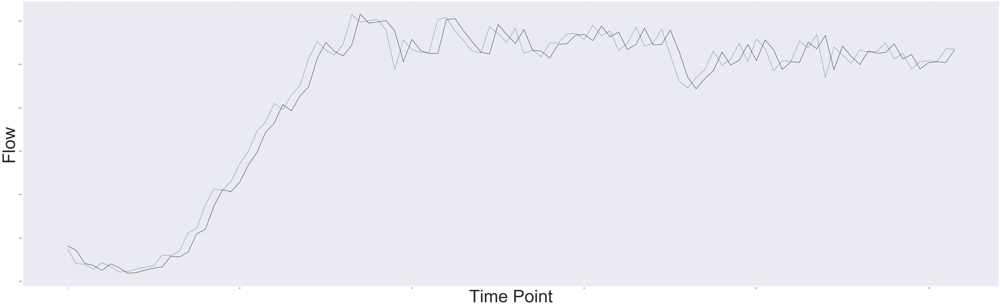

In [39]:
plt.figure(figsize = (100,30))
plt.style.use('seaborn')
ax = plt.gca()
plt.plot(expectations[:int(len(expectations)/5)])
plt.plot(predictions[:int(len(expectations)/5)],'k')
plt.xlabel('Time Point',fontsize = 100)
plt.ylabel('Flow',fontsize = 100)
#ax.set_xticks(fontsize = 100)
plt.show()

In [1]:
#series.plot()

In [14]:
print(supervised_values)

[[0 array([-14.])]
 [array([-14.]) array([-97.])]
 [array([-97.]) array([0.])]
 ...
 [array([-114.]) array([-1.])]
 [array([-1.]) array([-109.])]
 [array([-109.]) array([-87.])]]


In [3]:
data = xlrd.open_workbook('Data.xls')
table = data.sheets()[0]
table2 = data.sheets()[1]
raw_flow = table.col_values(0)
raw_flow2 = table2.col_values(0)
flow = np.array([i for i in raw_flow[1:]])
flow2 = np.array([i for i in raw_flow2[1:]])
series = pd.DataFrame(flow)

In [4]:
#raw_values = series.values
#diff_values = difference(raw_values,1)

# transform data to be supervised learning
#supervised = timeseries_to_supervised(diff_values,1)
#supervised_values = supervised.values

In [ ]:
#(train,test) = train_test_split(supervised_values,rate = 0.92)

# transform the scale of the data
#scaled_train,scaled_test,scaler = train_test_scale(train,test)

In [7]:
#for i in range(len(scaled_test)):
#    X, y = scaled_test[i, 0:-1], scaled_test[i, -1]
#    X = X.reshape(len(X),1)
#    loss = invert_scale(scaler,X,0.)

In [11]:
# scaled_train.shape

(8081, 2)